#### Name: Mrinmayi Gavali

#### Kaggle ID: Mrinmayi

Class: CMPE 256 Large-Scale Analytics

Task: Predict the rating that a user will give to a book given their past book ratings

### Methodology:
 
#### Get the Dataset --> Explore the Dataset --> Perform Pre-processing --> Create Surprise dataset --> Model Selection --> Hyperparameter Tuning and Cross Validation --> Model Evaluation --> Build on Entire Training Set --> Test the Model and Predict Book Ratings

### Import all required packages

In [1]:
#Import the required classes and methods from the surprise library
from surprise import Reader, Dataset
import pandas as pd #For dataframe manipulation
import surprise
import seaborn as sns #For visualization
from surprise import SVD
from surprise import accuracy
from surprise.model_selection import cross_validate

In [2]:
#Define a Reader object
#The Reader object helps in parsing the file or dataframe containing ratings
reader = Reader(rating_scale=(0, 5)) #Our rating values lie in the range (0,5)

df = pd.read_csv('train.csv', sep='\t') #Read the train.csv file into a pandas dataframe

### Explore the Data

In [3]:
#Display the first 5 instances in dataframe
df.head() 

,user_id,book_id,rating
0,12726,7784,5
1,23770,104293,4
2,15669,29291,4
3,649,420180,0
4,10980,7089179,0


In [4]:
#Get a quick view of the counts for each rating value
df.rating.value_counts()

0    239522
5    169680
4    160393
3    105120
2     20837
1      4448
Name: rating, dtype: int64

In [5]:
#Check dimensions of the dataframe
df.shape

(700000, 3)

#### By removing duplicates, rmse reduced significantly

In [6]:
#Drop duplicate rows in place
df.drop_duplicates(subset=['user_id', 'book_id', 'rating'], keep=False, inplace=True)

In [7]:
#Check the changes in counts of ratings
df.rating.value_counts()

0    238532
5    169332
4    160045
3    104914
2     20805
1      4438
Name: rating, dtype: int64

In [8]:
#Check the dimensions again, notice that the duplicate row are removed
df.shape

(698066, 3)

In [9]:
#Check the data types
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 698066 entries, 0 to 699999
Data columns (total 3 columns):
user_id    698066 non-null int64
book_id    698066 non-null int64
rating     698066 non-null int64
dtypes: int64(3)
memory usage: 21.3 MB


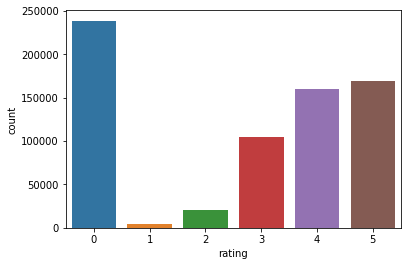

In [10]:
#View a plot of the rating counts
sns.countplot(x="rating", data=df)

In [11]:
#Create the surprise dataset
data = Dataset.load_from_df(df[['user_id', 'book_id', 'rating']], reader)

#### Singular Value Decomposition:
Handle the scalability and sparsity issue created by CF by leveraging a latent factor model to capture the similarity between users and items. Essentially, we want to turn the recommendation problem into an optimization problem. One common metric is Root Mean Square Error (RMSE). The lower the RMSE, the better the performance.

Other models tried: Baseline, KNN, ALS

Best performance obtained using SVD

Evaluation metric: Root Mean Squared Error

Hyperparameters to tune: Number of epochs (n_epochs), Learning rate (lr_all), Regularization parameter (reg_all)

### Model Training and Evaluation

In [18]:
#Define the algorithm with final tuned parameters
algo=SVD(n_factors=132, n_epochs=50, lr_all=0.01, reg_all=0.2, random_state=42, verbose=True)

In [19]:
#Run 5-fold cross-validation and print results
cross_validate(algo, data, measures=['RMSE', 'MAE'], cv=5, verbose=True)

Processing epoch 0
Processing epoch 1
Processing epoch 2
Processing epoch 3
Processing epoch 4
Processing epoch 5
Processing epoch 6
Processing epoch 7
Processing epoch 8
Processing epoch 9
Processing epoch 10
Processing epoch 11
Processing epoch 12
Processing epoch 13
Processing epoch 14
Processing epoch 15
Processing epoch 16
Processing epoch 17
Processing epoch 18
Processing epoch 19
Processing epoch 20
Processing epoch 21
Processing epoch 22
Processing epoch 23
Processing epoch 24
Processing epoch 25
Processing epoch 26
Processing epoch 27
Processing epoch 28
Processing epoch 29
Processing epoch 30
Processing epoch 31
Processing epoch 32
Processing epoch 33
Processing epoch 34
Processing epoch 35
Processing epoch 36
Processing epoch 37
Processing epoch 38
Processing epoch 39
Processing epoch 40
Processing epoch 41
Processing epoch 42
Processing epoch 43
Processing epoch 44
Processing epoch 45
Processing epoch 46
Processing epoch 47
Processing epoch 48
Processing epoch 49
Processing

{'test_rmse': array([1.5549532 , 1.55919079, 1.55552461, 1.55403785, 1.55830344]),
 'test_mae': array([1.24918411, 1.25340096, 1.25132815, 1.25184246, 1.25484964]),
 'fit_time': (93.42463684082031,
  94.30654811859131,
  93.86167621612549,
  95.24901723861694,
  96.58078002929688),
 'test_time': (1.419809103012085,
  1.6159319877624512,
  1.137455940246582,
  1.3416028022766113,
  1.4774999618530273)}

In [35]:
algo.fit(data.build_full_trainset()) #Build the model using entire training dataset after selecting parameters 

Processing epoch 0
Processing epoch 1
Processing epoch 2
Processing epoch 3
Processing epoch 4
Processing epoch 5
Processing epoch 6
Processing epoch 7
Processing epoch 8
Processing epoch 9
Processing epoch 10
Processing epoch 11
Processing epoch 12
Processing epoch 13
Processing epoch 14
Processing epoch 15
Processing epoch 16
Processing epoch 17
Processing epoch 18
Processing epoch 19
Processing epoch 20
Processing epoch 21
Processing epoch 22
Processing epoch 23
Processing epoch 24
Processing epoch 25
Processing epoch 26
Processing epoch 27
Processing epoch 28
Processing epoch 29
Processing epoch 30
Processing epoch 31
Processing epoch 32
Processing epoch 33
Processing epoch 34
Processing epoch 35
Processing epoch 36
Processing epoch 37
Processing epoch 38
Processing epoch 39
Processing epoch 40
Processing epoch 41
Processing epoch 42
Processing epoch 43
Processing epoch 44
Processing epoch 45
Processing epoch 46
Processing epoch 47
Processing epoch 48
Processing epoch 49


In [36]:
#Save the model
filename = 'svdmodel7'
surprise.dump.dump(file_name=filename, predictions=None, algo=algo, verbose=0)

### Saving Results to CSV

In [37]:
#Test the model on test data and save results to a csv file
df1= pd.read_csv('test.csv', sep='\t') #Read the test file into a csv

dfo = pd.DataFrame(columns=['user_id-book_id', 'rating']) #Create a dummy dataframe for submission

for i in range(0, len(df1)):
    uid = df1.iloc[i]['user_id']
    iid = df1.iloc[i]['book_id']
    pred = algo.predict(uid, iid, verbose= True) #This method will predict the ratings considering each pair
    uiid = str(uid) +"-"+ str(iid) 
    dfo.loc[i] = [uiid, pred[3]]

dfo.to_csv('submit11.csv', index = False) #Write the outputs to a csv file

print("Copied results to csv")

user: 20989      item: 1832332    r_ui = None   est = 0.40   {'was_impossible': False}
user: 37040      item: 191139     r_ui = None   est = 3.14   {'was_impossible': False}
user: 36167      item: 28449164   r_ui = None   est = 1.21   {'was_impossible': False}
user: 9398       item: 24693869   r_ui = None   est = 0.37   {'was_impossible': False}
user: 29848      item: 8127       r_ui = None   est = 2.74   {'was_impossible': False}
user: 14822      item: 38674      r_ui = None   est = 4.31   {'was_impossible': False}
user: 11384      item: 1487686    r_ui = None   est = 4.19   {'was_impossible': False}
user: 15022      item: 11630978   r_ui = None   est = 1.48   {'was_impossible': False}
user: 5692       item: 19543      r_ui = None   est = 2.69   {'was_impossible': False}
user: 3522       item: 34268      r_ui = None   est = 1.80   {'was_impossible': False}
user: 19940      item: 824204     r_ui = None   est = 4.37   {'was_impossible': False}
user: 13048      item: 233818     r_ui = No

user: 26200      item: 34184028   r_ui = None   est = 1.56   {'was_impossible': False}
user: 36313      item: 3579       r_ui = None   est = 3.83   {'was_impossible': False}
user: 6305       item: 29422935   r_ui = None   est = 3.08   {'was_impossible': False}
user: 5102       item: 297792     r_ui = None   est = 3.45   {'was_impossible': False}
user: 30030      item: 248165     r_ui = None   est = 2.29   {'was_impossible': False}
user: 35108      item: 795174     r_ui = None   est = 3.31   {'was_impossible': False}
user: 15548      item: 334477     r_ui = None   est = 3.85   {'was_impossible': False}
user: 20169      item: 1925230    r_ui = None   est = 2.89   {'was_impossible': False}
user: 12709      item: 17265260   r_ui = None   est = 1.79   {'was_impossible': False}
user: 5292       item: 28824539   r_ui = None   est = 0.17   {'was_impossible': False}
user: 6885       item: 21481419   r_ui = None   est = 2.24   {'was_impossible': False}
user: 6694       item: 3562       r_ui = No

user: 10025      item: 460505     r_ui = None   est = 0.23   {'was_impossible': False}
user: 8501       item: 119146     r_ui = None   est = 0.16   {'was_impossible': False}
user: 30360      item: 23217709   r_ui = None   est = 0.87   {'was_impossible': False}
user: 32065      item: 25328312   r_ui = None   est = 0.36   {'was_impossible': False}
user: 8726       item: 4538       r_ui = None   est = 3.71   {'was_impossible': False}
user: 11261      item: 11192642   r_ui = None   est = 2.91   {'was_impossible': False}
user: 33113      item: 140225     r_ui = None   est = 4.11   {'was_impossible': False}
user: 4931       item: 11891485   r_ui = None   est = 1.15   {'was_impossible': False}
user: 13952      item: 904966     r_ui = None   est = 0.79   {'was_impossible': False}
user: 4490       item: 37755      r_ui = None   est = 0.12   {'was_impossible': False}
user: 32359      item: 508208     r_ui = None   est = 0.96   {'was_impossible': False}
user: 33999      item: 436078     r_ui = No

user: 6315       item: 39106      r_ui = None   est = 2.35   {'was_impossible': False}
user: 5709       item: 233818     r_ui = None   est = 4.17   {'was_impossible': False}
user: 11766      item: 4948       r_ui = None   est = 1.29   {'was_impossible': False}
user: 6865       item: 5          r_ui = None   est = 3.26   {'was_impossible': False}
user: 7270       item: 77390      r_ui = None   est = 1.37   {'was_impossible': False}
user: 32754      item: 22917      r_ui = None   est = 3.91   {'was_impossible': False}
user: 8622       item: 23223164   r_ui = None   est = 0.63   {'was_impossible': False}
user: 4009       item: 139985     r_ui = None   est = 2.37   {'was_impossible': False}
user: 12243      item: 81808      r_ui = None   est = 4.08   {'was_impossible': False}
user: 911        item: 1071343    r_ui = None   est = 2.24   {'was_impossible': False}
user: 13496      item: 5972040    r_ui = None   est = 3.46   {'was_impossible': False}
user: 10283      item: 91248      r_ui = No

user: 24151      item: 125333     r_ui = None   est = 3.56   {'was_impossible': False}
user: 18190      item: 8253       r_ui = None   est = 4.06   {'was_impossible': False}
user: 17447      item: 7783920    r_ui = None   est = 1.91   {'was_impossible': False}
user: 35531      item: 17243865   r_ui = None   est = 2.27   {'was_impossible': False}
user: 27872      item: 17369219   r_ui = None   est = 3.50   {'was_impossible': False}
user: 17799      item: 7784       r_ui = None   est = 3.35   {'was_impossible': False}
user: 13057      item: 5659       r_ui = None   est = 2.00   {'was_impossible': False}
user: 2661       item: 17290220   r_ui = None   est = 2.77   {'was_impossible': False}
user: 34915      item: 4018570    r_ui = None   est = 3.80   {'was_impossible': False}
user: 31738      item: 4553794    r_ui = None   est = 2.41   {'was_impossible': False}
user: 14709      item: 826582     r_ui = None   est = 3.69   {'was_impossible': False}
user: 12496      item: 439173     r_ui = No

user: 6608       item: 198719     r_ui = None   est = 2.52   {'was_impossible': False}
user: 6611       item: 65119      r_ui = None   est = 0.22   {'was_impossible': False}
user: 36865      item: 370493     r_ui = None   est = 1.39   {'was_impossible': False}
user: 10726      item: 39518      r_ui = None   est = 0.94   {'was_impossible': False}
user: 24002      item: 397157     r_ui = None   est = 3.10   {'was_impossible': False}
user: 3788       item: 6177287    r_ui = None   est = 0.00   {'was_impossible': False}
user: 5878       item: 444381     r_ui = None   est = 2.23   {'was_impossible': False}
user: 9652       item: 65646      r_ui = None   est = 2.84   {'was_impossible': False}
user: 21070      item: 378        r_ui = None   est = 4.28   {'was_impossible': False}
user: 35312      item: 9475       r_ui = None   est = 1.97   {'was_impossible': False}
user: 33177      item: 201126     r_ui = None   est = 3.04   {'was_impossible': False}
user: 10396      item: 15766602   r_ui = No

user: 22102      item: 125538     r_ui = None   est = 2.54   {'was_impossible': False}
user: 24897      item: 397150     r_ui = None   est = 1.79   {'was_impossible': False}
user: 5490       item: 907988     r_ui = None   est = 2.37   {'was_impossible': False}
user: 25863      item: 65111      r_ui = None   est = 3.65   {'was_impossible': False}
user: 14144      item: 8127       r_ui = None   est = 2.70   {'was_impossible': False}
user: 15810      item: 18599852   r_ui = None   est = 1.64   {'was_impossible': False}
user: 22652      item: 19543      r_ui = None   est = 3.30   {'was_impossible': False}
user: 25473      item: 8127       r_ui = None   est = 2.72   {'was_impossible': False}
user: 4516       item: 775597     r_ui = None   est = 4.14   {'was_impossible': False}
user: 33446      item: 92579      r_ui = None   est = 3.79   {'was_impossible': False}
user: 21777      item: 8073       r_ui = None   est = 2.31   {'was_impossible': False}
user: 10338      item: 389627     r_ui = No

user: 22134      item: 295834     r_ui = None   est = 1.57   {'was_impossible': False}
user: 2739       item: 1002520    r_ui = None   est = 3.34   {'was_impossible': False}
user: 22635      item: 728477     r_ui = None   est = 3.24   {'was_impossible': False}
user: 19181      item: 10739824   r_ui = None   est = 2.64   {'was_impossible': False}
user: 4521       item: 389627     r_ui = None   est = 2.62   {'was_impossible': False}
user: 36739      item: 322351     r_ui = None   est = 2.81   {'was_impossible': False}
user: 29848      item: 159061     r_ui = None   est = 2.92   {'was_impossible': False}
user: 1610       item: 196970     r_ui = None   est = 1.92   {'was_impossible': False}
user: 11352      item: 10959      r_ui = None   est = 3.31   {'was_impossible': False}
user: 16103      item: 1199553    r_ui = None   est = 0.00   {'was_impossible': False}
user: 13908      item: 1948298    r_ui = None   est = 2.78   {'was_impossible': False}
user: 9898       item: 1801939    r_ui = No

user: 29427      item: 3636       r_ui = None   est = 1.44   {'was_impossible': False}
user: 36657      item: 297792     r_ui = None   est = 2.83   {'was_impossible': False}
user: 764        item: 77392      r_ui = None   est = 4.18   {'was_impossible': False}
user: 5702       item: 38709      r_ui = None   est = 3.85   {'was_impossible': False}
user: 26834      item: 16119259   r_ui = None   est = 0.91   {'was_impossible': False}
user: 6110       item: 654258     r_ui = None   est = 3.02   {'was_impossible': False}
user: 2872       item: 883302     r_ui = None   est = 4.04   {'was_impossible': False}
user: 36704      item: 766955     r_ui = None   est = 2.82   {'was_impossible': False}
user: 14872      item: 6330332    r_ui = None   est = 2.50   {'was_impossible': False}
user: 18491      item: 517344     r_ui = None   est = 1.30   {'was_impossible': False}
user: 3498       item: 13447545   r_ui = None   est = 3.53   {'was_impossible': False}
user: 31765      item: 225038     r_ui = No

user: 28992      item: 2584775    r_ui = None   est = 3.06   {'was_impossible': False}
user: 27474      item: 77270      r_ui = None   est = 2.25   {'was_impossible': False}
user: 936        item: 172327     r_ui = None   est = 0.70   {'was_impossible': False}
user: 17546      item: 8073       r_ui = None   est = 3.11   {'was_impossible': False}
user: 11066      item: 122102     r_ui = None   est = 2.85   {'was_impossible': False}
user: 31377      item: 646195     r_ui = None   est = 0.37   {'was_impossible': False}
user: 19927      item: 1660822    r_ui = None   est = 1.42   {'was_impossible': False}
user: 19002      item: 23438427   r_ui = None   est = 2.18   {'was_impossible': False}
user: 3622       item: 17488      r_ui = None   est = 3.32   {'was_impossible': False}
user: 34089      item: 3008       r_ui = None   est = 3.44   {'was_impossible': False}
user: 5442       item: 1037891    r_ui = None   est = 0.85   {'was_impossible': False}
user: 29897      item: 3636       r_ui = No

user: 30362      item: 11192642   r_ui = None   est = 2.59   {'was_impossible': False}
user: 8599       item: 1967071    r_ui = None   est = 3.67   {'was_impossible': False}
user: 30185      item: 6481105    r_ui = None   est = 0.64   {'was_impossible': False}
user: 20169      item: 3980       r_ui = None   est = 2.72   {'was_impossible': False}
user: 30763      item: 210252     r_ui = None   est = 0.22   {'was_impossible': False}
user: 30969      item: 99110      r_ui = None   est = 3.88   {'was_impossible': False}
user: 26971      item: 113946     r_ui = None   est = 4.75   {'was_impossible': False}
user: 14646      item: 111000     r_ui = None   est = 2.18   {'was_impossible': False}
user: 3532       item: 109796     r_ui = None   est = 3.45   {'was_impossible': False}
user: 27134      item: 32979      r_ui = None   est = 3.76   {'was_impossible': False}
user: 14388      item: 111750     r_ui = None   est = 3.29   {'was_impossible': False}
user: 10299      item: 78418      r_ui = No

user: 29025      item: 3799       r_ui = None   est = 4.00   {'was_impossible': False}
user: 1590       item: 24213      r_ui = None   est = 3.97   {'was_impossible': False}
user: 36568      item: 131161     r_ui = None   est = 2.41   {'was_impossible': False}
user: 8579       item: 348573     r_ui = None   est = 1.34   {'was_impossible': False}
user: 36070      item: 414066     r_ui = None   est = 0.85   {'was_impossible': False}
user: 17021      item: 12711152   r_ui = None   est = 0.32   {'was_impossible': False}
user: 37060      item: 8797       r_ui = None   est = 3.41   {'was_impossible': False}
user: 27184      item: 3864058    r_ui = None   est = 3.70   {'was_impossible': False}
user: 25689      item: 120669     r_ui = None   est = 3.18   {'was_impossible': False}
user: 21000      item: 23108939   r_ui = None   est = 3.07   {'was_impossible': False}
user: 9316       item: 1110905    r_ui = None   est = 4.01   {'was_impossible': False}
user: 9583       item: 3247371    r_ui = No

user: 15034      item: 3293821    r_ui = None   est = 3.34   {'was_impossible': False}
user: 33810      item: 191139     r_ui = None   est = 2.43   {'was_impossible': False}
user: 14872      item: 755002     r_ui = None   est = 2.21   {'was_impossible': False}
user: 29232      item: 6319       r_ui = None   est = 3.17   {'was_impossible': False}
user: 8612       item: 349170     r_ui = None   est = 2.49   {'was_impossible': False}
user: 34901      item: 3017992    r_ui = None   est = 2.67   {'was_impossible': False}
user: 18319      item: 6319       r_ui = None   est = 4.75   {'was_impossible': False}
user: 7128       item: 17730979   r_ui = None   est = 1.68   {'was_impossible': False}
user: 5102       item: 232092     r_ui = None   est = 3.76   {'was_impossible': False}
user: 23166      item: 7784       r_ui = None   est = 4.88   {'was_impossible': False}
user: 36345      item: 7737606    r_ui = None   est = 1.98   {'was_impossible': False}
user: 9891       item: 7870217    r_ui = No

user: 4511       item: 77767      r_ui = None   est = 3.14   {'was_impossible': False}
user: 21000      item: 17571568   r_ui = None   est = 3.37   {'was_impossible': False}
user: 3136       item: 11312      r_ui = None   est = 0.00   {'was_impossible': False}
user: 34823      item: 231850     r_ui = None   est = 3.32   {'was_impossible': False}
user: 28379      item: 37190      r_ui = None   est = 2.78   {'was_impossible': False}
user: 24289      item: 1335185    r_ui = None   est = 3.21   {'was_impossible': False}
user: 25353      item: 407429     r_ui = None   est = 3.83   {'was_impossible': False}
user: 16625      item: 705257     r_ui = None   est = 2.61   {'was_impossible': False}
user: 27801      item: 157993     r_ui = None   est = 1.03   {'was_impossible': False}
user: 37207      item: 24178      r_ui = None   est = 4.21   {'was_impossible': False}
user: 33575      item: 10365      r_ui = None   est = 2.48   {'was_impossible': False}
user: 20218      item: 37741      r_ui = No

user: 18689      item: 7505716    r_ui = None   est = 2.46   {'was_impossible': False}
user: 28129      item: 30119      r_ui = None   est = 3.69   {'was_impossible': False}
user: 12546      item: 263656     r_ui = None   est = 3.59   {'was_impossible': False}
user: 35624      item: 118230     r_ui = None   est = 3.17   {'was_impossible': False}
user: 32165      item: 1095518    r_ui = None   est = 3.31   {'was_impossible': False}
user: 34905      item: 325421     r_ui = None   est = 4.42   {'was_impossible': False}
user: 18986      item: 117930     r_ui = None   est = 1.96   {'was_impossible': False}
user: 36636      item: 23493357   r_ui = None   est = 0.72   {'was_impossible': False}
user: 14974      item: 6327       r_ui = None   est = 3.79   {'was_impossible': False}
user: 21479      item: 11192642   r_ui = None   est = 2.80   {'was_impossible': False}
user: 16507      item: 951880     r_ui = None   est = 1.04   {'was_impossible': False}
user: 37145      item: 12559804   r_ui = No

user: 8297       item: 62111      r_ui = None   est = 3.60   {'was_impossible': False}
user: 10753      item: 15727792   r_ui = None   est = 1.62   {'was_impossible': False}
user: 31752      item: 15799012   r_ui = None   est = 3.43   {'was_impossible': False}
user: 31093      item: 24963      r_ui = None   est = 0.86   {'was_impossible': False}
user: 9871       item: 11387515   r_ui = None   est = 2.26   {'was_impossible': False}
user: 18723      item: 10444      r_ui = None   est = 4.24   {'was_impossible': False}
user: 11384      item: 238250     r_ui = None   est = 3.31   {'was_impossible': False}
user: 20169      item: 3875427    r_ui = None   est = 2.20   {'was_impossible': False}
user: 1285       item: 2839       r_ui = None   est = 3.76   {'was_impossible': False}
user: 30651      item: 1981273    r_ui = None   est = 3.39   {'was_impossible': False}
user: 1507       item: 2556590    r_ui = None   est = 2.51   {'was_impossible': False}
user: 1174       item: 15728122   r_ui = No

user: 31017      item: 11387515   r_ui = None   est = 3.05   {'was_impossible': False}
user: 23615      item: 77395      r_ui = None   est = 3.53   {'was_impossible': False}
user: 9309       item: 13023      r_ui = None   est = 3.92   {'was_impossible': False}
user: 15394      item: 299384     r_ui = None   est = 4.49   {'was_impossible': False}
user: 10491      item: 2001686    r_ui = None   est = 2.17   {'was_impossible': False}
user: 26376      item: 519048     r_ui = None   est = 1.04   {'was_impossible': False}
user: 8037       item: 7552387    r_ui = None   est = 1.94   {'was_impossible': False}
user: 19664      item: 153168     r_ui = None   est = 4.20   {'was_impossible': False}
user: 34121      item: 47281      r_ui = None   est = 2.63   {'was_impossible': False}
user: 22979      item: 11737313   r_ui = None   est = 1.50   {'was_impossible': False}
user: 9390       item: 10818982   r_ui = None   est = 2.97   {'was_impossible': False}
user: 1961       item: 24612624   r_ui = No

user: 28315      item: 9556836    r_ui = None   est = 3.11   {'was_impossible': False}
user: 17268      item: 132609     r_ui = None   est = 3.54   {'was_impossible': False}
user: 8219       item: 39988      r_ui = None   est = 3.90   {'was_impossible': False}
user: 25503      item: 267972     r_ui = None   est = 3.52   {'was_impossible': False}
user: 18646      item: 11607446   r_ui = None   est = 1.75   {'was_impossible': False}
user: 36365      item: 23310699   r_ui = None   est = 3.12   {'was_impossible': False}
user: 5182       item: 46677      r_ui = None   est = 4.74   {'was_impossible': False}
user: 11181      item: 144974     r_ui = None   est = 3.63   {'was_impossible': False}
user: 14394      item: 569977     r_ui = None   est = 3.41   {'was_impossible': False}
user: 7215       item: 1338654    r_ui = None   est = 3.30   {'was_impossible': False}
user: 13327      item: 1046916    r_ui = None   est = 2.70   {'was_impossible': False}
user: 13619      item: 100448     r_ui = No

user: 7427       item: 14118      r_ui = None   est = 3.80   {'was_impossible': False}
user: 8315       item: 762288     r_ui = None   est = 3.34   {'was_impossible': False}
user: 409        item: 8127       r_ui = None   est = 4.32   {'was_impossible': False}
user: 18691      item: 4948       r_ui = None   est = 3.91   {'was_impossible': False}
user: 16013      item: 117645     r_ui = None   est = 2.74   {'was_impossible': False}
user: 755        item: 426912     r_ui = None   est = 1.74   {'was_impossible': False}
user: 20377      item: 2090470    r_ui = None   est = 3.02   {'was_impossible': False}
user: 1029       item: 32978      r_ui = None   est = 2.69   {'was_impossible': False}
user: 2032       item: 84369      r_ui = None   est = 3.17   {'was_impossible': False}
user: 33148      item: 33115314   r_ui = None   est = 2.69   {'was_impossible': False}
user: 27383      item: 397150     r_ui = None   est = 3.82   {'was_impossible': False}
user: 24068      item: 24178      r_ui = No

user: 32359      item: 541417     r_ui = None   est = 1.95   {'was_impossible': False}
user: 10257      item: 23772      r_ui = None   est = 4.76   {'was_impossible': False}
user: 19951      item: 196967     r_ui = None   est = 4.19   {'was_impossible': False}
user: 10491      item: 42278      r_ui = None   est = 3.21   {'was_impossible': False}
user: 14316      item: 84981      r_ui = None   est = 3.66   {'was_impossible': False}
user: 15474      item: 21348      r_ui = None   est = 3.88   {'was_impossible': False}
user: 3972       item: 5          r_ui = None   est = 3.85   {'was_impossible': False}
user: 3771       item: 39988      r_ui = None   est = 1.91   {'was_impossible': False}
user: 19729      item: 3191536    r_ui = None   est = 2.74   {'was_impossible': False}
user: 6653       item: 13429619   r_ui = None   est = 1.76   {'was_impossible': False}
user: 2578       item: 131123     r_ui = None   est = 1.89   {'was_impossible': False}
user: 27787      item: 361719     r_ui = No

user: 16018      item: 645343     r_ui = None   est = 3.11   {'was_impossible': False}
user: 2483       item: 15015619   r_ui = None   est = 3.41   {'was_impossible': False}
user: 19310      item: 2190073    r_ui = None   est = 2.54   {'was_impossible': False}
user: 34874      item: 667776     r_ui = None   est = 3.22   {'was_impossible': False}
user: 24897      item: 29290      r_ui = None   est = 1.38   {'was_impossible': False}
user: 33201      item: 3980       r_ui = None   est = 2.32   {'was_impossible': False}
user: 34172      item: 12975886   r_ui = None   est = 1.52   {'was_impossible': False}
user: 609        item: 324277     r_ui = None   est = 1.00   {'was_impossible': False}
user: 36636      item: 24833677   r_ui = None   est = 0.13   {'was_impossible': False}
user: 23898      item: 280049     r_ui = None   est = 0.36   {'was_impossible': False}
user: 27576      item: 513310     r_ui = None   est = 3.05   {'was_impossible': False}
user: 9693       item: 1494586    r_ui = No

user: 17640      item: 30971018   r_ui = None   est = 3.61   {'was_impossible': False}
user: 4423       item: 509094     r_ui = None   est = 1.21   {'was_impossible': False}
user: 31214      item: 1084636    r_ui = None   est = 3.08   {'was_impossible': False}
user: 25547      item: 22173484   r_ui = None   est = 2.11   {'was_impossible': False}
user: 9329       item: 420404     r_ui = None   est = 4.31   {'was_impossible': False}
user: 11454      item: 372638     r_ui = None   est = 4.06   {'was_impossible': False}
user: 15832      item: 761170     r_ui = None   est = 3.49   {'was_impossible': False}
user: 19762      item: 84369      r_ui = None   est = 3.27   {'was_impossible': False}
user: 5292       item: 27509910   r_ui = None   est = 0.06   {'was_impossible': False}
user: 3788       item: 23657459   r_ui = None   est = 0.00   {'was_impossible': False}
user: 5596       item: 3552023    r_ui = None   est = 3.28   {'was_impossible': False}
user: 8811       item: 471928     r_ui = No

user: 24960      item: 23309600   r_ui = None   est = 1.36   {'was_impossible': False}
user: 31679      item: 7788       r_ui = None   est = 4.46   {'was_impossible': False}
user: 29789      item: 30312876   r_ui = None   est = 2.61   {'was_impossible': False}
user: 2993       item: 1830570    r_ui = None   est = 1.71   {'was_impossible': False}
user: 18144      item: 20718289   r_ui = None   est = 2.90   {'was_impossible': False}
user: 21012      item: 824204     r_ui = None   est = 4.75   {'was_impossible': False}
user: 7896       item: 2479987    r_ui = None   est = 3.88   {'was_impossible': False}
user: 22746      item: 62111      r_ui = None   est = 0.42   {'was_impossible': False}
user: 10881      item: 8346300    r_ui = None   est = 3.10   {'was_impossible': False}
user: 25611      item: 831470     r_ui = None   est = 3.44   {'was_impossible': False}
user: 21079      item: 767680     r_ui = None   est = 2.95   {'was_impossible': False}
user: 14340      item: 7961855    r_ui = No

user: 21104      item: 10178007   r_ui = None   est = 2.99   {'was_impossible': False}
user: 26613      item: 331701     r_ui = None   est = 4.35   {'was_impossible': False}
user: 8381       item: 3636       r_ui = None   est = 3.00   {'was_impossible': False}
user: 30495      item: 20484662   r_ui = None   est = 2.24   {'was_impossible': False}
user: 2483       item: 1717123    r_ui = None   est = 2.75   {'was_impossible': False}
user: 28883      item: 6345760    r_ui = None   est = 2.35   {'was_impossible': False}
user: 260        item: 4538       r_ui = None   est = 2.41   {'was_impossible': False}
user: 8576       item: 160629     r_ui = None   est = 3.69   {'was_impossible': False}
user: 34439      item: 853183     r_ui = None   est = 2.87   {'was_impossible': False}
user: 17133      item: 6310       r_ui = None   est = 3.99   {'was_impossible': False}
user: 3471       item: 3579       r_ui = None   est = 3.88   {'was_impossible': False}
user: 35685      item: 820273     r_ui = No

user: 18397      item: 7909       r_ui = None   est = 1.15   {'was_impossible': False}
user: 34455      item: 2839       r_ui = None   est = 0.84   {'was_impossible': False}
user: 31280      item: 9958       r_ui = None   est = 1.91   {'was_impossible': False}
user: 784        item: 25893953   r_ui = None   est = 3.99   {'was_impossible': False}
user: 32512      item: 303136     r_ui = None   est = 2.40   {'was_impossible': False}
user: 25305      item: 77390      r_ui = None   est = 1.57   {'was_impossible': False}
user: 3870       item: 324277     r_ui = None   est = 0.55   {'was_impossible': False}
user: 28153      item: 84981      r_ui = None   est = 3.11   {'was_impossible': False}
user: 24969      item: 84369      r_ui = None   est = 3.88   {'was_impossible': False}
user: 25977      item: 1900124    r_ui = None   est = 2.07   {'was_impossible': False}
user: 21000      item: 14352709   r_ui = None   est = 3.37   {'was_impossible': False}
user: 30824      item: 38709      r_ui = No

user: 31995      item: 859383     r_ui = None   est = 2.49   {'was_impossible': False}
user: 3398       item: 47281      r_ui = None   est = 2.74   {'was_impossible': False}
user: 17480      item: 17493      r_ui = None   est = 4.54   {'was_impossible': False}
user: 23617      item: 13083239   r_ui = None   est = 3.16   {'was_impossible': False}
user: 17962      item: 9212014    r_ui = None   est = 2.54   {'was_impossible': False}
user: 13587      item: 8127       r_ui = None   est = 3.97   {'was_impossible': False}
user: 21079      item: 348566     r_ui = None   est = 1.12   {'was_impossible': False}
user: 13569      item: 48795      r_ui = None   est = 2.75   {'was_impossible': False}
user: 5350       item: 277906     r_ui = None   est = 2.57   {'was_impossible': False}
user: 13291      item: 13023      r_ui = None   est = 1.09   {'was_impossible': False}
user: 6038       item: 862618     r_ui = None   est = 3.99   {'was_impossible': False}
user: 4375       item: 7871564    r_ui = No

user: 35822      item: 282773     r_ui = None   est = 1.64   {'was_impossible': False}
user: 10046      item: 37732      r_ui = None   est = 3.64   {'was_impossible': False}
user: 4557       item: 38709      r_ui = None   est = 1.89   {'was_impossible': False}
user: 13989      item: 18815317   r_ui = None   est = 1.21   {'was_impossible': False}
user: 11714      item: 3008       r_ui = None   est = 3.30   {'was_impossible': False}
user: 16409      item: 131121     r_ui = None   est = 0.92   {'was_impossible': False}
user: 13470      item: 815234     r_ui = None   est = 1.16   {'was_impossible': False}
user: 19791      item: 325416     r_ui = None   est = 3.30   {'was_impossible': False}
user: 28498      item: 699812     r_ui = None   est = 2.62   {'was_impossible': False}
user: 8599       item: 1967067    r_ui = None   est = 4.24   {'was_impossible': False}
user: 7583       item: 13593725   r_ui = None   est = 2.40   {'was_impossible': False}
user: 36939      item: 11097467   r_ui = No

user: 16409      item: 18873327   r_ui = None   est = 0.00   {'was_impossible': False}
user: 22090      item: 18490605   r_ui = None   est = 1.94   {'was_impossible': False}
user: 25080      item: 421118     r_ui = None   est = 2.65   {'was_impossible': False}
user: 25305      item: 23215466   r_ui = None   est = 0.22   {'was_impossible': False}
user: 19561      item: 26102528   r_ui = None   est = 2.69   {'was_impossible': False}
user: 35624      item: 17981422   r_ui = None   est = 2.23   {'was_impossible': False}
user: 25861      item: 370493     r_ui = None   est = 4.45   {'was_impossible': False}
user: 2820       item: 17600      r_ui = None   est = 0.57   {'was_impossible': False}
user: 11993      item: 50         r_ui = None   est = 2.34   {'was_impossible': False}
user: 11777      item: 370493     r_ui = None   est = 0.81   {'was_impossible': False}
user: 32210      item: 5659       r_ui = None   est = 2.26   {'was_impossible': False}
user: 34094      item: 13461      r_ui = No

user: 28929      item: 815158     r_ui = None   est = 2.97   {'was_impossible': False}
user: 32058      item: 1624581    r_ui = None   est = 3.12   {'was_impossible': False}
user: 22280      item: 2610731    r_ui = None   est = 3.50   {'was_impossible': False}
user: 4378       item: 80349      r_ui = None   est = 2.02   {'was_impossible': False}
user: 16904      item: 15780896   r_ui = None   est = 2.74   {'was_impossible': False}
user: 20460      item: 50         r_ui = None   est = 3.62   {'was_impossible': False}
user: 7249       item: 30119      r_ui = None   est = 0.90   {'was_impossible': False}
user: 20755      item: 2696444    r_ui = None   est = 1.80   {'was_impossible': False}
user: 13177      item: 10530293   r_ui = None   est = 3.50   {'was_impossible': False}
user: 21070      item: 89545      r_ui = None   est = 3.83   {'was_impossible': False}
user: 18299      item: 37377      r_ui = None   est = 0.71   {'was_impossible': False}
user: 27781      item: 15779      r_ui = No

user: 26613      item: 78951      r_ui = None   est = 3.89   {'was_impossible': False}
user: 20165      item: 5          r_ui = None   est = 3.23   {'was_impossible': False}
user: 919        item: 511641     r_ui = None   est = 2.39   {'was_impossible': False}
user: 8057       item: 5          r_ui = None   est = 2.95   {'was_impossible': False}
user: 7514       item: 13574415   r_ui = None   est = 0.43   {'was_impossible': False}
user: 28330      item: 181087     r_ui = None   est = 1.08   {'was_impossible': False}
user: 13448      item: 23772      r_ui = None   est = 2.31   {'was_impossible': False}
user: 28416      item: 41684      r_ui = None   est = 3.63   {'was_impossible': False}
user: 16445      item: 25579443   r_ui = None   est = 0.07   {'was_impossible': False}
user: 37145      item: 279692     r_ui = None   est = 4.04   {'was_impossible': False}
user: 13894      item: 125536     r_ui = None   est = 2.24   {'was_impossible': False}
user: 16992      item: 189182     r_ui = No

user: 27901      item: 23399303   r_ui = None   est = 2.96   {'was_impossible': False}
user: 8201       item: 22403130   r_ui = None   est = 3.54   {'was_impossible': False}
user: 16938      item: 8337       r_ui = None   est = 1.45   {'was_impossible': False}
user: 18986      item: 1154350    r_ui = None   est = 2.94   {'was_impossible': False}
user: 2988       item: 767680     r_ui = None   est = 3.53   {'was_impossible': False}
user: 32357      item: 18615267   r_ui = None   est = 1.91   {'was_impossible': False}
user: 9558       item: 4143272    r_ui = None   est = 1.92   {'was_impossible': False}
user: 34660      item: 9822       r_ui = None   est = 2.80   {'was_impossible': False}
user: 9365       item: 44186      r_ui = None   est = 4.55   {'was_impossible': False}
user: 21000      item: 15790099   r_ui = None   est = 3.80   {'was_impossible': False}
user: 15187      item: 2453640    r_ui = None   est = 3.07   {'was_impossible': False}
user: 28478      item: 641680     r_ui = No

user: 27184      item: 22749769   r_ui = None   est = 3.17   {'was_impossible': False}
user: 18713      item: 74996      r_ui = None   est = 3.08   {'was_impossible': False}
user: 24855      item: 786256     r_ui = None   est = 3.50   {'was_impossible': False}
user: 15209      item: 31019617   r_ui = None   est = 0.92   {'was_impossible': False}
user: 18106      item: 2929655    r_ui = None   est = 3.61   {'was_impossible': False}
user: 1849       item: 351018     r_ui = None   est = 1.62   {'was_impossible': False}
user: 6240       item: 4948       r_ui = None   est = 4.39   {'was_impossible': False}
user: 14900      item: 331701     r_ui = None   est = 1.20   {'was_impossible': False}
user: 16018      item: 14431301   r_ui = None   est = 3.50   {'was_impossible': False}
user: 14701      item: 2998       r_ui = None   est = 0.72   {'was_impossible': False}
user: 30712      item: 1300866    r_ui = None   est = 2.56   {'was_impossible': False}
user: 18316      item: 74532      r_ui = No

user: 31028      item: 319966     r_ui = None   est = 3.29   {'was_impossible': False}
user: 36704      item: 858513     r_ui = None   est = 2.86   {'was_impossible': False}
user: 36159      item: 3562       r_ui = None   est = 3.86   {'was_impossible': False}
user: 34294      item: 139463     r_ui = None   est = 4.17   {'was_impossible': False}
user: 19101      item: 1032747    r_ui = None   est = 2.27   {'was_impossible': False}
user: 19223      item: 161656     r_ui = None   est = 2.12   {'was_impossible': False}
user: 28542      item: 682751     r_ui = None   est = 4.26   {'was_impossible': False}
user: 24385      item: 163716     r_ui = None   est = 3.01   {'was_impossible': False}
user: 1613       item: 319976     r_ui = None   est = 0.62   {'was_impossible': False}
user: 32565      item: 512444     r_ui = None   est = 2.90   {'was_impossible': False}
user: 22928      item: 5          r_ui = None   est = 3.74   {'was_impossible': False}
user: 14272      item: 125542     r_ui = No

user: 6825       item: 30971740   r_ui = None   est = 2.91   {'was_impossible': False}
user: 8431       item: 16060026   r_ui = None   est = 0.57   {'was_impossible': False}
user: 15581      item: 792225     r_ui = None   est = 1.85   {'was_impossible': False}
user: 34421      item: 206090     r_ui = None   est = 3.45   {'was_impossible': False}
user: 239        item: 233093     r_ui = None   est = 3.72   {'was_impossible': False}
user: 17227      item: 1814889    r_ui = None   est = 0.88   {'was_impossible': False}
user: 31504      item: 1049070    r_ui = None   est = 4.54   {'was_impossible': False}
user: 22472      item: 125557     r_ui = None   est = 1.93   {'was_impossible': False}
user: 2696       item: 412603     r_ui = None   est = 2.81   {'was_impossible': False}
user: 28410      item: 125538     r_ui = None   est = 3.31   {'was_impossible': False}
user: 16698      item: 1342903    r_ui = None   est = 0.92   {'was_impossible': False}
user: 33163      item: 30119      r_ui = No

user: 25361      item: 21965059   r_ui = None   est = 3.03   {'was_impossible': False}
user: 2347       item: 420386     r_ui = None   est = 1.93   {'was_impossible': False}
user: 12004      item: 18721221   r_ui = None   est = 3.12   {'was_impossible': False}
user: 37230      item: 47693      r_ui = None   est = 3.46   {'was_impossible': False}
user: 33844      item: 2617684    r_ui = None   est = 4.54   {'was_impossible': False}
user: 8589       item: 2652580    r_ui = None   est = 3.16   {'was_impossible': False}
user: 6796       item: 79667      r_ui = None   est = 2.75   {'was_impossible': False}
user: 22455      item: 31146960   r_ui = None   est = 2.52   {'was_impossible': False}
user: 5451       item: 32929      r_ui = None   est = 3.65   {'was_impossible': False}
user: 7319       item: 17333246   r_ui = None   est = 3.11   {'was_impossible': False}
user: 22134      item: 3562       r_ui = None   est = 1.98   {'was_impossible': False}
user: 30332      item: 5          r_ui = No

user: 32736      item: 391805     r_ui = None   est = 3.56   {'was_impossible': False}
user: 21000      item: 11477054   r_ui = None   est = 3.70   {'was_impossible': False}
user: 1805       item: 370493     r_ui = None   est = 4.25   {'was_impossible': False}
user: 33263      item: 125507     r_ui = None   est = 3.96   {'was_impossible': False}
user: 17574      item: 7002115    r_ui = None   est = 2.49   {'was_impossible': False}
user: 14531      item: 39988      r_ui = None   est = 4.06   {'was_impossible': False}
user: 27382      item: 18948490   r_ui = None   est = 1.40   {'was_impossible': False}
user: 22113      item: 94804      r_ui = None   est = 4.09   {'was_impossible': False}
user: 3392       item: 3139694    r_ui = None   est = 0.00   {'was_impossible': False}
user: 6199       item: 55734      r_ui = None   est = 2.75   {'was_impossible': False}
user: 20755      item: 658036     r_ui = None   est = 1.99   {'was_impossible': False}
user: 11437      item: 32078585   r_ui = No

user: 36049      item: 8253       r_ui = None   est = 4.44   {'was_impossible': False}
user: 21070      item: 18298747   r_ui = None   est = 3.71   {'was_impossible': False}
user: 7771       item: 103386     r_ui = None   est = 3.02   {'was_impossible': False}
user: 30979      item: 334485     r_ui = None   est = 3.10   {'was_impossible': False}
user: 28463      item: 28665599   r_ui = None   est = 0.72   {'was_impossible': False}
user: 6865       item: 8073       r_ui = None   est = 2.40   {'was_impossible': False}
user: 24425      item: 37738      r_ui = None   est = 3.52   {'was_impossible': False}
user: 28485      item: 460496     r_ui = None   est = 3.15   {'was_impossible': False}
user: 35654      item: 563760     r_ui = None   est = 3.33   {'was_impossible': False}
user: 23292      item: 213626     r_ui = None   est = 3.23   {'was_impossible': False}
user: 36821      item: 125404     r_ui = None   est = 3.45   {'was_impossible': False}
user: 16331      item: 27857774   r_ui = No

user: 3028       item: 48762      r_ui = None   est = 4.25   {'was_impossible': False}
user: 12396      item: 77270      r_ui = None   est = 2.08   {'was_impossible': False}
user: 11280      item: 558372     r_ui = None   est = 0.71   {'was_impossible': False}
user: 20601      item: 39988      r_ui = None   est = 3.41   {'was_impossible': False}
user: 25230      item: 1442968    r_ui = None   est = 3.14   {'was_impossible': False}
user: 4008       item: 646195     r_ui = None   est = 0.85   {'was_impossible': False}
user: 23970      item: 786256     r_ui = None   est = 4.14   {'was_impossible': False}
user: 25766      item: 401679     r_ui = None   est = 2.97   {'was_impossible': False}
user: 20169      item: 669839     r_ui = None   est = 3.02   {'was_impossible': False}
user: 24605      item: 6945039    r_ui = None   est = 3.71   {'was_impossible': False}
user: 2483       item: 28863341   r_ui = None   est = 2.71   {'was_impossible': False}
user: 6702       item: 26546261   r_ui = No

user: 25504      item: 8039941    r_ui = None   est = 1.46   {'was_impossible': False}
user: 14690      item: 5          r_ui = None   est = 3.77   {'was_impossible': False}
user: 14123      item: 1316598    r_ui = None   est = 1.92   {'was_impossible': False}
user: 14773      item: 1516177    r_ui = None   est = 4.29   {'was_impossible': False}
user: 18161      item: 6461373    r_ui = None   est = 1.04   {'was_impossible': False}
user: 30132      item: 3008       r_ui = None   est = 3.84   {'was_impossible': False}
user: 10734      item: 24213      r_ui = None   est = 2.74   {'was_impossible': False}
user: 34085      item: 80670      r_ui = None   est = 3.94   {'was_impossible': False}
user: 20128      item: 284095     r_ui = None   est = 3.83   {'was_impossible': False}
user: 13102      item: 24178      r_ui = None   est = 3.06   {'was_impossible': False}
user: 1406       item: 159061     r_ui = None   est = 4.64   {'was_impossible': False}
user: 15226      item: 39988      r_ui = No

user: 13409      item: 11192642   r_ui = None   est = 2.97   {'was_impossible': False}
user: 23705      item: 77391      r_ui = None   est = 3.65   {'was_impossible': False}
user: 793        item: 12105223   r_ui = None   est = 1.93   {'was_impossible': False}
user: 32999      item: 32713596   r_ui = None   est = 0.00   {'was_impossible': False}
user: 22320      item: 12033337   r_ui = None   est = 2.70   {'was_impossible': False}
user: 26973      item: 2850394    r_ui = None   est = 3.01   {'was_impossible': False}
user: 12981      item: 4785973    r_ui = None   est = 4.14   {'was_impossible': False}
user: 23770      item: 2096780    r_ui = None   est = 0.33   {'was_impossible': False}
user: 19665      item: 233093     r_ui = None   est = 4.15   {'was_impossible': False}
user: 18407      item: 2998       r_ui = None   est = 1.03   {'was_impossible': False}
user: 13964      item: 183436     r_ui = None   est = 3.72   {'was_impossible': False}
user: 27994      item: 17658592   r_ui = No

user: 5355       item: 6456443    r_ui = None   est = 0.72   {'was_impossible': False}
user: 23646      item: 592102     r_ui = None   est = 3.76   {'was_impossible': False}
user: 26324      item: 26245965   r_ui = None   est = 0.87   {'was_impossible': False}
user: 8579       item: 6184054    r_ui = None   est = 0.67   {'was_impossible': False}
user: 11350      item: 2108916    r_ui = None   est = 2.39   {'was_impossible': False}
user: 22144      item: 41684      r_ui = None   est = 0.80   {'was_impossible': False}
user: 7722       item: 150037     r_ui = None   est = 2.04   {'was_impossible': False}
user: 18060      item: 16052012   r_ui = None   est = 3.28   {'was_impossible': False}
user: 30486      item: 32929      r_ui = None   est = 4.12   {'was_impossible': False}
user: 35964      item: 412588     r_ui = None   est = 2.47   {'was_impossible': False}
user: 6129       item: 77392      r_ui = None   est = 4.34   {'was_impossible': False}
user: 2290       item: 4253047    r_ui = No

user: 10164      item: 62111      r_ui = None   est = 3.80   {'was_impossible': False}
user: 28125      item: 1081703    r_ui = None   est = 0.99   {'was_impossible': False}
user: 32232      item: 239810     r_ui = None   est = 4.37   {'was_impossible': False}
user: 22259      item: 232576     r_ui = None   est = 3.13   {'was_impossible': False}
user: 31839      item: 1369411    r_ui = None   est = 3.35   {'was_impossible': False}
user: 20755      item: 2932411    r_ui = None   est = 1.95   {'was_impossible': False}
user: 11261      item: 19543      r_ui = None   est = 3.85   {'was_impossible': False}
user: 36847      item: 2927437    r_ui = None   est = 3.14   {'was_impossible': False}
user: 9558       item: 465238     r_ui = None   est = 1.38   {'was_impossible': False}
user: 1502       item: 17331275   r_ui = None   est = 3.40   {'was_impossible': False}
user: 7838       item: 2998       r_ui = None   est = 3.19   {'was_impossible': False}
user: 30974      item: 420180     r_ui = No

user: 7012       item: 38709      r_ui = None   est = 3.69   {'was_impossible': False}
user: 5382       item: 11387515   r_ui = None   est = 1.45   {'was_impossible': False}
user: 34238      item: 826095     r_ui = None   est = 2.37   {'was_impossible': False}
user: 12546      item: 1902419    r_ui = None   est = 3.49   {'was_impossible': False}
user: 17845      item: 44585      r_ui = None   est = 3.90   {'was_impossible': False}
user: 12566      item: 29243040   r_ui = None   est = 1.52   {'was_impossible': False}
user: 18369      item: 24335      r_ui = None   est = 3.85   {'was_impossible': False}
user: 37210      item: 13092290   r_ui = None   est = 3.43   {'was_impossible': False}
user: 7388       item: 2042259    r_ui = None   est = 0.70   {'was_impossible': False}
user: 2290       item: 3291372    r_ui = None   est = 3.88   {'was_impossible': False}
user: 36704      item: 16143808   r_ui = None   est = 0.11   {'was_impossible': False}
user: 36228      item: 280240     r_ui = No

user: 14360      item: 37738      r_ui = None   est = 2.23   {'was_impossible': False}
user: 5802       item: 1013383    r_ui = None   est = 3.51   {'was_impossible': False}
user: 23770      item: 1366668    r_ui = None   est = 1.86   {'was_impossible': False}
user: 9108       item: 199155     r_ui = None   est = 2.49   {'was_impossible': False}
user: 16811      item: 19543      r_ui = None   est = 3.00   {'was_impossible': False}
user: 21070      item: 17072250   r_ui = None   est = 3.60   {'was_impossible': False}
user: 17507      item: 2998       r_ui = None   est = 3.32   {'was_impossible': False}
user: 8210       item: 190344     r_ui = None   est = 3.16   {'was_impossible': False}
user: 20974      item: 201126     r_ui = None   est = 4.09   {'was_impossible': False}
user: 37145      item: 36944      r_ui = None   est = 3.66   {'was_impossible': False}
user: 16115      item: 84369      r_ui = None   est = 3.56   {'was_impossible': False}
user: 9143       item: 20413      r_ui = No

user: 7997       item: 18668051   r_ui = None   est = 0.71   {'was_impossible': False}
user: 6773       item: 6693784    r_ui = None   est = 3.09   {'was_impossible': False}
user: 2921       item: 77270      r_ui = None   est = 3.45   {'was_impossible': False}
user: 2290       item: 2157716    r_ui = None   est = 3.70   {'was_impossible': False}
user: 14089      item: 927917     r_ui = None   est = 0.64   {'was_impossible': False}
user: 30101      item: 201126     r_ui = None   est = 2.50   {'was_impossible': False}
user: 15956      item: 6327       r_ui = None   est = 4.26   {'was_impossible': False}
user: 16317      item: 863851     r_ui = None   est = 2.99   {'was_impossible': False}
user: 14056      item: 121408     r_ui = None   est = 3.11   {'was_impossible': False}
user: 32761      item: 716097     r_ui = None   est = 3.34   {'was_impossible': False}
user: 21012      item: 906543     r_ui = None   est = 3.75   {'was_impossible': False}
user: 5512       item: 457762     r_ui = No

user: 19949      item: 164531     r_ui = None   est = 0.57   {'was_impossible': False}
user: 22025      item: 77767      r_ui = None   est = 3.41   {'was_impossible': False}
user: 32400      item: 11251721   r_ui = None   est = 3.07   {'was_impossible': False}
user: 15651      item: 8036481    r_ui = None   est = 3.24   {'was_impossible': False}
user: 29494      item: 420404     r_ui = None   est = 4.50   {'was_impossible': False}
user: 32046      item: 13039548   r_ui = None   est = 0.38   {'was_impossible': False}
user: 21974      item: 984168     r_ui = None   est = 2.13   {'was_impossible': False}
user: 8731       item: 895886     r_ui = None   est = 3.84   {'was_impossible': False}
user: 13619      item: 1852       r_ui = None   est = 0.82   {'was_impossible': False}
user: 10161      item: 2998       r_ui = None   est = 3.34   {'was_impossible': False}
user: 3103       item: 89612      r_ui = None   est = 3.87   {'was_impossible': False}
user: 18986      item: 13262753   r_ui = No

user: 33662      item: 1129300    r_ui = None   est = 2.08   {'was_impossible': False}
user: 33067      item: 1852       r_ui = None   est = 1.11   {'was_impossible': False}
user: 7146       item: 23772      r_ui = None   est = 1.96   {'was_impossible': False}
user: 465        item: 105549     r_ui = None   est = 2.59   {'was_impossible': False}
user: 29968      item: 14570      r_ui = None   est = 0.25   {'was_impossible': False}
user: 20316      item: 19543      r_ui = None   est = 4.80   {'was_impossible': False}
user: 19650      item: 8282       r_ui = None   est = 1.74   {'was_impossible': False}
user: 29261      item: 615244     r_ui = None   est = 2.56   {'was_impossible': False}
user: 32440      item: 324277     r_ui = None   est = 0.31   {'was_impossible': False}
user: 14434      item: 444304     r_ui = None   est = 2.03   {'was_impossible': False}
user: 22320      item: 2986401    r_ui = None   est = 2.83   {'was_impossible': False}
user: 20780      item: 34101184   r_ui = No

user: 35918      item: 7934308    r_ui = None   est = 2.78   {'was_impossible': False}
user: 20154      item: 1796304    r_ui = None   est = 2.58   {'was_impossible': False}
user: 5487       item: 970875     r_ui = None   est = 2.38   {'was_impossible': False}
user: 17028      item: 1127966    r_ui = None   est = 3.96   {'was_impossible': False}
user: 21691      item: 438492     r_ui = None   est = 4.43   {'was_impossible': False}
user: 33697      item: 412221     r_ui = None   est = 0.00   {'was_impossible': False}
user: 14294      item: 5          r_ui = None   est = 2.54   {'was_impossible': False}
user: 25782      item: 20257180   r_ui = None   est = 1.27   {'was_impossible': False}
user: 2109       item: 191139     r_ui = None   est = 4.89   {'was_impossible': False}
user: 19603      item: 8248       r_ui = None   est = 3.20   {'was_impossible': False}
user: 17300      item: 870296     r_ui = None   est = 2.81   {'was_impossible': False}
user: 26931      item: 30119      r_ui = No

user: 5292       item: 20468112   r_ui = None   est = 0.00   {'was_impossible': False}
user: 20169      item: 7131066    r_ui = None   est = 3.22   {'was_impossible': False}
user: 5782       item: 78408      r_ui = None   est = 3.80   {'was_impossible': False}
user: 12702      item: 15775002   r_ui = None   est = 2.65   {'was_impossible': False}
user: 37210      item: 25394444   r_ui = None   est = 3.42   {'was_impossible': False}
user: 15427      item: 1000751    r_ui = None   est = 2.96   {'was_impossible': False}
user: 24960      item: 11595919   r_ui = None   est = 2.19   {'was_impossible': False}
user: 16018      item: 25871658   r_ui = None   est = 2.29   {'was_impossible': False}
user: 22873      item: 301460     r_ui = None   est = 1.67   {'was_impossible': False}
user: 32257      item: 125591     r_ui = None   est = 2.77   {'was_impossible': False}
user: 9089       item: 125540     r_ui = None   est = 0.60   {'was_impossible': False}
user: 18299      item: 23309794   r_ui = No

user: 21070      item: 731804     r_ui = None   est = 3.90   {'was_impossible': False}
user: 31721      item: 233818     r_ui = None   est = 2.92   {'was_impossible': False}
user: 31114      item: 428080     r_ui = None   est = 3.79   {'was_impossible': False}
user: 27184      item: 347271     r_ui = None   est = 2.93   {'was_impossible': False}
user: 26269      item: 37737      r_ui = None   est = 3.71   {'was_impossible': False}
user: 25811      item: 774001     r_ui = None   est = 3.38   {'was_impossible': False}
user: 16080      item: 9751060    r_ui = None   est = 2.23   {'was_impossible': False}
user: 30961      item: 452623     r_ui = None   est = 4.64   {'was_impossible': False}
user: 7740       item: 19302      r_ui = None   est = 0.41   {'was_impossible': False}
user: 15353      item: 8282       r_ui = None   est = 0.31   {'was_impossible': False}
user: 10553      item: 858586     r_ui = None   est = 4.21   {'was_impossible': False}
user: 26887      item: 5          r_ui = No

user: 12565      item: 25918085   r_ui = None   est = 0.22   {'was_impossible': False}
user: 3179       item: 31145060   r_ui = None   est = 1.32   {'was_impossible': False}
user: 30474      item: 17349055   r_ui = None   est = 2.46   {'was_impossible': False}
user: 2921       item: 305945     r_ui = None   est = 3.03   {'was_impossible': False}
user: 15187      item: 14570      r_ui = None   est = 2.03   {'was_impossible': False}
user: 1567       item: 25776237   r_ui = None   est = 2.81   {'was_impossible': False}
user: 14646      item: 3278963    r_ui = None   est = 2.60   {'was_impossible': False}
user: 16906      item: 7784       r_ui = None   est = 3.07   {'was_impossible': False}
user: 31306      item: 868773     r_ui = None   est = 0.77   {'was_impossible': False}
user: 1436       item: 77392      r_ui = None   est = 3.74   {'was_impossible': False}
user: 11187      item: 77767      r_ui = None   est = 4.75   {'was_impossible': False}
user: 36030      item: 6855239    r_ui = No

user: 35688      item: 13451112   r_ui = None   est = 3.70   {'was_impossible': False}
user: 10305      item: 290401     r_ui = None   est = 3.53   {'was_impossible': False}
user: 6893       item: 23197599   r_ui = None   est = 1.85   {'was_impossible': False}
user: 13275      item: 37732      r_ui = None   est = 4.33   {'was_impossible': False}
user: 36134      item: 37732      r_ui = None   est = 0.66   {'was_impossible': False}
user: 25191      item: 125538     r_ui = None   est = 2.29   {'was_impossible': False}
user: 822        item: 1098880    r_ui = None   est = 2.94   {'was_impossible': False}
user: 16715      item: 5659       r_ui = None   est = 2.34   {'was_impossible': False}
user: 20374      item: 30119      r_ui = None   est = 2.53   {'was_impossible': False}
user: 13294      item: 7909       r_ui = None   est = 3.36   {'was_impossible': False}
user: 12124      item: 270067     r_ui = None   est = 3.84   {'was_impossible': False}
user: 22145      item: 1901355    r_ui = No

user: 28437      item: 2998       r_ui = None   est = 3.65   {'was_impossible': False}
user: 37145      item: 11360892   r_ui = None   est = 3.04   {'was_impossible': False}
user: 12161      item: 210329     r_ui = None   est = 1.98   {'was_impossible': False}
user: 23624      item: 831470     r_ui = None   est = 4.52   {'was_impossible': False}
user: 34153      item: 164542     r_ui = None   est = 3.45   {'was_impossible': False}
user: 17113      item: 920780     r_ui = None   est = 3.72   {'was_impossible': False}
user: 33167      item: 13506803   r_ui = None   est = 1.63   {'was_impossible': False}
user: 26982      item: 32979      r_ui = None   est = 3.24   {'was_impossible': False}
user: 5579       item: 1325218    r_ui = None   est = 3.84   {'was_impossible': False}
user: 2019       item: 39988      r_ui = None   est = 2.87   {'was_impossible': False}
user: 22622      item: 29291      r_ui = None   est = 3.59   {'was_impossible': False}
user: 5195       item: 7926       r_ui = No

user: 29772      item: 292678     r_ui = None   est = 1.01   {'was_impossible': False}
user: 5076       item: 349129     r_ui = None   est = 3.97   {'was_impossible': False}
user: 14276      item: 759611     r_ui = None   est = 4.13   {'was_impossible': False}
user: 28521      item: 78418      r_ui = None   est = 0.37   {'was_impossible': False}
user: 32046      item: 349041     r_ui = None   est = 0.87   {'was_impossible': False}
user: 11878      item: 13521501   r_ui = None   est = 0.48   {'was_impossible': False}
user: 26153      item: 702559     r_ui = None   est = 3.44   {'was_impossible': False}
user: 30564      item: 46677      r_ui = None   est = 3.55   {'was_impossible': False}
user: 25565      item: 140225     r_ui = None   est = 4.43   {'was_impossible': False}
user: 32234      item: 77395      r_ui = None   est = 3.12   {'was_impossible': False}
user: 1128       item: 125333     r_ui = None   est = 0.72   {'was_impossible': False}
user: 25353      item: 18656185   r_ui = No

user: 15745      item: 268917     r_ui = None   est = 2.54   {'was_impossible': False}
user: 31241      item: 114345     r_ui = None   est = 4.62   {'was_impossible': False}
user: 11957      item: 1325218    r_ui = None   est = 2.77   {'was_impossible': False}
user: 25718      item: 109089     r_ui = None   est = 2.89   {'was_impossible': False}
user: 36568      item: 363418     r_ui = None   est = 3.00   {'was_impossible': False}
user: 36272      item: 7784       r_ui = None   est = 4.50   {'was_impossible': False}
user: 29848      item: 570353     r_ui = None   est = 2.65   {'was_impossible': False}
user: 20143      item: 78411      r_ui = None   est = 2.08   {'was_impossible': False}
user: 2843       item: 1767779    r_ui = None   est = 3.32   {'was_impossible': False}
user: 32357      item: 836945     r_ui = None   est = 2.03   {'was_impossible': False}
user: 27576      item: 835016     r_ui = None   est = 3.47   {'was_impossible': False}
user: 27293      item: 8127       r_ui = No

user: 22285      item: 3980       r_ui = None   est = 3.98   {'was_impossible': False}
user: 24897      item: 3477402    r_ui = None   est = 1.01   {'was_impossible': False}
user: 12624      item: 176565     r_ui = None   est = 2.18   {'was_impossible': False}
user: 28713      item: 125404     r_ui = None   est = 3.19   {'was_impossible': False}
user: 6199       item: 13152083   r_ui = None   est = 2.49   {'was_impossible': False}
user: 25353      item: 25810027   r_ui = None   est = 4.02   {'was_impossible': False}
user: 20338      item: 30119      r_ui = None   est = 4.46   {'was_impossible': False}
user: 2872       item: 363332     r_ui = None   est = 4.12   {'was_impossible': False}
user: 30300      item: 793996     r_ui = None   est = 3.38   {'was_impossible': False}
user: 23819      item: 592103     r_ui = None   est = 1.02   {'was_impossible': False}
user: 8831       item: 404399     r_ui = None   est = 3.04   {'was_impossible': False}
user: 27280      item: 6469660    r_ui = No

user: 18384      item: 6967219    r_ui = None   est = 0.73   {'was_impossible': False}
user: 31739      item: 28195      r_ui = None   est = 2.37   {'was_impossible': False}
user: 31390      item: 1967071    r_ui = None   est = 3.02   {'was_impossible': False}
user: 29848      item: 730250     r_ui = None   est = 3.05   {'was_impossible': False}
user: 22873      item: 183149     r_ui = None   est = 3.03   {'was_impossible': False}
user: 26233      item: 31491773   r_ui = None   est = 2.42   {'was_impossible': False}
user: 11919      item: 290496     r_ui = None   est = 5.00   {'was_impossible': False}
user: 14609      item: 2119366    r_ui = None   est = 3.44   {'was_impossible': False}
user: 20777      item: 4607690    r_ui = None   est = 3.42   {'was_impossible': False}
user: 29693      item: 31159629   r_ui = None   est = 2.30   {'was_impossible': False}
user: 30624      item: 34268      r_ui = None   est = 2.12   {'was_impossible': False}
user: 24329      item: 24178      r_ui = No

user: 15807      item: 227651     r_ui = None   est = 2.42   {'was_impossible': False}
user: 10624      item: 22917      r_ui = None   est = 3.65   {'was_impossible': False}
user: 16514      item: 125546     r_ui = None   est = 0.09   {'was_impossible': False}
user: 8589       item: 900894     r_ui = None   est = 3.15   {'was_impossible': False}
user: 31390      item: 97860      r_ui = None   est = 3.64   {'was_impossible': False}
user: 11384      item: 13563331   r_ui = None   est = 3.47   {'was_impossible': False}
user: 29191      item: 6428137    r_ui = None   est = 2.26   {'was_impossible': False}
user: 34558      item: 434928     r_ui = None   est = 3.06   {'was_impossible': False}
user: 19346      item: 84952      r_ui = None   est = 0.33   {'was_impossible': False}
user: 14872      item: 23211515   r_ui = None   est = 2.15   {'was_impossible': False}
user: 30201      item: 38709      r_ui = None   est = 3.49   {'was_impossible': False}
user: 27602      item: 131123     r_ui = No

user: 14872      item: 13477819   r_ui = None   est = 1.93   {'was_impossible': False}
user: 3903       item: 24213      r_ui = None   est = 2.69   {'was_impossible': False}
user: 8431       item: 18817193   r_ui = None   est = 0.99   {'was_impossible': False}
user: 13495      item: 78411      r_ui = None   est = 2.95   {'was_impossible': False}
user: 10450      item: 1813627    r_ui = None   est = 1.74   {'was_impossible': False}
user: 33683      item: 275000     r_ui = None   est = 1.17   {'was_impossible': False}
user: 24819      item: 30118      r_ui = None   est = 4.37   {'was_impossible': False}
user: 24560      item: 12218696   r_ui = None   est = 1.39   {'was_impossible': False}
user: 23086      item: 3636       r_ui = None   est = 3.15   {'was_impossible': False}
user: 31446      item: 19225427   r_ui = None   est = 2.84   {'was_impossible': False}
user: 31957      item: 310272     r_ui = None   est = 0.41   {'was_impossible': False}
user: 23409      item: 78411      r_ui = No

user: 9558       item: 20388087   r_ui = None   est = 2.71   {'was_impossible': False}
user: 23120      item: 297249     r_ui = None   est = 3.14   {'was_impossible': False}
user: 22849      item: 23719405   r_ui = None   est = 0.00   {'was_impossible': False}
user: 3066       item: 27405374   r_ui = None   est = 1.66   {'was_impossible': False}
user: 10269      item: 3636       r_ui = None   est = 2.70   {'was_impossible': False}
user: 32395      item: 24213      r_ui = None   est = 3.17   {'was_impossible': False}
user: 21192      item: 24819508   r_ui = None   est = 3.64   {'was_impossible': False}
user: 4260       item: 13395772   r_ui = None   est = 0.50   {'was_impossible': False}
user: 16992      item: 22750286   r_ui = None   est = 3.27   {'was_impossible': False}
user: 31177      item: 840907     r_ui = None   est = 2.23   {'was_impossible': False}
user: 8589       item: 3407452    r_ui = None   est = 3.41   {'was_impossible': False}
user: 10980      item: 57605      r_ui = No

user: 20755      item: 1080103    r_ui = None   est = 1.50   {'was_impossible': False}
user: 18158      item: 958280     r_ui = None   est = 3.82   {'was_impossible': False}
user: 22109      item: 1013168    r_ui = None   est = 2.97   {'was_impossible': False}
user: 22803      item: 280277     r_ui = None   est = 2.08   {'was_impossible': False}
user: 12984      item: 125564     r_ui = None   est = 0.33   {'was_impossible': False}
user: 8749       item: 78418      r_ui = None   est = 2.75   {'was_impossible': False}
user: 24859      item: 11387515   r_ui = None   est = 2.54   {'was_impossible': False}
user: 8479       item: 33972789   r_ui = None   est = 1.17   {'was_impossible': False}
user: 15759      item: 930612     r_ui = None   est = 3.69   {'was_impossible': False}
user: 35654      item: 353562     r_ui = None   est = 3.59   {'was_impossible': False}
user: 13917      item: 6481419    r_ui = None   est = 3.56   {'was_impossible': False}
user: 15332      item: 2839       r_ui = No

user: 20169      item: 18527347   r_ui = None   est = 2.09   {'was_impossible': False}
user: 33053      item: 15673      r_ui = None   est = 3.87   {'was_impossible': False}
user: 36364      item: 127179     r_ui = None   est = 3.58   {'was_impossible': False}
user: 27263      item: 3636       r_ui = None   est = 2.33   {'was_impossible': False}
user: 31996      item: 420404     r_ui = None   est = 3.74   {'was_impossible': False}
user: 18742      item: 1170281    r_ui = None   est = 4.25   {'was_impossible': False}
user: 29201      item: 24178      r_ui = None   est = 1.47   {'was_impossible': False}
user: 29161      item: 1535111    r_ui = None   est = 1.98   {'was_impossible': False}
user: 11989      item: 12125      r_ui = None   est = 2.56   {'was_impossible': False}
user: 30636      item: 35807      r_ui = None   est = 0.85   {'was_impossible': False}
user: 20755      item: 24727081   r_ui = None   est = 1.48   {'was_impossible': False}
user: 18012      item: 33946653   r_ui = No

user: 8050       item: 10491971   r_ui = None   est = 0.37   {'was_impossible': False}
user: 10954      item: 631147     r_ui = None   est = 4.81   {'was_impossible': False}
user: 22992      item: 280049     r_ui = None   est = 2.90   {'was_impossible': False}
user: 9174       item: 13023      r_ui = None   est = 2.16   {'was_impossible': False}
user: 25702      item: 13546400   r_ui = None   est = 2.96   {'was_impossible': False}
user: 30630      item: 78411      r_ui = None   est = 0.33   {'was_impossible': False}
user: 22884      item: 9854714    r_ui = None   est = 3.32   {'was_impossible': False}
user: 14076      item: 47693      r_ui = None   est = 2.44   {'was_impossible': False}
user: 20270      item: 28451312   r_ui = None   est = 2.82   {'was_impossible': False}
user: 7041       item: 1296415    r_ui = None   est = 3.80   {'was_impossible': False}
user: 6029       item: 11594337   r_ui = None   est = 2.42   {'was_impossible': False}
user: 5102       item: 1383071    r_ui = No

user: 1470       item: 28195      r_ui = None   est = 3.83   {'was_impossible': False}
user: 34973      item: 53496      r_ui = None   est = 3.30   {'was_impossible': False}
user: 2678       item: 23772      r_ui = None   est = 2.80   {'was_impossible': False}
user: 29861      item: 958276     r_ui = None   est = 2.90   {'was_impossible': False}
user: 22688      item: 18656207   r_ui = None   est = 3.84   {'was_impossible': False}
user: 32359      item: 511409     r_ui = None   est = 1.33   {'was_impossible': False}
user: 22442      item: 5659       r_ui = None   est = 3.93   {'was_impossible': False}
user: 22524      item: 47281      r_ui = None   est = 1.53   {'was_impossible': False}
user: 28932      item: 18465502   r_ui = None   est = 1.39   {'was_impossible': False}
user: 25811      item: 13531024   r_ui = None   est = 3.46   {'was_impossible': False}
user: 13463      item: 30119      r_ui = None   est = 4.76   {'was_impossible': False}
user: 35552      item: 12564868   r_ui = No

user: 26028      item: 6192692    r_ui = None   est = 2.14   {'was_impossible': False}
user: 18515      item: 23399186   r_ui = None   est = 0.81   {'was_impossible': False}
user: 36252      item: 322351     r_ui = None   est = 3.56   {'was_impossible': False}
user: 13574      item: 825576     r_ui = None   est = 4.14   {'was_impossible': False}
user: 23290      item: 30612673   r_ui = None   est = 3.91   {'was_impossible': False}
user: 25430      item: 65112      r_ui = None   est = 2.83   {'was_impossible': False}
user: 18861      item: 2998       r_ui = None   est = 1.29   {'was_impossible': False}
user: 16387      item: 19543      r_ui = None   est = 1.30   {'was_impossible': False}
user: 20755      item: 12534534   r_ui = None   est = 1.02   {'was_impossible': False}
user: 26796      item: 6319       r_ui = None   est = 3.01   {'was_impossible': False}
user: 1681       item: 774544     r_ui = None   est = 2.77   {'was_impossible': False}
user: 22479      item: 28218955   r_ui = No

user: 13984      item: 334809     r_ui = None   est = 3.54   {'was_impossible': False}
user: 25811      item: 22509955   r_ui = None   est = 2.86   {'was_impossible': False}
user: 1291       item: 198719     r_ui = None   est = 3.99   {'was_impossible': False}
user: 26345      item: 17396718   r_ui = None   est = 4.00   {'was_impossible': False}
user: 14646      item: 127933     r_ui = None   est = 1.61   {'was_impossible': False}
user: 10585      item: 1133011    r_ui = None   est = 0.79   {'was_impossible': False}
user: 26206      item: 99107      r_ui = None   est = 2.28   {'was_impossible': False}
user: 27083      item: 78411      r_ui = None   est = 2.92   {'was_impossible': False}
user: 11685      item: 1900124    r_ui = None   est = 1.92   {'was_impossible': False}
user: 34170      item: 3008       r_ui = None   est = 2.44   {'was_impossible': False}
user: 16018      item: 5355724    r_ui = None   est = 2.90   {'was_impossible': False}
user: 34901      item: 27206495   r_ui = No

user: 11384      item: 9732272    r_ui = None   est = 3.46   {'was_impossible': False}
user: 1627       item: 190344     r_ui = None   est = 3.51   {'was_impossible': False}
user: 3545       item: 47281      r_ui = None   est = 2.77   {'was_impossible': False}
user: 13872      item: 24795927   r_ui = None   est = 1.92   {'was_impossible': False}
user: 14133      item: 511533     r_ui = None   est = 2.86   {'was_impossible': False}
user: 25504      item: 33313551   r_ui = None   est = 0.13   {'was_impossible': False}
user: 23087      item: 352322     r_ui = None   est = 4.11   {'was_impossible': False}
user: 3624       item: 19434      r_ui = None   est = 0.43   {'was_impossible': False}
user: 12496      item: 6235247    r_ui = None   est = 2.39   {'was_impossible': False}
user: 28178      item: 290503     r_ui = None   est = 4.07   {'was_impossible': False}
user: 29982      item: 11775178   r_ui = None   est = 2.57   {'was_impossible': False}
user: 24603      item: 3541437    r_ui = No

user: 14386      item: 658592     r_ui = None   est = 2.12   {'was_impossible': False}
user: 1931       item: 19314      r_ui = None   est = 3.34   {'was_impossible': False}
user: 24785      item: 32661990   r_ui = None   est = 0.00   {'was_impossible': False}
user: 18291      item: 1000751    r_ui = None   est = 2.85   {'was_impossible': False}
user: 10675      item: 74997      r_ui = None   est = 2.72   {'was_impossible': False}
user: 21000      item: 17165899   r_ui = None   est = 2.96   {'was_impossible': False}
user: 29769      item: 138959     r_ui = None   est = 3.90   {'was_impossible': False}
user: 10787      item: 181131     r_ui = None   est = 3.03   {'was_impossible': False}
user: 6159       item: 30971018   r_ui = None   est = 3.24   {'was_impossible': False}
user: 36697      item: 176327     r_ui = None   est = 1.92   {'was_impossible': False}
user: 23120      item: 774001     r_ui = None   est = 3.56   {'was_impossible': False}
user: 27668      item: 13195457   r_ui = No

user: 31415      item: 20675100   r_ui = None   est = 1.95   {'was_impossible': False}
user: 12197      item: 2839       r_ui = None   est = 2.70   {'was_impossible': False}
user: 21012      item: 630656     r_ui = None   est = 4.95   {'was_impossible': False}
user: 25737      item: 10959      r_ui = None   est = 2.04   {'was_impossible': False}
user: 25561      item: 853183     r_ui = None   est = 3.16   {'was_impossible': False}
user: 34015      item: 26257535   r_ui = None   est = 2.87   {'was_impossible': False}
user: 3854       item: 9537743    r_ui = None   est = 3.33   {'was_impossible': False}
user: 967        item: 557214     r_ui = None   est = 1.43   {'was_impossible': False}
user: 25392      item: 77767      r_ui = None   est = 1.09   {'was_impossible': False}
user: 18896      item: 24213      r_ui = None   est = 3.38   {'was_impossible': False}
user: 23984      item: 362026     r_ui = None   est = 0.50   {'was_impossible': False}
user: 25259      item: 5          r_ui = No

user: 4207       item: 30119      r_ui = None   est = 4.06   {'was_impossible': False}
user: 32191      item: 800301     r_ui = None   est = 3.29   {'was_impossible': False}
user: 16350      item: 437070     r_ui = None   est = 2.53   {'was_impossible': False}
user: 33805      item: 89543      r_ui = None   est = 3.48   {'was_impossible': False}
user: 26160      item: 691914     r_ui = None   est = 3.54   {'was_impossible': False}
user: 3689       item: 9822       r_ui = None   est = 3.65   {'was_impossible': False}
user: 13641      item: 20718289   r_ui = None   est = 1.39   {'was_impossible': False}
user: 4826       item: 206962     r_ui = None   est = 2.53   {'was_impossible': False}
user: 22998      item: 1358603    r_ui = None   est = 2.21   {'was_impossible': False}
user: 12594      item: 163716     r_ui = None   est = 1.44   {'was_impossible': False}
user: 36208      item: 193093     r_ui = None   est = 4.44   {'was_impossible': False}
user: 6882       item: 18089942   r_ui = No

user: 22751      item: 18681509   r_ui = None   est = 1.95   {'was_impossible': False}
user: 10305      item: 9731300    r_ui = None   est = 3.46   {'was_impossible': False}
user: 26003      item: 13023      r_ui = None   est = 1.97   {'was_impossible': False}
user: 33609      item: 30119      r_ui = None   est = 1.59   {'was_impossible': False}
user: 17300      item: 3819244    r_ui = None   est = 2.35   {'was_impossible': False}
user: 37145      item: 1012180    r_ui = None   est = 3.82   {'was_impossible': False}
user: 6278       item: 606371     r_ui = None   est = 4.23   {'was_impossible': False}
user: 25256      item: 206962     r_ui = None   est = 3.55   {'was_impossible': False}
user: 13486      item: 7137667    r_ui = None   est = 3.20   {'was_impossible': False}
user: 28125      item: 421064     r_ui = None   est = 0.12   {'was_impossible': False}
user: 24897      item: 13528292   r_ui = None   est = 2.02   {'was_impossible': False}
user: 27377      item: 8309278    r_ui = No

user: 30908      item: 8127       r_ui = None   est = 3.27   {'was_impossible': False}
user: 13321      item: 15792609   r_ui = None   est = 1.13   {'was_impossible': False}
user: 20184      item: 32929      r_ui = None   est = 2.98   {'was_impossible': False}
user: 35775      item: 46306      r_ui = None   est = 3.45   {'was_impossible': False}
user: 12982      item: 23281919   r_ui = None   est = 1.13   {'was_impossible': False}
user: 14688      item: 11824      r_ui = None   est = 2.91   {'was_impossible': False}
user: 29636      item: 47281      r_ui = None   est = 4.13   {'was_impossible': False}
user: 1441       item: 196092     r_ui = None   est = 0.93   {'was_impossible': False}
user: 8930       item: 405963     r_ui = None   est = 3.28   {'was_impossible': False}
user: 15322      item: 5882       r_ui = None   est = 1.27   {'was_impossible': False}
user: 13135      item: 9734503    r_ui = None   est = 3.12   {'was_impossible': False}
user: 30609      item: 3624805    r_ui = No

user: 31306      item: 2751751    r_ui = None   est = 1.35   {'was_impossible': False}
user: 25786      item: 24213      r_ui = None   est = 0.38   {'was_impossible': False}
user: 34886      item: 2890781    r_ui = None   est = 2.01   {'was_impossible': False}
user: 34422      item: 123211     r_ui = None   est = 2.72   {'was_impossible': False}
user: 437        item: 3630363    r_ui = None   est = 2.08   {'was_impossible': False}
user: 37142      item: 23993092   r_ui = None   est = 1.52   {'was_impossible': False}
user: 27337      item: 324277     r_ui = None   est = 1.24   {'was_impossible': False}
user: 14575      item: 28351      r_ui = None   est = 3.83   {'was_impossible': False}
user: 31781      item: 735365     r_ui = None   est = 0.73   {'was_impossible': False}
user: 24552      item: 80670      r_ui = None   est = 2.51   {'was_impossible': False}
user: 19397      item: 139463     r_ui = None   est = 2.37   {'was_impossible': False}
user: 2643       item: 6310       r_ui = No

user: 16203      item: 519048     r_ui = None   est = 3.65   {'was_impossible': False}
user: 14773      item: 859722     r_ui = None   est = 3.24   {'was_impossible': False}
user: 6974       item: 12465872   r_ui = None   est = 0.66   {'was_impossible': False}
user: 29294      item: 6307841    r_ui = None   est = 1.90   {'was_impossible': False}
user: 1002       item: 124682     r_ui = None   est = 1.41   {'was_impossible': False}
user: 3624       item: 34268      r_ui = None   est = 0.66   {'was_impossible': False}
user: 22336      item: 37190      r_ui = None   est = 2.63   {'was_impossible': False}
user: 31386      item: 19543      r_ui = None   est = 3.31   {'was_impossible': False}
user: 2696       item: 16152684   r_ui = None   est = 3.14   {'was_impossible': False}
user: 3886       item: 18836234   r_ui = None   est = 2.66   {'was_impossible': False}
user: 547        item: 370493     r_ui = None   est = 4.01   {'was_impossible': False}
user: 25070      item: 682920     r_ui = No

user: 6729       item: 7825557    r_ui = None   est = 0.07   {'was_impossible': False}
user: 18985      item: 378        r_ui = None   est = 1.08   {'was_impossible': False}
user: 22873      item: 302896     r_ui = None   est = 1.92   {'was_impossible': False}
user: 29860      item: 4835838    r_ui = None   est = 2.64   {'was_impossible': False}
user: 26967      item: 20708773   r_ui = None   est = 4.02   {'was_impossible': False}
user: 5490       item: 8901928    r_ui = None   est = 1.82   {'was_impossible': False}
user: 18563      item: 244115     r_ui = None   est = 4.46   {'was_impossible': False}
user: 28125      item: 849139     r_ui = None   est = 0.86   {'was_impossible': False}
user: 37210      item: 4134045    r_ui = None   est = 4.21   {'was_impossible': False}
user: 9862       item: 49944      r_ui = None   est = 2.04   {'was_impossible': False}
user: 30934      item: 469065     r_ui = None   est = 4.18   {'was_impossible': False}
user: 37116      item: 413465     r_ui = No

user: 35604      item: 65119      r_ui = None   est = 3.01   {'was_impossible': False}
user: 36017      item: 846044     r_ui = None   est = 1.60   {'was_impossible': False}
user: 13257      item: 393135     r_ui = None   est = 0.80   {'was_impossible': False}
user: 23987      item: 32940857   r_ui = None   est = 0.00   {'was_impossible': False}
user: 28294      item: 125507     r_ui = None   est = 4.26   {'was_impossible': False}
user: 25610      item: 310272     r_ui = None   est = 1.92   {'was_impossible': False}
user: 15022      item: 6418813    r_ui = None   est = 2.83   {'was_impossible': False}
user: 21386      item: 93         r_ui = None   est = 3.29   {'was_impossible': False}
user: 26700      item: 6512222    r_ui = None   est = 3.80   {'was_impossible': False}
user: 19581      item: 948562     r_ui = None   est = 4.00   {'was_impossible': False}
user: 36030      item: 17245741   r_ui = None   est = 2.88   {'was_impossible': False}
user: 9558       item: 23281632   r_ui = No

user: 26985      item: 18166919   r_ui = None   est = 3.03   {'was_impossible': False}
user: 13380      item: 2391       r_ui = None   est = 0.62   {'was_impossible': False}
user: 8579       item: 11301      r_ui = None   est = 2.45   {'was_impossible': False}
user: 36211      item: 120750     r_ui = None   est = 0.85   {'was_impossible': False}
user: 30326      item: 78039      r_ui = None   est = 3.05   {'was_impossible': False}
user: 31345      item: 11387515   r_ui = None   est = 3.38   {'was_impossible': False}
user: 2045       item: 3008       r_ui = None   est = 3.01   {'was_impossible': False}
user: 992        item: 3636       r_ui = None   est = 2.07   {'was_impossible': False}
user: 27322      item: 99107      r_ui = None   est = 4.68   {'was_impossible': False}
user: 10730      item: 78411      r_ui = None   est = 2.27   {'was_impossible': False}
user: 6776       item: 1148052    r_ui = None   est = 2.23   {'was_impossible': False}
user: 14210      item: 232275     r_ui = No

user: 7080       item: 3636       r_ui = None   est = 1.82   {'was_impossible': False}
user: 31169      item: 590552     r_ui = None   est = 3.03   {'was_impossible': False}
user: 19257      item: 227651     r_ui = None   est = 2.69   {'was_impossible': False}
user: 20974      item: 1999660    r_ui = None   est = 3.13   {'was_impossible': False}
user: 17575      item: 81807      r_ui = None   est = 2.07   {'was_impossible': False}
user: 20169      item: 47693      r_ui = None   est = 2.87   {'was_impossible': False}
user: 35637      item: 172327     r_ui = None   est = 4.14   {'was_impossible': False}
user: 22717      item: 12975886   r_ui = None   est = 0.52   {'was_impossible': False}
user: 12558      item: 281235     r_ui = None   est = 3.45   {'was_impossible': False}
user: 1462       item: 348573     r_ui = None   est = 3.33   {'was_impossible': False}
user: 17575      item: 581409     r_ui = None   est = 3.08   {'was_impossible': False}
user: 18811      item: 52865      r_ui = No

user: 30775      item: 824204     r_ui = None   est = 4.07   {'was_impossible': False}
user: 29769      item: 444347     r_ui = None   est = 3.17   {'was_impossible': False}
user: 27211      item: 1351988    r_ui = None   est = 2.17   {'was_impossible': False}
user: 24099      item: 3685       r_ui = None   est = 4.11   {'was_impossible': False}
user: 17070      item: 558205     r_ui = None   est = 4.03   {'was_impossible': False}
user: 35654      item: 1516179    r_ui = None   est = 3.51   {'was_impossible': False}
user: 24897      item: 153542     r_ui = None   est = 2.59   {'was_impossible': False}
user: 2490       item: 99107      r_ui = None   est = 3.43   {'was_impossible': False}
user: 32829      item: 7456578    r_ui = None   est = 2.57   {'was_impossible': False}
user: 10431      item: 272895     r_ui = None   est = 3.87   {'was_impossible': False}
user: 20618      item: 566202     r_ui = None   est = 1.12   {'was_impossible': False}
user: 23711      item: 21348      r_ui = No

user: 6504       item: 22313640   r_ui = None   est = 2.62   {'was_impossible': False}
user: 34584      item: 803175     r_ui = None   est = 3.72   {'was_impossible': False}
user: 23954      item: 1657365    r_ui = None   est = 3.39   {'was_impossible': False}
user: 22594      item: 4256       r_ui = None   est = 3.96   {'was_impossible': False}
user: 18372      item: 16241738   r_ui = None   est = 0.85   {'was_impossible': False}
user: 457        item: 11252432   r_ui = None   est = 3.84   {'was_impossible': False}
user: 18719      item: 46306      r_ui = None   est = 2.22   {'was_impossible': False}
user: 7819       item: 17491      r_ui = None   est = 3.08   {'was_impossible': False}
user: 4378       item: 16650269   r_ui = None   est = 2.51   {'was_impossible': False}
user: 11957      item: 351023     r_ui = None   est = 2.12   {'was_impossible': False}
user: 24164      item: 2839       r_ui = None   est = 4.41   {'was_impossible': False}
user: 15652      item: 37684      r_ui = No

user: 3842       item: 22718727   r_ui = None   est = 1.28   {'was_impossible': False}
user: 24897      item: 28954017   r_ui = None   est = 1.58   {'was_impossible': False}
user: 8792       item: 1007958    r_ui = None   est = 1.44   {'was_impossible': False}
user: 4971       item: 39988      r_ui = None   est = 4.33   {'was_impossible': False}
user: 3469       item: 21348      r_ui = None   est = 3.23   {'was_impossible': False}
user: 21286      item: 257758     r_ui = None   est = 2.42   {'was_impossible': False}
user: 6773       item: 25027836   r_ui = None   est = 3.44   {'was_impossible': False}
user: 10793      item: 1852       r_ui = None   est = 2.56   {'was_impossible': False}
user: 27190      item: 21965059   r_ui = None   est = 3.86   {'was_impossible': False}
user: 23701      item: 191170     r_ui = None   est = 3.41   {'was_impossible': False}
user: 18299      item: 18406523   r_ui = None   est = 1.33   {'was_impossible': False}
user: 20350      item: 106264     r_ui = No

user: 3439       item: 38709      r_ui = None   est = 3.99   {'was_impossible': False}
user: 27034      item: 457762     r_ui = None   est = 3.69   {'was_impossible': False}
user: 12763      item: 39988      r_ui = None   est = 2.89   {'was_impossible': False}
user: 11384      item: 30804350   r_ui = None   est = 3.69   {'was_impossible': False}
user: 15467      item: 11594337   r_ui = None   est = 3.36   {'was_impossible': False}
user: 16115      item: 34262      r_ui = None   est = 3.40   {'was_impossible': False}
user: 25688      item: 28512635   r_ui = None   est = 0.08   {'was_impossible': False}
user: 36668      item: 20256564   r_ui = None   est = 1.16   {'was_impossible': False}
user: 7739       item: 817315     r_ui = None   est = 3.68   {'was_impossible': False}
user: 20824      item: 3685       r_ui = None   est = 3.55   {'was_impossible': False}
user: 13746      item: 621739     r_ui = None   est = 3.49   {'was_impossible': False}
user: 18293      item: 530582     r_ui = No

user: 31169      item: 113946     r_ui = None   est = 3.26   {'was_impossible': False}
user: 17636      item: 233093     r_ui = None   est = 4.29   {'was_impossible': False}
user: 36897      item: 13414506   r_ui = None   est = 0.86   {'was_impossible': False}
user: 20755      item: 15945933   r_ui = None   est = 1.28   {'was_impossible': False}
user: 36214      item: 46306      r_ui = None   est = 3.53   {'was_impossible': False}
user: 21530      item: 735693     r_ui = None   est = 4.43   {'was_impossible': False}
user: 6408       item: 17300132   r_ui = None   est = 1.44   {'was_impossible': False}
user: 29982      item: 1677179    r_ui = None   est = 3.39   {'was_impossible': False}
user: 5118       item: 8248       r_ui = None   est = 4.09   {'was_impossible': False}
user: 4739       item: 17043027   r_ui = None   est = 2.34   {'was_impossible': False}
user: 31693      item: 23167738   r_ui = None   est = 1.04   {'was_impossible': False}
user: 25689      item: 17934636   r_ui = No

user: 2843       item: 3118349    r_ui = None   est = 3.25   {'was_impossible': False}
user: 13473      item: 6689       r_ui = None   est = 3.26   {'was_impossible': False}
user: 32410      item: 1034387    r_ui = None   est = 3.48   {'was_impossible': False}
user: 29848      item: 5834917    r_ui = None   est = 2.49   {'was_impossible': False}
user: 29848      item: 1210874    r_ui = None   est = 3.35   {'was_impossible': False}
user: 13607      item: 3008       r_ui = None   est = 2.65   {'was_impossible': False}
user: 21079      item: 289881     r_ui = None   est = 2.57   {'was_impossible': False}
user: 30950      item: 23310214   r_ui = None   est = 1.57   {'was_impossible': False}
user: 21205      item: 24953      r_ui = None   est = 2.88   {'was_impossible': False}
user: 27602      item: 93         r_ui = None   est = 3.60   {'was_impossible': False}
user: 25335      item: 176327     r_ui = None   est = 3.03   {'was_impossible': False}
user: 9871       item: 3636       r_ui = No

user: 16918      item: 50         r_ui = None   est = 3.75   {'was_impossible': False}
user: 24285      item: 2193297    r_ui = None   est = 2.79   {'was_impossible': False}
user: 22823      item: 11737313   r_ui = None   est = 0.43   {'was_impossible': False}
user: 36432      item: 444304     r_ui = None   est = 2.25   {'was_impossible': False}
user: 16577      item: 1971737    r_ui = None   est = 3.05   {'was_impossible': False}
user: 19511      item: 20172134   r_ui = None   est = 2.60   {'was_impossible': False}
user: 29980      item: 7309806    r_ui = None   est = 3.07   {'was_impossible': False}
user: 24928      item: 7784       r_ui = None   est = 2.98   {'was_impossible': False}
user: 34034      item: 372638     r_ui = None   est = 1.80   {'was_impossible': False}
user: 23770      item: 511684     r_ui = None   est = 1.87   {'was_impossible': False}
user: 32512      item: 8337       r_ui = None   est = 2.61   {'was_impossible': False}
user: 4361       item: 17121998   r_ui = No

user: 24073      item: 7229015    r_ui = None   est = 2.88   {'was_impossible': False}
user: 19581      item: 127335     r_ui = None   est = 3.88   {'was_impossible': False}
user: 5692       item: 47918      r_ui = None   est = 1.46   {'was_impossible': False}
user: 25418      item: 7397729    r_ui = None   est = 1.53   {'was_impossible': False}
user: 31228      item: 38693      r_ui = None   est = 2.61   {'was_impossible': False}
user: 36636      item: 19323453   r_ui = None   est = 0.31   {'was_impossible': False}
user: 3572       item: 34898      r_ui = None   est = 2.60   {'was_impossible': False}
user: 3158       item: 18965271   r_ui = None   est = 1.92   {'was_impossible': False}
user: 23712      item: 12506658   r_ui = None   est = 0.60   {'was_impossible': False}
user: 35227      item: 774557     r_ui = None   est = 2.76   {'was_impossible': False}
user: 5357       item: 8844       r_ui = None   est = 3.71   {'was_impossible': False}
user: 17518      item: 1008056    r_ui = No

user: 36829      item: 7781       r_ui = None   est = 3.46   {'was_impossible': False}
user: 9558       item: 9221525    r_ui = None   est = 1.55   {'was_impossible': False}
user: 1758       item: 142778     r_ui = None   est = 2.60   {'was_impossible': False}
user: 16055      item: 2617684    r_ui = None   est = 4.02   {'was_impossible': False}
user: 35056      item: 77270      r_ui = None   est = 3.88   {'was_impossible': False}
user: 36718      item: 5          r_ui = None   est = 3.29   {'was_impossible': False}
user: 2763       item: 236093     r_ui = None   est = 3.46   {'was_impossible': False}
user: 27360      item: 47281      r_ui = None   est = 3.52   {'was_impossible': False}
user: 34548      item: 359801     r_ui = None   est = 0.54   {'was_impossible': False}
user: 16217      item: 4948       r_ui = None   est = 3.10   {'was_impossible': False}
user: 27767      item: 24213      r_ui = None   est = 3.24   {'was_impossible': False}
user: 5275       item: 38709      r_ui = No

user: 25353      item: 23167736   r_ui = None   est = 3.11   {'was_impossible': False}
user: 27630      item: 13262753   r_ui = None   est = 1.63   {'was_impossible': False}
user: 6779       item: 5          r_ui = None   est = 4.16   {'was_impossible': False}
user: 26748      item: 46306      r_ui = None   est = 1.75   {'was_impossible': False}
user: 32275      item: 139987     r_ui = None   est = 2.80   {'was_impossible': False}
user: 35206      item: 6761339    r_ui = None   est = 0.93   {'was_impossible': False}
user: 11558      item: 239810     r_ui = None   est = 3.83   {'was_impossible': False}
user: 24139      item: 123168     r_ui = None   est = 3.11   {'was_impossible': False}
user: 32223      item: 117997     r_ui = None   est = 2.85   {'was_impossible': False}
user: 28125      item: 189443     r_ui = None   est = 1.24   {'was_impossible': False}
user: 11279      item: 32333244   r_ui = None   est = 1.35   {'was_impossible': False}
user: 6290       item: 42369      r_ui = No

user: 17960      item: 291430     r_ui = None   est = 3.08   {'was_impossible': False}
user: 5551       item: 46677      r_ui = None   est = 4.53   {'was_impossible': False}
user: 9558       item: 6771797    r_ui = None   est = 2.01   {'was_impossible': False}
user: 20001      item: 17490      r_ui = None   est = 3.35   {'was_impossible': False}
user: 36071      item: 117645     r_ui = None   est = 1.14   {'was_impossible': False}
user: 6389       item: 558307     r_ui = None   est = 2.83   {'was_impossible': False}
user: 10726      item: 2874727    r_ui = None   est = 1.57   {'was_impossible': False}
user: 4861       item: 4883204    r_ui = None   est = 2.89   {'was_impossible': False}
user: 5792       item: 285740     r_ui = None   est = 3.94   {'was_impossible': False}
user: 3054       item: 18756734   r_ui = None   est = 1.84   {'was_impossible': False}
user: 12709      item: 25310625   r_ui = None   est = 2.58   {'was_impossible': False}
user: 23642      item: 371136     r_ui = No

user: 6662       item: 227651     r_ui = None   est = 2.56   {'was_impossible': False}
user: 13959      item: 5          r_ui = None   est = 4.24   {'was_impossible': False}
user: 17268      item: 80670      r_ui = None   est = 3.82   {'was_impossible': False}
user: 5405       item: 140225     r_ui = None   est = 3.09   {'was_impossible': False}
user: 15879      item: 39988      r_ui = None   est = 4.21   {'was_impossible': False}
user: 15322      item: 6324090    r_ui = None   est = 1.96   {'was_impossible': False}
user: 33446      item: 10374117   r_ui = None   est = 3.13   {'was_impossible': False}
user: 2522       item: 858513     r_ui = None   est = 4.70   {'was_impossible': False}
user: 23940      item: 125982     r_ui = None   est = 2.19   {'was_impossible': False}
user: 32969      item: 302321     r_ui = None   est = 3.32   {'was_impossible': False}
user: 29959      item: 22718809   r_ui = None   est = 1.42   {'was_impossible': False}
user: 32357      item: 849287     r_ui = No

user: 11507      item: 730501     r_ui = None   est = 2.94   {'was_impossible': False}
user: 11101      item: 6690       r_ui = None   est = 2.62   {'was_impossible': False}
user: 21518      item: 616197     r_ui = None   est = 3.58   {'was_impossible': False}
user: 23708      item: 505304     r_ui = None   est = 2.31   {'was_impossible': False}
user: 4148       item: 27414384   r_ui = None   est = 2.42   {'was_impossible': False}
user: 567        item: 908718     r_ui = None   est = 3.70   {'was_impossible': False}
user: 31064      item: 386286     r_ui = None   est = 3.36   {'was_impossible': False}
user: 16992      item: 18465558   r_ui = None   est = 3.54   {'was_impossible': False}
user: 7291       item: 6607649    r_ui = None   est = 2.34   {'was_impossible': False}
user: 19942      item: 6184251    r_ui = None   est = 2.79   {'was_impossible': False}
user: 16862      item: 65110      r_ui = None   est = 0.43   {'was_impossible': False}
user: 13546      item: 24178      r_ui = No

user: 20618      item: 833228     r_ui = None   est = 1.43   {'was_impossible': False}
user: 36428      item: 2686102    r_ui = None   est = 1.00   {'was_impossible': False}
user: 27088      item: 22747809   r_ui = None   est = 4.15   {'was_impossible': False}
user: 2921       item: 1000751    r_ui = None   est = 3.51   {'was_impossible': False}
user: 11684      item: 77394      r_ui = None   est = 4.04   {'was_impossible': False}
user: 20459      item: 1852       r_ui = None   est = 3.55   {'was_impossible': False}
user: 15492      item: 23302416   r_ui = None   est = 1.88   {'was_impossible': False}
user: 36932      item: 824204     r_ui = None   est = 3.10   {'was_impossible': False}
user: 6667       item: 37732      r_ui = None   est = 3.46   {'was_impossible': False}
user: 30419      item: 615233     r_ui = None   est = 4.53   {'was_impossible': False}
user: 3017       item: 6164358    r_ui = None   est = 2.99   {'was_impossible': False}
user: 35962      item: 39988      r_ui = No

user: 21000      item: 13538656   r_ui = None   est = 2.97   {'was_impossible': False}
user: 26907      item: 11093132   r_ui = None   est = 2.73   {'was_impossible': False}
user: 32165      item: 134028     r_ui = None   est = 3.62   {'was_impossible': False}
user: 8589       item: 8036438    r_ui = None   est = 3.53   {'was_impossible': False}
user: 17967      item: 18564      r_ui = None   est = 3.30   {'was_impossible': False}
user: 6563       item: 3636       r_ui = None   est = 1.03   {'was_impossible': False}
user: 7215       item: 109902     r_ui = None   est = 3.15   {'was_impossible': False}
user: 6114       item: 539045     r_ui = None   est = 3.85   {'was_impossible': False}
user: 29774      item: 576634     r_ui = None   est = 3.76   {'was_impossible': False}
user: 1858       item: 303455     r_ui = None   est = 3.26   {'was_impossible': False}
user: 17387      item: 21348      r_ui = None   est = 3.21   {'was_impossible': False}
user: 10494      item: 32956666   r_ui = No

user: 20755      item: 3112847    r_ui = None   est = 1.99   {'was_impossible': False}
user: 20020      item: 348573     r_ui = None   est = 3.06   {'was_impossible': False}
user: 433        item: 3636       r_ui = None   est = 2.88   {'was_impossible': False}
user: 20155      item: 1184366    r_ui = None   est = 2.05   {'was_impossible': False}
user: 12565      item: 31115221   r_ui = None   est = 0.22   {'was_impossible': False}
user: 4565       item: 38486      r_ui = None   est = 3.46   {'was_impossible': False}
user: 14072      item: 10797921   r_ui = None   est = 0.58   {'was_impossible': False}
user: 4375       item: 2059743    r_ui = None   est = 2.32   {'was_impossible': False}
user: 23940      item: 10824043   r_ui = None   est = 2.51   {'was_impossible': False}
user: 11512      item: 361719     r_ui = None   est = 4.03   {'was_impossible': False}
user: 29166      item: 8248       r_ui = None   est = 3.60   {'was_impossible': False}
user: 6874       item: 995793     r_ui = No

user: 3336       item: 6609856    r_ui = None   est = 1.14   {'was_impossible': False}
user: 8579       item: 12711152   r_ui = None   est = 0.37   {'was_impossible': False}
user: 11956      item: 2159225    r_ui = None   est = 2.97   {'was_impossible': False}
user: 19410      item: 233724     r_ui = None   est = 3.99   {'was_impossible': False}
user: 3611       item: 563820     r_ui = None   est = 2.34   {'was_impossible': False}
user: 17509      item: 74720      r_ui = None   est = 1.06   {'was_impossible': False}
user: 6146       item: 27206403   r_ui = None   est = 3.22   {'was_impossible': False}
user: 22935      item: 506128     r_ui = None   est = 0.84   {'was_impossible': False}
user: 14704      item: 324277     r_ui = None   est = 3.55   {'was_impossible': False}
user: 14458      item: 2584533    r_ui = None   est = 0.47   {'was_impossible': False}
user: 7514       item: 30128298   r_ui = None   est = 0.20   {'was_impossible': False}
user: 32258      item: 5          r_ui = No

user: 19940      item: 30119      r_ui = None   est = 4.31   {'was_impossible': False}
user: 8968       item: 1852       r_ui = None   est = 4.06   {'was_impossible': False}
user: 21322      item: 240130     r_ui = None   est = 4.00   {'was_impossible': False}
user: 9558       item: 163520     r_ui = None   est = 1.81   {'was_impossible': False}
user: 36252      item: 19321      r_ui = None   est = 3.80   {'was_impossible': False}
user: 29485      item: 28117341   r_ui = None   est = 0.45   {'was_impossible': False}
user: 21000      item: 13598213   r_ui = None   est = 3.50   {'was_impossible': False}
user: 8748       item: 462684     r_ui = None   est = 4.10   {'was_impossible': False}
user: 17546      item: 6534132    r_ui = None   est = 3.29   {'was_impossible': False}
user: 11379      item: 920143     r_ui = None   est = 3.62   {'was_impossible': False}
user: 1315       item: 13477819   r_ui = None   est = 3.10   {'was_impossible': False}
user: 19764      item: 19242227   r_ui = No

user: 6045       item: 3636       r_ui = None   est = 1.83   {'was_impossible': False}
user: 21169      item: 39988      r_ui = None   est = 2.91   {'was_impossible': False}
user: 10477      item: 18591297   r_ui = None   est = 3.38   {'was_impossible': False}
user: 16398      item: 80674      r_ui = None   est = 3.25   {'was_impossible': False}
user: 21070      item: 23846271   r_ui = None   est = 3.86   {'was_impossible': False}
user: 30392      item: 78039      r_ui = None   est = 2.80   {'was_impossible': False}
user: 10718      item: 16054808   r_ui = None   est = 0.92   {'was_impossible': False}
user: 12059      item: 53496      r_ui = None   est = 2.37   {'was_impossible': False}
user: 24052      item: 8725928    r_ui = None   est = 1.16   {'was_impossible': False}
user: 9947       item: 10365      r_ui = None   est = 4.25   {'was_impossible': False}
user: 20755      item: 133841     r_ui = None   est = 2.09   {'was_impossible': False}
user: 21213      item: 30118      r_ui = No

user: 19987      item: 468116     r_ui = None   est = 2.99   {'was_impossible': False}
user: 812        item: 42714      r_ui = None   est = 2.98   {'was_impossible': False}
user: 11678      item: 1000751    r_ui = None   est = 2.53   {'was_impossible': False}
user: 22479      item: 773514     r_ui = None   est = 1.42   {'was_impossible': False}
user: 33582      item: 31456      r_ui = None   est = 2.81   {'was_impossible': False}
user: 29988      item: 99716      r_ui = None   est = 3.21   {'was_impossible': False}
user: 21192      item: 26795279   r_ui = None   est = 3.57   {'was_impossible': False}
user: 37112      item: 870741     r_ui = None   est = 3.73   {'was_impossible': False}
user: 35227      item: 1351988    r_ui = None   est = 2.53   {'was_impossible': False}
user: 3512       item: 6336404    r_ui = None   est = 4.08   {'was_impossible': False}
user: 13257      item: 923032     r_ui = None   est = 0.00   {'was_impossible': False}
user: 32794      item: 38673      r_ui = No

user: 31767      item: 1196024    r_ui = None   est = 3.21   {'was_impossible': False}
user: 13239      item: 3636       r_ui = None   est = 2.23   {'was_impossible': False}
user: 16103      item: 17465333   r_ui = None   est = 1.14   {'was_impossible': False}
user: 21177      item: 2921082    r_ui = None   est = 1.02   {'was_impossible': False}
user: 36704      item: 34846448   r_ui = None   est = 0.77   {'was_impossible': False}
user: 10720      item: 5          r_ui = None   est = 2.86   {'was_impossible': False}
user: 34235      item: 78411      r_ui = None   est = 2.57   {'was_impossible': False}
user: 10954      item: 48745      r_ui = None   est = 4.88   {'was_impossible': False}
user: 19038      item: 5986       r_ui = None   est = 1.07   {'was_impossible': False}
user: 10521      item: 826585     r_ui = None   est = 2.84   {'was_impossible': False}
user: 30907      item: 27180087   r_ui = None   est = 0.02   {'was_impossible': False}
user: 25609      item: 1084277    r_ui = No

user: 659        item: 18330219   r_ui = None   est = 1.21   {'was_impossible': False}
user: 32046      item: 3683438    r_ui = None   est = 0.57   {'was_impossible': False}
user: 4626       item: 4475142    r_ui = None   est = 0.84   {'was_impossible': False}
user: 30823      item: 10799969   r_ui = None   est = 1.07   {'was_impossible': False}
user: 32046      item: 23310671   r_ui = None   est = 0.39   {'was_impossible': False}
user: 24030      item: 34268      r_ui = None   est = 1.55   {'was_impossible': False}
user: 33434      item: 7150174    r_ui = None   est = 2.76   {'was_impossible': False}
user: 29693      item: 147290     r_ui = None   est = 3.65   {'was_impossible': False}
user: 528        item: 8488224    r_ui = None   est = 3.98   {'was_impossible': False}
user: 4409       item: 11312      r_ui = None   est = 2.35   {'was_impossible': False}
user: 8581       item: 4307698    r_ui = None   est = 2.87   {'was_impossible': False}
user: 15467      item: 28114507   r_ui = No

user: 29952      item: 32929      r_ui = None   est = 4.08   {'was_impossible': False}
user: 25715      item: 320100     r_ui = None   est = 2.85   {'was_impossible': False}
user: 18986      item: 117170     r_ui = None   est = 3.51   {'was_impossible': False}
user: 14709      item: 191117     r_ui = None   est = 3.52   {'was_impossible': False}
user: 16472      item: 28953937   r_ui = None   est = 2.76   {'was_impossible': False}
user: 13746      item: 93         r_ui = None   est = 3.45   {'was_impossible': False}
user: 26223      item: 33776401   r_ui = None   est = 1.54   {'was_impossible': False}
user: 33317      item: 66975      r_ui = None   est = 3.00   {'was_impossible': False}
user: 20285      item: 1898443    r_ui = None   est = 1.91   {'was_impossible': False}
user: 18560      item: 305666     r_ui = None   est = 3.51   {'was_impossible': False}
user: 8935       item: 777072     r_ui = None   est = 2.76   {'was_impossible': False}
user: 9089       item: 6882181    r_ui = No

user: 13971      item: 8127       r_ui = None   est = 1.35   {'was_impossible': False}
user: 30017      item: 24178      r_ui = None   est = 4.63   {'was_impossible': False}
user: 7725       item: 77270      r_ui = None   est = 3.26   {'was_impossible': False}
user: 26180      item: 46306      r_ui = None   est = 4.25   {'was_impossible': False}
user: 32689      item: 31456      r_ui = None   est = 3.59   {'was_impossible': False}
user: 11711      item: 197084     r_ui = None   est = 4.04   {'was_impossible': False}
user: 10940      item: 17722973   r_ui = None   est = 2.63   {'was_impossible': False}
user: 30431      item: 23302416   r_ui = None   est = 1.29   {'was_impossible': False}
user: 11295      item: 6345760    r_ui = None   est = 3.46   {'was_impossible': False}
user: 5833       item: 7934326    r_ui = None   est = 3.60   {'was_impossible': False}
user: 28128      item: 13023      r_ui = None   est = 3.61   {'was_impossible': False}
user: 36172      item: 8127       r_ui = No

user: 26649      item: 131123     r_ui = None   est = 3.64   {'was_impossible': False}
user: 31520      item: 113946     r_ui = None   est = 2.07   {'was_impossible': False}
user: 37024      item: 1547528    r_ui = None   est = 2.80   {'was_impossible': False}
user: 20732      item: 15780279   r_ui = None   est = 1.79   {'was_impossible': False}
user: 13098      item: 32054339   r_ui = None   est = 2.01   {'was_impossible': False}
user: 23371      item: 17575074   r_ui = None   est = 4.52   {'was_impossible': False}
user: 18609      item: 30119      r_ui = None   est = 3.75   {'was_impossible': False}
user: 9043       item: 6545536    r_ui = None   est = 0.11   {'was_impossible': False}
user: 9857       item: 759611     r_ui = None   est = 4.67   {'was_impossible': False}
user: 20892      item: 7928       r_ui = None   est = 5.00   {'was_impossible': False}
user: 19280      item: 233093     r_ui = None   est = 2.95   {'was_impossible': False}
user: 36520      item: 62111      r_ui = No

user: 19241      item: 91244      r_ui = None   est = 2.33   {'was_impossible': False}
user: 18913      item: 2891062    r_ui = None   est = 2.49   {'was_impossible': False}
user: 4416       item: 22509955   r_ui = None   est = 4.23   {'was_impossible': False}
user: 30852      item: 25222064   r_ui = None   est = 3.79   {'was_impossible': False}
user: 6308       item: 17533      r_ui = None   est = 3.75   {'was_impossible': False}
user: 3119       item: 46677      r_ui = None   est = 4.53   {'was_impossible': False}
user: 21171      item: 7882       r_ui = None   est = 3.65   {'was_impossible': False}
user: 34101      item: 420282     r_ui = None   est = 1.89   {'was_impossible': False}
user: 13358      item: 201146     r_ui = None   est = 3.45   {'was_impossible': False}
user: 19167      item: 420404     r_ui = None   est = 4.08   {'was_impossible': False}
user: 5479       item: 123208     r_ui = None   est = 3.95   {'was_impossible': False}
user: 19276      item: 106741     r_ui = No

user: 5792       item: 21093      r_ui = None   est = 2.96   {'was_impossible': False}
user: 3366       item: 17950475   r_ui = None   est = 3.35   {'was_impossible': False}
user: 13335      item: 179639     r_ui = None   est = 3.25   {'was_impossible': False}
user: 9694       item: 77767      r_ui = None   est = 2.78   {'was_impossible': False}
user: 10217      item: 161656     r_ui = None   est = 2.22   {'was_impossible': False}
user: 11862      item: 508211     r_ui = None   est = 3.35   {'was_impossible': False}
user: 33783      item: 8014       r_ui = None   est = 4.73   {'was_impossible': False}
user: 18659      item: 3334563    r_ui = None   est = 3.35   {'was_impossible': False}
user: 31306      item: 874562     r_ui = None   est = 1.35   {'was_impossible': False}
user: 1668       item: 6642732    r_ui = None   est = 3.98   {'was_impossible': False}
user: 4211       item: 193093     r_ui = None   est = 4.09   {'was_impossible': False}
user: 16577      item: 1971812    r_ui = No

user: 1353       item: 447166     r_ui = None   est = 3.15   {'was_impossible': False}
user: 16409      item: 438492     r_ui = None   est = 0.85   {'was_impossible': False}
user: 32059      item: 30067640   r_ui = None   est = 2.21   {'was_impossible': False}
user: 17364      item: 1215290    r_ui = None   est = 3.59   {'was_impossible': False}
user: 3834       item: 4027356    r_ui = None   est = 1.77   {'was_impossible': False}
user: 22090      item: 18349512   r_ui = None   est = 0.51   {'was_impossible': False}
user: 36636      item: 22493897   r_ui = None   est = 0.00   {'was_impossible': False}
user: 2140       item: 2508878    r_ui = None   est = 1.39   {'was_impossible': False}
user: 6290       item: 1202113    r_ui = None   est = 3.70   {'was_impossible': False}
user: 31446      item: 511689     r_ui = None   est = 3.13   {'was_impossible': False}
user: 25127      item: 7739887    r_ui = None   est = 0.15   {'was_impossible': False}
user: 2097       item: 334595     r_ui = No

user: 31986      item: 58922      r_ui = None   est = 4.02   {'was_impossible': False}
user: 6974       item: 11129790   r_ui = None   est = 0.94   {'was_impossible': False}
user: 28596      item: 231850     r_ui = None   est = 3.11   {'was_impossible': False}
user: 31695      item: 15929140   r_ui = None   est = 1.99   {'was_impossible': False}
user: 30504      item: 23302416   r_ui = None   est = 1.99   {'was_impossible': False}
user: 16579      item: 25685479   r_ui = None   est = 1.81   {'was_impossible': False}
user: 11746      item: 144974     r_ui = None   est = 3.09   {'was_impossible': False}
user: 14670      item: 407495     r_ui = None   est = 2.69   {'was_impossible': False}
user: 29060      item: 57605      r_ui = None   est = 3.89   {'was_impossible': False}
user: 20755      item: 9642662    r_ui = None   est = 2.52   {'was_impossible': False}
user: 12613      item: 6689       r_ui = None   est = 4.41   {'was_impossible': False}
user: 16445      item: 23167736   r_ui = No

user: 3153       item: 826576     r_ui = None   est = 1.49   {'was_impossible': False}
user: 25209      item: 1175254    r_ui = None   est = 0.96   {'was_impossible': False}
user: 2472       item: 2484583    r_ui = None   est = 1.71   {'was_impossible': False}
user: 24422      item: 125581     r_ui = None   est = 3.22   {'was_impossible': False}
user: 18855      item: 808853     r_ui = None   est = 0.94   {'was_impossible': False}
user: 9558       item: 2645562    r_ui = None   est = 0.49   {'was_impossible': False}
user: 16539      item: 13529139   r_ui = None   est = 1.11   {'was_impossible': False}
user: 2483       item: 1788118    r_ui = None   est = 3.94   {'was_impossible': False}
user: 4626       item: 42369      r_ui = None   est = 1.75   {'was_impossible': False}
user: 20264      item: 724659     r_ui = None   est = 3.44   {'was_impossible': False}
user: 24850      item: 13023      r_ui = None   est = 4.04   {'was_impossible': False}
user: 6877       item: 207153     r_ui = No

user: 12510      item: 18249428   r_ui = None   est = 2.96   {'was_impossible': False}
user: 8917       item: 22915      r_ui = None   est = 1.84   {'was_impossible': False}
user: 20755      item: 9762899    r_ui = None   est = 2.24   {'was_impossible': False}
user: 2260       item: 8337       r_ui = None   est = 2.86   {'was_impossible': False}
user: 22801      item: 1062516    r_ui = None   est = 3.58   {'was_impossible': False}
user: 3954       item: 29102872   r_ui = None   est = 0.42   {'was_impossible': False}
user: 28640      item: 22098550   r_ui = None   est = 2.49   {'was_impossible': False}
user: 6839       item: 1967071    r_ui = None   est = 3.33   {'was_impossible': False}
user: 3366       item: 7737900    r_ui = None   est = 2.95   {'was_impossible': False}
user: 36720      item: 266904     r_ui = None   est = 2.46   {'was_impossible': False}
user: 25689      item: 11737284   r_ui = None   est = 2.23   {'was_impossible': False}
user: 23796      item: 5499910    r_ui = No

user: 6653       item: 35356379   r_ui = None   est = 0.49   {'was_impossible': False}
user: 11322      item: 13218430   r_ui = None   est = 3.49   {'was_impossible': False}
user: 4361       item: 6215079    r_ui = None   est = 0.78   {'was_impossible': False}
user: 13438      item: 236764     r_ui = None   est = 3.22   {'was_impossible': False}
user: 33881      item: 789559     r_ui = None   est = 4.44   {'was_impossible': False}
user: 31752      item: 9975313    r_ui = None   est = 2.67   {'was_impossible': False}
user: 3737       item: 5          r_ui = None   est = 3.51   {'was_impossible': False}
user: 33053      item: 958274     r_ui = None   est = 2.13   {'was_impossible': False}
user: 17594      item: 7784       r_ui = None   est = 3.30   {'was_impossible': False}
user: 16980      item: 475339     r_ui = None   est = 4.36   {'was_impossible': False}
user: 25966      item: 25394434   r_ui = None   est = 3.12   {'was_impossible': False}
user: 15551      item: 131123     r_ui = No

user: 14709      item: 4602       r_ui = None   est = 3.67   {'was_impossible': False}
user: 7896       item: 971212     r_ui = None   est = 3.90   {'was_impossible': False}
user: 24791      item: 5          r_ui = None   est = 3.68   {'was_impossible': False}
user: 28591      item: 132391     r_ui = None   est = 1.09   {'was_impossible': False}
user: 15435      item: 30118      r_ui = None   est = 3.39   {'was_impossible': False}
user: 21192      item: 8855822    r_ui = None   est = 3.57   {'was_impossible': False}
user: 32257      item: 1110963    r_ui = None   est = 2.59   {'was_impossible': False}
user: 16079      item: 11607446   r_ui = None   est = 1.19   {'was_impossible': False}
user: 32578      item: 1001896    r_ui = None   est = 4.76   {'was_impossible': False}
user: 24877      item: 181077     r_ui = None   est = 3.84   {'was_impossible': False}
user: 3788       item: 233093     r_ui = None   est = 0.55   {'was_impossible': False}
user: 36968      item: 21469055   r_ui = No

user: 12404      item: 151427     r_ui = None   est = 0.06   {'was_impossible': False}
user: 8887       item: 24178      r_ui = None   est = 4.36   {'was_impossible': False}
user: 20544      item: 7883148    r_ui = None   est = 2.30   {'was_impossible': False}
user: 4378       item: 916934     r_ui = None   est = 2.96   {'was_impossible': False}
user: 23569      item: 23772      r_ui = None   est = 3.59   {'was_impossible': False}
user: 28664      item: 24885944   r_ui = None   est = 1.30   {'was_impossible': False}
user: 23617      item: 20708742   r_ui = None   est = 2.12   {'was_impossible': False}
user: 22512      item: 23611997   r_ui = None   est = 0.48   {'was_impossible': False}
user: 6861       item: 7779       r_ui = None   est = 1.81   {'was_impossible': False}
user: 35917      item: 37732      r_ui = None   est = 1.70   {'was_impossible': False}
user: 14135      item: 767680     r_ui = None   est = 3.02   {'was_impossible': False}
user: 5442       item: 734542     r_ui = No

user: 24426      item: 5          r_ui = None   est = 2.48   {'was_impossible': False}
user: 24267      item: 3980       r_ui = None   est = 3.48   {'was_impossible': False}
user: 14773      item: 18209401   r_ui = None   est = 3.71   {'was_impossible': False}
user: 37107      item: 23404      r_ui = None   est = 3.41   {'was_impossible': False}
user: 31761      item: 10365      r_ui = None   est = 2.26   {'was_impossible': False}
user: 5076       item: 160629     r_ui = None   est = 3.95   {'was_impossible': False}
user: 36967      item: 126830     r_ui = None   est = 3.65   {'was_impossible': False}
user: 31187      item: 5861926    r_ui = None   est = 4.04   {'was_impossible': False}
user: 18509      item: 2998       r_ui = None   est = 1.73   {'was_impossible': False}
user: 13778      item: 18084919   r_ui = None   est = 2.01   {'was_impossible': False}
user: 10268      item: 1852       r_ui = None   est = 3.30   {'was_impossible': False}
user: 14515      item: 269784     r_ui = No

user: 430        item: 6676264    r_ui = None   est = 2.00   {'was_impossible': False}
user: 13146      item: 24178      r_ui = None   est = 3.61   {'was_impossible': False}
user: 21779      item: 291768     r_ui = None   est = 1.57   {'was_impossible': False}
user: 33587      item: 5659       r_ui = None   est = 2.74   {'was_impossible': False}
user: 17771      item: 337537     r_ui = None   est = 3.23   {'was_impossible': False}
user: 21191      item: 235117     r_ui = None   est = 4.53   {'was_impossible': False}
user: 32969      item: 742272     r_ui = None   est = 3.21   {'was_impossible': False}
user: 11913      item: 233818     r_ui = None   est = 2.05   {'was_impossible': False}
user: 5792       item: 6907159    r_ui = None   est = 3.36   {'was_impossible': False}
user: 17298      item: 198719     r_ui = None   est = 3.24   {'was_impossible': False}
user: 32999      item: 18501112   r_ui = None   est = 1.27   {'was_impossible': False}
user: 13184      item: 1108012    r_ui = No

user: 27454      item: 1584709    r_ui = None   est = 4.11   {'was_impossible': False}
user: 25504      item: 6122673    r_ui = None   est = 0.49   {'was_impossible': False}
user: 16555      item: 242041     r_ui = None   est = 3.93   {'was_impossible': False}
user: 28303      item: 3636       r_ui = None   est = 1.43   {'was_impossible': False}
user: 27100      item: 124672     r_ui = None   est = 2.94   {'was_impossible': False}
user: 16374      item: 352701     r_ui = None   est = 2.81   {'was_impossible': False}
user: 17348      item: 157993     r_ui = None   est = 2.95   {'was_impossible': False}
user: 17073      item: 1184483    r_ui = None   est = 1.37   {'was_impossible': False}
user: 11869      item: 5          r_ui = None   est = 3.79   {'was_impossible': False}
user: 4187       item: 18222716   r_ui = None   est = 1.07   {'was_impossible': False}
user: 14931      item: 30120      r_ui = None   est = 0.86   {'was_impossible': False}
user: 25504      item: 579143     r_ui = No

user: 29848      item: 776407     r_ui = None   est = 2.97   {'was_impossible': False}
user: 27331      item: 24213      r_ui = None   est = 3.24   {'was_impossible': False}
user: 1211       item: 320100     r_ui = None   est = 2.90   {'was_impossible': False}
user: 14773      item: 18637192   r_ui = None   est = 3.98   {'was_impossible': False}
user: 6769       item: 21991200   r_ui = None   est = 0.08   {'was_impossible': False}
user: 23708      item: 22444548   r_ui = None   est = 0.44   {'was_impossible': False}
user: 11773      item: 156770     r_ui = None   est = 2.99   {'was_impossible': False}
user: 28102      item: 303472     r_ui = None   est = 3.42   {'was_impossible': False}
user: 27088      item: 16142135   r_ui = None   est = 3.09   {'was_impossible': False}
user: 1452       item: 23617      r_ui = None   est = 2.18   {'was_impossible': False}
user: 22873      item: 2564544    r_ui = None   est = 1.92   {'was_impossible': False}
user: 26028      item: 233790     r_ui = No

user: 20154      item: 656635     r_ui = None   est = 3.43   {'was_impossible': False}
user: 9232       item: 29313      r_ui = None   est = 4.14   {'was_impossible': False}
user: 8642       item: 163465     r_ui = None   est = 3.10   {'was_impossible': False}
user: 30781      item: 200902     r_ui = None   est = 3.11   {'was_impossible': False}
user: 22030      item: 91248      r_ui = None   est = 3.05   {'was_impossible': False}
user: 24897      item: 22749536   r_ui = None   est = 0.87   {'was_impossible': False}
user: 6860       item: 13220422   r_ui = None   est = 0.81   {'was_impossible': False}
user: 6405       item: 19543      r_ui = None   est = 3.96   {'was_impossible': False}
user: 12585      item: 236093     r_ui = None   est = 0.51   {'was_impossible': False}
user: 15816      item: 7953966    r_ui = None   est = 2.85   {'was_impossible': False}
user: 15991      item: 11556479   r_ui = None   est = 2.48   {'was_impossible': False}
user: 9344       item: 157993     r_ui = No

user: 26186      item: 65111      r_ui = None   est = 3.68   {'was_impossible': False}
user: 23087      item: 370493     r_ui = None   est = 4.31   {'was_impossible': False}
user: 4484       item: 16002008   r_ui = None   est = 2.22   {'was_impossible': False}
user: 27630      item: 22750289   r_ui = None   est = 1.96   {'was_impossible': False}
user: 20755      item: 6576802    r_ui = None   est = 1.41   {'was_impossible': False}
user: 5142       item: 13023      r_ui = None   est = 4.04   {'was_impossible': False}
user: 29772      item: 1260721    r_ui = None   est = 1.60   {'was_impossible': False}
user: 3062       item: 38709      r_ui = None   est = 2.64   {'was_impossible': False}
user: 21518      item: 11387515   r_ui = None   est = 3.12   {'was_impossible': False}
user: 1613       item: 256380     r_ui = None   est = 0.23   {'was_impossible': False}
user: 7335       item: 936500     r_ui = None   est = 2.76   {'was_impossible': False}
user: 16018      item: 37377      r_ui = No

user: 30577      item: 77770      r_ui = None   est = 0.71   {'was_impossible': False}
user: 33213      item: 958277     r_ui = None   est = 3.45   {'was_impossible': False}
user: 27615      item: 6310       r_ui = None   est = 3.92   {'was_impossible': False}
user: 18595      item: 77392      r_ui = None   est = 4.35   {'was_impossible': False}
user: 12742      item: 624342     r_ui = None   est = 2.52   {'was_impossible': False}
user: 9417       item: 5          r_ui = None   est = 4.32   {'was_impossible': False}
user: 23919      item: 37732      r_ui = None   est = 3.16   {'was_impossible': False}
user: 19394      item: 125344     r_ui = None   est = 1.83   {'was_impossible': False}
user: 37009      item: 157993     r_ui = None   est = 3.69   {'was_impossible': False}
user: 19915      item: 6948833    r_ui = None   est = 3.22   {'was_impossible': False}
user: 13811      item: 627746     r_ui = None   est = 3.24   {'was_impossible': False}
user: 20682      item: 23281919   r_ui = No

user: 18909      item: 304846     r_ui = None   est = 2.64   {'was_impossible': False}
user: 16514      item: 183147     r_ui = None   est = 0.33   {'was_impossible': False}
user: 17385      item: 44186      r_ui = None   est = 3.89   {'was_impossible': False}
user: 31389      item: 351018     r_ui = None   est = 2.59   {'was_impossible': False}
user: 23984      item: 1902869    r_ui = None   est = 1.03   {'was_impossible': False}
user: 21000      item: 27791902   r_ui = None   est = 2.78   {'was_impossible': False}
user: 2318       item: 233818     r_ui = None   est = 2.17   {'was_impossible': False}
user: 14430      item: 13338967   r_ui = None   est = 0.00   {'was_impossible': False}
user: 8680       item: 3300083    r_ui = None   est = 2.71   {'was_impossible': False}
user: 2410       item: 870741     r_ui = None   est = 3.83   {'was_impossible': False}
user: 23141      item: 769955     r_ui = None   est = 3.95   {'was_impossible': False}
user: 18299      item: 10185402   r_ui = No

user: 25862      item: 114345     r_ui = None   est = 4.07   {'was_impossible': False}
user: 6017       item: 6090068    r_ui = None   est = 1.94   {'was_impossible': False}
user: 30452      item: 21888347   r_ui = None   est = 2.96   {'was_impossible': False}
user: 13783      item: 17262290   r_ui = None   est = 1.25   {'was_impossible': False}
user: 24010      item: 1658689    r_ui = None   est = 2.49   {'was_impossible': False}
user: 21344      item: 3636       r_ui = None   est = 2.18   {'was_impossible': False}
user: 21683      item: 201146     r_ui = None   est = 3.72   {'was_impossible': False}
user: 18986      item: 1308756    r_ui = None   est = 3.12   {'was_impossible': False}
user: 6266       item: 98573      r_ui = None   est = 3.46   {'was_impossible': False}
user: 20458      item: 8762665    r_ui = None   est = 1.02   {'was_impossible': False}
user: 22544      item: 297671     r_ui = None   est = 0.99   {'was_impossible': False}
user: 3788       item: 839316     r_ui = No

user: 37151      item: 6693       r_ui = None   est = 3.26   {'was_impossible': False}
user: 11560      item: 6310       r_ui = None   est = 1.23   {'was_impossible': False}
user: 26911      item: 23772      r_ui = None   est = 4.89   {'was_impossible': False}
user: 5405       item: 77270      r_ui = None   est = 2.50   {'was_impossible': False}
user: 17850      item: 160629     r_ui = None   est = 4.40   {'was_impossible': False}
user: 7829       item: 607437     r_ui = None   est = 2.95   {'was_impossible': False}
user: 5364       item: 288600     r_ui = None   est = 0.02   {'was_impossible': False}
user: 20873      item: 8127       r_ui = None   est = 2.70   {'was_impossible': False}
user: 36540      item: 11737313   r_ui = None   est = 3.30   {'was_impossible': False}
user: 20873      item: 12932      r_ui = None   est = 2.39   {'was_impossible': False}
user: 16589      item: 93         r_ui = None   est = 2.02   {'was_impossible': False}
user: 31815      item: 176327     r_ui = No

user: 6916       item: 20727932   r_ui = None   est = 4.42   {'was_impossible': False}
user: 21110      item: 684559     r_ui = None   est = 1.99   {'was_impossible': False}
user: 410        item: 8127       r_ui = None   est = 2.15   {'was_impossible': False}
user: 15520      item: 80674      r_ui = None   est = 4.51   {'was_impossible': False}
user: 25504      item: 6183279    r_ui = None   est = 2.17   {'was_impossible': False}
user: 12394      item: 31456      r_ui = None   est = 0.93   {'was_impossible': False}
user: 2510       item: 77390      r_ui = None   est = 4.33   {'was_impossible': False}
user: 28324      item: 2409402    r_ui = None   est = 1.98   {'was_impossible': False}
user: 20788      item: 6310       r_ui = None   est = 4.05   {'was_impossible': False}
user: 16751      item: 370493     r_ui = None   est = 3.72   {'was_impossible': False}
user: 884        item: 6393047    r_ui = None   est = 0.59   {'was_impossible': False}
user: 27101      item: 310259     r_ui = No

user: 18603      item: 17494      r_ui = None   est = 4.59   {'was_impossible': False}
user: 5587       item: 739308     r_ui = None   est = 1.54   {'was_impossible': False}
user: 865        item: 125533     r_ui = None   est = 1.83   {'was_impossible': False}
user: 15502      item: 19302      r_ui = None   est = 1.74   {'was_impossible': False}
user: 18595      item: 1607302    r_ui = None   est = 2.68   {'was_impossible': False}
user: 21042      item: 1628627    r_ui = None   est = 2.89   {'was_impossible': False}
user: 11050      item: 2839       r_ui = None   est = 0.80   {'was_impossible': False}
user: 8946       item: 20888918   r_ui = None   est = 3.28   {'was_impossible': False}
user: 12399      item: 1852       r_ui = None   est = 2.17   {'was_impossible': False}
user: 32557      item: 157993     r_ui = None   est = 2.12   {'was_impossible': False}
user: 10495      item: 8127       r_ui = None   est = 3.25   {'was_impossible': False}
user: 10335      item: 139987     r_ui = No

user: 35774      item: 774587     r_ui = None   est = 0.54   {'was_impossible': False}
user: 3012       item: 4600       r_ui = None   est = 4.29   {'was_impossible': False}
user: 10865      item: 421905     r_ui = None   est = 1.41   {'was_impossible': False}
user: 21833      item: 176655     r_ui = None   est = 2.16   {'was_impossible': False}
user: 28952      item: 118230     r_ui = None   est = 3.82   {'was_impossible': False}
user: 29283      item: 29030      r_ui = None   est = 3.37   {'was_impossible': False}
user: 33622      item: 3008       r_ui = None   est = 3.81   {'was_impossible': False}
user: 14694      item: 26861179   r_ui = None   est = 1.27   {'was_impossible': False}
user: 2140       item: 19321409   r_ui = None   est = 2.04   {'was_impossible': False}
user: 17869      item: 11233988   r_ui = None   est = 3.47   {'was_impossible': False}
user: 17277      item: 91245      r_ui = None   est = 3.17   {'was_impossible': False}
user: 8065       item: 7235208    r_ui = No

user: 28036      item: 19321      r_ui = None   est = 3.88   {'was_impossible': False}
user: 12322      item: 741966     r_ui = None   est = 2.59   {'was_impossible': False}
user: 11568      item: 4383595    r_ui = None   est = 1.64   {'was_impossible': False}
user: 32046      item: 196939     r_ui = None   est = 0.59   {'was_impossible': False}
user: 2140       item: 18651970   r_ui = None   est = 1.87   {'was_impossible': False}
user: 14507      item: 19571724   r_ui = None   est = 3.48   {'was_impossible': False}
user: 22355      item: 84981      r_ui = None   est = 2.18   {'was_impossible': False}
user: 10929      item: 42376      r_ui = None   est = 3.49   {'was_impossible': False}
user: 36628      item: 3002254    r_ui = None   est = 1.05   {'was_impossible': False}
user: 3392       item: 278046     r_ui = None   est = 0.00   {'was_impossible': False}
user: 16904      item: 19302      r_ui = None   est = 3.13   {'was_impossible': False}
user: 20783      item: 3552023    r_ui = No

user: 12496      item: 11001308   r_ui = None   est = 1.86   {'was_impossible': False}
user: 83         item: 157993     r_ui = None   est = 2.78   {'was_impossible': False}
user: 14357      item: 5659       r_ui = None   est = 3.84   {'was_impossible': False}
user: 26779      item: 5972040    r_ui = None   est = 4.54   {'was_impossible': False}
user: 26206      item: 475339     r_ui = None   est = 2.99   {'was_impossible': False}
user: 28466      item: 17290220   r_ui = None   est = 2.89   {'was_impossible': False}
user: 26153      item: 7097128    r_ui = None   est = 2.18   {'was_impossible': False}
user: 24741      item: 15827427   r_ui = None   est = 3.40   {'was_impossible': False}
user: 8525       item: 1298171    r_ui = None   est = 4.15   {'was_impossible': False}
user: 11905      item: 95144      r_ui = None   est = 1.14   {'was_impossible': False}
user: 25070      item: 624744     r_ui = None   est = 3.84   {'was_impossible': False}
user: 28073      item: 31159625   r_ui = No

user: 1211       item: 125662     r_ui = None   est = 3.07   {'was_impossible': False}
user: 10071      item: 39988      r_ui = None   est = 1.79   {'was_impossible': False}
user: 4108       item: 326191     r_ui = None   est = 2.96   {'was_impossible': False}
user: 13365      item: 77767      r_ui = None   est = 3.34   {'was_impossible': False}
user: 9253       item: 93         r_ui = None   est = 4.26   {'was_impossible': False}
user: 20936      item: 37186      r_ui = None   est = 2.11   {'was_impossible': False}
user: 7380       item: 125594     r_ui = None   est = 3.36   {'was_impossible': False}
user: 16601      item: 9296541    r_ui = None   est = 2.06   {'was_impossible': False}
user: 22108      item: 3636       r_ui = None   est = 1.30   {'was_impossible': False}
user: 23777      item: 1106219    r_ui = None   est = 3.21   {'was_impossible': False}
user: 36030      item: 3799       r_ui = None   est = 2.83   {'was_impossible': False}
user: 14371      item: 15727792   r_ui = No

user: 23677      item: 420297     r_ui = None   est = 2.57   {'was_impossible': False}
user: 33041      item: 26221428   r_ui = None   est = 1.41   {'was_impossible': False}
user: 14429      item: 23197668   r_ui = None   est = 1.09   {'was_impossible': False}
user: 9558       item: 15791063   r_ui = None   est = 2.33   {'was_impossible': False}
user: 34081      item: 39988      r_ui = None   est = 3.22   {'was_impossible': False}
user: 4250       item: 84981      r_ui = None   est = 3.40   {'was_impossible': False}
user: 21468      item: 6310       r_ui = None   est = 2.01   {'was_impossible': False}
user: 8549       item: 236093     r_ui = None   est = 2.60   {'was_impossible': False}
user: 34060      item: 5          r_ui = None   est = 3.51   {'was_impossible': False}
user: 23924      item: 5          r_ui = None   est = 3.92   {'was_impossible': False}
user: 23671      item: 357664     r_ui = None   est = 2.55   {'was_impossible': False}
user: 31629      item: 39988      r_ui = No

user: 36911      item: 30119      r_ui = None   est = 1.57   {'was_impossible': False}
user: 21139      item: 127171     r_ui = None   est = 2.40   {'was_impossible': False}
user: 2992       item: 34507441   r_ui = None   est = 0.92   {'was_impossible': False}
user: 33813      item: 328802     r_ui = None   est = 2.81   {'was_impossible': False}
user: 25229      item: 8127       r_ui = None   est = 2.20   {'was_impossible': False}
user: 15034      item: 1809465    r_ui = None   est = 3.53   {'was_impossible': False}
user: 3671       item: 168696     r_ui = None   est = 1.38   {'was_impossible': False}
user: 18986      item: 1291874    r_ui = None   est = 3.57   {'was_impossible': False}
user: 36860      item: 2051483    r_ui = None   est = 3.85   {'was_impossible': False}
user: 20755      item: 7052317    r_ui = None   est = 1.34   {'was_impossible': False}
user: 27288      item: 1084277    r_ui = None   est = 0.77   {'was_impossible': False}
user: 28240      item: 24727082   r_ui = No

user: 16995      item: 1852       r_ui = None   est = 3.76   {'was_impossible': False}
user: 33931      item: 65840      r_ui = None   est = 3.09   {'was_impossible': False}
user: 29091      item: 13510287   r_ui = None   est = 3.71   {'was_impossible': False}
user: 22455      item: 22098550   r_ui = None   est = 3.02   {'was_impossible': False}
user: 11279      item: 20690923   r_ui = None   est = 2.59   {'was_impossible': False}
user: 36321      item: 24178      r_ui = None   est = 3.39   {'was_impossible': False}
user: 13811      item: 6285628    r_ui = None   est = 3.45   {'was_impossible': False}
user: 9891       item: 2591769    r_ui = None   est = 2.87   {'was_impossible': False}
user: 33853      item: 38709      r_ui = None   est = 3.00   {'was_impossible': False}
user: 36365      item: 13023      r_ui = None   est = 3.49   {'was_impossible': False}
user: 29995      item: 10806008   r_ui = None   est = 0.86   {'was_impossible': False}
user: 17529      item: 770040     r_ui = No

user: 6554       item: 7785       r_ui = None   est = 2.22   {'was_impossible': False}
user: 14779      item: 2642151    r_ui = None   est = 1.90   {'was_impossible': False}
user: 36568      item: 6321821    r_ui = None   est = 3.56   {'was_impossible': False}
user: 1793       item: 236093     r_ui = None   est = 3.17   {'was_impossible': False}
user: 35624      item: 899589     r_ui = None   est = 2.67   {'was_impossible': False}
user: 25689      item: 24879310   r_ui = None   est = 3.49   {'was_impossible': False}
user: 29013      item: 375108     r_ui = None   est = 1.20   {'was_impossible': False}
user: 1353       item: 5419468    r_ui = None   est = 3.21   {'was_impossible': False}
user: 1981       item: 7125921    r_ui = None   est = 2.09   {'was_impossible': False}
user: 29645      item: 13422478   r_ui = None   est = 1.44   {'was_impossible': False}
user: 5118       item: 457762     r_ui = None   est = 4.16   {'was_impossible': False}
user: 20638      item: 53498      r_ui = No

user: 14960      item: 17899350   r_ui = None   est = 3.80   {'was_impossible': False}
user: 770        item: 231850     r_ui = None   est = 3.72   {'was_impossible': False}
user: 10189      item: 46306      r_ui = None   est = 1.26   {'was_impossible': False}
user: 30628      item: 16256919   r_ui = None   est = 0.60   {'was_impossible': False}
user: 17425      item: 6609748    r_ui = None   est = 2.38   {'was_impossible': False}
user: 19018      item: 2839       r_ui = None   est = 1.06   {'was_impossible': False}
user: 26970      item: 24178      r_ui = None   est = 4.38   {'was_impossible': False}
user: 25251      item: 648958     r_ui = None   est = 3.70   {'was_impossible': False}
user: 28516      item: 28251377   r_ui = None   est = 3.42   {'was_impossible': False}
user: 35257      item: 6327       r_ui = None   est = 2.17   {'was_impossible': False}
user: 32186      item: 853374     r_ui = None   est = 2.73   {'was_impossible': False}
user: 19781      item: 11055256   r_ui = No

user: 3819       item: 76947      r_ui = None   est = 3.19   {'was_impossible': False}
user: 37116      item: 899589     r_ui = None   est = 3.10   {'was_impossible': False}
user: 16018      item: 4271837    r_ui = None   est = 3.66   {'was_impossible': False}
user: 19188      item: 6661022    r_ui = None   est = 3.39   {'was_impossible': False}
user: 34803      item: 3008       r_ui = None   est = 2.87   {'was_impossible': False}
user: 15956      item: 21348      r_ui = None   est = 3.82   {'was_impossible': False}
user: 16690      item: 428080     r_ui = None   est = 1.72   {'was_impossible': False}
user: 23022      item: 8127       r_ui = None   est = 4.41   {'was_impossible': False}
user: 14075      item: 281235     r_ui = None   est = 3.02   {'was_impossible': False}
user: 14799      item: 370493     r_ui = None   est = 3.43   {'was_impossible': False}
user: 27184      item: 237665     r_ui = None   est = 4.07   {'was_impossible': False}
user: 26252      item: 7784       r_ui = No

user: 35056      item: 10756509   r_ui = None   est = 2.82   {'was_impossible': False}
user: 34414      item: 20549446   r_ui = None   est = 3.82   {'was_impossible': False}
user: 16367      item: 78418      r_ui = None   est = 1.60   {'was_impossible': False}
user: 31752      item: 6536509    r_ui = None   est = 3.95   {'was_impossible': False}
user: 11549      item: 46677      r_ui = None   est = 4.58   {'was_impossible': False}
user: 28952      item: 12700341   r_ui = None   est = 2.64   {'was_impossible': False}
user: 13994      item: 18693936   r_ui = None   est = 2.37   {'was_impossible': False}
user: 30116      item: 682920     r_ui = None   est = 4.00   {'was_impossible': False}
user: 36802      item: 556975     r_ui = None   est = 0.73   {'was_impossible': False}
user: 29982      item: 138070     r_ui = None   est = 4.03   {'was_impossible': False}
user: 16327      item: 987989     r_ui = None   est = 3.31   {'was_impossible': False}
user: 6700       item: 17487      r_ui = No

user: 2921       item: 97643      r_ui = None   est = 3.21   {'was_impossible': False}
user: 24267      item: 24178      r_ui = None   est = 3.97   {'was_impossible': False}
user: 35684      item: 77394      r_ui = None   est = 3.51   {'was_impossible': False}
user: 34538      item: 15797936   r_ui = None   est = 0.51   {'was_impossible': False}
user: 9700       item: 597489     r_ui = None   est = 2.20   {'was_impossible': False}
user: 6642       item: 819910     r_ui = None   est = 4.06   {'was_impossible': False}
user: 25517      item: 5          r_ui = None   est = 4.14   {'was_impossible': False}
user: 26439      item: 153865     r_ui = None   est = 0.59   {'was_impossible': False}
user: 13989      item: 6352078    r_ui = None   est = 2.34   {'was_impossible': False}
user: 667        item: 231850     r_ui = None   est = 4.83   {'was_impossible': False}
user: 13257      item: 631147     r_ui = None   est = 0.07   {'was_impossible': False}
user: 6800       item: 1325218    r_ui = No

user: 6305       item: 28472222   r_ui = None   est = 3.08   {'was_impossible': False}
user: 37017      item: 862017     r_ui = None   est = 4.03   {'was_impossible': False}
user: 35853      item: 113946     r_ui = None   est = 4.02   {'was_impossible': False}
user: 12404      item: 6319       r_ui = None   est = 1.10   {'was_impossible': False}
user: 16317      item: 3685       r_ui = None   est = 2.85   {'was_impossible': False}
user: 9957       item: 2739795    r_ui = None   est = 3.28   {'was_impossible': False}
user: 22910      item: 30338554   r_ui = None   est = 4.09   {'was_impossible': False}
user: 1668       item: 125542     r_ui = None   est = 2.69   {'was_impossible': False}
user: 34660      item: 38709      r_ui = None   est = 2.50   {'was_impossible': False}
user: 13237      item: 24178      r_ui = None   est = 4.15   {'was_impossible': False}
user: 25570      item: 16101035   r_ui = None   est = 1.82   {'was_impossible': False}
user: 30008      item: 78411      r_ui = No

user: 22480      item: 25009917   r_ui = None   est = 3.26   {'was_impossible': False}
user: 6852       item: 11737099   r_ui = None   est = 3.46   {'was_impossible': False}
user: 724        item: 412623     r_ui = None   est = 2.17   {'was_impossible': False}
user: 25027      item: 127179     r_ui = None   est = 4.01   {'was_impossible': False}
user: 36210      item: 4835838    r_ui = None   est = 3.91   {'was_impossible': False}
user: 14666      item: 1986175    r_ui = None   est = 4.31   {'was_impossible': False}
user: 9089       item: 27718      r_ui = None   est = 0.22   {'was_impossible': False}
user: 14072      item: 355634     r_ui = None   est = 0.08   {'was_impossible': False}
user: 6715       item: 921651     r_ui = None   est = 3.89   {'was_impossible': False}
user: 32176      item: 46306      r_ui = None   est = 3.60   {'was_impossible': False}
user: 922        item: 6644750    r_ui = None   est = 2.17   {'was_impossible': False}
user: 23322      item: 28351      r_ui = No

user: 23498      item: 24178      r_ui = None   est = 3.17   {'was_impossible': False}
user: 14773      item: 973419     r_ui = None   est = 4.03   {'was_impossible': False}
user: 17575      item: 235378     r_ui = None   est = 3.65   {'was_impossible': False}
user: 13864      item: 862004     r_ui = None   est = 2.55   {'was_impossible': False}
user: 17751      item: 3636       r_ui = None   est = 2.99   {'was_impossible': False}
user: 31214      item: 816473     r_ui = None   est = 2.10   {'was_impossible': False}
user: 11439      item: 2123733    r_ui = None   est = 3.06   {'was_impossible': False}
user: 26756      item: 17720623   r_ui = None   est = 1.44   {'was_impossible': False}
user: 28951      item: 84981      r_ui = None   est = 3.69   {'was_impossible': False}
user: 11036      item: 862890     r_ui = None   est = 3.59   {'was_impossible': False}
user: 33633      item: 2998       r_ui = None   est = 3.13   {'was_impossible': False}
user: 21955      item: 386343     r_ui = No

user: 24355      item: 161099     r_ui = None   est = 3.42   {'was_impossible': False}
user: 10849      item: 18114530   r_ui = None   est = 3.50   {'was_impossible': False}
user: 19751      item: 22917      r_ui = None   est = 2.19   {'was_impossible': False}
user: 28000      item: 17529      r_ui = None   est = 3.70   {'was_impossible': False}
user: 10251      item: 158857     r_ui = None   est = 3.20   {'was_impossible': False}
user: 36829      item: 195093     r_ui = None   est = 3.19   {'was_impossible': False}
user: 21171      item: 236093     r_ui = None   est = 2.89   {'was_impossible': False}
user: 23435      item: 22443909   r_ui = None   est = 1.51   {'was_impossible': False}
user: 49         item: 5116480    r_ui = None   est = 4.79   {'was_impossible': False}
user: 10517      item: 5          r_ui = None   est = 3.60   {'was_impossible': False}
user: 31364      item: 6385622    r_ui = None   est = 2.60   {'was_impossible': False}
user: 36692      item: 6327       r_ui = No

user: 20783      item: 3636       r_ui = None   est = 0.91   {'was_impossible': False}
user: 23193      item: 2839       r_ui = None   est = 2.52   {'was_impossible': False}
user: 34170      item: 323548     r_ui = None   est = 3.03   {'was_impossible': False}
user: 2102       item: 331701     r_ui = None   est = 4.22   {'was_impossible': False}
user: 22447      item: 267889     r_ui = None   est = 4.42   {'was_impossible': False}
user: 14106      item: 17491      r_ui = None   est = 3.46   {'was_impossible': False}
user: 3624       item: 23197295   r_ui = None   est = 1.07   {'was_impossible': False}
user: 32996      item: 367692     r_ui = None   est = 3.56   {'was_impossible': False}
user: 31214      item: 2585640    r_ui = None   est = 1.86   {'was_impossible': False}
user: 17769      item: 5          r_ui = None   est = 4.26   {'was_impossible': False}
user: 23009      item: 13438677   r_ui = None   est = 0.30   {'was_impossible': False}
user: 8037       item: 808529     r_ui = No

user: 12587      item: 15835523   r_ui = None   est = 3.38   {'was_impossible': False}
user: 8947       item: 6690359    r_ui = None   est = 3.09   {'was_impossible': False}
user: 28817      item: 3008       r_ui = None   est = 3.54   {'was_impossible': False}
user: 23179      item: 742272     r_ui = None   est = 2.48   {'was_impossible': False}
user: 24943      item: 5834917    r_ui = None   est = 3.50   {'was_impossible': False}
user: 8309       item: 178160     r_ui = None   est = 3.06   {'was_impossible': False}
user: 26523      item: 817786     r_ui = None   est = 0.97   {'was_impossible': False}
user: 831        item: 6389704    r_ui = None   est = 3.17   {'was_impossible': False}
user: 12565      item: 25387326   r_ui = None   est = 0.56   {'was_impossible': False}
user: 32850      item: 24213      r_ui = None   est = 2.84   {'was_impossible': False}
user: 35437      item: 157993     r_ui = None   est = 3.71   {'was_impossible': False}
user: 6562       item: 144974     r_ui = No

user: 26171      item: 18938115   r_ui = None   est = 0.68   {'was_impossible': False}
user: 13811      item: 310259     r_ui = None   est = 4.01   {'was_impossible': False}
user: 35980      item: 200963     r_ui = None   est = 0.97   {'was_impossible': False}
user: 6504       item: 20821299   r_ui = None   est = 1.48   {'was_impossible': False}
user: 11279      item: 27206454   r_ui = None   est = 3.52   {'was_impossible': False}
user: 11957      item: 820075     r_ui = None   est = 2.57   {'was_impossible': False}
user: 31848      item: 25406      r_ui = None   est = 2.16   {'was_impossible': False}
user: 30331      item: 13415645   r_ui = None   est = 2.98   {'was_impossible': False}
user: 18986      item: 10746045   r_ui = None   est = 2.93   {'was_impossible': False}
user: 32603      item: 860643     r_ui = None   est = 1.24   {'was_impossible': False}
user: 15467      item: 29102893   r_ui = None   est = 2.50   {'was_impossible': False}
user: 8365       item: 18656792   r_ui = No

user: 29549      item: 231821     r_ui = None   est = 1.54   {'was_impossible': False}
user: 11001      item: 1099301    r_ui = None   est = 2.42   {'was_impossible': False}
user: 11486      item: 290512     r_ui = None   est = 4.25   {'was_impossible': False}
user: 14617      item: 2998       r_ui = None   est = 3.34   {'was_impossible': False}
user: 9365       item: 857588     r_ui = None   est = 4.45   {'was_impossible': False}
user: 29876      item: 106131     r_ui = None   est = 2.92   {'was_impossible': False}
user: 4455       item: 226271     r_ui = None   est = 3.78   {'was_impossible': False}
user: 2081       item: 1271408    r_ui = None   est = 3.26   {'was_impossible': False}
user: 1939       item: 225545     r_ui = None   est = 3.73   {'was_impossible': False}
user: 23471      item: 144974     r_ui = None   est = 4.31   {'was_impossible': False}
user: 37225      item: 125190     r_ui = None   est = 0.81   {'was_impossible': False}
user: 36948      item: 913768     r_ui = No

user: 35061      item: 4978648    r_ui = None   est = 1.77   {'was_impossible': False}
user: 19935      item: 10959      r_ui = None   est = 3.52   {'was_impossible': False}
user: 1599       item: 12924291   r_ui = None   est = 1.14   {'was_impossible': False}
user: 20755      item: 22718809   r_ui = None   est = 0.45   {'was_impossible': False}
user: 19712      item: 19321      r_ui = None   est = 4.33   {'was_impossible': False}
user: 28736      item: 4948       r_ui = None   est = 4.53   {'was_impossible': False}
user: 11137      item: 7101705    r_ui = None   est = 2.69   {'was_impossible': False}
user: 7698       item: 1503618    r_ui = None   est = 4.58   {'was_impossible': False}
user: 18632      item: 20307024   r_ui = None   est = 1.74   {'was_impossible': False}
user: 24718      item: 3685       r_ui = None   est = 2.68   {'was_impossible': False}
user: 32868      item: 79549      r_ui = None   est = 4.03   {'was_impossible': False}
user: 32165      item: 29291      r_ui = No

user: 9233       item: 5          r_ui = None   est = 3.52   {'was_impossible': False}
user: 23084      item: 10365      r_ui = None   est = 1.50   {'was_impossible': False}
user: 9558       item: 138070     r_ui = None   est = 2.06   {'was_impossible': False}
user: 27617      item: 48764      r_ui = None   est = 2.22   {'was_impossible': False}
user: 7054       item: 77770      r_ui = None   est = 3.52   {'was_impossible': False}
user: 6653       item: 25284      r_ui = None   est = 3.57   {'was_impossible': False}
user: 29379      item: 67270      r_ui = None   est = 1.55   {'was_impossible': False}
user: 1758       item: 205823     r_ui = None   est = 2.52   {'was_impossible': False}
user: 28329      item: 316899     r_ui = None   est = 2.45   {'was_impossible': False}
user: 3624       item: 1109828    r_ui = None   est = 0.52   {'was_impossible': False}
user: 26060      item: 1895208    r_ui = None   est = 2.99   {'was_impossible': False}
user: 17464      item: 2111912    r_ui = No

user: 35606      item: 498942     r_ui = None   est = 2.87   {'was_impossible': False}
user: 14964      item: 7737900    r_ui = None   est = 2.06   {'was_impossible': False}
user: 13746      item: 17841538   r_ui = None   est = 3.74   {'was_impossible': False}
user: 29860      item: 21445819   r_ui = None   est = 2.64   {'was_impossible': False}
user: 29538      item: 91249      r_ui = None   est = 4.34   {'was_impossible': False}
user: 9066       item: 53496      r_ui = None   est = 4.18   {'was_impossible': False}
user: 31237      item: 38709      r_ui = None   est = 3.58   {'was_impossible': False}
user: 19547      item: 11952300   r_ui = None   est = 0.93   {'was_impossible': False}
user: 33805      item: 815262     r_ui = None   est = 3.02   {'was_impossible': False}
user: 24062      item: 443617     r_ui = None   est = 4.30   {'was_impossible': False}
user: 15467      item: 27414433   r_ui = None   est = 3.57   {'was_impossible': False}
user: 22873      item: 412298     r_ui = No

user: 6974       item: 13414563   r_ui = None   est = 0.61   {'was_impossible': False}
user: 24055      item: 17275873   r_ui = None   est = 0.00   {'was_impossible': False}
user: 23770      item: 16192204   r_ui = None   est = 0.50   {'was_impossible': False}
user: 26345      item: 84981      r_ui = None   est = 3.64   {'was_impossible': False}
user: 22284      item: 8044557    r_ui = None   est = 2.57   {'was_impossible': False}
user: 30081      item: 734072     r_ui = None   est = 3.90   {'was_impossible': False}
user: 8821       item: 8127       r_ui = None   est = 3.83   {'was_impossible': False}
user: 26022      item: 232576     r_ui = None   est = 2.92   {'was_impossible': False}
user: 21697      item: 398860     r_ui = None   est = 3.80   {'was_impossible': False}
user: 22041      item: 120671     r_ui = None   est = 0.46   {'was_impossible': False}
user: 30155      item: 18222556   r_ui = None   est = 2.74   {'was_impossible': False}
user: 474        item: 8253       r_ui = No

user: 28591      item: 4948       r_ui = None   est = 1.51   {'was_impossible': False}
user: 5442       item: 4651346    r_ui = None   est = 0.74   {'was_impossible': False}
user: 34819      item: 3636       r_ui = None   est = 2.19   {'was_impossible': False}
user: 32046      item: 13429587   r_ui = None   est = 0.00   {'was_impossible': False}
user: 4018       item: 233818     r_ui = None   est = 2.75   {'was_impossible': False}
user: 33908      item: 6689       r_ui = None   est = 4.33   {'was_impossible': False}
user: 37145      item: 5694320    r_ui = None   est = 3.43   {'was_impossible': False}
user: 36234      item: 34053      r_ui = None   est = 0.82   {'was_impossible': False}
user: 14071      item: 412677     r_ui = None   est = 0.73   {'was_impossible': False}
user: 34114      item: 20899295   r_ui = None   est = 2.62   {'was_impossible': False}
user: 17041      item: 1300866    r_ui = None   est = 3.18   {'was_impossible': False}
user: 18147      item: 22453785   r_ui = No

user: 35222      item: 196924     r_ui = None   est = 1.26   {'was_impossible': False}
user: 4869       item: 321771     r_ui = None   est = 2.22   {'was_impossible': False}
user: 9771       item: 40081      r_ui = None   est = 3.05   {'was_impossible': False}
user: 11905      item: 575521     r_ui = None   est = 0.93   {'was_impossible': False}
user: 4716       item: 37739      r_ui = None   est = 0.76   {'was_impossible': False}
user: 19927      item: 32980      r_ui = None   est = 2.28   {'was_impossible': False}
user: 21682      item: 18216182   r_ui = None   est = 2.46   {'was_impossible': False}
user: 22870      item: 157993     r_ui = None   est = 0.81   {'was_impossible': False}
user: 6918       item: 7797       r_ui = None   est = 0.56   {'was_impossible': False}
user: 11472      item: 140225     r_ui = None   est = 2.50   {'was_impossible': False}
user: 22934      item: 8127       r_ui = None   est = 3.34   {'was_impossible': False}
user: 23572      item: 7784       r_ui = No

user: 6974       item: 13642514   r_ui = None   est = 0.30   {'was_impossible': False}
user: 24897      item: 22939215   r_ui = None   est = 1.58   {'was_impossible': False}
user: 6154       item: 5          r_ui = None   est = 3.07   {'was_impossible': False}
user: 18121      item: 892463     r_ui = None   est = 3.28   {'was_impossible': False}
user: 2554       item: 19302      r_ui = None   est = 0.78   {'was_impossible': False}
user: 18326      item: 5          r_ui = None   est = 4.05   {'was_impossible': False}
user: 14670      item: 18122695   r_ui = None   est = 3.23   {'was_impossible': False}
user: 30007      item: 23772      r_ui = None   est = 2.80   {'was_impossible': False}
user: 3021       item: 444381     r_ui = None   est = 2.77   {'was_impossible': False}
user: 22232      item: 3636       r_ui = None   est = 0.76   {'was_impossible': False}
user: 36446      item: 18931842   r_ui = None   est = 3.96   {'was_impossible': False}
user: 18847      item: 200963     r_ui = No

user: 13695      item: 6435965    r_ui = None   est = 3.59   {'was_impossible': False}
user: 19507      item: 11192642   r_ui = None   est = 2.44   {'was_impossible': False}
user: 21346      item: 136276     r_ui = None   est = 3.74   {'was_impossible': False}
user: 7451       item: 34898      r_ui = None   est = 2.83   {'was_impossible': False}
user: 25718      item: 594735     r_ui = None   est = 0.22   {'was_impossible': False}
user: 784        item: 14570      r_ui = None   est = 3.25   {'was_impossible': False}
user: 15130      item: 371125     r_ui = None   est = 4.46   {'was_impossible': False}
user: 19384      item: 1971584    r_ui = None   est = 3.76   {'was_impossible': False}
user: 8589       item: 18527504   r_ui = None   est = 3.31   {'was_impossible': False}
user: 8685       item: 162469     r_ui = None   est = 3.45   {'was_impossible': False}
user: 32357      item: 858152     r_ui = None   est = 3.28   {'was_impossible': False}
user: 13645      item: 3685       r_ui = No

user: 25544      item: 2108198    r_ui = None   est = 2.38   {'was_impossible': False}
user: 24657      item: 5972040    r_ui = None   est = 2.66   {'was_impossible': False}
user: 18755      item: 420297     r_ui = None   est = 3.78   {'was_impossible': False}
user: 27088      item: 32333298   r_ui = None   est = 3.95   {'was_impossible': False}
user: 20169      item: 868899     r_ui = None   est = 2.57   {'was_impossible': False}
user: 17836      item: 645482     r_ui = None   est = 0.87   {'was_impossible': False}
user: 21000      item: 7295428    r_ui = None   est = 3.38   {'was_impossible': False}
user: 460        item: 3636       r_ui = None   est = 2.27   {'was_impossible': False}
user: 34615      item: 862017     r_ui = None   est = 0.39   {'was_impossible': False}
user: 31782      item: 56728      r_ui = None   est = 4.25   {'was_impossible': False}
user: 25392      item: 94807      r_ui = None   est = 2.60   {'was_impossible': False}
user: 1864       item: 25051      r_ui = No

user: 15150      item: 236093     r_ui = None   est = 3.23   {'was_impossible': False}
user: 8579       item: 16096725   r_ui = None   est = 2.13   {'was_impossible': False}
user: 9197       item: 25897738   r_ui = None   est = 0.47   {'was_impossible': False}
user: 5785       item: 15779      r_ui = None   est = 3.08   {'was_impossible': False}
user: 19184      item: 20759600   r_ui = None   est = 1.95   {'was_impossible': False}
user: 18832      item: 10683499   r_ui = None   est = 3.19   {'was_impossible': False}
user: 13119      item: 602684     r_ui = None   est = 0.95   {'was_impossible': False}
user: 18584      item: 2769817    r_ui = None   est = 3.02   {'was_impossible': False}
user: 30130      item: 18867810   r_ui = None   est = 3.20   {'was_impossible': False}
user: 19733      item: 29288      r_ui = None   est = 4.15   {'was_impossible': False}
user: 10491      item: 233309     r_ui = None   est = 1.62   {'was_impossible': False}
user: 17412      item: 10444122   r_ui = No

user: 19029      item: 1087689    r_ui = None   est = 3.23   {'was_impossible': False}
user: 4122       item: 29291      r_ui = None   est = 4.01   {'was_impossible': False}
user: 22041      item: 644944     r_ui = None   est = 0.00   {'was_impossible': False}
user: 10957      item: 6693       r_ui = None   est = 3.06   {'was_impossible': False}
user: 36201      item: 205859     r_ui = None   est = 1.31   {'was_impossible': False}
user: 28125      item: 967502     r_ui = None   est = 1.02   {'was_impossible': False}
user: 10134      item: 936523     r_ui = None   est = 3.30   {'was_impossible': False}
user: 15889      item: 105999     r_ui = None   est = 1.18   {'was_impossible': False}
user: 27872      item: 6578293    r_ui = None   est = 3.52   {'was_impossible': False}
user: 1774       item: 18393324   r_ui = None   est = 2.28   {'was_impossible': False}
user: 28526      item: 10562125   r_ui = None   est = 2.05   {'was_impossible': False}
user: 6773       item: 15791057   r_ui = No

user: 7145       item: 505304     r_ui = None   est = 4.52   {'was_impossible': False}
user: 16720      item: 1082055    r_ui = None   est = 3.24   {'was_impossible': False}
user: 18012      item: 26597918   r_ui = None   est = 0.00   {'was_impossible': False}
user: 25908      item: 20966      r_ui = None   est = 2.43   {'was_impossible': False}
user: 34656      item: 328802     r_ui = None   est = 3.18   {'was_impossible': False}
user: 11082      item: 24178      r_ui = None   est = 3.57   {'was_impossible': False}
user: 16103      item: 17333265   r_ui = None   est = 1.42   {'was_impossible': False}
user: 20154      item: 645065     r_ui = None   est = 1.90   {'was_impossible': False}
user: 36391      item: 420282     r_ui = None   est = 4.02   {'was_impossible': False}
user: 21289      item: 41684      r_ui = None   est = 2.46   {'was_impossible': False}
user: 27956      item: 334012     r_ui = None   est = 3.59   {'was_impossible': False}
user: 430        item: 138070     r_ui = No

user: 19913      item: 24213      r_ui = None   est = 3.65   {'was_impossible': False}
user: 29428      item: 17471114   r_ui = None   est = 1.62   {'was_impossible': False}
user: 9438       item: 111027     r_ui = None   est = 3.62   {'was_impossible': False}
user: 34915      item: 192941     r_ui = None   est = 3.53   {'was_impossible': False}
user: 11486      item: 9465166    r_ui = None   est = 3.48   {'was_impossible': False}
user: 26909      item: 303460     r_ui = None   est = 0.77   {'was_impossible': False}
user: 14199      item: 774449     r_ui = None   est = 3.00   {'was_impossible': False}
user: 35751      item: 18053786   r_ui = None   est = 3.18   {'was_impossible': False}
user: 493        item: 17529      r_ui = None   est = 3.97   {'was_impossible': False}
user: 7156       item: 576570     r_ui = None   est = 3.45   {'was_impossible': False}
user: 11957      item: 26030671   r_ui = None   est = 2.25   {'was_impossible': False}
user: 25811      item: 134028     r_ui = No

user: 9510       item: 292661     r_ui = None   est = 1.91   {'was_impossible': False}
user: 34863      item: 197084     r_ui = None   est = 3.70   {'was_impossible': False}
user: 21000      item: 9676980    r_ui = None   est = 3.52   {'was_impossible': False}
user: 33340      item: 157993     r_ui = None   est = 2.94   {'was_impossible': False}
user: 33539      item: 129790     r_ui = None   est = 2.96   {'was_impossible': False}
user: 29940      item: 73800      r_ui = None   est = 1.44   {'was_impossible': False}
user: 22455      item: 812902     r_ui = None   est = 2.71   {'was_impossible': False}
user: 8427       item: 9975313    r_ui = None   est = 0.72   {'was_impossible': False}
user: 5325       item: 819044     r_ui = None   est = 3.55   {'was_impossible': False}
user: 20989      item: 233818     r_ui = None   est = 0.95   {'was_impossible': False}
user: 17905      item: 543327     r_ui = None   est = 4.24   {'was_impossible': False}
user: 17546      item: 24612624   r_ui = No

user: 671        item: 3579       r_ui = None   est = 2.42   {'was_impossible': False}
user: 11629      item: 22917      r_ui = None   est = 3.02   {'was_impossible': False}
user: 36704      item: 31144999   r_ui = None   est = 0.68   {'was_impossible': False}
user: 10280      item: 773514     r_ui = None   est = 3.35   {'was_impossible': False}
user: 35159      item: 420297     r_ui = None   est = 3.46   {'was_impossible': False}
user: 7573       item: 244422     r_ui = None   est = 2.34   {'was_impossible': False}
user: 8743       item: 2164318    r_ui = None   est = 2.50   {'was_impossible': False}
user: 35222      item: 833046     r_ui = None   est = 1.25   {'was_impossible': False}
user: 18985      item: 78411      r_ui = None   est = 0.65   {'was_impossible': False}
user: 30360      item: 15798834   r_ui = None   est = 0.87   {'was_impossible': False}
user: 8987       item: 18079596   r_ui = None   est = 1.64   {'was_impossible': False}
user: 3348       item: 370493     r_ui = No

user: 6712       item: 310259     r_ui = None   est = 1.95   {'was_impossible': False}
user: 7380       item: 172327     r_ui = None   est = 4.14   {'was_impossible': False}
user: 31571      item: 155106     r_ui = None   est = 3.92   {'was_impossible': False}
user: 11398      item: 13558774   r_ui = None   est = 0.58   {'was_impossible': False}
user: 32825      item: 881502     r_ui = None   est = 0.81   {'was_impossible': False}
user: 21574      item: 39988      r_ui = None   est = 2.33   {'was_impossible': False}
user: 16886      item: 18812101   r_ui = None   est = 3.06   {'was_impossible': False}
user: 30781      item: 967494     r_ui = None   est = 3.89   {'was_impossible': False}
user: 35886      item: 1038833    r_ui = None   est = 4.09   {'was_impossible': False}
user: 35671      item: 370493     r_ui = None   est = 3.59   {'was_impossible': False}
user: 23660      item: 34053      r_ui = None   est = 3.18   {'was_impossible': False}
user: 8830       item: 130580     r_ui = No

user: 28301      item: 28111703   r_ui = None   est = 3.17   {'was_impossible': False}
user: 28030      item: 133526     r_ui = None   est = 0.65   {'was_impossible': False}
user: 17911      item: 372654     r_ui = None   est = 3.57   {'was_impossible': False}
user: 22431      item: 17937168   r_ui = None   est = 2.23   {'was_impossible': False}
user: 22134      item: 12179924   r_ui = None   est = 1.49   {'was_impossible': False}
user: 10693      item: 1125014    r_ui = None   est = 3.40   {'was_impossible': False}
user: 19209      item: 11192642   r_ui = None   est = 3.00   {'was_impossible': False}
user: 19141      item: 776407     r_ui = None   est = 3.48   {'was_impossible': False}
user: 5065       item: 3562       r_ui = None   est = 3.51   {'was_impossible': False}
user: 16698      item: 2431287    r_ui = None   est = 0.69   {'was_impossible': False}
user: 3534       item: 19302      r_ui = None   est = 3.62   {'was_impossible': False}
user: 15845      item: 6327       r_ui = No

user: 10697      item: 236093     r_ui = None   est = 0.59   {'was_impossible': False}
user: 28538      item: 19330      r_ui = None   est = 4.61   {'was_impossible': False}
user: 30059      item: 149477     r_ui = None   est = 0.87   {'was_impossible': False}
user: 30961      item: 16276966   r_ui = None   est = 3.37   {'was_impossible': False}
user: 25044      item: 645811     r_ui = None   est = 1.93   {'was_impossible': False}
user: 30907      item: 28259062   r_ui = None   est = 0.58   {'was_impossible': False}
user: 13438      item: 9677870    r_ui = None   est = 3.89   {'was_impossible': False}
user: 25419      item: 8127       r_ui = None   est = 4.06   {'was_impossible': False}
user: 1334       item: 3300083    r_ui = None   est = 1.59   {'was_impossible': False}
user: 5835       item: 77391      r_ui = None   est = 3.64   {'was_impossible': False}
user: 21000      item: 8863737    r_ui = None   est = 3.24   {'was_impossible': False}
user: 4332       item: 19370891   r_ui = No

user: 318        item: 79879      r_ui = None   est = 4.72   {'was_impossible': False}
user: 13930      item: 2998       r_ui = None   est = 4.01   {'was_impossible': False}
user: 21873      item: 6689       r_ui = None   est = 3.78   {'was_impossible': False}
user: 7994       item: 6356046    r_ui = None   est = 1.21   {'was_impossible': False}
user: 6146       item: 15945864   r_ui = None   est = 3.55   {'was_impossible': False}
user: 7687       item: 175184     r_ui = None   est = 3.65   {'was_impossible': False}
user: 33778      item: 682742     r_ui = None   est = 2.30   {'was_impossible': False}
user: 19949      item: 21423615   r_ui = None   est = 0.27   {'was_impossible': False}
user: 21079      item: 15815420   r_ui = None   est = 1.41   {'was_impossible': False}
user: 16457      item: 775597     r_ui = None   est = 4.17   {'was_impossible': False}
user: 36618      item: 28003916   r_ui = None   est = 2.88   {'was_impossible': False}
user: 20942      item: 13506520   r_ui = No

user: 9558       item: 8559036    r_ui = None   est = 1.34   {'was_impossible': False}
user: 8190       item: 15779      r_ui = None   est = 1.15   {'was_impossible': False}
user: 32046      item: 26030671   r_ui = None   est = 0.00   {'was_impossible': False}
user: 18697      item: 13789029   r_ui = None   est = 3.05   {'was_impossible': False}
user: 15427      item: 846066     r_ui = None   est = 3.92   {'was_impossible': False}
user: 5076       item: 8740736    r_ui = None   est = 3.67   {'was_impossible': False}
user: 5356       item: 37741      r_ui = None   est = 3.11   {'was_impossible': False}
user: 24359      item: 2159225    r_ui = None   est = 1.36   {'was_impossible': False}
user: 5051       item: 20878809   r_ui = None   est = 2.11   {'was_impossible': False}
user: 16680      item: 280049     r_ui = None   est = 0.58   {'was_impossible': False}
user: 21531      item: 107912     r_ui = None   est = 2.97   {'was_impossible': False}
user: 24708      item: 94804      r_ui = No

user: 5349       item: 11312      r_ui = None   est = 2.70   {'was_impossible': False}
user: 11889      item: 3636       r_ui = None   est = 1.02   {'was_impossible': False}
user: 26293      item: 172327     r_ui = None   est = 3.22   {'was_impossible': False}
user: 4295       item: 1335477    r_ui = None   est = 2.02   {'was_impossible': False}
user: 26952      item: 65118      r_ui = None   est = 3.54   {'was_impossible': False}
user: 27185      item: 116597     r_ui = None   est = 0.22   {'was_impossible': False}
user: 16306      item: 231850     r_ui = None   est = 4.17   {'was_impossible': False}
user: 3624       item: 857415     r_ui = None   est = 0.24   {'was_impossible': False}
user: 22809      item: 13344086   r_ui = None   est = 0.02   {'was_impossible': False}
user: 4550       item: 6534804    r_ui = None   est = 3.74   {'was_impossible': False}
user: 34749      item: 48764      r_ui = None   est = 3.63   {'was_impossible': False}
user: 10423      item: 22237205   r_ui = No

user: 37145      item: 1670602    r_ui = None   est = 2.47   {'was_impossible': False}
user: 17238      item: 18668051   r_ui = None   est = 0.58   {'was_impossible': False}
user: 30740      item: 324377     r_ui = None   est = 3.78   {'was_impossible': False}
user: 19949      item: 809507     r_ui = None   est = 0.94   {'was_impossible': False}
user: 13205      item: 22571259   r_ui = None   est = 1.96   {'was_impossible': False}
user: 10150      item: 78418      r_ui = None   est = 0.97   {'was_impossible': False}
user: 29783      item: 41757      r_ui = None   est = 3.22   {'was_impossible': False}
user: 24002      item: 739840     r_ui = None   est = 3.48   {'was_impossible': False}
user: 3572       item: 110962     r_ui = None   est = 3.85   {'was_impossible': False}
user: 32620      item: 125616     r_ui = None   est = 3.22   {'was_impossible': False}
user: 36860      item: 13624065   r_ui = None   est = 3.82   {'was_impossible': False}
user: 10800      item: 233093     r_ui = No

user: 27370      item: 18453494   r_ui = None   est = 2.11   {'was_impossible': False}
user: 13117      item: 13546400   r_ui = None   est = 3.36   {'was_impossible': False}
user: 11384      item: 2042507    r_ui = None   est = 3.69   {'was_impossible': False}
user: 33142      item: 444374     r_ui = None   est = 3.40   {'was_impossible': False}
user: 22885      item: 17350491   r_ui = None   est = 1.67   {'was_impossible': False}
user: 12546      item: 621739     r_ui = None   est = 3.88   {'was_impossible': False}
user: 21393      item: 9207024    r_ui = None   est = 2.16   {'was_impossible': False}
user: 20453      item: 77392      r_ui = None   est = 0.45   {'was_impossible': False}
user: 17028      item: 144974     r_ui = None   est = 3.89   {'was_impossible': False}
user: 14144      item: 24213      r_ui = None   est = 2.24   {'was_impossible': False}
user: 8279       item: 130203     r_ui = None   est = 1.26   {'was_impossible': False}
user: 13125      item: 1031461    r_ui = No

user: 34196      item: 30119      r_ui = None   est = 4.37   {'was_impossible': False}
user: 32969      item: 26875633   r_ui = None   est = 2.46   {'was_impossible': False}
user: 2948       item: 1484306    r_ui = None   est = 0.69   {'was_impossible': False}
user: 30985      item: 4948       r_ui = None   est = 3.46   {'was_impossible': False}
user: 25378      item: 220068     r_ui = None   est = 4.65   {'was_impossible': False}
user: 36450      item: 13593744   r_ui = None   est = 2.04   {'was_impossible': False}
user: 8453       item: 693971     r_ui = None   est = 3.07   {'was_impossible': False}
user: 30452      item: 17986452   r_ui = None   est = 3.19   {'was_impossible': False}
user: 29170      item: 30119      r_ui = None   est = 3.24   {'was_impossible': False}
user: 17480      item: 17488      r_ui = None   est = 4.66   {'was_impossible': False}
user: 26596      item: 822392     r_ui = None   est = 3.80   {'was_impossible': False}
user: 9510       item: 7616256    r_ui = No

user: 35886      item: 13589175   r_ui = None   est = 3.48   {'was_impossible': False}
user: 23298      item: 10530293   r_ui = None   est = 3.59   {'was_impossible': False}
user: 26342      item: 22209105   r_ui = None   est = 3.53   {'was_impossible': False}
user: 26411      item: 37732      r_ui = None   est = 2.17   {'was_impossible': False}
user: 34915      item: 11042036   r_ui = None   est = 3.01   {'was_impossible': False}
user: 27630      item: 18405519   r_ui = None   est = 1.40   {'was_impossible': False}
user: 20443      item: 46306      r_ui = None   est = 3.57   {'was_impossible': False}
user: 14899      item: 6693       r_ui = None   est = 2.85   {'was_impossible': False}
user: 25570      item: 11867718   r_ui = None   est = 2.40   {'was_impossible': False}
user: 4611       item: 9703979    r_ui = None   est = 3.95   {'was_impossible': False}
user: 31751      item: 601598     r_ui = None   est = 3.49   {'was_impossible': False}
user: 16612      item: 7784       r_ui = No

user: 14413      item: 1153362    r_ui = None   est = 2.53   {'was_impossible': False}
user: 21877      item: 378        r_ui = None   est = 1.40   {'was_impossible': False}
user: 4952       item: 25406      r_ui = None   est = 2.65   {'was_impossible': False}
user: 3088       item: 90072      r_ui = None   est = 3.98   {'was_impossible': False}
user: 11875      item: 18295821   r_ui = None   est = 4.13   {'was_impossible': False}
user: 31544      item: 30119      r_ui = None   est = 2.74   {'was_impossible': False}
user: 23324      item: 18763344   r_ui = None   est = 2.99   {'was_impossible': False}
user: 32303      item: 16128993   r_ui = None   est = 0.00   {'was_impossible': False}
user: 15964      item: 232187     r_ui = None   est = 3.33   {'was_impossible': False}
user: 22304      item: 537296     r_ui = None   est = 4.57   {'was_impossible': False}
user: 3350       item: 4006858    r_ui = None   est = 3.31   {'was_impossible': False}
user: 18710      item: 31456      r_ui = No

user: 6860       item: 13165332   r_ui = None   est = 0.91   {'was_impossible': False}
user: 13705      item: 176626     r_ui = None   est = 4.73   {'was_impossible': False}
user: 14900      item: 13696072   r_ui = None   est = 1.14   {'was_impossible': False}
user: 2045       item: 25685283   r_ui = None   est = 1.97   {'was_impossible': False}
user: 5416       item: 24178      r_ui = None   est = 4.30   {'was_impossible': False}
user: 29264      item: 65113      r_ui = None   est = 1.53   {'was_impossible': False}
user: 32357      item: 6788767    r_ui = None   est = 1.32   {'was_impossible': False}
user: 1385       item: 2159225    r_ui = None   est = 2.03   {'was_impossible': False}
user: 34161      item: 2853       r_ui = None   est = 2.87   {'was_impossible': False}
user: 8761       item: 2126734    r_ui = None   est = 3.38   {'was_impossible': False}
user: 30172      item: 18689807   r_ui = None   est = 4.05   {'was_impossible': False}
user: 9321       item: 120840     r_ui = No

user: 19218      item: 11594337   r_ui = None   est = 1.81   {'was_impossible': False}
user: 8281       item: 25324132   r_ui = None   est = 1.81   {'was_impossible': False}
user: 26168      item: 2998       r_ui = None   est = 3.51   {'was_impossible': False}
user: 20969      item: 25726634   r_ui = None   est = 1.76   {'was_impossible': False}
user: 31870      item: 28195      r_ui = None   est = 2.15   {'was_impossible': False}
user: 19733      item: 958277     r_ui = None   est = 3.33   {'was_impossible': False}
user: 36636      item: 32992936   r_ui = None   est = 0.20   {'was_impossible': False}
user: 13742      item: 90072      r_ui = None   est = 3.79   {'was_impossible': False}
user: 23770      item: 25810642   r_ui = None   est = 0.55   {'was_impossible': False}
user: 32031      item: 1728744    r_ui = None   est = 2.63   {'was_impossible': False}
user: 11214      item: 2006835    r_ui = None   est = 0.74   {'was_impossible': False}
user: 28671      item: 25387303   r_ui = No

user: 35944      item: 6441       r_ui = None   est = 1.63   {'was_impossible': False}
user: 1014       item: 39963      r_ui = None   est = 1.92   {'was_impossible': False}
user: 15884      item: 858534     r_ui = None   est = 4.34   {'was_impossible': False}
user: 37210      item: 6101845    r_ui = None   est = 3.70   {'was_impossible': False}
user: 13993      item: 24178      r_ui = None   est = 4.06   {'was_impossible': False}
user: 22218      item: 8073       r_ui = None   est = 3.55   {'was_impossible': False}
user: 35886      item: 10959      r_ui = None   est = 3.28   {'was_impossible': False}
user: 13600      item: 56728      r_ui = None   est = 4.37   {'was_impossible': False}
user: 27341      item: 10959      r_ui = None   est = 3.39   {'was_impossible': False}
user: 20215      item: 682742     r_ui = None   est = 1.27   {'was_impossible': False}
user: 20957      item: 1152247    r_ui = None   est = 3.74   {'was_impossible': False}
user: 15322      item: 641675     r_ui = No

user: 34558      item: 99716      r_ui = None   est = 3.05   {'was_impossible': False}
user: 18913      item: 10627856   r_ui = None   est = 2.72   {'was_impossible': False}
user: 23875      item: 46677      r_ui = None   est = 1.96   {'was_impossible': False}
user: 25566      item: 164545     r_ui = None   est = 4.13   {'was_impossible': False}
user: 28125      item: 4948       r_ui = None   est = 1.22   {'was_impossible': False}
user: 27134      item: 722996     r_ui = None   est = 3.23   {'was_impossible': False}
user: 8589       item: 2994209    r_ui = None   est = 2.63   {'was_impossible': False}
user: 11384      item: 12758313   r_ui = None   est = 3.82   {'was_impossible': False}
user: 9891       item: 26067501   r_ui = None   est = 3.39   {'was_impossible': False}
user: 31442      item: 1099301    r_ui = None   est = 2.20   {'was_impossible': False}
user: 30907      item: 28818766   r_ui = None   est = 0.34   {'was_impossible': False}
user: 25928      item: 13337050   r_ui = No

user: 679        item: 407429     r_ui = None   est = 3.58   {'was_impossible': False}
user: 13541      item: 99107      r_ui = None   est = 4.30   {'was_impossible': False}
user: 37086      item: 39988      r_ui = None   est = 3.60   {'was_impossible': False}
user: 26058      item: 16963      r_ui = None   est = 1.55   {'was_impossible': False}
user: 9558       item: 17465333   r_ui = None   est = 1.43   {'was_impossible': False}
user: 29623      item: 15792865   r_ui = None   est = 0.63   {'was_impossible': False}
user: 31321      item: 24178      r_ui = None   est = 2.70   {'was_impossible': False}
user: 14413      item: 894072     r_ui = None   est = 2.79   {'was_impossible': False}
user: 16445      item: 12648046   r_ui = None   est = 0.39   {'was_impossible': False}
user: 21637      item: 17491      r_ui = None   est = 2.93   {'was_impossible': False}
user: 26714      item: 38709      r_ui = None   est = 4.43   {'was_impossible': False}
user: 1251       item: 28251377   r_ui = No

user: 30633      item: 20708847   r_ui = None   est = 3.58   {'was_impossible': False}
user: 23143      item: 853233     r_ui = None   est = 3.59   {'was_impossible': False}
user: 16005      item: 694524     r_ui = None   est = 3.95   {'was_impossible': False}
user: 24408      item: 13609199   r_ui = None   est = 3.04   {'was_impossible': False}
user: 16607      item: 30118      r_ui = None   est = 4.85   {'was_impossible': False}
user: 36704      item: 10637959   r_ui = None   est = 0.41   {'was_impossible': False}
user: 22391      item: 84981      r_ui = None   est = 3.78   {'was_impossible': False}
user: 9152       item: 942321     r_ui = None   est = 3.65   {'was_impossible': False}
user: 25361      item: 3980       r_ui = None   est = 2.97   {'was_impossible': False}
user: 2921       item: 11824      r_ui = None   est = 2.98   {'was_impossible': False}
user: 1286       item: 6678       r_ui = None   est = 3.30   {'was_impossible': False}
user: 2276       item: 646460     r_ui = No

user: 12387      item: 13415657   r_ui = None   est = 3.32   {'was_impossible': False}
user: 15761      item: 8073       r_ui = None   est = 3.28   {'was_impossible': False}
user: 5793       item: 1220282    r_ui = None   est = 2.63   {'was_impossible': False}
user: 30809      item: 23760553   r_ui = None   est = 2.38   {'was_impossible': False}
user: 967        item: 473623     r_ui = None   est = 1.18   {'was_impossible': False}
user: 12047      item: 438492     r_ui = None   est = 3.95   {'was_impossible': False}
user: 11668      item: 6320213    r_ui = None   est = 0.28   {'was_impossible': False}
user: 35607      item: 17986456   r_ui = None   est = 2.46   {'was_impossible': False}
user: 17300      item: 1786535    r_ui = None   est = 2.87   {'was_impossible': False}
user: 33316      item: 15188964   r_ui = None   est = 1.59   {'was_impossible': False}
user: 30884      item: 389627     r_ui = None   est = 2.96   {'was_impossible': False}
user: 24062      item: 4748382    r_ui = No

user: 3641       item: 7784       r_ui = None   est = 4.33   {'was_impossible': False}
user: 26985      item: 835012     r_ui = None   est = 4.64   {'was_impossible': False}
user: 31693      item: 18705175   r_ui = None   est = 0.30   {'was_impossible': False}
user: 12244      item: 78411      r_ui = None   est = 1.72   {'was_impossible': False}
user: 36320      item: 112878     r_ui = None   est = 2.33   {'was_impossible': False}
user: 2483       item: 15818081   r_ui = None   est = 2.80   {'was_impossible': False}
user: 30167      item: 16156324   r_ui = None   est = 3.81   {'was_impossible': False}
user: 31190      item: 91249      r_ui = None   est = 3.26   {'was_impossible': False}
user: 33092      item: 191139     r_ui = None   est = 2.77   {'was_impossible': False}
user: 31997      item: 14652      r_ui = None   est = 4.33   {'was_impossible': False}
user: 6345       item: 826583     r_ui = None   est = 4.11   {'was_impossible': False}
user: 3360       item: 6693       r_ui = No

user: 12126      item: 663124     r_ui = None   est = 1.68   {'was_impossible': False}
user: 7962       item: 77767      r_ui = None   est = 2.31   {'was_impossible': False}
user: 1412       item: 8127       r_ui = None   est = 1.91   {'was_impossible': False}
user: 37145      item: 2880624    r_ui = None   est = 2.33   {'was_impossible': False}
user: 6773       item: 835495     r_ui = None   est = 3.60   {'was_impossible': False}
user: 27190      item: 17572909   r_ui = None   est = 3.15   {'was_impossible': False}
user: 7270       item: 16054808   r_ui = None   est = 0.46   {'was_impossible': False}
user: 9891       item: 23310205   r_ui = None   est = 3.06   {'was_impossible': False}
user: 7781       item: 2325825    r_ui = None   est = 3.59   {'was_impossible': False}
user: 1452       item: 24213      r_ui = None   est = 3.85   {'was_impossible': False}
user: 12992      item: 13556235   r_ui = None   est = 2.70   {'was_impossible': False}
user: 9128       item: 3685       r_ui = No

user: 26080      item: 6578293    r_ui = None   est = 4.84   {'was_impossible': False}
user: 13872      item: 13642600   r_ui = None   est = 3.25   {'was_impossible': False}
user: 9586       item: 236093     r_ui = None   est = 3.82   {'was_impossible': False}
user: 18985      item: 65111      r_ui = None   est = 0.56   {'was_impossible': False}
user: 8578       item: 25051      r_ui = None   est = 3.19   {'was_impossible': False}
user: 22141      item: 444304     r_ui = None   est = 2.85   {'was_impossible': False}
user: 31155      item: 962781     r_ui = None   est = 2.31   {'was_impossible': False}
user: 16998      item: 23772      r_ui = None   est = 1.59   {'was_impossible': False}
user: 6974       item: 13069264   r_ui = None   est = 1.09   {'was_impossible': False}
user: 34203      item: 18428687   r_ui = None   est = 0.75   {'was_impossible': False}
user: 30452      item: 13407256   r_ui = None   est = 3.50   {'was_impossible': False}
user: 36636      item: 25785677   r_ui = No

user: 14721      item: 99107      r_ui = None   est = 2.04   {'was_impossible': False}
user: 25430      item: 389627     r_ui = None   est = 3.19   {'was_impossible': False}
user: 9363       item: 77392      r_ui = None   est = 3.05   {'was_impossible': False}
user: 16861      item: 646229     r_ui = None   est = 3.43   {'was_impossible': False}
user: 23770      item: 15927601   r_ui = None   est = 0.34   {'was_impossible': False}
user: 25354      item: 30119      r_ui = None   est = 3.26   {'was_impossible': False}
user: 26171      item: 38709      r_ui = None   est = 1.14   {'was_impossible': False}
user: 35624      item: 1304540    r_ui = None   est = 2.72   {'was_impossible': False}
user: 28935      item: 29358300   r_ui = None   est = 3.41   {'was_impossible': False}
user: 2987       item: 272895     r_ui = None   est = 3.24   {'was_impossible': False}
user: 12524      item: 90072      r_ui = None   est = 3.93   {'was_impossible': False}
user: 18909      item: 9975313    r_ui = No

user: 21000      item: 28588346   r_ui = None   est = 3.49   {'was_impossible': False}
user: 20755      item: 1208469    r_ui = None   est = 2.20   {'was_impossible': False}
user: 12784      item: 348573     r_ui = None   est = 3.42   {'was_impossible': False}
user: 26345      item: 22313641   r_ui = None   est = 2.52   {'was_impossible': False}
user: 6057       item: 76981      r_ui = None   est = 2.24   {'was_impossible': False}
user: 17744      item: 30119      r_ui = None   est = 3.76   {'was_impossible': False}
user: 14729      item: 7093935    r_ui = None   est = 2.59   {'was_impossible': False}
user: 29262      item: 16052012   r_ui = None   est = 3.30   {'was_impossible': False}
user: 8365       item: 8112318    r_ui = None   est = 1.55   {'was_impossible': False}
user: 10317      item: 84981      r_ui = None   est = 2.99   {'was_impossible': False}
user: 6504       item: 842644     r_ui = None   est = 1.79   {'was_impossible': False}
user: 21000      item: 23129855   r_ui = No

user: 16769      item: 32982      r_ui = None   est = 0.44   {'was_impossible': False}
user: 27092      item: 324277     r_ui = None   est = 4.15   {'was_impossible': False}
user: 14371      item: 7268995    r_ui = None   est = 3.43   {'was_impossible': False}
user: 29641      item: 766955     r_ui = None   est = 2.47   {'was_impossible': False}
user: 23421      item: 38709      r_ui = None   est = 3.88   {'was_impossible': False}
user: 24897      item: 31213737   r_ui = None   est = 0.41   {'was_impossible': False}
user: 34321      item: 25614428   r_ui = None   est = 3.51   {'was_impossible': False}
user: 35425      item: 6389704    r_ui = None   est = 3.36   {'was_impossible': False}
user: 10454      item: 150037     r_ui = None   est = 3.25   {'was_impossible': False}
user: 2442       item: 25074773   r_ui = None   est = 2.73   {'was_impossible': False}
user: 12983      item: 157993     r_ui = None   est = 3.11   {'was_impossible': False}
user: 15224      item: 7949201    r_ui = No

user: 8969       item: 8127       r_ui = None   est = 2.26   {'was_impossible': False}
user: 7994       item: 77390      r_ui = None   est = 1.34   {'was_impossible': False}
user: 21317      item: 574773     r_ui = None   est = 4.16   {'was_impossible': False}
user: 33877      item: 5          r_ui = None   est = 3.08   {'was_impossible': False}
user: 2483       item: 6469790    r_ui = None   est = 2.94   {'was_impossible': False}
user: 11913      item: 113946     r_ui = None   est = 3.53   {'was_impossible': False}
user: 6152       item: 21980742   r_ui = None   est = 3.15   {'was_impossible': False}
user: 14023      item: 34262      r_ui = None   est = 1.40   {'was_impossible': False}
user: 31919      item: 58302      r_ui = None   est = 0.30   {'was_impossible': False}
user: 36628      item: 515905     r_ui = None   est = 1.75   {'was_impossible': False}
user: 33504      item: 2033230    r_ui = None   est = 3.44   {'was_impossible': False}
user: 23617      item: 15799012   r_ui = No

user: 19042      item: 38709      r_ui = None   est = 2.45   {'was_impossible': False}
user: 997        item: 14781201   r_ui = None   est = 1.35   {'was_impossible': False}
user: 6773       item: 975289     r_ui = None   est = 3.52   {'was_impossible': False}
user: 37036      item: 17910079   r_ui = None   est = 2.35   {'was_impossible': False}
user: 6935       item: 386286     r_ui = None   est = 2.61   {'was_impossible': False}
user: 1009       item: 10425811   r_ui = None   est = 2.30   {'was_impossible': False}
user: 107        item: 22498942   r_ui = None   est = 0.58   {'was_impossible': False}
user: 3221       item: 32766776   r_ui = None   est = 2.00   {'was_impossible': False}
user: 3623       item: 7907274    r_ui = None   est = 0.50   {'was_impossible': False}
user: 26350      item: 21348      r_ui = None   est = 3.93   {'was_impossible': False}
user: 1939       item: 196969     r_ui = None   est = 3.16   {'was_impossible': False}
user: 6090       item: 9464736    r_ui = No

user: 21789      item: 15924996   r_ui = None   est = 2.05   {'was_impossible': False}
user: 21676      item: 3636       r_ui = None   est = 2.49   {'was_impossible': False}
user: 34411      item: 21490812   r_ui = None   est = 3.61   {'was_impossible': False}
user: 23545      item: 1077808    r_ui = None   est = 1.75   {'was_impossible': False}
user: 283        item: 6310       r_ui = None   est = 3.64   {'was_impossible': False}
user: 12086      item: 12629258   r_ui = None   est = 2.21   {'was_impossible': False}
user: 9816       item: 6328       r_ui = None   est = 4.20   {'was_impossible': False}
user: 32014      item: 22859559   r_ui = None   est = 0.67   {'was_impossible': False}
user: 36311      item: 78411      r_ui = None   est = 4.28   {'was_impossible': False}
user: 59         item: 817316     r_ui = None   est = 4.32   {'was_impossible': False}
user: 10703      item: 1325218    r_ui = None   est = 2.79   {'was_impossible': False}
user: 23984      item: 293487     r_ui = No

user: 11036      item: 789559     r_ui = None   est = 3.75   {'was_impossible': False}
user: 15322      item: 1268952    r_ui = None   est = 2.56   {'was_impossible': False}
user: 23569      item: 14480      r_ui = None   est = 3.54   {'was_impossible': False}
user: 28251      item: 41684      r_ui = None   est = 2.98   {'was_impossible': False}
user: 11350      item: 2006756    r_ui = None   est = 2.53   {'was_impossible': False}
user: 18762      item: 3149701    r_ui = None   est = 4.03   {'was_impossible': False}
user: 4863       item: 144974     r_ui = None   est = 3.83   {'was_impossible': False}
user: 4966       item: 232576     r_ui = None   est = 3.51   {'was_impossible': False}
user: 20892      item: 276945     r_ui = None   est = 3.95   {'was_impossible': False}
user: 32411      item: 6693       r_ui = None   est = 3.47   {'was_impossible': False}
user: 20050      item: 125332     r_ui = None   est = 3.93   {'was_impossible': False}
user: 32708      item: 6319       r_ui = No

user: 6146       item: 9703978    r_ui = None   est = 3.25   {'was_impossible': False}
user: 26153      item: 32826840   r_ui = None   est = 2.03   {'was_impossible': False}
user: 28178      item: 14481      r_ui = None   est = 4.69   {'was_impossible': False}
user: 8376       item: 157993     r_ui = None   est = 3.23   {'was_impossible': False}
user: 2565       item: 77394      r_ui = None   est = 0.13   {'was_impossible': False}
user: 24465      item: 24213      r_ui = None   est = 4.03   {'was_impossible': False}
user: 6884       item: 3201426    r_ui = None   est = 3.51   {'was_impossible': False}
user: 23378      item: 36635      r_ui = None   est = 0.87   {'was_impossible': False}
user: 34159      item: 7907       r_ui = None   est = 3.94   {'was_impossible': False}
user: 23569      item: 361487     r_ui = None   est = 2.82   {'was_impossible': False}
user: 1668       item: 1359314    r_ui = None   est = 2.64   {'was_impossible': False}
user: 19184      item: 65840      r_ui = No

user: 11127      item: 23013689   r_ui = None   est = 0.70   {'was_impossible': False}
user: 23825      item: 5          r_ui = None   est = 3.94   {'was_impossible': False}
user: 965        item: 370493     r_ui = None   est = 4.34   {'was_impossible': False}
user: 23298      item: 53496      r_ui = None   est = 3.52   {'was_impossible': False}
user: 21824      item: 1841576    r_ui = None   est = 2.99   {'was_impossible': False}
user: 1281       item: 498958     r_ui = None   est = 3.41   {'was_impossible': False}
user: 20153      item: 10062358   r_ui = None   est = 1.53   {'was_impossible': False}
user: 3867       item: 47822      r_ui = None   est = 2.50   {'was_impossible': False}
user: 27630      item: 1145862    r_ui = None   est = 2.58   {'was_impossible': False}
user: 14256      item: 140225     r_ui = None   est = 1.70   {'was_impossible': False}
user: 5315       item: 5          r_ui = None   est = 3.04   {'was_impossible': False}
user: 18192      item: 8194264    r_ui = No

user: 14773      item: 5413132    r_ui = None   est = 4.13   {'was_impossible': False}
user: 9603       item: 842002     r_ui = None   est = 2.69   {'was_impossible': False}
user: 24128      item: 20901939   r_ui = None   est = 2.79   {'was_impossible': False}
user: 25267      item: 9673436    r_ui = None   est = 1.67   {'was_impossible': False}
user: 3609       item: 480007     r_ui = None   est = 3.93   {'was_impossible': False}
user: 19712      item: 1323310    r_ui = None   est = 4.18   {'was_impossible': False}
user: 29982      item: 26109086   r_ui = None   est = 2.41   {'was_impossible': False}
user: 24906      item: 65840      r_ui = None   est = 2.02   {'was_impossible': False}
user: 30001      item: 38709      r_ui = None   est = 3.22   {'was_impossible': False}
user: 36550      item: 2108198    r_ui = None   est = 3.32   {'was_impossible': False}
user: 20755      item: 205238     r_ui = None   est = 1.91   {'was_impossible': False}
user: 16157      item: 78411      r_ui = No

user: 27134      item: 183154     r_ui = None   est = 3.93   {'was_impossible': False}
user: 16892      item: 742272     r_ui = None   est = 3.29   {'was_impossible': False}
user: 1415       item: 58924      r_ui = None   est = 4.29   {'was_impossible': False}
user: 31284      item: 30375421   r_ui = None   est = 4.19   {'was_impossible': False}
user: 13550      item: 125333     r_ui = None   est = 3.67   {'was_impossible': False}
user: 34863      item: 7882       r_ui = None   est = 4.19   {'was_impossible': False}
user: 31851      item: 46306      r_ui = None   est = 1.17   {'was_impossible': False}
user: 11555      item: 83369      r_ui = None   est = 1.99   {'was_impossible': False}
user: 5971       item: 816223     r_ui = None   est = 3.12   {'was_impossible': False}
user: 21104      item: 507402     r_ui = None   est = 3.72   {'was_impossible': False}
user: 21220      item: 27214622   r_ui = None   est = 2.19   {'was_impossible': False}
user: 11617      item: 93361      r_ui = No

user: 32736      item: 598159     r_ui = None   est = 2.81   {'was_impossible': False}
user: 14646      item: 15838236   r_ui = None   est = 1.30   {'was_impossible': False}
user: 10521      item: 7054318    r_ui = None   est = 2.64   {'was_impossible': False}
user: 24005      item: 1582795    r_ui = None   est = 2.87   {'was_impossible': False}
user: 25862      item: 181601     r_ui = None   est = 3.51   {'was_impossible': False}
user: 20071      item: 17675379   r_ui = None   est = 2.53   {'was_impossible': False}
user: 27322      item: 164531     r_ui = None   est = 4.25   {'was_impossible': False}
user: 405        item: 386286     r_ui = None   est = 3.41   {'was_impossible': False}
user: 23726      item: 41757      r_ui = None   est = 2.95   {'was_impossible': False}
user: 11279      item: 84981      r_ui = None   est = 3.11   {'was_impossible': False}
user: 26256      item: 26030734   r_ui = None   est = 1.19   {'was_impossible': False}
user: 17786      item: 191139     r_ui = No

user: 15921      item: 125589     r_ui = None   est = 2.46   {'was_impossible': False}
user: 35172      item: 144013     r_ui = None   est = 3.25   {'was_impossible': False}
user: 36860      item: 1410641    r_ui = None   est = 4.25   {'was_impossible': False}
user: 27999      item: 337537     r_ui = None   est = 3.24   {'was_impossible': False}
user: 15209      item: 23309695   r_ui = None   est = 0.51   {'was_impossible': False}
user: 15976      item: 199859     r_ui = None   est = 2.84   {'was_impossible': False}
user: 32999      item: 25241968   r_ui = None   est = 0.78   {'was_impossible': False}
user: 8453       item: 1175228    r_ui = None   est = 3.72   {'was_impossible': False}
user: 23770      item: 15843090   r_ui = None   est = 1.85   {'was_impossible': False}
user: 25702      item: 131845     r_ui = None   est = 3.46   {'was_impossible': False}
user: 23471      item: 233818     r_ui = None   est = 4.18   {'was_impossible': False}
user: 30396      item: 3636       r_ui = No

user: 13705      item: 378        r_ui = None   est = 4.11   {'was_impossible': False}
user: 14905      item: 191139     r_ui = None   est = 3.70   {'was_impossible': False}
user: 20566      item: 93         r_ui = None   est = 3.22   {'was_impossible': False}
user: 26747      item: 3636       r_ui = None   est = 3.92   {'was_impossible': False}
user: 14628      item: 206962     r_ui = None   est = 3.23   {'was_impossible': False}
user: 4376       item: 8290       r_ui = None   est = 3.40   {'was_impossible': False}
user: 19854      item: 2195327    r_ui = None   est = 3.71   {'was_impossible': False}
user: 14089      item: 18307355   r_ui = None   est = 1.29   {'was_impossible': False}
user: 12081      item: 370493     r_ui = None   est = 1.16   {'was_impossible': False}
user: 31089      item: 6465126    r_ui = None   est = 2.21   {'was_impossible': False}
user: 31169      item: 894072     r_ui = None   est = 2.93   {'was_impossible': False}
user: 15209      item: 13202090   r_ui = No

user: 33810      item: 13315115   r_ui = None   est = 2.35   {'was_impossible': False}
user: 23626      item: 4948       r_ui = None   est = 4.45   {'was_impossible': False}
user: 15936      item: 7785       r_ui = None   est = 3.93   {'was_impossible': False}
user: 36254      item: 77394      r_ui = None   est = 3.24   {'was_impossible': False}
user: 21109      item: 3579       r_ui = None   est = 3.59   {'was_impossible': False}
user: 20897      item: 23772      r_ui = None   est = 4.31   {'was_impossible': False}
user: 20728      item: 80674      r_ui = None   est = 2.22   {'was_impossible': False}
user: 3548       item: 113946     r_ui = None   est = 1.25   {'was_impossible': False}
user: 27514      item: 1590442    r_ui = None   est = 2.17   {'was_impossible': False}
user: 5442       item: 621963     r_ui = None   est = 1.80   {'was_impossible': False}
user: 10506      item: 7096916    r_ui = None   est = 1.22   {'was_impossible': False}
user: 22780      item: 68597      r_ui = No

user: 36577      item: 5          r_ui = None   est = 4.03   {'was_impossible': False}
user: 13587      item: 18005      r_ui = None   est = 3.92   {'was_impossible': False}
user: 18986      item: 824573     r_ui = None   est = 2.93   {'was_impossible': False}
user: 6278       item: 17934432   r_ui = None   est = 3.85   {'was_impossible': False}
user: 35981      item: 297982     r_ui = None   est = 2.76   {'was_impossible': False}
user: 22873      item: 292391     r_ui = None   est = 1.63   {'was_impossible': False}
user: 24897      item: 1800287    r_ui = None   est = 1.85   {'was_impossible': False}
user: 20942      item: 17245740   r_ui = None   est = 0.88   {'was_impossible': False}
user: 128        item: 759611     r_ui = None   est = 3.71   {'was_impossible': False}
user: 21940      item: 24178      r_ui = None   est = 2.00   {'was_impossible': False}
user: 21286      item: 1379125    r_ui = None   est = 2.58   {'was_impossible': False}
user: 8589       item: 1641756    r_ui = No

user: 18491      item: 235127     r_ui = None   est = 1.33   {'was_impossible': False}
user: 26145      item: 38486      r_ui = None   est = 3.25   {'was_impossible': False}
user: 8176       item: 439173     r_ui = None   est = 3.27   {'was_impossible': False}
user: 14513      item: 10093254   r_ui = None   est = 2.66   {'was_impossible': False}
user: 34713      item: 72707      r_ui = None   est = 3.03   {'was_impossible': False}
user: 19949      item: 682751     r_ui = None   est = 0.99   {'was_impossible': False}
user: 3624       item: 33939767   r_ui = None   est = 0.25   {'was_impossible': False}
user: 19317      item: 24178      r_ui = None   est = 1.47   {'was_impossible': False}
user: 10446      item: 83369      r_ui = None   est = 2.33   {'was_impossible': False}
user: 4378       item: 36638      r_ui = None   est = 2.76   {'was_impossible': False}
user: 26523      item: 74532      r_ui = None   est = 0.58   {'was_impossible': False}
user: 1502       item: 6689       r_ui = No

user: 21711      item: 3685       r_ui = None   est = 3.14   {'was_impossible': False}
user: 30823      item: 942240     r_ui = None   est = 1.87   {'was_impossible': False}
user: 17794      item: 2998       r_ui = None   est = 3.89   {'was_impossible': False}
user: 17953      item: 81151      r_ui = None   est = 1.99   {'was_impossible': False}
user: 13091      item: 17167951   r_ui = None   est = 3.30   {'was_impossible': False}
user: 9309       item: 845576     r_ui = None   est = 3.87   {'was_impossible': False}
user: 10553      item: 12489842   r_ui = None   est = 3.57   {'was_impossible': False}
user: 30932      item: 4917832    r_ui = None   est = 2.77   {'was_impossible': False}
user: 16513      item: 5          r_ui = None   est = 2.61   {'was_impossible': False}
user: 4189       item: 125662     r_ui = None   est = 3.27   {'was_impossible': False}
user: 28240      item: 195090     r_ui = None   est = 2.63   {'was_impossible': False}
user: 23984      item: 11301      r_ui = No

user: 22938      item: 23630403   r_ui = None   est = 4.01   {'was_impossible': False}
user: 15506      item: 157993     r_ui = None   est = 3.76   {'was_impossible': False}
user: 28275      item: 30119      r_ui = None   est = 4.22   {'was_impossible': False}
user: 27474      item: 539304     r_ui = None   est = 3.89   {'was_impossible': False}
user: 7433       item: 79121      r_ui = None   est = 2.82   {'was_impossible': False}
user: 2276       item: 48904      r_ui = None   est = 4.62   {'was_impossible': False}
user: 26028      item: 2575319    r_ui = None   est = 2.10   {'was_impossible': False}
user: 20071      item: 20893324   r_ui = None   est = 2.80   {'was_impossible': False}
user: 17624      item: 2998       r_ui = None   est = 3.04   {'was_impossible': False}
user: 26588      item: 3308834    r_ui = None   est = 0.60   {'was_impossible': False}
user: 13811      item: 6529035    r_ui = None   est = 3.41   {'was_impossible': False}
user: 3867       item: 1237630    r_ui = No

user: 28212      item: 25324132   r_ui = None   est = 1.57   {'was_impossible': False}
user: 20285      item: 3421157    r_ui = None   est = 2.17   {'was_impossible': False}
user: 15465      item: 65110      r_ui = None   est = 1.58   {'was_impossible': False}
user: 6984       item: 139463     r_ui = None   est = 1.85   {'was_impossible': False}
user: 8848       item: 23341839   r_ui = None   est = 2.85   {'was_impossible': False}
user: 14023      item: 7769       r_ui = None   est = 4.05   {'was_impossible': False}
user: 19490      item: 131693     r_ui = None   est = 3.38   {'was_impossible': False}
user: 10299      item: 12520676   r_ui = None   est = 1.59   {'was_impossible': False}
user: 36033      item: 191139     r_ui = None   est = 4.07   {'was_impossible': False}
user: 13562      item: 848878     r_ui = None   est = 0.71   {'was_impossible': False}
user: 28851      item: 15818216   r_ui = None   est = 0.00   {'was_impossible': False}
user: 11407      item: 38709      r_ui = No

user: 14415      item: 387461     r_ui = None   est = 2.70   {'was_impossible': False}
user: 26665      item: 420282     r_ui = None   est = 3.89   {'was_impossible': False}
user: 6184       item: 34268      r_ui = None   est = 2.24   {'was_impossible': False}
user: 10635      item: 11607446   r_ui = None   est = 0.22   {'was_impossible': False}
user: 35270      item: 60177      r_ui = None   est = 2.70   {'was_impossible': False}
user: 2493       item: 201126     r_ui = None   est = 4.75   {'was_impossible': False}
user: 19868      item: 632582     r_ui = None   est = 1.49   {'was_impossible': False}
user: 21152      item: 13448722   r_ui = None   est = 3.19   {'was_impossible': False}
user: 15518      item: 39988      r_ui = None   est = 3.99   {'was_impossible': False}
user: 36030      item: 41668      r_ui = None   est = 3.48   {'was_impossible': False}
user: 6852       item: 6101845    r_ui = None   est = 3.29   {'was_impossible': False}
user: 19591      item: 91253      r_ui = No

user: 31314      item: 5972040    r_ui = None   est = 2.60   {'was_impossible': False}
user: 12600      item: 3579       r_ui = None   est = 3.96   {'was_impossible': False}
user: 6974       item: 12909153   r_ui = None   est = 0.78   {'was_impossible': False}
user: 19194      item: 756607     r_ui = None   est = 2.81   {'was_impossible': False}
user: 30517      item: 25828417   r_ui = None   est = 0.46   {'was_impossible': False}
user: 21192      item: 20791092   r_ui = None   est = 3.24   {'was_impossible': False}
user: 33683      item: 2418289    r_ui = None   est = 0.99   {'was_impossible': False}
user: 18805      item: 275325     r_ui = None   est = 0.55   {'was_impossible': False}
user: 3228       item: 3329257    r_ui = None   est = 4.29   {'was_impossible': False}
user: 28125      item: 205308     r_ui = None   est = 0.79   {'was_impossible': False}
user: 28977      item: 781498     r_ui = None   est = 3.67   {'was_impossible': False}
user: 16625      item: 2354843    r_ui = No

user: 19553      item: 227651     r_ui = None   est = 1.66   {'was_impossible': False}
user: 5118       item: 54283      r_ui = None   est = 3.03   {'was_impossible': False}
user: 9804       item: 114345     r_ui = None   est = 3.96   {'was_impossible': False}
user: 14704      item: 144974     r_ui = None   est = 3.17   {'was_impossible': False}
user: 36668      item: 460120     r_ui = None   est = 0.71   {'was_impossible': False}
user: 32238      item: 444304     r_ui = None   est = 3.47   {'was_impossible': False}
user: 8930       item: 7882       r_ui = None   est = 3.63   {'was_impossible': False}
user: 34068      item: 3980       r_ui = None   est = 2.76   {'was_impossible': False}
user: 2782       item: 5          r_ui = None   est = 4.33   {'was_impossible': False}
user: 34068      item: 23911      r_ui = None   est = 1.86   {'was_impossible': False}
user: 17090      item: 157993     r_ui = None   est = 3.97   {'was_impossible': False}
user: 15976      item: 7197913    r_ui = No

user: 20478      item: 140225     r_ui = None   est = 3.89   {'was_impossible': False}
user: 36134      item: 519312     r_ui = None   est = 0.40   {'was_impossible': False}
user: 34915      item: 1324925    r_ui = None   est = 3.76   {'was_impossible': False}
user: 26548      item: 69940      r_ui = None   est = 2.09   {'was_impossible': False}
user: 12566      item: 24388324   r_ui = None   est = 1.93   {'was_impossible': False}
user: 17893      item: 62111      r_ui = None   est = 3.19   {'was_impossible': False}
user: 11546      item: 739840     r_ui = None   est = 2.90   {'was_impossible': False}
user: 9350       item: 17307611   r_ui = None   est = 1.53   {'was_impossible': False}
user: 20861      item: 232109     r_ui = None   est = 1.67   {'was_impossible': False}
user: 27689      item: 24178      r_ui = None   est = 4.40   {'was_impossible': False}
user: 8686       item: 4948       r_ui = None   est = 3.96   {'was_impossible': False}
user: 20446      item: 65119      r_ui = No

user: 6653       item: 131123     r_ui = None   est = 1.99   {'was_impossible': False}
user: 23352      item: 24213      r_ui = None   est = 0.73   {'was_impossible': False}
user: 24985      item: 17818385   r_ui = None   est = 2.56   {'was_impossible': False}
user: 11923      item: 153542     r_ui = None   est = 1.02   {'was_impossible': False}
user: 7894       item: 2921082    r_ui = None   est = 3.51   {'was_impossible': False}
user: 4532       item: 160629     r_ui = None   est = 4.36   {'was_impossible': False}
user: 32226      item: 10626634   r_ui = None   est = 0.19   {'was_impossible': False}
user: 4298       item: 139463     r_ui = None   est = 2.86   {'was_impossible': False}
user: 12027      item: 6552772    r_ui = None   est = 1.01   {'was_impossible': False}
user: 6934       item: 5          r_ui = None   est = 3.51   {'was_impossible': False}
user: 21106      item: 351023     r_ui = None   est = 3.20   {'was_impossible': False}
user: 14773      item: 1513688    r_ui = No

user: 820        item: 857448     r_ui = None   est = 3.59   {'was_impossible': False}
user: 25917      item: 17286758   r_ui = None   est = 0.80   {'was_impossible': False}
user: 7198       item: 13023      r_ui = None   est = 3.19   {'was_impossible': False}
user: 14196      item: 490396     r_ui = None   est = 1.21   {'was_impossible': False}
user: 29747      item: 16110942   r_ui = None   est = 1.46   {'was_impossible': False}
user: 32357      item: 191139     r_ui = None   est = 3.92   {'was_impossible': False}
user: 40         item: 19302      r_ui = None   est = 1.22   {'was_impossible': False}
user: 27630      item: 17824624   r_ui = None   est = 2.29   {'was_impossible': False}
user: 17869      item: 595586     r_ui = None   est = 3.89   {'was_impossible': False}
user: 2075       item: 6327       r_ui = None   est = 2.75   {'was_impossible': False}
user: 27403      item: 37190      r_ui = None   est = 3.07   {'was_impossible': False}
user: 19189      item: 12052534   r_ui = No

user: 37142      item: 23491052   r_ui = None   est = 2.08   {'was_impossible': False}
user: 26120      item: 11346119   r_ui = None   est = 3.01   {'was_impossible': False}
user: 6069       item: 90072      r_ui = None   est = 1.82   {'was_impossible': False}
user: 9172       item: 1813520    r_ui = None   est = 3.01   {'was_impossible': False}
user: 18338      item: 2754093    r_ui = None   est = 1.82   {'was_impossible': False}
user: 36568      item: 98578      r_ui = None   est = 2.41   {'was_impossible': False}
user: 8589       item: 18090043   r_ui = None   est = 2.27   {'was_impossible': False}
user: 9962       item: 31456      r_ui = None   est = 4.06   {'was_impossible': False}
user: 13293      item: 30653713   r_ui = None   est = 2.83   {'was_impossible': False}
user: 28516      item: 26875552   r_ui = None   est = 2.75   {'was_impossible': False}
user: 409        item: 30118      r_ui = None   est = 4.76   {'was_impossible': False}
user: 21000      item: 20706693   r_ui = No

user: 5128       item: 191139     r_ui = None   est = 4.24   {'was_impossible': False}
user: 18147      item: 25332009   r_ui = None   est = 2.91   {'was_impossible': False}
user: 35930      item: 8073       r_ui = None   est = 4.68   {'was_impossible': False}
user: 600        item: 221302     r_ui = None   est = 1.90   {'was_impossible': False}
user: 25103      item: 65112      r_ui = None   est = 3.15   {'was_impossible': False}
user: 35058      item: 1699435    r_ui = None   est = 4.09   {'was_impossible': False}
user: 30155      item: 1809465    r_ui = None   est = 3.87   {'was_impossible': False}
user: 33185      item: 91248      r_ui = None   est = 3.91   {'was_impossible': False}
user: 25570      item: 33385246   r_ui = None   est = 2.30   {'was_impossible': False}
user: 31520      item: 15812770   r_ui = None   est = 0.72   {'was_impossible': False}
user: 30911      item: 206962     r_ui = None   est = 3.83   {'was_impossible': False}
user: 17546      item: 3194431    r_ui = No

user: 17858      item: 19302      r_ui = None   est = 1.26   {'was_impossible': False}
user: 35636      item: 13642600   r_ui = None   est = 2.78   {'was_impossible': False}
user: 18909      item: 2592165    r_ui = None   est = 2.84   {'was_impossible': False}
user: 2140       item: 10052694   r_ui = None   est = 2.03   {'was_impossible': False}
user: 12309      item: 3131741    r_ui = None   est = 2.69   {'was_impossible': False}
user: 3022       item: 78960      r_ui = None   est = 1.61   {'was_impossible': False}
user: 23145      item: 2325825    r_ui = None   est = 2.11   {'was_impossible': False}
user: 21192      item: 17718088   r_ui = None   est = 3.63   {'was_impossible': False}
user: 23455      item: 144974     r_ui = None   est = 2.04   {'was_impossible': False}
user: 2483       item: 3168029    r_ui = None   est = 2.86   {'was_impossible': False}
user: 14071      item: 412615     r_ui = None   est = 1.10   {'was_impossible': False}
user: 19157      item: 16301080   r_ui = No

user: 9558       item: 22509955   r_ui = None   est = 2.52   {'was_impossible': False}
user: 9089       item: 3023718    r_ui = None   est = 0.00   {'was_impossible': False}
user: 8820       item: 3636       r_ui = None   est = 1.33   {'was_impossible': False}
user: 25689      item: 25387421   r_ui = None   est = 2.94   {'was_impossible': False}
user: 33148      item: 48771      r_ui = None   est = 2.38   {'was_impossible': False}
user: 14646      item: 9480       r_ui = None   est = 0.67   {'was_impossible': False}
user: 33662      item: 207153     r_ui = None   est = 2.40   {'was_impossible': False}
user: 17981      item: 836418     r_ui = None   est = 2.97   {'was_impossible': False}
user: 12722      item: 91253      r_ui = None   est = 3.59   {'was_impossible': False}
user: 19234      item: 12127455   r_ui = None   est = 0.63   {'was_impossible': False}
user: 1610       item: 239810     r_ui = None   est = 1.97   {'was_impossible': False}
user: 5436       item: 12969560   r_ui = No

user: 32608      item: 6327       r_ui = None   est = 3.67   {'was_impossible': False}
user: 10812      item: 2998       r_ui = None   est = 3.69   {'was_impossible': False}
user: 9293       item: 105551     r_ui = None   est = 3.29   {'was_impossible': False}
user: 37145      item: 887980     r_ui = None   est = 2.91   {'was_impossible': False}
user: 14809      item: 24213      r_ui = None   est = 1.17   {'was_impossible': False}
user: 26019      item: 6171857    r_ui = None   est = 2.30   {'was_impossible': False}
user: 25413      item: 28192485   r_ui = None   est = 3.05   {'was_impossible': False}
user: 14113      item: 83369      r_ui = None   est = 0.03   {'was_impossible': False}
user: 26640      item: 37737      r_ui = None   est = 2.56   {'was_impossible': False}
user: 6918       item: 201146     r_ui = None   est = 0.62   {'was_impossible': False}
user: 26507      item: 19302      r_ui = None   est = 3.10   {'was_impossible': False}
user: 21304      item: 820273     r_ui = No

user: 18073      item: 539071     r_ui = None   est = 0.35   {'was_impossible': False}
user: 30720      item: 77390      r_ui = None   est = 1.36   {'was_impossible': False}
user: 36636      item: 22007198   r_ui = None   est = 0.00   {'was_impossible': False}
user: 19070      item: 8127       r_ui = None   est = 2.35   {'was_impossible': False}
user: 28467      item: 24213      r_ui = None   est = 2.55   {'was_impossible': False}
user: 37145      item: 17469111   r_ui = None   est = 2.91   {'was_impossible': False}
user: 10489      item: 91244      r_ui = None   est = 4.43   {'was_impossible': False}
user: 20928      item: 191139     r_ui = None   est = 3.43   {'was_impossible': False}
user: 24900      item: 776407     r_ui = None   est = 3.66   {'was_impossible': False}
user: 19639      item: 6310       r_ui = None   est = 2.82   {'was_impossible': False}
user: 4889       item: 1068176    r_ui = None   est = 3.24   {'was_impossible': False}
user: 12319      item: 2998       r_ui = No

user: 16555      item: 716944     r_ui = None   est = 3.43   {'was_impossible': False}
user: 15691      item: 125423     r_ui = None   est = 3.51   {'was_impossible': False}
user: 27449      item: 17478      r_ui = None   est = 4.38   {'was_impossible': False}
user: 16117      item: 19543      r_ui = None   est = 2.44   {'was_impossible': False}
user: 2344       item: 689855     r_ui = None   est = 1.60   {'was_impossible': False}
user: 7827       item: 25619553   r_ui = None   est = 1.18   {'was_impossible': False}
user: 37145      item: 17262307   r_ui = None   est = 2.82   {'was_impossible': False}
user: 36052      item: 238988     r_ui = None   est = 4.21   {'was_impossible': False}
user: 25282      item: 324277     r_ui = None   est = 1.19   {'was_impossible': False}
user: 12847      item: 233818     r_ui = None   est = 3.91   {'was_impossible': False}
user: 29306      item: 8308995    r_ui = None   est = 3.83   {'was_impossible': False}
user: 6963       item: 967494     r_ui = No

user: 8589       item: 2646167    r_ui = None   est = 3.34   {'was_impossible': False}
user: 10477      item: 24156      r_ui = None   est = 3.42   {'was_impossible': False}
user: 24068      item: 301736     r_ui = None   est = 4.62   {'was_impossible': False}
user: 26345      item: 17465592   r_ui = None   est = 3.99   {'was_impossible': False}
user: 12546      item: 9676986    r_ui = None   est = 3.42   {'was_impossible': False}
user: 24104      item: 370493     r_ui = None   est = 4.76   {'was_impossible': False}
user: 32410      item: 4292654    r_ui = None   est = 3.88   {'was_impossible': False}
user: 33418      item: 858590     r_ui = None   est = 0.95   {'was_impossible': False}
user: 30857      item: 7331       r_ui = None   est = 1.92   {'was_impossible': False}
user: 30218      item: 7770       r_ui = None   est = 2.78   {'was_impossible': False}
user: 20730      item: 45343      r_ui = None   est = 0.41   {'was_impossible': False}
user: 23409      item: 28193      r_ui = No

user: 15434      item: 991607     r_ui = None   est = 3.88   {'was_impossible': False}
user: 35167      item: 77767      r_ui = None   est = 3.06   {'was_impossible': False}
user: 34764      item: 11594337   r_ui = None   est = 3.98   {'was_impossible': False}
user: 3866       item: 5          r_ui = None   est = 3.73   {'was_impossible': False}
user: 26200      item: 27986676   r_ui = None   est = 0.54   {'was_impossible': False}
user: 18313      item: 18615427   r_ui = None   est = 0.92   {'was_impossible': False}
user: 2921       item: 5665292    r_ui = None   est = 3.68   {'was_impossible': False}
user: 25811      item: 77390      r_ui = None   est = 3.42   {'was_impossible': False}
user: 20429      item: 334012     r_ui = None   est = 0.74   {'was_impossible': False}
user: 18913      item: 148782     r_ui = None   est = 2.35   {'was_impossible': False}
user: 34204      item: 7784       r_ui = None   est = 4.13   {'was_impossible': False}
user: 37210      item: 16059388   r_ui = No

user: 19927      item: 336862     r_ui = None   est = 1.78   {'was_impossible': False}
user: 35981      item: 109022     r_ui = None   est = 2.64   {'was_impossible': False}
user: 27358      item: 366753     r_ui = None   est = 3.33   {'was_impossible': False}
user: 17300      item: 1297810    r_ui = None   est = 3.44   {'was_impossible': False}
user: 10599      item: 4835838    r_ui = None   est = 1.20   {'was_impossible': False}
user: 7397       item: 12558      r_ui = None   est = 3.08   {'was_impossible': False}
user: 25474      item: 5659       r_ui = None   est = 2.91   {'was_impossible': False}
user: 32046      item: 31259052   r_ui = None   est = 0.37   {'was_impossible': False}
user: 343        item: 2191406    r_ui = None   est = 1.53   {'was_impossible': False}
user: 30925      item: 18747118   r_ui = None   est = 2.10   {'was_impossible': False}
user: 10521      item: 645090     r_ui = None   est = 2.62   {'was_impossible': False}
user: 6974       item: 14315788   r_ui = No

user: 14464      item: 1971738    r_ui = None   est = 3.09   {'was_impossible': False}
user: 23791      item: 654169     r_ui = None   est = 3.82   {'was_impossible': False}
user: 26653      item: 6319       r_ui = None   est = 0.77   {'was_impossible': False}
user: 3024       item: 232576     r_ui = None   est = 3.60   {'was_impossible': False}
user: 10729      item: 77394      r_ui = None   est = 0.80   {'was_impossible': False}
user: 18673      item: 263599     r_ui = None   est = 3.07   {'was_impossible': False}
user: 1403       item: 8346300    r_ui = None   est = 2.59   {'was_impossible': False}
user: 2082       item: 6319       r_ui = None   est = 3.59   {'was_impossible': False}
user: 25970      item: 22105019   r_ui = None   est = 1.98   {'was_impossible': False}
user: 6491       item: 205677     r_ui = None   est = 0.48   {'was_impossible': False}
user: 12186      item: 762101     r_ui = None   est = 2.81   {'was_impossible': False}
user: 2451       item: 302234     r_ui = No

user: 25410      item: 539304     r_ui = None   est = 2.73   {'was_impossible': False}
user: 31136      item: 37186      r_ui = None   est = 4.17   {'was_impossible': False}
user: 24897      item: 2495463    r_ui = None   est = 1.16   {'was_impossible': False}
user: 6144       item: 155773     r_ui = None   est = 3.77   {'was_impossible': False}
user: 32046      item: 12071060   r_ui = None   est = 0.01   {'was_impossible': False}
user: 31746      item: 1852       r_ui = None   est = 3.29   {'was_impossible': False}
user: 18379      item: 18564      r_ui = None   est = 1.83   {'was_impossible': False}
user: 11550      item: 24213      r_ui = None   est = 3.28   {'was_impossible': False}
user: 14756      item: 3108197    r_ui = None   est = 2.34   {'was_impossible': False}
user: 15719      item: 84369      r_ui = None   est = 3.85   {'was_impossible': False}
user: 15991      item: 32929      r_ui = None   est = 3.19   {'was_impossible': False}
user: 23774      item: 7825557    r_ui = No

user: 30911      item: 6319       r_ui = None   est = 3.57   {'was_impossible': False}
user: 6064       item: 113946     r_ui = None   est = 3.82   {'was_impossible': False}
user: 11486      item: 426625     r_ui = None   est = 4.10   {'was_impossible': False}
user: 4576       item: 281610     r_ui = None   est = 1.02   {'was_impossible': False}
user: 32736      item: 123207     r_ui = None   est = 1.52   {'was_impossible': False}
user: 22903      item: 125507     r_ui = None   est = 4.45   {'was_impossible': False}
user: 36074      item: 712102     r_ui = None   est = 2.94   {'was_impossible': False}
user: 31782      item: 119247     r_ui = None   est = 3.24   {'was_impossible': False}
user: 7739       item: 41888      r_ui = None   est = 3.65   {'was_impossible': False}
user: 30907      item: 32333317   r_ui = None   est = 0.60   {'was_impossible': False}
user: 32176      item: 820273     r_ui = None   est = 4.16   {'was_impossible': False}
user: 28591      item: 3201356    r_ui = No

user: 20755      item: 3021633    r_ui = None   est = 1.80   {'was_impossible': False}
user: 5966       item: 4583488    r_ui = None   est = 2.75   {'was_impossible': False}
user: 23454      item: 20518974   r_ui = None   est = 3.26   {'was_impossible': False}
user: 15068      item: 30119      r_ui = None   est = 3.22   {'was_impossible': False}
user: 25437      item: 10530293   r_ui = None   est = 3.24   {'was_impossible': False}
user: 770        item: 233817     r_ui = None   est = 2.73   {'was_impossible': False}
user: 5833       item: 13259987   r_ui = None   est = 3.27   {'was_impossible': False}
user: 13329      item: 2140514    r_ui = None   est = 2.92   {'was_impossible': False}
user: 24581      item: 774600     r_ui = None   est = 2.20   {'was_impossible': False}
user: 4230       item: 24178      r_ui = None   est = 2.61   {'was_impossible': False}
user: 7351       item: 293595     r_ui = None   est = 4.32   {'was_impossible': False}
user: 36636      item: 20798659   r_ui = No

user: 16555      item: 200362     r_ui = None   est = 3.18   {'was_impossible': False}
user: 3107       item: 325421     r_ui = None   est = 1.06   {'was_impossible': False}
user: 36715      item: 420282     r_ui = None   est = 3.85   {'was_impossible': False}
user: 21477      item: 122125     r_ui = None   est = 4.36   {'was_impossible': False}
user: 11715      item: 783963     r_ui = None   est = 4.02   {'was_impossible': False}
user: 34901      item: 24338379   r_ui = None   est = 3.29   {'was_impossible': False}
user: 17658      item: 34268      r_ui = None   est = 3.36   {'was_impossible': False}
user: 36319      item: 24300      r_ui = None   est = 2.29   {'was_impossible': False}
user: 22867      item: 144974     r_ui = None   est = 2.73   {'was_impossible': False}
user: 37085      item: 10365      r_ui = None   est = 3.87   {'was_impossible': False}
user: 25515      item: 125190     r_ui = None   est = 0.75   {'was_impossible': False}
user: 24940      item: 12039570   r_ui = No

user: 10892      item: 16036277   r_ui = None   est = 2.89   {'was_impossible': False}
user: 14191      item: 7779       r_ui = None   est = 3.11   {'was_impossible': False}
user: 137        item: 8619814    r_ui = None   est = 3.37   {'was_impossible': False}
user: 37188      item: 835012     r_ui = None   est = 3.86   {'was_impossible': False}
user: 12057      item: 765300     r_ui = None   est = 0.11   {'was_impossible': False}
user: 33393      item: 153168     r_ui = None   est = 3.71   {'was_impossible': False}
user: 11361      item: 197084     r_ui = None   est = 3.58   {'was_impossible': False}
user: 20755      item: 333404     r_ui = None   est = 2.25   {'was_impossible': False}
user: 32046      item: 17197795   r_ui = None   est = 0.00   {'was_impossible': False}
user: 35577      item: 922601     r_ui = None   est = 1.39   {'was_impossible': False}
user: 16445      item: 27204959   r_ui = None   est = 0.40   {'was_impossible': False}
user: 19490      item: 819667     r_ui = No

user: 34568      item: 11387515   r_ui = None   est = 2.00   {'was_impossible': False}
user: 10737      item: 268955     r_ui = None   est = 0.98   {'was_impossible': False}
user: 24052      item: 25051      r_ui = None   est = 1.90   {'was_impossible': False}
user: 34883      item: 201509     r_ui = None   est = 2.49   {'was_impossible': False}
user: 16740      item: 1513773    r_ui = None   est = 2.53   {'was_impossible': False}
user: 32410      item: 3107687    r_ui = None   est = 3.41   {'was_impossible': False}
user: 20819      item: 113946     r_ui = None   est = 4.39   {'was_impossible': False}
user: 34548      item: 2671653    r_ui = None   est = 0.64   {'was_impossible': False}
user: 22678      item: 21348      r_ui = None   est = 3.60   {'was_impossible': False}
user: 9111       item: 24178      r_ui = None   est = 2.76   {'was_impossible': False}
user: 30797      item: 564309     r_ui = None   est = 1.73   {'was_impossible': False}
user: 36636      item: 22237221   r_ui = No

user: 20755      item: 29286      r_ui = None   est = 1.56   {'was_impossible': False}
user: 3119       item: 1096163    r_ui = None   est = 3.82   {'was_impossible': False}
user: 12093      item: 1099301    r_ui = None   est = 2.81   {'was_impossible': False}
user: 19726      item: 290455     r_ui = None   est = 0.22   {'was_impossible': False}
user: 29945      item: 1278908    r_ui = None   est = 0.75   {'was_impossible': False}
user: 34285      item: 2998       r_ui = None   est = 3.69   {'was_impossible': False}
user: 29693      item: 23645342   r_ui = None   est = 3.22   {'was_impossible': False}
user: 1567       item: 21965198   r_ui = None   est = 2.43   {'was_impossible': False}
user: 22082      item: 824204     r_ui = None   est = 4.30   {'was_impossible': False}
user: 10722      item: 981463     r_ui = None   est = 3.73   {'was_impossible': False}
user: 21505      item: 6667       r_ui = None   est = 4.07   {'was_impossible': False}
user: 6716       item: 30119      r_ui = No

user: 27407      item: 1607211    r_ui = None   est = 2.36   {'was_impossible': False}
user: 20395      item: 759611     r_ui = None   est = 1.32   {'was_impossible': False}
user: 18986      item: 93734      r_ui = None   est = 3.10   {'was_impossible': False}
user: 28223      item: 1170613    r_ui = None   est = 3.82   {'was_impossible': False}
user: 6152       item: 78411      r_ui = None   est = 3.43   {'was_impossible': False}
user: 12130      item: 19330      r_ui = None   est = 3.26   {'was_impossible': False}
user: 24676      item: 65840      r_ui = None   est = 3.88   {'was_impossible': False}
user: 35495      item: 6817038    r_ui = None   est = 3.01   {'was_impossible': False}
user: 15315      item: 3408       r_ui = None   est = 3.30   {'was_impossible': False}
user: 12592      item: 157993     r_ui = None   est = 3.25   {'was_impossible': False}
user: 34660      item: 356321     r_ui = None   est = 2.87   {'was_impossible': False}
user: 34205      item: 132391     r_ui = No

user: 5269       item: 87220      r_ui = None   est = 1.38   {'was_impossible': False}
user: 26858      item: 301736     r_ui = None   est = 4.01   {'was_impossible': False}
user: 22635      item: 769952     r_ui = None   est = 3.23   {'was_impossible': False}
user: 2211       item: 233722     r_ui = None   est = 2.51   {'was_impossible': False}
user: 33210      item: 22105019   r_ui = None   est = 0.85   {'was_impossible': False}
user: 24319      item: 35231499   r_ui = None   est = 2.35   {'was_impossible': False}
user: 25811      item: 18142392   r_ui = None   est = 3.19   {'was_impossible': False}
user: 1726       item: 7199829    r_ui = None   est = 0.76   {'was_impossible': False}
user: 29654      item: 19543      r_ui = None   est = 3.43   {'was_impossible': False}
user: 11243      item: 20734011   r_ui = None   est = 0.06   {'was_impossible': False}
user: 15131      item: 23310161   r_ui = None   est = 1.16   {'was_impossible': False}
user: 10553      item: 932956     r_ui = No

user: 24469      item: 3636       r_ui = None   est = 3.38   {'was_impossible': False}
user: 10349      item: 17461      r_ui = None   est = 3.78   {'was_impossible': False}
user: 5694       item: 80670      r_ui = None   est = 2.37   {'was_impossible': False}
user: 4793       item: 1527413    r_ui = None   est = 1.45   {'was_impossible': False}
user: 167        item: 89612      r_ui = None   est = 1.57   {'was_impossible': False}
user: 20848      item: 2998       r_ui = None   est = 3.02   {'was_impossible': False}
user: 15262      item: 33837057   r_ui = None   est = 2.90   {'was_impossible': False}
user: 4712       item: 50         r_ui = None   est = 2.24   {'was_impossible': False}
user: 3055       item: 24612624   r_ui = None   est = 2.05   {'was_impossible': False}
user: 36695      item: 16052012   r_ui = None   est = 1.20   {'was_impossible': False}
user: 9891       item: 29056281   r_ui = None   est = 2.88   {'was_impossible': False}
user: 29219      item: 348573     r_ui = No

user: 9252       item: 389627     r_ui = None   est = 0.90   {'was_impossible': False}
user: 23617      item: 1884230    r_ui = None   est = 1.43   {'was_impossible': False}
user: 13329      item: 630719     r_ui = None   est = 2.93   {'was_impossible': False}
user: 19726      item: 412655     r_ui = None   est = 0.41   {'was_impossible': False}
user: 31071      item: 862010     r_ui = None   est = 3.33   {'was_impossible': False}
user: 6045       item: 30201506   r_ui = None   est = 0.55   {'was_impossible': False}
user: 37086      item: 77270      r_ui = None   est = 2.90   {'was_impossible': False}
user: 18161      item: 233818     r_ui = None   est = 1.50   {'was_impossible': False}
user: 24941      item: 93         r_ui = None   est = 4.05   {'was_impossible': False}
user: 17911      item: 754720     r_ui = None   est = 2.19   {'was_impossible': False}
user: 35964      item: 290413     r_ui = None   est = 2.78   {'was_impossible': False}
user: 31364      item: 30119      r_ui = No

user: 1281       item: 1658704    r_ui = None   est = 3.23   {'was_impossible': False}
user: 5076       item: 6434933    r_ui = None   est = 3.65   {'was_impossible': False}
user: 10705      item: 1089221    r_ui = None   est = 2.08   {'was_impossible': False}
user: 2483       item: 6351241    r_ui = None   est = 1.75   {'was_impossible': False}
user: 26578      item: 183147     r_ui = None   est = 4.21   {'was_impossible': False}
user: 2347       item: 222218     r_ui = None   est = 0.73   {'was_impossible': False}
user: 2818       item: 1853       r_ui = None   est = 3.12   {'was_impossible': False}
user: 22189      item: 3008       r_ui = None   est = 3.71   {'was_impossible': False}
user: 4834       item: 31213623   r_ui = None   est = 1.83   {'was_impossible': False}
user: 14119      item: 3284192    r_ui = None   est = 2.36   {'was_impossible': False}
user: 20169      item: 17605464   r_ui = None   est = 3.01   {'was_impossible': False}
user: 12546      item: 8036440    r_ui = No

user: 431        item: 24213      r_ui = None   est = 2.84   {'was_impossible': False}
user: 30633      item: 17910570   r_ui = None   est = 2.68   {'was_impossible': False}
user: 6144       item: 860559     r_ui = None   est = 2.18   {'was_impossible': False}
user: 33275      item: 3636       r_ui = None   est = 2.24   {'was_impossible': False}
user: 20755      item: 20917828   r_ui = None   est = 1.45   {'was_impossible': False}
user: 10274      item: 5          r_ui = None   est = 4.55   {'was_impossible': False}
user: 14396      item: 8282       r_ui = None   est = 1.59   {'was_impossible': False}
user: 18635      item: 6327       r_ui = None   est = 4.21   {'was_impossible': False}
user: 17300      item: 515905     r_ui = None   est = 3.67   {'was_impossible': False}
user: 6589       item: 325421     r_ui = None   est = 1.19   {'was_impossible': False}
user: 36967      item: 7928       r_ui = None   est = 4.30   {'was_impossible': False}
user: 19745      item: 310259     r_ui = No

user: 8893       item: 3636       r_ui = None   est = 3.08   {'was_impossible': False}
user: 35507      item: 157993     r_ui = None   est = 3.94   {'was_impossible': False}
user: 31306      item: 19542      r_ui = None   est = 2.23   {'was_impossible': False}
user: 5793       item: 267660     r_ui = None   est = 1.47   {'was_impossible': False}
user: 33854      item: 261905     r_ui = None   est = 1.43   {'was_impossible': False}
user: 25488      item: 1829031    r_ui = None   est = 2.70   {'was_impossible': False}
user: 23397      item: 474858     r_ui = None   est = 3.52   {'was_impossible': False}
user: 3053       item: 293595     r_ui = None   est = 4.32   {'was_impossible': False}
user: 25504      item: 21980742   r_ui = None   est = 0.75   {'was_impossible': False}
user: 34538      item: 25431486   r_ui = None   est = 0.00   {'was_impossible': False}
user: 5028       item: 303472     r_ui = None   est = 2.83   {'was_impossible': False}
user: 15807      item: 3383484    r_ui = No

user: 33407      item: 775597     r_ui = None   est = 3.22   {'was_impossible': False}
user: 214        item: 581454     r_ui = None   est = 2.74   {'was_impossible': False}
user: 20169      item: 220305     r_ui = None   est = 2.33   {'was_impossible': False}
user: 18299      item: 515837     r_ui = None   est = 0.52   {'was_impossible': False}
user: 35530      item: 1217523    r_ui = None   est = 3.96   {'was_impossible': False}
user: 8832       item: 21348      r_ui = None   est = 2.67   {'was_impossible': False}
user: 31415      item: 23080136   r_ui = None   est = 3.45   {'was_impossible': False}
user: 6944       item: 114701     r_ui = None   est = 2.40   {'was_impossible': False}
user: 17115      item: 1091592    r_ui = None   est = 4.14   {'was_impossible': False}
user: 13487      item: 3304189    r_ui = None   est = 3.48   {'was_impossible': False}
user: 242        item: 730501     r_ui = None   est = 0.58   {'was_impossible': False}
user: 16717      item: 34608694   r_ui = No

user: 10051      item: 310259     r_ui = None   est = 4.53   {'was_impossible': False}
user: 23770      item: 13623795   r_ui = None   est = 2.31   {'was_impossible': False}
user: 16445      item: 12849266   r_ui = None   est = 0.12   {'was_impossible': False}
user: 35880      item: 370493     r_ui = None   est = 2.68   {'was_impossible': False}
user: 11235      item: 191139     r_ui = None   est = 3.71   {'was_impossible': False}
user: 12907      item: 17349203   r_ui = None   est = 3.20   {'was_impossible': False}
user: 31797      item: 41757      r_ui = None   est = 3.57   {'was_impossible': False}
user: 8954       item: 236093     r_ui = None   est = 3.69   {'was_impossible': False}
user: 18147      item: 23310709   r_ui = None   est = 3.34   {'was_impossible': False}
user: 32046      item: 351879     r_ui = None   est = 0.12   {'was_impossible': False}
user: 7739       item: 37755      r_ui = None   est = 3.24   {'was_impossible': False}
user: 33090      item: 17119852   r_ui = No

user: 4666       item: 99111      r_ui = None   est = 0.37   {'was_impossible': False}
user: 32385      item: 18132      r_ui = None   est = 3.75   {'was_impossible': False}
user: 14236      item: 20708761   r_ui = None   est = 2.04   {'was_impossible': False}
user: 21241      item: 3419118    r_ui = None   est = 2.09   {'was_impossible': False}
user: 35557      item: 426625     r_ui = None   est = 4.12   {'was_impossible': False}
user: 31502      item: 2839       r_ui = None   est = 2.66   {'was_impossible': False}
user: 20780      item: 18404413   r_ui = None   est = 2.80   {'was_impossible': False}
user: 11245      item: 6319       r_ui = None   est = 3.42   {'was_impossible': False}
user: 23891      item: 297792     r_ui = None   est = 2.97   {'was_impossible': False}
user: 10231      item: 28193      r_ui = None   est = 0.97   {'was_impossible': False}
user: 19704      item: 647550     r_ui = None   est = 2.78   {'was_impossible': False}
user: 18934      item: 328802     r_ui = No

user: 16575      item: 194755     r_ui = None   est = 1.42   {'was_impossible': False}
user: 5792       item: 12412944   r_ui = None   est = 3.44   {'was_impossible': False}
user: 22867      item: 99111      r_ui = None   est = 2.41   {'was_impossible': False}
user: 9577       item: 29313      r_ui = None   est = 4.23   {'was_impossible': False}
user: 3658       item: 835495     r_ui = None   est = 2.91   {'was_impossible': False}
user: 10079      item: 30119      r_ui = None   est = 4.04   {'was_impossible': False}
user: 26257      item: 74532      r_ui = None   est = 2.72   {'was_impossible': False}
user: 13934      item: 19543      r_ui = None   est = 4.60   {'was_impossible': False}
user: 25039      item: 1733202    r_ui = None   est = 0.55   {'was_impossible': False}
user: 24802      item: 131123     r_ui = None   est = 3.04   {'was_impossible': False}
user: 21000      item: 14999826   r_ui = None   est = 3.27   {'was_impossible': False}
user: 19571      item: 900735     r_ui = No

user: 6889       item: 49116      r_ui = None   est = 1.52   {'was_impossible': False}
user: 13079      item: 13610447   r_ui = None   est = 1.43   {'was_impossible': False}
user: 26419      item: 3636       r_ui = None   est = 1.85   {'was_impossible': False}
user: 16992      item: 6599488    r_ui = None   est = 3.45   {'was_impossible': False}
user: 23264      item: 967454     r_ui = None   est = 3.62   {'was_impossible': False}
user: 2071       item: 27220549   r_ui = None   est = 1.15   {'was_impossible': False}
user: 4813       item: 23302416   r_ui = None   est = 3.08   {'was_impossible': False}
user: 8579       item: 2874727    r_ui = None   est = 2.14   {'was_impossible': False}
user: 11132      item: 114345     r_ui = None   est = 4.27   {'was_impossible': False}
user: 35636      item: 31450854   r_ui = None   est = 1.91   {'was_impossible': False}
user: 12566      item: 7268995    r_ui = None   est = 1.03   {'was_impossible': False}
user: 32512      item: 558306     r_ui = No

user: 820        item: 5659       r_ui = None   est = 2.55   {'was_impossible': False}
user: 14072      item: 3002307    r_ui = None   est = 0.20   {'was_impossible': False}
user: 124        item: 378        r_ui = None   est = 1.03   {'was_impossible': False}
user: 9184       item: 60166      r_ui = None   est = 2.53   {'was_impossible': False}
user: 8589       item: 28965128   r_ui = None   est = 3.11   {'was_impossible': False}
user: 23671      item: 31246      r_ui = None   est = 2.33   {'was_impossible': False}
user: 11943      item: 1764517    r_ui = None   est = 1.81   {'was_impossible': False}
user: 21135      item: 384233     r_ui = None   est = 3.91   {'was_impossible': False}
user: 15209      item: 1179745    r_ui = None   est = 1.81   {'was_impossible': False}
user: 16782      item: 1834680    r_ui = None   est = 3.25   {'was_impossible': False}
user: 16355      item: 3008       r_ui = None   est = 1.82   {'was_impossible': False}
user: 9822       item: 468910     r_ui = No

user: 13093      item: 78418      r_ui = None   est = 2.82   {'was_impossible': False}
user: 3188       item: 28755318   r_ui = None   est = 0.09   {'was_impossible': False}
user: 1168       item: 8701442    r_ui = None   est = 3.38   {'was_impossible': False}
user: 8009       item: 3636       r_ui = None   est = 2.70   {'was_impossible': False}
user: 21955      item: 74757      r_ui = None   est = 3.39   {'was_impossible': False}
user: 33520      item: 7749153    r_ui = None   est = 1.63   {'was_impossible': False}
user: 9163       item: 24178      r_ui = None   est = 2.16   {'was_impossible': False}
user: 23374      item: 13564581   r_ui = None   est = 2.09   {'was_impossible': False}
user: 3532       item: 932902     r_ui = None   est = 3.15   {'was_impossible': False}
user: 32745      item: 730501     r_ui = None   est = 3.55   {'was_impossible': False}
user: 15625      item: 363287     r_ui = None   est = 3.01   {'was_impossible': False}
user: 25811      item: 854648     r_ui = No

user: 37145      item: 25898642   r_ui = None   est = 2.44   {'was_impossible': False}
user: 20769      item: 7694124    r_ui = None   est = 2.77   {'was_impossible': False}
user: 31437      item: 7898       r_ui = None   est = 3.23   {'was_impossible': False}
user: 35852      item: 5          r_ui = None   est = 3.47   {'was_impossible': False}
user: 16445      item: 27416285   r_ui = None   est = 0.04   {'was_impossible': False}
user: 26575      item: 1692524    r_ui = None   est = 3.35   {'was_impossible': False}
user: 4546       item: 239381     r_ui = None   est = 4.55   {'was_impossible': False}
user: 6016       item: 233818     r_ui = None   est = 0.95   {'was_impossible': False}
user: 8911       item: 734928     r_ui = None   est = 3.50   {'was_impossible': False}
user: 23509      item: 309480     r_ui = None   est = 2.67   {'was_impossible': False}
user: 27337      item: 762677     r_ui = None   est = 2.94   {'was_impossible': False}
user: 6642       item: 1686485    r_ui = No

user: 27412      item: 30120      r_ui = None   est = 3.60   {'was_impossible': False}
user: 21518      item: 773951     r_ui = None   est = 3.52   {'was_impossible': False}
user: 21442      item: 2998       r_ui = None   est = 3.58   {'was_impossible': False}
user: 16472      item: 20518917   r_ui = None   est = 2.00   {'was_impossible': False}
user: 5447       item: 65110      r_ui = None   est = 0.54   {'was_impossible': False}
user: 6408       item: 13616536   r_ui = None   est = 2.27   {'was_impossible': False}
user: 35266      item: 6319       r_ui = None   est = 3.62   {'was_impossible': False}
user: 26153      item: 18486      r_ui = None   est = 1.56   {'was_impossible': False}
user: 35936      item: 31862164   r_ui = None   est = 1.62   {'was_impossible': False}
user: 3990       item: 30119      r_ui = None   est = 4.24   {'was_impossible': False}
user: 23751      item: 24396876   r_ui = None   est = 0.88   {'was_impossible': False}
user: 22469      item: 5          r_ui = No

user: 29115      item: 231850     r_ui = None   est = 3.77   {'was_impossible': False}
user: 35587      item: 631127     r_ui = None   est = 0.21   {'was_impossible': False}
user: 8735       item: 98573      r_ui = None   est = 3.86   {'was_impossible': False}
user: 1002       item: 15720259   r_ui = None   est = 2.54   {'was_impossible': False}
user: 33429      item: 193093     r_ui = None   est = 4.45   {'was_impossible': False}
user: 28466      item: 78039      r_ui = None   est = 3.01   {'was_impossible': False}
user: 28520      item: 13023      r_ui = None   est = 3.33   {'was_impossible': False}
user: 22472      item: 125539     r_ui = None   est = 2.20   {'was_impossible': False}
user: 28281      item: 8296       r_ui = None   est = 0.70   {'was_impossible': False}
user: 33480      item: 730424     r_ui = None   est = 3.59   {'was_impossible': False}
user: 37145      item: 37187      r_ui = None   est = 2.85   {'was_impossible': False}
user: 25715      item: 125567     r_ui = No

user: 26335      item: 9822       r_ui = None   est = 2.51   {'was_impossible': False}
user: 36853      item: 5          r_ui = None   est = 3.63   {'was_impossible': False}
user: 24062      item: 12901050   r_ui = None   est = 3.35   {'was_impossible': False}
user: 13977      item: 324277     r_ui = None   est = 3.27   {'was_impossible': False}
user: 15736      item: 41559      r_ui = None   est = 2.33   {'was_impossible': False}
user: 33753      item: 34268      r_ui = None   est = 3.77   {'was_impossible': False}
user: 11384      item: 786256     r_ui = None   est = 4.12   {'was_impossible': False}
user: 37009      item: 281238     r_ui = None   est = 4.23   {'was_impossible': False}
user: 34022      item: 548699     r_ui = None   est = 2.26   {'was_impossible': False}
user: 27667      item: 24178      r_ui = None   est = 4.57   {'was_impossible': False}
user: 8934       item: 83369      r_ui = None   est = 3.05   {'was_impossible': False}
user: 32194      item: 8285       r_ui = No

user: 23027      item: 5          r_ui = None   est = 4.39   {'was_impossible': False}
user: 8912       item: 2159225    r_ui = None   est = 2.59   {'was_impossible': False}
user: 10382      item: 42369      r_ui = None   est = 4.17   {'was_impossible': False}
user: 3366       item: 28953974   r_ui = None   est = 3.13   {'was_impossible': False}
user: 23726      item: 310272     r_ui = None   est = 3.18   {'was_impossible': False}
user: 23913      item: 30118      r_ui = None   est = 4.36   {'was_impossible': False}
user: 14092      item: 10365      r_ui = None   est = 4.51   {'was_impossible': False}
user: 35415      item: 33120612   r_ui = None   est = 1.25   {'was_impossible': False}
user: 25022      item: 30118      r_ui = None   est = 2.36   {'was_impossible': False}
user: 34507      item: 157993     r_ui = None   est = 3.51   {'was_impossible': False}
user: 4746       item: 19543      r_ui = None   est = 1.59   {'was_impossible': False}
user: 12399      item: 11923030   r_ui = No

user: 27092      item: 2325825    r_ui = None   est = 3.14   {'was_impossible': False}
user: 14422      item: 24261038   r_ui = None   est = 1.99   {'was_impossible': False}
user: 5168       item: 7779       r_ui = None   est = 3.85   {'was_impossible': False}
user: 30017      item: 91253      r_ui = None   est = 4.59   {'was_impossible': False}
user: 24055      item: 15824698   r_ui = None   est = 0.00   {'was_impossible': False}
user: 26248      item: 423184     r_ui = None   est = 4.43   {'was_impossible': False}
user: 25429      item: 157993     r_ui = None   est = 1.41   {'was_impossible': False}
user: 16287      item: 37741      r_ui = None   est = 4.09   {'was_impossible': False}
user: 1495       item: 372319     r_ui = None   est = 2.76   {'was_impossible': False}
user: 21000      item: 14351893   r_ui = None   est = 3.13   {'was_impossible': False}
user: 30586      item: 2021121    r_ui = None   est = 4.47   {'was_impossible': False}
user: 34491      item: 7171749    r_ui = No

user: 21017      item: 105551     r_ui = None   est = 2.80   {'was_impossible': False}
user: 31134      item: 773507     r_ui = None   est = 3.17   {'was_impossible': False}
user: 315        item: 789559     r_ui = None   est = 4.04   {'was_impossible': False}
user: 32046      item: 23404      r_ui = None   est = 0.96   {'was_impossible': False}
user: 24965      item: 6783558    r_ui = None   est = 2.78   {'was_impossible': False}
user: 10144      item: 1943266    r_ui = None   est = 2.39   {'was_impossible': False}
user: 18090      item: 10365      r_ui = None   est = 1.29   {'was_impossible': False}
user: 10999      item: 84981      r_ui = None   est = 1.46   {'was_impossible': False}
user: 16400      item: 140225     r_ui = None   est = 4.83   {'was_impossible': False}
user: 24297      item: 233818     r_ui = None   est = 2.68   {'was_impossible': False}
user: 14646      item: 9239452    r_ui = None   est = 1.85   {'was_impossible': False}
user: 25445      item: 24998996   r_ui = No

user: 22415      item: 6480075    r_ui = None   est = 2.87   {'was_impossible': False}
user: 1442       item: 1835829    r_ui = None   est = 2.43   {'was_impossible': False}
user: 11921      item: 279880     r_ui = None   est = 1.77   {'was_impossible': False}
user: 31934      item: 2998       r_ui = None   est = 2.35   {'was_impossible': False}
user: 2188       item: 272895     r_ui = None   est = 0.58   {'was_impossible': False}
user: 25689      item: 30780234   r_ui = None   est = 2.64   {'was_impossible': False}
user: 4819       item: 46677      r_ui = None   est = 3.24   {'was_impossible': False}
user: 11192      item: 76817      r_ui = None   est = 3.64   {'was_impossible': False}
user: 18986      item: 8039941    r_ui = None   est = 2.92   {'was_impossible': False}
user: 28810      item: 2998       r_ui = None   est = 1.91   {'was_impossible': False}
user: 36849      item: 135288     r_ui = None   est = 0.41   {'was_impossible': False}
user: 34584      item: 981463     r_ui = No

user: 26282      item: 10786233   r_ui = None   est = 3.07   {'was_impossible': False}
user: 5065       item: 777075     r_ui = None   est = 3.35   {'was_impossible': False}
user: 6243       item: 1574182    r_ui = None   est = 4.11   {'was_impossible': False}
user: 26613      item: 1852       r_ui = None   est = 3.72   {'was_impossible': False}
user: 34283      item: 77767      r_ui = None   est = 2.64   {'was_impossible': False}
user: 17603      item: 30119      r_ui = None   est = 1.83   {'was_impossible': False}
user: 30126      item: 579147     r_ui = None   est = 0.19   {'was_impossible': False}
user: 1258       item: 760205     r_ui = None   est = 3.15   {'was_impossible': False}
user: 13493      item: 295801     r_ui = None   est = 2.90   {'was_impossible': False}
user: 10593      item: 28195      r_ui = None   est = 2.26   {'was_impossible': False}
user: 25043      item: 2064991    r_ui = None   est = 3.83   {'was_impossible': False}
user: 25417      item: 91253      r_ui = No

user: 4470       item: 631097     r_ui = None   est = 0.21   {'was_impossible': False}
user: 17008      item: 30119      r_ui = None   est = 4.18   {'was_impossible': False}
user: 2140       item: 7171613    r_ui = None   est = 2.21   {'was_impossible': False}
user: 12251      item: 21535019   r_ui = None   est = 2.32   {'was_impossible': False}
user: 2555       item: 9406025    r_ui = None   est = 2.38   {'was_impossible': False}
user: 8739       item: 225545     r_ui = None   est = 2.08   {'was_impossible': False}
user: 27457      item: 5          r_ui = None   est = 4.24   {'was_impossible': False}
user: 15209      item: 28965129   r_ui = None   est = 0.68   {'was_impossible': False}
user: 1247       item: 132992     r_ui = None   est = 0.27   {'was_impossible': False}
user: 3024       item: 30118      r_ui = None   est = 4.12   {'was_impossible': False}
user: 26424      item: 3636       r_ui = None   est = 3.21   {'was_impossible': False}
user: 18161      item: 242381     r_ui = No

user: 17328      item: 46306      r_ui = None   est = 4.50   {'was_impossible': False}
user: 3096       item: 4948       r_ui = None   est = 4.14   {'was_impossible': False}
user: 3575       item: 32333317   r_ui = None   est = 3.07   {'was_impossible': False}
user: 26027      item: 11192642   r_ui = None   est = 2.05   {'was_impossible': False}
user: 36074      item: 639532     r_ui = None   est = 3.46   {'was_impossible': False}
user: 34280      item: 1132597    r_ui = None   est = 1.85   {'was_impossible': False}
user: 16420      item: 16101018   r_ui = None   est = 3.28   {'was_impossible': False}
user: 34349      item: 1061669    r_ui = None   est = 3.57   {'was_impossible': False}
user: 7955       item: 760168     r_ui = None   est = 3.45   {'was_impossible': False}
user: 10092      item: 1215290    r_ui = None   est = 3.73   {'was_impossible': False}
user: 35225      item: 3579       r_ui = None   est = 3.86   {'was_impossible': False}
user: 20372      item: 25671316   r_ui = No

user: 28324      item: 899513     r_ui = None   est = 3.04   {'was_impossible': False}
user: 13685      item: 645886     r_ui = None   est = 2.77   {'was_impossible': False}
user: 938        item: 438492     r_ui = None   est = 0.23   {'was_impossible': False}
user: 10881      item: 473623     r_ui = None   est = 3.70   {'was_impossible': False}
user: 5759       item: 215014     r_ui = None   est = 2.57   {'was_impossible': False}
user: 16258      item: 17487      r_ui = None   est = 3.12   {'was_impossible': False}
user: 1668       item: 15818130   r_ui = None   est = 2.59   {'was_impossible': False}
user: 6370       item: 2839       r_ui = None   est = 3.74   {'was_impossible': False}
user: 10385      item: 37732      r_ui = None   est = 2.27   {'was_impossible': False}
user: 14871      item: 903        r_ui = None   est = 3.88   {'was_impossible': False}
user: 37188      item: 19417      r_ui = None   est = 3.31   {'was_impossible': False}
user: 13901      item: 6633770    r_ui = No

user: 18012      item: 29011829   r_ui = None   est = 0.09   {'was_impossible': False}
user: 35474      item: 770051     r_ui = None   est = 3.05   {'was_impossible': False}
user: 13203      item: 235170     r_ui = None   est = 1.18   {'was_impossible': False}
user: 30737      item: 376927     r_ui = None   est = 4.76   {'was_impossible': False}
user: 8771       item: 133762     r_ui = None   est = 4.48   {'was_impossible': False}
user: 6817       item: 303454     r_ui = None   est = 3.09   {'was_impossible': False}
user: 25573      item: 58301      r_ui = None   est = 2.31   {'was_impossible': False}
user: 36364      item: 9797827    r_ui = None   est = 2.66   {'was_impossible': False}
user: 10349      item: 110952     r_ui = None   est = 4.01   {'was_impossible': False}
user: 35606      item: 1025223    r_ui = None   est = 3.13   {'was_impossible': False}
user: 3366       item: 3476144    r_ui = None   est = 3.35   {'was_impossible': False}
user: 3081       item: 30312514   r_ui = No

user: 21070      item: 636026     r_ui = None   est = 3.94   {'was_impossible': False}
user: 36364      item: 27204445   r_ui = None   est = 1.46   {'was_impossible': False}
user: 18563      item: 18005      r_ui = None   est = 4.03   {'was_impossible': False}
user: 14594      item: 598160     r_ui = None   est = 1.24   {'was_impossible': False}
user: 1627       item: 124682     r_ui = None   est = 2.99   {'was_impossible': False}
user: 20566      item: 19724016   r_ui = None   est = 2.66   {'was_impossible': False}
user: 27703      item: 6689       r_ui = None   est = 4.28   {'was_impossible': False}
user: 31520      item: 125190     r_ui = None   est = 0.69   {'was_impossible': False}
user: 14240      item: 1356011    r_ui = None   est = 1.18   {'was_impossible': False}
user: 23409      item: 157993     r_ui = None   est = 3.80   {'was_impossible': False}
user: 26153      item: 1069031    r_ui = None   est = 1.96   {'was_impossible': False}
user: 34656      item: 125562     r_ui = No

user: 16612      item: 988170     r_ui = None   est = 3.19   {'was_impossible': False}
user: 24639      item: 89551      r_ui = None   est = 3.73   {'was_impossible': False}
user: 34129      item: 444304     r_ui = None   est = 3.82   {'was_impossible': False}
user: 8525       item: 1603923    r_ui = None   est = 4.21   {'was_impossible': False}
user: 16715      item: 74998      r_ui = None   est = 3.00   {'was_impossible': False}
user: 25928      item: 22001158   r_ui = None   est = 3.09   {'was_impossible': False}
user: 17763      item: 21535485   r_ui = None   est = 3.12   {'was_impossible': False}
user: 14187      item: 31456      r_ui = None   est = 3.24   {'was_impossible': False}
user: 17216      item: 10365      r_ui = None   est = 2.03   {'was_impossible': False}
user: 23563      item: 854253     r_ui = None   est = 3.34   {'was_impossible': False}
user: 23508      item: 76970      r_ui = None   est = 3.16   {'was_impossible': False}
user: 36125      item: 34524      r_ui = No

user: 24049      item: 46677      r_ui = None   est = 3.99   {'was_impossible': False}
user: 31377      item: 101001     r_ui = None   est = 0.53   {'was_impossible': False}
user: 29764      item: 6689       r_ui = None   est = 3.82   {'was_impossible': False}
user: 7583       item: 77768      r_ui = None   est = 3.79   {'was_impossible': False}
user: 12320      item: 323152     r_ui = None   est = 2.14   {'was_impossible': False}
user: 35577      item: 330        r_ui = None   est = 0.47   {'was_impossible': False}
user: 31283      item: 25753092   r_ui = None   est = 0.19   {'was_impossible': False}
user: 19400      item: 571487     r_ui = None   est = 3.43   {'was_impossible': False}
user: 14920      item: 24178      r_ui = None   est = 3.31   {'was_impossible': False}
user: 9743       item: 25817074   r_ui = None   est = 3.19   {'was_impossible': False}
user: 4581       item: 79667      r_ui = None   est = 2.55   {'was_impossible': False}
user: 11036      item: 760181     r_ui = No

user: 3028       item: 16280883   r_ui = None   est = 3.93   {'was_impossible': False}
user: 29982      item: 12630577   r_ui = None   est = 2.65   {'was_impossible': False}
user: 35624      item: 3171606    r_ui = None   est = 2.84   {'was_impossible': False}
user: 8309       item: 101001     r_ui = None   est = 3.45   {'was_impossible': False}
user: 36105      item: 303460     r_ui = None   est = 0.91   {'was_impossible': False}
user: 515        item: 10687826   r_ui = None   est = 2.22   {'was_impossible': False}
user: 7338       item: 1289436    r_ui = None   est = 1.43   {'was_impossible': False}
user: 16514      item: 1154134    r_ui = None   est = 1.15   {'was_impossible': False}
user: 8589       item: 2339279    r_ui = None   est = 3.16   {'was_impossible': False}
user: 10267      item: 493082     r_ui = None   est = 4.51   {'was_impossible': False}
user: 31101      item: 3685       r_ui = None   est = 4.07   {'was_impossible': False}
user: 13539      item: 84369      r_ui = No

user: 6504       item: 4519168    r_ui = None   est = 0.70   {'was_impossible': False}
user: 21286      item: 1278426    r_ui = None   est = 2.91   {'was_impossible': False}
user: 21511      item: 16213742   r_ui = None   est = 0.89   {'was_impossible': False}
user: 13285      item: 28195      r_ui = None   est = 0.74   {'was_impossible': False}
user: 37145      item: 16702384   r_ui = None   est = 2.33   {'was_impossible': False}
user: 19261      item: 5783990    r_ui = None   est = 3.81   {'was_impossible': False}
user: 28331      item: 275338     r_ui = None   est = 3.74   {'was_impossible': False}
user: 23435      item: 2267075    r_ui = None   est = 2.13   {'was_impossible': False}
user: 8145       item: 372319     r_ui = None   est = 3.42   {'was_impossible': False}
user: 9899       item: 824790     r_ui = None   est = 3.39   {'was_impossible': False}
user: 30189      item: 9869553    r_ui = None   est = 0.90   {'was_impossible': False}
user: 32452      item: 47561      r_ui = No

user: 36047      item: 5          r_ui = None   est = 3.48   {'was_impossible': False}
user: 25926      item: 1382477    r_ui = None   est = 3.51   {'was_impossible': False}
user: 31557      item: 79551      r_ui = None   est = 2.97   {'was_impossible': False}
user: 36860      item: 9594175    r_ui = None   est = 3.76   {'was_impossible': False}
user: 35113      item: 10157133   r_ui = None   est = 1.15   {'was_impossible': False}
user: 35774      item: 19417      r_ui = None   est = 1.89   {'was_impossible': False}
user: 3347       item: 236093     r_ui = None   est = 1.37   {'was_impossible': False}
user: 315        item: 324277     r_ui = None   est = 3.86   {'was_impossible': False}
user: 23596      item: 1217935    r_ui = None   est = 3.22   {'was_impossible': False}
user: 23617      item: 3315246    r_ui = None   est = 2.20   {'was_impossible': False}
user: 18338      item: 9869624    r_ui = None   est = 1.51   {'was_impossible': False}
user: 2362       item: 233818     r_ui = No

user: 3576       item: 8127       r_ui = None   est = 3.73   {'was_impossible': False}
user: 35557      item: 2998       r_ui = None   est = 3.57   {'was_impossible': False}
user: 37116      item: 966719     r_ui = None   est = 2.45   {'was_impossible': False}
user: 6917       item: 1427030    r_ui = None   est = 3.88   {'was_impossible': False}
user: 10585      item: 4526904    r_ui = None   est = 0.58   {'was_impossible': False}
user: 18738      item: 22864821   r_ui = None   est = 2.68   {'was_impossible': False}
user: 21446      item: 183659     r_ui = None   est = 3.70   {'was_impossible': False}
user: 14419      item: 1852       r_ui = None   est = 3.29   {'was_impossible': False}
user: 5080       item: 270067     r_ui = None   est = 4.98   {'was_impossible': False}
user: 17129      item: 93         r_ui = None   est = 2.29   {'was_impossible': False}
user: 1571       item: 37732      r_ui = None   est = 3.82   {'was_impossible': False}
user: 33582      item: 37741      r_ui = No

user: 3924       item: 3636       r_ui = None   est = 3.15   {'was_impossible': False}
user: 36704      item: 30752315   r_ui = None   est = 0.48   {'was_impossible': False}
user: 32317      item: 837501     r_ui = None   est = 3.02   {'was_impossible': False}
user: 1663       item: 2504935    r_ui = None   est = 2.51   {'was_impossible': False}
user: 36939      item: 1212387    r_ui = None   est = 2.49   {'was_impossible': False}
user: 35964      item: 412641     r_ui = None   est = 2.47   {'was_impossible': False}
user: 9821       item: 22875394   r_ui = None   est = 2.29   {'was_impossible': False}
user: 16862      item: 5          r_ui = None   est = 2.43   {'was_impossible': False}
user: 1108       item: 6667       r_ui = None   est = 4.06   {'was_impossible': False}
user: 22320      item: 20701981   r_ui = None   est = 2.17   {'was_impossible': False}
user: 3872       item: 20758093   r_ui = None   est = 1.99   {'was_impossible': False}
user: 6852       item: 9325571    r_ui = No

user: 6814       item: 19302      r_ui = None   est = 1.86   {'was_impossible': False}
user: 6769       item: 24515547   r_ui = None   est = 0.00   {'was_impossible': False}
user: 35292      item: 858719     r_ui = None   est = 2.80   {'was_impossible': False}
user: 23703      item: 77390      r_ui = None   est = 4.12   {'was_impossible': False}
user: 29953      item: 242381     r_ui = None   est = 3.38   {'was_impossible': False}
user: 18664      item: 87986      r_ui = None   est = 2.16   {'was_impossible': False}
user: 16918      item: 23603541   r_ui = None   est = 2.43   {'was_impossible': False}
user: 23809      item: 78411      r_ui = None   est = 2.77   {'was_impossible': False}
user: 3554       item: 111750     r_ui = None   est = 2.70   {'was_impossible': False}
user: 36117      item: 7914       r_ui = None   est = 2.77   {'was_impossible': False}
user: 9615       item: 267972     r_ui = None   est = 3.38   {'was_impossible': False}
user: 36201      item: 18708244   r_ui = No

user: 32762      item: 106131     r_ui = None   est = 3.57   {'was_impossible': False}
user: 13438      item: 10637959   r_ui = None   est = 2.20   {'was_impossible': False}
user: 25099      item: 3685       r_ui = None   est = 1.80   {'was_impossible': False}
user: 20755      item: 23783156   r_ui = None   est = 0.69   {'was_impossible': False}
user: 2921       item: 191292     r_ui = None   est = 3.07   {'was_impossible': False}
user: 25671      item: 138959     r_ui = None   est = 2.42   {'was_impossible': False}
user: 9807       item: 2017292    r_ui = None   est = 2.28   {'was_impossible': False}
user: 36495      item: 24704      r_ui = None   est = 3.79   {'was_impossible': False}
user: 36920      item: 9822       r_ui = None   est = 2.57   {'was_impossible': False}
user: 13894      item: 47281      r_ui = None   est = 3.17   {'was_impossible': False}
user: 34585      item: 7747422    r_ui = None   est = 3.63   {'was_impossible': False}
user: 17518      item: 4566977    r_ui = No

user: 11066      item: 716944     r_ui = None   est = 3.55   {'was_impossible': False}
user: 25424      item: 3980       r_ui = None   est = 3.93   {'was_impossible': False}
user: 16889      item: 8864511    r_ui = None   est = 2.09   {'was_impossible': False}
user: 21000      item: 17320985   r_ui = None   est = 3.37   {'was_impossible': False}
user: 4187       item: 13521501   r_ui = None   est = 0.31   {'was_impossible': False}
user: 36946      item: 14801418   r_ui = None   est = 1.43   {'was_impossible': False}
user: 33292      item: 828992     r_ui = None   est = 1.71   {'was_impossible': False}
user: 20755      item: 15944406   r_ui = None   est = 1.21   {'was_impossible': False}
user: 13438      item: 7030777    r_ui = None   est = 2.82   {'was_impossible': False}
user: 26608      item: 19543      r_ui = None   est = 3.35   {'was_impossible': False}
user: 3101       item: 23360118   r_ui = None   est = 1.99   {'was_impossible': False}
user: 12003      item: 144974     r_ui = No

user: 21710      item: 25685283   r_ui = None   est = 0.44   {'was_impossible': False}
user: 2097       item: 420404     r_ui = None   est = 3.36   {'was_impossible': False}
user: 32052      item: 5          r_ui = None   est = 1.60   {'was_impossible': False}
user: 24052      item: 854648     r_ui = None   est = 1.39   {'was_impossible': False}
user: 33870      item: 5          r_ui = None   est = 3.55   {'was_impossible': False}
user: 30705      item: 7224717    r_ui = None   est = 3.93   {'was_impossible': False}
user: 6885       item: 342994     r_ui = None   est = 2.53   {'was_impossible': False}
user: 21012      item: 67243      r_ui = None   est = 3.23   {'was_impossible': False}
user: 6199       item: 23167753   r_ui = None   est = 2.33   {'was_impossible': False}
user: 23623      item: 488874     r_ui = None   est = 3.47   {'was_impossible': False}
user: 28903      item: 20821299   r_ui = None   est = 1.14   {'was_impossible': False}
user: 20184      item: 24580      r_ui = No

user: 18293      item: 7150174    r_ui = None   est = 2.85   {'was_impossible': False}
user: 35221      item: 20312875   r_ui = None   est = 1.65   {'was_impossible': False}
user: 9996       item: 6609748    r_ui = None   est = 2.73   {'was_impossible': False}
user: 16292      item: 297249     r_ui = None   est = 1.05   {'was_impossible': False}
user: 36139      item: 53496      r_ui = None   est = 3.66   {'was_impossible': False}
user: 15399      item: 773951     r_ui = None   est = 2.59   {'was_impossible': False}
user: 30679      item: 120847     r_ui = None   est = 4.78   {'was_impossible': False}
user: 26903      item: 31456      r_ui = None   est = 3.42   {'was_impossible': False}
user: 6974       item: 14351487   r_ui = None   est = 0.54   {'was_impossible': False}
user: 21079      item: 266505     r_ui = None   est = 2.04   {'was_impossible': False}
user: 70         item: 20663085   r_ui = None   est = 2.52   {'was_impossible': False}
user: 26256      item: 28686931   r_ui = No

user: 17068      item: 39988      r_ui = None   est = 3.77   {'was_impossible': False}
user: 36484      item: 62155      r_ui = None   est = 4.14   {'was_impossible': False}
user: 30633      item: 22750455   r_ui = None   est = 3.44   {'was_impossible': False}
user: 33365      item: 24612106   r_ui = None   est = 1.07   {'was_impossible': False}
user: 30172      item: 13547081   r_ui = None   est = 3.14   {'was_impossible': False}
user: 30633      item: 21557364   r_ui = None   est = 3.54   {'was_impossible': False}
user: 35172      item: 322351     r_ui = None   est = 3.88   {'was_impossible': False}
user: 26028      item: 53229      r_ui = None   est = 1.68   {'was_impossible': False}
user: 7136       item: 30119      r_ui = None   est = 4.28   {'was_impossible': False}
user: 30763      item: 11301      r_ui = None   est = 0.29   {'was_impossible': False}
user: 16467      item: 1812927    r_ui = None   est = 2.84   {'was_impossible': False}
user: 3707       item: 2687014    r_ui = No

user: 23514      item: 13023      r_ui = None   est = 2.33   {'was_impossible': False}
user: 22652      item: 23754884   r_ui = None   est = 1.56   {'was_impossible': False}
user: 5396       item: 79667      r_ui = None   est = 3.82   {'was_impossible': False}
user: 33871      item: 10893214   r_ui = None   est = 1.52   {'was_impossible': False}
user: 21000      item: 20701998   r_ui = None   est = 3.81   {'was_impossible': False}
user: 12584      item: 91249      r_ui = None   est = 4.93   {'was_impossible': False}
user: 37145      item: 1024737    r_ui = None   est = 2.96   {'was_impossible': False}
user: 5927       item: 74996      r_ui = None   est = 3.70   {'was_impossible': False}
user: 30513      item: 577542     r_ui = None   est = 2.61   {'was_impossible': False}
user: 21070      item: 15618      r_ui = None   est = 4.34   {'was_impossible': False}
user: 27789      item: 2839       r_ui = None   est = 2.24   {'was_impossible': False}
user: 14061      item: 65110      r_ui = No

user: 22275      item: 23281919   r_ui = None   est = 1.74   {'was_impossible': False}
user: 17346      item: 5763979    r_ui = None   est = 3.80   {'was_impossible': False}
user: 8579       item: 16073152   r_ui = None   est = 0.47   {'was_impossible': False}
user: 23617      item: 1005587    r_ui = None   est = 2.32   {'was_impossible': False}
user: 13358      item: 775597     r_ui = None   est = 3.27   {'was_impossible': False}
user: 5855       item: 30119      r_ui = None   est = 3.78   {'was_impossible': False}
user: 16115      item: 8253       r_ui = None   est = 4.14   {'was_impossible': False}
user: 36751      item: 6327       r_ui = None   est = 3.58   {'was_impossible': False}
user: 35964      item: 3685       r_ui = None   est = 2.77   {'was_impossible': False}
user: 28147      item: 181401     r_ui = None   est = 0.36   {'was_impossible': False}
user: 3905       item: 2203136    r_ui = None   est = 1.82   {'was_impossible': False}
user: 7583       item: 225038     r_ui = No

user: 30996      item: 1110905    r_ui = None   est = 4.34   {'was_impossible': False}
user: 36718      item: 773514     r_ui = None   est = 3.40   {'was_impossible': False}
user: 22635      item: 1412427    r_ui = None   est = 3.18   {'was_impossible': False}
user: 1679       item: 5281931    r_ui = None   est = 3.19   {'was_impossible': False}
user: 27416      item: 1971579    r_ui = None   est = 2.87   {'was_impossible': False}
user: 10521      item: 6066270    r_ui = None   est = 1.99   {'was_impossible': False}
user: 6769       item: 17780848   r_ui = None   est = 0.10   {'was_impossible': False}
user: 25626      item: 7622249    r_ui = None   est = 2.62   {'was_impossible': False}
user: 6711       item: 293695     r_ui = None   est = 2.15   {'was_impossible': False}
user: 20755      item: 2020602    r_ui = None   est = 1.75   {'was_impossible': False}
user: 3668       item: 997600     r_ui = None   est = 4.51   {'was_impossible': False}
user: 4666       item: 106264     r_ui = No

user: 23940      item: 1717855    r_ui = None   est = 1.15   {'was_impossible': False}
user: 37074      item: 1809465    r_ui = None   est = 4.13   {'was_impossible': False}
user: 30272      item: 1335184    r_ui = None   est = 4.48   {'was_impossible': False}
user: 13994      item: 762288     r_ui = None   est = 2.80   {'was_impossible': False}
user: 31997      item: 91253      r_ui = None   est = 4.34   {'was_impossible': False}
user: 5914       item: 17846011   r_ui = None   est = 3.20   {'was_impossible': False}
user: 20471      item: 191139     r_ui = None   est = 4.49   {'was_impossible': False}
user: 21070      item: 222507     r_ui = None   est = 4.02   {'was_impossible': False}
user: 35930      item: 352322     r_ui = None   est = 4.36   {'was_impossible': False}
user: 30052      item: 233818     r_ui = None   est = 3.20   {'was_impossible': False}
user: 20755      item: 10661908   r_ui = None   est = 1.94   {'was_impossible': False}
user: 1197       item: 325740     r_ui = No

user: 33629      item: 172327     r_ui = None   est = 3.74   {'was_impossible': False}
user: 28906      item: 2921082    r_ui = None   est = 3.12   {'was_impossible': False}
user: 17534      item: 27206506   r_ui = None   est = 3.19   {'was_impossible': False}
user: 37210      item: 525425     r_ui = None   est = 3.48   {'was_impossible': False}
user: 34034      item: 480244     r_ui = None   est = 1.51   {'was_impossible': False}
user: 20755      item: 13152282   r_ui = None   est = 1.43   {'was_impossible': False}
user: 30155      item: 12378107   r_ui = None   est = 3.34   {'was_impossible': False}
user: 14615      item: 3636       r_ui = None   est = 1.14   {'was_impossible': False}
user: 3017       item: 1152247    r_ui = None   est = 3.62   {'was_impossible': False}
user: 17565      item: 18754737   r_ui = None   est = 1.66   {'was_impossible': False}
user: 15249      item: 205330     r_ui = None   est = 4.08   {'was_impossible': False}
user: 21079      item: 1298282    r_ui = No

user: 9996       item: 5972040    r_ui = None   est = 2.70   {'was_impossible': False}
user: 22102      item: 25882558   r_ui = None   est = 2.37   {'was_impossible': False}
user: 14468      item: 6693       r_ui = None   est = 3.36   {'was_impossible': False}
user: 23032      item: 836418     r_ui = None   est = 4.42   {'was_impossible': False}
user: 8848       item: 12426366   r_ui = None   est = 2.47   {'was_impossible': False}
user: 5325       item: 19543      r_ui = None   est = 3.67   {'was_impossible': False}
user: 73         item: 990329     r_ui = None   est = 2.07   {'was_impossible': False}
user: 36779      item: 16242246   r_ui = None   est = 2.42   {'was_impossible': False}
user: 7640       item: 1053966    r_ui = None   est = 2.49   {'was_impossible': False}
user: 20495      item: 6310       r_ui = None   est = 3.85   {'was_impossible': False}
user: 32533      item: 10365      r_ui = None   est = 2.82   {'was_impossible': False}
user: 20067      item: 557216     r_ui = No

user: 24897      item: 1662511    r_ui = None   est = 1.17   {'was_impossible': False}
user: 2429       item: 140225     r_ui = None   est = 3.19   {'was_impossible': False}
user: 20169      item: 11689243   r_ui = None   est = 1.88   {'was_impossible': False}
user: 13811      item: 601432     r_ui = None   est = 3.24   {'was_impossible': False}
user: 32999      item: 6376577    r_ui = None   est = 0.52   {'was_impossible': False}
user: 8922       item: 20878809   r_ui = None   est = 3.21   {'was_impossible': False}
user: 22046      item: 5          r_ui = None   est = 3.01   {'was_impossible': False}
user: 12837      item: 77392      r_ui = None   est = 4.04   {'was_impossible': False}
user: 1981       item: 7530749    r_ui = None   est = 2.23   {'was_impossible': False}
user: 315        item: 125536     r_ui = None   est = 3.46   {'was_impossible': False}
user: 8932       item: 8073       r_ui = None   est = 4.21   {'was_impossible': False}
user: 22702      item: 789559     r_ui = No

user: 7075       item: 5784403    r_ui = None   est = 2.82   {'was_impossible': False}
user: 12150      item: 5          r_ui = None   est = 3.71   {'was_impossible': False}
user: 22112      item: 17344970   r_ui = None   est = 3.72   {'was_impossible': False}
user: 18835      item: 28691943   r_ui = None   est = 2.84   {'was_impossible': False}
user: 25570      item: 7030777    r_ui = None   est = 2.48   {'was_impossible': False}
user: 14396      item: 143126     r_ui = None   est = 0.47   {'was_impossible': False}
user: 1141       item: 814677     r_ui = None   est = 2.96   {'was_impossible': False}
user: 32189      item: 65119      r_ui = None   est = 4.74   {'was_impossible': False}
user: 64         item: 219517     r_ui = None   est = 2.59   {'was_impossible': False}
user: 12178      item: 50         r_ui = None   est = 3.16   {'was_impossible': False}
user: 13898      item: 138516     r_ui = None   est = 2.57   {'was_impossible': False}
user: 25926      item: 1106532    r_ui = No

user: 4336       item: 8496       r_ui = None   est = 3.03   {'was_impossible': False}
user: 37210      item: 27214603   r_ui = None   est = 3.18   {'was_impossible': False}
user: 3662       item: 27277944   r_ui = None   est = 2.09   {'was_impossible': False}
user: 28664      item: 7772       r_ui = None   est = 0.79   {'was_impossible': False}
user: 14413      item: 1342898    r_ui = None   est = 2.84   {'was_impossible': False}
user: 4277       item: 6945039    r_ui = None   est = 0.83   {'was_impossible': False}
user: 7885       item: 6609748    r_ui = None   est = 0.97   {'was_impossible': False}
user: 45         item: 3636       r_ui = None   est = 1.18   {'was_impossible': False}
user: 5661       item: 158176     r_ui = None   est = 2.70   {'was_impossible': False}
user: 15961      item: 180617     r_ui = None   est = 3.86   {'was_impossible': False}
user: 32701      item: 10192951   r_ui = None   est = 2.74   {'was_impossible': False}
user: 4083       item: 1175120    r_ui = No

user: 25080      item: 19348456   r_ui = None   est = 3.45   {'was_impossible': False}
user: 12265      item: 41684      r_ui = None   est = 3.21   {'was_impossible': False}
user: 17402      item: 9673436    r_ui = None   est = 2.89   {'was_impossible': False}
user: 12394      item: 10895255   r_ui = None   est = 1.41   {'was_impossible': False}
user: 10396      item: 1099301    r_ui = None   est = 1.51   {'was_impossible': False}
user: 16462      item: 361627     r_ui = None   est = 0.59   {'was_impossible': False}
user: 29196      item: 858514     r_ui = None   est = 4.12   {'was_impossible': False}
user: 32567      item: 2334397    r_ui = None   est = 0.93   {'was_impossible': False}
user: 6825       item: 25226215   r_ui = None   est = 1.39   {'was_impossible': False}
user: 6361       item: 3636       r_ui = None   est = 2.04   {'was_impossible': False}
user: 13606      item: 74996      r_ui = None   est = 3.47   {'was_impossible': False}
user: 2427       item: 5          r_ui = No

user: 34713      item: 598117     r_ui = None   est = 3.20   {'was_impossible': False}
user: 7166       item: 74256      r_ui = None   est = 2.44   {'was_impossible': False}
user: 21104      item: 4538       r_ui = None   est = 3.07   {'was_impossible': False}
user: 11956      item: 38709      r_ui = None   est = 3.83   {'was_impossible': False}
user: 21192      item: 24885759   r_ui = None   est = 3.87   {'was_impossible': False}
user: 35685      item: 157993     r_ui = None   est = 3.02   {'was_impossible': False}
user: 6942       item: 13609944   r_ui = None   est = 3.04   {'was_impossible': False}
user: 3273       item: 11312      r_ui = None   est = 2.45   {'was_impossible': False}
user: 35548      item: 377889     r_ui = None   est = 1.16   {'was_impossible': False}
user: 34230      item: 370493     r_ui = None   est = 4.70   {'was_impossible': False}
user: 11279      item: 78418      r_ui = None   est = 2.33   {'was_impossible': False}
user: 23919      item: 3685       r_ui = No

user: 17300      item: 1013382    r_ui = None   est = 3.53   {'was_impossible': False}
user: 27471      item: 17368237   r_ui = None   est = 0.17   {'was_impossible': False}
user: 18216      item: 407429     r_ui = None   est = 2.90   {'was_impossible': False}
user: 36234      item: 862025     r_ui = None   est = 0.31   {'was_impossible': False}
user: 34326      item: 9822       r_ui = None   est = 3.68   {'was_impossible': False}
user: 33302      item: 2496180    r_ui = None   est = 3.71   {'was_impossible': False}
user: 10172      item: 150052     r_ui = None   est = 2.09   {'was_impossible': False}
user: 31699      item: 8127       r_ui = None   est = 2.67   {'was_impossible': False}
user: 16608      item: 19302      r_ui = None   est = 4.38   {'was_impossible': False}
user: 29508      item: 105999     r_ui = None   est = 0.00   {'was_impossible': False}
user: 26616      item: 25882558   r_ui = None   est = 0.78   {'was_impossible': False}
user: 15427      item: 39988      r_ui = No

user: 22090      item: 25396567   r_ui = None   est = 1.29   {'was_impossible': False}
user: 6307       item: 5          r_ui = None   est = 2.53   {'was_impossible': False}
user: 21732      item: 10756459   r_ui = None   est = 2.14   {'was_impossible': False}
user: 14915      item: 5123397    r_ui = None   est = 3.20   {'was_impossible': False}
user: 29326      item: 310258     r_ui = None   est = 3.03   {'was_impossible': False}
user: 36636      item: 31932151   r_ui = None   est = 0.02   {'was_impossible': False}
user: 30907      item: 28111730   r_ui = None   est = 0.25   {'was_impossible': False}
user: 18299      item: 7016200    r_ui = None   est = 0.00   {'was_impossible': False}
user: 17640      item: 557216     r_ui = None   est = 3.53   {'was_impossible': False}
user: 29262      item: 91253      r_ui = None   est = 3.60   {'was_impossible': False}
user: 16854      item: 3636       r_ui = None   est = 3.67   {'was_impossible': False}
user: 24184      item: 181077     r_ui = No

user: 16539      item: 23302416   r_ui = None   est = 2.17   {'was_impossible': False}
user: 37145      item: 120840     r_ui = None   est = 3.76   {'was_impossible': False}
user: 11129      item: 84981      r_ui = None   est = 2.06   {'was_impossible': False}
user: 32501      item: 13547099   r_ui = None   est = 2.59   {'was_impossible': False}
user: 20618      item: 23197611   r_ui = None   est = 0.70   {'was_impossible': False}
user: 36071      item: 191139     r_ui = None   est = 3.10   {'was_impossible': False}
user: 19140      item: 45181      r_ui = None   est = 3.04   {'was_impossible': False}
user: 17513      item: 125423     r_ui = None   est = 4.04   {'was_impossible': False}
user: 2228       item: 386234     r_ui = None   est = 4.11   {'was_impossible': False}
user: 17041      item: 624744     r_ui = None   est = 2.99   {'was_impossible': False}
user: 31833      item: 53496      r_ui = None   est = 1.71   {'was_impossible': False}
user: 14071      item: 290459     r_ui = No

user: 3788       item: 428080     r_ui = None   est = 0.59   {'was_impossible': False}
user: 25703      item: 2974057    r_ui = None   est = 0.60   {'was_impossible': False}
user: 16018      item: 892463     r_ui = None   est = 4.01   {'was_impossible': False}
user: 37226      item: 170607     r_ui = None   est = 2.80   {'was_impossible': False}
user: 29028      item: 773951     r_ui = None   est = 0.54   {'was_impossible': False}
user: 18363      item: 819045     r_ui = None   est = 1.72   {'was_impossible': False}
user: 37040      item: 7944669    r_ui = None   est = 2.01   {'was_impossible': False}
user: 14646      item: 69139      r_ui = None   est = 1.66   {'was_impossible': False}
user: 8589       item: 16667932   r_ui = None   est = 3.41   {'was_impossible': False}
user: 5355       item: 3131741    r_ui = None   est = 0.99   {'was_impossible': False}
user: 36668      item: 1305962    r_ui = None   est = 0.81   {'was_impossible': False}
user: 28590      item: 34262      r_ui = No

user: 36255      item: 39988      r_ui = None   est = 2.52   {'was_impossible': False}
user: 36636      item: 23336972   r_ui = None   est = 0.32   {'was_impossible': False}
user: 5745       item: 13023      r_ui = None   est = 3.98   {'was_impossible': False}
user: 1212       item: 1494599    r_ui = None   est = 3.88   {'was_impossible': False}
user: 8140       item: 5          r_ui = None   est = 3.25   {'was_impossible': False}
user: 1702       item: 6310       r_ui = None   est = 2.49   {'was_impossible': False}
user: 36320      item: 17591765   r_ui = None   est = 2.68   {'was_impossible': False}
user: 33805      item: 25051      r_ui = None   est = 3.20   {'was_impossible': False}
user: 5063       item: 19543      r_ui = None   est = 3.40   {'was_impossible': False}
user: 8501       item: 715058     r_ui = None   est = 0.80   {'was_impossible': False}
user: 25125      item: 24213      r_ui = None   est = 3.08   {'was_impossible': False}
user: 1250       item: 206962     r_ui = No

user: 20194      item: 7779       r_ui = None   est = 1.01   {'was_impossible': False}
user: 28817      item: 29361036   r_ui = None   est = 2.18   {'was_impossible': False}
user: 13581      item: 1034605    r_ui = None   est = 4.12   {'was_impossible': False}
user: 33683      item: 6547563    r_ui = None   est = 0.88   {'was_impossible': False}
user: 26850      item: 140225     r_ui = None   est = 2.32   {'was_impossible': False}
user: 23179      item: 2004232    r_ui = None   est = 2.18   {'was_impossible': False}
user: 32874      item: 134371     r_ui = None   est = 4.02   {'was_impossible': False}
user: 11668      item: 38673      r_ui = None   est = 0.14   {'was_impossible': False}
user: 36030      item: 439173     r_ui = None   est = 3.62   {'was_impossible': False}
user: 25806      item: 158479     r_ui = None   est = 1.34   {'was_impossible': False}
user: 29701      item: 342994     r_ui = None   est = 4.35   {'was_impossible': False}
user: 22480      item: 17203356   r_ui = No

user: 1663       item: 735609     r_ui = None   est = 3.70   {'was_impossible': False}
user: 36760      item: 239810     r_ui = None   est = 3.67   {'was_impossible': False}
user: 17086      item: 9327053    r_ui = None   est = 2.89   {'was_impossible': False}
user: 6364       item: 18681509   r_ui = None   est = 2.63   {'was_impossible': False}
user: 11606      item: 70720      r_ui = None   est = 2.62   {'was_impossible': False}
user: 7183       item: 157993     r_ui = None   est = 2.05   {'was_impossible': False}
user: 4532       item: 2108198    r_ui = None   est = 2.96   {'was_impossible': False}
user: 8251       item: 34262      r_ui = None   est = 2.25   {'was_impossible': False}
user: 24063      item: 8127       r_ui = None   est = 1.72   {'was_impossible': False}
user: 17300      item: 6460962    r_ui = None   est = 2.51   {'was_impossible': False}
user: 14831      item: 438492     r_ui = None   est = 3.63   {'was_impossible': False}
user: 5386       item: 5989515    r_ui = No

user: 83         item: 140225     r_ui = None   est = 2.95   {'was_impossible': False}
user: 3142       item: 17910570   r_ui = None   est = 1.59   {'was_impossible': False}
user: 17575      item: 858152     r_ui = None   est = 3.41   {'was_impossible': False}
user: 1939       item: 1089021    r_ui = None   est = 4.11   {'was_impossible': False}
user: 15882      item: 290131     r_ui = None   est = 3.23   {'was_impossible': False}
user: 19952      item: 789344     r_ui = None   est = 2.52   {'was_impossible': False}
user: 18369      item: 9418145    r_ui = None   est = 3.40   {'was_impossible': False}
user: 13387      item: 1062516    r_ui = None   est = 3.06   {'was_impossible': False}
user: 19507      item: 17718088   r_ui = None   est = 1.73   {'was_impossible': False}
user: 23972      item: 571349     r_ui = None   est = 3.10   {'was_impossible': False}
user: 24789      item: 10806008   r_ui = None   est = 0.42   {'was_impossible': False}
user: 23290      item: 153542     r_ui = No

user: 2047       item: 77391      r_ui = None   est = 2.07   {'was_impossible': False}
user: 972        item: 27779277   r_ui = None   est = 2.40   {'was_impossible': False}
user: 36319      item: 889744     r_ui = None   est = 2.89   {'was_impossible': False}
user: 27133      item: 10893214   r_ui = None   est = 0.52   {'was_impossible': False}
user: 1681       item: 769955     r_ui = None   est = 3.73   {'was_impossible': False}
user: 21671      item: 7949530    r_ui = None   est = 3.39   {'was_impossible': False}
user: 21000      item: 15927528   r_ui = None   est = 3.13   {'was_impossible': False}
user: 13119      item: 24220      r_ui = None   est = 1.44   {'was_impossible': False}
user: 27184      item: 639        r_ui = None   est = 3.27   {'was_impossible': False}
user: 7438       item: 18701595   r_ui = None   est = 3.90   {'was_impossible': False}
user: 13327      item: 80671      r_ui = None   est = 3.51   {'was_impossible': False}
user: 25353      item: 219557     r_ui = No

user: 14523      item: 7952209    r_ui = None   est = 1.63   {'was_impossible': False}
user: 2151       item: 856178     r_ui = None   est = 3.78   {'was_impossible': False}
user: 4685       item: 5          r_ui = None   est = 1.92   {'was_impossible': False}
user: 25930      item: 1001506    r_ui = None   est = 0.41   {'was_impossible': False}
user: 15467      item: 32204613   r_ui = None   est = 3.44   {'was_impossible': False}
user: 25080      item: 12983415   r_ui = None   est = 2.65   {'was_impossible': False}
user: 31279      item: 1267666    r_ui = None   est = 2.80   {'was_impossible': False}
user: 21000      item: 17318648   r_ui = None   est = 3.81   {'was_impossible': False}
user: 35180      item: 30119      r_ui = None   est = 2.63   {'was_impossible': False}
user: 11444      item: 240007     r_ui = None   est = 3.70   {'was_impossible': False}
user: 14499      item: 19276276   r_ui = None   est = 2.65   {'was_impossible': False}
user: 22697      item: 546255     r_ui = No

user: 23277      item: 1024465    r_ui = None   est = 3.84   {'was_impossible': False}
user: 31040      item: 3052476    r_ui = None   est = 1.65   {'was_impossible': False}
user: 33898      item: 6319       r_ui = None   est = 1.98   {'was_impossible': False}
user: 19949      item: 22553705   r_ui = None   est = 0.68   {'was_impossible': False}
user: 8208       item: 2998       r_ui = None   est = 3.73   {'was_impossible': False}
user: 31648      item: 835202     r_ui = None   est = 3.33   {'was_impossible': False}
user: 30435      item: 10780997   r_ui = None   est = 2.78   {'was_impossible': False}
user: 18263      item: 179668     r_ui = None   est = 3.11   {'was_impossible': False}
user: 10521      item: 48764      r_ui = None   est = 2.46   {'was_impossible': False}
user: 34277      item: 12727215   r_ui = None   est = 1.94   {'was_impossible': False}
user: 34913      item: 509094     r_ui = None   est = 3.30   {'was_impossible': False}
user: 37145      item: 17323660   r_ui = No

user: 10424      item: 356321     r_ui = None   est = 3.87   {'was_impossible': False}
user: 4102       item: 389627     r_ui = None   est = 1.02   {'was_impossible': False}
user: 36704      item: 9060535    r_ui = None   est = 0.91   {'was_impossible': False}
user: 12387      item: 28602422   r_ui = None   est = 3.32   {'was_impossible': False}
user: 36134      item: 539072     r_ui = None   est = 0.56   {'was_impossible': False}
user: 24459      item: 1110905    r_ui = None   est = 3.37   {'was_impossible': False}
user: 23371      item: 23310683   r_ui = None   est = 4.22   {'was_impossible': False}
user: 11558      item: 17461      r_ui = None   est = 3.42   {'was_impossible': False}
user: 26376      item: 45434      r_ui = None   est = 1.73   {'was_impossible': False}
user: 22533      item: 17914858   r_ui = None   est = 0.15   {'was_impossible': False}
user: 5927       item: 8137       r_ui = None   est = 1.95   {'was_impossible': False}
user: 15651      item: 8036503    r_ui = No

user: 25152      item: 37732      r_ui = None   est = 4.30   {'was_impossible': False}
user: 14605      item: 32929      r_ui = None   est = 4.70   {'was_impossible': False}
user: 2637       item: 236093     r_ui = None   est = 2.59   {'was_impossible': False}
user: 2466       item: 28953953   r_ui = None   est = 0.50   {'was_impossible': False}
user: 31820      item: 140225     r_ui = None   est = 2.24   {'was_impossible': False}
user: 25566      item: 999681     r_ui = None   est = 4.69   {'was_impossible': False}
user: 3606       item: 30120      r_ui = None   est = 3.47   {'was_impossible': False}
user: 15467      item: 20759593   r_ui = None   est = 3.06   {'was_impossible': False}
user: 34288      item: 3980       r_ui = None   est = 2.43   {'was_impossible': False}
user: 21505      item: 152380     r_ui = None   est = 3.38   {'was_impossible': False}
user: 303        item: 13664      r_ui = None   est = 1.40   {'was_impossible': False}
user: 8626       item: 475339     r_ui = No

user: 13056      item: 9822       r_ui = None   est = 3.52   {'was_impossible': False}
user: 36789      item: 1500209    r_ui = None   est = 1.65   {'was_impossible': False}
user: 45         item: 1197192    r_ui = None   est = 1.46   {'was_impossible': False}
user: 10726      item: 22595423   r_ui = None   est = 0.60   {'was_impossible': False}
user: 31377      item: 661378     r_ui = None   est = 1.77   {'was_impossible': False}
user: 32930      item: 5          r_ui = None   est = 3.34   {'was_impossible': False}
user: 15203      item: 125190     r_ui = None   est = 2.39   {'was_impossible': False}
user: 29783      item: 45343      r_ui = None   est = 2.22   {'was_impossible': False}
user: 22854      item: 135288     r_ui = None   est = 1.04   {'was_impossible': False}
user: 5968       item: 1357205    r_ui = None   est = 3.12   {'was_impossible': False}
user: 15483      item: 2093489    r_ui = None   est = 2.23   {'was_impossible': False}
user: 2363       item: 157993     r_ui = No

user: 17028      item: 3838883    r_ui = None   est = 3.46   {'was_impossible': False}
user: 16331      item: 25631345   r_ui = None   est = 0.01   {'was_impossible': False}
user: 13587      item: 819667     r_ui = None   est = 4.21   {'was_impossible': False}
user: 25568      item: 1061388    r_ui = None   est = 0.83   {'was_impossible': False}
user: 17886      item: 11387515   r_ui = None   est = 2.30   {'was_impossible': False}
user: 25146      item: 598160     r_ui = None   est = 3.36   {'was_impossible': False}
user: 35548      item: 377894     r_ui = None   est = 1.20   {'was_impossible': False}
user: 37097      item: 17733898   r_ui = None   est = 1.25   {'was_impossible': False}
user: 12744      item: 225774     r_ui = None   est = 3.48   {'was_impossible': False}
user: 35418      item: 579069     r_ui = None   est = 3.56   {'was_impossible': False}
user: 9324       item: 15711784   r_ui = None   est = 3.56   {'was_impossible': False}
user: 34982      item: 5784403    r_ui = No

user: 26393      item: 9822       r_ui = None   est = 4.06   {'was_impossible': False}
user: 18913      item: 10783236   r_ui = None   est = 2.84   {'was_impossible': False}
user: 2007       item: 29367333   r_ui = None   est = 3.69   {'was_impossible': False}
user: 8201       item: 17471114   r_ui = None   est = 3.90   {'was_impossible': False}
user: 6942       item: 386286     r_ui = None   est = 3.29   {'was_impossible': False}
user: 9523       item: 3636       r_ui = None   est = 2.87   {'was_impossible': False}
user: 16910      item: 1200808    r_ui = None   est = 3.31   {'was_impossible': False}
user: 507        item: 65840      r_ui = None   est = 3.12   {'was_impossible': False}
user: 31390      item: 62906      r_ui = None   est = 3.25   {'was_impossible': False}
user: 29144      item: 4965297    r_ui = None   est = 1.19   {'was_impossible': False}
user: 31593      item: 10425811   r_ui = None   est = 0.87   {'was_impossible': False}
user: 4188       item: 13023      r_ui = No

user: 1758       item: 818016     r_ui = None   est = 2.53   {'was_impossible': False}
user: 854        item: 197084     r_ui = None   est = 3.45   {'was_impossible': False}
user: 13896      item: 20706320   r_ui = None   est = 0.46   {'was_impossible': False}
user: 25570      item: 352945     r_ui = None   est = 1.85   {'was_impossible': False}
user: 16103      item: 13531014   r_ui = None   est = 1.41   {'was_impossible': False}
user: 23987      item: 13547099   r_ui = None   est = 0.53   {'was_impossible': False}
user: 8192       item: 13170028   r_ui = None   est = 3.09   {'was_impossible': False}
user: 27934      item: 10959      r_ui = None   est = 2.10   {'was_impossible': False}
user: 23284      item: 530176     r_ui = None   est = 3.36   {'was_impossible': False}
user: 9558       item: 712778     r_ui = None   est = 2.49   {'was_impossible': False}
user: 15209      item: 3552023    r_ui = None   est = 1.30   {'was_impossible': False}
user: 9100       item: 6693       r_ui = No

user: 30055      item: 23772      r_ui = None   est = 4.64   {'was_impossible': False}
user: 21231      item: 3334081    r_ui = None   est = 0.50   {'was_impossible': False}
user: 36968      item: 15798702   r_ui = None   est = 0.52   {'was_impossible': False}
user: 11905      item: 78950      r_ui = None   est = 0.80   {'was_impossible': False}
user: 539        item: 819138     r_ui = None   est = 3.64   {'was_impossible': False}
user: 14400      item: 858378     r_ui = None   est = 2.63   {'was_impossible': False}
user: 36119      item: 131123     r_ui = None   est = 4.69   {'was_impossible': False}
user: 9795       item: 2998       r_ui = None   est = 3.98   {'was_impossible': False}
user: 37145      item: 7949530    r_ui = None   est = 3.77   {'was_impossible': False}
user: 33475      item: 6310       r_ui = None   est = 3.72   {'was_impossible': False}
user: 32046      item: 26207009   r_ui = None   est = 0.00   {'was_impossible': False}
user: 29693      item: 6696465    r_ui = No

user: 12136      item: 29430748   r_ui = None   est = 0.70   {'was_impossible': False}
user: 6154       item: 39988      r_ui = None   est = 3.47   {'was_impossible': False}
user: 31782      item: 30119      r_ui = None   est = 4.15   {'was_impossible': False}
user: 13085      item: 904962     r_ui = None   est = 0.51   {'was_impossible': False}
user: 31986      item: 201126     r_ui = None   est = 4.21   {'was_impossible': False}
user: 1157       item: 7540530    r_ui = None   est = 2.69   {'was_impossible': False}
user: 12827      item: 357664     r_ui = None   est = 3.03   {'was_impossible': False}
user: 37036      item: 1909495    r_ui = None   est = 2.01   {'was_impossible': False}
user: 9095       item: 6565551    r_ui = None   est = 3.18   {'was_impossible': False}
user: 36074      item: 17332435   r_ui = None   est = 1.87   {'was_impossible': False}
user: 6146       item: 17899648   r_ui = None   est = 2.68   {'was_impossible': False}
user: 17040      item: 8127       r_ui = No

user: 37145      item: 1235546    r_ui = None   est = 2.85   {'was_impossible': False}
user: 18598      item: 235597     r_ui = None   est = 2.19   {'was_impossible': False}
user: 10454      item: 2325825    r_ui = None   est = 2.18   {'was_impossible': False}
user: 6559       item: 428050     r_ui = None   est = 2.02   {'was_impossible': False}
user: 26903      item: 6671       r_ui = None   est = 3.23   {'was_impossible': False}
user: 15315      item: 251774     r_ui = None   est = 3.30   {'was_impossible': False}
user: 17328      item: 236093     r_ui = None   est = 4.07   {'was_impossible': False}
user: 20999      item: 22917      r_ui = None   est = 1.74   {'was_impossible': False}
user: 13434      item: 11594337   r_ui = None   est = 3.88   {'was_impossible': False}
user: 20755      item: 575609     r_ui = None   est = 1.84   {'was_impossible': False}
user: 35600      item: 6310       r_ui = None   est = 2.24   {'was_impossible': False}
user: 36636      item: 15792869   r_ui = No

user: 6825       item: 24727081   r_ui = None   est = 2.35   {'was_impossible': False}
user: 13438      item: 13773937   r_ui = None   est = 2.66   {'was_impossible': False}
user: 13254      item: 180617     r_ui = None   est = 1.20   {'was_impossible': False}
user: 36967      item: 14570      r_ui = None   est = 3.41   {'was_impossible': False}
user: 15022      item: 13617210   r_ui = None   est = 3.37   {'was_impossible': False}
user: 4093       item: 23783156   r_ui = None   est = 0.00   {'was_impossible': False}
user: 29329      item: 1852       r_ui = None   est = 3.30   {'was_impossible': False}
user: 28750      item: 7779       r_ui = None   est = 3.14   {'was_impossible': False}
user: 23796      item: 17262290   r_ui = None   est = 3.71   {'was_impossible': False}
user: 16203      item: 65110      r_ui = None   est = 2.70   {'was_impossible': False}
user: 5833       item: 6341394    r_ui = None   est = 2.89   {'was_impossible': False}
user: 30651      item: 1971860    r_ui = No

user: 14773      item: 22712981   r_ui = None   est = 3.58   {'was_impossible': False}
user: 7347       item: 5          r_ui = None   est = 3.66   {'was_impossible': False}
user: 4916       item: 1980693    r_ui = None   est = 2.47   {'was_impossible': False}
user: 4399       item: 163465     r_ui = None   est = 3.07   {'was_impossible': False}
user: 28552      item: 24178      r_ui = None   est = 4.43   {'was_impossible': False}
user: 22513      item: 675332     r_ui = None   est = 2.84   {'was_impossible': False}
user: 9346       item: 285943     r_ui = None   est = 2.13   {'was_impossible': False}
user: 20559      item: 18948492   r_ui = None   est = 0.60   {'was_impossible': False}
user: 16350      item: 7775553    r_ui = None   est = 3.68   {'was_impossible': False}
user: 30824      item: 24178      r_ui = None   est = 4.12   {'was_impossible': False}
user: 23290      item: 892466     r_ui = None   est = 4.05   {'was_impossible': False}
user: 21840      item: 1894331    r_ui = No

user: 7068       item: 15842438   r_ui = None   est = 2.98   {'was_impossible': False}
user: 35387      item: 24178      r_ui = None   est = 4.66   {'was_impossible': False}
user: 16499      item: 5019       r_ui = None   est = 2.68   {'was_impossible': False}
user: 14071      item: 1698384    r_ui = None   est = 1.66   {'was_impossible': False}
user: 23554      item: 233722     r_ui = None   est = 4.31   {'was_impossible': False}
user: 16409      item: 28962912   r_ui = None   est = 1.38   {'was_impossible': False}
user: 10403      item: 8127       r_ui = None   est = 2.75   {'was_impossible': False}
user: 27630      item: 2433893    r_ui = None   est = 0.66   {'was_impossible': False}
user: 37074      item: 193093     r_ui = None   est = 4.12   {'was_impossible': False}
user: 9402       item: 370493     r_ui = None   est = 4.16   {'was_impossible': False}
user: 34773      item: 21348      r_ui = None   est = 2.97   {'was_impossible': False}
user: 36811      item: 5659       r_ui = No

user: 25811      item: 2125603    r_ui = None   est = 2.89   {'was_impossible': False}
user: 28093      item: 80674      r_ui = None   est = 3.91   {'was_impossible': False}
user: 37210      item: 2979640    r_ui = None   est = 3.94   {'was_impossible': False}
user: 32736      item: 833046     r_ui = None   est = 2.63   {'was_impossible': False}
user: 30070      item: 370493     r_ui = None   est = 3.07   {'was_impossible': False}
user: 3525       item: 22663352   r_ui = None   est = 2.13   {'was_impossible': False}
user: 19003      item: 13414498   r_ui = None   est = 2.95   {'was_impossible': False}
user: 29789      item: 198719     r_ui = None   est = 2.69   {'was_impossible': False}
user: 26349      item: 1184366    r_ui = None   est = 0.53   {'was_impossible': False}
user: 32999      item: 799803     r_ui = None   est = 0.71   {'was_impossible': False}
user: 348        item: 932450     r_ui = None   est = 4.59   {'was_impossible': False}
user: 4078       item: 6644750    r_ui = No

user: 36877      item: 1767779    r_ui = None   est = 3.81   {'was_impossible': False}
user: 10150      item: 838892     r_ui = None   est = 2.14   {'was_impossible': False}
user: 2188       item: 35958      r_ui = None   est = 0.93   {'was_impossible': False}
user: 15661      item: 116494     r_ui = None   est = 2.88   {'was_impossible': False}
user: 6974       item: 10019691   r_ui = None   est = 0.70   {'was_impossible': False}
user: 14709      item: 641434     r_ui = None   est = 3.24   {'was_impossible': False}
user: 29321      item: 1852       r_ui = None   est = 4.26   {'was_impossible': False}
user: 25504      item: 25674658   r_ui = None   est = 0.00   {'was_impossible': False}
user: 6346       item: 3217358    r_ui = None   est = 3.26   {'was_impossible': False}
user: 17168      item: 10365      r_ui = None   est = 3.24   {'was_impossible': False}
user: 25440      item: 1614684    r_ui = None   est = 2.79   {'was_impossible': False}
user: 37097      item: 1809465    r_ui = No

user: 27642      item: 146665     r_ui = None   est = 3.49   {'was_impossible': False}
user: 25811      item: 11507127   r_ui = None   est = 2.42   {'was_impossible': False}
user: 766        item: 153866     r_ui = None   est = 4.43   {'was_impossible': False}
user: 36968      item: 25671667   r_ui = None   est = 0.53   {'was_impossible': False}
user: 19814      item: 10365      r_ui = None   est = 3.30   {'was_impossible': False}
user: 2791       item: 201126     r_ui = None   est = 2.74   {'was_impossible': False}
user: 30263      item: 3636       r_ui = None   est = 2.87   {'was_impossible': False}
user: 31163      item: 438492     r_ui = None   est = 3.67   {'was_impossible': False}
user: 11957      item: 25897837   r_ui = None   est = 2.18   {'was_impossible': False}
user: 16374      item: 125404     r_ui = None   est = 3.35   {'was_impossible': False}
user: 36269      item: 8282       r_ui = None   est = 3.32   {'was_impossible': False}
user: 8931       item: 3511702    r_ui = No

user: 3436       item: 8127       r_ui = None   est = 3.60   {'was_impossible': False}
user: 1953       item: 18039783   r_ui = None   est = 0.09   {'was_impossible': False}
user: 32329      item: 24178      r_ui = None   est = 3.61   {'was_impossible': False}
user: 13588      item: 24335      r_ui = None   est = 3.64   {'was_impossible': False}
user: 11018      item: 309480     r_ui = None   est = 3.69   {'was_impossible': False}
user: 37145      item: 12696977   r_ui = None   est = 2.81   {'was_impossible': False}
user: 12496      item: 563887     r_ui = None   est = 2.20   {'was_impossible': False}
user: 16018      item: 11360892   r_ui = None   est = 3.88   {'was_impossible': False}
user: 14089      item: 5980       r_ui = None   est = 0.71   {'was_impossible': False}
user: 14081      item: 41684      r_ui = None   est = 2.62   {'was_impossible': False}
user: 16870      item: 27809647   r_ui = None   est = 0.91   {'was_impossible': False}
user: 35148      item: 23772      r_ui = No

user: 2699       item: 196970     r_ui = None   est = 4.00   {'was_impossible': False}
user: 3957       item: 23300078   r_ui = None   est = 1.64   {'was_impossible': False}
user: 36117      item: 178159     r_ui = None   est = 2.97   {'was_impossible': False}
user: 36792      item: 310259     r_ui = None   est = 3.47   {'was_impossible': False}
user: 4322       item: 1403933    r_ui = None   est = 1.89   {'was_impossible': False}
user: 6045       item: 22323666   r_ui = None   est = 1.58   {'was_impossible': False}
user: 9914       item: 726926     r_ui = None   est = 1.22   {'was_impossible': False}
user: 17190      item: 12547832   r_ui = None   est = 2.63   {'was_impossible': False}
user: 17346      item: 17471114   r_ui = None   est = 4.08   {'was_impossible': False}
user: 9238       item: 2325825    r_ui = None   est = 2.55   {'was_impossible': False}
user: 29678      item: 13414542   r_ui = None   est = 3.60   {'was_impossible': False}
user: 32410      item: 6137182    r_ui = No

user: 20115      item: 3618924    r_ui = None   est = 2.33   {'was_impossible': False}
user: 1885       item: 372319     r_ui = None   est = 0.36   {'was_impossible': False}
user: 21322      item: 6689       r_ui = None   est = 3.83   {'was_impossible': False}
user: 5140       item: 17433213   r_ui = None   est = 0.53   {'was_impossible': False}
user: 21127      item: 30118      r_ui = None   est = 2.81   {'was_impossible': False}
user: 35002      item: 19721353   r_ui = None   est = 0.37   {'was_impossible': False}
user: 33570      item: 3562       r_ui = None   est = 0.94   {'was_impossible': False}
user: 36550      item: 9528       r_ui = None   est = 3.30   {'was_impossible': False}
user: 33589      item: 356321     r_ui = None   est = 4.03   {'was_impossible': False}
user: 32515      item: 272895     r_ui = None   est = 3.44   {'was_impossible': False}
user: 4654       item: 25810676   r_ui = None   est = 0.71   {'was_impossible': False}
user: 11834      item: 32947174   r_ui = No

user: 28591      item: 17262290   r_ui = None   est = 1.09   {'was_impossible': False}
user: 26345      item: 5861926    r_ui = None   est = 3.80   {'was_impossible': False}
user: 20974      item: 999371     r_ui = None   est = 3.88   {'was_impossible': False}
user: 13977      item: 78418      r_ui = None   est = 3.18   {'was_impossible': False}
user: 30907      item: 37189      r_ui = None   est = 0.78   {'was_impossible': False}
user: 28352      item: 13147362   r_ui = None   est = 1.79   {'was_impossible': False}
user: 31594      item: 10251668   r_ui = None   est = 3.41   {'was_impossible': False}
user: 31609      item: 37909      r_ui = None   est = 3.69   {'was_impossible': False}
user: 10491      item: 39988      r_ui = None   est = 2.57   {'was_impossible': False}
user: 32430      item: 23597311   r_ui = None   est = 0.00   {'was_impossible': False}
user: 9804       item: 598117     r_ui = None   est = 3.59   {'was_impossible': False}
user: 27507      item: 47281      r_ui = No

user: 17623      item: 77392      r_ui = None   est = 3.66   {'was_impossible': False}
user: 14773      item: 6251426    r_ui = None   est = 3.43   {'was_impossible': False}
user: 18416      item: 160621     r_ui = None   est = 4.48   {'was_impossible': False}
user: 13327      item: 786256     r_ui = None   est = 3.57   {'was_impossible': False}
user: 13695      item: 3685       r_ui = None   est = 3.76   {'was_impossible': False}
user: 33395      item: 47281      r_ui = None   est = 3.74   {'was_impossible': False}
user: 3398       item: 2998       r_ui = None   est = 3.07   {'was_impossible': False}
user: 35403      item: 78411      r_ui = None   est = 2.66   {'was_impossible': False}
user: 5712       item: 140131     r_ui = None   est = 2.62   {'was_impossible': False}
user: 1154       item: 125600     r_ui = None   est = 0.62   {'was_impossible': False}
user: 14114      item: 23872955   r_ui = None   est = 2.58   {'was_impossible': False}
user: 26892      item: 12730564   r_ui = No

user: 14773      item: 196952     r_ui = None   est = 4.49   {'was_impossible': False}
user: 28125      item: 747933     r_ui = None   est = 1.08   {'was_impossible': False}
user: 10903      item: 53498      r_ui = None   est = 2.29   {'was_impossible': False}
user: 34321      item: 7870217    r_ui = None   est = 3.41   {'was_impossible': False}
user: 32444      item: 18295821   r_ui = None   est = 1.13   {'was_impossible': False}
user: 11105      item: 774587     r_ui = None   est = 3.16   {'was_impossible': False}
user: 29194      item: 301736     r_ui = None   est = 4.55   {'was_impossible': False}
user: 6860       item: 26893489   r_ui = None   est = 0.63   {'was_impossible': False}
user: 30633      item: 22206689   r_ui = None   est = 2.57   {'was_impossible': False}
user: 26520      item: 7773       r_ui = None   est = 2.51   {'was_impossible': False}
user: 5249       item: 77767      r_ui = None   est = 3.43   {'was_impossible': False}
user: 547        item: 10365      r_ui = No

user: 31941      item: 77392      r_ui = None   est = 2.93   {'was_impossible': False}
user: 31794      item: 7770       r_ui = None   est = 4.06   {'was_impossible': False}
user: 6446       item: 21348      r_ui = None   est = 3.30   {'was_impossible': False}
user: 21000      item: 25582931   r_ui = None   est = 3.37   {'was_impossible': False}
user: 8041       item: 24384      r_ui = None   est = 1.13   {'was_impossible': False}
user: 14680      item: 152385     r_ui = None   est = 3.16   {'was_impossible': False}
user: 4422       item: 16033570   r_ui = None   est = 1.47   {'was_impossible': False}
user: 19951      item: 13624074   r_ui = None   est = 3.49   {'was_impossible': False}
user: 22911      item: 2921082    r_ui = None   est = 1.05   {'was_impossible': False}
user: 35624      item: 20759593   r_ui = None   est = 2.88   {'was_impossible': False}
user: 3368       item: 8282       r_ui = None   est = 4.83   {'was_impossible': False}
user: 19951      item: 420297     r_ui = No

user: 12465      item: 25785754   r_ui = None   est = 1.26   {'was_impossible': False}
user: 15143      item: 131123     r_ui = None   est = 3.50   {'was_impossible': False}
user: 23629      item: 5          r_ui = None   est = 3.08   {'was_impossible': False}
user: 30756      item: 967502     r_ui = None   est = 3.18   {'was_impossible': False}
user: 14582      item: 161553     r_ui = None   est = 1.25   {'was_impossible': False}
user: 17049      item: 24963      r_ui = None   est = 2.60   {'was_impossible': False}
user: 27630      item: 1418767    r_ui = None   est = 1.89   {'was_impossible': False}
user: 16814      item: 563040     r_ui = None   est = 1.92   {'was_impossible': False}
user: 8431       item: 23350357   r_ui = None   est = 0.62   {'was_impossible': False}
user: 19549      item: 13023      r_ui = None   est = 1.20   {'was_impossible': False}
user: 33808      item: 489972     r_ui = None   est = 3.24   {'was_impossible': False}
user: 11013      item: 236093     r_ui = No

user: 36891      item: 789344     r_ui = None   est = 3.94   {'was_impossible': False}
user: 23814      item: 15944406   r_ui = None   est = 0.15   {'was_impossible': False}
user: 219        item: 8139       r_ui = None   est = 3.60   {'was_impossible': False}
user: 13126      item: 1239339    r_ui = None   est = 3.38   {'was_impossible': False}
user: 12404      item: 41888      r_ui = None   est = 1.13   {'was_impossible': False}
user: 19896      item: 13023      r_ui = None   est = 2.91   {'was_impossible': False}
user: 34350      item: 310258     r_ui = None   est = 4.31   {'was_impossible': False}
user: 7380       item: 557208     r_ui = None   est = 3.71   {'was_impossible': False}
user: 7008       item: 386765     r_ui = None   est = 1.90   {'was_impossible': False}
user: 2290       item: 431362     r_ui = None   est = 3.10   {'was_impossible': False}
user: 37106      item: 5          r_ui = None   est = 4.71   {'was_impossible': False}
user: 5118       item: 96125      r_ui = No

user: 32046      item: 8517991    r_ui = None   est = 0.48   {'was_impossible': False}
user: 3893       item: 739840     r_ui = None   est = 4.52   {'was_impossible': False}
user: 30409      item: 23443087   r_ui = None   est = 0.99   {'was_impossible': False}
user: 1386       item: 37187      r_ui = None   est = 1.42   {'was_impossible': False}
user: 36501      item: 77395      r_ui = None   est = 1.40   {'was_impossible': False}
user: 15239      item: 285756     r_ui = None   est = 1.93   {'was_impossible': False}
user: 23143      item: 2200542    r_ui = None   est = 3.44   {'was_impossible': False}
user: 5563       item: 97860      r_ui = None   est = 4.07   {'was_impossible': False}
user: 30961      item: 842644     r_ui = None   est = 3.39   {'was_impossible': False}
user: 36058      item: 5986665    r_ui = None   est = 3.23   {'was_impossible': False}
user: 7424       item: 50         r_ui = None   est = 3.94   {'was_impossible': False}
user: 28466      item: 803171     r_ui = No

user: 6167       item: 519048     r_ui = None   est = 0.64   {'was_impossible': False}
user: 14031      item: 3270143    r_ui = None   est = 2.07   {'was_impossible': False}
user: 31390      item: 281235     r_ui = None   est = 3.20   {'was_impossible': False}
user: 24406      item: 378        r_ui = None   est = 3.91   {'was_impossible': False}
user: 32853      item: 7023148    r_ui = None   est = 2.08   {'was_impossible': False}
user: 10135      item: 28195      r_ui = None   est = 1.21   {'was_impossible': False}
user: 3675       item: 32929      r_ui = None   est = 4.63   {'was_impossible': False}
user: 27269      item: 756607     r_ui = None   est = 2.05   {'was_impossible': False}
user: 30030      item: 2929335    r_ui = None   est = 2.82   {'was_impossible': False}
user: 3161       item: 17349203   r_ui = None   est = 1.20   {'was_impossible': False}
user: 18213      item: 65119      r_ui = None   est = 3.69   {'was_impossible': False}
user: 25555      item: 389627     r_ui = No

user: 19553      item: 34268      r_ui = None   est = 1.36   {'was_impossible': False}
user: 22652      item: 3562       r_ui = None   est = 3.10   {'was_impossible': False}
user: 6640       item: 24384      r_ui = None   est = 2.75   {'was_impossible': False}
user: 25080      item: 759611     r_ui = None   est = 3.48   {'was_impossible': False}
user: 34681      item: 153158     r_ui = None   est = 4.33   {'was_impossible': False}
user: 11094      item: 507402     r_ui = None   est = 3.61   {'was_impossible': False}
user: 123        item: 19543      r_ui = None   est = 3.03   {'was_impossible': False}
user: 6967       item: 210329     r_ui = None   est = 2.81   {'was_impossible': False}
user: 20755      item: 482484     r_ui = None   est = 1.07   {'was_impossible': False}
user: 9257       item: 10886703   r_ui = None   est = 3.63   {'was_impossible': False}
user: 34414      item: 8875715    r_ui = None   est = 2.71   {'was_impossible': False}
user: 5370       item: 331028     r_ui = No

user: 4315       item: 47281      r_ui = None   est = 3.26   {'was_impossible': False}
user: 8917       item: 39988      r_ui = None   est = 2.71   {'was_impossible': False}
user: 11913      item: 78411      r_ui = None   est = 2.18   {'was_impossible': False}
user: 19585      item: 537296     r_ui = None   est = 4.14   {'was_impossible': False}
user: 33006      item: 19302      r_ui = None   est = 3.36   {'was_impossible': False}
user: 20638      item: 157993     r_ui = None   est = 3.03   {'was_impossible': False}
user: 15478      item: 23772      r_ui = None   est = 4.29   {'was_impossible': False}
user: 20824      item: 80674      r_ui = None   est = 3.74   {'was_impossible': False}
user: 29515      item: 667169     r_ui = None   est = 2.15   {'was_impossible': False}
user: 8932       item: 7784       r_ui = None   est = 4.59   {'was_impossible': False}
user: 14347      item: 6788767    r_ui = None   est = 1.46   {'was_impossible': False}
user: 21127      item: 123204     r_ui = No

user: 26768      item: 281236     r_ui = None   est = 3.86   {'was_impossible': False}
user: 18158      item: 13023      r_ui = None   est = 3.71   {'was_impossible': False}
user: 24052      item: 8337       r_ui = None   est = 1.54   {'was_impossible': False}
user: 29455      item: 8073       r_ui = None   est = 4.14   {'was_impossible': False}
user: 2820       item: 3562       r_ui = None   est = 0.27   {'was_impossible': False}
user: 27630      item: 13623795   r_ui = None   est = 2.55   {'was_impossible': False}
user: 23290      item: 29152096   r_ui = None   est = 4.04   {'was_impossible': False}
user: 12720      item: 24384      r_ui = None   est = 3.88   {'was_impossible': False}
user: 6090       item: 3778463    r_ui = None   est = 1.87   {'was_impossible': False}
user: 1352       item: 24178      r_ui = None   est = 2.16   {'was_impossible': False}
user: 6102       item: 3380658    r_ui = None   est = 3.71   {'was_impossible': False}
user: 4378       item: 2316       r_ui = No

user: 20755      item: 3742       r_ui = None   est = 1.53   {'was_impossible': False}
user: 14580      item: 233722     r_ui = None   est = 0.35   {'was_impossible': False}
user: 9217       item: 175824     r_ui = None   est = 3.13   {'was_impossible': False}
user: 11815      item: 4701504    r_ui = None   est = 2.55   {'was_impossible': False}
user: 17709      item: 17529      r_ui = None   est = 2.34   {'was_impossible': False}
user: 20264      item: 169147     r_ui = None   est = 3.24   {'was_impossible': False}
user: 27100      item: 17492      r_ui = None   est = 3.10   {'was_impossible': False}
user: 22459      item: 6250208    r_ui = None   est = 2.55   {'was_impossible': False}
user: 9885       item: 17729016   r_ui = None   est = 2.30   {'was_impossible': False}
user: 36115      item: 378        r_ui = None   est = 2.01   {'was_impossible': False}
user: 36211      item: 1422926    r_ui = None   est = 1.25   {'was_impossible': False}
user: 4884       item: 953584     r_ui = No

user: 17889      item: 28813486   r_ui = None   est = 2.69   {'was_impossible': False}
user: 811        item: 108980     r_ui = None   est = 2.19   {'was_impossible': False}
user: 9186       item: 65840      r_ui = None   est = 3.46   {'was_impossible': False}
user: 18293      item: 420282     r_ui = None   est = 3.82   {'was_impossible': False}
user: 6784       item: 2041178    r_ui = None   est = 3.77   {'was_impossible': False}
user: 9387       item: 6687       r_ui = None   est = 4.12   {'was_impossible': False}
user: 29232      item: 906072     r_ui = None   est = 3.43   {'was_impossible': False}
user: 19167      item: 7911       r_ui = None   est = 3.14   {'was_impossible': False}
user: 10906      item: 730239     r_ui = None   est = 0.94   {'was_impossible': False}
user: 33964      item: 5          r_ui = None   est = 4.51   {'was_impossible': False}
user: 32097      item: 961329     r_ui = None   est = 2.26   {'was_impossible': False}
user: 15807      item: 161788     r_ui = No

user: 21530      item: 1246758    r_ui = None   est = 2.82   {'was_impossible': False}
user: 30619      item: 91247      r_ui = None   est = 4.09   {'was_impossible': False}
user: 12513      item: 39988      r_ui = None   est = 4.44   {'was_impossible': False}
user: 35933      item: 18651970   r_ui = None   est = 1.13   {'was_impossible': False}
user: 26157      item: 5          r_ui = None   est = 3.83   {'was_impossible': False}
user: 24897      item: 9248498    r_ui = None   est = 1.80   {'was_impossible': False}
user: 20338      item: 420282     r_ui = None   est = 4.41   {'was_impossible': False}
user: 10470      item: 264879     r_ui = None   est = 3.57   {'was_impossible': False}
user: 17146      item: 77394      r_ui = None   est = 0.20   {'was_impossible': False}
user: 5356       item: 563502     r_ui = None   est = 3.18   {'was_impossible': False}
user: 34007      item: 734193     r_ui = None   est = 1.06   {'was_impossible': False}
user: 8579       item: 13023      r_ui = No

user: 6554       item: 831709     r_ui = None   est = 1.50   {'was_impossible': False}
user: 5670       item: 438492     r_ui = None   est = 3.16   {'was_impossible': False}
user: 33422      item: 584460     r_ui = None   est = 3.00   {'was_impossible': False}
user: 35876      item: 407429     r_ui = None   est = 4.37   {'was_impossible': False}
user: 17867      item: 6892631    r_ui = None   est = 3.23   {'was_impossible': False}
user: 6630       item: 10574666   r_ui = None   est = 3.83   {'was_impossible': False}
user: 11448      item: 857528     r_ui = None   est = 2.44   {'was_impossible': False}
user: 12454      item: 70790      r_ui = None   est = 2.93   {'was_impossible': False}
user: 30866      item: 180724     r_ui = None   est = 3.43   {'was_impossible': False}
user: 22873      item: 412668     r_ui = None   est = 1.83   {'was_impossible': False}
user: 17042      item: 183132     r_ui = None   est = 4.32   {'was_impossible': False}
user: 19949      item: 181077     r_ui = No

user: 34967      item: 176327     r_ui = None   est = 2.21   {'was_impossible': False}
user: 10145      item: 8296       r_ui = None   est = 0.28   {'was_impossible': False}
user: 519        item: 900096     r_ui = None   est = 3.08   {'was_impossible': False}
user: 1600       item: 24178      r_ui = None   est = 2.63   {'was_impossible': False}
user: 25304      item: 37732      r_ui = None   est = 2.29   {'was_impossible': False}
user: 22633      item: 2647293    r_ui = None   est = 3.44   {'was_impossible': False}
user: 15955      item: 12727215   r_ui = None   est = 0.42   {'was_impossible': False}
user: 29767      item: 62111      r_ui = None   est = 0.46   {'was_impossible': False}
user: 32410      item: 1205852    r_ui = None   est = 4.11   {'was_impossible': False}
user: 31599      item: 1325218    r_ui = None   est = 2.56   {'was_impossible': False}
user: 37188      item: 98573      r_ui = None   est = 3.77   {'was_impossible': False}
user: 28596      item: 5          r_ui = No

user: 8626       item: 8127       r_ui = None   est = 3.07   {'was_impossible': False}
user: 20544      item: 3636       r_ui = None   est = 3.20   {'was_impossible': False}
user: 33363      item: 11387515   r_ui = None   est = 3.32   {'was_impossible': False}
user: 24799      item: 77395      r_ui = None   est = 4.37   {'was_impossible': False}
user: 32201      item: 631097     r_ui = None   est = 2.62   {'was_impossible': False}
user: 26345      item: 24879310   r_ui = None   est = 4.35   {'was_impossible': False}
user: 34584      item: 10065      r_ui = None   est = 3.56   {'was_impossible': False}
user: 36668      item: 22693811   r_ui = None   est = 0.49   {'was_impossible': False}
user: 21000      item: 11223293   r_ui = None   est = 3.37   {'was_impossible': False}
user: 27140      item: 34228282   r_ui = None   est = 1.77   {'was_impossible': False}
user: 35206      item: 191113     r_ui = None   est = 3.70   {'was_impossible': False}
user: 35654      item: 1390255    r_ui = No

user: 21825      item: 76817      r_ui = None   est = 2.91   {'was_impossible': False}
user: 6184       item: 742272     r_ui = None   est = 2.39   {'was_impossible': False}
user: 28329      item: 775597     r_ui = None   est = 3.29   {'was_impossible': False}
user: 11684      item: 773514     r_ui = None   est = 3.97   {'was_impossible': False}
user: 29982      item: 20696727   r_ui = None   est = 3.51   {'was_impossible': False}
user: 1713       item: 1238079    r_ui = None   est = 1.85   {'was_impossible': False}
user: 12910      item: 3097745    r_ui = None   est = 3.00   {'was_impossible': False}
user: 19476      item: 8296       r_ui = None   est = 4.46   {'was_impossible': False}
user: 23604      item: 490867     r_ui = None   est = 4.70   {'was_impossible': False}
user: 33615      item: 967494     r_ui = None   est = 3.37   {'was_impossible': False}
user: 37040      item: 1339704    r_ui = None   est = 1.94   {'was_impossible': False}
user: 26151      item: 23617      r_ui = No

user: 22455      item: 13121561   r_ui = None   est = 2.07   {'was_impossible': False}
user: 28125      item: 2288795    r_ui = None   est = 0.53   {'was_impossible': False}
user: 23360      item: 11387515   r_ui = None   est = 3.19   {'was_impossible': False}
user: 1549       item: 29291      r_ui = None   est = 3.72   {'was_impossible': False}
user: 9726       item: 22402972   r_ui = None   est = 3.03   {'was_impossible': False}
user: 9313       item: 8073       r_ui = None   est = 4.62   {'was_impossible': False}
user: 33756      item: 199623     r_ui = None   est = 1.79   {'was_impossible': False}
user: 29701      item: 1739348    r_ui = None   est = 4.20   {'was_impossible': False}
user: 37152      item: 2180716    r_ui = None   est = 2.76   {'was_impossible': False}
user: 5401       item: 3293821    r_ui = None   est = 4.05   {'was_impossible': False}
user: 16910      item: 539982     r_ui = None   est = 3.47   {'was_impossible': False}
user: 29158      item: 8480820    r_ui = No

user: 3136       item: 28195      r_ui = None   est = 0.98   {'was_impossible': False}
user: 10478      item: 630215     r_ui = None   est = 0.93   {'was_impossible': False}
user: 11279      item: 18103018   r_ui = None   est = 3.08   {'was_impossible': False}
user: 33262      item: 5659       r_ui = None   est = 3.39   {'was_impossible': False}
user: 3511       item: 84369      r_ui = None   est = 3.08   {'was_impossible': False}
user: 7277       item: 37732      r_ui = None   est = 2.90   {'was_impossible': False}
user: 32470      item: 239388     r_ui = None   est = 4.22   {'was_impossible': False}
user: 37052      item: 20575434   r_ui = None   est = 1.80   {'was_impossible': False}
user: 28223      item: 239388     r_ui = None   est = 3.56   {'was_impossible': False}
user: 18633      item: 1220113    r_ui = None   est = 3.31   {'was_impossible': False}
user: 22571      item: 24178      r_ui = None   est = 1.89   {'was_impossible': False}
user: 11280      item: 523643     r_ui = No

user: 33239      item: 266765     r_ui = None   est = 1.60   {'was_impossible': False}
user: 17518      item: 2766448    r_ui = None   est = 1.90   {'was_impossible': False}
user: 30809      item: 24795920   r_ui = None   est = 1.03   {'was_impossible': False}
user: 28320      item: 13513409   r_ui = None   est = 2.04   {'was_impossible': False}
user: 29013      item: 47281      r_ui = None   est = 2.38   {'was_impossible': False}
user: 23940      item: 595985     r_ui = None   est = 1.29   {'was_impossible': False}
user: 24448      item: 13083      r_ui = None   est = 3.32   {'was_impossible': False}
user: 26894      item: 157993     r_ui = None   est = 2.91   {'was_impossible': False}
user: 33142      item: 2533906    r_ui = None   est = 3.68   {'was_impossible': False}
user: 23935      item: 10588165   r_ui = None   est = 1.25   {'was_impossible': False}
user: 29470      item: 828990     r_ui = None   est = 3.80   {'was_impossible': False}
user: 9035       item: 5          r_ui = No

user: 26345      item: 15814500   r_ui = None   est = 2.47   {'was_impossible': False}
user: 24690      item: 133762     r_ui = None   est = 3.24   {'was_impossible': False}
user: 36636      item: 32284110   r_ui = None   est = 0.30   {'was_impossible': False}
user: 29086      item: 862001     r_ui = None   est = 3.87   {'was_impossible': False}
user: 18986      item: 612501     r_ui = None   est = 3.49   {'was_impossible': False}
user: 16740      item: 11387515   r_ui = None   est = 2.07   {'was_impossible': False}
user: 25689      item: 28568065   r_ui = None   est = 2.85   {'was_impossible': False}
user: 11267      item: 3980       r_ui = None   est = 2.71   {'was_impossible': False}
user: 13214      item: 78411      r_ui = None   est = 2.04   {'was_impossible': False}
user: 282        item: 14806965   r_ui = None   est = 0.49   {'was_impossible': False}
user: 7828       item: 7475409    r_ui = None   est = 2.88   {'was_impossible': False}
user: 22286      item: 1928405    r_ui = No

user: 3870       item: 709526     r_ui = None   est = 0.00   {'was_impossible': False}
user: 5914       item: 14843813   r_ui = None   est = 2.83   {'was_impossible': False}
user: 24444      item: 1129315    r_ui = None   est = 3.14   {'was_impossible': False}
user: 15740      item: 552583     r_ui = None   est = 1.05   {'was_impossible': False}
user: 18605      item: 18588652   r_ui = None   est = 0.92   {'was_impossible': False}
user: 20169      item: 7941704    r_ui = None   est = 2.75   {'was_impossible': False}
user: 31919      item: 925726     r_ui = None   est = 0.84   {'was_impossible': False}
user: 4473       item: 94803      r_ui = None   est = 3.55   {'was_impossible': False}
user: 11140      item: 857828     r_ui = None   est = 1.99   {'was_impossible': False}
user: 3624       item: 133754     r_ui = None   est = 0.30   {'was_impossible': False}
user: 20169      item: 15793563   r_ui = None   est = 2.89   {'was_impossible': False}
user: 24474      item: 12125      r_ui = No

user: 10665      item: 26147980   r_ui = None   est = 0.80   {'was_impossible': False}
user: 30781      item: 4948       r_ui = None   est = 4.31   {'was_impossible': False}
user: 2808       item: 233818     r_ui = None   est = 3.48   {'was_impossible': False}
user: 15608      item: 131123     r_ui = None   est = 3.21   {'was_impossible': False}
user: 12910      item: 2581707    r_ui = None   est = 3.63   {'was_impossible': False}
user: 30875      item: 850339     r_ui = None   est = 3.17   {'was_impossible': False}
user: 6209       item: 23302416   r_ui = None   est = 1.58   {'was_impossible': False}
user: 26925      item: 499109     r_ui = None   est = 3.56   {'was_impossible': False}
user: 7215       item: 26889415   r_ui = None   est = 2.27   {'was_impossible': False}
user: 6757       item: 6430456    r_ui = None   est = 1.28   {'was_impossible': False}
user: 34887      item: 6687       r_ui = None   est = 4.08   {'was_impossible': False}
user: 7837       item: 7907       r_ui = No

user: 36421      item: 297249     r_ui = None   est = 4.17   {'was_impossible': False}
user: 10686      item: 84981      r_ui = None   est = 2.57   {'was_impossible': False}
user: 2077       item: 233818     r_ui = None   est = 3.54   {'was_impossible': False}
user: 7215       item: 14491082   r_ui = None   est = 2.97   {'was_impossible': False}
user: 5241       item: 440403     r_ui = None   est = 3.36   {'was_impossible': False}
user: 36861      item: 3980       r_ui = None   est = 4.13   {'was_impossible': False}
user: 22344      item: 6310       r_ui = None   est = 4.56   {'was_impossible': False}
user: 21687      item: 32979      r_ui = None   est = 1.45   {'was_impossible': False}
user: 21079      item: 433086     r_ui = None   est = 1.94   {'was_impossible': False}
user: 7380       item: 125567     r_ui = None   est = 3.35   {'was_impossible': False}
user: 19251      item: 11822984   r_ui = None   est = 1.42   {'was_impossible': False}
user: 25522      item: 1125366    r_ui = No

user: 17297      item: 22546635   r_ui = None   est = 0.30   {'was_impossible': False}
user: 18032      item: 6310       r_ui = None   est = 2.55   {'was_impossible': False}
user: 30103      item: 13546400   r_ui = None   est = 2.77   {'was_impossible': False}
user: 8589       item: 12939573   r_ui = None   est = 3.16   {'was_impossible': False}
user: 6743       item: 324277     r_ui = None   est = 3.71   {'was_impossible': False}
user: 21366      item: 32929      r_ui = None   est = 4.02   {'was_impossible': False}
user: 17597      item: 58301      r_ui = None   est = 2.58   {'was_impossible': False}
user: 36718      item: 84981      r_ui = None   est = 2.60   {'was_impossible': False}
user: 6478       item: 10403674   r_ui = None   est = 2.76   {'was_impossible': False}
user: 28605      item: 787458     r_ui = None   est = 0.10   {'was_impossible': False}
user: 1274       item: 2006756    r_ui = None   est = 1.74   {'was_impossible': False}
user: 13335      item: 113946     r_ui = No

user: 6038       item: 28875      r_ui = None   est = 2.76   {'was_impossible': False}
user: 8576       item: 9822       r_ui = None   est = 3.54   {'was_impossible': False}
user: 16283      item: 7439498    r_ui = None   est = 1.24   {'was_impossible': False}
user: 24897      item: 1232611    r_ui = None   est = 1.35   {'was_impossible': False}
user: 7819       item: 511614     r_ui = None   est = 3.87   {'was_impossible': False}
user: 33924      item: 48764      r_ui = None   est = 3.76   {'was_impossible': False}
user: 29964      item: 13368182   r_ui = None   est = 2.37   {'was_impossible': False}
user: 26903      item: 375711     r_ui = None   est = 3.45   {'was_impossible': False}
user: 30452      item: 18528345   r_ui = None   est = 2.51   {'was_impossible': False}
user: 7985       item: 24213      r_ui = None   est = 2.17   {'was_impossible': False}
user: 7212       item: 15818260   r_ui = None   est = 2.32   {'was_impossible': False}
user: 18809      item: 5983694    r_ui = No

user: 20636      item: 2118932    r_ui = None   est = 4.37   {'was_impossible': False}
user: 13952      item: 324277     r_ui = None   est = 0.29   {'was_impossible': False}
user: 23120      item: 444304     r_ui = None   est = 2.15   {'was_impossible': False}
user: 9161       item: 3636       r_ui = None   est = 1.47   {'was_impossible': False}
user: 12161      item: 101001     r_ui = None   est = 0.48   {'was_impossible': False}
user: 26613      item: 78954      r_ui = None   est = 4.44   {'was_impossible': False}
user: 2509       item: 65840      r_ui = None   est = 0.96   {'was_impossible': False}
user: 4362       item: 608297     r_ui = None   est = 1.67   {'was_impossible': False}
user: 27247      item: 767680     r_ui = None   est = 3.12   {'was_impossible': False}
user: 20755      item: 7260112    r_ui = None   est = 1.83   {'was_impossible': False}
user: 33199      item: 3685       r_ui = None   est = 2.15   {'was_impossible': False}
user: 23148      item: 16002006   r_ui = No

user: 36636      item: 25819506   r_ui = None   est = 0.43   {'was_impossible': False}
user: 9138       item: 389627     r_ui = None   est = 2.81   {'was_impossible': False}
user: 18755      item: 7926       r_ui = None   est = 1.81   {'was_impossible': False}
user: 36268      item: 84369      r_ui = None   est = 3.41   {'was_impossible': False}
user: 32191      item: 8282       r_ui = None   est = 4.29   {'was_impossible': False}
user: 26280      item: 15058281   r_ui = None   est = 1.90   {'was_impossible': False}
user: 7439       item: 581409     r_ui = None   est = 4.02   {'was_impossible': False}
user: 23987      item: 394772     r_ui = None   est = 1.11   {'was_impossible': False}
user: 4882       item: 6609748    r_ui = None   est = 1.35   {'was_impossible': False}
user: 33947      item: 125583     r_ui = None   est = 2.87   {'was_impossible': False}
user: 2201       item: 640476     r_ui = None   est = 0.55   {'was_impossible': False}
user: 380        item: 824934     r_ui = No

user: 6635       item: 130580     r_ui = None   est = 2.92   {'was_impossible': False}
user: 30655      item: 378        r_ui = None   est = 4.34   {'was_impossible': False}
user: 30756      item: 32980      r_ui = None   est = 2.46   {'was_impossible': False}
user: 21064      item: 1193309    r_ui = None   est = 3.24   {'was_impossible': False}
user: 23850      item: 10065      r_ui = None   est = 4.08   {'was_impossible': False}
user: 23770      item: 215801     r_ui = None   est = 2.40   {'was_impossible': False}
user: 3267       item: 78950      r_ui = None   est = 2.48   {'was_impossible': False}
user: 14773      item: 1298218    r_ui = None   est = 3.94   {'was_impossible': False}
user: 922        item: 74996      r_ui = None   est = 3.50   {'was_impossible': False}
user: 3663       item: 6327       r_ui = None   est = 4.87   {'was_impossible': False}
user: 519        item: 15727792   r_ui = None   est = 2.56   {'was_impossible': False}
user: 2327       item: 233093     r_ui = No

user: 6279       item: 80678      r_ui = None   est = 1.38   {'was_impossible': False}
user: 21000      item: 13606182   r_ui = None   est = 3.37   {'was_impossible': False}
user: 28178      item: 586335     r_ui = None   est = 4.27   {'was_impossible': False}
user: 31322      item: 5          r_ui = None   est = 3.88   {'was_impossible': False}
user: 6152       item: 17718088   r_ui = None   est = 3.49   {'was_impossible': False}
user: 18713      item: 480034     r_ui = None   est = 3.07   {'was_impossible': False}
user: 8579       item: 37190      r_ui = None   est = 1.60   {'was_impossible': False}
user: 24565      item: 4948       r_ui = None   est = 3.75   {'was_impossible': False}
user: 8589       item: 89236      r_ui = None   est = 3.50   {'was_impossible': False}
user: 23791      item: 8890785    r_ui = None   est = 2.76   {'was_impossible': False}
user: 33749      item: 11223180   r_ui = None   est = 3.75   {'was_impossible': False}
user: 57         item: 61549      r_ui = No

user: 9558       item: 28245581   r_ui = None   est = 2.01   {'was_impossible': False}
user: 29686      item: 11387515   r_ui = None   est = 3.94   {'was_impossible': False}
user: 20755      item: 100501     r_ui = None   est = 1.31   {'was_impossible': False}
user: 32829      item: 11556479   r_ui = None   est = 4.07   {'was_impossible': False}
user: 11905      item: 313375     r_ui = None   est = 1.43   {'was_impossible': False}
user: 12889      item: 38709      r_ui = None   est = 3.70   {'was_impossible': False}
user: 27291      item: 93         r_ui = None   est = 3.58   {'was_impossible': False}
user: 10105      item: 197084     r_ui = None   est = 3.70   {'was_impossible': False}
user: 24005      item: 42486      r_ui = None   est = 3.86   {'was_impossible': False}
user: 2134       item: 15818216   r_ui = None   est = 0.00   {'was_impossible': False}
user: 25811      item: 7302382    r_ui = None   est = 2.06   {'was_impossible': False}
user: 16782      item: 6202568    r_ui = No

user: 6611       item: 11387515   r_ui = None   est = 1.24   {'was_impossible': False}
user: 8589       item: 936617     r_ui = None   est = 2.66   {'was_impossible': False}
user: 31047      item: 30118      r_ui = None   est = 3.94   {'was_impossible': False}
user: 13242      item: 578283     r_ui = None   est = 3.10   {'was_impossible': False}
user: 3136       item: 566977     r_ui = None   est = 0.00   {'was_impossible': False}
user: 19063      item: 746966     r_ui = None   est = 2.59   {'was_impossible': False}
user: 33180      item: 77392      r_ui = None   est = 3.70   {'was_impossible': False}
user: 4439       item: 5          r_ui = None   est = 3.55   {'was_impossible': False}
user: 19647      item: 47281      r_ui = None   est = 3.58   {'was_impossible': False}
user: 29318      item: 511614     r_ui = None   est = 4.02   {'was_impossible': False}
user: 2860       item: 5          r_ui = None   est = 4.33   {'was_impossible': False}
user: 33536      item: 5          r_ui = No

user: 18755      item: 7784       r_ui = None   est = 4.57   {'was_impossible': False}
user: 1477       item: 13152282   r_ui = None   est = 2.42   {'was_impossible': False}
user: 15022      item: 1027760    r_ui = None   est = 3.05   {'was_impossible': False}
user: 3624       item: 586321     r_ui = None   est = 0.36   {'was_impossible': False}
user: 13673      item: 1044578    r_ui = None   est = 2.87   {'was_impossible': False}
user: 3525       item: 16052012   r_ui = None   est = 3.51   {'was_impossible': False}
user: 13258      item: 157993     r_ui = None   est = 3.38   {'was_impossible': False}
user: 2921       item: 18349887   r_ui = None   est = 3.27   {'was_impossible': False}
user: 21084      item: 357664     r_ui = None   est = 3.66   {'was_impossible': False}
user: 7451       item: 510711     r_ui = None   est = 3.01   {'was_impossible': False}
user: 25626      item: 281235     r_ui = None   est = 3.25   {'was_impossible': False}
user: 22910      item: 23772      r_ui = No

user: 4353       item: 90072      r_ui = None   est = 3.56   {'was_impossible': False}
user: 14640      item: 899962     r_ui = None   est = 4.65   {'was_impossible': False}
user: 24855      item: 328439     r_ui = None   est = 3.41   {'was_impossible': False}
user: 18307      item: 370493     r_ui = None   est = 4.05   {'was_impossible': False}
user: 37125      item: 3463007    r_ui = None   est = 2.62   {'was_impossible': False}
user: 17911      item: 438492     r_ui = None   est = 2.99   {'was_impossible': False}
user: 24289      item: 273761     r_ui = None   est = 4.48   {'was_impossible': False}
user: 6158       item: 1212546    r_ui = None   est = 1.42   {'was_impossible': False}
user: 32357      item: 16231109   r_ui = None   est = 1.76   {'was_impossible': False}
user: 4751       item: 143717     r_ui = None   est = 3.78   {'was_impossible': False}
user: 10684      item: 25897738   r_ui = None   est = 2.19   {'was_impossible': False}
user: 30302      item: 444347     r_ui = No

user: 17518      item: 1661506    r_ui = None   est = 0.93   {'was_impossible': False}
user: 19927      item: 7907       r_ui = None   est = 1.39   {'was_impossible': False}
user: 28238      item: 821000     r_ui = None   est = 3.90   {'was_impossible': False}
user: 29747      item: 1059636    r_ui = None   est = 2.03   {'was_impossible': False}
user: 3788       item: 24612624   r_ui = None   est = 0.19   {'was_impossible': False}
user: 30167      item: 18048988   r_ui = None   est = 3.09   {'was_impossible': False}
user: 26770      item: 857556     r_ui = None   est = 3.36   {'was_impossible': False}
user: 2949       item: 122967     r_ui = None   est = 3.41   {'was_impossible': False}
user: 17370      item: 144016     r_ui = None   est = 3.26   {'was_impossible': False}
user: 4494       item: 53580      r_ui = None   est = 3.65   {'was_impossible': False}
user: 2192       item: 32929      r_ui = None   est = 4.68   {'was_impossible': False}
user: 30400      item: 125542     r_ui = No

user: 34238      item: 1824804    r_ui = None   est = 3.07   {'was_impossible': False}
user: 4448       item: 1325218    r_ui = None   est = 1.19   {'was_impossible': False}
user: 26956      item: 6289805    r_ui = None   est = 3.81   {'was_impossible': False}
user: 17578      item: 192510     r_ui = None   est = 2.29   {'was_impossible': False}
user: 3519       item: 13664      r_ui = None   est = 2.05   {'was_impossible': False}
user: 1988       item: 15779      r_ui = None   est = 3.94   {'was_impossible': False}
user: 9899       item: 39988      r_ui = None   est = 3.84   {'was_impossible': False}
user: 22769      item: 79879      r_ui = None   est = 3.78   {'was_impossible': False}
user: 32736      item: 1031461    r_ui = None   est = 3.13   {'was_impossible': False}
user: 19106      item: 222458     r_ui = None   est = 1.15   {'was_impossible': False}
user: 18986      item: 13588406   r_ui = None   est = 3.38   {'was_impossible': False}
user: 1009       item: 303460     r_ui = No

user: 26486      item: 437885     r_ui = None   est = 4.25   {'was_impossible': False}
user: 3366       item: 1243262    r_ui = None   est = 3.56   {'was_impossible': False}
user: 23987      item: 7172082    r_ui = None   est = 1.45   {'was_impossible': False}
user: 31411      item: 172327     r_ui = None   est = 0.45   {'was_impossible': False}
user: 18986      item: 23310699   r_ui = None   est = 2.13   {'was_impossible': False}
user: 30185      item: 32181839   r_ui = None   est = 0.27   {'was_impossible': False}
user: 23987      item: 2453640    r_ui = None   est = 1.56   {'was_impossible': False}
user: 16044      item: 16286360   r_ui = None   est = 3.09   {'was_impossible': False}
user: 14670      item: 14833523   r_ui = None   est = 3.57   {'was_impossible': False}
user: 10367      item: 125554     r_ui = None   est = 2.71   {'was_impossible': False}
user: 11523      item: 5          r_ui = None   est = 2.95   {'was_impossible': False}
user: 14620      item: 8146139    r_ui = No

user: 18316      item: 138959     r_ui = None   est = 3.83   {'was_impossible': False}
user: 8578       item: 9465685    r_ui = None   est = 2.66   {'was_impossible': False}
user: 32604      item: 152380     r_ui = None   est = 2.05   {'was_impossible': False}
user: 10832      item: 234951     r_ui = None   est = 1.86   {'was_impossible': False}
user: 36715      item: 6125001    r_ui = None   est = 3.39   {'was_impossible': False}
user: 15209      item: 18967185   r_ui = None   est = 1.30   {'was_impossible': False}
user: 19962      item: 34268      r_ui = None   est = 4.12   {'was_impossible': False}
user: 18810      item: 17350491   r_ui = None   est = 0.73   {'was_impossible': False}
user: 32565      item: 6690       r_ui = None   est = 3.07   {'was_impossible': False}
user: 23617      item: 130580     r_ui = None   est = 2.50   {'was_impossible': False}
user: 32046      item: 1868161    r_ui = None   est = 0.61   {'was_impossible': False}
user: 6981       item: 11697763   r_ui = No

user: 32357      item: 47796      r_ui = None   est = 1.57   {'was_impossible': False}
user: 32410      item: 285705     r_ui = None   est = 2.88   {'was_impossible': False}
user: 18913      item: 13260568   r_ui = None   est = 2.35   {'was_impossible': False}
user: 18271      item: 157993     r_ui = None   est = 3.47   {'was_impossible': False}
user: 8963       item: 10959      r_ui = None   est = 2.53   {'was_impossible': False}
user: 24052      item: 4960908    r_ui = None   est = 1.57   {'was_impossible': False}
user: 11173      item: 13023      r_ui = None   est = 1.41   {'was_impossible': False}
user: 2514       item: 10365      r_ui = None   est = 2.72   {'was_impossible': False}
user: 23155      item: 120715     r_ui = None   est = 2.08   {'was_impossible': False}
user: 9089       item: 9252036    r_ui = None   est = 0.69   {'was_impossible': False}
user: 33152      item: 14480      r_ui = None   est = 4.75   {'was_impossible': False}
user: 4392       item: 2850394    r_ui = No

user: 28851      item: 19210680   r_ui = None   est = 0.48   {'was_impossible': False}
user: 3107       item: 542608     r_ui = None   est = 0.00   {'was_impossible': False}
user: 33825      item: 14823951   r_ui = None   est = 1.01   {'was_impossible': False}
user: 17632      item: 25052      r_ui = None   est = 2.96   {'was_impossible': False}
user: 3444       item: 191139     r_ui = None   est = 4.03   {'was_impossible': False}
user: 9669       item: 8309278    r_ui = None   est = 3.30   {'was_impossible': False}
user: 31163      item: 48764      r_ui = None   est = 3.47   {'was_impossible': False}
user: 34711      item: 1221574    r_ui = None   est = 1.78   {'was_impossible': False}
user: 30647      item: 512836     r_ui = None   est = 0.61   {'was_impossible': False}
user: 28664      item: 692187     r_ui = None   est = 1.45   {'was_impossible': False}
user: 26889      item: 370493     r_ui = None   est = 3.11   {'was_impossible': False}
user: 36967      item: 988123     r_ui = No

user: 20169      item: 228879     r_ui = None   est = 2.33   {'was_impossible': False}
user: 5679       item: 597489     r_ui = None   est = 1.77   {'was_impossible': False}
user: 35720      item: 1112665    r_ui = None   est = 2.09   {'was_impossible': False}
user: 24060      item: 139463     r_ui = None   est = 3.49   {'was_impossible': False}
user: 2867       item: 3636       r_ui = None   est = 2.86   {'was_impossible': False}
user: 6577       item: 233751     r_ui = None   est = 1.60   {'was_impossible': False}
user: 8674       item: 602684     r_ui = None   est = 4.00   {'was_impossible': False}
user: 26075      item: 109089     r_ui = None   est = 2.97   {'was_impossible': False}
user: 27515      item: 1025640    r_ui = None   est = 2.07   {'was_impossible': False}
user: 24897      item: 6729699    r_ui = None   est = 0.62   {'was_impossible': False}
user: 784        item: 46677      r_ui = None   est = 3.96   {'was_impossible': False}
user: 27559      item: 2805656    r_ui = No

user: 34660      item: 12677670   r_ui = None   est = 1.98   {'was_impossible': False}
user: 6640       item: 191139     r_ui = None   est = 3.20   {'was_impossible': False}
user: 11325      item: 236056     r_ui = None   est = 3.13   {'was_impossible': False}
user: 5062       item: 104711     r_ui = None   est = 0.06   {'was_impossible': False}
user: 5666       item: 22477286   r_ui = None   est = 2.45   {'was_impossible': False}
user: 9084       item: 8127       r_ui = None   est = 2.67   {'was_impossible': False}
user: 33133      item: 3367827    r_ui = None   est = 2.47   {'was_impossible': False}
user: 3226       item: 8253       r_ui = None   est = 2.87   {'was_impossible': False}
user: 2097       item: 336162     r_ui = None   est = 3.19   {'was_impossible': False}
user: 8964       item: 1898443    r_ui = None   est = 2.38   {'was_impossible': False}
user: 5861       item: 799150     r_ui = None   est = 2.14   {'was_impossible': False}
user: 3027       item: 18295854   r_ui = No

user: 21468      item: 18300236   r_ui = None   est = 2.09   {'was_impossible': False}
user: 6974       item: 16276871   r_ui = None   est = 1.01   {'was_impossible': False}
user: 31745      item: 773951     r_ui = None   est = 4.35   {'was_impossible': False}
user: 32142      item: 125548     r_ui = None   est = 0.44   {'was_impossible': False}
user: 21000      item: 15929169   r_ui = None   est = 3.51   {'was_impossible': False}
user: 7071       item: 18652001   r_ui = None   est = 1.33   {'was_impossible': False}
user: 1610       item: 90072      r_ui = None   est = 2.38   {'was_impossible': False}
user: 34965      item: 944604     r_ui = None   est = 2.35   {'was_impossible': False}
user: 21451      item: 1079427    r_ui = None   est = 3.22   {'was_impossible': False}
user: 26345      item: 3579       r_ui = None   est = 4.16   {'was_impossible': False}
user: 17518      item: 74757      r_ui = None   est = 1.68   {'was_impossible': False}
user: 32189      item: 65111      r_ui = No

user: 36568      item: 26073153   r_ui = None   est = 1.74   {'was_impossible': False}
user: 13990      item: 24213      r_ui = None   est = 0.71   {'was_impossible': False}
user: 10305      item: 1868782    r_ui = None   est = 3.59   {'was_impossible': False}
user: 27602      item: 324277     r_ui = None   est = 3.20   {'was_impossible': False}
user: 29693      item: 28807752   r_ui = None   est = 2.09   {'was_impossible': False}
user: 7805       item: 439853     r_ui = None   est = 2.61   {'was_impossible': False}
user: 10431      item: 8559036    r_ui = None   est = 1.87   {'was_impossible': False}
user: 15807      item: 616992     r_ui = None   est = 2.42   {'was_impossible': False}
user: 10675      item: 557212     r_ui = None   est = 2.78   {'was_impossible': False}
user: 18985      item: 22917      r_ui = None   est = 0.71   {'was_impossible': False}
user: 25504      item: 890282     r_ui = None   est = 1.57   {'was_impossible': False}
user: 28171      item: 5          r_ui = No

user: 10787      item: 15766776   r_ui = None   est = 1.28   {'was_impossible': False}
user: 15893      item: 2647293    r_ui = None   est = 2.40   {'was_impossible': False}
user: 21777      item: 228101     r_ui = None   est = 2.06   {'was_impossible': False}
user: 3629       item: 26072981   r_ui = None   est = 0.62   {'was_impossible': False}
user: 12853      item: 1971581    r_ui = None   est = 1.76   {'was_impossible': False}
user: 27056      item: 23302416   r_ui = None   est = 2.53   {'was_impossible': False}
user: 18299      item: 183995     r_ui = None   est = 0.77   {'was_impossible': False}
user: 6199       item: 26244910   r_ui = None   est = 2.06   {'was_impossible': False}
user: 23566      item: 370493     r_ui = None   est = 4.13   {'was_impossible': False}
user: 5452       item: 3980       r_ui = None   est = 1.41   {'was_impossible': False}
user: 10423      item: 42714      r_ui = None   est = 2.79   {'was_impossible': False}
user: 36837      item: 32929      r_ui = No

user: 23770      item: 2224884    r_ui = None   est = 2.36   {'was_impossible': False}
user: 29584      item: 5659       r_ui = None   est = 1.90   {'was_impossible': False}
user: 18811      item: 41684      r_ui = None   est = 2.99   {'was_impossible': False}
user: 3754       item: 359797     r_ui = None   est = 1.95   {'was_impossible': False}
user: 21691      item: 30095473   r_ui = None   est = 1.91   {'was_impossible': False}
user: 10236      item: 325416     r_ui = None   est = 3.26   {'was_impossible': False}
user: 20780      item: 28818713   r_ui = None   est = 3.87   {'was_impossible': False}
user: 12565      item: 27268081   r_ui = None   est = 0.33   {'was_impossible': False}
user: 26579      item: 84981      r_ui = None   est = 3.67   {'was_impossible': False}
user: 21067      item: 3636       r_ui = None   est = 2.57   {'was_impossible': False}
user: 32189      item: 172327     r_ui = None   est = 4.85   {'was_impossible': False}
user: 18723      item: 833549     r_ui = No

user: 2347       item: 853949     r_ui = None   est = 2.22   {'was_impossible': False}
user: 19927      item: 1471525    r_ui = None   est = 2.43   {'was_impossible': False}
user: 10521      item: 5447354    r_ui = None   est = 2.55   {'was_impossible': False}
user: 14021      item: 28507895   r_ui = None   est = 4.32   {'was_impossible': False}
user: 605        item: 630879     r_ui = None   est = 0.92   {'was_impossible': False}
user: 23770      item: 25094569   r_ui = None   est = 0.52   {'was_impossible': False}
user: 28213      item: 29291      r_ui = None   est = 3.26   {'was_impossible': False}
user: 34416      item: 201146     r_ui = None   est = 3.28   {'was_impossible': False}
user: 8668       item: 80683      r_ui = None   est = 0.74   {'was_impossible': False}
user: 2347       item: 638230     r_ui = None   est = 1.86   {'was_impossible': False}
user: 16673      item: 9587256    r_ui = None   est = 0.00   {'was_impossible': False}
user: 29982      item: 22693815   r_ui = No

user: 20169      item: 136943     r_ui = None   est = 2.74   {'was_impossible': False}
user: 14773      item: 268955     r_ui = None   est = 3.98   {'was_impossible': False}
user: 15777      item: 25440155   r_ui = None   est = 1.53   {'was_impossible': False}
user: 24049      item: 18005      r_ui = None   est = 3.25   {'was_impossible': False}
user: 12332      item: 5          r_ui = None   est = 3.51   {'was_impossible': False}
user: 11913      item: 428035     r_ui = None   est = 1.17   {'was_impossible': False}
user: 33708      item: 2839       r_ui = None   est = 1.77   {'was_impossible': False}
user: 31244      item: 53496      r_ui = None   est = 3.82   {'was_impossible': False}
user: 30591      item: 156171     r_ui = None   est = 1.17   {'was_impossible': False}
user: 10450      item: 19543      r_ui = None   est = 3.64   {'was_impossible': False}
user: 3228       item: 8296       r_ui = None   est = 3.51   {'was_impossible': False}
user: 9915       item: 231850     r_ui = No

user: 14872      item: 13168      r_ui = None   est = 3.19   {'was_impossible': False}
user: 19149      item: 233093     r_ui = None   est = 3.84   {'was_impossible': False}
user: 14071      item: 831470     r_ui = None   est = 3.14   {'was_impossible': False}
user: 24676      item: 20452218   r_ui = None   est = 3.90   {'was_impossible': False}
user: 3017       item: 72663      r_ui = None   est = 2.67   {'was_impossible': False}
user: 14391      item: 13513080   r_ui = None   est = 1.18   {'was_impossible': False}
user: 7451       item: 18668051   r_ui = None   est = 1.74   {'was_impossible': False}
user: 8811       item: 297792     r_ui = None   est = 0.37   {'was_impossible': False}
user: 35601      item: 7784       r_ui = None   est = 4.88   {'was_impossible': False}
user: 30300      item: 15011000   r_ui = None   est = 3.43   {'was_impossible': False}
user: 32274      item: 32777609   r_ui = None   est = 1.74   {'was_impossible': False}
user: 15558      item: 27863497   r_ui = No

user: 10684      item: 23399241   r_ui = None   est = 1.72   {'was_impossible': False}
user: 27474      item: 498922     r_ui = None   est = 3.81   {'was_impossible': False}
user: 6462       item: 8256       r_ui = None   est = 3.91   {'was_impossible': False}
user: 24547      item: 68811      r_ui = None   est = 3.55   {'was_impossible': False}
user: 14773      item: 6383769    r_ui = None   est = 3.22   {'was_impossible': False}
user: 30392      item: 7769       r_ui = None   est = 3.03   {'was_impossible': False}
user: 6146       item: 16033587   r_ui = None   est = 3.87   {'was_impossible': False}
user: 34798      item: 21348      r_ui = None   est = 1.81   {'was_impossible': False}
user: 16863      item: 3636       r_ui = None   est = 2.25   {'was_impossible': False}
user: 37145      item: 890060     r_ui = None   est = 2.91   {'was_impossible': False}
user: 29839      item: 13023      r_ui = None   est = 4.70   {'was_impossible': False}
user: 20755      item: 1274641    r_ui = No

user: 27642      item: 302874     r_ui = None   est = 3.52   {'was_impossible': False}
user: 9157       item: 24213      r_ui = None   est = 3.45   {'was_impossible': False}
user: 18740      item: 79088      r_ui = None   est = 0.00   {'was_impossible': False}
user: 4591       item: 17488      r_ui = None   est = 4.88   {'was_impossible': False}
user: 8461       item: 125541     r_ui = None   est = 2.43   {'was_impossible': False}
user: 32410      item: 34262      r_ui = None   est = 2.87   {'was_impossible': False}
user: 8964       item: 84369      r_ui = None   est = 2.25   {'was_impossible': False}
user: 10172      item: 594711     r_ui = None   est = 2.08   {'was_impossible': False}
user: 1426       item: 11607446   r_ui = None   est = 2.89   {'was_impossible': False}
user: 26345      item: 3933510    r_ui = None   est = 3.09   {'was_impossible': False}
user: 4784       item: 157993     r_ui = None   est = 3.45   {'was_impossible': False}
user: 12251      item: 10423421   r_ui = No

user: 2507       item: 10959      r_ui = None   est = 2.60   {'was_impossible': False}
user: 15287      item: 3008       r_ui = None   est = 3.46   {'was_impossible': False}
user: 9558       item: 6419280    r_ui = None   est = 1.81   {'was_impossible': False}
user: 1668       item: 16250924   r_ui = None   est = 2.16   {'was_impossible': False}
user: 7062       item: 37190      r_ui = None   est = 0.33   {'was_impossible': False}
user: 9359       item: 6690       r_ui = None   est = 2.83   {'was_impossible': False}
user: 32701      item: 515885     r_ui = None   est = 4.16   {'was_impossible': False}
user: 37145      item: 2287255    r_ui = None   est = 2.91   {'was_impossible': False}
user: 12482      item: 77390      r_ui = None   est = 3.93   {'was_impossible': False}
user: 8746       item: 1513638    r_ui = None   est = 1.37   {'was_impossible': False}
user: 16103      item: 774396     r_ui = None   est = 0.91   {'was_impossible': False}
user: 29566      item: 837394     r_ui = No

user: 19996      item: 113946     r_ui = None   est = 3.11   {'was_impossible': False}
user: 25649      item: 7518874    r_ui = None   est = 0.90   {'was_impossible': False}
user: 34195      item: 9036147    r_ui = None   est = 3.70   {'was_impossible': False}
user: 28952      item: 6667       r_ui = None   est = 3.54   {'was_impossible': False}
user: 31331      item: 236093     r_ui = None   est = 3.21   {'was_impossible': False}
user: 11997      item: 5659       r_ui = None   est = 0.73   {'was_impossible': False}
user: 13126      item: 1277692    r_ui = None   est = 3.89   {'was_impossible': False}
user: 18012      item: 30817596   r_ui = None   est = 0.14   {'was_impossible': False}
user: 20755      item: 159061     r_ui = None   est = 2.13   {'was_impossible': False}
user: 17054      item: 3008       r_ui = None   est = 4.06   {'was_impossible': False}
user: 11878      item: 721313     r_ui = None   est = 1.79   {'was_impossible': False}
user: 3624       item: 1126945    r_ui = No

user: 7080       item: 6948833    r_ui = None   est = 0.68   {'was_impossible': False}
user: 23617      item: 2064712    r_ui = None   est = 2.20   {'was_impossible': False}
user: 36127      item: 3201498    r_ui = None   est = 1.31   {'was_impossible': False}
user: 26145      item: 420297     r_ui = None   est = 3.59   {'was_impossible': False}
user: 18363      item: 25396567   r_ui = None   est = 1.31   {'was_impossible': False}
user: 4485       item: 25819506   r_ui = None   est = 1.55   {'was_impossible': False}
user: 18861      item: 329735     r_ui = None   est = 0.61   {'was_impossible': False}
user: 34329      item: 14297011   r_ui = None   est = 1.71   {'was_impossible': False}
user: 7521       item: 164531     r_ui = None   est = 3.89   {'was_impossible': False}
user: 6199       item: 28217808   r_ui = None   est = 1.87   {'was_impossible': False}
user: 7792       item: 1152265    r_ui = None   est = 2.97   {'was_impossible': False}
user: 20264      item: 1025560    r_ui = No

user: 36996      item: 18160307   r_ui = None   est = 1.21   {'was_impossible': False}
user: 32853      item: 77270      r_ui = None   est = 2.31   {'was_impossible': False}
user: 16137      item: 139656     r_ui = None   est = 4.22   {'was_impossible': False}
user: 71         item: 921651     r_ui = None   est = 3.98   {'was_impossible': False}
user: 23572      item: 152382     r_ui = None   est = 2.29   {'was_impossible': False}
user: 18198      item: 287377     r_ui = None   est = 4.85   {'was_impossible': False}
user: 13872      item: 28118479   r_ui = None   est = 2.38   {'was_impossible': False}
user: 37114      item: 114345     r_ui = None   est = 4.35   {'was_impossible': False}
user: 12407      item: 201145     r_ui = None   est = 0.96   {'was_impossible': False}
user: 22635      item: 50         r_ui = None   est = 2.99   {'was_impossible': False}
user: 6951       item: 2023394    r_ui = None   est = 1.77   {'was_impossible': False}
user: 24803      item: 190508     r_ui = No

user: 29769      item: 444328     r_ui = None   est = 3.39   {'was_impossible': False}
user: 19995      item: 9673436    r_ui = None   est = 2.72   {'was_impossible': False}
user: 493        item: 73800      r_ui = None   est = 3.87   {'was_impossible': False}
user: 16103      item: 27217148   r_ui = None   est = 0.87   {'was_impossible': False}
user: 5851       item: 84369      r_ui = None   est = 2.88   {'was_impossible': False}
user: 24055      item: 17337082   r_ui = None   est = 0.58   {'was_impossible': False}
user: 167        item: 233722     r_ui = None   est = 1.78   {'was_impossible': False}
user: 5294       item: 1177267    r_ui = None   est = 0.74   {'was_impossible': False}
user: 14646      item: 511663     r_ui = None   est = 2.14   {'was_impossible': False}
user: 15362      item: 23772      r_ui = None   est = 1.70   {'was_impossible': False}
user: 3451       item: 2830855    r_ui = None   est = 3.18   {'was_impossible': False}
user: 30231      item: 16101078   r_ui = No

user: 18375      item: 24795927   r_ui = None   est = 0.59   {'was_impossible': False}
user: 20989      item: 2387509    r_ui = None   est = 0.86   {'was_impossible': False}
user: 31814      item: 333322     r_ui = None   est = 3.96   {'was_impossible': False}
user: 5615       item: 2998       r_ui = None   est = 3.73   {'was_impossible': False}
user: 17911      item: 906070     r_ui = None   est = 2.69   {'was_impossible': False}
user: 27514      item: 1165645    r_ui = None   est = 2.41   {'was_impossible': False}
user: 21955      item: 825676     r_ui = None   est = 3.59   {'was_impossible': False}
user: 11683      item: 191113     r_ui = None   est = 4.15   {'was_impossible': False}
user: 18723      item: 196959     r_ui = None   est = 4.07   {'was_impossible': False}
user: 996        item: 9822       r_ui = None   est = 3.61   {'was_impossible': False}
user: 11698      item: 18657942   r_ui = None   est = 0.35   {'was_impossible': False}
user: 25549      item: 252000     r_ui = No

user: 8578       item: 735695     r_ui = None   est = 3.22   {'was_impossible': False}
user: 35763      item: 324277     r_ui = None   est = 2.67   {'was_impossible': False}
user: 11350      item: 320100     r_ui = None   est = 1.98   {'was_impossible': False}
user: 19052      item: 6121266    r_ui = None   est = 3.29   {'was_impossible': False}
user: 18985      item: 5          r_ui = None   est = 1.72   {'was_impossible': False}
user: 31513      item: 19318      r_ui = None   est = 0.06   {'was_impossible': False}
user: 2743       item: 386421     r_ui = None   est = 3.37   {'was_impossible': False}
user: 21070      item: 149960     r_ui = None   est = 4.12   {'was_impossible': False}
user: 22209      item: 77270      r_ui = None   est = 3.61   {'was_impossible': False}
user: 6146       item: 22750286   r_ui = None   est = 3.39   {'was_impossible': False}
user: 14612      item: 908940     r_ui = None   est = 3.40   {'was_impossible': False}
user: 12539      item: 7770       r_ui = No

user: 6389       item: 290516     r_ui = None   est = 3.02   {'was_impossible': False}
user: 29413      item: 370493     r_ui = None   est = 1.31   {'was_impossible': False}
user: 36053      item: 3636       r_ui = None   est = 3.13   {'was_impossible': False}
user: 13919      item: 2839       r_ui = None   est = 2.77   {'was_impossible': False}
user: 33475      item: 23302416   r_ui = None   est = 2.49   {'was_impossible': False}
user: 16157      item: 24683167   r_ui = None   est = 3.13   {'was_impossible': False}
user: 13581      item: 5          r_ui = None   est = 4.03   {'was_impossible': False}
user: 29036      item: 821003     r_ui = None   est = 2.45   {'was_impossible': False}
user: 36628      item: 784726     r_ui = None   est = 1.77   {'was_impossible': False}
user: 20618      item: 91244      r_ui = None   est = 1.53   {'was_impossible': False}
user: 28247      item: 30118      r_ui = None   est = 4.08   {'was_impossible': False}
user: 32736      item: 13564572   r_ui = No

user: 8685       item: 50         r_ui = None   est = 3.53   {'was_impossible': False}
user: 36074      item: 690605     r_ui = None   est = 3.29   {'was_impossible': False}
user: 30360      item: 20819636   r_ui = None   est = 0.76   {'was_impossible': False}
user: 34309      item: 835014     r_ui = None   est = 3.64   {'was_impossible': False}
user: 32046      item: 25739028   r_ui = None   est = 0.58   {'was_impossible': False}
user: 7837       item: 77394      r_ui = None   est = 3.39   {'was_impossible': False}
user: 26611      item: 386421     r_ui = None   est = 4.84   {'was_impossible': False}
user: 784        item: 490867     r_ui = None   est = 4.05   {'was_impossible': False}
user: 28205      item: 5659       r_ui = None   est = 2.20   {'was_impossible': False}
user: 28994      item: 6386791    r_ui = None   est = 3.93   {'was_impossible': False}
user: 34681      item: 1573957    r_ui = None   est = 4.21   {'was_impossible': False}
user: 8268       item: 8127       r_ui = No

user: 34915      item: 17262293   r_ui = None   est = 3.35   {'was_impossible': False}
user: 25124      item: 39980      r_ui = None   est = 3.63   {'was_impossible': False}
user: 16892      item: 52862      r_ui = None   est = 2.65   {'was_impossible': False}
user: 4455       item: 6324090    r_ui = None   est = 3.13   {'was_impossible': False}
user: 20627      item: 84369      r_ui = None   est = 3.24   {'was_impossible': False}
user: 811        item: 826095     r_ui = None   est = 2.39   {'was_impossible': False}
user: 14640      item: 722864     r_ui = None   est = 4.69   {'was_impossible': False}
user: 33697      item: 290411     r_ui = None   est = 0.72   {'was_impossible': False}
user: 8123       item: 1199289    r_ui = None   est = 4.27   {'was_impossible': False}
user: 8678       item: 310272     r_ui = None   est = 4.67   {'was_impossible': False}
user: 6146       item: 18051299   r_ui = None   est = 3.30   {'was_impossible': False}
user: 19846      item: 3636       r_ui = No

user: 9089       item: 78411      r_ui = None   est = 0.72   {'was_impossible': False}
user: 27140      item: 32333244   r_ui = None   est = 0.55   {'was_impossible': False}
user: 30584      item: 16172418   r_ui = None   est = 0.70   {'was_impossible': False}
user: 4611       item: 295662     r_ui = None   est = 3.69   {'was_impossible': False}
user: 2771       item: 153868     r_ui = None   est = 3.83   {'was_impossible': False}
user: 12060      item: 5861926    r_ui = None   est = 1.73   {'was_impossible': False}
user: 36211      item: 134095     r_ui = None   est = 0.92   {'was_impossible': False}
user: 846        item: 157634     r_ui = None   est = 4.68   {'was_impossible': False}
user: 30888      item: 10065      r_ui = None   est = 4.08   {'was_impossible': False}
user: 33419      item: 1620665    r_ui = None   est = 3.42   {'was_impossible': False}
user: 11654      item: 7909       r_ui = None   est = 1.80   {'was_impossible': False}
user: 14233      item: 8127       r_ui = No

user: 9786       item: 30118      r_ui = None   est = 3.78   {'was_impossible': False}
user: 14709      item: 276937     r_ui = None   est = 2.66   {'was_impossible': False}
user: 11895      item: 671379     r_ui = None   est = 2.85   {'was_impossible': False}
user: 2146       item: 27094      r_ui = None   est = 0.75   {'was_impossible': False}
user: 36833      item: 116494     r_ui = None   est = 0.80   {'was_impossible': False}
user: 26342      item: 6690       r_ui = None   est = 3.97   {'was_impossible': False}
user: 23770      item: 18295854   r_ui = None   est = 0.49   {'was_impossible': False}
user: 25410      item: 182372     r_ui = None   est = 2.50   {'was_impossible': False}
user: 37024      item: 4663015    r_ui = None   est = 2.88   {'was_impossible': False}
user: 32736      item: 147732     r_ui = None   est = 3.03   {'was_impossible': False}
user: 1002       item: 277190     r_ui = None   est = 1.22   {'was_impossible': False}
user: 10082      item: 840840     r_ui = No

user: 11942      item: 4703366    r_ui = None   est = 1.76   {'was_impossible': False}
user: 37145      item: 266904     r_ui = None   est = 2.88   {'was_impossible': False}
user: 13743      item: 899608     r_ui = None   est = 2.86   {'was_impossible': False}
user: 34288      item: 39988      r_ui = None   est = 2.70   {'was_impossible': False}
user: 33101      item: 1109831    r_ui = None   est = 3.85   {'was_impossible': False}
user: 24421      item: 114345     r_ui = None   est = 1.73   {'was_impossible': False}
user: 2410       item: 6319       r_ui = None   est = 3.64   {'was_impossible': False}
user: 17266      item: 862004     r_ui = None   est = 4.77   {'was_impossible': False}
user: 29259      item: 28274815   r_ui = None   est = 1.71   {'was_impossible': False}
user: 11087      item: 11607446   r_ui = None   est = 2.10   {'was_impossible': False}
user: 29833      item: 209631     r_ui = None   est = 3.99   {'was_impossible': False}
user: 37008      item: 7784       r_ui = No

user: 16796      item: 46306      r_ui = None   est = 3.36   {'was_impossible': False}
user: 25004      item: 19543      r_ui = None   est = 4.15   {'was_impossible': False}
user: 34161      item: 10959      r_ui = None   est = 2.29   {'was_impossible': False}
user: 8431       item: 19096311   r_ui = None   est = 0.15   {'was_impossible': False}
user: 6357       item: 5019       r_ui = None   est = 2.76   {'was_impossible': False}
user: 6243       item: 18419      r_ui = None   est = 3.72   {'was_impossible': False}
user: 6364       item: 867650     r_ui = None   est = 4.77   {'was_impossible': False}
user: 33844      item: 181400     r_ui = None   est = 3.31   {'was_impossible': False}
user: 21777      item: 834493     r_ui = None   est = 1.03   {'was_impossible': False}
user: 19375      item: 125190     r_ui = None   est = 1.03   {'was_impossible': False}
user: 32453      item: 1538417    r_ui = None   est = 3.70   {'was_impossible': False}
user: 12496      item: 16285053   r_ui = No

user: 21354      item: 667234     r_ui = None   est = 3.40   {'was_impossible': False}
user: 27061      item: 93         r_ui = None   est = 4.39   {'was_impossible': False}
user: 5608       item: 132541     r_ui = None   est = 3.16   {'was_impossible': False}
user: 30392      item: 105549     r_ui = None   est = 3.18   {'was_impossible': False}
user: 6513       item: 18509597   r_ui = None   est = 1.18   {'was_impossible': False}
user: 23665      item: 37377      r_ui = None   est = 0.90   {'was_impossible': False}
user: 9587       item: 233093     r_ui = None   est = 4.53   {'was_impossible': False}
user: 6974       item: 10052464   r_ui = None   est = 0.66   {'was_impossible': False}
user: 36668      item: 1582795    r_ui = None   est = 0.02   {'was_impossible': False}
user: 6251       item: 860560     r_ui = None   est = 4.79   {'was_impossible': False}
user: 36016      item: 77392      r_ui = None   est = 1.68   {'was_impossible': False}
user: 16112      item: 273735     r_ui = No

user: 12747      item: 21348      r_ui = None   est = 1.00   {'was_impossible': False}
user: 13495      item: 11043410   r_ui = None   est = 2.91   {'was_impossible': False}
user: 16156      item: 16054808   r_ui = None   est = 1.56   {'was_impossible': False}
user: 30167      item: 27064352   r_ui = None   est = 3.70   {'was_impossible': False}
user: 2483       item: 10549273   r_ui = None   est = 2.80   {'was_impossible': False}
user: 1212       item: 6690       r_ui = None   est = 3.52   {'was_impossible': False}
user: 12901      item: 8514027    r_ui = None   est = 1.54   {'was_impossible': False}
user: 5185       item: 5659       r_ui = None   est = 3.47   {'was_impossible': False}
user: 9100       item: 47890      r_ui = None   est = 1.43   {'was_impossible': False}
user: 125        item: 19302      r_ui = None   est = 0.96   {'was_impossible': False}
user: 8922       item: 5          r_ui = None   est = 3.34   {'was_impossible': False}
user: 167        item: 17165399   r_ui = No

user: 17518      item: 8252       r_ui = None   est = 1.57   {'was_impossible': False}
user: 35624      item: 1097582    r_ui = None   est = 3.78   {'was_impossible': False}
user: 24586      item: 103386     r_ui = None   est = 1.16   {'was_impossible': False}
user: 31873      item: 9822       r_ui = None   est = 3.90   {'was_impossible': False}
user: 26801      item: 26597918   r_ui = None   est = 0.00   {'was_impossible': False}
user: 14676      item: 37732      r_ui = None   est = 3.64   {'was_impossible': False}
user: 27322      item: 766917     r_ui = None   est = 4.58   {'was_impossible': False}
user: 29766      item: 39988      r_ui = None   est = 2.71   {'was_impossible': False}
user: 36052      item: 282083     r_ui = None   est = 3.91   {'was_impossible': False}
user: 22801      item: 11345770   r_ui = None   est = 3.21   {'was_impossible': False}
user: 11412      item: 897680     r_ui = None   est = 3.59   {'was_impossible': False}
user: 23171      item: 7770       r_ui = No

user: 16002      item: 301736     r_ui = None   est = 4.09   {'was_impossible': False}
user: 13052      item: 13023      r_ui = None   est = 3.23   {'was_impossible': False}
user: 16970      item: 78411      r_ui = None   est = 2.17   {'was_impossible': False}
user: 33874      item: 30119      r_ui = None   est = 3.63   {'was_impossible': False}
user: 7169       item: 6428137    r_ui = None   est = 3.05   {'was_impossible': False}
user: 24127      item: 408766     r_ui = None   est = 3.74   {'was_impossible': False}
user: 32988      item: 2998       r_ui = None   est = 4.19   {'was_impossible': False}
user: 31125      item: 82599      r_ui = None   est = 1.11   {'was_impossible': False}
user: 7263       item: 735708     r_ui = None   est = 3.88   {'was_impossible': False}
user: 34414      item: 13595647   r_ui = None   est = 3.54   {'was_impossible': False}
user: 16331      item: 9548884    r_ui = None   est = 0.00   {'was_impossible': False}
user: 32226      item: 22402972   r_ui = No

user: 36398      item: 24335      r_ui = None   est = 3.02   {'was_impossible': False}
user: 4789       item: 460114     r_ui = None   est = 3.40   {'was_impossible': False}
user: 10754      item: 3636       r_ui = None   est = 2.70   {'was_impossible': False}
user: 35821      item: 285943     r_ui = None   est = 3.78   {'was_impossible': False}
user: 25566      item: 6303731    r_ui = None   est = 3.68   {'was_impossible': False}
user: 13919      item: 30118      r_ui = None   est = 2.93   {'was_impossible': False}
user: 10530      item: 19312      r_ui = None   est = 3.05   {'was_impossible': False}
user: 27888      item: 47281      r_ui = None   est = 2.22   {'was_impossible': False}
user: 27861      item: 6670402    r_ui = None   est = 3.32   {'was_impossible': False}
user: 16786      item: 9673436    r_ui = None   est = 1.63   {'was_impossible': False}
user: 11969      item: 8337       r_ui = None   est = 3.34   {'was_impossible': False}
user: 36704      item: 17355164   r_ui = No

user: 17071      item: 4948       r_ui = None   est = 4.01   {'was_impossible': False}
user: 4159       item: 68811      r_ui = None   est = 2.93   {'was_impossible': False}
user: 31280      item: 38673      r_ui = None   est = 2.02   {'was_impossible': False}
user: 12086      item: 25737510   r_ui = None   est = 1.93   {'was_impossible': False}
user: 17300      item: 13539620   r_ui = None   est = 2.74   {'was_impossible': False}
user: 26352      item: 50         r_ui = None   est = 3.78   {'was_impossible': False}
user: 13929      item: 24688      r_ui = None   est = 3.58   {'was_impossible': False}
user: 18299      item: 26715022   r_ui = None   est = 0.52   {'was_impossible': False}
user: 37145      item: 684109     r_ui = None   est = 2.76   {'was_impossible': False}
user: 16726      item: 767680     r_ui = None   est = 3.98   {'was_impossible': False}
user: 3576       item: 310259     r_ui = None   est = 4.62   {'was_impossible': False}
user: 10521      item: 826584     r_ui = No

user: 1341       item: 365058     r_ui = None   est = 3.82   {'was_impossible': False}
user: 3392       item: 987587     r_ui = None   est = 0.78   {'was_impossible': False}
user: 23513      item: 125547     r_ui = None   est = 1.43   {'was_impossible': False}
user: 26153      item: 3345713    r_ui = None   est = 2.14   {'was_impossible': False}
user: 21300      item: 13447545   r_ui = None   est = 1.79   {'was_impossible': False}
user: 12449      item: 10178007   r_ui = None   est = 1.99   {'was_impossible': False}
user: 18147      item: 25739053   r_ui = None   est = 3.21   {'was_impossible': False}
user: 9891       item: 13067526   r_ui = None   est = 2.71   {'was_impossible': False}
user: 6529       item: 99107      r_ui = None   est = 4.24   {'was_impossible': False}
user: 7828       item: 7461021    r_ui = None   est = 3.03   {'was_impossible': False}
user: 11476      item: 20518799   r_ui = None   est = 3.51   {'was_impossible': False}
user: 16814      item: 65118      r_ui = No

user: 26058      item: 2126734    r_ui = None   est = 1.63   {'was_impossible': False}
user: 9973       item: 150037     r_ui = None   est = 2.93   {'was_impossible': False}
user: 24892      item: 11444006   r_ui = None   est = 2.42   {'was_impossible': False}
user: 4576       item: 908042     r_ui = None   est = 1.36   {'was_impossible': False}
user: 16031      item: 5660772    r_ui = None   est = 2.47   {'was_impossible': False}
user: 37145      item: 1932131    r_ui = None   est = 3.00   {'was_impossible': False}
user: 3282       item: 11594337   r_ui = None   est = 3.19   {'was_impossible': False}
user: 3744       item: 65119      r_ui = None   est = 4.71   {'was_impossible': False}
user: 10787      item: 690955     r_ui = None   est = 2.94   {'was_impossible': False}
user: 33574      item: 6327       r_ui = None   est = 3.91   {'was_impossible': False}
user: 30809      item: 78411      r_ui = None   est = 1.87   {'was_impossible': False}
user: 10705      item: 10547030   r_ui = No

user: 29968      item: 22064780   r_ui = None   est = 0.44   {'was_impossible': False}
user: 20361      item: 30812543   r_ui = None   est = 2.66   {'was_impossible': False}
user: 12546      item: 3315140    r_ui = None   est = 4.24   {'was_impossible': False}
user: 32853      item: 9822       r_ui = None   est = 2.97   {'was_impossible': False}
user: 26345      item: 91244      r_ui = None   est = 4.02   {'was_impossible': False}
user: 13176      item: 78418      r_ui = None   est = 3.55   {'was_impossible': False}
user: 15022      item: 25986266   r_ui = None   est = 3.13   {'was_impossible': False}
user: 18048      item: 3802       r_ui = None   est = 2.81   {'was_impossible': False}
user: 15016      item: 348573     r_ui = None   est = 2.03   {'was_impossible': False}
user: 23703      item: 647669     r_ui = None   est = 3.90   {'was_impossible': False}
user: 26151      item: 15780279   r_ui = None   est = 0.81   {'was_impossible': False}
user: 234        item: 412347     r_ui = No

user: 67         item: 8282       r_ui = None   est = 4.11   {'was_impossible': False}
user: 15459      item: 19543      r_ui = None   est = 3.62   {'was_impossible': False}
user: 1903       item: 25809985   r_ui = None   est = 2.87   {'was_impossible': False}
user: 13429      item: 152380     r_ui = None   est = 3.76   {'was_impossible': False}
user: 30266      item: 157993     r_ui = None   est = 1.26   {'was_impossible': False}
user: 22005      item: 22917      r_ui = None   est = 0.63   {'was_impossible': False}
user: 18847      item: 1194304    r_ui = None   est = 2.13   {'was_impossible': False}
user: 27977      item: 37739      r_ui = None   est = 3.22   {'was_impossible': False}
user: 25504      item: 594361     r_ui = None   est = 2.66   {'was_impossible': False}
user: 4032       item: 363271     r_ui = None   est = 4.10   {'was_impossible': False}
user: 23454      item: 15791063   r_ui = None   est = 4.24   {'was_impossible': False}
user: 10880      item: 65119      r_ui = No

user: 9489       item: 370493     r_ui = None   est = 4.36   {'was_impossible': False}
user: 22090      item: 1458201    r_ui = None   est = 1.90   {'was_impossible': False}
user: 10722      item: 310258     r_ui = None   est = 3.87   {'was_impossible': False}
user: 35289      item: 1950067    r_ui = None   est = 0.29   {'was_impossible': False}
user: 36861      item: 6319       r_ui = None   est = 3.93   {'was_impossible': False}
user: 17860      item: 275558     r_ui = None   est = 3.45   {'was_impossible': False}
user: 3972       item: 1306827    r_ui = None   est = 3.07   {'was_impossible': False}
user: 4003       item: 157993     r_ui = None   est = 1.25   {'was_impossible': False}
user: 10647      item: 77769      r_ui = None   est = 1.60   {'was_impossible': False}
user: 25021      item: 5          r_ui = None   est = 3.14   {'was_impossible': False}
user: 25689      item: 1345814    r_ui = None   est = 2.94   {'was_impossible': False}
user: 27615      item: 8127       r_ui = No

user: 28463      item: 18754737   r_ui = None   est = 0.43   {'was_impossible': False}
user: 28247      item: 58922      r_ui = None   est = 4.07   {'was_impossible': False}
user: 35886      item: 17364849   r_ui = None   est = 3.70   {'was_impossible': False}
user: 21511      item: 47281      r_ui = None   est = 3.15   {'was_impossible': False}
user: 14         item: 440496     r_ui = None   est = 2.58   {'was_impossible': False}
user: 6580       item: 475339     r_ui = None   est = 2.97   {'was_impossible': False}
user: 22134      item: 62151      r_ui = None   est = 0.96   {'was_impossible': False}
user: 359        item: 240130     r_ui = None   est = 3.29   {'was_impossible': False}
user: 281        item: 25051      r_ui = None   est = 3.22   {'was_impossible': False}
user: 10830      item: 2256763    r_ui = None   est = 2.40   {'was_impossible': False}
user: 19257      item: 444347     r_ui = None   est = 2.02   {'was_impossible': False}
user: 4165       item: 105549     r_ui = No

user: 9089       item: 8937074    r_ui = None   est = 0.13   {'was_impossible': False}
user: 20438      item: 488908     r_ui = None   est = 2.60   {'was_impossible': False}
user: 35647      item: 98573      r_ui = None   est = 1.31   {'was_impossible': False}
user: 34576      item: 2839       r_ui = None   est = 2.59   {'was_impossible': False}
user: 29766      item: 11312      r_ui = None   est = 2.11   {'was_impossible': False}
user: 724        item: 47281      r_ui = None   est = 2.39   {'was_impossible': False}
user: 12546      item: 15727792   r_ui = None   est = 3.49   {'was_impossible': False}
user: 21386      item: 3008       r_ui = None   est = 3.03   {'was_impossible': False}
user: 26153      item: 16250904   r_ui = None   est = 1.18   {'was_impossible': False}
user: 26345      item: 23872955   r_ui = None   est = 3.42   {'was_impossible': False}
user: 14612      item: 906541     r_ui = None   est = 3.33   {'was_impossible': False}
user: 23788      item: 17349203   r_ui = No

user: 30014      item: 138129     r_ui = None   est = 3.78   {'was_impossible': False}
user: 32829      item: 6791013    r_ui = None   est = 2.31   {'was_impossible': False}
user: 32046      item: 61549      r_ui = None   est = 0.67   {'was_impossible': False}
user: 1030       item: 232097     r_ui = None   est = 0.81   {'was_impossible': False}
user: 32226      item: 7118768    r_ui = None   est = 0.44   {'was_impossible': False}
user: 36628      item: 820816     r_ui = None   est = 1.94   {'was_impossible': False}
user: 17298      item: 113946     r_ui = None   est = 4.36   {'was_impossible': False}
user: 29485      item: 31540089   r_ui = None   est = 0.34   {'was_impossible': False}
user: 21000      item: 22292487   r_ui = None   est = 3.37   {'was_impossible': False}
user: 6057       item: 33028      r_ui = None   est = 2.35   {'was_impossible': False}
user: 29786      item: 153158     r_ui = None   est = 0.95   {'was_impossible': False}
user: 4712       item: 21348      r_ui = No

user: 114        item: 205821     r_ui = None   est = 3.94   {'was_impossible': False}
user: 31561      item: 6319       r_ui = None   est = 2.86   {'was_impossible': False}
user: 28856      item: 47281      r_ui = None   est = 3.17   {'was_impossible': False}
user: 22134      item: 156809     r_ui = None   est = 2.08   {'was_impossible': False}
user: 36636      item: 25786942   r_ui = None   est = 0.03   {'was_impossible': False}
user: 9374       item: 28977      r_ui = None   est = 3.03   {'was_impossible': False}
user: 12497      item: 4881647    r_ui = None   est = 2.10   {'was_impossible': False}
user: 23893      item: 505304     r_ui = None   est = 4.58   {'was_impossible': False}
user: 9541       item: 11607446   r_ui = None   est = 2.81   {'was_impossible': False}
user: 23796      item: 727325     r_ui = None   est = 2.73   {'was_impossible': False}
user: 4336       item: 783963     r_ui = None   est = 3.49   {'was_impossible': False}
user: 20169      item: 931906     r_ui = No

user: 28068      item: 17817630   r_ui = None   est = 0.97   {'was_impossible': False}
user: 11622      item: 304889     r_ui = None   est = 3.83   {'was_impossible': False}
user: 24475      item: 19336      r_ui = None   est = 1.44   {'was_impossible': False}
user: 35300      item: 322351     r_ui = None   est = 3.89   {'was_impossible': False}
user: 14288      item: 319976     r_ui = None   est = 4.39   {'was_impossible': False}
user: 24630      item: 245153     r_ui = None   est = 2.67   {'was_impossible': False}
user: 24130      item: 23309600   r_ui = None   est = 2.50   {'was_impossible': False}
user: 20745      item: 3579       r_ui = None   est = 3.93   {'was_impossible': False}
user: 27047      item: 3636       r_ui = None   est = 3.69   {'was_impossible': False}
user: 36843      item: 7926       r_ui = None   est = 0.83   {'was_impossible': False}
user: 11022      item: 904372     r_ui = None   est = 2.12   {'was_impossible': False}
user: 22972      item: 862892     r_ui = No

user: 28165      item: 823355     r_ui = None   est = 4.21   {'was_impossible': False}
user: 18055      item: 113946     r_ui = None   est = 4.16   {'was_impossible': False}
user: 10726      item: 23282171   r_ui = None   est = 1.77   {'was_impossible': False}
user: 214        item: 30119      r_ui = None   est = 3.87   {'was_impossible': False}
user: 17308      item: 949709     r_ui = None   est = 4.45   {'was_impossible': False}
user: 17634      item: 32979      r_ui = None   est = 2.73   {'was_impossible': False}
user: 3834       item: 3111957    r_ui = None   est = 1.67   {'was_impossible': False}
user: 30017      item: 231850     r_ui = None   est = 4.55   {'was_impossible': False}
user: 23861      item: 20706273   r_ui = None   est = 2.81   {'was_impossible': False}
user: 10410      item: 138959     r_ui = None   est = 4.64   {'was_impossible': False}
user: 36429      item: 6259706    r_ui = None   est = 0.64   {'was_impossible': False}
user: 9603       item: 825576     r_ui = No

user: 17113      item: 37732      r_ui = None   est = 3.75   {'was_impossible': False}
user: 25737      item: 233818     r_ui = None   est = 2.78   {'was_impossible': False}
user: 25615      item: 5          r_ui = None   est = 4.13   {'was_impossible': False}
user: 6033       item: 564853     r_ui = None   est = 3.16   {'was_impossible': False}
user: 18491      item: 23310699   r_ui = None   est = 1.50   {'was_impossible': False}
user: 21000      item: 33606652   r_ui = None   est = 2.17   {'was_impossible': False}
user: 20940      item: 191113     r_ui = None   est = 3.73   {'was_impossible': False}
user: 17919      item: 19302      r_ui = None   est = 0.35   {'was_impossible': False}
user: 16854      item: 5983694    r_ui = None   est = 3.31   {'was_impossible': False}
user: 36766      item: 78411      r_ui = None   est = 3.29   {'was_impossible': False}
user: 6639       item: 47281      r_ui = None   est = 3.34   {'was_impossible': False}
user: 11036      item: 238068     r_ui = No

user: 27636      item: 19302      r_ui = None   est = 1.32   {'was_impossible': False}
user: 21671      item: 9969034    r_ui = None   est = 2.17   {'was_impossible': False}
user: 2968       item: 17655211   r_ui = None   est = 3.11   {'was_impossible': False}
user: 6308       item: 138959     r_ui = None   est = 4.08   {'was_impossible': False}
user: 13377      item: 6282066    r_ui = None   est = 1.76   {'was_impossible': False}
user: 10822      item: 233818     r_ui = None   est = 3.49   {'was_impossible': False}
user: 11579      item: 3982585    r_ui = None   est = 2.22   {'was_impossible': False}
user: 21795      item: 444304     r_ui = None   est = 1.70   {'was_impossible': False}
user: 32046      item: 20759428   r_ui = None   est = 0.63   {'was_impossible': False}
user: 6389       item: 654190     r_ui = None   est = 2.71   {'was_impossible': False}
user: 36860      item: 178948     r_ui = None   est = 3.35   {'was_impossible': False}
user: 18009      item: 10886703   r_ui = No

user: 14075      item: 370493     r_ui = None   est = 2.97   {'was_impossible': False}
user: 29537      item: 24213      r_ui = None   est = 2.63   {'was_impossible': False}
user: 11194      item: 30136      r_ui = None   est = 3.79   {'was_impossible': False}
user: 10787      item: 6640519    r_ui = None   est = 2.05   {'was_impossible': False}
user: 884        item: 13477819   r_ui = None   est = 0.21   {'was_impossible': False}
user: 14386      item: 19198044   r_ui = None   est = 2.36   {'was_impossible': False}
user: 15716      item: 140225     r_ui = None   est = 0.92   {'was_impossible': False}
user: 29698      item: 270067     r_ui = None   est = 4.24   {'was_impossible': False}
user: 25689      item: 25938401   r_ui = None   est = 2.94   {'was_impossible': False}
user: 19091      item: 18812101   r_ui = None   est = 2.69   {'was_impossible': False}
user: 29837      item: 13023      r_ui = None   est = 2.11   {'was_impossible': False}
user: 3303       item: 6310       r_ui = No

user: 6356       item: 10959      r_ui = None   est = 2.59   {'was_impossible': False}
user: 5349       item: 24178      r_ui = None   est = 3.82   {'was_impossible': False}
user: 3624       item: 794943     r_ui = None   est = 0.66   {'was_impossible': False}
user: 13276      item: 3636       r_ui = None   est = 2.86   {'was_impossible': False}
user: 29979      item: 322351     r_ui = None   est = 3.64   {'was_impossible': False}
user: 31529      item: 438492     r_ui = None   est = 3.39   {'was_impossible': False}
user: 31430      item: 1423073    r_ui = None   est = 3.54   {'was_impossible': False}
user: 30633      item: 16078976   r_ui = None   est = 3.99   {'was_impossible': False}
user: 18060      item: 8349338    r_ui = None   est = 3.50   {'was_impossible': False}
user: 14176      item: 853708     r_ui = None   est = 0.29   {'was_impossible': False}
user: 1168       item: 11737306   r_ui = None   est = 3.68   {'was_impossible': False}
user: 3498       item: 8036503    r_ui = No

user: 31762      item: 15803417   r_ui = None   est = 2.71   {'was_impossible': False}
user: 36873      item: 351018     r_ui = None   est = 3.67   {'was_impossible': False}
user: 28463      item: 25774426   r_ui = None   est = 0.04   {'was_impossible': False}
user: 2247       item: 852724     r_ui = None   est = 1.75   {'was_impossible': False}
user: 4332       item: 11775156   r_ui = None   est = 1.04   {'was_impossible': False}
user: 17396      item: 460548     r_ui = None   est = 3.74   {'was_impossible': False}
user: 17691      item: 9848368    r_ui = None   est = 1.51   {'was_impossible': False}
user: 9161       item: 337537     r_ui = None   est = 2.94   {'was_impossible': False}
user: 7520       item: 110744     r_ui = None   est = 1.28   {'was_impossible': False}
user: 12407      item: 138959     r_ui = None   est = 0.32   {'was_impossible': False}
user: 27185      item: 60177      r_ui = None   est = 0.47   {'was_impossible': False}
user: 34495      item: 6693       r_ui = No

user: 25737      item: 2998       r_ui = None   est = 2.50   {'was_impossible': False}
user: 11398      item: 34448837   r_ui = None   est = 1.79   {'was_impossible': False}
user: 26345      item: 11211540   r_ui = None   est = 4.15   {'was_impossible': False}
user: 15736      item: 8531110    r_ui = None   est = 2.69   {'was_impossible': False}
user: 21709      item: 355598     r_ui = None   est = 3.47   {'was_impossible': False}
user: 14357      item: 38706      r_ui = None   est = 3.45   {'was_impossible': False}
user: 12407      item: 13362685   r_ui = None   est = 0.01   {'was_impossible': False}
user: 25927      item: 18594460   r_ui = None   est = 0.00   {'was_impossible': False}
user: 15660      item: 967494     r_ui = None   est = 4.69   {'was_impossible': False}
user: 11449      item: 444381     r_ui = None   est = 3.07   {'was_impossible': False}
user: 36704      item: 23112192   r_ui = None   est = 0.64   {'was_impossible': False}
user: 21180      item: 8127       r_ui = No

user: 10300      item: 23772      r_ui = None   est = 3.52   {'was_impossible': False}
user: 36454      item: 1065752    r_ui = None   est = 2.92   {'was_impossible': False}
user: 6590       item: 3008       r_ui = None   est = 2.40   {'was_impossible': False}
user: 31306      item: 125507     r_ui = None   est = 2.14   {'was_impossible': False}
user: 3624       item: 8286       r_ui = None   est = 0.18   {'was_impossible': False}
user: 4041       item: 8337       r_ui = None   est = 4.22   {'was_impossible': False}
user: 20755      item: 2145384    r_ui = None   est = 2.53   {'was_impossible': False}
user: 9947       item: 233818     r_ui = None   est = 4.08   {'was_impossible': False}
user: 7380       item: 125619     r_ui = None   est = 3.09   {'was_impossible': False}
user: 33207      item: 407429     r_ui = None   est = 4.57   {'was_impossible': False}
user: 31868      item: 159628     r_ui = None   est = 3.53   {'was_impossible': False}
user: 7555       item: 348233     r_ui = No

user: 28794      item: 24777      r_ui = None   est = 0.93   {'was_impossible': False}
user: 16432      item: 6690       r_ui = None   est = 2.89   {'was_impossible': False}
user: 30255      item: 348573     r_ui = None   est = 4.78   {'was_impossible': False}
user: 35582      item: 233818     r_ui = None   est = 1.50   {'was_impossible': False}
user: 18944      item: 110953     r_ui = None   est = 3.68   {'was_impossible': False}
user: 2780       item: 54903      r_ui = None   est = 2.70   {'was_impossible': False}
user: 4991       item: 10959      r_ui = None   est = 1.84   {'was_impossible': False}
user: 5442       item: 452002     r_ui = None   est = 0.00   {'was_impossible': False}
user: 21972      item: 12125      r_ui = None   est = 2.20   {'was_impossible': False}
user: 17445      item: 30119      r_ui = None   est = 4.52   {'was_impossible': False}
user: 36074      item: 11594337   r_ui = None   est = 2.83   {'was_impossible': False}
user: 13177      item: 7616655    r_ui = No

user: 1668       item: 1241799    r_ui = None   est = 1.98   {'was_impossible': False}
user: 25417      item: 175222     r_ui = None   est = 0.88   {'was_impossible': False}
user: 12027      item: 125538     r_ui = None   est = 0.69   {'was_impossible': False}
user: 37003      item: 232188     r_ui = None   est = 1.43   {'was_impossible': False}
user: 29693      item: 15945864   r_ui = None   est = 3.42   {'was_impossible': False}
user: 30809      item: 23309730   r_ui = None   est = 1.46   {'was_impossible': False}
user: 37116      item: 32929      r_ui = None   est = 3.62   {'was_impossible': False}
user: 5927       item: 17236888   r_ui = None   est = 3.00   {'was_impossible': False}
user: 30255      item: 144974     r_ui = None   est = 4.52   {'was_impossible': False}
user: 30117      item: 77767      r_ui = None   est = 2.79   {'was_impossible': False}
user: 24010      item: 2101630    r_ui = None   est = 3.49   {'was_impossible': False}
user: 33986      item: 4948       r_ui = No

user: 36213      item: 1416753    r_ui = None   est = 1.18   {'was_impossible': False}
user: 4423       item: 10365      r_ui = None   est = 1.44   {'was_impossible': False}
user: 11439      item: 1325218    r_ui = None   est = 3.37   {'was_impossible': False}
user: 19184      item: 18383325   r_ui = None   est = 2.63   {'was_impossible': False}
user: 32585      item: 861992     r_ui = None   est = 2.90   {'was_impossible': False}
user: 32999      item: 977817     r_ui = None   est = 0.92   {'was_impossible': False}
user: 19676      item: 515885     r_ui = None   est = 3.70   {'was_impossible': False}
user: 34052      item: 10365      r_ui = None   est = 4.46   {'was_impossible': False}
user: 26211      item: 83369      r_ui = None   est = 1.74   {'was_impossible': False}
user: 20359      item: 188593     r_ui = None   est = 1.84   {'was_impossible': False}
user: 11875      item: 830051     r_ui = None   est = 3.88   {'was_impossible': False}
user: 35530      item: 30119      r_ui = No

user: 9558       item: 18635636   r_ui = None   est = 1.41   {'was_impossible': False}
user: 2392       item: 119539     r_ui = None   est = 3.33   {'was_impossible': False}
user: 17145      item: 10176095   r_ui = None   est = 3.43   {'was_impossible': False}
user: 12109      item: 916734     r_ui = None   est = 3.18   {'was_impossible': False}
user: 9962       item: 78418      r_ui = None   est = 4.26   {'was_impossible': False}
user: 23521      item: 1746724    r_ui = None   est = 3.22   {'was_impossible': False}
user: 25811      item: 21469052   r_ui = None   est = 3.03   {'was_impossible': False}
user: 10884      item: 411446     r_ui = None   est = 1.96   {'was_impossible': False}
user: 30866      item: 5          r_ui = None   est = 3.99   {'was_impossible': False}
user: 32736      item: 357664     r_ui = None   est = 2.39   {'was_impossible': False}
user: 3500       item: 78411      r_ui = None   est = 2.87   {'was_impossible': False}
user: 26058      item: 1170281    r_ui = No

user: 17575      item: 7784196    r_ui = None   est = 3.22   {'was_impossible': False}
user: 1854       item: 5659       r_ui = None   est = 0.12   {'was_impossible': False}
user: 10857      item: 410009     r_ui = None   est = 3.90   {'was_impossible': False}
user: 1345       item: 346952     r_ui = None   est = 2.91   {'was_impossible': False}
user: 27036      item: 10365      r_ui = None   est = 2.26   {'was_impossible': False}
user: 32201      item: 246584     r_ui = None   est = 2.22   {'was_impossible': False}
user: 24440      item: 30119      r_ui = None   est = 4.12   {'was_impossible': False}
user: 20732      item: 57605      r_ui = None   est = 4.15   {'was_impossible': False}
user: 14929      item: 438024     r_ui = None   est = 1.28   {'was_impossible': False}
user: 3922       item: 140225     r_ui = None   est = 3.04   {'was_impossible': False}
user: 2617       item: 93         r_ui = None   est = 3.30   {'was_impossible': False}
user: 30647      item: 117645     r_ui = No

user: 28286      item: 24178      r_ui = None   est = 3.70   {'was_impossible': False}
user: 5901       item: 48764      r_ui = None   est = 3.06   {'was_impossible': False}
user: 26585      item: 2180653    r_ui = None   est = 1.43   {'was_impossible': False}
user: 28407      item: 207153     r_ui = None   est = 3.89   {'was_impossible': False}
user: 18299      item: 4161767    r_ui = None   est = 0.52   {'was_impossible': False}
user: 29953      item: 114308     r_ui = None   est = 3.65   {'was_impossible': False}
user: 23617      item: 17655209   r_ui = None   est = 0.89   {'was_impossible': False}
user: 21070      item: 20723656   r_ui = None   est = 3.54   {'was_impossible': False}
user: 404        item: 77395      r_ui = None   est = 2.49   {'was_impossible': False}
user: 34660      item: 13617210   r_ui = None   est = 1.60   {'was_impossible': False}
user: 8157       item: 77393      r_ui = None   est = 0.57   {'was_impossible': False}
user: 13023      item: 24963      r_ui = No

user: 24643      item: 688828     r_ui = None   est = 2.54   {'was_impossible': False}
user: 20530      item: 5          r_ui = None   est = 4.35   {'was_impossible': False}
user: 17041      item: 1748611    r_ui = None   est = 2.82   {'was_impossible': False}
user: 29151      item: 3636       r_ui = None   est = 1.57   {'was_impossible': False}
user: 33053      item: 30119      r_ui = None   est = 4.40   {'was_impossible': False}
user: 30633      item: 24268813   r_ui = None   est = 3.56   {'was_impossible': False}
user: 34957      item: 2360077    r_ui = None   est = 3.33   {'was_impossible': False}
user: 7071       item: 145388     r_ui = None   est = 1.08   {'was_impossible': False}
user: 35447      item: 31706519   r_ui = None   est = 2.80   {'was_impossible': False}
user: 8933       item: 19295579   r_ui = None   est = 2.15   {'was_impossible': False}
user: 36636      item: 6413991    r_ui = None   est = 0.46   {'was_impossible': False}
user: 169        item: 6054449    r_ui = No

user: 20755      item: 658035     r_ui = None   est = 2.23   {'was_impossible': False}
user: 12874      item: 485510     r_ui = None   est = 2.88   {'was_impossible': False}
user: 35607      item: 2161801    r_ui = None   est = 2.96   {'was_impossible': False}
user: 33679      item: 78411      r_ui = None   est = 1.08   {'was_impossible': False}
user: 11913      item: 159294     r_ui = None   est = 2.02   {'was_impossible': False}
user: 32811      item: 420180     r_ui = None   est = 1.13   {'was_impossible': False}
user: 3669       item: 24213      r_ui = None   est = 3.73   {'was_impossible': False}
user: 20780      item: 28686892   r_ui = None   est = 3.31   {'was_impossible': False}
user: 23371      item: 24694140   r_ui = None   est = 3.44   {'was_impossible': False}
user: 1903       item: 293595     r_ui = None   est = 3.88   {'was_impossible': False}
user: 19386      item: 6640519    r_ui = None   est = 3.44   {'was_impossible': False}
user: 26245      item: 19435      r_ui = No

user: 11384      item: 23719217   r_ui = None   est = 3.36   {'was_impossible': False}
user: 14462      item: 12107920   r_ui = None   est = 3.25   {'was_impossible': False}
user: 20755      item: 658064     r_ui = None   est = 1.77   {'was_impossible': False}
user: 23960      item: 17350491   r_ui = None   est = 0.45   {'was_impossible': False}
user: 7277       item: 705273     r_ui = None   est = 2.50   {'was_impossible': False}
user: 32512      item: 378        r_ui = None   est = 2.23   {'was_impossible': False}
user: 8930       item: 125407     r_ui = None   est = 3.37   {'was_impossible': False}
user: 9232       item: 38486      r_ui = None   est = 3.69   {'was_impossible': False}
user: 9178       item: 74532      r_ui = None   est = 1.82   {'was_impossible': False}
user: 26416      item: 123205     r_ui = None   est = 4.87   {'was_impossible': False}
user: 34530      item: 438492     r_ui = None   est = 4.36   {'was_impossible': False}
user: 3624       item: 498947     r_ui = No

user: 35636      item: 511614     r_ui = None   est = 1.79   {'was_impossible': False}
user: 24955      item: 297792     r_ui = None   est = 1.42   {'was_impossible': False}
user: 36419      item: 31682017   r_ui = None   est = 0.09   {'was_impossible': False}
user: 13107      item: 11594337   r_ui = None   est = 1.54   {'was_impossible': False}
user: 25529      item: 84369      r_ui = None   est = 1.70   {'was_impossible': False}
user: 3834       item: 877915     r_ui = None   est = 1.77   {'was_impossible': False}
user: 1939       item: 372319     r_ui = None   est = 3.52   {'was_impossible': False}
user: 1567       item: 8203202    r_ui = None   est = 2.23   {'was_impossible': False}
user: 11384      item: 6618434    r_ui = None   est = 3.47   {'was_impossible': False}
user: 3046       item: 122125     r_ui = None   est = 4.07   {'was_impossible': False}
user: 32676      item: 210329     r_ui = None   est = 3.02   {'was_impossible': False}
user: 14072      item: 13591676   r_ui = No

user: 16472      item: 15859668   r_ui = None   est = 3.21   {'was_impossible': False}
user: 20755      item: 25441923   r_ui = None   est = 1.79   {'was_impossible': False}
user: 15795      item: 7619397    r_ui = None   est = 1.50   {'was_impossible': False}
user: 15251      item: 23772      r_ui = None   est = 1.32   {'was_impossible': False}
user: 29306      item: 4899285    r_ui = None   est = 2.76   {'was_impossible': False}
user: 15637      item: 207569     r_ui = None   est = 1.62   {'was_impossible': False}
user: 11911      item: 1661390    r_ui = None   est = 2.95   {'was_impossible': False}
user: 28000      item: 8253       r_ui = None   est = 4.00   {'was_impossible': False}
user: 29278      item: 38709      r_ui = None   est = 2.14   {'was_impossible': False}
user: 11295      item: 7770       r_ui = None   est = 4.34   {'was_impossible': False}
user: 22567      item: 413110     r_ui = None   est = 3.88   {'was_impossible': False}
user: 18767      item: 508200     r_ui = No

user: 26602      item: 525995     r_ui = None   est = 0.08   {'was_impossible': False}
user: 19384      item: 557231     r_ui = None   est = 3.97   {'was_impossible': False}
user: 9579       item: 93         r_ui = None   est = 3.51   {'was_impossible': False}
user: 25070      item: 25088371   r_ui = None   est = 1.74   {'was_impossible': False}
user: 20438      item: 532249     r_ui = None   est = 2.09   {'was_impossible': False}
user: 35227      item: 349129     r_ui = None   est = 2.89   {'was_impossible': False}
user: 36119      item: 23772      r_ui = None   est = 4.81   {'was_impossible': False}
user: 9298       item: 3316863    r_ui = None   est = 3.37   {'was_impossible': False}
user: 22179      item: 3263868    r_ui = None   est = 1.25   {'was_impossible': False}
user: 33821      item: 1054533    r_ui = None   est = 1.74   {'was_impossible': False}
user: 24906      item: 6689       r_ui = None   est = 3.21   {'was_impossible': False}
user: 17190      item: 20917828   r_ui = No

user: 26153      item: 232109     r_ui = None   est = 2.52   {'was_impossible': False}
user: 17856      item: 948526     r_ui = None   est = 2.50   {'was_impossible': False}
user: 8834       item: 28234631   r_ui = None   est = 0.46   {'was_impossible': False}
user: 35624      item: 4965192    r_ui = None   est = 2.64   {'was_impossible': False}
user: 35148      item: 47281      r_ui = None   est = 2.91   {'was_impossible': False}
user: 20755      item: 13202089   r_ui = None   est = 2.39   {'was_impossible': False}
user: 4830       item: 204353     r_ui = None   est = 0.47   {'was_impossible': False}
user: 34915      item: 987988     r_ui = None   est = 3.35   {'was_impossible': False}
user: 33512      item: 22784968   r_ui = None   est = 2.14   {'was_impossible': False}
user: 30192      item: 3008       r_ui = None   est = 2.62   {'was_impossible': False}
user: 27728      item: 1603923    r_ui = None   est = 3.99   {'was_impossible': False}
user: 26244      item: 18764221   r_ui = No

user: 7105       item: 181131     r_ui = None   est = 3.58   {'was_impossible': False}
user: 32215      item: 10886703   r_ui = None   est = 2.38   {'was_impossible': False}
user: 27781      item: 490867     r_ui = None   est = 4.18   {'was_impossible': False}
user: 9194       item: 1728744    r_ui = None   est = 4.84   {'was_impossible': False}
user: 32046      item: 31423547   r_ui = None   est = 0.33   {'was_impossible': False}
user: 8930       item: 430538     r_ui = None   est = 3.03   {'was_impossible': False}
user: 20999      item: 150037     r_ui = None   est = 3.28   {'was_impossible': False}
user: 36334      item: 13521501   r_ui = None   est = 1.46   {'was_impossible': False}
user: 36256      item: 776407     r_ui = None   est = 4.87   {'was_impossible': False}
user: 16590      item: 615259     r_ui = None   est = 1.82   {'was_impossible': False}
user: 11390      item: 233746     r_ui = None   est = 3.10   {'was_impossible': False}
user: 5841       item: 457762     r_ui = No

user: 19301      item: 1325218    r_ui = None   est = 1.29   {'was_impossible': False}
user: 23823      item: 548609     r_ui = None   est = 0.64   {'was_impossible': False}
user: 5661       item: 857445     r_ui = None   est = 2.91   {'was_impossible': False}
user: 14773      item: 890686     r_ui = None   est = 4.27   {'was_impossible': False}
user: 13685      item: 3562       r_ui = None   est = 3.19   {'was_impossible': False}
user: 25617      item: 18445091   r_ui = None   est = 1.11   {'was_impossible': False}
user: 28516      item: 28964166   r_ui = None   est = 2.69   {'was_impossible': False}
user: 4448       item: 24178      r_ui = None   est = 1.63   {'was_impossible': False}
user: 25811      item: 24452943   r_ui = None   est = 2.30   {'was_impossible': False}
user: 10793      item: 11233988   r_ui = None   est = 2.77   {'was_impossible': False}
user: 25410      item: 153865     r_ui = None   est = 2.37   {'was_impossible': False}
user: 8629       item: 9673436    r_ui = No

user: 17889      item: 77390      r_ui = None   est = 4.21   {'was_impossible': False}
user: 3867       item: 32287850   r_ui = None   est = 1.46   {'was_impossible': False}
user: 7427       item: 123170     r_ui = None   est = 2.39   {'was_impossible': False}
user: 30945      item: 293595     r_ui = None   est = 3.93   {'was_impossible': False}
user: 11684      item: 5          r_ui = None   est = 3.93   {'was_impossible': False}
user: 20942      item: 10637959   r_ui = None   est = 0.97   {'was_impossible': False}
user: 6918       item: 635083     r_ui = None   est = 0.45   {'was_impossible': False}
user: 14685      item: 28371975   r_ui = None   est = 2.44   {'was_impossible': False}
user: 26280      item: 39988      r_ui = None   est = 2.07   {'was_impossible': False}
user: 1250       item: 1474329    r_ui = None   est = 3.49   {'was_impossible': False}
user: 11558      item: 11233997   r_ui = None   est = 2.98   {'was_impossible': False}
user: 20755      item: 11982878   r_ui = No

user: 29693      item: 18782850   r_ui = None   est = 2.98   {'was_impossible': False}
user: 20755      item: 6073626    r_ui = None   est = 1.79   {'was_impossible': False}
user: 24079      item: 41684      r_ui = None   est = 3.77   {'was_impossible': False}
user: 13740      item: 140225     r_ui = None   est = 3.21   {'was_impossible': False}
user: 31766      item: 1971584    r_ui = None   est = 2.83   {'was_impossible': False}
user: 26058      item: 7924       r_ui = None   est = 1.95   {'was_impossible': False}
user: 19382      item: 32929      r_ui = None   est = 4.05   {'was_impossible': False}
user: 3095       item: 205821     r_ui = None   est = 3.88   {'was_impossible': False}
user: 18483      item: 18222716   r_ui = None   est = 0.00   {'was_impossible': False}
user: 24002      item: 239388     r_ui = None   est = 3.65   {'was_impossible': False}
user: 18607      item: 1852       r_ui = None   est = 3.44   {'was_impossible': False}
user: 32453      item: 1170457    r_ui = No

user: 1668       item: 182605     r_ui = None   est = 2.69   {'was_impossible': False}
user: 37122      item: 304889     r_ui = None   est = 0.44   {'was_impossible': False}
user: 13170      item: 1099301    r_ui = None   est = 1.50   {'was_impossible': False}
user: 18870      item: 84369      r_ui = None   est = 3.58   {'was_impossible': False}
user: 5759       item: 13260265   r_ui = None   est = 3.16   {'was_impossible': False}
user: 19531      item: 2998       r_ui = None   est = 2.78   {'was_impossible': False}
user: 29703      item: 17554      r_ui = None   est = 3.35   {'was_impossible': False}
user: 31679      item: 77270      r_ui = None   est = 1.92   {'was_impossible': False}
user: 18603      item: 160629     r_ui = None   est = 5.00   {'was_impossible': False}
user: 36495      item: 425187     r_ui = None   est = 3.79   {'was_impossible': False}
user: 11070      item: 37741      r_ui = None   est = 3.43   {'was_impossible': False}
user: 22496      item: 2898854    r_ui = No

user: 13496      item: 7934872    r_ui = None   est = 3.03   {'was_impossible': False}
user: 25739      item: 6645867    r_ui = None   est = 2.61   {'was_impossible': False}
user: 3704       item: 335131     r_ui = None   est = 1.82   {'was_impossible': False}
user: 24897      item: 123174     r_ui = None   est = 0.70   {'was_impossible': False}
user: 31957      item: 22249668   r_ui = None   est = 0.36   {'was_impossible': False}
user: 13837      item: 8253       r_ui = None   est = 3.31   {'was_impossible': False}
user: 24090      item: 79626      r_ui = None   est = 2.02   {'was_impossible': False}
user: 31442      item: 160192     r_ui = None   est = 2.88   {'was_impossible': False}
user: 4376       item: 32929      r_ui = None   est = 3.73   {'was_impossible': False}
user: 16612      item: 615232     r_ui = None   est = 3.02   {'was_impossible': False}
user: 29688      item: 191139     r_ui = None   est = 4.97   {'was_impossible': False}
user: 35123      item: 114345     r_ui = No

user: 9898       item: 19321      r_ui = None   est = 4.57   {'was_impossible': False}
user: 3193       item: 24703      r_ui = None   est = 3.96   {'was_impossible': False}
user: 37107      item: 669427     r_ui = None   est = 3.19   {'was_impossible': False}
user: 23770      item: 7309806    r_ui = None   est = 1.16   {'was_impossible': False}
user: 3934       item: 7150174    r_ui = None   est = 0.52   {'was_impossible': False}
user: 12329      item: 8241661    r_ui = None   est = 3.89   {'was_impossible': False}
user: 36718      item: 93         r_ui = None   est = 3.08   {'was_impossible': False}
user: 28335      item: 140225     r_ui = None   est = 4.23   {'was_impossible': False}
user: 7876       item: 2628740    r_ui = None   est = 1.57   {'was_impossible': False}
user: 27442      item: 194755     r_ui = None   est = 3.62   {'was_impossible': False}
user: 24308      item: 858590     r_ui = None   est = 3.76   {'was_impossible': False}
user: 35227      item: 820075     r_ui = No

user: 15440      item: 78418      r_ui = None   est = 3.82   {'was_impossible': False}
user: 2872       item: 574761     r_ui = None   est = 3.90   {'was_impossible': False}
user: 20737      item: 11387515   r_ui = None   est = 2.43   {'was_impossible': False}
user: 20169      item: 2109483    r_ui = None   est = 2.25   {'was_impossible': False}
user: 34584      item: 196951     r_ui = None   est = 3.89   {'was_impossible': False}
user: 14288      item: 557228     r_ui = None   est = 4.35   {'was_impossible': False}
user: 25570      item: 62573      r_ui = None   est = 3.05   {'was_impossible': False}
user: 19980      item: 7770       r_ui = None   est = 4.40   {'was_impossible': False}
user: 26699      item: 30119      r_ui = None   est = 3.92   {'was_impossible': False}
user: 17826      item: 2998       r_ui = None   est = 3.00   {'was_impossible': False}
user: 8042       item: 1526402    r_ui = None   est = 3.80   {'was_impossible': False}
user: 31987      item: 741429     r_ui = No

user: 31306      item: 25332010   r_ui = None   est = 0.66   {'was_impossible': False}
user: 34423      item: 14781201   r_ui = None   est = 1.63   {'was_impossible': False}
user: 13964      item: 767680     r_ui = None   est = 3.63   {'was_impossible': False}
user: 17837      item: 231815     r_ui = None   est = 3.99   {'was_impossible': False}
user: 32706      item: 29947      r_ui = None   est = 2.86   {'was_impossible': False}
user: 20372      item: 1795615    r_ui = None   est = 1.68   {'was_impossible': False}
user: 8930       item: 9297525    r_ui = None   est = 2.09   {'was_impossible': False}
user: 28684      item: 1451816    r_ui = None   est = 3.21   {'was_impossible': False}
user: 36334      item: 7939979    r_ui = None   est = 2.60   {'was_impossible': False}
user: 32814      item: 452002     r_ui = None   est = 2.27   {'was_impossible': False}
user: 25880      item: 84369      r_ui = None   est = 3.59   {'was_impossible': False}
user: 27963      item: 13481838   r_ui = No

user: 5493       item: 4352673    r_ui = None   est = 3.01   {'was_impossible': False}
user: 29963      item: 5          r_ui = None   est = 4.46   {'was_impossible': False}
user: 6251       item: 32981      r_ui = None   est = 4.53   {'was_impossible': False}
user: 14663      item: 24178      r_ui = None   est = 3.42   {'was_impossible': False}
user: 18860      item: 835202     r_ui = None   est = 3.84   {'was_impossible': False}
user: 1          item: 113946     r_ui = None   est = 4.11   {'was_impossible': False}
user: 3587       item: 14059634   r_ui = None   est = 3.27   {'was_impossible': False}
user: 11617      item: 833228     r_ui = None   est = 4.00   {'was_impossible': False}
user: 20898      item: 34268      r_ui = None   est = 3.37   {'was_impossible': False}
user: 6015       item: 19306      r_ui = None   est = 3.25   {'was_impossible': False}
user: 15575      item: 24303      r_ui = None   est = 2.66   {'was_impossible': False}
user: 10246      item: 17483      r_ui = No

user: 19838      item: 538642     r_ui = None   est = 0.52   {'was_impossible': False}
user: 15251      item: 1380117    r_ui = None   est = 0.48   {'was_impossible': False}
user: 34851      item: 3636       r_ui = None   est = 3.18   {'was_impossible': False}
user: 2872       item: 874562     r_ui = None   est = 4.24   {'was_impossible': False}
user: 21000      item: 20578939   r_ui = None   est = 2.76   {'was_impossible': False}
user: 28422      item: 8687916    r_ui = None   est = 2.05   {'was_impossible': False}
user: 844        item: 490867     r_ui = None   est = 3.67   {'was_impossible': False}
user: 34576      item: 122967     r_ui = None   est = 3.25   {'was_impossible': False}
user: 29097      item: 70720      r_ui = None   est = 3.30   {'was_impossible': False}
user: 20778      item: 77767      r_ui = None   est = 3.66   {'was_impossible': False}
user: 35685      item: 908042     r_ui = None   est = 3.55   {'was_impossible': False}
user: 7333       item: 47281      r_ui = No

user: 27280      item: 364588     r_ui = None   est = 1.49   {'was_impossible': False}
user: 35607      item: 31423286   r_ui = None   est = 1.89   {'was_impossible': False}
user: 9651       item: 62111      r_ui = None   est = 3.83   {'was_impossible': False}
user: 18799      item: 39988      r_ui = None   est = 4.16   {'was_impossible': False}
user: 16684      item: 206962     r_ui = None   est = 1.44   {'was_impossible': False}
user: 17978      item: 1217933    r_ui = None   est = 3.66   {'was_impossible': False}
user: 7459       item: 77392      r_ui = None   est = 4.34   {'was_impossible': False}
user: 37204      item: 65112      r_ui = None   est = 0.21   {'was_impossible': False}
user: 22090      item: 15945902   r_ui = None   est = 1.82   {'was_impossible': False}
user: 1089       item: 694997     r_ui = None   est = 2.61   {'was_impossible': False}
user: 23726      item: 7641180    r_ui = None   est = 0.73   {'was_impossible': False}
user: 16125      item: 20706320   r_ui = No

user: 14900      item: 30295770   r_ui = None   est = 1.14   {'was_impossible': False}
user: 33101      item: 630428     r_ui = None   est = 3.68   {'was_impossible': False}
user: 15569      item: 5555676    r_ui = None   est = 2.74   {'was_impossible': False}
user: 14773      item: 20549446   r_ui = None   est = 4.15   {'was_impossible': False}
user: 26613      item: 511417     r_ui = None   est = 4.06   {'was_impossible': False}
user: 27788      item: 98573      r_ui = None   est = 4.34   {'was_impossible': False}
user: 10508      item: 480359     r_ui = None   est = 3.19   {'was_impossible': False}
user: 18477      item: 25226      r_ui = None   est = 0.60   {'was_impossible': False}
user: 27935      item: 8127       r_ui = None   est = 2.34   {'was_impossible': False}
user: 36636      item: 31423555   r_ui = None   est = 0.36   {'was_impossible': False}
user: 31889      item: 23302416   r_ui = None   est = 2.56   {'was_impossible': False}
user: 28463      item: 32490694   r_ui = No

user: 13358      item: 765148     r_ui = None   est = 3.34   {'was_impossible': False}
user: 3221       item: 16043207   r_ui = None   est = 0.47   {'was_impossible': False}
user: 15427      item: 99107      r_ui = None   est = 3.42   {'was_impossible': False}
user: 10384      item: 775597     r_ui = None   est = 4.31   {'was_impossible': False}
user: 19678      item: 438492     r_ui = None   est = 3.98   {'was_impossible': False}
user: 26345      item: 372638     r_ui = None   est = 4.14   {'was_impossible': False}
user: 18967      item: 17483      r_ui = None   est = 4.98   {'was_impossible': False}
user: 36860      item: 26586      r_ui = None   est = 4.20   {'was_impossible': False}
user: 174        item: 50         r_ui = None   est = 3.71   {'was_impossible': False}
user: 25897      item: 1809465    r_ui = None   est = 4.22   {'was_impossible': False}
user: 16552      item: 233790     r_ui = None   est = 3.38   {'was_impossible': False}
user: 12168      item: 14342591   r_ui = No

user: 8349       item: 1001896    r_ui = None   est = 4.42   {'was_impossible': False}
user: 8605       item: 47558      r_ui = None   est = 2.65   {'was_impossible': False}
user: 37184      item: 157993     r_ui = None   est = 3.02   {'was_impossible': False}
user: 9750       item: 438492     r_ui = None   est = 3.80   {'was_impossible': False}
user: 27190      item: 21469147   r_ui = None   est = 3.56   {'was_impossible': False}
user: 11361      item: 150857     r_ui = None   est = 3.20   {'was_impossible': False}
user: 30633      item: 18795912   r_ui = None   est = 3.70   {'was_impossible': False}
user: 1986       item: 370493     r_ui = None   est = 0.84   {'was_impossible': False}
user: 32829      item: 13584654   r_ui = None   est = 3.47   {'was_impossible': False}
user: 673        item: 7259969    r_ui = None   est = 1.76   {'was_impossible': False}
user: 28125      item: 897566     r_ui = None   est = 0.50   {'was_impossible': False}
user: 12404      item: 773507     r_ui = No

user: 15358      item: 525936     r_ui = None   est = 3.57   {'was_impossible': False}
user: 19800      item: 511532     r_ui = None   est = 2.78   {'was_impossible': False}
user: 3022       item: 125562     r_ui = None   est = 1.63   {'was_impossible': False}
user: 18188      item: 228303     r_ui = None   est = 2.14   {'was_impossible': False}
user: 1575       item: 370493     r_ui = None   est = 3.29   {'was_impossible': False}
user: 19399      item: 7784       r_ui = None   est = 4.54   {'was_impossible': False}
user: 34294      item: 50         r_ui = None   est = 3.53   {'was_impossible': False}
user: 28212      item: 8127       r_ui = None   est = 2.87   {'was_impossible': False}
user: 21275      item: 7784       r_ui = None   est = 3.58   {'was_impossible': False}
user: 35220      item: 25350171   r_ui = None   est = 2.94   {'was_impossible': False}
user: 24599      item: 25692020   r_ui = None   est = 1.60   {'was_impossible': False}
user: 9194       item: 110970     r_ui = No

user: 37145      item: 349580     r_ui = None   est = 2.40   {'was_impossible': False}
user: 16662      item: 49116      r_ui = None   est = 4.09   {'was_impossible': False}
user: 10144      item: 65119      r_ui = None   est = 3.65   {'was_impossible': False}
user: 13887      item: 2098386    r_ui = None   est = 3.32   {'was_impossible': False}
user: 36636      item: 26703282   r_ui = None   est = 0.43   {'was_impossible': False}
user: 27106      item: 270067     r_ui = None   est = 2.87   {'was_impossible': False}
user: 29884      item: 44186      r_ui = None   est = 4.37   {'was_impossible': False}
user: 21070      item: 22725321   r_ui = None   est = 4.69   {'was_impossible': False}
user: 13654      item: 598117     r_ui = None   est = 3.19   {'was_impossible': False}
user: 15132      item: 233722     r_ui = None   est = 3.16   {'was_impossible': False}
user: 25689      item: 25614265   r_ui = None   est = 2.69   {'was_impossible': False}
user: 22963      item: 817315     r_ui = No

user: 33388      item: 407429     r_ui = None   est = 3.15   {'was_impossible': False}
user: 5114       item: 389902     r_ui = None   est = 1.88   {'was_impossible': False}
user: 19974      item: 105552     r_ui = None   est = 4.23   {'was_impossible': False}
user: 10384      item: 637733     r_ui = None   est = 3.14   {'was_impossible': False}
user: 8848       item: 17369219   r_ui = None   est = 3.22   {'was_impossible': False}
user: 34076      item: 130580     r_ui = None   est = 3.70   {'was_impossible': False}
user: 6884       item: 77391      r_ui = None   est = 3.63   {'was_impossible': False}
user: 22014      item: 334112     r_ui = None   est = 2.93   {'was_impossible': False}
user: 18511      item: 18048740   r_ui = None   est = 0.39   {'was_impossible': False}
user: 37122      item: 160192     r_ui = None   est = 0.44   {'was_impossible': False}
user: 23770      item: 2183921    r_ui = None   est = 1.86   {'was_impossible': False}
user: 32154      item: 48795      r_ui = No

user: 29050      item: 11192642   r_ui = None   est = 3.60   {'was_impossible': False}
user: 32444      item: 21975924   r_ui = None   est = 2.02   {'was_impossible': False}
user: 30969      item: 543086     r_ui = None   est = 3.19   {'was_impossible': False}
user: 15558      item: 22318438   r_ui = None   est = 2.98   {'was_impossible': False}
user: 17118      item: 1305921    r_ui = None   est = 3.35   {'was_impossible': False}
user: 23915      item: 24178      r_ui = None   est = 3.92   {'was_impossible': False}
user: 23972      item: 728482     r_ui = None   est = 2.73   {'was_impossible': False}
user: 1017       item: 24178      r_ui = None   est = 3.36   {'was_impossible': False}
user: 15221      item: 2839       r_ui = None   est = 2.49   {'was_impossible': False}
user: 4620       item: 24396876   r_ui = None   est = 1.97   {'was_impossible': False}
user: 27810      item: 47558      r_ui = None   est = 3.58   {'was_impossible': False}
user: 29089      item: 270067     r_ui = No

user: 1044       item: 6478943    r_ui = None   est = 2.48   {'was_impossible': False}
user: 26596      item: 29288      r_ui = None   est = 4.30   {'was_impossible': False}
user: 30361      item: 30119      r_ui = None   est = 4.00   {'was_impossible': False}
user: 31997      item: 138959     r_ui = None   est = 4.03   {'was_impossible': False}
user: 23143      item: 266904     r_ui = None   est = 2.67   {'was_impossible': False}
user: 30907      item: 20727889   r_ui = None   est = 0.36   {'was_impossible': False}
user: 18986      item: 9563861    r_ui = None   est = 3.19   {'was_impossible': False}
user: 6455       item: 389627     r_ui = None   est = 1.30   {'was_impossible': False}
user: 11997      item: 6162968    r_ui = None   est = 2.17   {'was_impossible': False}
user: 10062      item: 15799012   r_ui = None   est = 3.89   {'was_impossible': False}
user: 29982      item: 18668524   r_ui = None   est = 3.50   {'was_impossible': False}
user: 31868      item: 3980       r_ui = No

user: 14359      item: 25455462   r_ui = None   est = 3.23   {'was_impossible': False}
user: 20989      item: 557228     r_ui = None   est = 0.68   {'was_impossible': False}
user: 22869      item: 6939875    r_ui = None   est = 1.43   {'was_impossible': False}
user: 9510       item: 10800859   r_ui = None   est = 1.47   {'was_impossible': False}
user: 23545      item: 262172     r_ui = None   est = 3.01   {'was_impossible': False}
user: 1057       item: 6340266    r_ui = None   est = 0.77   {'was_impossible': False}
user: 23892      item: 38709      r_ui = None   est = 1.58   {'was_impossible': False}
user: 22820      item: 7331       r_ui = None   est = 0.44   {'was_impossible': False}
user: 18860      item: 25937866   r_ui = None   est = 1.79   {'was_impossible': False}
user: 29342      item: 77768      r_ui = None   est = 3.98   {'was_impossible': False}
user: 23252      item: 7779       r_ui = None   est = 2.72   {'was_impossible': False}
user: 27642      item: 20321090   r_ui = No

user: 2921       item: 232187     r_ui = None   est = 3.44   {'was_impossible': False}
user: 3498       item: 29940755   r_ui = None   est = 4.15   {'was_impossible': False}
user: 8157       item: 774449     r_ui = None   est = 1.41   {'was_impossible': False}
user: 11062      item: 11824      r_ui = None   est = 2.31   {'was_impossible': False}
user: 36880      item: 50         r_ui = None   est = 2.37   {'was_impossible': False}
user: 13473      item: 125404     r_ui = None   est = 2.86   {'was_impossible': False}
user: 34238      item: 769952     r_ui = None   est = 3.62   {'was_impossible': False}
user: 1055       item: 24178      r_ui = None   est = 0.65   {'was_impossible': False}
user: 155        item: 13023      r_ui = None   est = 3.25   {'was_impossible': False}
user: 16445      item: 23520977   r_ui = None   est = 1.51   {'was_impossible': False}
user: 26301      item: 871143     r_ui = None   est = 1.07   {'was_impossible': False}
user: 22801      item: 2238537    r_ui = No

user: 14842      item: 3636       r_ui = None   est = 2.66   {'was_impossible': False}
user: 1608       item: 39988      r_ui = None   est = 4.10   {'was_impossible': False}
user: 20762      item: 7795066    r_ui = None   est = 2.88   {'was_impossible': False}
user: 12561      item: 34262      r_ui = None   est = 2.60   {'was_impossible': False}
user: 20497      item: 301736     r_ui = None   est = 4.04   {'was_impossible': False}
user: 25626      item: 20575434   r_ui = None   est = 2.06   {'was_impossible': False}
user: 30974      item: 377890     r_ui = None   est = 0.60   {'was_impossible': False}
user: 20550      item: 6319       r_ui = None   est = 1.08   {'was_impossible': False}
user: 21387      item: 5          r_ui = None   est = 3.95   {'was_impossible': False}
user: 33142      item: 729630     r_ui = None   est = 3.55   {'was_impossible': False}
user: 6233       item: 20706688   r_ui = None   est = 0.86   {'was_impossible': False}
user: 28611      item: 709067     r_ui = No

user: 26087      item: 19543      r_ui = None   est = 4.71   {'was_impossible': False}
user: 8532       item: 24178      r_ui = None   est = 4.39   {'was_impossible': False}
user: 36208      item: 122967     r_ui = None   est = 4.56   {'was_impossible': False}
user: 3314       item: 231850     r_ui = None   est = 3.80   {'was_impossible': False}
user: 13968      item: 152380     r_ui = None   est = 1.15   {'was_impossible': False}
user: 6313       item: 1000751    r_ui = None   est = 1.68   {'was_impossible': False}
user: 24133      item: 382517     r_ui = None   est = 0.86   {'was_impossible': False}
user: 21104      item: 1146002    r_ui = None   est = 3.35   {'was_impossible': False}
user: 24072      item: 2660143    r_ui = None   est = 1.50   {'was_impossible': False}
user: 28952      item: 24963      r_ui = None   est = 3.48   {'was_impossible': False}
user: 3893       item: 511614     r_ui = None   est = 4.83   {'was_impossible': False}
user: 34941      item: 39988      r_ui = No

user: 36062      item: 1796355    r_ui = None   est = 2.07   {'was_impossible': False}
user: 36013      item: 5          r_ui = None   est = 3.62   {'was_impossible': False}
user: 30670      item: 557228     r_ui = None   est = 3.41   {'was_impossible': False}
user: 494        item: 883340     r_ui = None   est = 0.31   {'was_impossible': False}
user: 28640      item: 303472     r_ui = None   est = 3.35   {'was_impossible': False}
user: 9558       item: 28588172   r_ui = None   est = 1.99   {'was_impossible': False}
user: 8042       item: 578283     r_ui = None   est = 4.14   {'was_impossible': False}
user: 7798       item: 17461      r_ui = None   est = 1.95   {'was_impossible': False}
user: 25811      item: 2865944    r_ui = None   est = 3.13   {'was_impossible': False}
user: 23009      item: 2998       r_ui = None   est = 1.65   {'was_impossible': False}
user: 9184       item: 682788     r_ui = None   est = 4.29   {'was_impossible': False}
user: 22155      item: 19321      r_ui = No

user: 5270       item: 17350491   r_ui = None   est = 2.84   {'was_impossible': False}
user: 5386       item: 176327     r_ui = None   est = 2.15   {'was_impossible': False}
user: 15105      item: 38709      r_ui = None   est = 3.82   {'was_impossible': False}
user: 35685      item: 191117     r_ui = None   est = 3.41   {'was_impossible': False}
user: 17025      item: 493205     r_ui = None   est = 2.55   {'was_impossible': False}
user: 36823      item: 1350249    r_ui = None   est = 1.24   {'was_impossible': False}
user: 23506      item: 5          r_ui = None   est = 4.48   {'was_impossible': False}
user: 25689      item: 1020284    r_ui = None   est = 2.90   {'was_impossible': False}
user: 31237      item: 78411      r_ui = None   est = 3.10   {'was_impossible': False}
user: 4836       item: 1931       r_ui = None   est = 2.82   {'was_impossible': False}
user: 9589       item: 5659       r_ui = None   est = 1.82   {'was_impossible': False}
user: 37145      item: 389623     r_ui = No

user: 14064      item: 29291      r_ui = None   est = 2.97   {'was_impossible': False}
user: 71         item: 91253      r_ui = None   est = 3.85   {'was_impossible': False}
user: 5763       item: 25940577   r_ui = None   est = 2.18   {'was_impossible': False}
user: 29848      item: 91245      r_ui = None   est = 2.74   {'was_impossible': False}
user: 23796      item: 113946     r_ui = None   est = 3.68   {'was_impossible': False}
user: 13837      item: 473059     r_ui = None   est = 2.06   {'was_impossible': False}
user: 24599      item: 8337       r_ui = None   est = 3.88   {'was_impossible': False}
user: 29158      item: 13590695   r_ui = None   est = 2.96   {'was_impossible': False}
user: 11322      item: 15993685   r_ui = None   est = 2.83   {'was_impossible': False}
user: 29574      item: 1852       r_ui = None   est = 2.42   {'was_impossible': False}
user: 29893      item: 37732      r_ui = None   est = 3.89   {'was_impossible': False}
user: 23987      item: 15780279   r_ui = No

user: 4009       item: 580694     r_ui = None   est = 3.12   {'was_impossible': False}
user: 8299       item: 443633     r_ui = None   est = 4.24   {'was_impossible': False}
user: 12168      item: 33295687   r_ui = None   est = 1.92   {'was_impossible': False}
user: 35972      item: 78411      r_ui = None   est = 4.04   {'was_impossible': False}
user: 26345      item: 6250208    r_ui = None   est = 3.36   {'was_impossible': False}
user: 21000      item: 30842396   r_ui = None   est = 3.22   {'was_impossible': False}
user: 1695       item: 438492     r_ui = None   est = 2.79   {'was_impossible': False}
user: 11591      item: 11312      r_ui = None   est = 2.53   {'was_impossible': False}
user: 21630      item: 236093     r_ui = None   est = 3.24   {'was_impossible': False}
user: 29037      item: 13023      r_ui = None   est = 3.39   {'was_impossible': False}
user: 28223      item: 7769       r_ui = None   est = 3.60   {'was_impossible': False}
user: 820        item: 153542     r_ui = No

user: 28301      item: 7092508    r_ui = None   est = 2.22   {'was_impossible': False}
user: 12546      item: 103814     r_ui = None   est = 3.76   {'was_impossible': False}
user: 5487       item: 299466     r_ui = None   est = 1.29   {'was_impossible': False}
user: 17113      item: 1227413    r_ui = None   est = 3.70   {'was_impossible': False}
user: 13927      item: 8410553    r_ui = None   est = 1.96   {'was_impossible': False}
user: 9771       item: 861989     r_ui = None   est = 3.03   {'was_impossible': False}
user: 15322      item: 17368237   r_ui = None   est = 2.38   {'was_impossible': False}
user: 14773      item: 237665     r_ui = None   est = 4.20   {'was_impossible': False}
user: 32410      item: 9474214    r_ui = None   est = 3.71   {'was_impossible': False}
user: 9937       item: 25611227   r_ui = None   est = 3.10   {'was_impossible': False}
user: 831        item: 861482     r_ui = None   est = 2.40   {'was_impossible': False}
user: 5539       item: 13023      r_ui = No

user: 21104      item: 13163931   r_ui = None   est = 3.17   {'was_impossible': False}
user: 11943      item: 862012     r_ui = None   est = 0.97   {'was_impossible': False}
user: 10450      item: 61549      r_ui = None   est = 2.71   {'was_impossible': False}
user: 16690      item: 6540773    r_ui = None   est = 1.45   {'was_impossible': False}
user: 32357      item: 18122823   r_ui = None   est = 1.22   {'was_impossible': False}
user: 5410       item: 34268      r_ui = None   est = 3.67   {'was_impossible': False}
user: 9942       item: 8337       r_ui = None   est = 3.55   {'was_impossible': False}
user: 16853      item: 172327     r_ui = None   est = 2.49   {'was_impossible': False}
user: 14694      item: 1646195    r_ui = None   est = 2.51   {'was_impossible': False}
user: 3509       item: 438492     r_ui = None   est = 1.83   {'was_impossible': False}
user: 27071      item: 568476     r_ui = None   est = 2.81   {'was_impossible': False}
user: 6262       item: 19543      r_ui = No

user: 18763      item: 6670       r_ui = None   est = 4.47   {'was_impossible': False}
user: 35719      item: 3685       r_ui = None   est = 4.37   {'was_impossible': False}
user: 7573       item: 298667     r_ui = None   est = 2.15   {'was_impossible': False}
user: 16409      item: 9673436    r_ui = None   est = 0.89   {'was_impossible': False}
user: 12309      item: 5281931    r_ui = None   est = 1.75   {'was_impossible': False}
user: 28022      item: 62111      r_ui = None   est = 3.63   {'was_impossible': False}
user: 7492       item: 25469      r_ui = None   est = 3.40   {'was_impossible': False}
user: 3822       item: 557211     r_ui = None   est = 2.74   {'was_impossible': False}
user: 584        item: 236093     r_ui = None   est = 2.43   {'was_impossible': False}
user: 33520      item: 37761      r_ui = None   est = 2.86   {'was_impossible': False}
user: 23371      item: 16137404   r_ui = None   est = 3.66   {'was_impossible': False}
user: 9558       item: 2112927    r_ui = No

user: 19109      item: 34262      r_ui = None   est = 1.62   {'was_impossible': False}
user: 12387      item: 23204090   r_ui = None   est = 3.32   {'was_impossible': False}
user: 34003      item: 6512827    r_ui = None   est = 2.11   {'was_impossible': False}
user: 33504      item: 803171     r_ui = None   est = 3.54   {'was_impossible': False}
user: 28258      item: 26246157   r_ui = None   est = 0.53   {'was_impossible': False}
user: 2508       item: 6319       r_ui = None   est = 3.38   {'was_impossible': False}
user: 25522      item: 325418     r_ui = None   est = 2.58   {'was_impossible': False}
user: 4014       item: 13023      r_ui = None   est = 2.55   {'was_impossible': False}
user: 26925      item: 77767      r_ui = None   est = 4.15   {'was_impossible': False}
user: 18892      item: 72429      r_ui = None   est = 2.14   {'was_impossible': False}
user: 14872      item: 11449551   r_ui = None   est = 2.19   {'was_impossible': False}
user: 9313       item: 537296     r_ui = No

user: 10222      item: 857413     r_ui = None   est = 2.85   {'was_impossible': False}
user: 17986      item: 19543      r_ui = None   est = 3.52   {'was_impossible': False}
user: 29848      item: 295619     r_ui = None   est = 2.56   {'was_impossible': False}
user: 8255       item: 444304     r_ui = None   est = 1.26   {'was_impossible': False}
user: 2858       item: 161099     r_ui = None   est = 4.65   {'was_impossible': False}
user: 29914      item: 10629707   r_ui = None   est = 1.66   {'was_impossible': False}
user: 6553       item: 140225     r_ui = None   est = 3.25   {'was_impossible': False}
user: 22332      item: 5          r_ui = None   est = 2.38   {'was_impossible': False}
user: 16279      item: 201138     r_ui = None   est = 3.32   {'was_impossible': False}
user: 30856      item: 84060      r_ui = None   est = 0.62   {'was_impossible': False}
user: 28463      item: 29093054   r_ui = None   est = 0.28   {'was_impossible': False}
user: 30763      item: 460548     r_ui = No

user: 34915      item: 15814449   r_ui = None   est = 3.50   {'was_impossible': False}
user: 7961       item: 5          r_ui = None   est = 3.51   {'was_impossible': False}
user: 8501       item: 48795      r_ui = None   est = 0.95   {'was_impossible': False}
user: 2871       item: 114345     r_ui = None   est = 4.78   {'was_impossible': False}
user: 7131       item: 32979      r_ui = None   est = 2.87   {'was_impossible': False}
user: 29178      item: 70720      r_ui = None   est = 3.72   {'was_impossible': False}
user: 10282      item: 6319       r_ui = None   est = 3.23   {'was_impossible': False}
user: 29678      item: 22540209   r_ui = None   est = 2.56   {'was_impossible': False}
user: 10390      item: 9764206    r_ui = None   est = 2.44   {'was_impossible': False}
user: 21000      item: 17557494   r_ui = None   est = 2.75   {'was_impossible': False}
user: 4726       item: 19114895   r_ui = None   est = 1.10   {'was_impossible': False}
user: 30030      item: 23341569   r_ui = No

user: 30824      item: 11387515   r_ui = None   est = 2.69   {'was_impossible': False}
user: 12464      item: 20932858   r_ui = None   est = 2.76   {'was_impossible': False}
user: 15725      item: 297792     r_ui = None   est = 1.47   {'was_impossible': False}
user: 16071      item: 775597     r_ui = None   est = 4.74   {'was_impossible': False}
user: 33461      item: 130580     r_ui = None   est = 2.97   {'was_impossible': False}
user: 22228      item: 1719831    r_ui = None   est = 3.32   {'was_impossible': False}
user: 472        item: 65111      r_ui = None   est = 2.95   {'was_impossible': False}
user: 11486      item: 267660     r_ui = None   est = 2.50   {'was_impossible': False}
user: 19205      item: 33984024   r_ui = None   est = 2.87   {'was_impossible': False}
user: 20514      item: 13706938   r_ui = None   est = 0.69   {'was_impossible': False}
user: 23322      item: 23772      r_ui = None   est = 3.89   {'was_impossible': False}
user: 13017      item: 7825557    r_ui = No

user: 10454      item: 23772      r_ui = None   est = 3.62   {'was_impossible': False}
user: 32712      item: 37732      r_ui = None   est = 3.54   {'was_impossible': False}
user: 32450      item: 191139     r_ui = None   est = 2.33   {'was_impossible': False}
user: 28664      item: 401730     r_ui = None   est = 1.28   {'was_impossible': False}
user: 17300      item: 105552     r_ui = None   est = 3.23   {'was_impossible': False}
user: 34153      item: 34268      r_ui = None   est = 2.09   {'was_impossible': False}
user: 25430      item: 17758805   r_ui = None   est = 2.95   {'was_impossible': False}
user: 3624       item: 300380     r_ui = None   est = 0.00   {'was_impossible': False}
user: 16636      item: 10365      r_ui = None   est = 3.40   {'was_impossible': False}
user: 36431      item: 5          r_ui = None   est = 3.25   {'was_impossible': False}
user: 11000      item: 23772      r_ui = None   est = 3.30   {'was_impossible': False}
user: 36715      item: 233818     r_ui = No

user: 7908       item: 49116      r_ui = None   est = 4.39   {'was_impossible': False}
user: 31390      item: 6689       r_ui = None   est = 3.31   {'was_impossible': False}
user: 36211      item: 3077977    r_ui = None   est = 0.47   {'was_impossible': False}
user: 1493       item: 5          r_ui = None   est = 3.51   {'was_impossible': False}
user: 20438      item: 949709     r_ui = None   est = 3.42   {'was_impossible': False}
user: 11094      item: 8248       r_ui = None   est = 3.91   {'was_impossible': False}
user: 29953      item: 766020     r_ui = None   est = 3.73   {'was_impossible': False}
user: 10470      item: 13538696   r_ui = None   est = 3.26   {'was_impossible': False}
user: 32407      item: 2202741    r_ui = None   est = 3.19   {'was_impossible': False}
user: 14773      item: 1010984    r_ui = None   est = 3.53   {'was_impossible': False}
user: 23770      item: 29102841   r_ui = None   est = 0.53   {'was_impossible': False}
user: 8381       item: 30119      r_ui = No

user: 12126      item: 618138     r_ui = None   est = 1.72   {'was_impossible': False}
user: 25354      item: 6689       r_ui = None   est = 2.24   {'was_impossible': False}
user: 13581      item: 23772      r_ui = None   est = 4.61   {'was_impossible': False}
user: 15807      item: 1251838    r_ui = None   est = 2.82   {'was_impossible': False}
user: 3169       item: 113946     r_ui = None   est = 5.00   {'was_impossible': False}
user: 35372      item: 2438032    r_ui = None   est = 1.37   {'was_impossible': False}
user: 9194       item: 906541     r_ui = None   est = 4.57   {'was_impossible': False}
user: 17041      item: 837393     r_ui = None   est = 3.13   {'was_impossible': False}
user: 25689      item: 17824630   r_ui = None   est = 2.75   {'was_impossible': False}
user: 22752      item: 8127       r_ui = None   est = 3.24   {'was_impossible': False}
user: 23788      item: 8127       r_ui = None   est = 3.80   {'was_impossible': False}
user: 36320      item: 122482     r_ui = No

user: 24062      item: 3233263    r_ui = None   est = 4.71   {'was_impossible': False}
user: 11913      item: 359079     r_ui = None   est = 2.11   {'was_impossible': False}
user: 8869       item: 25205319   r_ui = None   est = 1.16   {'was_impossible': False}
user: 7801       item: 369549     r_ui = None   est = 2.62   {'was_impossible': False}
user: 12348      item: 23772      r_ui = None   est = 3.94   {'was_impossible': False}
user: 24897      item: 359030     r_ui = None   est = 1.18   {'was_impossible': False}
user: 28060      item: 24607565   r_ui = None   est = 0.80   {'was_impossible': False}
user: 20480      item: 272895     r_ui = None   est = 4.49   {'was_impossible': False}
user: 35415      item: 24178      r_ui = None   est = 2.97   {'was_impossible': False}
user: 15976      item: 18053786   r_ui = None   est = 1.96   {'was_impossible': False}
user: 30586      item: 87976      r_ui = None   est = 3.48   {'was_impossible': False}
user: 2899       item: 297792     r_ui = No

user: 29906      item: 11387515   r_ui = None   est = 3.37   {'was_impossible': False}
user: 13364      item: 3985197    r_ui = None   est = 3.52   {'was_impossible': False}
user: 15976      item: 126018     r_ui = None   est = 2.02   {'was_impossible': False}
user: 20446      item: 6979924    r_ui = None   est = 1.45   {'was_impossible': False}
user: 19037      item: 30118      r_ui = None   est = 4.41   {'was_impossible': False}
user: 22779      item: 83369      r_ui = None   est = 2.70   {'was_impossible': False}
user: 35326      item: 795487     r_ui = None   est = 3.11   {'was_impossible': False}
user: 27882      item: 39988      r_ui = None   est = 3.02   {'was_impossible': False}
user: 15434      item: 762288     r_ui = None   est = 3.54   {'was_impossible': False}
user: 30709      item: 301736     r_ui = None   est = 3.19   {'was_impossible': False}
user: 8930       item: 1688839    r_ui = None   est = 2.68   {'was_impossible': False}
user: 36704      item: 34006773   r_ui = No

user: 1782       item: 76932      r_ui = None   est = 0.84   {'was_impossible': False}
user: 25424      item: 17544      r_ui = None   est = 3.42   {'was_impossible': False}
user: 19601      item: 324277     r_ui = None   est = 3.56   {'was_impossible': False}
user: 35607      item: 503907     r_ui = None   est = 2.02   {'was_impossible': False}
user: 15169      item: 19543      r_ui = None   est = 4.05   {'was_impossible': False}
user: 11943      item: 76981      r_ui = None   est = 1.99   {'was_impossible': False}
user: 6852       item: 1013382    r_ui = None   est = 3.41   {'was_impossible': False}
user: 36950      item: 277190     r_ui = None   est = 2.34   {'was_impossible': False}
user: 26825      item: 581409     r_ui = None   est = 0.81   {'was_impossible': False}
user: 20792      item: 6319       r_ui = None   est = 3.39   {'was_impossible': False}
user: 36364      item: 23310714   r_ui = None   est = 1.98   {'was_impossible': False}
user: 17546      item: 34898      r_ui = No

user: 7439       item: 77391      r_ui = None   est = 4.08   {'was_impossible': False}
user: 23179      item: 6528790    r_ui = None   est = 2.25   {'was_impossible': False}
user: 23984      item: 1196637    r_ui = None   est = 0.94   {'was_impossible': False}
user: 30168      item: 116657     r_ui = None   est = 3.69   {'was_impossible': False}
user: 13265      item: 139463     r_ui = None   est = 2.38   {'was_impossible': False}
user: 5728       item: 17331434   r_ui = None   est = 2.71   {'was_impossible': False}
user: 31251      item: 319976     r_ui = None   est = 3.57   {'was_impossible': False}
user: 242        item: 677552     r_ui = None   est = 1.02   {'was_impossible': False}
user: 5503       item: 41888      r_ui = None   est = 3.85   {'was_impossible': False}
user: 8201       item: 34019849   r_ui = None   est = 3.81   {'was_impossible': False}
user: 24676      item: 14992908   r_ui = None   est = 3.69   {'was_impossible': False}
user: 14080      item: 6964730    r_ui = No

user: 17278      item: 5          r_ui = None   est = 4.13   {'was_impossible': False}
user: 35654      item: 2380822    r_ui = None   est = 3.17   {'was_impossible': False}
user: 21067      item: 579245     r_ui = None   est = 2.82   {'was_impossible': False}
user: 17429      item: 191139     r_ui = None   est = 3.28   {'was_impossible': False}
user: 9857       item: 6327       r_ui = None   est = 4.48   {'was_impossible': False}
user: 27451      item: 15944406   r_ui = None   est = 1.66   {'was_impossible': False}
user: 11279      item: 12908814   r_ui = None   est = 3.54   {'was_impossible': False}
user: 16090      item: 690644     r_ui = None   est = 4.79   {'was_impossible': False}
user: 16737      item: 22571259   r_ui = None   est = 0.03   {'was_impossible': False}
user: 25354      item: 562763     r_ui = None   est = 2.84   {'was_impossible': False}
user: 14738      item: 8044557    r_ui = None   est = 3.14   {'was_impossible': False}
user: 13438      item: 16255131   r_ui = No

user: 12594      item: 3003       r_ui = None   est = 2.12   {'was_impossible': False}
user: 18012      item: 27220549   r_ui = None   est = 0.25   {'was_impossible': False}
user: 26022      item: 114345     r_ui = None   est = 3.06   {'was_impossible': False}
user: 3662       item: 15815945   r_ui = None   est = 3.18   {'was_impossible': False}
user: 17650      item: 36637      r_ui = None   est = 3.88   {'was_impossible': False}
user: 8396       item: 474858     r_ui = None   est = 3.78   {'was_impossible': False}
user: 21769      item: 858719     r_ui = None   est = 4.27   {'was_impossible': False}
user: 21554      item: 99107      r_ui = None   est = 4.37   {'was_impossible': False}
user: 1859       item: 858132     r_ui = None   est = 2.58   {'was_impossible': False}
user: 6199       item: 17364929   r_ui = None   est = 1.64   {'was_impossible': False}
user: 24044      item: 18281464   r_ui = None   est = 2.43   {'was_impossible': False}
user: 8912       item: 712807     r_ui = No

user: 4174       item: 6310       r_ui = None   est = 4.29   {'was_impossible': False}
user: 24163      item: 191204     r_ui = None   est = 1.48   {'was_impossible': False}
user: 7182       item: 6609748    r_ui = None   est = 0.95   {'was_impossible': False}
user: 20169      item: 17822894   r_ui = None   est = 2.53   {'was_impossible': False}
user: 27064      item: 42369      r_ui = None   est = 3.07   {'was_impossible': False}
user: 29303      item: 412238     r_ui = None   est = 3.15   {'was_impossible': False}
user: 16653      item: 1367807    r_ui = None   est = 2.41   {'was_impossible': False}
user: 1502       item: 22546491   r_ui = None   est = 3.17   {'was_impossible': False}
user: 22041      item: 4837312    r_ui = None   est = 0.25   {'was_impossible': False}
user: 33741      item: 293595     r_ui = None   est = 4.19   {'was_impossible': False}
user: 36570      item: 834395     r_ui = None   est = 3.34   {'was_impossible': False}
user: 7850       item: 297249     r_ui = No

user: 32736      item: 5982448    r_ui = None   est = 1.80   {'was_impossible': False}
user: 5573       item: 407429     r_ui = None   est = 3.43   {'was_impossible': False}
user: 22873      item: 160629     r_ui = None   est = 2.91   {'was_impossible': False}
user: 8589       item: 14757077   r_ui = None   est = 3.20   {'was_impossible': False}
user: 18730      item: 5          r_ui = None   est = 4.43   {'was_impossible': False}
user: 29671      item: 684559     r_ui = None   est = 1.63   {'was_impossible': False}
user: 14391      item: 11594337   r_ui = None   est = 2.28   {'was_impossible': False}
user: 14720      item: 48741      r_ui = None   est = 0.29   {'was_impossible': False}
user: 3473       item: 2564031    r_ui = None   est = 3.44   {'was_impossible': False}
user: 29982      item: 12865797   r_ui = None   est = 3.74   {'was_impossible': False}
user: 29982      item: 15791044   r_ui = None   est = 3.68   {'was_impossible': False}
user: 4640       item: 8845636    r_ui = No

user: 24105      item: 7932775    r_ui = None   est = 1.97   {'was_impossible': False}
user: 21390      item: 5659       r_ui = None   est = 4.29   {'was_impossible': False}
user: 36707      item: 766955     r_ui = None   est = 3.05   {'was_impossible': False}
user: 37210      item: 1646408    r_ui = None   est = 3.62   {'was_impossible': False}
user: 6575       item: 7091314    r_ui = None   est = 2.10   {'was_impossible': False}
user: 22320      item: 556511     r_ui = None   est = 3.02   {'was_impossible': False}
user: 18811      item: 232576     r_ui = None   est = 4.11   {'was_impossible': False}
user: 5793       item: 275332     r_ui = None   est = 2.21   {'was_impossible': False}
user: 10361      item: 480359     r_ui = None   est = 3.76   {'was_impossible': False}
user: 16227      item: 647651     r_ui = None   est = 3.10   {'was_impossible': False}
user: 32736      item: 475339     r_ui = None   est = 3.30   {'was_impossible': False}
user: 5325       item: 23772      r_ui = No

user: 615        item: 26859673   r_ui = None   est = 4.31   {'was_impossible': False}
user: 1663       item: 352262     r_ui = None   est = 3.06   {'was_impossible': False}
user: 11507      item: 421640     r_ui = None   est = 3.29   {'was_impossible': False}
user: 9603       item: 36638      r_ui = None   est = 1.82   {'was_impossible': False}
user: 14816      item: 277188     r_ui = None   est = 1.85   {'was_impossible': False}
user: 36074      item: 2716480    r_ui = None   est = 3.08   {'was_impossible': False}
user: 35199      item: 296125     r_ui = None   est = 3.75   {'was_impossible': False}
user: 5241       item: 8337       r_ui = None   est = 3.47   {'was_impossible': False}
user: 5309       item: 34268      r_ui = None   est = 2.54   {'was_impossible': False}
user: 19018      item: 78411      r_ui = None   est = 0.93   {'was_impossible': False}
user: 6468       item: 407429     r_ui = None   est = 3.83   {'was_impossible': False}
user: 484        item: 65110      r_ui = No

user: 23242      item: 765281     r_ui = None   est = 4.11   {'was_impossible': False}
user: 9362       item: 310070     r_ui = None   est = 3.06   {'was_impossible': False}
user: 30053      item: 444347     r_ui = None   est = 2.52   {'was_impossible': False}
user: 12186      item: 181399     r_ui = None   est = 2.78   {'was_impossible': False}
user: 9872       item: 227651     r_ui = None   est = 2.70   {'was_impossible': False}
user: 3917       item: 30119      r_ui = None   est = 3.82   {'was_impossible': False}
user: 17899      item: 389627     r_ui = None   est = 3.53   {'was_impossible': False}
user: 25080      item: 13260591   r_ui = None   est = 2.61   {'was_impossible': False}
user: 479        item: 1852       r_ui = None   est = 1.71   {'was_impossible': False}
user: 12741      item: 17349203   r_ui = None   est = 3.44   {'was_impossible': False}
user: 8088       item: 1757101    r_ui = None   est = 3.39   {'was_impossible': False}
user: 9205       item: 856178     r_ui = No

user: 17203      item: 10508431   r_ui = None   est = 0.61   {'was_impossible': False}
user: 9350       item: 897296     r_ui = None   est = 1.11   {'was_impossible': False}
user: 16291      item: 17529      r_ui = None   est = 3.12   {'was_impossible': False}
user: 7987       item: 511592     r_ui = None   est = 0.66   {'was_impossible': False}
user: 28670      item: 1464412    r_ui = None   est = 2.89   {'was_impossible': False}
user: 35845      item: 48908      r_ui = None   est = 0.61   {'was_impossible': False}
user: 19704      item: 914519     r_ui = None   est = 2.77   {'was_impossible': False}
user: 10948      item: 157993     r_ui = None   est = 2.94   {'was_impossible': False}
user: 27642      item: 386286     r_ui = None   est = 3.38   {'was_impossible': False}
user: 37009      item: 862025     r_ui = None   est = 3.17   {'was_impossible': False}
user: 16949      item: 56728      r_ui = None   est = 3.66   {'was_impossible': False}
user: 23958      item: 157993     r_ui = No

user: 7853       item: 22138415   r_ui = None   est = 0.67   {'was_impossible': False}
user: 36950      item: 1008911    r_ui = None   est = 0.66   {'was_impossible': False}
user: 539        item: 9642627    r_ui = None   est = 2.89   {'was_impossible': False}
user: 5316       item: 7291991    r_ui = None   est = 2.24   {'was_impossible': False}
user: 20755      item: 33606665   r_ui = None   est = 0.70   {'was_impossible': False}
user: 11350      item: 290406     r_ui = None   est = 2.67   {'was_impossible': False}
user: 35124      item: 1051537    r_ui = None   est = 3.07   {'was_impossible': False}
user: 23987      item: 20839547   r_ui = None   est = 1.97   {'was_impossible': False}
user: 33026      item: 23617      r_ui = None   est = 0.58   {'was_impossible': False}
user: 1565       item: 1809465    r_ui = None   est = 3.34   {'was_impossible': False}
user: 20755      item: 7315188    r_ui = None   est = 1.80   {'was_impossible': False}
user: 14715      item: 7783920    r_ui = No

user: 33610      item: 378        r_ui = None   est = 2.72   {'was_impossible': False}
user: 31377      item: 438492     r_ui = None   est = 0.66   {'was_impossible': False}
user: 28299      item: 464671     r_ui = None   est = 1.24   {'was_impossible': False}
user: 19069      item: 779021     r_ui = None   est = 2.23   {'was_impossible': False}
user: 28276      item: 271560     r_ui = None   est = 4.48   {'was_impossible': False}
user: 31692      item: 895886     r_ui = None   est = 3.80   {'was_impossible': False}
user: 32410      item: 284663     r_ui = None   est = 3.06   {'was_impossible': False}
user: 16103      item: 10788983   r_ui = None   est = 0.00   {'was_impossible': False}
user: 28600      item: 37738      r_ui = None   est = 3.50   {'was_impossible': False}
user: 26426      item: 45183      r_ui = None   est = 2.80   {'was_impossible': False}
user: 15558      item: 17415142   r_ui = None   est = 2.98   {'was_impossible': False}
user: 16973      item: 152380     r_ui = No

user: 12823      item: 808853     r_ui = None   est = 4.73   {'was_impossible': False}
user: 27734      item: 370493     r_ui = None   est = 3.00   {'was_impossible': False}
user: 16930      item: 109059     r_ui = None   est = 2.70   {'was_impossible': False}
user: 10964      item: 275247     r_ui = None   est = 3.20   {'was_impossible': False}
user: 13581      item: 147732     r_ui = None   est = 4.00   {'was_impossible': False}
user: 20755      item: 6361666    r_ui = None   est = 2.38   {'was_impossible': False}
user: 11169      item: 646794     r_ui = None   est = 3.82   {'was_impossible': False}
user: 15166      item: 526210     r_ui = None   est = 3.54   {'was_impossible': False}
user: 29558      item: 23825067   r_ui = None   est = 0.70   {'was_impossible': False}
user: 22903      item: 835202     r_ui = None   est = 3.80   {'was_impossible': False}
user: 11968      item: 8253       r_ui = None   est = 0.93   {'was_impossible': False}
user: 33703      item: 24963      r_ui = No

user: 33074      item: 150037     r_ui = None   est = 0.93   {'was_impossible': False}
user: 32790      item: 157993     r_ui = None   est = 2.91   {'was_impossible': False}
user: 5679       item: 2177292    r_ui = None   est = 2.80   {'was_impossible': False}
user: 21866      item: 78411      r_ui = None   est = 2.92   {'was_impossible': False}
user: 13744      item: 153540     r_ui = None   est = 3.17   {'was_impossible': False}
user: 13125      item: 175222     r_ui = None   est = 3.55   {'was_impossible': False}
user: 14021      item: 18763344   r_ui = None   est = 3.97   {'was_impossible': False}
user: 29158      item: 10307396   r_ui = None   est = 2.74   {'was_impossible': False}
user: 11135      item: 266765     r_ui = None   est = 2.15   {'was_impossible': False}
user: 30813      item: 46306      r_ui = None   est = 3.28   {'was_impossible': False}
user: 1332       item: 30118      r_ui = None   est = 3.63   {'was_impossible': False}
user: 9398       item: 25942696   r_ui = No

user: 27872      item: 1192774    r_ui = None   est = 3.15   {'was_impossible': False}
user: 11277      item: 19340      r_ui = None   est = 2.97   {'was_impossible': False}
user: 10355      item: 8127       r_ui = None   est = 1.61   {'was_impossible': False}
user: 12015      item: 77394      r_ui = None   est = 3.88   {'was_impossible': False}
user: 5269       item: 93         r_ui = None   est = 1.97   {'was_impossible': False}
user: 14125      item: 862022     r_ui = None   est = 3.78   {'was_impossible': False}
user: 13177      item: 10574666   r_ui = None   est = 3.86   {'was_impossible': False}
user: 24139      item: 1325218    r_ui = None   est = 3.02   {'was_impossible': False}
user: 10339      item: 99363      r_ui = None   est = 2.12   {'was_impossible': False}
user: 17856      item: 608296     r_ui = None   est = 2.14   {'was_impossible': False}
user: 25006      item: 765301     r_ui = None   est = 3.14   {'was_impossible': False}
user: 1486       item: 8127       r_ui = No

user: 14646      item: 12452420   r_ui = None   est = 1.12   {'was_impossible': False}
user: 15045      item: 1190672    r_ui = None   est = 1.09   {'was_impossible': False}
user: 25926      item: 839077     r_ui = None   est = 3.30   {'was_impossible': False}
user: 24002      item: 19302      r_ui = None   est = 3.56   {'was_impossible': False}
user: 2188       item: 302874     r_ui = None   est = 0.16   {'was_impossible': False}
user: 4189       item: 196970     r_ui = None   est = 4.21   {'was_impossible': False}
user: 28108      item: 4948       r_ui = None   est = 2.77   {'was_impossible': False}
user: 30403      item: 19302      r_ui = None   est = 3.77   {'was_impossible': False}
user: 7481       item: 461224     r_ui = None   est = 3.51   {'was_impossible': False}
user: 15173      item: 251462     r_ui = None   est = 2.32   {'was_impossible': False}
user: 9510       item: 6449051    r_ui = None   est = 1.68   {'was_impossible': False}
user: 36957      item: 786256     r_ui = No

user: 8          item: 77770      r_ui = None   est = 3.94   {'was_impossible': False}
user: 25282      item: 22676088   r_ui = None   est = 1.23   {'was_impossible': False}
user: 20437      item: 6578293    r_ui = None   est = 0.36   {'was_impossible': False}
user: 12494      item: 113946     r_ui = None   est = 4.58   {'was_impossible': False}
user: 315        item: 412238     r_ui = None   est = 3.26   {'was_impossible': False}
user: 30285      item: 13023      r_ui = None   est = 3.19   {'was_impossible': False}
user: 31373      item: 34268      r_ui = None   est = 3.11   {'was_impossible': False}
user: 464        item: 124692     r_ui = None   est = 0.15   {'was_impossible': False}
user: 4676       item: 7784       r_ui = None   est = 3.04   {'was_impossible': False}
user: 4441       item: 191139     r_ui = None   est = 4.35   {'was_impossible': False}
user: 29036      item: 576335     r_ui = None   est = 1.81   {'was_impossible': False}
user: 9578       item: 29449048   r_ui = No

user: 18785      item: 297792     r_ui = None   est = 0.71   {'was_impossible': False}
user: 9945       item: 857445     r_ui = None   est = 3.54   {'was_impossible': False}
user: 24073      item: 11594337   r_ui = None   est = 2.59   {'was_impossible': False}
user: 11130      item: 232576     r_ui = None   est = 3.40   {'was_impossible': False}
user: 5279       item: 191139     r_ui = None   est = 3.73   {'was_impossible': False}
user: 3186       item: 835495     r_ui = None   est = 4.02   {'was_impossible': False}
user: 18742      item: 3802       r_ui = None   est = 3.81   {'was_impossible': False}
user: 12847      item: 281530     r_ui = None   est = 4.21   {'was_impossible': False}
user: 25108      item: 18089921   r_ui = None   est = 0.89   {'was_impossible': False}
user: 2646       item: 5          r_ui = None   est = 3.51   {'was_impossible': False}
user: 29432      item: 157993     r_ui = None   est = 3.20   {'was_impossible': False}
user: 2072       item: 128244     r_ui = No

user: 25324      item: 442776     r_ui = None   est = 0.51   {'was_impossible': False}
user: 4626       item: 293595     r_ui = None   est = 1.80   {'was_impossible': False}
user: 8159       item: 27861286   r_ui = None   est = 3.85   {'was_impossible': False}
user: 11696      item: 917922     r_ui = None   est = 2.70   {'was_impossible': False}
user: 32416      item: 225038     r_ui = None   est = 2.17   {'was_impossible': False}
user: 22853      item: 125555     r_ui = None   est = 0.34   {'was_impossible': False}
user: 23191      item: 5          r_ui = None   est = 3.70   {'was_impossible': False}
user: 13659      item: 519048     r_ui = None   est = 2.95   {'was_impossible': False}
user: 23555      item: 10332      r_ui = None   est = 3.31   {'was_impossible': False}
user: 14872      item: 1489432    r_ui = None   est = 3.59   {'was_impossible': False}
user: 35599      item: 99107      r_ui = None   est = 3.74   {'was_impossible': False}
user: 26893      item: 508216     r_ui = No

user: 25364      item: 7784       r_ui = None   est = 2.51   {'was_impossible': False}
user: 37040      item: 1205315    r_ui = None   est = 2.56   {'was_impossible': False}
user: 12662      item: 65119      r_ui = None   est = 3.85   {'was_impossible': False}
user: 24897      item: 18465502   r_ui = None   est = 0.87   {'was_impossible': False}
user: 22447      item: 301188     r_ui = None   est = 4.24   {'was_impossible': False}
user: 17300      item: 1200798    r_ui = None   est = 2.67   {'was_impossible': False}
user: 34065      item: 488268     r_ui = None   est = 0.78   {'was_impossible': False}
user: 13726      item: 125594     r_ui = None   est = 2.90   {'was_impossible': False}
user: 8930       item: 13796997   r_ui = None   est = 3.22   {'was_impossible': False}
user: 934        item: 78950      r_ui = None   est = 3.32   {'was_impossible': False}
user: 5355       item: 39988      r_ui = None   est = 1.02   {'was_impossible': False}
user: 7157       item: 90072      r_ui = No

user: 15103      item: 6697305    r_ui = None   est = 3.80   {'was_impossible': False}
user: 26339      item: 23302416   r_ui = None   est = 2.53   {'was_impossible': False}
user: 18553      item: 2998       r_ui = None   est = 3.37   {'was_impossible': False}
user: 4604       item: 4120372    r_ui = None   est = 0.27   {'was_impossible': False}
user: 5899       item: 11722227   r_ui = None   est = 0.72   {'was_impossible': False}
user: 20438      item: 120715     r_ui = None   est = 2.21   {'was_impossible': False}
user: 8041       item: 11387515   r_ui = None   est = 0.81   {'was_impossible': False}
user: 23770      item: 8905731    r_ui = None   est = 1.72   {'was_impossible': False}
user: 10335      item: 6319       r_ui = None   est = 3.51   {'was_impossible': False}
user: 17668      item: 692763     r_ui = None   est = 3.85   {'was_impossible': False}
user: 16590      item: 2105763    r_ui = None   est = 2.12   {'was_impossible': False}
user: 24565      item: 191139     r_ui = No

user: 21261      item: 11594337   r_ui = None   est = 4.05   {'was_impossible': False}
user: 7555       item: 316569     r_ui = None   est = 2.38   {'was_impossible': False}
user: 2875       item: 1852       r_ui = None   est = 3.39   {'was_impossible': False}
user: 16472      item: 20708761   r_ui = None   est = 3.01   {'was_impossible': False}
user: 28596      item: 39988      r_ui = None   est = 3.00   {'was_impossible': False}
user: 26235      item: 735693     r_ui = None   est = 4.35   {'was_impossible': False}
user: 11518      item: 19543      r_ui = None   est = 4.33   {'was_impossible': False}
user: 18178      item: 99107      r_ui = None   est = 4.60   {'was_impossible': False}
user: 3406       item: 343301     r_ui = None   est = 3.69   {'was_impossible': False}
user: 17041      item: 386234     r_ui = None   est = 3.44   {'was_impossible': False}
user: 25430      item: 20518873   r_ui = None   est = 2.99   {'was_impossible': False}
user: 15617      item: 19543      r_ui = No

user: 6814       item: 34268      r_ui = None   est = 2.24   {'was_impossible': False}
user: 9541       item: 2391809    r_ui = None   est = 3.79   {'was_impossible': False}
user: 6144       item: 967667     r_ui = None   est = 3.70   {'was_impossible': False}
user: 12441      item: 17675271   r_ui = None   est = 2.83   {'was_impossible': False}
user: 23984      item: 315825     r_ui = None   est = 0.87   {'was_impossible': False}
user: 13811      item: 282587     r_ui = None   est = 3.33   {'was_impossible': False}
user: 33336      item: 250640     r_ui = None   est = 3.27   {'was_impossible': False}
user: 11285      item: 824204     r_ui = None   est = 3.48   {'was_impossible': False}
user: 15575      item: 23772      r_ui = None   est = 3.26   {'was_impossible': False}
user: 36668      item: 820274     r_ui = None   est = 1.41   {'was_impossible': False}
user: 3671       item: 65111      r_ui = None   est = 3.14   {'was_impossible': False}
user: 32046      item: 15062332   r_ui = No

user: 30164      item: 24178      r_ui = None   est = 3.47   {'was_impossible': False}
user: 13495      item: 24905369   r_ui = None   est = 3.22   {'was_impossible': False}
user: 15288      item: 6903092    r_ui = None   est = 1.66   {'was_impossible': False}
user: 5076       item: 19125      r_ui = None   est = 2.80   {'was_impossible': False}
user: 24160      item: 14118      r_ui = None   est = 3.76   {'was_impossible': False}
user: 29025      item: 6557069    r_ui = None   est = 3.99   {'was_impossible': False}
user: 35115      item: 191139     r_ui = None   est = 1.59   {'was_impossible': False}
user: 4088       item: 2154994    r_ui = None   est = 2.15   {'was_impossible': False}
user: 32453      item: 659759     r_ui = None   est = 3.82   {'was_impossible': False}
user: 2022       item: 10637959   r_ui = None   est = 0.60   {'was_impossible': False}
user: 14413      item: 683291     r_ui = None   est = 2.95   {'was_impossible': False}
user: 34888      item: 65118      r_ui = No

user: 1297       item: 77392      r_ui = None   est = 3.75   {'was_impossible': False}
user: 15711      item: 290506     r_ui = None   est = 0.23   {'was_impossible': False}
user: 899        item: 53496      r_ui = None   est = 2.60   {'was_impossible': False}
user: 27859      item: 210329     r_ui = None   est = 3.36   {'was_impossible': False}
user: 8579       item: 13477636   r_ui = None   est = 1.47   {'was_impossible': False}
user: 6090       item: 6629513    r_ui = None   est = 1.76   {'was_impossible': False}
user: 18986      item: 36354      r_ui = None   est = 2.47   {'was_impossible': False}
user: 23545      item: 39980      r_ui = None   est = 2.57   {'was_impossible': False}
user: 640        item: 28195      r_ui = None   est = 0.59   {'was_impossible': False}
user: 15455      item: 125404     r_ui = None   est = 0.45   {'was_impossible': False}
user: 16690      item: 2125397    r_ui = None   est = 1.45   {'was_impossible': False}
user: 9771       item: 809634     r_ui = No

user: 36148      item: 669168     r_ui = None   est = 3.75   {'was_impossible': False}
user: 29000      item: 630656     r_ui = None   est = 2.23   {'was_impossible': False}
user: 328        item: 77390      r_ui = None   est = 1.10   {'was_impossible': False}
user: 33183      item: 24178      r_ui = None   est = 4.57   {'was_impossible': False}
user: 17493      item: 8098139    r_ui = None   est = 3.85   {'was_impossible': False}
user: 36951      item: 9822       r_ui = None   est = 2.76   {'was_impossible': False}
user: 12229      item: 10659536   r_ui = None   est = 0.97   {'was_impossible': False}
user: 24586      item: 196970     r_ui = None   est = 2.45   {'was_impossible': False}
user: 13788      item: 816238     r_ui = None   est = 3.76   {'was_impossible': False}
user: 25353      item: 28111730   r_ui = None   est = 3.58   {'was_impossible': False}
user: 25562      item: 65111      r_ui = None   est = 0.55   {'was_impossible': False}
user: 7105       item: 10118      r_ui = No

user: 14646      item: 2096780    r_ui = None   est = 1.15   {'was_impossible': False}
user: 25070      item: 31314      r_ui = None   est = 4.46   {'was_impossible': False}
user: 25262      item: 38709      r_ui = None   est = 3.45   {'was_impossible': False}
user: 5126       item: 3199008    r_ui = None   est = 1.08   {'was_impossible': False}
user: 22897      item: 3636       r_ui = None   est = 3.54   {'was_impossible': False}
user: 17430      item: 2093504    r_ui = None   est = 1.61   {'was_impossible': False}
user: 8717       item: 19313      r_ui = None   est = 3.70   {'was_impossible': False}
user: 18633      item: 119539     r_ui = None   est = 3.01   {'was_impossible': False}
user: 20550      item: 156770     r_ui = None   est = 0.86   {'was_impossible': False}
user: 11352      item: 30120      r_ui = None   est = 3.84   {'was_impossible': False}
user: 8726       item: 2979164    r_ui = None   est = 3.83   {'was_impossible': False}
user: 26644      item: 386244     r_ui = No

user: 4          item: 252290     r_ui = None   est = 0.00   {'was_impossible': False}
user: 33041      item: 1653655    r_ui = None   est = 2.16   {'was_impossible': False}
user: 33419      item: 764436     r_ui = None   est = 4.04   {'was_impossible': False}
user: 35167      item: 2839       r_ui = None   est = 3.23   {'was_impossible': False}
user: 8875       item: 2044196    r_ui = None   est = 3.31   {'was_impossible': False}
user: 3012       item: 12065943   r_ui = None   est = 4.33   {'was_impossible': False}
user: 17001      item: 77391      r_ui = None   est = 3.16   {'was_impossible': False}
user: 33366      item: 730501     r_ui = None   est = 1.98   {'was_impossible': False}
user: 32410      item: 4271837    r_ui = None   est = 3.70   {'was_impossible': False}
user: 23669      item: 17352598   r_ui = None   est = 0.71   {'was_impossible': False}
user: 3498       item: 13617210   r_ui = None   est = 4.62   {'was_impossible': False}
user: 3788       item: 537296     r_ui = No

user: 1502       item: 47281      r_ui = None   est = 2.96   {'was_impossible': False}
user: 18293      item: 835010     r_ui = None   est = 3.73   {'was_impossible': False}
user: 17869      item: 8127       r_ui = None   est = 3.43   {'was_impossible': False}
user: 19469      item: 826584     r_ui = None   est = 4.15   {'was_impossible': False}
user: 10880      item: 235128     r_ui = None   est = 3.01   {'was_impossible': False}
user: 11601      item: 30763293   r_ui = None   est = 0.69   {'was_impossible': False}
user: 14736      item: 438492     r_ui = None   est = 3.09   {'was_impossible': False}
user: 3905       item: 1389146    r_ui = None   est = 2.96   {'was_impossible': False}
user: 1596       item: 140225     r_ui = None   est = 3.75   {'was_impossible': False}
user: 9652       item: 2193295    r_ui = None   est = 3.66   {'was_impossible': False}
user: 26139      item: 5861926    r_ui = None   est = 3.62   {'was_impossible': False}
user: 18169      item: 137947     r_ui = No

user: 797        item: 7769       r_ui = None   est = 4.42   {'was_impossible': False}
user: 37074      item: 30122      r_ui = None   est = 4.08   {'was_impossible': False}
user: 16445      item: 19800679   r_ui = None   est = 0.45   {'was_impossible': False}
user: 37145      item: 334595     r_ui = None   est = 2.61   {'was_impossible': False}
user: 6825       item: 28274867   r_ui = None   est = 2.17   {'was_impossible': False}
user: 29750      item: 6319       r_ui = None   est = 1.87   {'was_impossible': False}
user: 20588      item: 2998       r_ui = None   est = 4.12   {'was_impossible': False}
user: 21263      item: 13515864   r_ui = None   est = 3.68   {'was_impossible': False}
user: 27507      item: 420282     r_ui = None   est = 2.98   {'was_impossible': False}
user: 7215       item: 10832      r_ui = None   est = 2.99   {'was_impossible': False}
user: 8050       item: 23385590   r_ui = None   est = 0.45   {'was_impossible': False}
user: 26337      item: 280277     r_ui = No

user: 22320      item: 10170293   r_ui = None   est = 3.17   {'was_impossible': False}
user: 3498       item: 9771739    r_ui = None   est = 4.32   {'was_impossible': False}
user: 23141      item: 153542     r_ui = None   est = 4.43   {'was_impossible': False}
user: 23569      item: 125553     r_ui = None   est = 2.92   {'was_impossible': False}
user: 13813      item: 91253      r_ui = None   est = 2.54   {'was_impossible': False}
user: 25030      item: 6310       r_ui = None   est = 4.03   {'was_impossible': False}
user: 17575      item: 52584      r_ui = None   est = 3.06   {'was_impossible': False}
user: 36074      item: 6697510    r_ui = None   est = 3.08   {'was_impossible': False}
user: 11953      item: 144974     r_ui = None   est = 4.51   {'was_impossible': False}
user: 17317      item: 164542     r_ui = None   est = 1.47   {'was_impossible': False}
user: 9558       item: 24612756   r_ui = None   est = 0.72   {'was_impossible': False}
user: 3498       item: 26587069   r_ui = No

user: 36017      item: 74997      r_ui = None   est = 3.68   {'was_impossible': False}
user: 35123      item: 17494      r_ui = None   est = 0.17   {'was_impossible': False}
user: 35624      item: 53628      r_ui = None   est = 3.84   {'was_impossible': False}
user: 9089       item: 2180444    r_ui = None   est = 0.55   {'was_impossible': False}
user: 36495      item: 652682     r_ui = None   est = 4.03   {'was_impossible': False}
user: 13917      item: 514370     r_ui = None   est = 4.07   {'was_impossible': False}
user: 21818      item: 17490      r_ui = None   est = 3.13   {'was_impossible': False}
user: 29562      item: 10094884   r_ui = None   est = 0.42   {'was_impossible': False}
user: 29774      item: 297249     r_ui = None   est = 4.21   {'was_impossible': False}
user: 14773      item: 140181     r_ui = None   est = 3.92   {'was_impossible': False}
user: 24741      item: 17720623   r_ui = None   est = 2.50   {'was_impossible': False}
user: 25440      item: 105551     r_ui = No

user: 1345       item: 16702384   r_ui = None   est = 3.64   {'was_impossible': False}
user: 19798      item: 1728744    r_ui = None   est = 3.56   {'was_impossible': False}
user: 14995      item: 15844571   r_ui = None   est = 2.94   {'was_impossible': False}
user: 3978       item: 648064     r_ui = None   est = 0.99   {'was_impossible': False}
user: 9232       item: 826584     r_ui = None   est = 3.91   {'was_impossible': False}
user: 2901       item: 15761878   r_ui = None   est = 3.79   {'was_impossible': False}
user: 13535      item: 26221428   r_ui = None   est = 0.79   {'was_impossible': False}
user: 11514      item: 6693       r_ui = None   est = 3.21   {'was_impossible': False}
user: 21457      item: 197510     r_ui = None   est = 4.17   {'was_impossible': False}
user: 30103      item: 6310       r_ui = None   est = 3.20   {'was_impossible': False}
user: 6979       item: 91247      r_ui = None   est = 3.57   {'was_impossible': False}
user: 13469      item: 74998      r_ui = No

user: 32166      item: 22098550   r_ui = None   est = 2.02   {'was_impossible': False}
user: 8930       item: 6406427    r_ui = None   est = 3.00   {'was_impossible': False}
user: 36009      item: 3636       r_ui = None   est = 3.66   {'was_impossible': False}
user: 16000      item: 17529      r_ui = None   est = 0.73   {'was_impossible': False}
user: 33446      item: 786256     r_ui = None   est = 3.76   {'was_impossible': False}
user: 26542      item: 150985     r_ui = None   est = 3.51   {'was_impossible': False}
user: 2000       item: 370493     r_ui = None   est = 1.38   {'was_impossible': False}
user: 3136       item: 413110     r_ui = None   est = 1.31   {'was_impossible': False}
user: 8729       item: 46677      r_ui = None   est = 2.83   {'was_impossible': False}
user: 36248      item: 1590924    r_ui = None   est = 2.10   {'was_impossible': False}
user: 22474      item: 10365      r_ui = None   est = 3.61   {'was_impossible': False}
user: 32201      item: 20428566   r_ui = No

user: 36429      item: 13438677   r_ui = None   est = 0.09   {'was_impossible': False}
user: 18491      item: 24178      r_ui = None   est = 2.35   {'was_impossible': False}
user: 670        item: 5659       r_ui = None   est = 2.82   {'was_impossible': False}
user: 23531      item: 6327       r_ui = None   est = 3.54   {'was_impossible': False}
user: 19564      item: 8229399    r_ui = None   est = 3.58   {'was_impossible': False}
user: 9719       item: 74532      r_ui = None   est = 3.52   {'was_impossible': False}
user: 14276      item: 77390      r_ui = None   est = 3.43   {'was_impossible': False}
user: 27612      item: 32929      r_ui = None   est = 3.88   {'was_impossible': False}
user: 3822       item: 513135     r_ui = None   est = 2.66   {'was_impossible': False}
user: 3520       item: 22571259   r_ui = None   est = 0.27   {'was_impossible': False}
user: 20169      item: 878261     r_ui = None   est = 3.28   {'was_impossible': False}
user: 13458      item: 5          r_ui = No

user: 28140      item: 24612624   r_ui = None   est = 1.88   {'was_impossible': False}
user: 18299      item: 281598     r_ui = None   est = 0.08   {'was_impossible': False}
user: 25205      item: 11106550   r_ui = None   est = 2.59   {'was_impossible': False}
user: 3392       item: 71790      r_ui = None   est = 0.00   {'was_impossible': False}
user: 27392      item: 96629      r_ui = None   est = 3.50   {'was_impossible': False}
user: 3918       item: 505304     r_ui = None   est = 1.50   {'was_impossible': False}
user: 71         item: 125507     r_ui = None   est = 4.05   {'was_impossible': False}
user: 30970      item: 233093     r_ui = None   est = 3.73   {'was_impossible': False}
user: 34946      item: 674749     r_ui = None   est = 0.89   {'was_impossible': False}
user: 3611       item: 1165665    r_ui = None   est = 3.46   {'was_impossible': False}
user: 26588      item: 6398262    r_ui = None   est = 0.97   {'was_impossible': False}
user: 35774      item: 105999     r_ui = No

user: 12722      item: 808853     r_ui = None   est = 3.54   {'was_impossible': False}
user: 8530       item: 5301249    r_ui = None   est = 0.98   {'was_impossible': False}
user: 13999      item: 654258     r_ui = None   est = 3.86   {'was_impossible': False}
user: 14688      item: 2860940    r_ui = None   est = 2.98   {'was_impossible': False}
user: 23954      item: 22873039   r_ui = None   est = 3.35   {'was_impossible': False}
user: 3020       item: 11387515   r_ui = None   est = 2.09   {'was_impossible': False}
user: 10311      item: 6327       r_ui = None   est = 3.33   {'was_impossible': False}
user: 30294      item: 557208     r_ui = None   est = 3.56   {'was_impossible': False}
user: 29455      item: 197512     r_ui = None   est = 4.85   {'was_impossible': False}
user: 21354      item: 144013     r_ui = None   est = 2.56   {'was_impossible': False}
user: 11066      item: 861969     r_ui = None   est = 3.37   {'was_impossible': False}
user: 25252      item: 83369      r_ui = No

user: 21431      item: 23309730   r_ui = None   est = 2.57   {'was_impossible': False}
user: 25146      item: 140130     r_ui = None   est = 3.57   {'was_impossible': False}
user: 21548      item: 1128180    r_ui = None   est = 2.06   {'was_impossible': False}
user: 11384      item: 17934636   r_ui = None   est = 3.01   {'was_impossible': False}
user: 3834       item: 387441     r_ui = None   est = 1.56   {'was_impossible': False}
user: 31513      item: 857528     r_ui = None   est = 0.04   {'was_impossible': False}
user: 6653       item: 25834620   r_ui = None   est = 1.92   {'was_impossible': False}
user: 25811      item: 16029151   r_ui = None   est = 3.31   {'was_impossible': False}
user: 30369      item: 297249     r_ui = None   est = 3.91   {'was_impossible': False}
user: 282        item: 157993     r_ui = None   est = 1.78   {'was_impossible': False}
user: 16472      item: 17072249   r_ui = None   est = 2.60   {'was_impossible': False}
user: 17736      item: 654258     r_ui = No

user: 27382      item: 140225     r_ui = None   est = 3.14   {'was_impossible': False}
user: 8532       item: 62151      r_ui = None   est = 3.02   {'was_impossible': False}
user: 17575      item: 160943     r_ui = None   est = 3.10   {'was_impossible': False}
user: 33377      item: 6930774    r_ui = None   est = 2.47   {'was_impossible': False}
user: 5763       item: 37732      r_ui = None   est = 3.71   {'was_impossible': False}
user: 21122      item: 1526251    r_ui = None   est = 2.87   {'was_impossible': False}
user: 10396      item: 233093     r_ui = None   est = 3.89   {'was_impossible': False}
user: 34833      item: 310259     r_ui = None   est = 4.20   {'was_impossible': False}
user: 37145      item: 6162677    r_ui = None   est = 2.72   {'was_impossible': False}
user: 6163       item: 24178      r_ui = None   est = 3.61   {'was_impossible': False}
user: 31794      item: 37738      r_ui = None   est = 3.84   {'was_impossible': False}
user: 21000      item: 22718720   r_ui = No

user: 36860      item: 6541596    r_ui = None   est = 3.75   {'was_impossible': False}
user: 17300      item: 18296026   r_ui = None   est = 2.71   {'was_impossible': False}
user: 13725      item: 5          r_ui = None   est = 2.86   {'was_impossible': False}
user: 23914      item: 355281     r_ui = None   est = 2.22   {'was_impossible': False}
user: 6016       item: 9822       r_ui = None   est = 0.99   {'was_impossible': False}
user: 6340       item: 65118      r_ui = None   est = 1.48   {'was_impossible': False}
user: 32778      item: 157993     r_ui = None   est = 1.69   {'was_impossible': False}
user: 12458      item: 30119      r_ui = None   est = 4.09   {'was_impossible': False}
user: 27430      item: 6493772    r_ui = None   est = 1.54   {'was_impossible': False}
user: 16334      item: 1786535    r_ui = None   est = 4.21   {'was_impossible': False}
user: 6793       item: 9673436    r_ui = None   est = 1.32   {'was_impossible': False}
user: 36201      item: 4948       r_ui = No

user: 27341      item: 30119      r_ui = None   est = 4.09   {'was_impossible': False}
user: 21192      item: 519048     r_ui = None   est = 3.54   {'was_impossible': False}
user: 28795      item: 236093     r_ui = None   est = 2.96   {'was_impossible': False}
user: 29540      item: 24178      r_ui = None   est = 3.97   {'was_impossible': False}
user: 29515      item: 19543      r_ui = None   est = 2.34   {'was_impossible': False}
user: 7525       item: 1165759    r_ui = None   est = 2.67   {'was_impossible': False}
user: 35345      item: 23772      r_ui = None   est = 0.87   {'was_impossible': False}
user: 899        item: 526077     r_ui = None   est = 2.63   {'was_impossible': False}
user: 30647      item: 32929      r_ui = None   est = 1.45   {'was_impossible': False}
user: 33065      item: 469065     r_ui = None   est = 3.79   {'was_impossible': False}
user: 29802      item: 13604721   r_ui = None   est = 3.17   {'was_impossible': False}
user: 26332      item: 1464412    r_ui = No

user: 36891      item: 421905     r_ui = None   est = 3.09   {'was_impossible': False}
user: 15209      item: 16291620   r_ui = None   est = 1.30   {'was_impossible': False}
user: 30596      item: 1440402    r_ui = None   est = 0.62   {'was_impossible': False}
user: 14900      item: 13083239   r_ui = None   est = 1.47   {'was_impossible': False}
user: 10787      item: 17331434   r_ui = None   est = 1.97   {'was_impossible': False}
user: 31525      item: 5659       r_ui = None   est = 3.78   {'was_impossible': False}
user: 2143       item: 6669       r_ui = None   est = 2.41   {'was_impossible': False}
user: 5763       item: 295801     r_ui = None   est = 3.11   {'was_impossible': False}
user: 8739       item: 263614     r_ui = None   est = 2.44   {'was_impossible': False}
user: 10865      item: 37739      r_ui = None   est = 2.77   {'was_impossible': False}
user: 32046      item: 23310683   r_ui = None   est = 1.02   {'was_impossible': False}
user: 19952      item: 37741      r_ui = No

user: 2080       item: 98573      r_ui = None   est = 4.29   {'was_impossible': False}
user: 997        item: 3636       r_ui = None   est = 1.29   {'was_impossible': False}
user: 9733       item: 197084     r_ui = None   est = 4.36   {'was_impossible': False}
user: 7799       item: 7291       r_ui = None   est = 1.80   {'was_impossible': False}
user: 26200      item: 24612727   r_ui = None   est = 1.56   {'was_impossible': False}
user: 25587      item: 78418      r_ui = None   est = 3.43   {'was_impossible': False}
user: 16477      item: 10390182   r_ui = None   est = 2.27   {'was_impossible': False}
user: 10141      item: 227651     r_ui = None   est = 3.25   {'was_impossible': False}
user: 26153      item: 469932     r_ui = None   est = 2.19   {'was_impossible': False}
user: 2808       item: 84981      r_ui = None   est = 3.40   {'was_impossible': False}
user: 14386      item: 1158184    r_ui = None   est = 2.30   {'was_impossible': False}
user: 25267      item: 28195      r_ui = No

user: 35886      item: 37732      r_ui = None   est = 3.59   {'was_impossible': False}
user: 3543       item: 5          r_ui = None   est = 4.29   {'was_impossible': False}
user: 16612      item: 1062516    r_ui = None   est = 3.32   {'was_impossible': False}
user: 1345       item: 4895       r_ui = None   est = 2.18   {'was_impossible': False}
user: 15248      item: 351023     r_ui = None   est = 2.78   {'was_impossible': False}
user: 9558       item: 1107831    r_ui = None   est = 1.96   {'was_impossible': False}
user: 25578      item: 18907387   r_ui = None   est = 3.51   {'was_impossible': False}
user: 14838      item: 372319     r_ui = None   est = 3.48   {'was_impossible': False}
user: 11094      item: 70720      r_ui = None   est = 3.95   {'was_impossible': False}
user: 36074      item: 10006606   r_ui = None   est = 3.08   {'was_impossible': False}
user: 20512      item: 76817      r_ui = None   est = 3.49   {'was_impossible': False}
user: 29755      item: 70720      r_ui = No

user: 20268      item: 348573     r_ui = None   est = 3.55   {'was_impossible': False}
user: 23770      item: 18383325   r_ui = None   est = 2.11   {'was_impossible': False}
user: 1855       item: 7707210    r_ui = None   est = 2.48   {'was_impossible': False}
user: 3351       item: 1389398    r_ui = None   est = 0.56   {'was_impossible': False}
user: 30300      item: 6525742    r_ui = None   est = 3.32   {'was_impossible': False}
user: 30172      item: 6519587    r_ui = None   est = 3.23   {'was_impossible': False}
user: 5841       item: 656502     r_ui = None   est = 4.80   {'was_impossible': False}
user: 15651      item: 222458     r_ui = None   est = 2.97   {'was_impossible': False}
user: 2696       item: 1217639    r_ui = None   est = 2.72   {'was_impossible': False}
user: 165        item: 6319       r_ui = None   est = 1.56   {'was_impossible': False}
user: 3572       item: 23772      r_ui = None   est = 3.99   {'was_impossible': False}
user: 11678      item: 781498     r_ui = No

user: 21171      item: 6319       r_ui = None   est = 3.19   {'was_impossible': False}
user: 5573       item: 6310       r_ui = None   est = 3.44   {'was_impossible': False}
user: 9621       item: 19302      r_ui = None   est = 3.14   {'was_impossible': False}
user: 15977      item: 99107      r_ui = None   est = 3.68   {'was_impossible': False}
user: 31693      item: 23167683   r_ui = None   est = 0.64   {'was_impossible': False}
user: 8875       item: 93         r_ui = None   est = 3.43   {'was_impossible': False}
user: 20895      item: 190344     r_ui = None   est = 3.40   {'was_impossible': False}
user: 30976      item: 22168658   r_ui = None   est = 0.24   {'was_impossible': False}
user: 519        item: 270067     r_ui = None   est = 3.64   {'was_impossible': False}
user: 21873      item: 15943617   r_ui = None   est = 2.87   {'was_impossible': False}
user: 24026      item: 934700     r_ui = None   est = 3.80   {'was_impossible': False}
user: 6109       item: 909257     r_ui = No

user: 34917      item: 39988      r_ui = None   est = 2.85   {'was_impossible': False}
user: 23737      item: 38709      r_ui = None   est = 3.89   {'was_impossible': False}
user: 19998      item: 65119      r_ui = None   est = 0.27   {'was_impossible': False}
user: 8133       item: 397150     r_ui = None   est = 3.97   {'was_impossible': False}
user: 24897      item: 9917853    r_ui = None   est = 1.16   {'was_impossible': False}
user: 32201      item: 2084776    r_ui = None   est = 1.15   {'was_impossible': False}
user: 6367       item: 537296     r_ui = None   est = 3.31   {'was_impossible': False}
user: 24960      item: 13436284   r_ui = None   est = 2.05   {'was_impossible': False}
user: 10103      item: 5          r_ui = None   est = 3.51   {'was_impossible': False}
user: 16862      item: 18754759   r_ui = None   est = 0.08   {'was_impossible': False}
user: 17520      item: 33148504   r_ui = None   est = 0.00   {'was_impossible': False}
user: 24897      item: 523561     r_ui = No

user: 16472      item: 624744     r_ui = None   est = 3.10   {'was_impossible': False}
user: 27266      item: 48811      r_ui = None   est = 1.87   {'was_impossible': False}
user: 16128      item: 9239133    r_ui = None   est = 4.07   {'was_impossible': False}
user: 25445      item: 119247     r_ui = None   est = 3.49   {'was_impossible': False}
user: 3805       item: 28195      r_ui = None   est = 1.75   {'was_impossible': False}
user: 19552      item: 24055      r_ui = None   est = 4.05   {'was_impossible': False}
user: 30482      item: 942240     r_ui = None   est = 1.52   {'was_impossible': False}
user: 20755      item: 988741     r_ui = None   est = 1.80   {'was_impossible': False}
user: 35684      item: 558380     r_ui = None   est = 4.23   {'was_impossible': False}
user: 2255       item: 95144      r_ui = None   est = 3.19   {'was_impossible': False}
user: 32844      item: 539073     r_ui = None   est = 3.67   {'was_impossible': False}
user: 4083       item: 821000     r_ui = No

user: 18158      item: 1140263    r_ui = None   est = 3.42   {'was_impossible': False}
user: 31415      item: 11594337   r_ui = None   est = 2.87   {'was_impossible': False}
user: 32058      item: 42407      r_ui = None   est = 3.88   {'was_impossible': False}
user: 213        item: 2998       r_ui = None   est = 2.25   {'was_impossible': False}
user: 7971       item: 268917     r_ui = None   est = 3.38   {'was_impossible': False}
user: 7140       item: 19302      r_ui = None   est = 3.76   {'was_impossible': False}
user: 23374      item: 6545536    r_ui = None   est = 1.44   {'was_impossible': False}
user: 34114      item: 106666     r_ui = None   est = 3.04   {'was_impossible': False}
user: 26345      item: 17262311   r_ui = None   est = 3.52   {'was_impossible': False}
user: 33036      item: 3580       r_ui = None   est = 2.43   {'was_impossible': False}
user: 21067      item: 32819894   r_ui = None   est = 1.89   {'was_impossible': False}
user: 6942       item: 539073     r_ui = No

user: 20989      item: 10790018   r_ui = None   est = 0.00   {'was_impossible': False}
user: 11404      item: 231850     r_ui = None   est = 4.89   {'was_impossible': False}
user: 11771      item: 5          r_ui = None   est = 4.13   {'was_impossible': False}
user: 23954      item: 9796897    r_ui = None   est = 3.39   {'was_impossible': False}
user: 34421      item: 14481      r_ui = None   est = 3.76   {'was_impossible': False}
user: 17249      item: 14949980   r_ui = None   est = 1.77   {'was_impossible': False}
user: 8737       item: 58922      r_ui = None   est = 4.28   {'was_impossible': False}
user: 17547      item: 767680     r_ui = None   est = 4.32   {'was_impossible': False}
user: 1681       item: 181601     r_ui = None   est = 3.67   {'was_impossible': False}
user: 25209      item: 1175243    r_ui = None   est = 0.29   {'was_impossible': False}
user: 35473      item: 8137       r_ui = None   est = 3.23   {'was_impossible': False}
user: 28079      item: 420282     r_ui = No

user: 37145      item: 13547802   r_ui = None   est = 1.62   {'was_impossible': False}
user: 26252      item: 90072      r_ui = None   est = 4.80   {'was_impossible': False}
user: 2453       item: 295662     r_ui = None   est = 0.47   {'was_impossible': False}
user: 17761      item: 1021698    r_ui = None   est = 4.19   {'was_impossible': False}
user: 21784      item: 6689       r_ui = None   est = 2.23   {'was_impossible': False}
user: 21758      item: 8309278    r_ui = None   est = 3.03   {'was_impossible': False}
user: 27337      item: 6399428    r_ui = None   est = 3.19   {'was_impossible': False}
user: 6862       item: 444304     r_ui = None   est = 1.37   {'was_impossible': False}
user: 24163      item: 1106532    r_ui = None   est = 0.95   {'was_impossible': False}
user: 10553      item: 13414820   r_ui = None   est = 3.65   {'was_impossible': False}
user: 15136      item: 13152282   r_ui = None   est = 2.79   {'was_impossible': False}
user: 23770      item: 6526671    r_ui = No

user: 27482      item: 116494     r_ui = None   est = 2.47   {'was_impossible': False}
user: 6278       item: 39980      r_ui = None   est = 4.02   {'was_impossible': False}
user: 35624      item: 8988888    r_ui = None   est = 2.89   {'was_impossible': False}
user: 3153       item: 727373     r_ui = None   est = 2.36   {'was_impossible': False}
user: 16104      item: 969969     r_ui = None   est = 2.57   {'was_impossible': False}
user: 35763      item: 7825557    r_ui = None   est = 1.50   {'was_impossible': False}
user: 4165       item: 1637517    r_ui = None   est = 2.65   {'was_impossible': False}
user: 20305      item: 4290363    r_ui = None   est = 3.28   {'was_impossible': False}
user: 2666       item: 1611810    r_ui = None   est = 2.29   {'was_impossible': False}
user: 5292       item: 14116      r_ui = None   est = 1.58   {'was_impossible': False}
user: 23560      item: 22553705   r_ui = None   est = 3.03   {'was_impossible': False}
user: 31306      item: 477544     r_ui = No

user: 323        item: 13023      r_ui = None   est = 3.50   {'was_impossible': False}
user: 6462       item: 17529      r_ui = None   est = 3.49   {'was_impossible': False}
user: 36967      item: 333735     r_ui = None   est = 3.22   {'was_impossible': False}
user: 4467       item: 537296     r_ui = None   est = 3.20   {'was_impossible': False}
user: 29025      item: 236093     r_ui = None   est = 4.28   {'was_impossible': False}
user: 3611       item: 630879     r_ui = None   est = 2.12   {'was_impossible': False}
user: 6769       item: 20791091   r_ui = None   est = 0.00   {'was_impossible': False}
user: 12922      item: 38735      r_ui = None   est = 1.75   {'was_impossible': False}
user: 27288      item: 7331       r_ui = None   est = 0.09   {'was_impossible': False}
user: 21881      item: 370493     r_ui = None   est = 3.01   {'was_impossible': False}
user: 23545      item: 5402       r_ui = None   est = 3.83   {'was_impossible': False}
user: 12345      item: 281235     r_ui = No

user: 11993      item: 760181     r_ui = None   est = 2.96   {'was_impossible': False}
user: 31752      item: 27431987   r_ui = None   est = 3.48   {'was_impossible': False}
user: 21000      item: 25943110   r_ui = None   est = 3.08   {'was_impossible': False}
user: 24897      item: 190344     r_ui = None   est = 1.39   {'was_impossible': False}
user: 34414      item: 22718727   r_ui = None   est = 2.35   {'was_impossible': False}
user: 35569      item: 29440230   r_ui = None   est = 2.97   {'was_impossible': False}
user: 27133      item: 8319728    r_ui = None   est = 1.66   {'was_impossible': False}
user: 10228      item: 30119      r_ui = None   est = 3.41   {'was_impossible': False}
user: 13927      item: 2382290    r_ui = None   est = 1.71   {'was_impossible': False}
user: 23931      item: 1099301    r_ui = None   est = 1.13   {'was_impossible': False}
user: 9089       item: 18012467   r_ui = None   est = 0.98   {'was_impossible': False}
user: 20438      item: 108423     r_ui = No

user: 20046      item: 11301      r_ui = None   est = 3.76   {'was_impossible': False}
user: 34710      item: 25785698   r_ui = None   est = 1.89   {'was_impossible': False}
user: 26416      item: 38709      r_ui = None   est = 3.65   {'was_impossible': False}
user: 25504      item: 26003989   r_ui = None   est = 0.31   {'was_impossible': False}
user: 25146      item: 25051      r_ui = None   est = 3.23   {'was_impossible': False}
user: 19353      item: 236093     r_ui = None   est = 2.50   {'was_impossible': False}
user: 3366       item: 196964     r_ui = None   est = 3.65   {'was_impossible': False}
user: 30452      item: 11377373   r_ui = None   est = 3.95   {'was_impossible': False}
user: 19003      item: 191139     r_ui = None   est = 3.28   {'was_impossible': False}
user: 3624       item: 371081     r_ui = None   est = 0.01   {'was_impossible': False}
user: 22109      item: 227651     r_ui = None   est = 2.51   {'was_impossible': False}
user: 14046      item: 5045696    r_ui = No

user: 26558      item: 7171665    r_ui = None   est = 2.60   {'was_impossible': False}
user: 1179       item: 28114447   r_ui = None   est = 1.88   {'was_impossible': False}
user: 19394      item: 65111      r_ui = None   est = 1.14   {'was_impossible': False}
user: 33873      item: 942240     r_ui = None   est = 2.68   {'was_impossible': False}
user: 36         item: 34524      r_ui = None   est = 0.28   {'was_impossible': False}
user: 13428      item: 74996      r_ui = None   est = 1.33   {'was_impossible': False}
user: 18652      item: 775597     r_ui = None   est = 3.00   {'was_impossible': False}
user: 25661      item: 10365      r_ui = None   est = 2.87   {'was_impossible': False}
user: 22320      item: 7800835    r_ui = None   est = 2.05   {'was_impossible': False}
user: 11923      item: 439173     r_ui = None   est = 0.59   {'was_impossible': False}
user: 11013      item: 809849     r_ui = None   est = 3.41   {'was_impossible': False}
user: 15919      item: 378        r_ui = No

user: 24512      item: 24178      r_ui = None   est = 2.53   {'was_impossible': False}
user: 7494       item: 420282     r_ui = None   est = 4.68   {'was_impossible': False}
user: 13177      item: 17986846   r_ui = None   est = 3.85   {'was_impossible': False}
user: 16103      item: 37191      r_ui = None   est = 1.36   {'was_impossible': False}
user: 35636      item: 3241368    r_ui = None   est = 2.75   {'was_impossible': False}
user: 23728      item: 50         r_ui = None   est = 2.38   {'was_impossible': False}
user: 5971       item: 7779       r_ui = None   est = 3.20   {'was_impossible': False}
user: 8931       item: 17336384   r_ui = None   est = 1.17   {'was_impossible': False}
user: 28156      item: 8127       r_ui = None   est = 3.15   {'was_impossible': False}
user: 36466      item: 2268117    r_ui = None   est = 1.53   {'was_impossible': False}
user: 3392       item: 97888      r_ui = None   est = 0.63   {'was_impossible': False}
user: 15981      item: 46306      r_ui = No

user: 23631      item: 3002251    r_ui = None   est = 2.36   {'was_impossible': False}
user: 15281      item: 914508     r_ui = None   est = 3.43   {'was_impossible': False}
user: 214        item: 279692     r_ui = None   est = 3.83   {'was_impossible': False}
user: 10948      item: 370493     r_ui = None   est = 1.56   {'was_impossible': False}
user: 18263      item: 482763     r_ui = None   est = 2.32   {'was_impossible': False}
user: 31264      item: 1165509    r_ui = None   est = 2.44   {'was_impossible': False}
user: 34551      item: 53498      r_ui = None   est = 3.45   {'was_impossible': False}
user: 25522      item: 586261     r_ui = None   est = 3.45   {'was_impossible': False}
user: 27288      item: 1175093    r_ui = None   est = 1.18   {'was_impossible': False}
user: 16891      item: 773276     r_ui = None   est = 3.79   {'was_impossible': False}
user: 2531       item: 130580     r_ui = None   est = 4.10   {'was_impossible': False}
user: 15807      item: 226800     r_ui = No

user: 8579       item: 12820893   r_ui = None   est = 0.86   {'was_impossible': False}
user: 37107      item: 444665     r_ui = None   est = 3.06   {'was_impossible': False}
user: 10573      item: 30119      r_ui = None   est = 4.11   {'was_impossible': False}
user: 5316       item: 7740       r_ui = None   est = 1.82   {'was_impossible': False}
user: 17755      item: 191170     r_ui = None   est = 3.53   {'was_impossible': False}
user: 5841       item: 2137373    r_ui = None   est = 4.09   {'was_impossible': False}
user: 25966      item: 756642     r_ui = None   est = 3.03   {'was_impossible': False}
user: 25504      item: 12426366   r_ui = None   est = 0.15   {'was_impossible': False}
user: 31659      item: 24178      r_ui = None   est = 3.88   {'was_impossible': False}
user: 30756      item: 428050     r_ui = None   est = 2.00   {'was_impossible': False}
user: 1168       item: 21965589   r_ui = None   est = 2.88   {'was_impossible': False}
user: 21089      item: 33115314   r_ui = No

user: 7105       item: 423177     r_ui = None   est = 2.12   {'was_impossible': False}
user: 35130      item: 210329     r_ui = None   est = 2.73   {'was_impossible': False}
user: 22571      item: 105551     r_ui = None   est = 1.05   {'was_impossible': False}
user: 28463      item: 29102848   r_ui = None   est = 0.58   {'was_impossible': False}
user: 20361      item: 805052     r_ui = None   est = 2.21   {'was_impossible': False}
user: 29848      item: 25051      r_ui = None   est = 2.98   {'was_impossible': False}
user: 33924      item: 1865735    r_ui = None   est = 2.61   {'was_impossible': False}
user: 9099       item: 420282     r_ui = None   est = 3.27   {'was_impossible': False}
user: 3498       item: 30312802   r_ui = None   est = 4.05   {'was_impossible': False}
user: 29604      item: 3980       r_ui = None   est = 2.91   {'was_impossible': False}
user: 7764       item: 581409     r_ui = None   est = 4.32   {'was_impossible': False}
user: 6573       item: 24213      r_ui = No

user: 10915      item: 6642732    r_ui = None   est = 3.66   {'was_impossible': False}
user: 11036      item: 172774     r_ui = None   est = 3.57   {'was_impossible': False}
user: 4016       item: 557188     r_ui = None   est = 3.72   {'was_impossible': False}
user: 33014      item: 7222132    r_ui = None   est = 0.04   {'was_impossible': False}
user: 20861      item: 23772      r_ui = None   est = 1.71   {'was_impossible': False}
user: 16061      item: 172327     r_ui = None   est = 3.45   {'was_impossible': False}
user: 3124       item: 2538764    r_ui = None   est = 3.64   {'was_impossible': False}
user: 16740      item: 32509782   r_ui = None   est = 2.71   {'was_impossible': False}
user: 20799      item: 776407     r_ui = None   est = 4.27   {'was_impossible': False}
user: 30177      item: 354432     r_ui = None   est = 2.82   {'was_impossible': False}
user: 8589       item: 3192561    r_ui = None   est = 3.67   {'was_impossible': False}
user: 1009       item: 279692     r_ui = No

user: 2781       item: 647084     r_ui = None   est = 2.15   {'was_impossible': False}
user: 9549       item: 5          r_ui = None   est = 2.45   {'was_impossible': False}
user: 24248      item: 6310       r_ui = None   est = 4.17   {'was_impossible': False}
user: 14125      item: 861992     r_ui = None   est = 3.59   {'was_impossible': False}
user: 32546      item: 91244      r_ui = None   est = 3.13   {'was_impossible': False}
user: 10658      item: 348566     r_ui = None   est = 1.95   {'was_impossible': False}
user: 34421      item: 105552     r_ui = None   est = 3.50   {'was_impossible': False}
user: 36364      item: 12468468   r_ui = None   est = 2.75   {'was_impossible': False}
user: 820        item: 638561     r_ui = None   est = 1.67   {'was_impossible': False}
user: 4314       item: 207802     r_ui = None   est = 3.15   {'was_impossible': False}
user: 27184      item: 25893605   r_ui = None   est = 3.38   {'was_impossible': False}
user: 24504      item: 84369      r_ui = No

user: 6735       item: 113946     r_ui = None   est = 4.37   {'was_impossible': False}
user: 28014      item: 3636       r_ui = None   est = 3.13   {'was_impossible': False}
user: 17905      item: 20575434   r_ui = None   est = 3.52   {'was_impossible': False}
user: 31980      item: 80672      r_ui = None   est = 3.89   {'was_impossible': False}
user: 24045      item: 24178      r_ui = None   est = 3.81   {'was_impossible': False}
user: 908        item: 967494     r_ui = None   est = 3.56   {'was_impossible': False}
user: 9444       item: 6693       r_ui = None   est = 0.78   {'was_impossible': False}
user: 29643      item: 2768169    r_ui = None   est = 3.35   {'was_impossible': False}
user: 10730      item: 30119      r_ui = None   est = 3.39   {'was_impossible': False}
user: 15736      item: 3672109    r_ui = None   est = 2.69   {'was_impossible': False}
user: 27518      item: 1971584    r_ui = None   est = 2.85   {'was_impossible': False}
user: 11096      item: 5          r_ui = No

user: 23463      item: 1971596    r_ui = None   est = 0.61   {'was_impossible': False}
user: 23770      item: 6164358    r_ui = None   est = 0.96   {'was_impossible': False}
user: 19431      item: 1183583    r_ui = None   est = 2.30   {'was_impossible': False}
user: 22922      item: 53496      r_ui = None   est = 2.70   {'was_impossible': False}
user: 5062       item: 28351      r_ui = None   est = 0.08   {'was_impossible': False}
user: 7430       item: 22917      r_ui = None   est = 0.44   {'was_impossible': False}
user: 13289      item: 207153     r_ui = None   est = 0.55   {'was_impossible': False}
user: 6251       item: 631126     r_ui = None   est = 4.59   {'was_impossible': False}
user: 16332      item: 277188     r_ui = None   est = 0.85   {'was_impossible': False}
user: 18945      item: 1525116    r_ui = None   est = 2.02   {'was_impossible': False}
user: 29693      item: 34057229   r_ui = None   est = 2.25   {'was_impossible': False}
user: 20755      item: 2078789    r_ui = No

user: 1502       item: 23309695   r_ui = None   est = 1.93   {'was_impossible': False}
user: 24366      item: 2535732    r_ui = None   est = 2.76   {'was_impossible': False}
user: 15428      item: 228032     r_ui = None   est = 2.04   {'was_impossible': False}
user: 8589       item: 13940      r_ui = None   est = 3.13   {'was_impossible': False}
user: 20438      item: 97860      r_ui = None   est = 1.95   {'was_impossible': False}
user: 17300      item: 218152     r_ui = None   est = 2.81   {'was_impossible': False}
user: 27514      item: 127060     r_ui = None   est = 2.55   {'was_impossible': False}
user: 7256       item: 99107      r_ui = None   est = 4.25   {'was_impossible': False}
user: 27515      item: 6536679    r_ui = None   est = 1.33   {'was_impossible': False}
user: 7071       item: 13092290   r_ui = None   est = 2.98   {'was_impossible': False}
user: 33446      item: 621739     r_ui = None   est = 3.40   {'was_impossible': False}
user: 16418      item: 963839     r_ui = No

user: 10090      item: 324277     r_ui = None   est = 0.40   {'was_impossible': False}
user: 34423      item: 303454     r_ui = None   est = 0.94   {'was_impossible': False}
user: 23324      item: 20256596   r_ui = None   est = 3.09   {'was_impossible': False}
user: 5610       item: 125549     r_ui = None   est = 2.91   {'was_impossible': False}
user: 25928      item: 13585705   r_ui = None   est = 2.46   {'was_impossible': False}
user: 54         item: 348489     r_ui = None   est = 2.80   {'was_impossible': False}
user: 6345       item: 140131     r_ui = None   est = 4.08   {'was_impossible': False}
user: 9089       item: 1812634    r_ui = None   est = 0.87   {'was_impossible': False}
user: 22090      item: 1255021    r_ui = None   est = 1.28   {'was_impossible': False}
user: 30081      item: 19302      r_ui = None   est = 3.84   {'was_impossible': False}
user: 21710      item: 6477605    r_ui = None   est = 1.13   {'was_impossible': False}
user: 18299      item: 1848164    r_ui = No

user: 24897      item: 11233975   r_ui = None   est = 1.77   {'was_impossible': False}
user: 16203      item: 103386     r_ui = None   est = 3.70   {'was_impossible': False}
user: 28745      item: 233818     r_ui = None   est = 3.48   {'was_impossible': False}
user: 31508      item: 6310       r_ui = None   est = 3.71   {'was_impossible': False}
user: 393        item: 5          r_ui = None   est = 2.65   {'was_impossible': False}
user: 26151      item: 1814921    r_ui = None   est = 2.01   {'was_impossible': False}
user: 27125      item: 80674      r_ui = None   est = 3.10   {'was_impossible': False}
user: 21070      item: 99296      r_ui = None   est = 4.10   {'was_impossible': False}
user: 29161      item: 22484277   r_ui = None   est = 1.65   {'was_impossible': False}
user: 31110      item: 11387515   r_ui = None   est = 1.85   {'was_impossible': False}
user: 8589       item: 12160943   r_ui = None   est = 3.16   {'was_impossible': False}
user: 6722       item: 759611     r_ui = No

user: 16805      item: 113946     r_ui = None   est = 4.42   {'was_impossible': False}
user: 19292      item: 1535635    r_ui = None   est = 0.95   {'was_impossible': False}
user: 9726       item: 2998       r_ui = None   est = 2.73   {'was_impossible': False}
user: 12441      item: 106264     r_ui = None   est = 2.59   {'was_impossible': False}
user: 22710      item: 690955     r_ui = None   est = 4.48   {'was_impossible': False}
user: 9655       item: 144974     r_ui = None   est = 3.37   {'was_impossible': False}
user: 22867      item: 1024465    r_ui = None   est = 2.56   {'was_impossible': False}
user: 6974       item: 16030659   r_ui = None   est = 0.09   {'was_impossible': False}
user: 31868      item: 833551     r_ui = None   est = 3.28   {'was_impossible': False}
user: 33041      item: 1662510    r_ui = None   est = 1.11   {'was_impossible': False}
user: 17300      item: 378164     r_ui = None   est = 3.61   {'was_impossible': False}
user: 16090      item: 32198259   r_ui = No

user: 16914      item: 4821       r_ui = None   est = 2.14   {'was_impossible': False}
user: 28151      item: 608727     r_ui = None   est = 3.03   {'was_impossible': False}
user: 9558       item: 3638       r_ui = None   est = 1.10   {'was_impossible': False}
user: 36720      item: 7926       r_ui = None   est = 2.11   {'was_impossible': False}
user: 22007      item: 862001     r_ui = None   est = 3.16   {'was_impossible': False}
user: 32046      item: 11867718   r_ui = None   est = 0.66   {'was_impossible': False}
user: 2781       item: 181510     r_ui = None   est = 2.29   {'was_impossible': False}
user: 2188       item: 198719     r_ui = None   est = 1.00   {'was_impossible': False}
user: 30458      item: 144974     r_ui = None   est = 0.62   {'was_impossible': False}
user: 36636      item: 20702744   r_ui = None   est = 0.52   {'was_impossible': False}
user: 9038       item: 1000751    r_ui = None   est = 3.33   {'was_impossible': False}
user: 13438      item: 32204038   r_ui = No

user: 13840      item: 19313      r_ui = None   est = 3.34   {'was_impossible': False}
user: 12910      item: 6439641    r_ui = None   est = 3.58   {'was_impossible': False}
user: 1854       item: 2768169    r_ui = None   est = 0.37   {'was_impossible': False}
user: 16472      item: 8484365    r_ui = None   est = 2.58   {'was_impossible': False}
user: 30167      item: 8739824    r_ui = None   est = 4.07   {'was_impossible': False}
user: 987        item: 78411      r_ui = None   est = 1.37   {'was_impossible': False}
user: 36200      item: 23719405   r_ui = None   est = 0.78   {'was_impossible': False}
user: 8589       item: 7775874    r_ui = None   est = 3.53   {'was_impossible': False}
user: 33302      item: 157881     r_ui = None   est = 3.95   {'was_impossible': False}
user: 1281       item: 823342     r_ui = None   est = 3.05   {'was_impossible': False}
user: 23240      item: 6310       r_ui = None   est = 3.87   {'was_impossible': False}
user: 34776      item: 24213      r_ui = No

user: 5236       item: 123201     r_ui = None   est = 3.90   {'was_impossible': False}
user: 36211      item: 1197646    r_ui = None   est = 1.20   {'was_impossible': False}
user: 26416      item: 99751      r_ui = None   est = 4.67   {'was_impossible': False}
user: 12795      item: 15844279   r_ui = None   est = 2.33   {'was_impossible': False}
user: 16157      item: 20758093   r_ui = None   est = 3.15   {'was_impossible': False}
user: 16018      item: 7171946    r_ui = None   est = 4.16   {'was_impossible': False}
user: 30653      item: 17349153   r_ui = None   est = 0.94   {'was_impossible': False}
user: 19490      item: 10365      r_ui = None   est = 3.49   {'was_impossible': False}
user: 7419       item: 79547      r_ui = None   est = 0.00   {'was_impossible': False}
user: 16514      item: 125661     r_ui = None   est = 0.05   {'was_impossible': False}
user: 816        item: 351023     r_ui = None   est = 2.93   {'was_impossible': False}
user: 26212      item: 10425811   r_ui = No

user: 14075      item: 13238223   r_ui = None   est = 2.09   {'was_impossible': False}
user: 24091      item: 205823     r_ui = None   est = 3.12   {'was_impossible': False}
user: 15904      item: 370493     r_ui = None   est = 4.21   {'was_impossible': False}
user: 10685      item: 252268     r_ui = None   est = 1.66   {'was_impossible': False}
user: 32538      item: 4948       r_ui = None   est = 3.34   {'was_impossible': False}
user: 35474      item: 113946     r_ui = None   est = 3.49   {'was_impossible': False}
user: 23179      item: 1458868    r_ui = None   est = 2.21   {'was_impossible': False}
user: 6951       item: 29279220   r_ui = None   est = 1.20   {'was_impossible': False}
user: 23940      item: 27414477   r_ui = None   est = 0.54   {'was_impossible': False}
user: 20755      item: 9572454    r_ui = None   est = 1.80   {'was_impossible': False}
user: 17644      item: 9307004    r_ui = None   est = 2.48   {'was_impossible': False}
user: 20755      item: 1623670    r_ui = No

user: 25209      item: 578282     r_ui = None   est = 0.51   {'was_impossible': False}
user: 11478      item: 2038020    r_ui = None   est = 3.17   {'was_impossible': False}
user: 20562      item: 227651     r_ui = None   est = 1.52   {'was_impossible': False}
user: 30822      item: 895886     r_ui = None   est = 3.85   {'was_impossible': False}
user: 36704      item: 28665601   r_ui = None   est = 0.34   {'was_impossible': False}
user: 5628       item: 9666491    r_ui = None   est = 1.58   {'was_impossible': False}
user: 31837      item: 33016249   r_ui = None   est = 0.73   {'was_impossible': False}
user: 32201      item: 862000     r_ui = None   est = 2.60   {'was_impossible': False}
user: 37008      item: 828084     r_ui = None   est = 2.91   {'was_impossible': False}
user: 18231      item: 1611810    r_ui = None   est = 2.61   {'was_impossible': False}
user: 19475      item: 370493     r_ui = None   est = 3.42   {'was_impossible': False}
user: 6548       item: 5          r_ui = No

user: 17608      item: 776407     r_ui = None   est = 2.72   {'was_impossible': False}
user: 12029      item: 99107      r_ui = None   est = 0.28   {'was_impossible': False}
user: 25445      item: 8466286    r_ui = None   est = 3.71   {'was_impossible': False}
user: 11248      item: 231850     r_ui = None   est = 4.14   {'was_impossible': False}
user: 1668       item: 17265270   r_ui = None   est = 2.44   {'was_impossible': False}
user: 22169      item: 10353049   r_ui = None   est = 0.44   {'was_impossible': False}
user: 13639      item: 18759553   r_ui = None   est = 2.40   {'was_impossible': False}
user: 28600      item: 89730      r_ui = None   est = 3.28   {'was_impossible': False}
user: 33177      item: 6640905    r_ui = None   est = 3.21   {'was_impossible': False}
user: 23770      item: 563757     r_ui = None   est = 2.08   {'was_impossible': False}
user: 12722      item: 2839       r_ui = None   est = 3.39   {'was_impossible': False}
user: 29379      item: 99107      r_ui = No

user: 19141      item: 6609748    r_ui = None   est = 1.56   {'was_impossible': False}
user: 20105      item: 20649642   r_ui = None   est = 2.76   {'was_impossible': False}
user: 7294       item: 15921359   r_ui = None   est = 2.40   {'was_impossible': False}
user: 36732      item: 6667       r_ui = None   est = 3.27   {'was_impossible': False}
user: 29159      item: 2157716    r_ui = None   est = 2.26   {'was_impossible': False}
user: 23412      item: 131123     r_ui = None   est = 3.13   {'was_impossible': False}
user: 29628      item: 2839       r_ui = None   est = 2.98   {'was_impossible': False}
user: 20551      item: 78411      r_ui = None   est = 2.52   {'was_impossible': False}
user: 5076       item: 17347639   r_ui = None   est = 3.52   {'was_impossible': False}
user: 19802      item: 19480623   r_ui = None   est = 2.38   {'was_impossible': False}
user: 19951      item: 17349277   r_ui = None   est = 3.90   {'was_impossible': False}
user: 32176      item: 1001896    r_ui = No

user: 9296       item: 13740845   r_ui = None   est = 0.45   {'was_impossible': False}
user: 1274       item: 15728937   r_ui = None   est = 2.33   {'was_impossible': False}
user: 3778       item: 50         r_ui = None   est = 1.08   {'was_impossible': False}
user: 34002      item: 17262382   r_ui = None   est = 2.34   {'was_impossible': False}
user: 20755      item: 13617210   r_ui = None   est = 2.82   {'was_impossible': False}
user: 30837      item: 1967282    r_ui = None   est = 2.46   {'was_impossible': False}
user: 14831      item: 78411      r_ui = None   est = 3.49   {'was_impossible': False}
user: 28664      item: 2790480    r_ui = None   est = 1.59   {'was_impossible': False}
user: 3772       item: 114345     r_ui = None   est = 3.88   {'was_impossible': False}
user: 17396      item: 90072      r_ui = None   est = 4.36   {'was_impossible': False}
user: 32967      item: 1120845    r_ui = None   est = 1.00   {'was_impossible': False}
user: 17529      item: 578017     r_ui = No

user: 21470      item: 843550     r_ui = None   est = 2.43   {'was_impossible': False}
user: 16761      item: 8127       r_ui = None   est = 2.71   {'was_impossible': False}
user: 15955      item: 909397     r_ui = None   est = 0.67   {'was_impossible': False}
user: 15961      item: 7788       r_ui = None   est = 4.82   {'was_impossible': False}
user: 15590      item: 4835838    r_ui = None   est = 0.63   {'was_impossible': False}
user: 3121       item: 6689       r_ui = None   est = 3.97   {'was_impossible': False}
user: 21000      item: 30254984   r_ui = None   est = 3.37   {'was_impossible': False}
user: 1705       item: 3636       r_ui = None   est = 3.50   {'was_impossible': False}
user: 36636      item: 29213142   r_ui = None   est = 0.53   {'was_impossible': False}
user: 14720      item: 696991     r_ui = None   est = 0.19   {'was_impossible': False}
user: 35459      item: 9475       r_ui = None   est = 2.51   {'was_impossible': False}
user: 738        item: 3685       r_ui = No

user: 21226      item: 7784       r_ui = None   est = 3.21   {'was_impossible': False}
user: 10209      item: 61549      r_ui = None   est = 4.25   {'was_impossible': False}
user: 656        item: 2119025    r_ui = None   est = 2.15   {'was_impossible': False}
user: 21154      item: 1099466    r_ui = None   est = 0.59   {'was_impossible': False}
user: 10373      item: 16101018   r_ui = None   est = 3.49   {'was_impossible': False}
user: 20264      item: 1013383    r_ui = None   est = 4.01   {'was_impossible': False}
user: 22539      item: 8927464    r_ui = None   est = 3.63   {'was_impossible': False}
user: 19394      item: 12174670   r_ui = None   est = 2.60   {'was_impossible': False}
user: 5598       item: 378        r_ui = None   est = 3.92   {'was_impossible': False}
user: 12886      item: 275247     r_ui = None   est = 2.94   {'was_impossible': False}
user: 3491       item: 5          r_ui = None   est = 3.64   {'was_impossible': False}
user: 25688      item: 25929079   r_ui = No

user: 18121      item: 1405631    r_ui = None   est = 2.45   {'was_impossible': False}
user: 3950       item: 30118      r_ui = None   est = 3.52   {'was_impossible': False}
user: 16504      item: 6319       r_ui = None   est = 2.65   {'was_impossible': False}
user: 35180      item: 22477286   r_ui = None   est = 1.62   {'was_impossible': False}
user: 15286      item: 7150174    r_ui = None   est = 3.58   {'was_impossible': False}
user: 29196      item: 858513     r_ui = None   est = 4.21   {'was_impossible': False}
user: 19223      item: 13513080   r_ui = None   est = 1.79   {'was_impossible': False}
user: 10647      item: 77767      r_ui = None   est = 1.62   {'was_impossible': False}
user: 4129       item: 24684097   r_ui = None   est = 0.07   {'was_impossible': False}
user: 10267      item: 2029504    r_ui = None   est = 3.71   {'was_impossible': False}
user: 15998      item: 7747422    r_ui = None   est = 2.45   {'was_impossible': False}
user: 11617      item: 28977      r_ui = No

user: 30809      item: 18889246   r_ui = None   est = 1.13   {'was_impossible': False}
user: 7798       item: 23291274   r_ui = None   est = 0.50   {'was_impossible': False}
user: 32453      item: 369307     r_ui = None   est = 3.56   {'was_impossible': False}
user: 5135       item: 3636       r_ui = None   est = 0.89   {'was_impossible': False}
user: 25610      item: 19543      r_ui = None   est = 1.85   {'was_impossible': False}
user: 528        item: 423156     r_ui = None   est = 3.79   {'was_impossible': False}
user: 14585      item: 17262289   r_ui = None   est = 2.76   {'was_impossible': False}
user: 17168      item: 460606     r_ui = None   est = 2.13   {'was_impossible': False}
user: 3286       item: 3636       r_ui = None   est = 1.21   {'was_impossible': False}
user: 2305       item: 13023      r_ui = None   est = 2.19   {'was_impossible': False}
user: 4468       item: 10253343   r_ui = None   est = 1.18   {'was_impossible': False}
user: 7873       item: 30264267   r_ui = No

user: 6460       item: 30312547   r_ui = None   est = 0.87   {'was_impossible': False}
user: 7955       item: 774449     r_ui = None   est = 2.27   {'was_impossible': False}
user: 22625      item: 1588716    r_ui = None   est = 1.17   {'was_impossible': False}
user: 7896       item: 89545      r_ui = None   est = 4.18   {'was_impossible': False}
user: 16559      item: 1852       r_ui = None   est = 3.02   {'was_impossible': False}
user: 23431      item: 84369      r_ui = None   est = 3.65   {'was_impossible': False}
user: 22636      item: 17334578   r_ui = None   est = 4.44   {'was_impossible': False}
user: 28146      item: 15944408   r_ui = None   est = 2.91   {'was_impossible': False}
user: 16125      item: 959433     r_ui = None   est = 2.87   {'was_impossible': False}
user: 25626      item: 15779      r_ui = None   est = 3.17   {'was_impossible': False}
user: 19429      item: 28450979   r_ui = None   est = 1.87   {'was_impossible': False}
user: 1051       item: 18296043   r_ui = No

user: 25080      item: 13531024   r_ui = None   est = 3.17   {'was_impossible': False}
user: 36668      item: 682796     r_ui = None   est = 0.83   {'was_impossible': False}
user: 33689      item: 71370      r_ui = None   est = 0.31   {'was_impossible': False}
user: 21687      item: 6689       r_ui = None   est = 1.33   {'was_impossible': False}
user: 29040      item: 39988      r_ui = None   est = 1.62   {'was_impossible': False}
user: 4134       item: 630858     r_ui = None   est = 3.57   {'was_impossible': False}
user: 1713       item: 6406427    r_ui = None   est = 1.85   {'was_impossible': False}
user: 11354      item: 2839       r_ui = None   est = 1.24   {'was_impossible': False}
user: 3267       item: 290503     r_ui = None   est = 3.15   {'was_impossible': False}
user: 27426      item: 8337       r_ui = None   est = 3.12   {'was_impossible': False}
user: 24855      item: 803171     r_ui = None   est = 3.44   {'was_impossible': False}
user: 29149      item: 65119      r_ui = No

user: 26469      item: 270067     r_ui = None   est = 3.86   {'was_impossible': False}
user: 26089      item: 106131     r_ui = None   est = 4.18   {'was_impossible': False}
user: 6630       item: 11043410   r_ui = None   est = 3.48   {'was_impossible': False}
user: 5076       item: 120654     r_ui = None   est = 3.74   {'was_impossible': False}
user: 14449      item: 315882     r_ui = None   est = 3.86   {'was_impossible': False}
user: 24400      item: 84981      r_ui = None   est = 1.16   {'was_impossible': False}
user: 25622      item: 7779       r_ui = None   est = 3.98   {'was_impossible': False}
user: 20860      item: 37190      r_ui = None   est = 4.24   {'was_impossible': False}
user: 3498       item: 22962461   r_ui = None   est = 4.83   {'was_impossible': False}
user: 19778      item: 17290261   r_ui = None   est = 1.20   {'was_impossible': False}
user: 24725      item: 228696     r_ui = None   est = 2.34   {'was_impossible': False}
user: 4576       item: 275985     r_ui = No

user: 32811      item: 444374     r_ui = None   est = 1.46   {'was_impossible': False}
user: 18299      item: 374706     r_ui = None   est = 0.00   {'was_impossible': False}
user: 20458      item: 172332     r_ui = None   est = 0.11   {'was_impossible': False}
user: 17534      item: 6281383    r_ui = None   est = 4.19   {'was_impossible': False}
user: 16117      item: 12435882   r_ui = None   est = 2.32   {'was_impossible': False}
user: 251        item: 22912684   r_ui = None   est = 0.25   {'was_impossible': False}
user: 11905      item: 133547     r_ui = None   est = 1.24   {'was_impossible': False}
user: 34159      item: 3008       r_ui = None   est = 3.96   {'was_impossible': False}
user: 18967      item: 12071060   r_ui = None   est = 3.61   {'was_impossible': False}
user: 30907      item: 27206482   r_ui = None   est = 0.83   {'was_impossible': False}
user: 25913      item: 774544     r_ui = None   est = 1.91   {'was_impossible': False}
user: 9690       item: 18721224   r_ui = No

user: 32874      item: 2094635    r_ui = None   est = 3.08   {'was_impossible': False}
user: 12322      item: 342546     r_ui = None   est = 2.07   {'was_impossible': False}
user: 33823      item: 14843758   r_ui = None   est = 1.43   {'was_impossible': False}
user: 14670      item: 537338     r_ui = None   est = 3.20   {'was_impossible': False}
user: 7860       item: 22747806   r_ui = None   est = 2.97   {'was_impossible': False}
user: 37210      item: 18051269   r_ui = None   est = 3.89   {'was_impossible': False}
user: 3019       item: 378        r_ui = None   est = 3.13   {'was_impossible': False}
user: 8349       item: 285797     r_ui = None   est = 3.42   {'was_impossible': False}
user: 25617      item: 826584     r_ui = None   est = 3.06   {'was_impossible': False}
user: 5679       item: 1878478    r_ui = None   est = 2.27   {'was_impossible': False}
user: 14796      item: 32978      r_ui = None   est = 4.76   {'was_impossible': False}
user: 31841      item: 77391      r_ui = No

user: 9558       item: 1107832    r_ui = None   est = 1.12   {'was_impossible': False}
user: 9891       item: 26371578   r_ui = None   est = 2.90   {'was_impossible': False}
user: 29982      item: 14758779   r_ui = None   est = 3.13   {'was_impossible': False}
user: 10706      item: 835013     r_ui = None   est = 3.06   {'was_impossible': False}
user: 16919      item: 1357130    r_ui = None   est = 0.75   {'was_impossible': False}
user: 22897      item: 13072949   r_ui = None   est = 3.02   {'was_impossible': False}
user: 9376       item: 30119      r_ui = None   est = 4.38   {'was_impossible': False}
user: 26514      item: 90072      r_ui = None   est = 4.60   {'was_impossible': False}
user: 8579       item: 113946     r_ui = None   est = 3.03   {'was_impossible': False}
user: 2368       item: 15673      r_ui = None   est = 3.67   {'was_impossible': False}
user: 34535      item: 1129315    r_ui = None   est = 4.27   {'was_impossible': False}
user: 35011      item: 290445     r_ui = No

user: 16888      item: 6308590    r_ui = None   est = 3.11   {'was_impossible': False}
user: 27145      item: 20518801   r_ui = None   est = 1.72   {'was_impossible': False}
user: 10382      item: 60181      r_ui = None   est = 4.15   {'was_impossible': False}
user: 12145      item: 131123     r_ui = None   est = 3.50   {'was_impossible': False}
user: 33055      item: 23772      r_ui = None   est = 3.87   {'was_impossible': False}
user: 37040      item: 12909091   r_ui = None   est = 3.05   {'was_impossible': False}
user: 33697      item: 290408     r_ui = None   est = 1.74   {'was_impossible': False}
user: 18414      item: 157993     r_ui = None   est = 3.36   {'was_impossible': False}
user: 30852      item: 11042036   r_ui = None   est = 3.34   {'was_impossible': False}
user: 14075      item: 17701      r_ui = None   est = 2.87   {'was_impossible': False}
user: 7419       item: 224538     r_ui = None   est = 0.00   {'was_impossible': False}
user: 4032       item: 510711     r_ui = No

user: 3848       item: 11301      r_ui = None   est = 4.00   {'was_impossible': False}
user: 9656       item: 3636       r_ui = None   est = 3.54   {'was_impossible': False}
user: 4546       item: 272895     r_ui = None   est = 4.52   {'was_impossible': False}
user: 36720      item: 2964197    r_ui = None   est = 2.39   {'was_impossible': False}
user: 14672      item: 934700     r_ui = None   est = 3.24   {'was_impossible': False}
user: 23032      item: 139463     r_ui = None   est = 4.17   {'was_impossible': False}
user: 1668       item: 1334017    r_ui = None   est = 1.95   {'was_impossible': False}
user: 6389       item: 48913      r_ui = None   est = 2.85   {'was_impossible': False}
user: 17575      item: 285434     r_ui = None   est = 2.63   {'was_impossible': False}
user: 28998      item: 1000751    r_ui = None   est = 3.43   {'was_impossible': False}
user: 31024      item: 12063131   r_ui = None   est = 1.40   {'was_impossible': False}
user: 22030      item: 236093     r_ui = No

user: 19705      item: 382517     r_ui = None   est = 2.22   {'was_impossible': False}
user: 26028      item: 77391      r_ui = None   est = 1.91   {'was_impossible': False}
user: 32626      item: 2493694    r_ui = None   est = 3.43   {'was_impossible': False}
user: 14276      item: 10365      r_ui = None   est = 3.65   {'was_impossible': False}
user: 25517      item: 119502     r_ui = None   est = 3.28   {'was_impossible': False}
user: 8930       item: 125404     r_ui = None   est = 3.39   {'was_impossible': False}
user: 29737      item: 3636       r_ui = None   est = 1.76   {'was_impossible': False}
user: 11354      item: 24196      r_ui = None   est = 0.27   {'was_impossible': False}
user: 36501      item: 77392      r_ui = None   est = 1.91   {'was_impossible': False}
user: 33400      item: 928923     r_ui = None   est = 3.97   {'was_impossible': False}
user: 9089       item: 125538     r_ui = None   est = 0.47   {'was_impossible': False}
user: 14164      item: 297792     r_ui = No

user: 34380      item: 5137453    r_ui = None   est = 3.27   {'was_impossible': False}
user: 11878      item: 93361      r_ui = None   est = 3.21   {'was_impossible': False}
user: 3351       item: 5          r_ui = None   est = 3.08   {'was_impossible': False}
user: 6146       item: 25672073   r_ui = None   est = 3.13   {'was_impossible': False}
user: 27288      item: 810041     r_ui = None   est = 0.95   {'was_impossible': False}
user: 11349      item: 24271      r_ui = None   est = 0.67   {'was_impossible': False}
user: 30609      item: 2121669    r_ui = None   est = 2.89   {'was_impossible': False}
user: 16409      item: 8619814    r_ui = None   est = 0.36   {'was_impossible': False}
user: 18437      item: 370493     r_ui = None   est = 3.42   {'was_impossible': False}
user: 31284      item: 28149050   r_ui = None   est = 3.82   {'was_impossible': False}
user: 31771      item: 2889099    r_ui = None   est = 2.46   {'was_impossible': False}
user: 30926      item: 31425209   r_ui = No

user: 13493      item: 269418     r_ui = None   est = 2.51   {'was_impossible': False}
user: 15273      item: 3744935    r_ui = None   est = 3.59   {'was_impossible': False}
user: 25895      item: 210329     r_ui = None   est = 1.07   {'was_impossible': False}
user: 37114      item: 22879326   r_ui = None   est = 3.44   {'was_impossible': False}
user: 24897      item: 753035     r_ui = None   est = 1.86   {'was_impossible': False}
user: 26063      item: 6319       r_ui = None   est = 4.88   {'was_impossible': False}
user: 9362       item: 157993     r_ui = None   est = 2.05   {'was_impossible': False}
user: 31751      item: 371102     r_ui = None   est = 3.78   {'was_impossible': False}
user: 32357      item: 895886     r_ui = None   est = 2.48   {'was_impossible': False}
user: 23788      item: 24384      r_ui = None   est = 3.90   {'was_impossible': False}
user: 12789      item: 685689     r_ui = None   est = 3.33   {'was_impossible': False}
user: 34007      item: 16963      r_ui = No

user: 7603       item: 32929      r_ui = None   est = 4.42   {'was_impossible': False}
user: 25709      item: 38709      r_ui = None   est = 2.59   {'was_impossible': False}
user: 27134      item: 684559     r_ui = None   est = 3.69   {'was_impossible': False}
user: 123        item: 39988      r_ui = None   est = 2.88   {'was_impossible': False}
user: 21547      item: 21167790   r_ui = None   est = 2.23   {'was_impossible': False}
user: 32059      item: 25865308   r_ui = None   est = 2.48   {'was_impossible': False}
user: 16445      item: 29241330   r_ui = None   est = 0.60   {'was_impossible': False}
user: 18985      item: 1514451    r_ui = None   est = 0.63   {'was_impossible': False}
user: 23984      item: 40790      r_ui = None   est = 0.00   {'was_impossible': False}
user: 10086      item: 9137763    r_ui = None   est = 2.63   {'was_impossible': False}
user: 14135      item: 10119      r_ui = None   est = 2.57   {'was_impossible': False}
user: 6719       item: 1067693    r_ui = No

user: 11057      item: 4948       r_ui = None   est = 5.00   {'was_impossible': False}
user: 34339      item: 11387515   r_ui = None   est = 2.64   {'was_impossible': False}
user: 10349      item: 207461     r_ui = None   est = 3.37   {'was_impossible': False}
user: 36668      item: 436148     r_ui = None   est = 0.11   {'was_impossible': False}
user: 30504      item: 26030734   r_ui = None   est = 0.95   {'was_impossible': False}
user: 18121      item: 2768513    r_ui = None   est = 2.67   {'was_impossible': False}
user: 20824      item: 8127       r_ui = None   est = 3.51   {'was_impossible': False}
user: 4477       item: 827430     r_ui = None   est = 2.90   {'was_impossible': False}
user: 15467      item: 26722927   r_ui = None   est = 3.56   {'was_impossible': False}
user: 10070      item: 87226      r_ui = None   est = 3.79   {'was_impossible': False}
user: 25587      item: 65110      r_ui = None   est = 3.28   {'was_impossible': False}
user: 10078      item: 764302     r_ui = No

user: 30414      item: 857705     r_ui = None   est = 0.87   {'was_impossible': False}
user: 36996      item: 23252083   r_ui = None   est = 1.00   {'was_impossible': False}
user: 35650      item: 581409     r_ui = None   est = 3.38   {'was_impossible': False}
user: 9365       item: 6687       r_ui = None   est = 3.96   {'was_impossible': False}
user: 26872      item: 106559     r_ui = None   est = 3.27   {'was_impossible': False}
user: 33231      item: 1000751    r_ui = None   est = 2.97   {'was_impossible': False}
user: 35167      item: 34847095   r_ui = None   est = 3.38   {'was_impossible': False}
user: 16539      item: 6081980    r_ui = None   est = 1.63   {'was_impossible': False}
user: 11758      item: 17166776   r_ui = None   est = 3.21   {'was_impossible': False}
user: 37145      item: 232576     r_ui = None   est = 3.78   {'was_impossible': False}
user: 20755      item: 120827     r_ui = None   est = 1.88   {'was_impossible': False}
user: 13177      item: 1809465    r_ui = No

user: 3022       item: 1300958    r_ui = None   est = 1.54   {'was_impossible': False}
user: 716        item: 56728      r_ui = None   est = 1.42   {'was_impossible': False}
user: 5927       item: 37755      r_ui = None   est = 3.01   {'was_impossible': False}
user: 13712      item: 17349203   r_ui = None   est = 3.94   {'was_impossible': False}
user: 20351      item: 370493     r_ui = None   est = 0.97   {'was_impossible': False}
user: 27100      item: 1901111    r_ui = None   est = 2.70   {'was_impossible': False}
user: 26869      item: 1852       r_ui = None   est = 0.96   {'was_impossible': False}
user: 1185       item: 125545     r_ui = None   est = 2.20   {'was_impossible': False}
user: 14694      item: 89546      r_ui = None   est = 3.10   {'was_impossible': False}
user: 35534      item: 122914     r_ui = None   est = 0.48   {'was_impossible': False}
user: 35639      item: 16101018   r_ui = None   est = 2.56   {'was_impossible': False}
user: 30682      item: 12065943   r_ui = No

user: 2166       item: 78411      r_ui = None   est = 1.07   {'was_impossible': False}
user: 3179       item: 31933002   r_ui = None   est = 0.00   {'was_impossible': False}
user: 16530      item: 3579       r_ui = None   est = 3.13   {'was_impossible': False}
user: 6455       item: 4702458    r_ui = None   est = 0.69   {'was_impossible': False}
user: 32742      item: 30119      r_ui = None   est = 3.80   {'was_impossible': False}
user: 34764      item: 280240     r_ui = None   est = 4.42   {'was_impossible': False}
user: 6974       item: 9583237    r_ui = None   est = 0.37   {'was_impossible': False}
user: 12063      item: 2108198    r_ui = None   est = 2.03   {'was_impossible': False}
user: 21000      item: 10782022   r_ui = None   est = 2.77   {'was_impossible': False}
user: 18044      item: 65840      r_ui = None   est = 4.59   {'was_impossible': False}
user: 2146       item: 90072      r_ui = None   est = 2.41   {'was_impossible': False}
user: 7891       item: 24580      r_ui = No

user: 23612      item: 24178      r_ui = None   est = 3.76   {'was_impossible': False}
user: 18299      item: 27214608   r_ui = None   est = 0.42   {'was_impossible': False}
user: 22030      item: 1018246    r_ui = None   est = 1.54   {'was_impossible': False}
user: 25191      item: 328802     r_ui = None   est = 3.15   {'was_impossible': False}
user: 30565      item: 257758     r_ui = None   est = 3.05   {'was_impossible': False}
user: 34282      item: 25074598   r_ui = None   est = 2.75   {'was_impossible': False}
user: 15849      item: 38709      r_ui = None   est = 2.76   {'was_impossible': False}
user: 25843      item: 2041575    r_ui = None   est = 3.39   {'was_impossible': False}
user: 20942      item: 20708771   r_ui = None   est = 1.15   {'was_impossible': False}
user: 10652      item: 1942748    r_ui = None   est = 1.33   {'was_impossible': False}
user: 22010      item: 413471     r_ui = None   est = 3.09   {'was_impossible': False}
user: 2410       item: 22926534   r_ui = No

user: 29847      item: 2998       r_ui = None   est = 3.27   {'was_impossible': False}
user: 16018      item: 899246     r_ui = None   est = 3.32   {'was_impossible': False}
user: 12851      item: 5          r_ui = None   est = 3.51   {'was_impossible': False}
user: 24469      item: 19543      r_ui = None   est = 4.76   {'was_impossible': False}
user: 7451       item: 176447     r_ui = None   est = 1.77   {'was_impossible': False}
user: 3278       item: 826576     r_ui = None   est = 3.89   {'was_impossible': False}
user: 18985      item: 420297     r_ui = None   est = 0.92   {'was_impossible': False}
user: 13345      item: 901310     r_ui = None   est = 2.93   {'was_impossible': False}
user: 7527       item: 9673436    r_ui = None   est = 4.00   {'was_impossible': False}
user: 25267      item: 164693     r_ui = None   est = 1.32   {'was_impossible': False}
user: 3788       item: 1187660    r_ui = None   est = 1.13   {'was_impossible': False}
user: 14552      item: 13023      r_ui = No

user: 3872       item: 24607565   r_ui = None   est = 2.40   {'was_impossible': False}
user: 36968      item: 22962460   r_ui = None   est = 0.97   {'was_impossible': False}
user: 9786       item: 401730     r_ui = None   est = 3.81   {'was_impossible': False}
user: 34798      item: 16064673   r_ui = None   est = 0.91   {'was_impossible': False}
user: 3707       item: 20759732   r_ui = None   est = 3.92   {'was_impossible': False}
user: 34903      item: 157993     r_ui = None   est = 2.91   {'was_impossible': False}
user: 3788       item: 119253     r_ui = None   est = 0.70   {'was_impossible': False}
user: 20843      item: 17269359   r_ui = None   est = 0.59   {'was_impossible': False}
user: 1345       item: 7483091    r_ui = None   est = 3.07   {'was_impossible': False}
user: 993        item: 6319       r_ui = None   est = 4.29   {'was_impossible': False}
user: 25125      item: 78418      r_ui = None   est = 2.86   {'was_impossible': False}
user: 14465      item: 62111      r_ui = No

user: 12925      item: 440496     r_ui = None   est = 0.62   {'was_impossible': False}
user: 19851      item: 24213      r_ui = None   est = 2.29   {'was_impossible': False}
user: 13406      item: 315882     r_ui = None   est = 2.97   {'was_impossible': False}
user: 27398      item: 11607446   r_ui = None   est = 1.91   {'was_impossible': False}
user: 35180      item: 10806008   r_ui = None   est = 1.81   {'was_impossible': False}
user: 30894      item: 775597     r_ui = None   est = 3.75   {'was_impossible': False}
user: 3539       item: 233818     r_ui = None   est = 2.27   {'was_impossible': False}
user: 17640      item: 5037376    r_ui = None   est = 3.85   {'was_impossible': False}
user: 17598      item: 78418      r_ui = None   est = 1.15   {'was_impossible': False}
user: 34690      item: 3008       r_ui = None   est = 1.81   {'was_impossible': False}
user: 29180      item: 21348      r_ui = None   est = 3.49   {'was_impossible': False}
user: 4581       item: 6105514    r_ui = No

user: 15129      item: 817982     r_ui = None   est = 3.28   {'was_impossible': False}
user: 24         item: 22718727   r_ui = None   est = 0.53   {'was_impossible': False}
user: 12407      item: 121469     r_ui = None   est = 0.81   {'was_impossible': False}
user: 24459      item: 239955     r_ui = None   est = 2.76   {'was_impossible': False}
user: 16220      item: 10806008   r_ui = None   est = 2.65   {'was_impossible': False}
user: 31169      item: 284665     r_ui = None   est = 2.70   {'was_impossible': False}
user: 14394      item: 1768111    r_ui = None   est = 2.91   {'was_impossible': False}
user: 34584      item: 803982     r_ui = None   est = 3.35   {'was_impossible': False}
user: 8723       item: 438492     r_ui = None   est = 1.71   {'was_impossible': False}
user: 35908      item: 114345     r_ui = None   est = 3.47   {'was_impossible': False}
user: 25486      item: 475339     r_ui = None   est = 4.28   {'was_impossible': False}
user: 8508       item: 3579       r_ui = No

user: 16472      item: 32336836   r_ui = None   est = 3.00   {'was_impossible': False}
user: 24         item: 24585386   r_ui = None   est = 0.00   {'was_impossible': False}
user: 20544      item: 29102822   r_ui = None   est = 2.33   {'was_impossible': False}
user: 34088      item: 3685       r_ui = None   est = 2.41   {'was_impossible': False}
user: 12336      item: 114345     r_ui = None   est = 3.43   {'was_impossible': False}
user: 20034      item: 1034394    r_ui = None   est = 3.00   {'was_impossible': False}
user: 13456      item: 9869553    r_ui = None   est = 1.17   {'was_impossible': False}
user: 24586      item: 279692     r_ui = None   est = 2.53   {'was_impossible': False}
user: 12344      item: 19543      r_ui = None   est = 2.98   {'was_impossible': False}
user: 31762      item: 131123     r_ui = None   est = 3.04   {'was_impossible': False}
user: 25340      item: 694997     r_ui = None   est = 1.64   {'was_impossible': False}
user: 6159       item: 17859977   r_ui = No

user: 1051       item: 18051355   r_ui = None   est = 1.27   {'was_impossible': False}
user: 23378      item: 16052012   r_ui = None   est = 1.95   {'was_impossible': False}
user: 13222      item: 131123     r_ui = None   est = 3.14   {'was_impossible': False}
user: 33539      item: 78418      r_ui = None   est = 3.42   {'was_impossible': False}
user: 21104      item: 339040     r_ui = None   est = 3.83   {'was_impossible': False}
user: 13811      item: 456172     r_ui = None   est = 2.44   {'was_impossible': False}
user: 17436      item: 105999     r_ui = None   est = 1.62   {'was_impossible': False}
user: 4510       item: 97090      r_ui = None   est = 2.04   {'was_impossible': False}
user: 3197       item: 24213      r_ui = None   est = 4.08   {'was_impossible': False}
user: 23127      item: 23013679   r_ui = None   est = 3.24   {'was_impossible': False}
user: 36704      item: 25121924   r_ui = None   est = 0.38   {'was_impossible': False}
user: 10175      item: 78418      r_ui = No

user: 23987      item: 209557     r_ui = None   est = 0.93   {'was_impossible': False}
user: 17300      item: 590552     r_ui = None   est = 3.31   {'was_impossible': False}
user: 21471      item: 23404      r_ui = None   est = 4.39   {'was_impossible': False}
user: 3000       item: 21926803   r_ui = None   est = 3.45   {'was_impossible': False}
user: 24378      item: 24178      r_ui = None   est = 2.37   {'was_impossible': False}
user: 21372      item: 77390      r_ui = None   est = 1.04   {'was_impossible': False}
user: 8932       item: 1092904    r_ui = None   est = 3.64   {'was_impossible': False}
user: 31326      item: 1305990    r_ui = None   est = 3.48   {'was_impossible': False}
user: 6968       item: 433634     r_ui = None   est = 3.70   {'was_impossible': False}
user: 20755      item: 304889     r_ui = None   est = 1.60   {'was_impossible': False}
user: 26985      item: 147029     r_ui = None   est = 3.88   {'was_impossible': False}
user: 6504       item: 27135124   r_ui = No

user: 11957      item: 378        r_ui = None   est = 2.81   {'was_impossible': False}
user: 10012      item: 2998       r_ui = None   est = 3.76   {'was_impossible': False}
user: 33432      item: 150037     r_ui = None   est = 2.93   {'was_impossible': False}
user: 10335      item: 23156189   r_ui = None   est = 3.06   {'was_impossible': False}
user: 36945      item: 2587944    r_ui = None   est = 2.09   {'was_impossible': False}
user: 18986      item: 818634     r_ui = None   est = 2.93   {'was_impossible': False}
user: 3136       item: 93531      r_ui = None   est = 0.31   {'was_impossible': False}
user: 36367      item: 1370300    r_ui = None   est = 0.27   {'was_impossible': False}
user: 17966      item: 68645      r_ui = None   est = 1.47   {'was_impossible': False}
user: 15022      item: 183126     r_ui = None   est = 2.76   {'was_impossible': False}
user: 1345       item: 858513     r_ui = None   est = 3.32   {'was_impossible': False}
user: 23814      item: 19156898   r_ui = No

user: 23542      item: 475339     r_ui = None   est = 2.79   {'was_impossible': False}
user: 31593      item: 10806008   r_ui = None   est = 0.83   {'was_impossible': False}
user: 24565      item: 2739922    r_ui = None   est = 2.86   {'was_impossible': False}
user: 7492       item: 84369      r_ui = None   est = 4.23   {'was_impossible': False}
user: 27190      item: 315828     r_ui = None   est = 4.00   {'was_impossible': False}
user: 1128       item: 145383     r_ui = None   est = 1.24   {'was_impossible': False}
user: 27190      item: 11737023   r_ui = None   est = 3.15   {'was_impossible': False}
user: 193        item: 571197     r_ui = None   est = 3.36   {'was_impossible': False}
user: 3221       item: 23281919   r_ui = None   est = 0.00   {'was_impossible': False}
user: 15923      item: 8073       r_ui = None   est = 1.57   {'was_impossible': False}
user: 17168      item: 340827     r_ui = None   est = 1.59   {'was_impossible': False}
user: 25445      item: 7149888    r_ui = No

user: 9298       item: 37379      r_ui = None   est = 2.29   {'was_impossible': False}
user: 27978      item: 78411      r_ui = None   est = 2.51   {'was_impossible': False}
user: 18398      item: 12381191   r_ui = None   est = 3.54   {'was_impossible': False}
user: 14413      item: 1048527    r_ui = None   est = 2.53   {'was_impossible': False}
user: 996        item: 1116302    r_ui = None   est = 4.42   {'was_impossible': False}
user: 6860       item: 150985     r_ui = None   est = 1.71   {'was_impossible': False}
user: 35654      item: 191139     r_ui = None   est = 3.90   {'was_impossible': False}
user: 20538      item: 46306      r_ui = None   est = 1.96   {'was_impossible': False}
user: 14984      item: 4948       r_ui = None   est = 3.93   {'was_impossible': False}
user: 24315      item: 258038     r_ui = None   est = 1.27   {'was_impossible': False}
user: 3522       item: 39988      r_ui = None   est = 3.18   {'was_impossible': False}
user: 23361      item: 369509     r_ui = No

user: 10836      item: 9570546    r_ui = None   est = 1.98   {'was_impossible': False}
user: 17518      item: 1628602    r_ui = None   est = 2.33   {'was_impossible': False}
user: 28998      item: 502406     r_ui = None   est = 3.25   {'was_impossible': False}
user: 8037       item: 17367509   r_ui = None   est = 2.15   {'was_impossible': False}
user: 16857      item: 5          r_ui = None   est = 4.20   {'was_impossible': False}
user: 36211      item: 970061     r_ui = None   est = 0.71   {'was_impossible': False}
user: 8875       item: 22012932   r_ui = None   est = 3.76   {'was_impossible': False}
user: 8589       item: 10574666   r_ui = None   est = 3.81   {'was_impossible': False}
user: 21000      item: 2712429    r_ui = None   est = 3.46   {'was_impossible': False}
user: 9350       item: 1378963    r_ui = None   est = 1.04   {'was_impossible': False}
user: 8212       item: 6697305    r_ui = None   est = 0.54   {'was_impossible': False}
user: 21104      item: 837393     r_ui = No

user: 31119      item: 2166901    r_ui = None   est = 2.39   {'was_impossible': False}
user: 9558       item: 16650265   r_ui = None   est = 1.24   {'was_impossible': False}
user: 17546      item: 6345760    r_ui = None   est = 2.69   {'was_impossible': False}
user: 19458      item: 3579       r_ui = None   est = 3.09   {'was_impossible': False}
user: 11591      item: 3468473    r_ui = None   est = 3.03   {'was_impossible': False}
user: 10491      item: 32240      r_ui = None   est = 2.08   {'was_impossible': False}
user: 36579      item: 77391      r_ui = None   est = 4.64   {'was_impossible': False}
user: 34729      item: 401679     r_ui = None   est = 4.52   {'was_impossible': False}
user: 18012      item: 29279223   r_ui = None   est = 0.67   {'was_impossible': False}
user: 9480       item: 734072     r_ui = None   est = 3.62   {'was_impossible': False}
user: 26145      item: 301736     r_ui = None   est = 3.92   {'was_impossible': False}
user: 11245      item: 21025282   r_ui = No

user: 8037       item: 30653968   r_ui = None   est = 1.89   {'was_impossible': False}
user: 12756      item: 38735      r_ui = None   est = 2.81   {'was_impossible': False}
user: 6608       item: 967494     r_ui = None   est = 3.31   {'was_impossible': False}
user: 9980       item: 1852       r_ui = None   est = 3.81   {'was_impossible': False}
user: 33636      item: 109882     r_ui = None   est = 3.97   {'was_impossible': False}
user: 3520       item: 24178      r_ui = None   est = 2.91   {'was_impossible': False}
user: 6860       item: 490867     r_ui = None   est = 1.64   {'was_impossible': False}
user: 18751      item: 6012854    r_ui = None   est = 1.18   {'was_impossible': False}
user: 19639      item: 389065     r_ui = None   est = 3.03   {'was_impossible': False}
user: 30932      item: 22341      r_ui = None   est = 2.96   {'was_impossible': False}
user: 11957      item: 333364     r_ui = None   est = 3.19   {'was_impossible': False}
user: 27088      item: 299358     r_ui = No

user: 638        item: 34262      r_ui = None   est = 3.67   {'was_impossible': False}
user: 29494      item: 80674      r_ui = None   est = 4.22   {'was_impossible': False}
user: 36211      item: 858719     r_ui = None   est = 1.13   {'was_impossible': False}
user: 1744       item: 372638     r_ui = None   est = 4.33   {'was_impossible': False}
user: 20264      item: 1537221    r_ui = None   est = 3.77   {'was_impossible': False}
user: 30597      item: 38709      r_ui = None   est = 3.84   {'was_impossible': False}
user: 6642       item: 11737019   r_ui = None   est = 3.50   {'was_impossible': False}
user: 29328      item: 78411      r_ui = None   est = 3.53   {'was_impossible': False}
user: 446        item: 2643052    r_ui = None   est = 0.62   {'was_impossible': False}
user: 30064      item: 24213      r_ui = None   est = 2.12   {'was_impossible': False}
user: 35654      item: 295665     r_ui = None   est = 3.27   {'was_impossible': False}
user: 12100      item: 30115845   r_ui = No

user: 36456      item: 460548     r_ui = None   est = 3.43   {'was_impossible': False}
user: 17507      item: 30120      r_ui = None   est = 4.21   {'was_impossible': False}
user: 17912      item: 1838010    r_ui = None   est = 1.36   {'was_impossible': False}
user: 25928      item: 1548752    r_ui = None   est = 3.45   {'was_impossible': False}
user: 16886      item: 357664     r_ui = None   est = 1.78   {'was_impossible': False}
user: 5792       item: 396239     r_ui = None   est = 3.38   {'was_impossible': False}
user: 17298      item: 858719     r_ui = None   est = 4.00   {'was_impossible': False}
user: 24060      item: 141935     r_ui = None   est = 3.72   {'was_impossible': False}
user: 19165      item: 1902419    r_ui = None   est = 2.85   {'was_impossible': False}
user: 6021       item: 861992     r_ui = None   est = 2.97   {'was_impossible': False}
user: 17071      item: 275558     r_ui = None   est = 2.82   {'was_impossible': False}
user: 7105       item: 858719     r_ui = No

user: 35461      item: 1489339    r_ui = None   est = 3.34   {'was_impossible': False}
user: 27288      item: 821913     r_ui = None   est = 1.22   {'was_impossible': False}
user: 4015       item: 3392898    r_ui = None   est = 1.66   {'was_impossible': False}
user: 11490      item: 125689     r_ui = None   est = 0.43   {'was_impossible': False}
user: 2354       item: 13453660   r_ui = None   est = 0.04   {'was_impossible': False}
user: 30850      item: 357664     r_ui = None   est = 3.21   {'was_impossible': False}
user: 8508       item: 16102236   r_ui = None   est = 0.15   {'was_impossible': False}
user: 20153      item: 6609848    r_ui = None   est = 1.36   {'was_impossible': False}
user: 25391      item: 18662270   r_ui = None   est = 1.21   {'was_impossible': False}
user: 8916       item: 93         r_ui = None   est = 3.23   {'was_impossible': False}
user: 34602      item: 5          r_ui = None   est = 3.82   {'was_impossible': False}
user: 28272      item: 5          r_ui = No

user: 36807      item: 11387515   r_ui = None   est = 2.86   {'was_impossible': False}
user: 36644      item: 262201     r_ui = None   est = 0.42   {'was_impossible': False}
user: 5319       item: 68865      r_ui = None   est = 3.10   {'was_impossible': False}
user: 21079      item: 18812596   r_ui = None   est = 1.54   {'was_impossible': False}
user: 20798      item: 28195      r_ui = None   est = 1.75   {'was_impossible': False}
user: 10724      item: 557208     r_ui = None   est = 3.44   {'was_impossible': False}
user: 1197       item: 119539     r_ui = None   est = 1.15   {'was_impossible': False}
user: 25504      item: 8471013    r_ui = None   est = 1.42   {'was_impossible': False}
user: 6144       item: 3233856    r_ui = None   est = 2.80   {'was_impossible': False}
user: 20956      item: 1167       r_ui = None   est = 3.27   {'was_impossible': False}
user: 25689      item: 10353508   r_ui = None   est = 2.82   {'was_impossible': False}
user: 3834       item: 244115     r_ui = No

user: 17300      item: 1257748    r_ui = None   est = 3.13   {'was_impossible': False}
user: 8589       item: 6687774    r_ui = None   est = 1.70   {'was_impossible': False}
user: 967        item: 804568     r_ui = None   est = 0.43   {'was_impossible': False}
user: 37116      item: 18490990   r_ui = None   est = 2.04   {'was_impossible': False}
user: 26618      item: 454600     r_ui = None   est = 0.17   {'was_impossible': False}
user: 13409      item: 77767      r_ui = None   est = 3.43   {'was_impossible': False}
user: 15816      item: 1111741    r_ui = None   est = 2.42   {'was_impossible': False}
user: 15209      item: 25785754   r_ui = None   est = 0.47   {'was_impossible': False}
user: 27538      item: 157993     r_ui = None   est = 3.44   {'was_impossible': False}
user: 7383       item: 3952267    r_ui = None   est = 3.83   {'was_impossible': False}
user: 1398       item: 78039      r_ui = None   est = 4.33   {'was_impossible': False}
user: 33764      item: 401679     r_ui = No

user: 20788      item: 825081     r_ui = None   est = 4.16   {'was_impossible': False}
user: 11188      item: 3636       r_ui = None   est = 2.67   {'was_impossible': False}
user: 32031      item: 546255     r_ui = None   est = 2.41   {'was_impossible': False}
user: 26441      item: 19543      r_ui = None   est = 3.92   {'was_impossible': False}
user: 17755      item: 30119      r_ui = None   est = 3.91   {'was_impossible': False}
user: 20361      item: 11312      r_ui = None   est = 2.09   {'was_impossible': False}
user: 11698      item: 27420028   r_ui = None   est = 1.38   {'was_impossible': False}
user: 14174      item: 3636       r_ui = None   est = 3.37   {'was_impossible': False}
user: 6808       item: 4538       r_ui = None   est = 2.49   {'was_impossible': False}
user: 36159      item: 423156     r_ui = None   est = 4.45   {'was_impossible': False}
user: 18885      item: 47281      r_ui = None   est = 0.40   {'was_impossible': False}
user: 13788      item: 6689       r_ui = No

user: 2032       item: 444380     r_ui = None   est = 2.85   {'was_impossible': False}
user: 30535      item: 10508431   r_ui = None   est = 1.45   {'was_impossible': False}
user: 29953      item: 18179386   r_ui = None   est = 3.09   {'was_impossible': False}
user: 35565      item: 277190     r_ui = None   est = 2.43   {'was_impossible': False}
user: 6045       item: 25817543   r_ui = None   est = 1.90   {'was_impossible': False}
user: 16472      item: 15774013   r_ui = None   est = 2.77   {'was_impossible': False}
user: 20185      item: 8486640    r_ui = None   est = 0.80   {'was_impossible': False}
user: 17751      item: 11192642   r_ui = None   est = 3.36   {'was_impossible': False}
user: 33803      item: 9673436    r_ui = None   est = 1.05   {'was_impossible': False}
user: 31214      item: 191173     r_ui = None   est = 1.55   {'was_impossible': False}
user: 26713      item: 179565     r_ui = None   est = 1.19   {'was_impossible': False}
user: 35685      item: 24384      r_ui = No

user: 37004      item: 5          r_ui = None   est = 3.38   {'was_impossible': False}
user: 9089       item: 6578293    r_ui = None   est = 0.63   {'was_impossible': False}
user: 1683       item: 581383     r_ui = None   est = 0.53   {'was_impossible': False}
user: 23770      item: 17841525   r_ui = None   est = 1.82   {'was_impossible': False}
user: 5343       item: 5556855    r_ui = None   est = 3.43   {'was_impossible': False}
user: 32736      item: 894072     r_ui = None   est = 3.40   {'was_impossible': False}
user: 17978      item: 3008       r_ui = None   est = 3.54   {'was_impossible': False}
user: 5913       item: 77395      r_ui = None   est = 3.39   {'was_impossible': False}
user: 29953      item: 3042228    r_ui = None   est = 3.86   {'was_impossible': False}
user: 12715      item: 3315246    r_ui = None   est = 2.74   {'was_impossible': False}
user: 958        item: 24384      r_ui = None   est = 3.59   {'was_impossible': False}
user: 33722      item: 5          r_ui = No

user: 30300      item: 2678691    r_ui = None   est = 3.41   {'was_impossible': False}
user: 17118      item: 7903514    r_ui = None   est = 3.33   {'was_impossible': False}
user: 16571      item: 126830     r_ui = None   est = 2.86   {'was_impossible': False}
user: 18121      item: 1962158    r_ui = None   est = 2.18   {'was_impossible': False}
user: 12190      item: 105549     r_ui = None   est = 3.48   {'was_impossible': False}
user: 22543      item: 24905361   r_ui = None   est = 2.76   {'was_impossible': False}
user: 32829      item: 857418     r_ui = None   est = 3.64   {'was_impossible': False}
user: 32410      item: 643916     r_ui = None   est = 3.32   {'was_impossible': False}
user: 32046      item: 13790745   r_ui = None   est = 0.02   {'was_impossible': False}
user: 18814      item: 24213      r_ui = None   est = 3.42   {'was_impossible': False}
user: 1029       item: 32929      r_ui = None   est = 3.47   {'was_impossible': False}
user: 8285       item: 966195     r_ui = No

user: 28516      item: 30145557   r_ui = None   est = 2.97   {'was_impossible': False}
user: 11957      item: 11233988   r_ui = None   est = 3.15   {'was_impossible': False}
user: 32353      item: 18394183   r_ui = None   est = 3.48   {'was_impossible': False}
user: 4336       item: 336161     r_ui = None   est = 3.51   {'was_impossible': False}
user: 20153      item: 7933699    r_ui = None   est = 3.19   {'was_impossible': False}
user: 9177       item: 228303     r_ui = None   est = 3.23   {'was_impossible': False}
user: 155        item: 19543      r_ui = None   est = 4.12   {'was_impossible': False}
user: 9273       item: 19543      r_ui = None   est = 3.45   {'was_impossible': False}
user: 24897      item: 8130369    r_ui = None   est = 0.78   {'was_impossible': False}
user: 25702      item: 3562       r_ui = None   est = 3.55   {'was_impossible': False}
user: 33026      item: 444304     r_ui = None   est = 1.00   {'was_impossible': False}
user: 13569      item: 32979      r_ui = No

user: 27708      item: 3980       r_ui = None   est = 1.91   {'was_impossible': False}
user: 2880       item: 774001     r_ui = None   est = 3.09   {'was_impossible': False}
user: 28851      item: 18049013   r_ui = None   est = 1.74   {'was_impossible': False}
user: 4630       item: 12987286   r_ui = None   est = 0.94   {'was_impossible': False}
user: 6154       item: 257758     r_ui = None   est = 1.80   {'was_impossible': False}
user: 17480      item: 5          r_ui = None   est = 4.04   {'was_impossible': False}
user: 3676       item: 236093     r_ui = None   est = 2.16   {'was_impossible': False}
user: 7007       item: 125411     r_ui = None   est = 3.29   {'was_impossible': False}
user: 25445      item: 959433     r_ui = None   est = 3.11   {'was_impossible': False}
user: 25689      item: 1170006    r_ui = None   est = 2.77   {'was_impossible': False}
user: 9835       item: 77390      r_ui = None   est = 3.79   {'was_impossible': False}
user: 20780      item: 24727081   r_ui = No

user: 1833       item: 3008       r_ui = None   est = 2.87   {'was_impossible': False}
user: 9891       item: 20613629   r_ui = None   est = 3.24   {'was_impossible': False}
user: 18967      item: 557220     r_ui = None   est = 4.91   {'was_impossible': False}
user: 6144       item: 631097     r_ui = None   est = 2.20   {'was_impossible': False}
user: 13434      item: 139463     r_ui = None   est = 3.31   {'was_impossible': False}
user: 2999       item: 65110      r_ui = None   est = 3.83   {'was_impossible': False}
user: 16097      item: 389627     r_ui = None   est = 2.99   {'was_impossible': False}
user: 5617       item: 11387515   r_ui = None   est = 1.91   {'was_impossible': False}
user: 18125      item: 526138     r_ui = None   est = 3.77   {'was_impossible': False}
user: 5899       item: 425818     r_ui = None   est = 0.89   {'was_impossible': False}
user: 29310      item: 28449045   r_ui = None   est = 2.01   {'was_impossible': False}
user: 5297       item: 22908985   r_ui = No

user: 5730       item: 7574926    r_ui = None   est = 0.60   {'was_impossible': False}
user: 17987      item: 25053      r_ui = None   est = 3.65   {'was_impossible': False}
user: 3498       item: 20384951   r_ui = None   est = 4.48   {'was_impossible': False}
user: 14964      item: 3636       r_ui = None   est = 2.74   {'was_impossible': False}
user: 7157       item: 5861926    r_ui = None   est = 3.06   {'was_impossible': False}
user: 19429      item: 33282947   r_ui = None   est = 1.24   {'was_impossible': False}
user: 31867      item: 6310       r_ui = None   est = 4.45   {'was_impossible': False}
user: 1980       item: 3366377    r_ui = None   est = 3.89   {'was_impossible': False}
user: 4628       item: 2875454    r_ui = None   est = 2.64   {'was_impossible': False}
user: 11128      item: 3636       r_ui = None   est = 3.76   {'was_impossible': False}
user: 8021       item: 5          r_ui = None   est = 3.92   {'was_impossible': False}
user: 1846       item: 84369      r_ui = No

user: 1819       item: 11844861   r_ui = None   est = 2.65   {'was_impossible': False}
user: 23371      item: 11737313   r_ui = None   est = 4.00   {'was_impossible': False}
user: 34068      item: 160192     r_ui = None   est = 2.89   {'was_impossible': False}
user: 32046      item: 2544433    r_ui = None   est = 0.57   {'was_impossible': False}
user: 20861      item: 10661908   r_ui = None   est = 1.70   {'was_impossible': False}
user: 22063      item: 130580     r_ui = None   est = 2.13   {'was_impossible': False}
user: 14144      item: 78411      r_ui = None   est = 2.08   {'was_impossible': False}
user: 22778      item: 24178      r_ui = None   est = 2.90   {'was_impossible': False}
user: 29100      item: 3636       r_ui = None   est = 1.02   {'was_impossible': False}
user: 22063      item: 191139     r_ui = None   est = 1.44   {'was_impossible': False}
user: 20721      item: 1272750    r_ui = None   est = 1.22   {'was_impossible': False}
user: 1260       item: 6689       r_ui = No

user: 17118      item: 207522     r_ui = None   est = 2.88   {'was_impossible': False}
user: 8986       item: 19330      r_ui = None   est = 4.55   {'was_impossible': False}
user: 24855      item: 420297     r_ui = None   est = 3.43   {'was_impossible': False}
user: 17513      item: 78411      r_ui = None   est = 3.10   {'was_impossible': False}
user: 6884       item: 3770446    r_ui = None   est = 3.51   {'was_impossible': False}
user: 23548      item: 232187     r_ui = None   est = 3.49   {'was_impossible': False}
user: 7427       item: 197084     r_ui = None   est = 3.98   {'was_impossible': False}
user: 22090      item: 20256610   r_ui = None   est = 1.16   {'was_impossible': False}
user: 37145      item: 967253     r_ui = None   est = 3.18   {'was_impossible': False}
user: 19244      item: 78411      r_ui = None   est = 2.94   {'was_impossible': False}
user: 20799      item: 840587     r_ui = None   est = 3.10   {'was_impossible': False}
user: 26511      item: 47281      r_ui = No

user: 25522      item: 125636     r_ui = None   est = 3.36   {'was_impossible': False}
user: 32776      item: 6689       r_ui = None   est = 2.01   {'was_impossible': False}
user: 16612      item: 615233     r_ui = None   est = 3.10   {'was_impossible': False}
user: 3366       item: 6488419    r_ui = None   est = 3.23   {'was_impossible': False}
user: 5983       item: 26836186   r_ui = None   est = 1.09   {'was_impossible': False}
user: 29865      item: 6105514    r_ui = None   est = 3.75   {'was_impossible': False}
user: 13345      item: 26795342   r_ui = None   est = 1.27   {'was_impossible': False}
user: 26153      item: 7823678    r_ui = None   est = 2.80   {'was_impossible': False}
user: 27184      item: 11737313   r_ui = None   est = 2.97   {'was_impossible': False}
user: 31071      item: 178153     r_ui = None   est = 3.14   {'was_impossible': False}
user: 29289      item: 5209       r_ui = None   est = 1.63   {'was_impossible': False}
user: 25587      item: 6310       r_ui = No

user: 16247      item: 197084     r_ui = None   est = 3.29   {'was_impossible': False}
user: 7397       item: 654258     r_ui = None   est = 3.72   {'was_impossible': False}
user: 33625      item: 176327     r_ui = None   est = 2.42   {'was_impossible': False}
user: 25702      item: 916413     r_ui = None   est = 3.87   {'was_impossible': False}
user: 5670       item: 123199     r_ui = None   est = 3.31   {'was_impossible': False}
user: 29848      item: 34898      r_ui = None   est = 2.31   {'was_impossible': False}
user: 25080      item: 6088258    r_ui = None   est = 2.68   {'was_impossible': False}
user: 27928      item: 766956     r_ui = None   est = 3.89   {'was_impossible': False}
user: 33601      item: 21538451   r_ui = None   est = 3.71   {'was_impossible': False}
user: 36636      item: 32968557   r_ui = None   est = 0.10   {'was_impossible': False}
user: 16102      item: 125404     r_ui = None   est = 2.28   {'was_impossible': False}
user: 26719      item: 1148683    r_ui = No

user: 1502       item: 91249      r_ui = None   est = 3.18   {'was_impossible': False}
user: 18454      item: 1212546    r_ui = None   est = 2.12   {'was_impossible': False}
user: 5355       item: 6310       r_ui = None   est = 0.89   {'was_impossible': False}
user: 13038      item: 37741      r_ui = None   est = 3.64   {'was_impossible': False}
user: 35647      item: 138959     r_ui = None   est = 0.83   {'was_impossible': False}
user: 10560      item: 24178      r_ui = None   est = 3.85   {'was_impossible': False}
user: 32410      item: 8619814    r_ui = None   est = 2.75   {'was_impossible': False}
user: 12320      item: 25324132   r_ui = None   est = 1.80   {'was_impossible': False}
user: 14873      item: 22917      r_ui = None   est = 2.90   {'was_impossible': False}
user: 10217      item: 34262      r_ui = None   est = 2.10   {'was_impossible': False}
user: 2461       item: 9785085    r_ui = None   est = 2.89   {'was_impossible': False}
user: 3834       item: 94804      r_ui = No

user: 6642       item: 8752732    r_ui = None   est = 3.63   {'was_impossible': False}
user: 26693      item: 22750286   r_ui = None   est = 1.58   {'was_impossible': False}
user: 18121      item: 2110602    r_ui = None   est = 2.67   {'was_impossible': False}
user: 26477      item: 30122      r_ui = None   est = 3.56   {'was_impossible': False}
user: 14841      item: 3008       r_ui = None   est = 3.79   {'was_impossible': False}
user: 28664      item: 191139     r_ui = None   est = 0.89   {'was_impossible': False}
user: 17310      item: 1424641    r_ui = None   est = 4.40   {'was_impossible': False}
user: 34620      item: 175824     r_ui = None   est = 2.36   {'was_impossible': False}
user: 19082      item: 22487458   r_ui = None   est = 1.09   {'was_impossible': False}
user: 15450      item: 24178      r_ui = None   est = 3.12   {'was_impossible': False}
user: 14663      item: 193093     r_ui = None   est = 3.33   {'was_impossible': False}
user: 11691      item: 2998       r_ui = No

user: 6129       item: 37741      r_ui = None   est = 4.28   {'was_impossible': False}
user: 9104       item: 18769344   r_ui = None   est = 1.30   {'was_impossible': False}
user: 20339      item: 370493     r_ui = None   est = 3.70   {'was_impossible': False}
user: 32331      item: 30119      r_ui = None   est = 4.42   {'was_impossible': False}
user: 36364      item: 4784207    r_ui = None   est = 2.74   {'was_impossible': False}
user: 20975      item: 1027293    r_ui = None   est = 3.41   {'was_impossible': False}
user: 33646      item: 1346186    r_ui = None   est = 2.00   {'was_impossible': False}
user: 26548      item: 37732      r_ui = None   est = 2.26   {'was_impossible': False}
user: 37145      item: 13531032   r_ui = None   est = 3.02   {'was_impossible': False}
user: 23395      item: 37732      r_ui = None   est = 3.92   {'was_impossible': False}
user: 13126      item: 1627006    r_ui = None   est = 3.63   {'was_impossible': False}
user: 13552      item: 3552023    r_ui = No

user: 31373      item: 11233988   r_ui = None   est = 3.61   {'was_impossible': False}
user: 14147      item: 2213873    r_ui = None   est = 2.93   {'was_impossible': False}
user: 18291      item: 27278278   r_ui = None   est = 1.94   {'was_impossible': False}
user: 29552      item: 10674809   r_ui = None   est = 1.83   {'was_impossible': False}
user: 8736       item: 77390      r_ui = None   est = 3.92   {'was_impossible': False}
user: 11957      item: 27206454   r_ui = None   est = 2.19   {'was_impossible': False}
user: 33028      item: 125190     r_ui = None   est = 3.05   {'was_impossible': False}
user: 5595       item: 826362     r_ui = None   est = 2.66   {'was_impossible': False}
user: 18550      item: 611850     r_ui = None   est = 0.42   {'was_impossible': False}
user: 18621      item: 23281919   r_ui = None   est = 0.98   {'was_impossible': False}
user: 36636      item: 34369354   r_ui = None   est = 1.20   {'was_impossible': False}
user: 14450      item: 81154      r_ui = No

user: 35886      item: 848124     r_ui = None   est = 3.65   {'was_impossible': False}
user: 22010      item: 560637     r_ui = None   est = 3.91   {'was_impossible': False}
user: 20755      item: 48741      r_ui = None   est = 2.27   {'was_impossible': False}
user: 9089       item: 1609825    r_ui = None   est = 0.74   {'was_impossible': False}
user: 2625       item: 6192692    r_ui = None   est = 3.02   {'was_impossible': False}
user: 12472      item: 8127       r_ui = None   est = 3.56   {'was_impossible': False}
user: 5783       item: 267972     r_ui = None   est = 1.32   {'was_impossible': False}
user: 33399      item: 78411      r_ui = None   est = 0.54   {'was_impossible': False}
user: 9558       item: 1708000    r_ui = None   est = 2.45   {'was_impossible': False}
user: 14413      item: 658359     r_ui = None   est = 2.50   {'was_impossible': False}
user: 5948       item: 7939682    r_ui = None   est = 2.90   {'was_impossible': False}
user: 18986      item: 710750     r_ui = No

user: 26588      item: 6265160    r_ui = None   est = 0.93   {'was_impossible': False}
user: 36850      item: 7825557    r_ui = None   est = 2.08   {'was_impossible': False}
user: 11617      item: 30118      r_ui = None   est = 4.31   {'was_impossible': False}
user: 22284      item: 174328     r_ui = None   est = 2.81   {'was_impossible': False}
user: 30295      item: 1293907    r_ui = None   est = 0.36   {'was_impossible': False}
user: 13126      item: 5530988    r_ui = None   est = 3.66   {'was_impossible': False}
user: 37210      item: 14999826   r_ui = None   est = 3.37   {'was_impossible': False}
user: 22856      item: 34053      r_ui = None   est = 0.65   {'was_impossible': False}
user: 16445      item: 23884518   r_ui = None   est = 0.39   {'was_impossible': False}
user: 20128      item: 96125      r_ui = None   est = 4.10   {'was_impossible': False}
user: 8643       item: 39988      r_ui = None   est = 4.23   {'was_impossible': False}
user: 3854       item: 18510237   r_ui = No

user: 32357      item: 297792     r_ui = None   est = 1.96   {'was_impossible': False}
user: 16374      item: 16043607   r_ui = None   est = 2.73   {'was_impossible': False}
user: 7760       item: 5          r_ui = None   est = 3.58   {'was_impossible': False}
user: 36071      item: 34262      r_ui = None   est = 2.08   {'was_impossible': False}
user: 19078      item: 830447     r_ui = None   est = 2.94   {'was_impossible': False}
user: 20169      item: 16056903   r_ui = None   est = 3.02   {'was_impossible': False}
user: 12652      item: 8337       r_ui = None   est = 3.59   {'was_impossible': False}
user: 18263      item: 6693       r_ui = None   est = 2.54   {'was_impossible': False}
user: 10404      item: 647056     r_ui = None   est = 2.01   {'was_impossible': False}
user: 8192       item: 6689       r_ui = None   est = 3.35   {'was_impossible': False}
user: 14617      item: 290441     r_ui = None   est = 4.33   {'was_impossible': False}
user: 2322       item: 37190      r_ui = No

user: 21070      item: 616197     r_ui = None   est = 4.24   {'was_impossible': False}
user: 13984      item: 7784       r_ui = None   est = 4.18   {'was_impossible': False}
user: 30907      item: 34007487   r_ui = None   est = 0.81   {'was_impossible': False}
user: 10696      item: 10444      r_ui = None   est = 3.50   {'was_impossible': False}
user: 11531      item: 18941600   r_ui = None   est = 2.18   {'was_impossible': False}
user: 34741      item: 2226407    r_ui = None   est = 2.55   {'was_impossible': False}
user: 35886      item: 17557451   r_ui = None   est = 3.15   {'was_impossible': False}
user: 19798      item: 136276     r_ui = None   est = 2.35   {'was_impossible': False}
user: 6653       item: 80678      r_ui = None   est = 1.37   {'was_impossible': False}
user: 30392      item: 196970     r_ui = None   est = 3.13   {'was_impossible': False}
user: 18340      item: 22747806   r_ui = None   est = 1.07   {'was_impossible': False}
user: 16477      item: 2921431    r_ui = No

user: 7183       item: 24178      r_ui = None   est = 2.22   {'was_impossible': False}
user: 23984      item: 218152     r_ui = None   est = 0.20   {'was_impossible': False}
user: 4296       item: 1819766    r_ui = None   est = 3.98   {'was_impossible': False}
user: 2895       item: 47281      r_ui = None   est = 0.76   {'was_impossible': False}
user: 5393       item: 47870      r_ui = None   est = 2.28   {'was_impossible': False}
user: 32860      item: 18053786   r_ui = None   est = 1.47   {'was_impossible': False}
user: 34915      item: 6689       r_ui = None   est = 3.70   {'was_impossible': False}
user: 31738      item: 24580      r_ui = None   est = 2.77   {'was_impossible': False}
user: 14413      item: 99076      r_ui = None   est = 1.88   {'was_impossible': False}
user: 36718      item: 233093     r_ui = None   est = 3.13   {'was_impossible': False}
user: 2102       item: 25689007   r_ui = None   est = 2.24   {'was_impossible': False}
user: 9108       item: 7312371    r_ui = No

user: 11619      item: 9822       r_ui = None   est = 3.76   {'was_impossible': False}
user: 13285      item: 8127       r_ui = None   est = 1.97   {'was_impossible': False}
user: 14075      item: 10065      r_ui = None   est = 2.74   {'was_impossible': False}
user: 23181      item: 65112      r_ui = None   est = 3.20   {'was_impossible': False}
user: 10590      item: 140225     r_ui = None   est = 2.93   {'was_impossible': False}
user: 4654       item: 29510491   r_ui = None   est = 0.15   {'was_impossible': False}
user: 11420      item: 386765     r_ui = None   est = 1.50   {'was_impossible': False}
user: 28507      item: 7882       r_ui = None   est = 3.71   {'was_impossible': False}
user: 2596       item: 125404     r_ui = None   est = 1.02   {'was_impossible': False}
user: 27300      item: 26334717   r_ui = None   est = 2.61   {'was_impossible': False}
user: 1850       item: 114345     r_ui = None   est = 2.50   {'was_impossible': False}
user: 33181      item: 4948       r_ui = No

user: 6793       item: 635083     r_ui = None   est = 1.99   {'was_impossible': False}
user: 34713      item: 759611     r_ui = None   est = 3.99   {'was_impossible': False}
user: 1502       item: 69499      r_ui = None   est = 2.66   {'was_impossible': False}
user: 5573       item: 15779      r_ui = None   est = 3.35   {'was_impossible': False}
user: 28428      item: 1838166    r_ui = None   est = 2.11   {'was_impossible': False}
user: 11226      item: 3008       r_ui = None   est = 3.00   {'was_impossible': False}
user: 14666      item: 17491      r_ui = None   est = 4.39   {'was_impossible': False}
user: 25689      item: 18228566   r_ui = None   est = 2.98   {'was_impossible': False}
user: 1208       item: 231850     r_ui = None   est = 4.84   {'was_impossible': False}
user: 23018      item: 53496      r_ui = None   est = 3.14   {'was_impossible': False}
user: 22030      item: 11168527   r_ui = None   est = 1.56   {'was_impossible': False}
user: 2508       item: 38647      r_ui = No

user: 35664      item: 18513779   r_ui = None   est = 0.45   {'was_impossible': False}
user: 10231      item: 37190      r_ui = None   est = 1.07   {'was_impossible': False}
user: 2674       item: 8514027    r_ui = None   est = 1.39   {'was_impossible': False}
user: 13438      item: 27206486   r_ui = None   est = 2.86   {'was_impossible': False}
user: 25626      item: 839077     r_ui = None   est = 3.02   {'was_impossible': False}
user: 22253      item: 2540640    r_ui = None   est = 3.59   {'was_impossible': False}
user: 10491      item: 13623795   r_ui = None   est = 2.20   {'was_impossible': False}
user: 27423      item: 858037     r_ui = None   est = 4.26   {'was_impossible': False}
user: 16409      item: 1114725    r_ui = None   est = 0.79   {'was_impossible': False}
user: 31045      item: 1102500    r_ui = None   est = 2.92   {'was_impossible': False}
user: 18740      item: 17491      r_ui = None   est = 0.86   {'was_impossible': False}
user: 14791      item: 222218     r_ui = No

user: 13203      item: 7882       r_ui = None   est = 0.95   {'was_impossible': False}
user: 25150      item: 42573      r_ui = None   est = 1.82   {'was_impossible': False}
user: 18910      item: 164542     r_ui = None   est = 3.51   {'was_impossible': False}
user: 13999      item: 19302      r_ui = None   est = 3.21   {'was_impossible': False}
user: 13402      item: 397150     r_ui = None   est = 0.54   {'was_impossible': False}
user: 5661       item: 284598     r_ui = None   est = 3.62   {'was_impossible': False}
user: 32928      item: 30119      r_ui = None   est = 4.07   {'was_impossible': False}
user: 26012      item: 50         r_ui = None   est = 0.78   {'was_impossible': False}
user: 24002      item: 263599     r_ui = None   est = 3.81   {'was_impossible': False}
user: 14670      item: 17262290   r_ui = None   est = 3.73   {'was_impossible': False}
user: 34620      item: 91244      r_ui = None   est = 2.89   {'was_impossible': False}
user: 22724      item: 8127       r_ui = No

user: 35413      item: 23652748   r_ui = None   est = 2.37   {'was_impossible': False}
user: 615        item: 17665405   r_ui = None   est = 2.97   {'was_impossible': False}
user: 1627       item: 461824     r_ui = None   est = 3.22   {'was_impossible': False}
user: 27479      item: 3636       r_ui = None   est = 0.90   {'was_impossible': False}
user: 36636      item: 31560613   r_ui = None   est = 0.09   {'was_impossible': False}
user: 1828       item: 157993     r_ui = None   est = 2.72   {'was_impossible': False}
user: 30756      item: 363404     r_ui = None   est = 2.67   {'was_impossible': False}
user: 34357      item: 25663825   r_ui = None   est = 3.43   {'was_impossible': False}
user: 28330      item: 1079427    r_ui = None   est = 0.68   {'was_impossible': False}
user: 3968       item: 2108198    r_ui = None   est = 2.13   {'was_impossible': False}
user: 3520       item: 850253     r_ui = None   est = 1.93   {'was_impossible': False}
user: 18257      item: 34268      r_ui = No

user: 17216      item: 281235     r_ui = None   est = 1.86   {'was_impossible': False}
user: 754        item: 5          r_ui = None   est = 3.14   {'was_impossible': False}
user: 32120      item: 24178      r_ui = None   est = 3.06   {'was_impossible': False}
user: 8262       item: 41667      r_ui = None   est = 2.74   {'was_impossible': False}
user: 35816      item: 1422912    r_ui = None   est = 1.37   {'was_impossible': False}
user: 24387      item: 324277     r_ui = None   est = 3.93   {'was_impossible': False}
user: 25609      item: 2972065    r_ui = None   est = 3.30   {'was_impossible': False}
user: 37151      item: 233093     r_ui = None   est = 2.44   {'was_impossible': False}
user: 15585      item: 78418      r_ui = None   est = 3.35   {'was_impossible': False}
user: 5686       item: 15814467   r_ui = None   est = 3.19   {'was_impossible': False}
user: 20337      item: 759611     r_ui = None   est = 3.86   {'was_impossible': False}
user: 3624       item: 208855     r_ui = No

user: 17145      item: 6360939    r_ui = None   est = 3.80   {'was_impossible': False}
user: 29558      item: 17335561   r_ui = None   est = 0.27   {'was_impossible': False}
user: 34593      item: 831842     r_ui = None   est = 1.17   {'was_impossible': False}
user: 8006       item: 310259     r_ui = None   est = 2.74   {'was_impossible': False}
user: 24585      item: 172327     r_ui = None   est = 0.29   {'was_impossible': False}
user: 36320      item: 12901200   r_ui = None   est = 1.62   {'was_impossible': False}
user: 3025       item: 23281919   r_ui = None   est = 2.83   {'was_impossible': False}
user: 20668      item: 280277     r_ui = None   est = 3.43   {'was_impossible': False}
user: 20154      item: 144974     r_ui = None   est = 3.02   {'was_impossible': False}
user: 22113      item: 334818     r_ui = None   est = 3.48   {'was_impossible': False}
user: 35383      item: 6256641    r_ui = None   est = 2.02   {'was_impossible': False}
user: 15182      item: 23299534   r_ui = No

user: 23791      item: 20708771   r_ui = None   est = 2.95   {'was_impossible': False}
user: 2656       item: 7023148    r_ui = None   est = 1.12   {'was_impossible': False}
user: 20196      item: 363322     r_ui = None   est = 2.96   {'was_impossible': False}
user: 5483       item: 120843     r_ui = None   est = 1.67   {'was_impossible': False}
user: 17192      item: 99107      r_ui = None   est = 4.13   {'was_impossible': False}
user: 19927      item: 595948     r_ui = None   est = 1.99   {'was_impossible': False}
user: 5091       item: 557184     r_ui = None   est = 0.22   {'was_impossible': False}
user: 32651      item: 5          r_ui = None   est = 3.06   {'was_impossible': False}
user: 37040      item: 9296389    r_ui = None   est = 2.38   {'was_impossible': False}
user: 14646      item: 1033346    r_ui = None   est = 2.55   {'was_impossible': False}
user: 20969      item: 8248       r_ui = None   est = 1.06   {'was_impossible': False}
user: 30624      item: 19321      r_ui = No

user: 14694      item: 3347931    r_ui = None   est = 2.69   {'was_impossible': False}
user: 13959      item: 6689       r_ui = None   est = 3.77   {'was_impossible': False}
user: 35753      item: 13110858   r_ui = None   est = 2.29   {'was_impossible': False}
user: 33596      item: 2325825    r_ui = None   est = 2.89   {'was_impossible': False}
user: 16445      item: 24032846   r_ui = None   est = 0.48   {'was_impossible': False}
user: 14871      item: 421534     r_ui = None   est = 2.78   {'was_impossible': False}
user: 21967      item: 1852       r_ui = None   est = 0.56   {'was_impossible': False}
user: 16317      item: 2832257    r_ui = None   est = 3.61   {'was_impossible': False}
user: 25195      item: 95800      r_ui = None   est = 1.15   {'was_impossible': False}
user: 23819      item: 24425168   r_ui = None   est = 0.86   {'was_impossible': False}
user: 8776       item: 306107     r_ui = None   est = 3.24   {'was_impossible': False}
user: 25209      item: 4857487    r_ui = No

user: 13872      item: 424012     r_ui = None   est = 1.84   {'was_impossible': False}
user: 30156      item: 84981      r_ui = None   est = 3.33   {'was_impossible': False}
user: 24002      item: 2163541    r_ui = None   est = 3.58   {'was_impossible': False}
user: 9480       item: 23172734   r_ui = None   est = 2.65   {'was_impossible': False}
user: 4353       item: 53580      r_ui = None   est = 2.92   {'was_impossible': False}
user: 27137      item: 60177      r_ui = None   est = 3.31   {'was_impossible': False}
user: 2843       item: 18969290   r_ui = None   est = 3.47   {'was_impossible': False}
user: 8309       item: 632582     r_ui = None   est = 1.96   {'was_impossible': False}
user: 11834      item: 344581     r_ui = None   est = 3.38   {'was_impossible': False}
user: 35108      item: 31145049   r_ui = None   est = 2.95   {'was_impossible': False}
user: 1426       item: 2839       r_ui = None   est = 4.10   {'was_impossible': False}
user: 21070      item: 8129       r_ui = No

user: 20969      item: 2495463    r_ui = None   est = 0.00   {'was_impossible': False}
user: 35664      item: 32323036   r_ui = None   est = 0.48   {'was_impossible': False}
user: 11279      item: 7783920    r_ui = None   est = 2.78   {'was_impossible': False}
user: 30185      item: 29382763   r_ui = None   est = 0.26   {'was_impossible': False}
user: 11957      item: 8422222    r_ui = None   est = 1.60   {'was_impossible': False}
user: 4888       item: 228303     r_ui = None   est = 3.81   {'was_impossible': False}
user: 8686       item: 157001     r_ui = None   est = 2.69   {'was_impossible': False}
user: 8151       item: 17349203   r_ui = None   est = 2.73   {'was_impossible': False}
user: 9558       item: 7953481    r_ui = None   est = 1.92   {'was_impossible': False}
user: 37210      item: 13429618   r_ui = None   est = 2.87   {'was_impossible': False}
user: 36057      item: 77390      r_ui = None   est = 4.66   {'was_impossible': False}
user: 30577      item: 233637     r_ui = No

user: 24897      item: 8108999    r_ui = None   est = 1.12   {'was_impossible': False}
user: 15434      item: 760168     r_ui = None   est = 4.28   {'was_impossible': False}
user: 4799       item: 7882       r_ui = None   est = 3.93   {'was_impossible': False}
user: 21000      item: 18509659   r_ui = None   est = 3.37   {'was_impossible': False}
user: 5822       item: 675925     r_ui = None   est = 4.17   {'was_impossible': False}
user: 3622       item: 717843     r_ui = None   est = 1.83   {'was_impossible': False}
user: 24653      item: 25663514   r_ui = None   est = 0.44   {'was_impossible': False}
user: 28299      item: 1067206    r_ui = None   est = 1.08   {'was_impossible': False}
user: 16741      item: 18510235   r_ui = None   est = 0.46   {'was_impossible': False}
user: 11785      item: 50         r_ui = None   est = 1.75   {'was_impossible': False}
user: 11878      item: 211761     r_ui = None   est = 1.81   {'was_impossible': False}
user: 22574      item: 32929      r_ui = No

user: 6390       item: 135297     r_ui = None   est = 3.84   {'was_impossible': False}
user: 12709      item: 17264478   r_ui = None   est = 2.54   {'was_impossible': False}
user: 16572      item: 6898268    r_ui = None   est = 1.93   {'was_impossible': False}
user: 10722      item: 543086     r_ui = None   est = 3.70   {'was_impossible': False}
user: 8930       item: 37190      r_ui = None   est = 3.22   {'was_impossible': False}
user: 30961      item: 33606671   r_ui = None   est = 4.23   {'was_impossible': False}
user: 18894      item: 53496      r_ui = None   est = 1.96   {'was_impossible': False}
user: 36704      item: 16210892   r_ui = None   est = 0.35   {'was_impossible': False}
user: 4332       item: 420282     r_ui = None   est = 1.57   {'was_impossible': False}
user: 23293      item: 5937285    r_ui = None   est = 1.27   {'was_impossible': False}
user: 10630      item: 3685       r_ui = None   est = 1.67   {'was_impossible': False}
user: 16669      item: 6310       r_ui = No

user: 3772       item: 7926       r_ui = None   est = 2.69   {'was_impossible': False}
user: 9804       item: 138959     r_ui = None   est = 3.13   {'was_impossible': False}
user: 18986      item: 1410005    r_ui = None   est = 2.42   {'was_impossible': False}
user: 6045       item: 27206408   r_ui = None   est = 1.62   {'was_impossible': False}
user: 83         item: 19330      r_ui = None   est = 3.04   {'was_impossible': False}
user: 37015      item: 444328     r_ui = None   est = 3.23   {'was_impossible': False}
user: 7761       item: 78411      r_ui = None   est = 0.59   {'was_impossible': False}
user: 24565      item: 716944     r_ui = None   est = 3.51   {'was_impossible': False}
user: 31011      item: 152380     r_ui = None   est = 3.03   {'was_impossible': False}
user: 19863      item: 10900072   r_ui = None   est = 4.30   {'was_impossible': False}
user: 8268       item: 2325825    r_ui = None   est = 1.94   {'was_impossible': False}
user: 20289      item: 6310       r_ui = No

user: 13300      item: 24178      r_ui = None   est = 3.90   {'was_impossible': False}
user: 18584      item: 41890      r_ui = None   est = 2.70   {'was_impossible': False}
user: 18434      item: 24607565   r_ui = None   est = 2.33   {'was_impossible': False}
user: 14503      item: 2998       r_ui = None   est = 2.78   {'was_impossible': False}
user: 32546      item: 84369      r_ui = None   est = 2.37   {'was_impossible': False}
user: 23168      item: 1559849    r_ui = None   est = 1.50   {'was_impossible': False}
user: 14999      item: 2998       r_ui = None   est = 2.78   {'was_impossible': False}
user: 1212       item: 6333       r_ui = None   est = 3.15   {'was_impossible': False}
user: 2290       item: 592243     r_ui = None   est = 3.13   {'was_impossible': False}
user: 1892       item: 10959      r_ui = None   est = 2.28   {'was_impossible': False}
user: 31377      item: 268565     r_ui = None   est = 1.51   {'was_impossible': False}
user: 6060       item: 6310       r_ui = No

user: 26897      item: 15882426   r_ui = None   est = 2.00   {'was_impossible': False}
user: 29931      item: 7797       r_ui = None   est = 4.51   {'was_impossible': False}
user: 30478      item: 3636       r_ui = None   est = 0.78   {'was_impossible': False}
user: 23940      item: 4259510    r_ui = None   est = 1.27   {'was_impossible': False}
user: 13329      item: 556511     r_ui = None   est = 3.18   {'was_impossible': False}
user: 18602      item: 105549     r_ui = None   est = 4.01   {'was_impossible': False}
user: 31585      item: 11903      r_ui = None   est = 3.89   {'was_impossible': False}
user: 4468       item: 23403771   r_ui = None   est = 1.46   {'was_impossible': False}
user: 21917      item: 289026     r_ui = None   est = 3.56   {'was_impossible': False}
user: 16555      item: 225274     r_ui = None   est = 3.49   {'was_impossible': False}
user: 4858       item: 196970     r_ui = None   est = 4.84   {'was_impossible': False}
user: 14075      item: 130178     r_ui = No

user: 28466      item: 134028     r_ui = None   est = 3.08   {'was_impossible': False}
user: 27061      item: 2998       r_ui = None   est = 4.36   {'was_impossible': False}
user: 23617      item: 97089      r_ui = None   est = 1.36   {'was_impossible': False}
user: 13453      item: 13023      r_ui = None   est = 1.99   {'was_impossible': False}
user: 3203       item: 1099301    r_ui = None   est = 2.93   {'was_impossible': False}
user: 22967      item: 858719     r_ui = None   est = 3.53   {'was_impossible': False}
user: 11279      item: 23281632   r_ui = None   est = 1.94   {'was_impossible': False}
user: 19191      item: 78411      r_ui = None   est = 3.38   {'was_impossible': False}
user: 37210      item: 24905361   r_ui = None   est = 3.60   {'was_impossible': False}
user: 14218      item: 8252       r_ui = None   est = 4.47   {'was_impossible': False}
user: 23893      item: 328439     r_ui = None   est = 4.37   {'was_impossible': False}
user: 21079      item: 13231865   r_ui = No

user: 15282      item: 74998      r_ui = None   est = 3.94   {'was_impossible': False}
user: 25689      item: 28814858   r_ui = None   est = 2.61   {'was_impossible': False}
user: 189        item: 232576     r_ui = None   est = 3.32   {'was_impossible': False}
user: 19453      item: 152383     r_ui = None   est = 2.25   {'was_impossible': False}
user: 4108       item: 29601457   r_ui = None   est = 0.85   {'was_impossible': False}
user: 25476      item: 8127       r_ui = None   est = 1.59   {'was_impossible': False}
user: 11325      item: 608414     r_ui = None   est = 3.16   {'was_impossible': False}
user: 22543      item: 8066124    r_ui = None   est = 2.65   {'was_impossible': False}
user: 36967      item: 837501     r_ui = None   est = 3.67   {'was_impossible': False}
user: 18861      item: 47564      r_ui = None   est = 0.38   {'was_impossible': False}
user: 10990      item: 679499     r_ui = None   est = 2.50   {'was_impossible': False}
user: 6261       item: 47281      r_ui = No

user: 16809      item: 78950      r_ui = None   est = 1.97   {'was_impossible': False}
user: 20216      item: 17415144   r_ui = None   est = 4.17   {'was_impossible': False}
user: 8796       item: 9303006    r_ui = None   est = 1.43   {'was_impossible': False}
user: 27280      item: 1287540    r_ui = None   est = 1.59   {'was_impossible': False}
user: 20573      item: 5          r_ui = None   est = 3.72   {'was_impossible': False}
user: 8338       item: 3636       r_ui = None   est = 2.74   {'was_impossible': False}
user: 26548      item: 2998       r_ui = None   est = 2.35   {'was_impossible': False}
user: 20407      item: 24178      r_ui = None   est = 3.85   {'was_impossible': False}
user: 18847      item: 563908     r_ui = None   est = 2.93   {'was_impossible': False}
user: 8589       item: 121879     r_ui = None   est = 1.96   {'was_impossible': False}
user: 15691      item: 113946     r_ui = None   est = 3.79   {'was_impossible': False}
user: 36208      item: 79079      r_ui = No

user: 16115      item: 164238     r_ui = None   est = 3.02   {'was_impossible': False}
user: 17080      item: 865729     r_ui = None   est = 1.61   {'was_impossible': False}
user: 20751      item: 11192642   r_ui = None   est = 2.34   {'was_impossible': False}
user: 5810       item: 65110      r_ui = None   est = 3.36   {'was_impossible': False}
user: 5319       item: 3293821    r_ui = None   est = 2.86   {'was_impossible': False}
user: 20185      item: 10893214   r_ui = None   est = 0.18   {'was_impossible': False}
user: 36636      item: 28445435   r_ui = None   est = 0.82   {'was_impossible': False}
user: 20389      item: 1049070    r_ui = None   est = 4.40   {'was_impossible': False}
user: 3498       item: 4033199    r_ui = None   est = 4.32   {'was_impossible': False}
user: 4378       item: 1370300    r_ui = None   est = 2.14   {'was_impossible': False}
user: 12466      item: 1965938    r_ui = None   est = 2.50   {'was_impossible': False}
user: 2097       item: 815300     r_ui = No

user: 16445      item: 27257388   r_ui = None   est = 0.54   {'was_impossible': False}
user: 18293      item: 108302     r_ui = None   est = 3.74   {'was_impossible': False}
user: 13470      item: 3008       r_ui = None   est = 1.94   {'was_impossible': False}
user: 32736      item: 23548049   r_ui = None   est = 1.88   {'was_impossible': False}
user: 22042      item: 351018     r_ui = None   est = 3.41   {'was_impossible': False}
user: 24289      item: 833549     r_ui = None   est = 4.54   {'was_impossible': False}
user: 25304      item: 370493     r_ui = None   est = 2.90   {'was_impossible': False}
user: 13989      item: 152380     r_ui = None   est = 1.74   {'was_impossible': False}
user: 28261      item: 125617     r_ui = None   est = 1.98   {'was_impossible': False}
user: 19737      item: 370493     r_ui = None   est = 4.02   {'was_impossible': False}
user: 9944       item: 1097507    r_ui = None   est = 3.68   {'was_impossible': False}
user: 1532       item: 79121      r_ui = No

user: 16625      item: 222458     r_ui = None   est = 2.29   {'was_impossible': False}
user: 493        item: 831122     r_ui = None   est = 4.58   {'was_impossible': False}
user: 1953       item: 16691206   r_ui = None   est = 0.18   {'was_impossible': False}
user: 12682      item: 125404     r_ui = None   est = 4.03   {'was_impossible': False}
user: 5793       item: 37190      r_ui = None   est = 1.68   {'was_impossible': False}
user: 28552      item: 1588716    r_ui = None   est = 3.32   {'was_impossible': False}
user: 12715      item: 12378107   r_ui = None   est = 2.74   {'was_impossible': False}
user: 27571      item: 232109     r_ui = None   est = 3.09   {'was_impossible': False}
user: 21468      item: 24213      r_ui = None   est = 2.38   {'was_impossible': False}
user: 35552      item: 8024682    r_ui = None   est = 1.12   {'was_impossible': False}
user: 2483       item: 9703979    r_ui = None   est = 2.91   {'was_impossible': False}
user: 17345      item: 6667       r_ui = No

user: 9558       item: 25924494   r_ui = None   est = 2.65   {'was_impossible': False}
user: 13513      item: 77392      r_ui = None   est = 3.45   {'was_impossible': False}
user: 34422      item: 183114     r_ui = None   est = 2.99   {'was_impossible': False}
user: 2717       item: 9473008    r_ui = None   est = 2.46   {'was_impossible': False}
user: 8817       item: 233093     r_ui = None   est = 3.83   {'was_impossible': False}
user: 3644       item: 2210859    r_ui = None   est = 3.08   {'was_impossible': False}
user: 25926      item: 917909     r_ui = None   est = 3.22   {'was_impossible': False}
user: 6852       item: 4602       r_ui = None   est = 3.40   {'was_impossible': False}
user: 8655       item: 1351634    r_ui = None   est = 0.78   {'was_impossible': False}
user: 16555      item: 6689       r_ui = None   est = 3.25   {'was_impossible': False}
user: 4365       item: 191139     r_ui = None   est = 1.30   {'was_impossible': False}
user: 18083      item: 90072      r_ui = No

user: 18216      item: 39988      r_ui = None   est = 3.10   {'was_impossible': False}
user: 21000      item: 20675094   r_ui = None   est = 3.63   {'was_impossible': False}
user: 21079      item: 10774275   r_ui = None   est = 2.11   {'was_impossible': False}
user: 1613       item: 233749     r_ui = None   est = 0.28   {'was_impossible': False}
user: 16156      item: 17336313   r_ui = None   est = 0.92   {'was_impossible': False}
user: 8065       item: 3744525    r_ui = None   est = 2.84   {'was_impossible': False}
user: 23791      item: 3573704    r_ui = None   est = 2.92   {'was_impossible': False}
user: 9101       item: 6726827    r_ui = None   est = 1.88   {'was_impossible': False}
user: 24805      item: 119247     r_ui = None   est = 4.03   {'was_impossible': False}
user: 8201       item: 11233988   r_ui = None   est = 4.46   {'was_impossible': False}
user: 4161       item: 6310       r_ui = None   est = 3.16   {'was_impossible': False}
user: 19779      item: 78411      r_ui = No

user: 23984      item: 6552772    r_ui = None   est = 0.53   {'was_impossible': False}
user: 32874      item: 17722      r_ui = None   est = 3.93   {'was_impossible': False}
user: 5076       item: 254457     r_ui = None   est = 3.61   {'was_impossible': False}
user: 15022      item: 652180     r_ui = None   est = 3.01   {'was_impossible': False}
user: 31323      item: 519612     r_ui = None   est = 0.91   {'was_impossible': False}
user: 34045      item: 819044     r_ui = None   est = 4.24   {'was_impossible': False}
user: 33844      item: 987587     r_ui = None   est = 4.21   {'was_impossible': False}
user: 10491      item: 8337       r_ui = None   est = 3.38   {'was_impossible': False}
user: 36983      item: 2749608    r_ui = None   est = 3.51   {'was_impossible': False}
user: 14872      item: 111027     r_ui = None   est = 3.29   {'was_impossible': False}
user: 21193      item: 990514     r_ui = None   est = 2.81   {'was_impossible': False}
user: 21851      item: 291894     r_ui = No

user: 26596      item: 2998       r_ui = None   est = 3.62   {'was_impossible': False}
user: 29982      item: 808821     r_ui = None   est = 3.20   {'was_impossible': False}
user: 5890       item: 13243804   r_ui = None   est = 0.54   {'was_impossible': False}
user: 6951       item: 9565349    r_ui = None   est = 2.81   {'was_impossible': False}
user: 16019      item: 356321     r_ui = None   est = 3.62   {'was_impossible': False}
user: 29467      item: 1235200    r_ui = None   est = 2.40   {'was_impossible': False}
user: 23669      item: 39988      r_ui = None   est = 2.35   {'was_impossible': False}
user: 17936      item: 348489     r_ui = None   est = 4.00   {'was_impossible': False}
user: 25252      item: 297792     r_ui = None   est = 0.89   {'was_impossible': False}
user: 13725      item: 16101016   r_ui = None   est = 1.59   {'was_impossible': False}
user: 23712      item: 352945     r_ui = None   est = 0.00   {'was_impossible': False}
user: 31783      item: 38709      r_ui = No

user: 20020      item: 10365      r_ui = None   est = 3.30   {'was_impossible': False}
user: 16949      item: 5          r_ui = None   est = 3.69   {'was_impossible': False}
user: 27337      item: 131123     r_ui = None   est = 1.40   {'was_impossible': False}
user: 1668       item: 8698441    r_ui = None   est = 2.59   {'was_impossible': False}
user: 24183      item: 39988      r_ui = None   est = 1.64   {'was_impossible': False}
user: 5084       item: 225038     r_ui = None   est = 2.63   {'was_impossible': False}
user: 33570      item: 77392      r_ui = None   est = 0.94   {'was_impossible': False}
user: 31114      item: 12351805   r_ui = None   est = 3.50   {'was_impossible': False}
user: 31044      item: 181601     r_ui = None   est = 1.06   {'was_impossible': False}
user: 32969      item: 33785212   r_ui = None   est = 1.78   {'was_impossible': False}
user: 24385      item: 84369      r_ui = None   est = 4.18   {'was_impossible': False}
user: 17905      item: 18656207   r_ui = No

user: 26380      item: 2086746    r_ui = None   est = 3.26   {'was_impossible': False}
user: 29368      item: 28195      r_ui = None   est = 2.97   {'was_impossible': False}
user: 17117      item: 11021232   r_ui = None   est = 1.64   {'was_impossible': False}
user: 27306      item: 30118      r_ui = None   est = 3.68   {'was_impossible': False}
user: 21494      item: 366300     r_ui = None   est = 2.32   {'was_impossible': False}
user: 5269       item: 11982878   r_ui = None   est = 1.51   {'was_impossible': False}
user: 35654      item: 889049     r_ui = None   est = 3.33   {'was_impossible': False}
user: 22688      item: 25685200   r_ui = None   est = 2.31   {'was_impossible': False}
user: 15658      item: 3263868    r_ui = None   est = 0.88   {'was_impossible': False}
user: 28876      item: 1127828    r_ui = None   est = 2.85   {'was_impossible': False}
user: 34034      item: 301736     r_ui = None   est = 3.07   {'was_impossible': False}
user: 20627      item: 172327     r_ui = No

user: 13598      item: 3579       r_ui = None   est = 0.88   {'was_impossible': False}
user: 33803      item: 17659588   r_ui = None   est = 1.28   {'was_impossible': False}
user: 16826      item: 5          r_ui = None   est = 3.01   {'was_impossible': False}
user: 37145      item: 6265255    r_ui = None   est = 2.93   {'was_impossible': False}
user: 8998       item: 1275105    r_ui = None   est = 3.01   {'was_impossible': False}
user: 28301      item: 86337      r_ui = None   est = 3.71   {'was_impossible': False}
user: 15919      item: 16101018   r_ui = None   est = 1.21   {'was_impossible': False}
user: 9227       item: 144258     r_ui = None   est = 2.86   {'was_impossible': False}
user: 6051       item: 19543      r_ui = None   est = 3.74   {'was_impossible': False}
user: 27351      item: 140225     r_ui = None   est = 3.78   {'was_impossible': False}
user: 12733      item: 47281      r_ui = None   est = 0.98   {'was_impossible': False}
user: 13493      item: 17261182   r_ui = No

user: 32359      item: 541682     r_ui = None   est = 2.63   {'was_impossible': False}
user: 36234      item: 579228     r_ui = None   est = 1.11   {'was_impossible': False}
user: 16590      item: 1294857    r_ui = None   est = 2.12   {'was_impossible': False}
user: 9404       item: 3191536    r_ui = None   est = 3.18   {'was_impossible': False}
user: 22700      item: 1488298    r_ui = None   est = 0.68   {'was_impossible': False}
user: 33854      item: 1239699    r_ui = None   est = 1.33   {'was_impossible': False}
user: 16552      item: 181077     r_ui = None   est = 3.00   {'was_impossible': False}
user: 2775       item: 1797057    r_ui = None   est = 1.62   {'was_impossible': False}
user: 4403       item: 8337       r_ui = None   est = 3.02   {'was_impossible': False}
user: 5268       item: 774001     r_ui = None   est = 0.91   {'was_impossible': False}
user: 14676      item: 370493     r_ui = None   est = 3.76   {'was_impossible': False}
user: 11777      item: 24335      r_ui = No

user: 32962      item: 157993     r_ui = None   est = 3.56   {'was_impossible': False}
user: 10070      item: 1297810    r_ui = None   est = 4.62   {'was_impossible': False}
user: 16159      item: 31456      r_ui = None   est = 2.42   {'was_impossible': False}
user: 21518      item: 181601     r_ui = None   est = 3.22   {'was_impossible': False}
user: 399        item: 30119      r_ui = None   est = 3.85   {'was_impossible': False}
user: 32144      item: 6545536    r_ui = None   est = 1.93   {'was_impossible': False}
user: 35118      item: 444381     r_ui = None   est = 1.77   {'was_impossible': False}
user: 37148      item: 953413     r_ui = None   est = 3.67   {'was_impossible': False}
user: 13894      item: 24178      r_ui = None   est = 3.83   {'was_impossible': False}
user: 9109       item: 444347     r_ui = None   est = 2.59   {'was_impossible': False}
user: 1274       item: 11696812   r_ui = None   est = 2.06   {'was_impossible': False}
user: 7071       item: 437902     r_ui = No

user: 13493      item: 12814612   r_ui = None   est = 1.20   {'was_impossible': False}
user: 24819      item: 20758093   r_ui = None   est = 2.74   {'was_impossible': False}
user: 6199       item: 31423563   r_ui = None   est = 1.92   {'was_impossible': False}
user: 14825      item: 293595     r_ui = None   est = 3.34   {'was_impossible': False}
user: 8930       item: 468865     r_ui = None   est = 3.00   {'was_impossible': False}
user: 35886      item: 13531002   r_ui = None   est = 3.32   {'was_impossible': False}
user: 5040       item: 50         r_ui = None   est = 2.28   {'was_impossible': False}
user: 9109       item: 207153     r_ui = None   est = 2.99   {'was_impossible': False}
user: 8315       item: 239810     r_ui = None   est = 3.90   {'was_impossible': False}
user: 31557      item: 79547      r_ui = None   est = 2.47   {'was_impossible': False}
user: 14906      item: 84369      r_ui = None   est = 3.57   {'was_impossible': False}
user: 25146      item: 155106     r_ui = No

user: 15449      item: 197084     r_ui = None   est = 4.42   {'was_impossible': False}
user: 16197      item: 24178      r_ui = None   est = 4.71   {'was_impossible': False}
user: 19779      item: 125507     r_ui = None   est = 4.03   {'was_impossible': False}
user: 11880      item: 444380     r_ui = None   est = 1.74   {'was_impossible': False}
user: 22169      item: 438492     r_ui = None   est = 0.40   {'was_impossible': False}
user: 10470      item: 911579     r_ui = None   est = 3.90   {'was_impossible': False}
user: 11542      item: 8146139    r_ui = None   est = 2.48   {'was_impossible': False}
user: 22328      item: 91358      r_ui = None   est = 3.43   {'was_impossible': False}
user: 30064      item: 1999025    r_ui = None   est = 1.93   {'was_impossible': False}
user: 31306      item: 13624232   r_ui = None   est = 1.16   {'was_impossible': False}
user: 30101      item: 856112     r_ui = None   est = 1.67   {'was_impossible': False}
user: 21387      item: 357664     r_ui = No

user: 10906      item: 1950067    r_ui = None   est = 0.48   {'was_impossible': False}
user: 18896      item: 156980     r_ui = None   est = 3.13   {'was_impossible': False}
user: 36414      item: 160988     r_ui = None   est = 3.52   {'was_impossible': False}
user: 34414      item: 598117     r_ui = None   est = 3.39   {'was_impossible': False}
user: 14784      item: 18222716   r_ui = None   est = 0.87   {'was_impossible': False}
user: 33902      item: 38709      r_ui = None   est = 3.32   {'was_impossible': False}
user: 25252      item: 47918      r_ui = None   est = 0.67   {'was_impossible': False}
user: 9273       item: 10959      r_ui = None   est = 2.85   {'was_impossible': False}
user: 5114       item: 30120      r_ui = None   est = 1.34   {'was_impossible': False}
user: 24160      item: 1031461    r_ui = None   est = 3.44   {'was_impossible': False}
user: 2921       item: 138951     r_ui = None   est = 2.31   {'was_impossible': False}
user: 2831       item: 6327       r_ui = No

user: 22109      item: 80672      r_ui = None   est = 2.94   {'was_impossible': False}
user: 1297       item: 17461      r_ui = None   est = 3.90   {'was_impossible': False}
user: 8065       item: 5          r_ui = None   est = 4.38   {'was_impossible': False}
user: 24283      item: 352262     r_ui = None   est = 2.47   {'was_impossible': False}
user: 17509      item: 150037     r_ui = None   est = 0.35   {'was_impossible': False}
user: 12819      item: 11433401   r_ui = None   est = 3.33   {'was_impossible': False}
user: 26307      item: 19321      r_ui = None   est = 2.92   {'was_impossible': False}
user: 25504      item: 20790777   r_ui = None   est = 0.96   {'was_impossible': False}
user: 11513      item: 34440155   r_ui = None   est = 2.95   {'was_impossible': False}
user: 26843      item: 1325218    r_ui = None   est = 1.83   {'was_impossible': False}
user: 32561      item: 140225     r_ui = None   est = 3.24   {'was_impossible': False}
user: 25522      item: 179565     r_ui = No

user: 14273      item: 899962     r_ui = None   est = 3.63   {'was_impossible': False}
user: 25570      item: 20706273   r_ui = None   est = 2.28   {'was_impossible': False}
user: 484        item: 172327     r_ui = None   est = 4.69   {'was_impossible': False}
user: 25140      item: 7086056    r_ui = None   est = 0.30   {'was_impossible': False}
user: 28982      item: 7727499    r_ui = None   est = 1.52   {'was_impossible': False}
user: 9558       item: 9307124    r_ui = None   est = 1.92   {'was_impossible': False}
user: 10615      item: 774001     r_ui = None   est = 4.08   {'was_impossible': False}
user: 4032       item: 127335     r_ui = None   est = 3.84   {'was_impossible': False}
user: 26508      item: 18510235   r_ui = None   est = 1.95   {'was_impossible': False}
user: 24881      item: 25619537   r_ui = None   est = 1.43   {'was_impossible': False}
user: 5635       item: 22630281   r_ui = None   est = 2.79   {'was_impossible': False}
user: 24897      item: 30119      r_ui = No

user: 22873      item: 290418     r_ui = None   est = 1.66   {'was_impossible': False}
user: 19167      item: 120695     r_ui = None   est = 3.46   {'was_impossible': False}
user: 10123      item: 157993     r_ui = None   est = 2.85   {'was_impossible': False}
user: 6019       item: 3008       r_ui = None   est = 2.61   {'was_impossible': False}
user: 30727      item: 475339     r_ui = None   est = 2.79   {'was_impossible': False}
user: 20185      item: 7616655    r_ui = None   est = 1.39   {'was_impossible': False}
user: 20755      item: 2121340    r_ui = None   est = 1.72   {'was_impossible': False}
user: 6852       item: 1919802    r_ui = None   est = 3.03   {'was_impossible': False}
user: 22652      item: 34053      r_ui = None   est = 3.28   {'was_impossible': False}
user: 8890       item: 3685       r_ui = None   est = 0.67   {'was_impossible': False}
user: 18943      item: 11311      r_ui = None   est = 3.04   {'was_impossible': False}
user: 28640      item: 23310699   r_ui = No

user: 16445      item: 25898704   r_ui = None   est = 0.58   {'was_impossible': False}
user: 1169       item: 6562659    r_ui = None   est = 4.23   {'was_impossible': False}
user: 20599      item: 357664     r_ui = None   est = 3.18   {'was_impossible': False}
user: 24472      item: 505304     r_ui = None   est = 3.83   {'was_impossible': False}
user: 26613      item: 558380     r_ui = None   est = 3.83   {'was_impossible': False}
user: 2063       item: 183156     r_ui = None   est = 0.88   {'was_impossible': False}
user: 33577      item: 5          r_ui = None   est = 4.09   {'was_impossible': False}
user: 7876       item: 39855      r_ui = None   est = 0.69   {'was_impossible': False}
user: 37145      item: 1584709    r_ui = None   est = 3.51   {'was_impossible': False}
user: 12140      item: 1179305    r_ui = None   est = 2.42   {'was_impossible': False}
user: 31688      item: 478274     r_ui = None   est = 2.03   {'was_impossible': False}
user: 35504      item: 170610     r_ui = No

user: 5638       item: 10353049   r_ui = None   est = 1.35   {'was_impossible': False}
user: 36436      item: 5          r_ui = None   est = 3.49   {'was_impossible': False}
user: 23764      item: 5659       r_ui = None   est = 3.58   {'was_impossible': False}
user: 464        item: 319976     r_ui = None   est = 0.28   {'was_impossible': False}
user: 3957       item: 25986772   r_ui = None   est = 3.57   {'was_impossible': False}
user: 4952       item: 6319       r_ui = None   est = 3.58   {'was_impossible': False}
user: 26386      item: 510711     r_ui = None   est = 3.30   {'was_impossible': False}
user: 3017       item: 26109109   r_ui = None   est = 3.22   {'was_impossible': False}
user: 2290       item: 7327403    r_ui = None   est = 3.10   {'was_impossible': False}
user: 9621       item: 1351752    r_ui = None   est = 2.41   {'was_impossible': False}
user: 1281       item: 3026474    r_ui = None   est = 3.05   {'was_impossible': False}
user: 13834      item: 113946     r_ui = No

user: 26153      item: 13722312   r_ui = None   est = 2.10   {'was_impossible': False}
user: 35083      item: 275325     r_ui = None   est = 3.30   {'was_impossible': False}
user: 32150      item: 122468     r_ui = None   est = 3.23   {'was_impossible': False}
user: 25566      item: 2403176    r_ui = None   est = 4.26   {'was_impossible': False}
user: 11756      item: 440496     r_ui = None   est = 2.96   {'was_impossible': False}
user: 31306      item: 2114086    r_ui = None   est = 0.60   {'was_impossible': False}
user: 6146       item: 31371469   r_ui = None   est = 3.56   {'was_impossible': False}
user: 23524      item: 157993     r_ui = None   est = 2.87   {'was_impossible': False}
user: 36150      item: 9406025    r_ui = None   est = 1.62   {'was_impossible': False}
user: 14001      item: 37379      r_ui = None   est = 0.04   {'was_impossible': False}
user: 28664      item: 511418     r_ui = None   est = 1.01   {'was_impossible': False}
user: 18397      item: 78960      r_ui = No

user: 11875      item: 8036440    r_ui = None   est = 4.16   {'was_impossible': False}
user: 7951       item: 310272     r_ui = None   est = 0.91   {'was_impossible': False}
user: 32410      item: 1071893    r_ui = None   est = 3.74   {'was_impossible': False}
user: 3436       item: 172327     r_ui = None   est = 3.83   {'was_impossible': False}
user: 14095      item: 674749     r_ui = None   est = 1.03   {'was_impossible': False}
user: 29262      item: 38709      r_ui = None   est = 3.93   {'was_impossible': False}
user: 26345      item: 9917474    r_ui = None   est = 3.43   {'was_impossible': False}
user: 34713      item: 357664     r_ui = None   est = 3.17   {'was_impossible': False}
user: 32512      item: 69499      r_ui = None   est = 1.73   {'was_impossible': False}
user: 5751       item: 4052969    r_ui = None   est = 1.78   {'was_impossible': False}
user: 19949      item: 517275     r_ui = None   est = 0.82   {'was_impossible': False}
user: 23067      item: 803171     r_ui = No

user: 25245      item: 41684      r_ui = None   est = 1.62   {'was_impossible': False}
user: 8977       item: 2140514    r_ui = None   est = 4.27   {'was_impossible': False}
user: 7170       item: 854252     r_ui = None   est = 3.04   {'was_impossible': False}
user: 29306      item: 25022851   r_ui = None   est = 3.13   {'was_impossible': False}
user: 25353      item: 23604384   r_ui = None   est = 2.80   {'was_impossible': False}
user: 26548      item: 116494     r_ui = None   est = 1.83   {'was_impossible': False}
user: 8983       item: 9822       r_ui = None   est = 2.95   {'was_impossible': False}
user: 32410      item: 920781     r_ui = None   est = 3.85   {'was_impossible': False}
user: 23454      item: 9212014    r_ui = None   est = 3.79   {'was_impossible': False}
user: 19547      item: 3049640    r_ui = None   est = 0.69   {'was_impossible': False}
user: 13587      item: 28693716   r_ui = None   est = 2.80   {'was_impossible': False}
user: 18348      item: 9635657    r_ui = No

user: 19840      item: 9673436    r_ui = None   est = 2.97   {'was_impossible': False}
user: 17869      item: 9328234    r_ui = None   est = 3.44   {'was_impossible': False}
user: 18903      item: 28195      r_ui = None   est = 3.13   {'was_impossible': False}
user: 4498       item: 2171231    r_ui = None   est = 3.91   {'was_impossible': False}
user: 24211      item: 5659       r_ui = None   est = 3.62   {'was_impossible': False}
user: 36888      item: 140225     r_ui = None   est = 1.29   {'was_impossible': False}
user: 14945      item: 13883065   r_ui = None   est = 2.13   {'was_impossible': False}
user: 9344       item: 8127       r_ui = None   est = 1.53   {'was_impossible': False}
user: 36211      item: 297249     r_ui = None   est = 1.07   {'was_impossible': False}
user: 33246      item: 5          r_ui = None   est = 3.87   {'was_impossible': False}
user: 16786      item: 8409380    r_ui = None   est = 1.41   {'was_impossible': False}
user: 11957      item: 6667       r_ui = No

user: 29462      item: 580783     r_ui = None   est = 3.26   {'was_impossible': False}
user: 9558       item: 26404859   r_ui = None   est = 1.92   {'was_impossible': False}
user: 20437      item: 31447714   r_ui = None   est = 0.37   {'was_impossible': False}
user: 29953      item: 98573      r_ui = None   est = 3.75   {'was_impossible': False}
user: 20687      item: 10886703   r_ui = None   est = 2.95   {'was_impossible': False}
user: 26796      item: 2839       r_ui = None   est = 2.82   {'was_impossible': False}
user: 12923      item: 38709      r_ui = None   est = 1.01   {'was_impossible': False}
user: 29693      item: 33590841   r_ui = None   est = 1.96   {'was_impossible': False}
user: 32868      item: 23772      r_ui = None   est = 4.22   {'was_impossible': False}
user: 5766       item: 106131     r_ui = None   est = 3.58   {'was_impossible': False}
user: 15209      item: 9673436    r_ui = None   est = 1.70   {'was_impossible': False}
user: 2978       item: 831842     r_ui = No

user: 26351      item: 106264     r_ui = None   est = 3.92   {'was_impossible': False}
user: 20701      item: 2038010    r_ui = None   est = 2.76   {'was_impossible': False}
user: 20846      item: 157993     r_ui = None   est = 2.70   {'was_impossible': False}
user: 31605      item: 23772      r_ui = None   est = 4.51   {'was_impossible': False}
user: 9577       item: 6321821    r_ui = None   est = 2.85   {'was_impossible': False}
user: 22873      item: 290428     r_ui = None   est = 1.68   {'was_impossible': False}
user: 13999      item: 1838166    r_ui = None   est = 3.14   {'was_impossible': False}
user: 36945      item: 444304     r_ui = None   est = 1.77   {'was_impossible': False}
user: 17705      item: 30118      r_ui = None   est = 4.04   {'was_impossible': False}
user: 19800      item: 2839       r_ui = None   est = 2.23   {'was_impossible': False}
user: 32546      item: 1207060    r_ui = None   est = 1.79   {'was_impossible': False}
user: 30259      item: 257751     r_ui = No

user: 12675      item: 1129315    r_ui = None   est = 3.62   {'was_impossible': False}
user: 17430      item: 407429     r_ui = None   est = 1.91   {'was_impossible': False}
user: 10758      item: 8182244    r_ui = None   est = 3.45   {'was_impossible': False}
user: 35530      item: 19321      r_ui = None   est = 4.55   {'was_impossible': False}
user: 16665      item: 153865     r_ui = None   est = 3.41   {'was_impossible': False}
user: 29982      item: 191139     r_ui = None   est = 3.93   {'was_impossible': False}
user: 30037      item: 558328     r_ui = None   est = 4.65   {'was_impossible': False}
user: 20057      item: 125630     r_ui = None   est = 3.65   {'was_impossible': False}
user: 6951       item: 2016388    r_ui = None   est = 2.55   {'was_impossible': False}
user: 4630       item: 280280     r_ui = None   est = 3.28   {'was_impossible': False}
user: 2146       item: 1335184    r_ui = None   est = 1.93   {'was_impossible': False}
user: 25146      item: 1049070    r_ui = No

user: 28276      item: 377894     r_ui = None   est = 3.32   {'was_impossible': False}
user: 12720      item: 7777       r_ui = None   est = 3.65   {'was_impossible': False}
user: 24682      item: 6319       r_ui = None   est = 1.77   {'was_impossible': False}
user: 19934      item: 119502     r_ui = None   est = 1.29   {'was_impossible': False}
user: 3624       item: 6249757    r_ui = None   est = 0.60   {'was_impossible': False}
user: 12041      item: 1325218    r_ui = None   est = 2.33   {'was_impossible': False}
user: 21117      item: 404978     r_ui = None   est = 2.36   {'was_impossible': False}
user: 16824      item: 119247     r_ui = None   est = 2.74   {'was_impossible': False}
user: 18909      item: 9726300    r_ui = None   est = 2.32   {'was_impossible': False}
user: 18378      item: 9322920    r_ui = None   est = 2.41   {'was_impossible': False}
user: 8664       item: 17262296   r_ui = None   est = 2.65   {'was_impossible': False}
user: 7169       item: 8127       r_ui = No

user: 36634      item: 10959      r_ui = None   est = 1.51   {'was_impossible': False}
user: 11279      item: 281235     r_ui = None   est = 3.07   {'was_impossible': False}
user: 32116      item: 378        r_ui = None   est = 3.62   {'was_impossible': False}
user: 15209      item: 139463     r_ui = None   est = 1.90   {'was_impossible': False}
user: 36580      item: 109059     r_ui = None   est = 2.38   {'was_impossible': False}
user: 12509      item: 329735     r_ui = None   est = 0.11   {'was_impossible': False}
user: 27148      item: 17662827   r_ui = None   est = 1.09   {'was_impossible': False}
user: 26153      item: 310259     r_ui = None   est = 3.53   {'was_impossible': False}
user: 18224      item: 1061758    r_ui = None   est = 1.17   {'was_impossible': False}
user: 36991      item: 78039      r_ui = None   est = 4.15   {'was_impossible': False}
user: 20855      item: 37732      r_ui = None   est = 2.02   {'was_impossible': False}
user: 19285      item: 4971790    r_ui = No

user: 17010      item: 17331262   r_ui = None   est = 1.62   {'was_impossible': False}
user: 10983      item: 2017333    r_ui = None   est = 3.07   {'was_impossible': False}
user: 25926      item: 770910     r_ui = None   est = 3.82   {'was_impossible': False}
user: 13562      item: 539073     r_ui = None   est = 0.90   {'was_impossible': False}
user: 24002      item: 110985     r_ui = None   est = 3.85   {'was_impossible': False}
user: 26925      item: 8850597    r_ui = None   est = 2.63   {'was_impossible': False}
user: 7918       item: 646195     r_ui = None   est = 1.80   {'was_impossible': False}
user: 746        item: 19330      r_ui = None   est = 3.40   {'was_impossible': False}
user: 19434      item: 144974     r_ui = None   est = 3.56   {'was_impossible': False}
user: 22048      item: 32929      r_ui = None   est = 3.50   {'was_impossible': False}
user: 31302      item: 2998       r_ui = None   est = 3.01   {'was_impossible': False}
user: 7922       item: 8739904    r_ui = No

user: 26558      item: 28507895   r_ui = None   est = 1.62   {'was_impossible': False}
user: 3525       item: 27209146   r_ui = None   est = 3.61   {'was_impossible': False}
user: 32621      item: 2998       r_ui = None   est = 2.53   {'was_impossible': False}
user: 4741       item: 78039      r_ui = None   est = 2.71   {'was_impossible': False}
user: 28930      item: 150037     r_ui = None   est = 4.37   {'was_impossible': False}
user: 14445      item: 6667       r_ui = None   est = 2.66   {'was_impossible': False}
user: 13700      item: 13563669   r_ui = None   est = 3.01   {'was_impossible': False}
user: 26708      item: 140225     r_ui = None   est = 3.50   {'was_impossible': False}
user: 8589       item: 15927545   r_ui = None   est = 2.91   {'was_impossible': False}
user: 2483       item: 9292855    r_ui = None   est = 3.30   {'was_impossible': False}
user: 18363      item: 27180088   r_ui = None   est = 0.84   {'was_impossible': False}
user: 28531      item: 232109     r_ui = No

user: 29982      item: 8203202    r_ui = None   est = 3.02   {'was_impossible': False}
user: 19705      item: 1244963    r_ui = None   est = 2.21   {'was_impossible': False}
user: 15818      item: 157993     r_ui = None   est = 2.21   {'was_impossible': False}
user: 7583       item: 22712981   r_ui = None   est = 1.80   {'was_impossible': False}
user: 11295      item: 4948       r_ui = None   est = 4.50   {'was_impossible': False}
user: 28670      item: 77767      r_ui = None   est = 4.18   {'was_impossible': False}
user: 36704      item: 7772380    r_ui = None   est = 1.58   {'was_impossible': False}
user: 29261      item: 228101     r_ui = None   est = 2.53   {'was_impossible': False}
user: 10553      item: 2962212    r_ui = None   est = 3.46   {'was_impossible': False}
user: 20392      item: 25074263   r_ui = None   est = 0.88   {'was_impossible': False}
user: 5269       item: 409651     r_ui = None   est = 2.61   {'was_impossible': False}
user: 14394      item: 502406     r_ui = No

user: 21000      item: 11891485   r_ui = None   est = 3.43   {'was_impossible': False}
user: 16737      item: 21469062   r_ui = None   est = 0.00   {'was_impossible': False}
user: 7319       item: 12576704   r_ui = None   est = 3.75   {'was_impossible': False}
user: 21859      item: 9475       r_ui = None   est = 2.87   {'was_impossible': False}
user: 412        item: 24178      r_ui = None   est = 3.62   {'was_impossible': False}
user: 17216      item: 84060      r_ui = None   est = 1.98   {'was_impossible': False}
user: 14646      item: 539072     r_ui = None   est = 2.59   {'was_impossible': False}
user: 6992       item: 8127       r_ui = None   est = 3.71   {'was_impossible': False}
user: 33035      item: 189182     r_ui = None   est = 4.27   {'was_impossible': False}
user: 18763      item: 39988      r_ui = None   est = 4.95   {'was_impossible': False}
user: 12434      item: 236093     r_ui = None   est = 0.78   {'was_impossible': False}
user: 6860       item: 637259     r_ui = No

user: 23376      item: 17165875   r_ui = None   est = 3.44   {'was_impossible': False}
user: 23792      item: 22671800   r_ui = None   est = 1.06   {'was_impossible': False}
user: 16239      item: 3334563    r_ui = None   est = 1.38   {'was_impossible': False}
user: 32985      item: 24178      r_ui = None   est = 4.61   {'was_impossible': False}
user: 5792       item: 17862378   r_ui = None   est = 3.96   {'was_impossible': False}
user: 4926       item: 6697305    r_ui = None   est = 4.01   {'was_impossible': False}
user: 37145      item: 698159     r_ui = None   est = 3.43   {'was_impossible': False}
user: 27576      item: 1941283    r_ui = None   est = 2.84   {'was_impossible': False}
user: 24159      item: 27824429   r_ui = None   est = 2.17   {'was_impossible': False}
user: 12465      item: 30347616   r_ui = None   est = 1.61   {'was_impossible': False}
user: 15016      item: 228310     r_ui = None   est = 2.40   {'was_impossible': False}
user: 32196      item: 266794     r_ui = No

user: 36739      item: 2104620    r_ui = None   est = 2.24   {'was_impossible': False}
user: 1184       item: 15720202   r_ui = None   est = 2.32   {'was_impossible': False}
user: 19581      item: 231850     r_ui = None   est = 2.97   {'was_impossible': False}
user: 9642       item: 13083      r_ui = None   est = 3.39   {'was_impossible': False}
user: 21833      item: 28259112   r_ui = None   est = 1.52   {'was_impossible': False}
user: 23940      item: 31315554   r_ui = None   est = 1.24   {'was_impossible': False}
user: 13078      item: 210311     r_ui = None   est = 4.18   {'was_impossible': False}
user: 23179      item: 2204595    r_ui = None   est = 2.37   {'was_impossible': False}
user: 9689       item: 1603923    r_ui = None   est = 4.66   {'was_impossible': False}
user: 10560      item: 5          r_ui = None   est = 3.92   {'was_impossible': False}
user: 29982      item: 22323666   r_ui = None   est = 3.33   {'was_impossible': False}
user: 8560       item: 1447000    r_ui = No

user: 5137       item: 2984201    r_ui = None   est = 1.28   {'was_impossible': False}
user: 27474      item: 1061726    r_ui = None   est = 1.97   {'was_impossible': False}
user: 36074      item: 8036503    r_ui = None   est = 3.54   {'was_impossible': False}
user: 17291      item: 17930108   r_ui = None   est = 1.37   {'was_impossible': False}
user: 35891      item: 6481418    r_ui = None   est = 4.84   {'was_impossible': False}
user: 14526      item: 23281952   r_ui = None   est = 2.85   {'was_impossible': False}
user: 9561       item: 78411      r_ui = None   est = 0.21   {'was_impossible': False}
user: 1061       item: 3114666    r_ui = None   est = 2.73   {'was_impossible': False}
user: 13438      item: 11387515   r_ui = None   est = 3.25   {'was_impossible': False}
user: 22941      item: 808853     r_ui = None   est = 3.60   {'was_impossible': False}
user: 30167      item: 12567892   r_ui = None   est = 3.89   {'was_impossible': False}
user: 6288       item: 39988      r_ui = No

user: 12716      item: 570358     r_ui = None   est = 0.36   {'was_impossible': False}
user: 15193      item: 197084     r_ui = None   est = 3.13   {'was_impossible': False}
user: 19578      item: 10425811   r_ui = None   est = 0.84   {'was_impossible': False}
user: 30705      item: 27426098   r_ui = None   est = 1.80   {'was_impossible': False}
user: 31390      item: 569937     r_ui = None   est = 3.15   {'was_impossible': False}
user: 29278      item: 11891485   r_ui = None   est = 1.70   {'was_impossible': False}
user: 15616      item: 4538       r_ui = None   est = 2.34   {'was_impossible': False}
user: 6377       item: 3008       r_ui = None   est = 2.31   {'was_impossible': False}
user: 35560      item: 638224     r_ui = None   est = 0.48   {'was_impossible': False}
user: 6199       item: 6689       r_ui = None   est = 2.88   {'was_impossible': False}
user: 10257      item: 159061     r_ui = None   est = 4.11   {'was_impossible': False}
user: 4467       item: 17554      r_ui = No

user: 30961      item: 30653925   r_ui = None   est = 4.04   {'was_impossible': False}
user: 4876       item: 2839       r_ui = None   est = 1.79   {'was_impossible': False}
user: 15275      item: 341865     r_ui = None   est = 2.35   {'was_impossible': False}
user: 800        item: 39988      r_ui = None   est = 3.18   {'was_impossible': False}
user: 22635      item: 757712     r_ui = None   est = 2.96   {'was_impossible': False}
user: 10652      item: 24178      r_ui = None   est = 1.86   {'was_impossible': False}
user: 27642      item: 147732     r_ui = None   est = 3.77   {'was_impossible': False}
user: 64         item: 190344     r_ui = None   est = 3.66   {'was_impossible': False}
user: 35503      item: 568476     r_ui = None   est = 3.03   {'was_impossible': False}
user: 24855      item: 6984102    r_ui = None   est = 2.86   {'was_impossible': False}
user: 24408      item: 29288      r_ui = None   est = 3.83   {'was_impossible': False}
user: 11352      item: 858513     r_ui = No

user: 2410       item: 21469109   r_ui = None   est = 2.00   {'was_impossible': False}
user: 2322       item: 29291      r_ui = None   est = 3.55   {'was_impossible': False}
user: 25570      item: 25387393   r_ui = None   est = 2.34   {'was_impossible': False}
user: 18060      item: 1360939    r_ui = None   est = 3.22   {'was_impossible': False}
user: 927        item: 585747     r_ui = None   est = 4.35   {'was_impossible': False}
user: 30172      item: 7688479    r_ui = None   est = 3.29   {'was_impossible': False}
user: 25417      item: 183104     r_ui = None   est = 0.80   {'was_impossible': False}
user: 21105      item: 1325218    r_ui = None   est = 2.60   {'was_impossible': False}
user: 12299      item: 5          r_ui = None   est = 2.29   {'was_impossible': False}
user: 15622      item: 3636       r_ui = None   est = 3.20   {'was_impossible': False}
user: 2596       item: 125190     r_ui = None   est = 0.00   {'was_impossible': False}
user: 14071      item: 393087     r_ui = No

user: 27092      item: 34262      r_ui = None   est = 2.91   {'was_impossible': False}
user: 36704      item: 15039142   r_ui = None   est = 0.90   {'was_impossible': False}
user: 1324       item: 608601     r_ui = None   est = 4.54   {'was_impossible': False}
user: 11911      item: 370493     r_ui = None   est = 3.30   {'was_impossible': False}
user: 5442       item: 920560     r_ui = None   est = 0.77   {'was_impossible': False}
user: 11737      item: 22509999   r_ui = None   est = 2.35   {'was_impossible': False}
user: 22873      item: 825576     r_ui = None   est = 3.00   {'was_impossible': False}
user: 3131       item: 7181829    r_ui = None   est = 1.79   {'was_impossible': False}
user: 29161      item: 83369      r_ui = None   est = 1.30   {'was_impossible': False}
user: 34915      item: 1382963    r_ui = None   est = 3.23   {'was_impossible': False}
user: 18986      item: 420513     r_ui = None   est = 3.23   {'was_impossible': False}
user: 34396      item: 74998      r_ui = No

user: 16514      item: 557226     r_ui = None   est = 0.48   {'was_impossible': False}
user: 22696      item: 25944803   r_ui = None   est = 1.71   {'was_impossible': False}
user: 28579      item: 31945165   r_ui = None   est = 0.18   {'was_impossible': False}
user: 30763      item: 98573      r_ui = None   est = 0.42   {'was_impossible': False}
user: 25200      item: 6310       r_ui = None   est = 4.20   {'was_impossible': False}
user: 2727       item: 22917      r_ui = None   est = 3.07   {'was_impossible': False}
user: 10171      item: 37732      r_ui = None   est = 4.23   {'was_impossible': False}
user: 5766       item: 370493     r_ui = None   est = 3.59   {'was_impossible': False}
user: 3028       item: 941459     r_ui = None   est = 4.07   {'was_impossible': False}
user: 15057      item: 93         r_ui = None   est = 3.79   {'was_impossible': False}
user: 17934      item: 157993     r_ui = None   est = 3.92   {'was_impossible': False}
user: 27082      item: 14955390   r_ui = No

user: 9820       item: 13015558   r_ui = None   est = 1.34   {'was_impossible': False}
user: 34769      item: 84369      r_ui = None   est = 3.68   {'was_impossible': False}
user: 23770      item: 17286735   r_ui = None   est = 0.82   {'was_impossible': False}
user: 16590      item: 240130     r_ui = None   est = 2.28   {'was_impossible': False}
user: 6642       item: 833550     r_ui = None   est = 4.01   {'was_impossible': False}
user: 20999      item: 65118      r_ui = None   est = 3.29   {'was_impossible': False}
user: 12407      item: 105556     r_ui = None   est = 0.42   {'was_impossible': False}
user: 21619      item: 41684      r_ui = None   est = 2.81   {'was_impossible': False}
user: 27407      item: 159416     r_ui = None   est = 2.37   {'was_impossible': False}
user: 11668      item: 19012739   r_ui = None   est = 0.93   {'was_impossible': False}
user: 10206      item: 2998       r_ui = None   est = 4.16   {'was_impossible': False}
user: 26944      item: 6389704    r_ui = No

user: 24027      item: 2998       r_ui = None   est = 3.59   {'was_impossible': False}
user: 14519      item: 12759      r_ui = None   est = 3.33   {'was_impossible': False}
user: 21079      item: 827501     r_ui = None   est = 2.52   {'was_impossible': False}
user: 15022      item: 31944871   r_ui = None   est = 3.12   {'was_impossible': False}
user: 29783      item: 747945     r_ui = None   est = 3.57   {'was_impossible': False}
user: 34230      item: 18419      r_ui = None   est = 4.45   {'was_impossible': False}
user: 5042       item: 979765     r_ui = None   est = 3.66   {'was_impossible': False}
user: 3622       item: 17910586   r_ui = None   est = 3.04   {'was_impossible': False}
user: 33269      item: 630309     r_ui = None   est = 2.87   {'was_impossible': False}
user: 14570      item: 157993     r_ui = None   est = 3.69   {'was_impossible': False}
user: 12240      item: 47810      r_ui = None   est = 2.84   {'was_impossible': False}
user: 15906      item: 6795601    r_ui = No

user: 30172      item: 12567892   r_ui = None   est = 3.42   {'was_impossible': False}
user: 9558       item: 726932     r_ui = None   est = 2.27   {'was_impossible': False}
user: 20679      item: 30119      r_ui = None   est = 4.59   {'was_impossible': False}
user: 27157      item: 65118      r_ui = None   est = 3.41   {'was_impossible': False}
user: 3546       item: 770051     r_ui = None   est = 3.08   {'was_impossible': False}
user: 32859      item: 232109     r_ui = None   est = 3.72   {'was_impossible': False}
user: 7054       item: 1212409    r_ui = None   est = 3.73   {'was_impossible': False}
user: 36962      item: 3685       r_ui = None   est = 3.88   {'was_impossible': False}
user: 21114      item: 9478       r_ui = None   est = 3.15   {'was_impossible': False}
user: 14575      item: 352262     r_ui = None   est = 2.34   {'was_impossible': False}
user: 16291      item: 34898      r_ui = None   est = 3.39   {'was_impossible': False}
user: 20737      item: 140225     r_ui = No

user: 20407      item: 6310       r_ui = None   est = 3.10   {'was_impossible': False}
user: 14466      item: 971239     r_ui = None   est = 0.91   {'was_impossible': False}
user: 35797      item: 439173     r_ui = None   est = 3.78   {'was_impossible': False}
user: 21899      item: 77394      r_ui = None   est = 3.30   {'was_impossible': False}
user: 4226       item: 21535019   r_ui = None   est = 3.95   {'was_impossible': False}
user: 1835       item: 1950067    r_ui = None   est = 0.59   {'was_impossible': False}
user: 29278      item: 6855239    r_ui = None   est = 1.70   {'was_impossible': False}
user: 26292      item: 8520263    r_ui = None   est = 2.79   {'was_impossible': False}
user: 36704      item: 26043097   r_ui = None   est = 0.48   {'was_impossible': False}
user: 9558       item: 824076     r_ui = None   est = 2.10   {'was_impossible': False}
user: 26825      item: 726931     r_ui = None   est = 0.38   {'was_impossible': False}
user: 33092      item: 24178      r_ui = No

user: 35180      item: 6327       r_ui = None   est = 1.78   {'was_impossible': False}
user: 33805      item: 18419      r_ui = None   est = 3.25   {'was_impossible': False}
user: 18883      item: 30119      r_ui = None   est = 3.18   {'was_impossible': False}
user: 16364      item: 2839       r_ui = None   est = 3.01   {'was_impossible': False}
user: 14509      item: 857501     r_ui = None   est = 3.53   {'was_impossible': False}
user: 1695       item: 8127       r_ui = None   est = 2.50   {'was_impossible': False}
user: 23770      item: 30120      r_ui = None   est = 2.17   {'was_impossible': False}
user: 17748      item: 17496      r_ui = None   est = 0.65   {'was_impossible': False}
user: 19949      item: 11001793   r_ui = None   est = 0.80   {'was_impossible': False}
user: 33570      item: 2998       r_ui = None   est = 1.23   {'was_impossible': False}
user: 6589       item: 16054808   r_ui = None   est = 1.20   {'was_impossible': False}
user: 34414      item: 282632     r_ui = No

user: 33986      item: 125423     r_ui = None   est = 4.05   {'was_impossible': False}
user: 8494       item: 1296415    r_ui = None   est = 4.05   {'was_impossible': False}
user: 6057       item: 181397     r_ui = None   est = 2.70   {'was_impossible': False}
user: 15772      item: 109019     r_ui = None   est = 3.00   {'was_impossible': False}
user: 7451       item: 413256     r_ui = None   est = 2.91   {'was_impossible': False}
user: 25928      item: 13617210   r_ui = None   est = 2.97   {'was_impossible': False}
user: 4753       item: 13414506   r_ui = None   est = 1.65   {'was_impossible': False}
user: 22606      item: 38709      r_ui = None   est = 2.23   {'was_impossible': False}
user: 9540       item: 3008       r_ui = None   est = 1.53   {'was_impossible': False}
user: 26345      item: 7327326    r_ui = None   est = 2.80   {'was_impossible': False}
user: 25014      item: 6319       r_ui = None   est = 3.55   {'was_impossible': False}
user: 34915      item: 10047243   r_ui = No

user: 3572       item: 202041     r_ui = None   est = 2.89   {'was_impossible': False}
user: 26486      item: 1728744    r_ui = None   est = 4.25   {'was_impossible': False}
user: 37024      item: 3293749    r_ui = None   est = 2.75   {'was_impossible': False}
user: 8739       item: 19302      r_ui = None   est = 1.39   {'was_impossible': False}
user: 21374      item: 803213     r_ui = None   est = 3.36   {'was_impossible': False}
user: 18074      item: 37732      r_ui = None   est = 1.19   {'was_impossible': False}
user: 20196      item: 8073       r_ui = None   est = 3.52   {'was_impossible': False}
user: 34458      item: 65119      r_ui = None   est = 3.63   {'was_impossible': False}
user: 4772       item: 18226817   r_ui = None   est = 0.00   {'was_impossible': False}
user: 37036      item: 25937970   r_ui = None   est = 3.18   {'was_impossible': False}
user: 26768      item: 127121     r_ui = None   est = 2.87   {'was_impossible': False}
user: 9558       item: 18442176   r_ui = No

user: 24943      item: 9475       r_ui = None   est = 3.46   {'was_impossible': False}
user: 16080      item: 26263584   r_ui = None   est = 0.32   {'was_impossible': False}
user: 30796      item: 30118      r_ui = None   est = 4.37   {'was_impossible': False}
user: 3068       item: 25900764   r_ui = None   est = 2.68   {'was_impossible': False}
user: 18986      item: 868899     r_ui = None   est = 2.64   {'was_impossible': False}
user: 26245      item: 125507     r_ui = None   est = 2.58   {'was_impossible': False}
user: 35650      item: 857448     r_ui = None   est = 3.16   {'was_impossible': False}
user: 16761      item: 1527187    r_ui = None   est = 2.89   {'was_impossible': False}
user: 746        item: 275320     r_ui = None   est = 3.14   {'was_impossible': False}
user: 17070      item: 824734     r_ui = None   est = 3.71   {'was_impossible': False}
user: 5342       item: 125592     r_ui = None   est = 2.41   {'was_impossible': False}
user: 16949      item: 113946     r_ui = No

user: 8848       item: 22750286   r_ui = None   est = 3.10   {'was_impossible': False}
user: 4728       item: 6282066    r_ui = None   est = 0.07   {'was_impossible': False}
user: 16018      item: 35251362   r_ui = None   est = 2.01   {'was_impossible': False}
user: 8349       item: 191113     r_ui = None   est = 4.33   {'was_impossible': False}
user: 4934       item: 7784       r_ui = None   est = 3.90   {'was_impossible': False}
user: 15168      item: 236764     r_ui = None   est = 3.92   {'was_impossible': False}
user: 17041      item: 815262     r_ui = None   est = 3.22   {'was_impossible': False}
user: 31169      item: 37737      r_ui = None   est = 2.93   {'was_impossible': False}
user: 17850      item: 3579       r_ui = None   est = 3.99   {'was_impossible': False}
user: 33762      item: 6310       r_ui = None   est = 3.38   {'was_impossible': False}
user: 33152      item: 206090     r_ui = None   est = 4.07   {'was_impossible': False}
user: 29953      item: 1113918    r_ui = No

user: 16117      item: 490867     r_ui = None   est = 2.65   {'was_impossible': False}
user: 7678       item: 782854     r_ui = None   est = 2.05   {'was_impossible': False}
user: 30638      item: 140225     r_ui = None   est = 3.33   {'was_impossible': False}
user: 30679      item: 152502     r_ui = None   est = 4.47   {'was_impossible': False}
user: 31814      item: 5          r_ui = None   est = 4.53   {'was_impossible': False}
user: 25999      item: 77390      r_ui = None   est = 4.52   {'was_impossible': False}
user: 17869      item: 13477819   r_ui = None   est = 2.57   {'was_impossible': False}
user: 19884      item: 491578     r_ui = None   est = 2.21   {'was_impossible': False}
user: 7070       item: 133547     r_ui = None   est = 1.14   {'was_impossible': False}
user: 13080      item: 15865376   r_ui = None   est = 0.21   {'was_impossible': False}
user: 4343       item: 62557      r_ui = None   est = 1.09   {'was_impossible': False}
user: 3194       item: 12448586   r_ui = No

user: 35624      item: 407429     r_ui = None   est = 3.09   {'was_impossible': False}
user: 14080      item: 1183583    r_ui = None   est = 1.83   {'was_impossible': False}
user: 32736      item: 2664848    r_ui = None   est = 2.06   {'was_impossible': False}
user: 23477      item: 444347     r_ui = None   est = 2.90   {'was_impossible': False}
user: 17801      item: 1527152    r_ui = None   est = 1.54   {'was_impossible': False}
user: 11905      item: 217865     r_ui = None   est = 0.12   {'was_impossible': False}
user: 26497      item: 1812559    r_ui = None   est = 1.89   {'was_impossible': False}
user: 23429      item: 475339     r_ui = None   est = 4.38   {'was_impossible': False}
user: 36413      item: 30119      r_ui = None   est = 3.98   {'was_impossible': False}
user: 33633      item: 17289431   r_ui = None   est = 1.87   {'was_impossible': False}
user: 23940      item: 7493149    r_ui = None   est = 1.72   {'was_impossible': False}
user: 18913      item: 37740      r_ui = No

user: 1702       item: 1263152    r_ui = None   est = 3.23   {'was_impossible': False}
user: 1397       item: 34053      r_ui = None   est = 3.03   {'was_impossible': False}
user: 14779      item: 74532      r_ui = None   est = 1.37   {'was_impossible': False}
user: 10477      item: 5988584    r_ui = None   est = 3.01   {'was_impossible': False}
user: 14462      item: 8557391    r_ui = None   est = 3.19   {'was_impossible': False}
user: 21704      item: 32929      r_ui = None   est = 4.52   {'was_impossible': False}
user: 26496      item: 24178      r_ui = None   est = 3.45   {'was_impossible': False}
user: 16445      item: 25205313   r_ui = None   est = 0.47   {'was_impossible': False}
user: 20305      item: 106264     r_ui = None   est = 3.10   {'was_impossible': False}
user: 14955      item: 113946     r_ui = None   est = 3.92   {'was_impossible': False}
user: 15585      item: 65112      r_ui = None   est = 2.98   {'was_impossible': False}
user: 3021       item: 785656     r_ui = No

user: 5679       item: 1438634    r_ui = None   est = 2.15   {'was_impossible': False}
user: 7263       item: 1036706    r_ui = None   est = 3.88   {'was_impossible': False}
user: 5793       item: 897680     r_ui = None   est = 1.76   {'was_impossible': False}
user: 28659      item: 5972040    r_ui = None   est = 3.27   {'was_impossible': False}
user: 21192      item: 420397     r_ui = None   est = 3.59   {'was_impossible': False}
user: 23814      item: 125540     r_ui = None   est = 0.60   {'was_impossible': False}
user: 19915      item: 17326713   r_ui = None   est = 2.93   {'was_impossible': False}
user: 8712       item: 38709      r_ui = None   est = 3.47   {'was_impossible': False}
user: 21259      item: 5          r_ui = None   est = 4.09   {'was_impossible': False}
user: 22397      item: 826583     r_ui = None   est = 4.11   {'was_impossible': False}
user: 31326      item: 1275105    r_ui = None   est = 3.92   {'was_impossible': False}
user: 15016      item: 122352     r_ui = No

user: 23512      item: 1584794    r_ui = None   est = 2.62   {'was_impossible': False}
user: 22998      item: 792225     r_ui = None   est = 1.73   {'was_impossible': False}
user: 17685      item: 1588716    r_ui = None   est = 1.29   {'was_impossible': False}
user: 13593      item: 3685       r_ui = None   est = 2.38   {'was_impossible': False}
user: 1939       item: 23864516   r_ui = None   est = 3.12   {'was_impossible': False}
user: 26280      item: 1527411    r_ui = None   est = 1.89   {'was_impossible': False}
user: 6070       item: 236093     r_ui = None   est = 2.79   {'was_impossible': False}
user: 13984      item: 15958182   r_ui = None   est = 2.98   {'was_impossible': False}
user: 8183       item: 8797       r_ui = None   est = 1.91   {'was_impossible': False}
user: 6825       item: 656185     r_ui = None   est = 2.67   {'was_impossible': False}
user: 5076       item: 1846075    r_ui = None   est = 4.05   {'was_impossible': False}
user: 26324      item: 28818779   r_ui = No

user: 33304      item: 413158     r_ui = None   est = 4.34   {'was_impossible': False}
user: 11420      item: 1230853    r_ui = None   est = 1.72   {'was_impossible': False}
user: 34132      item: 6319       r_ui = None   est = 1.28   {'was_impossible': False}
user: 13438      item: 6659998    r_ui = None   est = 3.18   {'was_impossible': False}
user: 26151      item: 1126043    r_ui = None   est = 1.33   {'was_impossible': False}
user: 15146      item: 11607446   r_ui = None   est = 3.21   {'was_impossible': False}
user: 25044      item: 32184      r_ui = None   est = 0.58   {'was_impossible': False}
user: 17634      item: 953411     r_ui = None   est = 2.02   {'was_impossible': False}
user: 22090      item: 5412127    r_ui = None   est = 0.15   {'was_impossible': False}
user: 12016      item: 431365     r_ui = None   est = 0.37   {'was_impossible': False}
user: 612        item: 22718727   r_ui = None   est = 1.46   {'was_impossible': False}
user: 26460      item: 2612801    r_ui = No

user: 8694       item: 20708773   r_ui = None   est = 0.64   {'was_impossible': False}
user: 13530      item: 120715     r_ui = None   est = 2.70   {'was_impossible': False}
user: 25354      item: 23772      r_ui = None   est = 3.46   {'was_impossible': False}
user: 36802      item: 62111      r_ui = None   est = 1.39   {'was_impossible': False}
user: 30961      item: 15814436   r_ui = None   est = 3.79   {'was_impossible': False}
user: 25519      item: 30313729   r_ui = None   est = 0.26   {'was_impossible': False}
user: 21818      item: 5          r_ui = None   est = 4.06   {'was_impossible': False}
user: 34573      item: 8131754    r_ui = None   est = 1.42   {'was_impossible': False}
user: 8589       item: 13170024   r_ui = None   est = 3.09   {'was_impossible': False}
user: 7047       item: 948638     r_ui = None   est = 4.43   {'was_impossible': False}
user: 8414       item: 79547      r_ui = None   est = 3.36   {'was_impossible': False}
user: 29428      item: 5137042    r_ui = No

user: 13833      item: 77390      r_ui = None   est = 1.09   {'was_impossible': False}
user: 9786       item: 2998       r_ui = None   est = 3.41   {'was_impossible': False}
user: 10971      item: 17657215   r_ui = None   est = 1.19   {'was_impossible': False}
user: 1946       item: 438492     r_ui = None   est = 3.59   {'was_impossible': False}
user: 35117      item: 65110      r_ui = None   est = 3.81   {'was_impossible': False}
user: 8319       item: 152380     r_ui = None   est = 2.94   {'was_impossible': False}
user: 1427       item: 114701     r_ui = None   est = 1.97   {'was_impossible': False}
user: 34003      item: 24178      r_ui = None   est = 2.54   {'was_impossible': False}
user: 20533      item: 6871646    r_ui = None   est = 3.33   {'was_impossible': False}
user: 36843      item: 37190      r_ui = None   est = 0.59   {'was_impossible': False}
user: 2596       item: 2988       r_ui = None   est = 0.45   {'was_impossible': False}
user: 36159      item: 299384     r_ui = No

user: 3624       item: 230992     r_ui = None   est = 0.41   {'was_impossible': False}
user: 15022      item: 858719     r_ui = None   est = 3.29   {'was_impossible': False}
user: 36127      item: 5659       r_ui = None   est = 3.35   {'was_impossible': False}
user: 6111       item: 803213     r_ui = None   est = 3.69   {'was_impossible': False}
user: 20869      item: 161099     r_ui = None   est = 3.65   {'was_impossible': False}
user: 16910      item: 1383143    r_ui = None   est = 2.94   {'was_impossible': False}
user: 16555      item: 13283850   r_ui = None   est = 3.15   {'was_impossible': False}
user: 29693      item: 27064348   r_ui = None   est = 4.03   {'was_impossible': False}
user: 20169      item: 2132969    r_ui = None   est = 3.47   {'was_impossible': False}
user: 35820      item: 119253     r_ui = None   est = 3.81   {'was_impossible': False}
user: 36628      item: 2361807    r_ui = None   est = 1.42   {'was_impossible': False}
user: 11756      item: 2159225    r_ui = No

user: 31801      item: 26580333   r_ui = None   est = 0.80   {'was_impossible': False}
user: 7104       item: 412678     r_ui = None   est = 2.97   {'was_impossible': False}
user: 31997      item: 117645     r_ui = None   est = 3.77   {'was_impossible': False}
user: 3715       item: 854648     r_ui = None   est = 3.27   {'was_impossible': False}
user: 16865      item: 32929      r_ui = None   est = 3.89   {'was_impossible': False}
user: 3646       item: 19321      r_ui = None   est = 2.56   {'was_impossible': False}
user: 20169      item: 897521     r_ui = None   est = 2.82   {'was_impossible': False}
user: 27630      item: 209770     r_ui = None   est = 2.22   {'was_impossible': False}
user: 11777      item: 8337       r_ui = None   est = 0.46   {'was_impossible': False}
user: 21285      item: 4745622    r_ui = None   est = 1.06   {'was_impossible': False}
user: 13872      item: 16101018   r_ui = None   est = 3.53   {'was_impossible': False}
user: 35624      item: 84981      r_ui = No

user: 26125      item: 79121      r_ui = None   est = 3.79   {'was_impossible': False}
user: 36135      item: 5          r_ui = None   est = 2.94   {'was_impossible': False}
user: 7669       item: 28439554   r_ui = None   est = 2.36   {'was_impossible': False}
user: 20719      item: 7505716    r_ui = None   est = 1.76   {'was_impossible': False}
user: 17041      item: 819667     r_ui = None   est = 3.29   {'was_impossible': False}
user: 5370       item: 414066     r_ui = None   est = 0.29   {'was_impossible': False}
user: 20438      item: 130196     r_ui = None   est = 2.97   {'was_impossible': False}
user: 36234      item: 389627     r_ui = None   est = 1.00   {'was_impossible': False}
user: 26200      item: 18938108   r_ui = None   est = 0.89   {'was_impossible': False}
user: 6622       item: 39988      r_ui = None   est = 4.27   {'was_impossible': False}
user: 7691       item: 13023      r_ui = None   est = 1.15   {'was_impossible': False}
user: 25478      item: 17210363   r_ui = No

user: 36704      item: 30331082   r_ui = None   est = 0.36   {'was_impossible': False}
user: 18553      item: 40106      r_ui = None   est = 3.27   {'was_impossible': False}
user: 16050      item: 324277     r_ui = None   est = 4.67   {'was_impossible': False}
user: 20681      item: 144974     r_ui = None   est = 0.51   {'was_impossible': False}
user: 9945       item: 6689       r_ui = None   est = 3.51   {'was_impossible': False}
user: 37145      item: 2985649    r_ui = None   est = 2.91   {'was_impossible': False}
user: 7007       item: 114701     r_ui = None   est = 2.63   {'was_impossible': False}
user: 30126      item: 1928794    r_ui = None   est = 0.57   {'was_impossible': False}
user: 4375       item: 1216395    r_ui = None   est = 2.32   {'was_impossible': False}
user: 27192      item: 2998       r_ui = None   est = 2.63   {'was_impossible': False}
user: 25689      item: 264878     r_ui = None   est = 2.44   {'was_impossible': False}
user: 11104      item: 17679377   r_ui = No

user: 34568      item: 378        r_ui = None   est = 2.58   {'was_impossible': False}
user: 26955      item: 7779       r_ui = None   est = 3.92   {'was_impossible': False}
user: 26486      item: 474211     r_ui = None   est = 2.64   {'was_impossible': False}
user: 30872      item: 24580      r_ui = None   est = 1.33   {'was_impossible': False}
user: 32046      item: 17398961   r_ui = None   est = 0.17   {'was_impossible': False}
user: 22923      item: 412606     r_ui = None   est = 3.42   {'was_impossible': False}
user: 26345      item: 885497     r_ui = None   est = 3.85   {'was_impossible': False}
user: 19063      item: 99111      r_ui = None   est = 1.50   {'was_impossible': False}
user: 2828       item: 30119      r_ui = None   est = 4.33   {'was_impossible': False}
user: 27275      item: 24178      r_ui = None   est = 4.60   {'was_impossible': False}
user: 34956      item: 6345760    r_ui = None   est = 3.17   {'was_impossible': False}
user: 30326      item: 30120      r_ui = No

user: 4718       item: 4948       r_ui = None   est = 4.31   {'was_impossible': False}
user: 36208      item: 1200937    r_ui = None   est = 3.38   {'was_impossible': False}
user: 28591      item: 948869     r_ui = None   est = 1.37   {'was_impossible': False}
user: 21305      item: 22917      r_ui = None   est = 4.16   {'was_impossible': False}
user: 34576      item: 7770       r_ui = None   est = 3.15   {'was_impossible': False}
user: 12709      item: 9764206    r_ui = None   est = 1.12   {'was_impossible': False}
user: 5924       item: 4948       r_ui = None   est = 2.96   {'was_impossible': False}
user: 33697      item: 20878809   r_ui = None   est = 0.88   {'was_impossible': False}
user: 6144       item: 1852       r_ui = None   est = 3.34   {'was_impossible': False}
user: 17071      item: 899513     r_ui = None   est = 4.02   {'was_impossible': False}
user: 3864       item: 47558      r_ui = None   est = 3.66   {'was_impossible': False}
user: 56         item: 446761     r_ui = No

user: 36636      item: 23315568   r_ui = None   est = 0.31   {'was_impossible': False}
user: 22903      item: 8768       r_ui = None   est = 3.87   {'was_impossible': False}
user: 31795      item: 153868     r_ui = None   est = 4.00   {'was_impossible': False}
user: 25754      item: 180703     r_ui = None   est = 1.49   {'was_impossible': False}
user: 6918       item: 15785      r_ui = None   est = 0.39   {'was_impossible': False}
user: 32434      item: 267660     r_ui = None   est = 1.00   {'was_impossible': False}
user: 16638      item: 5          r_ui = None   est = 3.79   {'was_impossible': False}
user: 26393      item: 30118      r_ui = None   est = 4.60   {'was_impossible': False}
user: 21104      item: 10574666   r_ui = None   est = 3.96   {'was_impossible': False}
user: 18883      item: 6697305    r_ui = None   est = 4.17   {'was_impossible': False}
user: 1695       item: 949709     r_ui = None   est = 3.09   {'was_impossible': False}
user: 10685      item: 20256610   r_ui = No

user: 1613       item: 412604     r_ui = None   est = 0.94   {'was_impossible': False}
user: 26153      item: 2241348    r_ui = None   est = 2.95   {'was_impossible': False}
user: 2949       item: 775597     r_ui = None   est = 3.39   {'was_impossible': False}
user: 2921       item: 17261135   r_ui = None   est = 3.30   {'was_impossible': False}
user: 16248      item: 2485213    r_ui = None   est = 1.85   {'was_impossible': False}
user: 4396       item: 77394      r_ui = None   est = 0.54   {'was_impossible': False}
user: 6608       item: 6428137    r_ui = None   est = 1.79   {'was_impossible': False}
user: 16721      item: 761190     r_ui = None   est = 2.64   {'was_impossible': False}
user: 19167      item: 844659     r_ui = None   est = 2.93   {'was_impossible': False}
user: 19408      item: 144974     r_ui = None   est = 2.97   {'was_impossible': False}
user: 33468      item: 284652     r_ui = None   est = 2.69   {'was_impossible': False}
user: 19359      item: 65119      r_ui = No

user: 28101      item: 301736     r_ui = None   est = 3.59   {'was_impossible': False}
user: 25504      item: 32503199   r_ui = None   est = 0.56   {'was_impossible': False}
user: 13783      item: 420297     r_ui = None   est = 1.49   {'was_impossible': False}
user: 33006      item: 105548     r_ui = None   est = 4.24   {'was_impossible': False}
user: 14871      item: 123170     r_ui = None   est = 3.64   {'was_impossible': False}
user: 9899       item: 134028     r_ui = None   est = 3.78   {'was_impossible': False}
user: 3498       item: 1044325    r_ui = None   est = 4.27   {'was_impossible': False}
user: 9104       item: 99107      r_ui = None   est = 2.06   {'was_impossible': False}
user: 6042       item: 47281      r_ui = None   est = 1.61   {'was_impossible': False}
user: 20755      item: 1224914    r_ui = None   est = 1.80   {'was_impossible': False}
user: 20380      item: 125646     r_ui = None   est = 3.06   {'was_impossible': False}
user: 9160       item: 39988      r_ui = No

user: 26499      item: 22676080   r_ui = None   est = 0.35   {'was_impossible': False}
user: 11617      item: 765296     r_ui = None   est = 4.05   {'was_impossible': False}
user: 28684      item: 306808     r_ui = None   est = 3.20   {'was_impossible': False}
user: 30840      item: 77390      r_ui = None   est = 3.11   {'was_impossible': False}
user: 14827      item: 273794     r_ui = None   est = 3.00   {'was_impossible': False}
user: 36860      item: 123214     r_ui = None   est = 4.25   {'was_impossible': False}
user: 28345      item: 824204     r_ui = None   est = 3.78   {'was_impossible': False}
user: 14080      item: 18867      r_ui = None   est = 3.25   {'was_impossible': False}
user: 29036      item: 885910     r_ui = None   est = 2.35   {'was_impossible': False}
user: 30452      item: 25363509   r_ui = None   est = 2.48   {'was_impossible': False}
user: 6158       item: 3293821    r_ui = None   est = 2.43   {'was_impossible': False}
user: 13293      item: 22707152   r_ui = No

user: 13126      item: 1591165    r_ui = None   est = 3.52   {'was_impossible': False}
user: 23770      item: 16190509   r_ui = None   est = 0.93   {'was_impossible': False}
user: 1281       item: 682751     r_ui = None   est = 3.63   {'was_impossible': False}
user: 2928       item: 3685       r_ui = None   est = 2.44   {'was_impossible': False}
user: 36644      item: 263841     r_ui = None   est = 0.26   {'was_impossible': False}
user: 784        item: 2929595    r_ui = None   est = 4.10   {'was_impossible': False}
user: 2596       item: 816223     r_ui = None   est = 0.42   {'was_impossible': False}
user: 21470      item: 48796      r_ui = None   est = 4.15   {'was_impossible': False}
user: 4074       item: 439173     r_ui = None   est = 3.52   {'was_impossible': False}
user: 13746      item: 858037     r_ui = None   est = 3.85   {'was_impossible': False}
user: 3957       item: 23173046   r_ui = None   est = 2.91   {'was_impossible': False}
user: 18790      item: 30119      r_ui = No

user: 9197       item: 34014649   r_ui = None   est = 1.00   {'was_impossible': False}
user: 30037      item: 10365      r_ui = None   est = 4.35   {'was_impossible': False}
user: 6243       item: 394683     r_ui = None   est = 3.90   {'was_impossible': False}
user: 1208       item: 299384     r_ui = None   est = 4.76   {'was_impossible': False}
user: 16088      item: 6327       r_ui = None   est = 3.99   {'was_impossible': False}
user: 20517      item: 6690       r_ui = None   est = 4.06   {'was_impossible': False}
user: 17911      item: 263587     r_ui = None   est = 2.37   {'was_impossible': False}
user: 17298      item: 6689       r_ui = None   est = 3.66   {'was_impossible': False}
user: 24408      item: 18931551   r_ui = None   est = 3.67   {'was_impossible': False}
user: 23543      item: 78411      r_ui = None   est = 1.92   {'was_impossible': False}
user: 775        item: 32929      r_ui = None   est = 3.02   {'was_impossible': False}
user: 21079      item: 16059638   r_ui = No

user: 30809      item: 10365      r_ui = None   est = 3.70   {'was_impossible': False}
user: 28019      item: 39963      r_ui = None   est = 2.90   {'was_impossible': False}
user: 27938      item: 11143753   r_ui = None   est = 2.60   {'was_impossible': False}
user: 32385      item: 77770      r_ui = None   est = 4.24   {'was_impossible': False}
user: 30356      item: 3008       r_ui = None   est = 3.42   {'was_impossible': False}
user: 9957       item: 20695191   r_ui = None   est = 3.28   {'was_impossible': False}
user: 30985      item: 523711     r_ui = None   est = 3.06   {'was_impossible': False}
user: 24676      item: 4837312    r_ui = None   est = 3.86   {'was_impossible': False}
user: 21957      item: 38709      r_ui = None   est = 3.97   {'was_impossible': False}
user: 11905      item: 16702384   r_ui = None   est = 0.77   {'was_impossible': False}
user: 28917      item: 443658     r_ui = None   est = 3.70   {'was_impossible': False}
user: 20974      item: 237665     r_ui = No

user: 23543      item: 2998       r_ui = None   est = 1.23   {'was_impossible': False}
user: 30513      item: 6438543    r_ui = None   est = 3.36   {'was_impossible': False}
user: 34069      item: 586451     r_ui = None   est = 0.49   {'was_impossible': False}
user: 35172      item: 7769       r_ui = None   est = 4.57   {'was_impossible': False}
user: 9287       item: 23772      r_ui = None   est = 4.46   {'was_impossible': False}
user: 9621       item: 183116     r_ui = None   est = 2.67   {'was_impossible': False}
user: 8114       item: 65112      r_ui = None   est = 0.54   {'was_impossible': False}
user: 23023      item: 3980       r_ui = None   est = 0.36   {'was_impossible': False}
user: 12256      item: 18049082   r_ui = None   est = 3.74   {'was_impossible': False}
user: 2081       item: 1252480    r_ui = None   est = 2.70   {'was_impossible': False}
user: 5350       item: 482886     r_ui = None   est = 2.54   {'was_impossible': False}
user: 36954      item: 6693       r_ui = No

user: 3679       item: 140225     r_ui = None   est = 1.17   {'was_impossible': False}
user: 13409      item: 84981      r_ui = None   est = 2.73   {'was_impossible': False}
user: 28664      item: 25735875   r_ui = None   est = 1.83   {'was_impossible': False}
user: 3925       item: 23772      r_ui = None   est = 3.91   {'was_impossible': False}
user: 4921       item: 378        r_ui = None   est = 4.42   {'was_impossible': False}
user: 2521       item: 17488      r_ui = None   est = 1.33   {'was_impossible': False}
user: 23770      item: 13592611   r_ui = None   est = 1.87   {'was_impossible': False}
user: 31306      item: 1307073    r_ui = None   est = 1.19   {'was_impossible': False}
user: 11042      item: 225038     r_ui = None   est = 2.73   {'was_impossible': False}
user: 32666      item: 157993     r_ui = None   est = 2.36   {'was_impossible': False}
user: 34029      item: 11387515   r_ui = None   est = 2.18   {'was_impossible': False}
user: 16555      item: 769471     r_ui = No

user: 10511      item: 7911       r_ui = None   est = 3.03   {'was_impossible': False}
user: 23823      item: 84369      r_ui = None   est = 0.96   {'was_impossible': False}
user: 36469      item: 77390      r_ui = None   est = 2.18   {'was_impossible': False}
user: 8143       item: 6319       r_ui = None   est = 0.60   {'was_impossible': False}
user: 37008      item: 78411      r_ui = None   est = 3.28   {'was_impossible': False}
user: 18299      item: 9762765    r_ui = None   est = 0.82   {'was_impossible': False}
user: 31804      item: 3636       r_ui = None   est = 3.46   {'was_impossible': False}
user: 772        item: 34524      r_ui = None   est = 1.44   {'was_impossible': False}
user: 1425       item: 13005602   r_ui = None   est = 2.83   {'was_impossible': False}
user: 16863      item: 30122      r_ui = None   est = 2.73   {'was_impossible': False}
user: 6278       item: 22632295   r_ui = None   est = 4.15   {'was_impossible': False}
user: 19261      item: 153850     r_ui = No

user: 1668       item: 715540     r_ui = None   est = 3.18   {'was_impossible': False}
user: 10630      item: 763482     r_ui = None   est = 0.30   {'was_impossible': False}
user: 29623      item: 22477286   r_ui = None   est = 0.55   {'was_impossible': False}
user: 34948      item: 1379125    r_ui = None   est = 0.84   {'was_impossible': False}
user: 33745      item: 176972     r_ui = None   est = 2.73   {'was_impossible': False}
user: 25609      item: 3008       r_ui = None   est = 3.33   {'was_impossible': False}
user: 2194       item: 12125      r_ui = None   est = 2.68   {'was_impossible': False}
user: 7617       item: 11594337   r_ui = None   est = 1.04   {'was_impossible': False}
user: 14709      item: 7770       r_ui = None   est = 3.42   {'was_impossible': False}
user: 14709      item: 634101     r_ui = None   est = 3.31   {'was_impossible': False}
user: 2616       item: 389621     r_ui = None   est = 2.47   {'was_impossible': False}
user: 15751      item: 3131741    r_ui = No

user: 25488      item: 90072      r_ui = None   est = 3.39   {'was_impossible': False}
user: 35935      item: 938625     r_ui = None   est = 0.35   {'was_impossible': False}
user: 20533      item: 1220937    r_ui = None   est = 2.17   {'was_impossible': False}
user: 17041      item: 23300      r_ui = None   est = 1.72   {'was_impossible': False}
user: 20153      item: 17316587   r_ui = None   est = 3.12   {'was_impossible': False}
user: 29708      item: 37732      r_ui = None   est = 3.64   {'was_impossible': False}
user: 26659      item: 297792     r_ui = None   est = 2.96   {'was_impossible': False}
user: 25080      item: 423367     r_ui = None   est = 2.47   {'was_impossible': False}
user: 28416      item: 21348      r_ui = None   est = 3.39   {'was_impossible': False}
user: 3666       item: 201146     r_ui = None   est = 3.78   {'was_impossible': False}
user: 32360      item: 65840      r_ui = None   est = 1.20   {'was_impossible': False}
user: 26747      item: 83015      r_ui = No

user: 24842      item: 13023      r_ui = None   est = 3.43   {'was_impossible': False}
user: 1659       item: 30119      r_ui = None   est = 4.47   {'was_impossible': False}
user: 29982      item: 25785716   r_ui = None   est = 3.13   {'was_impossible': False}
user: 3805       item: 11737313   r_ui = None   est = 1.28   {'was_impossible': False}
user: 25926      item: 3161646    r_ui = None   est = 3.38   {'was_impossible': False}
user: 16970      item: 46306      r_ui = None   est = 1.17   {'was_impossible': False}
user: 3136       item: 7797       r_ui = None   est = 1.64   {'was_impossible': False}
user: 17558      item: 77392      r_ui = None   est = 3.22   {'was_impossible': False}
user: 12496      item: 191117     r_ui = None   est = 3.03   {'was_impossible': False}
user: 36277      item: 1252446    r_ui = None   est = 4.06   {'was_impossible': False}
user: 10946      item: 84981      r_ui = None   est = 3.86   {'was_impossible': False}
user: 1130       item: 11043410   r_ui = No

user: 12869      item: 2428598    r_ui = None   est = 2.17   {'was_impossible': False}
user: 16507      item: 2094894    r_ui = None   est = 2.47   {'was_impossible': False}
user: 34034      item: 310070     r_ui = None   est = 2.31   {'was_impossible': False}
user: 3822       item: 3580       r_ui = None   est = 1.45   {'was_impossible': False}
user: 34132      item: 5          r_ui = None   est = 2.08   {'was_impossible': False}
user: 34414      item: 22098550   r_ui = None   est = 2.72   {'was_impossible': False}
user: 23475      item: 24047      r_ui = None   est = 3.77   {'was_impossible': False}
user: 6575       item: 6383769    r_ui = None   est = 1.76   {'was_impossible': False}
user: 14646      item: 535761     r_ui = None   est = 2.08   {'was_impossible': False}
user: 16472      item: 28588346   r_ui = None   est = 2.47   {'was_impossible': False}
user: 15575      item: 3875486    r_ui = None   est = 3.77   {'was_impossible': False}
user: 811        item: 1149697    r_ui = No

user: 15465      item: 65111      r_ui = None   est = 1.60   {'was_impossible': False}
user: 17511      item: 24213      r_ui = None   est = 3.12   {'was_impossible': False}
user: 7047       item: 908958     r_ui = None   est = 4.32   {'was_impossible': False}
user: 28570      item: 105999     r_ui = None   est = 2.76   {'was_impossible': False}
user: 9558       item: 749072     r_ui = None   est = 2.11   {'was_impossible': False}
user: 27602      item: 77390      r_ui = None   est = 3.87   {'was_impossible': False}
user: 22209      item: 1354164    r_ui = None   est = 3.54   {'was_impossible': False}
user: 16472      item: 25448261   r_ui = None   est = 3.16   {'was_impossible': False}
user: 28394      item: 1422149    r_ui = None   est = 1.87   {'was_impossible': False}
user: 3392       item: 10942254   r_ui = None   est = 0.40   {'was_impossible': False}
user: 37210      item: 23000779   r_ui = None   est = 3.48   {'was_impossible': False}
user: 18960      item: 120816     r_ui = No

user: 5935       item: 9741527    r_ui = None   est = 4.77   {'was_impossible': False}
user: 22397      item: 78411      r_ui = None   est = 3.10   {'was_impossible': False}
user: 21033      item: 277925     r_ui = None   est = 2.65   {'was_impossible': False}
user: 11350      item: 17457587   r_ui = None   est = 3.04   {'was_impossible': False}
user: 13877      item: 1325218    r_ui = None   est = 1.83   {'was_impossible': False}
user: 35025      item: 26046482   r_ui = None   est = 0.39   {'was_impossible': False}
user: 10644      item: 65118      r_ui = None   est = 3.67   {'was_impossible': False}
user: 36074      item: 5530988    r_ui = None   est = 3.44   {'was_impossible': False}
user: 2335       item: 10756509   r_ui = None   est = 3.16   {'was_impossible': False}
user: 31242      item: 13023      r_ui = None   est = 1.15   {'was_impossible': False}
user: 23984      item: 2002774    r_ui = None   est = 0.81   {'was_impossible': False}
user: 18986      item: 6677447    r_ui = No

user: 8056       item: 47281      r_ui = None   est = 3.50   {'was_impossible': False}
user: 1353       item: 236093     r_ui = None   est = 3.10   {'was_impossible': False}
user: 31400      item: 774587     r_ui = None   est = 3.52   {'was_impossible': False}
user: 8037       item: 31163148   r_ui = None   est = 1.14   {'was_impossible': False}
user: 10521      item: 145325     r_ui = None   est = 2.45   {'was_impossible': False}
user: 25737      item: 1031461    r_ui = None   est = 3.27   {'was_impossible': False}
user: 7598       item: 830942     r_ui = None   est = 3.31   {'was_impossible': False}
user: 35809      item: 78411      r_ui = None   est = 2.92   {'was_impossible': False}
user: 3848       item: 3636       r_ui = None   est = 3.41   {'was_impossible': False}
user: 36860      item: 12776960   r_ui = None   est = 4.17   {'was_impossible': False}
user: 3054       item: 19302      r_ui = None   est = 1.26   {'was_impossible': False}
user: 2228       item: 862022     r_ui = No

user: 20186      item: 20262579   r_ui = None   est = 1.75   {'was_impossible': False}
user: 18147      item: 25779153   r_ui = None   est = 3.28   {'was_impossible': False}
user: 4840       item: 505304     r_ui = None   est = 4.09   {'was_impossible': False}
user: 26779      item: 1558401    r_ui = None   est = 4.75   {'was_impossible': False}
user: 21104      item: 18815317   r_ui = None   est = 3.54   {'was_impossible': False}
user: 5123       item: 2494758    r_ui = None   est = 3.07   {'was_impossible': False}
user: 8928       item: 23302416   r_ui = None   est = 2.05   {'was_impossible': False}
user: 28314      item: 224926     r_ui = None   est = 2.12   {'was_impossible': False}
user: 14906      item: 31488      r_ui = None   est = 1.91   {'was_impossible': False}
user: 29521      item: 6319       r_ui = None   est = 3.92   {'was_impossible': False}
user: 5096       item: 3392898    r_ui = None   est = 1.72   {'was_impossible': False}
user: 16715      item: 19336      r_ui = No

user: 8773       item: 201146     r_ui = None   est = 3.02   {'was_impossible': False}
user: 18404      item: 3008       r_ui = None   est = 1.55   {'was_impossible': False}
user: 34902      item: 38709      r_ui = None   est = 2.00   {'was_impossible': False}
user: 8196       item: 3636       r_ui = None   est = 3.16   {'was_impossible': False}
user: 16747      item: 359828     r_ui = None   est = 0.22   {'was_impossible': False}
user: 23791      item: 17842042   r_ui = None   est = 2.51   {'was_impossible': False}
user: 33025      item: 3264554    r_ui = None   est = 3.39   {'was_impossible': False}
user: 25926      item: 631097     r_ui = None   est = 3.50   {'was_impossible': False}
user: 24004      item: 5          r_ui = None   est = 4.06   {'was_impossible': False}
user: 1558       item: 5877267    r_ui = None   est = 3.65   {'was_impossible': False}
user: 3465       item: 6693       r_ui = None   est = 2.19   {'was_impossible': False}
user: 6150       item: 157993     r_ui = No

user: 18986      item: 30199433   r_ui = None   est = 2.97   {'was_impossible': False}
user: 16694      item: 8127       r_ui = None   est = 1.52   {'was_impossible': False}
user: 13377      item: 7172082    r_ui = None   est = 4.29   {'was_impossible': False}
user: 1592       item: 3636       r_ui = None   est = 3.56   {'was_impossible': False}
user: 16910      item: 646461     r_ui = None   est = 3.03   {'was_impossible': False}
user: 34104      item: 765301     r_ui = None   est = 3.11   {'was_impossible': False}
user: 14390      item: 78411      r_ui = None   est = 4.20   {'was_impossible': False}
user: 20169      item: 1296634    r_ui = None   est = 3.14   {'was_impossible': False}
user: 36968      item: 23209958   r_ui = None   est = 1.15   {'was_impossible': False}
user: 24905      item: 25182166   r_ui = None   est = 0.49   {'was_impossible': False}
user: 9161       item: 557226     r_ui = None   est = 2.23   {'was_impossible': False}
user: 25846      item: 12254770   r_ui = No

user: 24676      item: 11867718   r_ui = None   est = 4.43   {'was_impossible': False}
user: 20264      item: 118077     r_ui = None   est = 3.39   {'was_impossible': False}
user: 21457      item: 5972040    r_ui = None   est = 3.74   {'was_impossible': False}
user: 19529      item: 233093     r_ui = None   est = 2.48   {'was_impossible': False}
user: 9144       item: 791835     r_ui = None   est = 3.56   {'was_impossible': False}
user: 30452      item: 11248652   r_ui = None   est = 3.33   {'was_impossible': False}
user: 10519      item: 152381     r_ui = None   est = 3.62   {'was_impossible': False}
user: 35200      item: 13594586   r_ui = None   est = 2.40   {'was_impossible': False}
user: 12145      item: 207266     r_ui = None   est = 2.82   {'was_impossible': False}
user: 25082      item: 370493     r_ui = None   est = 3.55   {'was_impossible': False}
user: 11898      item: 30119      r_ui = None   est = 2.90   {'was_impossible': False}
user: 25080      item: 23341903   r_ui = No

user: 1404       item: 25302092   r_ui = None   est = 0.89   {'was_impossible': False}
user: 4032       item: 78418      r_ui = None   est = 4.39   {'was_impossible': False}
user: 11919      item: 558216     r_ui = None   est = 4.73   {'was_impossible': False}
user: 4450       item: 47674      r_ui = None   est = 4.42   {'was_impossible': False}
user: 23623      item: 2654418    r_ui = None   est = 3.24   {'was_impossible': False}
user: 9232       item: 363287     r_ui = None   est = 3.49   {'was_impossible': False}
user: 31601      item: 13023      r_ui = None   est = 3.78   {'was_impossible': False}
user: 12421      item: 6012806    r_ui = None   est = 0.00   {'was_impossible': False}
user: 8589       item: 16101120   r_ui = None   est = 3.18   {'was_impossible': False}
user: 4740       item: 210329     r_ui = None   est = 1.21   {'was_impossible': False}
user: 23898      item: 471928     r_ui = None   est = 0.67   {'was_impossible': False}
user: 12709      item: 23399220   r_ui = No

user: 20169      item: 13330355   r_ui = None   est = 2.88   {'was_impossible': False}
user: 7827       item: 19543      r_ui = None   est = 2.68   {'was_impossible': False}
user: 13081      item: 22838546   r_ui = None   est = 3.05   {'was_impossible': False}
user: 24879      item: 7825557    r_ui = None   est = 1.99   {'was_impossible': False}
user: 32357      item: 17262584   r_ui = None   est = 0.60   {'was_impossible': False}
user: 23791      item: 6948975    r_ui = None   est = 2.81   {'was_impossible': False}
user: 29968      item: 8127       r_ui = None   est = 0.70   {'was_impossible': False}
user: 14646      item: 696340     r_ui = None   est = 2.26   {'was_impossible': False}
user: 14394      item: 11301      r_ui = None   est = 3.19   {'was_impossible': False}
user: 1750       item: 816473     r_ui = None   est = 2.50   {'was_impossible': False}
user: 5076       item: 334819     r_ui = None   est = 3.60   {'was_impossible': False}
user: 14773      item: 824063     r_ui = No

user: 11279      item: 26073120   r_ui = None   est = 2.50   {'was_impossible': False}
user: 5007       item: 20578968   r_ui = None   est = 2.01   {'was_impossible': False}
user: 27571      item: 19314      r_ui = None   est = 2.35   {'was_impossible': False}
user: 1754       item: 30119      r_ui = None   est = 4.43   {'was_impossible': False}
user: 25152      item: 579228     r_ui = None   est = 3.13   {'was_impossible': False}
user: 35053      item: 10959      r_ui = None   est = 2.78   {'was_impossible': False}
user: 23770      item: 17245741   r_ui = None   est = 1.58   {'was_impossible': False}
user: 35223      item: 10365      r_ui = None   est = 4.59   {'was_impossible': False}
user: 25209      item: 507836     r_ui = None   est = 0.22   {'was_impossible': False}
user: 35345      item: 790268     r_ui = None   est = 0.37   {'was_impossible': False}
user: 25668      item: 645885     r_ui = None   est = 3.41   {'was_impossible': False}
user: 17936      item: 417524     r_ui = No

user: 36968      item: 13499536   r_ui = None   est = 1.16   {'was_impossible': False}
user: 30894      item: 14481      r_ui = None   est = 3.72   {'was_impossible': False}
user: 25689      item: 28963889   r_ui = None   est = 3.33   {'was_impossible': False}
user: 1695       item: 722946     r_ui = None   est = 2.66   {'was_impossible': False}
user: 18789      item: 30119      r_ui = None   est = 4.38   {'was_impossible': False}
user: 33881      item: 630714     r_ui = None   est = 4.31   {'was_impossible': False}
user: 24897      item: 498942     r_ui = None   est = 1.93   {'was_impossible': False}
user: 22849      item: 22747791   r_ui = None   est = 0.44   {'was_impossible': False}
user: 297        item: 2998       r_ui = None   est = 4.09   {'was_impossible': False}
user: 18967      item: 862897     r_ui = None   est = 3.94   {'was_impossible': False}
user: 5076       item: 426625     r_ui = None   est = 4.24   {'was_impossible': False}
user: 6769       item: 17673456   r_ui = No

user: 25571      item: 5019       r_ui = None   est = 3.24   {'was_impossible': False}
user: 22873      item: 511591     r_ui = None   est = 1.54   {'was_impossible': False}
user: 24177      item: 275247     r_ui = None   est = 2.44   {'was_impossible': False}
user: 5442       item: 1973573    r_ui = None   est = 0.00   {'was_impossible': False}
user: 23904      item: 32940857   r_ui = None   est = 2.36   {'was_impossible': False}
user: 34423      item: 84981      r_ui = None   est = 2.91   {'was_impossible': False}
user: 3668       item: 209639     r_ui = None   est = 4.03   {'was_impossible': False}
user: 5076       item: 6798209    r_ui = None   est = 3.58   {'was_impossible': False}
user: 31594      item: 1165509    r_ui = None   est = 4.24   {'was_impossible': False}
user: 12715      item: 2839       r_ui = None   est = 1.81   {'was_impossible': False}
user: 12968      item: 11943266   r_ui = None   est = 3.62   {'was_impossible': False}
user: 30436      item: 1928729    r_ui = No

user: 18243      item: 4948       r_ui = None   est = 3.99   {'was_impossible': False}
user: 22506      item: 18143301   r_ui = None   est = 1.43   {'was_impossible': False}
user: 27781      item: 1926435    r_ui = None   est = 3.56   {'was_impossible': False}
user: 36561      item: 607513     r_ui = None   est = 3.32   {'was_impossible': False}
user: 21459      item: 23657459   r_ui = None   est = 1.93   {'was_impossible': False}
user: 5484       item: 89548      r_ui = None   est = 3.26   {'was_impossible': False}
user: 30300      item: 3246957    r_ui = None   est = 3.02   {'was_impossible': False}
user: 34195      item: 883055     r_ui = None   est = 4.63   {'was_impossible': False}
user: 35569      item: 20256617   r_ui = None   est = 3.29   {'was_impossible': False}
user: 23372      item: 109019     r_ui = None   est = 3.92   {'was_impossible': False}
user: 17534      item: 24795927   r_ui = None   est = 3.62   {'was_impossible': False}
user: 23147      item: 8337       r_ui = No

user: 32288      item: 300961     r_ui = None   est = 2.65   {'was_impossible': False}
user: 35917      item: 42318      r_ui = None   est = 1.97   {'was_impossible': False}
user: 13438      item: 1066391    r_ui = None   est = 3.22   {'was_impossible': False}
user: 28478      item: 304996     r_ui = None   est = 3.08   {'was_impossible': False}
user: 25928      item: 16030651   r_ui = None   est = 2.27   {'was_impossible': False}
user: 30452      item: 7745377    r_ui = None   est = 3.38   {'was_impossible': False}
user: 22023      item: 325730     r_ui = None   est = 2.06   {'was_impossible': False}
user: 18341      item: 76937      r_ui = None   est = 1.65   {'was_impossible': False}
user: 26145      item: 515906     r_ui = None   est = 3.89   {'was_impossible': False}
user: 13585      item: 930612     r_ui = None   est = 3.34   {'was_impossible': False}
user: 20990      item: 18712037   r_ui = None   est = 0.67   {'was_impossible': False}
user: 6146       item: 176972     r_ui = No

user: 26345      item: 17331434   r_ui = None   est = 3.42   {'was_impossible': False}
user: 13899      item: 22059041   r_ui = None   est = 2.49   {'was_impossible': False}
user: 14823      item: 3980       r_ui = None   est = 0.44   {'was_impossible': False}
user: 23791      item: 2975643    r_ui = None   est = 2.92   {'was_impossible': False}
user: 5076       item: 857448     r_ui = None   est = 4.07   {'was_impossible': False}
user: 29982      item: 858828     r_ui = None   est = 3.40   {'was_impossible': False}
user: 30081      item: 90072      r_ui = None   est = 4.53   {'was_impossible': False}
user: 19681      item: 233818     r_ui = None   est = 3.10   {'was_impossible': False}
user: 22004      item: 65119      r_ui = None   est = 3.67   {'was_impossible': False}
user: 27630      item: 8073       r_ui = None   est = 2.80   {'was_impossible': False}
user: 31468      item: 281235     r_ui = None   est = 2.09   {'was_impossible': False}
user: 20989      item: 24968392   r_ui = No

user: 31364      item: 823339     r_ui = None   est = 3.11   {'was_impossible': False}
user: 16331      item: 28537360   r_ui = None   est = 0.89   {'was_impossible': False}
user: 25205      item: 11863276   r_ui = None   est = 1.10   {'was_impossible': False}
user: 36141      item: 157993     r_ui = None   est = 3.53   {'was_impossible': False}
user: 3245       item: 24213      r_ui = None   est = 3.89   {'was_impossible': False}
user: 20755      item: 197515     r_ui = None   est = 2.34   {'was_impossible': False}
user: 29040      item: 1246439    r_ui = None   est = 1.01   {'was_impossible': False}
user: 4610       item: 310259     r_ui = None   est = 3.91   {'was_impossible': False}
user: 23972      item: 156813     r_ui = None   est = 2.72   {'was_impossible': False}
user: 1774       item: 25816715   r_ui = None   est = 2.83   {'was_impossible': False}
user: 17088      item: 420282     r_ui = None   est = 3.48   {'was_impossible': False}
user: 28416      item: 2584775    r_ui = No

user: 17869      item: 23604390   r_ui = None   est = 2.44   {'was_impossible': False}
user: 16914      item: 820356     r_ui = None   est = 2.93   {'was_impossible': False}
user: 22922      item: 74532      r_ui = None   est = 2.97   {'was_impossible': False}
user: 5442       item: 240130     r_ui = None   est = 0.64   {'was_impossible': False}
user: 8795       item: 30120      r_ui = None   est = 3.69   {'was_impossible': False}
user: 19723      item: 977817     r_ui = None   est = 3.15   {'was_impossible': False}
user: 32579      item: 3636       r_ui = None   est = 3.24   {'was_impossible': False}
user: 26023      item: 5          r_ui = None   est = 2.41   {'was_impossible': False}
user: 29289      item: 20690923   r_ui = None   est = 0.39   {'was_impossible': False}
user: 2021       item: 13602221   r_ui = None   est = 0.34   {'was_impossible': False}
user: 19769      item: 11607446   r_ui = None   est = 0.64   {'was_impossible': False}
user: 20361      item: 18554574   r_ui = No

user: 27134      item: 518452     r_ui = None   est = 3.38   {'was_impossible': False}
user: 6368       item: 8134520    r_ui = None   est = 3.22   {'was_impossible': False}
user: 6199       item: 351530     r_ui = None   est = 2.73   {'was_impossible': False}
user: 36283      item: 7970730    r_ui = None   est = 1.28   {'was_impossible': False}
user: 23916      item: 2060546    r_ui = None   est = 3.37   {'was_impossible': False}
user: 32002      item: 15944406   r_ui = None   est = 1.11   {'was_impossible': False}
user: 30472      item: 8253       r_ui = None   est = 3.66   {'was_impossible': False}
user: 19410      item: 890690     r_ui = None   est = 3.20   {'was_impossible': False}
user: 25689      item: 26892060   r_ui = None   est = 3.13   {'was_impossible': False}
user: 21481      item: 61549      r_ui = None   est = 3.55   {'was_impossible': False}
user: 14773      item: 9350973    r_ui = None   est = 4.00   {'was_impossible': False}
user: 12146      item: 636417     r_ui = No

user: 11384      item: 854744     r_ui = None   est = 3.59   {'was_impossible': False}
user: 32655      item: 9673436    r_ui = None   est = 2.38   {'was_impossible': False}
user: 14183      item: 5          r_ui = None   est = 3.54   {'was_impossible': False}
user: 10372      item: 696340     r_ui = None   est = 3.13   {'was_impossible': False}
user: 11225      item: 17488      r_ui = None   est = 3.37   {'was_impossible': False}
user: 7183       item: 125689     r_ui = None   est = 2.07   {'was_impossible': False}
user: 17503      item: 30118      r_ui = None   est = 4.67   {'was_impossible': False}
user: 1137       item: 1696081    r_ui = None   est = 2.78   {'was_impossible': False}
user: 13327      item: 839077     r_ui = None   est = 3.19   {'was_impossible': False}
user: 36860      item: 3943540    r_ui = None   est = 4.11   {'was_impossible': False}
user: 1822       item: 7821826    r_ui = None   est = 1.83   {'was_impossible': False}
user: 5076       item: 6461290    r_ui = No

user: 30647      item: 625279     r_ui = None   est = 3.09   {'was_impossible': False}
user: 14692      item: 31278991   r_ui = None   est = 1.97   {'was_impossible': False}
user: 23277      item: 233093     r_ui = None   est = 4.44   {'was_impossible': False}
user: 17378      item: 114345     r_ui = None   est = 4.36   {'was_impossible': False}
user: 6942       item: 262054     r_ui = None   est = 3.71   {'was_impossible': False}
user: 12909      item: 6328       r_ui = None   est = 2.89   {'was_impossible': False}
user: 26649      item: 515904     r_ui = None   est = 4.57   {'was_impossible': False}
user: 5236       item: 93         r_ui = None   est = 3.82   {'was_impossible': False}
user: 9473       item: 17318678   r_ui = None   est = 2.32   {'was_impossible': False}
user: 26028      item: 439609     r_ui = None   est = 1.71   {'was_impossible': False}
user: 3854       item: 9474214    r_ui = None   est = 3.98   {'was_impossible': False}
user: 21000      item: 26516182   r_ui = No

user: 35720      item: 144974     r_ui = None   est = 2.44   {'was_impossible': False}
user: 671        item: 41684      r_ui = None   est = 1.89   {'was_impossible': False}
user: 26649      item: 640476     r_ui = None   est = 3.61   {'was_impossible': False}
user: 123        item: 967494     r_ui = None   est = 2.97   {'was_impossible': False}
user: 10684      item: 2884758    r_ui = None   est = 2.14   {'was_impossible': False}
user: 28178      item: 19543      r_ui = None   est = 4.58   {'was_impossible': False}
user: 22041      item: 1244077    r_ui = None   est = 0.53   {'was_impossible': False}
user: 24198      item: 13023      r_ui = None   est = 4.11   {'was_impossible': False}
user: 6974       item: 13722319   r_ui = None   est = 0.60   {'was_impossible': False}
user: 23120      item: 715316     r_ui = None   est = 1.11   {'was_impossible': False}
user: 21363      item: 370493     r_ui = None   est = 3.10   {'was_impossible': False}
user: 30633      item: 13572908   r_ui = No

user: 23090      item: 205330     r_ui = None   est = 3.84   {'was_impossible': False}
user: 15698      item: 216048     r_ui = None   est = 3.76   {'was_impossible': False}
user: 6180       item: 22731743   r_ui = None   est = 1.61   {'was_impossible': False}
user: 34713      item: 413158     r_ui = None   est = 3.79   {'was_impossible': False}
user: 30302      item: 41684      r_ui = None   est = 3.53   {'was_impossible': False}
user: 18224      item: 77394      r_ui = None   est = 0.56   {'was_impossible': False}
user: 24062      item: 183731     r_ui = None   est = 4.31   {'was_impossible': False}
user: 8546       item: 1767779    r_ui = None   est = 4.62   {'was_impossible': False}
user: 6974       item: 13166594   r_ui = None   est = 0.59   {'was_impossible': False}
user: 26345      item: 18228244   r_ui = None   est = 2.95   {'was_impossible': False}
user: 31492      item: 838892     r_ui = None   est = 2.83   {'was_impossible': False}
user: 22873      item: 183141     r_ui = No

user: 32142      item: 8253       r_ui = None   est = 0.53   {'was_impossible': False}
user: 7723       item: 77394      r_ui = None   est = 0.62   {'was_impossible': False}
user: 2589       item: 21348      r_ui = None   est = 3.17   {'was_impossible': False}
user: 10940      item: 78418      r_ui = None   est = 2.58   {'was_impossible': False}
user: 10335      item: 683288     r_ui = None   est = 3.49   {'was_impossible': False}
user: 35440      item: 598117     r_ui = None   est = 2.19   {'was_impossible': False}
user: 25504      item: 24585386   r_ui = None   est = 0.00   {'was_impossible': False}
user: 36331      item: 18475599   r_ui = None   est = 2.93   {'was_impossible': False}
user: 20372      item: 79121      r_ui = None   est = 2.03   {'was_impossible': False}
user: 19610      item: 10959      r_ui = None   est = 2.46   {'was_impossible': False}
user: 28463      item: 33913945   r_ui = None   est = 0.00   {'was_impossible': False}
user: 17905      item: 25152641   r_ui = No

user: 19139      item: 296125     r_ui = None   est = 3.59   {'was_impossible': False}
user: 2211       item: 19480623   r_ui = None   est = 1.87   {'was_impossible': False}
user: 10758      item: 310272     r_ui = None   est = 4.07   {'was_impossible': False}
user: 20264      item: 119247     r_ui = None   est = 3.62   {'was_impossible': False}
user: 35624      item: 756712     r_ui = None   est = 3.24   {'was_impossible': False}
user: 36704      item: 22914236   r_ui = None   est = 0.28   {'was_impossible': False}
user: 15427      item: 5          r_ui = None   est = 4.10   {'was_impossible': False}
user: 10467      item: 444328     r_ui = None   est = 3.04   {'was_impossible': False}
user: 2667       item: 74532      r_ui = None   est = 0.58   {'was_impossible': False}
user: 26153      item: 868262     r_ui = None   est = 3.05   {'was_impossible': False}
user: 36911      item: 6310       r_ui = None   est = 2.23   {'was_impossible': False}
user: 2207       item: 84981      r_ui = No

user: 36685      item: 2921082    r_ui = None   est = 1.55   {'was_impossible': False}
user: 26151      item: 197511     r_ui = None   est = 3.06   {'was_impossible': False}
user: 8312       item: 99110      r_ui = None   est = 1.95   {'was_impossible': False}
user: 8369       item: 296125     r_ui = None   est = 3.50   {'was_impossible': False}
user: 19585      item: 20692      r_ui = None   est = 3.25   {'was_impossible': False}
user: 11692      item: 41757      r_ui = None   est = 3.36   {'was_impossible': False}
user: 13365      item: 728471     r_ui = None   est = 4.45   {'was_impossible': False}
user: 7951       item: 7779       r_ui = None   est = 0.56   {'was_impossible': False}
user: 37149      item: 382229     r_ui = None   est = 2.58   {'was_impossible': False}
user: 3934       item: 37732      r_ui = None   est = 0.70   {'was_impossible': False}
user: 11235      item: 23772      r_ui = None   est = 3.80   {'was_impossible': False}
user: 20755      item: 1050410    r_ui = No

user: 7195       item: 2921082    r_ui = None   est = 0.82   {'was_impossible': False}
user: 10845      item: 334477     r_ui = None   est = 2.93   {'was_impossible': False}
user: 18349      item: 370493     r_ui = None   est = 1.32   {'was_impossible': False}
user: 5552       item: 8044557    r_ui = None   est = 2.06   {'was_impossible': False}
user: 5502       item: 386286     r_ui = None   est = 3.45   {'was_impossible': False}
user: 24176      item: 266765     r_ui = None   est = 3.77   {'was_impossible': False}
user: 4084       item: 6693       r_ui = None   est = 1.17   {'was_impossible': False}
user: 28932      item: 363270     r_ui = None   est = 2.59   {'was_impossible': False}
user: 37145      item: 23310723   r_ui = None   est = 1.51   {'was_impossible': False}
user: 18712      item: 420297     r_ui = None   est = 3.95   {'was_impossible': False}
user: 16091      item: 34268      r_ui = None   est = 3.36   {'was_impossible': False}
user: 19945      item: 125596     r_ui = No

user: 34135      item: 5          r_ui = None   est = 3.08   {'was_impossible': False}
user: 30996      item: 2839       r_ui = None   est = 3.94   {'was_impossible': False}
user: 18195      item: 5          r_ui = None   est = 3.82   {'was_impossible': False}
user: 29318      item: 138959     r_ui = None   est = 3.88   {'was_impossible': False}
user: 16103      item: 69086      r_ui = None   est = 1.50   {'was_impossible': False}
user: 34948      item: 365047     r_ui = None   est = 2.06   {'was_impossible': False}
user: 9437       item: 781498     r_ui = None   est = 3.12   {'was_impossible': False}
user: 22533      item: 17428661   r_ui = None   est = 0.38   {'was_impossible': False}
user: 31044      item: 1212546    r_ui = None   est = 0.36   {'was_impossible': False}
user: 20318      item: 532861     r_ui = None   est = 3.80   {'was_impossible': False}
user: 14672      item: 29291      r_ui = None   est = 3.43   {'was_impossible': False}
user: 15844      item: 6327       r_ui = No

user: 33300      item: 2684388    r_ui = None   est = 3.23   {'was_impossible': False}
user: 90         item: 789559     r_ui = None   est = 3.39   {'was_impossible': False}
user: 6653       item: 24561496   r_ui = None   est = 0.82   {'was_impossible': False}
user: 6653       item: 9951114    r_ui = None   est = 1.58   {'was_impossible': False}
user: 24183      item: 6690       r_ui = None   est = 1.38   {'was_impossible': False}
user: 24649      item: 592105     r_ui = None   est = 3.07   {'was_impossible': False}
user: 24127      item: 164531     r_ui = None   est = 3.20   {'was_impossible': False}
user: 9956       item: 65112      r_ui = None   est = 2.37   {'was_impossible': False}
user: 10722      item: 310259     r_ui = None   est = 3.74   {'was_impossible': False}
user: 14371      item: 6997720    r_ui = None   est = 4.22   {'was_impossible': False}
user: 12571      item: 733162     r_ui = None   est = 2.17   {'was_impossible': False}
user: 8035       item: 1852       r_ui = No

user: 21671      item: 20701998   r_ui = None   est = 3.07   {'was_impossible': False}
user: 27068      item: 9869553    r_ui = None   est = 2.23   {'was_impossible': False}
user: 29693      item: 28259144   r_ui = None   est = 3.30   {'was_impossible': False}
user: 6835       item: 1325218    r_ui = None   est = 2.29   {'was_impossible': False}
user: 35607      item: 22747803   r_ui = None   est = 1.89   {'was_impossible': False}
user: 6327       item: 24178      r_ui = None   est = 4.80   {'was_impossible': False}
user: 33446      item: 9261978    r_ui = None   est = 2.58   {'was_impossible': False}
user: 19209      item: 1099301    r_ui = None   est = 2.91   {'was_impossible': False}
user: 724        item: 412276     r_ui = None   est = 2.57   {'was_impossible': False}
user: 6290       item: 295801     r_ui = None   est = 3.22   {'was_impossible': False}
user: 14088      item: 1066719    r_ui = None   est = 1.74   {'was_impossible': False}
user: 27088      item: 7150174    r_ui = No

user: 6146       item: 20256610   r_ui = None   est = 2.95   {'was_impossible': False}
user: 11325      item: 16064673   r_ui = None   est = 2.65   {'was_impossible': False}
user: 20566      item: 14930399   r_ui = None   est = 1.36   {'was_impossible': False}
user: 22904      item: 10365      r_ui = None   est = 0.35   {'was_impossible': False}
user: 25566      item: 401679     r_ui = None   est = 4.52   {'was_impossible': False}
user: 9036       item: 9673436    r_ui = None   est = 3.31   {'was_impossible': False}
user: 25229      item: 10365      r_ui = None   est = 2.22   {'was_impossible': False}
user: 34397      item: 2164318    r_ui = None   est = 1.28   {'was_impossible': False}
user: 21333      item: 148782     r_ui = None   est = 2.86   {'was_impossible': False}
user: 34876      item: 38709      r_ui = None   est = 2.19   {'was_impossible': False}
user: 25524      item: 65110      r_ui = None   est = 2.25   {'was_impossible': False}
user: 13107      item: 3685       r_ui = No

user: 5270       item: 1362489    r_ui = None   est = 4.26   {'was_impossible': False}
user: 16018      item: 30375421   r_ui = None   est = 3.45   {'was_impossible': False}
user: 17948      item: 8409380    r_ui = None   est = 3.23   {'was_impossible': False}
user: 20449      item: 303460     r_ui = None   est = 0.98   {'was_impossible': False}
user: 34054      item: 19543      r_ui = None   est = 3.98   {'was_impossible': False}
user: 318        item: 824204     r_ui = None   est = 4.91   {'was_impossible': False}
user: 36417      item: 34268      r_ui = None   est = 0.73   {'was_impossible': False}
user: 13863      item: 6328       r_ui = None   est = 0.51   {'was_impossible': False}
user: 24084      item: 857916     r_ui = None   est = 3.87   {'was_impossible': False}
user: 18835      item: 23309730   r_ui = None   est = 2.21   {'was_impossible': False}
user: 12566      item: 698159     r_ui = None   est = 1.43   {'was_impossible': False}
user: 32067      item: 6319       r_ui = No

user: 1116       item: 324277     r_ui = None   est = 3.42   {'was_impossible': False}
user: 7183       item: 19321      r_ui = None   est = 2.27   {'was_impossible': False}
user: 24331      item: 7942037    r_ui = None   est = 1.56   {'was_impossible': False}
user: 36968      item: 9661136    r_ui = None   est = 1.24   {'was_impossible': False}
user: 36172      item: 370493     r_ui = None   est = 2.36   {'was_impossible': False}
user: 19188      item: 7683285    r_ui = None   est = 2.92   {'was_impossible': False}
user: 9652       item: 53495      r_ui = None   est = 3.16   {'was_impossible': False}
user: 3997       item: 38709      r_ui = None   est = 2.93   {'was_impossible': False}
user: 4137       item: 39988      r_ui = None   est = 3.30   {'was_impossible': False}
user: 13682      item: 2159225    r_ui = None   est = 2.95   {'was_impossible': False}
user: 33827      item: 408766     r_ui = None   est = 2.81   {'was_impossible': False}
user: 14827      item: 4894831    r_ui = No

user: 4492       item: 17349153   r_ui = None   est = 2.01   {'was_impossible': False}
user: 30121      item: 417780     r_ui = None   est = 2.93   {'was_impossible': False}
user: 36860      item: 1060790    r_ui = None   est = 4.18   {'was_impossible': False}
user: 5802       item: 83369      r_ui = None   est = 2.67   {'was_impossible': False}
user: 5316       item: 30118      r_ui = None   est = 2.86   {'was_impossible': False}
user: 27642      item: 739840     r_ui = None   est = 2.95   {'was_impossible': False}
user: 24727      item: 23302416   r_ui = None   est = 2.17   {'was_impossible': False}
user: 57         item: 839969     r_ui = None   est = 3.33   {'was_impossible': False}
user: 5065       item: 686777     r_ui = None   est = 2.00   {'was_impossible': False}
user: 2656       item: 3636       r_ui = None   est = 2.18   {'was_impossible': False}
user: 4676       item: 34898      r_ui = None   est = 2.54   {'was_impossible': False}
user: 21790      item: 310258     r_ui = No

user: 30411      item: 6667       r_ui = None   est = 3.95   {'was_impossible': False}
user: 10335      item: 628263     r_ui = None   est = 2.42   {'was_impossible': False}
user: 19342      item: 89730      r_ui = None   est = 2.67   {'was_impossible': False}
user: 7393       item: 18528893   r_ui = None   est = 3.22   {'was_impossible': False}
user: 10652      item: 1081122    r_ui = None   est = 1.72   {'was_impossible': False}
user: 33371      item: 12987098   r_ui = None   est = 1.85   {'was_impossible': False}
user: 17401      item: 444357     r_ui = None   est = 2.80   {'was_impossible': False}
user: 6944       item: 407429     r_ui = None   est = 3.48   {'was_impossible': False}
user: 57         item: 1089956    r_ui = None   est = 3.96   {'was_impossible': False}
user: 11997      item: 444304     r_ui = None   est = 1.13   {'was_impossible': False}
user: 19261      item: 328464     r_ui = None   est = 3.90   {'was_impossible': False}
user: 23355      item: 6081980    r_ui = No

user: 34923      item: 837524     r_ui = None   est = 2.70   {'was_impossible': False}
user: 21666      item: 8127       r_ui = None   est = 1.50   {'was_impossible': False}
user: 37145      item: 8620018    r_ui = None   est = 3.11   {'was_impossible': False}
user: 5322       item: 79626      r_ui = None   est = 3.89   {'was_impossible': False}
user: 21221      item: 32929      r_ui = None   est = 0.44   {'was_impossible': False}
user: 35299      item: 3562       r_ui = None   est = 3.80   {'was_impossible': False}
user: 36356      item: 50         r_ui = None   est = 2.65   {'was_impossible': False}
user: 23936      item: 4948       r_ui = None   est = 3.37   {'was_impossible': False}
user: 9558       item: 20578939   r_ui = None   est = 2.19   {'was_impossible': False}
user: 5429       item: 47561      r_ui = None   est = 0.24   {'was_impossible': False}
user: 31137      item: 79121      r_ui = None   est = 3.16   {'was_impossible': False}
user: 27642      item: 16115418   r_ui = No

user: 1281       item: 2313532    r_ui = None   est = 3.14   {'was_impossible': False}
user: 26603      item: 99110      r_ui = None   est = 1.91   {'was_impossible': False}
user: 25014      item: 420383     r_ui = None   est = 3.29   {'was_impossible': False}
user: 26345      item: 18166926   r_ui = None   est = 4.07   {'was_impossible': False}
user: 6978       item: 6327       r_ui = None   est = 3.55   {'was_impossible': False}
user: 16310      item: 30118      r_ui = None   est = 2.83   {'was_impossible': False}
user: 746        item: 7770       r_ui = None   est = 3.27   {'was_impossible': False}
user: 3244       item: 590552     r_ui = None   est = 4.40   {'was_impossible': False}
user: 9985       item: 28502766   r_ui = None   est = 1.01   {'was_impossible': False}
user: 13451      item: 24213      r_ui = None   est = 3.09   {'was_impossible': False}
user: 25113      item: 89551      r_ui = None   est = 4.06   {'was_impossible': False}
user: 21442      item: 23772      r_ui = No

user: 6357       item: 15926769   r_ui = None   est = 2.74   {'was_impossible': False}
user: 3624       item: 371053     r_ui = None   est = 0.59   {'was_impossible': False}
user: 36860      item: 8451970    r_ui = None   est = 3.50   {'was_impossible': False}
user: 26808      item: 24382356   r_ui = None   est = 1.87   {'was_impossible': False}
user: 35167      item: 508200     r_ui = None   est = 3.25   {'was_impossible': False}
user: 37122      item: 232381     r_ui = None   est = 1.33   {'was_impossible': False}
user: 31848      item: 316912     r_ui = None   est = 1.34   {'was_impossible': False}
user: 7451       item: 588600     r_ui = None   est = 2.99   {'was_impossible': False}
user: 15955      item: 367692     r_ui = None   est = 0.82   {'was_impossible': False}
user: 18960      item: 6520340    r_ui = None   est = 3.11   {'was_impossible': False}
user: 13811      item: 47693      r_ui = None   est = 3.38   {'was_impossible': False}
user: 31781      item: 2042491    r_ui = No

user: 18012      item: 28256314   r_ui = None   est = 0.47   {'was_impossible': False}
user: 270        item: 5659       r_ui = None   est = 3.65   {'was_impossible': False}
user: 25960      item: 78418      r_ui = None   est = 0.89   {'was_impossible': False}
user: 15651      item: 6611450    r_ui = None   est = 3.63   {'was_impossible': False}
user: 23669      item: 233818     r_ui = None   est = 2.01   {'was_impossible': False}
user: 29318      item: 3636       r_ui = None   est = 3.46   {'was_impossible': False}
user: 1668       item: 6460986    r_ui = None   est = 2.46   {'was_impossible': False}
user: 27630      item: 464102     r_ui = None   est = 1.76   {'was_impossible': False}
user: 1281       item: 7617408    r_ui = None   est = 3.45   {'was_impossible': False}
user: 6448       item: 76981      r_ui = None   est = 0.41   {'was_impossible': False}
user: 33053      item: 370493     r_ui = None   est = 4.43   {'was_impossible': False}
user: 29926      item: 199516     r_ui = No

user: 17380      item: 38709      r_ui = None   est = 3.62   {'was_impossible': False}
user: 26848      item: 297249     r_ui = None   est = 2.60   {'was_impossible': False}
user: 18396      item: 157993     r_ui = None   est = 2.01   {'was_impossible': False}
user: 36948      item: 789559     r_ui = None   est = 4.27   {'was_impossible': False}
user: 535        item: 21318      r_ui = None   est = 0.61   {'was_impossible': False}
user: 5802       item: 1703186    r_ui = None   est = 3.83   {'was_impossible': False}
user: 10551      item: 32804089   r_ui = None   est = 4.17   {'was_impossible': False}
user: 17701      item: 22098550   r_ui = None   est = 2.03   {'was_impossible': False}
user: 4511       item: 232109     r_ui = None   est = 3.60   {'was_impossible': False}
user: 8589       item: 17262249   r_ui = None   est = 2.62   {'was_impossible': False}
user: 16374      item: 1324141    r_ui = None   est = 3.24   {'was_impossible': False}
user: 20881      item: 30653802   r_ui = No

user: 23770      item: 28645673   r_ui = None   est = 1.09   {'was_impossible': False}
user: 19132      item: 196970     r_ui = None   est = 1.70   {'was_impossible': False}
user: 32969      item: 25387393   r_ui = None   est = 3.09   {'was_impossible': False}
user: 2483       item: 14823974   r_ui = None   est = 3.78   {'was_impossible': False}
user: 11866      item: 183116     r_ui = None   est = 4.52   {'was_impossible': False}
user: 4626       item: 78950      r_ui = None   est = 1.06   {'was_impossible': False}
user: 36060      item: 759611     r_ui = None   est = 4.21   {'was_impossible': False}
user: 36948      item: 1264299    r_ui = None   est = 4.32   {'was_impossible': False}
user: 2999       item: 284095     r_ui = None   est = 0.61   {'was_impossible': False}
user: 11350      item: 22747956   r_ui = None   est = 3.04   {'was_impossible': False}
user: 18216      item: 13023      r_ui = None   est = 2.96   {'was_impossible': False}
user: 34363      item: 464328     r_ui = No

user: 33461      item: 6327       r_ui = None   est = 3.81   {'was_impossible': False}
user: 27925      item: 1645041    r_ui = None   est = 1.96   {'was_impossible': False}
user: 15635      item: 6658679    r_ui = None   est = 1.20   {'was_impossible': False}
user: 2841       item: 475339     r_ui = None   est = 2.17   {'was_impossible': False}
user: 6377       item: 1852       r_ui = None   est = 2.77   {'was_impossible': False}
user: 16835      item: 18419      r_ui = None   est = 4.09   {'was_impossible': False}
user: 27834      item: 13083      r_ui = None   est = 2.87   {'was_impossible': False}
user: 3136       item: 6689       r_ui = None   est = 1.21   {'was_impossible': False}
user: 31692      item: 231821     r_ui = None   est = 4.05   {'was_impossible': False}
user: 33262      item: 32977      r_ui = None   est = 3.46   {'was_impossible': False}
user: 20072      item: 32929      r_ui = None   est = 4.20   {'was_impossible': False}
user: 27246      item: 904958     r_ui = No

user: 14064      item: 9822       r_ui = None   est = 2.63   {'was_impossible': False}
user: 25960      item: 99111      r_ui = None   est = 0.90   {'was_impossible': False}
user: 30825      item: 2998       r_ui = None   est = 2.69   {'was_impossible': False}
user: 28125      item: 8225       r_ui = None   est = 1.29   {'was_impossible': False}
user: 11006      item: 7388904    r_ui = None   est = 1.59   {'was_impossible': False}
user: 11513      item: 28473733   r_ui = None   est = 3.74   {'was_impossible': False}
user: 2820       item: 102671     r_ui = None   est = 1.21   {'was_impossible': False}
user: 22445      item: 17461      r_ui = None   est = 4.44   {'was_impossible': False}
user: 26568      item: 48898      r_ui = None   est = 3.06   {'was_impossible': False}
user: 13627      item: 121419     r_ui = None   est = 2.31   {'was_impossible': False}
user: 18624      item: 65111      r_ui = None   est = 2.87   {'was_impossible': False}
user: 24958      item: 125404     r_ui = No

user: 23463      item: 1971731    r_ui = None   est = 0.87   {'was_impossible': False}
user: 11094      item: 2451036    r_ui = None   est = 4.02   {'was_impossible': False}
user: 8245       item: 7616655    r_ui = None   est = 2.05   {'was_impossible': False}
user: 36295      item: 735609     r_ui = None   est = 3.66   {'was_impossible': False}
user: 13811      item: 679690     r_ui = None   est = 3.28   {'was_impossible': False}
user: 30         item: 24384      r_ui = None   est = 4.06   {'was_impossible': False}
user: 14642      item: 5525957    r_ui = None   est = 2.17   {'was_impossible': False}
user: 34660      item: 12576704   r_ui = None   est = 2.06   {'was_impossible': False}
user: 12339      item: 26368662   r_ui = None   est = 2.58   {'was_impossible': False}
user: 34283      item: 24213      r_ui = None   est = 2.17   {'was_impossible': False}
user: 27088      item: 6696385    r_ui = None   est = 3.27   {'was_impossible': False}
user: 8930       item: 235153     r_ui = No

user: 972        item: 17870871   r_ui = None   est = 3.23   {'was_impossible': False}
user: 27088      item: 18405521   r_ui = None   est = 3.74   {'was_impossible': False}
user: 11169      item: 674749     r_ui = None   est = 1.69   {'was_impossible': False}
user: 25573      item: 1033346    r_ui = None   est = 2.18   {'was_impossible': False}
user: 9230       item: 2839       r_ui = None   est = 3.05   {'was_impossible': False}
user: 12546      item: 20839547   r_ui = None   est = 4.32   {'was_impossible': False}
user: 23940      item: 275247     r_ui = None   est = 1.71   {'was_impossible': False}
user: 25811      item: 9323654    r_ui = None   est = 3.16   {'was_impossible': False}
user: 27259      item: 32980      r_ui = None   est = 3.35   {'was_impossible': False}
user: 32410      item: 826584     r_ui = None   est = 3.88   {'was_impossible': False}
user: 26233      item: 33506796   r_ui = None   est = 0.93   {'was_impossible': False}
user: 3572       item: 19431      r_ui = No

user: 26233      item: 31423547   r_ui = None   est = 2.31   {'was_impossible': False}
user: 26028      item: 11824      r_ui = None   est = 2.19   {'was_impossible': False}
user: 25440      item: 9673436    r_ui = None   est = 2.66   {'was_impossible': False}
user: 7518       item: 31456      r_ui = None   est = 3.94   {'was_impossible': False}
user: 21872      item: 164221     r_ui = None   est = 2.32   {'was_impossible': False}
user: 2140       item: 22748007   r_ui = None   est = 2.25   {'was_impossible': False}
user: 29428      item: 444347     r_ui = None   est = 1.23   {'was_impossible': False}
user: 11943      item: 414066     r_ui = None   est = 0.85   {'was_impossible': False}
user: 20495      item: 18905707   r_ui = None   est = 2.24   {'was_impossible': False}
user: 11922      item: 10161666   r_ui = None   est = 2.70   {'was_impossible': False}
user: 20438      item: 7770       r_ui = None   est = 3.45   {'was_impossible': False}
user: 13303      item: 6328       r_ui = No

user: 189        item: 5          r_ui = None   est = 3.79   {'was_impossible': False}
user: 30756      item: 664135     r_ui = None   est = 3.23   {'was_impossible': False}
user: 7949       item: 183167     r_ui = None   est = 3.67   {'was_impossible': False}
user: 11111      item: 2224884    r_ui = None   est = 1.01   {'was_impossible': False}
user: 14413      item: 3308834    r_ui = None   est = 2.85   {'was_impossible': False}
user: 11952      item: 439173     r_ui = None   est = 2.45   {'was_impossible': False}
user: 29161      item: 972530     r_ui = None   est = 2.48   {'was_impossible': False}
user: 8817       item: 31933997   r_ui = None   est = 1.29   {'was_impossible': False}
user: 8642       item: 84981      r_ui = None   est = 3.19   {'was_impossible': False}
user: 22717      item: 10425811   r_ui = None   est = 0.00   {'was_impossible': False}
user: 32999      item: 13792594   r_ui = None   est = 1.05   {'was_impossible': False}
user: 1341       item: 365047     r_ui = No

user: 23940      item: 23719206   r_ui = None   est = 1.64   {'was_impossible': False}
user: 19261      item: 78411      r_ui = None   est = 3.25   {'was_impossible': False}
user: 9690       item: 149543     r_ui = None   est = 2.59   {'was_impossible': False}
user: 36939      item: 1040219    r_ui = None   est = 1.18   {'was_impossible': False}
user: 25689      item: 5069343    r_ui = None   est = 2.71   {'was_impossible': False}
user: 4037       item: 2857857    r_ui = None   est = 3.37   {'was_impossible': False}
user: 19229      item: 6530458    r_ui = None   est = 0.92   {'was_impossible': False}
user: 6051       item: 6687       r_ui = None   est = 2.69   {'was_impossible': False}
user: 20755      item: 539073     r_ui = None   est = 1.93   {'was_impossible': False}
user: 9468       item: 6694       r_ui = None   est = 3.79   {'was_impossible': False}
user: 22007      item: 84981      r_ui = None   est = 1.85   {'was_impossible': False}
user: 11258      item: 5983694    r_ui = No

user: 24367      item: 235117     r_ui = None   est = 3.01   {'was_impossible': False}
user: 9201       item: 15727792   r_ui = None   est = 3.11   {'was_impossible': False}
user: 25777      item: 11737313   r_ui = None   est = 0.71   {'was_impossible': False}
user: 7955       item: 233093     r_ui = None   est = 3.81   {'was_impossible': False}
user: 29115      item: 766020     r_ui = None   est = 3.58   {'was_impossible': False}
user: 23617      item: 13259987   r_ui = None   est = 2.31   {'was_impossible': False}
user: 6575       item: 121406     r_ui = None   est = 3.71   {'was_impossible': False}
user: 31287      item: 39988      r_ui = None   est = 2.45   {'was_impossible': False}
user: 11913      item: 181775     r_ui = None   est = 1.21   {'was_impossible': False}
user: 13164      item: 30118      r_ui = None   est = 3.18   {'was_impossible': False}
user: 25662      item: 3636       r_ui = None   est = 3.18   {'was_impossible': False}
user: 37107      item: 23309600   r_ui = No

user: 31765      item: 97070      r_ui = None   est = 2.73   {'was_impossible': False}
user: 25766      item: 152499     r_ui = None   est = 3.39   {'was_impossible': False}
user: 32512      item: 191117     r_ui = None   est = 2.05   {'was_impossible': False}
user: 11957      item: 20840305   r_ui = None   est = 2.01   {'was_impossible': False}
user: 12981      item: 777073     r_ui = None   est = 3.84   {'was_impossible': False}
user: 36598      item: 6327       r_ui = None   est = 3.65   {'was_impossible': False}
user: 18614      item: 233093     r_ui = None   est = 1.46   {'was_impossible': False}
user: 37135      item: 6334523    r_ui = None   est = 3.34   {'was_impossible': False}
user: 15447      item: 17491      r_ui = None   est = 0.77   {'was_impossible': False}
user: 34205      item: 193093     r_ui = None   est = 4.36   {'was_impossible': False}
user: 32947      item: 6319       r_ui = None   est = 3.14   {'was_impossible': False}
user: 22836      item: 2998       r_ui = No

user: 11072      item: 11312      r_ui = None   est = 3.71   {'was_impossible': False}
user: 3167       item: 24213      r_ui = None   est = 3.58   {'was_impossible': False}
user: 30570      item: 30119      r_ui = None   est = 4.54   {'was_impossible': False}
user: 15187      item: 1170613    r_ui = None   est = 3.61   {'was_impossible': False}
user: 28843      item: 10365      r_ui = None   est = 4.14   {'was_impossible': False}
user: 15535      item: 204097     r_ui = None   est = 1.60   {'was_impossible': False}
user: 29456      item: 80672      r_ui = None   est = 3.38   {'was_impossible': False}
user: 3834       item: 10049397   r_ui = None   est = 1.34   {'was_impossible': False}
user: 31654      item: 821003     r_ui = None   est = 4.82   {'was_impossible': False}
user: 24835      item: 3636       r_ui = None   est = 3.40   {'was_impossible': False}
user: 6290       item: 2161805    r_ui = None   est = 4.12   {'was_impossible': False}
user: 25070      item: 2064991    r_ui = No

user: 29043      item: 5659       r_ui = None   est = 2.23   {'was_impossible': False}
user: 24597      item: 270067     r_ui = None   est = 2.86   {'was_impossible': False}
user: 6412       item: 1366182    r_ui = None   est = 2.33   {'was_impossible': False}
user: 6069       item: 5          r_ui = None   est = 1.68   {'was_impossible': False}
user: 20755      item: 22929016   r_ui = None   est = 1.42   {'was_impossible': False}
user: 9558       item: 6587620    r_ui = None   est = 2.49   {'was_impossible': False}
user: 22320      item: 8588638    r_ui = None   est = 2.48   {'was_impossible': False}
user: 35088      item: 378        r_ui = None   est = 0.79   {'was_impossible': False}
user: 16103      item: 7327826    r_ui = None   est = 1.19   {'was_impossible': False}
user: 23879      item: 423245     r_ui = None   est = 0.00   {'was_impossible': False}
user: 20131      item: 30119      r_ui = None   est = 4.46   {'was_impossible': False}
user: 14072      item: 31862161   r_ui = No

user: 10685      item: 22546584   r_ui = None   est = 0.09   {'was_impossible': False}
user: 36520      item: 18269507   r_ui = None   est = 2.78   {'was_impossible': False}
user: 18847      item: 3124744    r_ui = None   est = 3.11   {'was_impossible': False}
user: 15434      item: 5630795    r_ui = None   est = 3.49   {'was_impossible': False}
user: 13126      item: 4606278    r_ui = None   est = 3.52   {'was_impossible': False}
user: 30116      item: 6663450    r_ui = None   est = 2.81   {'was_impossible': False}
user: 21152      item: 11051243   r_ui = None   est = 3.71   {'was_impossible': False}
user: 16680      item: 1946134    r_ui = None   est = 2.32   {'was_impossible': False}
user: 12782      item: 370493     r_ui = None   est = 3.66   {'was_impossible': False}
user: 11679      item: 24213      r_ui = None   est = 4.31   {'was_impossible': False}
user: 31386      item: 3980       r_ui = None   est = 2.31   {'was_impossible': False}
user: 34947      item: 646730     r_ui = No

user: 23320      item: 231850     r_ui = None   est = 3.18   {'was_impossible': False}
user: 5031       item: 153542     r_ui = None   est = 3.56   {'was_impossible': False}
user: 34329      item: 77395      r_ui = None   est = 2.23   {'was_impossible': False}
user: 4963       item: 19543      r_ui = None   est = 4.35   {'was_impossible': False}
user: 2393       item: 65111      r_ui = None   est = 2.54   {'was_impossible': False}
user: 14749      item: 139463     r_ui = None   est = 3.59   {'was_impossible': False}
user: 2483       item: 11380888   r_ui = None   est = 3.34   {'was_impossible': False}
user: 16445      item: 32593206   r_ui = None   est = 0.36   {'was_impossible': False}
user: 14288      item: 124682     r_ui = None   est = 3.91   {'was_impossible': False}
user: 7358       item: 24213      r_ui = None   est = 3.07   {'was_impossible': False}
user: 4403       item: 17402486   r_ui = None   est = 2.70   {'was_impossible': False}
user: 15373      item: 130580     r_ui = No

user: 4604       item: 9757833    r_ui = None   est = 1.18   {'was_impossible': False}
user: 19088      item: 22341      r_ui = None   est = 3.18   {'was_impossible': False}
user: 35180      item: 19302      r_ui = None   est = 1.60   {'was_impossible': False}
user: 30452      item: 16276869   r_ui = None   est = 2.87   {'was_impossible': False}
user: 23889      item: 355726     r_ui = None   est = 3.84   {'was_impossible': False}
user: 25811      item: 20899295   r_ui = None   est = 3.31   {'was_impossible': False}
user: 5841       item: 1519358    r_ui = None   est = 4.12   {'was_impossible': False}
user: 12539      item: 61549      r_ui = None   est = 3.39   {'was_impossible': False}
user: 11094      item: 60177      r_ui = None   est = 3.55   {'was_impossible': False}
user: 3366       item: 13037808   r_ui = None   est = 3.69   {'was_impossible': False}
user: 26153      item: 760205     r_ui = None   est = 2.48   {'was_impossible': False}
user: 18885      item: 199903     r_ui = No

user: 10530      item: 13455727   r_ui = None   est = 2.92   {'was_impossible': False}
user: 1345       item: 24989936   r_ui = None   est = 2.30   {'was_impossible': False}
user: 35685      item: 12248322   r_ui = None   est = 2.58   {'was_impossible': False}
user: 16472      item: 7756093    r_ui = None   est = 2.40   {'was_impossible': False}
user: 17425      item: 32333261   r_ui = None   est = 1.00   {'was_impossible': False}
user: 16495      item: 6289805    r_ui = None   est = 4.10   {'was_impossible': False}
user: 20128      item: 297249     r_ui = None   est = 4.33   {'was_impossible': False}
user: 33957      item: 22859559   r_ui = None   est = 1.03   {'was_impossible': False}
user: 28258      item: 22044497   r_ui = None   est = 0.06   {'was_impossible': False}
user: 6769       item: 33784291   r_ui = None   est = 0.00   {'was_impossible': False}
user: 12709      item: 19543      r_ui = None   est = 3.45   {'was_impossible': False}
user: 2397       item: 766020     r_ui = No

user: 27190      item: 24820301   r_ui = None   est = 2.63   {'was_impossible': False}
user: 5031       item: 19276255   r_ui = None   est = 3.10   {'was_impossible': False}
user: 17171      item: 77395      r_ui = None   est = 3.32   {'was_impossible': False}
user: 30705      item: 28594336   r_ui = None   est = 3.01   {'was_impossible': False}
user: 37145      item: 8685853    r_ui = None   est = 2.78   {'was_impossible': False}
user: 27958      item: 370493     r_ui = None   est = 3.01   {'was_impossible': False}
user: 33635      item: 24213      r_ui = None   est = 1.81   {'was_impossible': False}
user: 8637       item: 23772      r_ui = None   est = 2.71   {'was_impossible': False}
user: 28068      item: 906794     r_ui = None   est = 1.16   {'was_impossible': False}
user: 32969      item: 18051355   r_ui = None   est = 3.39   {'was_impossible': False}
user: 20824      item: 961027     r_ui = None   est = 3.24   {'was_impossible': False}
user: 24586      item: 9642662    r_ui = No

user: 14612      item: 604673     r_ui = None   est = 2.36   {'was_impossible': False}
user: 30736      item: 453392     r_ui = None   est = 1.28   {'was_impossible': False}
user: 22010      item: 16101996   r_ui = None   est = 3.02   {'was_impossible': False}
user: 27525      item: 10620712   r_ui = None   est = 3.57   {'was_impossible': False}
user: 13872      item: 131845     r_ui = None   est = 3.04   {'was_impossible': False}
user: 32257      item: 125589     r_ui = None   est = 2.94   {'was_impossible': False}
user: 31861      item: 1079345    r_ui = None   est = 2.37   {'was_impossible': False}
user: 29115      item: 813889     r_ui = None   est = 2.39   {'was_impossible': False}
user: 29877      item: 1852       r_ui = None   est = 2.35   {'was_impossible': False}
user: 9257       item: 139463     r_ui = None   est = 4.09   {'was_impossible': False}
user: 32949      item: 492812     r_ui = None   est = 2.64   {'was_impossible': False}
user: 29428      item: 18222556   r_ui = No

user: 16299      item: 103815     r_ui = None   est = 3.50   {'was_impossible': False}
user: 23545      item: 474594     r_ui = None   est = 3.17   {'was_impossible': False}
user: 23770      item: 30313338   r_ui = None   est = 0.19   {'was_impossible': False}
user: 9374       item: 121879     r_ui = None   est = 1.96   {'was_impossible': False}
user: 20169      item: 31706497   r_ui = None   est = 2.85   {'was_impossible': False}
user: 18299      item: 6912538    r_ui = None   est = 0.89   {'was_impossible': False}
user: 24060      item: 770038     r_ui = None   est = 3.61   {'was_impossible': False}
user: 18397      item: 143743     r_ui = None   est = 1.69   {'was_impossible': False}
user: 5316       item: 1226301    r_ui = None   est = 2.04   {'was_impossible': False}
user: 10448      item: 2325825    r_ui = None   est = 0.33   {'was_impossible': False}
user: 35389      item: 3008       r_ui = None   est = 3.40   {'was_impossible': False}
user: 36330      item: 493469     r_ui = No

user: 3972       item: 334485     r_ui = None   est = 3.40   {'was_impossible': False}
user: 4873       item: 17349203   r_ui = None   est = 1.47   {'was_impossible': False}
user: 36272      item: 38709      r_ui = None   est = 3.83   {'was_impossible': False}
user: 9238       item: 93         r_ui = None   est = 2.62   {'was_impossible': False}
user: 30493      item: 7823678    r_ui = None   est = 3.51   {'was_impossible': False}
user: 24062      item: 3055140    r_ui = None   est = 3.67   {'was_impossible': False}
user: 33936      item: 24178      r_ui = None   est = 2.07   {'was_impossible': False}
user: 10311      item: 1013383    r_ui = None   est = 3.28   {'was_impossible': False}
user: 5076       item: 117997     r_ui = None   est = 4.15   {'was_impossible': False}
user: 13364      item: 8073       r_ui = None   est = 3.95   {'was_impossible': False}
user: 2971       item: 310258     r_ui = None   est = 4.11   {'was_impossible': False}
user: 11699      item: 4881647    r_ui = No

user: 10281      item: 49116      r_ui = None   est = 2.78   {'was_impossible': False}
user: 21000      item: 25332009   r_ui = None   est = 3.18   {'was_impossible': False}
user: 23770      item: 78950      r_ui = None   est = 1.63   {'was_impossible': False}
user: 1385       item: 17733898   r_ui = None   est = 3.10   {'was_impossible': False}
user: 24002      item: 1709865    r_ui = None   est = 3.19   {'was_impossible': False}
user: 3412       item: 6256913    r_ui = None   est = 0.00   {'was_impossible': False}
user: 25570      item: 23404      r_ui = None   est = 2.96   {'was_impossible': False}
user: 12302      item: 7023       r_ui = None   est = 2.44   {'was_impossible': False}
user: 23791      item: 1670585    r_ui = None   est = 3.49   {'was_impossible': False}
user: 10827      item: 32940857   r_ui = None   est = 0.65   {'was_impossible': False}
user: 24516      item: 47281      r_ui = None   est = 3.72   {'was_impossible': False}
user: 29538      item: 30119      r_ui = No

user: 31330      item: 297792     r_ui = None   est = 4.52   {'was_impossible': False}
user: 13825      item: 6310       r_ui = None   est = 3.87   {'was_impossible': False}
user: 23770      item: 11946938   r_ui = None   est = 1.28   {'was_impossible': False}
user: 9512       item: 12813939   r_ui = None   est = 3.21   {'was_impossible': False}
user: 34057      item: 6310       r_ui = None   est = 3.81   {'was_impossible': False}
user: 21070      item: 1023588    r_ui = None   est = 3.86   {'was_impossible': False}
user: 35206      item: 15843170   r_ui = None   est = 1.47   {'was_impossible': False}
user: 17168      item: 17858491   r_ui = None   est = 2.50   {'was_impossible': False}
user: 3788       item: 47558      r_ui = None   est = 0.48   {'was_impossible': False}
user: 18504      item: 389627     r_ui = None   est = 2.21   {'was_impossible': False}
user: 22632      item: 630879     r_ui = None   est = 0.83   {'was_impossible': False}
user: 26578      item: 183151     r_ui = No

user: 20361      item: 23866208   r_ui = None   est = 2.40   {'was_impossible': False}
user: 6491       item: 22747750   r_ui = None   est = 0.66   {'was_impossible': False}
user: 21012      item: 5019       r_ui = None   est = 3.04   {'was_impossible': False}
user: 3788       item: 19206778   r_ui = None   est = 0.00   {'was_impossible': False}
user: 8258       item: 19271298   r_ui = None   est = 2.78   {'was_impossible': False}
user: 471        item: 523106     r_ui = None   est = 0.67   {'was_impossible': False}
user: 21000      item: 15796742   r_ui = None   est = 2.91   {'was_impossible': False}
user: 10743      item: 28052700   r_ui = None   est = 1.71   {'was_impossible': False}
user: 15146      item: 18295854   r_ui = None   est = 2.96   {'was_impossible': False}
user: 21141      item: 5          r_ui = None   est = 3.73   {'was_impossible': False}
user: 20957      item: 815300     r_ui = None   est = 3.87   {'was_impossible': False}
user: 36277      item: 901310     r_ui = No

user: 5793       item: 541513     r_ui = None   est = 1.43   {'was_impossible': False}
user: 25876      item: 306107     r_ui = None   est = 2.46   {'was_impossible': False}
user: 10787      item: 1398623    r_ui = None   est = 2.54   {'was_impossible': False}
user: 32565      item: 837501     r_ui = None   est = 2.23   {'was_impossible': False}
user: 8034       item: 8127       r_ui = None   est = 2.95   {'was_impossible': False}
user: 17361      item: 1354164    r_ui = None   est = 4.43   {'was_impossible': False}
user: 4576       item: 1104321    r_ui = None   est = 1.39   {'was_impossible': False}
user: 13894      item: 1063490    r_ui = None   est = 2.27   {'was_impossible': False}
user: 14773      item: 15828287   r_ui = None   est = 4.10   {'was_impossible': False}
user: 26925      item: 11824      r_ui = None   est = 4.02   {'was_impossible': False}
user: 25504      item: 28567908   r_ui = None   est = 1.39   {'was_impossible': False}
user: 26145      item: 770051     r_ui = No

user: 3025       item: 27206444   r_ui = None   est = 3.38   {'was_impossible': False}
user: 20169      item: 981463     r_ui = None   est = 3.24   {'was_impossible': False}
user: 23984      item: 600529     r_ui = None   est = 0.00   {'was_impossible': False}
user: 14072      item: 996193     r_ui = None   est = 1.32   {'was_impossible': False}
user: 32736      item: 385250     r_ui = None   est = 2.72   {'was_impossible': False}
user: 10929      item: 6250208    r_ui = None   est = 2.80   {'was_impossible': False}
user: 3274       item: 124678     r_ui = None   est = 3.55   {'was_impossible': False}
user: 21104      item: 22749711   r_ui = None   est = 3.99   {'was_impossible': False}
user: 27559      item: 12875557   r_ui = None   est = 3.75   {'was_impossible': False}
user: 2140       item: 235127     r_ui = None   est = 2.15   {'was_impossible': False}
user: 25027      item: 62151      r_ui = None   est = 3.18   {'was_impossible': False}
user: 15859      item: 8127       r_ui = No

user: 20251      item: 41684      r_ui = None   est = 3.23   {'was_impossible': False}
user: 13530      item: 1343193    r_ui = None   est = 1.68   {'was_impossible': False}
user: 13493      item: 17679377   r_ui = None   est = 1.73   {'was_impossible': False}
user: 4824       item: 3636       r_ui = None   est = 1.91   {'was_impossible': False}
user: 36792      item: 1092963    r_ui = None   est = 2.84   {'was_impossible': False}
user: 21139      item: 505304     r_ui = None   est = 3.79   {'was_impossible': False}
user: 26058      item: 24213      r_ui = None   est = 1.77   {'was_impossible': False}
user: 5118       item: 39106      r_ui = None   est = 3.46   {'was_impossible': False}
user: 1661       item: 24335      r_ui = None   est = 3.74   {'was_impossible': False}
user: 37036      item: 3331850    r_ui = None   est = 2.72   {'was_impossible': False}
user: 12709      item: 262437     r_ui = None   est = 1.39   {'was_impossible': False}
user: 9437       item: 8014       r_ui = No

user: 9558       item: 7999750    r_ui = None   est = 1.93   {'was_impossible': False}
user: 34729      item: 8127       r_ui = None   est = 4.20   {'was_impossible': False}
user: 8266       item: 423156     r_ui = None   est = 3.42   {'was_impossible': False}
user: 16262      item: 233637     r_ui = None   est = 4.61   {'was_impossible': False}
user: 31848      item: 19543      r_ui = None   est = 3.32   {'was_impossible': False}
user: 28198      item: 38709      r_ui = None   est = 3.73   {'was_impossible': False}
user: 31737      item: 511532     r_ui = None   est = 1.64   {'was_impossible': False}
user: 25635      item: 11387515   r_ui = None   est = 3.18   {'was_impossible': False}
user: 35803      item: 10372      r_ui = None   est = 3.70   {'was_impossible': False}
user: 5355       item: 8427183    r_ui = None   est = 0.72   {'was_impossible': False}
user: 9562       item: 280049     r_ui = None   est = 0.76   {'was_impossible': False}
user: 4313       item: 13483602   r_ui = No

user: 31377      item: 23399241   r_ui = None   est = 0.29   {'was_impossible': False}
user: 5087       item: 2108198    r_ui = None   est = 2.13   {'was_impossible': False}
user: 20381      item: 11387515   r_ui = None   est = 2.49   {'was_impossible': False}
user: 16547      item: 3636       r_ui = None   est = 3.29   {'was_impossible': False}
user: 29119      item: 3636       r_ui = None   est = 2.63   {'was_impossible': False}
user: 32866      item: 17905745   r_ui = None   est = 0.65   {'was_impossible': False}
user: 31450      item: 191139     r_ui = None   est = 4.60   {'was_impossible': False}
user: 5759       item: 930612     r_ui = None   est = 3.08   {'was_impossible': False}
user: 12151      item: 12045453   r_ui = None   est = 3.37   {'was_impossible': False}
user: 5762       item: 140225     r_ui = None   est = 3.78   {'was_impossible': False}
user: 11654      item: 39988      r_ui = None   est = 3.22   {'was_impossible': False}
user: 633        item: 30119      r_ui = No

user: 14759      item: 37732      r_ui = None   est = 3.73   {'was_impossible': False}
user: 24609      item: 10508526   r_ui = None   est = 1.26   {'was_impossible': False}
user: 36620      item: 227651     r_ui = None   est = 2.63   {'was_impossible': False}
user: 19078      item: 84060      r_ui = None   est = 3.37   {'was_impossible': False}
user: 19601      item: 11387515   r_ui = None   est = 2.48   {'was_impossible': False}
user: 25862      item: 7797       r_ui = None   est = 3.63   {'was_impossible': False}
user: 25505      item: 900067     r_ui = None   est = 2.40   {'was_impossible': False}
user: 1147       item: 1013383    r_ui = None   est = 3.17   {'was_impossible': False}
user: 1627       item: 124683     r_ui = None   est = 2.67   {'was_impossible': False}
user: 23954      item: 19346514   r_ui = None   est = 3.12   {'was_impossible': False}
user: 26201      item: 682596     r_ui = None   est = 4.16   {'was_impossible': False}
user: 26888      item: 1099301    r_ui = No

user: 6825       item: 32682126   r_ui = None   est = 3.53   {'was_impossible': False}
user: 23770      item: 13624295   r_ui = None   est = 2.15   {'was_impossible': False}
user: 24408      item: 537296     r_ui = None   est = 4.30   {'was_impossible': False}
user: 12882      item: 157993     r_ui = None   est = 3.37   {'was_impossible': False}
user: 35780      item: 19321      r_ui = None   est = 3.34   {'was_impossible': False}
user: 37145      item: 760205     r_ui = None   est = 3.90   {'was_impossible': False}
user: 21667      item: 31944917   r_ui = None   est = 0.53   {'was_impossible': False}
user: 10167      item: 22402972   r_ui = None   est = 2.59   {'was_impossible': False}
user: 17387      item: 6609748    r_ui = None   est = 1.56   {'was_impossible': False}
user: 34981      item: 4948       r_ui = None   est = 4.21   {'was_impossible': False}
user: 20153      item: 5972040    r_ui = None   est = 2.79   {'was_impossible': False}
user: 16851      item: 17205127   r_ui = No

user: 10395      item: 903        r_ui = None   est = 1.86   {'was_impossible': False}
user: 784        item: 18323744   r_ui = None   est = 2.93   {'was_impossible': False}
user: 22480      item: 2622695    r_ui = None   est = 3.31   {'was_impossible': False}
user: 24002      item: 197084     r_ui = None   est = 3.67   {'was_impossible': False}
user: 1726       item: 831842     r_ui = None   est = 1.26   {'was_impossible': False}
user: 36464      item: 2998       r_ui = None   est = 2.96   {'was_impossible': False}
user: 32512      item: 2830292    r_ui = None   est = 1.78   {'was_impossible': False}
user: 3679       item: 65110      r_ui = None   est = 1.28   {'was_impossible': False}
user: 14736      item: 74256      r_ui = None   est = 2.80   {'was_impossible': False}
user: 5632       item: 5          r_ui = None   est = 3.32   {'was_impossible': False}
user: 3498       item: 63949      r_ui = None   est = 3.90   {'was_impossible': False}
user: 24443      item: 821003     r_ui = No

user: 11957      item: 193093     r_ui = None   est = 3.16   {'was_impossible': False}
user: 30172      item: 9674809    r_ui = None   est = 3.48   {'was_impossible': False}
user: 35305      item: 105551     r_ui = None   est = 1.00   {'was_impossible': False}
user: 29873      item: 23617      r_ui = None   est = 0.41   {'was_impossible': False}
user: 13126      item: 89407      r_ui = None   est = 3.32   {'was_impossible': False}
user: 15616      item: 958280     r_ui = None   est = 3.71   {'was_impossible': False}
user: 20755      item: 78408      r_ui = None   est = 1.51   {'was_impossible': False}
user: 24624      item: 9822       r_ui = None   est = 4.30   {'was_impossible': False}
user: 9118       item: 23607914   r_ui = None   est = 1.88   {'was_impossible': False}
user: 16180      item: 13529139   r_ui = None   est = 2.55   {'was_impossible': False}
user: 20034      item: 515885     r_ui = None   est = 3.18   {'was_impossible': False}
user: 37145      item: 4838864    r_ui = No

user: 4296       item: 93174      r_ui = None   est = 3.59   {'was_impossible': False}
user: 27581      item: 24178      r_ui = None   est = 2.79   {'was_impossible': False}
user: 15976      item: 774001     r_ui = None   est = 3.20   {'was_impossible': False}
user: 19338      item: 46306      r_ui = None   est = 2.86   {'was_impossible': False}
user: 20153      item: 2888315    r_ui = None   est = 2.03   {'was_impossible': False}
user: 24026      item: 858719     r_ui = None   est = 4.31   {'was_impossible': False}
user: 18024      item: 12924291   r_ui = None   est = 1.65   {'was_impossible': False}
user: 30391      item: 233637     r_ui = None   est = 4.37   {'was_impossible': False}
user: 23623      item: 762517     r_ui = None   est = 2.73   {'was_impossible': False}
user: 30633      item: 18142390   r_ui = None   est = 3.33   {'was_impossible': False}
user: 22415      item: 22521461   r_ui = None   est = 3.06   {'was_impossible': False}
user: 11261      item: 228696     r_ui = No

user: 12743      item: 15814470   r_ui = None   est = 0.77   {'was_impossible': False}
user: 33148      item: 38709      r_ui = None   est = 2.93   {'was_impossible': False}
user: 19769      item: 444381     r_ui = None   est = 0.56   {'was_impossible': False}
user: 36513      item: 37741      r_ui = None   est = 2.05   {'was_impossible': False}
user: 5381       item: 5          r_ui = None   est = 4.32   {'was_impossible': False}
user: 22998      item: 631126     r_ui = None   est = 3.72   {'was_impossible': False}
user: 37145      item: 118230     r_ui = None   est = 3.43   {'was_impossible': False}
user: 23770      item: 885500     r_ui = None   est = 2.77   {'was_impossible': False}
user: 34414      item: 4215733    r_ui = None   est = 3.72   {'was_impossible': False}
user: 25908      item: 12376948   r_ui = None   est = 2.36   {'was_impossible': False}
user: 16504      item: 244269     r_ui = None   est = 1.92   {'was_impossible': False}
user: 24794      item: 34007177   r_ui = No

user: 11378      item: 1033346    r_ui = None   est = 3.65   {'was_impossible': False}
user: 36968      item: 1077808    r_ui = None   est = 0.20   {'was_impossible': False}
user: 26028      item: 3680391    r_ui = None   est = 1.18   {'was_impossible': False}
user: 8340       item: 570633     r_ui = None   est = 3.51   {'was_impossible': False}
user: 3844       item: 140225     r_ui = None   est = 3.09   {'was_impossible': False}
user: 12407      item: 13215      r_ui = None   est = 0.74   {'was_impossible': False}
user: 9166       item: 133773     r_ui = None   est = 2.67   {'was_impossible': False}
user: 35006      item: 78411      r_ui = None   est = 2.97   {'was_impossible': False}
user: 34497      item: 196970     r_ui = None   est = 4.09   {'was_impossible': False}
user: 23950      item: 8127       r_ui = None   est = 2.20   {'was_impossible': False}
user: 26853      item: 6310       r_ui = None   est = 4.00   {'was_impossible': False}
user: 7593       item: 301736     r_ui = No

user: 1029       item: 157993     r_ui = None   est = 3.04   {'was_impossible': False}
user: 18738      item: 74256      r_ui = None   est = 2.68   {'was_impossible': False}
user: 19758      item: 920143     r_ui = None   est = 2.40   {'was_impossible': False}
user: 33410      item: 5          r_ui = None   est = 4.02   {'was_impossible': False}
user: 20303      item: 8127       r_ui = None   est = 3.76   {'was_impossible': False}
user: 18121      item: 8769       r_ui = None   est = 2.44   {'was_impossible': False}
user: 7514       item: 83369      r_ui = None   est = 0.20   {'was_impossible': False}
user: 10568      item: 12892470   r_ui = None   est = 2.17   {'was_impossible': False}
user: 2146       item: 23772      r_ui = None   est = 2.23   {'was_impossible': False}
user: 32210      item: 6041539    r_ui = None   est = 2.67   {'was_impossible': False}
user: 25021      item: 322343     r_ui = None   est = 3.37   {'was_impossible': False}
user: 20441      item: 13023      r_ui = No

user: 18299      item: 11252681   r_ui = None   est = 0.18   {'was_impossible': False}
user: 32046      item: 7987388    r_ui = None   est = 0.86   {'was_impossible': False}
user: 16472      item: 11216446   r_ui = None   est = 2.36   {'was_impossible': False}
user: 25483      item: 91244      r_ui = None   est = 4.18   {'was_impossible': False}
user: 32359      item: 692763     r_ui = None   est = 0.95   {'was_impossible': False}
user: 23915      item: 17381979   r_ui = None   est = 3.54   {'was_impossible': False}
user: 12467      item: 24396876   r_ui = None   est = 1.56   {'was_impossible': False}
user: 18924      item: 1660305    r_ui = None   est = 4.34   {'was_impossible': False}
user: 29460      item: 817982     r_ui = None   est = 0.38   {'was_impossible': False}
user: 33904      item: 540026     r_ui = None   est = 1.26   {'was_impossible': False}
user: 21079      item: 10741092   r_ui = None   est = 2.15   {'was_impossible': False}
user: 24594      item: 370493     r_ui = No

user: 26345      item: 782652     r_ui = None   est = 3.22   {'was_impossible': False}
user: 18445      item: 2571822    r_ui = None   est = 2.98   {'was_impossible': False}
user: 22126      item: 144974     r_ui = None   est = 3.86   {'was_impossible': False}
user: 32626      item: 24396876   r_ui = None   est = 0.83   {'was_impossible': False}
user: 29750      item: 6693       r_ui = None   est = 1.92   {'was_impossible': False}
user: 6462       item: 18478020   r_ui = None   est = 1.81   {'was_impossible': False}
user: 22490      item: 10353049   r_ui = None   est = 0.84   {'was_impossible': False}
user: 6345       item: 129771     r_ui = None   est = 3.34   {'was_impossible': False}
user: 6662       item: 766020     r_ui = None   est = 4.38   {'was_impossible': False}
user: 23443      item: 370493     r_ui = None   est = 2.01   {'was_impossible': False}
user: 34912      item: 270067     r_ui = None   est = 4.01   {'was_impossible': False}
user: 14906      item: 23772      r_ui = No

user: 7949       item: 32981      r_ui = None   est = 3.77   {'was_impossible': False}
user: 1668       item: 1279339    r_ui = None   est = 2.70   {'was_impossible': False}
user: 34863      item: 77767      r_ui = None   est = 3.92   {'was_impossible': False}
user: 7789       item: 23302416   r_ui = None   est = 3.52   {'was_impossible': False}
user: 32656      item: 21469062   r_ui = None   est = 2.37   {'was_impossible': False}
user: 15991      item: 20307024   r_ui = None   est = 2.51   {'was_impossible': False}
user: 1859       item: 17165875   r_ui = None   est = 2.70   {'was_impossible': False}
user: 37210      item: 23846005   r_ui = None   est = 3.87   {'was_impossible': False}
user: 25876      item: 77770      r_ui = None   est = 3.82   {'was_impossible': False}
user: 33903      item: 2839       r_ui = None   est = 3.68   {'was_impossible': False}
user: 26489      item: 7779       r_ui = None   est = 4.09   {'was_impossible': False}
user: 35540      item: 33225520   r_ui = No

user: 35587      item: 18599852   r_ui = None   est = 0.00   {'was_impossible': False}
user: 37045      item: 17236136   r_ui = None   est = 1.43   {'was_impossible': False}
user: 15616      item: 7263223    r_ui = None   est = 2.45   {'was_impossible': False}
user: 6869       item: 765300     r_ui = None   est = 2.62   {'was_impossible': False}
user: 25201      item: 24178      r_ui = None   est = 4.57   {'was_impossible': False}
user: 1722       item: 32333185   r_ui = None   est = 2.42   {'was_impossible': False}
user: 15388      item: 8127       r_ui = None   est = 3.63   {'was_impossible': False}
user: 3392       item: 18576      r_ui = None   est = 0.60   {'was_impossible': False}
user: 11280      item: 208855     r_ui = None   est = 0.37   {'was_impossible': False}
user: 28252      item: 19543      r_ui = None   est = 1.62   {'was_impossible': False}
user: 26153      item: 24683167   r_ui = None   est = 1.34   {'was_impossible': False}
user: 29426      item: 3251951    r_ui = No

user: 658        item: 30119      r_ui = None   est = 0.76   {'was_impossible': False}
user: 11821      item: 24178      r_ui = None   est = 2.69   {'was_impossible': False}
user: 36231      item: 439173     r_ui = None   est = 2.68   {'was_impossible': False}
user: 131        item: 38709      r_ui = None   est = 3.82   {'was_impossible': False}
user: 4029       item: 83369      r_ui = None   est = 3.39   {'was_impossible': False}
user: 5523       item: 10803806   r_ui = None   est = 1.77   {'was_impossible': False}
user: 7110       item: 24213      r_ui = None   est = 2.96   {'was_impossible': False}
user: 10260      item: 750035     r_ui = None   est = 2.82   {'was_impossible': False}
user: 30775      item: 34268      r_ui = None   est = 2.25   {'was_impossible': False}
user: 10413      item: 23302416   r_ui = None   est = 2.26   {'was_impossible': False}
user: 3024       item: 19543      r_ui = None   est = 3.82   {'was_impossible': False}
user: 23984      item: 764166     r_ui = No

user: 26558      item: 6345760    r_ui = None   est = 2.19   {'was_impossible': False}
user: 27282      item: 79088      r_ui = None   est = 1.18   {'was_impossible': False}
user: 15023      item: 8044557    r_ui = None   est = 1.84   {'was_impossible': False}
user: 5091       item: 557229     r_ui = None   est = 0.07   {'was_impossible': False}
user: 27293      item: 233093     r_ui = None   est = 0.99   {'was_impossible': False}
user: 16684      item: 767680     r_ui = None   est = 1.85   {'was_impossible': False}
user: 8349       item: 3802       r_ui = None   est = 3.03   {'was_impossible': False}
user: 25046      item: 191007     r_ui = None   est = 1.10   {'was_impossible': False}
user: 20411      item: 7926       r_ui = None   est = 2.92   {'was_impossible': False}
user: 26761      item: 210329     r_ui = None   est = 3.36   {'was_impossible': False}
user: 3221       item: 23013830   r_ui = None   est = 1.01   {'was_impossible': False}
user: 14575      item: 123206     r_ui = No

user: 1120       item: 38709      r_ui = None   est = 3.16   {'was_impossible': False}
user: 3834       item: 6084058    r_ui = None   est = 1.91   {'was_impossible': False}
user: 19982      item: 1325218    r_ui = None   est = 1.35   {'was_impossible': False}
user: 32395      item: 54899      r_ui = None   est = 2.44   {'was_impossible': False}
user: 17508      item: 7784       r_ui = None   est = 4.26   {'was_impossible': False}
user: 37145      item: 709739     r_ui = None   est = 2.70   {'was_impossible': False}
user: 3668       item: 240130     r_ui = None   est = 4.56   {'was_impossible': False}
user: 18560      item: 46677      r_ui = None   est = 4.29   {'was_impossible': False}
user: 13174      item: 3636       r_ui = None   est = 2.94   {'was_impossible': False}
user: 20755      item: 10644370   r_ui = None   est = 1.29   {'was_impossible': False}
user: 3058       item: 533674     r_ui = None   est = 2.86   {'was_impossible': False}
user: 3834       item: 515904     r_ui = No

user: 16090      item: 6083121    r_ui = None   est = 3.75   {'was_impossible': False}
user: 34576      item: 773606     r_ui = None   est = 3.17   {'was_impossible': False}
user: 8768       item: 3008       r_ui = None   est = 4.25   {'was_impossible': False}
user: 7756       item: 890686     r_ui = None   est = 2.62   {'was_impossible': False}
user: 13438      item: 12394114   r_ui = None   est = 2.87   {'was_impossible': False}
user: 29953      item: 854108     r_ui = None   est = 3.15   {'was_impossible': False}
user: 25837      item: 99107      r_ui = None   est = 2.38   {'was_impossible': False}
user: 1758       item: 715232     r_ui = None   est = 2.41   {'was_impossible': False}
user: 27190      item: 8411631    r_ui = None   est = 3.33   {'was_impossible': False}
user: 32512      item: 48950      r_ui = None   est = 2.67   {'was_impossible': False}
user: 17498      item: 1207942    r_ui = None   est = 1.85   {'was_impossible': False}
user: 15510      item: 4654524    r_ui = No

user: 1525       item: 10365      r_ui = None   est = 3.09   {'was_impossible': False}
user: 24670      item: 11192642   r_ui = None   est = 3.49   {'was_impossible': False}
user: 10367      item: 493971     r_ui = None   est = 2.92   {'was_impossible': False}
user: 23814      item: 125550     r_ui = None   est = 0.51   {'was_impossible': False}
user: 25465      item: 2998       r_ui = None   est = 2.83   {'was_impossible': False}
user: 4493       item: 2181421    r_ui = None   est = 2.89   {'was_impossible': False}
user: 34015      item: 16669333   r_ui = None   est = 2.13   {'was_impossible': False}
user: 24469      item: 46677      r_ui = None   est = 4.70   {'was_impossible': False}
user: 5322       item: 19330      r_ui = None   est = 4.14   {'was_impossible': False}
user: 5178       item: 164531     r_ui = None   est = 4.35   {'was_impossible': False}
user: 6729       item: 83369      r_ui = None   est = 0.32   {'was_impossible': False}
user: 21067      item: 30119      r_ui = No

user: 33766      item: 1709851    r_ui = None   est = 3.84   {'was_impossible': False}
user: 34371      item: 17349203   r_ui = None   est = 1.50   {'was_impossible': False}
user: 8578       item: 200930     r_ui = None   est = 3.48   {'was_impossible': False}
user: 10726      item: 13062879   r_ui = None   est = 0.00   {'was_impossible': False}
user: 9099       item: 871145     r_ui = None   est = 3.43   {'was_impossible': False}
user: 33110      item: 240007     r_ui = None   est = 3.90   {'was_impossible': False}
user: 12715      item: 99107      r_ui = None   est = 2.56   {'was_impossible': False}
user: 29008      item: 147732     r_ui = None   est = 3.89   {'was_impossible': False}
user: 27512      item: 232187     r_ui = None   est = 3.29   {'was_impossible': False}
user: 9398       item: 27209283   r_ui = None   est = 0.79   {'was_impossible': False}
user: 6662       item: 923933     r_ui = None   est = 2.90   {'was_impossible': False}
user: 3247       item: 89551      r_ui = No

user: 20169      item: 1354761    r_ui = None   est = 2.60   {'was_impossible': False}
user: 1610       item: 131123     r_ui = None   est = 0.94   {'was_impossible': False}
user: 27133      item: 8725928    r_ui = None   est = 1.85   {'was_impossible': False}
user: 36636      item: 21535629   r_ui = None   est = 0.61   {'was_impossible': False}
user: 32589      item: 3685       r_ui = None   est = 1.47   {'was_impossible': False}
user: 36228      item: 2651521    r_ui = None   est = 2.01   {'was_impossible': False}
user: 37107      item: 24396876   r_ui = None   est = 2.20   {'was_impossible': False}
user: 12404      item: 1686230    r_ui = None   est = 1.11   {'was_impossible': False}
user: 6918       item: 980501     r_ui = None   est = 0.84   {'was_impossible': False}
user: 23770      item: 13559812   r_ui = None   est = 1.32   {'was_impossible': False}
user: 26558      item: 2204595    r_ui = None   est = 2.25   {'was_impossible': False}
user: 17080      item: 411446     r_ui = No

user: 14612      item: 420387     r_ui = None   est = 2.79   {'was_impossible': False}
user: 11094      item: 47886      r_ui = None   est = 3.56   {'was_impossible': False}
user: 23702      item: 6319       r_ui = None   est = 3.79   {'was_impossible': False}
user: 5075       item: 1971812    r_ui = None   est = 2.20   {'was_impossible': False}
user: 32969      item: 21965198   r_ui = None   est = 3.19   {'was_impossible': False}
user: 8897       item: 53496      r_ui = None   est = 3.06   {'was_impossible': False}
user: 12982      item: 6310       r_ui = None   est = 2.03   {'was_impossible': False}
user: 20969      item: 15801150   r_ui = None   est = 2.10   {'was_impossible': False}
user: 20635      item: 5          r_ui = None   est = 3.51   {'was_impossible': False}
user: 25216      item: 23659981   r_ui = None   est = 1.78   {'was_impossible': False}
user: 1          item: 9822       r_ui = None   est = 2.97   {'was_impossible': False}
user: 11454      item: 826583     r_ui = No

user: 23591      item: 3636       r_ui = None   est = 2.61   {'was_impossible': False}
user: 1427       item: 60177      r_ui = None   est = 0.34   {'was_impossible': False}
user: 16504      item: 824734     r_ui = None   est = 3.37   {'was_impossible': False}
user: 26602      item: 1852       r_ui = None   est = 0.97   {'was_impossible': False}
user: 7402       item: 113946     r_ui = None   est = 3.73   {'was_impossible': False}
user: 15625      item: 5          r_ui = None   est = 3.89   {'was_impossible': False}
user: 18913      item: 22595423   r_ui = None   est = 2.25   {'was_impossible': False}
user: 31528      item: 403722     r_ui = None   est = 3.22   {'was_impossible': False}
user: 25573      item: 903004     r_ui = None   est = 1.69   {'was_impossible': False}
user: 716        item: 42369      r_ui = None   est = 1.28   {'was_impossible': False}
user: 6974       item: 13166663   r_ui = None   est = 0.66   {'was_impossible': False}
user: 32719      item: 767680     r_ui = No

user: 15971      item: 420386     r_ui = None   est = 3.66   {'was_impossible': False}
user: 30653      item: 365061     r_ui = None   est = 1.95   {'was_impossible': False}
user: 23904      item: 24968392   r_ui = None   est = 1.98   {'was_impossible': False}
user: 31155      item: 19156005   r_ui = None   est = 2.39   {'was_impossible': False}
user: 8998       item: 6055161    r_ui = None   est = 2.36   {'was_impossible': False}
user: 34941      item: 1413519    r_ui = None   est = 1.20   {'was_impossible': False}
user: 16713      item: 125507     r_ui = None   est = 4.70   {'was_impossible': False}
user: 24370      item: 191139     r_ui = None   est = 2.78   {'was_impossible': False}
user: 4495       item: 2592122    r_ui = None   est = 2.07   {'was_impossible': False}
user: 26568      item: 39988      r_ui = None   est = 3.43   {'was_impossible': False}
user: 10349      item: 32981      r_ui = None   est = 3.76   {'was_impossible': False}
user: 9693       item: 38709      r_ui = No

user: 5268       item: 5371       r_ui = None   est = 1.36   {'was_impossible': False}
user: 9558       item: 62027      r_ui = None   est = 2.24   {'was_impossible': False}
user: 28095      item: 1595296    r_ui = None   est = 3.83   {'was_impossible': False}
user: 17422      item: 23310699   r_ui = None   est = 3.59   {'was_impossible': False}
user: 22287      item: 154581     r_ui = None   est = 1.35   {'was_impossible': False}
user: 16103      item: 23820656   r_ui = None   est = 0.00   {'was_impossible': False}
user: 14072      item: 15818334   r_ui = None   est = 0.41   {'was_impossible': False}
user: 15364      item: 20575434   r_ui = None   est = 1.06   {'was_impossible': False}
user: 26028      item: 160634     r_ui = None   est = 1.80   {'was_impossible': False}
user: 22953      item: 11387515   r_ui = None   est = 1.36   {'was_impossible': False}
user: 7277       item: 8130       r_ui = None   est = 3.02   {'was_impossible': False}
user: 30961      item: 13585703   r_ui = No

user: 26028      item: 378        r_ui = None   est = 1.97   {'was_impossible': False}
user: 11462      item: 25558617   r_ui = None   est = 1.54   {'was_impossible': False}
user: 13512      item: 18419      r_ui = None   est = 4.39   {'was_impossible': False}
user: 15925      item: 50         r_ui = None   est = 2.92   {'was_impossible': False}
user: 29342      item: 20977661   r_ui = None   est = 3.09   {'was_impossible': False}
user: 36697      item: 6389704    r_ui = None   est = 2.94   {'was_impossible': False}
user: 17996      item: 7769       r_ui = None   est = 4.61   {'was_impossible': False}
user: 21017      item: 44186      r_ui = None   est = 3.57   {'was_impossible': False}
user: 7870       item: 1200937    r_ui = None   est = 2.70   {'was_impossible': False}
user: 18913      item: 6359707    r_ui = None   est = 2.81   {'was_impossible': False}
user: 33502      item: 471635     r_ui = None   est = 3.14   {'was_impossible': False}
user: 2146       item: 17981405   r_ui = No

user: 19015      item: 7784       r_ui = None   est = 2.44   {'was_impossible': False}
user: 29785      item: 765300     r_ui = None   est = 3.55   {'was_impossible': False}
user: 11384      item: 8220585    r_ui = None   est = 3.93   {'was_impossible': False}
user: 466        item: 7727078    r_ui = None   est = 2.57   {'was_impossible': False}
user: 14244      item: 78411      r_ui = None   est = 3.53   {'was_impossible': False}
user: 25278      item: 1381902    r_ui = None   est = 2.62   {'was_impossible': False}
user: 33046      item: 60166      r_ui = None   est = 0.83   {'was_impossible': False}
user: 35130      item: 1081127    r_ui = None   est = 2.22   {'was_impossible': False}
user: 16010      item: 30119      r_ui = None   est = 3.82   {'was_impossible': False}
user: 16904      item: 19331      r_ui = None   est = 2.61   {'was_impossible': False}
user: 12039      item: 3636       r_ui = None   est = 3.09   {'was_impossible': False}
user: 30615      item: 885512     r_ui = No

user: 21470      item: 13083239   r_ui = None   est = 3.68   {'was_impossible': False}
user: 22931      item: 1256372    r_ui = None   est = 2.09   {'was_impossible': False}
user: 7756       item: 18651970   r_ui = None   est = 1.22   {'was_impossible': False}
user: 25027      item: 98573      r_ui = None   est = 3.83   {'was_impossible': False}
user: 8589       item: 2815240    r_ui = None   est = 3.16   {'was_impossible': False}
user: 33212      item: 3300553    r_ui = None   est = 3.44   {'was_impossible': False}
user: 28330      item: 22750359   r_ui = None   est = 0.96   {'was_impossible': False}
user: 21017      item: 1001964    r_ui = None   est = 3.39   {'was_impossible': False}
user: 36520      item: 11706018   r_ui = None   est = 3.29   {'was_impossible': False}
user: 24017      item: 30118      r_ui = None   est = 0.94   {'was_impossible': False}
user: 28579      item: 20798659   r_ui = None   est = 0.25   {'was_impossible': False}
user: 26345      item: 5834917    r_ui = No

user: 17435      item: 3771616    r_ui = None   est = 2.19   {'was_impossible': False}
user: 16114      item: 22812019   r_ui = None   est = 1.08   {'was_impossible': False}
user: 21518      item: 7268995    r_ui = None   est = 3.49   {'was_impossible': False}
user: 12823      item: 826583     r_ui = None   est = 4.77   {'was_impossible': False}
user: 5402       item: 123070     r_ui = None   est = 1.32   {'was_impossible': False}
user: 34391      item: 10178007   r_ui = None   est = 0.14   {'was_impossible': False}
user: 8344       item: 29291      r_ui = None   est = 4.44   {'was_impossible': False}
user: 5356       item: 6310       r_ui = None   est = 2.88   {'was_impossible': False}
user: 32999      item: 563820     r_ui = None   est = 0.48   {'was_impossible': False}
user: 31442      item: 99107      r_ui = None   est = 3.88   {'was_impossible': False}
user: 32248      item: 21348      r_ui = None   est = 2.22   {'was_impossible': False}
user: 32038      item: 10365      r_ui = No

user: 15816      item: 16032630   r_ui = None   est = 2.31   {'was_impossible': False}
user: 20989      item: 7261073    r_ui = None   est = 1.24   {'was_impossible': False}
user: 6146       item: 2864555    r_ui = None   est = 2.79   {'was_impossible': False}
user: 35035      item: 31579907   r_ui = None   est = 2.29   {'was_impossible': False}
user: 13495      item: 12576704   r_ui = None   est = 4.08   {'was_impossible': False}
user: 31155      item: 3636       r_ui = None   est = 2.20   {'was_impossible': False}
user: 30024      item: 12666682   r_ui = None   est = 0.25   {'was_impossible': False}
user: 36950      item: 280277     r_ui = None   est = 2.12   {'was_impossible': False}
user: 24556      item: 74532      r_ui = None   est = 0.51   {'was_impossible': False}
user: 8930       item: 157993     r_ui = None   est = 3.01   {'was_impossible': False}
user: 1345       item: 2281346    r_ui = None   est = 2.65   {'was_impossible': False}
user: 2771       item: 807968     r_ui = No

user: 23854      item: 65119      r_ui = None   est = 2.48   {'was_impossible': False}
user: 16707      item: 24612756   r_ui = None   est = 0.16   {'was_impossible': False}
user: 6279       item: 125578     r_ui = None   est = 1.32   {'was_impossible': False}
user: 21425      item: 5          r_ui = None   est = 4.29   {'was_impossible': False}
user: 13744      item: 6609748    r_ui = None   est = 1.79   {'was_impossible': False}
user: 26591      item: 770038     r_ui = None   est = 3.96   {'was_impossible': False}
user: 3834       item: 310259     r_ui = None   est = 2.47   {'was_impossible': False}
user: 19601      item: 24999027   r_ui = None   est = 2.53   {'was_impossible': False}
user: 6974       item: 17262279   r_ui = None   est = 0.00   {'was_impossible': False}
user: 315        item: 310039     r_ui = None   est = 4.08   {'was_impossible': False}
user: 21333      item: 31145072   r_ui = None   est = 4.19   {'was_impossible': False}
user: 19261      item: 105551     r_ui = No

user: 31114      item: 766020     r_ui = None   est = 4.47   {'was_impossible': False}
user: 31364      item: 7889805    r_ui = None   est = 2.81   {'was_impossible': False}
user: 14669      item: 5          r_ui = None   est = 2.49   {'was_impossible': False}
user: 24864      item: 30119      r_ui = None   est = 3.89   {'was_impossible': False}
user: 13091      item: 816484     r_ui = None   est = 3.35   {'was_impossible': False}
user: 6479       item: 18667866   r_ui = None   est = 0.44   {'was_impossible': False}
user: 23280      item: 125404     r_ui = None   est = 1.89   {'was_impossible': False}
user: 37122      item: 1816331    r_ui = None   est = 0.63   {'was_impossible': False}
user: 22023      item: 958275     r_ui = None   est = 1.19   {'was_impossible': False}
user: 18986      item: 8282       r_ui = None   est = 3.33   {'was_impossible': False}
user: 4855       item: 18656207   r_ui = None   est = 3.42   {'was_impossible': False}
user: 6504       item: 31934694   r_ui = No

user: 2824       item: 17885766   r_ui = None   est = 0.66   {'was_impossible': False}
user: 16058      item: 464102     r_ui = None   est = 0.73   {'was_impossible': False}
user: 23048      item: 288600     r_ui = None   est = 0.00   {'was_impossible': False}
user: 26985      item: 303472     r_ui = None   est = 2.85   {'was_impossible': False}
user: 2052       item: 131123     r_ui = None   est = 3.93   {'was_impossible': False}
user: 7451       item: 2025106    r_ui = None   est = 2.65   {'was_impossible': False}
user: 31026      item: 140181     r_ui = None   est = 2.64   {'was_impossible': False}
user: 25928      item: 12127499   r_ui = None   est = 2.77   {'was_impossible': False}
user: 4387       item: 2108198    r_ui = None   est = 0.75   {'was_impossible': False}
user: 13438      item: 17841563   r_ui = None   est = 2.93   {'was_impossible': False}
user: 8396       item: 1062516    r_ui = None   est = 3.53   {'was_impossible': False}
user: 2921       item: 207153     r_ui = No

user: 20305      item: 240130     r_ui = None   est = 3.19   {'was_impossible': False}
user: 15286      item: 370493     r_ui = None   est = 4.15   {'was_impossible': False}
user: 8669       item: 2998       r_ui = None   est = 4.19   {'was_impossible': False}
user: 29207      item: 277190     r_ui = None   est = 1.50   {'was_impossible': False}
user: 13327      item: 80670      r_ui = None   est = 3.09   {'was_impossible': False}
user: 19598      item: 18877545   r_ui = None   est = 2.16   {'was_impossible': False}
user: 6814       item: 74720      r_ui = None   est = 0.66   {'was_impossible': False}
user: 20377      item: 1426454    r_ui = None   est = 3.49   {'was_impossible': False}
user: 18986      item: 2295825    r_ui = None   est = 2.93   {'was_impossible': False}
user: 20730      item: 144016     r_ui = None   est = 1.82   {'was_impossible': False}
user: 20938      item: 5974287    r_ui = None   est = 3.32   {'was_impossible': False}
user: 19447      item: 91253      r_ui = No

user: 14468      item: 19543      r_ui = None   est = 4.07   {'was_impossible': False}
user: 27088      item: 16268948   r_ui = None   est = 3.18   {'was_impossible': False}
user: 30216      item: 5          r_ui = None   est = 3.58   {'was_impossible': False}
user: 25305      item: 60165      r_ui = None   est = 1.41   {'was_impossible': False}
user: 13811      item: 974070     r_ui = None   est = 2.65   {'was_impossible': False}
user: 6653       item: 24885912   r_ui = None   est = 1.84   {'was_impossible': False}
user: 36996      item: 15815418   r_ui = None   est = 2.34   {'was_impossible': False}
user: 17634      item: 546255     r_ui = None   est = 2.67   {'was_impossible': False}
user: 36486      item: 84369      r_ui = None   est = 2.27   {'was_impossible': False}
user: 15251      item: 6690       r_ui = None   est = 0.90   {'was_impossible': False}
user: 27351      item: 91247      r_ui = None   est = 4.01   {'was_impossible': False}
user: 32357      item: 595417     r_ui = No

user: 4470       item: 77392      r_ui = None   est = 0.69   {'was_impossible': False}
user: 21000      item: 27180101   r_ui = None   est = 2.87   {'was_impossible': False}
user: 14646      item: 22750286   r_ui = None   est = 2.03   {'was_impossible': False}
user: 1567       item: 2114086    r_ui = None   est = 2.49   {'was_impossible': False}
user: 318        item: 401730     r_ui = None   est = 4.70   {'was_impossible': False}
user: 20733      item: 18222716   r_ui = None   est = 0.29   {'was_impossible': False}
user: 9787       item: 5          r_ui = None   est = 4.00   {'was_impossible': False}
user: 30172      item: 13436381   r_ui = None   est = 3.10   {'was_impossible': False}
user: 33518      item: 1351988    r_ui = None   est = 3.47   {'was_impossible': False}
user: 15533      item: 1809465    r_ui = None   est = 3.41   {'was_impossible': False}
user: 15795      item: 444328     r_ui = None   est = 1.54   {'was_impossible': False}
user: 6974       item: 10374757   r_ui = No

user: 25024      item: 8127       r_ui = None   est = 2.80   {'was_impossible': False}
user: 10648      item: 301189     r_ui = None   est = 4.47   {'was_impossible': False}
user: 27133      item: 18142362   r_ui = None   est = 1.03   {'was_impossible': False}
user: 12055      item: 389627     r_ui = None   est = 3.74   {'was_impossible': False}
user: 437        item: 181077     r_ui = None   est = 2.20   {'was_impossible': False}
user: 5793       item: 875525     r_ui = None   est = 1.99   {'was_impossible': False}
user: 26591      item: 386286     r_ui = None   est = 3.80   {'was_impossible': False}
user: 6850       item: 222458     r_ui = None   est = 3.62   {'was_impossible': False}
user: 35541      item: 193093     r_ui = None   est = 3.46   {'was_impossible': False}
user: 28463      item: 34349672   r_ui = None   est = 0.18   {'was_impossible': False}
user: 19802      item: 19156898   r_ui = None   est = 2.20   {'was_impossible': False}
user: 3668       item: 634187     r_ui = No

user: 17610      item: 11378463   r_ui = None   est = 2.11   {'was_impossible': False}
user: 9628       item: 1152265    r_ui = None   est = 2.29   {'was_impossible': False}
user: 26763      item: 1193309    r_ui = None   est = 2.93   {'was_impossible': False}
user: 34861      item: 5          r_ui = None   est = 1.77   {'was_impossible': False}
user: 20169      item: 356386     r_ui = None   est = 3.76   {'was_impossible': False}
user: 9276       item: 295663     r_ui = None   est = 3.21   {'was_impossible': False}
user: 16185      item: 17533      r_ui = None   est = 2.39   {'was_impossible': False}
user: 12565      item: 26860086   r_ui = None   est = 0.33   {'was_impossible': False}
user: 22067      item: 11387515   r_ui = None   est = 1.45   {'was_impossible': False}
user: 9577       item: 283676     r_ui = None   est = 3.17   {'was_impossible': False}
user: 13265      item: 370493     r_ui = None   est = 3.24   {'was_impossible': False}
user: 1892       item: 874027     r_ui = No

user: 32318      item: 72543      r_ui = None   est = 3.29   {'was_impossible': False}
user: 30907      item: 29639773   r_ui = None   est = 0.47   {'was_impossible': False}
user: 5040       item: 420180     r_ui = None   est = 2.31   {'was_impossible': False}
user: 20001      item: 240130     r_ui = None   est = 3.79   {'was_impossible': False}
user: 7481       item: 78039      r_ui = None   est = 4.03   {'was_impossible': False}
user: 32626      item: 37190      r_ui = None   est = 2.38   {'was_impossible': False}
user: 28         item: 6319       r_ui = None   est = 2.69   {'was_impossible': False}
user: 11078      item: 22402972   r_ui = None   est = 3.88   {'was_impossible': False}
user: 14670      item: 12180277   r_ui = None   est = 3.16   {'was_impossible': False}
user: 37074      item: 325730     r_ui = None   est = 3.90   {'was_impossible': False}
user: 27088      item: 14758779   r_ui = None   est = 3.83   {'was_impossible': False}
user: 36515      item: 17405203   r_ui = No

user: 7715       item: 114345     r_ui = None   est = 3.94   {'was_impossible': False}
user: 23770      item: 25940397   r_ui = None   est = 1.27   {'was_impossible': False}
user: 31654      item: 23772      r_ui = None   est = 4.90   {'was_impossible': False}
user: 33142      item: 138959     r_ui = None   est = 3.71   {'was_impossible': False}
user: 7365       item: 1207838    r_ui = None   est = 2.90   {'was_impossible': False}
user: 24994      item: 1029142    r_ui = None   est = 3.53   {'was_impossible': False}
user: 14672      item: 17701      r_ui = None   est = 3.48   {'was_impossible': False}
user: 9543       item: 190344     r_ui = None   est = 4.07   {'was_impossible': False}
user: 21863      item: 2188843    r_ui = None   est = 2.82   {'was_impossible': False}
user: 20020      item: 2164027    r_ui = None   est = 3.41   {'was_impossible': False}
user: 16114      item: 971239     r_ui = None   est = 0.67   {'was_impossible': False}
user: 1669       item: 12860772   r_ui = No

user: 2247       item: 1158504    r_ui = None   est = 1.33   {'was_impossible': False}
user: 7801       item: 8127       r_ui = None   est = 1.96   {'was_impossible': False}
user: 7146       item: 157993     r_ui = None   est = 1.93   {'was_impossible': False}
user: 33074      item: 266904     r_ui = None   est = 1.07   {'was_impossible': False}
user: 15325      item: 19543      r_ui = None   est = 0.45   {'was_impossible': False}
user: 6544       item: 32929      r_ui = None   est = 1.12   {'was_impossible': False}
user: 22636      item: 18349884   r_ui = None   est = 4.53   {'was_impossible': False}
user: 3044       item: 252000     r_ui = None   est = 3.17   {'was_impossible': False}
user: 12309      item: 6218037    r_ui = None   est = 2.38   {'was_impossible': False}
user: 36668      item: 206025     r_ui = None   est = 0.57   {'was_impossible': False}
user: 3681       item: 1108130    r_ui = None   est = 1.05   {'was_impossible': False}
user: 32046      item: 19347306   r_ui = No

user: 6064       item: 505305     r_ui = None   est = 2.75   {'was_impossible': False}
user: 16694      item: 821099     r_ui = None   est = 1.02   {'was_impossible': False}
user: 2259       item: 37673      r_ui = None   est = 1.76   {'was_impossible': False}
user: 18742      item: 24384      r_ui = None   est = 4.21   {'was_impossible': False}
user: 29979      item: 114345     r_ui = None   est = 4.57   {'was_impossible': False}
user: 3028       item: 282570     r_ui = None   est = 3.87   {'was_impossible': False}
user: 701        item: 22571266   r_ui = None   est = 0.65   {'was_impossible': False}
user: 30064      item: 133526     r_ui = None   est = 3.05   {'was_impossible': False}
user: 32046      item: 7662594    r_ui = None   est = 0.86   {'was_impossible': False}
user: 32999      item: 9973283    r_ui = None   est = 0.35   {'was_impossible': False}
user: 14001      item: 386234     r_ui = None   est = 1.13   {'was_impossible': False}
user: 20755      item: 6588704    r_ui = No

user: 9398       item: 6413991    r_ui = None   est = 0.58   {'was_impossible': False}
user: 30172      item: 13278873   r_ui = None   est = 3.15   {'was_impossible': False}
user: 28463      item: 268990     r_ui = None   est = 0.68   {'was_impossible': False}
user: 6364       item: 967494     r_ui = None   est = 4.63   {'was_impossible': False}
user: 30705      item: 12448586   r_ui = None   est = 3.54   {'was_impossible': False}
user: 22124      item: 113946     r_ui = None   est = 3.88   {'was_impossible': False}
user: 27661      item: 1243525    r_ui = None   est = 4.43   {'was_impossible': False}
user: 17300      item: 11192642   r_ui = None   est = 3.09   {'was_impossible': False}
user: 14587      item: 522400     r_ui = None   est = 1.21   {'was_impossible': False}
user: 3918       item: 1408039    r_ui = None   est = 1.32   {'was_impossible': False}
user: 10813      item: 2998       r_ui = None   est = 1.95   {'was_impossible': False}
user: 19552      item: 2671653    r_ui = No

user: 6114       item: 235075     r_ui = None   est = 3.73   {'was_impossible': False}
user: 35847      item: 24178      r_ui = None   est = 1.28   {'was_impossible': False}
user: 17989      item: 219557     r_ui = None   est = 1.43   {'was_impossible': False}
user: 28299      item: 109548     r_ui = None   est = 0.69   {'was_impossible': False}
user: 20755      item: 351423     r_ui = None   est = 1.80   {'was_impossible': False}
user: 16904      item: 8036479    r_ui = None   est = 2.69   {'was_impossible': False}
user: 30049      item: 826583     r_ui = None   est = 2.68   {'was_impossible': False}
user: 34189      item: 1597763    r_ui = None   est = 3.47   {'was_impossible': False}
user: 9108       item: 357029     r_ui = None   est = 2.85   {'was_impossible': False}
user: 27576      item: 3034711    r_ui = None   est = 3.04   {'was_impossible': False}
user: 1403       item: 17494      r_ui = None   est = 3.54   {'was_impossible': False}
user: 8579       item: 13164083   r_ui = No

user: 13640      item: 47281      r_ui = None   est = 4.51   {'was_impossible': False}
user: 21392      item: 22917      r_ui = None   est = 3.15   {'was_impossible': False}
user: 10931      item: 359828     r_ui = None   est = 0.69   {'was_impossible': False}
user: 10848      item: 24213      r_ui = None   est = 1.65   {'was_impossible': False}
user: 20156      item: 29291      r_ui = None   est = 3.61   {'was_impossible': False}
user: 28766      item: 8127       r_ui = None   est = 3.58   {'was_impossible': False}
user: 27088      item: 7647311    r_ui = None   est = 3.77   {'was_impossible': False}
user: 30471      item: 858719     r_ui = None   est = 3.69   {'was_impossible': False}
user: 15545      item: 5019       r_ui = None   est = 2.34   {'was_impossible': False}
user: 25515      item: 2812020    r_ui = None   est = 0.27   {'was_impossible': False}
user: 20861      item: 579228     r_ui = None   est = 0.52   {'was_impossible': False}
user: 36631      item: 370493     r_ui = No

user: 33760      item: 84981      r_ui = None   est = 3.54   {'was_impossible': False}
user: 1759       item: 33282947   r_ui = None   est = 2.07   {'was_impossible': False}
user: 13126      item: 4837312    r_ui = None   est = 3.31   {'was_impossible': False}
user: 3831       item: 5458       r_ui = None   est = 3.69   {'was_impossible': False}
user: 8037       item: 31863709   r_ui = None   est = 1.87   {'was_impossible': False}
user: 23207      item: 1391210    r_ui = None   est = 3.55   {'was_impossible': False}
user: 23471      item: 6319       r_ui = None   est = 4.52   {'was_impossible': False}
user: 14773      item: 16190509   r_ui = None   est = 3.23   {'was_impossible': False}
user: 18860      item: 39963      r_ui = None   est = 3.04   {'was_impossible': False}
user: 21547      item: 21020839   r_ui = None   est = 2.59   {'was_impossible': False}
user: 31148      item: 1586009    r_ui = None   est = 3.38   {'was_impossible': False}
user: 36554      item: 298730     r_ui = No

user: 11714      item: 5523614    r_ui = None   est = 2.38   {'was_impossible': False}
user: 6624       item: 10365      r_ui = None   est = 3.30   {'was_impossible': False}
user: 12442      item: 8144       r_ui = None   est = 4.04   {'was_impossible': False}
user: 9253       item: 157993     r_ui = None   est = 3.89   {'was_impossible': False}
user: 33191      item: 11192642   r_ui = None   est = 2.80   {'was_impossible': False}
user: 12440      item: 130580     r_ui = None   est = 2.30   {'was_impossible': False}
user: 35636      item: 24611765   r_ui = None   est = 2.61   {'was_impossible': False}
user: 21070      item: 117170     r_ui = None   est = 4.18   {'was_impossible': False}
user: 6348       item: 65110      r_ui = None   est = 0.39   {'was_impossible': False}
user: 1005       item: 6562405    r_ui = None   est = 2.12   {'was_impossible': False}
user: 17575      item: 375902     r_ui = None   est = 2.22   {'was_impossible': False}
user: 6110       item: 201009     r_ui = No

user: 6513       item: 3017992    r_ui = None   est = 1.09   {'was_impossible': False}
user: 27642      item: 1425766    r_ui = None   est = 4.24   {'was_impossible': False}
user: 1345       item: 157993     r_ui = None   est = 2.90   {'was_impossible': False}
user: 3897       item: 511532     r_ui = None   est = 2.85   {'was_impossible': False}
user: 16008      item: 767680     r_ui = None   est = 3.17   {'was_impossible': False}
user: 37145      item: 6399392    r_ui = None   est = 2.54   {'was_impossible': False}
user: 10075      item: 22914      r_ui = None   est = 0.05   {'was_impossible': False}
user: 23691      item: 233093     r_ui = None   est = 3.49   {'was_impossible': False}
user: 27901      item: 7616655    r_ui = None   est = 3.52   {'was_impossible': False}
user: 13072      item: 31146957   r_ui = None   est = 2.41   {'was_impossible': False}
user: 34002      item: 378        r_ui = None   est = 2.93   {'was_impossible': False}
user: 15879      item: 4948       r_ui = No

user: 9309       item: 233818     r_ui = None   est = 3.74   {'was_impossible': False}
user: 16171      item: 5          r_ui = None   est = 3.51   {'was_impossible': False}
user: 17763      item: 10508431   r_ui = None   est = 2.07   {'was_impossible': False}
user: 3498       item: 502386     r_ui = None   est = 4.06   {'was_impossible': False}
user: 32812      item: 8610430    r_ui = None   est = 2.89   {'was_impossible': False}
user: 17441      item: 28645670   r_ui = None   est = 0.51   {'was_impossible': False}
user: 13498      item: 1297535    r_ui = None   est = 0.81   {'was_impossible': False}
user: 25070      item: 7783       r_ui = None   est = 4.07   {'was_impossible': False}
user: 15807      item: 88179      r_ui = None   est = 1.86   {'was_impossible': False}
user: 23074      item: 4598273    r_ui = None   est = 1.35   {'was_impossible': False}
user: 21647      item: 17910570   r_ui = None   est = 0.40   {'was_impossible': False}
user: 11606      item: 215463     r_ui = No

user: 1360       item: 5          r_ui = None   est = 3.87   {'was_impossible': False}
user: 10724      item: 865736     r_ui = None   est = 2.76   {'was_impossible': False}
user: 25252      item: 286043     r_ui = None   est = 3.06   {'was_impossible': False}
user: 3066       item: 8132324    r_ui = None   est = 0.81   {'was_impossible': False}
user: 30197      item: 7631620    r_ui = None   est = 0.80   {'was_impossible': False}
user: 17112      item: 125601     r_ui = None   est = 3.67   {'was_impossible': False}
user: 12566      item: 21469062   r_ui = None   est = 0.69   {'was_impossible': False}
user: 1599       item: 3636       r_ui = None   est = 1.22   {'was_impossible': False}
user: 37145      item: 1781775    r_ui = None   est = 3.23   {'was_impossible': False}
user: 23324      item: 15956802   r_ui = None   est = 2.86   {'was_impossible': False}
user: 17912      item: 13595647   r_ui = None   est = 1.16   {'was_impossible': False}
user: 33300      item: 580118     r_ui = No

user: 34585      item: 23309675   r_ui = None   est = 2.72   {'was_impossible': False}
user: 16552      item: 267465     r_ui = None   est = 2.52   {'was_impossible': False}
user: 14135      item: 156970     r_ui = None   est = 2.35   {'was_impossible': False}
user: 21000      item: 8693500    r_ui = None   est = 2.79   {'was_impossible': False}
user: 13010      item: 6687       r_ui = None   est = 0.93   {'was_impossible': False}
user: 1397       item: 776407     r_ui = None   est = 3.33   {'was_impossible': False}
user: 26938      item: 7891       r_ui = None   est = 4.81   {'was_impossible': False}
user: 34713      item: 1438436    r_ui = None   est = 3.70   {'was_impossible': False}
user: 23882      item: 24178      r_ui = None   est = 1.67   {'was_impossible': False}
user: 2169       item: 30119      r_ui = None   est = 3.24   {'was_impossible': False}
user: 13496      item: 1781775    r_ui = None   est = 2.99   {'was_impossible': False}
user: 12607      item: 7779       r_ui = No

user: 6199       item: 268917     r_ui = None   est = 2.40   {'was_impossible': False}
user: 26613      item: 1382964    r_ui = None   est = 3.86   {'was_impossible': False}
user: 3658       item: 1755739    r_ui = None   est = 3.19   {'was_impossible': False}
user: 3028       item: 24226      r_ui = None   est = 3.61   {'was_impossible': False}
user: 4498       item: 920143     r_ui = None   est = 3.48   {'was_impossible': False}
user: 33679      item: 1157924    r_ui = None   est = 0.25   {'was_impossible': False}
user: 545        item: 19302      r_ui = None   est = 3.02   {'was_impossible': False}
user: 36996      item: 22249668   r_ui = None   est = 1.98   {'was_impossible': False}
user: 3336       item: 1258121    r_ui = None   est = 2.42   {'was_impossible': False}
user: 17546      item: 16650266   r_ui = None   est = 3.14   {'was_impossible': False}
user: 20153      item: 176972     r_ui = None   est = 1.01   {'was_impossible': False}
user: 36668      item: 3943513    r_ui = No

user: 31389      item: 3685       r_ui = None   est = 2.24   {'was_impossible': False}
user: 10489      item: 6687       r_ui = None   est = 4.21   {'was_impossible': False}
user: 6          item: 5          r_ui = None   est = 2.70   {'was_impossible': False}
user: 11350      item: 1709870    r_ui = None   est = 2.69   {'was_impossible': False}
user: 7451       item: 1005587    r_ui = None   est = 3.17   {'was_impossible': False}
user: 3467       item: 13238322   r_ui = None   est = 3.61   {'was_impossible': False}
user: 16445      item: 16087971   r_ui = None   est = 0.46   {'was_impossible': False}
user: 36704      item: 23604411   r_ui = None   est = 0.04   {'was_impossible': False}
user: 17375      item: 53496      r_ui = None   est = 2.88   {'was_impossible': False}
user: 20169      item: 7313390    r_ui = None   est = 3.07   {'was_impossible': False}
user: 10630      item: 131123     r_ui = None   est = 0.94   {'was_impossible': False}
user: 30987      item: 63321      r_ui = No

user: 6146       item: 8768986    r_ui = None   est = 2.95   {'was_impossible': False}
user: 14773      item: 3364621    r_ui = None   est = 3.87   {'was_impossible': False}
user: 3564       item: 826585     r_ui = None   est = 3.23   {'was_impossible': False}
user: 28980      item: 9207822    r_ui = None   est = 2.33   {'was_impossible': False}
user: 18635      item: 113946     r_ui = None   est = 4.52   {'was_impossible': False}
user: 3179       item: 370493     r_ui = None   est = 1.92   {'was_impossible': False}
user: 11957      item: 616833     r_ui = None   est = 2.03   {'was_impossible': False}
user: 19779      item: 2228208    r_ui = None   est = 3.17   {'was_impossible': False}
user: 36364      item: 8619814    r_ui = None   est = 1.89   {'was_impossible': False}
user: 5792       item: 6678       r_ui = None   est = 3.19   {'was_impossible': False}
user: 10727      item: 34524      r_ui = None   est = 0.95   {'was_impossible': False}
user: 37020      item: 2114086    r_ui = No

user: 20755      item: 366300     r_ui = None   est = 1.62   {'was_impossible': False}
user: 31396      item: 24963      r_ui = None   est = 3.21   {'was_impossible': False}
user: 19080      item: 123203     r_ui = None   est = 3.77   {'was_impossible': False}
user: 29786      item: 11211540   r_ui = None   est = 0.68   {'was_impossible': False}
user: 1462       item: 5          r_ui = None   est = 4.05   {'was_impossible': False}
user: 8686       item: 895890     r_ui = None   est = 2.89   {'was_impossible': False}
user: 1356       item: 3297249    r_ui = None   est = 2.94   {'was_impossible': False}
user: 34538      item: 15738654   r_ui = None   est = 1.16   {'was_impossible': False}
user: 30888      item: 290400     r_ui = None   est = 3.64   {'was_impossible': False}
user: 31135      item: 4948       r_ui = None   est = 4.30   {'was_impossible': False}
user: 2470       item: 792225     r_ui = None   est = 2.77   {'was_impossible': False}
user: 29294      item: 16101012   r_ui = No

user: 28213      item: 857448     r_ui = None   est = 3.37   {'was_impossible': False}
user: 18437      item: 65113      r_ui = None   est = 3.41   {'was_impossible': False}
user: 35612      item: 156813     r_ui = None   est = 2.69   {'was_impossible': False}
user: 3025       item: 17684972   r_ui = None   est = 3.45   {'was_impossible': False}
user: 7451       item: 17465335   r_ui = None   est = 2.62   {'was_impossible': False}
user: 10630      item: 236093     r_ui = None   est = 1.30   {'was_impossible': False}
user: 31848      item: 30119      r_ui = None   est = 3.11   {'was_impossible': False}
user: 25718      item: 371048     r_ui = None   est = 1.85   {'was_impossible': False}
user: 20270      item: 17269359   r_ui = None   est = 2.57   {'was_impossible': False}
user: 29659      item: 1000751    r_ui = None   est = 2.64   {'was_impossible': False}
user: 4418       item: 3562       r_ui = None   est = 2.66   {'was_impossible': False}
user: 13574      item: 403722     r_ui = No

user: 14125      item: 631138     r_ui = None   est = 3.59   {'was_impossible': False}
user: 30513      item: 233093     r_ui = None   est = 4.04   {'was_impossible': False}
user: 14429      item: 7438986    r_ui = None   est = 1.92   {'was_impossible': False}
user: 23879      item: 2411828    r_ui = None   est = 0.45   {'was_impossible': False}
user: 15961      item: 201146     r_ui = None   est = 4.71   {'was_impossible': False}
user: 30756      item: 1967071    r_ui = None   est = 2.11   {'was_impossible': False}
user: 17724      item: 24300      r_ui = None   est = 1.69   {'was_impossible': False}
user: 13222      item: 266682     r_ui = None   est = 0.63   {'was_impossible': False}
user: 31251      item: 76948      r_ui = None   est = 3.41   {'was_impossible': False}
user: 34329      item: 19329403   r_ui = None   est = 1.58   {'was_impossible': False}
user: 8545       item: 13259886   r_ui = None   est = 3.06   {'was_impossible': False}
user: 30513      item: 1033943    r_ui = No

user: 25434      item: 178153     r_ui = None   est = 3.69   {'was_impossible': False}
user: 25281      item: 5          r_ui = None   est = 3.74   {'was_impossible': False}
user: 31992      item: 370493     r_ui = None   est = 3.95   {'was_impossible': False}
user: 16761      item: 25735875   r_ui = None   est = 2.32   {'was_impossible': False}
user: 2939       item: 19543      r_ui = None   est = 4.55   {'was_impossible': False}
user: 3969       item: 644955     r_ui = None   est = 3.04   {'was_impossible': False}
user: 24232      item: 984168     r_ui = None   est = 2.98   {'was_impossible': False}
user: 36074      item: 285750     r_ui = None   est = 2.94   {'was_impossible': False}
user: 21701      item: 11387515   r_ui = None   est = 2.48   {'was_impossible': False}
user: 18986      item: 10508431   r_ui = None   est = 2.23   {'was_impossible': False}
user: 12546      item: 2125603    r_ui = None   est = 3.34   {'was_impossible': False}
user: 10470      item: 11103106   r_ui = No

user: 36668      item: 512267     r_ui = None   est = 1.41   {'was_impossible': False}
user: 22102      item: 290506     r_ui = None   est = 2.91   {'was_impossible': False}
user: 37145      item: 6997436    r_ui = None   est = 2.91   {'was_impossible': False}
user: 83         item: 5          r_ui = None   est = 3.45   {'was_impossible': False}
user: 23250      item: 53580      r_ui = None   est = 4.36   {'was_impossible': False}
user: 33457      item: 8127       r_ui = None   est = 4.35   {'was_impossible': False}
user: 24062      item: 1192122    r_ui = None   est = 3.90   {'was_impossible': False}
user: 29289      item: 7882       r_ui = None   est = 1.15   {'was_impossible': False}
user: 5763       item: 148782     r_ui = None   est = 3.24   {'was_impossible': False}
user: 35930      item: 110962     r_ui = None   est = 4.82   {'was_impossible': False}
user: 1739       item: 7823948    r_ui = None   est = 2.37   {'was_impossible': False}
user: 32928      item: 6387602    r_ui = No

user: 11965      item: 24213      r_ui = None   est = 2.60   {'was_impossible': False}
user: 7876       item: 387369     r_ui = None   est = 1.81   {'was_impossible': False}
user: 36364      item: 125507     r_ui = None   est = 3.55   {'was_impossible': False}
user: 24503      item: 77270      r_ui = None   est = 0.24   {'was_impossible': False}
user: 10624      item: 141019     r_ui = None   est = 3.87   {'was_impossible': False}
user: 14828      item: 6327       r_ui = None   est = 3.88   {'was_impossible': False}
user: 1523       item: 65217      r_ui = None   est = 3.30   {'was_impossible': False}
user: 29990      item: 350588     r_ui = None   est = 2.35   {'was_impossible': False}
user: 4676       item: 363404     r_ui = None   est = 0.65   {'was_impossible': False}
user: 15637      item: 817316     r_ui = None   est = 2.34   {'was_impossible': False}
user: 31581      item: 10076390   r_ui = None   est = 3.32   {'was_impossible': False}
user: 13127      item: 3008       r_ui = No

user: 17436      item: 39988      r_ui = None   est = 2.95   {'was_impossible': False}
user: 24443      item: 30118      r_ui = None   est = 4.29   {'was_impossible': False}
user: 24027      item: 835495     r_ui = None   est = 3.85   {'was_impossible': False}
user: 17858      item: 22551747   r_ui = None   est = 1.77   {'was_impossible': False}
user: 20216      item: 47693      r_ui = None   est = 4.48   {'was_impossible': False}
user: 37145      item: 27170026   r_ui = None   est = 1.99   {'was_impossible': False}
user: 21840      item: 8127       r_ui = None   est = 3.47   {'was_impossible': False}
user: 17575      item: 198783     r_ui = None   est = 2.15   {'was_impossible': False}
user: 25626      item: 28217808   r_ui = None   est = 2.25   {'was_impossible': False}
user: 19410      item: 526787     r_ui = None   est = 3.10   {'was_impossible': False}
user: 3788       item: 6383654    r_ui = None   est = 0.46   {'was_impossible': False}
user: 25043      item: 28873      r_ui = No

user: 21779      item: 65110      r_ui = None   est = 0.69   {'was_impossible': False}
user: 9146       item: 474858     r_ui = None   est = 2.61   {'was_impossible': False}
user: 3811       item: 677552     r_ui = None   est = 2.65   {'was_impossible': False}
user: 18749      item: 3375373    r_ui = None   est = 4.55   {'was_impossible': False}
user: 36636      item: 20702934   r_ui = None   est = 0.10   {'was_impossible': False}
user: 29161      item: 22238177   r_ui = None   est = 0.67   {'was_impossible': False}
user: 23712      item: 2094776    r_ui = None   est = 1.02   {'was_impossible': False}
user: 12345      item: 6534132    r_ui = None   est = 4.38   {'was_impossible': False}
user: 28744      item: 236093     r_ui = None   est = 2.88   {'was_impossible': False}
user: 242        item: 53495      r_ui = None   est = 1.06   {'was_impossible': False}
user: 22514      item: 5          r_ui = None   est = 3.86   {'was_impossible': False}
user: 33429      item: 831470     r_ui = No

user: 15200      item: 8252       r_ui = None   est = 4.23   {'was_impossible': False}
user: 6353       item: 17477      r_ui = None   est = 3.76   {'was_impossible': False}
user: 27429      item: 49116      r_ui = None   est = 1.86   {'was_impossible': False}
user: 27740      item: 858513     r_ui = None   est = 2.13   {'was_impossible': False}
user: 19384      item: 1971810    r_ui = None   est = 3.88   {'was_impossible': False}
user: 13242      item: 24213      r_ui = None   est = 2.85   {'was_impossible': False}
user: 28785      item: 22402972   r_ui = None   est = 2.61   {'was_impossible': False}
user: 5785       item: 773276     r_ui = None   est = 3.25   {'was_impossible': False}
user: 16387      item: 858590     r_ui = None   est = 1.75   {'was_impossible': False}
user: 36860      item: 1061669    r_ui = None   est = 4.04   {'was_impossible': False}
user: 15573      item: 37732      r_ui = None   est = 3.01   {'was_impossible': False}
user: 19477      item: 6694       r_ui = No

user: 8576       item: 3980       r_ui = None   est = 3.33   {'was_impossible': False}
user: 23791      item: 2896652    r_ui = None   est = 2.69   {'was_impossible': False}
user: 34713      item: 890686     r_ui = None   est = 3.61   {'was_impossible': False}
user: 23692      item: 2499678    r_ui = None   est = 1.83   {'was_impossible': False}
user: 13327      item: 2563902    r_ui = None   est = 2.32   {'was_impossible': False}
user: 4459       item: 17801483   r_ui = None   est = 4.14   {'was_impossible': False}
user: 5456       item: 1051519    r_ui = None   est = 2.95   {'was_impossible': False}
user: 22678      item: 34268      r_ui = None   est = 3.45   {'was_impossible': False}
user: 7051       item: 1153166    r_ui = None   est = 3.51   {'was_impossible': False}
user: 23355      item: 10425811   r_ui = None   est = 2.77   {'was_impossible': False}
user: 35685      item: 769955     r_ui = None   est = 3.18   {'was_impossible': False}
user: 1608       item: 105549     r_ui = No

user: 36668      item: 6687       r_ui = None   est = 0.86   {'was_impossible': False}
user: 17419      item: 144974     r_ui = None   est = 3.94   {'was_impossible': False}
user: 12145      item: 297792     r_ui = None   est = 3.46   {'was_impossible': False}
user: 9167       item: 3636       r_ui = None   est = 2.66   {'was_impossible': False}
user: 34729      item: 18419      r_ui = None   est = 4.72   {'was_impossible': False}
user: 14075      item: 9673436    r_ui = None   est = 2.19   {'was_impossible': False}
user: 32357      item: 6713256    r_ui = None   est = 2.90   {'was_impossible': False}
user: 30068      item: 30119      r_ui = None   est = 2.92   {'was_impossible': False}
user: 11957      item: 28008154   r_ui = None   est = 2.06   {'was_impossible': False}
user: 11997      item: 6689       r_ui = None   est = 1.43   {'was_impossible': False}
user: 15315      item: 37732      r_ui = None   est = 4.24   {'was_impossible': False}
user: 25570      item: 15945853   r_ui = No

user: 37145      item: 26031818   r_ui = None   est = 2.98   {'was_impossible': False}
user: 17978      item: 1898443    r_ui = None   est = 3.89   {'was_impossible': False}
user: 8932       item: 150987     r_ui = None   est = 4.14   {'was_impossible': False}
user: 26717      item: 6327       r_ui = None   est = 4.11   {'was_impossible': False}
user: 13887      item: 32929      r_ui = None   est = 4.29   {'was_impossible': False}
user: 19688      item: 16101115   r_ui = None   est = 0.83   {'was_impossible': False}
user: 26796      item: 6310       r_ui = None   est = 3.07   {'was_impossible': False}
user: 7585       item: 2200932    r_ui = None   est = 1.37   {'was_impossible': False}
user: 31474      item: 24213      r_ui = None   est = 3.23   {'was_impossible': False}
user: 33133      item: 102490     r_ui = None   est = 3.55   {'was_impossible': False}
user: 4772       item: 12833657   r_ui = None   est = 0.72   {'was_impossible': False}
user: 25434      item: 631126     r_ui = No

user: 10384      item: 2839       r_ui = None   est = 3.05   {'was_impossible': False}
user: 31769      item: 30118      r_ui = None   est = 4.37   {'was_impossible': False}
user: 13788      item: 967494     r_ui = None   est = 3.54   {'was_impossible': False}
user: 23441      item: 653304     r_ui = None   est = 0.81   {'was_impossible': False}
user: 29497      item: 3199926    r_ui = None   est = 1.66   {'was_impossible': False}
user: 21584      item: 1089956    r_ui = None   est = 3.95   {'was_impossible': False}
user: 5793       item: 24396856   r_ui = None   est = 1.18   {'was_impossible': False}
user: 26893      item: 18187690   r_ui = None   est = 1.88   {'was_impossible': False}
user: 19553      item: 766020     r_ui = None   est = 3.19   {'was_impossible': False}
user: 7440       item: 157993     r_ui = None   est = 3.39   {'was_impossible': False}
user: 2102       item: 45183      r_ui = None   est = 2.27   {'was_impossible': False}
user: 6662       item: 207153     r_ui = No

user: 3834       item: 590552     r_ui = None   est = 1.96   {'was_impossible': False}
user: 1436       item: 862893     r_ui = None   est = 3.53   {'was_impossible': False}
user: 1045       item: 83369      r_ui = None   est = 3.11   {'was_impossible': False}
user: 32440      item: 131123     r_ui = None   est = 0.36   {'was_impossible': False}
user: 5732       item: 84369      r_ui = None   est = 3.06   {'was_impossible': False}
user: 21070      item: 579143     r_ui = None   est = 4.42   {'was_impossible': False}
user: 6589       item: 27206454   r_ui = None   est = 1.10   {'was_impossible': False}
user: 36643      item: 41684      r_ui = None   est = 0.55   {'was_impossible': False}
user: 400        item: 47281      r_ui = None   est = 3.30   {'was_impossible': False}
user: 30486      item: 24213      r_ui = None   est = 3.23   {'was_impossible': False}
user: 27797      item: 1503075    r_ui = None   est = 3.35   {'was_impossible': False}
user: 29105      item: 50815      r_ui = No

user: 12828      item: 181077     r_ui = None   est = 3.44   {'was_impossible': False}
user: 17060      item: 131123     r_ui = None   est = 4.55   {'was_impossible': False}
user: 31744      item: 140225     r_ui = None   est = 3.26   {'was_impossible': False}
user: 31071      item: 862022     r_ui = None   est = 3.50   {'was_impossible': False}
user: 12063      item: 77392      r_ui = None   est = 1.08   {'was_impossible': False}
user: 32357      item: 16074743   r_ui = None   est = 1.10   {'was_impossible': False}
user: 15694      item: 39777      r_ui = None   est = 1.17   {'was_impossible': False}
user: 12177      item: 224926     r_ui = None   est = 1.47   {'was_impossible': False}
user: 25522      item: 19321      r_ui = None   est = 3.63   {'was_impossible': False}
user: 37112      item: 7784       r_ui = None   est = 3.85   {'was_impossible': False}
user: 31284      item: 53498      r_ui = None   est = 3.58   {'was_impossible': False}
user: 4236       item: 6164358    r_ui = No

user: 32380      item: 125190     r_ui = None   est = 3.36   {'was_impossible': False}
user: 7110       item: 526643     r_ui = None   est = 3.19   {'was_impossible': False}
user: 36668      item: 77395      r_ui = None   est = 1.22   {'was_impossible': False}
user: 33539      item: 16052012   r_ui = None   est = 2.97   {'was_impossible': False}
user: 4354       item: 74532      r_ui = None   est = 3.68   {'was_impossible': False}
user: 34074      item: 444347     r_ui = None   est = 2.37   {'was_impossible': False}
user: 18860      item: 34455798   r_ui = None   est = 1.42   {'was_impossible': False}
user: 27322      item: 762523     r_ui = None   est = 4.71   {'was_impossible': False}
user: 3498       item: 98573      r_ui = None   est = 4.79   {'was_impossible': False}
user: 30294      item: 17483      r_ui = None   est = 3.90   {'was_impossible': False}
user: 13872      item: 87538      r_ui = None   est = 2.07   {'was_impossible': False}
user: 24260      item: 5659       r_ui = No

user: 36829      item: 45021      r_ui = None   est = 3.64   {'was_impossible': False}
user: 18759      item: 8337       r_ui = None   est = 4.04   {'was_impossible': False}
user: 26893      item: 2839       r_ui = None   est = 2.78   {'was_impossible': False}
user: 30551      item: 84369      r_ui = None   est = 2.85   {'was_impossible': False}
user: 33434      item: 56728      r_ui = None   est = 3.59   {'was_impossible': False}
user: 19655      item: 302684     r_ui = None   est = 1.31   {'was_impossible': False}
user: 36211      item: 385250     r_ui = None   est = 0.95   {'was_impossible': False}
user: 4148       item: 22718727   r_ui = None   est = 2.24   {'was_impossible': False}
user: 4316       item: 10959      r_ui = None   est = 3.45   {'was_impossible': False}
user: 25467      item: 24213      r_ui = None   est = 2.84   {'was_impossible': False}
user: 17993      item: 76970      r_ui = None   est = 2.47   {'was_impossible': False}
user: 32512      item: 297792     r_ui = No

user: 12823      item: 826281     r_ui = None   est = 4.73   {'was_impossible': False}
user: 7827       item: 30118      r_ui = None   est = 2.55   {'was_impossible': False}
user: 2058       item: 25685283   r_ui = None   est = 0.73   {'was_impossible': False}
user: 33268      item: 159666     r_ui = None   est = 1.09   {'was_impossible': False}
user: 35185      item: 468116     r_ui = None   est = 2.60   {'was_impossible': False}
user: 1168       item: 31159611   r_ui = None   est = 2.18   {'was_impossible': False}
user: 6504       item: 30011024   r_ui = None   est = 1.98   {'was_impossible': False}
user: 11863      item: 8377369    r_ui = None   est = 3.60   {'was_impossible': False}
user: 34558      item: 93734      r_ui = None   est = 3.12   {'was_impossible': False}
user: 25926      item: 22572233   r_ui = None   est = 3.01   {'was_impossible': False}
user: 27630      item: 17243952   r_ui = None   est = 2.48   {'was_impossible': False}
user: 22041      item: 7345864    r_ui = No

user: 25070      item: 109008     r_ui = None   est = 3.53   {'was_impossible': False}
user: 3022       item: 1728744    r_ui = None   est = 1.42   {'was_impossible': False}
user: 25522      item: 6616668    r_ui = None   est = 1.73   {'was_impossible': False}
user: 12655      item: 1488298    r_ui = None   est = 2.35   {'was_impossible': False}
user: 22955      item: 8434653    r_ui = None   est = 2.54   {'was_impossible': False}
user: 29603      item: 557231     r_ui = None   est = 4.38   {'was_impossible': False}
user: 34326      item: 2998       r_ui = None   est = 3.69   {'was_impossible': False}
user: 5792       item: 13545345   r_ui = None   est = 3.23   {'was_impossible': False}
user: 4330       item: 1192627    r_ui = None   est = 3.19   {'was_impossible': False}
user: 5479       item: 24909      r_ui = None   est = 2.59   {'was_impossible': False}
user: 10564      item: 223845     r_ui = None   est = 2.97   {'was_impossible': False}
user: 17791      item: 144974     r_ui = No

user: 23770      item: 36069855   r_ui = None   est = 3.30   {'was_impossible': False}
user: 14676      item: 10168924   r_ui = None   est = 3.68   {'was_impossible': False}
user: 25689      item: 2697445    r_ui = None   est = 2.53   {'was_impossible': False}
user: 30833      item: 13164526   r_ui = None   est = 2.45   {'was_impossible': False}
user: 3024       item: 105549     r_ui = None   est = 3.87   {'was_impossible': False}
user: 23879      item: 242027     r_ui = None   est = 1.57   {'was_impossible': False}
user: 11415      item: 227651     r_ui = None   est = 2.92   {'was_impossible': False}
user: 15880      item: 32198      r_ui = None   est = 4.10   {'was_impossible': False}
user: 6889       item: 152387     r_ui = None   est = 0.00   {'was_impossible': False}
user: 29766      item: 232109     r_ui = None   est = 2.51   {'was_impossible': False}
user: 27047      item: 809634     r_ui = None   est = 3.60   {'was_impossible': False}
user: 9684       item: 13792593   r_ui = No

user: 15998      item: 136538     r_ui = None   est = 2.83   {'was_impossible': False}
user: 2284       item: 7770       r_ui = None   est = 4.17   {'was_impossible': False}
user: 24628      item: 24217      r_ui = None   est = 2.30   {'was_impossible': False}
user: 28581      item: 18622294   r_ui = None   est = 2.45   {'was_impossible': False}
user: 9079       item: 6433866    r_ui = None   est = 3.28   {'was_impossible': False}
user: 23770      item: 458071     r_ui = None   est = 1.11   {'was_impossible': False}
user: 1349       item: 3293821    r_ui = None   est = 3.47   {'was_impossible': False}
user: 36829      item: 798048     r_ui = None   est = 3.71   {'was_impossible': False}
user: 37145      item: 897680     r_ui = None   est = 2.89   {'was_impossible': False}
user: 35206      item: 363331     r_ui = None   est = 2.51   {'was_impossible': False}
user: 6676       item: 236093     r_ui = None   est = 2.78   {'was_impossible': False}
user: 29099      item: 8073       r_ui = No

user: 23879      item: 662786     r_ui = None   est = 0.75   {'was_impossible': False}
user: 35504      item: 1105406    r_ui = None   est = 1.99   {'was_impossible': False}
user: 2696       item: 412648     r_ui = None   est = 2.70   {'was_impossible': False}
user: 8494       item: 152380     r_ui = None   est = 3.19   {'was_impossible': False}
user: 35685      item: 1697554    r_ui = None   est = 3.45   {'was_impossible': False}
user: 13177      item: 14431301   r_ui = None   est = 3.59   {'was_impossible': False}
user: 24897      item: 2612801    r_ui = None   est = 2.06   {'was_impossible': False}
user: 13189      item: 6310       r_ui = None   est = 1.75   {'was_impossible': False}
user: 8042       item: 735695     r_ui = None   est = 4.19   {'was_impossible': False}
user: 17000      item: 19543      r_ui = None   est = 1.98   {'was_impossible': False}
user: 22177      item: 145383     r_ui = None   est = 3.61   {'was_impossible': False}
user: 30591      item: 11312      r_ui = No

user: 13620      item: 90072      r_ui = None   est = 4.75   {'was_impossible': False}
user: 18248      item: 9732272    r_ui = None   est = 2.08   {'was_impossible': False}
user: 8589       item: 17261180   r_ui = None   est = 3.12   {'was_impossible': False}
user: 6364       item: 773951     r_ui = None   est = 4.34   {'was_impossible': False}
user: 31306      item: 5408376    r_ui = None   est = 1.31   {'was_impossible': False}
user: 28917      item: 293595     r_ui = None   est = 3.69   {'was_impossible': False}
user: 13989      item: 471928     r_ui = None   est = 2.78   {'was_impossible': False}
user: 17953      item: 38709      r_ui = None   est = 2.18   {'was_impossible': False}
user: 35664      item: 7150178    r_ui = None   est = 0.40   {'was_impossible': False}
user: 5851       item: 297792     r_ui = None   est = 3.45   {'was_impossible': False}
user: 17372      item: 157993     r_ui = None   est = 0.76   {'was_impossible': False}
user: 17360      item: 78411      r_ui = No

user: 27046      item: 389627     r_ui = None   est = 2.71   {'was_impossible': False}
user: 36320      item: 18851166   r_ui = None   est = 2.31   {'was_impossible': False}
user: 5714       item: 84369      r_ui = None   est = 3.61   {'was_impossible': False}
user: 36860      item: 313064     r_ui = None   est = 4.51   {'was_impossible': False}
user: 12168      item: 6578442    r_ui = None   est = 2.20   {'was_impossible': False}
user: 22652      item: 36944      r_ui = None   est = 3.54   {'was_impossible': False}
user: 19003      item: 2968429    r_ui = None   est = 3.23   {'was_impossible': False}
user: 23310      item: 773514     r_ui = None   est = 1.75   {'was_impossible': False}
user: 32419      item: 125507     r_ui = None   est = 3.11   {'was_impossible': False}
user: 1782       item: 862012     r_ui = None   est = 0.27   {'was_impossible': False}
user: 22652      item: 233093     r_ui = None   est = 3.55   {'was_impossible': False}
user: 20436      item: 125611     r_ui = No

user: 3158       item: 13598351   r_ui = None   est = 1.24   {'was_impossible': False}
user: 37145      item: 8429793    r_ui = None   est = 3.35   {'was_impossible': False}
user: 16448      item: 144041     r_ui = None   est = 0.30   {'was_impossible': False}
user: 16698      item: 571813     r_ui = None   est = 0.76   {'was_impossible': False}
user: 23051      item: 13002232   r_ui = None   est = 1.10   {'was_impossible': False}
user: 24676      item: 25332010   r_ui = None   est = 3.24   {'was_impossible': False}
user: 33712      item: 24178      r_ui = None   est = 3.88   {'was_impossible': False}
user: 3136       item: 109545     r_ui = None   est = 0.72   {'was_impossible': False}
user: 25318      item: 18764221   r_ui = None   est = 2.07   {'was_impossible': False}
user: 5518       item: 157993     r_ui = None   est = 2.74   {'was_impossible': False}
user: 29105      item: 74757      r_ui = None   est = 4.08   {'was_impossible': False}
user: 23712      item: 12504267   r_ui = No

user: 29259      item: 33785212   r_ui = None   est = 0.93   {'was_impossible': False}
user: 8454       item: 633668     r_ui = None   est = 1.15   {'was_impossible': False}
user: 25353      item: 28588172   r_ui = None   est = 3.75   {'was_impossible': False}
user: 16422      item: 370493     r_ui = None   est = 2.88   {'was_impossible': False}
user: 4336       item: 241074     r_ui = None   est = 3.37   {'was_impossible': False}
user: 5106       item: 233093     r_ui = None   est = 3.10   {'was_impossible': False}
user: 1681       item: 826584     r_ui = None   est = 3.87   {'was_impossible': False}
user: 2347       item: 2197609    r_ui = None   est = 2.32   {'was_impossible': False}
user: 19382      item: 152380     r_ui = None   est = 2.77   {'was_impossible': False}
user: 16445      item: 22886152   r_ui = None   est = 0.10   {'was_impossible': False}
user: 12441      item: 11025052   r_ui = None   est = 2.48   {'was_impossible': False}
user: 17435      item: 91253      r_ui = No

user: 20169      item: 824854     r_ui = None   est = 2.99   {'was_impossible': False}
user: 3143       item: 1778400    r_ui = None   est = 0.49   {'was_impossible': False}
user: 23362      item: 17684972   r_ui = None   est = 0.79   {'was_impossible': False}
user: 36661      item: 948696     r_ui = None   est = 2.09   {'was_impossible': False}
user: 12065      item: 474211     r_ui = None   est = 2.26   {'was_impossible': False}
user: 21000      item: 16719809   r_ui = None   est = 3.62   {'was_impossible': False}
user: 32829      item: 2017781    r_ui = None   est = 3.36   {'was_impossible': False}
user: 14075      item: 2390132    r_ui = None   est = 3.28   {'was_impossible': False}
user: 2872       item: 345183     r_ui = None   est = 4.75   {'was_impossible': False}
user: 11439      item: 921651     r_ui = None   est = 3.92   {'was_impossible': False}
user: 30737      item: 543358     r_ui = None   est = 4.63   {'was_impossible': False}
user: 10454      item: 858513     r_ui = No

user: 19042      item: 767680     r_ui = None   est = 3.19   {'was_impossible': False}
user: 1030       item: 144006     r_ui = None   est = 1.31   {'was_impossible': False}
user: 32696      item: 6694       r_ui = None   est = 2.78   {'was_impossible': False}
user: 16422      item: 152262     r_ui = None   est = 2.39   {'was_impossible': False}
user: 23770      item: 17203883   r_ui = None   est = 0.92   {'was_impossible': False}
user: 36228      item: 1448738    r_ui = None   est = 2.75   {'was_impossible': False}
user: 31868      item: 105999     r_ui = None   est = 3.59   {'was_impossible': False}
user: 1544       item: 20893854   r_ui = None   est = 2.96   {'was_impossible': False}
user: 29011      item: 18804711   r_ui = None   est = 3.73   {'was_impossible': False}
user: 23221      item: 77767      r_ui = None   est = 1.63   {'was_impossible': False}
user: 36967      item: 116597     r_ui = None   est = 3.06   {'was_impossible': False}
user: 32736      item: 14481      r_ui = No

user: 33823      item: 3636       r_ui = None   est = 1.08   {'was_impossible': False}
user: 9225       item: 9822       r_ui = None   est = 3.91   {'was_impossible': False}
user: 10696      item: 693194     r_ui = None   est = 3.38   {'was_impossible': False}
user: 10105      item: 10065      r_ui = None   est = 3.56   {'was_impossible': False}
user: 28888      item: 7930163    r_ui = None   est = 3.28   {'was_impossible': False}
user: 18847      item: 144974     r_ui = None   est = 2.72   {'was_impossible': False}
user: 14413      item: 4948       r_ui = None   est = 3.05   {'was_impossible': False}
user: 26711      item: 5          r_ui = None   est = 2.09   {'was_impossible': False}
user: 36860      item: 200930     r_ui = None   est = 4.07   {'was_impossible': False}
user: 10787      item: 842068     r_ui = None   est = 2.64   {'was_impossible': False}
user: 20047      item: 99107      r_ui = None   est = 3.30   {'was_impossible': False}
user: 34128      item: 15767100   r_ui = No

user: 4482       item: 8252       r_ui = None   est = 4.01   {'was_impossible': False}
user: 11490      item: 2485213    r_ui = None   est = 0.85   {'was_impossible': False}
user: 19124      item: 1953941    r_ui = None   est = 2.47   {'was_impossible': False}
user: 8639       item: 5          r_ui = None   est = 3.51   {'was_impossible': False}
user: 32359      item: 2865750    r_ui = None   est = 1.62   {'was_impossible': False}
user: 21070      item: 1853       r_ui = None   est = 4.12   {'was_impossible': False}
user: 28349      item: 10322943   r_ui = None   est = 2.84   {'was_impossible': False}
user: 8739       item: 10533544   r_ui = None   est = 1.85   {'was_impossible': False}
user: 9558       item: 3864843    r_ui = None   est = 2.23   {'was_impossible': False}
user: 13840      item: 13539631   r_ui = None   est = 3.29   {'was_impossible': False}
user: 22870      item: 8125349    r_ui = None   est = 1.20   {'was_impossible': False}
user: 28125      item: 630572     r_ui = No

user: 17578      item: 34053      r_ui = None   est = 1.74   {'was_impossible': False}
user: 35159      item: 125507     r_ui = None   est = 3.97   {'was_impossible': False}
user: 18299      item: 20708770   r_ui = None   est = 0.41   {'was_impossible': False}
user: 29764      item: 378        r_ui = None   est = 3.41   {'was_impossible': False}
user: 29082      item: 1018483    r_ui = None   est = 2.40   {'was_impossible': False}
user: 23984      item: 935394     r_ui = None   est = 0.54   {'was_impossible': False}
user: 13365      item: 2998       r_ui = None   est = 3.02   {'was_impossible': False}
user: 32058      item: 1066391    r_ui = None   est = 3.47   {'was_impossible': False}
user: 508        item: 8319728    r_ui = None   est = 3.78   {'was_impossible': False}
user: 22889      item: 5          r_ui = None   est = 2.11   {'was_impossible': False}
user: 26924      item: 2291795    r_ui = None   est = 1.78   {'was_impossible': False}
user: 36200      item: 78950      r_ui = No

user: 36010      item: 157993     r_ui = None   est = 3.83   {'was_impossible': False}
user: 27612      item: 4948       r_ui = None   est = 4.08   {'was_impossible': False}
user: 24308      item: 6432425    r_ui = None   est = 2.51   {'was_impossible': False}
user: 29127      item: 157993     r_ui = None   est = 4.07   {'was_impossible': False}
user: 10971      item: 13129136   r_ui = None   est = 0.68   {'was_impossible': False}
user: 14482      item: 6319       r_ui = None   est = 3.24   {'was_impossible': False}
user: 3366       item: 815264     r_ui = None   est = 3.63   {'was_impossible': False}
user: 6537       item: 3778463    r_ui = None   est = 2.48   {'was_impossible': False}
user: 1918       item: 157993     r_ui = None   est = 3.24   {'was_impossible': False}
user: 18158      item: 13588082   r_ui = None   est = 3.61   {'was_impossible': False}
user: 9398       item: 27135595   r_ui = None   est = 0.89   {'was_impossible': False}
user: 27630      item: 62151      r_ui = No

user: 17660      item: 50         r_ui = None   est = 2.71   {'was_impossible': False}
user: 18263      item: 658035     r_ui = None   est = 3.32   {'was_impossible': False}
user: 33474      item: 9642627    r_ui = None   est = 0.90   {'was_impossible': False}
user: 35664      item: 15138370   r_ui = None   est = 0.34   {'was_impossible': False}
user: 389        item: 24213      r_ui = None   est = 2.68   {'was_impossible': False}
user: 30756      item: 48745      r_ui = None   est = 2.34   {'was_impossible': False}
user: 34089      item: 24178      r_ui = None   est = 3.93   {'was_impossible': False}
user: 17776      item: 232576     r_ui = None   est = 1.89   {'was_impossible': False}
user: 28953      item: 77767      r_ui = None   est = 3.42   {'was_impossible': False}
user: 23726      item: 20708771   r_ui = None   est = 1.12   {'was_impossible': False}
user: 33336      item: 282773     r_ui = None   est = 2.96   {'was_impossible': False}
user: 25594      item: 590552     r_ui = No

user: 6324       item: 2998       r_ui = None   est = 0.93   {'was_impossible': False}
user: 14670      item: 205294     r_ui = None   est = 2.96   {'was_impossible': False}
user: 33101      item: 120718     r_ui = None   est = 3.25   {'was_impossible': False}
user: 107        item: 27135595   r_ui = None   est = 0.82   {'was_impossible': False}
user: 36211      item: 4271837    r_ui = None   est = 1.21   {'was_impossible': False}
user: 7517       item: 32929      r_ui = None   est = 4.98   {'was_impossible': False}
user: 1009       item: 331701     r_ui = None   est = 3.88   {'was_impossible': False}
user: 12910      item: 7092494    r_ui = None   est = 3.24   {'was_impossible': False}
user: 28851      item: 8274537    r_ui = None   est = 1.49   {'was_impossible': False}
user: 8642       item: 3131313    r_ui = None   est = 2.85   {'was_impossible': False}
user: 20305      item: 39988      r_ui = None   est = 3.33   {'was_impossible': False}
user: 4354       item: 240815     r_ui = No

user: 8579       item: 11160299   r_ui = None   est = 1.79   {'was_impossible': False}
user: 11407      item: 6319       r_ui = None   est = 4.74   {'was_impossible': False}
user: 14124      item: 17448050   r_ui = None   est = 0.09   {'was_impossible': False}
user: 318        item: 13023      r_ui = None   est = 4.21   {'was_impossible': False}
user: 23518      item: 887198     r_ui = None   est = 3.18   {'was_impossible': False}
user: 36074      item: 2318097    r_ui = None   est = 2.37   {'was_impossible': False}
user: 25957      item: 140225     r_ui = None   est = 3.74   {'was_impossible': False}
user: 35999      item: 32929      r_ui = None   est = 3.60   {'was_impossible': False}
user: 34466      item: 6697305    r_ui = None   est = 3.88   {'was_impossible': False}
user: 11513      item: 23197611   r_ui = None   est = 3.22   {'was_impossible': False}
user: 9782       item: 370493     r_ui = None   est = 3.08   {'was_impossible': False}
user: 3160       item: 24968392   r_ui = No

user: 26028      item: 460120     r_ui = None   est = 1.40   {'was_impossible': False}
user: 19553      item: 130580     r_ui = None   est = 2.43   {'was_impossible': False}
user: 3221       item: 23366145   r_ui = None   est = 0.68   {'was_impossible': False}
user: 31078      item: 694942     r_ui = None   est = 1.23   {'was_impossible': False}
user: 3072       item: 18651970   r_ui = None   est = 2.74   {'was_impossible': False}
user: 28301      item: 17899644   r_ui = None   est = 3.32   {'was_impossible': False}
user: 16103      item: 12892470   r_ui = None   est = 0.58   {'was_impossible': False}
user: 7193       item: 25785628   r_ui = None   est = 3.63   {'was_impossible': False}
user: 479        item: 24335      r_ui = None   est = 1.80   {'was_impossible': False}
user: 11013      item: 977817     r_ui = None   est = 3.52   {'was_impossible': False}
user: 29538      item: 17488      r_ui = None   est = 4.17   {'was_impossible': False}
user: 12345      item: 961017     r_ui = No

user: 3528       item: 17733898   r_ui = None   est = 0.38   {'was_impossible': False}
user: 30966      item: 8043537    r_ui = None   est = 1.74   {'was_impossible': False}
user: 21000      item: 25548524   r_ui = None   est = 3.37   {'was_impossible': False}
user: 21734      item: 18222716   r_ui = None   est = 0.65   {'was_impossible': False}
user: 11617      item: 113946     r_ui = None   est = 4.30   {'was_impossible': False}
user: 9438       item: 80674      r_ui = None   est = 3.19   {'was_impossible': False}
user: 19798      item: 3157876    r_ui = None   est = 2.81   {'was_impossible': False}
user: 26658      item: 475339     r_ui = None   est = 4.96   {'was_impossible': False}
user: 14872      item: 3636       r_ui = None   est = 3.16   {'was_impossible': False}
user: 6595       item: 231821     r_ui = None   est = 3.15   {'was_impossible': False}
user: 31389      item: 272895     r_ui = None   est = 2.82   {'was_impossible': False}
user: 4879       item: 407429     r_ui = No

user: 34710      item: 8308995    r_ui = None   est = 2.82   {'was_impossible': False}
user: 28991      item: 30119      r_ui = None   est = 3.61   {'was_impossible': False}
user: 6278       item: 30119      r_ui = None   est = 4.30   {'was_impossible': False}
user: 30835      item: 11545577   r_ui = None   est = 2.72   {'was_impossible': False}
user: 24905      item: 322351     r_ui = None   est = 1.62   {'was_impossible': False}
user: 21036      item: 5          r_ui = None   est = 3.98   {'was_impossible': False}
user: 27133      item: 16085498   r_ui = None   est = 1.97   {'was_impossible': False}
user: 4861       item: 977817     r_ui = None   est = 3.86   {'was_impossible': False}
user: 11493      item: 252268     r_ui = None   est = 1.58   {'was_impossible': False}
user: 14080      item: 7780       r_ui = None   est = 1.83   {'was_impossible': False}
user: 27962      item: 899962     r_ui = None   est = 4.20   {'was_impossible': False}
user: 16080      item: 7039846    r_ui = No

user: 35751      item: 26836203   r_ui = None   est = 2.24   {'was_impossible': False}
user: 28808      item: 440223     r_ui = None   est = 1.84   {'was_impossible': False}
user: 14338      item: 24178      r_ui = None   est = 4.49   {'was_impossible': False}
user: 4521       item: 362199     r_ui = None   est = 1.80   {'was_impossible': False}
user: 31374      item: 212023     r_ui = None   est = 3.15   {'was_impossible': False}
user: 2013       item: 197084     r_ui = None   est = 4.74   {'was_impossible': False}
user: 4492       item: 15926769   r_ui = None   est = 2.48   {'was_impossible': False}
user: 272        item: 5          r_ui = None   est = 2.37   {'was_impossible': False}
user: 31739      item: 78411      r_ui = None   est = 2.78   {'was_impossible': False}
user: 11245      item: 1999660    r_ui = None   est = 3.00   {'was_impossible': False}
user: 5350       item: 2896652    r_ui = None   est = 2.45   {'was_impossible': False}
user: 6389       item: 371061     r_ui = No

user: 23290      item: 18383325   r_ui = None   est = 3.79   {'was_impossible': False}
user: 6172       item: 28195      r_ui = None   est = 0.81   {'was_impossible': False}
user: 13822      item: 236093     r_ui = None   est = 2.66   {'was_impossible': False}
user: 27088      item: 6672874    r_ui = None   est = 3.89   {'was_impossible': False}
user: 29994      item: 23302416   r_ui = None   est = 3.96   {'was_impossible': False}
user: 19466      item: 464365     r_ui = None   est = 3.37   {'was_impossible': False}
user: 11384      item: 14823980   r_ui = None   est = 3.46   {'was_impossible': False}
user: 3366       item: 18693374   r_ui = None   est = 2.88   {'was_impossible': False}
user: 20046      item: 13389825   r_ui = None   est = 2.91   {'was_impossible': False}
user: 35473      item: 3570       r_ui = None   est = 3.11   {'was_impossible': False}
user: 15571      item: 53229      r_ui = None   est = 3.77   {'was_impossible': False}
user: 27509      item: 23772      r_ui = No

user: 4330       item: 1309015    r_ui = None   est = 2.70   {'was_impossible': False}
user: 9558       item: 83173      r_ui = None   est = 1.43   {'was_impossible': False}
user: 3392       item: 6693015    r_ui = None   est = 0.54   {'was_impossible': False}
user: 167        item: 66896      r_ui = None   est = 0.18   {'was_impossible': False}
user: 36568      item: 18419      r_ui = None   est = 3.82   {'was_impossible': False}
user: 34874      item: 24178      r_ui = None   est = 4.35   {'was_impossible': False}
user: 36364      item: 10788968   r_ui = None   est = 1.63   {'was_impossible': False}
user: 32726      item: 5          r_ui = None   est = 3.74   {'was_impossible': False}
user: 20361      item: 9673436    r_ui = None   est = 1.98   {'was_impossible': False}
user: 28641      item: 444380     r_ui = None   est = 1.72   {'was_impossible': False}
user: 30017      item: 370493     r_ui = None   est = 4.58   {'was_impossible': False}
user: 36280      item: 2998       r_ui = No

user: 24671      item: 30119      r_ui = None   est = 3.66   {'was_impossible': False}
user: 27469      item: 125190     r_ui = None   est = 1.84   {'was_impossible': False}
user: 12027      item: 48919      r_ui = None   est = 0.06   {'was_impossible': False}
user: 27149      item: 22098550   r_ui = None   est = 2.37   {'was_impossible': False}
user: 13464      item: 99107      r_ui = None   est = 3.33   {'was_impossible': False}
user: 23770      item: 442695     r_ui = None   est = 1.64   {'was_impossible': False}
user: 23237      item: 3636       r_ui = None   est = 2.37   {'was_impossible': False}
user: 18834      item: 50         r_ui = None   est = 3.23   {'was_impossible': False}
user: 25689      item: 28691962   r_ui = None   est = 2.28   {'was_impossible': False}
user: 2347       item: 764479     r_ui = None   est = 0.73   {'was_impossible': False}
user: 5269       item: 191113     r_ui = None   est = 3.24   {'was_impossible': False}
user: 15209      item: 3429802    r_ui = No

user: 23604      item: 819667     r_ui = None   est = 4.46   {'was_impossible': False}
user: 8425       item: 24213      r_ui = None   est = 2.59   {'was_impossible': False}
user: 22884      item: 125190     r_ui = None   est = 1.50   {'was_impossible': False}
user: 10881      item: 65113      r_ui = None   est = 3.55   {'was_impossible': False}
user: 36894      item: 18079601   r_ui = None   est = 1.15   {'was_impossible': False}
user: 14133      item: 480034     r_ui = None   est = 3.24   {'was_impossible': False}
user: 36636      item: 24208289   r_ui = None   est = 0.00   {'was_impossible': False}
user: 22158      item: 5          r_ui = None   est = 3.39   {'was_impossible': False}
user: 10349      item: 14117      r_ui = None   est = 3.55   {'was_impossible': False}
user: 27273      item: 140225     r_ui = None   est = 3.67   {'was_impossible': False}
user: 34902      item: 134314     r_ui = None   est = 1.61   {'was_impossible': False}
user: 27514      item: 7747422    r_ui = No

user: 27370      item: 16165529   r_ui = None   est = 1.45   {'was_impossible': False}
user: 33474      item: 537036     r_ui = None   est = 1.82   {'was_impossible': False}
user: 10151      item: 115005     r_ui = None   est = 1.69   {'was_impossible': False}
user: 20591      item: 370493     r_ui = None   est = 3.38   {'was_impossible': False}
user: 7263       item: 1191504    r_ui = None   est = 3.79   {'was_impossible': False}
user: 4660       item: 5659       r_ui = None   est = 2.85   {'was_impossible': False}
user: 2228       item: 24178      r_ui = None   est = 4.28   {'was_impossible': False}
user: 10961      item: 17465447   r_ui = None   est = 2.35   {'was_impossible': False}
user: 25852      item: 233722     r_ui = None   est = 3.71   {'was_impossible': False}
user: 20169      item: 11737316   r_ui = None   est = 3.29   {'was_impossible': False}
user: 24073      item: 183103     r_ui = None   est = 2.80   {'was_impossible': False}
user: 26345      item: 444304     r_ui = No

user: 9029       item: 850410     r_ui = None   est = 1.20   {'was_impossible': False}
user: 11318      item: 12969560   r_ui = None   est = 1.24   {'was_impossible': False}
user: 18986      item: 352262     r_ui = None   est = 2.69   {'was_impossible': False}
user: 36668      item: 131123     r_ui = None   est = 1.10   {'was_impossible': False}
user: 23324      item: 7783920    r_ui = None   est = 2.22   {'was_impossible': False}
user: 34414      item: 9659284    r_ui = None   est = 3.08   {'was_impossible': False}
user: 16611      item: 30119      r_ui = None   est = 4.35   {'was_impossible': False}
user: 30781      item: 15793136   r_ui = None   est = 1.39   {'was_impossible': False}
user: 33101      item: 156813     r_ui = None   est = 4.16   {'was_impossible': False}
user: 7703       item: 78418      r_ui = None   est = 3.84   {'was_impossible': False}
user: 1502       item: 14477      r_ui = None   est = 2.72   {'was_impossible': False}
user: 14801      item: 10104306   r_ui = No

user: 13222      item: 125623     r_ui = None   est = 0.35   {'was_impossible': False}
user: 28367      item: 19543      r_ui = None   est = 3.11   {'was_impossible': False}
user: 35737      item: 3562       r_ui = None   est = 1.91   {'was_impossible': False}
user: 12546      item: 842644     r_ui = None   est = 3.63   {'was_impossible': False}
user: 30873      item: 3194650    r_ui = None   est = 1.97   {'was_impossible': False}
user: 27339      item: 66929      r_ui = None   est = 2.37   {'was_impossible': False}
user: 23252      item: 6310       r_ui = None   est = 1.57   {'was_impossible': False}
user: 19453      item: 29313      r_ui = None   est = 3.48   {'was_impossible': False}
user: 28073      item: 399040     r_ui = None   est = 3.15   {'was_impossible': False}
user: 23197      item: 3982585    r_ui = None   est = 2.51   {'was_impossible': False}
user: 5316       item: 1025319    r_ui = None   est = 2.51   {'was_impossible': False}
user: 26014      item: 2839       r_ui = No

user: 32833      item: 13591679   r_ui = None   est = 1.65   {'was_impossible': False}
user: 16303      item: 193093     r_ui = None   est = 4.30   {'was_impossible': False}
user: 28125      item: 8127       r_ui = None   est = 1.02   {'was_impossible': False}
user: 21710      item: 25387393   r_ui = None   est = 0.40   {'was_impossible': False}
user: 16062      item: 150037     r_ui = None   est = 3.80   {'was_impossible': False}
user: 33656      item: 444328     r_ui = None   est = 2.73   {'was_impossible': False}
user: 30447      item: 10372      r_ui = None   est = 3.26   {'was_impossible': False}
user: 19257      item: 7823678    r_ui = None   est = 2.28   {'was_impossible': False}
user: 21054      item: 30119      r_ui = None   est = 3.44   {'was_impossible': False}
user: 24469      item: 356321     r_ui = None   est = 4.40   {'was_impossible': False}
user: 31399      item: 233818     r_ui = None   est = 2.04   {'was_impossible': False}
user: 539        item: 773276     r_ui = No

user: 18019      item: 1244452    r_ui = None   est = 2.00   {'was_impossible': False}
user: 26603      item: 233818     r_ui = None   est = 1.39   {'was_impossible': False}
user: 3053       item: 967253     r_ui = None   est = 3.43   {'was_impossible': False}
user: 26345      item: 23309640   r_ui = None   est = 3.32   {'was_impossible': False}
user: 18643      item: 174088     r_ui = None   est = 4.22   {'was_impossible': False}
user: 12425      item: 13023      r_ui = None   est = 4.08   {'was_impossible': False}
user: 23770      item: 541211     r_ui = None   est = 2.01   {'was_impossible': False}
user: 35666      item: 24213      r_ui = None   est = 3.61   {'was_impossible': False}
user: 4817       item: 83369      r_ui = None   est = 1.57   {'was_impossible': False}
user: 16910      item: 78957      r_ui = None   est = 3.32   {'was_impossible': False}
user: 10968      item: 28260434   r_ui = None   est = 0.19   {'was_impossible': False}
user: 17290      item: 3685       r_ui = No

user: 32546      item: 1658694    r_ui = None   est = 1.84   {'was_impossible': False}
user: 31353      item: 8337       r_ui = None   est = 4.67   {'was_impossible': False}
user: 8589       item: 8755699    r_ui = None   est = 3.20   {'was_impossible': False}
user: 31561      item: 46306      r_ui = None   est = 2.52   {'was_impossible': False}
user: 18369      item: 4835838    r_ui = None   est = 3.19   {'was_impossible': False}
user: 19257      item: 23597311   r_ui = None   est = 2.30   {'was_impossible': False}
user: 25811      item: 6387602    r_ui = None   est = 3.51   {'was_impossible': False}
user: 29701      item: 17244069   r_ui = None   est = 4.20   {'was_impossible': False}
user: 22899      item: 900065     r_ui = None   est = 1.63   {'was_impossible': False}
user: 33429      item: 781498     r_ui = None   est = 4.33   {'was_impossible': False}
user: 35366      item: 181396     r_ui = None   est = 2.32   {'was_impossible': False}
user: 11352      item: 488883     r_ui = No

user: 23298      item: 488240     r_ui = None   est = 3.32   {'was_impossible': False}
user: 21470      item: 125542     r_ui = None   est = 3.44   {'was_impossible': False}
user: 3498       item: 13154232   r_ui = None   est = 4.75   {'was_impossible': False}
user: 11775      item: 356321     r_ui = None   est = 3.78   {'was_impossible': False}
user: 9618       item: 77270      r_ui = None   est = 2.19   {'was_impossible': False}
user: 3872       item: 34127959   r_ui = None   est = 2.00   {'was_impossible': False}
user: 36074      item: 6649787    r_ui = None   est = 3.08   {'was_impossible': False}
user: 32834      item: 140225     r_ui = None   est = 4.41   {'was_impossible': False}
user: 36460      item: 6630563    r_ui = None   est = 2.89   {'was_impossible': False}
user: 23950      item: 18190201   r_ui = None   est = 0.61   {'was_impossible': False}
user: 12016      item: 253098     r_ui = None   est = 0.50   {'was_impossible': False}
user: 21070      item: 8337       r_ui = No

user: 14773      item: 4019640    r_ui = None   est = 3.72   {'was_impossible': False}
user: 3848       item: 285792     r_ui = None   est = 3.87   {'was_impossible': False}
user: 7333       item: 53498      r_ui = None   est = 3.66   {'was_impossible': False}
user: 26345      item: 543505     r_ui = None   est = 4.11   {'was_impossible': False}
user: 8338       item: 30118      r_ui = None   est = 3.52   {'was_impossible': False}
user: 3707       item: 18689751   r_ui = None   est = 4.00   {'was_impossible': False}
user: 24586      item: 475339     r_ui = None   est = 2.40   {'was_impossible': False}
user: 33871      item: 2418041    r_ui = None   est = 2.44   {'was_impossible': False}
user: 35715      item: 17533      r_ui = None   est = 3.64   {'was_impossible': False}
user: 36983      item: 6534132    r_ui = None   est = 4.33   {'was_impossible': False}
user: 19257      item: 593236     r_ui = None   est = 2.48   {'was_impossible': False}
user: 35959      item: 2839       r_ui = No

user: 14773      item: 128693     r_ui = None   est = 3.72   {'was_impossible': False}
user: 123        item: 78960      r_ui = None   est = 2.16   {'was_impossible': False}
user: 2872       item: 1200809    r_ui = None   est = 4.57   {'was_impossible': False}
user: 19561      item: 26890712   r_ui = None   est = 3.48   {'was_impossible': False}
user: 26345      item: 13592396   r_ui = None   est = 4.62   {'was_impossible': False}
user: 27145      item: 22571282   r_ui = None   est = 1.42   {'was_impossible': False}
user: 25282      item: 407129     r_ui = None   est = 2.00   {'was_impossible': False}
user: 23770      item: 15814500   r_ui = None   est = 0.73   {'was_impossible': False}
user: 9398       item: 138514     r_ui = None   est = 2.20   {'was_impossible': False}
user: 23983      item: 79549      r_ui = None   est = 3.50   {'was_impossible': False}
user: 18012      item: 23309645   r_ui = None   est = 0.92   {'was_impossible': False}
user: 26691      item: 547614     r_ui = No

user: 1812       item: 5          r_ui = None   est = 3.04   {'was_impossible': False}
user: 7870       item: 45181      r_ui = None   est = 2.56   {'was_impossible': False}
user: 31312      item: 25329997   r_ui = None   est = 1.28   {'was_impossible': False}
user: 11369      item: 11387515   r_ui = None   est = 1.97   {'was_impossible': False}
user: 1009       item: 233818     r_ui = None   est = 3.57   {'was_impossible': False}
user: 21255      item: 6342809    r_ui = None   est = 2.92   {'was_impossible': False}
user: 24489      item: 417524     r_ui = None   est = 3.62   {'was_impossible': False}
user: 3707       item: 17383992   r_ui = None   est = 3.89   {'was_impossible': False}
user: 3487       item: 20631173   r_ui = None   est = 1.29   {'was_impossible': False}
user: 25503      item: 20454571   r_ui = None   est = 3.45   {'was_impossible': False}
user: 6653       item: 23871119   r_ui = None   est = 3.23   {'was_impossible': False}
user: 15099      item: 16043768   r_ui = No

user: 15810      item: 6984768    r_ui = None   est = 3.26   {'was_impossible': False}
user: 5346       item: 23772      r_ui = None   est = 2.88   {'was_impossible': False}
user: 9899       item: 364202     r_ui = None   est = 3.37   {'was_impossible': False}
user: 32410      item: 6525666    r_ui = None   est = 3.79   {'was_impossible': False}
user: 22823      item: 841394     r_ui = None   est = 0.89   {'was_impossible': False}
user: 13922      item: 47281      r_ui = None   est = 2.50   {'was_impossible': False}
user: 34414      item: 12567892   r_ui = None   est = 3.55   {'was_impossible': False}
user: 28611      item: 2108198    r_ui = None   est = 2.41   {'was_impossible': False}
user: 7193       item: 22875394   r_ui = None   est = 3.70   {'was_impossible': False}
user: 34416      item: 1010988    r_ui = None   est = 2.72   {'was_impossible': False}
user: 27326      item: 16100985   r_ui = None   est = 1.29   {'was_impossible': False}
user: 20361      item: 32332710   r_ui = No

user: 9558       item: 17669764   r_ui = None   est = 0.42   {'was_impossible': False}
user: 14273      item: 337882     r_ui = None   est = 3.06   {'was_impossible': False}
user: 16684      item: 157993     r_ui = None   est = 2.14   {'was_impossible': False}
user: 16694      item: 7725411    r_ui = None   est = 1.83   {'was_impossible': False}
user: 19071      item: 378        r_ui = None   est = 1.62   {'was_impossible': False}
user: 12289      item: 24300      r_ui = None   est = 2.78   {'was_impossible': False}
user: 13173      item: 399934     r_ui = None   est = 3.73   {'was_impossible': False}
user: 7151       item: 370493     r_ui = None   est = 2.84   {'was_impossible': False}
user: 30907      item: 23604422   r_ui = None   est = 1.02   {'was_impossible': False}
user: 34801      item: 13023      r_ui = None   est = 4.48   {'was_impossible': False}
user: 19846      item: 46677      r_ui = None   est = 4.19   {'was_impossible': False}
user: 29368      item: 124678     r_ui = No

user: 32670      item: 370493     r_ui = None   est = 3.67   {'was_impossible': False}
user: 30916      item: 183659     r_ui = None   est = 1.24   {'was_impossible': False}
user: 20257      item: 2544690    r_ui = None   est = 3.16   {'was_impossible': False}
user: 20330      item: 140225     r_ui = None   est = 2.50   {'was_impossible': False}
user: 20937      item: 3636       r_ui = None   est = 0.67   {'was_impossible': False}
user: 2244       item: 66931      r_ui = None   est = 3.89   {'was_impossible': False}
user: 24897      item: 161606     r_ui = None   est = 1.29   {'was_impossible': False}
user: 14429      item: 108538     r_ui = None   est = 2.42   {'was_impossible': False}
user: 19585      item: 24335      r_ui = None   est = 3.19   {'was_impossible': False}
user: 32571      item: 292701     r_ui = None   est = 4.34   {'was_impossible': False}
user: 35654      item: 410069     r_ui = None   est = 3.33   {'was_impossible': False}
user: 34353      item: 1175236    r_ui = No

user: 26693      item: 11211540   r_ui = None   est = 2.29   {'was_impossible': False}
user: 32040      item: 2251927    r_ui = None   est = 1.40   {'was_impossible': False}
user: 23819      item: 19028069   r_ui = None   est = 0.62   {'was_impossible': False}
user: 18903      item: 487479     r_ui = None   est = 3.46   {'was_impossible': False}
user: 17088      item: 113946     r_ui = None   est = 3.80   {'was_impossible': False}
user: 4298       item: 630593     r_ui = None   est = 3.00   {'was_impossible': False}
user: 20805      item: 65112      r_ui = None   est = 2.54   {'was_impossible': False}
user: 32142      item: 16098162   r_ui = None   est = 0.19   {'was_impossible': False}
user: 18903      item: 17492      r_ui = None   est = 3.41   {'was_impossible': False}
user: 14646      item: 16054808   r_ui = None   est = 1.82   {'was_impossible': False}
user: 21000      item: 8674137    r_ui = None   est = 3.37   {'was_impossible': False}
user: 20755      item: 3418156    r_ui = No

user: 30452      item: 4097414    r_ui = None   est = 3.41   {'was_impossible': False}
user: 12309      item: 511527     r_ui = None   est = 1.93   {'was_impossible': False}
user: 29102      item: 198021     r_ui = None   est = 3.47   {'was_impossible': False}
user: 24265      item: 730102     r_ui = None   est = 3.63   {'was_impossible': False}
user: 22082      item: 682920     r_ui = None   est = 4.36   {'was_impossible': False}
user: 6457       item: 157993     r_ui = None   est = 2.59   {'was_impossible': False}
user: 5140       item: 16241738   r_ui = None   est = 0.97   {'was_impossible': False}
user: 1470       item: 444304     r_ui = None   est = 3.76   {'was_impossible': False}
user: 23463      item: 1960306    r_ui = None   est = 0.49   {'was_impossible': False}
user: 9184       item: 1608083    r_ui = None   est = 4.26   {'was_impossible': False}
user: 18318      item: 37732      r_ui = None   est = 2.88   {'was_impossible': False}
user: 19303      item: 13023      r_ui = No

user: 21795      item: 275000     r_ui = None   est = 2.11   {'was_impossible': False}
user: 33429      item: 7882       r_ui = None   est = 4.30   {'was_impossible': False}
user: 21615      item: 5          r_ui = None   est = 3.47   {'was_impossible': False}
user: 7697       item: 17669764   r_ui = None   est = 1.87   {'was_impossible': False}
user: 25318      item: 26031159   r_ui = None   est = 2.97   {'was_impossible': False}
user: 13700      item: 16098162   r_ui = None   est = 2.73   {'was_impossible': False}
user: 27630      item: 16101066   r_ui = None   est = 2.44   {'was_impossible': False}
user: 656        item: 24213      r_ui = None   est = 3.55   {'was_impossible': False}
user: 27241      item: 232187     r_ui = None   est = 3.01   {'was_impossible': False}
user: 5065       item: 169413     r_ui = None   est = 2.30   {'was_impossible': False}
user: 32359      item: 48948      r_ui = None   est = 2.20   {'was_impossible': False}
user: 21070      item: 22749535   r_ui = No

user: 96         item: 56728      r_ui = None   est = 4.66   {'was_impossible': False}
user: 11878      item: 1063996    r_ui = None   est = 0.31   {'was_impossible': False}
user: 15322      item: 363075     r_ui = None   est = 1.34   {'was_impossible': False}
user: 8930       item: 72707      r_ui = None   est = 3.07   {'was_impossible': False}
user: 29953      item: 278914     r_ui = None   est = 3.60   {'was_impossible': False}
user: 36860      item: 3808133    r_ui = None   est = 4.42   {'was_impossible': False}
user: 16000      item: 31146957   r_ui = None   est = 0.00   {'was_impossible': False}
user: 18121      item: 3027651    r_ui = None   est = 2.67   {'was_impossible': False}
user: 2284       item: 91253      r_ui = None   est = 4.02   {'was_impossible': False}
user: 11094      item: 1094438    r_ui = None   est = 3.73   {'was_impossible': False}
user: 14773      item: 13586799   r_ui = None   est = 3.53   {'was_impossible': False}
user: 24908      item: 1325218    r_ui = No

user: 14413      item: 204097     r_ui = None   est = 2.56   {'was_impossible': False}
user: 6390       item: 1900124    r_ui = None   est = 2.16   {'was_impossible': False}
user: 19249      item: 68811      r_ui = None   est = 2.53   {'was_impossible': False}
user: 25966      item: 6310       r_ui = None   est = 3.26   {'was_impossible': False}
user: 7539       item: 125356     r_ui = None   est = 3.72   {'was_impossible': False}
user: 6852       item: 17333265   r_ui = None   est = 3.25   {'was_impossible': False}
user: 34362      item: 370493     r_ui = None   est = 3.67   {'was_impossible': False}
user: 6653       item: 38709      r_ui = None   est = 2.89   {'was_impossible': False}
user: 28609      item: 133751     r_ui = None   est = 3.02   {'was_impossible': False}
user: 36724      item: 538166     r_ui = None   est = 1.91   {'was_impossible': False}
user: 9184       item: 7756092    r_ui = None   est = 2.92   {'was_impossible': False}
user: 34391      item: 9673436    r_ui = No

user: 12256      item: 20310639   r_ui = None   est = 4.65   {'was_impossible': False}
user: 13919      item: 122352     r_ui = None   est = 3.12   {'was_impossible': False}
user: 28595      item: 263727     r_ui = None   est = 2.76   {'was_impossible': False}
user: 10920      item: 225038     r_ui = None   est = 3.27   {'was_impossible': False}
user: 4972       item: 674749     r_ui = None   est = 2.41   {'was_impossible': False}
user: 12059      item: 824734     r_ui = None   est = 2.06   {'was_impossible': False}
user: 15209      item: 27414448   r_ui = None   est = 1.34   {'was_impossible': False}
user: 29780      item: 9696376    r_ui = None   est = 2.81   {'was_impossible': False}
user: 28463      item: 25663546   r_ui = None   est = 1.63   {'was_impossible': False}
user: 17528      item: 30119      r_ui = None   est = 3.30   {'was_impossible': False}
user: 9714       item: 885505     r_ui = None   est = 2.57   {'was_impossible': False}
user: 13529      item: 17491      r_ui = No

user: 6773       item: 28507895   r_ui = None   est = 3.25   {'was_impossible': False}
user: 13412      item: 233093     r_ui = None   est = 3.86   {'was_impossible': False}
user: 4376       item: 8225       r_ui = None   est = 2.95   {'was_impossible': False}
user: 9166       item: 904892     r_ui = None   est = 3.14   {'was_impossible': False}
user: 34615      item: 178153     r_ui = None   est = 0.15   {'was_impossible': False}
user: 19402      item: 20262406   r_ui = None   est = 2.51   {'was_impossible': False}
user: 30452      item: 12567869   r_ui = None   est = 2.93   {'was_impossible': False}
user: 26985      item: 16043631   r_ui = None   est = 3.35   {'was_impossible': False}
user: 12099      item: 13023      r_ui = None   est = 2.97   {'was_impossible': False}
user: 30452      item: 397743     r_ui = None   est = 3.37   {'was_impossible': False}
user: 7075       item: 2610603    r_ui = None   est = 3.67   {'was_impossible': False}
user: 31076      item: 24178      r_ui = No

user: 28223      item: 826582     r_ui = None   est = 3.53   {'was_impossible': False}
user: 22963      item: 7788       r_ui = None   est = 3.76   {'was_impossible': False}
user: 29700      item: 77770      r_ui = None   est = 3.57   {'was_impossible': False}
user: 31071      item: 76955      r_ui = None   est = 3.09   {'was_impossible': False}
user: 15467      item: 28374000   r_ui = None   est = 3.24   {'was_impossible': False}
user: 26613      item: 127163     r_ui = None   est = 3.41   {'was_impossible': False}
user: 4654       item: 20578928   r_ui = None   est = 0.40   {'was_impossible': False}
user: 5802       item: 5659       r_ui = None   est = 3.02   {'was_impossible': False}
user: 5116       item: 413110     r_ui = None   est = 2.82   {'was_impossible': False}
user: 6773       item: 117140     r_ui = None   est = 3.43   {'was_impossible': False}
user: 4073       item: 2839       r_ui = None   est = 2.67   {'was_impossible': False}
user: 26588      item: 3872116    r_ui = No

user: 29154      item: 16060424   r_ui = None   est = 1.54   {'was_impossible': False}
user: 9147       item: 2998       r_ui = None   est = 4.12   {'was_impossible': False}
user: 10491      item: 25817319   r_ui = None   est = 2.00   {'was_impossible': False}
user: 6676       item: 21033357   r_ui = None   est = 3.22   {'was_impossible': False}
user: 2256       item: 13477819   r_ui = None   est = 1.72   {'was_impossible': False}
user: 16001      item: 776407     r_ui = None   est = 3.56   {'was_impossible': False}
user: 19862      item: 174328     r_ui = None   est = 3.51   {'was_impossible': False}
user: 19572      item: 62111      r_ui = None   est = 2.44   {'was_impossible': False}
user: 34493      item: 27242442   r_ui = None   est = 2.61   {'was_impossible': False}
user: 7949       item: 420159     r_ui = None   est = 4.09   {'was_impossible': False}
user: 4420       item: 39988      r_ui = None   est = 2.42   {'was_impossible': False}
user: 27130      item: 1099301    r_ui = No

user: 4353       item: 11387515   r_ui = None   est = 1.90   {'was_impossible': False}
user: 37145      item: 13170024   r_ui = None   est = 2.43   {'was_impossible': False}
user: 10066      item: 5          r_ui = None   est = 2.22   {'was_impossible': False}
user: 15807      item: 474003     r_ui = None   est = 1.74   {'was_impossible': False}
user: 16677      item: 773480     r_ui = None   est = 3.61   {'was_impossible': False}
user: 20185      item: 444357     r_ui = None   est = 0.97   {'was_impossible': False}
user: 14465      item: 19302      r_ui = None   est = 4.69   {'was_impossible': False}
user: 20169      item: 352284     r_ui = None   est = 2.39   {'was_impossible': False}
user: 3444       item: 420297     r_ui = None   est = 3.71   {'was_impossible': False}
user: 8746       item: 6562659    r_ui = None   est = 1.67   {'was_impossible': False}
user: 7587       item: 46306      r_ui = None   est = 1.97   {'was_impossible': False}
user: 16992      item: 138067     r_ui = No

user: 9516       item: 370493     r_ui = None   est = 3.81   {'was_impossible': False}
user: 13580      item: 23302416   r_ui = None   est = 2.92   {'was_impossible': False}
user: 22849      item: 183658     r_ui = None   est = 0.62   {'was_impossible': False}
user: 31916      item: 3352804    r_ui = None   est = 1.39   {'was_impossible': False}
user: 25108      item: 359062     r_ui = None   est = 1.93   {'was_impossible': False}
user: 32046      item: 20578801   r_ui = None   est = 0.57   {'was_impossible': False}
user: 15570      item: 420282     r_ui = None   est = 2.12   {'was_impossible': False}
user: 2696       item: 412616     r_ui = None   est = 3.08   {'was_impossible': False}
user: 25735      item: 16052012   r_ui = None   est = 1.48   {'was_impossible': False}
user: 7557       item: 19543      r_ui = None   est = 3.32   {'was_impossible': False}
user: 1397       item: 233818     r_ui = None   est = 3.25   {'was_impossible': False}
user: 21841      item: 33158525   r_ui = No

user: 15585      item: 6310       r_ui = None   est = 4.33   {'was_impossible': False}
user: 4416       item: 19500357   r_ui = None   est = 3.74   {'was_impossible': False}
user: 20755      item: 865815     r_ui = None   est = 2.11   {'was_impossible': False}
user: 25928      item: 3265484    r_ui = None   est = 2.07   {'was_impossible': False}
user: 2071       item: 20575434   r_ui = None   est = 1.60   {'was_impossible': False}
user: 5023       item: 3636       r_ui = None   est = 2.79   {'was_impossible': False}
user: 7876       item: 857705     r_ui = None   est = 0.81   {'was_impossible': False}
user: 30172      item: 4600       r_ui = None   est = 3.58   {'was_impossible': False}
user: 3358       item: 105552     r_ui = None   est = 4.38   {'was_impossible': False}
user: 12612      item: 140225     r_ui = None   est = 4.09   {'was_impossible': False}
user: 36364      item: 7048492    r_ui = None   est = 2.26   {'was_impossible': False}
user: 11259      item: 80670      r_ui = No

user: 25504      item: 23563078   r_ui = None   est = 0.49   {'was_impossible': False}
user: 5793       item: 490867     r_ui = None   est = 2.61   {'was_impossible': False}
user: 16387      item: 3133752    r_ui = None   est = 1.65   {'was_impossible': False}
user: 25643      item: 3636       r_ui = None   est = 1.80   {'was_impossible': False}
user: 37145      item: 999681     r_ui = None   est = 4.17   {'was_impossible': False}
user: 8578       item: 11401258   r_ui = None   est = 2.29   {'was_impossible': False}
user: 21326      item: 6678       r_ui = None   est = 3.80   {'was_impossible': False}
user: 35786      item: 125404     r_ui = None   est = 2.91   {'was_impossible': False}
user: 17039      item: 22917      r_ui = None   est = 3.42   {'was_impossible': False}
user: 16491      item: 370493     r_ui = None   est = 4.01   {'was_impossible': False}
user: 32512      item: 91244      r_ui = None   est = 2.30   {'was_impossible': False}
user: 8578       item: 515905     r_ui = No

user: 30647      item: 299650     r_ui = None   est = 1.61   {'was_impossible': False}
user: 33280      item: 28503736   r_ui = None   est = 1.96   {'was_impossible': False}
user: 10207      item: 413110     r_ui = None   est = 0.45   {'was_impossible': False}
user: 26269      item: 80672      r_ui = None   est = 3.69   {'was_impossible': False}
user: 24108      item: 6788767    r_ui = None   est = 0.85   {'was_impossible': False}
user: 28125      item: 17981422   r_ui = None   est = 0.16   {'was_impossible': False}
user: 26925      item: 626125     r_ui = None   est = 2.94   {'was_impossible': False}
user: 16472      item: 23995334   r_ui = None   est = 2.43   {'was_impossible': False}
user: 3170       item: 413158     r_ui = None   est = 4.49   {'was_impossible': False}
user: 6773       item: 9327107    r_ui = None   est = 3.78   {'was_impossible': False}
user: 28420      item: 18079564   r_ui = None   est = 1.09   {'was_impossible': False}
user: 6974       item: 9703979    r_ui = No

user: 14413      item: 7124060    r_ui = None   est = 2.13   {'was_impossible': False}
user: 21079      item: 288136     r_ui = None   est = 1.60   {'was_impossible': False}
user: 15131      item: 6678       r_ui = None   est = 2.14   {'was_impossible': False}
user: 19704      item: 30119      r_ui = None   est = 2.55   {'was_impossible': False}
user: 1001       item: 15766602   r_ui = None   est = 0.00   {'was_impossible': False}
user: 32308      item: 277190     r_ui = None   est = 3.18   {'was_impossible': False}
user: 29783      item: 3008       r_ui = None   est = 2.55   {'was_impossible': False}
user: 7435       item: 2998       r_ui = None   est = 2.99   {'was_impossible': False}
user: 36716      item: 16210489   r_ui = None   est = 2.05   {'was_impossible': False}
user: 9647       item: 3636       r_ui = None   est = 2.70   {'was_impossible': False}
user: 9045       item: 1852       r_ui = None   est = 2.16   {'was_impossible': False}
user: 12121      item: 8127       r_ui = No

user: 29267      item: 525995     r_ui = None   est = 1.24   {'was_impossible': False}
user: 37145      item: 25387605   r_ui = None   est = 1.95   {'was_impossible': False}
user: 37145      item: 1787085    r_ui = None   est = 3.06   {'was_impossible': False}
user: 3132       item: 15792869   r_ui = None   est = 2.53   {'was_impossible': False}
user: 27666      item: 3636       r_ui = None   est = 3.14   {'was_impossible': False}
user: 31471      item: 1120834    r_ui = None   est = 2.08   {'was_impossible': False}
user: 33765      item: 337425     r_ui = None   est = 3.16   {'was_impossible': False}
user: 29485      item: 25955329   r_ui = None   est = 0.00   {'was_impossible': False}
user: 10981      item: 25851270   r_ui = None   est = 0.51   {'was_impossible': False}
user: 12766      item: 21531814   r_ui = None   est = 2.49   {'was_impossible': False}
user: 30907      item: 28260555   r_ui = None   est = 0.18   {'was_impossible': False}
user: 20755      item: 426959     r_ui = No

user: 25928      item: 13259987   r_ui = None   est = 2.56   {'was_impossible': False}
user: 14378      item: 3636       r_ui = None   est = 1.71   {'was_impossible': False}
user: 19915      item: 17845829   r_ui = None   est = 3.07   {'was_impossible': False}
user: 19106      item: 39988      r_ui = None   est = 1.81   {'was_impossible': False}
user: 18726      item: 23302416   r_ui = None   est = 3.32   {'was_impossible': False}
user: 32913      item: 774001     r_ui = None   est = 3.90   {'was_impossible': False}
user: 2263       item: 17455219   r_ui = None   est = 3.36   {'was_impossible': False}
user: 18147      item: 22749785   r_ui = None   est = 3.21   {'was_impossible': False}
user: 17481      item: 6310       r_ui = None   est = 1.59   {'was_impossible': False}
user: 32046      item: 11737315   r_ui = None   est = 0.05   {'was_impossible': False}
user: 32630      item: 23310214   r_ui = None   est = 3.14   {'was_impossible': False}
user: 5825       item: 30119      r_ui = No

user: 13981      item: 148532     r_ui = None   est = 3.41   {'was_impossible': False}
user: 32303      item: 5022157    r_ui = None   est = 1.12   {'was_impossible': False}
user: 32059      item: 6036221    r_ui = None   est = 2.37   {'was_impossible': False}
user: 14006      item: 3008       r_ui = None   est = 3.24   {'was_impossible': False}
user: 6030       item: 34524      r_ui = None   est = 1.87   {'was_impossible': False}
user: 16121      item: 11607446   r_ui = None   est = 2.69   {'was_impossible': False}
user: 6345       item: 826585     r_ui = None   est = 4.03   {'was_impossible': False}
user: 3022       item: 16049805   r_ui = None   est = 1.37   {'was_impossible': False}
user: 1132       item: 30119      r_ui = None   est = 3.24   {'was_impossible': False}
user: 20755      item: 868969     r_ui = None   est = 2.31   {'was_impossible': False}
user: 24013      item: 438492     r_ui = None   est = 4.56   {'was_impossible': False}
user: 2653       item: 22917      r_ui = No

user: 34321      item: 9436049    r_ui = None   est = 2.86   {'was_impossible': False}
user: 21530      item: 862890     r_ui = None   est = 4.22   {'was_impossible': False}
user: 32894      item: 581409     r_ui = None   est = 4.14   {'was_impossible': False}
user: 2596       item: 7249522    r_ui = None   est = 0.40   {'was_impossible': False}
user: 14449      item: 4010047    r_ui = None   est = 3.84   {'was_impossible': False}
user: 2082       item: 99107      r_ui = None   est = 3.62   {'was_impossible': False}
user: 10839      item: 105999     r_ui = None   est = 2.53   {'was_impossible': False}
user: 30777      item: 537296     r_ui = None   est = 3.66   {'was_impossible': False}
user: 20755      item: 838163     r_ui = None   est = 1.43   {'was_impossible': False}
user: 6016       item: 38709      r_ui = None   est = 1.55   {'was_impossible': False}
user: 27821      item: 27779278   r_ui = None   est = 1.61   {'was_impossible': False}
user: 36734      item: 8127       r_ui = No

user: 35167      item: 6461373    r_ui = None   est = 2.54   {'was_impossible': False}
user: 25032      item: 17349203   r_ui = None   est = 0.37   {'was_impossible': False}
user: 17570      item: 138959     r_ui = None   est = 3.61   {'was_impossible': False}
user: 23912      item: 65110      r_ui = None   est = 0.05   {'was_impossible': False}
user: 35343      item: 91248      r_ui = None   est = 4.19   {'was_impossible': False}
user: 14072      item: 31945224   r_ui = None   est = 0.39   {'was_impossible': False}
user: 24291      item: 37186      r_ui = None   est = 3.38   {'was_impossible': False}
user: 6046       item: 5          r_ui = None   est = 3.91   {'was_impossible': False}
user: 37145      item: 8666745    r_ui = None   est = 3.60   {'was_impossible': False}
user: 33254      item: 885349     r_ui = None   est = 3.59   {'was_impossible': False}
user: 34455      item: 89545      r_ui = None   est = 0.79   {'was_impossible': False}
user: 22113      item: 370493     r_ui = No

user: 31569      item: 3276938    r_ui = None   est = 1.89   {'was_impossible': False}
user: 25570      item: 13623795   r_ui = None   est = 2.71   {'was_impossible': False}
user: 16472      item: 17184393   r_ui = None   est = 2.96   {'was_impossible': False}
user: 29586      item: 78411      r_ui = None   est = 3.37   {'was_impossible': False}
user: 9197       item: 35264578   r_ui = None   est = 0.78   {'was_impossible': False}
user: 430        item: 952654     r_ui = None   est = 2.57   {'was_impossible': False}
user: 18339      item: 23834589   r_ui = None   est = 0.61   {'was_impossible': False}
user: 10521      item: 1065726    r_ui = None   est = 1.98   {'was_impossible': False}
user: 9404       item: 6261011    r_ui = None   est = 2.40   {'was_impossible': False}
user: 25735      item: 24271      r_ui = None   est = 1.08   {'was_impossible': False}
user: 37122      item: 134100     r_ui = None   est = 0.62   {'was_impossible': False}
user: 20169      item: 13260743   r_ui = No

user: 23770      item: 23341569   r_ui = None   est = 2.54   {'was_impossible': False}
user: 16943      item: 12812968   r_ui = None   est = 1.25   {'was_impossible': False}
user: 1905       item: 402026     r_ui = None   est = 4.06   {'was_impossible': False}
user: 24855      item: 474858     r_ui = None   est = 3.38   {'was_impossible': False}
user: 16445      item: 14431476   r_ui = None   est = 0.04   {'was_impossible': False}
user: 26596      item: 421640     r_ui = None   est = 3.90   {'was_impossible': False}
user: 37142      item: 3143473    r_ui = None   est = 1.88   {'was_impossible': False}
user: 23984      item: 900893     r_ui = None   est = 0.67   {'was_impossible': False}
user: 22007      item: 117645     r_ui = None   est = 3.32   {'was_impossible': False}
user: 34195      item: 133526     r_ui = None   est = 4.61   {'was_impossible': False}
user: 32139      item: 8981458    r_ui = None   est = 4.86   {'was_impossible': False}
user: 11306      item: 20307024   r_ui = No

user: 18375      item: 236056     r_ui = None   est = 0.69   {'was_impossible': False}
user: 13845      item: 29430748   r_ui = None   est = 0.97   {'was_impossible': False}
user: 22824      item: 87220      r_ui = None   est = 1.87   {'was_impossible': False}
user: 13833      item: 3064384    r_ui = None   est = 2.28   {'was_impossible': False}
user: 318        item: 144974     r_ui = None   est = 4.66   {'was_impossible': False}
user: 31306      item: 37190      r_ui = None   est = 1.33   {'was_impossible': False}
user: 9357       item: 6319       r_ui = None   est = 2.89   {'was_impossible': False}
user: 10355      item: 11387515   r_ui = None   est = 2.63   {'was_impossible': False}
user: 17300      item: 1734663    r_ui = None   est = 2.83   {'was_impossible': False}
user: 19913      item: 10065      r_ui = None   est = 3.49   {'was_impossible': False}
user: 24669      item: 91253      r_ui = None   est = 3.38   {'was_impossible': False}
user: 19234      item: 2936121    r_ui = No

user: 15445      item: 65119      r_ui = None   est = 3.74   {'was_impossible': False}
user: 17140      item: 5499910    r_ui = None   est = 1.58   {'was_impossible': False}
user: 20154      item: 420180     r_ui = None   est = 2.26   {'was_impossible': False}
user: 8624       item: 17616090   r_ui = None   est = 3.16   {'was_impossible': False}
user: 21217      item: 24178      r_ui = None   est = 1.36   {'was_impossible': False}
user: 9108       item: 885505     r_ui = None   est = 2.69   {'was_impossible': False}
user: 36938      item: 30119      r_ui = None   est = 3.85   {'was_impossible': False}
user: 18742      item: 665863     r_ui = None   est = 4.07   {'was_impossible': False}
user: 12168      item: 132609     r_ui = None   est = 2.88   {'was_impossible': False}
user: 32042      item: 125543     r_ui = None   est = 3.28   {'was_impossible': False}
user: 10724      item: 17493      r_ui = None   est = 3.45   {'was_impossible': False}
user: 25617      item: 38674      r_ui = No

user: 451        item: 38709      r_ui = None   est = 3.26   {'was_impossible': False}
user: 23777      item: 144974     r_ui = None   est = 3.72   {'was_impossible': False}
user: 20755      item: 4010374    r_ui = None   est = 0.96   {'was_impossible': False}
user: 26502      item: 11520426   r_ui = None   est = 3.22   {'was_impossible': False}
user: 15103      item: 5861926    r_ui = None   est = 3.66   {'was_impossible': False}
user: 18870      item: 766020     r_ui = None   est = 3.86   {'was_impossible': False}
user: 3377       item: 6389704    r_ui = None   est = 4.41   {'was_impossible': False}
user: 16152      item: 34378287   r_ui = None   est = 0.85   {'was_impossible': False}
user: 19779      item: 5          r_ui = None   est = 3.77   {'was_impossible': False}
user: 33041      item: 816223     r_ui = None   est = 1.44   {'was_impossible': False}
user: 35022      item: 297792     r_ui = None   est = 4.56   {'was_impossible': False}
user: 22845      item: 152380     r_ui = No

user: 26649      item: 18554220   r_ui = None   est = 3.36   {'was_impossible': False}
user: 31377      item: 25439356   r_ui = None   est = 0.81   {'was_impossible': False}
user: 784        item: 13531016   r_ui = None   est = 2.88   {'was_impossible': False}
user: 29801      item: 6131725    r_ui = None   est = 3.22   {'was_impossible': False}
user: 27698      item: 84369      r_ui = None   est = 0.26   {'was_impossible': False}
user: 25837      item: 157993     r_ui = None   est = 2.84   {'was_impossible': False}
user: 19585      item: 13262061   r_ui = None   est = 1.03   {'was_impossible': False}
user: 11715      item: 99296      r_ui = None   est = 3.97   {'was_impossible': False}
user: 22114      item: 21348      r_ui = None   est = 3.79   {'was_impossible': False}
user: 30870      item: 65119      r_ui = None   est = 0.41   {'was_impossible': False}
user: 27919      item: 236093     r_ui = None   est = 1.54   {'was_impossible': False}
user: 27471      item: 153866     r_ui = No

user: 29693      item: 30733720   r_ui = None   est = 3.62   {'was_impossible': False}
user: 9932       item: 24213      r_ui = None   est = 3.57   {'was_impossible': False}
user: 33931      item: 129790     r_ui = None   est = 3.74   {'was_impossible': False}
user: 27137      item: 5          r_ui = None   est = 4.18   {'was_impossible': False}
user: 22734      item: 25810384   r_ui = None   est = 0.46   {'was_impossible': False}
user: 20153      item: 19543      r_ui = None   est = 2.34   {'was_impossible': False}
user: 31629      item: 3164177    r_ui = None   est = 2.87   {'was_impossible': False}
user: 34140      item: 125404     r_ui = None   est = 2.60   {'was_impossible': False}
user: 35654      item: 140225     r_ui = None   est = 3.84   {'was_impossible': False}
user: 19132      item: 860560     r_ui = None   est = 2.97   {'was_impossible': False}
user: 2097       item: 121419     r_ui = None   est = 2.58   {'was_impossible': False}
user: 23791      item: 17383992   r_ui = No

user: 25811      item: 624744     r_ui = None   est = 3.51   {'was_impossible': False}
user: 13811      item: 833229     r_ui = None   est = 3.62   {'was_impossible': False}
user: 15160      item: 278275     r_ui = None   est = 4.22   {'was_impossible': False}
user: 30167      item: 6611807    r_ui = None   est = 4.08   {'was_impossible': False}
user: 35782      item: 65112      r_ui = None   est = 0.18   {'was_impossible': False}
user: 2097       item: 7028661    r_ui = None   est = 3.30   {'was_impossible': False}
user: 8224       item: 24178      r_ui = None   est = 2.04   {'was_impossible': False}
user: 20047      item: 27209606   r_ui = None   est = 2.70   {'was_impossible': False}
user: 31359      item: 65110      r_ui = None   est = 4.55   {'was_impossible': False}
user: 28133      item: 13023      r_ui = None   est = 2.95   {'was_impossible': False}
user: 5971       item: 125507     r_ui = None   est = 3.64   {'was_impossible': False}
user: 21372      item: 11594337   r_ui = No

user: 15022      item: 975534     r_ui = None   est = 3.45   {'was_impossible': False}
user: 32444      item: 22856146   r_ui = None   est = 1.34   {'was_impossible': False}
user: 32477      item: 1325218    r_ui = None   est = 0.56   {'was_impossible': False}
user: 28036      item: 6310       r_ui = None   est = 4.12   {'was_impossible': False}
user: 1247       item: 321771     r_ui = None   est = 0.23   {'was_impossible': False}
user: 6036       item: 204101     r_ui = None   est = 2.80   {'was_impossible': False}
user: 13329      item: 543167     r_ui = None   est = 1.15   {'was_impossible': False}
user: 20618      item: 119297     r_ui = None   est = 1.32   {'was_impossible': False}
user: 9089       item: 12969560   r_ui = None   est = 0.00   {'was_impossible': False}
user: 20755      item: 24271      r_ui = None   est = 1.73   {'was_impossible': False}
user: 3632       item: 773788     r_ui = None   est = 3.49   {'was_impossible': False}
user: 733        item: 480359     r_ui = No

user: 31475      item: 22750286   r_ui = None   est = 0.85   {'was_impossible': False}
user: 14646      item: 2125423    r_ui = None   est = 2.77   {'was_impossible': False}
user: 15736      item: 191128     r_ui = None   est = 3.17   {'was_impossible': False}
user: 31411      item: 2215273    r_ui = None   est = 2.48   {'was_impossible': False}
user: 34416      item: 8999818    r_ui = None   est = 3.31   {'was_impossible': False}
user: 33102      item: 693971     r_ui = None   est = 2.65   {'was_impossible': False}
user: 25701      item: 3636       r_ui = None   est = 3.23   {'was_impossible': False}
user: 11989      item: 6315657    r_ui = None   est = 2.92   {'was_impossible': False}
user: 5148       item: 10065      r_ui = None   est = 3.15   {'was_impossible': False}
user: 23958      item: 1852       r_ui = None   est = 3.54   {'was_impossible': False}
user: 11809      item: 505304     r_ui = None   est = 3.31   {'was_impossible': False}
user: 26558      item: 55736      r_ui = No

user: 34305      item: 167136     r_ui = None   est = 1.17   {'was_impossible': False}
user: 35626      item: 6327       r_ui = None   est = 4.18   {'was_impossible': False}
user: 34728      item: 370493     r_ui = None   est = 4.67   {'was_impossible': False}
user: 5921       item: 6186520    r_ui = None   est = 3.26   {'was_impossible': False}
user: 12741      item: 32929      r_ui = None   est = 3.94   {'was_impossible': False}
user: 36255      item: 157993     r_ui = None   est = 2.71   {'was_impossible': False}
user: 34203      item: 17555125   r_ui = None   est = 0.32   {'was_impossible': False}
user: 36649      item: 505304     r_ui = None   est = 2.78   {'was_impossible': False}
user: 30781      item: 857556     r_ui = None   est = 3.71   {'was_impossible': False}
user: 25305      item: 26075854   r_ui = None   est = 0.29   {'was_impossible': False}
user: 2815       item: 28865      r_ui = None   est = 3.99   {'was_impossible': False}
user: 14704      item: 91244      r_ui = No

user: 29802      item: 6036194    r_ui = None   est = 3.17   {'was_impossible': False}
user: 24054      item: 4948       r_ui = None   est = 4.62   {'was_impossible': False}
user: 20424      item: 457603     r_ui = None   est = 1.44   {'was_impossible': False}
user: 16068      item: 13575233   r_ui = None   est = 2.98   {'was_impossible': False}
user: 27322      item: 386234     r_ui = None   est = 4.68   {'was_impossible': False}
user: 26779      item: 31456      r_ui = None   est = 4.34   {'was_impossible': False}
user: 21710      item: 6985789    r_ui = None   est = 1.23   {'was_impossible': False}
user: 20861      item: 3579       r_ui = None   est = 1.97   {'was_impossible': False}
user: 13810      item: 3742       r_ui = None   est = 2.79   {'was_impossible': False}
user: 29196      item: 105551     r_ui = None   est = 4.10   {'was_impossible': False}
user: 36948      item: 728471     r_ui = None   est = 3.96   {'was_impossible': False}
user: 22415      item: 7011252    r_ui = No

user: 25697      item: 32929      r_ui = None   est = 4.63   {'was_impossible': False}
user: 6592       item: 24178      r_ui = None   est = 3.58   {'was_impossible': False}
user: 16992      item: 575735     r_ui = None   est = 3.85   {'was_impossible': False}
user: 36308      item: 8471301    r_ui = None   est = 2.57   {'was_impossible': False}
user: 6298       item: 37739      r_ui = None   est = 3.32   {'was_impossible': False}
user: 23120      item: 285659     r_ui = None   est = 3.31   {'was_impossible': False}
user: 19063      item: 1749162    r_ui = None   est = 1.26   {'was_impossible': False}
user: 21736      item: 196924     r_ui = None   est = 2.24   {'was_impossible': False}
user: 36659      item: 2998       r_ui = None   est = 0.89   {'was_impossible': False}
user: 3525       item: 144974     r_ui = None   est = 3.84   {'was_impossible': False}
user: 34331      item: 91248      r_ui = None   est = 4.18   {'was_impossible': False}
user: 10933      item: 78411      r_ui = No

user: 6640       item: 7770       r_ui = None   est = 3.08   {'was_impossible': False}
user: 22051      item: 5          r_ui = None   est = 3.77   {'was_impossible': False}
user: 6239       item: 91244      r_ui = None   est = 3.30   {'was_impossible': False}
user: 36668      item: 417780     r_ui = None   est = 1.30   {'was_impossible': False}
user: 29158      item: 16056903   r_ui = None   est = 2.86   {'was_impossible': False}
user: 16445      item: 23379440   r_ui = None   est = 0.77   {'was_impossible': False}
user: 7896       item: 789344     r_ui = None   est = 4.49   {'was_impossible': False}
user: 31734      item: 18054026   r_ui = None   est = 2.21   {'was_impossible': False}
user: 25099      item: 4948       r_ui = None   est = 2.40   {'was_impossible': False}
user: 26640      item: 233818     r_ui = None   est = 2.36   {'was_impossible': False}
user: 28180      item: 198132     r_ui = None   est = 3.18   {'was_impossible': False}
user: 34830      item: 337537     r_ui = No

user: 21089      item: 4948       r_ui = None   est = 1.50   {'was_impossible': False}
user: 19987      item: 77390      r_ui = None   est = 3.97   {'was_impossible': False}
user: 15322      item: 958281     r_ui = None   est = 0.93   {'was_impossible': False}
user: 3870       item: 207569     r_ui = None   est = 0.18   {'was_impossible': False}
user: 28301      item: 18685287   r_ui = None   est = 3.06   {'was_impossible': False}
user: 19304      item: 77391      r_ui = None   est = 0.40   {'was_impossible': False}
user: 37145      item: 23645342   r_ui = None   est = 2.30   {'was_impossible': False}
user: 20755      item: 984168     r_ui = None   est = 0.60   {'was_impossible': False}
user: 13915      item: 24178      r_ui = None   est = 1.42   {'was_impossible': False}
user: 21220      item: 11192642   r_ui = None   est = 2.68   {'was_impossible': False}
user: 34912      item: 1001896    r_ui = None   est = 3.89   {'was_impossible': False}
user: 20956      item: 138959     r_ui = No

user: 5901       item: 822814     r_ui = None   est = 2.91   {'was_impossible': False}
user: 9891       item: 28963889   r_ui = None   est = 3.15   {'was_impossible': False}
user: 6637       item: 10734252   r_ui = None   est = 2.06   {'was_impossible': False}
user: 28006      item: 766020     r_ui = None   est = 3.90   {'was_impossible': False}
user: 7074       item: 19321      r_ui = None   est = 2.48   {'was_impossible': False}
user: 14575      item: 1256825    r_ui = None   est = 3.72   {'was_impossible': False}
user: 7620       item: 413158     r_ui = None   est = 3.58   {'was_impossible': False}
user: 7075       item: 1321363    r_ui = None   est = 3.50   {'was_impossible': False}
user: 18055      item: 5          r_ui = None   est = 3.64   {'was_impossible': False}
user: 35820      item: 20687      r_ui = None   est = 4.31   {'was_impossible': False}
user: 19862      item: 6671       r_ui = None   est = 3.67   {'was_impossible': False}
user: 17223      item: 77392      r_ui = No

user: 18158      item: 297249     r_ui = None   est = 4.11   {'was_impossible': False}
user: 9771       item: 157993     r_ui = None   est = 3.22   {'was_impossible': False}
user: 20845      item: 2065185    r_ui = None   est = 3.30   {'was_impossible': False}
user: 30006      item: 232112     r_ui = None   est = 4.07   {'was_impossible': False}
user: 21308      item: 6342797    r_ui = None   est = 2.45   {'was_impossible': False}
user: 26964      item: 24178      r_ui = None   est = 3.66   {'was_impossible': False}
user: 7778       item: 84981      r_ui = None   est = 1.69   {'was_impossible': False}
user: 6653       item: 47802      r_ui = None   est = 2.72   {'was_impossible': False}
user: 18795      item: 282773     r_ui = None   est = 2.33   {'was_impossible': False}
user: 2678       item: 153540     r_ui = None   est = 2.39   {'was_impossible': False}
user: 30172      item: 22725321   r_ui = None   est = 3.74   {'was_impossible': False}
user: 9558       item: 23846280   r_ui = No

user: 1859       item: 20706309   r_ui = None   est = 3.08   {'was_impossible': False}
user: 32046      item: 13586750   r_ui = None   est = 0.33   {'was_impossible': False}
user: 32497      item: 3980       r_ui = None   est = 2.94   {'was_impossible': False}
user: 13293      item: 26030734   r_ui = None   est = 2.54   {'was_impossible': False}
user: 23373      item: 6659537    r_ui = None   est = 0.65   {'was_impossible': False}
user: 29485      item: 32298309   r_ui = None   est = 0.00   {'was_impossible': False}
user: 22571      item: 767680     r_ui = None   est = 1.45   {'was_impossible': False}
user: 36431      item: 176447     r_ui = None   est = 1.43   {'was_impossible': False}
user: 27620      item: 428041     r_ui = None   est = 2.71   {'was_impossible': False}
user: 14871      item: 315738     r_ui = None   est = 3.73   {'was_impossible': False}
user: 22533      item: 17883192   r_ui = None   est = 0.19   {'was_impossible': False}
user: 19949      item: 138070     r_ui = No

user: 2843       item: 11982396   r_ui = None   est = 2.50   {'was_impossible': False}
user: 12709      item: 141019     r_ui = None   est = 3.62   {'was_impossible': False}
user: 5802       item: 507402     r_ui = None   est = 3.50   {'was_impossible': False}
user: 10924      item: 310259     r_ui = None   est = 4.61   {'was_impossible': False}
user: 2483       item: 1351988    r_ui = None   est = 1.50   {'was_impossible': False}
user: 2063       item: 183153     r_ui = None   est = 0.77   {'was_impossible': False}
user: 32615      item: 89546      r_ui = None   est = 3.38   {'was_impossible': False}
user: 6871       item: 7727065    r_ui = None   est = 1.24   {'was_impossible': False}
user: 26982      item: 48795      r_ui = None   est = 3.16   {'was_impossible': False}
user: 16572      item: 1967071    r_ui = None   est = 3.01   {'was_impossible': False}
user: 34204      item: 46677      r_ui = None   est = 4.19   {'was_impossible': False}
user: 25570      item: 22237003   r_ui = No

user: 8739       item: 25228407   r_ui = None   est = 0.59   {'was_impossible': False}
user: 1          item: 378        r_ui = None   est = 3.01   {'was_impossible': False}
user: 23048      item: 19321      r_ui = None   est = 2.00   {'was_impossible': False}
user: 4843       item: 3636       r_ui = None   est = 2.24   {'was_impossible': False}
user: 5620       item: 782854     r_ui = None   est = 3.30   {'was_impossible': False}
user: 12984      item: 176284     r_ui = None   est = 0.11   {'was_impossible': False}
user: 19618      item: 22917      r_ui = None   est = 3.27   {'was_impossible': False}
user: 21192      item: 119095     r_ui = None   est = 3.41   {'was_impossible': False}
user: 5342       item: 125560     r_ui = None   est = 2.64   {'was_impossible': False}
user: 27233      item: 6327       r_ui = None   est = 1.02   {'was_impossible': False}
user: 4353       item: 1001896    r_ui = None   est = 3.40   {'was_impossible': False}
user: 23290      item: 6561511    r_ui = No

user: 28605      item: 11946938   r_ui = None   est = 0.48   {'was_impossible': False}
user: 17767      item: 511684     r_ui = None   est = 3.37   {'was_impossible': False}
user: 24106      item: 3636       r_ui = None   est = 0.72   {'was_impossible': False}
user: 19819      item: 3636       r_ui = None   est = 2.66   {'was_impossible': False}
user: 34416      item: 8619814    r_ui = None   est = 2.86   {'was_impossible': False}
user: 30119      item: 17369853   r_ui = None   est = 2.79   {'was_impossible': False}
user: 36888      item: 3636       r_ui = None   est = 1.14   {'was_impossible': False}
user: 5914       item: 25721449   r_ui = None   est = 2.39   {'was_impossible': False}
user: 20762      item: 7933699    r_ui = None   est = 3.73   {'was_impossible': False}
user: 35782      item: 65110      r_ui = None   est = 0.12   {'was_impossible': False}
user: 31163      item: 117645     r_ui = None   est = 3.37   {'was_impossible': False}
user: 4612       item: 2839       r_ui = No

user: 9217       item: 988170     r_ui = None   est = 3.66   {'was_impossible': False}
user: 3883       item: 727428     r_ui = None   est = 0.82   {'was_impossible': False}
user: 30452      item: 18666034   r_ui = None   est = 3.33   {'was_impossible': False}
user: 20942      item: 785452     r_ui = None   est = 1.26   {'was_impossible': False}
user: 34713      item: 1215290    r_ui = None   est = 4.19   {'was_impossible': False}
user: 30915      item: 140225     r_ui = None   est = 3.50   {'was_impossible': False}
user: 33570      item: 298730     r_ui = None   est = 0.52   {'was_impossible': False}
user: 22134      item: 862004     r_ui = None   est = 0.79   {'was_impossible': False}
user: 27246      item: 1106769    r_ui = None   est = 4.26   {'was_impossible': False}
user: 1669       item: 15673      r_ui = None   est = 1.22   {'was_impossible': False}
user: 6700       item: 1230853    r_ui = None   est = 2.85   {'was_impossible': False}
user: 7739       item: 191139     r_ui = No

user: 19449      item: 282083     r_ui = None   est = 1.94   {'was_impossible': False}
user: 17886      item: 176327     r_ui = None   est = 1.66   {'was_impossible': False}
user: 9433       item: 7779       r_ui = None   est = 3.97   {'was_impossible': False}
user: 26796      item: 47281      r_ui = None   est = 2.83   {'was_impossible': False}
user: 22710      item: 551876     r_ui = None   est = 4.81   {'was_impossible': False}
user: 16741      item: 872551     r_ui = None   est = 1.87   {'was_impossible': False}
user: 26059      item: 179668     r_ui = None   est = 3.87   {'was_impossible': False}
user: 16504      item: 113946     r_ui = None   est = 3.06   {'was_impossible': False}
user: 28633      item: 5          r_ui = None   est = 2.17   {'was_impossible': False}
user: 20940      item: 90072      r_ui = None   est = 3.85   {'was_impossible': False}
user: 23524      item: 39988      r_ui = None   est = 3.40   {'was_impossible': False}
user: 22513      item: 323548     r_ui = No

user: 13492      item: 25785698   r_ui = None   est = 3.58   {'was_impossible': False}
user: 10848      item: 5972040    r_ui = None   est = 2.98   {'was_impossible': False}
user: 29968      item: 856113     r_ui = None   est = 0.80   {'was_impossible': False}
user: 16422      item: 23772      r_ui = None   est = 3.19   {'was_impossible': False}
user: 25246      item: 24515547   r_ui = None   est = 1.44   {'was_impossible': False}
user: 5401       item: 6054449    r_ui = None   est = 2.62   {'was_impossible': False}
user: 5723       item: 99107      r_ui = None   est = 1.08   {'was_impossible': False}
user: 35983      item: 2998       r_ui = None   est = 0.48   {'was_impossible': False}
user: 30334      item: 1082533    r_ui = None   est = 3.10   {'was_impossible': False}
user: 7303       item: 5          r_ui = None   est = 2.64   {'was_impossible': False}
user: 19704      item: 126574     r_ui = None   est = 1.89   {'was_impossible': False}
user: 20267      item: 45183      r_ui = No

user: 1353       item: 3332183    r_ui = None   est = 3.59   {'was_impossible': False}
user: 27466      item: 7737900    r_ui = None   est = 0.35   {'was_impossible': False}
user: 2227       item: 5          r_ui = None   est = 3.84   {'was_impossible': False}
user: 30756      item: 1067610    r_ui = None   est = 2.07   {'was_impossible': False}
user: 4739       item: 3566107    r_ui = None   est = 2.38   {'was_impossible': False}
user: 31373      item: 24213      r_ui = None   est = 3.50   {'was_impossible': False}
user: 24580      item: 232127     r_ui = None   est = 3.30   {'was_impossible': False}
user: 34668      item: 304859     r_ui = None   est = 0.82   {'was_impossible': False}
user: 11397      item: 24271      r_ui = None   est = 3.41   {'was_impossible': False}
user: 13104      item: 438492     r_ui = None   est = 0.32   {'was_impossible': False}
user: 15022      item: 911579     r_ui = None   est = 3.84   {'was_impossible': False}
user: 1695       item: 189182     r_ui = No

user: 15736      item: 31456      r_ui = None   est = 3.22   {'was_impossible': False}
user: 5719       item: 3552277    r_ui = None   est = 2.82   {'was_impossible': False}
user: 3707       item: 3308857    r_ui = None   est = 3.79   {'was_impossible': False}
user: 3668       item: 196970     r_ui = None   est = 4.81   {'was_impossible': False}
user: 30164      item: 24585386   r_ui = None   est = 0.76   {'was_impossible': False}
user: 14491      item: 176327     r_ui = None   est = 0.82   {'was_impossible': False}
user: 14827      item: 351018     r_ui = None   est = 2.98   {'was_impossible': False}
user: 21008      item: 32929      r_ui = None   est = 4.63   {'was_impossible': False}
user: 11420      item: 444374     r_ui = None   est = 1.58   {'was_impossible': False}
user: 26345      item: 474858     r_ui = None   est = 4.32   {'was_impossible': False}
user: 23279      item: 32929      r_ui = None   est = 3.97   {'was_impossible': False}
user: 32357      item: 615233     r_ui = No

user: 6706       item: 74997      r_ui = None   est = 3.10   {'was_impossible': False}
user: 28125      item: 6785075    r_ui = None   est = 0.15   {'was_impossible': False}
user: 33586      item: 25027836   r_ui = None   est = 1.89   {'was_impossible': False}
user: 14135      item: 48795      r_ui = None   est = 3.08   {'was_impossible': False}
user: 18396      item: 9677870    r_ui = None   est = 2.92   {'was_impossible': False}
user: 23371      item: 28186006   r_ui = None   est = 3.72   {'was_impossible': False}
user: 24897      item: 664135     r_ui = None   est = 2.76   {'was_impossible': False}
user: 16528      item: 2839       r_ui = None   est = 0.55   {'was_impossible': False}
user: 34204      item: 598160     r_ui = None   est = 3.86   {'was_impossible': False}
user: 6773       item: 18615267   r_ui = None   est = 3.09   {'was_impossible': False}
user: 32324      item: 32509      r_ui = None   est = 2.42   {'was_impossible': False}
user: 116        item: 13664      r_ui = No

user: 29982      item: 378779     r_ui = None   est = 3.40   {'was_impossible': False}
user: 13205      item: 278264     r_ui = None   est = 2.78   {'was_impossible': False}
user: 90         item: 138070     r_ui = None   est = 3.60   {'was_impossible': False}
user: 1383       item: 87986      r_ui = None   est = 3.41   {'was_impossible': False}
user: 31029      item: 3685       r_ui = None   est = 3.04   {'was_impossible': False}
user: 8876       item: 233093     r_ui = None   est = 3.45   {'was_impossible': False}
user: 18201      item: 511614     r_ui = None   est = 3.83   {'was_impossible': False}
user: 34818      item: 712807     r_ui = None   est = 3.58   {'was_impossible': False}
user: 17650      item: 2089109    r_ui = None   est = 3.21   {'was_impossible': False}
user: 9385       item: 17490      r_ui = None   est = 3.02   {'was_impossible': False}
user: 23617      item: 774001     r_ui = None   est = 2.71   {'was_impossible': False}
user: 1739       item: 581802     r_ui = No

user: 28617      item: 30120      r_ui = None   est = 2.69   {'was_impossible': False}
user: 30164      item: 3276532    r_ui = None   est = 1.77   {'was_impossible': False}
user: 22134      item: 48562      r_ui = None   est = 1.07   {'was_impossible': False}
user: 12539      item: 110962     r_ui = None   est = 3.86   {'was_impossible': False}
user: 20079      item: 13477819   r_ui = None   est = 3.67   {'was_impossible': False}
user: 4521       item: 1026913    r_ui = None   est = 2.13   {'was_impossible': False}
user: 31481      item: 10959      r_ui = None   est = 1.96   {'was_impossible': False}
user: 28276      item: 815985     r_ui = None   est = 4.77   {'was_impossible': False}
user: 28125      item: 297249     r_ui = None   est = 0.96   {'was_impossible': False}
user: 21070      item: 636761     r_ui = None   est = 3.97   {'was_impossible': False}
user: 2140       item: 3636       r_ui = None   est = 3.00   {'was_impossible': False}
user: 8506       item: 370493     r_ui = No

user: 37210      item: 16030686   r_ui = None   est = 3.36   {'was_impossible': False}
user: 25486      item: 130580     r_ui = None   est = 3.90   {'was_impossible': False}
user: 18147      item: 31213530   r_ui = None   est = 2.06   {'was_impossible': False}
user: 26459      item: 12796641   r_ui = None   est = 2.29   {'was_impossible': False}
user: 25254      item: 5861926    r_ui = None   est = 3.25   {'was_impossible': False}
user: 8458       item: 2998       r_ui = None   est = 2.93   {'was_impossible': False}
user: 30149      item: 12125      r_ui = None   est = 1.56   {'was_impossible': False}
user: 22320      item: 2801028    r_ui = None   est = 2.40   {'was_impossible': False}
user: 34974      item: 5          r_ui = None   est = 4.44   {'was_impossible': False}
user: 5355       item: 17262290   r_ui = None   est = 0.83   {'was_impossible': False}
user: 27630      item: 10803806   r_ui = None   est = 2.72   {'was_impossible': False}
user: 27559      item: 13083      r_ui = No

user: 20781      item: 28250985   r_ui = None   est = 0.87   {'was_impossible': False}
user: 14670      item: 1510059    r_ui = None   est = 3.37   {'was_impossible': False}
user: 17360      item: 61549      r_ui = None   est = 0.48   {'was_impossible': False}
user: 20337      item: 505304     r_ui = None   est = 3.97   {'was_impossible': False}
user: 11996      item: 1022877    r_ui = None   est = 3.18   {'was_impossible': False}
user: 6109       item: 25051      r_ui = None   est = 1.50   {'was_impossible': False}
user: 16445      item: 25965546   r_ui = None   est = 0.14   {'was_impossible': False}
user: 6146       item: 6285295    r_ui = None   est = 3.81   {'was_impossible': False}
user: 12041      item: 3636       r_ui = None   est = 1.97   {'was_impossible': False}
user: 21070      item: 222458     r_ui = None   est = 3.50   {'was_impossible': False}
user: 27576      item: 3400294    r_ui = None   est = 3.05   {'was_impossible': False}
user: 37145      item: 10168924   r_ui = No

user: 5688       item: 2839       r_ui = None   est = 2.81   {'was_impossible': False}
user: 36568      item: 1028593    r_ui = None   est = 2.90   {'was_impossible': False}
user: 16555      item: 1509846    r_ui = None   est = 1.57   {'was_impossible': False}
user: 22066      item: 144974     r_ui = None   est = 4.03   {'was_impossible': False}
user: 9184       item: 567326     r_ui = None   est = 3.13   {'was_impossible': False}
user: 30081      item: 9822       r_ui = None   est = 3.84   {'was_impossible': False}
user: 35720      item: 17490      r_ui = None   est = 2.55   {'was_impossible': False}
user: 33434      item: 65695      r_ui = None   est = 1.41   {'was_impossible': False}
user: 27184      item: 25785778   r_ui = None   est = 3.08   {'was_impossible': False}
user: 4389       item: 20827766   r_ui = None   est = 0.85   {'was_impossible': False}
user: 13977      item: 2839       r_ui = None   est = 1.04   {'was_impossible': False}
user: 12441      item: 17170394   r_ui = No

user: 6306       item: 233818     r_ui = None   est = 3.58   {'was_impossible': False}
user: 25617      item: 23551251   r_ui = None   est = 0.34   {'was_impossible': False}
user: 1663       item: 310259     r_ui = None   est = 4.31   {'was_impossible': False}
user: 35025      item: 370493     r_ui = None   est = 2.53   {'was_impossible': False}
user: 35636      item: 116597     r_ui = None   est = 1.68   {'was_impossible': False}
user: 17262      item: 310259     r_ui = None   est = 1.83   {'was_impossible': False}
user: 23770      item: 2749608    r_ui = None   est = 1.86   {'was_impossible': False}
user: 869        item: 407429     r_ui = None   est = 4.20   {'was_impossible': False}
user: 9891       item: 22926713   r_ui = None   est = 2.76   {'was_impossible': False}
user: 30436      item: 557104     r_ui = None   est = 3.91   {'was_impossible': False}
user: 31084      item: 438492     r_ui = None   est = 0.74   {'was_impossible': False}
user: 32082      item: 157993     r_ui = No

user: 36011      item: 2998       r_ui = None   est = 3.88   {'was_impossible': False}
user: 25245      item: 370493     r_ui = None   est = 2.16   {'was_impossible': False}
user: 25440      item: 776407     r_ui = None   est = 3.50   {'was_impossible': False}
user: 5904       item: 6310       r_ui = None   est = 3.74   {'was_impossible': False}
user: 13106      item: 99738      r_ui = None   est = 4.94   {'was_impossible': False}
user: 27834      item: 17733898   r_ui = None   est = 2.47   {'was_impossible': False}
user: 37099      item: 1243899    r_ui = None   est = 3.78   {'was_impossible': False}
user: 16384      item: 77394      r_ui = None   est = 1.25   {'was_impossible': False}
user: 37145      item: 1135160    r_ui = None   est = 2.89   {'was_impossible': False}
user: 27630      item: 23168455   r_ui = None   est = 2.31   {'was_impossible': False}
user: 28591      item: 2064991    r_ui = None   est = 1.04   {'was_impossible': False}
user: 12399      item: 11594337   r_ui = No

user: 17503      item: 407429     r_ui = None   est = 4.51   {'was_impossible': False}
user: 23141      item: 598159     r_ui = None   est = 4.11   {'was_impossible': False}
user: 2949       item: 482763     r_ui = None   est = 3.25   {'was_impossible': False}
user: 36391      item: 799075     r_ui = None   est = 3.21   {'was_impossible': False}
user: 13700      item: 2839       r_ui = None   est = 2.84   {'was_impossible': False}
user: 14873      item: 47693      r_ui = None   est = 2.93   {'was_impossible': False}
user: 10059      item: 17791760   r_ui = None   est = 2.03   {'was_impossible': False}
user: 20336      item: 2334960    r_ui = None   est = 2.86   {'was_impossible': False}
user: 546        item: 77390      r_ui = None   est = 0.62   {'was_impossible': False}
user: 5904       item: 31456      r_ui = None   est = 3.71   {'was_impossible': False}
user: 1176       item: 2193494    r_ui = None   est = 2.53   {'was_impossible': False}
user: 21070      item: 41667      r_ui = No

user: 22867      item: 615233     r_ui = None   est = 2.97   {'was_impossible': False}
user: 33356      item: 2998       r_ui = None   est = 3.40   {'was_impossible': False}
user: 4863       item: 21348      r_ui = None   est = 3.22   {'was_impossible': False}
user: 36253      item: 125599     r_ui = None   est = 3.58   {'was_impossible': False}
user: 9089       item: 20708773   r_ui = None   est = 0.74   {'was_impossible': False}
user: 30777      item: 17669764   r_ui = None   est = 0.57   {'was_impossible': False}
user: 18785      item: 11387515   r_ui = None   est = 1.35   {'was_impossible': False}
user: 8488       item: 2032824    r_ui = None   est = 1.35   {'was_impossible': False}
user: 23954      item: 858514     r_ui = None   est = 3.94   {'was_impossible': False}
user: 12910      item: 6486606    r_ui = None   est = 3.63   {'was_impossible': False}
user: 29037      item: 32610721   r_ui = None   est = 3.10   {'was_impossible': False}
user: 10561      item: 303128     r_ui = No

user: 14236      item: 163716     r_ui = None   est = 0.39   {'was_impossible': False}
user: 27351      item: 89543      r_ui = None   est = 4.10   {'was_impossible': False}
user: 34065      item: 124684     r_ui = None   est = 0.23   {'was_impossible': False}
user: 9417       item: 803175     r_ui = None   est = 3.42   {'was_impossible': False}
user: 11878      item: 156865     r_ui = None   est = 2.98   {'was_impossible': False}
user: 24284      item: 163979     r_ui = None   est = 3.49   {'was_impossible': False}
user: 14891      item: 420297     r_ui = None   est = 4.21   {'was_impossible': False}
user: 19386      item: 10508431   r_ui = None   est = 3.05   {'was_impossible': False}
user: 26964      item: 77395      r_ui = None   est = 3.18   {'was_impossible': False}
user: 32512      item: 303455     r_ui = None   est = 1.29   {'was_impossible': False}
user: 29102      item: 198132     r_ui = None   est = 3.47   {'was_impossible': False}
user: 33633      item: 24384      r_ui = No

user: 8766       item: 858719     r_ui = None   est = 3.63   {'was_impossible': False}
user: 6719       item: 967490     r_ui = None   est = 2.57   {'was_impossible': False}
user: 24140      item: 5          r_ui = None   est = 3.51   {'was_impossible': False}
user: 2373       item: 2998       r_ui = None   est = 3.04   {'was_impossible': False}
user: 19431      item: 867248     r_ui = None   est = 3.75   {'was_impossible': False}
user: 19425      item: 3049476    r_ui = None   est = 2.71   {'was_impossible': False}
user: 29366      item: 147732     r_ui = None   est = 2.80   {'was_impossible': False}
user: 11684      item: 25058      r_ui = None   est = 3.85   {'was_impossible': False}
user: 17704      item: 3636       r_ui = None   est = 2.16   {'was_impossible': False}
user: 17402      item: 774001     r_ui = None   est = 3.04   {'was_impossible': False}
user: 9416       item: 179565     r_ui = None   est = 0.78   {'was_impossible': False}
user: 19949      item: 1717287    r_ui = No

user: 3575       item: 306107     r_ui = None   est = 0.86   {'was_impossible': False}
user: 11245      item: 2270420    r_ui = None   est = 3.28   {'was_impossible': False}
user: 35645      item: 824204     r_ui = None   est = 4.38   {'was_impossible': False}
user: 26052      item: 24806134   r_ui = None   est = 0.77   {'was_impossible': False}
user: 35998      item: 7624476    r_ui = None   est = 1.79   {'was_impossible': False}
user: 24293      item: 846066     r_ui = None   est = 4.28   {'was_impossible': False}
user: 16910      item: 557231     r_ui = None   est = 3.15   {'was_impossible': False}
user: 10878      item: 140225     r_ui = None   est = 3.64   {'was_impossible': False}
user: 15816      item: 6545536    r_ui = None   est = 2.67   {'was_impossible': False}
user: 10264      item: 8337       r_ui = None   est = 4.50   {'was_impossible': False}
user: 37145      item: 661992     r_ui = None   est = 3.45   {'was_impossible': False}
user: 10031      item: 543164     r_ui = No

user: 21616      item: 53498      r_ui = None   est = 2.68   {'was_impossible': False}
user: 22773      item: 25753092   r_ui = None   est = 0.64   {'was_impossible': False}
user: 4172       item: 236093     r_ui = None   est = 3.14   {'was_impossible': False}
user: 4576       item: 31314      r_ui = None   est = 0.65   {'was_impossible': False}
user: 9232       item: 773951     r_ui = None   est = 4.05   {'was_impossible': False}
user: 30654      item: 27984455   r_ui = None   est = 0.93   {'was_impossible': False}
user: 15193      item: 765301     r_ui = None   est = 2.82   {'was_impossible': False}
user: 20153      item: 7747422    r_ui = None   est = 2.30   {'was_impossible': False}
user: 22472      item: 574773     r_ui = None   est = 3.34   {'was_impossible': False}
user: 15178      item: 857920     r_ui = None   est = 2.70   {'was_impossible': False}
user: 18763      item: 573177     r_ui = None   est = 4.60   {'was_impossible': False}
user: 14135      item: 3003       r_ui = No

user: 37145      item: 2752060    r_ui = None   est = 3.14   {'was_impossible': False}
user: 13222      item: 125617     r_ui = None   est = 0.30   {'was_impossible': False}
user: 14266      item: 236093     r_ui = None   est = 1.06   {'was_impossible': False}
user: 33796      item: 8229566    r_ui = None   est = 0.13   {'was_impossible': False}
user: 12861      item: 9211183    r_ui = None   est = 1.57   {'was_impossible': False}
user: 27134      item: 183738     r_ui = None   est = 3.43   {'was_impossible': False}
user: 8664       item: 32979      r_ui = None   est = 3.65   {'was_impossible': False}
user: 17462      item: 44186      r_ui = None   est = 5.00   {'was_impossible': False}
user: 23100      item: 78411      r_ui = None   est = 2.84   {'was_impossible': False}
user: 32194      item: 14316046   r_ui = None   est = 3.47   {'was_impossible': False}
user: 3800       item: 236093     r_ui = None   est = 3.44   {'was_impossible': False}
user: 8546       item: 443617     r_ui = No

user: 29563      item: 10959      r_ui = None   est = 2.38   {'was_impossible': False}
user: 31071      item: 268234     r_ui = None   est = 1.84   {'was_impossible': False}
user: 31364      item: 9796014    r_ui = None   est = 2.43   {'was_impossible': False}
user: 11513      item: 27414383   r_ui = None   est = 3.11   {'was_impossible': False}
user: 18652      item: 19543      r_ui = None   est = 3.00   {'was_impossible': False}
user: 3012       item: 17383992   r_ui = None   est = 4.43   {'was_impossible': False}
user: 19639      item: 525995     r_ui = None   est = 2.09   {'was_impossible': False}
user: 13864      item: 48741      r_ui = None   est = 2.67   {'was_impossible': False}
user: 5076       item: 12025117   r_ui = None   est = 3.70   {'was_impossible': False}
user: 3611       item: 6693       r_ui = None   est = 2.73   {'was_impossible': False}
user: 23819      item: 15792335   r_ui = None   est = 1.17   {'was_impossible': False}
user: 13126      item: 4835838    r_ui = No

user: 14075      item: 3255746    r_ui = None   est = 2.32   {'was_impossible': False}
user: 17231      item: 7797       r_ui = None   est = 4.27   {'was_impossible': False}
user: 18568      item: 15779      r_ui = None   est = 3.76   {'was_impossible': False}
user: 12546      item: 2125516    r_ui = None   est = 3.59   {'was_impossible': False}
user: 13222      item: 125583     r_ui = None   est = 0.00   {'was_impossible': False}
user: 25778      item: 272448     r_ui = None   est = 3.23   {'was_impossible': False}
user: 30452      item: 18197749   r_ui = None   est = 3.38   {'was_impossible': False}
user: 34353      item: 6827353    r_ui = None   est = 0.74   {'was_impossible': False}
user: 32543      item: 18045591   r_ui = None   est = 2.85   {'was_impossible': False}
user: 17586      item: 30067640   r_ui = None   est = 2.99   {'was_impossible': False}
user: 10979      item: 551449     r_ui = None   est = 1.50   {'was_impossible': False}
user: 28379      item: 858586     r_ui = No

user: 34473      item: 310259     r_ui = None   est = 4.55   {'was_impossible': False}
user: 25539      item: 78411      r_ui = None   est = 2.97   {'was_impossible': False}
user: 24166      item: 370493     r_ui = None   est = 3.43   {'was_impossible': False}
user: 16925      item: 56728      r_ui = None   est = 4.54   {'was_impossible': False}
user: 9925       item: 431365     r_ui = None   est = 3.06   {'was_impossible': False}
user: 17387      item: 25689012   r_ui = None   est = 1.08   {'was_impossible': False}
user: 6509       item: 24271      r_ui = None   est = 2.53   {'was_impossible': False}
user: 23850      item: 6327       r_ui = None   est = 3.92   {'was_impossible': False}
user: 20338      item: 233818     r_ui = None   est = 3.58   {'was_impossible': False}
user: 15001      item: 21795240   r_ui = None   est = 2.48   {'was_impossible': False}
user: 15062      item: 30119      r_ui = None   est = 4.24   {'was_impossible': False}
user: 11654      item: 22402972   r_ui = No

user: 16896      item: 140225     r_ui = None   est = 4.16   {'was_impossible': False}
user: 17586      item: 24666462   r_ui = None   est = 3.51   {'was_impossible': False}
user: 25811      item: 6106591    r_ui = None   est = 2.85   {'was_impossible': False}
user: 36679      item: 1852       r_ui = None   est = 3.05   {'was_impossible': False}
user: 7195       item: 34734729   r_ui = None   est = 0.43   {'was_impossible': False}
user: 6146       item: 7872780    r_ui = None   est = 2.12   {'was_impossible': False}
user: 23454      item: 7118768    r_ui = None   est = 2.88   {'was_impossible': False}
user: 4216       item: 557100     r_ui = None   est = 3.85   {'was_impossible': False}
user: 17070      item: 844940     r_ui = None   est = 3.79   {'was_impossible': False}
user: 6608       item: 13530951   r_ui = None   est = 1.22   {'was_impossible': False}
user: 5068       item: 630686     r_ui = None   est = 2.48   {'was_impossible': False}
user: 26808      item: 20575434   r_ui = No

user: 18638      item: 724174     r_ui = None   est = 4.57   {'was_impossible': False}
user: 27592      item: 3685       r_ui = None   est = 2.62   {'was_impossible': False}
user: 19250      item: 120847     r_ui = None   est = 2.88   {'was_impossible': False}
user: 20054      item: 28962955   r_ui = None   est = 3.08   {'was_impossible': False}
user: 1415       item: 18296114   r_ui = None   est = 3.45   {'was_impossible': False}
user: 14071      item: 412673     r_ui = None   est = 0.74   {'was_impossible': False}
user: 14900      item: 34026394   r_ui = None   est = 0.46   {'was_impossible': False}
user: 12178      item: 24213      r_ui = None   est = 3.06   {'was_impossible': False}
user: 3392       item: 955299     r_ui = None   est = 0.90   {'was_impossible': False}
user: 7868       item: 16087306   r_ui = None   est = 4.12   {'was_impossible': False}
user: 21192      item: 286136     r_ui = None   est = 3.28   {'was_impossible': False}
user: 26345      item: 39988      r_ui = No

user: 20156      item: 39963      r_ui = None   est = 2.15   {'was_impossible': False}
user: 23471      item: 13023      r_ui = None   est = 4.72   {'was_impossible': False}
user: 31329      item: 157993     r_ui = None   est = 4.43   {'was_impossible': False}
user: 16445      item: 23013679   r_ui = None   est = 0.71   {'was_impossible': False}
user: 17575      item: 1252494    r_ui = None   est = 3.19   {'was_impossible': False}
user: 33262      item: 178153     r_ui = None   est = 3.37   {'was_impossible': False}
user: 22455      item: 26591885   r_ui = None   est = 1.57   {'was_impossible': False}
user: 14413      item: 104762     r_ui = None   est = 2.67   {'was_impossible': False}
user: 2140       item: 297792     r_ui = None   est = 2.92   {'was_impossible': False}
user: 19902      item: 79121      r_ui = None   est = 3.99   {'was_impossible': False}
user: 12969      item: 210581     r_ui = None   est = 2.08   {'was_impossible': False}
user: 35491      item: 509734     r_ui = No

user: 34753      item: 129786     r_ui = None   est = 2.97   {'was_impossible': False}
user: 27448      item: 4607690    r_ui = None   est = 2.71   {'was_impossible': False}
user: 6357       item: 6164358    r_ui = None   est = 2.86   {'was_impossible': False}
user: 8784       item: 16007853   r_ui = None   est = 1.43   {'was_impossible': False}
user: 19165      item: 34262      r_ui = None   est = 2.62   {'was_impossible': False}
user: 10820      item: 3636       r_ui = None   est = 1.37   {'was_impossible': False}
user: 37151      item: 2387509    r_ui = None   est = 3.65   {'was_impossible': False}
user: 27630      item: 10796743   r_ui = None   est = 2.44   {'was_impossible': False}
user: 12770      item: 1439096    r_ui = None   est = 1.47   {'was_impossible': False}
user: 8842       item: 23772      r_ui = None   est = 4.00   {'was_impossible': False}
user: 3666       item: 9822       r_ui = None   est = 3.28   {'was_impossible': False}
user: 8962       item: 41667      r_ui = No

user: 17624      item: 370493     r_ui = None   est = 3.16   {'was_impossible': False}
user: 6021       item: 87226      r_ui = None   est = 2.91   {'was_impossible': False}
user: 30647      item: 2479987    r_ui = None   est = 1.56   {'was_impossible': False}
user: 27190      item: 910040     r_ui = None   est = 3.32   {'was_impossible': False}
user: 2483       item: 11001793   r_ui = None   est = 3.60   {'was_impossible': False}
user: 25504      item: 756712     r_ui = None   est = 2.36   {'was_impossible': False}
user: 33652      item: 8252       r_ui = None   est = 3.97   {'was_impossible': False}
user: 17744      item: 131123     r_ui = None   est = 3.92   {'was_impossible': False}
user: 10154      item: 172327     r_ui = None   est = 0.53   {'was_impossible': False}
user: 22479      item: 19543      r_ui = None   est = 1.36   {'was_impossible': False}
user: 17514      item: 2563902    r_ui = None   est = 3.13   {'was_impossible': False}
user: 4687       item: 466036     r_ui = No

user: 11809      item: 645343     r_ui = None   est = 2.64   {'was_impossible': False}
user: 37145      item: 12908947   r_ui = None   est = 2.91   {'was_impossible': False}
user: 7021       item: 417644     r_ui = None   est = 2.72   {'was_impossible': False}
user: 33041      item: 25937866   r_ui = None   est = 1.96   {'was_impossible': False}
user: 36860      item: 6962204    r_ui = None   est = 4.47   {'was_impossible': False}
user: 17168      item: 9617154    r_ui = None   est = 2.64   {'was_impossible': False}
user: 32318      item: 157993     r_ui = None   est = 3.60   {'was_impossible': False}
user: 35520      item: 13023      r_ui = None   est = 2.76   {'was_impossible': False}
user: 35917      item: 722960     r_ui = None   est = 1.30   {'was_impossible': False}
user: 3063       item: 13083      r_ui = None   est = 3.85   {'was_impossible': False}
user: 32201      item: 209622     r_ui = None   est = 1.99   {'was_impossible': False}
user: 1069       item: 294420     r_ui = No

user: 22754      item: 2998       r_ui = None   est = 3.28   {'was_impossible': False}
user: 34397      item: 6279600    r_ui = None   est = 1.62   {'was_impossible': False}
user: 4088       item: 2447610    r_ui = None   est = 2.18   {'was_impossible': False}
user: 20169      item: 6321821    r_ui = None   est = 2.80   {'was_impossible': False}
user: 29379      item: 2164377    r_ui = None   est = 2.19   {'was_impossible': False}
user: 35276      item: 65840      r_ui = None   est = 3.29   {'was_impossible': False}
user: 28640      item: 322351     r_ui = None   est = 3.82   {'was_impossible': False}
user: 12059      item: 38709      r_ui = None   est = 2.47   {'was_impossible': False}
user: 13619      item: 2272515    r_ui = None   est = 0.87   {'was_impossible': False}
user: 19712      item: 197436     r_ui = None   est = 4.11   {'was_impossible': False}
user: 6279       item: 150037     r_ui = None   est = 3.01   {'was_impossible': False}
user: 4354       item: 225038     r_ui = No

user: 22032      item: 9912263    r_ui = None   est = 0.75   {'was_impossible': False}
user: 15807      item: 333404     r_ui = None   est = 3.46   {'was_impossible': False}
user: 23120      item: 2911675    r_ui = None   est = 3.10   {'was_impossible': False}
user: 13811      item: 2301025    r_ui = None   est = 2.16   {'was_impossible': False}
user: 19389      item: 84369      r_ui = None   est = 1.37   {'was_impossible': False}
user: 13984      item: 113946     r_ui = None   est = 4.31   {'was_impossible': False}
user: 16887      item: 125533     r_ui = None   est = 3.76   {'was_impossible': False}
user: 31648      item: 563503     r_ui = None   est = 2.94   {'was_impossible': False}
user: 1925       item: 3636       r_ui = None   est = 3.70   {'was_impossible': False}
user: 29135      item: 130178     r_ui = None   est = 1.56   {'was_impossible': False}
user: 15636      item: 17557452   r_ui = None   est = 1.61   {'was_impossible': False}
user: 1          item: 33158525   r_ui = No

user: 37051      item: 139463     r_ui = None   est = 4.11   {'was_impossible': False}
user: 36965      item: 48717      r_ui = None   est = 2.17   {'was_impossible': False}
user: 10929      item: 23772      r_ui = None   est = 3.80   {'was_impossible': False}
user: 32924      item: 23772      r_ui = None   est = 3.70   {'was_impossible': False}
user: 23098      item: 324277     r_ui = None   est = 0.39   {'was_impossible': False}
user: 35607      item: 1855986    r_ui = None   est = 2.62   {'was_impossible': False}
user: 18263      item: 565798     r_ui = None   est = 2.72   {'was_impossible': False}
user: 25504      item: 20708773   r_ui = None   est = 0.99   {'was_impossible': False}
user: 6286       item: 370493     r_ui = None   est = 3.96   {'was_impossible': False}
user: 3244       item: 34828626   r_ui = None   est = 2.28   {'was_impossible': False}
user: 17518      item: 10372031   r_ui = None   est = 1.25   {'was_impossible': False}
user: 1594       item: 97643      r_ui = No

user: 22413      item: 78950      r_ui = None   est = 1.63   {'was_impossible': False}
user: 5076       item: 8471012    r_ui = None   est = 3.99   {'was_impossible': False}
user: 26558      item: 26384897   r_ui = None   est = 2.03   {'was_impossible': False}
user: 23512      item: 69139      r_ui = None   est = 2.85   {'was_impossible': False}
user: 7889       item: 150037     r_ui = None   est = 0.91   {'was_impossible': False}
user: 3750       item: 23197599   r_ui = None   est = 1.16   {'was_impossible': False}
user: 2959       item: 231821     r_ui = None   est = 3.99   {'was_impossible': False}
user: 25324      item: 295834     r_ui = None   est = 1.09   {'was_impossible': False}
user: 1663       item: 830942     r_ui = None   est = 3.58   {'was_impossible': False}
user: 36829      item: 125190     r_ui = None   est = 2.85   {'was_impossible': False}
user: 7215       item: 23772      r_ui = None   est = 3.49   {'was_impossible': False}
user: 9480       item: 13164      r_ui = No

user: 10232      item: 725805     r_ui = None   est = 2.27   {'was_impossible': False}
user: 3854       item: 6527980    r_ui = None   est = 2.96   {'was_impossible': False}
user: 1281       item: 2029438    r_ui = None   est = 2.88   {'was_impossible': False}
user: 24443      item: 447420     r_ui = None   est = 4.27   {'was_impossible': False}
user: 1014       item: 209588     r_ui = None   est = 1.81   {'was_impossible': False}
user: 13098      item: 28168228   r_ui = None   est = 1.27   {'was_impossible': False}
user: 15667      item: 37732      r_ui = None   est = 2.47   {'was_impossible': False}
user: 21352      item: 920780     r_ui = None   est = 3.98   {'was_impossible': False}
user: 11954      item: 809653     r_ui = None   est = 3.47   {'was_impossible': False}
user: 27172      item: 16193111   r_ui = None   est = 2.38   {'was_impossible': False}
user: 21744      item: 18045591   r_ui = None   est = 3.62   {'was_impossible': False}
user: 16018      item: 334818     r_ui = No

user: 21683      item: 9822       r_ui = None   est = 2.61   {'was_impossible': False}
user: 2743       item: 8127       r_ui = None   est = 3.18   {'was_impossible': False}
user: 27040      item: 1401164    r_ui = None   est = 2.87   {'was_impossible': False}
user: 16715      item: 11211540   r_ui = None   est = 3.24   {'was_impossible': False}
user: 5212       item: 792162     r_ui = None   est = 1.98   {'was_impossible': False}
user: 21491      item: 1239699    r_ui = None   est = 2.94   {'was_impossible': False}
user: 36056      item: 1809465    r_ui = None   est = 2.25   {'was_impossible': False}
user: 34378      item: 425818     r_ui = None   est = 1.38   {'was_impossible': False}
user: 895        item: 78411      r_ui = None   est = 3.13   {'was_impossible': False}
user: 10616      item: 7769       r_ui = None   est = 3.99   {'was_impossible': False}
user: 23290      item: 31934710   r_ui = None   est = 3.03   {'was_impossible': False}
user: 15209      item: 281235     r_ui = No

user: 3240       item: 17733898   r_ui = None   est = 1.77   {'was_impossible': False}
user: 8065       item: 6365964    r_ui = None   est = 3.26   {'was_impossible': False}
user: 29902      item: 2839       r_ui = None   est = 0.84   {'was_impossible': False}
user: 11957      item: 147029     r_ui = None   est = 2.69   {'was_impossible': False}
user: 30797      item: 3337444    r_ui = None   est = 2.74   {'was_impossible': False}
user: 8042       item: 7733037    r_ui = None   est = 3.50   {'was_impossible': False}
user: 23983      item: 266904     r_ui = None   est = 3.19   {'was_impossible': False}
user: 4158       item: 7800322    r_ui = None   est = 3.87   {'was_impossible': False}
user: 36686      item: 20724592   r_ui = None   est = 1.78   {'was_impossible': False}
user: 70         item: 22707152   r_ui = None   est = 1.42   {'was_impossible': False}
user: 21067      item: 9719761    r_ui = None   est = 2.79   {'was_impossible': False}
user: 15672      item: 3636       r_ui = No

user: 32814      item: 117997     r_ui = None   est = 3.72   {'was_impossible': False}
user: 13438      item: 11325654   r_ui = None   est = 3.09   {'was_impossible': False}
user: 7946       item: 1148053    r_ui = None   est = 3.12   {'was_impossible': False}
user: 1349       item: 17290261   r_ui = None   est = 2.99   {'was_impossible': False}
user: 21002      item: 475339     r_ui = None   est = 3.92   {'was_impossible': False}
user: 21446      item: 370493     r_ui = None   est = 4.46   {'was_impossible': False}
user: 6653       item: 22521973   r_ui = None   est = 2.91   {'was_impossible': False}
user: 5102       item: 290503     r_ui = None   est = 3.73   {'was_impossible': False}
user: 14515      item: 2946532    r_ui = None   est = 3.22   {'was_impossible': False}
user: 33380      item: 27905566   r_ui = None   est = 1.11   {'was_impossible': False}
user: 37210      item: 27065884   r_ui = None   est = 2.94   {'was_impossible': False}
user: 13919      item: 114345     r_ui = No

user: 21939      item: 6310       r_ui = None   est = 3.88   {'was_impossible': False}
user: 5843       item: 30119      r_ui = None   est = 4.34   {'was_impossible': False}
user: 36421      item: 133526     r_ui = None   est = 4.15   {'was_impossible': False}
user: 24308      item: 2316       r_ui = None   est = 3.36   {'was_impossible': False}
user: 2843       item: 19537217   r_ui = None   est = 3.45   {'was_impossible': False}
user: 23617      item: 6934242    r_ui = None   est = 1.92   {'was_impossible': False}
user: 12396      item: 1835313    r_ui = None   est = 2.06   {'was_impossible': False}
user: 24531      item: 6687       r_ui = None   est = 0.12   {'was_impossible': False}
user: 10217      item: 7150174    r_ui = None   est = 2.00   {'was_impossible': False}
user: 32444      item: 11477054   r_ui = None   est = 1.95   {'was_impossible': False}
user: 24642      item: 1447281    r_ui = None   est = 2.98   {'was_impossible': False}
user: 7451       item: 325421     r_ui = No

user: 35289      item: 18453111   r_ui = None   est = 0.57   {'was_impossible': False}
user: 31439      item: 13023      r_ui = None   est = 4.63   {'was_impossible': False}
user: 29116      item: 596246     r_ui = None   est = 1.91   {'was_impossible': False}
user: 15467      item: 18222703   r_ui = None   est = 3.73   {'was_impossible': False}
user: 6082       item: 5          r_ui = None   est = 3.86   {'was_impossible': False}
user: 24035      item: 343301     r_ui = None   est = 2.48   {'was_impossible': False}
user: 28329      item: 3476560    r_ui = None   est = 2.77   {'was_impossible': False}
user: 11687      item: 6565891    r_ui = None   est = 0.56   {'was_impossible': False}
user: 3022       item: 125583     r_ui = None   est = 1.50   {'was_impossible': False}
user: 6504       item: 20696727   r_ui = None   est = 1.50   {'was_impossible': False}
user: 15127      item: 1967071    r_ui = None   est = 3.22   {'was_impossible': False}
user: 26640      item: 233093     r_ui = No

user: 1168       item: 7756093    r_ui = None   est = 2.87   {'was_impossible': False}
user: 23120      item: 11594337   r_ui = None   est = 2.08   {'was_impossible': False}
user: 18060      item: 20307024   r_ui = None   est = 3.74   {'was_impossible': False}
user: 11279      item: 308616     r_ui = None   est = 2.68   {'was_impossible': False}
user: 9621       item: 10425811   r_ui = None   est = 1.40   {'was_impossible': False}
user: 6852       item: 13543126   r_ui = None   est = 2.73   {'was_impossible': False}
user: 10283      item: 39988      r_ui = None   est = 3.32   {'was_impossible': False}
user: 34562      item: 348573     r_ui = None   est = 3.22   {'was_impossible': False}
user: 23791      item: 58924      r_ui = None   est = 3.68   {'was_impossible': False}
user: 34321      item: 133526     r_ui = None   est = 3.80   {'was_impossible': False}
user: 25329      item: 125190     r_ui = None   est = 2.03   {'was_impossible': False}
user: 7047       item: 889744     r_ui = No

user: 20105      item: 17898727   r_ui = None   est = 3.70   {'was_impossible': False}
user: 25570      item: 4835838    r_ui = None   est = 2.62   {'was_impossible': False}
user: 958        item: 6345760    r_ui = None   est = 2.01   {'was_impossible': False}
user: 1029       item: 774001     r_ui = None   est = 3.32   {'was_impossible': False}
user: 26974      item: 6319       r_ui = None   est = 3.77   {'was_impossible': False}
user: 36282      item: 213315     r_ui = None   est = 2.90   {'was_impossible': False}
user: 8193       item: 10959      r_ui = None   est = 1.14   {'was_impossible': False}
user: 11398      item: 2963876    r_ui = None   est = 1.79   {'was_impossible': False}
user: 37107      item: 2998       r_ui = None   est = 2.90   {'was_impossible': False}
user: 24905      item: 563887     r_ui = None   est = 1.30   {'was_impossible': False}
user: 27382      item: 78411      r_ui = None   est = 2.62   {'was_impossible': False}
user: 14117      item: 581409     r_ui = No

user: 25995      item: 86912      r_ui = None   est = 3.52   {'was_impossible': False}
user: 11547      item: 6327       r_ui = None   est = 2.91   {'was_impossible': False}
user: 675        item: 98573      r_ui = None   est = 3.36   {'was_impossible': False}
user: 13963      item: 2998       r_ui = None   est = 3.11   {'was_impossible': False}
user: 3572       item: 1124898    r_ui = None   est = 2.95   {'was_impossible': False}
user: 16103      item: 2137373    r_ui = None   est = 0.77   {'was_impossible': False}
user: 37145      item: 18229558   r_ui = None   est = 2.93   {'was_impossible': False}
user: 10288      item: 38709      r_ui = None   est = 3.82   {'was_impossible': False}
user: 14783      item: 9218949    r_ui = None   est = 3.41   {'was_impossible': False}
user: 6458       item: 7197913    r_ui = None   est = 2.20   {'was_impossible': False}
user: 21470      item: 7788       r_ui = None   est = 4.19   {'was_impossible': False}
user: 22149      item: 29476276   r_ui = No

user: 34455      item: 507402     r_ui = None   est = 0.95   {'was_impossible': False}
user: 4873       item: 6319       r_ui = None   est = 1.87   {'was_impossible': False}
user: 9558       item: 3308836    r_ui = None   est = 1.49   {'was_impossible': False}
user: 24456      item: 233818     r_ui = None   est = 3.83   {'was_impossible': False}
user: 23819      item: 17457578   r_ui = None   est = 0.30   {'was_impossible': False}
user: 36344      item: 1067206    r_ui = None   est = 2.85   {'was_impossible': False}
user: 6653       item: 449051     r_ui = None   est = 1.69   {'was_impossible': False}
user: 15131      item: 37737      r_ui = None   est = 2.55   {'was_impossible': False}
user: 11176      item: 23358986   r_ui = None   est = 2.08   {'was_impossible': False}
user: 30609      item: 364857     r_ui = None   est = 2.91   {'was_impossible': False}
user: 10404      item: 1554786    r_ui = None   est = 2.48   {'was_impossible': False}
user: 4332       item: 22856146   r_ui = No

user: 29848      item: 770038     r_ui = None   est = 3.12   {'was_impossible': False}
user: 21710      item: 765300     r_ui = None   est = 0.31   {'was_impossible': False}
user: 26925      item: 80674      r_ui = None   est = 4.01   {'was_impossible': False}
user: 33677      item: 39988      r_ui = None   est = 0.75   {'was_impossible': False}
user: 5356       item: 232109     r_ui = None   est = 2.89   {'was_impossible': False}
user: 5388       item: 138959     r_ui = None   est = 3.34   {'was_impossible': False}
user: 20361      item: 22291630   r_ui = None   est = 2.11   {'was_impossible': False}
user: 6852       item: 138799     r_ui = None   est = 3.03   {'was_impossible': False}
user: 27605      item: 181400     r_ui = None   est = 3.28   {'was_impossible': False}
user: 2921       item: 91253      r_ui = None   est = 3.34   {'was_impossible': False}
user: 36720      item: 1706360    r_ui = None   est = 2.74   {'was_impossible': False}
user: 25475      item: 74260      r_ui = No

user: 2949       item: 722999     r_ui = None   est = 2.89   {'was_impossible': False}
user: 20755      item: 96254      r_ui = None   est = 1.80   {'was_impossible': False}
user: 34102      item: 207802     r_ui = None   est = 2.55   {'was_impossible': False}
user: 9620       item: 4948       r_ui = None   est = 4.47   {'was_impossible': False}
user: 37210      item: 17122147   r_ui = None   est = 2.74   {'was_impossible': False}
user: 2071       item: 16074843   r_ui = None   est = 1.25   {'was_impossible': False}
user: 36636      item: 29093095   r_ui = None   est = 0.23   {'was_impossible': False}
user: 7481       item: 32929      r_ui = None   est = 4.33   {'was_impossible': False}
user: 33603      item: 8411631    r_ui = None   est = 3.96   {'was_impossible': False}
user: 11913      item: 607513     r_ui = None   est = 1.35   {'was_impossible': False}
user: 21897      item: 5          r_ui = None   est = 2.52   {'was_impossible': False}
user: 20438      item: 1779708    r_ui = No

user: 1250       item: 310272     r_ui = None   est = 4.41   {'was_impossible': False}
user: 30763      item: 3008       r_ui = None   est = 0.53   {'was_impossible': False}
user: 36166      item: 232150     r_ui = None   est = 2.29   {'was_impossible': False}
user: 13248      item: 157993     r_ui = None   est = 3.02   {'was_impossible': False}
user: 32162      item: 125507     r_ui = None   est = 1.55   {'was_impossible': False}
user: 31214      item: 1082086    r_ui = None   est = 2.54   {'was_impossible': False}
user: 28466      item: 301736     r_ui = None   est = 3.53   {'was_impossible': False}
user: 25456      item: 6343815    r_ui = None   est = 3.65   {'was_impossible': False}
user: 7876       item: 1248443    r_ui = None   est = 1.87   {'was_impossible': False}
user: 15439      item: 825679     r_ui = None   est = 2.40   {'was_impossible': False}
user: 33101      item: 574773     r_ui = None   est = 4.27   {'was_impossible': False}
user: 11777      item: 38709      r_ui = No

user: 11691      item: 236093     r_ui = None   est = 2.87   {'was_impossible': False}
user: 12763      item: 563820     r_ui = None   est = 1.97   {'was_impossible': False}
user: 13222      item: 38705      r_ui = None   est = 0.73   {'was_impossible': False}
user: 16964      item: 370493     r_ui = None   est = 4.66   {'was_impossible': False}
user: 6589       item: 3002400    r_ui = None   est = 1.79   {'was_impossible': False}
user: 3017       item: 37024      r_ui = None   est = 2.80   {'was_impossible': False}
user: 26151      item: 39988      r_ui = None   est = 2.74   {'was_impossible': False}
user: 13811      item: 336161     r_ui = None   est = 4.16   {'was_impossible': False}
user: 26796      item: 631097     r_ui = None   est = 2.64   {'was_impossible': False}
user: 8848       item: 210521     r_ui = None   est = 2.44   {'was_impossible': False}
user: 35654      item: 19543      r_ui = None   est = 3.66   {'was_impossible': False}
user: 17176      item: 24213      r_ui = No

user: 32335      item: 10959      r_ui = None   est = 2.55   {'was_impossible': False}
user: 11451      item: 9673436    r_ui = None   est = 3.85   {'was_impossible': False}
user: 25689      item: 1145862    r_ui = None   est = 3.21   {'was_impossible': False}
user: 16992      item: 13595647   r_ui = None   est = 4.05   {'was_impossible': False}
user: 21322      item: 191139     r_ui = None   est = 4.59   {'was_impossible': False}
user: 4550       item: 24396876   r_ui = None   est = 1.85   {'was_impossible': False}
user: 35664      item: 10508526   r_ui = None   est = 0.52   {'was_impossible': False}
user: 27299      item: 7727499    r_ui = None   est = 1.21   {'was_impossible': False}
user: 1714       item: 799073     r_ui = None   est = 0.99   {'was_impossible': False}
user: 27477      item: 295663     r_ui = None   est = 4.60   {'was_impossible': False}
user: 23726      item: 3041821    r_ui = None   est = 1.32   {'was_impossible': False}
user: 7451       item: 157993     r_ui = No

user: 15428      item: 9869553    r_ui = None   est = 1.55   {'was_impossible': False}
user: 4740       item: 631106     r_ui = None   est = 0.80   {'was_impossible': False}
user: 20910      item: 342994     r_ui = None   est = 3.62   {'was_impossible': False}
user: 17044      item: 77303      r_ui = None   est = 1.21   {'was_impossible': False}
user: 23770      item: 9677045    r_ui = None   est = 1.82   {'was_impossible': False}
user: 32046      item: 27247476   r_ui = None   est = 0.00   {'was_impossible': False}
user: 14784      item: 23281892   r_ui = None   est = 1.90   {'was_impossible': False}
user: 14386      item: 17246449   r_ui = None   est = 2.67   {'was_impossible': False}
user: 7603       item: 6694       r_ui = None   est = 4.02   {'was_impossible': False}
user: 10247      item: 11387515   r_ui = None   est = 1.71   {'was_impossible': False}
user: 25522      item: 125536     r_ui = None   est = 4.24   {'was_impossible': False}
user: 8461       item: 123217     r_ui = No

user: 18986      item: 3287682    r_ui = None   est = 3.29   {'was_impossible': False}
user: 30821      item: 91244      r_ui = None   est = 3.86   {'was_impossible': False}
user: 6146       item: 28114524   r_ui = None   est = 2.08   {'was_impossible': False}
user: 5036       item: 8127       r_ui = None   est = 4.14   {'was_impossible': False}
user: 31499      item: 11387515   r_ui = None   est = 1.55   {'was_impossible': False}
user: 22673      item: 3008       r_ui = None   est = 1.58   {'was_impossible': False}
user: 25318      item: 25817017   r_ui = None   est = 1.93   {'was_impossible': False}
user: 137        item: 294442     r_ui = None   est = 3.99   {'was_impossible': False}
user: 37185      item: 283676     r_ui = None   est = 3.79   {'was_impossible': False}
user: 7870       item: 18615427   r_ui = None   est = 1.72   {'was_impossible': False}
user: 32632      item: 5          r_ui = None   est = 2.31   {'was_impossible': False}
user: 33605      item: 2093337    r_ui = No

user: 36792      item: 3802       r_ui = None   est = 2.87   {'was_impossible': False}
user: 36704      item: 17738340   r_ui = None   est = 0.16   {'was_impossible': False}
user: 15669      item: 113946     r_ui = None   est = 4.12   {'was_impossible': False}
user: 865        item: 6319       r_ui = None   est = 3.64   {'was_impossible': False}
user: 26274      item: 2092839    r_ui = None   est = 1.60   {'was_impossible': False}
user: 28851      item: 17214273   r_ui = None   est = 1.29   {'was_impossible': False}
user: 24748      item: 3636       r_ui = None   est = 2.77   {'was_impossible': False}
user: 11035      item: 722939     r_ui = None   est = 3.64   {'was_impossible': False}
user: 7350       item: 13083      r_ui = None   est = 3.29   {'was_impossible': False}
user: 36948      item: 110960     r_ui = None   est = 3.79   {'was_impossible': False}
user: 22280      item: 803171     r_ui = None   est = 3.79   {'was_impossible': False}
user: 20730      item: 24875978   r_ui = No

user: 34748      item: 414098     r_ui = None   est = 3.02   {'was_impossible': False}
user: 32999      item: 27846948   r_ui = None   est = 0.00   {'was_impossible': False}
user: 31573      item: 598117     r_ui = None   est = 3.80   {'was_impossible': False}
user: 12693      item: 587318     r_ui = None   est = 3.07   {'was_impossible': False}
user: 5615       item: 773514     r_ui = None   est = 4.54   {'was_impossible': False}
user: 36713      item: 23310699   r_ui = None   est = 1.46   {'was_impossible': False}
user: 11165      item: 9514726    r_ui = None   est = 3.51   {'was_impossible': False}
user: 12256      item: 1832288    r_ui = None   est = 3.74   {'was_impossible': False}
user: 16115      item: 41667      r_ui = None   est = 3.36   {'was_impossible': False}
user: 24062      item: 906541     r_ui = None   est = 3.99   {'was_impossible': False}
user: 17223      item: 325730     r_ui = None   est = 2.76   {'was_impossible': False}
user: 19704      item: 138798     r_ui = No

user: 35206      item: 3636       r_ui = None   est = 1.90   {'was_impossible': False}
user: 19078      item: 17381863   r_ui = None   est = 3.16   {'was_impossible': False}
user: 8848       item: 13521501   r_ui = None   est = 1.96   {'was_impossible': False}
user: 36781      item: 84981      r_ui = None   est = 2.01   {'was_impossible': False}
user: 15360      item: 7155600    r_ui = None   est = 2.96   {'was_impossible': False}
user: 22965      item: 125589     r_ui = None   est = 0.60   {'was_impossible': False}
user: 4654       item: 767680     r_ui = None   est = 3.10   {'was_impossible': False}
user: 10519      item: 1852       r_ui = None   est = 4.03   {'was_impossible': False}
user: 9558       item: 3998943    r_ui = None   est = 2.49   {'was_impossible': False}
user: 20590      item: 428041     r_ui = None   est = 2.93   {'was_impossible': False}
user: 2871       item: 11312      r_ui = None   est = 1.86   {'was_impossible': False}
user: 14369      item: 37186      r_ui = No

user: 10416      item: 232187     r_ui = None   est = 4.17   {'was_impossible': False}
user: 23796      item: 109548     r_ui = None   est = 2.75   {'was_impossible': False}
user: 26292      item: 452717     r_ui = None   est = 3.79   {'was_impossible': False}
user: 6860       item: 1171814    r_ui = None   est = 0.81   {'was_impossible': False}
user: 36792      item: 1050778    r_ui = None   est = 2.99   {'was_impossible': False}
user: 20438      item: 304845     r_ui = None   est = 1.89   {'was_impossible': False}
user: 1030       item: 125190     r_ui = None   est = 0.74   {'was_impossible': False}
user: 5815       item: 1151331    r_ui = None   est = 1.64   {'was_impossible': False}
user: 10088      item: 3238642    r_ui = None   est = 2.53   {'was_impossible': False}
user: 3081       item: 16064673   r_ui = None   est = 0.76   {'was_impossible': False}
user: 10396      item: 7775849    r_ui = None   est = 1.15   {'was_impossible': False}
user: 11325      item: 150037     r_ui = No

user: 10560      item: 38709      r_ui = None   est = 3.60   {'was_impossible': False}
user: 11116      item: 21348      r_ui = None   est = 1.69   {'was_impossible': False}
user: 23931      item: 438492     r_ui = None   est = 1.40   {'was_impossible': False}
user: 29278      item: 16029151   r_ui = None   est = 2.34   {'was_impossible': False}
user: 10015      item: 5          r_ui = None   est = 3.51   {'was_impossible': False}
user: 12496      item: 817982     r_ui = None   est = 2.49   {'was_impossible': False}
user: 10960      item: 661378     r_ui = None   est = 3.84   {'was_impossible': False}
user: 20424      item: 84369      r_ui = None   est = 1.91   {'was_impossible': False}
user: 11568      item: 170674     r_ui = None   est = 2.86   {'was_impossible': False}
user: 20679      item: 113946     r_ui = None   est = 4.56   {'was_impossible': False}
user: 24133      item: 10365      r_ui = None   est = 1.98   {'was_impossible': False}
user: 18594      item: 5          r_ui = No

user: 33967      item: 6536509    r_ui = None   est = 4.55   {'was_impossible': False}
user: 4165       item: 197436     r_ui = None   est = 3.52   {'was_impossible': False}
user: 6111       item: 109059     r_ui = None   est = 3.71   {'was_impossible': False}
user: 16575      item: 23315085   r_ui = None   est = 0.74   {'was_impossible': False}
user: 16782      item: 23310699   r_ui = None   est = 2.91   {'was_impossible': False}
user: 25982      item: 13023      r_ui = None   est = 3.34   {'was_impossible': False}
user: 4392       item: 38709      r_ui = None   est = 3.49   {'was_impossible': False}
user: 31198      item: 19543      r_ui = None   est = 3.18   {'was_impossible': False}
user: 12566      item: 17349203   r_ui = None   est = 1.09   {'was_impossible': False}
user: 14161      item: 19302      r_ui = None   est = 2.99   {'was_impossible': False}
user: 31044      item: 153862     r_ui = None   est = 0.96   {'was_impossible': False}
user: 27190      item: 773606     r_ui = No

user: 21530      item: 804568     r_ui = None   est = 3.79   {'was_impossible': False}
user: 6676       item: 2086321    r_ui = None   est = 3.71   {'was_impossible': False}
user: 9055       item: 133526     r_ui = None   est = 4.11   {'was_impossible': False}
user: 21569      item: 99111      r_ui = None   est = 4.58   {'was_impossible': False}
user: 34779      item: 3636       r_ui = None   est = 3.32   {'was_impossible': False}
user: 10690      item: 3636       r_ui = None   est = 1.24   {'was_impossible': False}
user: 19122      item: 24178      r_ui = None   est = 3.16   {'was_impossible': False}
user: 12949      item: 30119      r_ui = None   est = 3.94   {'was_impossible': False}
user: 6777       item: 227651     r_ui = None   est = 2.40   {'was_impossible': False}
user: 8678       item: 972528     r_ui = None   est = 4.05   {'was_impossible': False}
user: 21710      item: 664147     r_ui = None   est = 1.29   {'was_impossible': False}
user: 31359      item: 444347     r_ui = No

user: 28125      item: 2829333    r_ui = None   est = 0.78   {'was_impossible': False}
user: 1858       item: 153862     r_ui = None   est = 1.70   {'was_impossible': False}
user: 14180      item: 642862     r_ui = None   est = 3.19   {'was_impossible': False}
user: 2142       item: 981463     r_ui = None   est = 4.68   {'was_impossible': False}
user: 34881      item: 1728744    r_ui = None   est = 4.78   {'was_impossible': False}
user: 31594      item: 207802     r_ui = None   est = 3.78   {'was_impossible': False}
user: 17810      item: 6310       r_ui = None   est = 0.92   {'was_impossible': False}
user: 30368      item: 3685       r_ui = None   est = 3.55   {'was_impossible': False}
user: 25476      item: 172327     r_ui = None   est = 0.36   {'was_impossible': False}
user: 14871      item: 87218      r_ui = None   est = 3.59   {'was_impossible': False}
user: 18049      item: 45181      r_ui = None   est = 0.54   {'was_impossible': False}
user: 430        item: 7909       r_ui = No

user: 30996      item: 1325218    r_ui = None   est = 4.08   {'was_impossible': False}
user: 25178      item: 2453640    r_ui = None   est = 4.27   {'was_impossible': False}
user: 3221       item: 17165875   r_ui = None   est = 0.72   {'was_impossible': False}
user: 19704      item: 444304     r_ui = None   est = 2.28   {'was_impossible': False}
user: 3870       item: 18934404   r_ui = None   est = 1.22   {'was_impossible': False}
user: 18208      item: 26213166   r_ui = None   est = 2.85   {'was_impossible': False}
user: 27630      item: 12959724   r_ui = None   est = 2.54   {'was_impossible': False}
user: 11398      item: 26796435   r_ui = None   est = 3.02   {'was_impossible': False}
user: 8875       item: 3131924    r_ui = None   est = 3.35   {'was_impossible': False}
user: 31506      item: 682751     r_ui = None   est = 3.20   {'was_impossible': False}
user: 10568      item: 517344     r_ui = None   est = 2.29   {'was_impossible': False}
user: 29687      item: 32977      r_ui = No

user: 2843       item: 18051297   r_ui = None   est = 2.97   {'was_impossible': False}
user: 26843      item: 78411      r_ui = None   est = 2.60   {'was_impossible': False}
user: 15257      item: 370493     r_ui = None   est = 4.59   {'was_impossible': False}
user: 8108       item: 38948      r_ui = None   est = 2.48   {'was_impossible': False}
user: 3957       item: 20518873   r_ui = None   est = 3.56   {'was_impossible': False}
user: 23007      item: 833060     r_ui = None   est = 3.87   {'was_impossible': False}
user: 8805       item: 37732      r_ui = None   est = 4.39   {'was_impossible': False}
user: 18790      item: 2839       r_ui = None   est = 1.98   {'was_impossible': False}
user: 1668       item: 202041     r_ui = None   est = 2.33   {'was_impossible': False}
user: 22030      item: 348573     r_ui = None   est = 1.08   {'was_impossible': False}
user: 15730      item: 10959      r_ui = None   est = 2.53   {'was_impossible': False}
user: 11900      item: 53496      r_ui = No

user: 8245       item: 50         r_ui = None   est = 2.31   {'was_impossible': False}
user: 28213      item: 616833     r_ui = None   est = 2.21   {'was_impossible': False}
user: 10737      item: 460087     r_ui = None   est = 0.85   {'was_impossible': False}
user: 22752      item: 30119      r_ui = None   est = 4.26   {'was_impossible': False}
user: 4856       item: 17678084   r_ui = None   est = 1.47   {'was_impossible': False}
user: 16648      item: 22917      r_ui = None   est = 3.31   {'was_impossible': False}
user: 26345      item: 10350172   r_ui = None   est = 3.73   {'was_impossible': False}
user: 24989      item: 125543     r_ui = None   est = 3.16   {'was_impossible': False}
user: 32814      item: 13083239   r_ui = None   est = 3.81   {'was_impossible': False}
user: 17238      item: 900067     r_ui = None   est = 1.27   {'was_impossible': False}
user: 5785       item: 492812     r_ui = None   est = 3.03   {'was_impossible': False}
user: 31942      item: 6609700    r_ui = No

user: 15903      item: 99107      r_ui = None   est = 0.68   {'was_impossible': False}
user: 5922       item: 1060837    r_ui = None   est = 4.06   {'was_impossible': False}
user: 23984      item: 365980     r_ui = None   est = 0.31   {'was_impossible': False}
user: 2589       item: 15779      r_ui = None   est = 3.79   {'was_impossible': False}
user: 30705      item: 29279220   r_ui = None   est = 3.58   {'was_impossible': False}
user: 8609       item: 31456      r_ui = None   est = 3.39   {'was_impossible': False}
user: 36829      item: 775597     r_ui = None   est = 3.50   {'was_impossible': False}
user: 34317      item: 1062516    r_ui = None   est = 3.27   {'was_impossible': False}
user: 31029      item: 11477076   r_ui = None   est = 3.35   {'was_impossible': False}
user: 11251      item: 23617      r_ui = None   est = 2.13   {'was_impossible': False}
user: 22751      item: 773285     r_ui = None   est = 2.40   {'was_impossible': False}
user: 724        item: 153540     r_ui = No

user: 1281       item: 2056183    r_ui = None   est = 3.61   {'was_impossible': False}
user: 11094      item: 1144015    r_ui = None   est = 3.32   {'was_impossible': False}
user: 31125      item: 21400605   r_ui = None   est = 1.73   {'was_impossible': False}
user: 26345      item: 766020     r_ui = None   est = 4.24   {'was_impossible': False}
user: 36644      item: 644346     r_ui = None   est = 0.98   {'was_impossible': False}
user: 27337      item: 3076031    r_ui = None   est = 3.00   {'was_impossible': False}
user: 29922      item: 13023      r_ui = None   est = 3.61   {'was_impossible': False}
user: 23277      item: 280313     r_ui = None   est = 3.46   {'was_impossible': False}
user: 15125      item: 125404     r_ui = None   est = 3.04   {'was_impossible': False}
user: 13327      item: 23772      r_ui = None   est = 3.29   {'was_impossible': False}
user: 9307       item: 25662400   r_ui = None   est = 1.84   {'was_impossible': False}
user: 31181      item: 13424397   r_ui = No

user: 9818       item: 37738      r_ui = None   est = 1.66   {'was_impossible': False}
user: 33356      item: 3685       r_ui = None   est = 3.78   {'was_impossible': False}
user: 18896      item: 386234     r_ui = None   est = 3.85   {'was_impossible': False}
user: 3956       item: 23743749   r_ui = None   est = 0.86   {'was_impossible': False}
user: 2929       item: 10065      r_ui = None   est = 3.85   {'was_impossible': False}
user: 17640      item: 29947      r_ui = None   est = 3.29   {'was_impossible': False}
user: 12823      item: 2016388    r_ui = None   est = 4.44   {'was_impossible': False}
user: 36211      item: 716944     r_ui = None   est = 0.73   {'was_impossible': False}
user: 6245       item: 272895     r_ui = None   est = 3.88   {'was_impossible': False}
user: 3335       item: 18289482   r_ui = None   est = 0.06   {'was_impossible': False}
user: 18387      item: 84369      r_ui = None   est = 3.54   {'was_impossible': False}
user: 8981       item: 1374590    r_ui = No

user: 20350      item: 903        r_ui = None   est = 1.83   {'was_impossible': False}
user: 1353       item: 22477286   r_ui = None   est = 2.28   {'was_impossible': False}
user: 14672      item: 590552     r_ui = None   est = 3.56   {'was_impossible': False}
user: 6008       item: 6336225    r_ui = None   est = 3.03   {'was_impossible': False}
user: 5793       item: 760848     r_ui = None   est = 0.86   {'was_impossible': False}
user: 1608       item: 24580      r_ui = None   est = 3.85   {'was_impossible': False}
user: 9914       item: 15832480   r_ui = None   est = 0.53   {'was_impossible': False}
user: 18894      item: 21348      r_ui = None   est = 2.39   {'was_impossible': False}
user: 19852      item: 125557     r_ui = None   est = 0.50   {'was_impossible': False}
user: 17041      item: 36638      r_ui = None   est = 2.02   {'was_impossible': False}
user: 27187      item: 37738      r_ui = None   est = 3.95   {'was_impossible': False}
user: 15822      item: 78411      r_ui = No

user: 28535      item: 18730422   r_ui = None   est = 1.49   {'was_impossible': False}
user: 647        item: 13262061   r_ui = None   est = 0.96   {'was_impossible': False}
user: 30360      item: 18527505   r_ui = None   est = 0.93   {'was_impossible': False}
user: 30961      item: 11001793   r_ui = None   est = 4.06   {'was_impossible': False}
user: 33195      item: 1582523    r_ui = None   est = 2.58   {'was_impossible': False}
user: 13293      item: 10423421   r_ui = None   est = 2.41   {'was_impossible': False}
user: 16472      item: 2040624    r_ui = None   est = 2.62   {'was_impossible': False}
user: 16431      item: 630879     r_ui = None   est = 2.87   {'was_impossible': False}
user: 12081      item: 906541     r_ui = None   est = 1.06   {'was_impossible': False}
user: 15459      item: 20307476   r_ui = None   est = 2.84   {'was_impossible': False}
user: 5095       item: 515885     r_ui = None   est = 3.33   {'was_impossible': False}
user: 18753      item: 187269     r_ui = No

user: 17799      item: 826582     r_ui = None   est = 3.32   {'was_impossible': False}
user: 23726      item: 551505     r_ui = None   est = 2.12   {'was_impossible': False}
user: 11125      item: 262742     r_ui = None   est = 1.60   {'was_impossible': False}
user: 19863      item: 370493     r_ui = None   est = 4.10   {'was_impossible': False}
user: 925        item: 22342354   r_ui = None   est = 0.46   {'was_impossible': False}
user: 30059      item: 771952     r_ui = None   est = 0.83   {'was_impossible': False}
user: 26075      item: 966716     r_ui = None   est = 3.11   {'was_impossible': False}
user: 36704      item: 29156089   r_ui = None   est = 0.43   {'was_impossible': False}
user: 36414      item: 1066391    r_ui = None   est = 3.25   {'was_impossible': False}
user: 11094      item: 802349     r_ui = None   est = 3.66   {'was_impossible': False}
user: 3957       item: 17165875   r_ui = None   est = 3.48   {'was_impossible': False}
user: 14164      item: 8127       r_ui = No

user: 869        item: 862007     r_ui = None   est = 4.75   {'was_impossible': False}
user: 21744      item: 9692997    r_ui = None   est = 3.21   {'was_impossible': False}
user: 20989      item: 67243      r_ui = None   est = 0.16   {'was_impossible': False}
user: 31502      item: 1608780    r_ui = None   est = 1.33   {'was_impossible': False}
user: 7514       item: 6547563    r_ui = None   est = 0.71   {'was_impossible': False}
user: 28662      item: 38709      r_ui = None   est = 3.10   {'was_impossible': False}
user: 11246      item: 227651     r_ui = None   est = 2.99   {'was_impossible': False}
user: 22206      item: 735609     r_ui = None   est = 2.62   {'was_impossible': False}
user: 18293      item: 761365     r_ui = None   est = 3.02   {'was_impossible': False}
user: 9693       item: 6164358    r_ui = None   est = 2.27   {'was_impossible': False}
user: 33468      item: 197084     r_ui = None   est = 3.20   {'was_impossible': False}
user: 8578       item: 4571726    r_ui = No

user: 22990      item: 789344     r_ui = None   est = 3.14   {'was_impossible': False}
user: 16707      item: 857445     r_ui = None   est = 1.92   {'was_impossible': False}
user: 30809      item: 281235     r_ui = None   est = 3.57   {'was_impossible': False}
user: 18237      item: 50         r_ui = None   est = 2.64   {'was_impossible': False}
user: 11823      item: 3636       r_ui = None   est = 1.14   {'was_impossible': False}
user: 25341      item: 228303     r_ui = None   est = 1.51   {'was_impossible': False}
user: 36715      item: 386286     r_ui = None   est = 3.82   {'was_impossible': False}
user: 22320      item: 6633767    r_ui = None   est = 2.70   {'was_impossible': False}
user: 34929      item: 157993     r_ui = None   est = 2.84   {'was_impossible': False}
user: 946        item: 19543      r_ui = None   est = 2.13   {'was_impossible': False}
user: 26396      item: 3685       r_ui = None   est = 3.43   {'was_impossible': False}
user: 22608      item: 15319364   r_ui = No

user: 24651      item: 157993     r_ui = None   est = 3.40   {'was_impossible': False}
user: 28757      item: 5          r_ui = None   est = 4.07   {'was_impossible': False}
user: 37210      item: 6871646    r_ui = None   est = 4.33   {'was_impossible': False}
user: 13279      item: 3533309    r_ui = None   est = 3.20   {'was_impossible': False}
user: 20047      item: 386765     r_ui = None   est = 1.77   {'was_impossible': False}
user: 1001       item: 13604735   r_ui = None   est = 0.44   {'was_impossible': False}
user: 10506      item: 300946     r_ui = None   est = 0.46   {'was_impossible': False}
user: 30108      item: 26253761   r_ui = None   est = 2.14   {'was_impossible': False}
user: 23513      item: 210252     r_ui = None   est = 1.30   {'was_impossible': False}
user: 25701      item: 196970     r_ui = None   est = 3.85   {'was_impossible': False}
user: 8216       item: 236093     r_ui = None   est = 4.03   {'was_impossible': False}
user: 5661       item: 821003     r_ui = No

user: 3392       item: 15780279   r_ui = None   est = 0.00   {'was_impossible': False}
user: 23606      item: 225679     r_ui = None   est = 3.26   {'was_impossible': False}
user: 33239      item: 2839       r_ui = None   est = 2.64   {'was_impossible': False}
user: 36661      item: 7086300    r_ui = None   est = 2.10   {'was_impossible': False}
user: 4148       item: 28217808   r_ui = None   est = 1.68   {'was_impossible': False}
user: 10367      item: 6834864    r_ui = None   est = 1.02   {'was_impossible': False}
user: 18299      item: 270203     r_ui = None   est = 0.24   {'was_impossible': False}
user: 2290       item: 590524     r_ui = None   est = 3.80   {'was_impossible': False}
user: 35834      item: 1852       r_ui = None   est = 2.28   {'was_impossible': False}
user: 2649       item: 3293749    r_ui = None   est = 2.68   {'was_impossible': False}
user: 28595      item: 420297     r_ui = None   est = 3.89   {'was_impossible': False}
user: 26223      item: 19436      r_ui = No

user: 2447       item: 18132      r_ui = None   est = 1.54   {'was_impossible': False}
user: 19949      item: 17286758   r_ui = None   est = 0.31   {'was_impossible': False}
user: 422        item: 13262061   r_ui = None   est = 1.49   {'was_impossible': False}
user: 8385       item: 4583488    r_ui = None   est = 3.56   {'was_impossible': False}
user: 26691      item: 857448     r_ui = None   est = 4.19   {'was_impossible': False}
user: 23617      item: 716944     r_ui = None   est = 2.83   {'was_impossible': False}
user: 21917      item: 157993     r_ui = None   est = 3.07   {'was_impossible': False}
user: 4177       item: 3008       r_ui = None   est = 3.15   {'was_impossible': False}
user: 24163      item: 18053786   r_ui = None   est = 0.81   {'was_impossible': False}
user: 4436       item: 357664     r_ui = None   est = 1.61   {'was_impossible': False}
user: 26467      item: 23341903   r_ui = None   est = 1.68   {'was_impossible': False}
user: 14773      item: 818534     r_ui = No

user: 27869      item: 30119      r_ui = None   est = 2.23   {'was_impossible': False}
user: 21742      item: 113946     r_ui = None   est = 4.01   {'was_impossible': False}
user: 28125      item: 3068583    r_ui = None   est = 0.78   {'was_impossible': False}
user: 28526      item: 13083239   r_ui = None   est = 3.08   {'was_impossible': False}
user: 19326      item: 22917      r_ui = None   est = 4.02   {'was_impossible': False}
user: 14709      item: 17861166   r_ui = None   est = 2.74   {'was_impossible': False}
user: 16472      item: 8575571    r_ui = None   est = 3.06   {'was_impossible': False}
user: 26590      item: 8127       r_ui = None   est = 2.46   {'was_impossible': False}
user: 33429      item: 1795615    r_ui = None   est = 3.89   {'was_impossible': False}
user: 4158       item: 125332     r_ui = None   est = 4.98   {'was_impossible': False}
user: 8529       item: 125538     r_ui = None   est = 1.66   {'was_impossible': False}
user: 9509       item: 28813335   r_ui = No

user: 28212      item: 17722973   r_ui = None   est = 2.47   {'was_impossible': False}
user: 20078      item: 5937285    r_ui = None   est = 2.69   {'was_impossible': False}
user: 11393      item: 38709      r_ui = None   est = 3.49   {'was_impossible': False}
user: 5822       item: 822421     r_ui = None   est = 4.77   {'was_impossible': False}
user: 34874      item: 216048     r_ui = None   est = 4.28   {'was_impossible': False}
user: 28794      item: 9475       r_ui = None   est = 1.19   {'was_impossible': False}
user: 4060       item: 6315891    r_ui = None   est = 0.36   {'was_impossible': False}
user: 3834       item: 843034     r_ui = None   est = 2.46   {'was_impossible': False}
user: 35465      item: 6310       r_ui = None   est = 3.40   {'was_impossible': False}
user: 33395      item: 370493     r_ui = None   est = 3.81   {'was_impossible': False}
user: 28591      item: 3980       r_ui = None   est = 1.00   {'was_impossible': False}
user: 13929      item: 6689       r_ui = No

user: 25457      item: 22917      r_ui = None   est = 1.89   {'was_impossible': False}
user: 4189       item: 39988      r_ui = None   est = 3.88   {'was_impossible': False}
user: 8930       item: 299358     r_ui = None   est = 2.71   {'was_impossible': False}
user: 6110       item: 4538       r_ui = None   est = 2.94   {'was_impossible': False}
user: 25353      item: 658592     r_ui = None   est = 3.69   {'was_impossible': False}
user: 15795      item: 31290569   r_ui = None   est = 1.09   {'was_impossible': False}
user: 9744       item: 284095     r_ui = None   est = 4.10   {'was_impossible': False}
user: 12494      item: 7784       r_ui = None   est = 4.68   {'was_impossible': False}
user: 18522      item: 11387515   r_ui = None   est = 2.50   {'was_impossible': False}
user: 4604       item: 658064     r_ui = None   est = 0.62   {'was_impossible': False}
user: 745        item: 48764      r_ui = None   est = 3.73   {'was_impossible': False}
user: 12884      item: 5          r_ui = No

user: 18121      item: 731804     r_ui = None   est = 3.10   {'was_impossible': False}
user: 35127      item: 1252448    r_ui = None   est = 4.02   {'was_impossible': False}
user: 5355       item: 7775718    r_ui = None   est = 0.64   {'was_impossible': False}
user: 24597      item: 65217      r_ui = None   est = 2.46   {'was_impossible': False}
user: 25983      item: 6689       r_ui = None   est = 4.36   {'was_impossible': False}
user: 35409      item: 10353049   r_ui = None   est = 2.62   {'was_impossible': False}
user: 20892      item: 93         r_ui = None   est = 4.05   {'was_impossible': False}
user: 430        item: 232576     r_ui = None   est = 3.82   {'was_impossible': False}
user: 34414      item: 17454738   r_ui = None   est = 2.61   {'was_impossible': False}
user: 36953      item: 2216751    r_ui = None   est = 0.67   {'was_impossible': False}
user: 22378      item: 105999     r_ui = None   est = 1.51   {'was_impossible': False}
user: 22845      item: 837501     r_ui = No

user: 5417       item: 10365      r_ui = None   est = 2.55   {'was_impossible': False}
user: 23774      item: 1160416    r_ui = None   est = 1.81   {'was_impossible': False}
user: 36367      item: 15778408   r_ui = None   est = 0.11   {'was_impossible': False}
user: 30038      item: 20977015   r_ui = None   est = 0.21   {'was_impossible': False}
user: 27269      item: 1992608    r_ui = None   est = 2.10   {'was_impossible': False}
user: 25445      item: 24612691   r_ui = None   est = 2.25   {'was_impossible': False}
user: 30038      item: 27414390   r_ui = None   est = 0.20   {'was_impossible': False}
user: 34321      item: 30312547   r_ui = None   est = 2.21   {'was_impossible': False}
user: 31994      item: 47558      r_ui = None   est = 1.06   {'was_impossible': False}
user: 3365       item: 18689751   r_ui = None   est = 1.32   {'was_impossible': False}
user: 5943       item: 23302416   r_ui = None   est = 3.20   {'was_impossible': False}
user: 23083      item: 18594460   r_ui = No

user: 31359      item: 65119      r_ui = None   est = 4.51   {'was_impossible': False}
user: 21000      item: 17351024   r_ui = None   est = 3.41   {'was_impossible': False}
user: 24565      item: 99110      r_ui = None   est = 3.73   {'was_impossible': False}
user: 21777      item: 581409     r_ui = None   est = 2.60   {'was_impossible': False}
user: 10726      item: 7825557    r_ui = None   est = 0.44   {'was_impossible': False}
user: 24897      item: 10050155   r_ui = None   est = 0.93   {'was_impossible': False}
user: 7016       item: 297671     r_ui = None   est = 2.80   {'was_impossible': False}
user: 33909      item: 370493     r_ui = None   est = 2.53   {'was_impossible': False}
user: 13465      item: 820075     r_ui = None   est = 2.21   {'was_impossible': False}
user: 23819      item: 25618438   r_ui = None   est = 0.87   {'was_impossible': False}
user: 22781      item: 1574434    r_ui = None   est = 1.70   {'was_impossible': False}
user: 37122      item: 4007365    r_ui = No

user: 29515      item: 767680     r_ui = None   est = 2.43   {'was_impossible': False}
user: 33359      item: 31151478   r_ui = None   est = 1.04   {'was_impossible': False}
user: 32431      item: 436077     r_ui = None   est = 2.43   {'was_impossible': False}
user: 31377      item: 38709      r_ui = None   est = 1.91   {'was_impossible': False}
user: 10724      item: 689929     r_ui = None   est = 3.50   {'was_impossible': False}
user: 29428      item: 132541     r_ui = None   est = 0.89   {'was_impossible': False}
user: 24960      item: 11254250   r_ui = None   est = 2.94   {'was_impossible': False}
user: 3659       item: 24580      r_ui = None   est = 2.70   {'was_impossible': False}
user: 21470      item: 407429     r_ui = None   est = 3.82   {'was_impossible': False}
user: 34725      item: 857415     r_ui = None   est = 1.43   {'was_impossible': False}
user: 14556      item: 53496      r_ui = None   est = 4.04   {'was_impossible': False}
user: 32191      item: 243075     r_ui = No

user: 25980      item: 5          r_ui = None   est = 2.04   {'was_impossible': False}
user: 20755      item: 17290261   r_ui = None   est = 0.57   {'was_impossible': False}
user: 9049       item: 8380243    r_ui = None   est = 1.84   {'was_impossible': False}
user: 21000      item: 22718752   r_ui = None   est = 2.80   {'was_impossible': False}
user: 27863      item: 6327       r_ui = None   est = 0.53   {'was_impossible': False}
user: 14125      item: 123202     r_ui = None   est = 3.89   {'was_impossible': False}
user: 25697      item: 90072      r_ui = None   est = 4.58   {'was_impossible': False}
user: 7451       item: 2137777    r_ui = None   est = 1.97   {'was_impossible': False}
user: 30452      item: 6457866    r_ui = None   est = 2.95   {'was_impossible': False}
user: 27184      item: 18405521   r_ui = None   est = 3.58   {'was_impossible': False}
user: 22259      item: 17337718   r_ui = None   est = 2.51   {'was_impossible': False}
user: 16018      item: 346952     r_ui = No

user: 3136       item: 316896     r_ui = None   est = 0.35   {'was_impossible': False}
user: 21615      item: 2921082    r_ui = None   est = 2.51   {'was_impossible': False}
user: 14974      item: 24178      r_ui = None   est = 4.16   {'was_impossible': False}
user: 11279      item: 18007549   r_ui = None   est = 2.37   {'was_impossible': False}
user: 31845      item: 5          r_ui = None   est = 4.11   {'was_impossible': False}
user: 29783      item: 2818174    r_ui = None   est = 2.03   {'was_impossible': False}
user: 25361      item: 18570357   r_ui = None   est = 2.73   {'was_impossible': False}
user: 5879       item: 53496      r_ui = None   est = 1.17   {'was_impossible': False}
user: 16013      item: 846044     r_ui = None   est = 2.80   {'was_impossible': False}
user: 36968      item: 11416722   r_ui = None   est = 1.03   {'was_impossible': False}
user: 9231       item: 141022     r_ui = None   est = 2.66   {'was_impossible': False}
user: 21402      item: 46677      r_ui = No

user: 3308       item: 50         r_ui = None   est = 3.72   {'was_impossible': False}
user: 9108       item: 425187     r_ui = None   est = 2.01   {'was_impossible': False}
user: 10739      item: 20413      r_ui = None   est = 4.15   {'was_impossible': False}
user: 31400      item: 157993     r_ui = None   est = 3.67   {'was_impossible': False}
user: 21000      item: 24905361   r_ui = None   est = 3.33   {'was_impossible': False}
user: 26508      item: 412603     r_ui = None   est = 2.87   {'was_impossible': False}
user: 23857      item: 7909       r_ui = None   est = 1.78   {'was_impossible': False}
user: 20755      item: 2921082    r_ui = None   est = 1.46   {'was_impossible': False}
user: 9874       item: 11387515   r_ui = None   est = 3.57   {'was_impossible': False}
user: 13885      item: 83369      r_ui = None   est = 0.93   {'was_impossible': False}
user: 19012      item: 4948       r_ui = None   est = 4.21   {'was_impossible': False}
user: 4532       item: 505304     r_ui = No

user: 1668       item: 13373444   r_ui = None   est = 1.59   {'was_impossible': False}
user: 9603       item: 8253       r_ui = None   est = 3.00   {'was_impossible': False}
user: 36401      item: 5          r_ui = None   est = 3.91   {'was_impossible': False}
user: 18664      item: 1100617    r_ui = None   est = 2.92   {'was_impossible': False}
user: 1009       item: 1908511    r_ui = None   est = 3.68   {'was_impossible': False}
user: 1502       item: 205821     r_ui = None   est = 2.81   {'was_impossible': False}
user: 27887      item: 2191406    r_ui = None   est = 2.24   {'was_impossible': False}
user: 5850       item: 169004     r_ui = None   est = 0.92   {'was_impossible': False}
user: 32512      item: 7779       r_ui = None   est = 2.47   {'was_impossible': False}
user: 30736      item: 22173100   r_ui = None   est = 1.64   {'was_impossible': False}
user: 2098       item: 407429     r_ui = None   est = 2.68   {'was_impossible': False}
user: 32956      item: 2998       r_ui = No

user: 20169      item: 15809623   r_ui = None   est = 2.55   {'was_impossible': False}
user: 21649      item: 30119      r_ui = None   est = 4.07   {'was_impossible': False}
user: 32031      item: 906543     r_ui = None   est = 2.20   {'was_impossible': False}
user: 2081       item: 1002520    r_ui = None   est = 2.77   {'was_impossible': False}
user: 31081      item: 17857420   r_ui = None   est = 1.96   {'was_impossible': False}
user: 32046      item: 1145862    r_ui = None   est = 0.66   {'was_impossible': False}
user: 34283      item: 272895     r_ui = None   est = 2.54   {'was_impossible': False}
user: 22823      item: 45181      r_ui = None   est = 0.35   {'was_impossible': False}
user: 24532      item: 900065     r_ui = None   est = 3.78   {'was_impossible': False}
user: 24605      item: 8063770    r_ui = None   est = 3.58   {'was_impossible': False}
user: 13601      item: 3636       r_ui = None   est = 2.19   {'was_impossible': False}
user: 9217       item: 161099     r_ui = No

user: 5698       item: 99111      r_ui = None   est = 0.64   {'was_impossible': False}
user: 29318      item: 41667      r_ui = None   est = 3.67   {'was_impossible': False}
user: 26835      item: 13414183   r_ui = None   est = 1.05   {'was_impossible': False}
user: 37040      item: 1206966    r_ui = None   est = 3.17   {'was_impossible': False}
user: 25908      item: 18486      r_ui = None   est = 3.33   {'was_impossible': False}
user: 11445      item: 1892773    r_ui = None   est = 2.71   {'was_impossible': False}
user: 20974      item: 734072     r_ui = None   est = 4.12   {'was_impossible': False}
user: 9828       item: 420282     r_ui = None   est = 3.70   {'was_impossible': False}
user: 6315       item: 1422107    r_ui = None   est = 3.06   {'was_impossible': False}
user: 2864       item: 1855396    r_ui = None   est = 2.21   {'was_impossible': False}
user: 27071      item: 228101     r_ui = None   est = 3.33   {'was_impossible': False}
user: 21547      item: 11233988   r_ui = No

user: 23770      item: 362465     r_ui = None   est = 0.93   {'was_impossible': False}
user: 15224      item: 22630772   r_ui = None   est = 3.28   {'was_impossible': False}
user: 24897      item: 281236     r_ui = None   est = 1.39   {'was_impossible': False}
user: 6594       item: 70720      r_ui = None   est = 4.18   {'was_impossible': False}
user: 21590      item: 34268      r_ui = None   est = 2.05   {'was_impossible': False}
user: 14213      item: 24515547   r_ui = None   est = 2.39   {'was_impossible': False}
user: 15016      item: 548281     r_ui = None   est = 1.41   {'was_impossible': False}
user: 36789      item: 764081     r_ui = None   est = 0.91   {'was_impossible': False}
user: 8587       item: 13642528   r_ui = None   est = 2.98   {'was_impossible': False}
user: 14580      item: 397150     r_ui = None   est = 0.48   {'was_impossible': False}
user: 23120      item: 197081     r_ui = None   est = 3.38   {'was_impossible': False}
user: 19712      item: 590552     r_ui = No

user: 34189      item: 153542     r_ui = None   est = 3.77   {'was_impossible': False}
user: 14773      item: 1658143    r_ui = None   est = 4.15   {'was_impossible': False}
user: 18945      item: 24213      r_ui = None   est = 2.65   {'was_impossible': False}
user: 5316       item: 334818     r_ui = None   est = 2.36   {'was_impossible': False}
user: 29956      item: 125553     r_ui = None   est = 2.85   {'was_impossible': False}
user: 20755      item: 10244183   r_ui = None   est = 1.80   {'was_impossible': False}
user: 36030      item: 13083239   r_ui = None   est = 3.57   {'was_impossible': False}
user: 10262      item: 78411      r_ui = None   est = 3.75   {'was_impossible': False}
user: 3498       item: 537296     r_ui = None   est = 4.86   {'was_impossible': False}
user: 7662       item: 13023      r_ui = None   est = 3.83   {'was_impossible': False}
user: 17518      item: 290498     r_ui = None   est = 1.16   {'was_impossible': False}
user: 9510       item: 334809     r_ui = No

user: 33461      item: 83346      r_ui = None   est = 2.79   {'was_impossible': False}
user: 1606       item: 39988      r_ui = None   est = 2.71   {'was_impossible': False}
user: 11462      item: 65118      r_ui = None   est = 3.13   {'was_impossible': False}
user: 7896       item: 237665     r_ui = None   est = 4.55   {'was_impossible': False}
user: 30907      item: 28588053   r_ui = None   est = 0.46   {'was_impossible': False}
user: 6090       item: 5978094    r_ui = None   est = 2.73   {'was_impossible': False}
user: 26768      item: 6693       r_ui = None   est = 4.05   {'was_impossible': False}
user: 563        item: 9421414    r_ui = None   est = 2.68   {'was_impossible': False}
user: 25504      item: 23585750   r_ui = None   est = 0.71   {'was_impossible': False}
user: 18439      item: 197515     r_ui = None   est = 1.08   {'was_impossible': False}
user: 18996      item: 6310       r_ui = None   est = 4.07   {'was_impossible': False}
user: 32046      item: 2786558    r_ui = No

user: 10968      item: 27191319   r_ui = None   est = 0.47   {'was_impossible': False}
user: 7456       item: 914608     r_ui = None   est = 3.40   {'was_impossible': False}
user: 12407      item: 349129     r_ui = None   est = 0.58   {'was_impossible': False}
user: 20248      item: 787548     r_ui = None   est = 2.95   {'was_impossible': False}
user: 27321      item: 157993     r_ui = None   est = 2.62   {'was_impossible': False}
user: 13342      item: 6689       r_ui = None   est = 3.78   {'was_impossible': False}
user: 10878      item: 781983     r_ui = None   est = 2.79   {'was_impossible': False}
user: 5076       item: 3476560    r_ui = None   est = 3.58   {'was_impossible': False}
user: 3933       item: 232576     r_ui = None   est = 2.85   {'was_impossible': False}
user: 14670      item: 13499968   r_ui = None   est = 3.83   {'was_impossible': False}
user: 22774      item: 8073       r_ui = None   est = 1.43   {'was_impossible': False}
user: 31922      item: 12490848   r_ui = No

user: 11350      item: 6867008    r_ui = None   est = 3.04   {'was_impossible': False}
user: 32359      item: 394663     r_ui = None   est = 1.68   {'was_impossible': False}
user: 22888      item: 7268995    r_ui = None   est = 3.87   {'was_impossible': False}
user: 11279      item: 27211192   r_ui = None   est = 3.58   {'was_impossible': False}
user: 16331      item: 1439528    r_ui = None   est = 0.89   {'was_impossible': False}
user: 20154      item: 158857     r_ui = None   est = 2.82   {'was_impossible': False}
user: 14386      item: 236764     r_ui = None   est = 2.17   {'was_impossible': False}
user: 28183      item: 13321763   r_ui = None   est = 2.01   {'was_impossible': False}
user: 16555      item: 771437     r_ui = None   est = 2.78   {'was_impossible': False}
user: 26693      item: 25937866   r_ui = None   est = 1.28   {'was_impossible': False}
user: 6773       item: 552573     r_ui = None   est = 2.66   {'was_impossible': False}
user: 11325      item: 378        r_ui = No

user: 23582      item: 9635657    r_ui = None   est = 3.21   {'was_impossible': False}
user: 25549      item: 5983694    r_ui = None   est = 3.00   {'was_impossible': False}
user: 29162      item: 17465477   r_ui = None   est = 1.01   {'was_impossible': False}
user: 21363      item: 105551     r_ui = None   est = 3.17   {'was_impossible': False}
user: 16891      item: 37190      r_ui = None   est = 2.36   {'was_impossible': False}
user: 15022      item: 35806      r_ui = None   est = 2.70   {'was_impossible': False}
user: 29002      item: 5          r_ui = None   est = 2.96   {'was_impossible': False}
user: 9558       item: 26158322   r_ui = None   est = 2.20   {'was_impossible': False}
user: 30633      item: 17320985   r_ui = None   est = 3.45   {'was_impossible': False}
user: 35056      item: 34268      r_ui = None   est = 3.34   {'was_impossible': False}
user: 20320      item: 11946938   r_ui = None   est = 1.33   {'was_impossible': False}
user: 22090      item: 6310       r_ui = No

user: 34711      item: 825377     r_ui = None   est = 3.72   {'was_impossible': False}
user: 20377      item: 862002     r_ui = None   est = 3.32   {'was_impossible': False}
user: 5075       item: 74997      r_ui = None   est = 2.81   {'was_impossible': False}
user: 7209       item: 47281      r_ui = None   est = 3.85   {'was_impossible': False}
user: 17636      item: 189182     r_ui = None   est = 4.50   {'was_impossible': False}
user: 19949      item: 30268423   r_ui = None   est = 0.00   {'was_impossible': False}
user: 22826      item: 2238093    r_ui = None   est = 3.07   {'was_impossible': False}
user: 25610      item: 91244      r_ui = None   est = 1.29   {'was_impossible': False}
user: 18846      item: 54283      r_ui = None   est = 1.82   {'was_impossible': False}
user: 21930      item: 3636       r_ui = None   est = 3.20   {'was_impossible': False}
user: 6592       item: 281235     r_ui = None   est = 3.08   {'was_impossible': False}
user: 36367      item: 7096916    r_ui = No

user: 5541       item: 13773009   r_ui = None   est = 2.71   {'was_impossible': False}
user: 30725      item: 389627     r_ui = None   est = 2.94   {'was_impossible': False}
user: 19987      item: 26074168   r_ui = None   est = 1.99   {'was_impossible': False}
user: 10331      item: 13513416   r_ui = None   est = 3.20   {'was_impossible': False}
user: 22455      item: 27209283   r_ui = None   est = 2.89   {'was_impossible': False}
user: 35300      item: 180616     r_ui = None   est = 4.06   {'was_impossible': False}
user: 2339       item: 30120      r_ui = None   est = 3.14   {'was_impossible': False}
user: 35647      item: 739484     r_ui = None   est = 1.39   {'was_impossible': False}
user: 12566      item: 240130     r_ui = None   est = 1.17   {'was_impossible': False}
user: 36704      item: 190670     r_ui = None   est = 2.88   {'was_impossible': False}
user: 6159       item: 78411      r_ui = None   est = 2.97   {'was_impossible': False}
user: 6598       item: 176972     r_ui = No

user: 1092       item: 3636       r_ui = None   est = 2.66   {'was_impossible': False}
user: 4802       item: 361423     r_ui = None   est = 1.76   {'was_impossible': False}
user: 32249      item: 1152247    r_ui = None   est = 4.54   {'was_impossible': False}
user: 26153      item: 1846659    r_ui = None   est = 2.17   {'was_impossible': False}
user: 30172      item: 33518589   r_ui = None   est = 3.03   {'was_impossible': False}
user: 19751      item: 608380     r_ui = None   est = 2.95   {'was_impossible': False}
user: 26808      item: 825377     r_ui = None   est = 3.50   {'was_impossible': False}
user: 31996      item: 17491      r_ui = None   est = 2.86   {'was_impossible': False}
user: 31279      item: 22551790   r_ui = None   est = 2.37   {'was_impossible': False}
user: 5330       item: 89551      r_ui = None   est = 4.04   {'was_impossible': False}
user: 2546       item: 47281      r_ui = None   est = 3.49   {'was_impossible': False}
user: 25689      item: 23280451   r_ui = No

user: 32349      item: 13023      r_ui = None   est = 2.90   {'was_impossible': False}
user: 4473       item: 94804      r_ui = None   est = 3.63   {'was_impossible': False}
user: 6993       item: 38709      r_ui = None   est = 3.08   {'was_impossible': False}
user: 7438       item: 5982448    r_ui = None   est = 3.56   {'was_impossible': False}
user: 5095       item: 1031461    r_ui = None   est = 3.45   {'was_impossible': False}
user: 12666      item: 3363993    r_ui = None   est = 2.68   {'was_impossible': False}
user: 16117      item: 14758671   r_ui = None   est = 2.60   {'was_impossible': False}
user: 25609      item: 7698693    r_ui = None   est = 3.38   {'was_impossible': False}
user: 6146       item: 12180277   r_ui = None   est = 3.23   {'was_impossible': False}
user: 4604       item: 825081     r_ui = None   est = 0.87   {'was_impossible': False}
user: 20157      item: 5          r_ui = None   est = 3.79   {'was_impossible': False}
user: 6918       item: 58922      r_ui = No

user: 8799       item: 34268      r_ui = None   est = 0.68   {'was_impossible': False}
user: 4314       item: 156996     r_ui = None   est = 2.82   {'was_impossible': False}
user: 193        item: 97090      r_ui = None   est = 2.97   {'was_impossible': False}
user: 15786      item: 46677      r_ui = None   est = 3.90   {'was_impossible': False}
user: 19524      item: 25107183   r_ui = None   est = 0.60   {'was_impossible': False}
user: 1462       item: 232109     r_ui = None   est = 3.35   {'was_impossible': False}
user: 36127      item: 48912      r_ui = None   est = 0.48   {'was_impossible': False}
user: 31364      item: 3124179    r_ui = None   est = 3.39   {'was_impossible': False}
user: 19223      item: 15848896   r_ui = None   est = 1.39   {'was_impossible': False}
user: 15088      item: 24213      r_ui = None   est = 2.31   {'was_impossible': False}
user: 14206      item: 266904     r_ui = None   est = 2.69   {'was_impossible': False}
user: 10553      item: 1670602    r_ui = No

user: 23120      item: 147732     r_ui = None   est = 3.34   {'was_impossible': False}
user: 26953      item: 858513     r_ui = None   est = 4.25   {'was_impossible': False}
user: 1878       item: 566977     r_ui = None   est = 0.61   {'was_impossible': False}
user: 31848      item: 709269     r_ui = None   est = 1.89   {'was_impossible': False}
user: 18161      item: 5981180    r_ui = None   est = 0.83   {'was_impossible': False}
user: 16159      item: 130580     r_ui = None   est = 3.36   {'was_impossible': False}
user: 6290       item: 892974     r_ui = None   est = 3.61   {'was_impossible': False}
user: 772        item: 5          r_ui = None   est = 2.88   {'was_impossible': False}
user: 16472      item: 27170026   r_ui = None   est = 1.81   {'was_impossible': False}
user: 13303      item: 21469062   r_ui = None   est = 2.01   {'was_impossible': False}
user: 12584      item: 762288     r_ui = None   est = 4.41   {'was_impossible': False}
user: 25440      item: 193093     r_ui = No

user: 27233      item: 138959     r_ui = None   est = 1.00   {'was_impossible': False}
user: 33101      item: 297251     r_ui = None   est = 3.91   {'was_impossible': False}
user: 11070      item: 84981      r_ui = None   est = 3.17   {'was_impossible': False}
user: 18308      item: 691914     r_ui = None   est = 4.07   {'was_impossible': False}
user: 35439      item: 91253      r_ui = None   est = 3.83   {'was_impossible': False}
user: 19957      item: 539072     r_ui = None   est = 4.62   {'was_impossible': False}
user: 20458      item: 1391726    r_ui = None   est = 0.25   {'was_impossible': False}
user: 15888      item: 74532      r_ui = None   est = 3.29   {'was_impossible': False}
user: 5733       item: 91253      r_ui = None   est = 1.24   {'was_impossible': False}
user: 1760       item: 53496      r_ui = None   est = 3.41   {'was_impossible': False}
user: 33441      item: 370493     r_ui = None   est = 3.03   {'was_impossible': False}
user: 6769       item: 20663085   r_ui = No

user: 16445      item: 25817017   r_ui = None   est = 0.31   {'was_impossible': False}
user: 3624       item: 951356     r_ui = None   est = 0.48   {'was_impossible': False}
user: 34140      item: 766020     r_ui = None   est = 3.78   {'was_impossible': False}
user: 21079      item: 5713165    r_ui = None   est = 2.11   {'was_impossible': False}
user: 529        item: 10886703   r_ui = None   est = 1.73   {'was_impossible': False}
user: 32201      item: 23732540   r_ui = None   est = 2.13   {'was_impossible': False}
user: 4692       item: 1212374    r_ui = None   est = 3.05   {'was_impossible': False}
user: 396        item: 34053      r_ui = None   est = 3.30   {'was_impossible': False}
user: 9450       item: 5          r_ui = None   est = 3.00   {'was_impossible': False}
user: 23724      item: 10959      r_ui = None   est = 1.63   {'was_impossible': False}
user: 9558       item: 25785716   r_ui = None   est = 1.45   {'was_impossible': False}
user: 16836      item: 6319       r_ui = No

user: 12997      item: 172327     r_ui = None   est = 2.90   {'was_impossible': False}
user: 32736      item: 8073       r_ui = None   est = 3.39   {'was_impossible': False}
user: 30823      item: 29340342   r_ui = None   est = 1.28   {'was_impossible': False}
user: 18421      item: 7784       r_ui = None   est = 3.81   {'was_impossible': False}
user: 36955      item: 106264     r_ui = None   est = 2.77   {'was_impossible': False}
user: 19057      item: 76950      r_ui = None   est = 1.34   {'was_impossible': False}
user: 19339      item: 176327     r_ui = None   est = 0.76   {'was_impossible': False}
user: 14064      item: 32975      r_ui = None   est = 2.39   {'was_impossible': False}
user: 3143       item: 25689050   r_ui = None   est = 0.66   {'was_impossible': False}
user: 18425      item: 984168     r_ui = None   est = 2.36   {'was_impossible': False}
user: 13798      item: 6375713    r_ui = None   est = 3.39   {'was_impossible': False}
user: 26925      item: 1027760    r_ui = No

user: 29467      item: 363318     r_ui = None   est = 2.11   {'was_impossible': False}
user: 13329      item: 1129315    r_ui = None   est = 3.10   {'was_impossible': False}
user: 32380      item: 735693     r_ui = None   est = 3.35   {'was_impossible': False}
user: 30648      item: 99107      r_ui = None   est = 2.12   {'was_impossible': False}
user: 33397      item: 210329     r_ui = None   est = 3.26   {'was_impossible': False}
user: 19034      item: 11382868   r_ui = None   est = 2.28   {'was_impossible': False}
user: 13834      item: 3673122    r_ui = None   est = 2.94   {'was_impossible': False}
user: 29838      item: 6310       r_ui = None   est = 3.70   {'was_impossible': False}
user: 30907      item: 25942978   r_ui = None   est = 0.36   {'was_impossible': False}
user: 23927      item: 4538       r_ui = None   est = 2.12   {'was_impossible': False}
user: 23290      item: 25150366   r_ui = None   est = 2.72   {'was_impossible': False}
user: 26546      item: 324377     r_ui = No

user: 12494      item: 147732     r_ui = None   est = 4.19   {'was_impossible': False}
user: 25862      item: 334485     r_ui = None   est = 3.29   {'was_impossible': False}
user: 21841      item: 13513080   r_ui = None   est = 0.88   {'was_impossible': False}
user: 20801      item: 389627     r_ui = None   est = 1.87   {'was_impossible': False}
user: 25549      item: 22718727   r_ui = None   est = 1.85   {'was_impossible': False}
user: 12231      item: 601107     r_ui = None   est = 2.18   {'was_impossible': False}
user: 35820      item: 564853     r_ui = None   est = 4.24   {'was_impossible': False}
user: 21840      item: 19321      r_ui = None   est = 3.69   {'was_impossible': False}
user: 4604       item: 838892     r_ui = None   est = 1.03   {'was_impossible': False}
user: 33622      item: 42447      r_ui = None   est = 3.31   {'was_impossible': False}
user: 16590      item: 517984     r_ui = None   est = 2.85   {'was_impossible': False}
user: 544        item: 53496      r_ui = No

user: 24861      item: 24750128   r_ui = None   est = 0.30   {'was_impossible': False}
user: 36661      item: 608911     r_ui = None   est = 3.23   {'was_impossible': False}
user: 273        item: 5          r_ui = None   est = 1.89   {'was_impossible': False}
user: 36467      item: 532752     r_ui = None   est = 1.80   {'was_impossible': False}
user: 6199       item: 32821139   r_ui = None   est = 2.65   {'was_impossible': False}
user: 15705      item: 78411      r_ui = None   est = 3.19   {'was_impossible': False}
user: 32515      item: 2325825    r_ui = None   est = 2.00   {'was_impossible': False}
user: 26736      item: 19321      r_ui = None   est = 3.85   {'was_impossible': False}
user: 6072       item: 19543      r_ui = None   est = 2.36   {'was_impossible': False}
user: 25144      item: 2369881    r_ui = None   est = 2.42   {'was_impossible': False}
user: 31415      item: 26030734   r_ui = None   est = 2.58   {'was_impossible': False}
user: 14645      item: 131123     r_ui = No

user: 1061       item: 420180     r_ui = None   est = 1.44   {'was_impossible': False}
user: 12565      item: 27775376   r_ui = None   est = 0.00   {'was_impossible': False}
user: 8619       item: 17491      r_ui = None   est = 2.46   {'was_impossible': False}
user: 15858      item: 10365      r_ui = None   est = 3.52   {'was_impossible': False}
user: 22678      item: 4917703    r_ui = None   est = 3.79   {'was_impossible': False}
user: 12064      item: 5          r_ui = None   est = 3.86   {'was_impossible': False}
user: 1669       item: 164542     r_ui = None   est = 0.91   {'was_impossible': False}
user: 26019      item: 1335184    r_ui = None   est = 4.00   {'was_impossible': False}
user: 3641       item: 42366      r_ui = None   est = 1.90   {'was_impossible': False}
user: 28125      item: 20359669   r_ui = None   est = 0.12   {'was_impossible': False}
user: 5140       item: 3367568    r_ui = None   est = 1.35   {'was_impossible': False}
user: 10665      item: 30038915   r_ui = No

user: 1835       item: 6455548    r_ui = None   est = 0.35   {'was_impossible': False}
user: 25137      item: 236093     r_ui = None   est = 4.07   {'was_impossible': False}
user: 19490      item: 53498      r_ui = None   est = 3.09   {'was_impossible': False}
user: 30155      item: 207153     r_ui = None   est = 3.85   {'was_impossible': False}
user: 31029      item: 29313      r_ui = None   est = 2.21   {'was_impossible': False}
user: 24926      item: 12606552   r_ui = None   est = 0.51   {'was_impossible': False}
user: 33745      item: 39988      r_ui = None   est = 3.38   {'was_impossible': False}
user: 14860      item: 13429686   r_ui = None   est = 3.64   {'was_impossible': False}
user: 22867      item: 62111      r_ui = None   est = 1.52   {'was_impossible': False}
user: 31640      item: 6455190    r_ui = None   est = 3.42   {'was_impossible': False}
user: 29983      item: 3252897    r_ui = None   est = 2.88   {'was_impossible': False}
user: 23791      item: 20821124   r_ui = No

user: 30765      item: 233818     r_ui = None   est = 3.74   {'was_impossible': False}
user: 23179      item: 1048535    r_ui = None   est = 2.90   {'was_impossible': False}
user: 30624      item: 2681467    r_ui = None   est = 2.67   {'was_impossible': False}
user: 13581      item: 581409     r_ui = None   est = 4.01   {'was_impossible': False}
user: 32894      item: 616833     r_ui = None   est = 3.15   {'was_impossible': False}
user: 14001      item: 3300932    r_ui = None   est = 1.47   {'was_impossible': False}
user: 30199      item: 742272     r_ui = None   est = 2.35   {'was_impossible': False}
user: 15429      item: 4948       r_ui = None   est = 4.11   {'was_impossible': False}
user: 34969      item: 13531024   r_ui = None   est = 3.94   {'was_impossible': False}
user: 20755      item: 14949973   r_ui = None   est = 1.29   {'was_impossible': False}
user: 25108      item: 439173     r_ui = None   est = 2.45   {'was_impossible': False}
user: 31390      item: 352322     r_ui = No

user: 27642      item: 715058     r_ui = None   est = 2.56   {'was_impossible': False}
user: 23972      item: 140181     r_ui = None   est = 2.59   {'was_impossible': False}
user: 3950       item: 145386     r_ui = None   est = 3.11   {'was_impossible': False}
user: 20566      item: 900065     r_ui = None   est = 3.78   {'was_impossible': False}
user: 34589      item: 821018     r_ui = None   est = 2.58   {'was_impossible': False}
user: 18605      item: 1301204    r_ui = None   est = 1.57   {'was_impossible': False}
user: 29888      item: 1852       r_ui = None   est = 2.79   {'was_impossible': False}
user: 9579       item: 3008       r_ui = None   est = 3.42   {'was_impossible': False}
user: 21560      item: 4290363    r_ui = None   est = 4.46   {'was_impossible': False}
user: 29450      item: 277187     r_ui = None   est = 2.81   {'was_impossible': False}
user: 30822      item: 6310       r_ui = None   est = 3.34   {'was_impossible': False}
user: 11821      item: 233093     r_ui = No

user: 13788      item: 25937835   r_ui = None   est = 3.27   {'was_impossible': False}
user: 14071      item: 1577145    r_ui = None   est = 0.72   {'was_impossible': False}
user: 4336       item: 407429     r_ui = None   est = 3.57   {'was_impossible': False}
user: 25305      item: 15843645   r_ui = None   est = 0.00   {'was_impossible': False}
user: 4470       item: 1430660    r_ui = None   est = 1.35   {'was_impossible': False}
user: 24343      item: 378        r_ui = None   est = 3.33   {'was_impossible': False}
user: 26444      item: 285735     r_ui = None   est = 0.51   {'was_impossible': False}
user: 34668      item: 48948      r_ui = None   est = 0.32   {'was_impossible': False}
user: 3498       item: 6871646    r_ui = None   est = 5.00   {'was_impossible': False}
user: 35624      item: 356321     r_ui = None   est = 3.26   {'was_impossible': False}
user: 30452      item: 83369      r_ui = None   est = 2.88   {'was_impossible': False}
user: 34530      item: 65111      r_ui = No

user: 16115      item: 232647     r_ui = None   est = 3.45   {'was_impossible': False}
user: 20467      item: 210329     r_ui = None   est = 3.42   {'was_impossible': False}
user: 34003      item: 903        r_ui = None   est = 1.66   {'was_impossible': False}
user: 19509      item: 34268      r_ui = None   est = 0.84   {'was_impossible': False}
user: 25970      item: 37187      r_ui = None   est = 3.11   {'was_impossible': False}
user: 14462      item: 21315      r_ui = None   est = 2.98   {'was_impossible': False}
user: 5767       item: 8139114    r_ui = None   est = 2.67   {'was_impossible': False}
user: 1397       item: 6689       r_ui = None   est = 3.46   {'was_impossible': False}
user: 11880      item: 416530     r_ui = None   est = 2.11   {'was_impossible': False}
user: 14825      item: 10365      r_ui = None   est = 3.33   {'was_impossible': False}
user: 18291      item: 137077     r_ui = None   est = 2.96   {'was_impossible': False}
user: 30167      item: 18225037   r_ui = No

user: 26626      item: 236093     r_ui = None   est = 3.62   {'was_impossible': False}
user: 17200      item: 25785698   r_ui = None   est = 2.69   {'was_impossible': False}
user: 34455      item: 949709     r_ui = None   est = 1.74   {'was_impossible': False}
user: 36759      item: 207266     r_ui = None   est = 3.70   {'was_impossible': False}
user: 25146      item: 386421     r_ui = None   est = 3.49   {'was_impossible': False}
user: 35624      item: 12993697   r_ui = None   est = 3.06   {'was_impossible': False}
user: 2483       item: 7941704    r_ui = None   est = 3.14   {'was_impossible': False}
user: 36636      item: 31620952   r_ui = None   est = 0.13   {'was_impossible': False}
user: 35624      item: 158179     r_ui = None   est = 3.48   {'was_impossible': False}
user: 13138      item: 1309353    r_ui = None   est = 2.75   {'was_impossible': False}
user: 3132       item: 6435965    r_ui = None   est = 3.09   {'was_impossible': False}
user: 5523       item: 1351653    r_ui = No

user: 12658      item: 7259969    r_ui = None   est = 2.52   {'was_impossible': False}
user: 16472      item: 5530988    r_ui = None   est = 3.07   {'was_impossible': False}
user: 972        item: 6744143    r_ui = None   est = 3.13   {'was_impossible': False}
user: 20969      item: 1829970    r_ui = None   est = 1.73   {'was_impossible': False}
user: 21000      item: 17797378   r_ui = None   est = 3.97   {'was_impossible': False}
user: 14124      item: 10959      r_ui = None   est = 1.11   {'was_impossible': False}
user: 1886       item: 236093     r_ui = None   est = 3.96   {'was_impossible': False}
user: 24058      item: 139463     r_ui = None   est = 3.72   {'was_impossible': False}
user: 21000      item: 20549441   r_ui = None   est = 3.37   {'was_impossible': False}
user: 22654      item: 609494     r_ui = None   est = 2.51   {'was_impossible': False}
user: 16953      item: 647056     r_ui = None   est = 2.85   {'was_impossible': False}
user: 11608      item: 47281      r_ui = No

user: 30765      item: 7784       r_ui = None   est = 4.66   {'was_impossible': False}
user: 20566      item: 21469062   r_ui = None   est = 1.02   {'was_impossible': False}
user: 8384       item: 357664     r_ui = None   est = 3.07   {'was_impossible': False}
user: 14071      item: 30697      r_ui = None   est = 1.90   {'was_impossible': False}
user: 33474      item: 831842     r_ui = None   est = 1.64   {'was_impossible': False}
user: 14773      item: 17244280   r_ui = None   est = 2.97   {'was_impossible': False}
user: 31599      item: 1967071    r_ui = None   est = 1.11   {'was_impossible': False}
user: 2536       item: 180665     r_ui = None   est = 1.50   {'was_impossible': False}
user: 8786       item: 62111      r_ui = None   est = 4.47   {'was_impossible': False}
user: 23345      item: 233093     r_ui = None   est = 4.38   {'was_impossible': False}
user: 35242      item: 378        r_ui = None   est = 2.83   {'was_impossible': False}
user: 37145      item: 3886626    r_ui = No

user: 9834       item: 6164358    r_ui = None   est = 3.31   {'was_impossible': False}
user: 35756      item: 123205     r_ui = None   est = 0.96   {'was_impossible': False}
user: 23882      item: 1396404    r_ui = None   est = 2.03   {'was_impossible': False}
user: 32400      item: 684104     r_ui = None   est = 3.47   {'was_impossible': False}
user: 3957       item: 6310       r_ui = None   est = 3.21   {'was_impossible': False}
user: 10089      item: 20566972   r_ui = None   est = 2.69   {'was_impossible': False}
user: 6980       item: 114345     r_ui = None   est = 4.36   {'was_impossible': False}
user: 16387      item: 156884     r_ui = None   est = 1.38   {'was_impossible': False}
user: 13802      item: 370493     r_ui = None   est = 4.03   {'was_impossible': False}
user: 4378       item: 114345     r_ui = None   est = 3.36   {'was_impossible': False}
user: 6977       item: 13424454   r_ui = None   est = 2.49   {'was_impossible': False}
user: 22462      item: 3120       r_ui = No

user: 14601      item: 236093     r_ui = None   est = 0.89   {'was_impossible': False}
user: 26153      item: 20758093   r_ui = None   est = 0.97   {'was_impossible': False}
user: 15884      item: 275325     r_ui = None   est = 4.09   {'was_impossible': False}
user: 17975      item: 65119      r_ui = None   est = 4.56   {'was_impossible': False}
user: 9593       item: 30842498   r_ui = None   est = 2.83   {'was_impossible': False}
user: 10553      item: 17262791   r_ui = None   est = 3.33   {'was_impossible': False}
user: 11350      item: 233722     r_ui = None   est = 2.90   {'was_impossible': False}
user: 18913      item: 17910570   r_ui = None   est = 1.86   {'was_impossible': False}
user: 20958      item: 153540     r_ui = None   est = 3.28   {'was_impossible': False}
user: 35343      item: 130580     r_ui = None   est = 4.16   {'was_impossible': False}
user: 7078       item: 23310714   r_ui = None   est = 2.78   {'was_impossible': False}
user: 7078       item: 21348      r_ui = No

user: 21193      item: 99107      r_ui = None   est = 2.90   {'was_impossible': False}
user: 26182      item: 2038033    r_ui = None   est = 3.09   {'was_impossible': False}
user: 15732      item: 37739      r_ui = None   est = 3.59   {'was_impossible': False}
user: 35012      item: 689855     r_ui = None   est = 2.15   {'was_impossible': False}
user: 31465      item: 50         r_ui = None   est = 3.45   {'was_impossible': False}
user: 25813      item: 16054808   r_ui = None   est = 3.64   {'was_impossible': False}
user: 29693      item: 790268     r_ui = None   est = 2.91   {'was_impossible': False}
user: 20788      item: 1197646    r_ui = None   est = 4.24   {'was_impossible': False}
user: 34007      item: 226034     r_ui = None   est = 0.52   {'was_impossible': False}
user: 16808      item: 671427     r_ui = None   est = 3.33   {'was_impossible': False}
user: 20755      item: 1973573    r_ui = None   est = 0.28   {'was_impossible': False}
user: 1345       item: 29553275   r_ui = No

user: 13619      item: 7021333    r_ui = None   est = 0.52   {'was_impossible': False}
user: 15344      item: 438492     r_ui = None   est = 2.98   {'was_impossible': False}
user: 18639      item: 152380     r_ui = None   est = 2.66   {'was_impossible': False}
user: 24443      item: 65119      r_ui = None   est = 3.82   {'was_impossible': False}
user: 6720       item: 3685       r_ui = None   est = 3.94   {'was_impossible': False}
user: 6826       item: 18081513   r_ui = None   est = 0.52   {'was_impossible': False}
user: 8810       item: 6609748    r_ui = None   est = 2.19   {'was_impossible': False}
user: 18674      item: 18711784   r_ui = None   est = 2.12   {'was_impossible': False}
user: 19581      item: 126574     r_ui = None   est = 4.51   {'was_impossible': False}
user: 20169      item: 6525666    r_ui = None   est = 3.22   {'was_impossible': False}
user: 30300      item: 28259095   r_ui = None   est = 3.35   {'was_impossible': False}
user: 31721      item: 233093     r_ui = No

user: 33903      item: 45183      r_ui = None   est = 2.44   {'was_impossible': False}
user: 1193       item: 77767      r_ui = None   est = 4.56   {'was_impossible': False}
user: 28670      item: 216494     r_ui = None   est = 2.85   {'was_impossible': False}
user: 23819      item: 22236543   r_ui = None   est = 0.21   {'was_impossible': False}
user: 1939       item: 364588     r_ui = None   est = 3.95   {'was_impossible': False}
user: 28107      item: 8584754    r_ui = None   est = 3.28   {'was_impossible': False}
user: 19728      item: 176675     r_ui = None   est = 1.42   {'was_impossible': False}
user: 30932      item: 1033662    r_ui = None   est = 1.65   {'was_impossible': False}
user: 25239      item: 9673436    r_ui = None   est = 1.70   {'was_impossible': False}
user: 21614      item: 22098550   r_ui = None   est = 3.05   {'was_impossible': False}
user: 37116      item: 616197     r_ui = None   est = 3.64   {'was_impossible': False}
user: 35624      item: 120705     r_ui = No

user: 37122      item: 2839       r_ui = None   est = 0.60   {'was_impossible': False}
user: 21012      item: 568476     r_ui = None   est = 4.24   {'was_impossible': False}
user: 4083       item: 239955     r_ui = None   est = 4.23   {'was_impossible': False}
user: 2483       item: 18295821   r_ui = None   est = 3.72   {'was_impossible': False}
user: 32565      item: 2084776    r_ui = None   est = 1.72   {'was_impossible': False}
user: 6199       item: 138070     r_ui = None   est = 2.56   {'was_impossible': False}
user: 31390      item: 568543     r_ui = None   est = 3.15   {'was_impossible': False}
user: 6793       item: 236056     r_ui = None   est = 1.82   {'was_impossible': False}
user: 26345      item: 11001793   r_ui = None   est = 3.87   {'was_impossible': False}
user: 26781      item: 13023      r_ui = None   est = 3.48   {'was_impossible': False}
user: 12161      item: 32980      r_ui = None   est = 0.42   {'was_impossible': False}
user: 17029      item: 37732      r_ui = No

user: 36860      item: 105548     r_ui = None   est = 3.91   {'was_impossible': False}
user: 26640      item: 110960     r_ui = None   est = 2.76   {'was_impossible': False}
user: 21775      item: 6310       r_ui = None   est = 3.33   {'was_impossible': False}
user: 6719       item: 593236     r_ui = None   est = 2.22   {'was_impossible': False}
user: 36344      item: 464671     r_ui = None   est = 2.99   {'was_impossible': False}
user: 35863      item: 68240      r_ui = None   est = 2.19   {'was_impossible': False}
user: 15209      item: 30221247   r_ui = None   est = 1.40   {'was_impossible': False}
user: 3267       item: 23310161   r_ui = None   est = 1.97   {'was_impossible': False}
user: 11036      item: 488923     r_ui = None   est = 3.72   {'was_impossible': False}
user: 22308      item: 2282658    r_ui = None   est = 0.70   {'was_impossible': False}
user: 32313      item: 413158     r_ui = None   est = 3.00   {'was_impossible': False}
user: 430        item: 22313641   r_ui = No

user: 25424      item: 186457     r_ui = None   est = 3.42   {'was_impossible': False}
user: 21139      item: 210252     r_ui = None   est = 3.30   {'was_impossible': False}
user: 34068      item: 1140802    r_ui = None   est = 2.21   {'was_impossible': False}
user: 12695      item: 951777     r_ui = None   est = 4.06   {'was_impossible': False}
user: 3563       item: 444381     r_ui = None   est = 1.65   {'was_impossible': False}
user: 1367       item: 2839       r_ui = None   est = 3.56   {'was_impossible': False}
user: 17953      item: 621739     r_ui = None   est = 2.71   {'was_impossible': False}
user: 14334      item: 65118      r_ui = None   est = 0.89   {'was_impossible': False}
user: 15884      item: 18868      r_ui = None   est = 3.84   {'was_impossible': False}
user: 31594      item: 23646477   r_ui = None   est = 3.73   {'was_impossible': False}
user: 5728       item: 11594337   r_ui = None   est = 2.78   {'was_impossible': False}
user: 6825       item: 24945405   r_ui = No

user: 16350      item: 17262307   r_ui = None   est = 3.50   {'was_impossible': False}
user: 2918       item: 3636       r_ui = None   est = 3.16   {'was_impossible': False}
user: 27157      item: 324277     r_ui = None   est = 3.45   {'was_impossible': False}
user: 6642       item: 7700351    r_ui = None   est = 3.89   {'was_impossible': False}
user: 21285      item: 125555     r_ui = None   est = 0.37   {'was_impossible': False}
user: 18986      item: 409163     r_ui = None   est = 3.10   {'was_impossible': False}
user: 5148       item: 104711     r_ui = None   est = 2.09   {'was_impossible': False}
user: 25570      item: 10806008   r_ui = None   est = 2.00   {'was_impossible': False}
user: 5692       item: 25390147   r_ui = None   est = 2.13   {'was_impossible': False}
user: 12344      item: 18295821   r_ui = None   est = 2.30   {'was_impossible': False}
user: 33616      item: 641714     r_ui = None   est = 3.36   {'was_impossible': False}
user: 348        item: 815158     r_ui = No

user: 17804      item: 25266537   r_ui = None   est = 0.19   {'was_impossible': False}
user: 32541      item: 124672     r_ui = None   est = 3.64   {'was_impossible': False}
user: 20989      item: 557212     r_ui = None   est = 0.69   {'was_impossible': False}
user: 29358      item: 32929      r_ui = None   est = 4.28   {'was_impossible': False}
user: 15000      item: 1220113    r_ui = None   est = 3.30   {'was_impossible': False}
user: 32046      item: 99716      r_ui = None   est = 0.36   {'was_impossible': False}
user: 22730      item: 15787610   r_ui = None   est = 2.92   {'was_impossible': False}
user: 28437      item: 236056     r_ui = None   est = 3.27   {'was_impossible': False}
user: 16721      item: 1103116    r_ui = None   est = 2.09   {'was_impossible': False}
user: 23354      item: 91253      r_ui = None   est = 3.62   {'was_impossible': False}
user: 10559      item: 18136476   r_ui = None   est = 1.35   {'was_impossible': False}
user: 36365      item: 77391      r_ui = No

user: 20377      item: 540047     r_ui = None   est = 3.36   {'was_impossible': False}
user: 6199       item: 24796235   r_ui = None   est = 2.58   {'was_impossible': False}
user: 25432      item: 20549410   r_ui = None   est = 1.98   {'was_impossible': False}
user: 33911      item: 982360     r_ui = None   est = 2.39   {'was_impossible': False}
user: 10409      item: 934679     r_ui = None   est = 1.45   {'was_impossible': False}
user: 29620      item: 370493     r_ui = None   est = 3.73   {'was_impossible': False}
user: 3496       item: 8127       r_ui = None   est = 3.22   {'was_impossible': False}
user: 31734      item: 13531017   r_ui = None   est = 2.55   {'was_impossible': False}
user: 30679      item: 7784196    r_ui = None   est = 4.85   {'was_impossible': False}
user: 13841      item: 1107833    r_ui = None   est = 3.54   {'was_impossible': False}
user: 12407      item: 6235006    r_ui = None   est = 0.44   {'was_impossible': False}
user: 32727      item: 25304160   r_ui = No

user: 6916       item: 23326810   r_ui = None   est = 4.72   {'was_impossible': False}
user: 15428      item: 6327       r_ui = None   est = 3.51   {'was_impossible': False}
user: 19167      item: 157993     r_ui = None   est = 3.79   {'was_impossible': False}
user: 18986      item: 878473     r_ui = None   est = 2.39   {'was_impossible': False}
user: 25517      item: 38709      r_ui = None   est = 3.60   {'was_impossible': False}
user: 5472       item: 30118      r_ui = None   est = 0.76   {'was_impossible': False}
user: 8931       item: 22671451   r_ui = None   est = 2.49   {'was_impossible': False}
user: 29472      item: 6310       r_ui = None   est = 3.35   {'was_impossible': False}
user: 9108       item: 427764     r_ui = None   est = 1.70   {'was_impossible': False}
user: 26596      item: 5          r_ui = None   est = 4.57   {'was_impossible': False}
user: 31909      item: 395868     r_ui = None   est = 2.50   {'was_impossible': False}
user: 13289      item: 10365      r_ui = No

user: 26727      item: 1060837    r_ui = None   est = 1.20   {'was_impossible': False}
user: 8589       item: 859419     r_ui = None   est = 3.16   {'was_impossible': False}
user: 16262      item: 557212     r_ui = None   est = 4.65   {'was_impossible': False}
user: 18755      item: 77767      r_ui = None   est = 2.89   {'was_impossible': False}
user: 12868      item: 2159225    r_ui = None   est = 3.23   {'was_impossible': False}
user: 12057      item: 179668     r_ui = None   est = 0.22   {'was_impossible': False}
user: 2029       item: 4914573    r_ui = None   est = 3.01   {'was_impossible': False}
user: 18986      item: 12576704   r_ui = None   est = 3.43   {'was_impossible': False}
user: 27807      item: 25882558   r_ui = None   est = 2.70   {'was_impossible': False}
user: 3788       item: 1208468    r_ui = None   est = 0.69   {'was_impossible': False}
user: 29564      item: 581409     r_ui = None   est = 3.88   {'was_impossible': False}
user: 8015       item: 378        r_ui = No

user: 3282       item: 24178      r_ui = None   est = 4.23   {'was_impossible': False}
user: 10470      item: 24879310   r_ui = None   est = 3.47   {'was_impossible': False}
user: 1436       item: 105999     r_ui = None   est = 2.99   {'was_impossible': False}
user: 11568      item: 74720      r_ui = None   est = 1.39   {'was_impossible': False}
user: 12902      item: 21348      r_ui = None   est = 3.62   {'was_impossible': False}
user: 29105      item: 148776     r_ui = None   est = 3.69   {'was_impossible': False}
user: 22636      item: 15791063   r_ui = None   est = 4.32   {'was_impossible': False}
user: 5292       item: 30038996   r_ui = None   est = 1.26   {'was_impossible': False}
user: 36628      item: 28259095   r_ui = None   est = 1.21   {'was_impossible': False}
user: 15807      item: 1347746    r_ui = None   est = 3.35   {'was_impossible': False}
user: 20438      item: 13591242   r_ui = None   est = 2.87   {'was_impossible': False}
user: 18319      item: 34524      r_ui = No

user: 4695       item: 24928959   r_ui = None   est = 3.78   {'was_impossible': False}
user: 22459      item: 191117     r_ui = None   est = 3.67   {'was_impossible': False}
user: 30882      item: 3524130    r_ui = None   est = 3.08   {'was_impossible': False}
user: 30753      item: 310259     r_ui = None   est = 4.33   {'was_impossible': False}
user: 35011      item: 244338     r_ui = None   est = 2.97   {'was_impossible': False}
user: 31189      item: 93         r_ui = None   est = 3.77   {'was_impossible': False}
user: 35981      item: 47281      r_ui = None   est = 2.41   {'was_impossible': False}
user: 10568      item: 11737313   r_ui = None   est = 2.22   {'was_impossible': False}
user: 32165      item: 722547     r_ui = None   est = 2.96   {'was_impossible': False}
user: 567        item: 152380     r_ui = None   est = 2.72   {'was_impossible': False}
user: 28102      item: 389627     r_ui = None   est = 3.15   {'was_impossible': False}
user: 784        item: 17333265   r_ui = No

user: 2763       item: 2118521    r_ui = None   est = 3.22   {'was_impossible': False}
user: 27576      item: 282773     r_ui = None   est = 2.67   {'was_impossible': False}
user: 11094      item: 548609     r_ui = None   est = 3.35   {'was_impossible': False}
user: 20755      item: 541168     r_ui = None   est = 1.80   {'was_impossible': False}
user: 34102      item: 2930911    r_ui = None   est = 3.04   {'was_impossible': False}
user: 20566      item: 606636     r_ui = None   est = 3.21   {'was_impossible': False}
user: 29564      item: 191139     r_ui = None   est = 4.03   {'was_impossible': False}
user: 7413       item: 32929      r_ui = None   est = 0.33   {'was_impossible': False}
user: 23770      item: 3359339    r_ui = None   est = 1.93   {'was_impossible': False}
user: 28264      item: 850405     r_ui = None   est = 1.84   {'was_impossible': False}
user: 33722      item: 518450     r_ui = None   est = 2.19   {'was_impossible': False}
user: 21079      item: 1366085    r_ui = No

user: 14548      item: 24213      r_ui = None   est = 3.77   {'was_impossible': False}
user: 4953       item: 38709      r_ui = None   est = 3.77   {'was_impossible': False}
user: 15079      item: 13262061   r_ui = None   est = 2.28   {'was_impossible': False}
user: 30411      item: 1252446    r_ui = None   est = 3.97   {'was_impossible': False}
user: 11518      item: 766020     r_ui = None   est = 4.21   {'was_impossible': False}
user: 21079      item: 14949989   r_ui = None   est = 2.28   {'was_impossible': False}
user: 24559      item: 774001     r_ui = None   est = 4.41   {'was_impossible': False}
user: 24002      item: 64133      r_ui = None   est = 4.16   {'was_impossible': False}
user: 21079      item: 10220941   r_ui = None   est = 1.30   {'was_impossible': False}
user: 22149      item: 11254250   r_ui = None   est = 4.09   {'was_impossible': False}
user: 7028       item: 157993     r_ui = None   est = 3.75   {'was_impossible': False}
user: 25896      item: 13477819   r_ui = No

user: 8349       item: 775597     r_ui = None   est = 4.47   {'was_impossible': False}
user: 35715      item: 563887     r_ui = None   est = 3.55   {'was_impossible': False}
user: 28385      item: 236093     r_ui = None   est = 2.85   {'was_impossible': False}
user: 35035      item: 1486230    r_ui = None   est = 3.21   {'was_impossible': False}
user: 16664      item: 8618142    r_ui = None   est = 3.42   {'was_impossible': False}
user: 32188      item: 13023      r_ui = None   est = 3.50   {'was_impossible': False}
user: 28463      item: 64699      r_ui = None   est = 0.48   {'was_impossible': False}
user: 19399      item: 6328       r_ui = None   est = 3.90   {'was_impossible': False}
user: 20765      item: 858534     r_ui = None   est = 2.03   {'was_impossible': False}
user: 13438      item: 17242446   r_ui = None   est = 2.68   {'was_impossible': False}
user: 3469       item: 87220      r_ui = None   est = 1.49   {'was_impossible': False}
user: 16103      item: 8561671    r_ui = No

user: 34096      item: 34268      r_ui = None   est = 2.98   {'was_impossible': False}
user: 10624      item: 1000751    r_ui = None   est = 3.38   {'was_impossible': False}
user: 11245      item: 1255132    r_ui = None   est = 3.09   {'was_impossible': False}
user: 8579       item: 17230441   r_ui = None   est = 0.24   {'was_impossible': False}
user: 35647      item: 363431     r_ui = None   est = 0.28   {'was_impossible': False}
user: 33581      item: 1830583    r_ui = None   est = 2.34   {'was_impossible': False}
user: 24864      item: 233637     r_ui = None   est = 3.13   {'was_impossible': False}
user: 22797      item: 2998       r_ui = None   est = 2.58   {'was_impossible': False}
user: 33741      item: 2839       r_ui = None   est = 3.30   {'was_impossible': False}
user: 36988      item: 5          r_ui = None   est = 4.06   {'was_impossible': False}
user: 16080      item: 15015619   r_ui = None   est = 1.38   {'was_impossible': False}
user: 647        item: 613866     r_ui = No

user: 8196       item: 828084     r_ui = None   est = 3.24   {'was_impossible': False}
user: 27133      item: 6279600    r_ui = None   est = 1.37   {'was_impossible': False}
user: 29250      item: 39963      r_ui = None   est = 2.92   {'was_impossible': False}
user: 6314       item: 17335920   r_ui = None   est = 0.48   {'was_impossible': False}
user: 19017      item: 803171     r_ui = None   est = 3.25   {'was_impossible': False}
user: 13222      item: 125590     r_ui = None   est = 0.24   {'was_impossible': False}
user: 498        item: 47281      r_ui = None   est = 3.01   {'was_impossible': False}
user: 11629      item: 30119      r_ui = None   est = 3.60   {'was_impossible': False}
user: 19798      item: 24178      r_ui = None   est = 3.66   {'was_impossible': False}
user: 10424      item: 18894441   r_ui = None   est = 2.36   {'was_impossible': False}
user: 24422      item: 210252     r_ui = None   est = 3.33   {'was_impossible': False}
user: 18128      item: 5          r_ui = No

user: 16090      item: 125598     r_ui = None   est = 4.54   {'was_impossible': False}
user: 1643       item: 105657     r_ui = None   est = 1.82   {'was_impossible': False}
user: 9857       item: 474858     r_ui = None   est = 4.55   {'was_impossible': False}
user: 8831       item: 404402     r_ui = None   est = 3.90   {'was_impossible': False}
user: 30452      item: 936240     r_ui = None   est = 3.39   {'was_impossible': False}
user: 8309       item: 236867     r_ui = None   est = 3.37   {'was_impossible': False}
user: 23814      item: 11891485   r_ui = None   est = 0.67   {'was_impossible': False}
user: 33697      item: 290426     r_ui = None   est = 1.05   {'was_impossible': False}
user: 9259       item: 1500209    r_ui = None   est = 1.31   {'was_impossible': False}
user: 4786       item: 295419     r_ui = None   est = 3.52   {'was_impossible': False}
user: 11253      item: 3008       r_ui = None   est = 2.42   {'was_impossible': False}
user: 14575      item: 6693       r_ui = No

user: 8930       item: 19318      r_ui = None   est = 3.01   {'was_impossible': False}
user: 22042      item: 2998       r_ui = None   est = 2.62   {'was_impossible': False}
user: 2835       item: 334818     r_ui = None   est = 1.75   {'was_impossible': False}
user: 5670       item: 460868     r_ui = None   est = 2.67   {'was_impossible': False}
user: 11296      item: 78411      r_ui = None   est = 2.39   {'was_impossible': False}
user: 5490       item: 2967349    r_ui = None   est = 3.09   {'was_impossible': False}
user: 21070      item: 18318643   r_ui = None   est = 2.88   {'was_impossible': False}
user: 22533      item: 15766602   r_ui = None   est = 0.18   {'was_impossible': False}
user: 33333      item: 890282     r_ui = None   est = 2.95   {'was_impossible': False}
user: 6199       item: 31146957   r_ui = None   est = 0.79   {'was_impossible': False}
user: 35418      item: 8664164    r_ui = None   est = 2.97   {'was_impossible': False}
user: 23712      item: 4896336    r_ui = No

user: 28579      item: 22397530   r_ui = None   est = 0.39   {'was_impossible': False}
user: 27280      item: 6121819    r_ui = None   est = 1.82   {'was_impossible': False}
user: 12566      item: 22747809   r_ui = None   est = 1.01   {'was_impossible': False}
user: 6149       item: 2998       r_ui = None   est = 1.23   {'was_impossible': False}
user: 36945      item: 30119      r_ui = None   est = 3.51   {'was_impossible': False}
user: 23239      item: 77100      r_ui = None   est = 1.94   {'was_impossible': False}
user: 16833      item: 2998       r_ui = None   est = 3.67   {'was_impossible': False}
user: 8746       item: 1406683    r_ui = None   est = 1.15   {'was_impossible': False}
user: 31482      item: 8127       r_ui = None   est = 4.09   {'was_impossible': False}
user: 17304      item: 233818     r_ui = None   est = 3.05   {'was_impossible': False}
user: 37010      item: 38486      r_ui = None   est = 0.20   {'was_impossible': False}
user: 3883       item: 7249522    r_ui = No

user: 4926       item: 799075     r_ui = None   est = 3.88   {'was_impossible': False}
user: 7182       item: 39988      r_ui = None   est = 3.17   {'was_impossible': False}
user: 10712      item: 1481898    r_ui = None   est = 3.47   {'was_impossible': False}
user: 7806       item: 78418      r_ui = None   est = 1.50   {'was_impossible': False}
user: 36668      item: 17581      r_ui = None   est = 0.64   {'was_impossible': False}
user: 8546       item: 1800287    r_ui = None   est = 4.48   {'was_impossible': False}
user: 29897      item: 297792     r_ui = None   est = 3.45   {'was_impossible': False}
user: 37145      item: 24905406   r_ui = None   est = 2.29   {'was_impossible': False}
user: 9896       item: 125553     r_ui = None   est = 3.08   {'was_impossible': False}
user: 23879      item: 889706     r_ui = None   est = 0.28   {'was_impossible': False}
user: 17889      item: 83369      r_ui = None   est = 1.08   {'was_impossible': False}
user: 14670      item: 8493424    r_ui = No

user: 3040       item: 65118      r_ui = None   est = 3.02   {'was_impossible': False}
user: 33367      item: 222458     r_ui = None   est = 3.14   {'was_impossible': False}
user: 21899      item: 7882       r_ui = None   est = 3.72   {'was_impossible': False}
user: 8201       item: 21548429   r_ui = None   est = 3.72   {'was_impossible': False}
user: 16103      item: 6794977    r_ui = None   est = 2.34   {'was_impossible': False}
user: 15558      item: 13591148   r_ui = None   est = 2.68   {'was_impossible': False}
user: 30781      item: 843019     r_ui = None   est = 2.97   {'was_impossible': False}
user: 2022       item: 396635     r_ui = None   est = 0.14   {'was_impossible': False}
user: 8783       item: 10365      r_ui = None   est = 4.34   {'was_impossible': False}
user: 11479      item: 38709      r_ui = None   est = 4.14   {'was_impossible': False}
user: 27442      item: 1527152    r_ui = None   est = 3.53   {'was_impossible': False}
user: 6771       item: 233818     r_ui = No

user: 3870       item: 313329     r_ui = None   est = 0.53   {'was_impossible': False}
user: 14985      item: 84369      r_ui = None   est = 2.45   {'was_impossible': False}
user: 15322      item: 5954650    r_ui = None   est = 0.58   {'was_impossible': False}
user: 23513      item: 125544     r_ui = None   est = 1.45   {'was_impossible': False}
user: 16103      item: 389623     r_ui = None   est = 1.54   {'was_impossible': False}
user: 26028      item: 428328     r_ui = None   est = 2.15   {'was_impossible': False}
user: 30145      item: 814677     r_ui = None   est = 3.83   {'was_impossible': False}
user: 4342       item: 30120      r_ui = None   est = 4.38   {'was_impossible': False}
user: 10634      item: 10959      r_ui = None   est = 3.57   {'was_impossible': False}
user: 21960      item: 84369      r_ui = None   est = 3.81   {'was_impossible': False}
user: 6735       item: 824204     r_ui = None   est = 4.00   {'was_impossible': False}
user: 2793       item: 125344     r_ui = No

user: 17419      item: 817315     r_ui = None   est = 3.38   {'was_impossible': False}
user: 3221       item: 30254989   r_ui = None   est = 1.67   {'was_impossible': False}
user: 3834       item: 1060753    r_ui = None   est = 0.68   {'was_impossible': False}
user: 29314      item: 310259     r_ui = None   est = 4.27   {'was_impossible': False}
user: 2634       item: 5659       r_ui = None   est = 4.20   {'was_impossible': False}
user: 9045       item: 10365      r_ui = None   est = 2.52   {'was_impossible': False}
user: 29934      item: 281235     r_ui = None   est = 2.43   {'was_impossible': False}
user: 746        item: 152380     r_ui = None   est = 3.08   {'was_impossible': False}
user: 15936      item: 490867     r_ui = None   est = 4.19   {'was_impossible': False}
user: 18784      item: 9652330    r_ui = None   est = 2.89   {'was_impossible': False}
user: 20182      item: 6327       r_ui = None   est = 2.12   {'was_impossible': False}
user: 14670      item: 28863341   r_ui = No

user: 21067      item: 17262289   r_ui = None   est = 2.98   {'was_impossible': False}
user: 24871      item: 7882       r_ui = None   est = 2.87   {'was_impossible': False}
user: 14526      item: 13406053   r_ui = None   est = 2.98   {'was_impossible': False}
user: 3475       item: 30122      r_ui = None   est = 3.95   {'was_impossible': False}
user: 21611      item: 24178      r_ui = None   est = 2.35   {'was_impossible': False}
user: 14960      item: 25092138   r_ui = None   est = 3.81   {'was_impossible': False}
user: 16445      item: 27135186   r_ui = None   est = 0.26   {'was_impossible': False}
user: 17356      item: 19351490   r_ui = None   est = 0.85   {'was_impossible': False}
user: 30985      item: 281235     r_ui = None   est = 2.44   {'was_impossible': False}
user: 2188       item: 48795      r_ui = None   est = 0.16   {'was_impossible': False}
user: 17168      item: 9975313    r_ui = None   est = 1.20   {'was_impossible': False}
user: 26588      item: 78411      r_ui = No

user: 1260       item: 2241348    r_ui = None   est = 4.40   {'was_impossible': False}
user: 6144       item: 7770       r_ui = None   est = 3.62   {'was_impossible': False}
user: 22608      item: 24178      r_ui = None   est = 4.29   {'was_impossible': False}
user: 20169      item: 774001     r_ui = None   est = 3.55   {'was_impossible': False}
user: 15209      item: 134028     r_ui = None   est = 2.03   {'was_impossible': False}
user: 37210      item: 18406701   r_ui = None   est = 3.50   {'was_impossible': False}
user: 13493      item: 1056971    r_ui = None   est = 2.88   {'was_impossible': False}
user: 20156      item: 47281      r_ui = None   est = 2.80   {'was_impossible': False}
user: 33309      item: 17210363   r_ui = None   est = 2.71   {'was_impossible': False}
user: 35141      item: 19543      r_ui = None   est = 2.81   {'was_impossible': False}
user: 30392      item: 144974     r_ui = None   est = 2.94   {'was_impossible': False}
user: 5901       item: 862020     r_ui = No

user: 35912      item: 411156     r_ui = None   est = 3.57   {'was_impossible': False}
user: 24003      item: 280049     r_ui = None   est = 3.10   {'was_impossible': False}
user: 28368      item: 8549970    r_ui = None   est = 3.10   {'was_impossible': False}
user: 37159      item: 24213      r_ui = None   est = 3.80   {'was_impossible': False}
user: 27917      item: 19543      r_ui = None   est = 0.64   {'was_impossible': False}
user: 36074      item: 5902250    r_ui = None   est = 3.78   {'was_impossible': False}
user: 21895      item: 5          r_ui = None   est = 2.82   {'was_impossible': False}
user: 23796      item: 1026979    r_ui = None   est = 3.58   {'was_impossible': False}
user: 9181       item: 7703780    r_ui = None   est = 1.52   {'was_impossible': False}
user: 32956      item: 191139     r_ui = None   est = 1.48   {'was_impossible': False}
user: 15942      item: 143981     r_ui = None   est = 3.58   {'was_impossible': False}
user: 28147      item: 861358     r_ui = No

user: 31594      item: 1838166    r_ui = None   est = 3.92   {'was_impossible': False}
user: 13438      item: 23309636   r_ui = None   est = 2.89   {'was_impossible': False}
user: 26636      item: 443658     r_ui = None   est = 3.26   {'was_impossible': False}
user: 37145      item: 12567865   r_ui = None   est = 2.28   {'was_impossible': False}
user: 2743       item: 61549      r_ui = None   est = 3.05   {'was_impossible': False}
user: 37045      item: 8127       r_ui = None   est = 0.96   {'was_impossible': False}
user: 3004       item: 10365      r_ui = None   est = 3.02   {'was_impossible': False}
user: 8589       item: 31450854   r_ui = None   est = 2.49   {'was_impossible': False}
user: 11036      item: 129793     r_ui = None   est = 3.26   {'was_impossible': False}
user: 36661      item: 2769649    r_ui = None   est = 2.85   {'was_impossible': False}
user: 19088      item: 26031158   r_ui = None   est = 3.67   {'was_impossible': False}
user: 26379      item: 301736     r_ui = No

user: 5728       item: 25685283   r_ui = None   est = 2.07   {'was_impossible': False}
user: 23580      item: 17461      r_ui = None   est = 2.70   {'was_impossible': False}
user: 408        item: 776407     r_ui = None   est = 2.08   {'was_impossible': False}
user: 15467      item: 24612624   r_ui = None   est = 3.11   {'was_impossible': False}
user: 7383       item: 6689       r_ui = None   est = 3.09   {'was_impossible': False}
user: 21000      item: 601402     r_ui = None   est = 3.26   {'was_impossible': False}
user: 3834       item: 1032414    r_ui = None   est = 2.31   {'was_impossible': False}
user: 27661      item: 46306      r_ui = None   est = 4.08   {'was_impossible': False}
user: 26546      item: 113946     r_ui = None   est = 3.97   {'was_impossible': False}
user: 7870       item: 19302      r_ui = None   est = 3.05   {'was_impossible': False}
user: 29574      item: 309480     r_ui = None   est = 2.46   {'was_impossible': False}
user: 12907      item: 303472     r_ui = No

user: 20989      item: 21470911   r_ui = None   est = 0.00   {'was_impossible': False}
user: 7041       item: 760205     r_ui = None   est = 3.94   {'was_impossible': False}
user: 7801       item: 77270      r_ui = None   est = 1.22   {'was_impossible': False}
user: 14773      item: 6399410    r_ui = None   est = 4.30   {'was_impossible': False}
user: 31771      item: 351018     r_ui = None   est = 2.72   {'was_impossible': False}
user: 14692      item: 869603     r_ui = None   est = 0.92   {'was_impossible': False}
user: 29274      item: 47281      r_ui = None   est = 3.05   {'was_impossible': False}
user: 16445      item: 9781590    r_ui = None   est = 1.05   {'was_impossible': False}
user: 6429       item: 1886940    r_ui = None   est = 1.48   {'was_impossible': False}
user: 14855      item: 143126     r_ui = None   est = 0.16   {'was_impossible': False}
user: 25152      item: 5          r_ui = None   est = 4.34   {'was_impossible': False}
user: 28125      item: 489972     r_ui = No

user: 18224      item: 862013     r_ui = None   est = 0.22   {'was_impossible': False}
user: 36811      item: 106264     r_ui = None   est = 3.52   {'was_impossible': False}
user: 5342       item: 290503     r_ui = None   est = 3.26   {'was_impossible': False}
user: 18299      item: 117508     r_ui = None   est = 0.61   {'was_impossible': False}
user: 15209      item: 16101131   r_ui = None   est = 0.65   {'was_impossible': False}
user: 16103      item: 3636       r_ui = None   est = 1.67   {'was_impossible': False}
user: 8589       item: 7662608    r_ui = None   est = 3.39   {'was_impossible': False}
user: 20361      item: 35807      r_ui = None   est = 2.69   {'was_impossible': False}
user: 23436      item: 109796     r_ui = None   est = 1.63   {'was_impossible': False}
user: 3012       item: 23197598   r_ui = None   est = 4.40   {'was_impossible': False}
user: 3624       item: 2875454    r_ui = None   est = 0.62   {'was_impossible': False}
user: 13173      item: 357664     r_ui = No

user: 18707      item: 157993     r_ui = None   est = 0.78   {'was_impossible': False}
user: 14646      item: 389623     r_ui = None   est = 2.04   {'was_impossible': False}
user: 11173      item: 7780       r_ui = None   est = 0.68   {'was_impossible': False}
user: 18291      item: 19874855   r_ui = None   est = 1.13   {'was_impossible': False}
user: 22641      item: 293595     r_ui = None   est = 3.31   {'was_impossible': False}
user: 5487       item: 1351766    r_ui = None   est = 2.70   {'was_impossible': False}
user: 14844      item: 80672      r_ui = None   est = 4.11   {'was_impossible': False}
user: 4524       item: 967511     r_ui = None   est = 3.10   {'was_impossible': False}
user: 5847       item: 152383     r_ui = None   est = 1.87   {'was_impossible': False}
user: 2485       item: 36638      r_ui = None   est = 2.67   {'was_impossible': False}
user: 33633      item: 37732      r_ui = None   est = 3.30   {'was_impossible': False}
user: 17786      item: 28195      r_ui = No

user: 17807      item: 39988      r_ui = None   est = 2.89   {'was_impossible': False}
user: 3337       item: 10843249   r_ui = None   est = 2.73   {'was_impossible': False}
user: 33761      item: 3636       r_ui = None   est = 2.66   {'was_impossible': False}
user: 20755      item: 17575074   r_ui = None   est = 2.40   {'was_impossible': False}
user: 10151      item: 1661390    r_ui = None   est = 1.95   {'was_impossible': False}
user: 26200      item: 18318280   r_ui = None   est = 1.20   {'was_impossible': False}
user: 16992      item: 2237864    r_ui = None   est = 3.87   {'was_impossible': False}
user: 32357      item: 1226300    r_ui = None   est = 2.34   {'was_impossible': False}
user: 28344      item: 6966342    r_ui = None   est = 2.23   {'was_impossible': False}
user: 36334      item: 474934     r_ui = None   est = 1.48   {'was_impossible': False}
user: 12709      item: 434271     r_ui = None   est = 3.13   {'was_impossible': False}
user: 23143      item: 1965897    r_ui = No

user: 1988       item: 378        r_ui = None   est = 4.20   {'was_impossible': False}
user: 16608      item: 34268      r_ui = None   est = 3.84   {'was_impossible': False}
user: 27794      item: 773951     r_ui = None   est = 4.74   {'was_impossible': False}
user: 36074      item: 3312644    r_ui = None   est = 1.84   {'was_impossible': False}
user: 33065      item: 5          r_ui = None   est = 3.97   {'was_impossible': False}
user: 18491      item: 176327     r_ui = None   est = 0.72   {'was_impossible': False}
user: 24973      item: 5895010    r_ui = None   est = 2.68   {'was_impossible': False}
user: 30916      item: 99107      r_ui = None   est = 2.77   {'was_impossible': False}
user: 10884      item: 1801072    r_ui = None   est = 2.13   {'was_impossible': False}
user: 4550       item: 435495     r_ui = None   est = 3.99   {'was_impossible': False}
user: 3204       item: 28954134   r_ui = None   est = 3.21   {'was_impossible': False}
user: 22412      item: 176327     r_ui = No

user: 27783      item: 357546     r_ui = None   est = 4.40   {'was_impossible': False}
user: 32736      item: 123205     r_ui = None   est = 1.86   {'was_impossible': False}
user: 9028       item: 17477      r_ui = None   est = 4.32   {'was_impossible': False}
user: 25379      item: 17349277   r_ui = None   est = 3.51   {'was_impossible': False}
user: 15558      item: 18079718   r_ui = None   est = 2.98   {'was_impossible': False}
user: 9331       item: 5          r_ui = None   est = 3.20   {'was_impossible': False}
user: 17070      item: 825081     r_ui = None   est = 3.98   {'was_impossible': False}
user: 36720      item: 8619814    r_ui = None   est = 1.85   {'was_impossible': False}
user: 21452      item: 88455      r_ui = None   est = 2.33   {'was_impossible': False}
user: 34993      item: 607513     r_ui = None   est = 2.96   {'was_impossible': False}
user: 32858      item: 10178007   r_ui = None   est = 2.08   {'was_impossible': False}
user: 25514      item: 227651     r_ui = No

user: 20416      item: 138959     r_ui = None   est = 1.23   {'was_impossible': False}
user: 17930      item: 39988      r_ui = None   est = 4.02   {'was_impossible': False}
user: 604        item: 411446     r_ui = None   est = 0.19   {'was_impossible': False}
user: 24073      item: 22632295   r_ui = None   est = 3.04   {'was_impossible': False}
user: 29995      item: 821003     r_ui = None   est = 2.62   {'was_impossible': False}
user: 4563       item: 31456      r_ui = None   est = 3.17   {'was_impossible': False}
user: 5679       item: 28865      r_ui = None   est = 3.33   {'was_impossible': False}
user: 1208       item: 77767      r_ui = None   est = 4.54   {'was_impossible': False}
user: 37074      item: 272895     r_ui = None   est = 4.26   {'was_impossible': False}
user: 18073      item: 601107     r_ui = None   est = 0.65   {'was_impossible': False}
user: 17575      item: 68240      r_ui = None   est = 2.30   {'was_impossible': False}
user: 14871      item: 24335      r_ui = No

user: 26024      item: 279692     r_ui = None   est = 2.29   {'was_impossible': False}
user: 33759      item: 525995     r_ui = None   est = 3.01   {'was_impossible': False}
user: 10470      item: 22875417   r_ui = None   est = 3.04   {'was_impossible': False}
user: 14113      item: 25937866   r_ui = None   est = 0.10   {'was_impossible': False}
user: 23697      item: 8582942    r_ui = None   est = 2.59   {'was_impossible': False}
user: 18788      item: 2301501    r_ui = None   est = 2.15   {'was_impossible': False}
user: 33177      item: 71136      r_ui = None   est = 1.76   {'was_impossible': False}
user: 20621      item: 236093     r_ui = None   est = 2.60   {'was_impossible': False}
user: 16241      item: 322351     r_ui = None   est = 2.77   {'was_impossible': False}
user: 25566      item: 1411403    r_ui = None   est = 3.96   {'was_impossible': False}
user: 14612      item: 776407     r_ui = None   est = 3.16   {'was_impossible': False}
user: 31180      item: 23281919   r_ui = No

user: 2453       item: 3636       r_ui = None   est = 1.71   {'was_impossible': False}
user: 35979      item: 21348      r_ui = None   est = 2.95   {'was_impossible': False}
user: 24         item: 26073153   r_ui = None   est = 0.37   {'was_impossible': False}
user: 20975      item: 452717     r_ui = None   est = 4.06   {'was_impossible': False}
user: 20801      item: 47281      r_ui = None   est = 1.16   {'was_impossible': False}
user: 1425       item: 8844       r_ui = None   est = 3.03   {'was_impossible': False}
user: 11783      item: 7505716    r_ui = None   est = 0.75   {'was_impossible': False}
user: 18460      item: 1177536    r_ui = None   est = 3.98   {'was_impossible': False}
user: 1291       item: 9822       r_ui = None   est = 4.49   {'was_impossible': False}
user: 6704       item: 181131     r_ui = None   est = 3.07   {'was_impossible': False}
user: 243        item: 8762665    r_ui = None   est = 2.74   {'was_impossible': False}
user: 2976       item: 19543      r_ui = No

user: 32832      item: 74532      r_ui = None   est = 4.03   {'was_impossible': False}
user: 5665       item: 17483      r_ui = None   est = 2.77   {'was_impossible': False}
user: 20668      item: 46306      r_ui = None   est = 2.20   {'was_impossible': False}
user: 19949      item: 232576     r_ui = None   est = 0.93   {'was_impossible': False}
user: 2206       item: 24213      r_ui = None   est = 4.06   {'was_impossible': False}
user: 4416       item: 18225037   r_ui = None   est = 4.15   {'was_impossible': False}
user: 10615      item: 413158     r_ui = None   est = 4.09   {'was_impossible': False}
user: 5397       item: 191139     r_ui = None   est = 0.19   {'was_impossible': False}
user: 21000      item: 23068262   r_ui = None   est = 2.42   {'was_impossible': False}
user: 11782      item: 1401165    r_ui = None   est = 4.22   {'was_impossible': False}
user: 21000      item: 15814494   r_ui = None   est = 3.26   {'was_impossible': False}
user: 25985      item: 967494     r_ui = No

user: 35299      item: 160629     r_ui = None   est = 4.61   {'was_impossible': False}
user: 32733      item: 180616     r_ui = None   est = 1.94   {'was_impossible': False}
user: 23850      item: 8248       r_ui = None   est = 4.04   {'was_impossible': False}
user: 3366       item: 7868150    r_ui = None   est = 3.35   {'was_impossible': False}
user: 30687      item: 3636       r_ui = None   est = 3.29   {'was_impossible': False}
user: 25308      item: 163465     r_ui = None   est = 2.74   {'was_impossible': False}
user: 37145      item: 734070     r_ui = None   est = 2.22   {'was_impossible': False}
user: 6951       item: 50         r_ui = None   est = 2.35   {'was_impossible': False}
user: 11905      item: 869040     r_ui = None   est = 0.71   {'was_impossible': False}
user: 6911       item: 370493     r_ui = None   est = 3.47   {'was_impossible': False}
user: 7028       item: 310272     r_ui = None   est = 3.68   {'was_impossible': False}
user: 22817      item: 17119852   r_ui = No

user: 4938       item: 38709      r_ui = None   est = 2.46   {'was_impossible': False}
user: 2347       item: 7234738    r_ui = None   est = 2.24   {'was_impossible': False}
user: 36305      item: 5          r_ui = None   est = 3.04   {'was_impossible': False}
user: 5025       item: 91249      r_ui = None   est = 4.11   {'was_impossible': False}
user: 36486      item: 176327     r_ui = None   est = 1.00   {'was_impossible': False}
user: 30961      item: 13586751   r_ui = None   est = 4.05   {'was_impossible': False}
user: 29082      item: 826066     r_ui = None   est = 2.80   {'was_impossible': False}
user: 17736      item: 14570      r_ui = None   est = 2.28   {'was_impossible': False}
user: 12220      item: 18651970   r_ui = None   est = 1.49   {'was_impossible': False}
user: 8349       item: 14480      r_ui = None   est = 4.29   {'was_impossible': False}
user: 11066      item: 98573      r_ui = None   est = 3.67   {'was_impossible': False}
user: 11381      item: 37741      r_ui = No

user: 15625      item: 846066     r_ui = None   est = 3.07   {'was_impossible': False}
user: 8106       item: 460120     r_ui = None   est = 3.66   {'was_impossible': False}
user: 22977      item: 125404     r_ui = None   est = 1.56   {'was_impossible': False}
user: 25529      item: 30066020   r_ui = None   est = 1.59   {'was_impossible': False}
user: 23598      item: 4117       r_ui = None   est = 2.39   {'was_impossible': False}
user: 25926      item: 238068     r_ui = None   est = 3.54   {'was_impossible': False}
user: 2921       item: 8127       r_ui = None   est = 3.58   {'was_impossible': False}
user: 33268      item: 37732      r_ui = None   est = 3.52   {'was_impossible': False}
user: 29485      item: 25431486   r_ui = None   est = 0.05   {'was_impossible': False}
user: 31815      item: 53498      r_ui = None   est = 3.11   {'was_impossible': False}
user: 7066       item: 334477     r_ui = None   est = 3.78   {'was_impossible': False}
user: 21035      item: 866618     r_ui = No

user: 34994      item: 7780       r_ui = None   est = 1.12   {'was_impossible': False}
user: 15214      item: 25734206   r_ui = None   est = 1.92   {'was_impossible': False}
user: 31629      item: 34262      r_ui = None   est = 2.02   {'was_impossible': False}
user: 8210       item: 831793     r_ui = None   est = 2.14   {'was_impossible': False}
user: 6852       item: 734786     r_ui = None   est = 2.80   {'was_impossible': False}
user: 29558      item: 22058768   r_ui = None   est = 0.29   {'was_impossible': False}
user: 28851      item: 20708773   r_ui = None   est = 1.92   {'was_impossible': False}
user: 18986      item: 29313      r_ui = None   est = 3.23   {'was_impossible': False}
user: 3142       item: 227651     r_ui = None   est = 2.04   {'was_impossible': False}
user: 19074      item: 18051056   r_ui = None   est = 3.11   {'was_impossible': False}
user: 29179      item: 34524      r_ui = None   est = 2.58   {'was_impossible': False}
user: 11133      item: 6310       r_ui = No

user: 24129      item: 33784349   r_ui = None   est = 0.00   {'was_impossible': False}
user: 23668      item: 3008       r_ui = None   est = 3.17   {'was_impossible': False}
user: 21192      item: 20675094   r_ui = None   est = 3.83   {'was_impossible': False}
user: 2464       item: 91247      r_ui = None   est = 4.57   {'was_impossible': False}
user: 8493       item: 21944744   r_ui = None   est = 1.99   {'was_impossible': False}
user: 20446      item: 324277     r_ui = None   est = 1.20   {'was_impossible': False}
user: 36860      item: 10508431   r_ui = None   est = 3.28   {'was_impossible': False}
user: 32690      item: 17412763   r_ui = None   est = 2.07   {'was_impossible': False}
user: 10136      item: 13477819   r_ui = None   est = 2.21   {'was_impossible': False}
user: 36555      item: 30119      r_ui = None   est = 4.97   {'was_impossible': False}
user: 14236      item: 22323647   r_ui = None   est = 2.04   {'was_impossible': False}
user: 32357      item: 8162923    r_ui = No

user: 29558      item: 19167482   r_ui = None   est = 0.49   {'was_impossible': False}
user: 21671      item: 18355417   r_ui = None   est = 3.31   {'was_impossible': False}
user: 4336       item: 782854     r_ui = None   est = 3.39   {'was_impossible': False}
user: 3624       item: 22747803   r_ui = None   est = 0.34   {'was_impossible': False}
user: 13155      item: 11312      r_ui = None   est = 0.64   {'was_impossible': False}
user: 11429      item: 47281      r_ui = None   est = 4.08   {'was_impossible': False}
user: 5759       item: 858513     r_ui = None   est = 3.53   {'was_impossible': False}
user: 14071      item: 412298     r_ui = None   est = 0.58   {'was_impossible': False}
user: 19239      item: 3636       r_ui = None   est = 2.43   {'was_impossible': False}
user: 20989      item: 795182     r_ui = None   est = 0.22   {'was_impossible': False}
user: 37145      item: 3418156    r_ui = None   est = 1.76   {'was_impossible': False}
user: 24469      item: 201146     r_ui = No

user: 11968      item: 1279744    r_ui = None   est = 2.26   {'was_impossible': False}
user: 6980       item: 159061     r_ui = None   est = 3.97   {'was_impossible': False}
user: 16320      item: 6310       r_ui = None   est = 4.12   {'was_impossible': False}
user: 29974      item: 5          r_ui = None   est = 4.12   {'was_impossible': False}
user: 14612      item: 39988      r_ui = None   est = 3.29   {'was_impossible': False}
user: 15143      item: 65118      r_ui = None   est = 3.32   {'was_impossible': False}
user: 20185      item: 3418156    r_ui = None   est = 0.31   {'was_impossible': False}
user: 631        item: 776407     r_ui = None   est = 4.43   {'was_impossible': False}
user: 13808      item: 6690       r_ui = None   est = 3.11   {'was_impossible': False}
user: 13624      item: 316808     r_ui = None   est = 2.18   {'was_impossible': False}
user: 6504       item: 30531524   r_ui = None   est = 1.26   {'was_impossible': False}
user: 8445       item: 24178      r_ui = No

user: 28122      item: 39988      r_ui = None   est = 4.63   {'was_impossible': False}
user: 27615      item: 24178      r_ui = None   est = 4.02   {'was_impossible': False}
user: 32829      item: 8471012    r_ui = None   est = 3.89   {'was_impossible': False}
user: 22910      item: 297249     r_ui = None   est = 3.99   {'was_impossible': False}
user: 21220      item: 17349160   r_ui = None   est = 2.23   {'was_impossible': False}
user: 32829      item: 415107     r_ui = None   est = 3.19   {'was_impossible': False}
user: 25113      item: 1041101    r_ui = None   est = 3.34   {'was_impossible': False}
user: 17767      item: 511527     r_ui = None   est = 3.47   {'was_impossible': False}
user: 35930      item: 110985     r_ui = None   est = 4.28   {'was_impossible': False}
user: 28932      item: 156810     r_ui = None   est = 2.40   {'was_impossible': False}
user: 29278      item: 15818081   r_ui = None   est = 1.43   {'was_impossible': False}
user: 34913      item: 84369      r_ui = No

user: 36367      item: 233751     r_ui = None   est = 0.34   {'was_impossible': False}
user: 30452      item: 17416082   r_ui = None   est = 3.18   {'was_impossible': False}
user: 14773      item: 3056458    r_ui = None   est = 2.89   {'was_impossible': False}
user: 19942      item: 76817      r_ui = None   est = 2.95   {'was_impossible': False}
user: 11329      item: 3636       r_ui = None   est = 3.66   {'was_impossible': False}
user: 17071      item: 1338654    r_ui = None   est = 3.61   {'was_impossible': False}
user: 16445      item: 24694140   r_ui = None   est = 0.54   {'was_impossible': False}
user: 8319       item: 30119      r_ui = None   est = 4.48   {'was_impossible': False}
user: 21518      item: 2510506    r_ui = None   est = 3.69   {'was_impossible': False}
user: 17041      item: 246584     r_ui = None   est = 3.15   {'was_impossible': False}
user: 3056       item: 19543      r_ui = None   est = 3.93   {'was_impossible': False}
user: 16888      item: 231815     r_ui = No

user: 26427      item: 3300083    r_ui = None   est = 2.49   {'was_impossible': False}
user: 32687      item: 8127       r_ui = None   est = 3.26   {'was_impossible': False}
user: 26924      item: 646195     r_ui = None   est = 0.20   {'was_impossible': False}
user: 30654      item: 25882558   r_ui = None   est = 1.70   {'was_impossible': False}
user: 7786       item: 196953     r_ui = None   est = 3.49   {'was_impossible': False}
user: 18754      item: 25406018   r_ui = None   est = 1.97   {'was_impossible': False}
user: 26883      item: 226198     r_ui = None   est = 3.94   {'was_impossible': False}
user: 33947      item: 125537     r_ui = None   est = 3.09   {'was_impossible': False}
user: 14900      item: 206962     r_ui = None   est = 0.60   {'was_impossible': False}
user: 31029      item: 581409     r_ui = None   est = 3.50   {'was_impossible': False}
user: 31591      item: 9783455    r_ui = None   est = 1.07   {'was_impossible': False}
user: 33615      item: 18419      r_ui = No

user: 18713      item: 39988      r_ui = None   est = 2.91   {'was_impossible': False}
user: 18090      item: 232576     r_ui = None   est = 1.33   {'was_impossible': False}
user: 8692       item: 547433     r_ui = None   est = 0.41   {'was_impossible': False}
user: 14964      item: 758707     r_ui = None   est = 3.31   {'was_impossible': False}
user: 37145      item: 904892     r_ui = None   est = 3.21   {'was_impossible': False}
user: 12553      item: 193093     r_ui = None   est = 4.26   {'was_impossible': False}
user: 5802       item: 7128581    r_ui = None   est = 3.11   {'was_impossible': False}
user: 1729       item: 2998       r_ui = None   est = 2.76   {'was_impossible': False}
user: 2097       item: 532069     r_ui = None   est = 3.63   {'was_impossible': False}
user: 15445      item: 6389704    r_ui = None   est = 3.82   {'was_impossible': False}
user: 31695      item: 11734963   r_ui = None   est = 2.06   {'was_impossible': False}
user: 2058       item: 15779      r_ui = No

user: 34545      item: 18170777   r_ui = None   est = 1.60   {'was_impossible': False}
user: 21778      item: 887198     r_ui = None   est = 4.07   {'was_impossible': False}
user: 26016      item: 84981      r_ui = None   est = 1.91   {'was_impossible': False}
user: 25925      item: 10020249   r_ui = None   est = 1.66   {'was_impossible': False}
user: 21953      item: 105552     r_ui = None   est = 2.98   {'was_impossible': False}
user: 26649      item: 23300078   r_ui = None   est = 1.44   {'was_impossible': False}
user: 9951       item: 140225     r_ui = None   est = 3.54   {'was_impossible': False}
user: 28101      item: 2125454    r_ui = None   est = 3.46   {'was_impossible': False}
user: 2000       item: 34268      r_ui = None   est = 1.45   {'was_impossible': False}
user: 19184      item: 44186      r_ui = None   est = 3.87   {'was_impossible': False}
user: 26028      item: 12228772   r_ui = None   est = 1.53   {'was_impossible': False}
user: 30763      item: 232187     r_ui = No

user: 4654       item: 24576985   r_ui = None   est = 0.91   {'was_impossible': False}
user: 4493       item: 21348      r_ui = None   est = 3.19   {'was_impossible': False}
user: 30355      item: 909257     r_ui = None   est = 3.13   {'was_impossible': False}
user: 2805       item: 934700     r_ui = None   est = 0.32   {'was_impossible': False}
user: 17021      item: 83369      r_ui = None   est = 0.41   {'was_impossible': False}
user: 4654       item: 17676595   r_ui = None   est = 0.25   {'was_impossible': False}
user: 32915      item: 2998       r_ui = None   est = 3.75   {'was_impossible': False}
user: 8279       item: 370493     r_ui = None   est = 3.30   {'was_impossible': False}
user: 33195      item: 1582384    r_ui = None   est = 2.79   {'was_impossible': False}
user: 25505      item: 225038     r_ui = None   est = 1.11   {'was_impossible': False}
user: 35647      item: 1000751    r_ui = None   est = 0.57   {'was_impossible': False}
user: 22445      item: 24178      r_ui = No

user: 16887      item: 13023      r_ui = None   est = 3.95   {'was_impossible': False}
user: 28165      item: 447026     r_ui = None   est = 3.65   {'was_impossible': False}
user: 8611       item: 22856146   r_ui = None   est = 1.71   {'was_impossible': False}
user: 15126      item: 494303     r_ui = None   est = 2.61   {'was_impossible': False}
user: 10726      item: 24612805   r_ui = None   est = 0.59   {'was_impossible': False}
user: 18986      item: 30254933   r_ui = None   est = 3.12   {'was_impossible': False}
user: 2871       item: 65111      r_ui = None   est = 4.46   {'was_impossible': False}
user: 5793       item: 868969     r_ui = None   est = 1.78   {'was_impossible': False}
user: 34933      item: 7150174    r_ui = None   est = 0.59   {'was_impossible': False}
user: 34282      item: 3783       r_ui = None   est = 3.47   {'was_impossible': False}
user: 33101      item: 953584     r_ui = None   est = 4.11   {'was_impossible': False}
user: 35701      item: 8127       r_ui = No

user: 36861      item: 967494     r_ui = None   est = 4.04   {'was_impossible': False}
user: 37210      item: 10923383   r_ui = None   est = 3.53   {'was_impossible': False}
user: 30155      item: 20578968   r_ui = None   est = 2.46   {'was_impossible': False}
user: 34294      item: 303454     r_ui = None   est = 3.97   {'was_impossible': False}
user: 23120      item: 13083      r_ui = None   est = 2.52   {'was_impossible': False}
user: 16612      item: 11192642   r_ui = None   est = 3.08   {'was_impossible': False}
user: 32046      item: 20949227   r_ui = None   est = 1.38   {'was_impossible': False}
user: 5316       item: 950742     r_ui = None   est = 1.73   {'was_impossible': False}
user: 9558       item: 18342439   r_ui = None   est = 1.80   {'was_impossible': False}
user: 21888      item: 15844413   r_ui = None   est = 3.20   {'was_impossible': False}
user: 20169      item: 16276871   r_ui = None   est = 2.93   {'was_impossible': False}
user: 4165       item: 774001     r_ui = No

user: 21504      item: 233093     r_ui = None   est = 3.30   {'was_impossible': False}
user: 18986      item: 273762     r_ui = None   est = 3.27   {'was_impossible': False}
user: 29261      item: 1323310    r_ui = None   est = 2.53   {'was_impossible': False}
user: 33911      item: 9822       r_ui = None   est = 2.27   {'was_impossible': False}
user: 27874      item: 98573      r_ui = None   est = 4.25   {'was_impossible': False}
user: 27728      item: 157799     r_ui = None   est = 1.81   {'was_impossible': False}
user: 4353       item: 815158     r_ui = None   est = 1.55   {'was_impossible': False}
user: 20426      item: 1208723    r_ui = None   est = 1.88   {'was_impossible': False}
user: 25504      item: 12981867   r_ui = None   est = 1.77   {'was_impossible': False}
user: 19342      item: 16685922   r_ui = None   est = 3.08   {'was_impossible': False}
user: 18978      item: 47558      r_ui = None   est = 4.25   {'was_impossible': False}
user: 10267      item: 710435     r_ui = No

user: 30435      item: 59919      r_ui = None   est = 3.39   {'was_impossible': False}
user: 33488      item: 1780124    r_ui = None   est = 0.48   {'was_impossible': False}
user: 4521       item: 2300187    r_ui = None   est = 1.78   {'was_impossible': False}
user: 22477      item: 10365      r_ui = None   est = 3.27   {'was_impossible': False}
user: 6852       item: 20702959   r_ui = None   est = 2.48   {'was_impossible': False}
user: 36940      item: 30118      r_ui = None   est = 3.64   {'was_impossible': False}
user: 5125       item: 91255      r_ui = None   est = 4.69   {'was_impossible': False}
user: 15262      item: 25810709   r_ui = None   est = 1.22   {'was_impossible': False}
user: 31364      item: 13477819   r_ui = None   est = 2.61   {'was_impossible': False}
user: 27570      item: 6310       r_ui = None   est = 4.23   {'was_impossible': False}
user: 9899       item: 97860      r_ui = None   est = 3.73   {'was_impossible': False}
user: 36967      item: 121405     r_ui = No

user: 9603       item: 439471     r_ui = None   est = 2.89   {'was_impossible': False}
user: 32999      item: 29082644   r_ui = None   est = 0.78   {'was_impossible': False}
user: 24676      item: 24271      r_ui = None   est = 3.42   {'was_impossible': False}
user: 35756      item: 1252448    r_ui = None   est = 1.77   {'was_impossible': False}
user: 34369      item: 19543      r_ui = None   est = 3.68   {'was_impossible': False}
user: 6946       item: 29465520   r_ui = None   est = 3.29   {'was_impossible': False}
user: 36105      item: 156810     r_ui = None   est = 0.69   {'was_impossible': False}
user: 23454      item: 6616127    r_ui = None   est = 3.22   {'was_impossible': False}
user: 17518      item: 77766      r_ui = None   est = 1.92   {'was_impossible': False}
user: 14676      item: 237665     r_ui = None   est = 3.70   {'was_impossible': False}
user: 18683      item: 6121959    r_ui = None   est = 2.64   {'was_impossible': False}
user: 30453      item: 18405519   r_ui = No

user: 24676      item: 18349884   r_ui = None   est = 4.14   {'was_impossible': False}
user: 30893      item: 233093     r_ui = None   est = 4.32   {'was_impossible': False}
user: 3576       item: 44186      r_ui = None   est = 4.52   {'was_impossible': False}
user: 14075      item: 191139     r_ui = None   est = 2.89   {'was_impossible': False}
user: 7514       item: 22341      r_ui = None   est = 0.80   {'was_impossible': False}
user: 37210      item: 2020665    r_ui = None   est = 3.99   {'was_impossible': False}
user: 25626      item: 24396876   r_ui = None   est = 1.07   {'was_impossible': False}
user: 15127      item: 125409     r_ui = None   est = 3.11   {'was_impossible': False}
user: 5856       item: 527114     r_ui = None   est = 4.02   {'was_impossible': False}
user: 6930       item: 444357     r_ui = None   est = 2.13   {'was_impossible': False}
user: 16018      item: 9771672    r_ui = None   est = 3.68   {'was_impossible': False}
user: 6047       item: 1151331    r_ui = No

user: 4477       item: 1472754    r_ui = None   est = 2.37   {'was_impossible': False}
user: 11715      item: 154927     r_ui = None   est = 4.11   {'was_impossible': False}
user: 25864      item: 2998       r_ui = None   est = 3.82   {'was_impossible': False}
user: 1262       item: 5          r_ui = None   est = 3.95   {'was_impossible': False}
user: 3707       item: 18051309   r_ui = None   est = 3.59   {'was_impossible': False}
user: 31306      item: 1863433    r_ui = None   est = 0.97   {'was_impossible': False}
user: 6852       item: 766020     r_ui = None   est = 3.37   {'was_impossible': False}
user: 30821      item: 28507895   r_ui = None   est = 1.83   {'was_impossible': False}
user: 6445       item: 5          r_ui = None   est = 4.17   {'was_impossible': False}
user: 22295      item: 1809465    r_ui = None   est = 4.34   {'was_impossible': False}
user: 24191      item: 508218     r_ui = None   est = 4.09   {'was_impossible': False}
user: 37040      item: 17318678   r_ui = No

user: 36636      item: 9164750    r_ui = None   est = 0.00   {'was_impossible': False}
user: 3831       item: 669427     r_ui = None   est = 3.44   {'was_impossible': False}
user: 32642      item: 7882       r_ui = None   est = 0.63   {'was_impossible': False}
user: 35613      item: 378        r_ui = None   est = 3.11   {'was_impossible': False}
user: 23107      item: 24305731   r_ui = None   est = 2.14   {'was_impossible': False}
user: 24897      item: 6689       r_ui = None   est = 1.95   {'was_impossible': False}
user: 7409       item: 357020     r_ui = None   est = 3.18   {'was_impossible': False}
user: 34353      item: 1297992    r_ui = None   est = 0.00   {'was_impossible': False}
user: 11919      item: 371082     r_ui = None   est = 4.53   {'was_impossible': False}
user: 29115      item: 492812     r_ui = None   est = 3.39   {'was_impossible': False}
user: 18161      item: 1405614    r_ui = None   est = 1.32   {'was_impossible': False}
user: 6963       item: 78411      r_ui = No

user: 29303      item: 395663     r_ui = None   est = 3.38   {'was_impossible': False}
user: 678        item: 6319       r_ui = None   est = 2.57   {'was_impossible': False}
user: 3394       item: 152380     r_ui = None   est = 2.17   {'was_impossible': False}
user: 20361      item: 21469058   r_ui = None   est = 2.46   {'was_impossible': False}
user: 23502      item: 78411      r_ui = None   est = 2.16   {'was_impossible': False}
user: 3025       item: 6789152    r_ui = None   est = 2.82   {'was_impossible': False}
user: 25617      item: 20670303   r_ui = None   est = 0.70   {'was_impossible': False}
user: 13931      item: 60177      r_ui = None   est = 1.61   {'was_impossible': False}
user: 3143       item: 27210509   r_ui = None   est = 0.92   {'was_impossible': False}
user: 6029       item: 39988      r_ui = None   est = 3.09   {'was_impossible': False}
user: 36860      item: 7779       r_ui = None   est = 4.04   {'was_impossible': False}
user: 12715      item: 1717858    r_ui = No

user: 13647      item: 18290837   r_ui = None   est = 0.46   {'was_impossible': False}
user: 16227      item: 580118     r_ui = None   est = 2.45   {'was_impossible': False}
user: 5311       item: 5          r_ui = None   est = 4.32   {'was_impossible': False}
user: 34490      item: 11192642   r_ui = None   est = 1.97   {'was_impossible': False}
user: 17469      item: 157993     r_ui = None   est = 3.45   {'was_impossible': False}
user: 16949      item: 77392      r_ui = None   est = 3.38   {'was_impossible': False}
user: 24036      item: 48915      r_ui = None   est = 0.95   {'was_impossible': False}
user: 19338      item: 348573     r_ui = None   est = 2.70   {'was_impossible': False}
user: 3050       item: 22917      r_ui = None   est = 4.09   {'was_impossible': False}
user: 23515      item: 18051079   r_ui = None   est = 0.85   {'was_impossible': False}
user: 16117      item: 157993     r_ui = None   est = 2.43   {'was_impossible': False}
user: 7850       item: 30120      r_ui = No

user: 32565      item: 767680     r_ui = None   est = 4.28   {'was_impossible': False}
user: 24504      item: 130580     r_ui = None   est = 1.56   {'was_impossible': False}
user: 3918       item: 28195      r_ui = None   est = 1.74   {'was_impossible': False}
user: 24414      item: 1786535    r_ui = None   est = 2.70   {'was_impossible': False}
user: 16590      item: 756712     r_ui = None   est = 2.43   {'was_impossible': False}
user: 2664       item: 23507758   r_ui = None   est = 2.18   {'was_impossible': False}
user: 14135      item: 178160     r_ui = None   est = 2.95   {'was_impossible': False}
user: 30392      item: 573338     r_ui = None   est = 2.74   {'was_impossible': False}
user: 29016      item: 114345     r_ui = None   est = 3.86   {'was_impossible': False}
user: 28018      item: 139463     r_ui = None   est = 2.39   {'was_impossible': False}
user: 12309      item: 3110386    r_ui = None   est = 1.94   {'was_impossible': False}
user: 6290       item: 340105     r_ui = No

user: 17448      item: 9635657    r_ui = None   est = 3.42   {'was_impossible': False}
user: 31364      item: 31258127   r_ui = None   est = 2.78   {'was_impossible': False}
user: 5442       item: 2038020    r_ui = None   est = 0.43   {'was_impossible': False}
user: 23972      item: 621739     r_ui = None   est = 2.63   {'was_impossible': False}
user: 28320      item: 1258121    r_ui = None   est = 2.20   {'was_impossible': False}
user: 12523      item: 190670     r_ui = None   est = 3.51   {'was_impossible': False}
user: 34833      item: 7926       r_ui = None   est = 2.31   {'was_impossible': False}
user: 26444      item: 23772      r_ui = None   est = 1.32   {'was_impossible': False}
user: 33388      item: 3562       r_ui = None   est = 2.67   {'was_impossible': False}
user: 15030      item: 402229     r_ui = None   est = 2.85   {'was_impossible': False}
user: 7291       item: 6793404    r_ui = None   est = 2.34   {'was_impossible': False}
user: 31793      item: 378        r_ui = No

user: 472        item: 7150178    r_ui = None   est = 2.82   {'was_impossible': False}
user: 18257      item: 125404     r_ui = None   est = 2.19   {'was_impossible': False}
user: 29226      item: 13164526   r_ui = None   est = 1.06   {'was_impossible': False}
user: 21224      item: 15991776   r_ui = None   est = 0.00   {'was_impossible': False}
user: 23677      item: 2998       r_ui = None   est = 2.43   {'was_impossible': False}
user: 35068      item: 233746     r_ui = None   est = 2.62   {'was_impossible': False}
user: 11279      item: 343718     r_ui = None   est = 3.48   {'was_impossible': False}
user: 25504      item: 17773504   r_ui = None   est = 1.20   {'was_impossible': False}
user: 3407       item: 6578293    r_ui = None   est = 1.32   {'was_impossible': False}
user: 36724      item: 325730     r_ui = None   est = 1.97   {'was_impossible': False}
user: 21000      item: 30208806   r_ui = None   est = 3.37   {'was_impossible': False}
user: 20390      item: 77770      r_ui = No

user: 31964      item: 5          r_ui = None   est = 3.03   {'was_impossible': False}
user: 5895       item: 5          r_ui = None   est = 4.32   {'was_impossible': False}
user: 35964      item: 7129131    r_ui = None   est = 2.18   {'was_impossible': False}
user: 13837      item: 93361      r_ui = None   est = 2.99   {'was_impossible': False}
user: 22652      item: 787458     r_ui = None   est = 2.22   {'was_impossible': False}
user: 31928      item: 38709      r_ui = None   est = 3.07   {'was_impossible': False}
user: 2930       item: 529345     r_ui = None   est = 3.21   {'was_impossible': False}
user: 8144       item: 22915      r_ui = None   est = 0.97   {'was_impossible': False}
user: 18473      item: 664675     r_ui = None   est = 3.31   {'was_impossible': False}
user: 20668      item: 821003     r_ui = None   est = 2.87   {'was_impossible': False}
user: 26952      item: 10959      r_ui = None   est = 2.65   {'was_impossible': False}
user: 1018       item: 277190     r_ui = No

user: 6021       item: 24612624   r_ui = None   est = 1.95   {'was_impossible': False}
user: 30185      item: 31146957   r_ui = None   est = 0.22   {'was_impossible': False}
user: 8589       item: 2184447    r_ui = None   est = 2.59   {'was_impossible': False}
user: 23603      item: 99107      r_ui = None   est = 2.58   {'was_impossible': False}
user: 14072      item: 10803061   r_ui = None   est = 0.85   {'was_impossible': False}
user: 9641       item: 3008       r_ui = None   est = 3.47   {'was_impossible': False}
user: 17360      item: 444381     r_ui = None   est = 0.82   {'was_impossible': False}
user: 33520      item: 6817038    r_ui = None   est = 1.66   {'was_impossible': False}
user: 15273      item: 1769161    r_ui = None   est = 3.83   {'was_impossible': False}
user: 12274      item: 5          r_ui = None   est = 3.51   {'was_impossible': False}
user: 13932      item: 595848     r_ui = None   est = 1.65   {'was_impossible': False}
user: 1544       item: 28107674   r_ui = No

user: 10878      item: 7784       r_ui = None   est = 3.75   {'was_impossible': False}
user: 12695      item: 48026      r_ui = None   est = 3.63   {'was_impossible': False}
user: 14670      item: 2865944    r_ui = None   est = 3.44   {'was_impossible': False}
user: 31609      item: 160613     r_ui = None   est = 4.11   {'was_impossible': False}
user: 21346      item: 44186      r_ui = None   est = 4.77   {'was_impossible': False}
user: 17953      item: 20256610   r_ui = None   est = 1.44   {'was_impossible': False}
user: 703        item: 277191     r_ui = None   est = 1.98   {'was_impossible': False}
user: 2921       item: 6411531    r_ui = None   est = 2.93   {'was_impossible': False}
user: 22230      item: 47281      r_ui = None   est = 2.16   {'was_impossible': False}
user: 1680       item: 18554574   r_ui = None   est = 1.94   {'was_impossible': False}
user: 36725      item: 33016249   r_ui = None   est = 2.30   {'was_impossible': False}
user: 37116      item: 164531     r_ui = No

user: 25044      item: 773276     r_ui = None   est = 2.30   {'was_impossible': False}
user: 10311      item: 37732      r_ui = None   est = 3.19   {'was_impossible': False}
user: 19702      item: 163716     r_ui = None   est = 2.15   {'was_impossible': False}
user: 30064      item: 232109     r_ui = None   est = 2.98   {'was_impossible': False}
user: 17318      item: 10371280   r_ui = None   est = 3.34   {'was_impossible': False}
user: 24408      item: 147732     r_ui = None   est = 4.14   {'was_impossible': False}
user: 9589       item: 170670     r_ui = None   est = 2.48   {'was_impossible': False}
user: 3968       item: 11192642   r_ui = None   est = 2.78   {'was_impossible': False}
user: 30049      item: 23772      r_ui = None   est = 3.05   {'was_impossible': False}
user: 4378       item: 271031     r_ui = None   est = 2.83   {'was_impossible': False}
user: 25552      item: 140225     r_ui = None   est = 2.98   {'was_impossible': False}
user: 33087      item: 6310       r_ui = No

user: 35725      item: 5960144    r_ui = None   est = 1.74   {'was_impossible': False}
user: 29953      item: 384561     r_ui = None   est = 3.47   {'was_impossible': False}
user: 22963      item: 27064356   r_ui = None   est = 1.11   {'was_impossible': False}
user: 18860      item: 109521     r_ui = None   est = 3.16   {'was_impossible': False}
user: 35025      item: 24213      r_ui = None   est = 2.32   {'was_impossible': False}
user: 30888      item: 361719     r_ui = None   est = 4.66   {'was_impossible': False}
user: 16114      item: 5116480    r_ui = None   est = 0.92   {'was_impossible': False}
user: 32497      item: 23772      r_ui = None   est = 3.60   {'was_impossible': False}
user: 13894      item: 233093     r_ui = None   est = 3.62   {'was_impossible': False}
user: 12309      item: 1480800    r_ui = None   est = 2.14   {'was_impossible': False}
user: 4915       item: 79121      r_ui = None   est = 3.65   {'was_impossible': False}
user: 7215       item: 555039     r_ui = No

user: 21470      item: 630879     r_ui = None   est = 2.36   {'was_impossible': False}
user: 12407      item: 493398     r_ui = None   est = 0.60   {'was_impossible': False}
user: 4375       item: 446236     r_ui = None   est = 2.34   {'was_impossible': False}
user: 28213      item: 17349055   r_ui = None   est = 1.72   {'was_impossible': False}
user: 15853      item: 39988      r_ui = None   est = 1.57   {'was_impossible': False}
user: 6357       item: 176327     r_ui = None   est = 2.39   {'was_impossible': False}
user: 7973       item: 310259     r_ui = None   est = 3.75   {'was_impossible': False}
user: 35511      item: 8044557    r_ui = None   est = 1.97   {'was_impossible': False}
user: 17818      item: 38709      r_ui = None   est = 2.89   {'was_impossible': False}
user: 10644      item: 65110      r_ui = None   est = 3.63   {'was_impossible': False}
user: 23056      item: 845403     r_ui = None   est = 2.09   {'was_impossible': False}
user: 8589       item: 13167164   r_ui = No

user: 5406       item: 816752     r_ui = None   est = 1.58   {'was_impossible': False}
user: 22228      item: 78950      r_ui = None   est = 3.65   {'was_impossible': False}
user: 23007      item: 519125     r_ui = None   est = 3.53   {'was_impossible': False}
user: 26139      item: 17229343   r_ui = None   est = 2.35   {'was_impossible': False}
user: 25351      item: 200963     r_ui = None   est = 0.71   {'was_impossible': False}
user: 23987      item: 17679398   r_ui = None   est = 0.45   {'was_impossible': False}
user: 1026       item: 5659       r_ui = None   est = 2.80   {'was_impossible': False}
user: 31071      item: 302874     r_ui = None   est = 3.53   {'was_impossible': False}
user: 11242      item: 412667     r_ui = None   est = 2.06   {'was_impossible': False}
user: 11617      item: 39988      r_ui = None   est = 4.20   {'was_impossible': False}
user: 3310       item: 402026     r_ui = None   est = 2.58   {'was_impossible': False}
user: 2335       item: 78411      r_ui = No

user: 17596      item: 139463     r_ui = None   est = 2.85   {'was_impossible': False}
user: 18568      item: 8252       r_ui = None   est = 4.37   {'was_impossible': False}
user: 2531       item: 434154     r_ui = None   est = 4.03   {'was_impossible': False}
user: 7994       item: 18721816   r_ui = None   est = 2.61   {'was_impossible': False}
user: 15209      item: 26240667   r_ui = None   est = 1.68   {'was_impossible': False}
user: 33446      item: 389627     r_ui = None   est = 2.92   {'was_impossible': False}
user: 2693       item: 140131     r_ui = None   est = 3.49   {'was_impossible': False}
user: 7380       item: 74996      r_ui = None   est = 4.04   {'was_impossible': False}
user: 6662       item: 144974     r_ui = None   est = 3.72   {'was_impossible': False}
user: 14773      item: 7642035    r_ui = None   est = 3.84   {'was_impossible': False}
user: 30356      item: 297792     r_ui = None   est = 3.06   {'was_impossible': False}
user: 30756      item: 363364     r_ui = No

user: 29953      item: 3312962    r_ui = None   est = 3.15   {'was_impossible': False}
user: 5763       item: 11042036   r_ui = None   est = 2.68   {'was_impossible': False}
user: 30857      item: 508204     r_ui = None   est = 3.38   {'was_impossible': False}
user: 31752      item: 25785760   r_ui = None   est = 2.59   {'was_impossible': False}
user: 30142      item: 8282       r_ui = None   est = 0.55   {'was_impossible': False}
user: 37145      item: 764695     r_ui = None   est = 3.44   {'was_impossible': False}
user: 18255      item: 1000751    r_ui = None   est = 3.04   {'was_impossible': False}
user: 17635      item: 6327       r_ui = None   est = 3.09   {'was_impossible': False}
user: 18892      item: 1285413    r_ui = None   est = 1.63   {'was_impossible': False}
user: 23774      item: 7027       r_ui = None   est = 1.30   {'was_impossible': False}
user: 9857       item: 65217      r_ui = None   est = 4.71   {'was_impossible': False}
user: 14541      item: 3263868    r_ui = No

user: 13329      item: 621695     r_ui = None   est = 3.04   {'was_impossible': False}
user: 35865      item: 8073       r_ui = None   est = 4.58   {'was_impossible': False}
user: 15816      item: 8248       r_ui = None   est = 3.33   {'was_impossible': False}
user: 30756      item: 988170     r_ui = None   est = 3.31   {'was_impossible': False}
user: 33053      item: 1377515    r_ui = None   est = 2.30   {'was_impossible': False}
user: 32996      item: 131693     r_ui = None   est = 3.69   {'was_impossible': False}
user: 7080       item: 886985     r_ui = None   est = 1.19   {'was_impossible': False}
user: 9557       item: 7784       r_ui = None   est = 3.01   {'was_impossible': False}
user: 9891       item: 16101018   r_ui = None   est = 3.04   {'was_impossible': False}
user: 11878      item: 218186     r_ui = None   est = 1.88   {'was_impossible': False}
user: 14694      item: 17544      r_ui = None   est = 1.99   {'was_impossible': False}
user: 32550      item: 936500     r_ui = No

user: 16555      item: 858493     r_ui = None   est = 3.42   {'was_impossible': False}
user: 32438      item: 31934016   r_ui = None   est = 2.28   {'was_impossible': False}
user: 18763      item: 2998       r_ui = None   est = 4.13   {'was_impossible': False}
user: 17041      item: 6345760    r_ui = None   est = 1.64   {'was_impossible': False}
user: 22149      item: 4855054    r_ui = None   est = 3.84   {'was_impossible': False}
user: 9362       item: 7968354    r_ui = None   est = 1.70   {'was_impossible': False}
user: 22255      item: 821000     r_ui = None   est = 2.20   {'was_impossible': False}
user: 19684      item: 3636       r_ui = None   est = 2.42   {'was_impossible': False}
user: 11279      item: 27414416   r_ui = None   est = 2.65   {'was_impossible': False}
user: 3629       item: 152381     r_ui = None   est = 0.85   {'was_impossible': False}
user: 16103      item: 17899350   r_ui = None   est = 1.38   {'was_impossible': False}
user: 22688      item: 23309730   r_ui = No

user: 34174      item: 615244     r_ui = None   est = 3.42   {'was_impossible': False}
user: 35060      item: 114345     r_ui = None   est = 2.85   {'was_impossible': False}
user: 36074      item: 11305067   r_ui = None   est = 3.25   {'was_impossible': False}
user: 35715      item: 10365      r_ui = None   est = 4.13   {'was_impossible': False}
user: 1281       item: 2992180    r_ui = None   est = 2.48   {'was_impossible': False}
user: 27642      item: 233093     r_ui = None   est = 3.84   {'was_impossible': False}
user: 3822       item: 198451     r_ui = None   est = 1.28   {'was_impossible': False}
user: 36661      item: 15944406   r_ui = None   est = 1.12   {'was_impossible': False}
user: 7367       item: 24178      r_ui = None   est = 3.32   {'was_impossible': False}
user: 3366       item: 16277580   r_ui = None   est = 3.68   {'was_impossible': False}
user: 15346      item: 53496      r_ui = None   est = 2.66   {'was_impossible': False}
user: 13660      item: 233818     r_ui = No

user: 24599      item: 28686890   r_ui = None   est = 2.14   {'was_impossible': False}
user: 30164      item: 11093132   r_ui = None   est = 1.99   {'was_impossible': False}
user: 27935      item: 7890       r_ui = None   est = 3.41   {'was_impossible': False}
user: 20755      item: 714568     r_ui = None   est = 2.35   {'was_impossible': False}
user: 9472       item: 1155008    r_ui = None   est = 3.44   {'was_impossible': False}
user: 90         item: 141022     r_ui = None   est = 3.49   {'was_impossible': False}
user: 18226      item: 5          r_ui = None   est = 3.51   {'was_impossible': False}
user: 21135      item: 13023      r_ui = None   est = 3.75   {'was_impossible': False}
user: 6974       item: 17080311   r_ui = None   est = 0.46   {'was_impossible': False}
user: 8177       item: 557228     r_ui = None   est = 2.95   {'was_impossible': False}
user: 24599      item: 28449045   r_ui = None   est = 1.49   {'was_impossible': False}
user: 22696      item: 15790852   r_ui = No

user: 28465      item: 91244      r_ui = None   est = 2.88   {'was_impossible': False}
user: 18714      item: 45625      r_ui = None   est = 2.98   {'was_impossible': False}
user: 23910      item: 5          r_ui = None   est = 3.16   {'was_impossible': False}
user: 25722      item: 130580     r_ui = None   est = 1.43   {'was_impossible': False}
user: 16992      item: 764166     r_ui = None   est = 4.34   {'was_impossible': False}
user: 31146      item: 817315     r_ui = None   est = 4.59   {'was_impossible': False}
user: 11599      item: 382818     r_ui = None   est = 3.89   {'was_impossible': False}
user: 9659       item: 6671       r_ui = None   est = 0.97   {'was_impossible': False}
user: 18087      item: 122884     r_ui = None   est = 3.22   {'was_impossible': False}
user: 25440      item: 30120      r_ui = None   est = 3.65   {'was_impossible': False}
user: 20755      item: 24704      r_ui = None   est = 0.92   {'was_impossible': False}
user: 20495      item: 48811      r_ui = No

user: 27787      item: 6817038    r_ui = None   est = 0.89   {'was_impossible': False}
user: 16489      item: 3147011    r_ui = None   est = 2.76   {'was_impossible': False}
user: 32683      item: 1126523    r_ui = None   est = 3.26   {'was_impossible': False}
user: 30961      item: 23418602   r_ui = None   est = 4.02   {'was_impossible': False}
user: 37145      item: 1167739    r_ui = None   est = 2.91   {'was_impossible': False}
user: 28301      item: 13170025   r_ui = None   est = 2.92   {'was_impossible': False}
user: 19974      item: 183156     r_ui = None   est = 3.82   {'was_impossible': False}
user: 26627      item: 30119      r_ui = None   est = 3.24   {'was_impossible': False}
user: 4105       item: 823043     r_ui = None   est = 1.57   {'was_impossible': False}
user: 12221      item: 281235     r_ui = None   est = 1.91   {'was_impossible': False}
user: 9095       item: 3562       r_ui = None   est = 2.72   {'was_impossible': False}
user: 8911       item: 10253286   r_ui = No

user: 3081       item: 30095483   r_ui = None   est = 0.50   {'was_impossible': False}
user: 21547      item: 13170028   r_ui = None   est = 2.74   {'was_impossible': False}
user: 26345      item: 2921082    r_ui = None   est = 3.38   {'was_impossible': False}
user: 22392      item: 2998       r_ui = None   est = 2.78   {'was_impossible': False}
user: 27642      item: 548260     r_ui = None   est = 3.11   {'was_impossible': False}
user: 1462       item: 77770      r_ui = None   est = 3.58   {'was_impossible': False}
user: 3525       item: 941141     r_ui = None   est = 3.26   {'was_impossible': False}
user: 29306      item: 6305617    r_ui = None   est = 3.32   {'was_impossible': False}
user: 30167      item: 27206484   r_ui = None   est = 3.13   {'was_impossible': False}
user: 33611      item: 6345531    r_ui = None   est = 3.21   {'was_impossible': False}
user: 3101       item: 84060      r_ui = None   est = 2.79   {'was_impossible': False}
user: 32058      item: 270073     r_ui = No

user: 24897      item: 27416130   r_ui = None   est = 0.75   {'was_impossible': False}
user: 23914      item: 372319     r_ui = None   est = 1.88   {'was_impossible': False}
user: 6345       item: 19330      r_ui = None   est = 4.14   {'was_impossible': False}
user: 21104      item: 17290222   r_ui = None   est = 3.09   {'was_impossible': False}
user: 11659      item: 5          r_ui = None   est = 3.51   {'was_impossible': False}
user: 12407      item: 140225     r_ui = None   est = 0.79   {'was_impossible': False}
user: 2470       item: 24048      r_ui = None   est = 2.77   {'was_impossible': False}
user: 23770      item: 24271      r_ui = None   est = 1.01   {'was_impossible': False}
user: 9089       item: 363295     r_ui = None   est = 0.47   {'was_impossible': False}
user: 3972       item: 45181      r_ui = None   est = 2.65   {'was_impossible': False}
user: 29767      item: 300961     r_ui = None   est = 1.69   {'was_impossible': False}
user: 19488      item: 35806      r_ui = No

user: 18913      item: 6668       r_ui = None   est = 3.24   {'was_impossible': False}
user: 2507       item: 6319       r_ui = None   est = 1.91   {'was_impossible': False}
user: 32357      item: 221428     r_ui = None   est = 3.06   {'was_impossible': False}
user: 34414      item: 121878     r_ui = None   est = 2.70   {'was_impossible': False}
user: 26980      item: 6578293    r_ui = None   est = 1.67   {'was_impossible': False}
user: 1055       item: 132391     r_ui = None   est = 0.42   {'was_impossible': False}
user: 34645      item: 420282     r_ui = None   est = 4.21   {'was_impossible': False}
user: 21145      item: 412378     r_ui = None   est = 0.65   {'was_impossible': False}
user: 18147      item: 18079557   r_ui = None   est = 3.43   {'was_impossible': False}
user: 16262      item: 557220     r_ui = None   est = 4.48   {'was_impossible': False}
user: 15107      item: 1801072    r_ui = None   est = 2.72   {'was_impossible': False}
user: 7273       item: 2921082    r_ui = No

user: 30046      item: 32819894   r_ui = None   est = 2.37   {'was_impossible': False}
user: 29922      item: 3644       r_ui = None   est = 3.38   {'was_impossible': False}
user: 32238      item: 6356046    r_ui = None   est = 3.66   {'was_impossible': False}
user: 5847       item: 1574434    r_ui = None   est = 2.58   {'was_impossible': False}
user: 1168       item: 6330886    r_ui = None   est = 3.13   {'was_impossible': False}
user: 23814      item: 24612624   r_ui = None   est = 0.40   {'was_impossible': False}
user: 11913      item: 65112      r_ui = None   est = 2.21   {'was_impossible': False}
user: 8207       item: 101001     r_ui = None   est = 4.10   {'was_impossible': False}
user: 28108      item: 537296     r_ui = None   est = 2.64   {'was_impossible': False}
user: 15857      item: 144974     r_ui = None   est = 4.07   {'was_impossible': False}
user: 14134      item: 145383     r_ui = None   est = 2.68   {'was_impossible': False}
user: 34833      item: 370493     r_ui = No

user: 6073       item: 144974     r_ui = None   est = 4.51   {'was_impossible': False}
user: 22834      item: 1692524    r_ui = None   est = 3.73   {'was_impossible': False}
user: 27630      item: 937671     r_ui = None   est = 2.81   {'was_impossible': False}
user: 25521      item: 774001     r_ui = None   est = 3.60   {'was_impossible': False}
user: 10753      item: 438492     r_ui = None   est = 3.09   {'was_impossible': False}
user: 10615      item: 23772      r_ui = None   est = 4.54   {'was_impossible': False}
user: 36668      item: 7139968    r_ui = None   est = 1.00   {'was_impossible': False}
user: 25504      item: 7841091    r_ui = None   est = 0.62   {'was_impossible': False}
user: 1274       item: 207802     r_ui = None   est = 1.81   {'was_impossible': False}
user: 36802      item: 857501     r_ui = None   est = 1.51   {'was_impossible': False}
user: 25570      item: 80877      r_ui = None   est = 2.43   {'was_impossible': False}
user: 3310       item: 850251     r_ui = No

user: 36668      item: 2161805    r_ui = None   est = 1.34   {'was_impossible': False}
user: 18883      item: 6696465    r_ui = None   est = 3.04   {'was_impossible': False}
user: 15771      item: 9565349    r_ui = None   est = 3.54   {'was_impossible': False}
user: 34129      item: 438492     r_ui = None   est = 4.08   {'was_impossible': False}
user: 26759      item: 2839       r_ui = None   est = 1.95   {'was_impossible': False}
user: 17070      item: 48908      r_ui = None   est = 3.93   {'was_impossible': False}
user: 8562       item: 2159225    r_ui = None   est = 2.77   {'was_impossible': False}
user: 1501       item: 99107      r_ui = None   est = 4.03   {'was_impossible': False}
user: 25611      item: 78418      r_ui = None   est = 2.93   {'was_impossible': False}
user: 24819      item: 3685       r_ui = None   est = 4.02   {'was_impossible': False}
user: 33520      item: 1000751    r_ui = None   est = 2.97   {'was_impossible': False}
user: 12789      item: 438492     r_ui = No

user: 17298      item: 17461      r_ui = None   est = 3.77   {'was_impossible': False}
user: 12407      item: 821003     r_ui = None   est = 0.65   {'was_impossible': False}
user: 13899      item: 164542     r_ui = None   est = 3.52   {'was_impossible': False}
user: 28463      item: 21839344   r_ui = None   est = 0.62   {'was_impossible': False}
user: 34919      item: 6327       r_ui = None   est = 2.17   {'was_impossible': False}
user: 3774       item: 370493     r_ui = None   est = 4.29   {'was_impossible': False}
user: 6357       item: 16054808   r_ui = None   est = 2.00   {'was_impossible': False}
user: 1345       item: 700543     r_ui = None   est = 2.93   {'was_impossible': False}
user: 2843       item: 310258     r_ui = None   est = 3.62   {'was_impossible': False}
user: 15594      item: 157993     r_ui = None   est = 4.12   {'was_impossible': False}
user: 21000      item: 12292086   r_ui = None   est = 3.04   {'was_impossible': False}
user: 2578       item: 7747422    r_ui = No

user: 35931      item: 7197913    r_ui = None   est = 1.11   {'was_impossible': False}
user: 20937      item: 34219926   r_ui = None   est = 0.69   {'was_impossible': False}
user: 23623      item: 958277     r_ui = None   est = 3.17   {'was_impossible': False}
user: 1656       item: 2998       r_ui = None   est = 3.52   {'was_impossible': False}
user: 9122       item: 3685       r_ui = None   est = 3.94   {'was_impossible': False}
user: 17280      item: 15777329   r_ui = None   est = 1.68   {'was_impossible': False}
user: 21769      item: 3636       r_ui = None   est = 3.42   {'was_impossible': False}
user: 11408      item: 143058     r_ui = None   est = 1.62   {'was_impossible': False}
user: 19282      item: 5          r_ui = None   est = 4.67   {'was_impossible': False}
user: 9720       item: 47281      r_ui = None   est = 4.06   {'was_impossible': False}
user: 8545       item: 158176     r_ui = None   est = 3.86   {'was_impossible': False}
user: 23277      item: 232576     r_ui = No

user: 36234      item: 125549     r_ui = None   est = 1.35   {'was_impossible': False}
user: 11715      item: 65099      r_ui = None   est = 4.19   {'was_impossible': False}
user: 18799      item: 24178      r_ui = None   est = 4.25   {'was_impossible': False}
user: 18269      item: 10620712   r_ui = None   est = 3.60   {'was_impossible': False}
user: 35611      item: 7781       r_ui = None   est = 4.14   {'was_impossible': False}
user: 34678      item: 23310161   r_ui = None   est = 2.49   {'was_impossible': False}
user: 36996      item: 7294993    r_ui = None   est = 2.34   {'was_impossible': False}
user: 23693      item: 5          r_ui = None   est = 2.84   {'was_impossible': False}
user: 22022      item: 140225     r_ui = None   est = 3.17   {'was_impossible': False}
user: 12661      item: 7707296    r_ui = None   est = 3.86   {'was_impossible': False}
user: 31844      item: 15765121   r_ui = None   est = 0.49   {'was_impossible': False}
user: 7071       item: 28259112   r_ui = No

user: 3017       item: 912352     r_ui = None   est = 2.76   {'was_impossible': False}
user: 13788      item: 281235     r_ui = None   est = 3.78   {'was_impossible': False}
user: 23984      item: 704506     r_ui = None   est = 0.54   {'was_impossible': False}
user: 24535      item: 272895     r_ui = None   est = 4.24   {'was_impossible': False}
user: 33579      item: 3636       r_ui = None   est = 2.64   {'was_impossible': False}
user: 36218      item: 474748     r_ui = None   est = 2.83   {'was_impossible': False}
user: 30537      item: 9822       r_ui = None   est = 3.46   {'was_impossible': False}
user: 21000      item: 21535515   r_ui = None   est = 2.72   {'was_impossible': False}
user: 4353       item: 1025560    r_ui = None   est = 1.56   {'was_impossible': False}
user: 26568      item: 181399     r_ui = None   est = 3.34   {'was_impossible': False}
user: 11568      item: 239810     r_ui = None   est = 2.67   {'was_impossible': False}
user: 12390      item: 157993     r_ui = No

user: 37032      item: 77390      r_ui = None   est = 4.88   {'was_impossible': False}
user: 21424      item: 28588033   r_ui = None   est = 0.88   {'was_impossible': False}
user: 34294      item: 303455     r_ui = None   est = 3.82   {'was_impossible': False}
user: 37081      item: 125553     r_ui = None   est = 1.86   {'was_impossible': False}
user: 27576      item: 468116     r_ui = None   est = 2.23   {'was_impossible': False}
user: 18637      item: 773514     r_ui = None   est = 2.29   {'was_impossible': False}
user: 25926      item: 508836     r_ui = None   est = 2.64   {'was_impossible': False}
user: 18108      item: 236093     r_ui = None   est = 3.28   {'was_impossible': False}
user: 4392       item: 370493     r_ui = None   est = 3.85   {'was_impossible': False}
user: 13177      item: 16000753   r_ui = None   est = 3.08   {'was_impossible': False}
user: 26153      item: 10606797   r_ui = None   est = 2.14   {'was_impossible': False}
user: 32154      item: 24178      r_ui = No

user: 2509       item: 24178      r_ui = None   est = 2.66   {'was_impossible': False}
user: 21000      item: 10741092   r_ui = None   est = 3.83   {'was_impossible': False}
user: 29670      item: 1548563    r_ui = None   est = 3.23   {'was_impossible': False}
user: 30300      item: 22295088   r_ui = None   est = 2.92   {'was_impossible': False}
user: 30777      item: 2660143    r_ui = None   est = 2.41   {'was_impossible': False}
user: 3366       item: 11198439   r_ui = None   est = 3.06   {'was_impossible': False}
user: 25860      item: 93818      r_ui = None   est = 2.18   {'was_impossible': False}
user: 5269       item: 420282     r_ui = None   est = 3.17   {'was_impossible': False}
user: 32656      item: 439173     r_ui = None   est = 3.13   {'was_impossible': False}
user: 30172      item: 27415964   r_ui = None   est = 3.07   {'was_impossible': False}
user: 6619       item: 3636       r_ui = None   est = 2.71   {'was_impossible': False}
user: 12546      item: 87223      r_ui = No

user: 15949      item: 38709      r_ui = None   est = 3.55   {'was_impossible': False}
user: 4510       item: 6687       r_ui = None   est = 2.86   {'was_impossible': False}
user: 26345      item: 475339     r_ui = None   est = 4.27   {'was_impossible': False}
user: 18808      item: 38709      r_ui = None   est = 3.74   {'was_impossible': False}
user: 30741      item: 857920     r_ui = None   est = 2.84   {'was_impossible': False}
user: 28516      item: 31707008   r_ui = None   est = 3.34   {'was_impossible': False}
user: 13177      item: 11556479   r_ui = None   est = 4.18   {'was_impossible': False}
user: 30950      item: 123860     r_ui = None   est = 3.99   {'was_impossible': False}
user: 3637       item: 8409656    r_ui = None   est = 1.81   {'was_impossible': False}
user: 15222      item: 11387515   r_ui = None   est = 2.50   {'was_impossible': False}
user: 26796      item: 178159     r_ui = None   est = 2.56   {'was_impossible': False}
user: 29603      item: 3004       r_ui = No

user: 1627       item: 994547     r_ui = None   est = 2.69   {'was_impossible': False}
user: 31868      item: 858513     r_ui = None   est = 4.32   {'was_impossible': False}
user: 5666       item: 77770      r_ui = None   est = 4.26   {'was_impossible': False}
user: 4153       item: 1133082    r_ui = None   est = 3.14   {'was_impossible': False}
user: 14839      item: 861358     r_ui = None   est = 1.04   {'was_impossible': False}
user: 20210      item: 15133972   r_ui = None   est = 2.64   {'was_impossible': False}
user: 20153      item: 761170     r_ui = None   est = 2.86   {'was_impossible': False}
user: 2678       item: 12220009   r_ui = None   est = 0.92   {'was_impossible': False}
user: 29714      item: 12345751   r_ui = None   est = 2.67   {'was_impossible': False}
user: 19431      item: 23754884   r_ui = None   est = 2.17   {'was_impossible': False}
user: 3679       item: 78418      r_ui = None   est = 1.44   {'was_impossible': False}
user: 31562      item: 232576     r_ui = No

user: 37145      item: 20706693   r_ui = None   est = 3.07   {'was_impossible': False}
user: 2175       item: 24213      r_ui = None   est = 2.29   {'was_impossible': False}
user: 28729      item: 773507     r_ui = None   est = 4.83   {'was_impossible': False}
user: 4882       item: 157993     r_ui = None   est = 2.39   {'was_impossible': False}
user: 9510       item: 397800     r_ui = None   est = 1.53   {'was_impossible': False}
user: 30926      item: 28649410   r_ui = None   est = 0.57   {'was_impossible': False}
user: 13451      item: 10336      r_ui = None   est = 1.15   {'was_impossible': False}
user: 6390       item: 131860     r_ui = None   est = 3.06   {'was_impossible': False}
user: 29159      item: 191139     r_ui = None   est = 1.56   {'was_impossible': False}
user: 22963      item: 24661      r_ui = None   est = 2.58   {'was_impossible': False}
user: 35945      item: 46677      r_ui = None   est = 3.04   {'was_impossible': False}
user: 34764      item: 920143     r_ui = No

user: 25066      item: 5          r_ui = None   est = 3.08   {'was_impossible': False}
user: 25361      item: 47281      r_ui = None   est = 2.80   {'was_impossible': False}
user: 15079      item: 5983694    r_ui = None   est = 2.68   {'was_impossible': False}
user: 3496       item: 157993     r_ui = None   est = 3.58   {'was_impossible': False}
user: 15884      item: 12759      r_ui = None   est = 3.37   {'was_impossible': False}
user: 3229       item: 224926     r_ui = None   est = 1.44   {'was_impossible': False}
user: 23454      item: 6418815    r_ui = None   est = 4.08   {'was_impossible': False}
user: 25120      item: 17304866   r_ui = None   est = 3.16   {'was_impossible': False}
user: 716        item: 47674      r_ui = None   est = 0.95   {'was_impossible': False}
user: 9651       item: 378        r_ui = None   est = 3.82   {'was_impossible': False}
user: 30679      item: 10395566   r_ui = None   est = 4.84   {'was_impossible': False}
user: 1009       item: 19302      r_ui = No

user: 23819      item: 17908938   r_ui = None   est = 0.08   {'was_impossible': False}
user: 13002      item: 899962     r_ui = None   est = 4.21   {'was_impossible': False}
user: 18215      item: 6310       r_ui = None   est = 3.55   {'was_impossible': False}
user: 24603      item: 471928     r_ui = None   est = 2.54   {'was_impossible': False}
user: 23062      item: 30119      r_ui = None   est = 4.29   {'was_impossible': False}
user: 64         item: 6651617    r_ui = None   est = 3.64   {'was_impossible': False}
user: 13840      item: 931906     r_ui = None   est = 3.54   {'was_impossible': False}
user: 2531       item: 294613     r_ui = None   est = 4.68   {'was_impossible': False}
user: 25562      item: 110960     r_ui = None   est = 3.50   {'was_impossible': False}
user: 17724      item: 37737      r_ui = None   est = 2.36   {'was_impossible': False}
user: 9232       item: 728867     r_ui = None   est = 3.82   {'was_impossible': False}
user: 35995      item: 3636       r_ui = No

user: 20169      item: 197084     r_ui = None   est = 3.65   {'was_impossible': False}
user: 31017      item: 7772       r_ui = None   est = 3.29   {'was_impossible': False}
user: 30797      item: 814677     r_ui = None   est = 2.89   {'was_impossible': False}
user: 3788       item: 24213      r_ui = None   est = 0.84   {'was_impossible': False}
user: 26235      item: 1664788    r_ui = None   est = 4.36   {'was_impossible': False}
user: 23224      item: 397279     r_ui = None   est = 3.08   {'was_impossible': False}
user: 34035      item: 1230853    r_ui = None   est = 0.09   {'was_impossible': False}
user: 22215      item: 216409     r_ui = None   est = 2.28   {'was_impossible': False}
user: 20843      item: 140225     r_ui = None   est = 1.36   {'was_impossible': False}
user: 15077      item: 6327       r_ui = None   est = 3.81   {'was_impossible': False}
user: 31856      item: 47281      r_ui = None   est = 3.43   {'was_impossible': False}
user: 4051       item: 13260645   r_ui = No

user: 8245       item: 16718342   r_ui = None   est = 2.70   {'was_impossible': False}
user: 23770      item: 23310688   r_ui = None   est = 1.75   {'was_impossible': False}
user: 17279      item: 5          r_ui = None   est = 3.77   {'was_impossible': False}
user: 34023      item: 378        r_ui = None   est = 4.34   {'was_impossible': False}
user: 24897      item: 6681508    r_ui = None   est = 1.58   {'was_impossible': False}
user: 12496      item: 23197611   r_ui = None   est = 2.59   {'was_impossible': False}
user: 25811      item: 16065727   r_ui = None   est = 3.11   {'was_impossible': False}
user: 34811      item: 143126     r_ui = None   est = 1.56   {'was_impossible': False}
user: 22861      item: 8252       r_ui = None   est = 3.13   {'was_impossible': False}
user: 11654      item: 9673436    r_ui = None   est = 2.25   {'was_impossible': False}
user: 5195       item: 386244     r_ui = None   est = 3.07   {'was_impossible': False}
user: 16355      item: 6689       r_ui = No

user: 5866       item: 78411      r_ui = None   est = 1.26   {'was_impossible': False}
user: 28082      item: 272895     r_ui = None   est = 2.81   {'was_impossible': False}
user: 7796       item: 2921082    r_ui = None   est = 0.58   {'was_impossible': False}
user: 29747      item: 25073764   r_ui = None   est = 1.53   {'was_impossible': False}
user: 33944      item: 581409     r_ui = None   est = 4.57   {'was_impossible': False}
user: 19949      item: 15774013   r_ui = None   est = 1.29   {'was_impossible': False}
user: 37210      item: 6225998    r_ui = None   est = 3.43   {'was_impossible': False}
user: 14209      item: 1723287    r_ui = None   est = 3.74   {'was_impossible': False}
user: 14680      item: 1125413    r_ui = None   est = 4.43   {'was_impossible': False}
user: 1345       item: 22082059   r_ui = None   est = 1.73   {'was_impossible': False}
user: 14870      item: 120661     r_ui = None   est = 3.68   {'was_impossible': False}
user: 22998      item: 862000     r_ui = No

user: 16016      item: 11187090   r_ui = None   est = 1.16   {'was_impossible': False}
user: 9558       item: 13202081   r_ui = None   est = 0.99   {'was_impossible': False}
user: 12539      item: 1129309    r_ui = None   est = 2.99   {'was_impossible': False}
user: 26980      item: 3636       r_ui = None   est = 3.37   {'was_impossible': False}
user: 18416      item: 27221282   r_ui = None   est = 3.98   {'was_impossible': False}
user: 14913      item: 125544     r_ui = None   est = 3.46   {'was_impossible': False}
user: 34915      item: 6640258    r_ui = None   est = 3.44   {'was_impossible': False}
user: 21000      item: 22725316   r_ui = None   est = 3.37   {'was_impossible': False}
user: 2011       item: 7784       r_ui = None   est = 2.53   {'was_impossible': False}
user: 27981      item: 15727792   r_ui = None   est = 2.15   {'was_impossible': False}
user: 27338      item: 15700750   r_ui = None   est = 1.29   {'was_impossible': False}
user: 13550      item: 413158     r_ui = No

user: 23906      item: 39988      r_ui = None   est = 1.96   {'was_impossible': False}
user: 22873      item: 290482     r_ui = None   est = 1.59   {'was_impossible': False}
user: 22472      item: 266682     r_ui = None   est = 2.25   {'was_impossible': False}
user: 29696      item: 5          r_ui = None   est = 4.12   {'was_impossible': False}
user: 34915      item: 12177920   r_ui = None   est = 3.86   {'was_impossible': False}
user: 32125      item: 105999     r_ui = None   est = 2.72   {'was_impossible': False}
user: 12971      item: 7882       r_ui = None   est = 3.55   {'was_impossible': False}
user: 18291      item: 28259112   r_ui = None   est = 0.44   {'was_impossible': False}
user: 25549      item: 8337       r_ui = None   est = 4.27   {'was_impossible': False}
user: 6589       item: 489065     r_ui = None   est = 0.90   {'was_impossible': False}
user: 7852       item: 99107      r_ui = None   est = 1.79   {'was_impossible': False}
user: 15107      item: 865732     r_ui = No

user: 36668      item: 3023362    r_ui = None   est = 0.83   {'was_impossible': False}
user: 5442       item: 6351757    r_ui = None   est = 0.74   {'was_impossible': False}
user: 1728       item: 150037     r_ui = None   est = 0.30   {'was_impossible': False}
user: 3788       item: 2884758    r_ui = None   est = 0.21   {'was_impossible': False}
user: 8435       item: 23772      r_ui = None   est = 3.46   {'was_impossible': False}
user: 30577      item: 861992     r_ui = None   est = 0.38   {'was_impossible': False}
user: 16472      item: 6534132    r_ui = None   est = 3.37   {'was_impossible': False}
user: 11273      item: 18889246   r_ui = None   est = 1.36   {'was_impossible': False}
user: 29785      item: 12875557   r_ui = None   est = 3.32   {'was_impossible': False}
user: 16420      item: 33282947   r_ui = None   est = 2.20   {'was_impossible': False}
user: 29982      item: 15818081   r_ui = None   est = 3.29   {'was_impossible': False}
user: 27515      item: 17723111   r_ui = No

user: 17785      item: 138959     r_ui = None   est = 2.97   {'was_impossible': False}
user: 24711      item: 30118      r_ui = None   est = 3.49   {'was_impossible': False}
user: 19078      item: 28351      r_ui = None   est = 3.52   {'was_impossible': False}
user: 13917      item: 191170     r_ui = None   est = 4.05   {'was_impossible': False}
user: 31279      item: 9762927    r_ui = None   est = 3.11   {'was_impossible': False}
user: 2696       item: 290477     r_ui = None   est = 3.58   {'was_impossible': False}
user: 17300      item: 16669264   r_ui = None   est = 4.03   {'was_impossible': False}
user: 36523      item: 30122      r_ui = None   est = 1.17   {'was_impossible': False}
user: 37145      item: 133678     r_ui = None   est = 2.30   {'was_impossible': False}
user: 35685      item: 2904907    r_ui = None   est = 3.25   {'was_impossible': False}
user: 20755      item: 3392898    r_ui = None   est = 1.27   {'was_impossible': False}
user: 2410       item: 6689       r_ui = No

user: 24757      item: 325466     r_ui = None   est = 4.05   {'was_impossible': False}
user: 9032       item: 99107      r_ui = None   est = 0.74   {'was_impossible': False}
user: 7270       item: 83369      r_ui = None   est = 0.81   {'was_impossible': False}
user: 37145      item: 17591765   r_ui = None   est = 2.72   {'was_impossible': False}
user: 14584      item: 19302      r_ui = None   est = 3.77   {'was_impossible': False}
user: 30017      item: 37190      r_ui = None   est = 4.03   {'was_impossible': False}
user: 16699      item: 357020     r_ui = None   est = 4.23   {'was_impossible': False}
user: 26688      item: 30119      r_ui = None   est = 2.34   {'was_impossible': False}
user: 22479      item: 28118555   r_ui = None   est = 0.38   {'was_impossible': False}
user: 15430      item: 570353     r_ui = None   est = 2.29   {'was_impossible': False}
user: 30370      item: 55734      r_ui = None   est = 3.02   {'was_impossible': False}
user: 37040      item: 191170     r_ui = No

user: 4337       item: 29939780   r_ui = None   est = 0.59   {'was_impossible': False}
user: 20169      item: 171230     r_ui = None   est = 2.78   {'was_impossible': False}
user: 22409      item: 352262     r_ui = None   est = 3.30   {'was_impossible': False}
user: 13085      item: 78418      r_ui = None   est = 1.65   {'was_impossible': False}
user: 9184       item: 543164     r_ui = None   est = 3.01   {'was_impossible': False}
user: 6108       item: 140225     r_ui = None   est = 3.64   {'was_impossible': False}
user: 26952      item: 324277     r_ui = None   est = 3.61   {'was_impossible': False}
user: 35099      item: 21348      r_ui = None   est = 3.53   {'was_impossible': False}
user: 17471      item: 98573      r_ui = None   est = 3.40   {'was_impossible': False}
user: 22635      item: 498947     r_ui = None   est = 3.27   {'was_impossible': False}
user: 6653       item: 911579     r_ui = None   est = 2.90   {'was_impossible': False}
user: 32159      item: 10050155   r_ui = No

user: 20156      item: 31456      r_ui = None   est = 3.13   {'was_impossible': False}
user: 18986      item: 6658990    r_ui = None   est = 2.71   {'was_impossible': False}
user: 33241      item: 24178      r_ui = None   est = 4.23   {'was_impossible': False}
user: 26925      item: 113946     r_ui = None   est = 4.53   {'was_impossible': False}
user: 2290       item: 816395     r_ui = None   est = 3.03   {'was_impossible': False}
user: 11715      item: 1038711    r_ui = None   est = 4.32   {'was_impossible': False}
user: 34321      item: 26031158   r_ui = None   est = 3.50   {'was_impossible': False}
user: 12276      item: 39988      r_ui = None   est = 3.01   {'was_impossible': False}
user: 34361      item: 6678       r_ui = None   est = 2.65   {'was_impossible': False}
user: 21000      item: 13091782   r_ui = None   est = 3.35   {'was_impossible': False}
user: 13496      item: 166601     r_ui = None   est = 2.96   {'was_impossible': False}
user: 5626       item: 3685       r_ui = No

user: 12407      item: 818133     r_ui = None   est = 0.53   {'was_impossible': False}
user: 1612       item: 223627     r_ui = None   est = 3.10   {'was_impossible': False}
user: 13872      item: 10959      r_ui = None   est = 2.22   {'was_impossible': False}
user: 5316       item: 759611     r_ui = None   est = 3.10   {'was_impossible': False}
user: 21000      item: 21548434   r_ui = None   est = 3.60   {'was_impossible': False}
user: 25080      item: 116594     r_ui = None   est = 3.47   {'was_impossible': False}
user: 4105       item: 244422     r_ui = None   est = 0.41   {'was_impossible': False}
user: 3304       item: 28645670   r_ui = None   est = 0.73   {'was_impossible': False}
user: 34510      item: 5          r_ui = None   est = 4.55   {'was_impossible': False}
user: 784        item: 10444      r_ui = None   est = 3.14   {'was_impossible': False}
user: 18265      item: 6799860    r_ui = None   est = 0.75   {'was_impossible': False}
user: 17126      item: 16034491   r_ui = No

user: 4550       item: 3192561    r_ui = None   est = 3.59   {'was_impossible': False}
user: 2597       item: 39980      r_ui = None   est = 3.12   {'was_impossible': False}
user: 125        item: 2871817    r_ui = None   est = 0.52   {'was_impossible': False}
user: 4404       item: 646794     r_ui = None   est = 4.22   {'was_impossible': False}
user: 3136       item: 98573      r_ui = None   est = 1.35   {'was_impossible': False}
user: 34174      item: 1342091    r_ui = None   est = 3.36   {'was_impossible': False}
user: 20105      item: 10908459   r_ui = None   est = 3.36   {'was_impossible': False}
user: 23617      item: 28586748   r_ui = None   est = 1.41   {'was_impossible': False}
user: 705        item: 30119      r_ui = None   est = 3.72   {'was_impossible': False}
user: 12205      item: 4173751    r_ui = None   est = 1.90   {'was_impossible': False}
user: 26390      item: 123201     r_ui = None   est = 4.68   {'was_impossible': False}
user: 14646      item: 377889     r_ui = No

user: 5212       item: 6670       r_ui = None   est = 2.49   {'was_impossible': False}
user: 17434      item: 24073      r_ui = None   est = 2.84   {'was_impossible': False}
user: 6874       item: 17465477   r_ui = None   est = 1.65   {'was_impossible': False}
user: 8930       item: 41488      r_ui = None   est = 1.62   {'was_impossible': False}
user: 2880       item: 103386     r_ui = None   est = 3.16   {'was_impossible': False}
user: 36568      item: 17802191   r_ui = None   est = 3.38   {'was_impossible': False}
user: 33391      item: 83369      r_ui = None   est = 1.72   {'was_impossible': False}
user: 35728      item: 207153     r_ui = None   est = 2.69   {'was_impossible': False}
user: 28299      item: 1208469    r_ui = None   est = 1.83   {'was_impossible': False}
user: 34901      item: 6120625    r_ui = None   est = 3.54   {'was_impossible': False}
user: 7901       item: 28150849   r_ui = None   est = 0.13   {'was_impossible': False}
user: 10390      item: 470785     r_ui = No

user: 35206      item: 144974     r_ui = None   est = 3.30   {'was_impossible': False}
user: 2843       item: 7784       r_ui = None   est = 3.86   {'was_impossible': False}
user: 6852       item: 13262061   r_ui = None   est = 2.62   {'was_impossible': False}
user: 21402      item: 464956     r_ui = None   est = 3.50   {'was_impossible': False}
user: 34069      item: 268955     r_ui = None   est = 0.79   {'was_impossible': False}
user: 30882      item: 1161994    r_ui = None   est = 2.89   {'was_impossible': False}
user: 14413      item: 47676      r_ui = None   est = 2.60   {'was_impossible': False}
user: 36428      item: 35305      r_ui = None   est = 0.59   {'was_impossible': False}
user: 9817       item: 8044557    r_ui = None   est = 3.15   {'was_impossible': False}
user: 30428      item: 21315      r_ui = None   est = 3.51   {'was_impossible': False}
user: 964        item: 369005     r_ui = None   est = 0.91   {'was_impossible': False}
user: 30785      item: 5          r_ui = No

user: 33377      item: 578283     r_ui = None   est = 3.32   {'was_impossible': False}
user: 24611      item: 1838166    r_ui = None   est = 4.53   {'was_impossible': False}
user: 3619       item: 6319       r_ui = None   est = 4.17   {'was_impossible': False}
user: 10705      item: 9261978    r_ui = None   est = 2.09   {'was_impossible': False}
user: 19603      item: 34268      r_ui = None   est = 2.70   {'was_impossible': False}
user: 36704      item: 23199607   r_ui = None   est = 0.29   {'was_impossible': False}
user: 16283      item: 1524653    r_ui = None   est = 1.10   {'was_impossible': False}
user: 18755      item: 551876     r_ui = None   est = 3.87   {'was_impossible': False}
user: 8145       item: 75002      r_ui = None   est = 3.99   {'was_impossible': False}
user: 11187      item: 7907       r_ui = None   est = 4.47   {'was_impossible': False}
user: 14142      item: 277190     r_ui = None   est = 3.87   {'was_impossible': False}
user: 8427       item: 22498942   r_ui = No

user: 11398      item: 15993685   r_ui = None   est = 0.90   {'was_impossible': False}
user: 31306      item: 52862      r_ui = None   est = 0.43   {'was_impossible': False}
user: 16984      item: 34015390   r_ui = None   est = 1.40   {'was_impossible': False}
user: 33512      item: 20335148   r_ui = None   est = 2.03   {'was_impossible': False}
user: 13329      item: 1304540    r_ui = None   est = 2.58   {'was_impossible': False}
user: 15467      item: 27306947   r_ui = None   est = 3.20   {'was_impossible': False}
user: 22513      item: 6307884    r_ui = None   est = 2.26   {'was_impossible': False}
user: 18299      item: 1967815    r_ui = None   est = 0.52   {'was_impossible': False}
user: 23795      item: 5986665    r_ui = None   est = 2.19   {'was_impossible': False}
user: 30268      item: 232187     r_ui = None   est = 3.55   {'was_impossible': False}
user: 3193       item: 144974     r_ui = None   est = 3.67   {'was_impossible': False}
user: 12925      item: 590552     r_ui = No

user: 14296      item: 765148     r_ui = None   est = 3.77   {'was_impossible': False}
user: 37099      item: 245707     r_ui = None   est = 2.52   {'was_impossible': False}
user: 24062      item: 1169321    r_ui = None   est = 3.62   {'was_impossible': False}
user: 29923      item: 13618371   r_ui = None   est = 2.50   {'was_impossible': False}
user: 18012      item: 33158544   r_ui = None   est = 0.15   {'was_impossible': False}
user: 485        item: 160192     r_ui = None   est = 0.65   {'was_impossible': False}
user: 30894      item: 135297     r_ui = None   est = 3.71   {'was_impossible': False}
user: 31026      item: 28195      r_ui = None   est = 2.34   {'was_impossible': False}
user: 5264       item: 3636       r_ui = None   est = 0.78   {'was_impossible': False}
user: 23788      item: 129786     r_ui = None   est = 3.35   {'was_impossible': False}
user: 27280      item: 577542     r_ui = None   est = 2.07   {'was_impossible': False}
user: 31511      item: 308540     r_ui = No

user: 13170      item: 233818     r_ui = None   est = 2.65   {'was_impossible': False}
user: 24332      item: 164531     r_ui = None   est = 3.37   {'was_impossible': False}
user: 22613      item: 24215      r_ui = None   est = 2.68   {'was_impossible': False}
user: 3666       item: 275338     r_ui = None   est = 3.01   {'was_impossible': False}
user: 6948       item: 24178      r_ui = None   est = 2.42   {'was_impossible': False}
user: 35699      item: 88455      r_ui = None   est = 2.11   {'was_impossible': False}
user: 36967      item: 23772      r_ui = None   est = 3.53   {'was_impossible': False}
user: 13288      item: 244333     r_ui = None   est = 2.09   {'was_impossible': False}
user: 17028      item: 20821299   r_ui = None   est = 3.69   {'was_impossible': False}
user: 18652      item: 80678      r_ui = None   est = 1.70   {'was_impossible': False}
user: 36205      item: 53496      r_ui = None   est = 3.66   {'was_impossible': False}
user: 20153      item: 7309806    r_ui = No

user: 18187      item: 65112      r_ui = None   est = 0.25   {'was_impossible': False}
user: 1297       item: 530174     r_ui = None   est = 2.52   {'was_impossible': False}
user: 2743       item: 207153     r_ui = None   est = 3.32   {'was_impossible': False}
user: 23354      item: 574306     r_ui = None   est = 1.92   {'was_impossible': False}
user: 20755      item: 421535     r_ui = None   est = 1.80   {'was_impossible': False}
user: 14371      item: 30119      r_ui = None   est = 4.45   {'was_impossible': False}
user: 1125       item: 6310       r_ui = None   est = 3.48   {'was_impossible': False}
user: 22102      item: 5          r_ui = None   est = 3.94   {'was_impossible': False}
user: 11486      item: 3636       r_ui = None   est = 3.19   {'was_impossible': False}
user: 4300       item: 152380     r_ui = None   est = 2.32   {'was_impossible': False}
user: 29953      item: 294613     r_ui = None   est = 3.63   {'was_impossible': False}
user: 8739       item: 263599     r_ui = No

user: 6408       item: 10893214   r_ui = None   est = 1.80   {'was_impossible': False}
user: 31929      item: 15790852   r_ui = None   est = 1.49   {'was_impossible': False}
user: 8680       item: 841396     r_ui = None   est = 3.20   {'was_impossible': False}
user: 27484      item: 441267     r_ui = None   est = 3.16   {'was_impossible': False}
user: 25365      item: 65112      r_ui = None   est = 0.16   {'was_impossible': False}
user: 24318      item: 8248       r_ui = None   est = 4.89   {'was_impossible': False}
user: 34562      item: 14481      r_ui = None   est = 4.11   {'was_impossible': False}
user: 32176      item: 835495     r_ui = None   est = 4.01   {'was_impossible': False}
user: 19949      item: 654093     r_ui = None   est = 0.86   {'was_impossible': False}
user: 11585      item: 370493     r_ui = None   est = 3.75   {'was_impossible': False}
user: 15853      item: 1896643    r_ui = None   est = 1.30   {'was_impossible': False}
user: 6048       item: 1258664    r_ui = No

user: 26345      item: 23310714   r_ui = None   est = 3.07   {'was_impossible': False}
user: 4083       item: 280277     r_ui = None   est = 4.40   {'was_impossible': False}
user: 23371      item: 14955390   r_ui = None   est = 4.00   {'was_impossible': False}
user: 23204      item: 72470      r_ui = None   est = 1.64   {'was_impossible': False}
user: 22769      item: 1693617    r_ui = None   est = 3.87   {'was_impossible': False}
user: 7756       item: 444381     r_ui = None   est = 0.92   {'was_impossible': False}
user: 26925      item: 205821     r_ui = None   est = 3.96   {'was_impossible': False}
user: 31469      item: 144974     r_ui = None   est = 3.28   {'was_impossible': False}
user: 31594      item: 31325383   r_ui = None   est = 3.80   {'was_impossible': False}
user: 31532      item: 6689       r_ui = None   est = 0.80   {'was_impossible': False}
user: 28929      item: 9211991    r_ui = None   est = 2.19   {'was_impossible': False}
user: 33418      item: 826584     r_ui = No

user: 23770      item: 5988584    r_ui = None   est = 2.01   {'was_impossible': False}
user: 29982      item: 22749789   r_ui = None   est = 3.93   {'was_impossible': False}
user: 11279      item: 971239     r_ui = None   est = 2.91   {'was_impossible': False}
user: 36792      item: 114345     r_ui = None   est = 3.48   {'was_impossible': False}
user: 27271      item: 5          r_ui = None   est = 3.95   {'was_impossible': False}
user: 15910      item: 18222716   r_ui = None   est = 0.39   {'was_impossible': False}
user: 3515       item: 347151     r_ui = None   est = 2.53   {'was_impossible': False}
user: 5523       item: 13546436   r_ui = None   est = 1.10   {'was_impossible': False}
user: 21328      item: 1635760    r_ui = None   est = 3.96   {'was_impossible': False}
user: 10521      item: 25176892   r_ui = None   est = 2.63   {'was_impossible': False}
user: 35647      item: 260996     r_ui = None   est = 1.49   {'was_impossible': False}
user: 1663       item: 143728     r_ui = No

user: 16434      item: 2325825    r_ui = None   est = 4.35   {'was_impossible': False}
user: 30705      item: 25689050   r_ui = None   est = 3.87   {'was_impossible': False}
user: 26825      item: 77770      r_ui = None   est = 0.69   {'was_impossible': False}
user: 31353      item: 30119      r_ui = None   est = 4.92   {'was_impossible': False}
user: 3870       item: 6319       r_ui = None   est = 0.79   {'was_impossible': False}
user: 30950      item: 12767304   r_ui = None   est = 2.44   {'was_impossible': False}
user: 29086      item: 3008       r_ui = None   est = 3.47   {'was_impossible': False}
user: 34615      item: 846044     r_ui = None   est = 0.18   {'was_impossible': False}
user: 8310       item: 126830     r_ui = None   est = 2.71   {'was_impossible': False}
user: 14021      item: 22929525   r_ui = None   est = 3.87   {'was_impossible': False}
user: 33336      item: 22208      r_ui = None   est = 2.82   {'was_impossible': False}
user: 36441      item: 11594337   r_ui = No

user: 24647      item: 375166     r_ui = None   est = 1.51   {'was_impossible': False}
user: 5225       item: 39988      r_ui = None   est = 0.62   {'was_impossible': False}
user: 12387      item: 18759068   r_ui = None   est = 3.35   {'was_impossible': False}
user: 12917      item: 475339     r_ui = None   est = 4.58   {'was_impossible': False}
user: 7451       item: 26827329   r_ui = None   est = 2.54   {'was_impossible': False}
user: 21896      item: 3636       r_ui = None   est = 2.62   {'was_impossible': False}
user: 25573      item: 23672985   r_ui = None   est = 1.47   {'was_impossible': False}
user: 7791       item: 3636       r_ui = None   est = 3.43   {'was_impossible': False}
user: 28972      item: 26482      r_ui = None   est = 2.74   {'was_impossible': False}
user: 19862      item: 7109443    r_ui = None   est = 4.13   {'was_impossible': False}
user: 26713      item: 97090      r_ui = None   est = 1.55   {'was_impossible': False}
user: 6860       item: 6633716    r_ui = No

user: 11439      item: 1001896    r_ui = None   est = 3.94   {'was_impossible': False}
user: 31594      item: 13262061   r_ui = None   est = 3.47   {'was_impossible': False}
user: 26514      item: 30119      r_ui = None   est = 4.66   {'was_impossible': False}
user: 34416      item: 8112318    r_ui = None   est = 2.46   {'was_impossible': False}
user: 36030      item: 8393430    r_ui = None   est = 3.31   {'was_impossible': False}
user: 410        item: 5          r_ui = None   est = 2.96   {'was_impossible': False}
user: 24624      item: 183525     r_ui = None   est = 3.37   {'was_impossible': False}
user: 13989      item: 65217      r_ui = None   est = 2.89   {'was_impossible': False}
user: 16589      item: 3476560    r_ui = None   est = 1.82   {'was_impossible': False}
user: 13308      item: 5          r_ui = None   est = 3.95   {'was_impossible': False}
user: 15003      item: 9673436    r_ui = None   est = 3.47   {'was_impossible': False}
user: 2354       item: 16205421   r_ui = No

user: 6884       item: 8337       r_ui = None   est = 3.91   {'was_impossible': False}
user: 32546      item: 2110511    r_ui = None   est = 2.38   {'was_impossible': False}
user: 9045       item: 93         r_ui = None   est = 2.28   {'was_impossible': False}
user: 30961      item: 3038077    r_ui = None   est = 4.04   {'was_impossible': False}
user: 2032       item: 23772      r_ui = None   est = 3.38   {'was_impossible': False}
user: 6430       item: 444381     r_ui = None   est = 0.35   {'was_impossible': False}
user: 17836      item: 2056945    r_ui = None   est = 0.87   {'was_impossible': False}
user: 8731       item: 739840     r_ui = None   est = 3.85   {'was_impossible': False}
user: 33597      item: 17481      r_ui = None   est = 3.37   {'was_impossible': False}
user: 28178      item: 824204     r_ui = None   est = 4.88   {'was_impossible': False}
user: 33395      item: 191139     r_ui = None   est = 4.13   {'was_impossible': False}
user: 27050      item: 233093     r_ui = No

user: 27727      item: 10365      r_ui = None   est = 4.12   {'was_impossible': False}
user: 7737       item: 22917      r_ui = None   est = 2.09   {'was_impossible': False}
user: 6869       item: 1518623    r_ui = None   est = 2.71   {'was_impossible': False}
user: 4302       item: 24213      r_ui = None   est = 3.71   {'was_impossible': False}
user: 3004       item: 105551     r_ui = None   est = 3.56   {'was_impossible': False}
user: 4836       item: 17491      r_ui = None   est = 2.10   {'was_impossible': False}
user: 27423      item: 511614     r_ui = None   est = 3.89   {'was_impossible': False}
user: 35172      item: 8073       r_ui = None   est = 4.45   {'was_impossible': False}
user: 11280      item: 558321     r_ui = None   est = 0.37   {'was_impossible': False}
user: 27133      item: 325740     r_ui = None   est = 0.30   {'was_impossible': False}
user: 29995      item: 240130     r_ui = None   est = 2.05   {'was_impossible': False}
user: 28434      item: 978049     r_ui = No

user: 31254      item: 123206     r_ui = None   est = 4.78   {'was_impossible': False}
user: 24599      item: 27242442   r_ui = None   est = 1.02   {'was_impossible': False}
user: 9184       item: 3579       r_ui = None   est = 3.92   {'was_impossible': False}
user: 6589       item: 787540     r_ui = None   est = 0.61   {'was_impossible': False}
user: 10217      item: 76950      r_ui = None   est = 2.40   {'was_impossible': False}
user: 20362      item: 24178      r_ui = None   est = 3.82   {'was_impossible': False}
user: 14429      item: 122743     r_ui = None   est = 2.02   {'was_impossible': False}
user: 2651       item: 3636       r_ui = None   est = 2.86   {'was_impossible': False}
user: 3245       item: 19314      r_ui = None   est = 3.47   {'was_impossible': False}
user: 28664      item: 13528292   r_ui = None   est = 1.30   {'was_impossible': False}
user: 9089       item: 1081239    r_ui = None   est = 0.00   {'was_impossible': False}
user: 12659      item: 2839       r_ui = No

user: 30763      item: 197511     r_ui = None   est = 0.26   {'was_impossible': False}
user: 30452      item: 13429645   r_ui = None   est = 2.94   {'was_impossible': False}
user: 972        item: 31145029   r_ui = None   est = 3.56   {'was_impossible': False}
user: 28281      item: 10444      r_ui = None   est = 0.55   {'was_impossible': False}
user: 13409      item: 139463     r_ui = None   est = 3.04   {'was_impossible': False}
user: 21626      item: 9673436    r_ui = None   est = 2.46   {'was_impossible': False}
user: 11002      item: 196924     r_ui = None   est = 2.60   {'was_impossible': False}
user: 36636      item: 18767260   r_ui = None   est = 0.84   {'was_impossible': False}
user: 26523      item: 6310       r_ui = None   est = 0.83   {'was_impossible': False}
user: 32512      item: 22917      r_ui = None   est = 1.76   {'was_impossible': False}
user: 37036      item: 117997     r_ui = None   est = 2.49   {'was_impossible': False}
user: 6661       item: 2921082    r_ui = No

user: 23194      item: 5          r_ui = None   est = 2.97   {'was_impossible': False}
user: 22606      item: 25531424   r_ui = None   est = 3.34   {'was_impossible': False}
user: 31390      item: 3097745    r_ui = None   est = 2.55   {'was_impossible': False}
user: 3072       item: 30312747   r_ui = None   est = 3.05   {'was_impossible': False}
user: 4489       item: 14061616   r_ui = None   est = 2.85   {'was_impossible': False}
user: 21518      item: 785522     r_ui = None   est = 2.85   {'was_impossible': False}
user: 18946      item: 328802     r_ui = None   est = 3.82   {'was_impossible': False}
user: 7573       item: 6687       r_ui = None   est = 2.08   {'was_impossible': False}
user: 10795      item: 99107      r_ui = None   est = 1.08   {'was_impossible': False}
user: 3687       item: 9673436    r_ui = None   est = 2.19   {'was_impossible': False}
user: 24723      item: 80671      r_ui = None   est = 2.27   {'was_impossible': False}
user: 17897      item: 1489339    r_ui = No

user: 23330      item: 5950868    r_ui = None   est = 0.34   {'was_impossible': False}
user: 16472      item: 33163368   r_ui = None   est = 2.49   {'was_impossible': False}
user: 32708      item: 35698350   r_ui = None   est = 1.68   {'was_impossible': False}
user: 12496      item: 17899644   r_ui = None   est = 2.06   {'was_impossible': False}
user: 26712      item: 232576     r_ui = None   est = 4.12   {'was_impossible': False}
user: 25570      item: 20783864   r_ui = None   est = 2.75   {'was_impossible': False}
user: 19502      item: 99107      r_ui = None   est = 3.32   {'was_impossible': False}
user: 33745      item: 312077     r_ui = None   est = 3.23   {'was_impossible': False}
user: 19432      item: 11192642   r_ui = None   est = 3.05   {'was_impossible': False}
user: 9744       item: 357648     r_ui = None   est = 4.26   {'was_impossible': False}
user: 30641      item: 1140263    r_ui = None   est = 3.97   {'was_impossible': False}
user: 2483       item: 7955259    r_ui = No

user: 30300      item: 11136194   r_ui = None   est = 3.51   {'was_impossible': False}
user: 22900      item: 28195      r_ui = None   est = 3.50   {'was_impossible': False}
user: 20833      item: 438492     r_ui = None   est = 4.76   {'was_impossible': False}
user: 19712      item: 1034605    r_ui = None   est = 4.44   {'was_impossible': False}
user: 12179      item: 231821     r_ui = None   est = 3.30   {'was_impossible': False}
user: 15322      item: 21197811   r_ui = None   est = 1.74   {'was_impossible': False}
user: 4336       item: 375902     r_ui = None   est = 2.86   {'was_impossible': False}
user: 16715      item: 389065     r_ui = None   est = 3.17   {'was_impossible': False}
user: 24062      item: 83089      r_ui = None   est = 3.94   {'was_impossible': False}
user: 29485      item: 31133855   r_ui = None   est = 0.25   {'was_impossible': False}
user: 9719       item: 6667       r_ui = None   est = 3.34   {'was_impossible': False}
user: 32999      item: 20663085   r_ui = No

user: 10470      item: 31259052   r_ui = None   est = 3.50   {'was_impossible': False}
user: 19680      item: 5          r_ui = None   est = 3.01   {'was_impossible': False}
user: 9374       item: 239810     r_ui = None   est = 3.86   {'was_impossible': False}
user: 7792       item: 14570      r_ui = None   est = 3.14   {'was_impossible': False}
user: 24516      item: 5          r_ui = None   est = 3.95   {'was_impossible': False}
user: 18986      item: 11387515   r_ui = None   est = 2.61   {'was_impossible': False}
user: 1308       item: 25909216   r_ui = None   est = 1.37   {'was_impossible': False}
user: 34032      item: 452438     r_ui = None   est = 2.61   {'was_impossible': False}
user: 35173      item: 74256      r_ui = None   est = 2.70   {'was_impossible': False}
user: 31594      item: 7309806    r_ui = None   est = 3.50   {'was_impossible': False}
user: 19842      item: 183999     r_ui = None   est = 3.59   {'was_impossible': False}
user: 34414      item: 7626169    r_ui = No

user: 8968       item: 90072      r_ui = None   est = 4.76   {'was_impossible': False}
user: 26910      item: 91253      r_ui = None   est = 4.67   {'was_impossible': False}
user: 36474      item: 53496      r_ui = None   est = 1.26   {'was_impossible': False}
user: 36668      item: 23310669   r_ui = None   est = 1.08   {'was_impossible': False}
user: 15955      item: 10365      r_ui = None   est = 1.21   {'was_impossible': False}
user: 20755      item: 3551338    r_ui = None   est = 1.38   {'was_impossible': False}
user: 3392       item: 1743853    r_ui = None   est = 0.14   {'was_impossible': False}
user: 21070      item: 8471012    r_ui = None   est = 4.12   {'was_impossible': False}
user: 35802      item: 65110      r_ui = None   est = 0.55   {'was_impossible': False}
user: 36704      item: 1351988    r_ui = None   est = 1.47   {'was_impossible': False}
user: 13043      item: 26030671   r_ui = None   est = 1.28   {'was_impossible': False}
user: 36052      item: 478356     r_ui = No

user: 9592       item: 22917      r_ui = None   est = 1.00   {'was_impossible': False}
user: 34416      item: 791853     r_ui = None   est = 1.81   {'was_impossible': False}
user: 34414      item: 77770      r_ui = None   est = 3.60   {'was_impossible': False}
user: 30155      item: 8044557    r_ui = None   est = 3.48   {'was_impossible': False}
user: 36860      item: 1062516    r_ui = None   est = 4.21   {'was_impossible': False}
user: 23250      item: 826583     r_ui = None   est = 4.46   {'was_impossible': False}
user: 25843      item: 228303     r_ui = None   est = 3.78   {'was_impossible': False}
user: 26497      item: 3143473    r_ui = None   est = 1.92   {'was_impossible': False}
user: 18263      item: 37738      r_ui = None   est = 2.79   {'was_impossible': False}
user: 23373      item: 7958890    r_ui = None   est = 0.47   {'was_impossible': False}
user: 28123      item: 515905     r_ui = None   est = 4.30   {'was_impossible': False}
user: 6443       item: 5          r_ui = No

user: 3834       item: 1158143    r_ui = None   est = 2.21   {'was_impossible': False}
user: 4654       item: 26240639   r_ui = None   est = 0.96   {'was_impossible': False}
user: 36704      item: 808853     r_ui = None   est = 2.65   {'was_impossible': False}
user: 29922      item: 468116     r_ui = None   est = 3.91   {'was_impossible': False}
user: 28109      item: 41757      r_ui = None   est = 0.82   {'was_impossible': False}
user: 37145      item: 8480820    r_ui = None   est = 2.95   {'was_impossible': False}
user: 35981      item: 194755     r_ui = None   est = 3.11   {'was_impossible': False}
user: 15426      item: 5          r_ui = None   est = 3.28   {'was_impossible': False}
user: 21070      item: 27206638   r_ui = None   est = 3.29   {'was_impossible': False}
user: 36164      item: 24178      r_ui = None   est = 3.63   {'was_impossible': False}
user: 8830       item: 201146     r_ui = None   est = 3.86   {'was_impossible': False}
user: 24289      item: 57605      r_ui = No

user: 9558       item: 25862144   r_ui = None   est = 1.92   {'was_impossible': False}
user: 24408      item: 301736     r_ui = None   est = 4.19   {'was_impossible': False}
user: 15022      item: 1111369    r_ui = None   est = 3.07   {'was_impossible': False}
user: 23879      item: 948090     r_ui = None   est = 0.84   {'was_impossible': False}
user: 29693      item: 25311520   r_ui = None   est = 4.03   {'was_impossible': False}
user: 12494      item: 2998       r_ui = None   est = 3.51   {'was_impossible': False}
user: 19012      item: 2998       r_ui = None   est = 3.38   {'was_impossible': False}
user: 33808      item: 31423177   r_ui = None   est = 3.01   {'was_impossible': False}
user: 18408      item: 18810755   r_ui = None   est = 2.79   {'was_impossible': False}
user: 20538      item: 78411      r_ui = None   est = 2.88   {'was_impossible': False}
user: 13183      item: 6599282    r_ui = None   est = 2.99   {'was_impossible': False}
user: 21833      item: 114701     r_ui = No

user: 12117      item: 5659       r_ui = None   est = 2.50   {'was_impossible': False}
user: 16445      item: 25205321   r_ui = None   est = 0.40   {'was_impossible': False}
user: 25482      item: 280242     r_ui = None   est = 3.74   {'was_impossible': False}
user: 15314      item: 15000207   r_ui = None   est = 1.47   {'was_impossible': False}
user: 6653       item: 13547152   r_ui = None   est = 1.90   {'was_impossible': False}
user: 36891      item: 420388     r_ui = None   est = 2.43   {'was_impossible': False}
user: 11280      item: 558315     r_ui = None   est = 0.84   {'was_impossible': False}
user: 5824       item: 601598     r_ui = None   est = 2.58   {'was_impossible': False}
user: 28463      item: 26520843   r_ui = None   est = 0.20   {'was_impossible': False}
user: 20755      item: 1258024    r_ui = None   est = 1.42   {'was_impossible': False}
user: 37145      item: 19542      r_ui = None   est = 3.71   {'was_impossible': False}
user: 27106      item: 133526     r_ui = No

user: 26171      item: 22051117   r_ui = None   est = 0.60   {'was_impossible': False}
user: 4376       item: 594916     r_ui = None   est = 2.83   {'was_impossible': False}
user: 14369      item: 6609700    r_ui = None   est = 3.29   {'was_impossible': False}
user: 33821      item: 16963      r_ui = None   est = 2.00   {'was_impossible': False}
user: 3392       item: 11104431   r_ui = None   est = 1.41   {'was_impossible': False}
user: 32058      item: 193093     r_ui = None   est = 4.12   {'was_impossible': False}
user: 6825       item: 23309636   r_ui = None   est = 1.88   {'was_impossible': False}
user: 20169      item: 5977950    r_ui = None   est = 3.10   {'was_impossible': False}
user: 16127      item: 84981      r_ui = None   est = 3.88   {'was_impossible': False}
user: 29223      item: 2325825    r_ui = None   est = 2.67   {'was_impossible': False}
user: 36628      item: 106264     r_ui = None   est = 1.93   {'was_impossible': False}
user: 13365      item: 197084     r_ui = No

user: 3022       item: 7701049    r_ui = None   est = 1.37   {'was_impossible': False}
user: 6050       item: 6081980    r_ui = None   est = 3.28   {'was_impossible': False}
user: 30132      item: 46306      r_ui = None   est = 3.91   {'was_impossible': False}
user: 37145      item: 6536520    r_ui = None   est = 3.02   {'was_impossible': False}
user: 21330      item: 6640258    r_ui = None   est = 0.67   {'was_impossible': False}
user: 20591      item: 32977      r_ui = None   est = 3.11   {'was_impossible': False}
user: 34000      item: 324277     r_ui = None   est = 3.51   {'was_impossible': False}
user: 13918      item: 46677      r_ui = None   est = 3.23   {'was_impossible': False}
user: 15888      item: 31456      r_ui = None   est = 3.30   {'was_impossible': False}
user: 12097      item: 1661390    r_ui = None   est = 1.67   {'was_impossible': False}
user: 16949      item: 80670      r_ui = None   est = 3.43   {'was_impossible': False}
user: 16498      item: 78408      r_ui = No

user: 21742      item: 640835     r_ui = None   est = 3.34   {'was_impossible': False}
user: 9350       item: 702040     r_ui = None   est = 1.21   {'was_impossible': False}
user: 30167      item: 23309585   r_ui = None   est = 3.60   {'was_impossible': False}
user: 21117      item: 180617     r_ui = None   est = 2.66   {'was_impossible': False}
user: 18827      item: 34268      r_ui = None   est = 1.35   {'was_impossible': False}
user: 4172       item: 420403     r_ui = None   est = 3.91   {'was_impossible': False}
user: 31369      item: 587318     r_ui = None   est = 4.08   {'was_impossible': False}
user: 31415      item: 23129861   r_ui = None   est = 2.63   {'was_impossible': False}
user: 2435       item: 297792     r_ui = None   est = 0.93   {'was_impossible': False}
user: 10349      item: 6557929    r_ui = None   est = 3.76   {'was_impossible': False}
user: 25361      item: 78411      r_ui = None   est = 1.19   {'was_impossible': False}
user: 4471       item: 6689       r_ui = No

user: 37145      item: 532710     r_ui = None   est = 3.37   {'was_impossible': False}
user: 14612      item: 13089735   r_ui = None   est = 2.63   {'was_impossible': False}
user: 15558      item: 25817074   r_ui = None   est = 2.46   {'was_impossible': False}
user: 21263      item: 5805910    r_ui = None   est = 3.81   {'was_impossible': False}
user: 23788      item: 1127492    r_ui = None   est = 2.63   {'was_impossible': False}
user: 18007      item: 131123     r_ui = None   est = 3.81   {'was_impossible': False}
user: 22628      item: 389627     r_ui = None   est = 3.08   {'was_impossible': False}
user: 35130      item: 6689       r_ui = None   est = 2.98   {'was_impossible': False}
user: 22134      item: 242827     r_ui = None   est = 0.68   {'was_impossible': False}
user: 25080      item: 10149891   r_ui = None   est = 3.32   {'was_impossible': False}
user: 33429      item: 38735      r_ui = None   est = 3.76   {'was_impossible': False}
user: 25152      item: 17318678   r_ui = No

user: 23770      item: 386176     r_ui = None   est = 2.55   {'was_impossible': False}
user: 1477       item: 2350460    r_ui = None   est = 1.80   {'was_impossible': False}
user: 17819      item: 236093     r_ui = None   est = 1.59   {'was_impossible': False}
user: 1939       item: 949709     r_ui = None   est = 4.31   {'was_impossible': False}
user: 17132      item: 638224     r_ui = None   est = 1.82   {'was_impossible': False}
user: 30172      item: 7841378    r_ui = None   est = 2.53   {'was_impossible': False}
user: 13159      item: 769955     r_ui = None   est = 3.71   {'was_impossible': False}
user: 30452      item: 296944     r_ui = None   est = 3.36   {'was_impossible': False}
user: 9363       item: 8141       r_ui = None   est = 2.07   {'was_impossible': False}
user: 34930      item: 114345     r_ui = None   est = 3.81   {'was_impossible': False}
user: 3575       item: 24396863   r_ui = None   est = 2.16   {'was_impossible': False}
user: 6154       item: 74998      r_ui = No

user: 15017      item: 5          r_ui = None   est = 1.96   {'was_impossible': False}
user: 1395       item: 23772      r_ui = None   est = 2.95   {'was_impossible': False}
user: 30360      item: 20819742   r_ui = None   est = 0.67   {'was_impossible': False}
user: 14418      item: 3636       r_ui = None   est = 0.87   {'was_impossible': False}
user: 16350      item: 857501     r_ui = None   est = 3.58   {'was_impossible': False}
user: 7552       item: 862025     r_ui = None   est = 0.26   {'was_impossible': False}
user: 6719       item: 1977636    r_ui = None   est = 2.83   {'was_impossible': False}
user: 20780      item: 24727112   r_ui = None   est = 2.81   {'was_impossible': False}
user: 7110       item: 24178      r_ui = None   est = 4.05   {'was_impossible': False}
user: 21302      item: 236093     r_ui = None   est = 2.67   {'was_impossible': False}
user: 6408       item: 9762805    r_ui = None   est = 2.33   {'was_impossible': False}
user: 3525       item: 116439     r_ui = No

user: 13177      item: 789559     r_ui = None   est = 3.63   {'was_impossible': False}
user: 25146      item: 1298205    r_ui = None   est = 3.43   {'was_impossible': False}
user: 14773      item: 282775     r_ui = None   est = 4.47   {'was_impossible': False}
user: 20214      item: 16256919   r_ui = None   est = 0.58   {'was_impossible': False}
user: 27184      item: 1243806    r_ui = None   est = 4.32   {'was_impossible': False}
user: 27946      item: 10365      r_ui = None   est = 2.29   {'was_impossible': False}
user: 36501      item: 17207358   r_ui = None   est = 1.45   {'was_impossible': False}
user: 28197      item: 29414515   r_ui = None   est = 0.60   {'was_impossible': False}
user: 31390      item: 511444     r_ui = None   est = 3.15   {'was_impossible': False}
user: 7977       item: 1403490    r_ui = None   est = 2.25   {'was_impossible': False}
user: 16445      item: 20578928   r_ui = None   est = 0.26   {'was_impossible': False}
user: 11509      item: 2839       r_ui = No

user: 20264      item: 237665     r_ui = None   est = 4.33   {'was_impossible': False}
user: 33353      item: 22917      r_ui = None   est = 4.31   {'was_impossible': False}
user: 19981      item: 78960      r_ui = None   est = 2.20   {'was_impossible': False}
user: 15055      item: 308540     r_ui = None   est = 1.12   {'was_impossible': False}
user: 19486      item: 1013383    r_ui = None   est = 3.10   {'was_impossible': False}
user: 15209      item: 31319748   r_ui = None   est = 2.57   {'was_impossible': False}
user: 28465      item: 7784       r_ui = None   est = 3.16   {'was_impossible': False}
user: 32736      item: 11387515   r_ui = None   est = 2.00   {'was_impossible': False}
user: 28237      item: 164542     r_ui = None   est = 3.32   {'was_impossible': False}
user: 36409      item: 7932       r_ui = None   est = 1.42   {'was_impossible': False}
user: 33574      item: 13023      r_ui = None   est = 3.43   {'was_impossible': False}
user: 2151       item: 272895     r_ui = No

user: 26022      item: 4948       r_ui = None   est = 3.25   {'was_impossible': False}
user: 31151      item: 320100     r_ui = None   est = 1.64   {'was_impossible': False}
user: 7070       item: 759611     r_ui = None   est = 1.91   {'was_impossible': False}
user: 18723      item: 246936     r_ui = None   est = 4.68   {'was_impossible': False}
user: 3870       item: 100480     r_ui = None   est = 0.77   {'was_impossible': False}
user: 15807      item: 24178      r_ui = None   est = 4.30   {'was_impossible': False}
user: 9558       item: 18290480   r_ui = None   est = 2.53   {'was_impossible': False}
user: 2483       item: 17333265   r_ui = None   est = 3.48   {'was_impossible': False}
user: 26271      item: 6687       r_ui = None   est = 2.68   {'was_impossible': False}
user: 33999      item: 141019     r_ui = None   est = 2.83   {'was_impossible': False}
user: 14480      item: 20758093   r_ui = None   est = 2.19   {'was_impossible': False}
user: 31577      item: 16074630   r_ui = No

user: 15637      item: 4971790    r_ui = None   est = 1.77   {'was_impossible': False}
user: 25430      item: 6969905    r_ui = None   est = 3.02   {'was_impossible': False}
user: 5793       item: 1631341    r_ui = None   est = 1.89   {'was_impossible': False}
user: 32825      item: 361423     r_ui = None   est = 0.65   {'was_impossible': False}
user: 34017      item: 2986698    r_ui = None   est = 1.07   {'was_impossible': False}
user: 30756      item: 302949     r_ui = None   est = 3.42   {'was_impossible': False}
user: 34411      item: 33245990   r_ui = None   est = 3.61   {'was_impossible': False}
user: 4378       item: 19308      r_ui = None   est = 3.07   {'was_impossible': False}
user: 25410      item: 263615     r_ui = None   est = 2.34   {'was_impossible': False}
user: 5452       item: 225038     r_ui = None   est = 0.81   {'was_impossible': False}
user: 6166       item: 6342809    r_ui = None   est = 2.19   {'was_impossible': False}
user: 12695      item: 12033218   r_ui = No

user: 13193      item: 5          r_ui = None   est = 3.51   {'was_impossible': False}
user: 16018      item: 16065924   r_ui = None   est = 3.16   {'was_impossible': False}
user: 23128      item: 961329     r_ui = None   est = 0.74   {'was_impossible': False}
user: 6500       item: 22027266   r_ui = None   est = 2.89   {'was_impossible': False}
user: 32745      item: 1109939    r_ui = None   est = 4.14   {'was_impossible': False}
user: 30167      item: 272473     r_ui = None   est = 3.23   {'was_impossible': False}
user: 6814       item: 21469062   r_ui = None   est = 0.60   {'was_impossible': False}
user: 21775      item: 568476     r_ui = None   est = 3.07   {'was_impossible': False}
user: 2693       item: 20821068   r_ui = None   est = 1.46   {'was_impossible': False}
user: 20264      item: 2855642    r_ui = None   est = 3.92   {'was_impossible': False}
user: 20169      item: 11233988   r_ui = None   est = 3.25   {'was_impossible': False}
user: 26153      item: 137045     r_ui = No

user: 5946       item: 370493     r_ui = None   est = 3.92   {'was_impossible': False}
user: 2140       item: 372366     r_ui = None   est = 2.84   {'was_impossible': False}
user: 8642       item: 824972     r_ui = None   est = 3.96   {'was_impossible': False}
user: 33805      item: 3579       r_ui = None   est = 3.40   {'was_impossible': False}
user: 5178       item: 23772      r_ui = None   est = 4.24   {'was_impossible': False}
user: 35457      item: 370493     r_ui = None   est = 1.92   {'was_impossible': False}
user: 26028      item: 18693936   r_ui = None   est = 1.62   {'was_impossible': False}
user: 22963      item: 236764     r_ui = None   est = 2.84   {'was_impossible': False}
user: 11452      item: 20415795   r_ui = None   est = 0.28   {'was_impossible': False}
user: 10535      item: 77393      r_ui = None   est = 1.26   {'was_impossible': False}
user: 33568      item: 2998       r_ui = None   est = 0.84   {'was_impossible': False}
user: 27137      item: 292250     r_ui = No

user: 5477       item: 26150780   r_ui = None   est = 1.17   {'was_impossible': False}
user: 11398      item: 34146789   r_ui = None   est = 0.70   {'was_impossible': False}
user: 32820      item: 99716      r_ui = None   est = 4.01   {'was_impossible': False}
user: 14010      item: 4565028    r_ui = None   est = 3.37   {'was_impossible': False}
user: 36208      item: 541682     r_ui = None   est = 4.40   {'was_impossible': False}
user: 5670       item: 410009     r_ui = None   est = 3.40   {'was_impossible': False}
user: 21263      item: 84369      r_ui = None   est = 3.23   {'was_impossible': False}
user: 26345      item: 199822     r_ui = None   est = 3.70   {'was_impossible': False}
user: 31326      item: 615237     r_ui = None   est = 3.06   {'was_impossible': False}
user: 24657      item: 76970      r_ui = None   est = 2.71   {'was_impossible': False}
user: 5355       item: 10425811   r_ui = None   est = 0.00   {'was_impossible': False}
user: 30300      item: 9066002    r_ui = No

user: 36343      item: 541801     r_ui = None   est = 4.60   {'was_impossible': False}
user: 31408      item: 32979      r_ui = None   est = 0.60   {'was_impossible': False}
user: 25318      item: 18693936   r_ui = None   est = 2.52   {'was_impossible': False}
user: 32123      item: 7823678    r_ui = None   est = 3.70   {'was_impossible': False}
user: 7835       item: 6383769    r_ui = None   est = 1.06   {'was_impossible': False}
user: 11316      item: 13529139   r_ui = None   est = 2.16   {'was_impossible': False}
user: 29625      item: 37738      r_ui = None   est = 3.79   {'was_impossible': False}
user: 29849      item: 12412944   r_ui = None   est = 2.88   {'was_impossible': False}
user: 36052      item: 263608     r_ui = None   est = 3.49   {'was_impossible': False}
user: 348        item: 48717      r_ui = None   est = 3.82   {'was_impossible': False}
user: 11357      item: 19311      r_ui = None   est = 3.58   {'was_impossible': False}
user: 9898       item: 157993     r_ui = No

user: 23088      item: 30118      r_ui = None   est = 3.68   {'was_impossible': False}
user: 10384      item: 809508     r_ui = None   est = 3.04   {'was_impossible': False}
user: 966        item: 157993     r_ui = None   est = 4.39   {'was_impossible': False}
user: 4096       item: 23524225   r_ui = None   est = 3.15   {'was_impossible': False}
user: 21775      item: 123170     r_ui = None   est = 3.00   {'was_impossible': False}
user: 3347       item: 113946     r_ui = None   est = 1.38   {'was_impossible': False}
user: 3707       item: 11119771   r_ui = None   est = 3.48   {'was_impossible': False}
user: 33963      item: 24178      r_ui = None   est = 3.70   {'was_impossible': False}
user: 25798      item: 15818470   r_ui = None   est = 0.44   {'was_impossible': False}
user: 21000      item: 17606039   r_ui = None   est = 3.40   {'was_impossible': False}
user: 8415       item: 19312      r_ui = None   est = 3.78   {'was_impossible': False}
user: 10208      item: 3562       r_ui = No

user: 8453       item: 301141     r_ui = None   est = 4.02   {'was_impossible': False}
user: 28125      item: 630714     r_ui = None   est = 0.69   {'was_impossible': False}
user: 16102      item: 9327053    r_ui = None   est = 1.90   {'was_impossible': False}
user: 14709      item: 635083     r_ui = None   est = 3.87   {'was_impossible': False}
user: 1250       item: 764436     r_ui = None   est = 4.35   {'was_impossible': False}
user: 27559      item: 96128      r_ui = None   est = 3.75   {'was_impossible': False}
user: 16489      item: 6564662    r_ui = None   est = 2.14   {'was_impossible': False}
user: 20411      item: 5          r_ui = None   est = 3.99   {'was_impossible': False}
user: 13587      item: 29402129   r_ui = None   est = 3.54   {'was_impossible': False}
user: 34780      item: 24213      r_ui = None   est = 2.89   {'was_impossible': False}
user: 25282      item: 19302      r_ui = None   est = 1.84   {'was_impossible': False}
user: 5904       item: 9642662    r_ui = No

user: 26613      item: 78953      r_ui = None   est = 3.92   {'was_impossible': False}
user: 31841      item: 773507     r_ui = None   est = 3.63   {'was_impossible': False}
user: 35654      item: 2604402    r_ui = None   est = 3.72   {'was_impossible': False}
user: 12161      item: 77391      r_ui = None   est = 0.74   {'was_impossible': False}
user: 37114      item: 1168383    r_ui = None   est = 2.76   {'was_impossible': False}
user: 14773      item: 1807231    r_ui = None   est = 3.71   {'was_impossible': False}
user: 14694      item: 1331682    r_ui = None   est = 2.27   {'was_impossible': False}
user: 2410       item: 23928099   r_ui = None   est = 2.26   {'was_impossible': False}
user: 10335      item: 838161     r_ui = None   est = 3.40   {'was_impossible': False}
user: 6974       item: 17190363   r_ui = None   est = 0.11   {'was_impossible': False}
user: 13723      item: 8127       r_ui = None   est = 2.52   {'was_impossible': False}
user: 29048      item: 26030734   r_ui = No

user: 35418      item: 22915      r_ui = None   est = 2.57   {'was_impossible': False}
user: 4604       item: 61549      r_ui = None   est = 0.99   {'was_impossible': False}
user: 29848      item: 920143     r_ui = None   est = 2.99   {'was_impossible': False}
user: 28591      item: 79667      r_ui = None   est = 1.14   {'was_impossible': False}
user: 3872       item: 1000751    r_ui = None   est = 2.47   {'was_impossible': False}
user: 13398      item: 78411      r_ui = None   est = 2.20   {'was_impossible': False}
user: 12907      item: 11312      r_ui = None   est = 2.84   {'was_impossible': False}
user: 10491      item: 2995919    r_ui = None   est = 0.80   {'was_impossible': False}
user: 33784      item: 28329659   r_ui = None   est = 2.72   {'was_impossible': False}
user: 28125      item: 19535135   r_ui = None   est = 0.78   {'was_impossible': False}
user: 22443      item: 920780     r_ui = None   est = 3.79   {'was_impossible': False}
user: 11919      item: 412621     r_ui = No

user: 7043       item: 8150045    r_ui = None   est = 3.10   {'was_impossible': False}
user: 25882      item: 157993     r_ui = None   est = 3.03   {'was_impossible': False}
user: 1477       item: 10806008   r_ui = None   est = 1.58   {'was_impossible': False}
user: 1251       item: 34228372   r_ui = None   est = 1.49   {'was_impossible': False}
user: 18012      item: 33913992   r_ui = None   est = 0.09   {'was_impossible': False}
user: 35172      item: 608601     r_ui = None   est = 3.81   {'was_impossible': False}
user: 8323       item: 862020     r_ui = None   est = 0.43   {'was_impossible': False}
user: 29822      item: 8850       r_ui = None   est = 2.75   {'was_impossible': False}
user: 31044      item: 2325825    r_ui = None   est = 0.96   {'was_impossible': False}
user: 27930      item: 233818     r_ui = None   est = 4.12   {'was_impossible': False}
user: 24289      item: 389065     r_ui = None   est = 4.47   {'was_impossible': False}
user: 14299      item: 136538     r_ui = No

user: 26854      item: 444381     r_ui = None   est = 3.16   {'was_impossible': False}
user: 30783      item: 19543      r_ui = None   est = 0.32   {'was_impossible': False}
user: 26242      item: 874277     r_ui = None   est = 2.43   {'was_impossible': False}
user: 37057      item: 2839       r_ui = None   est = 3.69   {'was_impossible': False}
user: 9305       item: 6714660    r_ui = None   est = 1.23   {'was_impossible': False}
user: 21863      item: 6506650    r_ui = None   est = 2.82   {'was_impossible': False}
user: 20169      item: 17261182   r_ui = None   est = 1.68   {'was_impossible': False}
user: 21039      item: 13023      r_ui = None   est = 1.87   {'was_impossible': False}
user: 21542      item: 5          r_ui = None   est = 3.99   {'was_impossible': False}
user: 16114      item: 18667875   r_ui = None   est = 1.37   {'was_impossible': False}
user: 25115      item: 19543      r_ui = None   est = 1.48   {'was_impossible': False}
user: 24512      item: 183738     r_ui = No

user: 20746      item: 65832      r_ui = None   est = 3.57   {'was_impossible': False}
user: 32410      item: 2712608    r_ui = None   est = 2.92   {'was_impossible': False}
user: 29848      item: 475339     r_ui = None   est = 3.36   {'was_impossible': False}
user: 21725      item: 2998       r_ui = None   est = 1.68   {'was_impossible': False}
user: 14868      item: 8127       r_ui = None   est = 4.20   {'was_impossible': False}
user: 5509       item: 8127       r_ui = None   est = 2.91   {'was_impossible': False}
user: 25503      item: 1768689    r_ui = None   est = 3.13   {'was_impossible': False}
user: 11384      item: 16075937   r_ui = None   est = 3.52   {'was_impossible': False}
user: 6642       item: 13478437   r_ui = None   est = 3.56   {'was_impossible': False}
user: 10665      item: 17213581   r_ui = None   est = 0.62   {'was_impossible': False}
user: 4378       item: 3783       r_ui = None   est = 3.02   {'was_impossible': False}
user: 25230      item: 235127     r_ui = No

user: 5904       item: 39988      r_ui = None   est = 3.82   {'was_impossible': False}
user: 5022       item: 2998       r_ui = None   est = 3.36   {'was_impossible': False}
user: 34145      item: 475339     r_ui = None   est = 3.44   {'was_impossible': False}
user: 17345      item: 39988      r_ui = None   est = 2.37   {'was_impossible': False}
user: 34283      item: 1032762    r_ui = None   est = 1.99   {'was_impossible': False}
user: 33324      item: 2839       r_ui = None   est = 1.84   {'was_impossible': False}
user: 32829      item: 14305349   r_ui = None   est = 3.32   {'was_impossible': False}
user: 7905       item: 24178      r_ui = None   est = 3.87   {'was_impossible': False}
user: 8964       item: 1255134    r_ui = None   est = 2.82   {'was_impossible': False}
user: 3185       item: 164531     r_ui = None   est = 3.78   {'was_impossible': False}
user: 30452      item: 8471054    r_ui = None   est = 2.79   {'was_impossible': False}
user: 25811      item: 13119928   r_ui = No

user: 17410      item: 140225     r_ui = None   est = 3.28   {'was_impossible': False}
user: 35403      item: 2325825    r_ui = None   est = 3.36   {'was_impossible': False}
user: 19460      item: 6389704    r_ui = None   est = 2.40   {'was_impossible': False}
user: 7739       item: 2540841    r_ui = None   est = 3.67   {'was_impossible': False}
user: 10267      item: 190508     r_ui = None   est = 3.72   {'was_impossible': False}
user: 29226      item: 958274     r_ui = None   est = 1.05   {'was_impossible': False}
user: 25230      item: 15929160   r_ui = None   est = 2.90   {'was_impossible': False}
user: 27133      item: 8988888    r_ui = None   est = 1.28   {'was_impossible': False}
user: 3834       item: 1277692    r_ui = None   est = 2.09   {'was_impossible': False}
user: 16103      item: 857604     r_ui = None   est = 0.80   {'was_impossible': False}
user: 14264      item: 15803417   r_ui = None   est = 2.74   {'was_impossible': False}
user: 11993      item: 125507     r_ui = No

user: 11862      item: 1167       r_ui = None   est = 3.56   {'was_impossible': False}
user: 6918       item: 21315      r_ui = None   est = 0.97   {'was_impossible': False}
user: 889        item: 23281919   r_ui = None   est = 3.07   {'was_impossible': False}
user: 30961      item: 20384951   r_ui = None   est = 3.88   {'was_impossible': False}
user: 21330      item: 3636       r_ui = None   est = 1.11   {'was_impossible': False}
user: 5732       item: 474211     r_ui = None   est = 2.58   {'was_impossible': False}
user: 13126      item: 1321560    r_ui = None   est = 3.51   {'was_impossible': False}
user: 16782      item: 20518878   r_ui = None   est = 2.60   {'was_impossible': False}
user: 6646       item: 3008       r_ui = None   est = 0.48   {'was_impossible': False}
user: 15022      item: 25493901   r_ui = None   est = 2.21   {'was_impossible': False}
user: 35630      item: 551876     r_ui = None   est = 4.20   {'was_impossible': False}
user: 6974       item: 13091791   r_ui = No

user: 26779      item: 5861926    r_ui = None   est = 4.58   {'was_impossible': False}
user: 1995       item: 29774947   r_ui = None   est = 2.54   {'was_impossible': False}
user: 32046      item: 25672073   r_ui = None   est = 0.00   {'was_impossible': False}
user: 28706      item: 37186      r_ui = None   est = 3.61   {'was_impossible': False}
user: 20646      item: 1335184    r_ui = None   est = 4.92   {'was_impossible': False}
user: 27645      item: 19321      r_ui = None   est = 3.31   {'was_impossible': False}
user: 13872      item: 15790852   r_ui = None   est = 2.71   {'was_impossible': False}
user: 21000      item: 16075956   r_ui = None   est = 3.29   {'was_impossible': False}
user: 14514      item: 37755      r_ui = None   est = 2.14   {'was_impossible': False}
user: 11913      item: 2921431    r_ui = None   est = 1.07   {'was_impossible': False}
user: 35664      item: 4576186    r_ui = None   est = 1.57   {'was_impossible': False}
user: 24073      item: 33158525   r_ui = No

user: 8339       item: 125662     r_ui = None   est = 2.25   {'was_impossible': False}
user: 36699      item: 39268      r_ui = None   est = 2.01   {'was_impossible': False}
user: 4189       item: 532752     r_ui = None   est = 3.96   {'was_impossible': False}
user: 5178       item: 62111      r_ui = None   est = 4.43   {'was_impossible': False}
user: 15209      item: 25779135   r_ui = None   est = 1.75   {'was_impossible': False}
user: 6144       item: 196968     r_ui = None   est = 3.23   {'was_impossible': False}
user: 20216      item: 1056638    r_ui = None   est = 3.72   {'was_impossible': False}
user: 30756      item: 1813685    r_ui = None   est = 2.87   {'was_impossible': False}
user: 20264      item: 7926       r_ui = None   est = 3.39   {'was_impossible': False}
user: 14587      item: 2310989    r_ui = None   est = 1.46   {'was_impossible': False}
user: 9055       item: 1325218    r_ui = None   est = 3.30   {'was_impossible': False}
user: 8930       item: 1832332    r_ui = No

user: 22280      item: 1053877    r_ui = None   est = 3.50   {'was_impossible': False}
user: 10217      item: 961949     r_ui = None   est = 2.42   {'was_impossible': False}
user: 21352      item: 138070     r_ui = None   est = 4.14   {'was_impossible': False}
user: 34784      item: 378        r_ui = None   est = 0.77   {'was_impossible': False}
user: 36460      item: 7011252    r_ui = None   est = 3.03   {'was_impossible': False}
user: 36139      item: 30119      r_ui = None   est = 4.01   {'was_impossible': False}
user: 11913      item: 32440      r_ui = None   est = 1.01   {'was_impossible': False}
user: 5529       item: 3980       r_ui = None   est = 1.39   {'was_impossible': False}
user: 24510      item: 324277     r_ui = None   est = 2.82   {'was_impossible': False}
user: 37028      item: 6442957    r_ui = None   est = 1.21   {'was_impossible': False}
user: 9063       item: 21469048   r_ui = None   est = 1.65   {'was_impossible': False}
user: 12185      item: 750456     r_ui = No

user: 31373      item: 39988      r_ui = None   est = 3.29   {'was_impossible': False}
user: 23604      item: 280240     r_ui = None   est = 4.52   {'was_impossible': False}
user: 24684      item: 132391     r_ui = None   est = 3.99   {'was_impossible': False}
user: 18511      item: 25074799   r_ui = None   est = 0.67   {'was_impossible': False}
user: 25689      item: 181399     r_ui = None   est = 2.81   {'was_impossible': False}
user: 37145      item: 12045803   r_ui = None   est = 2.91   {'was_impossible': False}
user: 30836      item: 47281      r_ui = None   est = 3.67   {'was_impossible': False}
user: 15428      item: 8559036    r_ui = None   est = 1.32   {'was_impossible': False}
user: 14209      item: 961183     r_ui = None   est = 2.84   {'was_impossible': False}
user: 20096      item: 12321949   r_ui = None   est = 2.24   {'was_impossible': False}
user: 21000      item: 9642662    r_ui = None   est = 3.66   {'was_impossible': False}
user: 23355      item: 8585496    r_ui = No

user: 37135      item: 2921082    r_ui = None   est = 2.75   {'was_impossible': False}
user: 35964      item: 412661     r_ui = None   est = 2.53   {'was_impossible': False}
user: 4353       item: 146665     r_ui = None   est = 2.17   {'was_impossible': False}
user: 30705      item: 29236560   r_ui = None   est = 3.17   {'was_impossible': False}
user: 18986      item: 67243      r_ui = None   est = 2.31   {'was_impossible': False}
user: 19601      item: 38709      r_ui = None   est = 3.48   {'was_impossible': False}
user: 29414      item: 3636       r_ui = None   est = 3.05   {'was_impossible': False}
user: 22320      item: 378164     r_ui = None   est = 3.17   {'was_impossible': False}
user: 13252      item: 39988      r_ui = None   est = 2.40   {'was_impossible': False}
user: 20436      item: 125571     r_ui = None   est = 1.54   {'was_impossible': False}
user: 21000      item: 11609484   r_ui = None   est = 3.33   {'was_impossible': False}
user: 32359      item: 371080     r_ui = No

user: 33616      item: 30119      r_ui = None   est = 4.54   {'was_impossible': False}
user: 10296      item: 163465     r_ui = None   est = 1.67   {'was_impossible': False}
user: 31442      item: 30118      r_ui = None   est = 3.52   {'was_impossible': False}
user: 12869      item: 8112318    r_ui = None   est = 2.67   {'was_impossible': False}
user: 4859       item: 399938     r_ui = None   est = 3.49   {'was_impossible': False}
user: 14089      item: 300946     r_ui = None   est = 1.67   {'was_impossible': False}
user: 27642      item: 23008023   r_ui = None   est = 1.16   {'was_impossible': False}
user: 14694      item: 1215290    r_ui = None   est = 3.19   {'was_impossible': False}
user: 29013      item: 5          r_ui = None   est = 2.58   {'was_impossible': False}
user: 1002       item: 87575      r_ui = None   est = 2.05   {'was_impossible': False}
user: 36234      item: 861991     r_ui = None   est = 0.49   {'was_impossible': False}
user: 11678      item: 16119363   r_ui = No

user: 13388      item: 290503     r_ui = None   est = 3.01   {'was_impossible': False}
user: 15209      item: 25809744   r_ui = None   est = 2.66   {'was_impossible': False}
user: 21671      item: 13133219   r_ui = None   est = 2.73   {'was_impossible': False}
user: 13782      item: 131123     r_ui = None   est = 0.11   {'was_impossible': False}
user: 21747      item: 6667       r_ui = None   est = 2.85   {'was_impossible': False}
user: 9693       item: 1795353    r_ui = None   est = 3.24   {'was_impossible': False}
user: 10382      item: 132541     r_ui = None   est = 3.22   {'was_impossible': False}
user: 9558       item: 1776588    r_ui = None   est = 1.21   {'was_impossible': False}
user: 23770      item: 6120625    r_ui = None   est = 1.60   {'was_impossible': False}
user: 12756      item: 29811      r_ui = None   est = 2.53   {'was_impossible': False}
user: 37145      item: 1192611    r_ui = None   est = 2.34   {'was_impossible': False}
user: 36636      item: 25678237   r_ui = No

user: 214        item: 105549     r_ui = None   est = 3.78   {'was_impossible': False}
user: 8473       item: 25241450   r_ui = None   est = 0.62   {'was_impossible': False}
user: 6199       item: 17620991   r_ui = None   est = 2.26   {'was_impossible': False}
user: 25209      item: 917922     r_ui = None   est = 0.38   {'was_impossible': False}
user: 31306      item: 20971423   r_ui = None   est = 1.69   {'was_impossible': False}
user: 24785      item: 31682017   r_ui = None   est = 0.35   {'was_impossible': False}
user: 30709      item: 24335      r_ui = None   est = 3.13   {'was_impossible': False}
user: 19305      item: 766917     r_ui = None   est = 4.29   {'was_impossible': False}
user: 16103      item: 17333268   r_ui = None   est = 1.14   {'was_impossible': False}
user: 20942      item: 17323660   r_ui = None   est = 1.21   {'was_impossible': False}
user: 17436      item: 26482      r_ui = None   est = 2.80   {'was_impossible': False}
user: 6642       item: 361729     r_ui = No

user: 3366       item: 9236394    r_ui = None   est = 3.35   {'was_impossible': False}
user: 35624      item: 630428     r_ui = None   est = 3.19   {'was_impossible': False}
user: 34116      item: 5          r_ui = None   est = 4.06   {'was_impossible': False}
user: 35283      item: 22749711   r_ui = None   est = 0.96   {'was_impossible': False}
user: 10246      item: 164221     r_ui = None   est = 0.91   {'was_impossible': False}
user: 34584      item: 858513     r_ui = None   est = 3.82   {'was_impossible': False}
user: 26985      item: 950858     r_ui = None   est = 4.17   {'was_impossible': False}
user: 8096       item: 23772      r_ui = None   est = 4.30   {'was_impossible': False}
user: 31306      item: 22747768   r_ui = None   est = 0.76   {'was_impossible': False}
user: 37189      item: 11999940   r_ui = None   est = 3.31   {'was_impossible': False}
user: 12688      item: 19308      r_ui = None   est = 3.37   {'was_impossible': False}
user: 21328      item: 767680     r_ui = No

user: 5832       item: 6310       r_ui = None   est = 4.23   {'was_impossible': False}
user: 20967      item: 15944406   r_ui = None   est = 2.33   {'was_impossible': False}
user: 7274       item: 5          r_ui = None   est = 3.70   {'was_impossible': False}
user: 11947      item: 1717855    r_ui = None   est = 2.77   {'was_impossible': False}
user: 8703       item: 12924042   r_ui = None   est = 1.76   {'was_impossible': False}
user: 21070      item: 19312      r_ui = None   est = 4.14   {'was_impossible': False}
user: 36704      item: 760205     r_ui = None   est = 2.57   {'was_impossible': False}
user: 8746       item: 10365      r_ui = None   est = 1.24   {'was_impossible': False}
user: 33512      item: 12480717   r_ui = None   est = 2.01   {'was_impossible': False}
user: 31079      item: 5          r_ui = None   est = 3.68   {'was_impossible': False}
user: 2743       item: 10365      r_ui = None   est = 3.55   {'was_impossible': False}
user: 18861      item: 6690       r_ui = No

user: 8987       item: 6310       r_ui = None   est = 3.39   {'was_impossible': False}
user: 29485      item: 23471781   r_ui = None   est = 0.03   {'was_impossible': False}
user: 12548      item: 441267     r_ui = None   est = 3.96   {'was_impossible': False}
user: 26153      item: 6177580    r_ui = None   est = 2.29   {'was_impossible': False}
user: 22670      item: 77394      r_ui = None   est = 3.33   {'was_impossible': False}
user: 6390       item: 444328     r_ui = None   est = 3.18   {'was_impossible': False}
user: 24836      item: 3636       r_ui = None   est = 3.73   {'was_impossible': False}
user: 30503      item: 13513409   r_ui = None   est = 1.51   {'was_impossible': False}
user: 29008      item: 105549     r_ui = None   est = 4.07   {'was_impossible': False}
user: 1168       item: 13269821   r_ui = None   est = 3.73   {'was_impossible': False}
user: 10686      item: 903        r_ui = None   est = 2.52   {'was_impossible': False}
user: 32512      item: 656514     r_ui = No

user: 32207      item: 13023      r_ui = None   est = 3.90   {'was_impossible': False}
user: 12336      item: 1588716    r_ui = None   est = 1.99   {'was_impossible': False}
user: 6798       item: 157993     r_ui = None   est = 3.36   {'was_impossible': False}
user: 19042      item: 13083      r_ui = None   est = 2.34   {'was_impossible': False}
user: 5075       item: 17487      r_ui = None   est = 2.81   {'was_impossible': False}
user: 20194      item: 65119      r_ui = None   est = 3.11   {'was_impossible': False}
user: 24683      item: 140225     r_ui = None   est = 3.29   {'was_impossible': False}
user: 6977       item: 17724983   r_ui = None   est = 2.49   {'was_impossible': False}
user: 23647      item: 11607446   r_ui = None   est = 1.86   {'was_impossible': False}
user: 17691      item: 98573      r_ui = None   est = 3.66   {'was_impossible': False}
user: 3707       item: 17332435   r_ui = None   est = 3.10   {'was_impossible': False}
user: 25570      item: 22521973   r_ui = No

user: 36704      item: 32073212   r_ui = None   est = 0.60   {'was_impossible': False}
user: 9558       item: 24878890   r_ui = None   est = 2.45   {'was_impossible': False}
user: 13048      item: 2839       r_ui = None   est = 0.88   {'was_impossible': False}
user: 33827      item: 30119      r_ui = None   est = 3.56   {'was_impossible': False}
user: 14413      item: 268917     r_ui = None   est = 2.08   {'was_impossible': False}
user: 24340      item: 177246     r_ui = None   est = 3.77   {'was_impossible': False}
user: 1002       item: 8428716    r_ui = None   est = 0.86   {'was_impossible': False}
user: 25749      item: 32979      r_ui = None   est = 3.95   {'was_impossible': False}
user: 11943      item: 1218255    r_ui = None   est = 1.72   {'was_impossible': False}
user: 23770      item: 6689       r_ui = None   est = 2.17   {'was_impossible': False}
user: 2542       item: 131123     r_ui = None   est = 3.85   {'was_impossible': False}
user: 10267      item: 19543      r_ui = No

user: 29485      item: 20901939   r_ui = None   est = 0.22   {'was_impossible': False}
user: 26965      item: 16135121   r_ui = None   est = 1.40   {'was_impossible': False}
user: 28313      item: 11556479   r_ui = None   est = 3.92   {'was_impossible': False}
user: 15571      item: 34268      r_ui = None   est = 2.99   {'was_impossible': False}
user: 35065      item: 24612624   r_ui = None   est = 1.52   {'was_impossible': False}
user: 3834       item: 2061665    r_ui = None   est = 2.22   {'was_impossible': False}
user: 25579      item: 786256     r_ui = None   est = 3.45   {'was_impossible': False}
user: 496        item: 26722957   r_ui = None   est = 2.29   {'was_impossible': False}
user: 29379      item: 24178      r_ui = None   est = 2.60   {'was_impossible': False}
user: 8382       item: 24178      r_ui = None   est = 1.43   {'was_impossible': False}
user: 19863      item: 153135     r_ui = None   est = 3.12   {'was_impossible': False}
user: 15537      item: 21348      r_ui = No

user: 22506      item: 16083236   r_ui = None   est = 1.50   {'was_impossible': False}
user: 13438      item: 22749709   r_ui = None   est = 3.25   {'was_impossible': False}
user: 2228       item: 463707     r_ui = None   est = 3.50   {'was_impossible': False}
user: 16103      item: 25785835   r_ui = None   est = 1.90   {'was_impossible': False}
user: 3044       item: 297891     r_ui = None   est = 3.07   {'was_impossible': False}
user: 5728       item: 18012686   r_ui = None   est = 3.24   {'was_impossible': False}
user: 32253      item: 65111      r_ui = None   est = 3.73   {'was_impossible': False}
user: 4180       item: 197084     r_ui = None   est = 3.66   {'was_impossible': False}
user: 13783      item: 5          r_ui = None   est = 2.26   {'was_impossible': False}
user: 35056      item: 23617      r_ui = None   est = 2.16   {'was_impossible': False}
user: 2939       item: 191139     r_ui = None   est = 4.55   {'was_impossible': False}
user: 6598       item: 438492     r_ui = No

user: 21012      item: 3408       r_ui = None   est = 3.87   {'was_impossible': False}
user: 11754      item: 6310       r_ui = None   est = 3.68   {'was_impossible': False}
user: 31848      item: 62111      r_ui = None   est = 2.36   {'was_impossible': False}
user: 1415       item: 857447     r_ui = None   est = 3.52   {'was_impossible': False}
user: 1668       item: 854251     r_ui = None   est = 2.93   {'was_impossible': False}
user: 3193       item: 18576      r_ui = None   est = 3.69   {'was_impossible': False}
user: 784        item: 3223473    r_ui = None   est = 3.30   {'was_impossible': False}
user: 23984      item: 6987676    r_ui = None   est = 0.54   {'was_impossible': False}
user: 3582       item: 575523     r_ui = None   est = 1.60   {'was_impossible': False}
user: 29261      item: 1040868    r_ui = None   est = 2.27   {'was_impossible': False}
user: 18509      item: 6327       r_ui = None   est = 2.86   {'was_impossible': False}
user: 13560      item: 133574     r_ui = No

user: 11384      item: 11595919   r_ui = None   est = 3.07   {'was_impossible': False}
user: 25326      item: 551876     r_ui = None   est = 4.72   {'was_impossible': False}
user: 27373      item: 8725928    r_ui = None   est = 3.75   {'was_impossible': False}
user: 16102      item: 2706818    r_ui = None   est = 1.83   {'was_impossible': False}
user: 18341      item: 32198      r_ui = None   est = 1.32   {'was_impossible': False}
user: 4148       item: 22571259   r_ui = None   est = 2.46   {'was_impossible': False}
user: 12256      item: 11594337   r_ui = None   est = 3.78   {'was_impossible': False}
user: 28595      item: 824204     r_ui = None   est = 4.12   {'was_impossible': False}
user: 5793       item: 1538417    r_ui = None   est = 1.45   {'was_impossible': False}
user: 23060      item: 30118      r_ui = None   est = 3.86   {'was_impossible': False}
user: 2036       item: 2998       r_ui = None   est = 2.41   {'was_impossible': False}
user: 19863      item: 439173     r_ui = No

user: 25445      item: 183661     r_ui = None   est = 3.89   {'was_impossible': False}
user: 20755      item: 7976584    r_ui = None   est = 1.33   {'was_impossible': False}
user: 19078      item: 25052      r_ui = None   est = 3.51   {'was_impossible': False}
user: 12546      item: 8905165    r_ui = None   est = 3.74   {'was_impossible': False}
user: 5316       item: 370493     r_ui = None   est = 2.84   {'was_impossible': False}
user: 13836      item: 74998      r_ui = None   est = 3.89   {'was_impossible': False}
user: 31601      item: 236093     r_ui = None   est = 3.40   {'was_impossible': False}
user: 16856      item: 29089528   r_ui = None   est = 2.33   {'was_impossible': False}
user: 23791      item: 859605     r_ui = None   est = 2.92   {'was_impossible': False}
user: 15736      item: 18486      r_ui = None   est = 3.04   {'was_impossible': False}
user: 16472      item: 1013383    r_ui = None   est = 2.97   {'was_impossible': False}
user: 19184      item: 1558673    r_ui = No

user: 17268      item: 824204     r_ui = None   est = 4.04   {'was_impossible': False}
user: 26835      item: 18039783   r_ui = None   est = 0.15   {'was_impossible': False}
user: 31468      item: 111429     r_ui = None   est = 2.87   {'was_impossible': False}
user: 27133      item: 14342591   r_ui = None   est = 2.11   {'was_impossible': False}
user: 10769      item: 382093     r_ui = None   est = 0.89   {'was_impossible': False}
user: 33142      item: 183126     r_ui = None   est = 3.90   {'was_impossible': False}
user: 23712      item: 3683717    r_ui = None   est = 0.60   {'was_impossible': False}
user: 5356       item: 598159     r_ui = None   est = 2.70   {'was_impossible': False}
user: 2642       item: 15844413   r_ui = None   est = 1.17   {'was_impossible': False}
user: 30172      item: 543327     r_ui = None   est = 3.66   {'was_impossible': False}
user: 8589       item: 6455548    r_ui = None   est = 2.06   {'was_impossible': False}
user: 27515      item: 7918009    r_ui = No

user: 31901      item: 3636       r_ui = None   est = 2.59   {'was_impossible': False}
user: 3040       item: 306107     r_ui = None   est = 2.79   {'was_impossible': False}
user: 20190      item: 136189     r_ui = None   est = 2.69   {'was_impossible': False}
user: 33391      item: 293595     r_ui = None   est = 3.42   {'was_impossible': False}
user: 3705       item: 205308     r_ui = None   est = 2.05   {'was_impossible': False}
user: 33418      item: 867248     r_ui = None   est = 2.62   {'was_impossible': False}
user: 30586      item: 2238629    r_ui = None   est = 4.58   {'was_impossible': False}
user: 1272       item: 25951483   r_ui = None   est = 2.97   {'was_impossible': False}
user: 10696      item: 281235     r_ui = None   est = 3.65   {'was_impossible': False}
user: 16374      item: 849993     r_ui = None   est = 2.98   {'was_impossible': False}
user: 7456       item: 3636       r_ui = None   est = 2.84   {'was_impossible': False}
user: 27213      item: 861999     r_ui = No

user: 17277      item: 301736     r_ui = None   est = 3.45   {'was_impossible': False}
user: 24060      item: 826582     r_ui = None   est = 3.68   {'was_impossible': False}
user: 9842       item: 35805      r_ui = None   est = 1.67   {'was_impossible': False}
user: 17416      item: 3636       r_ui = None   est = 3.12   {'was_impossible': False}
user: 15022      item: 515906     r_ui = None   est = 3.93   {'was_impossible': False}
user: 36636      item: 21413930   r_ui = None   est = 0.31   {'was_impossible': False}
user: 20377      item: 1058876    r_ui = None   est = 3.35   {'was_impossible': False}
user: 19860      item: 1099301    r_ui = None   est = 2.02   {'was_impossible': False}
user: 19165      item: 297249     r_ui = None   est = 4.04   {'was_impossible': False}
user: 20071      item: 8467940    r_ui = None   est = 2.96   {'was_impossible': False}
user: 21000      item: 5530988    r_ui = None   est = 3.43   {'was_impossible': False}
user: 7801       item: 443658     r_ui = No

user: 19167      item: 858152     r_ui = None   est = 3.97   {'was_impossible': False}
user: 20755      item: 7746208    r_ui = None   est = 1.36   {'was_impossible': False}
user: 24943      item: 25051      r_ui = None   est = 3.66   {'was_impossible': False}
user: 11261      item: 21348      r_ui = None   est = 2.44   {'was_impossible': False}
user: 7140       item: 6319       r_ui = None   est = 3.93   {'was_impossible': False}
user: 15807      item: 233818     r_ui = None   est = 3.49   {'was_impossible': False}
user: 32751      item: 8559036    r_ui = None   est = 0.35   {'was_impossible': False}
user: 33274      item: 77390      r_ui = None   est = 4.42   {'was_impossible': False}
user: 22628      item: 15815400   r_ui = None   est = 3.37   {'was_impossible': False}
user: 8743       item: 1033346    r_ui = None   est = 2.89   {'was_impossible': False}
user: 16462      item: 275349     r_ui = None   est = 0.55   {'was_impossible': False}
user: 26588      item: 3146887    r_ui = No

user: 5451       item: 378        r_ui = None   est = 3.22   {'was_impossible': False}
user: 25365      item: 5          r_ui = None   est = 1.59   {'was_impossible': False}
user: 7199       item: 24213      r_ui = None   est = 2.09   {'was_impossible': False}
user: 13790      item: 11387515   r_ui = None   est = 2.21   {'was_impossible': False}
user: 23987      item: 1172526    r_ui = None   est = 1.16   {'was_impossible': False}
user: 5988       item: 24178      r_ui = None   est = 4.31   {'was_impossible': False}
user: 20533      item: 766955     r_ui = None   est = 3.16   {'was_impossible': False}
user: 34823      item: 30120      r_ui = None   est = 3.02   {'was_impossible': False}
user: 11231      item: 370493     r_ui = None   est = 2.91   {'was_impossible': False}
user: 30772      item: 119297     r_ui = None   est = 3.21   {'was_impossible': False}
user: 29953      item: 887198     r_ui = None   est = 3.58   {'was_impossible': False}
user: 35413      item: 17847678   r_ui = No

user: 32512      item: 164539     r_ui = None   est = 1.87   {'was_impossible': False}
user: 12140      item: 851473     r_ui = None   est = 2.28   {'was_impossible': False}
user: 33805      item: 24904      r_ui = None   est = 3.33   {'was_impossible': False}
user: 17724      item: 1145653    r_ui = None   est = 1.41   {'was_impossible': False}
user: 17435      item: 284095     r_ui = None   est = 0.64   {'was_impossible': False}
user: 18504      item: 70293      r_ui = None   est = 3.12   {'was_impossible': False}
user: 19202      item: 34268      r_ui = None   est = 1.64   {'was_impossible': False}
user: 3179       item: 1195791    r_ui = None   est = 0.86   {'was_impossible': False}
user: 12090      item: 334818     r_ui = None   est = 1.33   {'was_impossible': False}
user: 20222      item: 77769      r_ui = None   est = 3.92   {'was_impossible': False}
user: 7002       item: 172774     r_ui = None   est = 3.84   {'was_impossible': False}
user: 18943      item: 77390      r_ui = No

user: 16292      item: 370493     r_ui = None   est = 1.52   {'was_impossible': False}
user: 5800       item: 11607446   r_ui = None   est = 2.90   {'was_impossible': False}
user: 11105      item: 236093     r_ui = None   est = 3.09   {'was_impossible': False}
user: 9122       item: 759611     r_ui = None   est = 4.16   {'was_impossible': False}
user: 29485      item: 27761696   r_ui = None   est = 0.13   {'was_impossible': False}
user: 4378       item: 24178      r_ui = None   est = 3.35   {'was_impossible': False}
user: 36105      item: 232092     r_ui = None   est = 0.26   {'was_impossible': False}
user: 29867      item: 30119      r_ui = None   est = 1.27   {'was_impossible': False}
user: 31583      item: 47281      r_ui = None   est = 3.27   {'was_impossible': False}
user: 36201      item: 710922     r_ui = None   est = 1.72   {'was_impossible': False}
user: 20755      item: 518620     r_ui = None   est = 1.09   {'was_impossible': False}
user: 32444      item: 13624194   r_ui = No

user: 22063      item: 77770      r_ui = None   est = 1.38   {'was_impossible': False}
user: 35167      item: 774001     r_ui = None   est = 3.61   {'was_impossible': False}
user: 28664      item: 232576     r_ui = None   est = 1.34   {'was_impossible': False}
user: 26671      item: 14287175   r_ui = None   est = 1.50   {'was_impossible': False}
user: 11021      item: 10365      r_ui = None   est = 3.20   {'was_impossible': False}
user: 5802       item: 240130     r_ui = None   est = 3.25   {'was_impossible': False}
user: 28036      item: 236093     r_ui = None   est = 3.80   {'was_impossible': False}
user: 36496      item: 37732      r_ui = None   est = 1.01   {'was_impossible': False}
user: 30809      item: 23528363   r_ui = None   est = 2.20   {'was_impossible': False}
user: 1443       item: 2662707    r_ui = None   est = 2.92   {'was_impossible': False}
user: 1695       item: 598160     r_ui = None   est = 3.03   {'was_impossible': False}
user: 30961      item: 2253347    r_ui = No

user: 28752      item: 770038     r_ui = None   est = 3.57   {'was_impossible': False}
user: 18742      item: 197084     r_ui = None   est = 4.10   {'was_impossible': False}
user: 19363      item: 5          r_ui = None   est = 4.29   {'was_impossible': False}
user: 4473       item: 205821     r_ui = None   est = 2.78   {'was_impossible': False}
user: 15187      item: 113946     r_ui = None   est = 4.24   {'was_impossible': False}
user: 42         item: 24178      r_ui = None   est = 4.51   {'was_impossible': False}
user: 11923      item: 1041101    r_ui = None   est = 0.10   {'was_impossible': False}
user: 37114      item: 27414414   r_ui = None   est = 2.67   {'was_impossible': False}
user: 37145      item: 25332031   r_ui = None   est = 2.79   {'was_impossible': False}
user: 30417      item: 779021     r_ui = None   est = 2.25   {'was_impossible': False}
user: 14743      item: 84369      r_ui = None   est = 1.63   {'was_impossible': False}
user: 7277       item: 953411     r_ui = No

user: 22010      item: 32929      r_ui = None   est = 3.71   {'was_impossible': False}
user: 26153      item: 389627     r_ui = None   est = 2.67   {'was_impossible': False}
user: 21661      item: 474211     r_ui = None   est = 3.67   {'was_impossible': False}
user: 8978       item: 2998       r_ui = None   est = 3.15   {'was_impossible': False}
user: 15016      item: 97860      r_ui = None   est = 2.45   {'was_impossible': False}
user: 34915      item: 1636746    r_ui = None   est = 3.53   {'was_impossible': False}
user: 35236      item: 7631620    r_ui = None   est = 1.19   {'was_impossible': False}
user: 2948       item: 125545     r_ui = None   est = 0.31   {'was_impossible': False}
user: 24668      item: 77767      r_ui = None   est = 3.58   {'was_impossible': False}
user: 13788      item: 191139     r_ui = None   est = 3.33   {'was_impossible': False}
user: 27004      item: 23302416   r_ui = None   est = 2.39   {'was_impossible': False}
user: 26465      item: 3685       r_ui = No

user: 1502       item: 1236531    r_ui = None   est = 2.77   {'was_impossible': False}
user: 21377      item: 3636       r_ui = None   est = 2.52   {'was_impossible': False}
user: 24052      item: 19311      r_ui = None   est = 1.68   {'was_impossible': False}
user: 29141      item: 65118      r_ui = None   est = 2.98   {'was_impossible': False}
user: 5844       item: 194755     r_ui = None   est = 1.28   {'was_impossible': False}
user: 13356      item: 160192     r_ui = None   est = 3.00   {'was_impossible': False}
user: 10787      item: 19543      r_ui = None   est = 3.19   {'was_impossible': False}
user: 11809      item: 30119      r_ui = None   est = 3.51   {'was_impossible': False}
user: 4800       item: 1838166    r_ui = None   est = 3.66   {'was_impossible': False}
user: 12539      item: 667234     r_ui = None   est = 3.42   {'was_impossible': False}
user: 26374      item: 3124744    r_ui = None   est = 2.03   {'was_impossible': False}
user: 19733      item: 3364621    r_ui = No

user: 6852       item: 23405      r_ui = None   est = 3.32   {'was_impossible': False}
user: 26717      item: 281235     r_ui = None   est = 3.51   {'was_impossible': False}
user: 35022      item: 78408      r_ui = None   est = 3.70   {'was_impossible': False}
user: 19332      item: 19336      r_ui = None   est = 0.96   {'was_impossible': False}
user: 19132      item: 101001     r_ui = None   est = 3.29   {'was_impossible': False}
user: 23466      item: 17267943   r_ui = None   est = 1.59   {'was_impossible': False}
user: 1230       item: 130580     r_ui = None   est = 3.89   {'was_impossible': False}
user: 16904      item: 231850     r_ui = None   est = 3.32   {'was_impossible': False}
user: 25379      item: 78411      r_ui = None   est = 3.41   {'was_impossible': False}
user: 27184      item: 24612624   r_ui = None   est = 2.68   {'was_impossible': False}
user: 27962      item: 23772      r_ui = None   est = 4.61   {'was_impossible': False}
user: 22582      item: 24178      r_ui = No

user: 30647      item: 233790     r_ui = None   est = 2.94   {'was_impossible': False}
user: 18897      item: 232109     r_ui = None   est = 4.39   {'was_impossible': False}
user: 16668      item: 6671       r_ui = None   est = 3.54   {'was_impossible': False}
user: 14465      item: 65217      r_ui = None   est = 4.61   {'was_impossible': False}
user: 8999       item: 773951     r_ui = None   est = 2.76   {'was_impossible': False}
user: 10125      item: 246546     r_ui = None   est = 0.24   {'was_impossible': False}
user: 4884       item: 301188     r_ui = None   est = 3.60   {'was_impossible': False}
user: 35214      item: 773514     r_ui = None   est = 2.76   {'was_impossible': False}
user: 11036      item: 87976      r_ui = None   est = 3.44   {'was_impossible': False}
user: 27259      item: 233637     r_ui = None   est = 3.65   {'was_impossible': False}
user: 29485      item: 18041976   r_ui = None   est = 0.52   {'was_impossible': False}
user: 11280      item: 371125     r_ui = No

user: 19375      item: 105549     r_ui = None   est = 3.97   {'was_impossible': False}
user: 6389       item: 251774     r_ui = None   est = 3.05   {'was_impossible': False}
user: 26508      item: 412656     r_ui = None   est = 3.11   {'was_impossible': False}
user: 34353      item: 1175254    r_ui = None   est = 0.87   {'was_impossible': False}
user: 15725      item: 65111      r_ui = None   est = 1.49   {'was_impossible': False}
user: 3905       item: 3173438    r_ui = None   est = 3.37   {'was_impossible': False}
user: 26883      item: 38600      r_ui = None   est = 5.00   {'was_impossible': False}
user: 14089      item: 17706566   r_ui = None   est = 2.12   {'was_impossible': False}
user: 30303      item: 191139     r_ui = None   est = 4.02   {'was_impossible': False}
user: 12140      item: 30095473   r_ui = None   est = 1.49   {'was_impossible': False}
user: 15545      item: 9252036    r_ui = None   est = 3.11   {'was_impossible': False}
user: 23879      item: 164221     r_ui = No

user: 20755      item: 378347     r_ui = None   est = 1.80   {'was_impossible': False}
user: 33520      item: 371080     r_ui = None   est = 2.59   {'was_impossible': False}
user: 24062      item: 3199129    r_ui = None   est = 3.73   {'was_impossible': False}
user: 15558      item: 25785736   r_ui = None   est = 2.94   {'was_impossible': False}
user: 18316      item: 3636       r_ui = None   est = 3.65   {'was_impossible': False}
user: 35647      item: 646195     r_ui = None   est = 0.30   {'was_impossible': False}
user: 23972      item: 988170     r_ui = None   est = 2.95   {'was_impossible': False}
user: 17028      item: 11012811   r_ui = None   est = 3.76   {'was_impossible': False}
user: 37036      item: 709381     r_ui = None   est = 2.93   {'was_impossible': False}
user: 30030      item: 157993     r_ui = None   est = 3.39   {'was_impossible': False}
user: 30078      item: 78411      r_ui = None   est = 2.41   {'was_impossible': False}
user: 34915      item: 112878     r_ui = No

user: 14709      item: 80670      r_ui = None   est = 3.51   {'was_impossible': False}
user: 30046      item: 21535019   r_ui = None   est = 3.25   {'was_impossible': False}
user: 30802      item: 38709      r_ui = None   est = 3.02   {'was_impossible': False}
user: 9410       item: 24612624   r_ui = None   est = 2.74   {'was_impossible': False}
user: 36968      item: 22237003   r_ui = None   est = 0.62   {'was_impossible': False}
user: 20470      item: 4948       r_ui = None   est = 3.65   {'was_impossible': False}
user: 24504      item: 92505      r_ui = None   est = 1.17   {'was_impossible': False}
user: 18986      item: 21944744   r_ui = None   est = 2.70   {'was_impossible': False}
user: 23515      item: 17738758   r_ui = None   est = 0.51   {'was_impossible': False}
user: 37171      item: 16054808   r_ui = None   est = 2.49   {'was_impossible': False}
user: 10431      item: 17269359   r_ui = None   est = 1.79   {'was_impossible': False}
user: 11622      item: 764436     r_ui = No

user: 1680       item: 149477     r_ui = None   est = 2.92   {'was_impossible': False}
user: 22873      item: 371104     r_ui = None   est = 1.86   {'was_impossible': False}
user: 30735      item: 9475       r_ui = None   est = 0.93   {'was_impossible': False}
user: 6460       item: 128129     r_ui = None   est = 0.33   {'was_impossible': False}
user: 3107       item: 606046     r_ui = None   est = 0.39   {'was_impossible': False}
user: 19005      item: 39988      r_ui = None   est = 3.09   {'was_impossible': False}
user: 20416      item: 152380     r_ui = None   est = 1.90   {'was_impossible': False}
user: 11094      item: 13516681   r_ui = None   est = 2.91   {'was_impossible': False}
user: 19257      item: 1535111    r_ui = None   est = 2.52   {'was_impossible': False}
user: 9150       item: 420282     r_ui = None   est = 4.49   {'was_impossible': False}
user: 30907      item: 31579907   r_ui = None   est = 0.00   {'was_impossible': False}
user: 16635      item: 3869374    r_ui = No

user: 14051      item: 1971793    r_ui = None   est = 4.35   {'was_impossible': False}
user: 10335      item: 13480027   r_ui = None   est = 2.74   {'was_impossible': False}
user: 32491      item: 24178      r_ui = None   est = 3.93   {'was_impossible': False}
user: 17740      item: 19302      r_ui = None   est = 3.56   {'was_impossible': False}
user: 23770      item: 945219     r_ui = None   est = 0.55   {'was_impossible': False}
user: 6038       item: 222458     r_ui = None   est = 3.01   {'was_impossible': False}
user: 4245       item: 37190      r_ui = None   est = 2.83   {'was_impossible': False}
user: 8546       item: 537036     r_ui = None   est = 4.06   {'was_impossible': False}
user: 36715      item: 6332       r_ui = None   est = 3.40   {'was_impossible': False}
user: 15707      item: 125541     r_ui = None   est = 2.16   {'was_impossible': False}
user: 12328      item: 2317977    r_ui = None   est = 4.26   {'was_impossible': False}
user: 15251      item: 6693       r_ui = No

user: 36030      item: 1693956    r_ui = None   est = 2.96   {'was_impossible': False}
user: 1094       item: 7784       r_ui = None   est = 2.80   {'was_impossible': False}
user: 24897      item: 22693811   r_ui = None   est = 0.70   {'was_impossible': False}
user: 27288      item: 438492     r_ui = None   est = 1.90   {'was_impossible': False}
user: 19110      item: 24213      r_ui = None   est = 1.65   {'was_impossible': False}
user: 18978      item: 2108198    r_ui = None   est = 3.55   {'was_impossible': False}
user: 37040      item: 2451036    r_ui = None   est = 3.44   {'was_impossible': False}
user: 7581       item: 11254250   r_ui = None   est = 3.01   {'was_impossible': False}
user: 29839      item: 22917      r_ui = None   est = 4.43   {'was_impossible': False}
user: 18537      item: 278264     r_ui = None   est = 0.98   {'was_impossible': False}
user: 8642       item: 37738      r_ui = None   est = 3.41   {'was_impossible': False}
user: 29207      item: 519048     r_ui = No

user: 35756      item: 901311     r_ui = None   est = 1.27   {'was_impossible': False}
user: 6640       item: 142094     r_ui = None   est = 2.94   {'was_impossible': False}
user: 23324      item: 20549412   r_ui = None   est = 2.63   {'was_impossible': False}
user: 34801      item: 8147100    r_ui = None   est = 3.84   {'was_impossible': False}
user: 25702      item: 1041101    r_ui = None   est = 3.13   {'was_impossible': False}
user: 22293      item: 779021     r_ui = None   est = 1.25   {'was_impossible': False}
user: 16445      item: 26892061   r_ui = None   est = 0.06   {'was_impossible': False}
user: 25999      item: 30125      r_ui = None   est = 4.39   {'was_impossible': False}
user: 19384      item: 236093     r_ui = None   est = 3.32   {'was_impossible': False}
user: 8970       item: 8337       r_ui = None   est = 0.98   {'was_impossible': False}
user: 19945      item: 20737637   r_ui = None   est = 1.80   {'was_impossible': False}
user: 16080      item: 18383325   r_ui = No

user: 24476      item: 108980     r_ui = None   est = 1.74   {'was_impossible': False}
user: 17069      item: 286136     r_ui = None   est = 3.56   {'was_impossible': False}
user: 21427      item: 62111      r_ui = None   est = 3.55   {'was_impossible': False}
user: 13512      item: 8301518    r_ui = None   est = 2.71   {'was_impossible': False}
user: 31678      item: 412378     r_ui = None   est = 3.10   {'was_impossible': False}
user: 35876      item: 281235     r_ui = None   est = 4.21   {'was_impossible': False}
user: 23401      item: 642956     r_ui = None   est = 3.06   {'was_impossible': False}
user: 21328      item: 444381     r_ui = None   est = 2.80   {'was_impossible': False}
user: 2276       item: 558291     r_ui = None   est = 3.89   {'was_impossible': False}
user: 785        item: 24213      r_ui = None   est = 3.91   {'was_impossible': False}
user: 25410      item: 8253       r_ui = None   est = 2.78   {'was_impossible': False}
user: 32046      item: 6314223    r_ui = No

user: 3867       item: 297249     r_ui = None   est = 3.47   {'was_impossible': False}
user: 1030       item: 45181      r_ui = None   est = 0.78   {'was_impossible': False}
user: 16249      item: 8127       r_ui = None   est = 3.28   {'was_impossible': False}
user: 16445      item: 17555125   r_ui = None   est = 0.05   {'was_impossible': False}
user: 12192      item: 2998       r_ui = None   est = 2.36   {'was_impossible': False}
user: 2120       item: 6332       r_ui = None   est = 3.75   {'was_impossible': False}
user: 11079      item: 83369      r_ui = None   est = 3.04   {'was_impossible': False}
user: 20260      item: 38709      r_ui = None   est = 4.38   {'was_impossible': False}
user: 30664      item: 236093     r_ui = None   est = 1.61   {'was_impossible': False}
user: 93         item: 454600     r_ui = None   est = 3.75   {'was_impossible': False}
user: 11957      item: 13722312   r_ui = None   est = 1.88   {'was_impossible': False}
user: 996        item: 849065     r_ui = No

user: 6974       item: 11331530   r_ui = None   est = 0.66   {'was_impossible': False}
user: 5476       item: 24213      r_ui = None   est = 1.86   {'was_impossible': False}
user: 3148       item: 157993     r_ui = None   est = 4.61   {'was_impossible': False}
user: 33744      item: 1852       r_ui = None   est = 3.14   {'was_impossible': False}
user: 29138      item: 6418815    r_ui = None   est = 1.70   {'was_impossible': False}
user: 18922      item: 9822       r_ui = None   est = 4.21   {'was_impossible': False}
user: 16161      item: 197084     r_ui = None   est = 4.25   {'was_impossible': False}
user: 7391       item: 346952     r_ui = None   est = 2.66   {'was_impossible': False}
user: 34034      item: 812442     r_ui = None   est = 1.32   {'was_impossible': False}
user: 18012      item: 33155342   r_ui = None   est = 0.00   {'was_impossible': False}
user: 16741      item: 998478     r_ui = None   est = 3.25   {'was_impossible': False}
user: 34915      item: 7027927    r_ui = No

user: 23796      item: 98407      r_ui = None   est = 3.31   {'was_impossible': False}
user: 16707      item: 444304     r_ui = None   est = 0.97   {'was_impossible': False}
user: 34647      item: 78418      r_ui = None   est = 4.45   {'was_impossible': False}
user: 8238       item: 152383     r_ui = None   est = 3.21   {'was_impossible': False}
user: 20264      item: 887573     r_ui = None   est = 3.96   {'was_impossible': False}
user: 7193       item: 27414400   r_ui = None   est = 2.45   {'was_impossible': False}
user: 36861      item: 8252       r_ui = None   est = 4.04   {'was_impossible': False}
user: 11919      item: 133755     r_ui = None   est = 4.52   {'was_impossible': False}
user: 27942      item: 6645494    r_ui = None   est = 2.96   {'was_impossible': False}
user: 17280      item: 371047     r_ui = None   est = 1.33   {'was_impossible': False}
user: 193        item: 29168158   r_ui = None   est = 4.12   {'was_impossible': False}
user: 31275      item: 2998       r_ui = No

user: 10881      item: 266765     r_ui = None   est = 3.03   {'was_impossible': False}
user: 33601      item: 139463     r_ui = None   est = 4.24   {'was_impossible': False}
user: 3707       item: 264367     r_ui = None   est = 3.59   {'was_impossible': False}
user: 35204      item: 219557     r_ui = None   est = 2.95   {'was_impossible': False}
user: 3707       item: 19565411   r_ui = None   est = 3.63   {'was_impossible': False}
user: 11865      item: 19543      r_ui = None   est = 3.33   {'was_impossible': False}
user: 6529       item: 6689       r_ui = None   est = 4.53   {'was_impossible': False}
user: 8336       item: 1099023    r_ui = None   est = 2.90   {'was_impossible': False}
user: 35929      item: 34053      r_ui = None   est = 3.87   {'was_impossible': False}
user: 20755      item: 24051      r_ui = None   est = 2.80   {'was_impossible': False}
user: 23239      item: 6687       r_ui = None   est = 1.86   {'was_impossible': False}
user: 895        item: 6389704    r_ui = No

user: 32969      item: 74757      r_ui = None   est = 3.75   {'was_impossible': False}
user: 6719       item: 100394     r_ui = None   est = 2.33   {'was_impossible': False}
user: 34215      item: 135288     r_ui = None   est = 0.94   {'was_impossible': False}
user: 16360      item: 6392447    r_ui = None   est = 2.65   {'was_impossible': False}
user: 23355      item: 6687       r_ui = None   est = 3.37   {'was_impossible': False}
user: 34700      item: 3636       r_ui = None   est = 2.02   {'was_impossible': False}
user: 29380      item: 8337       r_ui = None   est = 4.18   {'was_impossible': False}
user: 14031      item: 444668     r_ui = None   est = 2.73   {'was_impossible': False}
user: 2325       item: 30119      r_ui = None   est = 3.90   {'was_impossible': False}
user: 23892      item: 511684     r_ui = None   est = 1.50   {'was_impossible': False}
user: 22098      item: 12475143   r_ui = None   est = 3.44   {'was_impossible': False}
user: 23770      item: 22663352   r_ui = No

user: 26503      item: 280277     r_ui = None   est = 4.32   {'was_impossible': False}
user: 742        item: 5          r_ui = None   est = 3.39   {'was_impossible': False}
user: 27280      item: 612199     r_ui = None   est = 1.20   {'was_impossible': False}
user: 17346      item: 20697451   r_ui = None   est = 3.43   {'was_impossible': False}
user: 20046      item: 197084     r_ui = None   est = 4.18   {'was_impossible': False}
user: 26964      item: 6282828    r_ui = None   est = 3.70   {'was_impossible': False}
user: 18638      item: 293595     r_ui = None   est = 4.66   {'was_impossible': False}
user: 18188      item: 37190      r_ui = None   est = 2.41   {'was_impossible': False}
user: 15802      item: 942319     r_ui = None   est = 3.88   {'was_impossible': False}
user: 7451       item: 3778       r_ui = None   est = 3.26   {'was_impossible': False}
user: 20361      item: 25692020   r_ui = None   est = 1.29   {'was_impossible': False}
user: 9228       item: 71370      r_ui = No

user: 16686      item: 3178938    r_ui = None   est = 3.44   {'was_impossible': False}
user: 27184      item: 25776237   r_ui = None   est = 3.17   {'was_impossible': False}
user: 25504      item: 10429854   r_ui = None   est = 0.98   {'was_impossible': False}
user: 29833      item: 168696     r_ui = None   est = 3.11   {'was_impossible': False}
user: 20566      item: 9852610    r_ui = None   est = 2.23   {'was_impossible': False}
user: 32160      item: 439173     r_ui = None   est = 2.61   {'was_impossible': False}
user: 22246      item: 8442325    r_ui = None   est = 2.69   {'was_impossible': False}
user: 29057      item: 7770       r_ui = None   est = 4.40   {'was_impossible': False}
user: 11094      item: 8112765    r_ui = None   est = 2.88   {'was_impossible': False}
user: 7114       item: 19318837   r_ui = None   est = 2.83   {'was_impossible': False}
user: 20169      item: 1342974    r_ui = None   est = 2.95   {'was_impossible': False}
user: 25995      item: 114331     r_ui = No

user: 23477      item: 11387515   r_ui = None   est = 3.21   {'was_impossible': False}
user: 10718      item: 11775178   r_ui = None   est = 0.76   {'was_impossible': False}
user: 14071      item: 290420     r_ui = None   est = 2.22   {'was_impossible': False}
user: 28314      item: 25387851   r_ui = None   est = 0.92   {'was_impossible': False}
user: 1444       item: 10959      r_ui = None   est = 2.31   {'was_impossible': False}
user: 1865       item: 664675     r_ui = None   est = 3.38   {'was_impossible': False}
user: 30168      item: 762974     r_ui = None   est = 3.12   {'was_impossible': False}
user: 24306      item: 1489339    r_ui = None   est = 2.91   {'was_impossible': False}
user: 22635      item: 205821     r_ui = None   est = 2.82   {'was_impossible': False}
user: 1662       item: 25774426   r_ui = None   est = 1.82   {'was_impossible': False}
user: 1591       item: 522619     r_ui = None   est = 0.46   {'was_impossible': False}
user: 1183       item: 32979      r_ui = No

user: 35933      item: 13260645   r_ui = None   est = 1.51   {'was_impossible': False}
user: 13040      item: 1103099    r_ui = None   est = 3.47   {'was_impossible': False}
user: 28596      item: 4290363    r_ui = None   est = 2.98   {'was_impossible': False}
user: 29063      item: 13500038   r_ui = None   est = 0.43   {'was_impossible': False}
user: 36636      item: 22006263   r_ui = None   est = 0.36   {'was_impossible': False}
user: 11231      item: 7882       r_ui = None   est = 1.79   {'was_impossible': False}
user: 3131       item: 23302416   r_ui = None   est = 2.03   {'was_impossible': False}
user: 11875      item: 23834589   r_ui = None   est = 3.20   {'was_impossible': False}
user: 32444      item: 20674705   r_ui = None   est = 1.67   {'was_impossible': False}
user: 35447      item: 923722     r_ui = None   est = 3.46   {'was_impossible': False}
user: 14827      item: 200362     r_ui = None   est = 1.31   {'was_impossible': False}
user: 35650      item: 53498      r_ui = No

user: 7977       item: 4948       r_ui = None   est = 2.26   {'was_impossible': False}
user: 19531      item: 236093     r_ui = None   est = 3.06   {'was_impossible': False}
user: 8269       item: 83369      r_ui = None   est = 1.78   {'was_impossible': False}
user: 21996      item: 236093     r_ui = None   est = 2.60   {'was_impossible': False}
user: 12415      item: 236093     r_ui = None   est = 3.23   {'was_impossible': False}
user: 36636      item: 23659981   r_ui = None   est = 0.22   {'was_impossible': False}
user: 20173      item: 18928955   r_ui = None   est = 1.17   {'was_impossible': False}
user: 16005      item: 6124878    r_ui = None   est = 4.19   {'was_impossible': False}
user: 15445      item: 474858     r_ui = None   est = 4.20   {'was_impossible': False}
user: 29982      item: 17334271   r_ui = None   est = 2.04   {'was_impossible': False}
user: 24507      item: 84981      r_ui = None   est = 3.20   {'was_impossible': False}
user: 10665      item: 28092901   r_ui = No

user: 27445      item: 18639167   r_ui = None   est = 0.47   {'was_impossible': False}
user: 1610       item: 65111      r_ui = None   est = 0.73   {'was_impossible': False}
user: 28952      item: 80672      r_ui = None   est = 3.68   {'was_impossible': False}
user: 27122      item: 124245     r_ui = None   est = 3.71   {'was_impossible': False}
user: 9558       item: 6455499    r_ui = None   est = 1.98   {'was_impossible': False}
user: 32999      item: 1315921    r_ui = None   est = 0.96   {'was_impossible': False}
user: 29860      item: 18114343   r_ui = None   est = 3.65   {'was_impossible': False}
user: 202        item: 767680     r_ui = None   est = 4.72   {'was_impossible': False}
user: 14871      item: 554274     r_ui = None   est = 2.81   {'was_impossible': False}
user: 6852       item: 17290220   r_ui = None   est = 3.27   {'was_impossible': False}
user: 231        item: 23772      r_ui = None   est = 4.96   {'was_impossible': False}
user: 14827      item: 84369      r_ui = No

user: 14346      item: 116475     r_ui = None   est = 3.36   {'was_impossible': False}
user: 11913      item: 20708766   r_ui = None   est = 1.71   {'was_impossible': False}
user: 21070      item: 552488     r_ui = None   est = 3.99   {'was_impossible': False}
user: 35108      item: 25785760   r_ui = None   est = 2.51   {'was_impossible': False}
user: 14704      item: 272895     r_ui = None   est = 3.26   {'was_impossible': False}
user: 17650      item: 877689     r_ui = None   est = 3.38   {'was_impossible': False}
user: 29467      item: 37755      r_ui = None   est = 3.20   {'was_impossible': False}
user: 22598      item: 17461      r_ui = None   est = 3.90   {'was_impossible': False}
user: 34140      item: 18948495   r_ui = None   est = 1.78   {'was_impossible': False}
user: 30756      item: 188798     r_ui = None   est = 3.27   {'was_impossible': False}
user: 30972      item: 12385894   r_ui = None   est = 2.44   {'was_impossible': False}
user: 13982      item: 10336      r_ui = No

user: 25072      item: 178153     r_ui = None   est = 3.56   {'was_impossible': False}
user: 11514      item: 885505     r_ui = None   est = 3.51   {'was_impossible': False}
user: 25570      item: 23309600   r_ui = None   est = 1.70   {'was_impossible': False}
user: 26588      item: 4748382    r_ui = None   est = 0.52   {'was_impossible': False}
user: 25504      item: 23493806   r_ui = None   est = 0.26   {'was_impossible': False}
user: 34584      item: 786256     r_ui = None   est = 3.81   {'was_impossible': False}
user: 21178      item: 291364     r_ui = None   est = 3.35   {'was_impossible': False}
user: 36704      item: 23583802   r_ui = None   est = 0.38   {'was_impossible': False}
user: 11439      item: 74532      r_ui = None   est = 3.78   {'was_impossible': False}
user: 25689      item: 32508688   r_ui = None   est = 2.87   {'was_impossible': False}
user: 35045      item: 47281      r_ui = None   est = 2.77   {'was_impossible': False}
user: 21070      item: 77390      r_ui = No

user: 27631      item: 1066191    r_ui = None   est = 1.48   {'was_impossible': False}
user: 18431      item: 5          r_ui = None   est = 4.06   {'was_impossible': False}
user: 26056      item: 18308725   r_ui = None   est = 2.29   {'was_impossible': False}
user: 8493       item: 28186006   r_ui = None   est = 2.30   {'was_impossible': False}
user: 10046      item: 795921     r_ui = None   est = 4.28   {'was_impossible': False}
user: 2392       item: 13023      r_ui = None   est = 4.32   {'was_impossible': False}
user: 2894       item: 2226407    r_ui = None   est = 3.66   {'was_impossible': False}
user: 20732      item: 967494     r_ui = None   est = 4.15   {'was_impossible': False}
user: 19986      item: 233093     r_ui = None   est = 3.27   {'was_impossible': False}
user: 490        item: 233818     r_ui = None   est = 1.77   {'was_impossible': False}
user: 11714      item: 474038     r_ui = None   est = 3.18   {'was_impossible': False}
user: 26138      item: 357664     r_ui = No

user: 7514       item: 22601913   r_ui = None   est = 1.22   {'was_impossible': False}
user: 3947       item: 3980       r_ui = None   est = 3.63   {'was_impossible': False}
user: 8085       item: 8043512    r_ui = None   est = 1.04   {'was_impossible': False}
user: 14995      item: 18038594   r_ui = None   est = 3.67   {'was_impossible': False}
user: 36636      item: 26340702   r_ui = None   est = 0.04   {'was_impossible': False}
user: 8842       item: 233093     r_ui = None   est = 3.89   {'was_impossible': False}
user: 26324      item: 26188262   r_ui = None   est = 0.12   {'was_impossible': False}
user: 19111      item: 25051      r_ui = None   est = 2.20   {'was_impossible': False}
user: 33805      item: 548260     r_ui = None   est = 2.01   {'was_impossible': False}
user: 22286      item: 37732      r_ui = None   est = 2.92   {'was_impossible': False}
user: 30892      item: 191139     r_ui = None   est = 3.41   {'was_impossible': False}
user: 33437      item: 2205761    r_ui = No

user: 21070      item: 8477175    r_ui = None   est = 3.89   {'was_impossible': False}
user: 15724      item: 24612805   r_ui = None   est = 0.57   {'was_impossible': False}
user: 33421      item: 47281      r_ui = None   est = 3.54   {'was_impossible': False}
user: 9108       item: 226800     r_ui = None   est = 1.80   {'was_impossible': False}
user: 14157      item: 25937866   r_ui = None   est = 0.82   {'was_impossible': False}
user: 35664      item: 78950      r_ui = None   est = 0.60   {'was_impossible': False}
user: 29804      item: 191139     r_ui = None   est = 4.40   {'was_impossible': False}
user: 24359      item: 13843      r_ui = None   est = 1.58   {'was_impossible': False}
user: 23823      item: 53496      r_ui = None   est = 0.96   {'was_impossible': False}
user: 14413      item: 80877      r_ui = None   est = 2.17   {'was_impossible': False}
user: 31577      item: 9673436    r_ui = None   est = 2.38   {'was_impossible': False}
user: 13327      item: 967494     r_ui = No

user: 28595      item: 1077318    r_ui = None   est = 3.34   {'was_impossible': False}
user: 1604       item: 19322589   r_ui = None   est = 3.82   {'was_impossible': False}
user: 28604      item: 181601     r_ui = None   est = 4.14   {'was_impossible': False}
user: 5279       item: 120705     r_ui = None   est = 3.39   {'was_impossible': False}
user: 27901      item: 9470915    r_ui = None   est = 3.03   {'was_impossible': False}
user: 6688       item: 37190      r_ui = None   est = 2.69   {'was_impossible': False}
user: 21000      item: 15015618   r_ui = None   est = 3.66   {'was_impossible': False}
user: 34282      item: 10893214   r_ui = None   est = 1.58   {'was_impossible': False}
user: 35500      item: 22914      r_ui = None   est = 2.46   {'was_impossible': False}
user: 18012      item: 27405607   r_ui = None   est = 0.30   {'was_impossible': False}
user: 27795      item: 2998       r_ui = None   est = 4.02   {'was_impossible': False}
user: 17182      item: 370493     r_ui = No

user: 29428      item: 12302160   r_ui = None   est = 0.94   {'was_impossible': False}
user: 9390       item: 860560     r_ui = None   est = 3.16   {'was_impossible': False}
user: 11364      item: 11312      r_ui = None   est = 0.84   {'was_impossible': False}
user: 31536      item: 420282     r_ui = None   est = 0.75   {'was_impossible': False}
user: 9558       item: 1341336    r_ui = None   est = 2.57   {'was_impossible': False}
user: 20196      item: 363335     r_ui = None   est = 3.22   {'was_impossible': False}
user: 24700      item: 24561496   r_ui = None   est = 1.73   {'was_impossible': False}
user: 32259      item: 53496      r_ui = None   est = 3.82   {'was_impossible': False}
user: 17041      item: 571502     r_ui = None   est = 3.43   {'was_impossible': False}
user: 31516      item: 343718     r_ui = None   est = 3.36   {'was_impossible': False}
user: 34016      item: 125564     r_ui = None   est = 3.90   {'was_impossible': False}
user: 32058      item: 474211     r_ui = No

user: 25689      item: 653997     r_ui = None   est = 3.47   {'was_impossible': False}
user: 16891      item: 133526     r_ui = None   est = 3.65   {'was_impossible': False}
user: 1184       item: 2998       r_ui = None   est = 2.14   {'was_impossible': False}
user: 19261      item: 19301      r_ui = None   est = 4.27   {'was_impossible': False}
user: 32512      item: 396635     r_ui = None   est = 0.93   {'was_impossible': False}
user: 28156      item: 7769       r_ui = None   est = 3.20   {'was_impossible': False}
user: 15434      item: 646056     r_ui = None   est = 4.34   {'was_impossible': False}
user: 35164      item: 84369      r_ui = None   est = 3.17   {'was_impossible': False}
user: 28240      item: 23876153   r_ui = None   est = 1.25   {'was_impossible': False}
user: 8664       item: 804568     r_ui = None   est = 3.95   {'was_impossible': False}
user: 34371      item: 19543      r_ui = None   est = 2.91   {'was_impossible': False}
user: 4963       item: 24178      r_ui = No

user: 9678       item: 24213      r_ui = None   est = 2.00   {'was_impossible': False}
user: 15816      item: 152383     r_ui = None   est = 3.04   {'was_impossible': False}
user: 32210      item: 131122     r_ui = None   est = 2.64   {'was_impossible': False}
user: 9194       item: 833549     r_ui = None   est = 4.74   {'was_impossible': False}
user: 9089       item: 6454693    r_ui = None   est = 1.07   {'was_impossible': False}
user: 2482       item: 14388481   r_ui = None   est = 2.98   {'was_impossible': False}
user: 22849      item: 9328233    r_ui = None   est = 1.02   {'was_impossible': False}
user: 28320      item: 13591155   r_ui = None   est = 2.50   {'was_impossible': False}
user: 17458      item: 34268      r_ui = None   est = 3.56   {'was_impossible': False}
user: 6413       item: 95694      r_ui = None   est = 3.38   {'was_impossible': False}
user: 31794      item: 191139     r_ui = None   est = 4.17   {'was_impossible': False}
user: 17575      item: 1918815    r_ui = No

user: 11121      item: 10959      r_ui = None   est = 2.03   {'was_impossible': False}
user: 13700      item: 140225     r_ui = None   est = 3.01   {'was_impossible': False}
user: 14670      item: 6398264    r_ui = None   est = 3.86   {'was_impossible': False}
user: 14276      item: 285672     r_ui = None   est = 3.30   {'was_impossible': False}
user: 3153       item: 727364     r_ui = None   est = 1.37   {'was_impossible': False}
user: 10433      item: 16054808   r_ui = None   est = 1.37   {'was_impossible': False}
user: 16002      item: 113946     r_ui = None   est = 4.47   {'was_impossible': False}
user: 9558       item: 1932570    r_ui = None   est = 1.88   {'was_impossible': False}
user: 21642      item: 160192     r_ui = None   est = 2.85   {'was_impossible': False}
user: 28356      item: 58922      r_ui = None   est = 4.21   {'was_impossible': False}
user: 20755      item: 20929897   r_ui = None   est = 1.13   {'was_impossible': False}
user: 25504      item: 7784       r_ui = No

user: 36636      item: 6383654    r_ui = None   est = 0.49   {'was_impossible': False}
user: 19386      item: 10806008   r_ui = None   est = 2.17   {'was_impossible': False}
user: 12496      item: 3980       r_ui = None   est = 2.91   {'was_impossible': False}
user: 6571       item: 71136      r_ui = None   est = 0.71   {'was_impossible': False}
user: 31305      item: 11607446   r_ui = None   est = 1.68   {'was_impossible': False}
user: 14259      item: 1325218    r_ui = None   est = 2.52   {'was_impossible': False}
user: 4604       item: 5875873    r_ui = None   est = 0.70   {'was_impossible': False}
user: 16103      item: 13538731   r_ui = None   est = 2.00   {'was_impossible': False}
user: 13370      item: 19156898   r_ui = None   est = 1.17   {'was_impossible': False}
user: 21504      item: 24612714   r_ui = None   est = 2.78   {'was_impossible': False}
user: 30167      item: 660100     r_ui = None   est = 3.78   {'was_impossible': False}
user: 17650      item: 6667       r_ui = No

user: 27280      item: 874027     r_ui = None   est = 1.95   {'was_impossible': False}
user: 8138       item: 2998       r_ui = None   est = 3.81   {'was_impossible': False}
user: 2608       item: 65118      r_ui = None   est = 4.73   {'was_impossible': False}
user: 37116      item: 18317569   r_ui = None   est = 2.35   {'was_impossible': False}
user: 26911      item: 101001     r_ui = None   est = 4.83   {'was_impossible': False}
user: 36636      item: 22546584   r_ui = None   est = 0.00   {'was_impossible': False}
user: 6811       item: 17398655   r_ui = None   est = 2.66   {'was_impossible': False}
user: 15759      item: 30118      r_ui = None   est = 4.37   {'was_impossible': False}
user: 33911      item: 1852       r_ui = None   est = 2.31   {'was_impossible': False}
user: 3525       item: 11735875   r_ui = None   est = 3.44   {'was_impossible': False}
user: 15178      item: 160629     r_ui = None   est = 4.20   {'was_impossible': False}
user: 24164      item: 203286     r_ui = No

user: 29812      item: 157993     r_ui = None   est = 1.67   {'was_impossible': False}
user: 25353      item: 3429644    r_ui = None   est = 3.90   {'was_impossible': False}
user: 26532      item: 789344     r_ui = None   est = 3.88   {'was_impossible': False}
user: 35733      item: 32929      r_ui = None   est = 1.28   {'was_impossible': False}
user: 15692      item: 3636       r_ui = None   est = 2.95   {'was_impossible': False}
user: 28358      item: 19543      r_ui = None   est = 4.53   {'was_impossible': False}
user: 36996      item: 13257816   r_ui = None   est = 2.37   {'was_impossible': False}
user: 33756      item: 259801     r_ui = None   est = 3.72   {'was_impossible': False}
user: 30017      item: 789559     r_ui = None   est = 4.16   {'was_impossible': False}
user: 11062      item: 2025080    r_ui = None   est = 2.55   {'was_impossible': False}
user: 17886      item: 31314      r_ui = None   est = 4.10   {'was_impossible': False}
user: 30860      item: 275000     r_ui = No

user: 19108      item: 18009      r_ui = None   est = 2.64   {'was_impossible': False}
user: 18228      item: 16047959   r_ui = None   est = 1.94   {'was_impossible': False}
user: 494        item: 1020716    r_ui = None   est = 0.67   {'was_impossible': False}
user: 19798      item: 90072      r_ui = None   est = 3.89   {'was_impossible': False}
user: 3096       item: 5          r_ui = None   est = 3.72   {'was_impossible': False}
user: 16849      item: 15944406   r_ui = None   est = 1.97   {'was_impossible': False}
user: 11946      item: 236093     r_ui = None   est = 2.43   {'was_impossible': False}
user: 14799      item: 7197913    r_ui = None   est = 1.33   {'was_impossible': False}
user: 11799      item: 15871718   r_ui = None   est = 3.26   {'was_impossible': False}
user: 10612      item: 6689       r_ui = None   est = 4.08   {'was_impossible': False}
user: 31629      item: 548281     r_ui = None   est = 2.60   {'was_impossible': False}
user: 6038       item: 4538       r_ui = No

user: 23067      item: 140225     r_ui = None   est = 3.79   {'was_impossible': False}
user: 37145      item: 56471      r_ui = None   est = 3.85   {'was_impossible': False}
user: 34874      item: 857501     r_ui = None   est = 4.22   {'was_impossible': False}
user: 3028       item: 1809465    r_ui = None   est = 3.86   {'was_impossible': False}
user: 20755      item: 2965657    r_ui = None   est = 0.97   {'was_impossible': False}
user: 14258      item: 847235     r_ui = None   est = 1.23   {'was_impossible': False}
user: 23502      item: 8127       r_ui = None   est = 3.06   {'was_impossible': False}
user: 19167      item: 9822       r_ui = None   est = 3.85   {'was_impossible': False}
user: 37145      item: 29506721   r_ui = None   est = 2.30   {'was_impossible': False}
user: 26934      item: 24655      r_ui = None   est = 1.68   {'was_impossible': False}
user: 35413      item: 27969099   r_ui = None   est = 1.05   {'was_impossible': False}
user: 17387      item: 34442549   r_ui = No

user: 34174      item: 821018     r_ui = None   est = 3.24   {'was_impossible': False}
user: 25308      item: 15766776   r_ui = None   est = 2.04   {'was_impossible': False}
user: 10519      item: 50         r_ui = None   est = 3.87   {'was_impossible': False}
user: 17542      item: 6678       r_ui = None   est = 1.05   {'was_impossible': False}
user: 24676      item: 7576782    r_ui = None   est = 4.02   {'was_impossible': False}
user: 9299       item: 106264     r_ui = None   est = 3.82   {'was_impossible': False}
user: 19733      item: 1856201    r_ui = None   est = 3.41   {'was_impossible': False}
user: 17375      item: 116494     r_ui = None   est = 2.52   {'was_impossible': False}
user: 21717      item: 5          r_ui = None   est = 2.66   {'was_impossible': False}
user: 30679      item: 20727932   r_ui = None   est = 4.48   {'was_impossible': False}
user: 19938      item: 47281      r_ui = None   est = 3.00   {'was_impossible': False}
user: 32999      item: 28463668   r_ui = No

user: 22702      item: 7785       r_ui = None   est = 2.70   {'was_impossible': False}
user: 25913      item: 367018     r_ui = None   est = 3.48   {'was_impossible': False}
user: 19312      item: 420388     r_ui = None   est = 1.77   {'was_impossible': False}
user: 29600      item: 157993     r_ui = None   est = 4.01   {'was_impossible': False}
user: 17028      item: 6725075    r_ui = None   est = 3.68   {'was_impossible': False}
user: 2538       item: 7784       r_ui = None   est = 3.64   {'was_impossible': False}
user: 11245      item: 19321      r_ui = None   est = 3.23   {'was_impossible': False}
user: 34820      item: 17165929   r_ui = None   est = 0.64   {'was_impossible': False}
user: 11379      item: 118230     r_ui = None   est = 3.60   {'was_impossible': False}
user: 28801      item: 730596     r_ui = None   est = 2.95   {'was_impossible': False}
user: 36983      item: 272895     r_ui = None   est = 4.12   {'was_impossible': False}
user: 17283      item: 157993     r_ui = No

user: 1407       item: 73812      r_ui = None   est = 4.02   {'was_impossible': False}
user: 36484      item: 10725489   r_ui = None   est = 3.92   {'was_impossible': False}
user: 26028      item: 557106     r_ui = None   est = 1.75   {'was_impossible': False}
user: 23394      item: 5          r_ui = None   est = 3.51   {'was_impossible': False}
user: 7514       item: 420386     r_ui = None   est = 0.83   {'was_impossible': False}
user: 10944      item: 138959     r_ui = None   est = 4.41   {'was_impossible': False}
user: 16258      item: 735321     r_ui = None   est = 2.96   {'was_impossible': False}
user: 17498      item: 8073       r_ui = None   est = 2.10   {'was_impossible': False}
user: 12407      item: 17529      r_ui = None   est = 0.23   {'was_impossible': False}
user: 19798      item: 77394      r_ui = None   est = 3.66   {'was_impossible': False}
user: 20702      item: 546255     r_ui = None   est = 1.26   {'was_impossible': False}
user: 33558      item: 22917      r_ui = No

user: 11110      item: 295834     r_ui = None   est = 4.10   {'was_impossible': False}
user: 12750      item: 22393050   r_ui = None   est = 1.88   {'was_impossible': False}
user: 4805       item: 47281      r_ui = None   est = 4.24   {'was_impossible': False}
user: 25811      item: 133612     r_ui = None   est = 3.10   {'was_impossible': False}
user: 1938       item: 21348      r_ui = None   est = 3.76   {'was_impossible': False}
user: 21000      item: 16074630   r_ui = None   est = 3.36   {'was_impossible': False}
user: 28320      item: 10284337   r_ui = None   est = 1.93   {'was_impossible': False}
user: 17911      item: 375915     r_ui = None   est = 2.63   {'was_impossible': False}
user: 21770      item: 480359     r_ui = None   est = 2.77   {'was_impossible': False}
user: 9089       item: 125661     r_ui = None   est = 0.12   {'was_impossible': False}
user: 20264      item: 343804     r_ui = None   est = 3.77   {'was_impossible': False}
user: 13071      item: 99107      r_ui = No

user: 19189      item: 16054808   r_ui = None   est = 2.11   {'was_impossible': False}
user: 11070      item: 37739      r_ui = None   est = 3.22   {'was_impossible': False}
user: 8065       item: 237124     r_ui = None   est = 2.97   {'was_impossible': False}
user: 11885      item: 8127       r_ui = None   est = 3.86   {'was_impossible': False}
user: 22430      item: 25113325   r_ui = None   est = 2.79   {'was_impossible': False}
user: 9558       item: 4837498    r_ui = None   est = 1.89   {'was_impossible': False}
user: 24         item: 23719427   r_ui = None   est = 0.59   {'was_impossible': False}
user: 36216      item: 516333     r_ui = None   est = 3.63   {'was_impossible': False}
user: 26913      item: 41684      r_ui = None   est = 2.83   {'was_impossible': False}
user: 14976      item: 370493     r_ui = None   est = 1.12   {'was_impossible': False}
user: 15209      item: 8112318    r_ui = None   est = 1.62   {'was_impossible': False}
user: 32829      item: 388307     r_ui = No

user: 2344       item: 1081699    r_ui = None   est = 1.83   {'was_impossible': False}
user: 419        item: 159632     r_ui = None   est = 4.03   {'was_impossible': False}
user: 7369       item: 3980       r_ui = None   est = 2.98   {'was_impossible': False}
user: 1822       item: 8229566    r_ui = None   est = 0.73   {'was_impossible': False}
user: 23143      item: 37187      r_ui = None   est = 3.16   {'was_impossible': False}
user: 23617      item: 21443180   r_ui = None   est = 2.05   {'was_impossible': False}
user: 6462       item: 17566910   r_ui = None   est = 0.70   {'was_impossible': False}
user: 13989      item: 25468273   r_ui = None   est = 1.64   {'was_impossible': False}
user: 23814      item: 512836     r_ui = None   est = 0.10   {'was_impossible': False}
user: 36074      item: 6553955    r_ui = None   est = 3.35   {'was_impossible': False}
user: 31074      item: 34268      r_ui = None   est = 3.02   {'was_impossible': False}
user: 8281       item: 22402972   r_ui = No

user: 21079      item: 2822331    r_ui = None   est = 2.11   {'was_impossible': False}
user: 20780      item: 1131738    r_ui = None   est = 3.62   {'was_impossible': False}
user: 17075      item: 1109831    r_ui = None   est = 4.30   {'was_impossible': False}
user: 6248       item: 29991694   r_ui = None   est = 2.01   {'was_impossible': False}
user: 28281      item: 15944406   r_ui = None   est = 0.11   {'was_impossible': False}
user: 25928      item: 12640634   r_ui = None   est = 1.69   {'was_impossible': False}
user: 5792       item: 10308994   r_ui = None   est = 2.99   {'was_impossible': False}
user: 12608      item: 6310       r_ui = None   est = 3.74   {'was_impossible': False}
user: 4395       item: 9663079    r_ui = None   est = 1.24   {'was_impossible': False}
user: 22090      item: 24694189   r_ui = None   est = 0.78   {'was_impossible': False}
user: 6662       item: 233719     r_ui = None   est = 3.76   {'was_impossible': False}
user: 29982      item: 10825729   r_ui = No

user: 16130      item: 47281      r_ui = None   est = 3.89   {'was_impossible': False}
user: 29342      item: 290503     r_ui = None   est = 3.32   {'was_impossible': False}
user: 23298      item: 248169     r_ui = None   est = 2.94   {'was_impossible': False}
user: 23726      item: 1444422    r_ui = None   est = 1.51   {'was_impossible': False}
user: 34414      item: 9211991    r_ui = None   est = 2.61   {'was_impossible': False}
user: 9558       item: 26026008   r_ui = None   est = 1.65   {'was_impossible': False}
user: 21002      item: 570274     r_ui = None   est = 1.81   {'was_impossible': False}
user: 25983      item: 73800      r_ui = None   est = 3.69   {'was_impossible': False}
user: 25080      item: 6124878    r_ui = None   est = 3.30   {'was_impossible': False}
user: 7277       item: 37190      r_ui = None   est = 2.79   {'was_impossible': False}
user: 26985      item: 13259987   r_ui = None   est = 4.49   {'was_impossible': False}
user: 30892      item: 19543      r_ui = No

user: 3461       item: 31456      r_ui = None   est = 2.88   {'was_impossible': False}
user: 26588      item: 2751751    r_ui = None   est = 0.56   {'was_impossible': False}
user: 36419      item: 227651     r_ui = None   est = 0.47   {'was_impossible': False}
user: 15966      item: 3636       r_ui = None   est = 1.66   {'was_impossible': False}
user: 16102      item: 303455     r_ui = None   est = 3.20   {'was_impossible': False}
user: 21000      item: 29507585   r_ui = None   est = 3.03   {'was_impossible': False}
user: 22320      item: 6879704    r_ui = None   est = 3.03   {'was_impossible': False}
user: 20780      item: 233093     r_ui = None   est = 3.79   {'was_impossible': False}
user: 23298      item: 34002068   r_ui = None   est = 1.80   {'was_impossible': False}
user: 17575      item: 24633190   r_ui = None   est = 3.44   {'was_impossible': False}
user: 494        item: 277191     r_ui = None   est = 0.35   {'was_impossible': False}
user: 23155      item: 281235     r_ui = No

user: 32829      item: 920143     r_ui = None   est = 3.43   {'was_impossible': False}
user: 21366      item: 490867     r_ui = None   est = 4.12   {'was_impossible': False}
user: 24904      item: 20575434   r_ui = None   est = 2.95   {'was_impossible': False}
user: 6642       item: 25072816   r_ui = None   est = 3.56   {'was_impossible': False}
user: 27225      item: 105552     r_ui = None   est = 3.08   {'was_impossible': False}
user: 4033       item: 19543      r_ui = None   est = 4.45   {'was_impossible': False}
user: 23241      item: 3636       r_ui = None   est = 3.44   {'was_impossible': False}
user: 33821      item: 240815     r_ui = None   est = 2.59   {'was_impossible': False}
user: 26691      item: 48745      r_ui = None   est = 3.99   {'was_impossible': False}
user: 1168       item: 12975886   r_ui = None   est = 1.96   {'was_impossible': False}
user: 28125      item: 7151485    r_ui = None   est = 0.64   {'was_impossible': False}
user: 21000      item: 18404414   r_ui = No

user: 25424      item: 2839       r_ui = None   est = 3.68   {'was_impossible': False}
user: 706        item: 74412      r_ui = None   est = 3.75   {'was_impossible': False}
user: 16080      item: 731289     r_ui = None   est = 2.29   {'was_impossible': False}
user: 3883       item: 18222716   r_ui = None   est = 0.55   {'was_impossible': False}
user: 21630      item: 8152636    r_ui = None   est = 3.26   {'was_impossible': False}
user: 692        item: 150037     r_ui = None   est = 0.56   {'was_impossible': False}
user: 18338      item: 7831337    r_ui = None   est = 1.99   {'was_impossible': False}
user: 37016      item: 216070     r_ui = None   est = 4.06   {'was_impossible': False}
user: 8140       item: 3980       r_ui = None   est = 2.50   {'was_impossible': False}
user: 16555      item: 1932028    r_ui = None   est = 2.69   {'was_impossible': False}
user: 32674      item: 163716     r_ui = None   est = 2.23   {'was_impossible': False}
user: 37038      item: 10365      r_ui = No

user: 16125      item: 24795920   r_ui = None   est = 2.57   {'was_impossible': False}
user: 26832      item: 1273500    r_ui = None   est = 3.64   {'was_impossible': False}
user: 24588      item: 5          r_ui = None   est = 3.51   {'was_impossible': False}
user: 2111       item: 210329     r_ui = None   est = 3.83   {'was_impossible': False}
user: 26618      item: 971239     r_ui = None   est = 0.30   {'was_impossible': False}
user: 3404       item: 47281      r_ui = None   est = 1.83   {'was_impossible': False}
user: 26578      item: 183149     r_ui = None   est = 4.68   {'was_impossible': False}
user: 1002       item: 20975309   r_ui = None   est = 2.39   {'was_impossible': False}
user: 6504       item: 18051355   r_ui = None   est = 1.21   {'was_impossible': False}
user: 4789       item: 827561     r_ui = None   est = 3.63   {'was_impossible': False}
user: 10568      item: 88272      r_ui = None   est = 2.85   {'was_impossible': False}
user: 4439       item: 7779       r_ui = No

user: 6021       item: 6011735    r_ui = None   est = 2.36   {'was_impossible': False}
user: 11875      item: 24000723   r_ui = None   est = 4.09   {'was_impossible': False}
user: 17949      item: 677552     r_ui = None   est = 3.93   {'was_impossible': False}
user: 18028      item: 46306      r_ui = None   est = 2.50   {'was_impossible': False}
user: 13989      item: 856173     r_ui = None   est = 2.68   {'was_impossible': False}
user: 24442      item: 8127       r_ui = None   est = 4.41   {'was_impossible': False}
user: 2686       item: 18859266   r_ui = None   est = 1.90   {'was_impossible': False}
user: 15079      item: 7737900    r_ui = None   est = 1.71   {'was_impossible': False}
user: 33708      item: 77392      r_ui = None   est = 1.20   {'was_impossible': False}
user: 25811      item: 251307     r_ui = None   est = 3.55   {'was_impossible': False}
user: 22873      item: 290459     r_ui = None   est = 1.52   {'was_impossible': False}
user: 30907      item: 28695434   r_ui = No

user: 32829      item: 28114499   r_ui = None   est = 3.35   {'was_impossible': False}
user: 30679      item: 33941064   r_ui = None   est = 4.93   {'was_impossible': False}
user: 13315      item: 310272     r_ui = None   est = 4.21   {'was_impossible': False}
user: 29558      item: 27855978   r_ui = None   est = 0.34   {'was_impossible': False}
user: 4477       item: 5019       r_ui = None   est = 2.92   {'was_impossible': False}
user: 1542       item: 24213      r_ui = None   est = 3.60   {'was_impossible': False}
user: 10881      item: 5659       r_ui = None   est = 3.25   {'was_impossible': False}
user: 20169      item: 12160920   r_ui = None   est = 3.63   {'was_impossible': False}
user: 930        item: 153862     r_ui = None   est = 0.73   {'was_impossible': False}
user: 16080      item: 29102937   r_ui = None   est = 2.10   {'was_impossible': False}
user: 16634      item: 7234738    r_ui = None   est = 2.07   {'was_impossible': False}
user: 36541      item: 30119      r_ui = No

user: 23589      item: 38705      r_ui = None   est = 1.37   {'was_impossible': False}
user: 33030      item: 28195      r_ui = None   est = 0.75   {'was_impossible': False}
user: 1502       item: 406790     r_ui = None   est = 2.82   {'was_impossible': False}
user: 14135      item: 782854     r_ui = None   est = 2.75   {'was_impossible': False}
user: 14709      item: 2225602    r_ui = None   est = 3.35   {'was_impossible': False}
user: 22228      item: 283019     r_ui = None   est = 1.97   {'was_impossible': False}
user: 21995      item: 231850     r_ui = None   est = 4.58   {'was_impossible': False}
user: 36185      item: 272895     r_ui = None   est = 3.00   {'was_impossible': False}
user: 68         item: 386286     r_ui = None   est = 3.75   {'was_impossible': False}
user: 10822      item: 78411      r_ui = None   est = 2.85   {'was_impossible': False}
user: 17697      item: 15780279   r_ui = None   est = 1.32   {'was_impossible': False}
user: 899        item: 24178      r_ui = No

user: 1613       item: 48904      r_ui = None   est = 0.28   {'was_impossible': False}
user: 35403      item: 39988      r_ui = None   est = 2.72   {'was_impossible': False}
user: 21530      item: 1954077    r_ui = None   est = 3.68   {'was_impossible': False}
user: 17298      item: 155106     r_ui = None   est = 3.89   {'was_impossible': False}
user: 32046      item: 945116     r_ui = None   est = 0.27   {'was_impossible': False}
user: 28333      item: 444328     r_ui = None   est = 1.22   {'was_impossible': False}
user: 25514      item: 303460     r_ui = None   est = 1.67   {'was_impossible': False}
user: 26243      item: 6327       r_ui = None   est = 2.59   {'was_impossible': False}
user: 24943      item: 193093     r_ui = None   est = 3.66   {'was_impossible': False}
user: 10232      item: 157993     r_ui = None   est = 2.97   {'was_impossible': False}
user: 24994      item: 32078585   r_ui = None   est = 2.78   {'was_impossible': False}
user: 10532      item: 3685       r_ui = No

user: 19303      item: 22917      r_ui = None   est = 0.73   {'was_impossible': False}
user: 21407      item: 6310       r_ui = None   est = 3.11   {'was_impossible': False}
user: 35748      item: 38709      r_ui = None   est = 3.76   {'was_impossible': False}
user: 3821       item: 631138     r_ui = None   est = 4.59   {'was_impossible': False}
user: 21090      item: 1532283    r_ui = None   est = 0.50   {'was_impossible': False}
user: 17634      item: 26312553   r_ui = None   est = 2.15   {'was_impossible': False}
user: 21152      item: 20256610   r_ui = None   est = 2.84   {'was_impossible': False}
user: 6489       item: 254107     r_ui = None   est = 4.15   {'was_impossible': False}
user: 4886       item: 84369      r_ui = None   est = 2.04   {'was_impossible': False}
user: 5076       item: 2126734    r_ui = None   est = 3.66   {'was_impossible': False}
user: 17507      item: 824854     r_ui = None   est = 3.53   {'was_impossible': False}
user: 32829      item: 23310161   r_ui = No

user: 27254      item: 6636419    r_ui = None   est = 2.69   {'was_impossible': False}
user: 22513      item: 2880444    r_ui = None   est = 1.62   {'was_impossible': False}
user: 32967      item: 239388     r_ui = None   est = 1.25   {'was_impossible': False}
user: 23791      item: 4599844    r_ui = None   est = 2.92   {'was_impossible': False}
user: 18147      item: 15944406   r_ui = None   est = 3.00   {'was_impossible': False}
user: 32435      item: 1852       r_ui = None   est = 2.48   {'was_impossible': False}
user: 11437      item: 244480     r_ui = None   est = 2.18   {'was_impossible': False}
user: 32626      item: 835451     r_ui = None   est = 3.15   {'was_impossible': False}
user: 18987      item: 84952      r_ui = None   est = 2.95   {'was_impossible': False}
user: 13496      item: 902972     r_ui = None   est = 2.49   {'was_impossible': False}
user: 895        item: 3008       r_ui = None   est = 2.97   {'was_impossible': False}
user: 15795      item: 429618     r_ui = No

user: 23720      item: 3321722    r_ui = None   est = 2.87   {'was_impossible': False}
user: 8662       item: 1852       r_ui = None   est = 2.79   {'was_impossible': False}
user: 9558       item: 22749785   r_ui = None   est = 2.77   {'was_impossible': False}
user: 36704      item: 191139     r_ui = None   est = 3.18   {'was_impossible': False}
user: 27744      item: 6434489    r_ui = None   est = 3.09   {'was_impossible': False}
user: 29683      item: 6327       r_ui = None   est = 1.22   {'was_impossible': False}
user: 13409      item: 91244      r_ui = None   est = 3.31   {'was_impossible': False}
user: 1142       item: 13632910   r_ui = None   est = 3.17   {'was_impossible': False}
user: 4604       item: 22098550   r_ui = None   est = 1.46   {'was_impossible': False}
user: 2392       item: 730501     r_ui = None   est = 3.77   {'was_impossible': False}
user: 8589       item: 6076597    r_ui = None   est = 2.92   {'was_impossible': False}
user: 36045      item: 181077     r_ui = No

user: 27726      item: 6325305    r_ui = None   est = 1.55   {'was_impossible': False}
user: 24100      item: 83369      r_ui = None   est = 0.68   {'was_impossible': False}
user: 24174      item: 19739734   r_ui = None   est = 4.73   {'was_impossible': False}
user: 1436       item: 1193309    r_ui = None   est = 3.07   {'was_impossible': False}
user: 34773      item: 117170     r_ui = None   est = 3.53   {'was_impossible': False}
user: 2082       item: 6671       r_ui = None   est = 3.37   {'was_impossible': False}
user: 34795      item: 15801391   r_ui = None   est = 0.64   {'was_impossible': False}
user: 20146      item: 355618     r_ui = None   est = 3.52   {'was_impossible': False}
user: 28299      item: 17490      r_ui = None   est = 1.44   {'was_impossible': False}
user: 12886      item: 295834     r_ui = None   est = 3.38   {'was_impossible': False}
user: 10705      item: 65112      r_ui = None   est = 2.19   {'was_impossible': False}
user: 4409       item: 125190     r_ui = No

user: 4735       item: 12727215   r_ui = None   est = 1.85   {'was_impossible': False}
user: 19585      item: 18222716   r_ui = None   est = 1.35   {'was_impossible': False}
user: 7190       item: 46677      r_ui = None   est = 3.19   {'was_impossible': False}
user: 29278      item: 205821     r_ui = None   est = 1.19   {'was_impossible': False}
user: 19728      item: 1809465    r_ui = None   est = 2.21   {'was_impossible': False}
user: 15646      item: 2998       r_ui = None   est = 2.46   {'was_impossible': False}
user: 29729      item: 126018     r_ui = None   est = 0.76   {'was_impossible': False}
user: 14788      item: 28195      r_ui = None   est = 2.32   {'was_impossible': False}
user: 25811      item: 808017     r_ui = None   est = 2.86   {'was_impossible': False}
user: 19949      item: 28649916   r_ui = None   est = 0.05   {'was_impossible': False}
user: 2763       item: 8981458    r_ui = None   est = 4.38   {'was_impossible': False}
user: 16103      item: 18183598   r_ui = No

user: 5487       item: 1227753    r_ui = None   est = 3.23   {'was_impossible': False}
user: 26345      item: 6351967    r_ui = None   est = 3.73   {'was_impossible': False}
user: 22030      item: 6609848    r_ui = None   est = 0.62   {'was_impossible': False}
user: 3976       item: 5659       r_ui = None   est = 2.82   {'was_impossible': False}
user: 25874      item: 964620     r_ui = None   est = 2.25   {'was_impossible': False}
user: 35968      item: 232576     r_ui = None   est = 4.15   {'was_impossible': False}
user: 32453      item: 14431301   r_ui = None   est = 3.68   {'was_impossible': False}
user: 37210      item: 2823318    r_ui = None   est = 2.96   {'was_impossible': False}
user: 25070      item: 301189     r_ui = None   est = 4.10   {'was_impossible': False}
user: 15961      item: 17693722   r_ui = None   est = 4.03   {'was_impossible': False}
user: 12553      item: 181131     r_ui = None   est = 3.90   {'was_impossible': False}
user: 23120      item: 6545536    r_ui = No

user: 4147       item: 10365      r_ui = None   est = 3.98   {'was_impossible': False}
user: 7445       item: 11863276   r_ui = None   est = 0.10   {'was_impossible': False}
user: 16227      item: 18005      r_ui = None   est = 2.85   {'was_impossible': False}
user: 17511      item: 3636       r_ui = None   est = 3.10   {'was_impossible': False}
user: 35300      item: 808853     r_ui = None   est = 4.09   {'was_impossible': False}
user: 21000      item: 23282171   r_ui = None   est = 3.95   {'was_impossible': False}
user: 15736      item: 60179      r_ui = None   est = 2.19   {'was_impossible': False}
user: 30567      item: 3636       r_ui = None   est = 3.21   {'was_impossible': False}
user: 14612      item: 349129     r_ui = None   est = 3.08   {'was_impossible': False}
user: 15829      item: 3636       r_ui = None   est = 2.52   {'was_impossible': False}
user: 21296      item: 233093     r_ui = None   est = 3.27   {'was_impossible': False}
user: 17716      item: 5          r_ui = No

user: 34426      item: 16002008   r_ui = None   est = 1.03   {'was_impossible': False}
user: 30889      item: 23302416   r_ui = None   est = 2.42   {'was_impossible': False}
user: 17740      item: 1666823    r_ui = None   est = 3.10   {'was_impossible': False}
user: 36636      item: 26196331   r_ui = None   est = 1.45   {'was_impossible': False}
user: 13695      item: 511684     r_ui = None   est = 3.42   {'was_impossible': False}
user: 22090      item: 20694431   r_ui = None   est = 1.82   {'was_impossible': False}
user: 10470      item: 13337050   r_ui = None   est = 3.96   {'was_impossible': False}
user: 10693      item: 1759109    r_ui = None   est = 3.59   {'was_impossible': False}
user: 23324      item: 18079557   r_ui = None   est = 2.30   {'was_impossible': False}
user: 25434      item: 5257492    r_ui = None   est = 3.60   {'was_impossible': False}
user: 6345       item: 113946     r_ui = None   est = 4.48   {'was_impossible': False}
user: 25070      item: 267650     r_ui = No

user: 243        item: 18167596   r_ui = None   est = 1.60   {'was_impossible': False}
user: 27467      item: 17262665   r_ui = None   est = 1.39   {'was_impossible': False}
user: 21042      item: 11311      r_ui = None   est = 2.74   {'was_impossible': False}
user: 5269       item: 1852       r_ui = None   est = 2.16   {'was_impossible': False}
user: 20613      item: 5          r_ui = None   est = 2.96   {'was_impossible': False}
user: 30355      item: 892971     r_ui = None   est = 2.95   {'was_impossible': False}
user: 529        item: 13083239   r_ui = None   est = 2.44   {'was_impossible': False}
user: 11094      item: 293698     r_ui = None   est = 3.31   {'was_impossible': False}
user: 33380      item: 91244      r_ui = None   est = 2.75   {'was_impossible': False}
user: 11362      item: 5          r_ui = None   est = 3.14   {'was_impossible': False}
user: 24814      item: 24178      r_ui = None   est = 4.12   {'was_impossible': False}
user: 36320      item: 23281707   r_ui = No

user: 31868      item: 9957420    r_ui = None   est = 3.52   {'was_impossible': False}
user: 13574      item: 734072     r_ui = None   est = 3.29   {'was_impossible': False}
user: 796        item: 480359     r_ui = None   est = 3.06   {'was_impossible': False}
user: 37159      item: 232109     r_ui = None   est = 4.06   {'was_impossible': False}
user: 16625      item: 809629     r_ui = None   est = 2.07   {'was_impossible': False}
user: 19715      item: 244338     r_ui = None   est = 4.24   {'was_impossible': False}
user: 4473       item: 91249      r_ui = None   est = 3.95   {'was_impossible': False}
user: 33678      item: 84981      r_ui = None   est = 3.20   {'was_impossible': False}
user: 14773      item: 1142856    r_ui = None   est = 4.20   {'was_impossible': False}
user: 14839      item: 271002     r_ui = None   est = 1.65   {'was_impossible': False}
user: 27317      item: 233818     r_ui = None   est = 2.43   {'was_impossible': False}
user: 6320       item: 30120      r_ui = No

user: 30130      item: 16650268   r_ui = None   est = 4.15   {'was_impossible': False}
user: 27477      item: 125590     r_ui = None   est = 4.36   {'was_impossible': False}
user: 31815      item: 768376     r_ui = None   est = 2.78   {'was_impossible': False}
user: 24897      item: 458191     r_ui = None   est = 1.03   {'was_impossible': False}
user: 21152      item: 9821280    r_ui = None   est = 3.41   {'was_impossible': False}
user: 11279      item: 266904     r_ui = None   est = 2.54   {'was_impossible': False}
user: 10046      item: 631097     r_ui = None   est = 3.20   {'was_impossible': False}
user: 3024       item: 7770       r_ui = None   est = 4.01   {'was_impossible': False}
user: 12813      item: 664675     r_ui = None   est = 3.77   {'was_impossible': False}
user: 14773      item: 24968109   r_ui = None   est = 3.34   {'was_impossible': False}
user: 14437      item: 7687       r_ui = None   est = 1.38   {'was_impossible': False}
user: 7835       item: 5          r_ui = No

user: 16112      item: 3293821    r_ui = None   est = 0.40   {'was_impossible': False}
user: 25275      item: 857448     r_ui = None   est = 3.91   {'was_impossible': False}
user: 27454      item: 125404     r_ui = None   est = 3.49   {'was_impossible': False}
user: 9177       item: 413110     r_ui = None   est = 3.18   {'was_impossible': False}
user: 36636      item: 23281365   r_ui = None   est = 0.57   {'was_impossible': False}
user: 30317      item: 22509955   r_ui = None   est = 2.25   {'was_impossible': False}
user: 9684       item: 18832341   r_ui = None   est = 3.09   {'was_impossible': False}
user: 28095      item: 20518812   r_ui = None   est = 3.74   {'was_impossible': False}
user: 23454      item: 6296235    r_ui = None   est = 3.37   {'was_impossible': False}
user: 11617      item: 377531     r_ui = None   est = 3.64   {'was_impossible': False}
user: 29303      item: 310272     r_ui = None   est = 3.40   {'was_impossible': False}
user: 6784       item: 6399408    r_ui = No

user: 32602      item: 99107      r_ui = None   est = 3.38   {'was_impossible': False}
user: 6981       item: 232576     r_ui = None   est = 2.42   {'was_impossible': False}
user: 18913      item: 45343      r_ui = None   est = 2.71   {'was_impossible': False}
user: 12577      item: 34053      r_ui = None   est = 1.61   {'was_impossible': False}
user: 6804       item: 17119852   r_ui = None   est = 3.66   {'was_impossible': False}
user: 25635      item: 11594337   r_ui = None   est = 3.28   {'was_impossible': False}
user: 3414       item: 5          r_ui = None   est = 2.42   {'was_impossible': False}
user: 3498       item: 25689038   r_ui = None   est = 3.91   {'was_impossible': False}
user: 393        item: 127157     r_ui = None   est = 1.43   {'was_impossible': False}
user: 26713      item: 36642      r_ui = None   est = 0.96   {'was_impossible': False}
user: 6223       item: 3636       r_ui = None   est = 2.67   {'was_impossible': False}
user: 6773       item: 8071111    r_ui = No

user: 3469       item: 37732      r_ui = None   est = 3.63   {'was_impossible': False}
user: 2190       item: 32975      r_ui = None   est = 3.35   {'was_impossible': False}
user: 20755      item: 18769849   r_ui = None   est = 2.15   {'was_impossible': False}
user: 10362      item: 46306      r_ui = None   est = 2.73   {'was_impossible': False}
user: 972        item: 31159611   r_ui = None   est = 2.65   {'was_impossible': False}
user: 30403      item: 61549      r_ui = None   est = 3.35   {'was_impossible': False}
user: 31571      item: 325636     r_ui = None   est = 2.60   {'was_impossible': False}
user: 18358      item: 10551425   r_ui = None   est = 3.93   {'was_impossible': False}
user: 35000      item: 3636       r_ui = None   est = 2.19   {'was_impossible': False}
user: 2483       item: 13013561   r_ui = None   est = 2.44   {'was_impossible': False}
user: 13091      item: 896680     r_ui = None   est = 3.58   {'was_impossible': False}
user: 21671      item: 7784196    r_ui = No

user: 25926      item: 117140     r_ui = None   est = 3.28   {'was_impossible': False}
user: 6516       item: 47281      r_ui = None   est = 3.88   {'was_impossible': False}
user: 24036      item: 116494     r_ui = None   est = 1.87   {'was_impossible': False}
user: 24825      item: 828990     r_ui = None   est = 3.82   {'was_impossible': False}
user: 2140       item: 11594337   r_ui = None   est = 1.75   {'was_impossible': False}
user: 23604      item: 820075     r_ui = None   est = 4.27   {'was_impossible': False}
user: 10425      item: 10453      r_ui = None   est = 1.17   {'was_impossible': False}
user: 8349       item: 19330      r_ui = None   est = 4.09   {'was_impossible': False}
user: 6962       item: 2302845    r_ui = None   est = 2.91   {'was_impossible': False}
user: 26345      item: 116722     r_ui = None   est = 3.47   {'was_impossible': False}
user: 11384      item: 12355856   r_ui = None   est = 2.88   {'was_impossible': False}
user: 9184       item: 134098     r_ui = No

user: 15006      item: 30119      r_ui = None   est = 4.84   {'was_impossible': False}
user: 35370      item: 49116      r_ui = None   est = 2.77   {'was_impossible': False}
user: 6817       item: 979765     r_ui = None   est = 3.76   {'was_impossible': False}
user: 31369      item: 111027     r_ui = None   est = 4.07   {'was_impossible': False}
user: 27407      item: 254241     r_ui = None   est = 2.17   {'was_impossible': False}
user: 30575      item: 6310       r_ui = None   est = 3.48   {'was_impossible': False}
user: 16331      item: 11136630   r_ui = None   est = 0.51   {'was_impossible': False}
user: 10157      item: 189178     r_ui = None   est = 3.33   {'was_impossible': False}
user: 25570      item: 99367      r_ui = None   est = 2.54   {'was_impossible': False}
user: 10615      item: 370493     r_ui = None   est = 4.18   {'was_impossible': False}
user: 35611      item: 125337     r_ui = None   est = 3.40   {'was_impossible': False}
user: 37107      item: 21888348   r_ui = No

user: 8629       item: 519048     r_ui = None   est = 3.68   {'was_impossible': False}
user: 37009      item: 923032     r_ui = None   est = 2.58   {'was_impossible': False}
user: 3366       item: 10796743   r_ui = None   est = 2.69   {'was_impossible': False}
user: 31169      item: 8253       r_ui = None   est = 2.73   {'was_impossible': False}
user: 15209      item: 35631757   r_ui = None   est = 0.25   {'was_impossible': False}
user: 36968      item: 11162467   r_ui = None   est = 0.96   {'was_impossible': False}
user: 683        item: 7937546    r_ui = None   est = 2.31   {'was_impossible': False}
user: 9891       item: 7621049    r_ui = None   est = 2.84   {'was_impossible': False}
user: 15880      item: 399596     r_ui = None   est = 3.67   {'was_impossible': False}
user: 10798      item: 31163150   r_ui = None   est = 0.37   {'was_impossible': False}
user: 36948      item: 113946     r_ui = None   est = 4.76   {'was_impossible': False}
user: 26700      item: 24057      r_ui = No

user: 13570      item: 6689       r_ui = None   est = 2.71   {'was_impossible': False}
user: 22084      item: 24213      r_ui = None   est = 0.82   {'was_impossible': False}
user: 37040      item: 9451999    r_ui = None   est = 1.91   {'was_impossible': False}
user: 242        item: 3980       r_ui = None   est = 0.84   {'was_impossible': False}
user: 19949      item: 2013266    r_ui = None   est = 0.28   {'was_impossible': False}
user: 30756      item: 294613     r_ui = None   est = 3.70   {'was_impossible': False}
user: 18338      item: 83369      r_ui = None   est = 1.46   {'was_impossible': False}
user: 16103      item: 22856146   r_ui = None   est = 1.06   {'was_impossible': False}
user: 16645      item: 23352526   r_ui = None   est = 3.39   {'was_impossible': False}
user: 33656      item: 10374117   r_ui = None   est = 3.97   {'was_impossible': False}
user: 6933       item: 4314911    r_ui = None   est = 1.37   {'was_impossible': False}
user: 23984      item: 829315     r_ui = No

user: 3624       item: 3636       r_ui = None   est = 0.92   {'was_impossible': False}
user: 36939      item: 1048527    r_ui = None   est = 2.39   {'was_impossible': False}
user: 14462      item: 17265248   r_ui = None   est = 3.19   {'was_impossible': False}
user: 21004      item: 47281      r_ui = None   est = 2.71   {'was_impossible': False}
user: 3143       item: 27414464   r_ui = None   est = 0.64   {'was_impossible': False}
user: 25095      item: 1198981    r_ui = None   est = 3.30   {'was_impossible': False}
user: 36945      item: 191139     r_ui = None   est = 3.11   {'was_impossible': False}
user: 14672      item: 340489     r_ui = None   est = 3.58   {'was_impossible': False}
user: 25567      item: 8127       r_ui = None   est = 3.69   {'was_impossible': False}
user: 20605      item: 645343     r_ui = None   est = 3.70   {'was_impossible': False}
user: 33805      item: 815234     r_ui = None   est = 3.13   {'was_impossible': False}
user: 20464      item: 18844574   r_ui = No

user: 24425      item: 18222557   r_ui = None   est = 1.69   {'was_impossible': False}
user: 9558       item: 7030777    r_ui = None   est = 1.89   {'was_impossible': False}
user: 22678      item: 571197     r_ui = None   est = 3.14   {'was_impossible': False}
user: 11036      item: 294613     r_ui = None   est = 3.83   {'was_impossible': False}
user: 33088      item: 7821771    r_ui = None   est = 0.45   {'was_impossible': False}
user: 22635      item: 14572130   r_ui = None   est = 2.76   {'was_impossible': False}
user: 11678      item: 4745622    r_ui = None   est = 2.83   {'was_impossible': False}
user: 3917       item: 38709      r_ui = None   est = 3.06   {'was_impossible': False}
user: 4314       item: 684109     r_ui = None   est = 3.27   {'was_impossible': False}
user: 16721      item: 1264299    r_ui = None   est = 2.80   {'was_impossible': False}
user: 16352      item: 79551      r_ui = None   est = 4.23   {'was_impossible': False}
user: 31766      item: 58230      r_ui = No

user: 344        item: 8127       r_ui = None   est = 3.89   {'was_impossible': False}
user: 36628      item: 5019       r_ui = None   est = 1.41   {'was_impossible': False}
user: 16448      item: 119539     r_ui = None   est = 2.04   {'was_impossible': False}
user: 23148      item: 15798661   r_ui = None   est = 2.92   {'was_impossible': False}
user: 10923      item: 22676093   r_ui = None   est = 0.00   {'was_impossible': False}
user: 30157      item: 16036713   r_ui = None   est = 2.96   {'was_impossible': False}
user: 23027      item: 6327       r_ui = None   est = 3.28   {'was_impossible': False}
user: 35227      item: 818095     r_ui = None   est = 2.41   {'was_impossible': False}
user: 30294      item: 862890     r_ui = None   est = 3.58   {'was_impossible': False}
user: 24554      item: 1574434    r_ui = None   est = 1.71   {'was_impossible': False}
user: 36858      item: 31456      r_ui = None   est = 4.10   {'was_impossible': False}
user: 34548      item: 13660      r_ui = No

user: 3014       item: 838074     r_ui = None   est = 3.22   {'was_impossible': False}
user: 31562      item: 6689       r_ui = None   est = 1.99   {'was_impossible': False}
user: 5122       item: 125507     r_ui = None   est = 4.43   {'was_impossible': False}
user: 18332      item: 6020750    r_ui = None   est = 0.00   {'was_impossible': False}
user: 11846      item: 140225     r_ui = None   est = 3.59   {'was_impossible': False}
user: 14338      item: 6319       r_ui = None   est = 4.25   {'was_impossible': False}
user: 348        item: 22731743   r_ui = None   est = 2.03   {'was_impossible': False}
user: 21000      item: 22718658   r_ui = None   est = 2.79   {'was_impossible': False}
user: 3170       item: 765148     r_ui = None   est = 4.64   {'was_impossible': False}
user: 21873      item: 28195      r_ui = None   est = 3.14   {'was_impossible': False}
user: 30882      item: 8036440    r_ui = None   est = 4.01   {'was_impossible': False}
user: 32887      item: 50         r_ui = No

user: 7977       item: 906561     r_ui = None   est = 2.95   {'was_impossible': False}
user: 27082      item: 25817312   r_ui = None   est = 0.71   {'was_impossible': False}
user: 3424       item: 3636       r_ui = None   est = 2.66   {'was_impossible': False}
user: 26200      item: 9164750    r_ui = None   est = 0.59   {'was_impossible': False}
user: 17426      item: 3636       r_ui = None   est = 3.40   {'was_impossible': False}
user: 34246      item: 337537     r_ui = None   est = 3.96   {'was_impossible': False}
user: 6199       item: 7780       r_ui = None   est = 1.62   {'was_impossible': False}
user: 20738      item: 191139     r_ui = None   est = 4.21   {'was_impossible': False}
user: 6981       item: 490867     r_ui = None   est = 2.46   {'was_impossible': False}
user: 33388      item: 767680     r_ui = None   est = 3.94   {'was_impossible': False}
user: 31186      item: 23772      r_ui = None   est = 1.75   {'was_impossible': False}
user: 36677      item: 8127       r_ui = No

user: 13126      item: 6675442    r_ui = None   est = 3.64   {'was_impossible': False}
user: 4660       item: 3636       r_ui = None   est = 3.19   {'was_impossible': False}
user: 1903       item: 10365      r_ui = None   est = 3.38   {'was_impossible': False}
user: 13904      item: 24580      r_ui = None   est = 2.64   {'was_impossible': False}
user: 22352      item: 276937     r_ui = None   est = 3.34   {'was_impossible': False}
user: 24960      item: 13531095   r_ui = None   est = 2.76   {'was_impossible': False}
user: 10206      item: 77395      r_ui = None   est = 3.61   {'was_impossible': False}
user: 24725      item: 378        r_ui = None   est = 2.13   {'was_impossible': False}
user: 11380      item: 594916     r_ui = None   est = 2.36   {'was_impossible': False}
user: 28125      item: 773951     r_ui = None   est = 1.03   {'was_impossible': False}
user: 29637      item: 60181      r_ui = None   est = 0.97   {'was_impossible': False}
user: 29753      item: 35616025   r_ui = No

user: 33808      item: 1082722    r_ui = None   est = 2.79   {'was_impossible': False}
user: 13746      item: 114345     r_ui = None   est = 4.24   {'was_impossible': False}
user: 15322      item: 80672      r_ui = None   est = 1.40   {'was_impossible': False}
user: 8922       item: 53498      r_ui = None   est = 2.64   {'was_impossible': False}
user: 28664      item: 2050417    r_ui = None   est = 1.44   {'was_impossible': False}
user: 32922      item: 8337       r_ui = None   est = 3.99   {'was_impossible': False}
user: 15651      item: 3295484    r_ui = None   est = 4.00   {'was_impossible': False}
user: 34830      item: 735711     r_ui = None   est = 4.06   {'was_impossible': False}
user: 20755      item: 17331397   r_ui = None   est = 1.49   {'was_impossible': False}
user: 987        item: 1111741    r_ui = None   est = 1.41   {'was_impossible': False}
user: 29292      item: 77767      r_ui = None   est = 3.05   {'was_impossible': False}
user: 24188      item: 386286     r_ui = No

user: 1344       item: 5          r_ui = None   est = 3.77   {'was_impossible': False}
user: 37210      item: 28503853   r_ui = None   est = 2.65   {'was_impossible': False}
user: 20755      item: 861991     r_ui = None   est = 2.23   {'was_impossible': False}
user: 11923      item: 37741      r_ui = None   est = 0.21   {'was_impossible': False}
user: 19701      item: 5          r_ui = None   est = 4.44   {'was_impossible': False}
user: 23142      item: 49116      r_ui = None   est = 3.14   {'was_impossible': False}
user: 5059       item: 37377      r_ui = None   est = 3.67   {'was_impossible': False}
user: 20816      item: 2447930    r_ui = None   est = 2.66   {'was_impossible': False}
user: 30186      item: 7747422    r_ui = None   est = 3.21   {'was_impossible': False}
user: 32470      item: 114308     r_ui = None   est = 4.53   {'was_impossible': False}
user: 20755      item: 15812153   r_ui = None   est = 1.28   {'was_impossible': False}
user: 29454      item: 911577     r_ui = No

user: 32201      item: 14454669   r_ui = None   est = 1.53   {'was_impossible': False}
user: 21452      item: 2813989    r_ui = None   est = 1.87   {'was_impossible': False}
user: 36414      item: 110966     r_ui = None   est = 3.67   {'was_impossible': False}
user: 16117      item: 122125     r_ui = None   est = 2.62   {'was_impossible': False}
user: 19205      item: 34829408   r_ui = None   est = 3.33   {'was_impossible': False}
user: 20153      item: 9261978    r_ui = None   est = 2.63   {'was_impossible': False}
user: 11957      item: 21469074   r_ui = None   est = 2.45   {'was_impossible': False}
user: 12040      item: 6319       r_ui = None   est = 4.09   {'was_impossible': False}
user: 36636      item: 16247969   r_ui = None   est = 0.00   {'was_impossible': False}
user: 13110      item: 444304     r_ui = None   est = 3.04   {'was_impossible': False}
user: 33717      item: 30119      r_ui = None   est = 1.94   {'was_impossible': False}
user: 19129      item: 669427     r_ui = No

user: 35027      item: 667234     r_ui = None   est = 2.57   {'was_impossible': False}
user: 21275      item: 147029     r_ui = None   est = 3.01   {'was_impossible': False}
user: 29982      item: 6578293    r_ui = None   est = 3.55   {'was_impossible': False}
user: 15251      item: 13547099   r_ui = None   est = 0.79   {'was_impossible': False}
user: 333        item: 3636       r_ui = None   est = 1.46   {'was_impossible': False}
user: 3603       item: 743358     r_ui = None   est = 1.07   {'was_impossible': False}
user: 32829      item: 25774391   r_ui = None   est = 3.37   {'was_impossible': False}
user: 22373      item: 6406460    r_ui = None   est = 3.91   {'was_impossible': False}
user: 24897      item: 488201     r_ui = None   est = 1.76   {'was_impossible': False}
user: 21000      item: 22718719   r_ui = None   est = 2.69   {'was_impossible': False}
user: 36649      item: 46677      r_ui = None   est = 2.75   {'was_impossible': False}
user: 34309      item: 47886      r_ui = No

user: 6491       item: 10637959   r_ui = None   est = 0.00   {'was_impossible': False}
user: 24258      item: 189644     r_ui = None   est = 3.02   {'was_impossible': False}
user: 15669      item: 144258     r_ui = None   est = 3.02   {'was_impossible': False}
user: 6726       item: 11012920   r_ui = None   est = 0.35   {'was_impossible': False}
user: 21674      item: 2740022    r_ui = None   est = 1.31   {'was_impossible': False}
user: 23770      item: 1103296    r_ui = None   est = 1.87   {'was_impossible': False}
user: 15684      item: 74757      r_ui = None   est = 3.25   {'was_impossible': False}
user: 16445      item: 15981115   r_ui = None   est = 0.26   {'was_impossible': False}
user: 5802       item: 6106591    r_ui = None   est = 2.78   {'was_impossible': False}
user: 36628      item: 14570      r_ui = None   est = 2.68   {'was_impossible': False}
user: 30497      item: 47281      r_ui = None   est = 4.13   {'was_impossible': False}
user: 36049      item: 152380     r_ui = No

user: 2968       item: 480359     r_ui = None   est = 4.40   {'was_impossible': False}
user: 29734      item: 3008       r_ui = None   est = 0.32   {'was_impossible': False}
user: 31161      item: 23310214   r_ui = None   est = 2.74   {'was_impossible': False}
user: 27184      item: 26875633   r_ui = None   est = 2.51   {'was_impossible': False}
user: 24855      item: 770051     r_ui = None   est = 3.39   {'was_impossible': False}
user: 16103      item: 22105019   r_ui = None   est = 0.38   {'was_impossible': False}
user: 31442      item: 32929      r_ui = None   est = 3.54   {'was_impossible': False}
user: 4550       item: 17350139   r_ui = None   est = 3.53   {'was_impossible': False}
user: 32999      item: 17386869   r_ui = None   est = 0.00   {'was_impossible': False}
user: 21666      item: 32929      r_ui = None   est = 2.81   {'was_impossible': False}
user: 19571      item: 6101399    r_ui = None   est = 2.11   {'was_impossible': False}
user: 17710      item: 193091     r_ui = No

user: 13388      item: 2769649    r_ui = None   est = 3.58   {'was_impossible': False}
user: 13438      item: 26543145   r_ui = None   est = 3.80   {'was_impossible': False}
user: 8989       item: 8726915    r_ui = None   est = 2.67   {'was_impossible': False}
user: 12042      item: 2998       r_ui = None   est = 2.70   {'was_impossible': False}
user: 3859       item: 995777     r_ui = None   est = 2.60   {'was_impossible': False}
user: 15014      item: 62111      r_ui = None   est = 0.40   {'was_impossible': False}
user: 26345      item: 18079483   r_ui = None   est = 4.14   {'was_impossible': False}
user: 23770      item: 297982     r_ui = None   est = 2.17   {'was_impossible': False}
user: 30835      item: 20708771   r_ui = None   est = 2.89   {'was_impossible': False}
user: 31190      item: 10065      r_ui = None   est = 3.27   {'was_impossible': False}
user: 27514      item: 824204     r_ui = None   est = 2.86   {'was_impossible': False}
user: 4336       item: 11594337   r_ui = No

user: 34965      item: 37732      r_ui = None   est = 3.13   {'was_impossible': False}
user: 3336       item: 227651     r_ui = None   est = 2.20   {'was_impossible': False}
user: 14646      item: 511661     r_ui = None   est = 2.30   {'was_impossible': False}
user: 3513       item: 2839       r_ui = None   est = 0.23   {'was_impossible': False}
user: 32611      item: 157993     r_ui = None   est = 2.91   {'was_impossible': False}
user: 10624      item: 9822       r_ui = None   est = 3.83   {'was_impossible': False}
user: 25379      item: 20549410   r_ui = None   est = 3.05   {'was_impossible': False}
user: 28352      item: 10440661   r_ui = None   est = 1.73   {'was_impossible': False}
user: 35840      item: 42447      r_ui = None   est = 3.61   {'was_impossible': False}
user: 13364      item: 32929      r_ui = None   est = 4.07   {'was_impossible': False}
user: 21784      item: 2206181    r_ui = None   est = 2.01   {'was_impossible': False}
user: 32546      item: 1018609    r_ui = No

user: 1436       item: 1218416    r_ui = None   est = 3.77   {'was_impossible': False}
user: 7896       item: 8337       r_ui = None   est = 4.66   {'was_impossible': False}
user: 25178      item: 9154030    r_ui = None   est = 4.01   {'was_impossible': False}
user: 29116      item: 854727     r_ui = None   est = 1.51   {'was_impossible': False}
user: 9662       item: 5          r_ui = None   est = 4.11   {'was_impossible': False}
user: 35495      item: 6184251    r_ui = None   est = 2.21   {'was_impossible': False}
user: 29159      item: 10065      r_ui = None   est = 1.53   {'was_impossible': False}
user: 3178       item: 13228487   r_ui = None   est = 1.97   {'was_impossible': False}
user: 36996      item: 125336     r_ui = None   est = 1.87   {'was_impossible': False}
user: 5793       item: 17190363   r_ui = None   est = 1.22   {'was_impossible': False}
user: 30633      item: 22551833   r_ui = None   est = 2.90   {'was_impossible': False}
user: 30048      item: 77395      r_ui = No

user: 19855      item: 24384      r_ui = None   est = 0.67   {'was_impossible': False}
user: 33582      item: 682751     r_ui = None   est = 3.29   {'was_impossible': False}
user: 20521      item: 7197913    r_ui = None   est = 2.23   {'was_impossible': False}
user: 29485      item: 24019184   r_ui = None   est = 0.61   {'was_impossible': False}
user: 11923      item: 46677      r_ui = None   est = 0.62   {'was_impossible': False}
user: 3512       item: 2118010    r_ui = None   est = 3.75   {'was_impossible': False}
user: 15079      item: 197512     r_ui = None   est = 2.79   {'was_impossible': False}
user: 1774       item: 20307024   r_ui = None   est = 3.48   {'was_impossible': False}
user: 13294      item: 13549292   r_ui = None   est = 2.85   {'was_impossible': False}
user: 18857      item: 407429     r_ui = None   est = 2.32   {'was_impossible': False}
user: 1128       item: 1711429    r_ui = None   est = 1.07   {'was_impossible': False}
user: 18147      item: 843350     r_ui = No

user: 21000      item: 19523478   r_ui = None   est = 3.52   {'was_impossible': False}
user: 9903       item: 172327     r_ui = None   est = 2.99   {'was_impossible': False}
user: 34803      item: 80670      r_ui = None   est = 2.98   {'was_impossible': False}
user: 14303      item: 28450986   r_ui = None   est = 1.23   {'was_impossible': False}
user: 13176      item: 10959      r_ui = None   est = 2.86   {'was_impossible': False}
user: 10758      item: 91249      r_ui = None   est = 4.12   {'was_impossible': False}
user: 33629      item: 113946     r_ui = None   est = 4.24   {'was_impossible': False}
user: 11913      item: 437902     r_ui = None   est = 2.09   {'was_impossible': False}
user: 31092      item: 4948       r_ui = None   est = 4.57   {'was_impossible': False}
user: 26796      item: 232092     r_ui = None   est = 2.26   {'was_impossible': False}
user: 23726      item: 119248     r_ui = None   est = 2.35   {'was_impossible': False}
user: 10255      item: 3636       r_ui = No

user: 10494      item: 30119      r_ui = None   est = 3.08   {'was_impossible': False}
user: 20780      item: 25241574   r_ui = None   est = 3.62   {'was_impossible': False}
user: 2572       item: 157993     r_ui = None   est = 3.25   {'was_impossible': False}
user: 13684      item: 3636       r_ui = None   est = 3.56   {'was_impossible': False}
user: 21511      item: 837501     r_ui = None   est = 2.11   {'was_impossible': False}
user: 29802      item: 1363590    r_ui = None   est = 3.16   {'was_impossible': False}
user: 23835      item: 34268      r_ui = None   est = 3.12   {'was_impossible': False}
user: 3072       item: 16718342   r_ui = None   est = 3.50   {'was_impossible': False}
user: 9558       item: 91247      r_ui = None   est = 1.46   {'was_impossible': False}
user: 35699      item: 41668      r_ui = None   est = 2.30   {'was_impossible': False}
user: 14157      item: 30119      r_ui = None   est = 2.74   {'was_impossible': False}
user: 26243      item: 266909     r_ui = No

user: 3525       item: 2514602    r_ui = None   est = 3.30   {'was_impossible': False}
user: 13357      item: 9915431    r_ui = None   est = 3.60   {'was_impossible': False}
user: 19779      item: 56728      r_ui = None   est = 3.58   {'was_impossible': False}
user: 31797      item: 6327       r_ui = None   est = 3.36   {'was_impossible': False}
user: 25926      item: 860560     r_ui = None   est = 3.51   {'was_impossible': False}
user: 10878      item: 252205     r_ui = None   est = 3.69   {'was_impossible': False}
user: 27449      item: 974111     r_ui = None   est = 3.85   {'was_impossible': False}
user: 8339       item: 94803      r_ui = None   est = 3.85   {'was_impossible': False}
user: 9032       item: 776984     r_ui = None   est = 0.71   {'was_impossible': False}
user: 22719      item: 131123     r_ui = None   est = 3.05   {'was_impossible': False}
user: 26843      item: 13503352   r_ui = None   est = 1.56   {'was_impossible': False}
user: 1835       item: 78411      r_ui = No

user: 3567       item: 3562       r_ui = None   est = 3.65   {'was_impossible': False}
user: 1345       item: 2325825    r_ui = None   est = 2.27   {'was_impossible': False}
user: 1903       item: 24213      r_ui = None   est = 2.77   {'was_impossible': False}
user: 10684      item: 756247     r_ui = None   est = 2.89   {'was_impossible': False}
user: 25928      item: 9211983    r_ui = None   est = 3.07   {'was_impossible': False}
user: 26825      item: 313329     r_ui = None   est = 0.55   {'was_impossible': False}
user: 24989      item: 153542     r_ui = None   est = 3.67   {'was_impossible': False}
user: 6825       item: 30422487   r_ui = None   est = 3.21   {'was_impossible': False}
user: 10553      item: 28008154   r_ui = None   est = 3.28   {'was_impossible': False}
user: 20755      item: 2259531    r_ui = None   est = 1.76   {'was_impossible': False}
user: 16282      item: 224926     r_ui = None   est = 2.85   {'was_impossible': False}
user: 2453       item: 263991     r_ui = No

user: 21140      item: 6689       r_ui = None   est = 3.28   {'was_impossible': False}
user: 35970      item: 232576     r_ui = None   est = 3.62   {'was_impossible': False}
user: 32620      item: 125558     r_ui = None   est = 2.96   {'was_impossible': False}
user: 17613      item: 5659       r_ui = None   est = 2.13   {'was_impossible': False}
user: 6144       item: 152380     r_ui = None   est = 3.05   {'was_impossible': False}
user: 35199      item: 123170     r_ui = None   est = 3.27   {'was_impossible': False}
user: 29204      item: 80672      r_ui = None   est = 3.13   {'was_impossible': False}
user: 22320      item: 14843878   r_ui = None   est = 3.54   {'was_impossible': False}
user: 16555      item: 1279277    r_ui = None   est = 2.78   {'was_impossible': False}
user: 7193       item: 24694189   r_ui = None   est = 2.83   {'was_impossible': False}
user: 13245      item: 30119      r_ui = None   est = 4.19   {'was_impossible': False}
user: 21683      item: 39988      r_ui = No

user: 31047      item: 30120      r_ui = None   est = 3.73   {'was_impossible': False}
user: 31734      item: 139463     r_ui = None   est = 3.23   {'was_impossible': False}
user: 18121      item: 2446321    r_ui = None   est = 2.67   {'was_impossible': False}
user: 5203       item: 8127       r_ui = None   est = 3.39   {'was_impossible': False}
user: 25445      item: 543167     r_ui = None   est = 3.63   {'was_impossible': False}
user: 4998       item: 13023      r_ui = None   est = 3.09   {'was_impossible': False}
user: 3081       item: 31117482   r_ui = None   est = 0.53   {'was_impossible': False}
user: 3707       item: 2741739    r_ui = None   est = 3.59   {'was_impossible': False}
user: 21778      item: 270073     r_ui = None   est = 3.63   {'was_impossible': False}
user: 22941      item: 386286     r_ui = None   est = 2.89   {'was_impossible': False}
user: 6729       item: 1661390    r_ui = None   est = 0.45   {'was_impossible': False}
user: 19974      item: 97860      r_ui = No

user: 18550      item: 702839     r_ui = None   est = 1.05   {'was_impossible': False}
user: 18913      item: 8872133    r_ui = None   est = 3.00   {'was_impossible': False}
user: 10470      item: 741007     r_ui = None   est = 2.87   {'was_impossible': False}
user: 14670      item: 13531024   r_ui = None   est = 3.77   {'was_impossible': False}
user: 21778      item: 819044     r_ui = None   est = 3.69   {'was_impossible': False}
user: 6874       item: 7265289    r_ui = None   est = 2.81   {'was_impossible': False}
user: 17121      item: 123196     r_ui = None   est = 3.89   {'was_impossible': False}
user: 25277      item: 37732      r_ui = None   est = 2.36   {'was_impossible': False}
user: 14646      item: 858586     r_ui = None   est = 2.30   {'was_impossible': False}
user: 32191      item: 17492      r_ui = None   est = 3.54   {'was_impossible': False}
user: 29355      item: 936500     r_ui = None   est = 0.33   {'was_impossible': False}
user: 26529      item: 3636       r_ui = No

user: 31354      item: 38709      r_ui = None   est = 1.79   {'was_impossible': False}
user: 13483      item: 2998       r_ui = None   est = 1.89   {'was_impossible': False}
user: 16055      item: 7197913    r_ui = None   est = 1.84   {'was_impossible': False}
user: 35890      item: 175348     r_ui = None   est = 0.89   {'was_impossible': False}
user: 36588      item: 240008     r_ui = None   est = 1.62   {'was_impossible': False}
user: 11280      item: 646515     r_ui = None   est = 0.66   {'was_impossible': False}
user: 4348       item: 1439096    r_ui = None   est = 2.55   {'was_impossible': False}
user: 28604      item: 53580      r_ui = None   est = 4.15   {'was_impossible': False}
user: 29044      item: 62151      r_ui = None   est = 1.96   {'was_impossible': False}
user: 34824      item: 3636       r_ui = None   est = 3.22   {'was_impossible': False}
user: 6021       item: 24999017   r_ui = None   est = 3.05   {'was_impossible': False}
user: 26645      item: 1488204    r_ui = No

user: 30252      item: 370493     r_ui = None   est = 4.16   {'was_impossible': False}
user: 31848      item: 58922      r_ui = None   est = 3.35   {'was_impossible': False}
user: 22579      item: 125564     r_ui = None   est = 3.31   {'was_impossible': False}
user: 26349      item: 12827404   r_ui = None   est = 2.44   {'was_impossible': False}
user: 9726       item: 18615427   r_ui = None   est = 2.43   {'was_impossible': False}
user: 18986      item: 768046     r_ui = None   est = 3.07   {'was_impossible': False}
user: 35464      item: 6340266    r_ui = None   est = 2.39   {'was_impossible': False}
user: 15531      item: 667169     r_ui = None   est = 4.09   {'was_impossible': False}
user: 25178      item: 6613818    r_ui = None   est = 3.29   {'was_impossible': False}
user: 25917      item: 370493     r_ui = None   est = 2.27   {'was_impossible': False}
user: 24100      item: 21411911   r_ui = None   est = 0.80   {'was_impossible': False}
user: 29082      item: 475339     r_ui = No

user: 31815      item: 746680     r_ui = None   est = 3.15   {'was_impossible': False}
user: 14023      item: 47281      r_ui = None   est = 3.01   {'was_impossible': False}
user: 11603      item: 6310       r_ui = None   est = 3.53   {'was_impossible': False}
user: 34305      item: 858504     r_ui = None   est = 0.76   {'was_impossible': False}
user: 16472      item: 12071060   r_ui = None   est = 2.62   {'was_impossible': False}
user: 583        item: 773480     r_ui = None   est = 3.55   {'was_impossible': False}
user: 32031      item: 24178      r_ui = None   est = 2.56   {'was_impossible': False}
user: 33446      item: 24305      r_ui = None   est = 2.85   {'was_impossible': False}
user: 16198      item: 18668051   r_ui = None   est = 0.28   {'was_impossible': False}
user: 14424      item: 1275105    r_ui = None   est = 3.63   {'was_impossible': False}
user: 18913      item: 98667      r_ui = None   est = 2.80   {'was_impossible': False}
user: 21326      item: 157993     r_ui = No

user: 10850      item: 20516886   r_ui = None   est = 4.67   {'was_impossible': False}
user: 9848       item: 6164612    r_ui = None   est = 1.92   {'was_impossible': False}
user: 25410      item: 8127       r_ui = None   est = 2.71   {'was_impossible': False}
user: 10123      item: 11594337   r_ui = None   est = 1.85   {'was_impossible': False}
user: 12086      item: 31258103   r_ui = None   est = 1.11   {'was_impossible': False}
user: 2521       item: 74996      r_ui = None   est = 1.57   {'was_impossible': False}
user: 20557      item: 3636       r_ui = None   est = 2.52   {'was_impossible': False}
user: 28422      item: 489972     r_ui = None   est = 3.34   {'was_impossible': False}
user: 26335      item: 8841929    r_ui = None   est = 1.63   {'was_impossible': False}
user: 20426      item: 1835829    r_ui = None   est = 3.58   {'was_impossible': False}
user: 5716       item: 24396876   r_ui = None   est = 3.03   {'was_impossible': False}
user: 21021      item: 23772      r_ui = No

user: 6724       item: 8619814    r_ui = None   est = 2.49   {'was_impossible': False}
user: 31076      item: 84981      r_ui = None   est = 2.56   {'was_impossible': False}
user: 30392      item: 6693       r_ui = None   est = 2.30   {'was_impossible': False}
user: 4336       item: 904812     r_ui = None   est = 2.69   {'was_impossible': False}
user: 29303      item: 389902     r_ui = None   est = 3.49   {'was_impossible': False}
user: 31868      item: 1039569    r_ui = None   est = 3.94   {'was_impossible': False}
user: 18959      item: 9470915    r_ui = None   est = 1.64   {'was_impossible': False}
user: 396        item: 19543      r_ui = None   est = 3.04   {'was_impossible': False}
user: 10930      item: 122125     r_ui = None   est = 4.13   {'was_impossible': False}
user: 33173      item: 770051     r_ui = None   est = 3.51   {'was_impossible': False}
user: 32093      item: 125407     r_ui = None   est = 3.63   {'was_impossible': False}
user: 5223       item: 982184     r_ui = No

user: 5441       item: 32929      r_ui = None   est = 4.23   {'was_impossible': False}
user: 2483       item: 17140549   r_ui = None   est = 3.38   {'was_impossible': False}
user: 24943      item: 6054449    r_ui = None   est = 2.94   {'was_impossible': False}
user: 24969      item: 5          r_ui = None   est = 4.18   {'was_impossible': False}
user: 24897      item: 2310989    r_ui = None   est = 1.24   {'was_impossible': False}
user: 8589       item: 6447302    r_ui = None   est = 2.93   {'was_impossible': False}
user: 27559      item: 420404     r_ui = None   est = 3.89   {'was_impossible': False}
user: 14900      item: 144974     r_ui = None   est = 0.44   {'was_impossible': False}
user: 33101      item: 820863     r_ui = None   est = 3.84   {'was_impossible': False}
user: 20755      item: 35958      r_ui = None   est = 1.16   {'was_impossible': False}
user: 1345       item: 3636       r_ui = None   est = 2.54   {'was_impossible': False}
user: 12643      item: 698159     r_ui = No

user: 20914      item: 2769817    r_ui = None   est = 4.19   {'was_impossible': False}
user: 10961      item: 13438677   r_ui = None   est = 2.71   {'was_impossible': False}
user: 17049      item: 172327     r_ui = None   est = 0.45   {'was_impossible': False}
user: 16555      item: 1351679    r_ui = None   est = 1.90   {'was_impossible': False}
user: 17868      item: 23310699   r_ui = None   est = 2.38   {'was_impossible': False}
user: 33575      item: 224926     r_ui = None   est = 2.00   {'was_impossible': False}
user: 11325      item: 514861     r_ui = None   est = 3.15   {'was_impossible': False}
user: 11997      item: 578282     r_ui = None   est = 0.92   {'was_impossible': False}
user: 5062       item: 5          r_ui = None   est = 1.83   {'was_impossible': False}
user: 11082      item: 8337       r_ui = None   est = 3.56   {'was_impossible': False}
user: 22616      item: 6336404    r_ui = None   est = 3.36   {'was_impossible': False}
user: 15467      item: 28645717   r_ui = No

user: 32546      item: 123192     r_ui = None   est = 2.24   {'was_impossible': False}
user: 7873       item: 919767     r_ui = None   est = 0.66   {'was_impossible': False}
user: 8201       item: 26396252   r_ui = None   est = 3.88   {'was_impossible': False}
user: 17171      item: 78960      r_ui = None   est = 2.60   {'was_impossible': False}
user: 16949      item: 301736     r_ui = None   est = 3.49   {'was_impossible': False}
user: 13299      item: 551876     r_ui = None   est = 3.32   {'was_impossible': False}
user: 37145      item: 981940     r_ui = None   est = 3.38   {'was_impossible': False}
user: 2949       item: 574773     r_ui = None   est = 3.52   {'was_impossible': False}
user: 36782      item: 74595      r_ui = None   est = 2.32   {'was_impossible': False}
user: 15698      item: 105999     r_ui = None   est = 2.99   {'was_impossible': False}
user: 15659      item: 18799839   r_ui = None   est = 2.25   {'was_impossible': False}
user: 18263      item: 658064     r_ui = No

user: 2921       item: 980501     r_ui = None   est = 3.26   {'was_impossible': False}
user: 10246      item: 17494      r_ui = None   est = 2.61   {'was_impossible': False}
user: 29320      item: 11607446   r_ui = None   est = 1.73   {'was_impossible': False}
user: 6109       item: 19543      r_ui = None   est = 2.38   {'was_impossible': False}
user: 4457       item: 1275105    r_ui = None   est = 4.29   {'was_impossible': False}
user: 29243      item: 140225     r_ui = None   est = 3.37   {'was_impossible': False}
user: 22922      item: 357664     r_ui = None   est = 3.34   {'was_impossible': False}
user: 7734       item: 20759593   r_ui = None   est = 1.07   {'was_impossible': False}
user: 17520      item: 2325825    r_ui = None   est = 0.58   {'was_impossible': False}
user: 12715      item: 23772      r_ui = None   est = 3.49   {'was_impossible': False}
user: 32642      item: 65119      r_ui = None   est = 0.43   {'was_impossible': False}
user: 20575      item: 24178      r_ui = No

user: 25503      item: 1292045    r_ui = None   est = 3.26   {'was_impossible': False}
user: 6653       item: 22094611   r_ui = None   est = 2.32   {'was_impossible': False}
user: 30101      item: 1331686    r_ui = None   est = 1.77   {'was_impossible': False}
user: 30926      item: 23247631   r_ui = None   est = 0.34   {'was_impossible': False}
user: 27152      item: 118019     r_ui = None   est = 2.78   {'was_impossible': False}
user: 16464      item: 2998       r_ui = None   est = 3.30   {'was_impossible': False}
user: 29081      item: 91253      r_ui = None   est = 1.88   {'was_impossible': False}
user: 20969      item: 438492     r_ui = None   est = 1.09   {'was_impossible': False}
user: 3834       item: 1716675    r_ui = None   est = 1.77   {'was_impossible': False}
user: 11943      item: 13498129   r_ui = None   est = 2.06   {'was_impossible': False}
user: 26345      item: 22553705   r_ui = None   est = 3.96   {'was_impossible': False}
user: 35141      item: 140225     r_ui = No

user: 25437      item: 12468510   r_ui = None   est = 3.17   {'was_impossible': False}
user: 9143       item: 132391     r_ui = None   est = 3.99   {'was_impossible': False}
user: 37145      item: 18012466   r_ui = None   est = 2.86   {'was_impossible': False}
user: 3310       item: 1145614    r_ui = None   est = 2.27   {'was_impossible': False}
user: 28472      item: 99107      r_ui = None   est = 4.02   {'was_impossible': False}
user: 612        item: 2391809    r_ui = None   est = 2.59   {'was_impossible': False}
user: 29379      item: 222458     r_ui = None   est = 1.47   {'was_impossible': False}
user: 9554       item: 28960179   r_ui = None   est = 2.43   {'was_impossible': False}
user: 12965      item: 353372     r_ui = None   est = 1.19   {'was_impossible': False}
user: 18121      item: 54283      r_ui = None   est = 2.22   {'was_impossible': False}
user: 5349       item: 7788       r_ui = None   est = 3.95   {'was_impossible': False}
user: 8065       item: 2114086    r_ui = No

user: 14412      item: 3023917    r_ui = None   est = 2.71   {'was_impossible': False}
user: 20590      item: 11737313   r_ui = None   est = 2.80   {'was_impossible': False}
user: 23284      item: 1001791    r_ui = None   est = 2.85   {'was_impossible': False}
user: 24897      item: 363075     r_ui = None   est = 1.31   {'was_impossible': False}
user: 36968      item: 6468204    r_ui = None   est = 1.03   {'was_impossible': False}
user: 35685      item: 10893214   r_ui = None   est = 1.67   {'was_impossible': False}
user: 21000      item: 9325719    r_ui = None   est = 2.64   {'was_impossible': False}
user: 6315       item: 370493     r_ui = None   est = 2.54   {'was_impossible': False}
user: 12168      item: 17824630   r_ui = None   est = 2.78   {'was_impossible': False}
user: 21000      item: 20783815   r_ui = None   est = 2.92   {'was_impossible': False}
user: 25689      item: 31396003   r_ui = None   est = 2.91   {'was_impossible': False}
user: 30590      item: 1954859    r_ui = No

user: 3822       item: 557226     r_ui = None   est = 2.67   {'was_impossible': False}
user: 16654      item: 343002     r_ui = None   est = 3.78   {'was_impossible': False}
user: 1502       item: 125507     r_ui = None   est = 3.00   {'was_impossible': False}
user: 25225      item: 24271      r_ui = None   est = 1.96   {'was_impossible': False}
user: 3789       item: 565438     r_ui = None   est = 1.41   {'was_impossible': False}
user: 31279      item: 17080408   r_ui = None   est = 2.34   {'was_impossible': False}
user: 34915      item: 440520     r_ui = None   est = 2.77   {'was_impossible': False}
user: 12091      item: 630879     r_ui = None   est = 1.24   {'was_impossible': False}
user: 22728      item: 2904907    r_ui = None   est = 4.24   {'was_impossible': False}
user: 23088      item: 2242421    r_ui = None   est = 2.66   {'was_impossible': False}
user: 33515      item: 83346      r_ui = None   est = 3.27   {'was_impossible': False}
user: 302        item: 207153     r_ui = No

user: 2175       item: 24178      r_ui = None   est = 3.92   {'was_impossible': False}
user: 36988      item: 233093     r_ui = None   est = 3.40   {'was_impossible': False}
user: 5469       item: 868668     r_ui = None   est = 1.95   {'was_impossible': False}
user: 5670       item: 78411      r_ui = None   est = 3.02   {'was_impossible': False}
user: 17546      item: 176972     r_ui = None   est = 2.33   {'was_impossible': False}
user: 9108       item: 1734663    r_ui = None   est = 2.55   {'was_impossible': False}
user: 27661      item: 180617     r_ui = None   est = 3.89   {'was_impossible': False}
user: 32357      item: 19543      r_ui = None   est = 4.02   {'was_impossible': False}
user: 19343      item: 47281      r_ui = None   est = 3.95   {'was_impossible': False}
user: 6575       item: 131123     r_ui = None   est = 3.48   {'was_impossible': False}
user: 32410      item: 2885976    r_ui = None   est = 3.32   {'was_impossible': False}
user: 6594       item: 237559     r_ui = No

user: 12566      item: 28965128   r_ui = None   est = 0.62   {'was_impossible': False}
user: 25282      item: 2161800    r_ui = None   est = 3.26   {'was_impossible': False}
user: 29992      item: 767680     r_ui = None   est = 3.61   {'was_impossible': False}
user: 31617      item: 1194347    r_ui = None   est = 3.41   {'was_impossible': False}
user: 14241      item: 5          r_ui = None   est = 2.51   {'was_impossible': False}
user: 24772      item: 19543      r_ui = None   est = 0.47   {'was_impossible': False}
user: 30167      item: 2909656    r_ui = None   est = 3.94   {'was_impossible': False}
user: 17075      item: 582820     r_ui = None   est = 3.99   {'was_impossible': False}
user: 4591       item: 1522604    r_ui = None   est = 3.93   {'was_impossible': False}
user: 16590      item: 991607     r_ui = None   est = 1.53   {'was_impossible': False}
user: 33425      item: 6336225    r_ui = None   est = 0.65   {'was_impossible': False}
user: 24308      item: 647812     r_ui = No

user: 14984      item: 370493     r_ui = None   est = 3.34   {'was_impossible': False}
user: 28982      item: 18226529   r_ui = None   est = 1.10   {'was_impossible': False}
user: 6773       item: 9808407    r_ui = None   est = 3.34   {'was_impossible': False}
user: 8623       item: 188798     r_ui = None   est = 3.16   {'was_impossible': False}
user: 35654      item: 110963     r_ui = None   est = 3.95   {'was_impossible': False}
user: 15780      item: 65112      r_ui = None   est = 0.31   {'was_impossible': False}
user: 11878      item: 7941       r_ui = None   est = 1.41   {'was_impossible': False}
user: 10012      item: 1153709    r_ui = None   est = 3.90   {'was_impossible': False}
user: 9558       item: 606374     r_ui = None   est = 2.03   {'was_impossible': False}
user: 36038      item: 6601589    r_ui = None   est = 1.80   {'was_impossible': False}
user: 26736      item: 30119      r_ui = None   est = 4.12   {'was_impossible': False}
user: 34414      item: 9661136    r_ui = No

user: 5479       item: 412604     r_ui = None   est = 3.28   {'was_impossible': False}
user: 18956      item: 172327     r_ui = None   est = 3.22   {'was_impossible': False}
user: 9279       item: 84369      r_ui = None   est = 2.60   {'was_impossible': False}
user: 22619      item: 13588088   r_ui = None   est = 2.61   {'was_impossible': False}
user: 11380      item: 324277     r_ui = None   est = 0.51   {'was_impossible': False}
user: 5487       item: 563899     r_ui = None   est = 3.41   {'was_impossible': False}
user: 4078       item: 6618094    r_ui = None   est = 3.70   {'was_impossible': False}
user: 5802       item: 7779       r_ui = None   est = 3.24   {'was_impossible': False}
user: 12959      item: 2839       r_ui = None   est = 2.55   {'was_impossible': False}
user: 30127      item: 733162     r_ui = None   est = 1.98   {'was_impossible': False}
user: 31090      item: 78950      r_ui = None   est = 3.17   {'was_impossible': False}
user: 10967      item: 65840      r_ui = No

user: 3062       item: 460548     r_ui = None   est = 2.60   {'was_impossible': False}
user: 18266      item: 157993     r_ui = None   est = 2.03   {'was_impossible': False}
user: 16459      item: 74997      r_ui = None   est = 3.10   {'was_impossible': False}
user: 17120      item: 25937866   r_ui = None   est = 0.88   {'was_impossible': False}
user: 11262      item: 74257      r_ui = None   est = 3.77   {'was_impossible': False}
user: 13478      item: 672946     r_ui = None   est = 2.90   {'was_impossible': False}
user: 25626      item: 993338     r_ui = None   est = 3.08   {'was_impossible': False}
user: 17582      item: 12891160   r_ui = None   est = 1.23   {'was_impossible': False}
user: 7573       item: 831842     r_ui = None   est = 2.59   {'was_impossible': False}
user: 21504      item: 24612756   r_ui = None   est = 1.94   {'was_impossible': False}
user: 13126      item: 3133535    r_ui = None   est = 3.52   {'was_impossible': False}
user: 27382      item: 511614     r_ui = No

user: 9475       item: 197512     r_ui = None   est = 2.70   {'was_impossible': False}
user: 32065      item: 28216786   r_ui = None   est = 0.09   {'was_impossible': False}
user: 13813      item: 24178      r_ui = None   est = 2.86   {'was_impossible': False}
user: 3017       item: 23341839   r_ui = None   est = 2.33   {'was_impossible': False}
user: 13429      item: 1335184    r_ui = None   est = 4.31   {'was_impossible': False}
user: 22822      item: 77394      r_ui = None   est = 4.76   {'was_impossible': False}
user: 28136      item: 5          r_ui = None   est = 4.36   {'was_impossible': False}
user: 35064      item: 24178      r_ui = None   est = 0.98   {'was_impossible': False}
user: 15463      item: 12065943   r_ui = None   est = 2.91   {'was_impossible': False}
user: 12252      item: 282773     r_ui = None   est = 1.22   {'was_impossible': False}
user: 22161      item: 150037     r_ui = None   est = 2.95   {'was_impossible': False}
user: 24052      item: 4947       r_ui = No

user: 2872       item: 19542      r_ui = None   est = 4.76   {'was_impossible': False}
user: 7764       item: 84981      r_ui = None   est = 3.53   {'was_impossible': False}
user: 12536      item: 22663352   r_ui = None   est = 1.83   {'was_impossible': False}
user: 6640       item: 30120      r_ui = None   est = 2.89   {'was_impossible': False}
user: 8037       item: 34628938   r_ui = None   est = 1.99   {'was_impossible': False}
user: 21795      item: 34268      r_ui = None   est = 2.18   {'was_impossible': False}
user: 26153      item: 22028699   r_ui = None   est = 2.51   {'was_impossible': False}
user: 27474      item: 156171     r_ui = None   est = 2.73   {'was_impossible': False}
user: 15616      item: 213632     r_ui = None   est = 2.11   {'was_impossible': False}
user: 14360      item: 157993     r_ui = None   est = 2.45   {'was_impossible': False}
user: 23513      item: 125591     r_ui = None   est = 1.39   {'was_impossible': False}
user: 29982      item: 24331400   r_ui = No

user: 9205       item: 65840      r_ui = None   est = 3.92   {'was_impossible': False}
user: 13662      item: 5          r_ui = None   est = 2.81   {'was_impossible': False}
user: 546        item: 77392      r_ui = None   est = 0.66   {'was_impossible': False}
user: 6589       item: 15802450   r_ui = None   est = 0.99   {'was_impossible': False}
user: 15209      item: 3357906    r_ui = None   est = 2.06   {'was_impossible': False}
user: 29046      item: 4583488    r_ui = None   est = 4.11   {'was_impossible': False}
user: 3445       item: 3476560    r_ui = None   est = 1.55   {'was_impossible': False}
user: 18568      item: 179565     r_ui = None   est = 3.75   {'was_impossible': False}
user: 14612      item: 178760     r_ui = None   est = 2.84   {'was_impossible': False}
user: 24892      item: 1206329    r_ui = None   est = 2.57   {'was_impossible': False}
user: 27370      item: 11054246   r_ui = None   est = 2.11   {'was_impossible': False}
user: 9194       item: 621695     r_ui = No

user: 9468       item: 140225     r_ui = None   est = 3.94   {'was_impossible': False}
user: 22699      item: 2839       r_ui = None   est = 1.04   {'was_impossible': False}
user: 3870       item: 856115     r_ui = None   est = 0.26   {'was_impossible': False}
user: 24356      item: 150037     r_ui = None   est = 4.55   {'was_impossible': False}
user: 23819      item: 3799       r_ui = None   est = 0.59   {'was_impossible': False}
user: 34321      item: 22521973   r_ui = None   est = 3.03   {'was_impossible': False}
user: 25610      item: 21348      r_ui = None   est = 1.43   {'was_impossible': False}
user: 911        item: 140225     r_ui = None   est = 3.35   {'was_impossible': False}
user: 17562      item: 32979      r_ui = None   est = 1.26   {'was_impossible': False}
user: 35503      item: 8337       r_ui = None   est = 3.27   {'was_impossible': False}
user: 26253      item: 444304     r_ui = None   est = 2.99   {'was_impossible': False}
user: 23786      item: 438492     r_ui = No

user: 3957       item: 17416082   r_ui = None   est = 2.64   {'was_impossible': False}
user: 2921       item: 154578     r_ui = None   est = 3.09   {'was_impossible': False}
user: 33683      item: 25689007   r_ui = None   est = 0.58   {'was_impossible': False}
user: 31214      item: 9796014    r_ui = None   est = 2.18   {'was_impossible': False}
user: 16157      item: 65112      r_ui = None   est = 4.06   {'was_impossible': False}
user: 8339       item: 370493     r_ui = None   est = 4.05   {'was_impossible': False}
user: 10629      item: 370493     r_ui = None   est = 2.44   {'was_impossible': False}
user: 16248      item: 303455     r_ui = None   est = 1.35   {'was_impossible': False}
user: 23770      item: 982024     r_ui = None   est = 1.30   {'was_impossible': False}
user: 17978      item: 31647      r_ui = None   est = 3.61   {'was_impossible': False}
user: 31326      item: 240130     r_ui = None   est = 3.81   {'was_impossible': False}
user: 659        item: 19312      r_ui = No

user: 28794      item: 1775893    r_ui = None   est = 1.41   {'was_impossible': False}
user: 18341      item: 105657     r_ui = None   est = 0.33   {'was_impossible': False}
user: 35935      item: 30125      r_ui = None   est = 1.23   {'was_impossible': False}
user: 19229      item: 93         r_ui = None   est = 1.16   {'was_impossible': False}
user: 2123       item: 24178      r_ui = None   est = 4.66   {'was_impossible': False}
user: 9515       item: 150037     r_ui = None   est = 0.19   {'was_impossible': False}
user: 18397      item: 821099     r_ui = None   est = 2.85   {'was_impossible': False}
user: 1281       item: 74532      r_ui = None   est = 3.18   {'was_impossible': False}
user: 5125       item: 91244      r_ui = None   est = 4.55   {'was_impossible': False}
user: 34140      item: 1252482    r_ui = None   est = 2.87   {'was_impossible': False}
user: 9089       item: 16285053   r_ui = None   est = 0.71   {'was_impossible': False}
user: 17199      item: 37186      r_ui = No

user: 7259       item: 144772     r_ui = None   est = 3.94   {'was_impossible': False}
user: 25689      item: 3176226    r_ui = None   est = 2.94   {'was_impossible': False}
user: 5670       item: 61549      r_ui = None   est = 3.15   {'was_impossible': False}
user: 16552      item: 77767      r_ui = None   est = 3.93   {'was_impossible': False}
user: 20755      item: 946086     r_ui = None   est = 1.48   {'was_impossible': False}
user: 31594      item: 24612463   r_ui = None   est = 3.13   {'was_impossible': False}
user: 17041      item: 420282     r_ui = None   est = 3.27   {'was_impossible': False}
user: 17334      item: 22498942   r_ui = None   est = 0.80   {'was_impossible': False}
user: 29647      item: 3562       r_ui = None   est = 2.56   {'was_impossible': False}
user: 23940      item: 14388481   r_ui = None   est = 0.64   {'was_impossible': False}
user: 9534       item: 5          r_ui = None   est = 3.42   {'was_impossible': False}
user: 12039      item: 3008       r_ui = No

user: 11231      item: 30119      r_ui = None   est = 2.86   {'was_impossible': False}
user: 21390      item: 14118      r_ui = None   est = 5.00   {'was_impossible': False}
user: 15774      item: 1886268    r_ui = None   est = 0.50   {'was_impossible': False}
user: 4098       item: 299384     r_ui = None   est = 4.73   {'was_impossible': False}
user: 35733      item: 10959      r_ui = None   est = 1.54   {'was_impossible': False}
user: 10349      item: 74720      r_ui = None   est = 2.97   {'was_impossible': False}
user: 31790      item: 6327       r_ui = None   est = 1.02   {'was_impossible': False}
user: 31693      item: 20701999   r_ui = None   est = 0.02   {'was_impossible': False}
user: 18799      item: 3685       r_ui = None   est = 3.85   {'was_impossible': False}
user: 8045       item: 50         r_ui = None   est = 1.70   {'was_impossible': False}
user: 2483       item: 12981352   r_ui = None   est = 2.76   {'was_impossible': False}
user: 5587       item: 297249     r_ui = No

user: 25689      item: 31939796   r_ui = None   est = 2.86   {'was_impossible': False}
user: 36196      item: 232359     r_ui = None   est = 3.49   {'was_impossible': False}
user: 11491      item: 3980       r_ui = None   est = 0.84   {'was_impossible': False}
user: 10643      item: 12452420   r_ui = None   est = 1.08   {'was_impossible': False}
user: 7263       item: 17497      r_ui = None   est = 3.34   {'was_impossible': False}
user: 5587       item: 3636       r_ui = None   est = 0.53   {'was_impossible': False}
user: 11715      item: 375980     r_ui = None   est = 3.64   {'was_impossible': False}
user: 13438      item: 23846038   r_ui = None   est = 3.34   {'was_impossible': False}
user: 31047      item: 3068583    r_ui = None   est = 2.90   {'was_impossible': False}
user: 17773      item: 9652030    r_ui = None   est = 0.67   {'was_impossible': False}
user: 1274       item: 815300     r_ui = None   est = 3.32   {'was_impossible': False}
user: 3164       item: 32374      r_ui = No

user: 23671      item: 236093     r_ui = None   est = 2.57   {'was_impossible': False}
user: 23148      item: 2020961    r_ui = None   est = 3.23   {'was_impossible': False}
user: 22370      item: 11093132   r_ui = None   est = 1.98   {'was_impossible': False}
user: 26687      item: 25074282   r_ui = None   est = 1.26   {'was_impossible': False}
user: 18986      item: 81010      r_ui = None   est = 2.29   {'was_impossible': False}
user: 7129       item: 105549     r_ui = None   est = 3.00   {'was_impossible': False}
user: 6559       item: 1038269    r_ui = None   est = 3.67   {'was_impossible': False}
user: 15752      item: 35805      r_ui = None   est = 1.54   {'was_impossible': False}
user: 14809      item: 423245     r_ui = None   est = 0.00   {'was_impossible': False}
user: 22719      item: 438492     r_ui = None   est = 3.07   {'was_impossible': False}
user: 33429      item: 608601     r_ui = None   est = 4.09   {'was_impossible': False}
user: 19554      item: 30119      r_ui = No

user: 28628      item: 988744     r_ui = None   est = 2.56   {'was_impossible': False}
user: 36142      item: 223845     r_ui = None   est = 3.49   {'was_impossible': False}
user: 34140      item: 446848     r_ui = None   est = 1.58   {'was_impossible': False}
user: 13990      item: 537009     r_ui = None   est = 0.42   {'was_impossible': False}
user: 10466      item: 17492      r_ui = None   est = 2.65   {'was_impossible': False}
user: 20518      item: 3636       r_ui = None   est = 3.25   {'was_impossible': False}
user: 21704      item: 8127       r_ui = None   est = 3.63   {'was_impossible': False}
user: 12074      item: 903        r_ui = None   est = 3.58   {'was_impossible': False}
user: 12798      item: 140225     r_ui = None   est = 3.45   {'was_impossible': False}
user: 16776      item: 65110      r_ui = None   est = 4.36   {'was_impossible': False}
user: 20169      item: 12089457   r_ui = None   est = 3.64   {'was_impossible': False}
user: 8912       item: 12711152   r_ui = No

user: 7671       item: 18149041   r_ui = None   est = 0.97   {'was_impossible': False}
user: 784        item: 16045047   r_ui = None   est = 3.13   {'was_impossible': False}
user: 1939       item: 133526     r_ui = None   est = 4.00   {'was_impossible': False}
user: 23770      item: 1366085    r_ui = None   est = 0.84   {'was_impossible': False}
user: 614        item: 30119      r_ui = None   est = 4.79   {'was_impossible': False}
user: 2483       item: 13591296   r_ui = None   est = 3.40   {'was_impossible': False}
user: 30348      item: 7780       r_ui = None   est = 0.58   {'was_impossible': False}
user: 10108      item: 122967     r_ui = None   est = 3.34   {'was_impossible': False}
user: 13001      item: 3636       r_ui = None   est = 3.98   {'was_impossible': False}
user: 5325       item: 242041     r_ui = None   est = 3.76   {'was_impossible': False}
user: 4062       item: 25387393   r_ui = None   est = 1.26   {'was_impossible': False}
user: 5792       item: 9651483    r_ui = No

user: 32410      item: 1516181    r_ui = None   est = 3.63   {'was_impossible': False}
user: 18299      item: 6978563    r_ui = None   est = 0.52   {'was_impossible': False}
user: 4410       item: 3636       r_ui = None   est = 3.04   {'was_impossible': False}
user: 24057      item: 17488      r_ui = None   est = 4.86   {'was_impossible': False}
user: 23665      item: 831470     r_ui = None   est = 0.53   {'was_impossible': False}
user: 3004       item: 3008       r_ui = None   est = 2.79   {'was_impossible': False}
user: 24512      item: 129552     r_ui = None   est = 0.93   {'was_impossible': False}
user: 825        item: 35805      r_ui = None   est = 2.03   {'was_impossible': False}
user: 27373      item: 6310       r_ui = None   est = 4.80   {'was_impossible': False}
user: 1478       item: 5          r_ui = None   est = 3.89   {'was_impossible': False}
user: 4970       item: 32929      r_ui = None   est = 3.90   {'was_impossible': False}
user: 36704      item: 16231119   r_ui = No

user: 12099      item: 366121     r_ui = None   est = 2.53   {'was_impossible': False}
user: 9184       item: 773951     r_ui = None   est = 4.36   {'was_impossible': False}
user: 4812       item: 766020     r_ui = None   est = 4.55   {'was_impossible': False}
user: 32778      item: 24178      r_ui = None   est = 1.50   {'was_impossible': False}
user: 25398      item: 557212     r_ui = None   est = 2.90   {'was_impossible': False}
user: 557        item: 2998       r_ui = None   est = 2.95   {'was_impossible': False}
user: 36568      item: 13152282   r_ui = None   est = 3.06   {'was_impossible': False}
user: 5567       item: 5954650    r_ui = None   est = 2.83   {'was_impossible': False}
user: 23927      item: 2250397    r_ui = None   est = 2.28   {'was_impossible': False}
user: 21661      item: 1077318    r_ui = None   est = 4.34   {'was_impossible': False}
user: 1370       item: 109089     r_ui = None   est = 3.40   {'was_impossible': False}
user: 16103      item: 21965059   r_ui = No

user: 3221       item: 32807550   r_ui = None   est = 0.58   {'was_impossible': False}
user: 27570      item: 3685       r_ui = None   est = 4.21   {'was_impossible': False}
user: 18032      item: 9673436    r_ui = None   est = 1.77   {'was_impossible': False}
user: 14176      item: 50         r_ui = None   est = 1.63   {'was_impossible': False}
user: 21193      item: 2153915    r_ui = None   est = 1.81   {'was_impossible': False}
user: 3788       item: 826362     r_ui = None   est = 0.13   {'was_impossible': False}
user: 2983       item: 30119      r_ui = None   est = 3.93   {'was_impossible': False}
user: 28647      item: 1787243    r_ui = None   est = 2.95   {'was_impossible': False}
user: 19057      item: 1140263    r_ui = None   est = 0.24   {'was_impossible': False}
user: 20169      item: 2327439    r_ui = None   est = 2.32   {'was_impossible': False}
user: 2921       item: 30122      r_ui = None   est = 3.84   {'was_impossible': False}
user: 6963       item: 623085     r_ui = No

user: 25261      item: 50         r_ui = None   est = 1.56   {'was_impossible': False}
user: 16445      item: 15721756   r_ui = None   est = 0.25   {'was_impossible': False}
user: 18986      item: 2453043    r_ui = None   est = 3.50   {'was_impossible': False}
user: 30670      item: 539072     r_ui = None   est = 3.72   {'was_impossible': False}
user: 15004      item: 6690       r_ui = None   est = 3.63   {'was_impossible': False}
user: 18515      item: 278264     r_ui = None   est = 1.33   {'was_impossible': False}
user: 17858      item: 29711115   r_ui = None   est = 2.02   {'was_impossible': False}
user: 8848       item: 750035     r_ui = None   est = 2.40   {'was_impossible': False}
user: 11698      item: 24329119   r_ui = None   est = 1.38   {'was_impossible': False}
user: 26588      item: 2039194    r_ui = None   est = 0.56   {'was_impossible': False}
user: 6825       item: 20256564   r_ui = None   est = 3.05   {'was_impossible': False}
user: 25070      item: 896470     r_ui = No

user: 11104      item: 15750599   r_ui = None   est = 0.85   {'was_impossible': False}
user: 5046       item: 52863      r_ui = None   est = 1.20   {'was_impossible': False}
user: 28978      item: 7150174    r_ui = None   est = 2.76   {'was_impossible': False}
user: 36234      item: 365047     r_ui = None   est = 1.08   {'was_impossible': False}
user: 19386      item: 13589170   r_ui = None   est = 3.79   {'was_impossible': False}
user: 8044       item: 342994     r_ui = None   est = 4.14   {'was_impossible': False}
user: 20016      item: 3579       r_ui = None   est = 3.28   {'was_impossible': False}
user: 8560       item: 301253     r_ui = None   est = 2.91   {'was_impossible': False}
user: 10652      item: 28873      r_ui = None   est = 1.28   {'was_impossible': False}
user: 24504      item: 11346143   r_ui = None   est = 0.71   {'was_impossible': False}
user: 9480       item: 515904     r_ui = None   est = 3.89   {'was_impossible': False}
user: 15807      item: 23772      r_ui = No

user: 18293      item: 766955     r_ui = None   est = 3.98   {'was_impossible': False}
user: 19490      item: 357664     r_ui = None   est = 3.40   {'was_impossible': False}
user: 30823      item: 30119      r_ui = None   est = 3.23   {'was_impossible': False}
user: 23940      item: 205821     r_ui = None   est = 1.99   {'was_impossible': False}
user: 16445      item: 20793828   r_ui = None   est = 0.61   {'was_impossible': False}
user: 27514      item: 116494     r_ui = None   est = 2.74   {'was_impossible': False}
user: 27971      item: 150037     r_ui = None   est = 2.83   {'was_impossible': False}
user: 8768       item: 767680     r_ui = None   est = 4.48   {'was_impossible': False}
user: 34007      item: 8268180    r_ui = None   est = 1.17   {'was_impossible': False}
user: 2094       item: 25602749   r_ui = None   est = 1.63   {'was_impossible': False}
user: 35647      item: 17491      r_ui = None   est = 0.66   {'was_impossible': False}
user: 35335      item: 3779484    r_ui = No

user: 27265      item: 6428137    r_ui = None   est = 3.45   {'was_impossible': False}
user: 24560      item: 10782212   r_ui = None   est = 3.00   {'was_impossible': False}
user: 5449       item: 65118      r_ui = None   est = 0.81   {'was_impossible': False}
user: 18985      item: 24213      r_ui = None   est = 1.11   {'was_impossible': False}
user: 35199      item: 183135     r_ui = None   est = 3.40   {'was_impossible': False}
user: 29566      item: 866600     r_ui = None   est = 2.88   {'was_impossible': False}
user: 21915      item: 266904     r_ui = None   est = 2.93   {'was_impossible': False}
user: 20185      item: 22402972   r_ui = None   est = 0.60   {'was_impossible': False}
user: 1201       item: 7925569    r_ui = None   est = 2.44   {'was_impossible': False}
user: 20372      item: 7780       r_ui = None   est = 1.24   {'was_impossible': False}
user: 34523      item: 16045688   r_ui = None   est = 1.38   {'was_impossible': False}
user: 12387      item: 23314495   r_ui = No

user: 7801       item: 3008       r_ui = None   est = 1.47   {'was_impossible': False}
user: 7945       item: 138296     r_ui = None   est = 2.75   {'was_impossible': False}
user: 3          item: 21292503   r_ui = None   est = 0.63   {'was_impossible': False}
user: 29041      item: 23772      r_ui = None   est = 3.21   {'was_impossible': False}
user: 22375      item: 1121503    r_ui = None   est = 2.73   {'was_impossible': False}
user: 1705       item: 38418      r_ui = None   est = 3.75   {'was_impossible': False}
user: 17911      item: 8619814    r_ui = None   est = 2.17   {'was_impossible': False}
user: 19639      item: 8248       r_ui = None   est = 2.87   {'was_impossible': False}
user: 36326      item: 220068     r_ui = None   est = 4.07   {'was_impossible': False}
user: 13840      item: 233093     r_ui = None   est = 3.22   {'was_impossible': False}
user: 242        item: 1126503    r_ui = None   est = 1.58   {'was_impossible': False}
user: 2983       item: 83369      r_ui = No

user: 36183      item: 47281      r_ui = None   est = 1.30   {'was_impossible': False}
user: 16514      item: 178153     r_ui = None   est = 0.33   {'was_impossible': False}
user: 23617      item: 122352     r_ui = None   est = 2.89   {'was_impossible': False}
user: 36239      item: 233818     r_ui = None   est = 3.96   {'was_impossible': False}
user: 33520      item: 630309     r_ui = None   est = 1.00   {'was_impossible': False}
user: 19815      item: 1194302    r_ui = None   est = 2.13   {'was_impossible': False}
user: 15961      item: 46677      r_ui = None   est = 4.75   {'was_impossible': False}
user: 34380      item: 1967071    r_ui = None   est = 2.72   {'was_impossible': False}
user: 27630      item: 866551     r_ui = None   est = 3.19   {'was_impossible': False}
user: 18090      item: 233818     r_ui = None   est = 0.75   {'was_impossible': False}
user: 24535      item: 1479288    r_ui = None   est = 2.61   {'was_impossible': False}
user: 17829      item: 13414183   r_ui = No

user: 7195       item: 25721449   r_ui = None   est = 0.47   {'was_impossible': False}
user: 13885      item: 73810      r_ui = None   est = 2.05   {'was_impossible': False}
user: 34416      item: 1165759    r_ui = None   est = 2.93   {'was_impossible': False}
user: 23321      item: 3636       r_ui = None   est = 1.04   {'was_impossible': False}
user: 9558       item: 3002284    r_ui = None   est = 2.47   {'was_impossible': False}
user: 27351      item: 2998       r_ui = None   est = 3.72   {'was_impossible': False}
user: 34523      item: 16210489   r_ui = None   est = 1.00   {'was_impossible': False}
user: 5577       item: 5          r_ui = None   est = 2.91   {'was_impossible': False}
user: 1427       item: 391931     r_ui = None   est = 2.20   {'was_impossible': False}
user: 12643      item: 100394     r_ui = None   est = 3.00   {'was_impossible': False}
user: 3281       item: 1852       r_ui = None   est = 2.84   {'was_impossible': False}
user: 14449      item: 6689       r_ui = No

user: 8811       item: 945692     r_ui = None   est = 0.00   {'was_impossible': False}
user: 16258      item: 17483      r_ui = None   est = 3.09   {'was_impossible': False}
user: 31254      item: 557104     r_ui = None   est = 4.47   {'was_impossible': False}
user: 28213      item: 189182     r_ui = None   est = 3.33   {'was_impossible': False}
user: 3053       item: 1529891    r_ui = None   est = 3.77   {'was_impossible': False}
user: 20651      item: 252000     r_ui = None   est = 3.82   {'was_impossible': False}
user: 8334       item: 157993     r_ui = None   est = 1.24   {'was_impossible': False}
user: 6784       item: 9733414    r_ui = None   est = 3.93   {'was_impossible': False}
user: 2318       item: 568976     r_ui = None   est = 2.30   {'was_impossible': False}
user: 16125      item: 6704296    r_ui = None   est = 1.84   {'was_impossible': False}
user: 10478      item: 65110      r_ui = None   est = 0.37   {'was_impossible': False}
user: 12251      item: 3511702    r_ui = No

user: 32719      item: 193093     r_ui = None   est = 3.37   {'was_impossible': False}
user: 21671      item: 9676980    r_ui = None   est = 3.03   {'was_impossible': False}
user: 15936      item: 91253      r_ui = None   est = 4.57   {'was_impossible': False}
user: 30157      item: 10752566   r_ui = None   est = 2.29   {'was_impossible': False}
user: 33924      item: 7952209    r_ui = None   est = 1.54   {'was_impossible': False}
user: 22014      item: 21469109   r_ui = None   est = 2.42   {'was_impossible': False}
user: 32504      item: 10365      r_ui = None   est = 3.72   {'was_impossible': False}
user: 2410       item: 37755      r_ui = None   est = 3.96   {'was_impossible': False}
user: 3366       item: 3059557    r_ui = None   est = 3.35   {'was_impossible': False}
user: 5349       item: 1513773    r_ui = None   est = 3.94   {'was_impossible': False}
user: 31507      item: 78950      r_ui = None   est = 2.81   {'was_impossible': False}
user: 172        item: 3636       r_ui = No

user: 16283      item: 6184251    r_ui = None   est = 1.52   {'was_impossible': False}
user: 4378       item: 280896     r_ui = None   est = 3.15   {'was_impossible': False}
user: 11617      item: 14656      r_ui = None   est = 4.31   {'was_impossible': False}
user: 10648      item: 23772      r_ui = None   est = 4.44   {'was_impossible': False}
user: 31390      item: 18775022   r_ui = None   est = 2.74   {'was_impossible': False}
user: 26854      item: 2839       r_ui = None   est = 2.70   {'was_impossible': False}
user: 7185       item: 152380     r_ui = None   est = 2.63   {'was_impossible': False}
user: 3508       item: 5659       r_ui = None   est = 2.14   {'was_impossible': False}
user: 23770      item: 4883478    r_ui = None   est = 2.41   {'was_impossible': False}
user: 22622      item: 301736     r_ui = None   est = 3.67   {'was_impossible': False}
user: 2290       item: 42497      r_ui = None   est = 2.69   {'was_impossible': False}
user: 3005       item: 23772      r_ui = No

user: 35863      item: 33294193   r_ui = None   est = 2.55   {'was_impossible': False}
user: 27630      item: 2839       r_ui = None   est = 2.58   {'was_impossible': False}
user: 34215      item: 24178      r_ui = None   est = 3.61   {'was_impossible': False}
user: 18184      item: 13023      r_ui = None   est = 3.17   {'was_impossible': False}
user: 28312      item: 442800     r_ui = None   est = 1.79   {'was_impossible': False}
user: 24861      item: 11737316   r_ui = None   est = 1.39   {'was_impossible': False}
user: 11795      item: 1852       r_ui = None   est = 3.46   {'was_impossible': False}
user: 5338       item: 23617      r_ui = None   est = 2.57   {'was_impossible': False}
user: 22014      item: 710435     r_ui = None   est = 3.74   {'was_impossible': False}
user: 4499       item: 2770067    r_ui = None   est = 3.99   {'was_impossible': False}
user: 9666       item: 266765     r_ui = None   est = 2.47   {'was_impossible': False}
user: 33429      item: 833549     r_ui = No

user: 28432      item: 46677      r_ui = None   est = 4.01   {'was_impossible': False}
user: 28664      item: 6324249    r_ui = None   est = 1.11   {'was_impossible': False}
user: 15187      item: 128693     r_ui = None   est = 1.73   {'was_impossible': False}
user: 23250      item: 8127       r_ui = None   est = 3.62   {'was_impossible': False}
user: 5596       item: 5972040    r_ui = None   est = 3.48   {'was_impossible': False}
user: 14976      item: 21459974   r_ui = None   est = 1.15   {'was_impossible': False}
user: 15017      item: 10893214   r_ui = None   est = 0.00   {'was_impossible': False}
user: 3221       item: 35248378   r_ui = None   est = 0.57   {'was_impossible': False}
user: 23987      item: 31456757   r_ui = None   est = 1.09   {'was_impossible': False}
user: 5313       item: 47693      r_ui = None   est = 3.00   {'was_impossible': False}
user: 14783      item: 13503352   r_ui = None   est = 3.68   {'was_impossible': False}
user: 18158      item: 8176853    r_ui = No

user: 10775      item: 83369      r_ui = None   est = 1.06   {'was_impossible': False}
user: 9562       item: 6192692    r_ui = None   est = 0.79   {'was_impossible': False}
user: 16445      item: 27037015   r_ui = None   est = 0.18   {'was_impossible': False}
user: 9475       item: 378        r_ui = None   est = 3.40   {'was_impossible': False}
user: 35784      item: 37738      r_ui = None   est = 0.41   {'was_impossible': False}
user: 6479       item: 156996     r_ui = None   est = 0.00   {'was_impossible': False}
user: 28564      item: 6545536    r_ui = None   est = 2.64   {'was_impossible': False}
user: 22735      item: 38709      r_ui = None   est = 3.31   {'was_impossible': False}
user: 451        item: 1908511    r_ui = None   est = 3.29   {'was_impossible': False}
user: 6377       item: 8337       r_ui = None   est = 2.84   {'was_impossible': False}
user: 35640      item: 6319       r_ui = None   est = 3.38   {'was_impossible': False}
user: 8931       item: 773507     r_ui = No

user: 9480       item: 25387393   r_ui = None   est = 2.81   {'was_impossible': False}
user: 28333      item: 1060954    r_ui = None   est = 2.55   {'was_impossible': False}
user: 9558       item: 25614968   r_ui = None   est = 1.92   {'was_impossible': False}
user: 23545      item: 157993     r_ui = None   est = 3.46   {'was_impossible': False}
user: 3821       item: 233637     r_ui = None   est = 4.75   {'was_impossible': False}
user: 29294      item: 26109086   r_ui = None   est = 1.74   {'was_impossible': False}
user: 430        item: 386286     r_ui = None   est = 3.58   {'was_impossible': False}
user: 35098      item: 140225     r_ui = None   est = 4.42   {'was_impossible': False}
user: 18870      item: 1767779    r_ui = None   est = 3.74   {'was_impossible': False}
user: 35427      item: 8337       r_ui = None   est = 4.75   {'was_impossible': False}
user: 16331      item: 25761892   r_ui = None   est = 0.98   {'was_impossible': False}
user: 36540      item: 17332435   r_ui = No

user: 22090      item: 14833523   r_ui = None   est = 1.77   {'was_impossible': False}
user: 6513       item: 2776952    r_ui = None   est = 1.80   {'was_impossible': False}
user: 6488       item: 156809     r_ui = None   est = 3.58   {'was_impossible': False}
user: 18299      item: 138052     r_ui = None   est = 1.14   {'was_impossible': False}
user: 16387      item: 30119      r_ui = None   est = 2.00   {'was_impossible': False}
user: 18188      item: 39988      r_ui = None   est = 2.48   {'was_impossible': False}
user: 37210      item: 6525666    r_ui = None   est = 3.83   {'was_impossible': False}
user: 20942      item: 7926       r_ui = None   est = 1.22   {'was_impossible': False}
user: 12523      item: 826584     r_ui = None   est = 3.65   {'was_impossible': False}
user: 17291      item: 15767100   r_ui = None   est = 0.18   {'was_impossible': False}
user: 8461       item: 637733     r_ui = None   est = 2.78   {'was_impossible': False}
user: 23751      item: 22546584   r_ui = No

user: 31149      item: 762288     r_ui = None   est = 3.31   {'was_impossible': False}
user: 34034      item: 846066     r_ui = None   est = 2.59   {'was_impossible': False}
user: 27185      item: 4971790    r_ui = None   est = 1.26   {'was_impossible': False}
user: 17278      item: 38709      r_ui = None   est = 3.72   {'was_impossible': False}
user: 25027      item: 118230     r_ui = None   est = 3.54   {'was_impossible': False}
user: 19927      item: 1241704    r_ui = None   est = 1.71   {'was_impossible': False}
user: 29116      item: 334811     r_ui = None   est = 1.02   {'was_impossible': False}
user: 59         item: 328439     r_ui = None   est = 3.94   {'was_impossible': False}
user: 32410      item: 6235247    r_ui = None   est = 3.30   {'was_impossible': False}
user: 24861      item: 25992770   r_ui = None   est = 0.09   {'was_impossible': False}
user: 32969      item: 17934432   r_ui = None   est = 2.98   {'was_impossible': False}
user: 23166      item: 12759      r_ui = No

user: 7112       item: 6310       r_ui = None   est = 3.78   {'was_impossible': False}
user: 21345      item: 233093     r_ui = None   est = 4.36   {'was_impossible': False}
user: 12262      item: 24178      r_ui = None   est = 3.16   {'was_impossible': False}
user: 27184      item: 8068015    r_ui = None   est = 3.01   {'was_impossible': False}
user: 37114      item: 225038     r_ui = None   est = 3.38   {'was_impossible': False}
user: 4416       item: 22082059   r_ui = None   est = 4.00   {'was_impossible': False}
user: 22177      item: 979766     r_ui = None   est = 3.57   {'was_impossible': False}
user: 16374      item: 3980       r_ui = None   est = 3.38   {'was_impossible': False}
user: 13560      item: 144974     r_ui = None   est = 4.44   {'was_impossible': False}
user: 17325      item: 39963      r_ui = None   est = 3.01   {'was_impossible': False}
user: 8917       item: 557208     r_ui = None   est = 2.24   {'was_impossible': False}
user: 5322       item: 22917      r_ui = No

user: 14646      item: 8651444    r_ui = None   est = 2.19   {'was_impossible': False}
user: 20755      item: 7896186    r_ui = None   est = 1.80   {'was_impossible': False}
user: 22090      item: 33413935   r_ui = None   est = 1.64   {'was_impossible': False}
user: 30609      item: 16065728   r_ui = None   est = 4.03   {'was_impossible': False}
user: 37145      item: 16650268   r_ui = None   est = 3.29   {'was_impossible': False}
user: 20169      item: 826016     r_ui = None   est = 3.12   {'was_impossible': False}
user: 3624       item: 28691962   r_ui = None   est = 0.32   {'was_impossible': False}
user: 25209      item: 16054808   r_ui = None   est = 0.18   {'was_impossible': False}
user: 6963       item: 867248     r_ui = None   est = 1.14   {'was_impossible': False}
user: 30609      item: 241088     r_ui = None   est = 2.84   {'was_impossible': False}
user: 11989      item: 543086     r_ui = None   est = 2.98   {'was_impossible': False}
user: 193        item: 351018     r_ui = No

user: 36704      item: 6077376    r_ui = None   est = 0.66   {'was_impossible': False}
user: 23791      item: 2465080    r_ui = None   est = 3.27   {'was_impossible': False}
user: 3834       item: 815159     r_ui = None   est = 2.22   {'was_impossible': False}
user: 36105      item: 236093     r_ui = None   est = 1.21   {'was_impossible': False}
user: 20670      item: 31456      r_ui = None   est = 3.55   {'was_impossible': False}
user: 6562       item: 11556479   r_ui = None   est = 3.45   {'was_impossible': False}
user: 6189       item: 6310       r_ui = None   est = 3.92   {'was_impossible': False}
user: 16598      item: 5          r_ui = None   est = 4.22   {'was_impossible': False}
user: 16915      item: 191117     r_ui = None   est = 4.39   {'was_impossible': False}
user: 15993      item: 2998       r_ui = None   est = 1.06   {'was_impossible': False}
user: 33805      item: 37732      r_ui = None   est = 3.19   {'was_impossible': False}
user: 14436      item: 47281      r_ui = No

user: 2921       item: 156813     r_ui = None   est = 2.83   {'was_impossible': False}
user: 21104      item: 13220422   r_ui = None   est = 2.45   {'was_impossible': False}
user: 9011       item: 14403      r_ui = None   est = 1.34   {'was_impossible': False}
user: 0          item: 30118      r_ui = None   est = 2.32   {'was_impossible': False}
user: 10151      item: 6689       r_ui = None   est = 3.14   {'was_impossible': False}
user: 6272       item: 17119852   r_ui = None   est = 2.10   {'was_impossible': False}
user: 22479      item: 6690       r_ui = None   est = 1.38   {'was_impossible': False}
user: 33044      item: 47281      r_ui = None   est = 3.61   {'was_impossible': False}
user: 21000      item: 15957120   r_ui = None   est = 3.50   {'was_impossible': False}
user: 13704      item: 420282     r_ui = None   est = 3.63   {'was_impossible': False}
user: 32497      item: 5          r_ui = None   est = 3.54   {'was_impossible': False}
user: 14455      item: 90072      r_ui = No

user: 12303      item: 79667      r_ui = None   est = 3.62   {'was_impossible': False}
user: 37224      item: 1099097    r_ui = None   est = 4.10   {'was_impossible': False}
user: 25811      item: 28953965   r_ui = None   est = 3.25   {'was_impossible': False}
user: 9945       item: 47281      r_ui = None   est = 3.31   {'was_impossible': False}
user: 17869      item: 11594337   r_ui = None   est = 2.90   {'was_impossible': False}
user: 36178      item: 2325825    r_ui = None   est = 1.49   {'was_impossible': False}
user: 13811      item: 1039566    r_ui = None   est = 3.24   {'was_impossible': False}
user: 16572      item: 15944406   r_ui = None   est = 1.78   {'was_impossible': False}
user: 9125       item: 5019       r_ui = None   est = 1.99   {'was_impossible': False}
user: 12920      item: 3797       r_ui = None   est = 2.64   {'was_impossible': False}
user: 23354      item: 711648     r_ui = None   est = 2.85   {'was_impossible': False}
user: 7819       item: 196970     r_ui = No

user: 7471       item: 13635945   r_ui = None   est = 2.74   {'was_impossible': False}
user: 13783      item: 30119      r_ui = None   est = 1.25   {'was_impossible': False}
user: 8998       item: 767680     r_ui = None   est = 3.62   {'was_impossible': False}
user: 19241      item: 33673364   r_ui = None   est = 1.22   {'was_impossible': False}
user: 15761      item: 11312      r_ui = None   est = 2.03   {'was_impossible': False}
user: 1349       item: 11916215   r_ui = None   est = 3.63   {'was_impossible': False}
user: 14112      item: 30125      r_ui = None   est = 3.45   {'was_impossible': False}
user: 26012      item: 30118      r_ui = None   est = 1.02   {'was_impossible': False}
user: 19003      item: 10661908   r_ui = None   est = 3.26   {'was_impossible': False}
user: 27797      item: 1395749    r_ui = None   est = 2.89   {'was_impossible': False}
user: 1737       item: 37738      r_ui = None   est = 3.86   {'was_impossible': False}
user: 30300      item: 13591096   r_ui = No

user: 20618      item: 28259085   r_ui = None   est = 0.14   {'was_impossible': False}
user: 29724      item: 30118      r_ui = None   est = 3.72   {'was_impossible': False}
user: 29262      item: 61549      r_ui = None   est = 3.55   {'was_impossible': False}
user: 16236      item: 370493     r_ui = None   est = 3.66   {'was_impossible': False}
user: 1507       item: 77390      r_ui = None   est = 3.89   {'was_impossible': False}
user: 28281      item: 26848831   r_ui = None   est = 0.00   {'was_impossible': False}
user: 3668       item: 191139     r_ui = None   est = 4.49   {'was_impossible': False}
user: 23300      item: 125543     r_ui = None   est = 3.67   {'was_impossible': False}
user: 28516      item: 28114499   r_ui = None   est = 3.86   {'was_impossible': False}
user: 24005      item: 8282       r_ui = None   est = 4.55   {'was_impossible': False}
user: 6418       item: 324277     r_ui = None   est = 0.15   {'was_impossible': False}
user: 27184      item: 2768169    r_ui = No

user: 26337      item: 7779       r_ui = None   est = 4.19   {'was_impossible': False}
user: 33341      item: 78960      r_ui = None   est = 2.81   {'was_impossible': False}
user: 1419       item: 475339     r_ui = None   est = 4.14   {'was_impossible': False}
user: 15129      item: 774396     r_ui = None   est = 3.03   {'was_impossible': False}
user: 26135      item: 8127       r_ui = None   est = 3.80   {'was_impossible': False}
user: 18049      item: 42573      r_ui = None   est = 0.06   {'was_impossible': False}
user: 35290      item: 84369      r_ui = None   est = 3.66   {'was_impossible': False}
user: 18987      item: 39988      r_ui = None   est = 3.52   {'was_impossible': False}
user: 13126      item: 3980       r_ui = None   est = 3.68   {'was_impossible': False}
user: 11905      item: 22926534   r_ui = None   est = 0.46   {'was_impossible': False}
user: 14646      item: 311211     r_ui = None   est = 1.68   {'was_impossible': False}
user: 15162      item: 65118      r_ui = No

user: 36334      item: 6609700    r_ui = None   est = 2.21   {'was_impossible': False}
user: 20755      item: 12942286   r_ui = None   est = 2.14   {'was_impossible': False}
user: 31306      item: 2042968    r_ui = None   est = 1.31   {'was_impossible': False}
user: 22737      item: 113946     r_ui = None   est = 3.77   {'was_impossible': False}
user: 2037       item: 965919     r_ui = None   est = 2.40   {'was_impossible': False}
user: 2098       item: 65111      r_ui = None   est = 2.96   {'was_impossible': False}
user: 14533      item: 3008       r_ui = None   est = 3.68   {'was_impossible': False}
user: 32046      item: 27414433   r_ui = None   est = 0.21   {'was_impossible': False}
user: 35083      item: 18633113   r_ui = None   est = 2.05   {'was_impossible': False}
user: 33182      item: 775597     r_ui = None   est = 2.95   {'was_impossible': False}
user: 18384      item: 5136159    r_ui = None   est = 0.91   {'was_impossible': False}
user: 26019      item: 99077      r_ui = No

user: 25326      item: 53580      r_ui = None   est = 4.57   {'was_impossible': False}
user: 34491      item: 2575081    r_ui = None   est = 3.01   {'was_impossible': False}
user: 31712      item: 5          r_ui = None   est = 2.85   {'was_impossible': False}
user: 26460      item: 1258029    r_ui = None   est = 2.34   {'was_impossible': False}
user: 35814      item: 140131     r_ui = None   est = 2.75   {'was_impossible': False}
user: 8041       item: 11737313   r_ui = None   est = 0.92   {'was_impossible': False}
user: 21550      item: 38709      r_ui = None   est = 1.60   {'was_impossible': False}
user: 34455      item: 46368      r_ui = None   est = 1.46   {'was_impossible': False}
user: 18471      item: 1322697    r_ui = None   est = 3.61   {'was_impossible': False}
user: 21671      item: 4948       r_ui = None   est = 3.41   {'was_impossible': False}
user: 6260       item: 5041501    r_ui = None   est = 2.20   {'was_impossible': False}
user: 34795      item: 131845     r_ui = No

user: 21171      item: 244338     r_ui = None   est = 3.44   {'was_impossible': False}
user: 16835      item: 310258     r_ui = None   est = 4.04   {'was_impossible': False}
user: 17498      item: 26030734   r_ui = None   est = 0.95   {'was_impossible': False}
user: 30565      item: 3685       r_ui = None   est = 3.74   {'was_impossible': False}
user: 15209      item: 222507     r_ui = None   est = 1.70   {'was_impossible': False}
user: 31867      item: 1298205    r_ui = None   est = 4.80   {'was_impossible': False}
user: 11369      item: 5370       r_ui = None   est = 3.22   {'was_impossible': False}
user: 11113      item: 20172134   r_ui = None   est = 1.79   {'was_impossible': False}
user: 167        item: 16009049   r_ui = None   est = 1.31   {'was_impossible': False}
user: 2016       item: 7331       r_ui = None   est = 1.85   {'was_impossible': False}
user: 25504      item: 17243953   r_ui = None   est = 0.18   {'was_impossible': False}
user: 30624      item: 831470     r_ui = No

user: 19410      item: 291358     r_ui = None   est = 3.27   {'was_impossible': False}
user: 11384      item: 17152215   r_ui = None   est = 3.69   {'was_impossible': False}
user: 6931       item: 30095473   r_ui = None   est = 0.97   {'was_impossible': False}
user: 1932       item: 23384457   r_ui = None   est = 0.34   {'was_impossible': False}
user: 5279       item: 11301      r_ui = None   est = 3.60   {'was_impossible': False}
user: 12937      item: 819667     r_ui = None   est = 2.96   {'was_impossible': False}
user: 28952      item: 2380834    r_ui = None   est = 3.01   {'was_impossible': False}
user: 37040      item: 1854403    r_ui = None   est = 1.96   {'was_impossible': False}
user: 1594       item: 97860      r_ui = None   est = 3.36   {'was_impossible': False}
user: 9804       item: 438492     r_ui = None   est = 3.04   {'was_impossible': False}
user: 24340      item: 78418      r_ui = None   est = 3.13   {'was_impossible': False}
user: 29774      item: 963839     r_ui = No

user: 28327      item: 16083236   r_ui = None   est = 1.35   {'was_impossible': False}
user: 32162      item: 297792     r_ui = None   est = 0.27   {'was_impossible': False}
user: 7994       item: 8619814    r_ui = None   est = 1.15   {'was_impossible': False}
user: 34326      item: 232576     r_ui = None   est = 3.46   {'was_impossible': False}
user: 10593      item: 2159225    r_ui = None   est = 0.96   {'was_impossible': False}
user: 8060       item: 3980       r_ui = None   est = 0.86   {'was_impossible': False}
user: 33041      item: 631106     r_ui = None   est = 2.20   {'was_impossible': False}
user: 14799      item: 865732     r_ui = None   est = 2.44   {'was_impossible': False}
user: 32271      item: 30095473   r_ui = None   est = 2.81   {'was_impossible': False}
user: 17518      item: 78411      r_ui = None   est = 1.98   {'was_impossible': False}
user: 35011      item: 6327       r_ui = None   est = 3.06   {'was_impossible': False}
user: 34890      item: 19302      r_ui = No

user: 7263       item: 17491      r_ui = None   est = 3.59   {'was_impossible': False}
user: 11921      item: 24900469   r_ui = None   est = 2.56   {'was_impossible': False}
user: 22479      item: 74998      r_ui = None   est = 1.65   {'was_impossible': False}
user: 29574      item: 84369      r_ui = None   est = 3.08   {'was_impossible': False}
user: 26345      item: 7779       r_ui = None   est = 4.04   {'was_impossible': False}
user: 25104      item: 17849166   r_ui = None   est = 0.84   {'was_impossible': False}
user: 28102      item: 48904      r_ui = None   est = 2.92   {'was_impossible': False}
user: 24353      item: 885349     r_ui = None   est = 2.02   {'was_impossible': False}
user: 11913      item: 543086     r_ui = None   est = 2.13   {'was_impossible': False}
user: 24072      item: 24338379   r_ui = None   est = 1.70   {'was_impossible': False}
user: 31306      item: 22608767   r_ui = None   est = 0.48   {'was_impossible': False}
user: 31071      item: 18222716   r_ui = No

user: 22873      item: 290463     r_ui = None   est = 2.02   {'was_impossible': False}
user: 1058       item: 13023      r_ui = None   est = 3.40   {'was_impossible': False}
user: 8041       item: 8619814    r_ui = None   est = 0.28   {'was_impossible': False}
user: 29700      item: 372319     r_ui = None   est = 2.89   {'was_impossible': False}
user: 9805       item: 2657580    r_ui = None   est = 2.43   {'was_impossible': False}
user: 4408       item: 438492     r_ui = None   est = 0.61   {'was_impossible': False}
user: 13811      item: 13576316   r_ui = None   est = 2.35   {'was_impossible': False}
user: 35503      item: 29623561   r_ui = None   est = 3.33   {'was_impossible': False}
user: 6559       item: 65118      r_ui = None   est = 3.63   {'was_impossible': False}
user: 1522       item: 47281      r_ui = None   est = 3.50   {'was_impossible': False}
user: 4753       item: 13477819   r_ui = None   est = 1.13   {'was_impossible': False}
user: 25681      item: 236093     r_ui = No

user: 23143      item: 612501     r_ui = None   est = 3.95   {'was_impossible': False}
user: 20989      item: 36638      r_ui = None   est = 0.27   {'was_impossible': False}
user: 8336       item: 6239562    r_ui = None   est = 0.98   {'was_impossible': False}
user: 14704      item: 131123     r_ui = None   est = 3.46   {'was_impossible': False}
user: 20618      item: 14999726   r_ui = None   est = 0.82   {'was_impossible': False}
user: 28020      item: 776407     r_ui = None   est = 4.26   {'was_impossible': False}
user: 16331      item: 179565     r_ui = None   est = 0.71   {'was_impossible': False}
user: 23770      item: 100397     r_ui = None   est = 1.34   {'was_impossible': False}
user: 11349      item: 1527062    r_ui = None   est = 1.36   {'was_impossible': False}
user: 23290      item: 12448586   r_ui = None   est = 3.86   {'was_impossible': False}
user: 32257      item: 9822       r_ui = None   est = 3.25   {'was_impossible': False}
user: 22010      item: 17349203   r_ui = No

user: 36704      item: 26520847   r_ui = None   est = 0.92   {'was_impossible': False}
user: 29429      item: 39963      r_ui = None   est = 2.69   {'was_impossible': False}
user: 14236      item: 19330      r_ui = None   est = 3.02   {'was_impossible': False}
user: 17811      item: 14568239   r_ui = None   est = 0.67   {'was_impossible': False}
user: 10246      item: 337537     r_ui = None   est = 3.35   {'was_impossible': False}
user: 1668       item: 7264855    r_ui = None   est = 2.70   {'was_impossible': False}
user: 11923      item: 11312      r_ui = None   est = 0.33   {'was_impossible': False}
user: 23284      item: 281235     r_ui = None   est = 3.50   {'was_impossible': False}
user: 14143      item: 11387515   r_ui = None   est = 1.92   {'was_impossible': False}
user: 12546      item: 15818449   r_ui = None   est = 3.45   {'was_impossible': False}
user: 14646      item: 4536416    r_ui = None   est = 1.41   {'was_impossible': False}
user: 14670      item: 13260743   r_ui = No

user: 5670       item: 774001     r_ui = None   est = 3.41   {'was_impossible': False}
user: 29566      item: 34262      r_ui = None   est = 2.43   {'was_impossible': False}
user: 35335      item: 205821     r_ui = None   est = 2.57   {'was_impossible': False}
user: 23461      item: 34268      r_ui = None   est = 2.59   {'was_impossible': False}
user: 1962       item: 194755     r_ui = None   est = 0.50   {'was_impossible': False}
user: 4443       item: 18744843   r_ui = None   est = 2.72   {'was_impossible': False}
user: 12566      item: 453776     r_ui = None   est = 0.55   {'was_impossible': False}
user: 5876       item: 351023     r_ui = None   est = 3.65   {'was_impossible': False}
user: 30075      item: 84981      r_ui = None   est = 3.14   {'was_impossible': False}
user: 15519      item: 765301     r_ui = None   est = 0.18   {'was_impossible': False}
user: 31562      item: 709381     r_ui = None   est = 1.01   {'was_impossible': False}
user: 15187      item: 404514     r_ui = No

user: 22849      item: 959433     r_ui = None   est = 0.67   {'was_impossible': False}
user: 4482       item: 420363     r_ui = None   est = 3.56   {'was_impossible': False}
user: 26614      item: 5          r_ui = None   est = 3.87   {'was_impossible': False}
user: 11618      item: 13023      r_ui = None   est = 1.75   {'was_impossible': False}
user: 6422       item: 8127       r_ui = None   est = 0.79   {'was_impossible': False}
user: 33805      item: 372319     r_ui = None   est = 2.51   {'was_impossible': False}
user: 32720      item: 65119      r_ui = None   est = 0.59   {'was_impossible': False}
user: 10929      item: 38709      r_ui = None   est = 3.13   {'was_impossible': False}
user: 25379      item: 843550     r_ui = None   est = 2.76   {'was_impossible': False}
user: 11350      item: 13664699   r_ui = None   est = 3.04   {'was_impossible': False}
user: 14617      item: 580917     r_ui = None   est = 3.86   {'was_impossible': False}
user: 17633      item: 13262061   r_ui = No

user: 5944       item: 227866     r_ui = None   est = 0.34   {'was_impossible': False}
user: 1458       item: 138959     r_ui = None   est = 3.45   {'was_impossible': False}
user: 13409      item: 301736     r_ui = None   est = 3.31   {'was_impossible': False}
user: 8037       item: 34220846   r_ui = None   est = 1.57   {'was_impossible': False}
user: 3182       item: 6310       r_ui = None   est = 2.63   {'was_impossible': False}
user: 29202      item: 24178      r_ui = None   est = 3.64   {'was_impossible': False}
user: 6852       item: 20708780   r_ui = None   est = 2.83   {'was_impossible': False}
user: 29261      item: 310259     r_ui = None   est = 3.12   {'was_impossible': False}
user: 1436       item: 1505513    r_ui = None   est = 3.40   {'was_impossible': False}
user: 36437      item: 53494      r_ui = None   est = 4.16   {'was_impossible': False}
user: 30904      item: 18584267   r_ui = None   est = 0.90   {'was_impossible': False}
user: 18894      item: 19330      r_ui = No

user: 13586      item: 10531351   r_ui = None   est = 1.50   {'was_impossible': False}
user: 32036      item: 58749      r_ui = None   est = 2.50   {'was_impossible': False}
user: 32410      item: 7932713    r_ui = None   est = 3.20   {'was_impossible': False}
user: 23770      item: 15791101   r_ui = None   est = 1.19   {'was_impossible': False}
user: 22447      item: 493398     r_ui = None   est = 4.15   {'was_impossible': False}
user: 15209      item: 28962955   r_ui = None   est = 1.64   {'was_impossible': False}
user: 32213      item: 20329709   r_ui = None   est = 2.62   {'was_impossible': False}
user: 23814      item: 282673     r_ui = None   est = 0.77   {'was_impossible': False}
user: 22543      item: 28620390   r_ui = None   est = 0.80   {'was_impossible': False}
user: 30613      item: 24178      r_ui = None   est = 3.16   {'was_impossible': False}
user: 5388       item: 140225     r_ui = None   est = 4.05   {'was_impossible': False}
user: 31390      item: 2528589    r_ui = No

user: 2831       item: 170626     r_ui = None   est = 3.59   {'was_impossible': False}
user: 22354      item: 76983      r_ui = None   est = 3.65   {'was_impossible': False}
user: 936        item: 6615011    r_ui = None   est = 2.10   {'was_impossible': False}
user: 34089      item: 95795      r_ui = None   est = 2.87   {'was_impossible': False}
user: 57         item: 19173979   r_ui = None   est = 3.34   {'was_impossible': False}
user: 7007       item: 123199     r_ui = None   est = 3.81   {'was_impossible': False}
user: 10038      item: 24178      r_ui = None   est = 2.87   {'was_impossible': False}
user: 21603      item: 21088      r_ui = None   est = 3.89   {'was_impossible': False}
user: 2018       item: 4927279    r_ui = None   est = 1.56   {'was_impossible': False}
user: 36860      item: 13259987   r_ui = None   est = 3.64   {'was_impossible': False}
user: 4247       item: 23302416   r_ui = None   est = 3.26   {'was_impossible': False}
user: 2224       item: 100448     r_ui = No

user: 20590      item: 7825557    r_ui = None   est = 2.84   {'was_impossible': False}
user: 35148      item: 420383     r_ui = None   est = 3.05   {'was_impossible': False}
user: 23770      item: 6687       r_ui = None   est = 1.54   {'was_impossible': False}
user: 8914       item: 6706013    r_ui = None   est = 2.96   {'was_impossible': False}
user: 24864      item: 7899       r_ui = None   est = 3.13   {'was_impossible': False}
user: 17911      item: 23173046   r_ui = None   est = 2.92   {'was_impossible': False}
user: 32999      item: 11594337   r_ui = None   est = 0.68   {'was_impossible': False}
user: 6653       item: 27214610   r_ui = None   est = 1.95   {'was_impossible': False}
user: 11155      item: 10931946   r_ui = None   est = 1.31   {'was_impossible': False}
user: 10658      item: 611345     r_ui = None   est = 2.88   {'was_impossible': False}
user: 31364      item: 3287682    r_ui = None   est = 3.36   {'was_impossible': False}
user: 12252      item: 34268      r_ui = No

user: 13487      item: 6360939    r_ui = None   est = 3.08   {'was_impossible': False}
user: 29091      item: 511527     r_ui = None   est = 3.44   {'was_impossible': False}
user: 30392      item: 730424     r_ui = None   est = 2.91   {'was_impossible': False}
user: 10712      item: 7521629    r_ui = None   est = 3.68   {'was_impossible': False}
user: 1726       item: 87220      r_ui = None   est = 1.23   {'was_impossible': False}
user: 15976      item: 77770      r_ui = None   est = 2.79   {'was_impossible': False}
user: 20755      item: 1014950    r_ui = None   est = 1.90   {'was_impossible': False}
user: 33343      item: 14762448   r_ui = None   est = 2.05   {'was_impossible': False}
user: 28591      item: 494304     r_ui = None   est = 0.47   {'was_impossible': False}
user: 30358      item: 10659536   r_ui = None   est = 1.80   {'was_impossible': False}
user: 4336       item: 181077     r_ui = None   est = 2.97   {'was_impossible': False}
user: 15558      item: 977639     r_ui = No

user: 30985      item: 197084     r_ui = None   est = 3.51   {'was_impossible': False}
user: 33857      item: 98573      r_ui = None   est = 3.70   {'was_impossible': False}
user: 20755      item: 236093     r_ui = None   est = 1.83   {'was_impossible': False}
user: 11398      item: 18060335   r_ui = None   est = 0.65   {'was_impossible': False}
user: 16953      item: 9673436    r_ui = None   est = 2.98   {'was_impossible': False}
user: 21000      item: 22718718   r_ui = None   est = 2.84   {'was_impossible': False}
user: 12539      item: 225611     r_ui = None   est = 3.50   {'was_impossible': False}
user: 7426       item: 24396876   r_ui = None   est = 1.54   {'was_impossible': False}
user: 32894      item: 99296      r_ui = None   est = 4.20   {'was_impossible': False}
user: 14773      item: 23310690   r_ui = None   est = 3.20   {'was_impossible': False}
user: 12407      item: 7871564    r_ui = None   est = 0.91   {'was_impossible': False}
user: 32829      item: 23310699   r_ui = No

user: 16712      item: 78418      r_ui = None   est = 3.05   {'was_impossible': False}
user: 14526      item: 17567940   r_ui = None   est = 3.24   {'was_impossible': False}
user: 20169      item: 2981062    r_ui = None   est = 2.53   {'was_impossible': False}
user: 14726      item: 39980      r_ui = None   est = 1.83   {'was_impossible': False}
user: 20210      item: 1000751    r_ui = None   est = 2.57   {'was_impossible': False}
user: 34592      item: 777073     r_ui = None   est = 4.21   {'was_impossible': False}
user: 30517      item: 25689003   r_ui = None   est = 0.03   {'was_impossible': False}
user: 3737       item: 24178      r_ui = None   est = 3.16   {'was_impossible': False}
user: 9818       item: 302684     r_ui = None   est = 1.77   {'was_impossible': False}
user: 4477       item: 32197117   r_ui = None   est = 2.98   {'was_impossible': False}
user: 22955      item: 8210377    r_ui = None   est = 3.63   {'was_impossible': False}
user: 36072      item: 471928     r_ui = No

user: 20512      item: 2644074    r_ui = None   est = 3.09   {'was_impossible': False}
user: 2968       item: 581409     r_ui = None   est = 4.93   {'was_impossible': False}
user: 35035      item: 27209447   r_ui = None   est = 3.39   {'was_impossible': False}
user: 4086       item: 24178      r_ui = None   est = 3.79   {'was_impossible': False}
user: 9458       item: 65840      r_ui = None   est = 2.80   {'was_impossible': False}
user: 22936      item: 364063     r_ui = None   est = 3.67   {'was_impossible': False}
user: 17300      item: 47564      r_ui = None   est = 1.66   {'was_impossible': False}
user: 32046      item: 7846067    r_ui = None   est = 0.94   {'was_impossible': False}
user: 30167      item: 28963877   r_ui = None   est = 4.06   {'was_impossible': False}
user: 33060      item: 38709      r_ui = None   est = 1.94   {'was_impossible': False}
user: 13231      item: 23302416   r_ui = None   est = 2.81   {'was_impossible': False}
user: 21697      item: 420297     r_ui = No

user: 8566       item: 775597     r_ui = None   est = 3.04   {'was_impossible': False}
user: 32280      item: 78418      r_ui = None   est = 3.08   {'was_impossible': False}
user: 4392       item: 39988      r_ui = None   est = 4.16   {'was_impossible': False}
user: 20169      item: 14568226   r_ui = None   est = 2.33   {'was_impossible': False}
user: 14694      item: 728484     r_ui = None   est = 2.87   {'was_impossible': False}
user: 16892      item: 669839     r_ui = None   est = 3.31   {'was_impossible': False}
user: 5355       item: 7204636    r_ui = None   est = 0.98   {'was_impossible': False}
user: 14773      item: 211637     r_ui = None   est = 4.07   {'was_impossible': False}
user: 2689       item: 7372504    r_ui = None   est = 3.11   {'was_impossible': False}
user: 11352      item: 386286     r_ui = None   est = 3.57   {'was_impossible': False}
user: 23545      item: 105999     r_ui = None   est = 2.37   {'was_impossible': False}
user: 4524       item: 11387515   r_ui = No

user: 30428      item: 13773937   r_ui = None   est = 2.84   {'was_impossible': False}
user: 31041      item: 1918702    r_ui = None   est = 3.02   {'was_impossible': False}
user: 17912      item: 8442325    r_ui = None   est = 1.00   {'was_impossible': False}
user: 13546      item: 551876     r_ui = None   est = 2.62   {'was_impossible': False}
user: 35796      item: 1852       r_ui = None   est = 3.24   {'was_impossible': False}
user: 36668      item: 183126     r_ui = None   est = 1.01   {'was_impossible': False}
user: 1378       item: 52862      r_ui = None   est = 1.67   {'was_impossible': False}
user: 20723      item: 23310688   r_ui = None   est = 3.07   {'was_impossible': False}
user: 1168       item: 208146     r_ui = None   est = 3.08   {'was_impossible': False}
user: 33405      item: 3334563    r_ui = None   est = 3.75   {'was_impossible': False}
user: 1939       item: 908940     r_ui = None   est = 3.78   {'was_impossible': False}
user: 6251       item: 862013     r_ui = No

user: 17319      item: 23846071   r_ui = None   est = 1.60   {'was_impossible': False}
user: 10705      item: 17273113   r_ui = None   est = 0.79   {'was_impossible': False}
user: 4448       item: 6280451    r_ui = None   est = 2.59   {'was_impossible': False}
user: 4246       item: 191139     r_ui = None   est = 4.45   {'was_impossible': False}
user: 25594      item: 10788983   r_ui = None   est = 1.75   {'was_impossible': False}
user: 35791      item: 615244     r_ui = None   est = 4.14   {'was_impossible': False}
user: 16472      item: 12447635   r_ui = None   est = 3.15   {'was_impossible': False}
user: 9558       item: 2848       r_ui = None   est = 2.06   {'was_impossible': False}
user: 12556      item: 494304     r_ui = None   est = 0.81   {'was_impossible': False}
user: 37210      item: 6554966    r_ui = None   est = 3.42   {'was_impossible': False}
user: 1930       item: 15812770   r_ui = None   est = 0.39   {'was_impossible': False}
user: 32033      item: 17230441   r_ui = No

user: 27398      item: 3980       r_ui = None   est = 3.41   {'was_impossible': False}
user: 13692      item: 84369      r_ui = None   est = 3.05   {'was_impossible': False}
user: 29062      item: 17349055   r_ui = None   est = 0.00   {'was_impossible': False}
user: 31306      item: 684104     r_ui = None   est = 1.01   {'was_impossible': False}
user: 6146       item: 7926       r_ui = None   est = 2.74   {'was_impossible': False}
user: 26028      item: 1095770    r_ui = None   est = 1.38   {'was_impossible': False}
user: 5756       item: 13023      r_ui = None   est = 0.82   {'was_impossible': False}
user: 28600      item: 17518      r_ui = None   est = 4.48   {'was_impossible': False}
user: 19608      item: 7505716    r_ui = None   est = 1.25   {'was_impossible': False}
user: 3668       item: 2998       r_ui = None   est = 4.34   {'was_impossible': False}
user: 32829      item: 7438670    r_ui = None   est = 3.88   {'was_impossible': False}
user: 10512      item: 183116     r_ui = No

user: 3658       item: 232576     r_ui = None   est = 3.34   {'was_impossible': False}
user: 18307      item: 967494     r_ui = None   est = 4.20   {'was_impossible': False}
user: 30155      item: 12180277   r_ui = None   est = 3.56   {'was_impossible': False}
user: 23447      item: 179639     r_ui = None   est = 3.71   {'was_impossible': False}
user: 16272      item: 859778     r_ui = None   est = 1.48   {'was_impossible': False}
user: 28000      item: 272895     r_ui = None   est = 4.18   {'was_impossible': False}
user: 6653       item: 6661022    r_ui = None   est = 1.81   {'was_impossible': False}
user: 32400      item: 26544488   r_ui = None   est = 3.55   {'was_impossible': False}
user: 18338      item: 10508431   r_ui = None   est = 1.81   {'was_impossible': False}
user: 13811      item: 2181438    r_ui = None   est = 2.42   {'was_impossible': False}
user: 36211      item: 1846075    r_ui = None   est = 0.27   {'was_impossible': False}
user: 5861       item: 37738      r_ui = No

user: 12105      item: 1348056    r_ui = None   est = 1.03   {'was_impossible': False}
user: 20755      item: 395868     r_ui = None   est = 1.74   {'was_impossible': False}
user: 11369      item: 632544     r_ui = None   est = 2.85   {'was_impossible': False}
user: 26409      item: 24178      r_ui = None   est = 1.26   {'was_impossible': False}
user: 24289      item: 808853     r_ui = None   est = 4.47   {'was_impossible': False}
user: 37111      item: 2325825    r_ui = None   est = 2.92   {'was_impossible': False}
user: 6146       item: 14930926   r_ui = None   est = 3.32   {'was_impossible': False}
user: 8076       item: 8726737    r_ui = None   est = 2.99   {'was_impossible': False}
user: 24905      item: 15711784   r_ui = None   est = 0.45   {'was_impossible': False}
user: 2022       item: 444381     r_ui = None   est = 0.99   {'was_impossible': False}
user: 404        item: 3418156    r_ui = None   est = 1.30   {'was_impossible': False}
user: 26277      item: 20878809   r_ui = No

user: 7391       item: 79579      r_ui = None   est = 3.28   {'was_impossible': False}
user: 14044      item: 78411      r_ui = None   est = 3.55   {'was_impossible': False}
user: 7259       item: 8130338    r_ui = None   est = 2.08   {'was_impossible': False}
user: 31373      item: 46306      r_ui = None   est = 3.33   {'was_impossible': False}
user: 30852      item: 7952209    r_ui = None   est = 2.94   {'was_impossible': False}
user: 35418      item: 39963      r_ui = None   est = 3.09   {'was_impossible': False}
user: 12470      item: 1369741    r_ui = None   est = 2.85   {'was_impossible': False}
user: 20755      item: 12909639   r_ui = None   est = 1.83   {'was_impossible': False}
user: 9603       item: 8252       r_ui = None   est = 2.95   {'was_impossible': False}
user: 3988       item: 24040563   r_ui = None   est = 0.20   {'was_impossible': False}
user: 22700      item: 74532      r_ui = None   est = 0.74   {'was_impossible': False}
user: 23940      item: 13530952   r_ui = No

user: 15034      item: 3159165    r_ui = None   est = 3.55   {'was_impossible': False}
user: 1009       item: 235117     r_ui = None   est = 3.33   {'was_impossible': False}
user: 7901       item: 69666      r_ui = None   est = 0.06   {'was_impossible': False}
user: 17300      item: 11867718   r_ui = None   est = 3.58   {'was_impossible': False}
user: 17191      item: 8127       r_ui = None   est = 3.07   {'was_impossible': False}
user: 36143      item: 3636       r_ui = None   est = 1.99   {'was_impossible': False}
user: 24139      item: 32929      r_ui = None   est = 3.72   {'was_impossible': False}
user: 9052       item: 201126     r_ui = None   est = 4.30   {'was_impossible': False}
user: 3609       item: 557239     r_ui = None   est = 4.21   {'was_impossible': False}
user: 14464      item: 125641     r_ui = None   est = 3.04   {'was_impossible': False}
user: 15381      item: 19543      r_ui = None   est = 3.25   {'was_impossible': False}
user: 23905      item: 154927     r_ui = No

user: 3081       item: 29102872   r_ui = None   est = 0.65   {'was_impossible': False}
user: 36507      item: 3636       r_ui = None   est = 2.48   {'was_impossible': False}
user: 31814      item: 24152      r_ui = None   est = 3.82   {'was_impossible': False}
user: 13098      item: 11387515   r_ui = None   est = 2.15   {'was_impossible': False}
user: 4273       item: 30119      r_ui = None   est = 4.46   {'was_impossible': False}
user: 19751      item: 1111762    r_ui = None   est = 2.63   {'was_impossible': False}
user: 2354       item: 15747406   r_ui = None   est = 0.18   {'was_impossible': False}
user: 11263      item: 8337       r_ui = None   est = 3.40   {'was_impossible': False}
user: 11993      item: 301736     r_ui = None   est = 2.93   {'was_impossible': False}
user: 5294       item: 229777     r_ui = None   est = 1.01   {'was_impossible': False}
user: 36968      item: 6387602    r_ui = None   est = 1.10   {'was_impossible': False}
user: 3338       item: 475339     r_ui = No

user: 19193      item: 44186      r_ui = None   est = 4.51   {'was_impossible': False}
user: 29036      item: 8152005    r_ui = None   est = 1.92   {'was_impossible': False}
user: 32512      item: 720533     r_ui = None   est = 1.07   {'was_impossible': False}
user: 9915       item: 6428108    r_ui = None   est = 3.15   {'was_impossible': False}
user: 3624       item: 77100      r_ui = None   est = 0.45   {'was_impossible': False}
user: 18598      item: 33252769   r_ui = None   est = 1.52   {'was_impossible': False}
user: 37145      item: 27211192   r_ui = None   est = 2.08   {'was_impossible': False}
user: 20940      item: 342994     r_ui = None   est = 3.58   {'was_impossible': False}
user: 15739      item: 30119      r_ui = None   est = 3.97   {'was_impossible': False}
user: 28664      item: 236764     r_ui = None   est = 1.44   {'was_impossible': False}
user: 12744      item: 1013383    r_ui = None   est = 3.86   {'was_impossible': False}
user: 35917      item: 892971     r_ui = No

user: 34681      item: 147029     r_ui = None   est = 3.72   {'was_impossible': False}
user: 16712      item: 23346526   r_ui = None   est = 2.09   {'was_impossible': False}
user: 2471       item: 767680     r_ui = None   est = 2.94   {'was_impossible': False}
user: 29863      item: 8127       r_ui = None   est = 3.75   {'was_impossible': False}
user: 36074      item: 39722      r_ui = None   est = 2.54   {'was_impossible': False}
user: 17121      item: 123190     r_ui = None   est = 4.16   {'was_impossible': False}
user: 32106      item: 19543      r_ui = None   est = 4.11   {'was_impossible': False}
user: 16635      item: 3868903    r_ui = None   est = 1.57   {'was_impossible': False}
user: 26688      item: 1562966    r_ui = None   est = 0.93   {'was_impossible': False}
user: 14916      item: 2108198    r_ui = None   est = 2.52   {'was_impossible': False}
user: 26345      item: 225545     r_ui = None   est = 4.28   {'was_impossible': False}
user: 10722      item: 201146     r_ui = No

user: 28248      item: 781498     r_ui = None   est = 3.28   {'was_impossible': False}
user: 16080      item: 23310699   r_ui = None   est = 1.32   {'was_impossible': False}
user: 14468      item: 3293821    r_ui = None   est = 2.53   {'was_impossible': False}
user: 4392       item: 23604390   r_ui = None   est = 2.30   {'was_impossible': False}
user: 24253      item: 17490      r_ui = None   est = 3.18   {'was_impossible': False}
user: 23604      item: 139463     r_ui = None   est = 3.84   {'was_impossible': False}
user: 1683       item: 935799     r_ui = None   est = 0.71   {'was_impossible': False}
user: 4830       item: 726111     r_ui = None   est = 1.73   {'was_impossible': False}
user: 6305       item: 17349160   r_ui = None   est = 2.82   {'was_impossible': False}
user: 3004       item: 342994     r_ui = None   est = 3.56   {'was_impossible': False}
user: 32779      item: 3685       r_ui = None   est = 2.99   {'was_impossible': False}
user: 8050       item: 18290837   r_ui = No

user: 29323      item: 3636       r_ui = None   est = 3.30   {'was_impossible': False}
user: 2918       item: 16054808   r_ui = None   est = 1.52   {'was_impossible': False}
user: 26123      item: 5          r_ui = None   est = 3.51   {'was_impossible': False}
user: 34049      item: 144974     r_ui = None   est = 2.74   {'was_impossible': False}
user: 18550      item: 377895     r_ui = None   est = 0.70   {'was_impossible': False}
user: 8797       item: 65651      r_ui = None   est = 2.21   {'was_impossible': False}
user: 35624      item: 10427002   r_ui = None   est = 2.75   {'was_impossible': False}
user: 10877      item: 20575434   r_ui = None   est = 2.44   {'was_impossible': False}
user: 14646      item: 1208498    r_ui = None   est = 2.36   {'was_impossible': False}
user: 11279      item: 34381578   r_ui = None   est = 1.48   {'was_impossible': False}
user: 4498       item: 125549     r_ui = None   est = 2.93   {'was_impossible': False}
user: 35383      item: 65115      r_ui = No

user: 34350      item: 819910     r_ui = None   est = 3.98   {'was_impossible': False}
user: 35167      item: 6609748    r_ui = None   est = 2.13   {'was_impossible': False}
user: 33633      item: 12452420   r_ui = None   est = 1.67   {'was_impossible': False}
user: 26916      item: 3980       r_ui = None   est = 4.03   {'was_impossible': False}
user: 17905      item: 28458637   r_ui = None   est = 3.12   {'was_impossible': False}
user: 9398       item: 32912836   r_ui = None   est = 0.71   {'was_impossible': False}
user: 33277      item: 233093     r_ui = None   est = 4.47   {'was_impossible': False}
user: 15187      item: 510011     r_ui = None   est = 3.02   {'was_impossible': False}
user: 27704      item: 10365      r_ui = None   est = 3.43   {'was_impossible': False}
user: 30972      item: 7875894    r_ui = None   est = 2.20   {'was_impossible': False}
user: 3          item: 37732      r_ui = None   est = 1.90   {'was_impossible': False}
user: 32601      item: 1852       r_ui = No

user: 34159      item: 378        r_ui = None   est = 4.00   {'was_impossible': False}
user: 32444      item: 21535526   r_ui = None   est = 0.71   {'was_impossible': False}
user: 25811      item: 20518873   r_ui = None   est = 3.40   {'was_impossible': False}
user: 4511       item: 2998       r_ui = None   est = 3.42   {'was_impossible': False}
user: 34321      item: 163716     r_ui = None   est = 2.63   {'was_impossible': False}
user: 30155      item: 281235     r_ui = None   est = 3.52   {'was_impossible': False}
user: 4550       item: 10388718   r_ui = None   est = 4.05   {'was_impossible': False}
user: 5766       item: 5          r_ui = None   est = 4.10   {'was_impossible': False}
user: 25361      item: 25074773   r_ui = None   est = 1.99   {'was_impossible': False}
user: 1831       item: 7934326    r_ui = None   est = 3.40   {'was_impossible': False}
user: 36891      item: 712807     r_ui = None   est = 3.00   {'was_impossible': False}
user: 2051       item: 8337       r_ui = No

user: 23855      item: 13023      r_ui = None   est = 0.80   {'was_impossible': False}
user: 34003      item: 6609748    r_ui = None   est = 0.82   {'was_impossible': False}
user: 13560      item: 7770       r_ui = None   est = 4.77   {'was_impossible': False}
user: 8268       item: 19302      r_ui = None   est = 2.13   {'was_impossible': False}
user: 30387      item: 464188     r_ui = None   est = 0.93   {'was_impossible': False}
user: 4083       item: 297671     r_ui = None   est = 4.28   {'was_impossible': False}
user: 5931       item: 62151      r_ui = None   est = 1.36   {'was_impossible': False}
user: 23954      item: 19347724   r_ui = None   est = 3.40   {'was_impossible': False}
user: 28362      item: 762288     r_ui = None   est = 4.67   {'was_impossible': False}
user: 35345      item: 519048     r_ui = None   est = 0.84   {'was_impossible': False}
user: 27191      item: 420297     r_ui = None   est = 3.81   {'was_impossible': False}
user: 13984      item: 35958      r_ui = No

user: 24897      item: 74998      r_ui = None   est = 1.65   {'was_impossible': False}
user: 23984      item: 630902     r_ui = None   est = 0.00   {'was_impossible': False}
user: 26153      item: 209631     r_ui = None   est = 3.26   {'was_impossible': False}
user: 13887      item: 2098418    r_ui = None   est = 4.26   {'was_impossible': False}
user: 36623      item: 191139     r_ui = None   est = 3.90   {'was_impossible': False}
user: 17028      item: 460548     r_ui = None   est = 3.78   {'was_impossible': False}
user: 19115      item: 47558      r_ui = None   est = 3.73   {'was_impossible': False}
user: 20536      item: 2998       r_ui = None   est = 3.66   {'was_impossible': False}
user: 19332      item: 1689153    r_ui = None   est = 0.19   {'was_impossible': False}
user: 3398       item: 207569     r_ui = None   est = 3.11   {'was_impossible': False}
user: 14108      item: 7771       r_ui = None   est = 2.51   {'was_impossible': False}
user: 21246      item: 1000751    r_ui = No

user: 2123       item: 113946     r_ui = None   est = 5.00   {'was_impossible': False}
user: 25570      item: 18339696   r_ui = None   est = 1.97   {'was_impossible': False}
user: 19179      item: 31646      r_ui = None   est = 4.25   {'was_impossible': False}
user: 16910      item: 3685       r_ui = None   est = 3.33   {'was_impossible': False}
user: 16580      item: 847018     r_ui = None   est = 3.00   {'was_impossible': False}
user: 14448      item: 68811      r_ui = None   est = 0.74   {'was_impossible': False}
user: 19261      item: 548260     r_ui = None   est = 3.51   {'was_impossible': False}
user: 430        item: 837769     r_ui = None   est = 3.45   {'was_impossible': False}
user: 31648      item: 163241     r_ui = None   est = 3.54   {'was_impossible': False}
user: 33614      item: 38709      r_ui = None   est = 2.70   {'was_impossible': False}
user: 6931       item: 34268      r_ui = None   est = 2.58   {'was_impossible': False}
user: 27947      item: 14801418   r_ui = No

user: 25670      item: 210850     r_ui = None   est = 1.80   {'was_impossible': False}
user: 22923      item: 631127     r_ui = None   est = 4.82   {'was_impossible': False}
user: 2282       item: 370493     r_ui = None   est = 1.95   {'was_impossible': False}
user: 28213      item: 858037     r_ui = None   est = 3.18   {'was_impossible': False}
user: 3822       item: 29939780   r_ui = None   est = 1.95   {'was_impossible': False}
user: 5566       item: 16124202   r_ui = None   est = 3.63   {'was_impossible': False}
user: 5556       item: 39988      r_ui = None   est = 3.90   {'was_impossible': False}
user: 28903      item: 34268      r_ui = None   est = 0.76   {'was_impossible': False}
user: 26235      item: 557211     r_ui = None   est = 4.58   {'was_impossible': False}
user: 26953      item: 835202     r_ui = None   est = 3.96   {'was_impossible': False}
user: 24098      item: 28195      r_ui = None   est = 0.75   {'was_impossible': False}
user: 21328      item: 594361     r_ui = No

user: 26982      item: 546255     r_ui = None   est = 2.89   {'was_impossible': False}
user: 25492      item: 28195      r_ui = None   est = 0.58   {'was_impossible': False}
user: 20755      item: 15812201   r_ui = None   est = 1.72   {'was_impossible': False}
user: 36467      item: 30128      r_ui = None   est = 0.87   {'was_impossible': False}
user: 7104       item: 16173185   r_ui = None   est = 3.48   {'was_impossible': False}
user: 29232      item: 11265560   r_ui = None   est = 1.24   {'was_impossible': False}
user: 3281       item: 19543      r_ui = None   est = 3.57   {'was_impossible': False}
user: 7451       item: 91253      r_ui = None   est = 3.43   {'was_impossible': False}
user: 16445      item: 18228243   r_ui = None   est = 0.38   {'was_impossible': False}
user: 34927      item: 8248       r_ui = None   est = 3.70   {'was_impossible': False}
user: 2615       item: 12891160   r_ui = None   est = 1.03   {'was_impossible': False}
user: 21002      item: 270067     r_ui = No

user: 22908      item: 65119      r_ui = None   est = 0.53   {'was_impossible': False}
user: 15093      item: 23310699   r_ui = None   est = 3.29   {'was_impossible': False}
user: 1739       item: 205821     r_ui = None   est = 3.11   {'was_impossible': False}
user: 10494      item: 31522122   r_ui = None   est = 2.22   {'was_impossible': False}
user: 20605      item: 191139     r_ui = None   est = 4.63   {'was_impossible': False}
user: 4354       item: 6694       r_ui = None   est = 3.46   {'was_impossible': False}
user: 12496      item: 231850     r_ui = None   est = 3.21   {'was_impossible': False}
user: 18774      item: 460548     r_ui = None   est = 3.07   {'was_impossible': False}
user: 37145      item: 1414621    r_ui = None   est = 2.91   {'was_impossible': False}
user: 10894      item: 17722973   r_ui = None   est = 2.16   {'was_impossible': False}
user: 16514      item: 867234     r_ui = None   est = 0.11   {'was_impossible': False}
user: 23972      item: 131123     r_ui = No

user: 16992      item: 191117     r_ui = None   est = 4.25   {'was_impossible': False}
user: 21070      item: 17080312   r_ui = None   est = 4.15   {'was_impossible': False}
user: 16117      item: 1167695    r_ui = None   est = 2.21   {'was_impossible': False}
user: 3366       item: 23309644   r_ui = None   est = 2.38   {'was_impossible': False}
user: 10684      item: 31284398   r_ui = None   est = 2.91   {'was_impossible': False}
user: 16103      item: 313375     r_ui = None   est = 1.75   {'was_impossible': False}
user: 4314       item: 233722     r_ui = None   est = 3.44   {'was_impossible': False}
user: 34054      item: 988170     r_ui = None   est = 4.42   {'was_impossible': False}
user: 604        item: 125542     r_ui = None   est = 0.52   {'was_impossible': False}
user: 14031      item: 324377     r_ui = None   est = 3.41   {'was_impossible': False}
user: 33582      item: 19543      r_ui = None   est = 3.02   {'was_impossible': False}
user: 30010      item: 281235     r_ui = No

user: 8981       item: 860560     r_ui = None   est = 3.93   {'was_impossible': False}
user: 8569       item: 480359     r_ui = None   est = 2.88   {'was_impossible': False}
user: 13464      item: 24178      r_ui = None   est = 3.71   {'was_impossible': False}
user: 30915      item: 79549      r_ui = None   est = 3.90   {'was_impossible': False}
user: 19868      item: 209631     r_ui = None   est = 2.09   {'was_impossible': False}
user: 17911      item: 13642678   r_ui = None   est = 1.76   {'was_impossible': False}
user: 2483       item: 1873420    r_ui = None   est = 2.67   {'was_impossible': False}
user: 1631       item: 37732      r_ui = None   est = 3.58   {'was_impossible': False}
user: 7324       item: 17483      r_ui = None   est = 4.74   {'was_impossible': False}
user: 37116      item: 229780     r_ui = None   est = 3.77   {'was_impossible': False}
user: 8343       item: 3685       r_ui = None   est = 2.55   {'was_impossible': False}
user: 4711       item: 3636       r_ui = No

user: 18870      item: 47281      r_ui = None   est = 3.65   {'was_impossible': False}
user: 12397      item: 106264     r_ui = None   est = 3.47   {'was_impossible': False}
user: 23128      item: 33016249   r_ui = None   est = 0.64   {'was_impossible': False}
user: 37145      item: 7224717    r_ui = None   est = 3.27   {'was_impossible': False}
user: 5855       item: 12125      r_ui = None   est = 2.75   {'was_impossible': False}
user: 31201      item: 867650     r_ui = None   est = 3.24   {'was_impossible': False}
user: 4010       item: 21143012   r_ui = None   est = 2.59   {'was_impossible': False}
user: 652        item: 77767      r_ui = None   est = 2.90   {'was_impossible': False}
user: 20034      item: 543505     r_ui = None   est = 3.52   {'was_impossible': False}
user: 33662      item: 3562       r_ui = None   est = 3.16   {'was_impossible': False}
user: 31396      item: 5659       r_ui = None   est = 2.99   {'was_impossible': False}
user: 11691      item: 7882       r_ui = No

user: 14575      item: 123190     r_ui = None   est = 3.18   {'was_impossible': False}
user: 746        item: 313375     r_ui = None   est = 3.28   {'was_impossible': False}
user: 30777      item: 4705382    r_ui = None   est = 2.41   {'was_impossible': False}
user: 13496      item: 30119      r_ui = None   est = 3.26   {'was_impossible': False}
user: 29081      item: 30119      r_ui = None   est = 2.11   {'was_impossible': False}
user: 22710      item: 18419      r_ui = None   est = 4.64   {'was_impossible': False}
user: 30756      item: 505304     r_ui = None   est = 3.35   {'was_impossible': False}
user: 1613       item: 1036720    r_ui = None   est = 0.46   {'was_impossible': False}
user: 3164       item: 1717779    r_ui = None   est = 4.80   {'was_impossible': False}
user: 21994      item: 357664     r_ui = None   est = 3.17   {'was_impossible': False}
user: 17893      item: 8337       r_ui = None   est = 3.62   {'was_impossible': False}
user: 30910      item: 284472     r_ui = No

user: 4934       item: 9673436    r_ui = None   est = 3.40   {'was_impossible': False}
user: 23701      item: 7153986    r_ui = None   est = 1.79   {'was_impossible': False}
user: 3366       item: 2192340    r_ui = None   est = 2.95   {'was_impossible': False}
user: 28013      item: 239381     r_ui = None   est = 3.62   {'was_impossible': False}
user: 14978      item: 18991501   r_ui = None   est = 2.39   {'was_impossible': False}
user: 27468      item: 370493     r_ui = None   est = 4.61   {'was_impossible': False}
user: 7565       item: 39988      r_ui = None   est = 3.51   {'was_impossible': False}
user: 20049      item: 172327     r_ui = None   est = 3.45   {'was_impossible': False}
user: 5479       item: 91249      r_ui = None   est = 4.13   {'was_impossible': False}
user: 6715       item: 231850     r_ui = None   est = 3.97   {'was_impossible': False}
user: 24084      item: 297792     r_ui = None   est = 3.77   {'was_impossible': False}
user: 36968      item: 13531032   r_ui = No

user: 16103      item: 7128581    r_ui = None   est = 1.41   {'was_impossible': False}
user: 7412       item: 233093     r_ui = None   est = 4.48   {'was_impossible': False}
user: 12566      item: 9676980    r_ui = None   est = 1.23   {'was_impossible': False}
user: 23334      item: 24335      r_ui = None   est = 0.87   {'was_impossible': False}
user: 6625       item: 233093     r_ui = None   est = 3.64   {'was_impossible': False}
user: 24002      item: 14480      r_ui = None   est = 3.84   {'was_impossible': False}
user: 1532       item: 10959      r_ui = None   est = 4.07   {'was_impossible': False}
user: 12407      item: 175203     r_ui = None   est = 0.21   {'was_impossible': False}
user: 32046      item: 2255564    r_ui = None   est = 0.31   {'was_impossible': False}
user: 34995      item: 70790      r_ui = None   est = 2.80   {'was_impossible': False}
user: 32999      item: 18813902   r_ui = None   est = 0.03   {'was_impossible': False}
user: 33508      item: 6327       r_ui = No

user: 8729       item: 1325218    r_ui = None   est = 2.21   {'was_impossible': False}
user: 36760      item: 322351     r_ui = None   est = 3.27   {'was_impossible': False}
user: 29789      item: 18181573   r_ui = None   est = 2.25   {'was_impossible': False}
user: 20701      item: 2069495    r_ui = None   est = 2.05   {'was_impossible': False}
user: 8824       item: 786256     r_ui = None   est = 3.93   {'was_impossible': False}
user: 10554      item: 24213      r_ui = None   est = 3.16   {'was_impossible': False}
user: 14890      item: 78411      r_ui = None   est = 1.67   {'was_impossible': False}
user: 1636       item: 24213      r_ui = None   est = 1.53   {'was_impossible': False}
user: 26825      item: 816735     r_ui = None   est = 0.70   {'was_impossible': False}
user: 22697      item: 32980      r_ui = None   est = 4.62   {'was_impossible': False}
user: 32999      item: 17318603   r_ui = None   est = 0.00   {'was_impossible': False}
user: 26077      item: 125564     r_ui = No

user: 21582      item: 7821370    r_ui = None   est = 1.95   {'was_impossible': False}
user: 37040      item: 1358211    r_ui = None   est = 3.13   {'was_impossible': False}
user: 8685       item: 5          r_ui = None   est = 3.78   {'was_impossible': False}
user: 6479       item: 526643     r_ui = None   est = 0.41   {'was_impossible': False}
user: 6083       item: 12969560   r_ui = None   est = 1.87   {'was_impossible': False}
user: 11568      item: 767680     r_ui = None   est = 2.76   {'was_impossible': False}
user: 24060      item: 334818     r_ui = None   est = 3.84   {'was_impossible': False}
user: 17518      item: 475375     r_ui = None   est = 0.84   {'was_impossible': False}
user: 20264      item: 15814452   r_ui = None   est = 2.90   {'was_impossible': False}
user: 16579      item: 12088868   r_ui = None   est = 3.09   {'was_impossible': False}
user: 2457       item: 78039      r_ui = None   est = 4.03   {'was_impossible': False}
user: 20769      item: 13490314   r_ui = No

user: 8037       item: 1175257    r_ui = None   est = 1.63   {'was_impossible': False}
user: 11812      item: 6689       r_ui = None   est = 1.99   {'was_impossible': False}
user: 16590      item: 2429966    r_ui = None   est = 1.84   {'was_impossible': False}
user: 13496      item: 688081     r_ui = None   est = 2.87   {'was_impossible': False}
user: 8794       item: 23617      r_ui = None   est = 1.01   {'was_impossible': False}
user: 20094      item: 535761     r_ui = None   est = 1.24   {'was_impossible': False}
user: 10521      item: 1029144    r_ui = None   est = 2.67   {'was_impossible': False}
user: 11989      item: 9677870    r_ui = None   est = 4.22   {'was_impossible': False}
user: 26531      item: 1821115    r_ui = None   est = 2.75   {'was_impossible': False}
user: 17801      item: 557143     r_ui = None   est = 0.56   {'was_impossible': False}
user: 23371      item: 18349886   r_ui = None   est = 4.11   {'was_impossible': False}
user: 21070      item: 1102697    r_ui = No

user: 34605      item: 125607     r_ui = None   est = 2.69   {'was_impossible': False}
user: 16853      item: 37732      r_ui = None   est = 2.10   {'was_impossible': False}
user: 22082      item: 1852       r_ui = None   est = 3.72   {'was_impossible': False}
user: 17298      item: 431365     r_ui = None   est = 3.69   {'was_impossible': False}
user: 12246      item: 32929      r_ui = None   est = 4.16   {'was_impossible': False}
user: 30509      item: 475234     r_ui = None   est = 1.10   {'was_impossible': False}
user: 15807      item: 120695     r_ui = None   est = 2.51   {'was_impossible': False}
user: 29953      item: 30119      r_ui = None   est = 3.86   {'was_impossible': False}
user: 21363      item: 233093     r_ui = None   est = 3.19   {'was_impossible': False}
user: 31562      item: 767680     r_ui = None   est = 3.02   {'was_impossible': False}
user: 31011      item: 340108     r_ui = None   est = 2.78   {'was_impossible': False}
user: 6199       item: 28686931   r_ui = No

user: 582        item: 37732      r_ui = None   est = 4.06   {'was_impossible': False}
user: 28591      item: 364063     r_ui = None   est = 0.80   {'was_impossible': False}
user: 11384      item: 191139     r_ui = None   est = 3.77   {'was_impossible': False}
user: 15072      item: 1099301    r_ui = None   est = 1.37   {'was_impossible': False}
user: 6315       item: 139463     r_ui = None   est = 2.41   {'was_impossible': False}
user: 972        item: 491578     r_ui = None   est = 3.27   {'was_impossible': False}
user: 16933      item: 5          r_ui = None   est = 3.60   {'was_impossible': False}
user: 16922      item: 46306      r_ui = None   est = 0.47   {'was_impossible': False}
user: 11957      item: 7268995    r_ui = None   est = 3.10   {'was_impossible': False}
user: 14603      item: 47281      r_ui = None   est = 2.64   {'was_impossible': False}
user: 32546      item: 1411790    r_ui = None   est = 1.21   {'was_impossible': False}
user: 28330      item: 20740522   r_ui = No

user: 34207      item: 50         r_ui = None   est = 3.50   {'was_impossible': False}
user: 31952      item: 4948       r_ui = None   est = 4.47   {'was_impossible': False}
user: 20424      item: 8127       r_ui = None   est = 2.66   {'was_impossible': False}
user: 13918      item: 65111      r_ui = None   est = 2.94   {'was_impossible': False}
user: 17295      item: 230992     r_ui = None   est = 1.37   {'was_impossible': False}
user: 9354       item: 84981      r_ui = None   est = 0.52   {'was_impossible': False}
user: 33633      item: 967511     r_ui = None   est = 2.90   {'was_impossible': False}
user: 14916      item: 158857     r_ui = None   est = 2.64   {'was_impossible': False}
user: 32820      item: 4948       r_ui = None   est = 4.79   {'was_impossible': False}
user: 21115      item: 16045660   r_ui = None   est = 1.53   {'was_impossible': False}
user: 11493      item: 11689243   r_ui = None   est = 0.54   {'was_impossible': False}
user: 19943      item: 2215273    r_ui = No

user: 4741       item: 205677     r_ui = None   est = 1.95   {'was_impossible': False}
user: 30126      item: 1243203    r_ui = None   est = 0.61   {'was_impossible': False}
user: 29912      item: 2998       r_ui = None   est = 1.58   {'was_impossible': False}
user: 3081       item: 30531842   r_ui = None   est = 0.41   {'was_impossible': False}
user: 1058       item: 36638      r_ui = None   est = 3.11   {'was_impossible': False}
user: 17668      item: 179565     r_ui = None   est = 1.46   {'was_impossible': False}
user: 4712       item: 372319     r_ui = None   est = 2.38   {'was_impossible': False}
user: 24802      item: 17478      r_ui = None   est = 3.42   {'was_impossible': False}
user: 8642       item: 197512     r_ui = None   est = 4.25   {'was_impossible': False}
user: 22409      item: 3980       r_ui = None   est = 3.96   {'was_impossible': False}
user: 20299      item: 773606     r_ui = None   est = 4.12   {'was_impossible': False}
user: 19815      item: 2998       r_ui = No

user: 14672      item: 207569     r_ui = None   est = 3.03   {'was_impossible': False}
user: 32223      item: 37738      r_ui = None   est = 2.88   {'was_impossible': False}
user: 36704      item: 1296415    r_ui = None   est = 2.69   {'was_impossible': False}
user: 8145       item: 473623     r_ui = None   est = 3.89   {'was_impossible': False}
user: 3366       item: 1026572    r_ui = None   est = 2.95   {'was_impossible': False}
user: 446        item: 105999     r_ui = None   est = 0.91   {'was_impossible': False}
user: 32999      item: 363312     r_ui = None   est = 0.47   {'was_impossible': False}
user: 784        item: 25329997   r_ui = None   est = 3.17   {'was_impossible': False}
user: 36628      item: 27206426   r_ui = None   est = 1.24   {'was_impossible': False}
user: 24897      item: 602014     r_ui = None   est = 0.60   {'was_impossible': False}
user: 15589      item: 5          r_ui = None   est = 2.98   {'was_impossible': False}
user: 18822      item: 6478943    r_ui = No

user: 37040      item: 7687494    r_ui = None   est = 2.56   {'was_impossible': False}
user: 15000      item: 15809662   r_ui = None   est = 3.17   {'was_impossible': False}
user: 13090      item: 201009     r_ui = None   est = 2.46   {'was_impossible': False}
user: 14935      item: 925735     r_ui = None   est = 0.46   {'was_impossible': False}
user: 25417      item: 183126     r_ui = None   est = 1.35   {'was_impossible': False}
user: 18006      item: 7882       r_ui = None   est = 3.85   {'was_impossible': False}
user: 11875      item: 32319716   r_ui = None   est = 3.38   {'was_impossible': False}
user: 449        item: 11310      r_ui = None   est = 4.07   {'was_impossible': False}
user: 3025       item: 18085441   r_ui = None   est = 3.53   {'was_impossible': False}
user: 1009       item: 129771     r_ui = None   est = 3.47   {'was_impossible': False}
user: 12997      item: 766020     r_ui = None   est = 2.21   {'was_impossible': False}
user: 29326      item: 6689       r_ui = No

user: 13159      item: 2070931    r_ui = None   est = 3.98   {'was_impossible': False}
user: 18805      item: 147029     r_ui = None   est = 0.00   {'was_impossible': False}
user: 10736      item: 78411      r_ui = None   est = 4.32   {'was_impossible': False}
user: 30656      item: 510711     r_ui = None   est = 3.75   {'was_impossible': False}
user: 19352      item: 6327       r_ui = None   est = 0.33   {'was_impossible': False}
user: 28258      item: 18471188   r_ui = None   est = 0.22   {'was_impossible': False}
user: 26808      item: 349129     r_ui = None   est = 3.68   {'was_impossible': False}
user: 20438      item: 3451343    r_ui = None   est = 2.09   {'was_impossible': False}
user: 28734      item: 8073       r_ui = None   est = 3.67   {'was_impossible': False}
user: 12186      item: 361487     r_ui = None   est = 2.92   {'was_impossible': False}
user: 7955       item: 152380     r_ui = None   est = 2.22   {'was_impossible': False}
user: 31510      item: 74532      r_ui = No

user: 32357      item: 765148     r_ui = None   est = 3.42   {'was_impossible': False}
user: 5074       item: 58671      r_ui = None   est = 2.36   {'was_impossible': False}
user: 22312      item: 397150     r_ui = None   est = 2.68   {'was_impossible': False}
user: 1594       item: 6121819    r_ui = None   est = 3.04   {'was_impossible': False}
user: 17538      item: 24178      r_ui = None   est = 4.23   {'was_impossible': False}
user: 13222      item: 24607565   r_ui = None   est = 0.79   {'was_impossible': False}
user: 13438      item: 61549      r_ui = None   est = 3.23   {'was_impossible': False}
user: 8761       item: 1264299    r_ui = None   est = 3.96   {'was_impossible': False}
user: 10443      item: 78411      r_ui = None   est = 2.73   {'was_impossible': False}
user: 23724      item: 27247476   r_ui = None   est = 0.92   {'was_impossible': False}
user: 7226       item: 6319       r_ui = None   est = 2.94   {'was_impossible': False}
user: 15467      item: 29101625   r_ui = No

user: 10696      item: 153540     r_ui = None   est = 4.06   {'was_impossible': False}
user: 26588      item: 6368191    r_ui = None   est = 0.10   {'was_impossible': False}
user: 31149      item: 375901     r_ui = None   est = 4.02   {'was_impossible': False}
user: 8834       item: 28274815   r_ui = None   est = 0.36   {'was_impossible': False}
user: 3273       item: 157993     r_ui = None   est = 3.29   {'was_impossible': False}
user: 34068      item: 201009     r_ui = None   est = 2.67   {'was_impossible': False}
user: 37145      item: 12461718   r_ui = None   est = 3.26   {'was_impossible': False}
user: 37040      item: 1342841    r_ui = None   est = 2.56   {'was_impossible': False}
user: 37015      item: 2998       r_ui = None   est = 3.68   {'was_impossible': False}
user: 30116      item: 13509464   r_ui = None   est = 3.24   {'was_impossible': False}
user: 36938      item: 79626      r_ui = None   est = 2.51   {'was_impossible': False}
user: 14871      item: 14654      r_ui = No

user: 10059      item: 15843645   r_ui = None   est = 1.10   {'was_impossible': False}
user: 25050      item: 10444      r_ui = None   est = 3.55   {'was_impossible': False}
user: 13872      item: 91247      r_ui = None   est = 3.65   {'was_impossible': False}
user: 10491      item: 1030796    r_ui = None   est = 1.13   {'was_impossible': False}
user: 1395       item: 3636       r_ui = None   est = 2.60   {'was_impossible': False}
user: 19165      item: 25241626   r_ui = None   est = 2.86   {'was_impossible': False}
user: 27514      item: 10859190   r_ui = None   est = 2.41   {'was_impossible': False}
user: 6045       item: 1566644    r_ui = None   est = 2.26   {'was_impossible': False}
user: 7041       item: 581409     r_ui = None   est = 4.14   {'was_impossible': False}
user: 19591      item: 23309622   r_ui = None   est = 1.35   {'was_impossible': False}
user: 9649       item: 50         r_ui = None   est = 3.56   {'was_impossible': False}
user: 1962       item: 603565     r_ui = No

user: 8037       item: 33283615   r_ui = None   est = 2.17   {'was_impossible': False}
user: 8642       item: 53496      r_ui = None   est = 3.43   {'was_impossible': False}
user: 18740      item: 22915      r_ui = None   est = 0.53   {'was_impossible': False}
user: 36320      item: 281235     r_ui = None   est = 2.87   {'was_impossible': False}
user: 7110       item: 16280884   r_ui = None   est = 2.82   {'was_impossible': False}
user: 28329      item: 1001896    r_ui = None   est = 3.62   {'was_impossible': False}
user: 29297      item: 3263868    r_ui = None   est = 0.89   {'was_impossible': False}
user: 17311      item: 6389704    r_ui = None   est = 0.39   {'was_impossible': False}
user: 7424       item: 296127     r_ui = None   est = 3.47   {'was_impossible': False}
user: 19045      item: 47281      r_ui = None   est = 3.54   {'was_impossible': False}
user: 36470      item: 3636       r_ui = None   est = 2.62   {'was_impossible': False}
user: 35737      item: 32929      r_ui = No

user: 19261      item: 95144      r_ui = None   est = 4.04   {'was_impossible': False}
user: 32546      item: 901311     r_ui = None   est = 3.53   {'was_impossible': False}
user: 4626       item: 87976      r_ui = None   est = 1.35   {'was_impossible': False}
user: 23770      item: 872789     r_ui = None   est = 1.17   {'was_impossible': False}
user: 6898       item: 78411      r_ui = None   est = 2.67   {'was_impossible': False}
user: 28640      item: 2093969    r_ui = None   est = 2.09   {'was_impossible': False}
user: 27280      item: 1258033    r_ui = None   est = 2.01   {'was_impossible': False}
user: 21809      item: 24178      r_ui = None   est = 4.08   {'was_impossible': False}
user: 12275      item: 8723737    r_ui = None   est = 4.59   {'was_impossible': False}
user: 12168      item: 835036     r_ui = None   est = 3.35   {'was_impossible': False}
user: 25366      item: 30119      r_ui = None   est = 2.20   {'was_impossible': False}
user: 36009      item: 541328     r_ui = No

user: 1668       item: 13063873   r_ui = None   est = 3.12   {'was_impossible': False}
user: 32410      item: 1768153    r_ui = None   est = 3.22   {'was_impossible': False}
user: 19608      item: 207153     r_ui = None   est = 1.57   {'was_impossible': False}
user: 10470      item: 11211540   r_ui = None   est = 3.49   {'was_impossible': False}
user: 1415       item: 19543      r_ui = None   est = 4.13   {'was_impossible': False}
user: 4217       item: 557160     r_ui = None   est = 2.69   {'was_impossible': False}
user: 825        item: 41667      r_ui = None   est = 1.76   {'was_impossible': False}
user: 26153      item: 739840     r_ui = None   est = 2.35   {'was_impossible': False}
user: 2228       item: 32981      r_ui = None   est = 3.25   {'was_impossible': False}
user: 18913      item: 28128845   r_ui = None   est = 2.11   {'was_impossible': False}
user: 25070      item: 375902     r_ui = None   est = 3.63   {'was_impossible': False}
user: 14670      item: 203170     r_ui = No

user: 36199      item: 873904     r_ui = None   est = 2.26   {'was_impossible': False}
user: 12539      item: 263610     r_ui = None   est = 3.68   {'was_impossible': False}
user: 37054      item: 207266     r_ui = None   est = 1.57   {'was_impossible': False}
user: 6843       item: 304847     r_ui = None   est = 1.25   {'was_impossible': False}
user: 13159      item: 857448     r_ui = None   est = 3.91   {'was_impossible': False}
user: 29982      item: 24330433   r_ui = None   est = 3.94   {'was_impossible': False}
user: 22702      item: 2263224    r_ui = None   est = 2.35   {'was_impossible': False}
user: 16922      item: 8127       r_ui = None   est = 0.62   {'was_impossible': False}
user: 36704      item: 16276287   r_ui = None   est = 0.04   {'was_impossible': False}
user: 32383      item: 3685       r_ui = None   est = 0.78   {'was_impossible': False}
user: 34965      item: 363973     r_ui = None   est = 3.11   {'was_impossible': False}
user: 34830      item: 17487      r_ui = No

user: 12546      item: 7377597    r_ui = None   est = 3.59   {'was_impossible': False}
user: 11155      item: 15944406   r_ui = None   est = 1.61   {'was_impossible': False}
user: 23371      item: 26241322   r_ui = None   est = 4.49   {'was_impossible': False}
user: 21070      item: 13027628   r_ui = None   est = 3.86   {'was_impossible': False}
user: 11384      item: 15062334   r_ui = None   est = 2.98   {'was_impossible': False}
user: 5763       item: 13083      r_ui = None   est = 3.48   {'was_impossible': False}
user: 32012      item: 3685       r_ui = None   est = 3.85   {'was_impossible': False}
user: 35981      item: 237382     r_ui = None   est = 2.30   {'was_impossible': False}
user: 37145      item: 2768169    r_ui = None   est = 2.22   {'was_impossible': False}
user: 20169      item: 102490     r_ui = None   est = 2.92   {'was_impossible': False}
user: 19312      item: 24774      r_ui = None   est = 1.61   {'was_impossible': False}
user: 25517      item: 164531     r_ui = No

user: 14709      item: 1000164    r_ui = None   est = 2.52   {'was_impossible': False}
user: 23493      item: 10332      r_ui = None   est = 2.82   {'was_impossible': False}
user: 32853      item: 5          r_ui = None   est = 3.43   {'was_impossible': False}
user: 19099      item: 50         r_ui = None   est = 2.17   {'was_impossible': False}
user: 7215       item: 22317526   r_ui = None   est = 2.91   {'was_impossible': False}
user: 19087      item: 11946938   r_ui = None   est = 2.20   {'was_impossible': False}
user: 32438      item: 22313641   r_ui = None   est = 2.14   {'was_impossible': False}
user: 11107      item: 78411      r_ui = None   est = 2.86   {'was_impossible': False}
user: 17118      item: 147984     r_ui = None   est = 4.41   {'was_impossible': False}
user: 23817      item: 233637     r_ui = None   est = 3.17   {'was_impossible': False}
user: 26153      item: 839263     r_ui = None   est = 2.76   {'was_impossible': False}
user: 12869      item: 233797     r_ui = No

user: 26198      item: 32977      r_ui = None   est = 0.74   {'was_impossible': False}
user: 8006       item: 654169     r_ui = None   est = 2.81   {'was_impossible': False}
user: 13470      item: 322351     r_ui = None   est = 1.75   {'was_impossible': False}
user: 33873      item: 6784661    r_ui = None   est = 2.97   {'was_impossible': False}
user: 12869      item: 172327     r_ui = None   est = 2.93   {'was_impossible': False}
user: 30961      item: 523122     r_ui = None   est = 3.71   {'was_impossible': False}
user: 31029      item: 763482     r_ui = None   est = 0.86   {'was_impossible': False}
user: 26307      item: 293595     r_ui = None   est = 3.19   {'was_impossible': False}
user: 15209      item: 7268995    r_ui = None   est = 1.67   {'was_impossible': False}
user: 36668      item: 122914     r_ui = None   est = 0.82   {'was_impossible': False}
user: 5076       item: 196940     r_ui = None   est = 3.73   {'was_impossible': False}
user: 17343      item: 78408      r_ui = No

user: 26686      item: 3008       r_ui = None   est = 2.58   {'was_impossible': False}
user: 18759      item: 3579       r_ui = None   est = 3.60   {'was_impossible': False}
user: 10726      item: 13451598   r_ui = None   est = 0.02   {'was_impossible': False}
user: 17650      item: 751560     r_ui = None   est = 3.08   {'was_impossible': False}
user: 5095       item: 141935     r_ui = None   est = 3.09   {'was_impossible': False}
user: 23019      item: 38709      r_ui = None   est = 3.46   {'was_impossible': False}
user: 10671      item: 906541     r_ui = None   est = 4.47   {'was_impossible': False}
user: 36250      item: 4948       r_ui = None   est = 3.45   {'was_impossible': False}
user: 3773       item: 78418      r_ui = None   est = 2.61   {'was_impossible': False}
user: 3918       item: 78039      r_ui = None   est = 1.03   {'was_impossible': False}
user: 3012       item: 17165882   r_ui = None   est = 3.83   {'was_impossible': False}
user: 6554       item: 303460     r_ui = No

user: 5024       item: 19543      r_ui = None   est = 1.31   {'was_impossible': False}
user: 36837      item: 3685       r_ui = None   est = 4.50   {'was_impossible': False}
user: 5039       item: 21423954   r_ui = None   est = 2.17   {'was_impossible': False}
user: 19949      item: 1448738    r_ui = None   est = 0.61   {'was_impossible': False}
user: 10151      item: 216494     r_ui = None   est = 1.76   {'was_impossible': False}
user: 22338      item: 17369219   r_ui = None   est = 2.69   {'was_impossible': False}
user: 5913       item: 8337       r_ui = None   est = 3.94   {'was_impossible': False}
user: 15558      item: 32332948   r_ui = None   est = 2.17   {'was_impossible': False}
user: 7971       item: 33295687   r_ui = None   est = 3.06   {'was_impossible': False}
user: 11384      item: 3626273    r_ui = None   est = 3.86   {'was_impossible': False}
user: 4540       item: 22917      r_ui = None   est = 2.97   {'was_impossible': False}
user: 4193       item: 11387515   r_ui = No

user: 21606      item: 324277     r_ui = None   est = 3.75   {'was_impossible': False}
user: 2911       item: 24271      r_ui = None   est = 3.52   {'was_impossible': False}
user: 31282      item: 5          r_ui = None   est = 3.18   {'was_impossible': False}
user: 30907      item: 27204445   r_ui = None   est = 0.00   {'was_impossible': False}
user: 17744      item: 370493     r_ui = None   est = 3.63   {'was_impossible': False}
user: 12650      item: 473623     r_ui = None   est = 1.09   {'was_impossible': False}
user: 20197      item: 41667      r_ui = None   est = 3.55   {'was_impossible': False}
user: 12396      item: 233093     r_ui = None   est = 2.71   {'was_impossible': False}
user: 14454      item: 5          r_ui = None   est = 3.66   {'was_impossible': False}
user: 14906      item: 9210930    r_ui = None   est = 3.31   {'was_impossible': False}
user: 8495       item: 7779       r_ui = None   est = 0.34   {'was_impossible': False}
user: 8210       item: 372319     r_ui = No

user: 26796      item: 37732      r_ui = None   est = 3.05   {'was_impossible': False}
user: 34605      item: 558394     r_ui = None   est = 2.97   {'was_impossible': False}
user: 25108      item: 16065924   r_ui = None   est = 1.68   {'was_impossible': False}
user: 6613       item: 91244      r_ui = None   est = 2.69   {'was_impossible': False}
user: 32105      item: 292125     r_ui = None   est = 2.41   {'was_impossible': False}
user: 19165      item: 236093     r_ui = None   est = 2.68   {'was_impossible': False}
user: 1618       item: 30313729   r_ui = None   est = 0.00   {'was_impossible': False}
user: 17837      item: 34053      r_ui = None   est = 4.04   {'was_impossible': False}
user: 1274       item: 53495      r_ui = None   est = 3.00   {'was_impossible': False}
user: 25782      item: 77392      r_ui = None   est = 2.53   {'was_impossible': False}
user: 35418      item: 813889     r_ui = None   est = 3.32   {'was_impossible': False}
user: 811        item: 24178      r_ui = No

user: 3310       item: 266765     r_ui = None   est = 2.02   {'was_impossible': False}
user: 24898      item: 80674      r_ui = None   est = 3.43   {'was_impossible': False}
user: 3025       item: 22718727   r_ui = None   est = 2.38   {'was_impossible': False}
user: 37081      item: 42447      r_ui = None   est = 1.03   {'was_impossible': False}
user: 20755      item: 6093418    r_ui = None   est = 1.80   {'was_impossible': False}
user: 21070      item: 10442428   r_ui = None   est = 3.69   {'was_impossible': False}
user: 9969       item: 8127       r_ui = None   est = 3.40   {'was_impossible': False}
user: 3366       item: 13592585   r_ui = None   est = 2.39   {'was_impossible': False}
user: 8027       item: 630879     r_ui = None   est = 2.71   {'was_impossible': False}
user: 1897       item: 826852     r_ui = None   est = 2.70   {'was_impossible': False}
user: 20755      item: 17061551   r_ui = None   est = 1.89   {'was_impossible': False}
user: 24586      item: 1434923    r_ui = No

user: 32046      item: 22875387   r_ui = None   est = 0.37   {'was_impossible': False}
user: 17041      item: 53496      r_ui = None   est = 3.01   {'was_impossible': False}
user: 36759      item: 153868     r_ui = None   est = 3.71   {'was_impossible': False}
user: 22652      item: 2855642    r_ui = None   est = 2.82   {'was_impossible': False}
user: 704        item: 6950499    r_ui = None   est = 4.39   {'was_impossible': False}
user: 32238      item: 20172134   r_ui = None   est = 2.34   {'was_impossible': False}
user: 13107      item: 7788       r_ui = None   est = 2.86   {'was_impossible': False}
user: 2082       item: 776407     r_ui = None   est = 3.63   {'was_impossible': False}
user: 21192      item: 77767      r_ui = None   est = 3.73   {'was_impossible': False}
user: 28352      item: 17290220   r_ui = None   est = 1.54   {'was_impossible': False}
user: 10311      item: 345188     r_ui = None   est = 3.10   {'was_impossible': False}
user: 36668      item: 352322     r_ui = No

user: 28225      item: 375901     r_ui = None   est = 4.82   {'was_impossible': False}
user: 29893      item: 19543      r_ui = None   est = 4.31   {'was_impossible': False}
user: 35763      item: 2108198    r_ui = None   est = 2.26   {'was_impossible': False}
user: 26028      item: 921653     r_ui = None   est = 2.10   {'was_impossible': False}
user: 16018      item: 2079076    r_ui = None   est = 3.52   {'was_impossible': False}
user: 5141       item: 1830570    r_ui = None   est = 1.27   {'was_impossible': False}
user: 1424       item: 2998       r_ui = None   est = 2.01   {'was_impossible': False}
user: 24472      item: 205733     r_ui = None   est = 3.19   {'was_impossible': False}
user: 23915      item: 3121669    r_ui = None   est = 3.54   {'was_impossible': False}
user: 1610       item: 80349      r_ui = None   est = 0.15   {'was_impossible': False}
user: 23181      item: 172327     r_ui = None   est = 3.10   {'was_impossible': False}
user: 10046      item: 861991     r_ui = No

user: 17912      item: 1971584    r_ui = None   est = 0.33   {'was_impossible': False}
user: 12396      item: 420388     r_ui = None   est = 1.82   {'was_impossible': False}
user: 16169      item: 3636       r_ui = None   est = 2.66   {'was_impossible': False}
user: 19715      item: 417181     r_ui = None   est = 4.19   {'was_impossible': False}
user: 34523      item: 17622406   r_ui = None   est = 0.71   {'was_impossible': False}
user: 26314      item: 18290837   r_ui = None   est = 1.19   {'was_impossible': False}
user: 28281      item: 32319716   r_ui = None   est = 0.62   {'was_impossible': False}
user: 11352      item: 349129     r_ui = None   est = 3.52   {'was_impossible': False}
user: 23284      item: 28169511   r_ui = None   est = 3.44   {'was_impossible': False}
user: 24414      item: 91249      r_ui = None   est = 2.14   {'was_impossible': False}
user: 29774      item: 8253       r_ui = None   est = 4.46   {'was_impossible': False}
user: 9710       item: 15830246   r_ui = No

user: 14816      item: 13664      r_ui = None   est = 2.45   {'was_impossible': False}
user: 13257      item: 846043     r_ui = None   est = 0.18   {'was_impossible': False}
user: 14773      item: 46306      r_ui = None   est = 3.92   {'was_impossible': False}
user: 16721      item: 17306736   r_ui = None   est = 0.67   {'was_impossible': False}
user: 23796      item: 14950029   r_ui = None   est = 2.55   {'was_impossible': False}
user: 30961      item: 30364128   r_ui = None   est = 4.10   {'was_impossible': False}
user: 26391      item: 3636       r_ui = None   est = 2.66   {'was_impossible': False}
user: 30034      item: 18812101   r_ui = None   est = 3.35   {'was_impossible': False}
user: 29953      item: 310258     r_ui = None   est = 3.63   {'was_impossible': False}
user: 25626      item: 1918702    r_ui = None   est = 3.04   {'was_impossible': False}
user: 3439       item: 78411      r_ui = None   est = 3.57   {'was_impossible': False}
user: 14739      item: 186515     r_ui = No

user: 3028       item: 891517     r_ui = None   est = 3.36   {'was_impossible': False}
user: 9534       item: 10508526   r_ui = None   est = 2.08   {'was_impossible': False}
user: 25689      item: 740776     r_ui = None   est = 3.03   {'was_impossible': False}
user: 2861       item: 3685       r_ui = None   est = 3.52   {'was_impossible': False}
user: 26867      item: 8309278    r_ui = None   est = 3.67   {'was_impossible': False}
user: 2483       item: 16101066   r_ui = None   est = 3.03   {'was_impossible': False}
user: 22032      item: 13432545   r_ui = None   est = 0.80   {'was_impossible': False}
user: 34491      item: 2586990    r_ui = None   est = 3.38   {'was_impossible': False}
user: 33180      item: 13023      r_ui = None   est = 3.26   {'was_impossible': False}
user: 23011      item: 78960      r_ui = None   est = 2.97   {'was_impossible': False}
user: 6146       item: 13414867   r_ui = None   est = 3.04   {'was_impossible': False}
user: 22090      item: 20724592   r_ui = No

user: 25504      item: 26542927   r_ui = None   est = 1.18   {'was_impossible': False}
user: 24013      item: 74720      r_ui = None   est = 3.19   {'was_impossible': False}
user: 15816      item: 12716678   r_ui = None   est = 2.85   {'was_impossible': False}
user: 28363      item: 782854     r_ui = None   est = 0.44   {'was_impossible': False}
user: 6457       item: 24178      r_ui = None   est = 3.88   {'was_impossible': False}
user: 548        item: 24178      r_ui = None   est = 3.05   {'was_impossible': False}
user: 14575      item: 34942689   r_ui = None   est = 1.45   {'was_impossible': False}
user: 7873       item: 22571280   r_ui = None   est = 0.83   {'was_impossible': False}
user: 28929      item: 1066963    r_ui = None   est = 2.12   {'was_impossible': False}
user: 32058      item: 808529     r_ui = None   est = 3.78   {'was_impossible': False}
user: 2329       item: 22718809   r_ui = None   est = 1.13   {'was_impossible': False}
user: 31214      item: 17343390   r_ui = No

user: 11094      item: 728477     r_ui = None   est = 3.50   {'was_impossible': False}
user: 15214      item: 25468273   r_ui = None   est = 1.71   {'was_impossible': False}
user: 2978       item: 20708761   r_ui = None   est = 2.36   {'was_impossible': False}
user: 1669       item: 10444      r_ui = None   est = 0.42   {'was_impossible': False}
user: 19717      item: 7775569    r_ui = None   est = 0.71   {'was_impossible': False}
user: 15807      item: 6345760    r_ui = None   est = 2.06   {'was_impossible': False}
user: 34174      item: 282773     r_ui = None   est = 2.50   {'was_impossible': False}
user: 5451       item: 24178      r_ui = None   est = 3.82   {'was_impossible': False}
user: 1668       item: 7616655    r_ui = None   est = 2.09   {'was_impossible': False}
user: 9615       item: 37760      r_ui = None   est = 4.07   {'was_impossible': False}
user: 12154      item: 5          r_ui = None   est = 4.11   {'was_impossible': False}
user: 20270      item: 3636       r_ui = No

user: 33697      item: 290440     r_ui = None   est = 0.30   {'was_impossible': False}
user: 8004       item: 24396876   r_ui = None   est = 1.99   {'was_impossible': False}
user: 14871      item: 7023       r_ui = None   est = 3.29   {'was_impossible': False}
user: 16396      item: 29563587   r_ui = None   est = 2.93   {'was_impossible': False}
user: 30167      item: 770051     r_ui = None   est = 3.71   {'was_impossible': False}
user: 18218      item: 6310       r_ui = None   est = 3.15   {'was_impossible': False}
user: 7193       item: 31213603   r_ui = None   est = 3.23   {'was_impossible': False}
user: 10311      item: 977527     r_ui = None   est = 3.19   {'was_impossible': False}
user: 31377      item: 76955      r_ui = None   est = 0.81   {'was_impossible': False}
user: 29515      item: 201126     r_ui = None   est = 2.02   {'was_impossible': False}
user: 1247       item: 2817       r_ui = None   est = 0.00   {'was_impossible': False}
user: 24123      item: 207569     r_ui = No

user: 23770      item: 3389077    r_ui = None   est = 1.43   {'was_impossible': False}
user: 10798      item: 32202441   r_ui = None   est = 0.15   {'was_impossible': False}
user: 24010      item: 850411     r_ui = None   est = 2.95   {'was_impossible': False}
user: 4269       item: 30119      r_ui = None   est = 2.13   {'was_impossible': False}
user: 21070      item: 17204314   r_ui = None   est = 4.54   {'was_impossible': False}
user: 13126      item: 595586     r_ui = None   est = 4.15   {'was_impossible': False}
user: 24200      item: 153865     r_ui = None   est = 1.10   {'was_impossible': False}
user: 10696      item: 586261     r_ui = None   est = 4.00   {'was_impossible': False}
user: 18992      item: 6319       r_ui = None   est = 2.75   {'was_impossible': False}
user: 28890      item: 6693       r_ui = None   est = 1.96   {'was_impossible': False}
user: 28463      item: 34523213   r_ui = None   est = 0.00   {'was_impossible': False}
user: 487        item: 319975     r_ui = No

user: 21710      item: 30152026   r_ui = None   est = 0.78   {'was_impossible': False}
user: 19787      item: 17490      r_ui = None   est = 3.05   {'was_impossible': False}
user: 33101      item: 14403      r_ui = None   est = 4.16   {'was_impossible': False}
user: 14890      item: 50         r_ui = None   est = 2.68   {'was_impossible': False}
user: 16863      item: 105552     r_ui = None   est = 2.71   {'was_impossible': False}
user: 40         item: 24178      r_ui = None   est = 2.30   {'was_impossible': False}
user: 19561      item: 2839       r_ui = None   est = 2.84   {'was_impossible': False}
user: 865        item: 331701     r_ui = None   est = 3.95   {'was_impossible': False}
user: 30398      item: 11387515   r_ui = None   est = 3.85   {'was_impossible': False}
user: 3893       item: 1000751    r_ui = None   est = 4.65   {'was_impossible': False}
user: 10074      item: 93         r_ui = None   est = 2.94   {'was_impossible': False}
user: 17858      item: 5209       r_ui = No

user: 14604      item: 105549     r_ui = None   est = 4.12   {'was_impossible': False}
user: 5084       item: 20644369   r_ui = None   est = 1.90   {'was_impossible': False}
user: 4703       item: 310258     r_ui = None   est = 2.83   {'was_impossible': False}
user: 4395       item: 54283      r_ui = None   est = 0.07   {'was_impossible': False}
user: 33881      item: 401732     r_ui = None   est = 3.96   {'was_impossible': False}
user: 13959      item: 662786     r_ui = None   est = 3.39   {'was_impossible': False}
user: 33805      item: 76475      r_ui = None   est = 3.59   {'was_impossible': False}
user: 19798      item: 32982      r_ui = None   est = 3.16   {'was_impossible': False}
user: 26390      item: 426206     r_ui = None   est = 4.32   {'was_impossible': False}
user: 22899      item: 270067     r_ui = None   est = 2.14   {'was_impossible': False}
user: 20169      item: 1651093    r_ui = None   est = 2.89   {'was_impossible': False}
user: 32497      item: 74595      r_ui = No

user: 26960      item: 77391      r_ui = None   est = 3.83   {'was_impossible': False}
user: 18738      item: 99107      r_ui = None   est = 4.24   {'was_impossible': False}
user: 15039      item: 770051     r_ui = None   est = 3.48   {'was_impossible': False}
user: 25171      item: 23310161   r_ui = None   est = 2.01   {'was_impossible': False}
user: 26548      item: 1116594    r_ui = None   est = 1.87   {'was_impossible': False}
user: 14872      item: 821556     r_ui = None   est = 2.66   {'was_impossible': False}
user: 35534      item: 22718749   r_ui = None   est = 0.39   {'was_impossible': False}
user: 11129      item: 2839       r_ui = None   est = 2.46   {'was_impossible': False}
user: 2102       item: 674749     r_ui = None   est = 2.43   {'was_impossible': False}
user: 35751      item: 13262061   r_ui = None   est = 3.72   {'was_impossible': False}
user: 22699      item: 804146     r_ui = None   est = 1.46   {'was_impossible': False}
user: 4758       item: 132391     r_ui = No

user: 23454      item: 13083239   r_ui = None   est = 4.19   {'was_impossible': False}
user: 1774       item: 25392589   r_ui = None   est = 3.20   {'was_impossible': False}
user: 36636      item: 29464784   r_ui = None   est = 0.37   {'was_impossible': False}
user: 8403       item: 157993     r_ui = None   est = 1.13   {'was_impossible': False}
user: 13038      item: 646056     r_ui = None   est = 3.99   {'was_impossible': False}
user: 32357      item: 50         r_ui = None   est = 2.92   {'was_impossible': False}
user: 8198       item: 5326007    r_ui = None   est = 2.77   {'was_impossible': False}
user: 14640      item: 5          r_ui = None   est = 4.61   {'was_impossible': False}
user: 10151      item: 682920     r_ui = None   est = 3.13   {'was_impossible': False}
user: 430        item: 23772      r_ui = None   est = 3.78   {'was_impossible': False}
user: 11957      item: 18349884   r_ui = None   est = 3.35   {'was_impossible': False}
user: 28428      item: 227651     r_ui = No

user: 7901       item: 72707      r_ui = None   est = 0.81   {'was_impossible': False}
user: 22885      item: 378        r_ui = None   est = 3.60   {'was_impossible': False}
user: 17379      item: 191113     r_ui = None   est = 4.38   {'was_impossible': False}
user: 22571      item: 7770       r_ui = None   est = 1.27   {'was_impossible': False}
user: 2509       item: 774449     r_ui = None   est = 2.46   {'was_impossible': False}
user: 28359      item: 205821     r_ui = None   est = 1.72   {'was_impossible': False}
user: 29643      item: 25679785   r_ui = None   est = 2.15   {'was_impossible': False}
user: 2312       item: 831470     r_ui = None   est = 4.16   {'was_impossible': False}
user: 25926      item: 545433     r_ui = None   est = 2.85   {'was_impossible': False}
user: 30081      item: 7779       r_ui = None   est = 4.23   {'was_impossible': False}
user: 12407      item: 3011607    r_ui = None   est = 0.42   {'was_impossible': False}
user: 33581      item: 233747     r_ui = No

user: 32154      item: 438247     r_ui = None   est = 3.00   {'was_impossible': False}
user: 1168       item: 659314     r_ui = None   est = 2.88   {'was_impossible': False}
user: 3794       item: 157993     r_ui = None   est = 3.62   {'was_impossible': False}
user: 7971       item: 196970     r_ui = None   est = 3.87   {'was_impossible': False}
user: 6290       item: 29563587   r_ui = None   est = 3.34   {'was_impossible': False}
user: 25522      item: 557100     r_ui = None   est = 3.62   {'was_impossible': False}
user: 5718       item: 1576166    r_ui = None   est = 3.22   {'was_impossible': False}
user: 23354      item: 652484     r_ui = None   est = 3.27   {'was_impossible': False}
user: 26218      item: 420180     r_ui = None   est = 3.30   {'was_impossible': False}
user: 1930       item: 6304293    r_ui = None   est = 1.15   {'was_impossible': False}
user: 21192      item: 26702065   r_ui = None   est = 3.06   {'was_impossible': False}
user: 10878      item: 275000     r_ui = No

user: 25239      item: 15991959   r_ui = None   est = 0.81   {'was_impossible': False}
user: 28633      item: 370493     r_ui = None   est = 1.61   {'was_impossible': False}
user: 30387      item: 6135185    r_ui = None   est = 1.09   {'was_impossible': False}
user: 1128       item: 756712     r_ui = None   est = 1.38   {'was_impossible': False}
user: 32046      item: 6609748    r_ui = None   est = 0.00   {'was_impossible': False}
user: 3366       item: 9211970    r_ui = None   est = 3.32   {'was_impossible': False}
user: 8978       item: 809653     r_ui = None   est = 3.35   {'was_impossible': False}
user: 30531      item: 6512822    r_ui = None   est = 2.72   {'was_impossible': False}
user: 21089      item: 782854     r_ui = None   est = 0.96   {'was_impossible': False}
user: 26588      item: 1231997    r_ui = None   est = 1.36   {'was_impossible': False}
user: 10151      item: 7825557    r_ui = None   est = 1.56   {'was_impossible': False}
user: 26489      item: 23772      r_ui = No

user: 22652      item: 616833     r_ui = None   est = 2.00   {'was_impossible': False}
user: 9558       item: 489498     r_ui = None   est = 1.92   {'was_impossible': False}
user: 26824      item: 105552     r_ui = None   est = 0.57   {'was_impossible': False}
user: 36496      item: 1852       r_ui = None   est = 0.76   {'was_impossible': False}
user: 37040      item: 983045     r_ui = None   est = 3.48   {'was_impossible': False}
user: 37136      item: 1852       r_ui = None   est = 2.39   {'was_impossible': False}
user: 13989      item: 819910     r_ui = None   est = 1.86   {'was_impossible': False}
user: 25562      item: 808853     r_ui = None   est = 3.22   {'was_impossible': False}
user: 3000       item: 18352657   r_ui = None   est = 3.34   {'was_impossible': False}
user: 5402       item: 1369347    r_ui = None   est = 1.31   {'was_impossible': False}
user: 33142      item: 821003     r_ui = None   est = 4.17   {'was_impossible': False}
user: 13622      item: 65112      r_ui = No

user: 25354      item: 6690       r_ui = None   est = 1.59   {'was_impossible': False}
user: 22444      item: 281235     r_ui = None   est = 3.99   {'was_impossible': False}
user: 6103       item: 77390      r_ui = None   est = 2.60   {'was_impossible': False}
user: 20668      item: 1486610    r_ui = None   est = 2.59   {'was_impossible': False}
user: 2220       item: 38647      r_ui = None   est = 1.46   {'was_impossible': False}
user: 15970      item: 24178      r_ui = None   est = 0.96   {'was_impossible': False}
user: 33914      item: 13531024   r_ui = None   est = 1.67   {'was_impossible': False}
user: 731        item: 232187     r_ui = None   est = 3.53   {'was_impossible': False}
user: 6180       item: 81010      r_ui = None   est = 2.35   {'was_impossible': False}
user: 7332       item: 400094     r_ui = None   est = 3.36   {'was_impossible': False}
user: 8037       item: 31340715   r_ui = None   est = 1.78   {'was_impossible': False}
user: 5165       item: 570353     r_ui = No

user: 8892       item: 357664     r_ui = None   est = 4.30   {'was_impossible': False}
user: 452        item: 17986850   r_ui = None   est = 0.18   {'was_impossible': False}
user: 18121      item: 6375132    r_ui = None   est = 2.89   {'was_impossible': False}
user: 32263      item: 60166      r_ui = None   est = 2.42   {'was_impossible': False}
user: 19524      item: 22929585   r_ui = None   est = 0.00   {'was_impossible': False}
user: 7255       item: 2839       r_ui = None   est = 4.00   {'was_impossible': False}
user: 29953      item: 111027     r_ui = None   est = 3.38   {'was_impossible': False}
user: 17412      item: 12931234   r_ui = None   est = 1.27   {'was_impossible': False}
user: 20512      item: 6899302    r_ui = None   est = 3.58   {'was_impossible': False}
user: 30097      item: 179579     r_ui = None   est = 3.38   {'was_impossible': False}
user: 29687      item: 862000     r_ui = None   est = 2.73   {'was_impossible': False}
user: 4644       item: 389627     r_ui = No

user: 32357      item: 18071027   r_ui = None   est = 1.48   {'was_impossible': False}
user: 8037       item: 28695395   r_ui = None   est = 1.30   {'was_impossible': False}
user: 21451      item: 53496      r_ui = None   est = 3.43   {'was_impossible': False}
user: 29105      item: 8337       r_ui = None   est = 3.84   {'was_impossible': False}
user: 3834       item: 974956     r_ui = None   est = 2.48   {'was_impossible': False}
user: 615        item: 5834917    r_ui = None   est = 3.42   {'was_impossible': False}
user: 26439      item: 158857     r_ui = None   est = 1.21   {'was_impossible': False}
user: 26311      item: 268565     r_ui = None   est = 3.30   {'was_impossible': False}
user: 2483       item: 25489033   r_ui = None   est = 3.43   {'was_impossible': False}
user: 5698       item: 105549     r_ui = None   est = 0.93   {'was_impossible': False}
user: 15239      item: 13083239   r_ui = None   est = 1.73   {'was_impossible': False}
user: 1193       item: 782854     r_ui = No

user: 9232       item: 377889     r_ui = None   est = 3.11   {'was_impossible': False}
user: 6653       item: 20262592   r_ui = None   est = 1.98   {'was_impossible': False}
user: 6688       item: 13023      r_ui = None   est = 2.59   {'was_impossible': False}
user: 27370      item: 816223     r_ui = None   est = 1.25   {'was_impossible': False}
user: 2805       item: 967454     r_ui = None   est = 1.02   {'was_impossible': False}
user: 28428      item: 53496      r_ui = None   est = 3.04   {'was_impossible': False}
user: 26256      item: 958277     r_ui = None   est = 2.94   {'was_impossible': False}
user: 8589       item: 924325     r_ui = None   est = 3.16   {'was_impossible': False}
user: 1479       item: 581409     r_ui = None   est = 3.87   {'was_impossible': False}
user: 20122      item: 39988      r_ui = None   est = 3.28   {'was_impossible': False}
user: 1049       item: 3636       r_ui = None   est = 2.93   {'was_impossible': False}
user: 36968      item: 10530293   r_ui = No

user: 21638      item: 123209     r_ui = None   est = 3.57   {'was_impossible': False}
user: 20702      item: 1000751    r_ui = None   est = 1.69   {'was_impossible': False}
user: 3957       item: 20307476   r_ui = None   est = 2.94   {'was_impossible': False}
user: 13368      item: 3636       r_ui = None   est = 1.66   {'was_impossible': False}
user: 13593      item: 308540     r_ui = None   est = 3.45   {'was_impossible': False}
user: 746        item: 197436     r_ui = None   est = 3.20   {'was_impossible': False}
user: 649        item: 5          r_ui = None   est = 3.62   {'was_impossible': False}
user: 18461      item: 34268      r_ui = None   est = 1.40   {'was_impossible': False}
user: 11538      item: 25969622   r_ui = None   est = 0.19   {'was_impossible': False}
user: 7873       item: 18938068   r_ui = None   est = 1.59   {'was_impossible': False}
user: 6295       item: 78950      r_ui = None   est = 1.77   {'was_impossible': False}
user: 24684      item: 20342283   r_ui = No

user: 30520      item: 327194     r_ui = None   est = 3.43   {'was_impossible': False}
user: 24294      item: 17491      r_ui = None   est = 1.94   {'was_impossible': False}
user: 17190      item: 803981     r_ui = None   est = 1.84   {'was_impossible': False}
user: 31408      item: 19156898   r_ui = None   est = 1.27   {'was_impossible': False}
user: 30926      item: 30016113   r_ui = None   est = 0.21   {'was_impossible': False}
user: 20755      item: 1924956    r_ui = None   est = 1.69   {'was_impossible': False}
user: 15816      item: 9368354    r_ui = None   est = 3.31   {'was_impossible': False}
user: 18147      item: 25663514   r_ui = None   est = 1.70   {'was_impossible': False}
user: 6290       item: 815261     r_ui = None   est = 4.02   {'was_impossible': False}
user: 26376      item: 6380238    r_ui = None   est = 1.44   {'was_impossible': False}
user: 35710      item: 3008       r_ui = None   est = 3.47   {'was_impossible': False}
user: 30709      item: 7784       r_ui = No

user: 8579       item: 15843645   r_ui = None   est = 0.29   {'was_impossible': False}
user: 25091      item: 473628     r_ui = None   est = 3.88   {'was_impossible': False}
user: 372        item: 30120      r_ui = None   est = 4.33   {'was_impossible': False}
user: 14589      item: 87976      r_ui = None   est = 3.13   {'was_impossible': False}
user: 25798      item: 9869553    r_ui = None   est = 0.00   {'was_impossible': False}
user: 32730      item: 7028086    r_ui = None   est = 3.75   {'was_impossible': False}
user: 35117      item: 642956     r_ui = None   est = 1.73   {'was_impossible': False}
user: 7380       item: 17483      r_ui = None   est = 3.92   {'was_impossible': False}
user: 13634      item: 735695     r_ui = None   est = 2.80   {'was_impossible': False}
user: 37040      item: 1401082    r_ui = None   est = 1.45   {'was_impossible': False}
user: 11880      item: 1128142    r_ui = None   est = 2.11   {'was_impossible': False}
user: 10644      item: 3300083    r_ui = No

user: 25570      item: 23208632   r_ui = None   est = 1.59   {'was_impossible': False}
user: 1729       item: 47281      r_ui = None   est = 2.61   {'was_impossible': False}
user: 21135      item: 767680     r_ui = None   est = 4.09   {'was_impossible': False}
user: 36636      item: 27753018   r_ui = None   est = 0.54   {'was_impossible': False}
user: 24002      item: 110970     r_ui = None   est = 3.25   {'was_impossible': False}
user: 3017       item: 11034258   r_ui = None   est = 2.66   {'was_impossible': False}
user: 21687      item: 15673      r_ui = None   est = 0.93   {'was_impossible': False}
user: 30762      item: 17478      r_ui = None   est = 0.32   {'was_impossible': False}
user: 36319      item: 3484385    r_ui = None   est = 2.70   {'was_impossible': False}
user: 30756      item: 860560     r_ui = None   est = 2.45   {'was_impossible': False}
user: 32086      item: 8127       r_ui = None   est = 3.30   {'was_impossible': False}
user: 8350       item: 24215      r_ui = No

user: 18162      item: 157993     r_ui = None   est = 3.90   {'was_impossible': False}
user: 33300      item: 1688839    r_ui = None   est = 3.30   {'was_impossible': False}
user: 12739      item: 50         r_ui = None   est = 3.33   {'was_impossible': False}
user: 32369      item: 8266650    r_ui = None   est = 3.35   {'was_impossible': False}
user: 31142      item: 83369      r_ui = None   est = 3.59   {'was_impossible': False}
user: 16181      item: 143126     r_ui = None   est = 0.32   {'was_impossible': False}
user: 1597       item: 65118      r_ui = None   est = 0.32   {'was_impossible': False}
user: 14646      item: 1407442    r_ui = None   est = 2.59   {'was_impossible': False}
user: 9084       item: 429046     r_ui = None   est = 2.91   {'was_impossible': False}
user: 27602      item: 191117     r_ui = None   est = 3.69   {'was_impossible': False}
user: 37116      item: 24686      r_ui = None   est = 2.80   {'was_impossible': False}
user: 1542       item: 30118      r_ui = No

user: 29161      item: 21839074   r_ui = None   est = 0.75   {'was_impossible': False}
user: 27859      item: 18873771   r_ui = None   est = 2.44   {'was_impossible': False}
user: 11066      item: 516200     r_ui = None   est = 3.37   {'was_impossible': False}
user: 15322      item: 402009     r_ui = None   est = 1.74   {'was_impossible': False}
user: 14773      item: 402802     r_ui = None   est = 4.42   {'was_impossible': False}
user: 7576       item: 19302      r_ui = None   est = 3.34   {'was_impossible': False}
user: 11507      item: 160629     r_ui = None   est = 4.18   {'was_impossible': False}
user: 252        item: 1621010    r_ui = None   est = 4.40   {'was_impossible': False}
user: 21518      item: 363973     r_ui = None   est = 3.51   {'was_impossible': False}
user: 19838      item: 77394      r_ui = None   est = 1.04   {'was_impossible': False}
user: 19927      item: 862012     r_ui = None   est = 2.23   {'was_impossible': False}
user: 36211      item: 1505994    r_ui = No

user: 23298      item: 1243484    r_ui = None   est = 3.37   {'was_impossible': False}
user: 14730      item: 8127       r_ui = None   est = 4.02   {'was_impossible': False}
user: 30123      item: 18085478   r_ui = None   est = 2.53   {'was_impossible': False}
user: 35624      item: 15799182   r_ui = None   est = 2.87   {'was_impossible': False}
user: 9398       item: 30189161   r_ui = None   est = 1.10   {'was_impossible': False}
user: 13293      item: 679362     r_ui = None   est = 2.06   {'was_impossible': False}
user: 8269       item: 20708771   r_ui = None   est = 2.44   {'was_impossible': False}
user: 24897      item: 508200     r_ui = None   est = 2.92   {'was_impossible': False}
user: 12992      item: 1809465    r_ui = None   est = 1.71   {'was_impossible': False}
user: 30870      item: 6319       r_ui = None   est = 1.66   {'was_impossible': False}
user: 35460      item: 53496      r_ui = None   est = 2.77   {'was_impossible': False}
user: 22659      item: 150037     r_ui = No

user: 9089       item: 10893214   r_ui = None   est = 0.00   {'was_impossible': False}
user: 25960      item: 1852       r_ui = None   est = 1.64   {'was_impossible': False}
user: 9558       item: 2200542    r_ui = None   est = 1.41   {'was_impossible': False}
user: 16833      item: 297792     r_ui = None   est = 3.74   {'was_impossible': False}
user: 21779      item: 19543      r_ui = None   est = 1.02   {'was_impossible': False}
user: 2921       item: 684103     r_ui = None   est = 2.53   {'was_impossible': False}
user: 8930       item: 970862     r_ui = None   est = 2.68   {'was_impossible': False}
user: 7778       item: 2839       r_ui = None   est = 2.18   {'was_impossible': False}
user: 10023      item: 480020     r_ui = None   est = 1.70   {'was_impossible': False}
user: 539        item: 911579     r_ui = None   est = 3.80   {'was_impossible': False}
user: 36477      item: 29291      r_ui = None   est = 4.59   {'was_impossible': False}
user: 25152      item: 239388     r_ui = No

user: 2235       item: 207569     r_ui = None   est = 2.73   {'was_impossible': False}
user: 4129       item: 24208289   r_ui = None   est = 0.42   {'was_impossible': False}
user: 12997      item: 19321      r_ui = None   est = 1.87   {'was_impossible': False}
user: 26985      item: 241074     r_ui = None   est = 4.66   {'was_impossible': False}
user: 9558       item: 9932506    r_ui = None   est = 1.92   {'was_impossible': False}
user: 30633      item: 2911592    r_ui = None   est = 3.58   {'was_impossible': False}
user: 27928      item: 23772      r_ui = None   est = 3.91   {'was_impossible': False}
user: 10758      item: 77391      r_ui = None   est = 3.60   {'was_impossible': False}
user: 17763      item: 7493149    r_ui = None   est = 2.13   {'was_impossible': False}
user: 12566      item: 684721     r_ui = None   est = 1.47   {'was_impossible': False}
user: 3025       item: 9323654    r_ui = None   est = 3.12   {'was_impossible': False}
user: 31264      item: 761147     r_ui = No

user: 13813      item: 74996      r_ui = None   est = 1.89   {'was_impossible': False}
user: 37145      item: 832020     r_ui = None   est = 2.68   {'was_impossible': False}
user: 34316      item: 191139     r_ui = None   est = 3.98   {'was_impossible': False}
user: 3280       item: 7825557    r_ui = None   est = 1.94   {'was_impossible': False}
user: 11622      item: 911579     r_ui = None   est = 4.47   {'was_impossible': False}
user: 17010      item: 3636       r_ui = None   est = 3.12   {'was_impossible': False}
user: 32116      item: 1954859    r_ui = None   est = 2.53   {'was_impossible': False}
user: 30510      item: 7784       r_ui = None   est = 3.15   {'was_impossible': False}
user: 8895       item: 266765     r_ui = None   est = 1.56   {'was_impossible': False}
user: 972        item: 18291781   r_ui = None   est = 3.51   {'was_impossible': False}
user: 5792       item: 196283     r_ui = None   est = 3.78   {'was_impossible': False}
user: 11599      item: 5264136    r_ui = No

user: 31114      item: 295665     r_ui = None   est = 4.20   {'was_impossible': False}
user: 23371      item: 17706518   r_ui = None   est = 3.40   {'was_impossible': False}
user: 35167      item: 4314909    r_ui = None   est = 2.68   {'was_impossible': False}
user: 27208      item: 6328670    r_ui = None   est = 2.42   {'was_impossible': False}
user: 15559      item: 369005     r_ui = None   est = 4.17   {'was_impossible': False}
user: 28060      item: 65118      r_ui = None   est = 0.45   {'was_impossible': False}
user: 430        item: 1099301    r_ui = None   est = 2.52   {'was_impossible': False}
user: 9468       item: 10065      r_ui = None   est = 3.85   {'was_impossible': False}
user: 25353      item: 30038982   r_ui = None   est = 3.52   {'was_impossible': False}
user: 24072      item: 8048402    r_ui = None   est = 1.53   {'was_impossible': False}
user: 4654       item: 28017881   r_ui = None   est = 0.03   {'was_impossible': False}
user: 31017      item: 105551     r_ui = No

user: 12566      item: 105551     r_ui = None   est = 1.29   {'was_impossible': False}
user: 5383       item: 46306      r_ui = None   est = 2.48   {'was_impossible': False}
user: 16217      item: 702088     r_ui = None   est = 2.65   {'was_impossible': False}
user: 9099       item: 789344     r_ui = None   est = 3.30   {'was_impossible': False}
user: 2863       item: 30119      r_ui = None   est = 4.30   {'was_impossible': False}
user: 2322       item: 306107     r_ui = None   est = 1.41   {'was_impossible': False}
user: 35647      item: 682751     r_ui = None   est = 1.53   {'was_impossible': False}
user: 15321      item: 22917      r_ui = None   est = 0.26   {'was_impossible': False}
user: 23696      item: 13164526   r_ui = None   est = 2.67   {'was_impossible': False}
user: 20169      item: 12326426   r_ui = None   est = 2.24   {'was_impossible': False}
user: 16217      item: 1420743    r_ui = None   est = 2.90   {'was_impossible': False}
user: 3143       item: 23735067   r_ui = No

user: 8555       item: 5          r_ui = None   est = 3.99   {'was_impossible': False}
user: 30670      item: 124682     r_ui = None   est = 3.29   {'was_impossible': False}
user: 24100      item: 20172134   r_ui = None   est = 0.00   {'was_impossible': False}
user: 3090       item: 7825557    r_ui = None   est = 1.97   {'was_impossible': False}
user: 10232      item: 775597     r_ui = None   est = 3.03   {'was_impossible': False}
user: 3081       item: 31423683   r_ui = None   est = 0.79   {'was_impossible': False}
user: 28516      item: 26154225   r_ui = None   est = 3.87   {'was_impossible': False}
user: 14612      item: 401900     r_ui = None   est = 2.59   {'was_impossible': False}
user: 14077      item: 3418598    r_ui = None   est = 0.83   {'was_impossible': False}
user: 26546      item: 8252       r_ui = None   est = 3.71   {'was_impossible': False}
user: 23819      item: 23300184   r_ui = None   est = 1.06   {'was_impossible': False}
user: 33407      item: 556511     r_ui = No

user: 27541      item: 123202     r_ui = None   est = 3.39   {'was_impossible': False}
user: 27509      item: 6124878    r_ui = None   est = 4.33   {'was_impossible': False}
user: 32325      item: 475178     r_ui = None   est = 1.74   {'was_impossible': False}
user: 30185      item: 28964170   r_ui = None   est = 0.47   {'was_impossible': False}
user: 31071      item: 846043     r_ui = None   est = 3.52   {'was_impossible': False}
user: 3327       item: 7909       r_ui = None   est = 2.81   {'was_impossible': False}
user: 2428       item: 444304     r_ui = None   est = 2.11   {'was_impossible': False}
user: 15209      item: 541527     r_ui = None   est = 1.95   {'was_impossible': False}
user: 20755      item: 286901     r_ui = None   est = 1.87   {'was_impossible': False}
user: 24699      item: 15944406   r_ui = None   est = 1.50   {'was_impossible': False}
user: 20331      item: 6594777    r_ui = None   est = 1.69   {'was_impossible': False}
user: 35227      item: 30697      r_ui = No

user: 25473      item: 6409182    r_ui = None   est = 1.69   {'was_impossible': False}
user: 12869      item: 625280     r_ui = None   est = 2.80   {'was_impossible': False}
user: 25975      item: 2921082    r_ui = None   est = 2.77   {'was_impossible': False}
user: 13610      item: 22583888   r_ui = None   est = 0.70   {'was_impossible': False}
user: 784        item: 77270      r_ui = None   est = 3.06   {'was_impossible': False}
user: 21070      item: 31019568   r_ui = None   est = 2.92   {'was_impossible': False}
user: 4277       item: 6099968    r_ui = None   est = 3.34   {'was_impossible': False}
user: 10918      item: 1033346    r_ui = None   est = 3.38   {'was_impossible': False}
user: 25709      item: 348573     r_ui = None   est = 2.14   {'was_impossible': False}
user: 13917      item: 139463     r_ui = None   est = 3.99   {'was_impossible': False}
user: 18416      item: 7021333    r_ui = None   est = 3.45   {'was_impossible': False}
user: 18847      item: 318426     r_ui = No

user: 21442      item: 46677      r_ui = None   est = 4.01   {'was_impossible': False}
user: 30177      item: 63322      r_ui = None   est = 3.61   {'was_impossible': False}
user: 18165      item: 6689       r_ui = None   est = 0.43   {'was_impossible': False}
user: 26253      item: 5          r_ui = None   est = 3.82   {'was_impossible': False}
user: 26779      item: 389621     r_ui = None   est = 4.68   {'was_impossible': False}
user: 14670      item: 2621269    r_ui = None   est = 3.62   {'was_impossible': False}
user: 16227      item: 158930     r_ui = None   est = 2.61   {'was_impossible': False}
user: 5076       item: 808853     r_ui = None   est = 3.88   {'was_impossible': False}
user: 30155      item: 880225     r_ui = None   est = 3.24   {'was_impossible': False}
user: 26925      item: 4948       r_ui = None   est = 4.46   {'was_impossible': False}
user: 22635      item: 734928     r_ui = None   est = 3.32   {'was_impossible': False}
user: 18169      item: 297792     r_ui = No

user: 3760       item: 23772      r_ui = None   est = 2.96   {'was_impossible': False}
user: 10827      item: 78411      r_ui = None   est = 2.15   {'was_impossible': False}
user: 14626      item: 33016249   r_ui = None   est = 0.31   {'was_impossible': False}
user: 34114      item: 17345277   r_ui = None   est = 2.35   {'was_impossible': False}
user: 20331      item: 557265     r_ui = None   est = 1.26   {'was_impossible': False}
user: 20755      item: 1724634    r_ui = None   est = 1.97   {'was_impossible': False}
user: 36234      item: 13023      r_ui = None   est = 1.45   {'was_impossible': False}
user: 26184      item: 3263868    r_ui = None   est = 2.83   {'was_impossible': False}
user: 8384       item: 1852       r_ui = None   est = 3.63   {'was_impossible': False}
user: 25108      item: 7745377    r_ui = None   est = 1.57   {'was_impossible': False}
user: 35863      item: 377889     r_ui = None   est = 1.84   {'was_impossible': False}
user: 7263       item: 735717     r_ui = No

user: 6884       item: 1741322    r_ui = None   est = 3.86   {'was_impossible': False}
user: 34605      item: 233747     r_ui = None   est = 2.86   {'was_impossible': False}
user: 13811      item: 537296     r_ui = None   est = 4.30   {'was_impossible': False}
user: 30355      item: 38709      r_ui = None   est = 2.89   {'was_impossible': False}
user: 27211      item: 596246     r_ui = None   est = 2.75   {'was_impossible': False}
user: 35886      item: 7384299    r_ui = None   est = 3.74   {'was_impossible': False}
user: 2493       item: 201146     r_ui = None   est = 4.78   {'was_impossible': False}
user: 30337      item: 47281      r_ui = None   est = 2.96   {'was_impossible': False}
user: 25110      item: 109008     r_ui = None   est = 1.90   {'was_impossible': False}
user: 20759      item: 7989433    r_ui = None   est = 3.24   {'was_impossible': False}
user: 32546      item: 764225     r_ui = None   est = 2.43   {'was_impossible': False}
user: 32270      item: 23772      r_ui = No

user: 17856      item: 18053786   r_ui = None   est = 1.47   {'was_impossible': False}
user: 21000      item: 11477076   r_ui = None   est = 3.81   {'was_impossible': False}
user: 3081       item: 30364148   r_ui = None   est = 0.61   {'was_impossible': False}
user: 780        item: 7117523    r_ui = None   est = 2.79   {'was_impossible': False}
user: 7026       item: 47693      r_ui = None   est = 3.66   {'was_impossible': False}
user: 22920      item: 9673436    r_ui = None   est = 3.61   {'was_impossible': False}
user: 9895       item: 24215      r_ui = None   est = 1.02   {'was_impossible': False}
user: 6684       item: 24178      r_ui = None   est = 4.51   {'was_impossible': False}
user: 236        item: 29503034   r_ui = None   est = 3.94   {'was_impossible': False}
user: 16445      item: 13607419   r_ui = None   est = 0.04   {'was_impossible': False}
user: 12200      item: 18824489   r_ui = None   est = 3.94   {'was_impossible': False}
user: 24802      item: 91244      r_ui = No

user: 24565      item: 837501     r_ui = None   est = 2.50   {'was_impossible': False}
user: 35413      item: 7952209    r_ui = None   est = 1.40   {'was_impossible': False}
user: 30513      item: 763588     r_ui = None   est = 3.39   {'was_impossible': False}
user: 13557      item: 8148608    r_ui = None   est = 1.32   {'was_impossible': False}
user: 23821      item: 4948       r_ui = None   est = 4.32   {'was_impossible': False}
user: 16297      item: 3980       r_ui = None   est = 2.20   {'was_impossible': False}
user: 6504       item: 786256     r_ui = None   est = 2.70   {'was_impossible': False}
user: 8048       item: 41684      r_ui = None   est = 2.40   {'was_impossible': False}
user: 23879      item: 1603923    r_ui = None   est = 1.59   {'was_impossible': False}
user: 18012      item: 28964121   r_ui = None   est = 0.76   {'was_impossible': False}
user: 6874       item: 25779131   r_ui = None   est = 1.39   {'was_impossible': False}
user: 32030      item: 125539     r_ui = No

user: 16445      item: 17167159   r_ui = None   est = 0.85   {'was_impossible': False}
user: 10491      item: 407429     r_ui = None   est = 2.29   {'was_impossible': False}
user: 33418      item: 6327       r_ui = None   est = 3.69   {'was_impossible': False}
user: 2221       item: 13023      r_ui = None   est = 4.73   {'was_impossible': False}
user: 14709      item: 109881     r_ui = None   est = 3.12   {'was_impossible': False}
user: 23308      item: 25810642   r_ui = None   est = 1.76   {'was_impossible': False}
user: 20169      item: 2283511    r_ui = None   est = 1.74   {'was_impossible': False}
user: 8037       item: 31213167   r_ui = None   est = 2.07   {'was_impossible': False}
user: 9532       item: 233093     r_ui = None   est = 4.20   {'was_impossible': False}
user: 36112      item: 12177920   r_ui = None   est = 1.58   {'was_impossible': False}
user: 12235      item: 4948       r_ui = None   est = 4.49   {'was_impossible': False}
user: 29589      item: 83369      r_ui = No

user: 6825       item: 25488361   r_ui = None   est = 2.01   {'was_impossible': False}
user: 6152       item: 20702049   r_ui = None   est = 3.43   {'was_impossible': False}
user: 11234      item: 290426     r_ui = None   est = 3.52   {'was_impossible': False}
user: 14612      item: 179063     r_ui = None   est = 3.40   {'was_impossible': False}
user: 12503      item: 18222716   r_ui = None   est = 1.63   {'was_impossible': False}
user: 1390       item: 20878809   r_ui = None   est = 2.77   {'was_impossible': False}
user: 36183      item: 340104     r_ui = None   est = 0.67   {'was_impossible': False}
user: 22873      item: 2180887    r_ui = None   est = 2.83   {'was_impossible': False}
user: 1204       item: 2056870    r_ui = None   est = 1.60   {'was_impossible': False}
user: 24084      item: 180617     r_ui = None   est = 2.59   {'was_impossible': False}
user: 13531      item: 9588075    r_ui = None   est = 2.99   {'was_impossible': False}
user: 8514       item: 39980      r_ui = No

user: 10679      item: 78418      r_ui = None   est = 3.07   {'was_impossible': False}
user: 31594      item: 28814841   r_ui = None   est = 2.96   {'was_impossible': False}
user: 20169      item: 1917656    r_ui = None   est = 2.14   {'was_impossible': False}
user: 35682      item: 97090      r_ui = None   est = 3.36   {'was_impossible': False}
user: 31169      item: 12576704   r_ui = None   est = 2.92   {'was_impossible': False}
user: 11558      item: 18090043   r_ui = None   est = 1.73   {'was_impossible': False}
user: 4477       item: 164531     r_ui = None   est = 3.26   {'was_impossible': False}
user: 4810       item: 13510287   r_ui = None   est = 3.60   {'was_impossible': False}
user: 25141      item: 233093     r_ui = None   est = 2.47   {'was_impossible': False}
user: 8745       item: 324277     r_ui = None   est = 1.63   {'was_impossible': False}
user: 2102       item: 750035     r_ui = None   est = 3.13   {'was_impossible': False}
user: 13998      item: 2108198    r_ui = No

user: 10499      item: 2839       r_ui = None   est = 3.44   {'was_impossible': False}
user: 7358       item: 13556269   r_ui = None   est = 2.52   {'was_impossible': False}
user: 17139      item: 99540      r_ui = None   est = 2.99   {'was_impossible': False}
user: 34877      item: 9673436    r_ui = None   est = 2.65   {'was_impossible': False}
user: 938        item: 24905361   r_ui = None   est = 0.80   {'was_impossible': False}
user: 18012      item: 25897693   r_ui = None   est = 0.47   {'was_impossible': False}
user: 28422      item: 821018     r_ui = None   est = 2.80   {'was_impossible': False}
user: 32046      item: 402141     r_ui = None   est = 0.37   {'was_impossible': False}
user: 27630      item: 8130502    r_ui = None   est = 2.46   {'was_impossible': False}
user: 6662       item: 858719     r_ui = None   est = 4.09   {'was_impossible': False}
user: 1739       item: 823069     r_ui = None   est = 2.61   {'was_impossible': False}
user: 12073      item: 6689       r_ui = No

user: 3918       item: 102671     r_ui = None   est = 1.83   {'was_impossible': False}
user: 32720      item: 32929      r_ui = None   est = 2.88   {'was_impossible': False}
user: 25517      item: 39988      r_ui = None   est = 4.19   {'was_impossible': False}
user: 15942      item: 315844     r_ui = None   est = 2.82   {'was_impossible': False}
user: 18545      item: 13005602   r_ui = None   est = 2.72   {'was_impossible': False}
user: 1653       item: 191139     r_ui = None   est = 4.92   {'was_impossible': False}
user: 6653       item: 24819466   r_ui = None   est = 1.23   {'was_impossible': False}
user: 24700      item: 150217     r_ui = None   est = 3.01   {'was_impossible': False}
user: 23665      item: 10196305   r_ui = None   est = 0.55   {'was_impossible': False}
user: 3841       item: 370493     r_ui = None   est = 2.83   {'was_impossible': False}
user: 24751      item: 65112      r_ui = None   est = 0.35   {'was_impossible': False}
user: 20270      item: 37732      r_ui = No

user: 35453      item: 783218     r_ui = None   est = 0.13   {'was_impossible': False}
user: 11548      item: 131123     r_ui = None   est = 2.60   {'was_impossible': False}
user: 21122      item: 236093     r_ui = None   est = 2.74   {'was_impossible': False}
user: 5989       item: 30119      r_ui = None   est = 3.00   {'was_impossible': False}
user: 10553      item: 22750286   r_ui = None   est = 3.81   {'was_impossible': False}
user: 36017      item: 117645     r_ui = None   est = 1.48   {'was_impossible': False}
user: 22126      item: 78411      r_ui = None   est = 3.55   {'was_impossible': False}
user: 32546      item: 508208     r_ui = None   est = 3.82   {'was_impossible': False}
user: 16555      item: 856932     r_ui = None   est = 3.11   {'was_impossible': False}
user: 25503      item: 7952209    r_ui = None   est = 2.41   {'was_impossible': False}
user: 33844      item: 586335     r_ui = None   est = 3.49   {'was_impossible': False}
user: 29995      item: 438492     r_ui = No

user: 3788       item: 1791305    r_ui = None   est = 0.55   {'was_impossible': False}
user: 10881      item: 150037     r_ui = None   est = 3.42   {'was_impossible': False}
user: 36364      item: 3463308    r_ui = None   est = 2.88   {'was_impossible': False}
user: 21000      item: 17934636   r_ui = None   est = 2.89   {'was_impossible': False}
user: 1947       item: 378        r_ui = None   est = 2.79   {'was_impossible': False}
user: 21000      item: 26591752   r_ui = None   est = 2.97   {'was_impossible': False}
user: 9558       item: 25944803   r_ui = None   est = 1.49   {'was_impossible': False}
user: 5076       item: 241074     r_ui = None   est = 3.92   {'was_impossible': False}
user: 12715      item: 7960865    r_ui = None   est = 2.74   {'was_impossible': False}
user: 35886      item: 2874727    r_ui = None   est = 3.80   {'was_impossible': False}
user: 3595       item: 157993     r_ui = None   est = 2.91   {'was_impossible': False}
user: 10553      item: 25241598   r_ui = No

user: 11325      item: 197444     r_ui = None   est = 3.86   {'was_impossible': False}
user: 23031      item: 78418      r_ui = None   est = 3.84   {'was_impossible': False}
user: 14709      item: 273730     r_ui = None   est = 3.78   {'was_impossible': False}
user: 5474       item: 7882       r_ui = None   est = 4.68   {'was_impossible': False}
user: 10968      item: 28686882   r_ui = None   est = 1.05   {'was_impossible': False}
user: 37145      item: 18570357   r_ui = None   est = 2.26   {'was_impossible': False}
user: 14288      item: 161099     r_ui = None   est = 3.31   {'was_impossible': False}
user: 31306      item: 25162386   r_ui = None   est = 0.22   {'was_impossible': False}
user: 1599       item: 484831     r_ui = None   est = 1.55   {'was_impossible': False}
user: 14386      item: 228696     r_ui = None   est = 1.58   {'was_impossible': False}
user: 36512      item: 157993     r_ui = None   est = 2.82   {'was_impossible': False}
user: 7575       item: 949709     r_ui = No

user: 35784      item: 364062     r_ui = None   est = 0.89   {'was_impossible': False}
user: 32444      item: 20706649   r_ui = None   est = 1.57   {'was_impossible': False}
user: 15166      item: 83369      r_ui = None   est = 2.86   {'was_impossible': False}
user: 27514      item: 7189315    r_ui = None   est = 2.41   {'was_impossible': False}
user: 18216      item: 767680     r_ui = None   est = 2.93   {'was_impossible': False}
user: 2166       item: 109059     r_ui = None   est = 1.27   {'was_impossible': False}
user: 25689      item: 32287756   r_ui = None   est = 2.82   {'was_impossible': False}
user: 6653       item: 17573558   r_ui = None   est = 2.01   {'was_impossible': False}
user: 33465      item: 157993     r_ui = None   est = 2.44   {'was_impossible': False}
user: 19431      item: 31226744   r_ui = None   est = 1.51   {'was_impossible': False}
user: 900        item: 370493     r_ui = None   est = 2.02   {'was_impossible': False}
user: 925        item: 370493     r_ui = No

user: 23003      item: 233093     r_ui = None   est = 4.83   {'was_impossible': False}
user: 10144      item: 74720      r_ui = None   est = 1.43   {'was_impossible': False}
user: 11789      item: 125606     r_ui = None   est = 2.81   {'was_impossible': False}
user: 3498       item: 538166     r_ui = None   est = 3.81   {'was_impossible': False}
user: 27434      item: 824204     r_ui = None   est = 3.89   {'was_impossible': False}
user: 32799      item: 14781201   r_ui = None   est = 2.26   {'was_impossible': False}
user: 33226      item: 9822       r_ui = None   est = 3.10   {'was_impossible': False}
user: 30973      item: 15799168   r_ui = None   est = 0.31   {'was_impossible': False}
user: 13944      item: 5          r_ui = None   est = 3.66   {'was_impossible': False}
user: 10467      item: 3980       r_ui = None   est = 3.12   {'was_impossible': False}
user: 17518      item: 2221885    r_ui = None   est = 1.64   {'was_impossible': False}
user: 24897      item: 22546587   r_ui = No

user: 29864      item: 6545536    r_ui = None   est = 3.36   {'was_impossible': False}
user: 9898       item: 774001     r_ui = None   est = 4.46   {'was_impossible': False}
user: 18903      item: 6319       r_ui = None   est = 3.73   {'was_impossible': False}
user: 8201       item: 24885593   r_ui = None   est = 3.36   {'was_impossible': False}
user: 27791      item: 436148     r_ui = None   est = 0.00   {'was_impossible': False}
user: 28466      item: 9676990    r_ui = None   est = 3.32   {'was_impossible': False}
user: 33439      item: 125689     r_ui = None   est = 0.20   {'was_impossible': False}
user: 25852      item: 856112     r_ui = None   est = 3.60   {'was_impossible': False}
user: 21460      item: 310259     r_ui = None   est = 3.76   {'was_impossible': False}
user: 13957      item: 7909       r_ui = None   est = 0.85   {'was_impossible': False}
user: 12032      item: 7594284    r_ui = None   est = 2.72   {'was_impossible': False}
user: 27636      item: 854252     r_ui = No

user: 31292      item: 11254250   r_ui = None   est = 3.35   {'was_impossible': False}
user: 15910      item: 17349203   r_ui = None   est = 0.94   {'was_impossible': False}
user: 20361      item: 24191774   r_ui = None   est = 2.37   {'was_impossible': False}
user: 23030      item: 5          r_ui = None   est = 2.95   {'was_impossible': False}
user: 22004      item: 301736     r_ui = None   est = 3.65   {'was_impossible': False}
user: 31390      item: 948528     r_ui = None   est = 3.19   {'was_impossible': False}
user: 32524      item: 5          r_ui = None   est = 3.51   {'was_impossible': False}
user: 15214      item: 657446     r_ui = None   est = 1.99   {'was_impossible': False}
user: 5084       item: 7784       r_ui = None   est = 3.65   {'was_impossible': False}
user: 34463      item: 6327       r_ui = None   est = 3.91   {'was_impossible': False}
user: 36314      item: 1443663    r_ui = None   est = 1.69   {'was_impossible': False}
user: 31737      item: 511533     r_ui = No

user: 16914      item: 842464     r_ui = None   est = 2.25   {'was_impossible': False}
user: 25434      item: 1852       r_ui = None   est = 3.04   {'was_impossible': False}
user: 1613       item: 1753335    r_ui = None   est = 0.41   {'was_impossible': False}
user: 13257      item: 861987     r_ui = None   est = 0.56   {'was_impossible': False}
user: 13438      item: 6898517    r_ui = None   est = 3.22   {'was_impossible': False}
user: 36063      item: 150037     r_ui = None   est = 3.19   {'was_impossible': False}
user: 19141      item: 301736     r_ui = None   est = 4.19   {'was_impossible': False}
user: 19404      item: 3008       r_ui = None   est = 3.39   {'was_impossible': False}
user: 34863      item: 287377     r_ui = None   est = 3.90   {'was_impossible': False}
user: 8200       item: 31456      r_ui = None   est = 1.13   {'was_impossible': False}
user: 5792       item: 1126942    r_ui = None   est = 3.60   {'was_impossible': False}
user: 20955      item: 32598789   r_ui = No

user: 14773      item: 108917     r_ui = None   est = 4.08   {'was_impossible': False}
user: 2826       item: 157993     r_ui = None   est = 2.91   {'was_impossible': False}
user: 34456      item: 1518109    r_ui = None   est = 1.79   {'was_impossible': False}
user: 30907      item: 13792594   r_ui = None   est = 1.26   {'was_impossible': False}
user: 24897      item: 2577172    r_ui = None   est = 0.89   {'was_impossible': False}
user: 1030       item: 125406     r_ui = None   est = 0.21   {'was_impossible': False}
user: 35823      item: 1897015    r_ui = None   est = 1.64   {'was_impossible': False}
user: 28101      item: 77769      r_ui = None   est = 3.39   {'was_impossible': False}
user: 16575      item: 25335168   r_ui = None   est = 0.67   {'was_impossible': False}
user: 33756      item: 240130     r_ui = None   est = 3.50   {'was_impossible': False}
user: 10560      item: 99296      r_ui = None   est = 3.35   {'was_impossible': False}
user: 35720      item: 6990888    r_ui = No

user: 36074      item: 604229     r_ui = None   est = 3.08   {'was_impossible': False}
user: 20755      item: 361423     r_ui = None   est = 1.19   {'was_impossible': False}
user: 35612      item: 14742524   r_ui = None   est = 1.37   {'was_impossible': False}
user: 17596      item: 9673436    r_ui = None   est = 2.21   {'was_impossible': False}
user: 27133      item: 20790777   r_ui = None   est = 1.55   {'was_impossible': False}
user: 15501      item: 18748362   r_ui = None   est = 1.79   {'was_impossible': False}
user: 13980      item: 688161     r_ui = None   est = 2.74   {'was_impossible': False}
user: 32410      item: 1183743    r_ui = None   est = 3.83   {'was_impossible': False}
user: 5698       item: 113946     r_ui = None   est = 1.04   {'was_impossible': False}
user: 26012      item: 2092728    r_ui = None   est = 0.69   {'was_impossible': False}
user: 32234      item: 9822       r_ui = None   est = 3.77   {'was_impossible': False}
user: 25779      item: 325421     r_ui = No

user: 7391       item: 3579       r_ui = None   est = 3.23   {'was_impossible': False}
user: 29783      item: 8290       r_ui = None   est = 2.92   {'was_impossible': False}
user: 1310       item: 9673436    r_ui = None   est = 3.09   {'was_impossible': False}
user: 33520      item: 336862     r_ui = None   est = 2.81   {'was_impossible': False}
user: 14413      item: 785347     r_ui = None   est = 2.53   {'was_impossible': False}
user: 32999      item: 30146437   r_ui = None   est = 1.10   {'was_impossible': False}
user: 23429      item: 233093     r_ui = None   est = 4.42   {'was_impossible': False}
user: 34748      item: 19542      r_ui = None   est = 4.46   {'was_impossible': False}
user: 37145      item: 10596815   r_ui = None   est = 2.75   {'was_impossible': False}
user: 30348      item: 616833     r_ui = None   est = 0.97   {'was_impossible': False}
user: 30777      item: 10118      r_ui = None   est = 2.30   {'was_impossible': False}
user: 19586      item: 18824489   r_ui = No

user: 4395       item: 910381     r_ui = None   est = 1.13   {'was_impossible': False}
user: 35817      item: 19302      r_ui = None   est = 3.41   {'was_impossible': False}
user: 22958      item: 10959      r_ui = None   est = 1.14   {'was_impossible': False}
user: 29750      item: 419514     r_ui = None   est = 0.16   {'was_impossible': False}
user: 17869      item: 13262061   r_ui = None   est = 2.45   {'was_impossible': False}
user: 12954      item: 5          r_ui = None   est = 4.49   {'was_impossible': False}
user: 5076       item: 174329     r_ui = None   est = 4.16   {'was_impossible': False}
user: 36152      item: 27718      r_ui = None   est = 2.75   {'was_impossible': False}
user: 8396       item: 34262      r_ui = None   est = 2.33   {'was_impossible': False}
user: 760        item: 11125192   r_ui = None   est = 3.38   {'was_impossible': False}
user: 24474      item: 19321      r_ui = None   est = 3.08   {'was_impossible': False}
user: 8558       item: 232576     r_ui = No

user: 34349      item: 5972040    r_ui = None   est = 3.92   {'was_impossible': False}
user: 13744      item: 114308     r_ui = None   est = 2.73   {'was_impossible': False}
user: 16472      item: 12684189   r_ui = None   est = 3.42   {'was_impossible': False}
user: 15942      item: 609386     r_ui = None   est = 2.82   {'was_impossible': False}
user: 3306       item: 25937866   r_ui = None   est = 0.13   {'was_impossible': False}
user: 23954      item: 2208802    r_ui = None   est = 3.91   {'was_impossible': False}
user: 19247      item: 139656     r_ui = None   est = 3.33   {'was_impossible': False}
user: 32826      item: 47693      r_ui = None   est = 1.06   {'was_impossible': False}
user: 16723      item: 34268      r_ui = None   est = 2.16   {'was_impossible': False}
user: 27514      item: 209557     r_ui = None   est = 1.97   {'was_impossible': False}
user: 32046      item: 6281384    r_ui = None   est = 0.50   {'was_impossible': False}
user: 4725       item: 21861366   r_ui = No

user: 15044      item: 5          r_ui = None   est = 3.51   {'was_impossible': False}
user: 17688      item: 6443349    r_ui = None   est = 2.57   {'was_impossible': False}
user: 6653       item: 9661136    r_ui = None   est = 2.87   {'was_impossible': False}
user: 12093      item: 378        r_ui = None   est = 3.23   {'was_impossible': False}
user: 27860      item: 79121      r_ui = None   est = 3.22   {'was_impossible': False}
user: 2578       item: 227651     r_ui = None   est = 0.94   {'was_impossible': False}
user: 5861       item: 17331434   r_ui = None   est = 0.98   {'was_impossible': False}
user: 12742      item: 156813     r_ui = None   est = 3.61   {'was_impossible': False}
user: 36343      item: 110985     r_ui = None   est = 4.94   {'was_impossible': False}
user: 15118      item: 12752709   r_ui = None   est = 1.94   {'was_impossible': False}
user: 23869      item: 1011810    r_ui = None   est = 3.16   {'was_impossible': False}
user: 9697       item: 60177      r_ui = No

user: 25609      item: 32070357   r_ui = None   est = 3.30   {'was_impossible': False}
user: 16815      item: 789344     r_ui = None   est = 3.89   {'was_impossible': False}
user: 17767      item: 6689       r_ui = None   est = 3.84   {'was_impossible': False}
user: 16103      item: 23271194   r_ui = None   est = 0.25   {'was_impossible': False}
user: 25254      item: 3552023    r_ui = None   est = 3.26   {'was_impossible': False}
user: 23984      item: 780500     r_ui = None   est = 0.54   {'was_impossible': False}
user: 2228       item: 861992     r_ui = None   est = 3.37   {'was_impossible': False}
user: 15571      item: 18681317   r_ui = None   est = 3.41   {'was_impossible': False}
user: 16892      item: 690955     r_ui = None   est = 3.82   {'was_impossible': False}
user: 11173      item: 6608983    r_ui = None   est = 1.76   {'was_impossible': False}
user: 2628       item: 9822       r_ui = None   est = 4.00   {'was_impossible': False}
user: 34996      item: 10959      r_ui = No

user: 24055      item: 16059398   r_ui = None   est = 0.43   {'was_impossible': False}
user: 18293      item: 410009     r_ui = None   est = 3.84   {'was_impossible': False}
user: 1581       item: 24178      r_ui = None   est = 3.21   {'was_impossible': False}
user: 24645      item: 79626      r_ui = None   est = 2.06   {'was_impossible': False}
user: 26120      item: 34053      r_ui = None   est = 3.31   {'was_impossible': False}
user: 30355      item: 784232     r_ui = None   est = 3.26   {'was_impossible': False}
user: 14670      item: 9465166    r_ui = None   est = 3.66   {'was_impossible': False}
user: 12321      item: 18554632   r_ui = None   est = 1.50   {'was_impossible': False}
user: 19715      item: 10065      r_ui = None   est = 4.36   {'was_impossible': False}
user: 10568      item: 11387515   r_ui = None   est = 2.30   {'was_impossible': False}
user: 31687      item: 131123     r_ui = None   est = 2.94   {'was_impossible': False}
user: 18626      item: 11344755   r_ui = No

user: 24898      item: 10365      r_ui = None   est = 3.97   {'was_impossible': False}
user: 2393       item: 6319       r_ui = None   est = 3.41   {'was_impossible': False}
user: 8589       item: 1865735    r_ui = None   est = 3.25   {'was_impossible': False}
user: 25609      item: 1175335    r_ui = None   est = 2.70   {'was_impossible': False}
user: 34935      item: 13563669   r_ui = None   est = 0.62   {'was_impossible': False}
user: 18986      item: 127335     r_ui = None   est = 3.29   {'was_impossible': False}
user: 12041      item: 22917      r_ui = None   est = 2.03   {'was_impossible': False}
user: 19952      item: 77395      r_ui = None   est = 2.96   {'was_impossible': False}
user: 8589       item: 11455863   r_ui = None   est = 3.16   {'was_impossible': False}
user: 21000      item: 7068494    r_ui = None   est = 3.37   {'was_impossible': False}
user: 21000      item: 31145072   r_ui = None   est = 3.85   {'was_impossible': False}
user: 16221      item: 38709      r_ui = No

user: 14135      item: 161788     r_ui = None   est = 2.46   {'was_impossible': False}
user: 23770      item: 1027298    r_ui = None   est = 1.83   {'was_impossible': False}
user: 6676       item: 113946     r_ui = None   est = 4.03   {'was_impossible': False}
user: 37145      item: 13168      r_ui = None   est = 4.02   {'was_impossible': False}
user: 1534       item: 105551     r_ui = None   est = 4.63   {'was_impossible': False}
user: 29589      item: 37190      r_ui = None   est = 3.55   {'was_impossible': False}
user: 408        item: 8725930    r_ui = None   est = 2.22   {'was_impossible': False}
user: 17780      item: 438492     r_ui = None   est = 0.43   {'was_impossible': False}
user: 19949      item: 2125530    r_ui = None   est = 0.61   {'was_impossible': False}
user: 8106       item: 475339     r_ui = None   est = 3.67   {'was_impossible': False}
user: 25103      item: 20893527   r_ui = None   est = 2.38   {'was_impossible': False}
user: 19834      item: 120695     r_ui = No

user: 27280      item: 7821370    r_ui = None   est = 0.96   {'was_impossible': False}
user: 21077      item: 233818     r_ui = None   est = 1.83   {'was_impossible': False}
user: 21968      item: 765301     r_ui = None   est = 0.30   {'was_impossible': False}
user: 12539      item: 773690     r_ui = None   est = 3.18   {'was_impossible': False}
user: 11573      item: 5          r_ui = None   est = 3.51   {'was_impossible': False}
user: 9217       item: 205821     r_ui = None   est = 3.50   {'was_impossible': False}
user: 13259      item: 78411      r_ui = None   est = 3.42   {'was_impossible': False}
user: 5270       item: 15778408   r_ui = None   est = 3.42   {'was_impossible': False}
user: 30609      item: 766020     r_ui = None   est = 3.94   {'was_impossible': False}
user: 25970      item: 191113     r_ui = None   est = 4.25   {'was_impossible': False}
user: 23515      item: 29848924   r_ui = None   est = 0.45   {'was_impossible': False}
user: 10521      item: 889786     r_ui = No

user: 11262      item: 2854614    r_ui = None   est = 3.84   {'was_impossible': False}
user: 16625      item: 8319728    r_ui = None   est = 2.22   {'was_impossible': False}
user: 5269       item: 2186862    r_ui = None   est = 2.17   {'was_impossible': False}
user: 32956      item: 15841901   r_ui = None   est = 0.30   {'was_impossible': False}
user: 22215      item: 109548     r_ui = None   est = 1.66   {'was_impossible': False}
user: 29328      item: 438492     r_ui = None   est = 3.66   {'was_impossible': False}
user: 17098      item: 370493     r_ui = None   est = 3.18   {'was_impossible': False}
user: 3100       item: 2998       r_ui = None   est = 1.33   {'was_impossible': False}
user: 17547      item: 30119      r_ui = None   est = 4.27   {'was_impossible': False}
user: 4848       item: 23302416   r_ui = None   est = 3.15   {'was_impossible': False}
user: 15635      item: 464956     r_ui = None   est = 2.58   {'was_impossible': False}
user: 1002       item: 363032     r_ui = No

user: 1207       item: 44186      r_ui = None   est = 4.57   {'was_impossible': False}
user: 17671      item: 30119      r_ui = None   est = 4.10   {'was_impossible': False}
user: 8872       item: 5          r_ui = None   est = 3.38   {'was_impossible': False}
user: 3240       item: 2038010    r_ui = None   est = 0.80   {'was_impossible': False}
user: 18060      item: 517344     r_ui = None   est = 2.85   {'was_impossible': False}
user: 18817      item: 32929      r_ui = None   est = 3.39   {'was_impossible': False}
user: 34326      item: 99107      r_ui = None   est = 3.63   {'was_impossible': False}
user: 2483       item: 11211540   r_ui = None   est = 3.57   {'was_impossible': False}
user: 22508      item: 11246025   r_ui = None   est = 1.70   {'was_impossible': False}
user: 12744      item: 375711     r_ui = None   est = 3.73   {'was_impossible': False}
user: 21104      item: 12711152   r_ui = None   est = 2.24   {'was_impossible': False}
user: 746        item: 1215867    r_ui = No

user: 18960      item: 6091609    r_ui = None   est = 4.48   {'was_impossible': False}
user: 28151      item: 29537      r_ui = None   est = 2.94   {'was_impossible': False}
user: 31557      item: 6327       r_ui = None   est = 2.17   {'was_impossible': False}
user: 35206      item: 13664      r_ui = None   est = 2.48   {'was_impossible': False}
user: 18538      item: 746240     r_ui = None   est = 3.38   {'was_impossible': False}
user: 6773       item: 18636899   r_ui = None   est = 3.31   {'was_impossible': False}
user: 30756      item: 290430     r_ui = None   est = 2.75   {'was_impossible': False}
user: 24897      item: 18270293   r_ui = None   est = 0.68   {'was_impossible': False}
user: 27034      item: 336161     r_ui = None   est = 3.87   {'was_impossible': False}
user: 15725      item: 140225     r_ui = None   est = 2.71   {'was_impossible': False}
user: 28398      item: 403722     r_ui = None   est = 3.55   {'was_impossible': False}
user: 15133      item: 19543      r_ui = No

user: 30821      item: 17172310   r_ui = None   est = 3.63   {'was_impossible': False}
user: 27225      item: 32929      r_ui = None   est = 3.90   {'was_impossible': False}
user: 20169      item: 13531092   r_ui = None   est = 3.47   {'was_impossible': False}
user: 9099       item: 299085     r_ui = None   est = 3.48   {'was_impossible': False}
user: 36523      item: 24335      r_ui = None   est = 1.52   {'was_impossible': False}
user: 21003      item: 819910     r_ui = None   est = 2.39   {'was_impossible': False}
user: 16080      item: 17660671   r_ui = None   est = 1.86   {'was_impossible': False}
user: 5249       item: 149543     r_ui = None   est = 2.56   {'was_impossible': False}
user: 24822      item: 24178      r_ui = None   est = 2.57   {'was_impossible': False}
user: 19088      item: 30971648   r_ui = None   est = 3.42   {'was_impossible': False}
user: 31251      item: 1088664    r_ui = None   est = 3.93   {'was_impossible': False}
user: 9253       item: 9544109    r_ui = No

user: 34320      item: 10192378   r_ui = None   est = 3.79   {'was_impossible': False}
user: 17626      item: 1852       r_ui = None   est = 1.82   {'was_impossible': False}
user: 13755      item: 109521     r_ui = None   est = 4.09   {'was_impossible': False}
user: 21862      item: 38709      r_ui = None   est = 4.04   {'was_impossible': False}
user: 31168      item: 2998       r_ui = None   est = 3.00   {'was_impossible': False}
user: 21079      item: 410743     r_ui = None   est = 2.01   {'was_impossible': False}
user: 6969       item: 6327       r_ui = None   est = 1.88   {'was_impossible': False}
user: 27736      item: 370493     r_ui = None   est = 3.53   {'was_impossible': False}
user: 10553      item: 220082     r_ui = None   est = 3.88   {'was_impossible': False}
user: 22         item: 5          r_ui = None   est = 3.51   {'was_impossible': False}
user: 4378       item: 231850     r_ui = None   est = 3.13   {'was_impossible': False}
user: 1373       item: 23772      r_ui = No

user: 9045       item: 114345     r_ui = None   est = 2.54   {'was_impossible': False}
user: 18986      item: 18635637   r_ui = None   est = 2.88   {'was_impossible': False}
user: 6021       item: 125589     r_ui = None   est = 3.09   {'was_impossible': False}
user: 31992      item: 301736     r_ui = None   est = 4.28   {'was_impossible': False}
user: 24444      item: 233722     r_ui = None   est = 2.77   {'was_impossible': False}
user: 20153      item: 1455332    r_ui = None   est = 1.46   {'was_impossible': False}
user: 2427       item: 3579       r_ui = None   est = 4.22   {'was_impossible': False}
user: 3303       item: 105552     r_ui = None   est = 4.00   {'was_impossible': False}
user: 37210      item: 6004881    r_ui = None   est = 3.35   {'was_impossible': False}
user: 27714      item: 6319       r_ui = None   est = 3.47   {'was_impossible': False}
user: 31390      item: 1256165    r_ui = None   est = 3.26   {'was_impossible': False}
user: 22838      item: 22341      r_ui = No

user: 12826      item: 11594337   r_ui = None   est = 1.57   {'was_impossible': False}
user: 20764      item: 165834     r_ui = None   est = 4.06   {'was_impossible': False}
user: 9558       item: 26481      r_ui = None   est = 2.18   {'was_impossible': False}
user: 16698      item: 836417     r_ui = None   est = 0.31   {'was_impossible': False}
user: 6146       item: 28665381   r_ui = None   est = 2.49   {'was_impossible': False}
user: 22848      item: 37732      r_ui = None   est = 3.86   {'was_impossible': False}
user: 9184       item: 2610667    r_ui = None   est = 3.87   {'was_impossible': False}
user: 27946      item: 140225     r_ui = None   est = 1.81   {'was_impossible': False}
user: 34398      item: 8127       r_ui = None   est = 2.19   {'was_impossible': False}
user: 15878      item: 8248       r_ui = None   est = 1.55   {'was_impossible': False}
user: 4086       item: 6081980    r_ui = None   est = 2.88   {'was_impossible': False}
user: 32826      item: 6771441    r_ui = No

user: 28647      item: 4948       r_ui = None   est = 4.11   {'was_impossible': False}
user: 34568      item: 191113     r_ui = None   est = 3.08   {'was_impossible': False}
user: 13968      item: 206962     r_ui = None   est = 0.44   {'was_impossible': False}
user: 8650       item: 19543      r_ui = None   est = 4.28   {'was_impossible': False}
user: 7354       item: 6693       r_ui = None   est = 3.67   {'was_impossible': False}
user: 30520      item: 6933961    r_ui = None   est = 2.90   {'was_impossible': False}
user: 18060      item: 16963      r_ui = None   est = 3.51   {'was_impossible': False}
user: 30352      item: 7783920    r_ui = None   est = 1.44   {'was_impossible': False}
user: 4399       item: 3636       r_ui = None   est = 3.10   {'was_impossible': False}
user: 20372      item: 10637959   r_ui = None   est = 0.53   {'was_impossible': False}
user: 19949      item: 233294     r_ui = None   est = 0.21   {'was_impossible': False}
user: 8765       item: 6545536    r_ui = No

user: 11989      item: 1925058    r_ui = None   est = 2.75   {'was_impossible': False}
user: 24504      item: 386286     r_ui = None   est = 1.35   {'was_impossible': False}
user: 7805       item: 24389      r_ui = None   est = 3.19   {'was_impossible': False}
user: 33636      item: 164542     r_ui = None   est = 4.16   {'was_impossible': False}
user: 32353      item: 4948       r_ui = None   est = 4.52   {'was_impossible': False}
user: 35865      item: 7770       r_ui = None   est = 4.63   {'was_impossible': False}
user: 25749      item: 475339     r_ui = None   est = 4.19   {'was_impossible': False}
user: 20268      item: 98573      r_ui = None   est = 3.92   {'was_impossible': False}
user: 12862      item: 30119      r_ui = None   est = 1.07   {'was_impossible': False}
user: 8589       item: 7135178    r_ui = None   est = 3.84   {'was_impossible': False}
user: 28664      item: 766020     r_ui = None   est = 1.19   {'was_impossible': False}
user: 21963      item: 308540     r_ui = No

user: 8589       item: 557348     r_ui = None   est = 3.16   {'was_impossible': False}
user: 21012      item: 343002     r_ui = None   est = 4.28   {'was_impossible': False}
user: 20518      item: 5          r_ui = None   est = 4.01   {'was_impossible': False}
user: 37145      item: 9759486    r_ui = None   est = 2.18   {'was_impossible': False}
user: 35504      item: 578618     r_ui = None   est = 2.80   {'was_impossible': False}
user: 28200      item: 84981      r_ui = None   est = 3.75   {'was_impossible': False}
user: 21012      item: 684559     r_ui = None   est = 3.80   {'was_impossible': False}
user: 4349       item: 19302      r_ui = None   est = 2.36   {'was_impossible': False}
user: 14871      item: 1218313    r_ui = None   est = 3.71   {'was_impossible': False}
user: 2921       item: 20518873   r_ui = None   est = 3.09   {'was_impossible': False}
user: 5451       item: 407429     r_ui = None   est = 3.60   {'was_impossible': False}
user: 22873      item: 14739140   r_ui = No

user: 2470       item: 299798     r_ui = None   est = 3.45   {'was_impossible': False}
user: 14603      item: 18190201   r_ui = None   est = 2.33   {'was_impossible': False}
user: 26779      item: 904966     r_ui = None   est = 4.53   {'was_impossible': False}
user: 1849       item: 11403913   r_ui = None   est = 1.54   {'was_impossible': False}
user: 33261      item: 688201     r_ui = None   est = 3.63   {'was_impossible': False}
user: 17425      item: 46677      r_ui = None   est = 3.58   {'was_impossible': False}
user: 18769      item: 23281919   r_ui = None   est = 1.45   {'was_impossible': False}
user: 26486      item: 949709     r_ui = None   est = 3.96   {'was_impossible': False}
user: 23810      item: 78418      r_ui = None   est = 3.20   {'was_impossible': False}
user: 33985      item: 1000173    r_ui = None   est = 3.46   {'was_impossible': False}
user: 20169      item: 27284689   r_ui = None   est = 2.89   {'was_impossible': False}
user: 17967      item: 23772      r_ui = No

user: 18704      item: 49116      r_ui = None   est = 3.26   {'was_impossible': False}
user: 20755      item: 9326398    r_ui = None   est = 1.39   {'was_impossible': False}
user: 27134      item: 1060790    r_ui = None   est = 4.09   {'was_impossible': False}
user: 12151      item: 1607252    r_ui = None   est = 3.52   {'was_impossible': False}
user: 30043      item: 5          r_ui = None   est = 3.51   {'was_impossible': False}
user: 116        item: 394683     r_ui = None   est = 2.95   {'was_impossible': False}
user: 29789      item: 871208     r_ui = None   est = 2.79   {'was_impossible': False}
user: 30709      item: 766917     r_ui = None   est = 3.21   {'was_impossible': False}
user: 30823      item: 1680311    r_ui = None   est = 1.90   {'was_impossible': False}
user: 5709       item: 7928       r_ui = None   est = 4.39   {'was_impossible': False}
user: 29802      item: 13643263   r_ui = None   est = 3.17   {'was_impossible': False}
user: 29659      item: 157993     r_ui = No

user: 17905      item: 12892470   r_ui = None   est = 3.16   {'was_impossible': False}
user: 7585       item: 820517     r_ui = None   est = 0.68   {'was_impossible': False}
user: 30168      item: 624744     r_ui = None   est = 3.28   {'was_impossible': False}
user: 8065       item: 6261472    r_ui = None   est = 2.97   {'was_impossible': False}
user: 21250      item: 65119      r_ui = None   est = 3.69   {'was_impossible': False}
user: 17223      item: 645090     r_ui = None   est = 3.29   {'was_impossible': False}
user: 15265      item: 231821     r_ui = None   est = 4.27   {'was_impossible': False}
user: 1185       item: 122967     r_ui = None   est = 3.47   {'was_impossible': False}
user: 20866      item: 70790      r_ui = None   est = 3.55   {'was_impossible': False}
user: 36208      item: 408766     r_ui = None   est = 3.51   {'was_impossible': False}
user: 23493      item: 205821     r_ui = None   est = 3.03   {'was_impossible': False}
user: 5330       item: 14481      r_ui = No

user: 16018      item: 23310739   r_ui = None   est = 3.98   {'was_impossible': False}
user: 34784      item: 32929      r_ui = None   est = 0.88   {'was_impossible': False}
user: 15428      item: 13623948   r_ui = None   est = 1.73   {'was_impossible': False}
user: 6719       item: 179579     r_ui = None   est = 1.68   {'was_impossible': False}
user: 27017      item: 39988      r_ui = None   est = 4.29   {'was_impossible': False}
user: 35613      item: 426206     r_ui = None   est = 2.91   {'was_impossible': False}
user: 35979      item: 77769      r_ui = None   est = 3.68   {'was_impossible': False}
user: 25617      item: 299384     r_ui = None   est = 3.12   {'was_impossible': False}
user: 28463      item: 25614428   r_ui = None   est = 0.92   {'was_impossible': False}
user: 20755      item: 15801115   r_ui = None   est = 1.50   {'was_impossible': False}
user: 5824       item: 301736     r_ui = None   est = 3.28   {'was_impossible': False}
user: 18861      item: 642956     r_ui = No

user: 15578      item: 16102236   r_ui = None   est = 3.52   {'was_impossible': False}
user: 11357      item: 15791655   r_ui = None   est = 3.55   {'was_impossible': False}
user: 32058      item: 1128955    r_ui = None   est = 3.60   {'was_impossible': False}
user: 4308       item: 30118      r_ui = None   est = 0.09   {'was_impossible': False}
user: 14276      item: 815264     r_ui = None   est = 3.34   {'was_impossible': False}
user: 34116      item: 10959      r_ui = None   est = 2.97   {'was_impossible': False}
user: 25684      item: 56728      r_ui = None   est = 3.71   {'was_impossible': False}
user: 11325      item: 1000591    r_ui = None   est = 3.06   {'was_impossible': False}
user: 72         item: 239810     r_ui = None   est = 4.16   {'was_impossible': False}
user: 16368      item: 3685       r_ui = None   est = 4.07   {'was_impossible': False}
user: 19766      item: 5          r_ui = None   est = 4.09   {'was_impossible': False}
user: 36208      item: 262054     r_ui = No

user: 21145      item: 157993     r_ui = None   est = 2.49   {'was_impossible': False}
user: 26532      item: 119247     r_ui = None   est = 3.69   {'was_impossible': False}
user: 24676      item: 21469052   r_ui = None   est = 3.91   {'was_impossible': False}
user: 22999      item: 475339     r_ui = None   est = 3.39   {'was_impossible': False}
user: 12917      item: 91249      r_ui = None   est = 4.37   {'was_impossible': False}
user: 24959      item: 9531993    r_ui = None   est = 0.30   {'was_impossible': False}
user: 1549       item: 39988      r_ui = None   est = 3.58   {'was_impossible': False}
user: 1097       item: 160629     r_ui = None   est = 4.44   {'was_impossible': False}
user: 22731      item: 20318197   r_ui = None   est = 2.71   {'was_impossible': False}
user: 26460      item: 635083     r_ui = None   est = 1.90   {'was_impossible': False}
user: 2917       item: 3008       r_ui = None   est = 3.17   {'was_impossible': False}
user: 15683      item: 47281      r_ui = No

user: 32014      item: 18052851   r_ui = None   est = 1.72   {'was_impossible': False}
user: 4053       item: 206962     r_ui = None   est = 3.32   {'was_impossible': False}
user: 23288      item: 8127       r_ui = None   est = 0.90   {'was_impossible': False}
user: 1281       item: 371104     r_ui = None   est = 2.62   {'was_impossible': False}
user: 28178      item: 84981      r_ui = None   est = 3.65   {'was_impossible': False}
user: 22065      item: 4948       r_ui = None   est = 4.85   {'was_impossible': False}
user: 19804      item: 816223     r_ui = None   est = 3.36   {'was_impossible': False}
user: 37145      item: 4948       r_ui = None   est = 4.12   {'was_impossible': False}
user: 5887       item: 41667      r_ui = None   est = 0.91   {'was_impossible': False}
user: 27570      item: 557220     r_ui = None   est = 4.32   {'was_impossible': False}
user: 4376       item: 50         r_ui = None   est = 3.38   {'was_impossible': False}
user: 18742      item: 6853566    r_ui = No

user: 6942       item: 181077     r_ui = None   est = 3.12   {'was_impossible': False}
user: 14273      item: 413158     r_ui = None   est = 3.51   {'was_impossible': False}
user: 31654      item: 30119      r_ui = None   est = 4.88   {'was_impossible': False}
user: 26376      item: 319975     r_ui = None   est = 0.56   {'was_impossible': False}
user: 25248      item: 487479     r_ui = None   est = 2.75   {'was_impossible': False}
user: 3834       item: 859722     r_ui = None   est = 1.16   {'was_impossible': False}
user: 37059      item: 21348      r_ui = None   est = 4.10   {'was_impossible': False}
user: 28595      item: 160629     r_ui = None   est = 3.65   {'was_impossible': False}
user: 25038      item: 19543      r_ui = None   est = 4.06   {'was_impossible': False}
user: 8450       item: 12809970   r_ui = None   est = 1.30   {'was_impossible': False}
user: 33821      item: 348573     r_ui = None   est = 1.50   {'was_impossible': False}
user: 36030      item: 10365      r_ui = No

user: 23277      item: 6689       r_ui = None   est = 4.05   {'was_impossible': False}
user: 15807      item: 464956     r_ui = None   est = 1.88   {'was_impossible': False}
user: 29506      item: 157993     r_ui = None   est = 2.52   {'was_impossible': False}
user: 24638      item: 37755      r_ui = None   est = 2.79   {'was_impossible': False}
user: 23919      item: 8253       r_ui = None   est = 3.33   {'was_impossible': False}
user: 21192      item: 24795947   r_ui = None   est = 2.89   {'was_impossible': False}
user: 4376       item: 545252     r_ui = None   est = 3.56   {'was_impossible': False}
user: 9543       item: 337537     r_ui = None   est = 3.88   {'was_impossible': False}
user: 27452      item: 18769817   r_ui = None   est = 2.41   {'was_impossible': False}
user: 27138      item: 474858     r_ui = None   est = 4.31   {'was_impossible': False}
user: 25570      item: 25747193   r_ui = None   est = 2.32   {'was_impossible': False}
user: 9362       item: 3685       r_ui = No

user: 8589       item: 6394637    r_ui = None   est = 3.04   {'was_impossible': False}
user: 17836      item: 18190481   r_ui = None   est = 0.56   {'was_impossible': False}
user: 36638      item: 5983694    r_ui = None   est = 1.69   {'was_impossible': False}
user: 11780      item: 37187      r_ui = None   est = 3.71   {'was_impossible': False}
user: 16833      item: 13477819   r_ui = None   est = 2.77   {'was_impossible': False}
user: 31279      item: 8110300    r_ui = None   est = 3.11   {'was_impossible': False}
user: 31696      item: 30118      r_ui = None   est = 3.78   {'was_impossible': False}
user: 22479      item: 1243899    r_ui = None   est = 2.02   {'was_impossible': False}
user: 32191      item: 87976      r_ui = None   est = 3.36   {'was_impossible': False}
user: 2838       item: 16115639   r_ui = None   est = 2.10   {'was_impossible': False}
user: 3066       item: 8157594    r_ui = None   est = 0.56   {'was_impossible': False}
user: 20305      item: 616833     r_ui = No

user: 10494      item: 32319991   r_ui = None   est = 2.49   {'was_impossible': False}
user: 27337      item: 357648     r_ui = None   est = 3.48   {'was_impossible': False}
user: 22320      item: 1653655    r_ui = None   est = 2.51   {'was_impossible': False}
user: 25746      item: 157993     r_ui = None   est = 3.16   {'was_impossible': False}
user: 30653      item: 444381     r_ui = None   est = 0.82   {'was_impossible': False}
user: 2929       item: 25679352   r_ui = None   est = 3.29   {'was_impossible': False}
user: 11519      item: 34262      r_ui = None   est = 1.10   {'was_impossible': False}
user: 22479      item: 99107      r_ui = None   est = 1.73   {'was_impossible': False}
user: 36704      item: 28964078   r_ui = None   est = 0.72   {'was_impossible': False}
user: 15494      item: 2111834    r_ui = None   est = 3.02   {'was_impossible': False}
user: 14017      item: 6389704    r_ui = None   est = 4.07   {'was_impossible': False}
user: 33475      item: 38709      r_ui = No

user: 23493      item: 140225     r_ui = None   est = 3.34   {'was_impossible': False}
user: 28458      item: 3685       r_ui = None   est = 0.86   {'was_impossible': False}
user: 10838      item: 11312      r_ui = None   est = 2.70   {'was_impossible': False}
user: 28299      item: 1013383    r_ui = None   est = 1.28   {'was_impossible': False}
user: 19803      item: 31646      r_ui = None   est = 3.06   {'was_impossible': False}
user: 30658      item: 17488      r_ui = None   est = 1.81   {'was_impossible': False}
user: 23909      item: 161653     r_ui = None   est = 3.69   {'was_impossible': False}
user: 4477       item: 198784     r_ui = None   est = 3.17   {'was_impossible': False}
user: 3872       item: 32929      r_ui = None   est = 3.15   {'was_impossible': False}
user: 31500      item: 125539     r_ui = None   est = 2.90   {'was_impossible': False}
user: 27863      item: 77767      r_ui = None   est = 0.32   {'was_impossible': False}
user: 17464      item: 6129605    r_ui = No

user: 21892      item: 3387171    r_ui = None   est = 3.66   {'was_impossible': False}
user: 29484      item: 18513639   r_ui = None   est = 1.40   {'was_impossible': False}
user: 6036       item: 7783920    r_ui = None   est = 2.80   {'was_impossible': False}
user: 6634       item: 113946     r_ui = None   est = 4.79   {'was_impossible': False}
user: 14759      item: 920143     r_ui = None   est = 4.19   {'was_impossible': False}
user: 2837       item: 420297     r_ui = None   est = 4.58   {'was_impossible': False}
user: 23972      item: 77390      r_ui = None   est = 2.50   {'was_impossible': False}
user: 24116      item: 27281161   r_ui = None   est = 2.50   {'was_impossible': False}
user: 34690      item: 8127       r_ui = None   est = 2.95   {'was_impossible': False}
user: 30961      item: 32333287   r_ui = None   est = 3.65   {'was_impossible': False}
user: 34067      item: 10959      r_ui = None   est = 3.04   {'was_impossible': False}
user: 21789      item: 80670      r_ui = No

user: 3672       item: 11387515   r_ui = None   est = 1.48   {'was_impossible': False}
user: 6595       item: 4948       r_ui = None   est = 3.88   {'was_impossible': False}
user: 37145      item: 669268     r_ui = None   est = 2.65   {'was_impossible': False}
user: 10813      item: 29657548   r_ui = None   est = 1.19   {'was_impossible': False}
user: 4477       item: 547853     r_ui = None   est = 3.39   {'was_impossible': False}
user: 27288      item: 1000751    r_ui = None   est = 0.83   {'was_impossible': False}
user: 26649      item: 460548     r_ui = None   est = 4.40   {'was_impossible': False}
user: 5102       item: 6310       r_ui = None   est = 3.87   {'was_impossible': False}
user: 36860      item: 1313463    r_ui = None   est = 3.75   {'was_impossible': False}
user: 18384      item: 3263939    r_ui = None   est = 0.91   {'was_impossible': False}
user: 26848      item: 24178      r_ui = None   est = 2.75   {'was_impossible': False}
user: 13128      item: 132391     r_ui = No

user: 36826      item: 3636       r_ui = None   est = 3.19   {'was_impossible': False}
user: 34192      item: 500799     r_ui = None   est = 3.35   {'was_impossible': False}
user: 23701      item: 370493     r_ui = None   est = 3.74   {'was_impossible': False}
user: 31853      item: 18402247   r_ui = None   est = 3.22   {'was_impossible': False}
user: 21070      item: 2904905    r_ui = None   est = 3.73   {'was_impossible': False}
user: 20860      item: 306107     r_ui = None   est = 3.11   {'was_impossible': False}
user: 19339      item: 233818     r_ui = None   est = 3.18   {'was_impossible': False}
user: 21790      item: 598160     r_ui = None   est = 4.07   {'was_impossible': False}
user: 11130      item: 11312      r_ui = None   est = 2.40   {'was_impossible': False}
user: 20942      item: 22292490   r_ui = None   est = 1.00   {'was_impossible': False}
user: 18986      item: 6557873    r_ui = None   est = 2.63   {'was_impossible': False}
user: 32410      item: 3141698    r_ui = No

user: 662        item: 152380     r_ui = None   est = 0.89   {'was_impossible': False}
user: 90         item: 1479055    r_ui = None   est = 3.38   {'was_impossible': False}
user: 16448      item: 18754759   r_ui = None   est = 0.63   {'was_impossible': False}
user: 14773      item: 20792144   r_ui = None   est = 3.94   {'was_impossible': False}
user: 7263       item: 74999      r_ui = None   est = 3.50   {'was_impossible': False}
user: 34491      item: 6640258    r_ui = None   est = 3.50   {'was_impossible': False}
user: 23770      item: 24612727   r_ui = None   est = 0.99   {'was_impossible': False}
user: 8875       item: 533675     r_ui = None   est = 3.57   {'was_impossible': False}
user: 2802       item: 25724823   r_ui = None   est = 2.06   {'was_impossible': False}
user: 8655       item: 857961     r_ui = None   est = 0.57   {'was_impossible': False}
user: 15315      item: 568476     r_ui = None   est = 3.90   {'was_impossible': False}
user: 9683       item: 423120     r_ui = No

user: 27514      item: 166899     r_ui = None   est = 2.55   {'was_impossible': False}
user: 20169      item: 281205     r_ui = None   est = 3.64   {'was_impossible': False}
user: 36720      item: 244338     r_ui = None   est = 2.93   {'was_impossible': False}
user: 28664      item: 25614268   r_ui = None   est = 1.84   {'was_impossible': False}
user: 20495      item: 47693      r_ui = None   est = 2.21   {'was_impossible': False}
user: 22635      item: 785597     r_ui = None   est = 2.57   {'was_impossible': False}
user: 12309      item: 19306      r_ui = None   est = 2.61   {'was_impossible': False}
user: 33520      item: 175824     r_ui = None   est = 2.61   {'was_impossible': False}
user: 32829      item: 13414820   r_ui = None   est = 3.02   {'was_impossible': False}
user: 33504      item: 685447     r_ui = None   est = 3.43   {'was_impossible': False}
user: 32165      item: 245935     r_ui = None   est = 3.00   {'was_impossible': False}
user: 37114      item: 176327     r_ui = No

user: 34458      item: 4907998    r_ui = None   est = 0.95   {'was_impossible': False}
user: 32614      item: 635271     r_ui = None   est = 4.82   {'was_impossible': False}
user: 31928      item: 511437     r_ui = None   est = 3.61   {'was_impossible': False}
user: 16445      item: 23491127   r_ui = None   est = 0.34   {'was_impossible': False}
user: 4414       item: 3636       r_ui = None   est = 3.02   {'was_impossible': False}
user: 33547      item: 227866     r_ui = None   est = 2.25   {'was_impossible': False}
user: 36760      item: 508836     r_ui = None   est = 2.28   {'was_impossible': False}
user: 28314      item: 16192843   r_ui = None   est = 2.08   {'was_impossible': False}
user: 90         item: 138069     r_ui = None   est = 3.68   {'was_impossible': False}
user: 36968      item: 2814860    r_ui = None   est = 0.00   {'was_impossible': False}
user: 19167      item: 413158     r_ui = None   est = 4.00   {'was_impossible': False}
user: 36636      item: 23008023   r_ui = No

user: 36716      item: 157993     r_ui = None   est = 2.48   {'was_impossible': False}
user: 10349      item: 123211     r_ui = None   est = 4.16   {'was_impossible': False}
user: 2223       item: 232187     r_ui = None   est = 4.06   {'was_impossible': False}
user: 1001       item: 35457962   r_ui = None   est = 0.21   {'was_impossible': False}
user: 32894      item: 17355334   r_ui = None   est = 2.16   {'was_impossible': False}
user: 31339      item: 1852       r_ui = None   est = 1.77   {'was_impossible': False}
user: 33520      item: 1757452    r_ui = None   est = 2.43   {'was_impossible': False}
user: 437        item: 838161     r_ui = None   est = 2.42   {'was_impossible': False}
user: 6462       item: 18631852   r_ui = None   est = 2.42   {'was_impossible': False}
user: 594        item: 6798209    r_ui = None   est = 1.89   {'was_impossible': False}
user: 27382      item: 11607446   r_ui = None   est = 1.70   {'was_impossible': False}
user: 22805      item: 16052635   r_ui = No

user: 25609      item: 774001     r_ui = None   est = 3.94   {'was_impossible': False}
user: 22259      item: 1230853    r_ui = None   est = 2.45   {'was_impossible': False}
user: 25570      item: 7445571    r_ui = None   est = 2.93   {'was_impossible': False}
user: 7451       item: 809849     r_ui = None   est = 3.47   {'was_impossible': False}
user: 25718      item: 6251971    r_ui = None   est = 2.27   {'was_impossible': False}
user: 25718      item: 15839184   r_ui = None   est = 1.77   {'was_impossible': False}
user: 3525       item: 622105     r_ui = None   est = 2.91   {'was_impossible': False}
user: 3366       item: 6335633    r_ui = None   est = 3.53   {'was_impossible': False}
user: 26798      item: 9673436    r_ui = None   est = 2.76   {'was_impossible': False}
user: 20377      item: 13547510   r_ui = None   est = 2.89   {'was_impossible': False}
user: 1594       item: 47281      r_ui = None   est = 3.39   {'was_impossible': False}
user: 35775      item: 5          r_ui = No

user: 2872       item: 826585     r_ui = None   est = 4.45   {'was_impossible': False}
user: 30168      item: 9416418    r_ui = None   est = 2.49   {'was_impossible': False}
user: 37145      item: 537296     r_ui = None   est = 4.09   {'was_impossible': False}
user: 451        item: 8073       r_ui = None   est = 2.80   {'was_impossible': False}
user: 13140      item: 865736     r_ui = None   est = 3.47   {'was_impossible': False}
user: 21784      item: 3685       r_ui = None   est = 1.10   {'was_impossible': False}
user: 2701       item: 18302815   r_ui = None   est = 0.02   {'was_impossible': False}
user: 26911      item: 7316522    r_ui = None   est = 3.22   {'was_impossible': False}
user: 10349      item: 631097     r_ui = None   est = 3.82   {'was_impossible': False}
user: 3427       item: 11689243   r_ui = None   est = 0.02   {'was_impossible': False}
user: 16786      item: 18689830   r_ui = None   est = 1.37   {'was_impossible': False}
user: 21192      item: 1786908    r_ui = No

user: 31214      item: 225679     r_ui = None   est = 2.13   {'was_impossible': False}
user: 1613       item: 371075     r_ui = None   est = 0.35   {'was_impossible': False}
user: 308        item: 807969     r_ui = None   est = 0.00   {'was_impossible': False}
user: 11101      item: 232576     r_ui = None   est = 2.47   {'was_impossible': False}
user: 6852       item: 17783397   r_ui = None   est = 3.03   {'was_impossible': False}
user: 387        item: 232109     r_ui = None   est = 3.70   {'was_impossible': False}
user: 15429      item: 233093     r_ui = None   est = 3.94   {'was_impossible': False}
user: 1878       item: 147029     r_ui = None   est = 0.00   {'was_impossible': False}
user: 14233      item: 5          r_ui = None   est = 3.38   {'was_impossible': False}
user: 21696      item: 78408      r_ui = None   est = 0.20   {'was_impossible': False}
user: 23179      item: 9858261    r_ui = None   est = 2.71   {'was_impossible': False}
user: 33805      item: 1505994    r_ui = No

user: 11878      item: 361487     r_ui = None   est = 0.70   {'was_impossible': False}
user: 5322       item: 327194     r_ui = None   est = 4.19   {'was_impossible': False}
user: 4468       item: 931906     r_ui = None   est = 1.67   {'was_impossible': False}
user: 35517      item: 3685       r_ui = None   est = 4.00   {'was_impossible': False}
user: 26030      item: 16054808   r_ui = None   est = 1.11   {'was_impossible': False}
user: 13590      item: 24178      r_ui = None   est = 2.86   {'was_impossible': False}
user: 33459      item: 91244      r_ui = None   est = 4.35   {'was_impossible': False}
user: 5620       item: 25324132   r_ui = None   est = 1.85   {'was_impossible': False}
user: 14405      item: 321771     r_ui = None   est = 3.64   {'was_impossible': False}
user: 487        item: 205821     r_ui = None   est = 2.90   {'was_impossible': False}
user: 4693       item: 370493     r_ui = None   est = 3.20   {'was_impossible': False}
user: 25811      item: 127063     r_ui = No

user: 32999      item: 23338416   r_ui = None   est = 0.78   {'was_impossible': False}
user: 4307       item: 78405      r_ui = None   est = 4.21   {'was_impossible': False}
user: 1312       item: 673662     r_ui = None   est = 2.59   {'was_impossible': False}
user: 21710      item: 18599683   r_ui = None   est = 1.00   {'was_impossible': False}
user: 23322      item: 206962     r_ui = None   est = 3.67   {'was_impossible': False}
user: 14106      item: 776407     r_ui = None   est = 4.15   {'was_impossible': False}
user: 28209      item: 2998       r_ui = None   est = 3.47   {'was_impossible': False}
user: 256        item: 7780       r_ui = None   est = 1.46   {'was_impossible': False}
user: 14160      item: 39988      r_ui = None   est = 2.27   {'was_impossible': False}
user: 6016       item: 11824      r_ui = None   est = 0.81   {'was_impossible': False}
user: 33421      item: 776407     r_ui = None   est = 4.07   {'was_impossible': False}
user: 22041      item: 7167302    r_ui = No

user: 19257      item: 13083      r_ui = None   est = 2.78   {'was_impossible': False}
user: 5118       item: 240129     r_ui = None   est = 4.04   {'was_impossible': False}
user: 24279      item: 41888      r_ui = None   est = 0.84   {'was_impossible': False}
user: 36208      item: 695773     r_ui = None   est = 4.67   {'was_impossible': False}
user: 6793       item: 11301      r_ui = None   est = 2.32   {'was_impossible': False}
user: 14872      item: 1199149    r_ui = None   est = 2.62   {'was_impossible': False}
user: 6646       item: 8127       r_ui = None   est = 1.47   {'was_impossible': False}
user: 20356      item: 47281      r_ui = None   est = 2.71   {'was_impossible': False}
user: 28952      item: 105999     r_ui = None   est = 3.62   {'was_impossible': False}
user: 967        item: 862900     r_ui = None   est = 1.69   {'was_impossible': False}
user: 25926      item: 15706295   r_ui = None   est = 2.32   {'was_impossible': False}
user: 36927      item: 674749     r_ui = No

user: 1930       item: 30653713   r_ui = None   est = 0.01   {'was_impossible': False}
user: 11678      item: 826582     r_ui = None   est = 3.49   {'was_impossible': False}
user: 33725      item: 8073       r_ui = None   est = 3.54   {'was_impossible': False}
user: 6874       item: 235127     r_ui = None   est = 2.59   {'was_impossible': False}
user: 14396      item: 20702043   r_ui = None   est = 1.73   {'was_impossible': False}
user: 3173       item: 770614     r_ui = None   est = 3.29   {'was_impossible': False}
user: 1208       item: 6341072    r_ui = None   est = 4.38   {'was_impossible': False}
user: 1009       item: 291364     r_ui = None   est = 3.61   {'was_impossible': False}
user: 16796      item: 10725489   r_ui = None   est = 2.95   {'was_impossible': False}
user: 6554       item: 37419      r_ui = None   est = 1.96   {'was_impossible': False}
user: 7021       item: 13023      r_ui = None   est = 3.26   {'was_impossible': False}
user: 27630      item: 121451     r_ui = No

user: 23791      item: 2454563    r_ui = None   est = 2.92   {'was_impossible': False}
user: 24707      item: 444380     r_ui = None   est = 3.22   {'was_impossible': False}
user: 34729      item: 1128945    r_ui = None   est = 4.40   {'was_impossible': False}
user: 147        item: 20706273   r_ui = None   est = 0.99   {'was_impossible': False}
user: 10349      item: 673985     r_ui = None   est = 3.80   {'was_impossible': False}
user: 13982      item: 24213      r_ui = None   est = 2.36   {'was_impossible': False}
user: 20755      item: 4536       r_ui = None   est = 1.68   {'was_impossible': False}
user: 6784       item: 1874372    r_ui = None   est = 3.50   {'was_impossible': False}
user: 17748      item: 20518878   r_ui = None   est = 0.61   {'was_impossible': False}
user: 5661       item: 201138     r_ui = None   est = 1.91   {'was_impossible': False}
user: 32359      item: 631127     r_ui = None   est = 2.40   {'was_impossible': False}
user: 37107      item: 2930911    r_ui = No

user: 21778      item: 263615     r_ui = None   est = 3.90   {'was_impossible': False}
user: 14135      item: 99107      r_ui = None   est = 2.52   {'was_impossible': False}
user: 12407      item: 196970     r_ui = None   est = 0.85   {'was_impossible': False}
user: 11066      item: 197002     r_ui = None   est = 4.35   {'was_impossible': False}
user: 27280      item: 47693      r_ui = None   est = 1.90   {'was_impossible': False}
user: 10600      item: 144258     r_ui = None   est = 2.45   {'was_impossible': False}
user: 26028      item: 14653      r_ui = None   est = 2.34   {'was_impossible': False}
user: 26903      item: 6690       r_ui = None   est = 3.25   {'was_impossible': False}
user: 4307       item: 6105514    r_ui = None   est = 0.94   {'was_impossible': False}
user: 34379      item: 37190      r_ui = None   est = 1.43   {'was_impossible': False}
user: 15093      item: 117930     r_ui = None   est = 2.53   {'was_impossible': False}
user: 17501      item: 10959      r_ui = No

user: 29785      item: 767680     r_ui = None   est = 3.41   {'was_impossible': False}
user: 11957      item: 152380     r_ui = None   est = 1.79   {'was_impossible': False}
user: 25549      item: 490867     r_ui = None   est = 3.96   {'was_impossible': False}
user: 32046      item: 15798649   r_ui = None   est = 0.76   {'was_impossible': False}
user: 27977      item: 8252       r_ui = None   est = 3.73   {'was_impossible': False}
user: 23605      item: 334526     r_ui = None   est = 2.77   {'was_impossible': False}
user: 22635      item: 1466360    r_ui = None   est = 3.11   {'was_impossible': False}
user: 14773      item: 311793     r_ui = None   est = 4.71   {'was_impossible': False}
user: 9402       item: 378        r_ui = None   est = 3.52   {'was_impossible': False}
user: 15625      item: 310070     r_ui = None   est = 3.01   {'was_impossible': False}
user: 21000      item: 25621951   r_ui = None   est = 2.14   {'was_impossible': False}
user: 18263      item: 715403     r_ui = No

user: 27224      item: 958274     r_ui = None   est = 3.64   {'was_impossible': False}
user: 26632      item: 5941431    r_ui = None   est = 2.83   {'was_impossible': False}
user: 12399      item: 19543      r_ui = None   est = 2.99   {'was_impossible': False}
user: 28544      item: 3636       r_ui = None   est = 2.75   {'was_impossible': False}
user: 10980      item: 11301      r_ui = None   est = 0.29   {'was_impossible': False}
user: 14236      item: 13023      r_ui = None   est = 2.90   {'was_impossible': False}
user: 36628      item: 19553544   r_ui = None   est = 1.66   {'was_impossible': False}
user: 1979       item: 370493     r_ui = None   est = 1.45   {'was_impossible': False}
user: 31734      item: 135288     r_ui = None   est = 1.45   {'was_impossible': False}
user: 14950      item: 10365      r_ui = None   est = 4.14   {'was_impossible': False}
user: 36313      item: 3008       r_ui = None   est = 3.26   {'was_impossible': False}
user: 16177      item: 1525768    r_ui = No

user: 36105      item: 131123     r_ui = None   est = 0.58   {'was_impossible': False}
user: 2362       item: 357664     r_ui = None   est = 3.81   {'was_impossible': False}
user: 31577      item: 12860772   r_ui = None   est = 2.44   {'was_impossible': False}
user: 20861      item: 232576     r_ui = None   est = 1.95   {'was_impossible': False}
user: 5556       item: 125507     r_ui = None   est = 3.56   {'was_impossible': False}
user: 34892      item: 80674      r_ui = None   est = 3.25   {'was_impossible': False}
user: 32420      item: 8127       r_ui = None   est = 3.09   {'was_impossible': False}
user: 32585      item: 32982      r_ui = None   est = 3.38   {'was_impossible': False}
user: 23352      item: 1946       r_ui = None   est = 0.71   {'was_impossible': False}
user: 23646      item: 3685       r_ui = None   est = 3.66   {'was_impossible': False}
user: 8546       item: 773480     r_ui = None   est = 4.60   {'was_impossible': False}
user: 18299      item: 18085449   r_ui = No

user: 23972      item: 770038     r_ui = None   est = 2.77   {'was_impossible': False}
user: 22461      item: 816752     r_ui = None   est = 0.92   {'was_impossible': False}
user: 14168      item: 18681509   r_ui = None   est = 3.43   {'was_impossible': False}
user: 35720      item: 602014     r_ui = None   est = 1.32   {'was_impossible': False}
user: 23330      item: 11607446   r_ui = None   est = 0.80   {'was_impossible': False}
user: 17041      item: 950858     r_ui = None   est = 3.05   {'was_impossible': False}
user: 4336       item: 492812     r_ui = None   est = 3.56   {'was_impossible': False}
user: 36668      item: 1918702    r_ui = None   est = 0.87   {'was_impossible': False}
user: 35647      item: 259920     r_ui = None   est = 1.55   {'was_impossible': False}
user: 10491      item: 7637957    r_ui = None   est = 2.21   {'was_impossible': False}
user: 33101      item: 819043     r_ui = None   est = 4.06   {'was_impossible': False}
user: 16721      item: 17572336   r_ui = No

user: 26928      item: 15919510   r_ui = None   est = 3.31   {'was_impossible': False}
user: 11513      item: 385084     r_ui = None   est = 3.54   {'was_impossible': False}
user: 3540       item: 144974     r_ui = None   est = 3.19   {'was_impossible': False}
user: 3213       item: 4538       r_ui = None   est = 2.67   {'was_impossible': False}
user: 20730      item: 120945     r_ui = None   est = 0.31   {'was_impossible': False}
user: 26345      item: 18651950   r_ui = None   est = 3.73   {'was_impossible': False}
user: 37145      item: 194877     r_ui = None   est = 2.91   {'was_impossible': False}
user: 37198      item: 78418      r_ui = None   est = 2.44   {'was_impossible': False}
user: 11174      item: 74532      r_ui = None   est = 3.57   {'was_impossible': False}
user: 27432      item: 125615     r_ui = None   est = 3.45   {'was_impossible': False}
user: 34254      item: 16000830   r_ui = None   est = 0.00   {'was_impossible': False}
user: 8673       item: 1321016    r_ui = No

user: 20453      item: 8253       r_ui = None   est = 1.01   {'was_impossible': False}
user: 11101      item: 438492     r_ui = None   est = 3.47   {'was_impossible': False}
user: 15435      item: 23772      r_ui = None   est = 3.71   {'was_impossible': False}
user: 11490      item: 53496      r_ui = None   est = 2.20   {'was_impossible': False}
user: 19383      item: 370493     r_ui = None   est = 3.70   {'was_impossible': False}
user: 2347       item: 125562     r_ui = None   est = 2.16   {'was_impossible': False}
user: 7277       item: 109522     r_ui = None   est = 2.91   {'was_impossible': False}
user: 9526       item: 934700     r_ui = None   est = 3.53   {'was_impossible': False}
user: 31562      item: 236093     r_ui = None   est = 1.98   {'was_impossible': False}
user: 7215       item: 30093460   r_ui = None   est = 2.97   {'was_impossible': False}
user: 1274       item: 80670      r_ui = None   est = 2.50   {'was_impossible': False}
user: 31214      item: 7747422    r_ui = No

user: 20780      item: 99107      r_ui = None   est = 3.63   {'was_impossible': False}
user: 36189      item: 78418      r_ui = None   est = 4.32   {'was_impossible': False}
user: 28645      item: 24178      r_ui = None   est = 4.01   {'was_impossible': False}
user: 27872      item: 389627     r_ui = None   est = 3.25   {'was_impossible': False}
user: 21192      item: 23341832   r_ui = None   est = 2.63   {'was_impossible': False}
user: 10873      item: 62151      r_ui = None   est = 1.21   {'was_impossible': False}
user: 14076      item: 1370300    r_ui = None   est = 2.18   {'was_impossible': False}
user: 35685      item: 3864058    r_ui = None   est = 3.07   {'was_impossible': False}
user: 30674      item: 84981      r_ui = None   est = 2.40   {'was_impossible': False}
user: 9558       item: 23167689   r_ui = None   est = 2.76   {'was_impossible': False}
user: 10720      item: 2998       r_ui = None   est = 2.28   {'was_impossible': False}
user: 10560      item: 176327     r_ui = No

user: 2585       item: 12105223   r_ui = None   est = 0.19   {'was_impossible': False}
user: 26345      item: 111027     r_ui = None   est = 4.01   {'was_impossible': False}
user: 14900      item: 11777849   r_ui = None   est = 1.02   {'was_impossible': False}
user: 20344      item: 157993     r_ui = None   est = 3.68   {'was_impossible': False}
user: 34045      item: 38421      r_ui = None   est = 4.11   {'was_impossible': False}
user: 14198      item: 46677      r_ui = None   est = 2.92   {'was_impossible': False}
user: 5567       item: 13422478   r_ui = None   est = 2.06   {'was_impossible': False}
user: 23827      item: 23772      r_ui = None   est = 2.11   {'was_impossible': False}
user: 7183       item: 396239     r_ui = None   est = 0.97   {'was_impossible': False}
user: 11616      item: 22917      r_ui = None   est = 2.92   {'was_impossible': False}
user: 21275      item: 7823678    r_ui = None   est = 3.41   {'was_impossible': False}
user: 21554      item: 537296     r_ui = No

user: 18609      item: 7770       r_ui = None   est = 3.21   {'was_impossible': False}
user: 1345       item: 6611691    r_ui = None   est = 2.69   {'was_impossible': False}
user: 17331      item: 140225     r_ui = None   est = 1.91   {'was_impossible': False}
user: 33488      item: 1486644    r_ui = None   est = 0.52   {'was_impossible': False}
user: 11905      item: 6534132    r_ui = None   est = 1.46   {'was_impossible': False}
user: 18029      item: 183658     r_ui = None   est = 3.98   {'was_impossible': False}
user: 10017      item: 1658408    r_ui = None   est = 3.30   {'was_impossible': False}
user: 21070      item: 58922      r_ui = None   est = 4.34   {'was_impossible': False}
user: 27642      item: 439853     r_ui = None   est = 2.49   {'was_impossible': False}
user: 34101      item: 5          r_ui = None   est = 2.74   {'was_impossible': False}
user: 13712      item: 23281892   r_ui = None   est = 3.72   {'was_impossible': False}
user: 10563      item: 28691962   r_ui = No

user: 997        item: 2861515    r_ui = None   est = 1.55   {'was_impossible': False}
user: 23182      item: 25113325   r_ui = None   est = 0.63   {'was_impossible': False}
user: 3927       item: 19330      r_ui = None   est = 4.29   {'was_impossible': False}
user: 20755      item: 13037808   r_ui = None   est = 2.15   {'was_impossible': False}
user: 30167      item: 18316207   r_ui = None   est = 3.42   {'was_impossible': False}
user: 27840      item: 2998       r_ui = None   est = 3.62   {'was_impossible': False}
user: 11481      item: 5          r_ui = None   est = 3.51   {'was_impossible': False}
user: 31524      item: 125190     r_ui = None   est = 0.94   {'was_impossible': False}
user: 20550      item: 172327     r_ui = None   est = 0.17   {'was_impossible': False}
user: 5978       item: 3003       r_ui = None   est = 0.84   {'was_impossible': False}
user: 30911      item: 157993     r_ui = None   est = 3.73   {'was_impossible': False}
user: 10046      item: 30118      r_ui = No

user: 17911      item: 120715     r_ui = None   est = 3.06   {'was_impossible': False}
user: 14876      item: 77390      r_ui = None   est = 3.58   {'was_impossible': False}
user: 4683       item: 47693      r_ui = None   est = 1.20   {'was_impossible': False}
user: 7974       item: 488874     r_ui = None   est = 4.25   {'was_impossible': False}
user: 30252      item: 30119      r_ui = None   est = 4.02   {'was_impossible': False}
user: 8431       item: 22493302   r_ui = None   est = 0.64   {'was_impossible': False}
user: 23987      item: 24611941   r_ui = None   est = 1.00   {'was_impossible': False}
user: 34113      item: 370493     r_ui = None   est = 3.10   {'was_impossible': False}
user: 22185      item: 77390      r_ui = None   est = 2.88   {'was_impossible': False}
user: 10144      item: 3579       r_ui = None   est = 3.26   {'was_impossible': False}
user: 6595       item: 114701     r_ui = None   est = 1.95   {'was_impossible': False}
user: 4467       item: 78548      r_ui = No

user: 1860       item: 370493     r_ui = None   est = 1.46   {'was_impossible': False}
user: 28305      item: 38709      r_ui = None   est = 3.75   {'was_impossible': False}
user: 14974      item: 6310       r_ui = None   est = 3.67   {'was_impossible': False}
user: 25998      item: 363350     r_ui = None   est = 3.18   {'was_impossible': False}
user: 18504      item: 598160     r_ui = None   est = 3.78   {'was_impossible': False}
user: 19884      item: 2839       r_ui = None   est = 3.37   {'was_impossible': False}
user: 36159      item: 39988      r_ui = None   est = 4.32   {'was_impossible': False}
user: 18749      item: 9252036    r_ui = None   est = 2.50   {'was_impossible': False}
user: 29774      item: 386286     r_ui = None   est = 4.01   {'was_impossible': False}
user: 1340       item: 866618     r_ui = None   est = 2.73   {'was_impossible': False}
user: 29510      item: 8127       r_ui = None   est = 3.73   {'was_impossible': False}
user: 27965      item: 1852       r_ui = No

user: 1345       item: 18296091   r_ui = None   est = 2.76   {'was_impossible': False}
user: 12407      item: 29822      r_ui = None   est = 0.38   {'was_impossible': False}
user: 32999      item: 18378828   r_ui = None   est = 0.67   {'was_impossible': False}
user: 18986      item: 9921816    r_ui = None   est = 3.39   {'was_impossible': False}
user: 26496      item: 84981      r_ui = None   est = 2.61   {'was_impossible': False}
user: 20855      item: 109484     r_ui = None   est = 2.08   {'was_impossible': False}
user: 32001      item: 46677      r_ui = None   est = 3.38   {'was_impossible': False}
user: 23726      item: 233749     r_ui = None   est = 2.80   {'was_impossible': False}
user: 5763       item: 6609748    r_ui = None   est = 2.72   {'was_impossible': False}
user: 3136       item: 109546     r_ui = None   est = 1.27   {'was_impossible': False}
user: 26113      item: 18242603   r_ui = None   est = 0.09   {'was_impossible': False}
user: 36367      item: 233722     r_ui = No

user: 20169      item: 1546248    r_ui = None   est = 1.96   {'was_impossible': False}
user: 35758      item: 16650268   r_ui = None   est = 4.20   {'was_impossible': False}
user: 19375      item: 232109     r_ui = None   est = 3.35   {'was_impossible': False}
user: 24057      item: 735693     r_ui = None   est = 4.75   {'was_impossible': False}
user: 5763       item: 22875089   r_ui = None   est = 3.33   {'was_impossible': False}
user: 31825      item: 11387515   r_ui = None   est = 3.20   {'was_impossible': False}
user: 8761       item: 6319       r_ui = None   est = 4.32   {'was_impossible': False}
user: 2921       item: 18349512   r_ui = None   est = 2.44   {'was_impossible': False}
user: 30937      item: 34268      r_ui = None   est = 3.88   {'was_impossible': False}
user: 20989      item: 633023     r_ui = None   est = 0.52   {'was_impossible': False}
user: 18307      item: 17269360   r_ui = None   est = 3.16   {'was_impossible': False}
user: 11583      item: 5          r_ui = No

user: 7105       item: 325421     r_ui = None   est = 3.03   {'was_impossible': False}
user: 16217      item: 3401186    r_ui = None   est = 2.21   {'was_impossible': False}
user: 8589       item: 6794978    r_ui = None   est = 3.17   {'was_impossible': False}
user: 16472      item: 8139824    r_ui = None   est = 2.52   {'was_impossible': False}
user: 33960      item: 8127       r_ui = None   est = 2.94   {'was_impossible': False}
user: 17505      item: 80674      r_ui = None   est = 3.66   {'was_impossible': False}
user: 21974      item: 172327     r_ui = None   est = 3.66   {'was_impossible': False}
user: 33664      item: 9673436    r_ui = None   est = 2.78   {'was_impossible': False}
user: 17264      item: 3636       r_ui = None   est = 2.56   {'was_impossible': False}
user: 3121       item: 125555     r_ui = None   est = 4.19   {'was_impossible': False}
user: 28570      item: 13023      r_ui = None   est = 3.17   {'was_impossible': False}
user: 29789      item: 116004     r_ui = No

user: 16381      item: 30119      r_ui = None   est = 4.85   {'was_impossible': False}
user: 27630      item: 15807678   r_ui = None   est = 2.04   {'was_impossible': False}
user: 1703       item: 24178      r_ui = None   est = 2.56   {'was_impossible': False}
user: 29982      item: 13623846   r_ui = None   est = 2.41   {'was_impossible': False}
user: 24605      item: 1494512    r_ui = None   est = 3.97   {'was_impossible': False}
user: 23770      item: 830061     r_ui = None   est = 1.95   {'was_impossible': False}
user: 16938      item: 47281      r_ui = None   est = 1.53   {'was_impossible': False}
user: 10906      item: 2114086    r_ui = None   est = 1.05   {'was_impossible': False}
user: 28944      item: 1933856    r_ui = None   est = 3.94   {'was_impossible': False}
user: 15426      item: 18222716   r_ui = None   est = 1.77   {'was_impossible': False}
user: 18014      item: 23772      r_ui = None   est = 4.05   {'was_impossible': False}
user: 21079      item: 17063688   r_ui = No

user: 25960      item: 50         r_ui = None   est = 1.81   {'was_impossible': False}
user: 8006       item: 15953632   r_ui = None   est = 2.40   {'was_impossible': False}
user: 23791      item: 17287023   r_ui = None   est = 3.03   {'was_impossible': False}
user: 5543       item: 222127     r_ui = None   est = 2.45   {'was_impossible': False}
user: 10564      item: 179565     r_ui = None   est = 1.25   {'was_impossible': False}
user: 10263      item: 125662     r_ui = None   est = 0.58   {'was_impossible': False}
user: 29013      item: 342994     r_ui = None   est = 1.32   {'was_impossible': False}
user: 37145      item: 1316724    r_ui = None   est = 2.91   {'was_impossible': False}
user: 35720      item: 1034605    r_ui = None   est = 2.75   {'was_impossible': False}
user: 2921       item: 11522462   r_ui = None   est = 3.04   {'was_impossible': False}
user: 29455      item: 1297810    r_ui = None   est = 4.42   {'was_impossible': False}
user: 9816       item: 78811      r_ui = No

user: 6653       item: 6319       r_ui = None   est = 2.82   {'was_impossible': False}
user: 4830       item: 1558578    r_ui = None   est = 1.34   {'was_impossible': False}
user: 19830      item: 105549     r_ui = None   est = 3.69   {'was_impossible': False}
user: 30452      item: 233093     r_ui = None   est = 3.40   {'was_impossible': False}
user: 26419      item: 80674      r_ui = None   est = 1.39   {'was_impossible': False}
user: 21021      item: 7769       r_ui = None   est = 3.46   {'was_impossible': False}
user: 30342      item: 5          r_ui = None   est = 2.71   {'was_impossible': False}
user: 33375      item: 2998       r_ui = None   est = 2.01   {'was_impossible': False}
user: 14773      item: 13237803   r_ui = None   est = 3.76   {'was_impossible': False}
user: 21000      item: 17557493   r_ui = None   est = 3.65   {'was_impossible': False}
user: 15322      item: 202041     r_ui = None   est = 0.92   {'was_impossible': False}
user: 17627      item: 532238     r_ui = No

user: 28491      item: 39988      r_ui = None   est = 2.02   {'was_impossible': False}
user: 31044      item: 235164     r_ui = None   est = 1.15   {'was_impossible': False}
user: 23508      item: 488883     r_ui = None   est = 3.88   {'was_impossible': False}
user: 9231       item: 7922       r_ui = None   est = 2.79   {'was_impossible': False}
user: 23827      item: 233818     r_ui = None   est = 2.76   {'was_impossible': False}
user: 3854       item: 20487364   r_ui = None   est = 3.31   {'was_impossible': False}
user: 26019      item: 13438677   r_ui = None   est = 0.95   {'was_impossible': False}
user: 28579      item: 34598893   r_ui = None   est = 0.13   {'was_impossible': False}
user: 28463      item: 632532     r_ui = None   est = 0.64   {'was_impossible': False}
user: 8589       item: 764706     r_ui = None   est = 3.39   {'was_impossible': False}
user: 10787      item: 414098     r_ui = None   est = 2.24   {'was_impossible': False}
user: 36943      item: 1718404    r_ui = No

user: 25734      item: 858513     r_ui = None   est = 4.19   {'was_impossible': False}
user: 811        item: 464956     r_ui = None   est = 2.08   {'was_impossible': False}
user: 18307      item: 24178      r_ui = None   est = 4.22   {'was_impossible': False}
user: 25430      item: 25448261   r_ui = None   est = 3.48   {'was_impossible': False}
user: 3867       item: 1287646    r_ui = None   est = 2.63   {'was_impossible': False}
user: 4083       item: 741429     r_ui = None   est = 3.78   {'was_impossible': False}
user: 13329      item: 734928     r_ui = None   est = 3.15   {'was_impossible': False}
user: 6279       item: 13438677   r_ui = None   est = 0.94   {'was_impossible': False}
user: 16103      item: 9470915    r_ui = None   est = 0.83   {'was_impossible': False}
user: 22066      item: 17461      r_ui = None   est = 3.95   {'was_impossible': False}
user: 23223      item: 218497     r_ui = None   est = 1.52   {'was_impossible': False}
user: 36945      item: 2076676    r_ui = No

user: 31648      item: 782513     r_ui = None   est = 3.18   {'was_impossible': False}
user: 24516      item: 157993     r_ui = None   est = 3.26   {'was_impossible': False}
user: 3883       item: 78418      r_ui = None   est = 1.04   {'was_impossible': False}
user: 31369      item: 6310       r_ui = None   est = 4.45   {'was_impossible': False}
user: 32999      item: 1154145    r_ui = None   est = 0.36   {'was_impossible': False}
user: 20424      item: 106131     r_ui = None   est = 2.30   {'was_impossible': False}
user: 14773      item: 17586991   r_ui = None   est = 3.81   {'was_impossible': False}
user: 26998      item: 22917      r_ui = None   est = 1.43   {'was_impossible': False}
user: 34593      item: 150037     r_ui = None   est = 1.38   {'was_impossible': False}
user: 19868      item: 65840      r_ui = None   est = 0.62   {'was_impossible': False}
user: 29589      item: 7925       r_ui = None   est = 3.87   {'was_impossible': False}
user: 34416      item: 786256     r_ui = No

user: 12557      item: 48562      r_ui = None   est = 4.82   {'was_impossible': False}
user: 6784       item: 105551     r_ui = None   est = 3.97   {'was_impossible': False}
user: 9558       item: 3954090    r_ui = None   est = 2.00   {'was_impossible': False}
user: 19441      item: 3636       r_ui = None   est = 3.67   {'was_impossible': False}
user: 16445      item: 20483010   r_ui = None   est = 0.24   {'was_impossible': False}
user: 16287      item: 65119      r_ui = None   est = 2.60   {'was_impossible': False}
user: 32927      item: 144974     r_ui = None   est = 3.42   {'was_impossible': False}
user: 7395       item: 386286     r_ui = None   est = 3.35   {'was_impossible': False}
user: 23791      item: 16142123   r_ui = None   est = 2.41   {'was_impossible': False}
user: 537        item: 22917      r_ui = None   est = 3.66   {'was_impossible': False}
user: 15860      item: 3636       r_ui = None   est = 2.66   {'was_impossible': False}
user: 10718      item: 15790852   r_ui = No

user: 12655      item: 161099     r_ui = None   est = 2.88   {'was_impossible': False}
user: 21292      item: 3636       r_ui = None   est = 2.66   {'was_impossible': False}
user: 23480      item: 3636       r_ui = None   est = 2.74   {'was_impossible': False}
user: 25440      item: 11248976   r_ui = None   est = 2.12   {'was_impossible': False}
user: 11892      item: 84369      r_ui = None   est = 3.23   {'was_impossible': False}
user: 5269       item: 22917      r_ui = None   est = 1.43   {'was_impossible': False}
user: 7774       item: 183436     r_ui = None   est = 3.63   {'was_impossible': False}
user: 16102      item: 27851305   r_ui = None   est = 1.51   {'was_impossible': False}
user: 19949      item: 23742842   r_ui = None   est = 0.69   {'was_impossible': False}
user: 35664      item: 27846948   r_ui = None   est = 0.00   {'was_impossible': False}
user: 17530      item: 630879     r_ui = None   est = 3.51   {'was_impossible': False}
user: 32707      item: 12125      r_ui = No

user: 25522      item: 125547     r_ui = None   est = 4.52   {'was_impossible': False}
user: 25152      item: 28748      r_ui = None   est = 3.47   {'was_impossible': False}
user: 6782       item: 140225     r_ui = None   est = 2.60   {'was_impossible': False}
user: 34575      item: 28195      r_ui = None   est = 0.87   {'was_impossible': False}
user: 15925      item: 1256165    r_ui = None   est = 3.29   {'was_impossible': False}
user: 32620      item: 125545     r_ui = None   est = 3.30   {'was_impossible': False}
user: 21518      item: 535761     r_ui = None   est = 2.95   {'was_impossible': False}
user: 12368      item: 6054449    r_ui = None   est = 2.19   {'was_impossible': False}
user: 36117      item: 438247     r_ui = None   est = 2.85   {'was_impossible': False}
user: 18763      item: 1010959    r_ui = None   est = 3.44   {'was_impossible': False}
user: 30234      item: 45614      r_ui = None   est = 1.06   {'was_impossible': False}
user: 30781      item: 117170     r_ui = No

user: 19312      item: 816752     r_ui = None   est = 2.50   {'was_impossible': False}
user: 36148      item: 844940     r_ui = None   est = 2.93   {'was_impossible': False}
user: 16812      item: 31456      r_ui = None   est = 2.82   {'was_impossible': False}
user: 15920      item: 39988      r_ui = None   est = 4.37   {'was_impossible': False}
user: 6826       item: 2988       r_ui = None   est = 0.55   {'was_impossible': False}
user: 19927      item: 949248     r_ui = None   est = 1.05   {'was_impossible': False}
user: 32046      item: 21556531   r_ui = None   est = 0.44   {'was_impossible': False}
user: 26770      item: 762523     r_ui = None   est = 3.74   {'was_impossible': False}
user: 31469      item: 2839       r_ui = None   est = 3.10   {'was_impossible': False}
user: 37169      item: 125534     r_ui = None   est = 4.63   {'was_impossible': False}
user: 7832       item: 53498      r_ui = None   est = 4.16   {'was_impossible': False}
user: 4230       item: 232109     r_ui = No

user: 8852       item: 343002     r_ui = None   est = 3.35   {'was_impossible': False}
user: 19715      item: 1025249    r_ui = None   est = 3.94   {'was_impossible': False}
user: 37145      item: 18699041   r_ui = None   est = 2.92   {'was_impossible': False}
user: 11147      item: 120419     r_ui = None   est = 3.70   {'was_impossible': False}
user: 20668      item: 23433887   r_ui = None   est = 1.41   {'was_impossible': False}
user: 17441      item: 28257417   r_ui = None   est = 0.85   {'was_impossible': False}
user: 21192      item: 98917      r_ui = None   est = 2.67   {'was_impossible': False}
user: 28422      item: 909257     r_ui = None   est = 2.85   {'was_impossible': False}
user: 36152      item: 370493     r_ui = None   est = 3.55   {'was_impossible': False}
user: 23454      item: 9211983    r_ui = None   est = 3.67   {'was_impossible': False}
user: 32999      item: 6281385    r_ui = None   est = 0.46   {'was_impossible': False}
user: 37210      item: 20726923   r_ui = No

user: 25718      item: 674749     r_ui = None   est = 0.87   {'was_impossible': False}
user: 3876       item: 236093     r_ui = None   est = 2.41   {'was_impossible': False}
user: 14164      item: 11301      r_ui = None   est = 1.80   {'was_impossible': False}
user: 29161      item: 9239452    r_ui = None   est = 2.29   {'was_impossible': False}
user: 21139      item: 2916437    r_ui = None   est = 3.06   {'was_impossible': False}
user: 12633      item: 439173     r_ui = None   est = 4.04   {'was_impossible': False}
user: 20084      item: 268565     r_ui = None   est = 2.55   {'was_impossible': False}
user: 14820      item: 65119      r_ui = None   est = 1.45   {'was_impossible': False}
user: 14617      item: 412645     r_ui = None   est = 3.55   {'was_impossible': False}
user: 22156      item: 28195      r_ui = None   est = 1.20   {'was_impossible': False}
user: 20755      item: 6164723    r_ui = None   est = 0.62   {'was_impossible': False}
user: 11078      item: 22747812   r_ui = No

user: 20071      item: 9410057    r_ui = None   est = 1.15   {'was_impossible': False}
user: 36967      item: 395663     r_ui = None   est = 3.53   {'was_impossible': False}
user: 37172      item: 164531     r_ui = None   est = 3.37   {'was_impossible': False}
user: 18050      item: 23772      r_ui = None   est = 1.99   {'was_impossible': False}
user: 11834      item: 5944475    r_ui = None   est = 3.23   {'was_impossible': False}
user: 9697       item: 144013     r_ui = None   est = 0.82   {'was_impossible': False}
user: 13217      item: 22917      r_ui = None   est = 2.58   {'was_impossible': False}
user: 19728      item: 389627     r_ui = None   est = 2.30   {'was_impossible': False}
user: 4353       item: 775597     r_ui = None   est = 2.98   {'was_impossible': False}
user: 1700       item: 438492     r_ui = None   est = 3.15   {'was_impossible': False}
user: 11593      item: 30119      r_ui = None   est = 3.79   {'was_impossible': False}
user: 9390       item: 145523     r_ui = No

user: 12910      item: 1493921    r_ui = None   est = 3.75   {'was_impossible': False}
user: 14773      item: 2494049    r_ui = None   est = 3.68   {'was_impossible': False}
user: 20813      item: 7435345    r_ui = None   est = 1.86   {'was_impossible': False}
user: 13561      item: 15997131   r_ui = None   est = 3.01   {'was_impossible': False}
user: 17329      item: 93         r_ui = None   est = 1.98   {'was_impossible': False}
user: 36704      item: 17973171   r_ui = None   est = 1.44   {'was_impossible': False}
user: 19130      item: 7805274    r_ui = None   est = 1.77   {'was_impossible': False}
user: 24100      item: 10630777   r_ui = None   est = 0.00   {'was_impossible': False}
user: 4165       item: 514370     r_ui = None   est = 3.37   {'was_impossible': False}
user: 34414      item: 23296334   r_ui = None   est = 3.26   {'was_impossible': False}
user: 21443      item: 17461      r_ui = None   est = 3.15   {'was_impossible': False}
user: 24136      item: 23258868   r_ui = No

user: 27697      item: 164542     r_ui = None   est = 2.79   {'was_impossible': False}
user: 972        item: 19565411   r_ui = None   est = 3.62   {'was_impossible': False}
user: 3366       item: 13450082   r_ui = None   est = 3.35   {'was_impossible': False}
user: 28330      item: 608912     r_ui = None   est = 1.00   {'was_impossible': False}
user: 16225      item: 13262061   r_ui = None   est = 2.27   {'was_impossible': False}
user: 15742      item: 280277     r_ui = None   est = 2.57   {'was_impossible': False}
user: 6642       item: 18377951   r_ui = None   est = 3.42   {'was_impossible': False}
user: 19712      item: 191139     r_ui = None   est = 4.40   {'was_impossible': False}
user: 28203      item: 18079844   r_ui = None   est = 0.94   {'was_impossible': False}
user: 10493      item: 651440     r_ui = None   est = 0.72   {'was_impossible': False}
user: 3451       item: 586451     r_ui = None   est = 2.49   {'was_impossible': False}
user: 9106       item: 6678       r_ui = No

user: 27280      item: 962348     r_ui = None   est = 1.99   {'was_impossible': False}
user: 25044      item: 906541     r_ui = None   est = 2.14   {'was_impossible': False}
user: 26779      item: 598160     r_ui = None   est = 4.44   {'was_impossible': False}
user: 21300      item: 602376     r_ui = None   est = 2.09   {'was_impossible': False}
user: 2366       item: 6321836    r_ui = None   est = 2.29   {'was_impossible': False}
user: 34065      item: 6324090    r_ui = None   est = 0.55   {'was_impossible': False}
user: 5822       item: 9673436    r_ui = None   est = 4.23   {'was_impossible': False}
user: 7949       item: 183108     r_ui = None   est = 3.79   {'was_impossible': False}
user: 8349       item: 370493     r_ui = None   est = 4.06   {'was_impossible': False}
user: 9899       item: 7788       r_ui = None   est = 4.16   {'was_impossible': False}
user: 24897      item: 7274535    r_ui = None   est = 1.13   {'was_impossible': False}
user: 27328      item: 42573      r_ui = No

user: 6430       item: 3300083    r_ui = None   est = 0.30   {'was_impossible': False}
user: 24035      item: 39988      r_ui = None   est = 2.70   {'was_impossible': False}
user: 16018      item: 160943     r_ui = None   est = 3.54   {'was_impossible': False}
user: 36008      item: 2998       r_ui = None   est = 1.32   {'was_impossible': False}
user: 21671      item: 10637142   r_ui = None   est = 3.52   {'was_impossible': False}
user: 31788      item: 123211     r_ui = None   est = 3.42   {'was_impossible': False}
user: 16926      item: 1239699    r_ui = None   est = 3.09   {'was_impossible': False}
user: 15736      item: 369549     r_ui = None   est = 3.30   {'was_impossible': False}
user: 14072      item: 197513     r_ui = None   est = 0.39   {'was_impossible': False}
user: 21775      item: 91244      r_ui = None   est = 3.18   {'was_impossible': False}
user: 31071      item: 861991     r_ui = None   est = 3.13   {'was_impossible': False}
user: 32074      item: 3636       r_ui = No

user: 35647      item: 949709     r_ui = None   est = 1.60   {'was_impossible': False}
user: 14994      item: 17487      r_ui = None   est = 2.56   {'was_impossible': False}
user: 323        item: 763588     r_ui = None   est = 3.73   {'was_impossible': False}
user: 3285       item: 17242186   r_ui = None   est = 3.70   {'was_impossible': False}
user: 16225      item: 30119      r_ui = None   est = 3.83   {'was_impossible': False}
user: 11245      item: 194755     r_ui = None   est = 3.35   {'was_impossible': False}
user: 17936      item: 581409     r_ui = None   est = 4.06   {'was_impossible': False}
user: 14078      item: 498487     r_ui = None   est = 2.10   {'was_impossible': False}
user: 28109      item: 10641892   r_ui = None   est = 0.91   {'was_impossible': False}
user: 30882      item: 2768169    r_ui = None   est = 2.77   {'was_impossible': False}
user: 9693       item: 3110386    r_ui = None   est = 2.68   {'was_impossible': False}
user: 33067      item: 2998       r_ui = No

user: 20730      item: 120796     r_ui = None   est = 1.15   {'was_impossible': False}
user: 183        item: 3636       r_ui = None   est = 1.72   {'was_impossible': False}
user: 4796       item: 16052635   r_ui = None   est = 0.83   {'was_impossible': False}
user: 33313      item: 150037     r_ui = None   est = 3.58   {'was_impossible': False}
user: 25984      item: 152380     r_ui = None   est = 2.96   {'was_impossible': False}
user: 1121       item: 420362     r_ui = None   est = 3.73   {'was_impossible': False}
user: 2821       item: 5          r_ui = None   est = 3.51   {'was_impossible': False}
user: 28757      item: 11503240   r_ui = None   est = 3.30   {'was_impossible': False}
user: 3306       item: 24833423   r_ui = None   est = 0.32   {'was_impossible': False}
user: 16992      item: 197440     r_ui = None   est = 3.15   {'was_impossible': False}
user: 12546      item: 154422     r_ui = None   est = 3.88   {'was_impossible': False}
user: 34455      item: 766955     r_ui = No

user: 21070      item: 131845     r_ui = None   est = 3.69   {'was_impossible': False}
user: 31214      item: 7096916    r_ui = None   est = 3.52   {'was_impossible': False}
user: 27467      item: 9642627    r_ui = None   est = 1.19   {'was_impossible': False}
user: 10743      item: 23015965   r_ui = None   est = 1.82   {'was_impossible': False}
user: 4108       item: 76920      r_ui = None   est = 2.16   {'was_impossible': False}
user: 7739       item: 89551      r_ui = None   est = 3.93   {'was_impossible': False}
user: 18418      item: 8044557    r_ui = None   est = 3.33   {'was_impossible': False}
user: 15311      item: 722864     r_ui = None   est = 3.78   {'was_impossible': False}
user: 1613       item: 290441     r_ui = None   est = 0.73   {'was_impossible': False}
user: 6589       item: 399596     r_ui = None   est = 1.57   {'was_impossible': False}
user: 6318       item: 8127       r_ui = None   est = 3.13   {'was_impossible': False}
user: 24030      item: 294442     r_ui = No

user: 37116      item: 14949989   r_ui = None   est = 3.61   {'was_impossible': False}
user: 19265      item: 25097425   r_ui = None   est = 3.66   {'was_impossible': False}
user: 33254      item: 8253       r_ui = None   est = 3.98   {'was_impossible': False}
user: 4626       item: 181399     r_ui = None   est = 1.64   {'was_impossible': False}
user: 6152       item: 7104431    r_ui = None   est = 3.08   {'was_impossible': False}
user: 18985      item: 150037     r_ui = None   est = 0.65   {'was_impossible': False}
user: 6963       item: 2679470    r_ui = None   est = 1.38   {'was_impossible': False}
user: 30884      item: 3980       r_ui = None   est = 3.06   {'was_impossible': False}
user: 25594      item: 3743       r_ui = None   est = 2.34   {'was_impossible': False}
user: 2483       item: 45343      r_ui = None   est = 1.78   {'was_impossible': False}
user: 23330      item: 267660     r_ui = None   est = 1.82   {'was_impossible': False}
user: 26721      item: 6321821    r_ui = No

user: 24294      item: 22504710   r_ui = None   est = 1.72   {'was_impossible': False}
user: 7397       item: 508211     r_ui = None   est = 3.75   {'was_impossible': False}
user: 30452      item: 5440694    r_ui = None   est = 3.77   {'was_impossible': False}
user: 716        item: 58922      r_ui = None   est = 0.85   {'was_impossible': False}
user: 1522       item: 2998       r_ui = None   est = 3.41   {'was_impossible': False}
user: 14694      item: 22455201   r_ui = None   est = 2.27   {'was_impossible': False}
user: 21192      item: 6556719    r_ui = None   est = 3.57   {'was_impossible': False}
user: 34421      item: 537296     r_ui = None   est = 3.66   {'was_impossible': False}
user: 16103      item: 391805     r_ui = None   est = 1.96   {'was_impossible': False}
user: 18967      item: 6007151    r_ui = None   est = 3.78   {'was_impossible': False}
user: 5915       item: 176327     r_ui = None   est = 0.77   {'was_impossible': False}
user: 20783      item: 39518      r_ui = No

user: 32046      item: 18769849   r_ui = None   est = 0.75   {'was_impossible': False}
user: 34915      item: 620317     r_ui = None   est = 3.20   {'was_impossible': False}
user: 3228       item: 19312      r_ui = None   est = 3.77   {'was_impossible': False}
user: 32302      item: 10583281   r_ui = None   est = 1.38   {'was_impossible': False}
user: 27661      item: 13023      r_ui = None   est = 4.27   {'was_impossible': False}
user: 12823      item: 1795615    r_ui = None   est = 4.62   {'was_impossible': False}
user: 20041      item: 1099023    r_ui = None   est = 3.62   {'was_impossible': False}
user: 34282      item: 536666     r_ui = None   est = 3.34   {'was_impossible': False}
user: 31364      item: 23013685   r_ui = None   est = 2.41   {'was_impossible': False}
user: 32736      item: 659836     r_ui = None   est = 2.33   {'was_impossible': False}
user: 2493       item: 1325218    r_ui = None   est = 3.87   {'was_impossible': False}
user: 31008      item: 37732      r_ui = No

user: 22533      item: 18323744   r_ui = None   est = 0.84   {'was_impossible': False}
user: 3000       item: 15778384   r_ui = None   est = 3.91   {'was_impossible': False}
user: 4676       item: 297792     r_ui = None   est = 0.91   {'was_impossible': False}
user: 18985      item: 181077     r_ui = None   est = 0.66   {'was_impossible': False}
user: 13985      item: 1942747    r_ui = None   est = 1.90   {'was_impossible': False}
user: 26695      item: 12217784   r_ui = None   est = 2.84   {'was_impossible': False}
user: 32105      item: 25410105   r_ui = None   est = 2.44   {'was_impossible': False}
user: 5810       item: 78411      r_ui = None   est = 3.17   {'was_impossible': False}
user: 23770      item: 199870     r_ui = None   est = 1.60   {'was_impossible': False}
user: 1002       item: 105999     r_ui = None   est = 1.24   {'was_impossible': False}
user: 18767      item: 106264     r_ui = None   est = 2.99   {'was_impossible': False}
user: 4972       item: 129786     r_ui = No

user: 34699      item: 18576      r_ui = None   est = 2.21   {'was_impossible': False}
user: 5595       item: 862013     r_ui = None   est = 3.05   {'was_impossible': False}
user: 22320      item: 7302382    r_ui = None   est = 1.66   {'was_impossible': False}
user: 23796      item: 28863341   r_ui = None   est = 2.48   {'was_impossible': False}
user: 108        item: 529252     r_ui = None   est = 3.04   {'was_impossible': False}
user: 29982      item: 12134334   r_ui = None   est = 2.72   {'was_impossible': False}
user: 14513      item: 18339696   r_ui = None   est = 2.47   {'was_impossible': False}
user: 11996      item: 41667      r_ui = None   est = 3.38   {'was_impossible': False}
user: 6146       item: 6465579    r_ui = None   est = 3.18   {'was_impossible': False}
user: 26386      item: 9673436    r_ui = None   est = 3.04   {'was_impossible': False}
user: 13205      item: 122125     r_ui = None   est = 3.77   {'was_impossible': False}
user: 12991      item: 759611     r_ui = No

user: 10553      item: 1392913    r_ui = None   est = 3.20   {'was_impossible': False}
user: 36668      item: 127335     r_ui = None   est = 0.87   {'was_impossible': False}
user: 31011      item: 4547891    r_ui = None   est = 3.91   {'was_impossible': False}
user: 35576      item: 28195      r_ui = None   est = 2.78   {'was_impossible': False}
user: 487        item: 735695     r_ui = None   est = 0.95   {'was_impossible': False}
user: 1424       item: 95144      r_ui = None   est = 1.95   {'was_impossible': False}
user: 11678      item: 4779036    r_ui = None   est = 1.84   {'was_impossible': False}
user: 30961      item: 16085335   r_ui = None   est = 3.44   {'was_impossible': False}
user: 6146       item: 34268      r_ui = None   est = 3.41   {'was_impossible': False}
user: 17375      item: 824204     r_ui = None   est = 3.69   {'was_impossible': False}
user: 6769       item: 13530951   r_ui = None   est = 0.24   {'was_impossible': False}
user: 6042       item: 3636       r_ui = No

user: 10494      item: 910806     r_ui = None   est = 2.25   {'was_impossible': False}
user: 1247       item: 363075     r_ui = None   est = 0.39   {'was_impossible': False}
user: 13288      item: 62151      r_ui = None   est = 0.72   {'was_impossible': False}
user: 8190       item: 47281      r_ui = None   est = 1.26   {'was_impossible': False}
user: 35587      item: 862001     r_ui = None   est = 0.22   {'was_impossible': False}
user: 5692       item: 511566     r_ui = None   est = 1.94   {'was_impossible': False}
user: 14720      item: 24178      r_ui = None   est = 0.93   {'was_impossible': False}
user: 17076      item: 56728      r_ui = None   est = 4.22   {'was_impossible': False}
user: 9408       item: 480359     r_ui = None   est = 2.55   {'was_impossible': False}
user: 30835      item: 16052012   r_ui = None   est = 3.18   {'was_impossible': False}
user: 22622      item: 193093     r_ui = None   est = 3.65   {'was_impossible': False}
user: 7080       item: 175824     r_ui = No

user: 23972      item: 825576     r_ui = None   est = 2.93   {'was_impossible': False}
user: 20755      item: 758939     r_ui = None   est = 1.67   {'was_impossible': False}
user: 10316      item: 172327     r_ui = None   est = 3.79   {'was_impossible': False}
user: 3569       item: 31456      r_ui = None   est = 4.24   {'was_impossible': False}
user: 24199      item: 5          r_ui = None   est = 4.06   {'was_impossible': False}
user: 9281       item: 310272     r_ui = None   est = 0.82   {'was_impossible': False}
user: 36712      item: 3636       r_ui = None   est = 3.78   {'was_impossible': False}
user: 30357      item: 8127       r_ui = None   est = 1.62   {'was_impossible': False}
user: 31306      item: 31934478   r_ui = None   est = 1.10   {'was_impossible': False}
user: 3309       item: 9725840    r_ui = None   est = 1.87   {'was_impossible': False}
user: 12562      item: 6327       r_ui = None   est = 2.42   {'was_impossible': False}
user: 6752       item: 5          r_ui = No

user: 21079      item: 15817082   r_ui = None   est = 2.11   {'was_impossible': False}
user: 31562      item: 181077     r_ui = None   est = 1.32   {'was_impossible': False}
user: 11420      item: 8127       r_ui = None   est = 2.67   {'was_impossible': False}
user: 13164      item: 991663     r_ui = None   est = 0.39   {'was_impossible': False}
user: 26120      item: 16285053   r_ui = None   est = 4.19   {'was_impossible': False}
user: 32565      item: 144974     r_ui = None   est = 3.92   {'was_impossible': False}
user: 30500      item: 403722     r_ui = None   est = 3.55   {'was_impossible': False}
user: 404        item: 5          r_ui = None   est = 3.60   {'was_impossible': False}
user: 32829      item: 2642367    r_ui = None   est = 3.55   {'was_impossible': False}
user: 2525       item: 38709      r_ui = None   est = 4.13   {'was_impossible': False}
user: 30026      item: 13023      r_ui = None   est = 1.86   {'was_impossible': False}
user: 972        item: 11381912   r_ui = No

user: 30857      item: 65111      r_ui = None   est = 3.09   {'was_impossible': False}
user: 8589       item: 12093322   r_ui = None   est = 3.42   {'was_impossible': False}
user: 35219      item: 77390      r_ui = None   est = 4.50   {'was_impossible': False}
user: 11104      item: 16072412   r_ui = None   est = 2.40   {'was_impossible': False}
user: 9814       item: 12987902   r_ui = None   est = 1.09   {'was_impossible': False}
user: 29040      item: 125581     r_ui = None   est = 0.59   {'was_impossible': False}
user: 21505      item: 848878     r_ui = None   est = 4.38   {'was_impossible': False}
user: 34045      item: 11387515   r_ui = None   est = 2.88   {'was_impossible': False}
user: 18121      item: 683785     r_ui = None   est = 2.81   {'was_impossible': False}
user: 30355      item: 775597     r_ui = None   est = 3.81   {'was_impossible': False}
user: 26985      item: 38709      r_ui = None   est = 3.39   {'was_impossible': False}
user: 24169      item: 24178      r_ui = No

user: 16907      item: 11387515   r_ui = None   est = 2.69   {'was_impossible': False}
user: 20185      item: 2302537    r_ui = None   est = 0.87   {'was_impossible': False}
user: 12597      item: 19543      r_ui = None   est = 0.48   {'was_impossible': False}
user: 31146      item: 149522     r_ui = None   est = 4.34   {'was_impossible': False}
user: 12161      item: 32978      r_ui = None   est = 0.26   {'was_impossible': False}
user: 4445       item: 46677      r_ui = None   est = 3.82   {'was_impossible': False}
user: 36238      item: 8337       r_ui = None   est = 3.08   {'was_impossible': False}
user: 9782       item: 99107      r_ui = None   est = 3.10   {'was_impossible': False}
user: 1681       item: 590552     r_ui = None   est = 4.03   {'was_impossible': False}
user: 34915      item: 630902     r_ui = None   est = 2.88   {'was_impossible': False}
user: 31442      item: 1289331    r_ui = None   est = 2.83   {'was_impossible': False}
user: 14413      item: 1065303    r_ui = No

user: 23770      item: 58382      r_ui = None   est = 1.27   {'was_impossible': False}
user: 425        item: 821003     r_ui = None   est = 4.59   {'was_impossible': False}
user: 3336       item: 8253491    r_ui = None   est = 1.43   {'was_impossible': False}
user: 9992       item: 1153709    r_ui = None   est = 4.52   {'was_impossible': False}
user: 23545      item: 11312      r_ui = None   est = 2.00   {'was_impossible': False}
user: 18248      item: 773514     r_ui = None   est = 3.29   {'was_impossible': False}
user: 11247      item: 13023      r_ui = None   est = 1.43   {'was_impossible': False}
user: 7498       item: 25817312   r_ui = None   est = 1.92   {'was_impossible': False}
user: 17513      item: 8253       r_ui = None   est = 4.32   {'was_impossible': False}
user: 36704      item: 25836962   r_ui = None   est = 0.71   {'was_impossible': False}
user: 12352      item: 4821094    r_ui = None   est = 1.68   {'was_impossible': False}
user: 31358      item: 5          r_ui = No

user: 26345      item: 6567770    r_ui = None   est = 3.88   {'was_impossible': False}
user: 35057      item: 5          r_ui = None   est = 3.03   {'was_impossible': False}
user: 19165      item: 2061632    r_ui = None   est = 3.39   {'was_impossible': False}
user: 3244       item: 24396876   r_ui = None   est = 1.80   {'was_impossible': False}
user: 16794      item: 892463     r_ui = None   est = 4.57   {'was_impossible': False}
user: 25970      item: 30119      r_ui = None   est = 4.24   {'was_impossible': False}
user: 12566      item: 25489475   r_ui = None   est = 0.33   {'was_impossible': False}
user: 8589       item: 20729502   r_ui = None   est = 2.84   {'was_impossible': False}
user: 11494      item: 3636       r_ui = None   est = 3.12   {'was_impossible': False}
user: 29712      item: 8127       r_ui = None   est = 2.06   {'was_impossible': False}
user: 22555      item: 15774013   r_ui = None   est = 3.66   {'was_impossible': False}
user: 34007      item: 1046657    r_ui = No

user: 33769      item: 83369      r_ui = None   est = 2.10   {'was_impossible': False}
user: 25243      item: 8604898    r_ui = None   est = 0.69   {'was_impossible': False}
user: 8589       item: 2466135    r_ui = None   est = 3.34   {'was_impossible': False}
user: 27454      item: 13023      r_ui = None   est = 3.56   {'was_impossible': False}
user: 28308      item: 8248       r_ui = None   est = 4.31   {'was_impossible': False}
user: 37193      item: 866618     r_ui = None   est = 3.88   {'was_impossible': False}
user: 35970      item: 114345     r_ui = None   est = 4.28   {'was_impossible': False}
user: 27034      item: 13023      r_ui = None   est = 3.50   {'was_impossible': False}
user: 5321       item: 27247171   r_ui = None   est = 1.00   {'was_impossible': False}
user: 8493       item: 20702110   r_ui = None   est = 1.16   {'was_impossible': False}
user: 26591      item: 192686     r_ui = None   est = 4.09   {'was_impossible': False}
user: 11913      item: 23772      r_ui = No

user: 21309      item: 3636       r_ui = None   est = 3.14   {'was_impossible': False}
user: 35886      item: 690644     r_ui = None   est = 3.02   {'was_impossible': False}
user: 25138      item: 8127       r_ui = None   est = 3.81   {'was_impossible': False}
user: 14860      item: 310258     r_ui = None   est = 3.83   {'was_impossible': False}
user: 14130      item: 948527     r_ui = None   est = 4.28   {'was_impossible': False}
user: 15022      item: 4619663    r_ui = None   est = 3.49   {'was_impossible': False}
user: 6947       item: 891694     r_ui = None   est = 2.56   {'was_impossible': False}
user: 32154      item: 32981      r_ui = None   est = 3.07   {'was_impossible': False}
user: 28596      item: 426625     r_ui = None   est = 3.20   {'was_impossible': False}
user: 28607      item: 121878     r_ui = None   est = 2.07   {'was_impossible': False}
user: 27630      item: 3314923    r_ui = None   est = 2.43   {'was_impossible': False}
user: 37210      item: 6241126    r_ui = No

user: 23372      item: 3636       r_ui = None   est = 3.17   {'was_impossible': False}
user: 21581      item: 370493     r_ui = None   est = 0.37   {'was_impossible': False}
user: 27190      item: 25241871   r_ui = None   est = 2.10   {'was_impossible': False}
user: 9628       item: 16065371   r_ui = None   est = 2.48   {'was_impossible': False}
user: 25417      item: 609783     r_ui = None   est = 1.73   {'was_impossible': False}
user: 20828      item: 2998       r_ui = None   est = 4.06   {'was_impossible': False}
user: 33683      item: 2159225    r_ui = None   est = 0.68   {'was_impossible': False}
user: 36474      item: 47558      r_ui = None   est = 1.02   {'was_impossible': False}
user: 32297      item: 22859559   r_ui = None   est = 1.18   {'was_impossible': False}
user: 16472      item: 25816783   r_ui = None   est = 2.79   {'was_impossible': False}
user: 36996      item: 420282     r_ui = None   est = 2.99   {'was_impossible': False}
user: 5183       item: 5          r_ui = No

user: 31306      item: 31247841   r_ui = None   est = 0.71   {'was_impossible': False}
user: 19815      item: 2158261    r_ui = None   est = 2.72   {'was_impossible': False}
user: 8037       item: 20708761   r_ui = None   est = 2.25   {'was_impossible': False}
user: 10390      item: 8567890    r_ui = None   est = 3.55   {'was_impossible': False}
user: 14651      item: 8797       r_ui = None   est = 3.02   {'was_impossible': False}
user: 22696      item: 20670612   r_ui = None   est = 2.71   {'was_impossible': False}
user: 7971       item: 35604722   r_ui = None   est = 2.26   {'was_impossible': False}
user: 19332      item: 1206565    r_ui = None   est = 0.31   {'was_impossible': False}
user: 14071      item: 134314     r_ui = None   est = 1.64   {'was_impossible': False}
user: 9029       item: 904947     r_ui = None   est = 0.81   {'was_impossible': False}
user: 584        item: 191139     r_ui = None   est = 2.35   {'was_impossible': False}
user: 23449      item: 11722716   r_ui = No

user: 10396      item: 857828     r_ui = None   est = 3.55   {'was_impossible': False}
user: 8041       item: 181077     r_ui = None   est = 0.78   {'was_impossible': False}
user: 3012       item: 18465631   r_ui = None   est = 2.92   {'was_impossible': False}
user: 25985      item: 65840      r_ui = None   est = 1.44   {'was_impossible': False}
user: 30796      item: 24963      r_ui = None   est = 3.92   {'was_impossible': False}
user: 34807      item: 4883204    r_ui = None   est = 2.66   {'was_impossible': False}
user: 22533      item: 17288710   r_ui = None   est = 0.10   {'was_impossible': False}
user: 28016      item: 2988       r_ui = None   est = 2.11   {'was_impossible': False}
user: 13409      item: 5          r_ui = None   est = 3.71   {'was_impossible': False}
user: 22415      item: 7199196    r_ui = None   est = 3.06   {'was_impossible': False}
user: 30919      item: 10959      r_ui = None   est = 1.40   {'was_impossible': False}
user: 36281      item: 5          r_ui = No

user: 12566      item: 27206482   r_ui = None   est = 1.75   {'was_impossible': False}
user: 32357      item: 327194     r_ui = None   est = 4.02   {'was_impossible': False}
user: 3039       item: 35705399   r_ui = None   est = 2.94   {'was_impossible': False}
user: 37210      item: 10422447   r_ui = None   est = 3.78   {'was_impossible': False}
user: 33418      item: 53494      r_ui = None   est = 2.96   {'was_impossible': False}
user: 11444      item: 563757     r_ui = None   est = 3.58   {'was_impossible': False}
user: 35636      item: 2480471    r_ui = None   est = 2.25   {'was_impossible': False}
user: 24289      item: 857448     r_ui = None   est = 4.51   {'was_impossible': False}
user: 33101      item: 38735      r_ui = None   est = 3.51   {'was_impossible': False}
user: 9558       item: 13773937   r_ui = None   est = 1.03   {'was_impossible': False}
user: 5004       item: 78418      r_ui = None   est = 3.16   {'was_impossible': False}
user: 14491      item: 3636       r_ui = No

user: 29342      item: 1290126    r_ui = None   est = 3.09   {'was_impossible': False}
user: 28438      item: 14481      r_ui = None   est = 3.48   {'was_impossible': False}
user: 37086      item: 42318      r_ui = None   est = 3.09   {'was_impossible': False}
user: 6874       item: 6281385    r_ui = None   est = 2.01   {'was_impossible': False}
user: 35647      item: 408766     r_ui = None   est = 0.81   {'was_impossible': False}
user: 34455      item: 74532      r_ui = None   est = 1.05   {'was_impossible': False}
user: 29368      item: 557212     r_ui = None   est = 3.49   {'was_impossible': False}
user: 22134      item: 141910     r_ui = None   est = 2.66   {'was_impossible': False}
user: 37040      item: 2793957    r_ui = None   est = 2.23   {'was_impossible': False}
user: 24083      item: 730501     r_ui = None   est = 3.53   {'was_impossible': False}
user: 6781       item: 773951     r_ui = None   est = 4.13   {'was_impossible': False}
user: 28459      item: 941012     r_ui = No

user: 7514       item: 15944406   r_ui = None   est = 0.17   {'was_impossible': False}
user: 32165      item: 270201     r_ui = None   est = 3.57   {'was_impossible': False}
user: 25312      item: 389627     r_ui = None   est = 2.50   {'was_impossible': False}
user: 17078      item: 38709      r_ui = None   est = 3.33   {'was_impossible': False}
user: 25282      item: 948527     r_ui = None   est = 3.77   {'was_impossible': False}
user: 7380       item: 557211     r_ui = None   est = 3.81   {'was_impossible': False}
user: 17575      item: 2318054    r_ui = None   est = 1.35   {'was_impossible': False}
user: 2410       item: 80672      r_ui = None   est = 4.16   {'was_impossible': False}
user: 6050       item: 105551     r_ui = None   est = 4.71   {'was_impossible': False}
user: 13927      item: 6296235    r_ui = None   est = 0.93   {'was_impossible': False}
user: 24070      item: 37739      r_ui = None   est = 1.73   {'was_impossible': False}
user: 30391      item: 32979      r_ui = No

user: 34956      item: 31456      r_ui = None   est = 3.48   {'was_impossible': False}
user: 8042       item: 735711     r_ui = None   est = 3.94   {'was_impossible': False}
user: 2509       item: 19302      r_ui = None   est = 1.99   {'was_impossible': False}
user: 12407      item: 11192642   r_ui = None   est = 0.91   {'was_impossible': False}
user: 24897      item: 1076322    r_ui = None   est = 2.88   {'was_impossible': False}
user: 28125      item: 344720     r_ui = None   est = 1.34   {'was_impossible': False}
user: 18913      item: 8460820    r_ui = None   est = 1.34   {'was_impossible': False}
user: 2523       item: 225038     r_ui = None   est = 3.82   {'was_impossible': False}
user: 22122      item: 140225     r_ui = None   est = 0.98   {'was_impossible': False}
user: 23823      item: 11312      r_ui = None   est = 0.26   {'was_impossible': False}
user: 14089      item: 34053      r_ui = None   est = 0.83   {'was_impossible': False}
user: 13335      item: 2998       r_ui = No

user: 37145      item: 6124878    r_ui = None   est = 3.85   {'was_impossible': False}
user: 2483       item: 14433009   r_ui = None   est = 3.43   {'was_impossible': False}
user: 19012      item: 129771     r_ui = None   est = 2.81   {'was_impossible': False}
user: 10478      item: 125553     r_ui = None   est = 0.83   {'was_impossible': False}
user: 18108      item: 47693      r_ui = None   est = 3.84   {'was_impossible': False}
user: 5386       item: 224926     r_ui = None   est = 2.07   {'was_impossible': False}
user: 10373      item: 11282188   r_ui = None   est = 2.89   {'was_impossible': False}
user: 1681       item: 19330      r_ui = None   est = 3.90   {'was_impossible': False}
user: 11733      item: 854836     r_ui = None   est = 4.47   {'was_impossible': False}
user: 28640      item: 28875      r_ui = None   est = 3.79   {'was_impossible': False}
user: 32046      item: 18079483   r_ui = None   est = 0.78   {'was_impossible': False}
user: 20627      item: 5          r_ui = No

user: 12179      item: 13023      r_ui = None   est = 3.34   {'was_impossible': False}
user: 26690      item: 27189565   r_ui = None   est = 2.07   {'was_impossible': False}
user: 20468      item: 10788983   r_ui = None   est = 2.48   {'was_impossible': False}
user: 9089       item: 262438     r_ui = None   est = 0.43   {'was_impossible': False}
user: 18913      item: 9642660    r_ui = None   est = 3.78   {'was_impossible': False}
user: 21907      item: 99107      r_ui = None   est = 3.18   {'was_impossible': False}
user: 20313      item: 13179434   r_ui = None   est = 1.64   {'was_impossible': False}
user: 21899      item: 129771     r_ui = None   est = 3.25   {'was_impossible': False}
user: 36968      item: 17326986   r_ui = None   est = 0.00   {'was_impossible': False}
user: 29130      item: 180617     r_ui = None   est = 3.58   {'was_impossible': False}
user: 3957       item: 420180     r_ui = None   est = 2.15   {'was_impossible': False}
user: 28920      item: 3980       r_ui = No

user: 19608      item: 7770       r_ui = None   est = 2.03   {'was_impossible': False}
user: 612        item: 7023148    r_ui = None   est = 2.00   {'was_impossible': False}
user: 24927      item: 3636       r_ui = None   est = 1.67   {'was_impossible': False}
user: 25594      item: 1852       r_ui = None   est = 2.81   {'was_impossible': False}
user: 18943      item: 30118      r_ui = None   est = 3.79   {'was_impossible': False}
user: 20916      item: 46306      r_ui = None   est = 4.23   {'was_impossible': False}
user: 11231      item: 2529281    r_ui = None   est = 2.22   {'was_impossible': False}
user: 37040      item: 125404     r_ui = None   est = 2.43   {'was_impossible': False}
user: 31306      item: 789984     r_ui = None   est = 0.85   {'was_impossible': False}
user: 11361      item: 7784       r_ui = None   est = 3.55   {'was_impossible': False}
user: 27781      item: 496802     r_ui = None   est = 3.68   {'was_impossible': False}
user: 27640      item: 20564234   r_ui = No

user: 27630      item: 2167270    r_ui = None   est = 2.25   {'was_impossible': False}
user: 969        item: 1325218    r_ui = None   est = 2.85   {'was_impossible': False}
user: 27190      item: 394752     r_ui = None   est = 3.15   {'was_impossible': False}
user: 1312       item: 232187     r_ui = None   est = 3.67   {'was_impossible': False}
user: 2245       item: 164531     r_ui = None   est = 3.13   {'was_impossible': False}
user: 35444      item: 106131     r_ui = None   est = 3.59   {'was_impossible': False}
user: 2736       item: 19302      r_ui = None   est = 2.01   {'was_impossible': False}
user: 8541       item: 6687       r_ui = None   est = 2.58   {'was_impossible': False}
user: 5282       item: 23772      r_ui = None   est = 1.53   {'was_impossible': False}
user: 23181      item: 6670       r_ui = None   est = 3.50   {'was_impossible': False}
user: 19106      item: 858513     r_ui = None   est = 1.77   {'was_impossible': False}
user: 409        item: 290512     r_ui = No

user: 18299      item: 23281685   r_ui = None   est = 0.11   {'was_impossible': False}
user: 27509      item: 78039      r_ui = None   est = 3.97   {'was_impossible': False}
user: 11209      item: 3636       r_ui = None   est = 2.87   {'was_impossible': False}
user: 5076       item: 565140     r_ui = None   est = 2.85   {'was_impossible': False}
user: 14976      item: 15727792   r_ui = None   est = 0.23   {'was_impossible': False}
user: 32967      item: 2839       r_ui = None   est = 1.99   {'was_impossible': False}
user: 35607      item: 692137     r_ui = None   est = 3.18   {'was_impossible': False}
user: 25570      item: 18405521   r_ui = None   est = 2.24   {'was_impossible': False}
user: 23796      item: 532854     r_ui = None   est = 3.27   {'was_impossible': False}
user: 13091      item: 91244      r_ui = None   est = 2.61   {'was_impossible': False}
user: 4816       item: 16002003   r_ui = None   est = 0.79   {'was_impossible': False}
user: 20651      item: 645270     r_ui = No

user: 26903      item: 297792     r_ui = None   est = 3.19   {'was_impossible': False}
user: 4092       item: 210329     r_ui = None   est = 2.18   {'was_impossible': False}
user: 9280       item: 34268      r_ui = None   est = 4.50   {'was_impossible': False}
user: 17858      item: 172327     r_ui = None   est = 2.17   {'was_impossible': False}
user: 21118      item: 157993     r_ui = None   est = 2.73   {'was_impossible': False}
user: 4856       item: 1321047    r_ui = None   est = 0.87   {'was_impossible': False}
user: 30595      item: 99107      r_ui = None   est = 4.17   {'was_impossible': False}
user: 27282      item: 4561015    r_ui = None   est = 3.09   {'was_impossible': False}
user: 21070      item: 1617027    r_ui = None   est = 3.67   {'was_impossible': False}
user: 30360      item: 14823914   r_ui = None   est = 0.75   {'was_impossible': False}
user: 746        item: 118077     r_ui = None   est = 2.67   {'was_impossible': False}
user: 5519       item: 152380     r_ui = No

user: 3520       item: 3008       r_ui = None   est = 1.55   {'was_impossible': False}
user: 8309       item: 240815     r_ui = None   est = 2.60   {'was_impossible': False}
user: 28684      item: 89551      r_ui = None   est = 2.98   {'was_impossible': False}
user: 34901      item: 27247476   r_ui = None   est = 3.26   {'was_impossible': False}
user: 34915      item: 7096916    r_ui = None   est = 4.20   {'was_impossible': False}
user: 32058      item: 301736     r_ui = None   est = 4.31   {'was_impossible': False}
user: 36211      item: 24172      r_ui = None   est = 0.80   {'was_impossible': False}
user: 31024      item: 17214300   r_ui = None   est = 1.25   {'was_impossible': False}
user: 36945      item: 17780850   r_ui = None   est = 1.89   {'was_impossible': False}
user: 25433      item: 3117613    r_ui = None   est = 3.11   {'was_impossible': False}
user: 9144       item: 581409     r_ui = None   est = 4.00   {'was_impossible': False}
user: 12119      item: 23444233   r_ui = No

user: 24676      item: 9661136    r_ui = None   est = 4.76   {'was_impossible': False}
user: 21485      item: 1755395    r_ui = None   est = 3.73   {'was_impossible': False}
user: 23621      item: 98573      r_ui = None   est = 4.45   {'was_impossible': False}
user: 32659      item: 28953182   r_ui = None   est = 3.31   {'was_impossible': False}
user: 26024      item: 808853     r_ui = None   est = 2.08   {'was_impossible': False}
user: 32685      item: 5          r_ui = None   est = 3.51   {'was_impossible': False}
user: 27573      item: 13436380   r_ui = None   est = 2.04   {'was_impossible': False}
user: 3012       item: 18527492   r_ui = None   est = 3.57   {'was_impossible': False}
user: 18012      item: 26251070   r_ui = None   est = 0.25   {'was_impossible': False}
user: 29982      item: 12426366   r_ui = None   est = 2.73   {'was_impossible': False}
user: 1499       item: 190939     r_ui = None   est = 2.26   {'was_impossible': False}
user: 15778      item: 3636       r_ui = No

user: 29250      item: 11903      r_ui = None   est = 3.97   {'was_impossible': False}
user: 24353      item: 6687       r_ui = None   est = 1.89   {'was_impossible': False}
user: 6442       item: 236093     r_ui = None   est = 3.27   {'was_impossible': False}
user: 1668       item: 1243806    r_ui = None   est = 2.99   {'was_impossible': False}
user: 35130      item: 4948       r_ui = None   est = 2.46   {'was_impossible': False}
user: 14709      item: 820863     r_ui = None   est = 3.69   {'was_impossible': False}
user: 23615      item: 204097     r_ui = None   est = 3.14   {'was_impossible': False}
user: 23651      item: 773951     r_ui = None   est = 4.79   {'was_impossible': False}
user: 21070      item: 7781       r_ui = None   est = 4.22   {'was_impossible': False}
user: 27175      item: 30119      r_ui = None   est = 3.43   {'was_impossible': False}
user: 2276       item: 371100     r_ui = None   est = 4.86   {'was_impossible': False}
user: 452        item: 20575434   r_ui = No

user: 35664      item: 6336225    r_ui = None   est = 0.99   {'was_impossible': False}
user: 2149       item: 153862     r_ui = None   est = 0.97   {'was_impossible': False}
user: 17575      item: 285659     r_ui = None   est = 3.33   {'was_impossible': False}
user: 10996      item: 19302      r_ui = None   est = 3.51   {'was_impossible': False}
user: 37210      item: 25408803   r_ui = None   est = 4.14   {'was_impossible': False}
user: 17300      item: 107342     r_ui = None   est = 2.18   {'was_impossible': False}
user: 1417       item: 7841280    r_ui = None   est = 2.68   {'was_impossible': False}
user: 30834      item: 5          r_ui = None   est = 2.80   {'was_impossible': False}
user: 35624      item: 824204     r_ui = None   est = 3.79   {'was_impossible': False}
user: 23555      item: 39988      r_ui = None   est = 4.08   {'was_impossible': False}
user: 11957      item: 471928     r_ui = None   est = 3.25   {'was_impossible': False}
user: 18986      item: 15944408   r_ui = No

user: 5305       item: 862002     r_ui = None   est = 3.63   {'was_impossible': False}
user: 2566       item: 19302      r_ui = None   est = 3.27   {'was_impossible': False}
user: 972        item: 21469058   r_ui = None   est = 3.76   {'was_impossible': False}
user: 34491      item: 916684     r_ui = None   est = 3.39   {'was_impossible': False}
user: 30015      item: 12550227   r_ui = None   est = 2.80   {'was_impossible': False}
user: 1458       item: 4583488    r_ui = None   est = 3.98   {'was_impossible': False}
user: 6852       item: 820274     r_ui = None   est = 3.19   {'was_impossible': False}
user: 18560      item: 6345760    r_ui = None   est = 2.84   {'was_impossible': False}
user: 25146      item: 494304     r_ui = None   est = 2.19   {'was_impossible': False}
user: 8589       item: 15927541   r_ui = None   est = 3.20   {'was_impossible': False}
user: 24817      item: 1003725    r_ui = None   est = 4.03   {'was_impossible': False}
user: 21000      item: 29503751   r_ui = No

user: 23770      item: 10422496   r_ui = None   est = 1.86   {'was_impossible': False}
user: 13535      item: 16101085   r_ui = None   est = 1.66   {'was_impossible': False}
user: 9799       item: 2998       r_ui = None   est = 2.58   {'was_impossible': False}
user: 18986      item: 7872793    r_ui = None   est = 3.53   {'was_impossible': False}
user: 20989      item: 400450     r_ui = None   est = 0.00   {'was_impossible': False}
user: 26588      item: 2114603    r_ui = None   est = 0.00   {'was_impossible': False}
user: 19561      item: 13356669   r_ui = None   est = 2.75   {'was_impossible': False}
user: 28463      item: 27414447   r_ui = None   est = 0.26   {'was_impossible': False}
user: 8623       item: 172327     r_ui = None   est = 3.87   {'was_impossible': False}
user: 8935       item: 5          r_ui = None   est = 3.22   {'was_impossible': False}
user: 8786       item: 1835341    r_ui = None   est = 3.45   {'was_impossible': False}
user: 7573       item: 24774      r_ui = No

user: 37051      item: 201434     r_ui = None   est = 4.39   {'was_impossible': False}
user: 8131       item: 114345     r_ui = None   est = 0.88   {'was_impossible': False}
user: 34174      item: 2219494    r_ui = None   est = 2.88   {'was_impossible': False}
user: 16413      item: 125548     r_ui = None   est = 0.37   {'was_impossible': False}
user: 14394      item: 113946     r_ui = None   est = 3.51   {'was_impossible': False}
user: 23371      item: 2591769    r_ui = None   est = 3.65   {'was_impossible': False}
user: 8825       item: 236093     r_ui = None   est = 2.41   {'was_impossible': False}
user: 12509      item: 78960      r_ui = None   est = 0.62   {'was_impossible': False}
user: 7582       item: 1000751    r_ui = None   est = 3.17   {'was_impossible': False}
user: 21220      item: 2242634    r_ui = None   est = 3.73   {'was_impossible': False}
user: 23471      item: 948297     r_ui = None   est = 4.53   {'was_impossible': False}
user: 16195      item: 12088868   r_ui = No

user: 36623      item: 967494     r_ui = None   est = 3.88   {'was_impossible': False}
user: 1700       item: 69092      r_ui = None   est = 2.88   {'was_impossible': False}
user: 26437      item: 511592     r_ui = None   est = 2.76   {'was_impossible': False}
user: 1345       item: 10422447   r_ui = None   est = 2.84   {'was_impossible': False}
user: 17892      item: 80461      r_ui = None   est = 3.49   {'was_impossible': False}
user: 15829      item: 13624190   r_ui = None   est = 2.39   {'was_impossible': False}
user: 16350      item: 7844798    r_ui = None   est = 4.19   {'was_impossible': False}
user: 2140       item: 11315249   r_ui = None   est = 2.87   {'was_impossible': False}
user: 36019      item: 34268      r_ui = None   est = 3.80   {'was_impossible': False}
user: 35403      item: 312081     r_ui = None   est = 3.04   {'was_impossible': False}
user: 22941      item: 328439     r_ui = None   est = 3.82   {'was_impossible': False}
user: 28294      item: 30120      r_ui = No

user: 6814       item: 1967067    r_ui = None   est = 1.79   {'was_impossible': False}
user: 5793       item: 25502314   r_ui = None   est = 1.89   {'was_impossible': False}
user: 14646      item: 19543      r_ui = None   est = 2.52   {'was_impossible': False}
user: 15209      item: 28186170   r_ui = None   est = 0.85   {'was_impossible': False}
user: 27288      item: 91248      r_ui = None   est = 1.25   {'was_impossible': False}
user: 11066      item: 560637     r_ui = None   est = 3.20   {'was_impossible': False}
user: 2781       item: 304845     r_ui = None   est = 2.99   {'was_impossible': False}
user: 30155      item: 15766776   r_ui = None   est = 2.52   {'was_impossible': False}
user: 20755      item: 364662     r_ui = None   est = 1.07   {'was_impossible': False}
user: 31776      item: 113946     r_ui = None   est = 3.57   {'was_impossible': False}
user: 658        item: 370493     r_ui = None   est = 0.31   {'was_impossible': False}
user: 14646      item: 6361822    r_ui = No

user: 2761       item: 197084     r_ui = None   est = 4.33   {'was_impossible': False}
user: 10494      item: 31247841   r_ui = None   est = 1.61   {'was_impossible': False}
user: 26816      item: 529252     r_ui = None   est = 1.15   {'was_impossible': False}
user: 20755      item: 584460     r_ui = None   est = 1.57   {'was_impossible': False}
user: 13984      item: 103814     r_ui = None   est = 4.11   {'was_impossible': False}
user: 30907      item: 13414183   r_ui = None   est = 0.60   {'was_impossible': False}
user: 31751      item: 6434058    r_ui = None   est = 4.01   {'was_impossible': False}
user: 13040      item: 6704296    r_ui = None   est = 3.02   {'was_impossible': False}
user: 34359      item: 372638     r_ui = None   est = 3.53   {'was_impossible': False}
user: 29982      item: 13167166   r_ui = None   est = 3.48   {'was_impossible': False}
user: 16448      item: 13083239   r_ui = None   est = 1.88   {'was_impossible': False}
user: 14764      item: 105999     r_ui = No

user: 11094      item: 8144       r_ui = None   est = 3.77   {'was_impossible': False}
user: 36320      item: 17243953   r_ui = None   est = 2.01   {'was_impossible': False}
user: 6036       item: 125507     r_ui = None   est = 3.81   {'was_impossible': False}
user: 6448       item: 65119      r_ui = None   est = 0.20   {'was_impossible': False}
user: 37046      item: 3636       r_ui = None   est = 3.26   {'was_impossible': False}
user: 13742      item: 470062     r_ui = None   est = 2.57   {'was_impossible': False}
user: 33142      item: 410009     r_ui = None   est = 3.96   {'was_impossible': False}
user: 1669       item: 12038857   r_ui = None   est = 0.00   {'was_impossible': False}
user: 7372       item: 231821     r_ui = None   est = 3.69   {'was_impossible': False}
user: 22108      item: 5          r_ui = None   est = 2.22   {'was_impossible': False}
user: 14087      item: 846044     r_ui = None   est = 3.93   {'was_impossible': False}
user: 33375      item: 1796355    r_ui = No

user: 26028      item: 137956     r_ui = None   est = 1.44   {'was_impossible': False}
user: 12381      item: 99296      r_ui = None   est = 3.50   {'was_impossible': False}
user: 27570      item: 1079427    r_ui = None   est = 4.00   {'was_impossible': False}
user: 4886       item: 8127       r_ui = None   est = 2.61   {'was_impossible': False}
user: 32913      item: 434928     r_ui = None   est = 3.28   {'was_impossible': False}
user: 8545       item: 78411      r_ui = None   est = 3.14   {'was_impossible': False}
user: 14709      item: 828084     r_ui = None   est = 2.67   {'was_impossible': False}
user: 29158      item: 945210     r_ui = None   est = 2.53   {'was_impossible': False}
user: 8114       item: 166599     r_ui = None   est = 1.48   {'was_impossible': False}
user: 23769      item: 11387515   r_ui = None   est = 2.84   {'was_impossible': False}
user: 3000       item: 814641     r_ui = None   est = 4.04   {'was_impossible': False}
user: 25304      item: 2998       r_ui = No

user: 30038      item: 20662990   r_ui = None   est = 0.48   {'was_impossible': False}
user: 4604       item: 65840      r_ui = None   est = 0.51   {'was_impossible': False}
user: 37145      item: 9677870    r_ui = None   est = 3.70   {'was_impossible': False}
user: 8125       item: 24178      r_ui = None   est = 1.58   {'was_impossible': False}
user: 30255      item: 770051     r_ui = None   est = 4.90   {'was_impossible': False}
user: 32712      item: 24178      r_ui = None   est = 3.83   {'was_impossible': False}
user: 3366       item: 16291620   r_ui = None   est = 3.10   {'was_impossible': False}
user: 27962      item: 1215290    r_ui = None   est = 4.17   {'was_impossible': False}
user: 4521       item: 172327     r_ui = None   est = 3.23   {'was_impossible': False}
user: 21000      item: 25241598   r_ui = None   est = 3.11   {'was_impossible': False}
user: 1558       item: 8103107    r_ui = None   est = 3.21   {'was_impossible': False}
user: 343        item: 50         r_ui = No

user: 7715       item: 7882       r_ui = None   est = 3.72   {'was_impossible': False}
user: 24534      item: 342994     r_ui = None   est = 3.42   {'was_impossible': False}
user: 13309      item: 839263     r_ui = None   est = 3.87   {'was_impossible': False}
user: 23324      item: 7150174    r_ui = None   est = 3.52   {'was_impossible': False}
user: 25570      item: 28645670   r_ui = None   est = 2.55   {'was_impossible': False}
user: 4403       item: 24178      r_ui = None   est = 2.71   {'was_impossible': False}
user: 33639      item: 815985     r_ui = None   est = 3.16   {'was_impossible': False}
user: 20755      item: 13614653   r_ui = None   est = 1.46   {'was_impossible': False}
user: 20755      item: 3003339    r_ui = None   est = 1.41   {'was_impossible': False}
user: 3788       item: 133472     r_ui = None   est = 0.37   {'was_impossible': False}
user: 11369      item: 30118      r_ui = None   est = 4.32   {'was_impossible': False}
user: 24289      item: 5011105    r_ui = No

user: 8106       item: 263599     r_ui = None   est = 3.40   {'was_impossible': False}
user: 2649       item: 266794     r_ui = None   est = 2.76   {'was_impossible': False}
user: 17978      item: 557208     r_ui = None   est = 4.37   {'was_impossible': False}
user: 5279       item: 370493     r_ui = None   est = 3.58   {'was_impossible': False}
user: 17586      item: 18073442   r_ui = None   est = 2.99   {'was_impossible': False}
user: 23371      item: 21855228   r_ui = None   est = 4.02   {'was_impossible': False}
user: 16555      item: 669010     r_ui = None   est = 3.11   {'was_impossible': False}
user: 26724      item: 125548     r_ui = None   est = 0.54   {'was_impossible': False}
user: 6504       item: 17334024   r_ui = None   est = 0.70   {'was_impossible': False}
user: 18873      item: 13023      r_ui = None   est = 2.88   {'was_impossible': False}
user: 16705      item: 6697305    r_ui = None   est = 3.66   {'was_impossible': False}
user: 29574      item: 348573     r_ui = No

user: 11919      item: 412656     r_ui = None   est = 4.05   {'was_impossible': False}
user: 394        item: 8127       r_ui = None   est = 2.41   {'was_impossible': False}
user: 3854       item: 669839     r_ui = None   est = 3.48   {'was_impossible': False}
user: 21779      item: 18079596   r_ui = None   est = 0.39   {'was_impossible': False}
user: 11875      item: 13228487   r_ui = None   est = 3.26   {'was_impossible': False}
user: 8223       item: 47558      r_ui = None   est = 3.42   {'was_impossible': False}
user: 34174      item: 163508     r_ui = None   est = 2.99   {'was_impossible': False}
user: 6974       item: 13151846   r_ui = None   est = 0.42   {'was_impossible': False}
user: 1442       item: 2647293    r_ui = None   est = 2.64   {'was_impossible': False}
user: 17438      item: 47281      r_ui = None   est = 2.81   {'was_impossible': False}
user: 16808      item: 7784       r_ui = None   est = 3.93   {'was_impossible': False}
user: 31446      item: 1153719    r_ui = No

user: 30167      item: 9035189    r_ui = None   est = 2.95   {'was_impossible': False}
user: 19399      item: 93         r_ui = None   est = 4.02   {'was_impossible': False}
user: 34965      item: 5966457    r_ui = None   est = 3.18   {'was_impossible': False}
user: 11270      item: 756712     r_ui = None   est = 4.13   {'was_impossible': False}
user: 19957      item: 1971831    r_ui = None   est = 3.94   {'was_impossible': False}
user: 1130       item: 330918     r_ui = None   est = 0.94   {'was_impossible': False}
user: 2347       item: 22747768   r_ui = None   est = 2.49   {'was_impossible': False}
user: 34455      item: 631126     r_ui = None   est = 0.64   {'was_impossible': False}
user: 2188       item: 2652089    r_ui = None   est = 1.61   {'was_impossible': False}
user: 5397       item: 22917      r_ui = None   est = 0.43   {'was_impossible': False}
user: 3014       item: 428041     r_ui = None   est = 3.08   {'was_impossible': False}
user: 22533      item: 12489395   r_ui = No

user: 17419      item: 310039     r_ui = None   est = 3.64   {'was_impossible': False}
user: 13706      item: 62390      r_ui = None   est = 3.09   {'was_impossible': False}
user: 20780      item: 18209404   r_ui = None   est = 3.40   {'was_impossible': False}
user: 7383       item: 105999     r_ui = None   est = 2.22   {'was_impossible': False}
user: 32565      item: 2114086    r_ui = None   est = 2.96   {'was_impossible': False}
user: 37122      item: 334818     r_ui = None   est = 0.85   {'was_impossible': False}
user: 4204       item: 47281      r_ui = None   est = 1.14   {'was_impossible': False}
user: 22976      item: 1000751    r_ui = None   est = 2.35   {'was_impossible': False}
user: 3951       item: 19330      r_ui = None   est = 4.23   {'was_impossible': False}
user: 27133      item: 1158131    r_ui = None   est = 1.94   {'was_impossible': False}
user: 34986      item: 30119      r_ui = None   est = 2.22   {'was_impossible': False}
user: 22442      item: 5          r_ui = No

user: 28335      item: 233093     r_ui = None   est = 4.14   {'was_impossible': False}
user: 32947      item: 277191     r_ui = None   est = 3.18   {'was_impossible': False}
user: 23796      item: 18576      r_ui = None   est = 3.06   {'was_impossible': False}
user: 29476      item: 2300695    r_ui = None   est = 3.35   {'was_impossible': False}
user: 35654      item: 2848       r_ui = None   est = 3.62   {'was_impossible': False}
user: 25306      item: 236093     r_ui = None   est = 2.52   {'was_impossible': False}
user: 13712      item: 920780     r_ui = None   est = 3.92   {'was_impossible': False}
user: 8821       item: 574773     r_ui = None   est = 4.10   {'was_impossible': False}
user: 16694      item: 369007     r_ui = None   est = 1.71   {'was_impossible': False}
user: 3532       item: 6249757    r_ui = None   est = 3.43   {'was_impossible': False}
user: 31969      item: 8134520    r_ui = None   est = 1.15   {'was_impossible': False}
user: 4626       item: 181400     r_ui = No

user: 5661       item: 46677      r_ui = None   est = 3.17   {'was_impossible': False}
user: 9165       item: 157993     r_ui = None   est = 2.38   {'was_impossible': False}
user: 7723       item: 23215466   r_ui = None   est = 0.00   {'was_impossible': False}
user: 36802      item: 1000751    r_ui = None   est = 1.44   {'was_impossible': False}
user: 3347       item: 4538       r_ui = None   est = 2.85   {'was_impossible': False}
user: 14413      item: 2854373    r_ui = None   est = 3.10   {'was_impossible': False}
user: 35964      item: 10365      r_ui = None   est = 2.84   {'was_impossible': False}
user: 32001      item: 774001     r_ui = None   est = 3.21   {'was_impossible': False}
user: 889        item: 39988      r_ui = None   est = 4.31   {'was_impossible': False}
user: 14773      item: 2740568    r_ui = None   est = 3.64   {'was_impossible': False}
user: 2617       item: 1013383    r_ui = None   est = 4.09   {'was_impossible': False}
user: 36950      item: 6690       r_ui = No

user: 487        item: 227651     r_ui = None   est = 2.44   {'was_impossible': False}
user: 12124      item: 824204     r_ui = None   est = 3.63   {'was_impossible': False}
user: 21000      item: 31145093   r_ui = None   est = 3.24   {'was_impossible': False}
user: 3554       item: 734914     r_ui = None   est = 3.27   {'was_impossible': False}
user: 5269       item: 920143     r_ui = None   est = 2.50   {'was_impossible': False}
user: 12253      item: 39988      r_ui = None   est = 3.84   {'was_impossible': False}
user: 31799      item: 18132      r_ui = None   est = 2.64   {'was_impossible': False}
user: 28499      item: 23258844   r_ui = None   est = 0.74   {'was_impossible': False}
user: 20278      item: 5          r_ui = None   est = 4.21   {'was_impossible': False}
user: 26724      item: 125538     r_ui = None   est = 0.59   {'was_impossible': False}
user: 2949       item: 201146     r_ui = None   est = 3.53   {'was_impossible': False}
user: 13293      item: 7150174    r_ui = No

user: 8820       item: 2040402    r_ui = None   est = 0.67   {'was_impossible': False}
user: 29953      item: 6511450    r_ui = None   est = 3.75   {'was_impossible': False}
user: 5824       item: 20708761   r_ui = None   est = 2.45   {'was_impossible': False}
user: 29414      item: 3685       r_ui = None   est = 3.28   {'was_impossible': False}
user: 1001       item: 24577130   r_ui = None   est = 0.49   {'was_impossible': False}
user: 3081       item: 29064279   r_ui = None   est = 0.74   {'was_impossible': False}
user: 8201       item: 18431749   r_ui = None   est = 4.20   {'was_impossible': False}
user: 9804       item: 15944573   r_ui = None   est = 3.55   {'was_impossible': False}
user: 37210      item: 27888612   r_ui = None   est = 3.24   {'was_impossible': False}
user: 1774       item: 1168383    r_ui = None   est = 3.11   {'was_impossible': False}
user: 25440      item: 105552     r_ui = None   est = 3.37   {'was_impossible': False}
user: 27931      item: 24178      r_ui = No

user: 5611       item: 13642528   r_ui = None   est = 2.36   {'was_impossible': False}
user: 37145      item: 389627     r_ui = None   est = 3.61   {'was_impossible': False}
user: 21696      item: 30119      r_ui = None   est = 1.00   {'was_impossible': False}
user: 33434      item: 1611887    r_ui = None   est = 3.28   {'was_impossible': False}
user: 9515       item: 1852       r_ui = None   est = 0.93   {'was_impossible': False}
user: 10554      item: 41684      r_ui = None   est = 2.78   {'was_impossible': False}
user: 7451       item: 117997     r_ui = None   est = 3.04   {'was_impossible': False}
user: 25548      item: 30119      r_ui = None   est = 4.81   {'was_impossible': False}
user: 22963      item: 2895319    r_ui = None   est = 2.36   {'was_impossible': False}
user: 16782      item: 981940     r_ui = None   est = 3.70   {'was_impossible': False}
user: 19949      item: 12366334   r_ui = None   est = 0.47   {'was_impossible': False}
user: 2347       item: 15802450   r_ui = No

user: 33732      item: 13438677   r_ui = None   est = 0.00   {'was_impossible': False}
user: 30649      item: 828084     r_ui = None   est = 2.96   {'was_impossible': False}
user: 18688      item: 18515732   r_ui = None   est = 0.24   {'was_impossible': False}
user: 35685      item: 236093     r_ui = None   est = 2.85   {'was_impossible': False}
user: 25503      item: 13585733   r_ui = None   est = 2.57   {'was_impossible': False}
user: 30342      item: 779021     r_ui = None   est = 1.51   {'was_impossible': False}
user: 17063      item: 7783920    r_ui = None   est = 1.05   {'was_impossible': False}
user: 25689      item: 18198714   r_ui = None   est = 2.74   {'was_impossible': False}
user: 15506      item: 1025223    r_ui = None   est = 3.20   {'was_impossible': False}
user: 18513      item: 18799832   r_ui = None   est = 3.69   {'was_impossible': False}
user: 30399      item: 1099301    r_ui = None   est = 0.67   {'was_impossible': False}
user: 7616       item: 550435     r_ui = No

user: 5686       item: 37186      r_ui = None   est = 3.50   {'was_impossible': False}
user: 13126      item: 403722     r_ui = None   est = 3.21   {'was_impossible': False}
user: 33137      item: 5          r_ui = None   est = 3.22   {'was_impossible': False}
user: 35686      item: 2921082    r_ui = None   est = 1.87   {'was_impossible': False}
user: 23250      item: 23772      r_ui = None   est = 4.49   {'was_impossible': False}
user: 30633      item: 23310161   r_ui = None   est = 3.25   {'was_impossible': False}
user: 29508      item: 37731      r_ui = None   est = 0.24   {'was_impossible': False}
user: 23898      item: 335131     r_ui = None   est = 0.37   {'was_impossible': False}
user: 15853      item: 17787477   r_ui = None   est = 0.86   {'was_impossible': False}
user: 3991       item: 15851414   r_ui = None   est = 1.29   {'was_impossible': False}
user: 6239       item: 15760530   r_ui = None   est = 2.80   {'was_impossible': False}
user: 26345      item: 3566107    r_ui = No

user: 17118      item: 6745843    r_ui = None   est = 2.74   {'was_impossible': False}
user: 20516      item: 12125      r_ui = None   est = 3.38   {'was_impossible': False}
user: 6112       item: 5          r_ui = None   est = 4.15   {'was_impossible': False}
user: 17858      item: 13337050   r_ui = None   est = 2.35   {'was_impossible': False}
user: 19165      item: 10374757   r_ui = None   est = 1.48   {'was_impossible': False}
user: 36397      item: 5          r_ui = None   est = 3.12   {'was_impossible': False}
user: 25811      item: 6321821    r_ui = None   est = 3.16   {'was_impossible': False}
user: 34773      item: 163358     r_ui = None   est = 3.30   {'was_impossible': False}
user: 3532       item: 236093     r_ui = None   est = 3.35   {'was_impossible': False}
user: 23770      item: 13521501   r_ui = None   est = 0.88   {'was_impossible': False}
user: 10470      item: 1458201    r_ui = None   est = 3.52   {'was_impossible': False}
user: 9915       item: 24178      r_ui = No

user: 30369      item: 11192642   r_ui = None   est = 3.67   {'was_impossible': False}
user: 4486       item: 5659       r_ui = None   est = 3.46   {'was_impossible': False}
user: 18808      item: 2316       r_ui = None   est = 3.22   {'was_impossible': False}
user: 12754      item: 7577351    r_ui = None   est = 1.09   {'was_impossible': False}
user: 32626      item: 119502     r_ui = None   est = 2.74   {'was_impossible': False}
user: 16018      item: 28962955   r_ui = None   est = 3.12   {'was_impossible': False}
user: 24353      item: 32979      r_ui = None   est = 2.20   {'was_impossible': False}
user: 2693       item: 120840     r_ui = None   est = 3.47   {'was_impossible': False}
user: 9510       item: 2525286    r_ui = None   est = 2.76   {'was_impossible': False}
user: 18894      item: 7621049    r_ui = None   est = 1.14   {'was_impossible': False}
user: 16897      item: 18609513   r_ui = None   est = 3.21   {'was_impossible': False}
user: 21115      item: 65112      r_ui = No

user: 34321      item: 18048914   r_ui = None   est = 3.13   {'was_impossible': False}
user: 31011      item: 76953      r_ui = None   est = 3.36   {'was_impossible': False}
user: 3876       item: 5          r_ui = None   est = 3.18   {'was_impossible': False}
user: 19753      item: 47281      r_ui = None   est = 1.16   {'was_impossible': False}
user: 19490      item: 568476     r_ui = None   est = 3.10   {'was_impossible': False}
user: 32969      item: 6310       r_ui = None   est = 3.69   {'was_impossible': False}
user: 16445      item: 18640813   r_ui = None   est = 0.43   {'was_impossible': False}
user: 13327      item: 988593     r_ui = None   est = 2.86   {'was_impossible': False}
user: 19733      item: 248169     r_ui = None   est = 3.15   {'was_impossible': False}
user: 20721      item: 14567895   r_ui = None   est = 0.84   {'was_impossible': False}
user: 30481      item: 24178      r_ui = None   est = 4.06   {'was_impossible': False}
user: 22963      item: 11254250   r_ui = No

user: 811        item: 53496      r_ui = None   est = 2.91   {'was_impossible': False}
user: 10363      item: 236093     r_ui = None   est = 3.14   {'was_impossible': False}
user: 37045      item: 17494      r_ui = None   est = 0.56   {'was_impossible': False}
user: 3479       item: 17349203   r_ui = None   est = 0.86   {'was_impossible': False}
user: 25689      item: 15798681   r_ui = None   est = 3.20   {'was_impossible': False}
user: 11957      item: 22747806   r_ui = None   est = 2.64   {'was_impossible': False}
user: 4484       item: 7513680    r_ui = None   est = 3.21   {'was_impossible': False}
user: 35654      item: 287952     r_ui = None   est = 2.64   {'was_impossible': False}
user: 30907      item: 31447896   r_ui = None   est = 0.00   {'was_impossible': False}
user: 33764      item: 1453205    r_ui = None   est = 3.28   {'was_impossible': False}
user: 32512      item: 597489     r_ui = None   est = 1.27   {'was_impossible': False}
user: 22779      item: 838875     r_ui = No

user: 17435      item: 1397498    r_ui = None   est = 2.46   {'was_impossible': False}
user: 2564       item: 17190361   r_ui = None   est = 2.08   {'was_impossible': False}
user: 37122      item: 116989     r_ui = None   est = 0.35   {'was_impossible': False}
user: 31003      item: 6310       r_ui = None   est = 1.85   {'was_impossible': False}
user: 20438      item: 55749      r_ui = None   est = 2.19   {'was_impossible': False}
user: 16472      item: 15937112   r_ui = None   est = 2.99   {'was_impossible': False}
user: 3066       item: 23124758   r_ui = None   est = 0.97   {'was_impossible': False}
user: 31880      item: 77392      r_ui = None   est = 4.17   {'was_impossible': False}
user: 22614      item: 11595919   r_ui = None   est = 2.30   {'was_impossible': False}
user: 32736      item: 833550     r_ui = None   est = 3.16   {'was_impossible': False}
user: 30252      item: 10659536   r_ui = None   est = 1.98   {'was_impossible': False}
user: 32410      item: 10417      r_ui = No

user: 34584      item: 1434923    r_ui = None   est = 3.56   {'was_impossible': False}
user: 35818      item: 144974     r_ui = None   est = 2.98   {'was_impossible': False}
user: 26393      item: 197084     r_ui = None   est = 4.57   {'was_impossible': False}
user: 21152      item: 291369     r_ui = None   est = 2.76   {'was_impossible': False}
user: 33520      item: 20878809   r_ui = None   est = 1.98   {'was_impossible': False}
user: 31714      item: 7331       r_ui = None   est = 1.72   {'was_impossible': False}
user: 26376      item: 125190     r_ui = None   est = 0.65   {'was_impossible': False}
user: 12158      item: 8127       r_ui = None   est = 3.93   {'was_impossible': False}
user: 14974      item: 759611     r_ui = None   est = 4.13   {'was_impossible': False}
user: 11279      item: 11254250   r_ui = None   est = 2.47   {'was_impossible': False}
user: 24932      item: 8127       r_ui = None   est = 3.75   {'was_impossible': False}
user: 30633      item: 17267940   r_ui = No

user: 16227      item: 18096355   r_ui = None   est = 0.68   {'was_impossible': False}
user: 22090      item: 22857278   r_ui = None   est = 1.45   {'was_impossible': False}
user: 31386      item: 37186      r_ui = None   est = 2.92   {'was_impossible': False}
user: 13184      item: 849203     r_ui = None   est = 0.68   {'was_impossible': False}
user: 32257      item: 119297     r_ui = None   est = 3.15   {'was_impossible': False}
user: 17948      item: 20821299   r_ui = None   est = 3.57   {'was_impossible': False}
user: 17858      item: 21469062   r_ui = None   est = 1.54   {'was_impossible': False}
user: 1009       item: 8337       r_ui = None   est = 3.85   {'was_impossible': False}
user: 14404      item: 30120      r_ui = None   est = 4.14   {'was_impossible': False}
user: 21726      item: 32979      r_ui = None   est = 1.55   {'was_impossible': False}
user: 1168       item: 13513416   r_ui = None   est = 3.20   {'was_impossible': False}
user: 1501       item: 90072      r_ui = No

user: 23179      item: 8481333    r_ui = None   est = 3.57   {'was_impossible': False}
user: 11905      item: 7711858    r_ui = None   est = 1.12   {'was_impossible': False}
user: 32999      item: 22917      r_ui = None   est = 0.71   {'was_impossible': False}
user: 2137       item: 367847     r_ui = None   est = 2.94   {'was_impossible': False}
user: 16103      item: 25027836   r_ui = None   est = 1.26   {'was_impossible': False}
user: 34636      item: 438024     r_ui = None   est = 2.72   {'was_impossible': False}
user: 9032       item: 32929      r_ui = None   est = 0.50   {'was_impossible': False}
user: 35615      item: 5          r_ui = None   est = 3.51   {'was_impossible': False}
user: 22309      item: 24580      r_ui = None   est = 3.04   {'was_impossible': False}
user: 32410      item: 2977194    r_ui = None   est = 2.36   {'was_impossible': False}
user: 21021      item: 152383     r_ui = None   est = 1.94   {'was_impossible': False}
user: 23617      item: 20665437   r_ui = No

user: 17300      item: 20695178   r_ui = None   est = 2.14   {'was_impossible': False}
user: 31848      item: 961949     r_ui = None   est = 2.62   {'was_impossible': False}
user: 8589       item: 5117552    r_ui = None   est = 2.89   {'was_impossible': False}
user: 13017      item: 13414963   r_ui = None   est = 4.55   {'was_impossible': False}
user: 16555      item: 199870     r_ui = None   est = 2.87   {'was_impossible': False}
user: 20657      item: 5          r_ui = None   est = 4.19   {'was_impossible': False}
user: 1627       item: 17497      r_ui = None   est = 2.76   {'was_impossible': False}
user: 12688      item: 9822       r_ui = None   est = 3.61   {'was_impossible': False}
user: 22090      item: 11817105   r_ui = None   est = 2.15   {'was_impossible': False}
user: 14773      item: 458958     r_ui = None   est = 4.07   {'was_impossible': False}
user: 10025      item: 125534     r_ui = None   est = 0.20   {'was_impossible': False}
user: 22731      item: 20893527   r_ui = No

user: 20755      item: 1406513    r_ui = None   est = 1.80   {'was_impossible': False}
user: 36399      item: 130580     r_ui = None   est = 3.46   {'was_impossible': False}
user: 19976      item: 13023      r_ui = None   est = 3.49   {'was_impossible': False}
user: 22873      item: 1991980    r_ui = None   est = 2.65   {'was_impossible': False}
user: 8313       item: 207153     r_ui = None   est = 2.78   {'was_impossible': False}
user: 35012      item: 3980       r_ui = None   est = 2.42   {'was_impossible': False}
user: 3081       item: 25861096   r_ui = None   est = 0.54   {'was_impossible': False}
user: 3679       item: 6192692    r_ui = None   est = 1.52   {'was_impossible': False}
user: 2827       item: 16700536   r_ui = None   est = 4.35   {'was_impossible': False}
user: 13475      item: 22162514   r_ui = None   est = 2.56   {'was_impossible': False}
user: 33993      item: 2921082    r_ui = None   est = 2.43   {'was_impossible': False}
user: 3366       item: 26031159   r_ui = No

user: 9895       item: 2862       r_ui = None   est = 0.37   {'was_impossible': False}
user: 21232      item: 3334563    r_ui = None   est = 2.10   {'was_impossible': False}
user: 28240      item: 7999433    r_ui = None   est = 2.29   {'was_impossible': False}
user: 34195      item: 176626     r_ui = None   est = 4.47   {'was_impossible': False}
user: 18713      item: 37737      r_ui = None   est = 2.81   {'was_impossible': False}
user: 35613      item: 156808     r_ui = None   est = 3.03   {'was_impossible': False}
user: 15022      item: 17471114   r_ui = None   est = 3.19   {'was_impossible': False}
user: 18504      item: 334809     r_ui = None   est = 2.02   {'was_impossible': False}
user: 11384      item: 126851     r_ui = None   est = 3.64   {'was_impossible': False}
user: 439        item: 370493     r_ui = None   est = 0.76   {'was_impossible': False}
user: 33475      item: 3636       r_ui = None   est = 2.29   {'was_impossible': False}
user: 15120      item: 187581     r_ui = No

user: 10675      item: 6670       r_ui = None   est = 2.49   {'was_impossible': False}
user: 34965      item: 1795615    r_ui = None   est = 2.35   {'was_impossible': False}
user: 11538      item: 32333244   r_ui = None   est = 0.00   {'was_impossible': False}
user: 10458      item: 104711     r_ui = None   est = 0.04   {'was_impossible': False}
user: 2267       item: 6690       r_ui = None   est = 4.80   {'was_impossible': False}
user: 26623      item: 71091      r_ui = None   est = 4.03   {'was_impossible': False}
user: 25928      item: 10824043   r_ui = None   est = 3.63   {'was_impossible': False}
user: 37004      item: 2535732    r_ui = None   est = 2.48   {'was_impossible': False}
user: 18009      item: 6351733    r_ui = None   est = 1.46   {'was_impossible': False}
user: 17842      item: 967494     r_ui = None   est = 4.17   {'was_impossible': False}
user: 5567       item: 3008       r_ui = None   est = 1.79   {'was_impossible': False}
user: 3429       item: 498954     r_ui = No

user: 5904       item: 766020     r_ui = None   est = 3.73   {'was_impossible': False}
user: 17633      item: 7882       r_ui = None   est = 4.63   {'was_impossible': False}
user: 1648       item: 20751439   r_ui = None   est = 2.11   {'was_impossible': False}
user: 26691      item: 290512     r_ui = None   est = 4.04   {'was_impossible': False}
user: 11715      item: 937381     r_ui = None   est = 4.81   {'was_impossible': False}
user: 5792       item: 1767779    r_ui = None   est = 3.73   {'was_impossible': False}
user: 11989      item: 20708757   r_ui = None   est = 3.49   {'was_impossible': False}
user: 6729       item: 3321722    r_ui = None   est = 0.92   {'was_impossible': False}
user: 21847      item: 24384      r_ui = None   est = 3.58   {'was_impossible': False}
user: 31979      item: 25051      r_ui = None   est = 3.50   {'was_impossible': False}
user: 8489       item: 10502822   r_ui = None   est = 3.56   {'was_impossible': False}
user: 1281       item: 2604182    r_ui = No

user: 6199       item: 246936     r_ui = None   est = 2.27   {'was_impossible': False}
user: 35571      item: 5          r_ui = None   est = 3.19   {'was_impossible': False}
user: 2542       item: 172327     r_ui = None   est = 3.80   {'was_impossible': False}
user: 27571      item: 233818     r_ui = None   est = 2.57   {'was_impossible': False}
user: 6818       item: 3325113    r_ui = None   est = 1.43   {'was_impossible': False}
user: 8655       item: 156809     r_ui = None   est = 0.91   {'was_impossible': False}
user: 20618      item: 144974     r_ui = None   est = 1.70   {'was_impossible': False}
user: 2045       item: 22571259   r_ui = None   est = 1.10   {'was_impossible': False}
user: 12909      item: 470219     r_ui = None   est = 2.51   {'was_impossible': False}
user: 20780      item: 28686931   r_ui = None   est = 3.56   {'was_impossible': False}
user: 16225      item: 13664      r_ui = None   est = 2.50   {'was_impossible': False}
user: 10712      item: 5314902    r_ui = No

user: 23843      item: 4917832    r_ui = None   est = 3.62   {'was_impossible': False}
user: 3231       item: 2839       r_ui = None   est = 2.84   {'was_impossible': False}
user: 593        item: 20758093   r_ui = None   est = 2.00   {'was_impossible': False}
user: 17668      item: 8244       r_ui = None   est = 2.59   {'was_impossible': False}
user: 36802      item: 1120834    r_ui = None   est = 1.17   {'was_impossible': False}
user: 33367      item: 47281      r_ui = None   est = 3.25   {'was_impossible': False}
user: 16223      item: 10959      r_ui = None   est = 2.53   {'was_impossible': False}
user: 15558      item: 17237247   r_ui = None   est = 3.23   {'was_impossible': False}
user: 6653       item: 24335      r_ui = None   est = 2.86   {'was_impossible': False}
user: 37181      item: 730501     r_ui = None   est = 3.91   {'was_impossible': False}
user: 17681      item: 46677      r_ui = None   est = 1.37   {'was_impossible': False}
user: 6045       item: 19302      r_ui = No

user: 14709      item: 1487007    r_ui = None   est = 3.25   {'was_impossible': False}
user: 11943      item: 1127823    r_ui = None   est = 2.06   {'was_impossible': False}
user: 24289      item: 715573     r_ui = None   est = 3.72   {'was_impossible': False}
user: 9558       item: 2025079    r_ui = None   est = 1.92   {'was_impossible': False}
user: 19110      item: 54283      r_ui = None   est = 0.98   {'was_impossible': False}
user: 12081      item: 78039      r_ui = None   est = 1.00   {'was_impossible': False}
user: 20728      item: 37190      r_ui = None   est = 1.45   {'was_impossible': False}
user: 26970      item: 5          r_ui = None   est = 3.95   {'was_impossible': False}
user: 19634      item: 144974     r_ui = None   est = 3.76   {'was_impossible': False}
user: 25533      item: 19315142   r_ui = None   est = 3.92   {'was_impossible': False}
user: 20154      item: 312083     r_ui = None   est = 2.56   {'was_impossible': False}
user: 30781      item: 3802       r_ui = No

user: 18899      item: 131123     r_ui = None   est = 0.76   {'was_impossible': False}
user: 3305       item: 125404     r_ui = None   est = 2.79   {'was_impossible': False}
user: 15858      item: 38709      r_ui = None   est = 3.42   {'was_impossible': False}
user: 30503      item: 15802794   r_ui = None   est = 1.30   {'was_impossible': False}
user: 349        item: 8127       r_ui = None   est = 1.31   {'was_impossible': False}
user: 2872       item: 89551      r_ui = None   est = 4.59   {'was_impossible': False}
user: 12822      item: 17802786   r_ui = None   est = 1.69   {'was_impossible': False}
user: 30767      item: 5          r_ui = None   est = 3.51   {'was_impossible': False}
user: 29350      item: 150037     r_ui = None   est = 0.25   {'was_impossible': False}
user: 16352      item: 1003725    r_ui = None   est = 4.27   {'was_impossible': False}
user: 14871      item: 487953     r_ui = None   est = 3.59   {'was_impossible': False}
user: 19167      item: 532752     r_ui = No

user: 35343      item: 148782     r_ui = None   est = 3.43   {'was_impossible': False}
user: 14198      item: 24178      r_ui = None   est = 2.55   {'was_impossible': False}
user: 18121      item: 110968     r_ui = None   est = 2.88   {'was_impossible': False}
user: 19184      item: 508211     r_ui = None   est = 3.15   {'was_impossible': False}
user: 17331      item: 13023      r_ui = None   est = 1.16   {'was_impossible': False}
user: 14413      item: 7699554    r_ui = None   est = 3.03   {'was_impossible': False}
user: 14827      item: 44186      r_ui = None   est = 3.88   {'was_impossible': False}
user: 14773      item: 766917     r_ui = None   est = 4.15   {'was_impossible': False}
user: 33434      item: 16052012   r_ui = None   est = 2.67   {'was_impossible': False}
user: 16892      item: 1161502    r_ui = None   est = 3.79   {'was_impossible': False}
user: 4493       item: 17565799   r_ui = None   est = 2.89   {'was_impossible': False}
user: 1436       item: 3980       r_ui = No

user: 31745      item: 3231457    r_ui = None   est = 3.68   {'was_impossible': False}
user: 37033      item: 93531      r_ui = None   est = 1.79   {'was_impossible': False}
user: 9363       item: 803207     r_ui = None   est = 3.17   {'was_impossible': False}
user: 26280      item: 3705707    r_ui = None   est = 1.90   {'was_impossible': False}
user: 2588       item: 22718809   r_ui = None   est = 1.52   {'was_impossible': False}
user: 17953      item: 7784       r_ui = None   est = 2.45   {'was_impossible': False}
user: 448        item: 865729     r_ui = None   est = 3.40   {'was_impossible': False}
user: 15923      item: 30120      r_ui = None   est = 1.65   {'was_impossible': False}
user: 21192      item: 7097128    r_ui = None   est = 3.74   {'was_impossible': False}
user: 13003      item: 32929      r_ui = None   est = 3.90   {'was_impossible': False}
user: 29982      item: 13448343   r_ui = None   est = 3.57   {'was_impossible': False}
user: 14664      item: 25387851   r_ui = No

user: 34635      item: 602014     r_ui = None   est = 1.64   {'was_impossible': False}
user: 16018      item: 13170031   r_ui = None   est = 2.31   {'was_impossible': False}
user: 29303      item: 77767      r_ui = None   est = 3.65   {'was_impossible': False}
user: 18860      item: 16043629   r_ui = None   est = 1.96   {'was_impossible': False}
user: 7753       item: 862007     r_ui = None   est = 3.49   {'was_impossible': False}
user: 36860      item: 2056409    r_ui = None   est = 3.75   {'was_impossible': False}
user: 23524      item: 28691925   r_ui = None   est = 3.27   {'was_impossible': False}
user: 2696       item: 290413     r_ui = None   est = 3.08   {'was_impossible': False}
user: 28938      item: 7986564    r_ui = None   est = 3.38   {'was_impossible': False}
user: 17978      item: 2282086    r_ui = None   est = 3.30   {'was_impossible': False}
user: 41         item: 25955329   r_ui = None   est = 0.00   {'was_impossible': False}
user: 37216      item: 119502     r_ui = No

user: 6734       item: 2302801    r_ui = None   est = 3.53   {'was_impossible': False}
user: 16892      item: 32929      r_ui = None   est = 3.70   {'was_impossible': False}
user: 15991      item: 11903      r_ui = None   est = 3.05   {'was_impossible': False}
user: 31617      item: 13438677   r_ui = None   est = 1.92   {'was_impossible': False}
user: 33662      item: 77395      r_ui = None   est = 2.98   {'was_impossible': False}
user: 8463       item: 292399     r_ui = None   est = 0.44   {'was_impossible': False}
user: 8838       item: 13073554   r_ui = None   est = 2.44   {'was_impossible': False}
user: 25344      item: 3636       r_ui = None   est = 2.91   {'was_impossible': False}
user: 11957      item: 25937839   r_ui = None   est = 2.02   {'was_impossible': False}
user: 24387      item: 3636       r_ui = None   est = 3.79   {'was_impossible': False}
user: 9558       item: 26892060   r_ui = None   est = 2.14   {'was_impossible': False}
user: 34411      item: 20758853   r_ui = No

user: 12912      item: 7779       r_ui = None   est = 3.83   {'was_impossible': False}
user: 30857      item: 138959     r_ui = None   est = 3.32   {'was_impossible': False}
user: 19949      item: 8666745    r_ui = None   est = 0.72   {'was_impossible': False}
user: 13135      item: 22098550   r_ui = None   est = 3.85   {'was_impossible': False}
user: 26065      item: 47281      r_ui = None   est = 3.68   {'was_impossible': False}
user: 32046      item: 72660      r_ui = None   est = 0.47   {'was_impossible': False}
user: 29783      item: 24178      r_ui = None   est = 3.74   {'was_impossible': False}
user: 7523       item: 5659       r_ui = None   est = 3.50   {'was_impossible': False}
user: 35022      item: 766955     r_ui = None   est = 4.68   {'was_impossible': False}
user: 16995      item: 19543      r_ui = None   est = 4.46   {'was_impossible': False}
user: 36427      item: 19543      r_ui = None   est = 4.37   {'was_impossible': False}
user: 22762      item: 278046     r_ui = No

user: 21000      item: 18528005   r_ui = None   est = 3.36   {'was_impossible': False}
user: 18137      item: 47281      r_ui = None   est = 3.90   {'was_impossible': False}
user: 16612      item: 205330     r_ui = None   est = 3.31   {'was_impossible': False}
user: 16758      item: 1325218    r_ui = None   est = 3.52   {'was_impossible': False}
user: 14964      item: 157993     r_ui = None   est = 3.16   {'was_impossible': False}
user: 22873      item: 2933788    r_ui = None   est = 2.47   {'was_impossible': False}
user: 14773      item: 16057548   r_ui = None   est = 4.11   {'was_impossible': False}
user: 37145      item: 28588052   r_ui = None   est = 2.91   {'was_impossible': False}
user: 8982       item: 84369      r_ui = None   est = 3.56   {'was_impossible': False}
user: 12161      item: 24178      r_ui = None   est = 1.42   {'was_impossible': False}
user: 10046      item: 156970     r_ui = None   est = 3.39   {'was_impossible': False}
user: 20755      item: 1013382    r_ui = No

user: 2536       item: 157993     r_ui = None   est = 3.09   {'was_impossible': False}
user: 23916      item: 443103     r_ui = None   est = 3.89   {'was_impossible': False}
user: 24897      item: 74532      r_ui = None   est = 1.40   {'was_impossible': False}
user: 12220      item: 196950     r_ui = None   est = 2.51   {'was_impossible': False}
user: 10643      item: 105999     r_ui = None   est = 2.60   {'was_impossible': False}
user: 3624       item: 14060      r_ui = None   est = 0.00   {'was_impossible': False}
user: 25957      item: 8127       r_ui = None   est = 3.64   {'was_impossible': False}
user: 13205      item: 7150174    r_ui = None   est = 2.50   {'was_impossible': False}
user: 473        item: 370493     r_ui = None   est = 3.44   {'was_impossible': False}
user: 19536      item: 20601500   r_ui = None   est = 0.83   {'was_impossible': False}
user: 29310      item: 240144     r_ui = None   est = 2.58   {'was_impossible': False}
user: 23604      item: 515885     r_ui = No

user: 9895       item: 3174207    r_ui = None   est = 0.70   {'was_impossible': False}
user: 17860      item: 1199247    r_ui = None   est = 2.80   {'was_impossible': False}
user: 24102      item: 3685       r_ui = None   est = 4.38   {'was_impossible': False}
user: 24627      item: 21348      r_ui = None   est = 3.43   {'was_impossible': False}
user: 29698      item: 3685       r_ui = None   est = 3.43   {'was_impossible': False}
user: 37145      item: 1787074    r_ui = None   est = 2.91   {'was_impossible': False}
user: 21899      item: 144974     r_ui = None   est = 3.49   {'was_impossible': False}
user: 36636      item: 25375888   r_ui = None   est = 0.80   {'was_impossible': False}
user: 16564      item: 93         r_ui = None   est = 3.44   {'was_impossible': False}
user: 12901      item: 16052012   r_ui = None   est = 2.47   {'was_impossible': False}
user: 9558       item: 18079500   r_ui = None   est = 1.92   {'was_impossible': False}
user: 18742      item: 125190     r_ui = No

user: 36030      item: 84369      r_ui = None   est = 3.50   {'was_impossible': False}
user: 25929      item: 157993     r_ui = None   est = 0.97   {'was_impossible': False}
user: 5474       item: 7770       r_ui = None   est = 3.98   {'was_impossible': False}
user: 32691      item: 3636       r_ui = None   est = 3.49   {'was_impossible': False}
user: 36211      item: 570353     r_ui = None   est = 0.86   {'was_impossible': False}
user: 36269      item: 150260     r_ui = None   est = 3.28   {'was_impossible': False}
user: 18222      item: 363424     r_ui = None   est = 2.11   {'was_impossible': False}
user: 3027       item: 5          r_ui = None   est = 1.89   {'was_impossible': False}
user: 22330      item: 13429619   r_ui = None   est = 3.15   {'was_impossible': False}
user: 9942       item: 6319       r_ui = None   est = 3.41   {'was_impossible': False}
user: 16555      item: 2019206    r_ui = None   est = 2.69   {'was_impossible': False}
user: 36134      item: 646195     r_ui = No

user: 14575      item: 199155     r_ui = None   est = 3.03   {'was_impossible': False}
user: 22312      item: 84981      r_ui = None   est = 2.35   {'was_impossible': False}
user: 20305      item: 857445     r_ui = None   est = 3.63   {'was_impossible': False}
user: 13222      item: 125601     r_ui = None   est = 0.00   {'was_impossible': False}
user: 4521       item: 7783920    r_ui = None   est = 1.44   {'was_impossible': False}
user: 13289      item: 357664     r_ui = None   est = 0.77   {'was_impossible': False}
user: 3004       item: 1434923    r_ui = None   est = 3.11   {'was_impossible': False}
user: 26120      item: 17899644   r_ui = None   est = 3.58   {'was_impossible': False}
user: 21346      item: 464158     r_ui = None   est = 4.00   {'was_impossible': False}
user: 8414       item: 1151331    r_ui = None   est = 3.32   {'was_impossible': False}
user: 6288       item: 6327       r_ui = None   est = 3.19   {'was_impossible': False}
user: 9944       item: 6492742    r_ui = No

user: 12192      item: 7740       r_ui = None   est = 2.18   {'was_impossible': False}
user: 12823      item: 1574182    r_ui = None   est = 5.00   {'was_impossible': False}
user: 21000      item: 25779156   r_ui = None   est = 3.37   {'was_impossible': False}
user: 10375      item: 24178      r_ui = None   est = 3.23   {'was_impossible': False}
user: 3676       item: 80678      r_ui = None   est = 1.89   {'was_impossible': False}
user: 3575       item: 833060     r_ui = None   est = 0.69   {'was_impossible': False}
user: 3025       item: 30201160   r_ui = None   est = 2.56   {'was_impossible': False}
user: 19290      item: 7232293    r_ui = None   est = 3.60   {'was_impossible': False}
user: 13091      item: 91247      r_ui = None   est = 2.84   {'was_impossible': False}
user: 27702      item: 21939665   r_ui = None   est = 0.64   {'was_impossible': False}
user: 21859      item: 80678      r_ui = None   est = 1.32   {'was_impossible': False}
user: 12922      item: 77394      r_ui = No

user: 13877      item: 239422     r_ui = None   est = 2.08   {'was_impossible': False}
user: 29566      item: 17161477   r_ui = None   est = 1.31   {'was_impossible': False}
user: 6408       item: 16061482   r_ui = None   est = 2.45   {'was_impossible': False}
user: 21812      item: 233818     r_ui = None   est = 2.12   {'was_impossible': False}
user: 9872       item: 209631     r_ui = None   est = 3.14   {'was_impossible': False}
user: 21734      item: 1633378    r_ui = None   est = 1.72   {'was_impossible': False}
user: 5022       item: 99107      r_ui = None   est = 3.09   {'was_impossible': False}
user: 18924      item: 731804     r_ui = None   est = 4.42   {'was_impossible': False}
user: 11066      item: 228216     r_ui = None   est = 3.23   {'was_impossible': False}
user: 35940      item: 5          r_ui = None   est = 3.51   {'was_impossible': False}
user: 24         item: 18142384   r_ui = None   est = 2.34   {'was_impossible': False}
user: 36704      item: 571502     r_ui = No

user: 1324       item: 8127       r_ui = None   est = 4.24   {'was_impossible': False}
user: 15466      item: 22961614   r_ui = None   est = 2.65   {'was_impossible': False}
user: 22294      item: 11387515   r_ui = None   est = 0.94   {'was_impossible': False}
user: 29414      item: 30120      r_ui = None   est = 4.40   {'was_impossible': False}
user: 6974       item: 13642602   r_ui = None   est = 0.74   {'was_impossible': False}
user: 28379      item: 490867     r_ui = None   est = 3.87   {'was_impossible': False}
user: 32234      item: 47281      r_ui = None   est = 3.33   {'was_impossible': False}
user: 16718      item: 7780       r_ui = None   est = 2.21   {'was_impossible': False}
user: 22801      item: 795921     r_ui = None   est = 3.88   {'was_impossible': False}
user: 6884       item: 843881     r_ui = None   est = 4.60   {'was_impossible': False}
user: 22801      item: 6527980    r_ui = None   est = 3.07   {'was_impossible': False}
user: 29982      item: 16650269   r_ui = No

user: 32565      item: 4948       r_ui = None   est = 4.52   {'was_impossible': False}
user: 2081       item: 407140     r_ui = None   est = 2.68   {'was_impossible': False}
user: 34893      item: 91247      r_ui = None   est = 4.01   {'was_impossible': False}
user: 19469      item: 858719     r_ui = None   est = 4.25   {'was_impossible': False}
user: 15520      item: 78039      r_ui = None   est = 4.59   {'was_impossible': False}
user: 13645      item: 386286     r_ui = None   est = 0.40   {'was_impossible': False}
user: 11636      item: 23302416   r_ui = None   est = 2.32   {'was_impossible': False}
user: 7861       item: 19330      r_ui = None   est = 4.15   {'was_impossible': False}
user: 8940       item: 460505     r_ui = None   est = 0.17   {'was_impossible': False}
user: 36105      item: 846066     r_ui = None   est = 0.46   {'was_impossible': False}
user: 35613      item: 5659       r_ui = None   est = 2.83   {'was_impossible': False}
user: 33822      item: 13023      r_ui = No

user: 16103      item: 967511     r_ui = None   est = 1.18   {'was_impossible': False}
user: 4888       item: 15779      r_ui = None   est = 3.67   {'was_impossible': False}
user: 11384      item: 15000145   r_ui = None   est = 4.07   {'was_impossible': False}
user: 13326      item: 157993     r_ui = None   est = 3.23   {'was_impossible': False}
user: 27576      item: 727428     r_ui = None   est = 2.82   {'was_impossible': False}
user: 2327       item: 32929      r_ui = None   est = 2.72   {'was_impossible': False}
user: 8686       item: 98573      r_ui = None   est = 3.70   {'was_impossible': False}
user: 6825       item: 6399408    r_ui = None   est = 2.36   {'was_impossible': False}
user: 10491      item: 293869     r_ui = None   est = 2.00   {'was_impossible': False}
user: 6966       item: 1557355    r_ui = None   est = 1.44   {'was_impossible': False}
user: 4353       item: 417524     r_ui = None   est = 1.37   {'was_impossible': False}
user: 36704      item: 900070     r_ui = No

user: 31368      item: 325421     r_ui = None   est = 3.74   {'was_impossible': False}
user: 19868      item: 715232     r_ui = None   est = 1.98   {'was_impossible': False}
user: 17793      item: 1557359    r_ui = None   est = 2.87   {'was_impossible': False}
user: 20264      item: 621739     r_ui = None   est = 3.88   {'was_impossible': False}
user: 15800      item: 6310       r_ui = None   est = 4.19   {'was_impossible': False}
user: 10304      item: 6327       r_ui = None   est = 2.53   {'was_impossible': False}
user: 32444      item: 109521     r_ui = None   est = 2.64   {'was_impossible': False}
user: 2343       item: 4357       r_ui = None   est = 0.64   {'was_impossible': False}
user: 9200       item: 207114     r_ui = None   est = 3.30   {'was_impossible': False}
user: 33684      item: 18371588   r_ui = None   est = 0.40   {'was_impossible': False}
user: 13016      item: 2998       r_ui = None   est = 0.74   {'was_impossible': False}
user: 15322      item: 490978     r_ui = No

user: 14194      item: 17349203   r_ui = None   est = 1.18   {'was_impossible': False}
user: 5794       item: 157993     r_ui = None   est = 3.42   {'was_impossible': False}
user: 30875      item: 266765     r_ui = None   est = 4.35   {'was_impossible': False}
user: 4611       item: 8337       r_ui = None   est = 4.03   {'was_impossible': False}
user: 32357      item: 574773     r_ui = None   est = 3.48   {'was_impossible': False}
user: 14994      item: 21348      r_ui = None   est = 2.80   {'was_impossible': False}
user: 25282      item: 5276842    r_ui = None   est = 2.63   {'was_impossible': False}
user: 6254       item: 6689       r_ui = None   est = 4.21   {'was_impossible': False}
user: 24096      item: 6469790    r_ui = None   est = 0.45   {'was_impossible': False}
user: 18847      item: 49116      r_ui = None   est = 2.98   {'was_impossible': False}
user: 7593       item: 8073       r_ui = None   est = 4.27   {'was_impossible': False}
user: 36356      item: 370493     r_ui = No

user: 6773       item: 22712981   r_ui = None   est = 2.97   {'was_impossible': False}
user: 18913      item: 13070472   r_ui = None   est = 2.99   {'was_impossible': False}
user: 14873      item: 11233988   r_ui = None   est = 3.95   {'was_impossible': False}
user: 26020      item: 6689       r_ui = None   est = 2.93   {'was_impossible': False}
user: 20668      item: 140225     r_ui = None   est = 2.62   {'was_impossible': False}
user: 1606       item: 348573     r_ui = None   est = 2.40   {'was_impossible': False}
user: 24163      item: 266904     r_ui = None   est = 1.00   {'was_impossible': False}
user: 26102      item: 343002     r_ui = None   est = 4.23   {'was_impossible': False}
user: 4320       item: 6327       r_ui = None   est = 4.16   {'was_impossible': False}
user: 25266      item: 197084     r_ui = None   est = 3.57   {'was_impossible': False}
user: 31797      item: 236093     r_ui = None   est = 2.44   {'was_impossible': False}
user: 22504      item: 12173122   r_ui = No

user: 34820      item: 2079076    r_ui = None   est = 1.01   {'was_impossible': False}
user: 23143      item: 25051      r_ui = None   est = 4.09   {'was_impossible': False}
user: 20969      item: 125630     r_ui = None   est = 0.41   {'was_impossible': False}
user: 32438      item: 20172134   r_ui = None   est = 2.78   {'was_impossible': False}
user: 32596      item: 5          r_ui = None   est = 2.65   {'was_impossible': False}
user: 4484       item: 490867     r_ui = None   est = 3.59   {'was_impossible': False}
user: 18913      item: 1197646    r_ui = None   est = 3.66   {'was_impossible': False}
user: 21777      item: 2839       r_ui = None   est = 1.43   {'was_impossible': False}
user: 2841       item: 604673     r_ui = None   est = 1.64   {'was_impossible': False}
user: 14872      item: 24904      r_ui = None   est = 3.29   {'was_impossible': False}
user: 1208       item: 47281      r_ui = None   est = 3.87   {'was_impossible': False}
user: 29700      item: 77392      r_ui = No

user: 21818      item: 1218416    r_ui = None   est = 3.90   {'was_impossible': False}
user: 32531      item: 787170     r_ui = None   est = 3.27   {'was_impossible': False}
user: 6974       item: 9537912    r_ui = None   est = 0.66   {'was_impossible': False}
user: 30833      item: 77767      r_ui = None   est = 3.61   {'was_impossible': False}
user: 10105      item: 378        r_ui = None   est = 2.98   {'was_impossible': False}
user: 11409      item: 191139     r_ui = None   est = 3.10   {'was_impossible': False}
user: 3834       item: 3743281    r_ui = None   est = 1.77   {'was_impossible': False}
user: 14829      item: 2750041    r_ui = None   est = 3.40   {'was_impossible': False}
user: 18970      item: 30119      r_ui = None   est = 2.82   {'was_impossible': False}
user: 19852      item: 125553     r_ui = None   est = 1.18   {'was_impossible': False}
user: 27211      item: 39988      r_ui = None   est = 3.39   {'was_impossible': False}
user: 21070      item: 20388100   r_ui = No

user: 23436      item: 209215     r_ui = None   est = 0.37   {'was_impossible': False}
user: 20614      item: 24178      r_ui = None   est = 4.27   {'was_impossible': False}
user: 5552       item: 925166     r_ui = None   est = 1.71   {'was_impossible': False}
user: 21525      item: 8575572    r_ui = None   est = 2.55   {'was_impossible': False}
user: 22652      item: 106264     r_ui = None   est = 3.22   {'was_impossible': False}
user: 16943      item: 18007605   r_ui = None   est = 1.68   {'was_impossible': False}
user: 28079      item: 105999     r_ui = None   est = 1.41   {'was_impossible': False}
user: 7662       item: 219182     r_ui = None   est = 3.18   {'was_impossible': False}
user: 22627      item: 183106     r_ui = None   est = 3.28   {'was_impossible': False}
user: 17113      item: 3925755    r_ui = None   est = 2.38   {'was_impossible': False}
user: 37040      item: 831386     r_ui = None   est = 3.20   {'was_impossible': False}
user: 8642       item: 8468743    r_ui = No

user: 29558      item: 22059041   r_ui = None   est = 0.36   {'was_impossible': False}
user: 24062      item: 900089     r_ui = None   est = 3.63   {'was_impossible': False}
user: 14429      item: 7295428    r_ui = None   est = 2.29   {'was_impossible': False}
user: 19134      item: 47281      r_ui = None   est = 2.66   {'was_impossible': False}
user: 32422      item: 77767      r_ui = None   est = 3.47   {'was_impossible': False}
user: 5048       item: 30118      r_ui = None   est = 4.13   {'was_impossible': False}
user: 16000      item: 110956     r_ui = None   est = 0.64   {'was_impossible': False}
user: 15193      item: 46306      r_ui = None   est = 3.43   {'was_impossible': False}
user: 3346       item: 30119      r_ui = None   est = 1.31   {'was_impossible': False}
user: 713        item: 2594251    r_ui = None   est = 2.36   {'was_impossible': False}
user: 35980      item: 53580      r_ui = None   est = 1.59   {'was_impossible': False}
user: 24864      item: 80674      r_ui = No

user: 8065       item: 207153     r_ui = None   est = 3.79   {'was_impossible': False}
user: 2921       item: 18339694   r_ui = None   est = 2.81   {'was_impossible': False}
user: 5472       item: 19321      r_ui = None   est = 0.68   {'was_impossible': False}
user: 34114      item: 18769849   r_ui = None   est = 2.79   {'was_impossible': False}
user: 10739      item: 157993     r_ui = None   est = 4.17   {'was_impossible': False}
user: 14482      item: 157993     r_ui = None   est = 3.48   {'was_impossible': False}
user: 37040      item: 525995     r_ui = None   est = 2.38   {'was_impossible': False}
user: 21010      item: 140225     r_ui = None   est = 4.21   {'was_impossible': False}
user: 13746      item: 39988      r_ui = None   est = 3.91   {'was_impossible': False}
user: 29158      item: 12887384   r_ui = None   est = 3.05   {'was_impossible': False}
user: 6825       item: 20530933   r_ui = None   est = 3.29   {'was_impossible': False}
user: 26243      item: 21884623   r_ui = No

user: 27280      item: 114321     r_ui = None   est = 1.73   {'was_impossible': False}
user: 17817      item: 7788       r_ui = None   est = 4.53   {'was_impossible': False}
user: 31364      item: 29403531   r_ui = None   est = 3.20   {'was_impossible': False}
user: 24096      item: 16161561   r_ui = None   est = 0.00   {'was_impossible': False}
user: 32608      item: 6687       r_ui = None   est = 2.73   {'was_impossible': False}
user: 23599      item: 23653469   r_ui = None   est = 0.04   {'was_impossible': False}
user: 28303      item: 6726629    r_ui = None   est = 2.03   {'was_impossible': False}
user: 22852      item: 22847586   r_ui = None   est = 0.68   {'was_impossible': False}
user: 17118      item: 6609748    r_ui = None   est = 2.64   {'was_impossible': False}
user: 31306      item: 6226468    r_ui = None   est = 1.01   {'was_impossible': False}
user: 22710      item: 119247     r_ui = None   est = 4.06   {'was_impossible': False}
user: 4521       item: 140006     r_ui = No

user: 24673      item: 5          r_ui = None   est = 4.66   {'was_impossible': False}
user: 26649      item: 22571259   r_ui = None   est = 1.56   {'was_impossible': False}
user: 26558      item: 420282     r_ui = None   est = 2.84   {'was_impossible': False}
user: 7333       item: 967494     r_ui = None   est = 3.87   {'was_impossible': False}
user: 424        item: 352701     r_ui = None   est = 1.54   {'was_impossible': False}
user: 17968      item: 193093     r_ui = None   est = 4.07   {'was_impossible': False}
user: 1137       item: 48919      r_ui = None   est = 1.80   {'was_impossible': False}
user: 3834       item: 109567     r_ui = None   est = 1.77   {'was_impossible': False}
user: 8848       item: 12969560   r_ui = None   est = 2.93   {'was_impossible': False}
user: 3624       item: 948527     r_ui = None   est = 0.40   {'was_impossible': False}
user: 20169      item: 15814408   r_ui = None   est = 2.71   {'was_impossible': False}
user: 16024      item: 11192642   r_ui = No

user: 31890      item: 16054808   r_ui = None   est = 2.35   {'was_impossible': False}
user: 3918       item: 955942     r_ui = None   est = 0.45   {'was_impossible': False}
user: 28780      item: 3562       r_ui = None   est = 1.26   {'was_impossible': False}
user: 34645      item: 370493     r_ui = None   est = 4.42   {'was_impossible': False}
user: 34560      item: 3636       r_ui = None   est = 2.04   {'was_impossible': False}
user: 4661       item: 5          r_ui = None   est = 4.04   {'was_impossible': False}
user: 10998      item: 27862652   r_ui = None   est = 1.69   {'was_impossible': False}
user: 1532       item: 6693       r_ui = None   est = 4.00   {'was_impossible': False}
user: 23545      item: 857528     r_ui = None   est = 2.19   {'was_impossible': False}
user: 33159      item: 3350937    r_ui = None   est = 1.26   {'was_impossible': False}
user: 26460      item: 6571833    r_ui = None   est = 1.74   {'was_impossible': False}
user: 19702      item: 5659       r_ui = No

user: 33065      item: 7788       r_ui = None   est = 4.12   {'was_impossible': False}
user: 9374       item: 6332       r_ui = None   est = 3.12   {'was_impossible': False}
user: 3132       item: 13642646   r_ui = None   est = 3.51   {'was_impossible': False}
user: 29368      item: 32929      r_ui = None   est = 3.56   {'was_impossible': False}
user: 26153      item: 1034605    r_ui = None   est = 3.25   {'was_impossible': False}
user: 1939       item: 723892     r_ui = None   est = 2.18   {'was_impossible': False}
user: 19949      item: 13277532   r_ui = None   est = 0.61   {'was_impossible': False}
user: 25504      item: 281610     r_ui = None   est = 1.86   {'was_impossible': False}
user: 2127       item: 38709      r_ui = None   est = 3.74   {'was_impossible': False}
user: 1840       item: 23302416   r_ui = None   est = 1.63   {'was_impossible': False}
user: 673        item: 7932775    r_ui = None   est = 2.25   {'was_impossible': False}
user: 27669      item: 5          r_ui = No

user: 36636      item: 27206458   r_ui = None   est = 0.60   {'was_impossible': False}
user: 16448      item: 78408      r_ui = None   est = 0.27   {'was_impossible': False}
user: 13470      item: 19321      r_ui = None   est = 1.30   {'was_impossible': False}
user: 4376       item: 84981      r_ui = None   est = 3.04   {'was_impossible': False}
user: 2412       item: 970061     r_ui = None   est = 3.93   {'was_impossible': False}
user: 23447      item: 6393047    r_ui = None   est = 4.56   {'was_impossible': False}
user: 22614      item: 6319       r_ui = None   est = 3.24   {'was_impossible': False}
user: 34844      item: 74532      r_ui = None   est = 0.33   {'was_impossible': False}
user: 19165      item: 27876828   r_ui = None   est = 2.53   {'was_impossible': False}
user: 23645      item: 31456      r_ui = None   est = 1.80   {'was_impossible': False}
user: 2598       item: 11933062   r_ui = None   est = 2.29   {'was_impossible': False}
user: 3164       item: 2087861    r_ui = No

user: 30907      item: 31857973   r_ui = None   est = 0.13   {'was_impossible': False}
user: 10644      item: 334012     r_ui = None   est = 3.62   {'was_impossible': False}
user: 22419      item: 77392      r_ui = None   est = 4.85   {'was_impossible': False}
user: 10437      item: 125507     r_ui = None   est = 4.38   {'was_impossible': False}
user: 7170       item: 53496      r_ui = None   est = 3.32   {'was_impossible': False}
user: 1500       item: 18856966   r_ui = None   est = 1.75   {'was_impossible': False}
user: 13166      item: 38709      r_ui = None   est = 1.72   {'was_impossible': False}
user: 18806      item: 18295821   r_ui = None   est = 3.00   {'was_impossible': False}
user: 36142      item: 16669264   r_ui = None   est = 3.37   {'was_impossible': False}
user: 21021      item: 301736     r_ui = None   est = 3.75   {'was_impossible': False}
user: 12972      item: 656484     r_ui = None   est = 3.26   {'was_impossible': False}
user: 18603      item: 539073     r_ui = No

user: 27371      item: 2998       r_ui = None   est = 3.83   {'was_impossible': False}
user: 5325       item: 152380     r_ui = None   est = 3.02   {'was_impossible': False}
user: 16445      item: 29580340   r_ui = None   est = 0.34   {'was_impossible': False}
user: 36088      item: 240130     r_ui = None   est = 1.73   {'was_impossible': False}
user: 27288      item: 116597     r_ui = None   est = 0.38   {'was_impossible': False}
user: 32106      item: 488908     r_ui = None   est = 4.04   {'was_impossible': False}
user: 33436      item: 113946     r_ui = None   est = 3.16   {'was_impossible': False}
user: 22320      item: 12576704   r_ui = None   est = 3.29   {'was_impossible': False}
user: 9302       item: 1140263    r_ui = None   est = 3.78   {'was_impossible': False}
user: 7041       item: 228696     r_ui = None   est = 3.81   {'was_impossible': False}
user: 10977      item: 5          r_ui = None   est = 4.67   {'was_impossible': False}
user: 30488      item: 8004       r_ui = No

user: 30030      item: 370493     r_ui = None   est = 3.33   {'was_impossible': False}
user: 31163      item: 357664     r_ui = None   est = 3.85   {'was_impossible': False}
user: 32046      item: 488893     r_ui = None   est = 0.67   {'was_impossible': False}
user: 12262      item: 789344     r_ui = None   est = 2.75   {'was_impossible': False}
user: 26985      item: 15812147   r_ui = None   est = 2.25   {'was_impossible': False}
user: 10519      item: 84981      r_ui = None   est = 3.82   {'was_impossible': False}
user: 34414      item: 53496      r_ui = None   est = 3.71   {'was_impossible': False}
user: 17599      item: 8337       r_ui = None   est = 4.15   {'was_impossible': False}
user: 32046      item: 25112      r_ui = None   est = 0.64   {'was_impossible': False}
user: 20438      item: 7926       r_ui = None   est = 0.87   {'was_impossible': False}
user: 16751      item: 18222556   r_ui = None   est = 2.87   {'was_impossible': False}
user: 34806      item: 13023      r_ui = No

user: 35117      item: 78411      r_ui = None   est = 3.81   {'was_impossible': False}
user: 26345      item: 4343683    r_ui = None   est = 2.97   {'was_impossible': False}
user: 28595      item: 236093     r_ui = None   est = 2.27   {'was_impossible': False}
user: 11558      item: 7544048    r_ui = None   est = 2.98   {'was_impossible': False}
user: 34908      item: 38709      r_ui = None   est = 1.26   {'was_impossible': False}
user: 30302      item: 3636       r_ui = None   est = 3.45   {'was_impossible': False}
user: 26361      item: 3579       r_ui = None   est = 4.35   {'was_impossible': False}
user: 36380      item: 103386     r_ui = None   est = 3.34   {'was_impossible': False}
user: 35587      item: 117645     r_ui = None   est = 0.25   {'was_impossible': False}
user: 35181      item: 23772      r_ui = None   est = 4.22   {'was_impossible': False}
user: 25200      item: 84369      r_ui = None   est = 3.83   {'was_impossible': False}
user: 30272      item: 299384     r_ui = No

user: 6408       item: 18628674   r_ui = None   est = 2.47   {'was_impossible': False}
user: 34114      item: 18383325   r_ui = None   est = 2.43   {'was_impossible': False}
user: 18299      item: 3925755    r_ui = None   est = 0.00   {'was_impossible': False}
user: 21328      item: 65118      r_ui = None   est = 3.38   {'was_impossible': False}
user: 1448       item: 8127       r_ui = None   est = 2.86   {'was_impossible': False}
user: 23940      item: 11594337   r_ui = None   est = 1.83   {'was_impossible': False}
user: 3148       item: 420297     r_ui = None   est = 3.91   {'was_impossible': False}
user: 34739      item: 858719     r_ui = None   est = 3.27   {'was_impossible': False}
user: 20264      item: 9642660    r_ui = None   est = 4.25   {'was_impossible': False}
user: 28424      item: 194755     r_ui = None   est = 3.32   {'was_impossible': False}
user: 21899      item: 37408      r_ui = None   est = 2.66   {'was_impossible': False}
user: 30647      item: 764436     r_ui = No

user: 32444      item: 16127302   r_ui = None   est = 1.66   {'was_impossible': False}
user: 33844      item: 91249      r_ui = None   est = 4.09   {'was_impossible': False}
user: 27099      item: 132541     r_ui = None   est = 1.00   {'was_impossible': False}
user: 2968       item: 820816     r_ui = None   est = 4.87   {'was_impossible': False}
user: 5550       item: 8127       r_ui = None   est = 3.21   {'was_impossible': False}
user: 9915       item: 25205302   r_ui = None   est = 2.35   {'was_impossible': False}
user: 13327      item: 439173     r_ui = None   est = 3.12   {'was_impossible': False}
user: 33373      item: 76931      r_ui = None   est = 3.05   {'was_impossible': False}
user: 18848      item: 10629707   r_ui = None   est = 2.76   {'was_impossible': False}
user: 16499      item: 25785760   r_ui = None   est = 2.67   {'was_impossible': False}
user: 30961      item: 29102895   r_ui = None   est = 3.43   {'was_impossible': False}
user: 13482      item: 411446     r_ui = No

user: 36187      item: 42518      r_ui = None   est = 3.54   {'was_impossible': False}
user: 29982      item: 7662594    r_ui = None   est = 3.98   {'was_impossible': False}
user: 33805      item: 759611     r_ui = None   est = 3.43   {'was_impossible': False}
user: 9152       item: 776407     r_ui = None   est = 4.06   {'was_impossible': False}
user: 967        item: 488268     r_ui = None   est = 1.76   {'was_impossible': False}
user: 19432      item: 240130     r_ui = None   est = 2.69   {'was_impossible': False}
user: 4376       item: 439854     r_ui = None   est = 2.60   {'was_impossible': False}
user: 6683       item: 19543      r_ui = None   est = 4.50   {'was_impossible': False}
user: 26980      item: 1367827    r_ui = None   est = 2.90   {'was_impossible': False}
user: 20755      item: 1033527    r_ui = None   est = 1.40   {'was_impossible': False}
user: 21615      item: 19321      r_ui = None   est = 3.22   {'was_impossible': False}
user: 7799       item: 139463     r_ui = No

user: 37036      item: 16255131   r_ui = None   est = 3.02   {'was_impossible': False}
user: 20989      item: 22204746   r_ui = None   est = 0.42   {'was_impossible': False}
user: 8579       item: 15798653   r_ui = None   est = 1.58   {'was_impossible': False}
user: 10838      item: 444381     r_ui = None   est = 2.93   {'was_impossible': False}
user: 35624      item: 9594175    r_ui = None   est = 3.27   {'was_impossible': False}
user: 3380       item: 16082904   r_ui = None   est = 1.48   {'was_impossible': False}
user: 8589       item: 10591199   r_ui = None   est = 3.31   {'was_impossible': False}
user: 28953      item: 23872955   r_ui = None   est = 2.35   {'was_impossible': False}
user: 31029      item: 457762     r_ui = None   est = 3.00   {'was_impossible': False}
user: 2836       item: 13023      r_ui = None   est = 2.28   {'was_impossible': False}
user: 1116       item: 33016249   r_ui = None   est = 2.17   {'was_impossible': False}
user: 6109       item: 822392     r_ui = No

user: 7084       item: 862022     r_ui = None   est = 4.16   {'was_impossible': False}
user: 315        item: 233787     r_ui = None   est = 3.69   {'was_impossible': False}
user: 12863      item: 3685       r_ui = None   est = 4.04   {'was_impossible': False}
user: 12398      item: 781498     r_ui = None   est = 4.24   {'was_impossible': False}
user: 16862      item: 6578293    r_ui = None   est = 1.67   {'was_impossible': False}
user: 23454      item: 17557451   r_ui = None   est = 3.08   {'was_impossible': False}
user: 18161      item: 428041     r_ui = None   est = 0.75   {'was_impossible': False}
user: 28066      item: 827501     r_ui = None   est = 3.59   {'was_impossible': False}
user: 13919      item: 377889     r_ui = None   est = 2.08   {'was_impossible': False}
user: 29448      item: 20759614   r_ui = None   est = 2.51   {'was_impossible': False}
user: 29294      item: 15727792   r_ui = None   est = 1.74   {'was_impossible': False}
user: 8493       item: 18295821   r_ui = No

user: 11622      item: 147732     r_ui = None   est = 4.37   {'was_impossible': False}
user: 3738       item: 47281      r_ui = None   est = 2.29   {'was_impossible': False}
user: 20046      item: 7779       r_ui = None   est = 3.93   {'was_impossible': False}
user: 31326      item: 734928     r_ui = None   est = 3.98   {'was_impossible': False}
user: 31848      item: 14570      r_ui = None   est = 1.89   {'was_impossible': False}
user: 4365       item: 91244      r_ui = None   est = 0.85   {'was_impossible': False}
user: 36953      item: 20578923   r_ui = None   est = 0.00   {'was_impossible': False}
user: 6381       item: 13023      r_ui = None   est = 3.75   {'was_impossible': False}
user: 32335      item: 30125      r_ui = None   est = 3.31   {'was_impossible': False}
user: 28278      item: 24213      r_ui = None   est = 2.77   {'was_impossible': False}
user: 20618      item: 821292     r_ui = None   est = 0.25   {'was_impossible': False}
user: 25876      item: 258038     r_ui = No

user: 32969      item: 21535485   r_ui = None   est = 4.13   {'was_impossible': False}
user: 5472       item: 824204     r_ui = None   est = 1.24   {'was_impossible': False}
user: 22823      item: 65119      r_ui = None   est = 0.67   {'was_impossible': False}
user: 31193      item: 642956     r_ui = None   est = 2.39   {'was_impossible': False}
user: 24808      item: 84369      r_ui = None   est = 2.84   {'was_impossible': False}
user: 5742       item: 14481      r_ui = None   est = 3.24   {'was_impossible': False}
user: 21710      item: 27774466   r_ui = None   est = 1.13   {'was_impossible': False}
user: 35906      item: 275247     r_ui = None   est = 3.05   {'was_impossible': False}
user: 13723      item: 5          r_ui = None   est = 2.96   {'was_impossible': False}
user: 22110      item: 2325825    r_ui = None   est = 2.97   {'was_impossible': False}
user: 26324      item: 27919765   r_ui = None   est = 0.00   {'was_impossible': False}
user: 6640       item: 13168      r_ui = No

user: 13126      item: 999681     r_ui = None   est = 3.99   {'was_impossible': False}
user: 20989      item: 1478464    r_ui = None   est = 0.27   {'was_impossible': False}
user: 22702      item: 538166     r_ui = None   est = 2.86   {'was_impossible': False}
user: 17611      item: 874915     r_ui = None   est = 2.30   {'was_impossible': False}
user: 4628       item: 558394     r_ui = None   est = 2.51   {'was_impossible': False}
user: 33365      item: 17331434   r_ui = None   est = 1.19   {'was_impossible': False}
user: 17945      item: 225038     r_ui = None   est = 3.42   {'was_impossible': False}
user: 35674      item: 78418      r_ui = None   est = 1.65   {'was_impossible': False}
user: 17603      item: 20325551   r_ui = None   est = 1.67   {'was_impossible': False}
user: 37040      item: 2031085    r_ui = None   est = 2.56   {'was_impossible': False}
user: 14646      item: 9046828    r_ui = None   est = 1.50   {'was_impossible': False}
user: 26356      item: 196970     r_ui = No

user: 21000      item: 13538730   r_ui = None   est = 3.63   {'was_impossible': False}
user: 14752      item: 19302      r_ui = None   est = 0.64   {'was_impossible': False}
user: 15322      item: 656531     r_ui = None   est = 1.64   {'was_impossible': False}
user: 25955      item: 8268107    r_ui = None   est = 2.80   {'was_impossible': False}
user: 2735       item: 958275     r_ui = None   est = 3.52   {'was_impossible': False}
user: 28809      item: 25937866   r_ui = None   est = 2.30   {'was_impossible': False}
user: 8037       item: 10546      r_ui = None   est = 2.60   {'was_impossible': False}
user: 15853      item: 3030173    r_ui = None   est = 1.55   {'was_impossible': False}
user: 27182      item: 130580     r_ui = None   est = 1.58   {'was_impossible': False}
user: 30609      item: 310042     r_ui = None   est = 2.86   {'was_impossible': False}
user: 23279      item: 105549     r_ui = None   est = 3.94   {'was_impossible': False}
user: 3366       item: 9819420    r_ui = No

user: 12252      item: 370493     r_ui = None   est = 1.27   {'was_impossible': False}
user: 22976      item: 394237     r_ui = None   est = 2.17   {'was_impossible': False}
user: 25588      item: 157993     r_ui = None   est = 2.92   {'was_impossible': False}
user: 9362       item: 6011735    r_ui = None   est = 1.60   {'was_impossible': False}
user: 30172      item: 1795615    r_ui = None   est = 3.51   {'was_impossible': False}
user: 16612      item: 2839       r_ui = None   est = 2.92   {'was_impossible': False}
user: 29774      item: 1611887    r_ui = None   est = 4.46   {'was_impossible': False}
user: 35588      item: 1873858    r_ui = None   est = 1.53   {'was_impossible': False}
user: 23879      item: 465657     r_ui = None   est = 0.01   {'was_impossible': False}
user: 16839      item: 38709      r_ui = None   est = 2.36   {'was_impossible': False}
user: 25610      item: 29291      r_ui = None   est = 1.75   {'was_impossible': False}
user: 16680      item: 65112      r_ui = No

user: 35936      item: 24217      r_ui = None   est = 2.77   {'was_impossible': False}
user: 10547      item: 17165875   r_ui = None   est = 1.87   {'was_impossible': False}
user: 2921       item: 2805987    r_ui = None   est = 2.43   {'was_impossible': False}
user: 12243      item: 4883204    r_ui = None   est = 2.96   {'was_impossible': False}
user: 26075      item: 5085795    r_ui = None   est = 2.82   {'was_impossible': False}
user: 31564      item: 83369      r_ui = None   est = 2.05   {'was_impossible': False}
user: 21205      item: 34898      r_ui = None   est = 3.11   {'was_impossible': False}
user: 31169      item: 579143     r_ui = None   est = 3.09   {'was_impossible': False}
user: 4336       item: 23772      r_ui = None   est = 3.58   {'was_impossible': False}
user: 4550       item: 9642662    r_ui = None   est = 3.69   {'was_impossible': False}
user: 30916      item: 50         r_ui = None   est = 2.80   {'was_impossible': False}
user: 35254      item: 8127       r_ui = No

user: 13894      item: 11311      r_ui = None   est = 2.57   {'was_impossible': False}
user: 21814      item: 3119       r_ui = None   est = 2.86   {'was_impossible': False}
user: 14704      item: 6328       r_ui = None   est = 3.23   {'was_impossible': False}
user: 36847      item: 233817     r_ui = None   est = 3.35   {'was_impossible': False}
user: 15637      item: 94804      r_ui = None   est = 2.51   {'was_impossible': False}
user: 17546      item: 7309819    r_ui = None   est = 2.22   {'was_impossible': False}
user: 14773      item: 1917656    r_ui = None   est = 3.56   {'was_impossible': False}
user: 6793       item: 10365      r_ui = None   est = 2.16   {'was_impossible': False}
user: 37210      item: 3161300    r_ui = None   est = 3.50   {'was_impossible': False}
user: 17546      item: 294420     r_ui = None   est = 2.75   {'was_impossible': False}
user: 4187       item: 10425811   r_ui = None   est = 0.87   {'was_impossible': False}
user: 4376       item: 8248       r_ui = No

user: 35623      item: 6202231    r_ui = None   est = 2.34   {'was_impossible': False}
user: 34915      item: 20759544   r_ui = None   est = 3.53   {'was_impossible': False}
user: 31011      item: 76983      r_ui = None   est = 3.43   {'was_impossible': False}
user: 31384      item: 123214     r_ui = None   est = 3.69   {'was_impossible': False}
user: 13574      item: 638986     r_ui = None   est = 3.92   {'was_impossible': False}
user: 21424      item: 23203254   r_ui = None   est = 0.48   {'was_impossible': False}
user: 24174      item: 25676515   r_ui = None   est = 3.77   {'was_impossible': False}
user: 28466      item: 125232     r_ui = None   est = 2.43   {'was_impossible': False}
user: 8591       item: 47822      r_ui = None   est = 2.58   {'was_impossible': False}
user: 4467       item: 413465     r_ui = None   est = 1.92   {'was_impossible': False}
user: 5968       item: 9906394    r_ui = None   est = 3.46   {'was_impossible': False}
user: 32327      item: 231850     r_ui = No

user: 15076      item: 18679445   r_ui = None   est = 1.21   {'was_impossible': False}
user: 13438      item: 6399414    r_ui = None   est = 2.82   {'was_impossible': False}
user: 20755      item: 18406836   r_ui = None   est = 1.93   {'was_impossible': False}
user: 33504      item: 1277692    r_ui = None   est = 3.41   {'was_impossible': False}
user: 26342      item: 152380     r_ui = None   est = 2.69   {'was_impossible': False}
user: 5802       item: 3618343    r_ui = None   est = 3.24   {'was_impossible': False}
user: 33956      item: 2998       r_ui = None   est = 2.97   {'was_impossible': False}
user: 18861      item: 407429     r_ui = None   est = 1.37   {'was_impossible': False}
user: 30907      item: 28954192   r_ui = None   est = 0.24   {'was_impossible': False}
user: 31274      item: 1272759    r_ui = None   est = 1.28   {'was_impossible': False}
user: 26133      item: 2998       r_ui = None   est = 1.28   {'was_impossible': False}
user: 36437      item: 1033674    r_ui = No

user: 15511      item: 39988      r_ui = None   est = 3.78   {'was_impossible': False}
user: 8930       item: 377891     r_ui = None   est = 2.47   {'was_impossible': False}
user: 26200      item: 22243043   r_ui = None   est = 2.33   {'was_impossible': False}
user: 27576      item: 2520112    r_ui = None   est = 3.05   {'was_impossible': False}
user: 12123      item: 65110      r_ui = None   est = 4.57   {'was_impossible': False}
user: 6854       item: 769869     r_ui = None   est = 4.81   {'was_impossible': False}
user: 37145      item: 839077     r_ui = None   est = 3.27   {'was_impossible': False}
user: 30234      item: 16635837   r_ui = None   est = 2.09   {'was_impossible': False}
user: 34345      item: 236093     r_ui = None   est = 2.34   {'was_impossible': False}
user: 8450       item: 38464      r_ui = None   est = 1.81   {'was_impossible': False}
user: 3864       item: 770051     r_ui = None   est = 4.52   {'was_impossible': False}
user: 20755      item: 12655802   r_ui = No

user: 29304      item: 30119      r_ui = None   est = 3.57   {'was_impossible': False}
user: 17982      item: 5          r_ui = None   est = 3.71   {'was_impossible': False}
user: 16103      item: 13598351   r_ui = None   est = 0.91   {'was_impossible': False}
user: 12643      item: 24178      r_ui = None   est = 4.07   {'was_impossible': False}
user: 24208      item: 38709      r_ui = None   est = 4.26   {'was_impossible': False}
user: 17546      item: 23197281   r_ui = None   est = 1.77   {'was_impossible': False}
user: 9690       item: 904205     r_ui = None   est = 2.62   {'was_impossible': False}
user: 18121      item: 3624805    r_ui = None   est = 2.34   {'was_impossible': False}
user: 5675       item: 5          r_ui = None   est = 3.59   {'was_impossible': False}
user: 1251       item: 26892054   r_ui = None   est = 1.93   {'was_impossible': False}
user: 14676      item: 17267943   r_ui = None   est = 2.72   {'was_impossible': False}
user: 24062      item: 981463     r_ui = No

user: 27685      item: 3008       r_ui = None   est = 3.52   {'was_impossible': False}
user: 36367      item: 144974     r_ui = None   est = 0.46   {'was_impossible': False}
user: 16839      item: 324277     r_ui = None   est = 0.58   {'was_impossible': False}
user: 14968      item: 12381230   r_ui = None   est = 3.00   {'was_impossible': False}
user: 24941      item: 7911       r_ui = None   est = 3.67   {'was_impossible': False}
user: 13315      item: 23772      r_ui = None   est = 4.50   {'was_impossible': False}
user: 6653       item: 13414183   r_ui = None   est = 2.39   {'was_impossible': False}
user: 1436       item: 756607     r_ui = None   est = 3.21   {'was_impossible': False}
user: 27642      item: 193093     r_ui = None   est = 3.84   {'was_impossible': False}
user: 37145      item: 825292     r_ui = None   est = 2.60   {'was_impossible': False}
user: 20377      item: 842068     r_ui = None   est = 3.09   {'was_impossible': False}
user: 37145      item: 111027     r_ui = No

user: 14462      item: 13259774   r_ui = None   est = 3.19   {'was_impossible': False}
user: 9937       item: 7823678    r_ui = None   est = 3.51   {'was_impossible': False}
user: 20169      item: 3308834    r_ui = None   est = 2.90   {'was_impossible': False}
user: 15478      item: 113946     r_ui = None   est = 4.35   {'was_impossible': False}
user: 11919      item: 558306     r_ui = None   est = 4.27   {'was_impossible': False}
user: 36668      item: 255507     r_ui = None   est = 0.90   {'was_impossible': False}
user: 15273      item: 1148052    r_ui = None   est = 3.61   {'was_impossible': False}
user: 4626       item: 948528     r_ui = None   est = 2.27   {'was_impossible': False}
user: 25152      item: 18763344   r_ui = None   est = 2.86   {'was_impossible': False}
user: 23179      item: 13547522   r_ui = None   est = 2.87   {'was_impossible': False}
user: 34915      item: 16057548   r_ui = None   est = 3.72   {'was_impossible': False}
user: 4995       item: 140225     r_ui = No

user: 11066      item: 302874     r_ui = None   est = 3.33   {'was_impossible': False}
user: 11568      item: 770051     r_ui = None   est = 2.48   {'was_impossible': False}
user: 14125      item: 17461      r_ui = None   est = 3.61   {'was_impossible': False}
user: 10958      item: 3636       r_ui = None   est = 0.98   {'was_impossible': False}
user: 24027      item: 722864     r_ui = None   est = 3.83   {'was_impossible': False}
user: 26873      item: 3562       r_ui = None   est = 0.55   {'was_impossible': False}
user: 23677      item: 11254250   r_ui = None   est = 2.09   {'was_impossible': False}
user: 34554      item: 23302416   r_ui = None   est = 1.83   {'was_impossible': False}
user: 11403      item: 13023      r_ui = None   est = 1.58   {'was_impossible': False}
user: 24897      item: 257751     r_ui = None   est = 1.05   {'was_impossible': False}
user: 18822      item: 3715515    r_ui = None   est = 1.31   {'was_impossible': False}
user: 29081      item: 91244      r_ui = No

user: 33296      item: 1004513    r_ui = None   est = 2.41   {'was_impossible': False}
user: 33520      item: 230992     r_ui = None   est = 2.78   {'was_impossible': False}
user: 2880       item: 99107      r_ui = None   est = 2.78   {'was_impossible': False}
user: 20154      item: 371048     r_ui = None   est = 2.25   {'was_impossible': False}
user: 31585      item: 25053      r_ui = None   est = 4.36   {'was_impossible': False}
user: 2479       item: 71136      r_ui = None   est = 0.79   {'was_impossible': False}
user: 23371      item: 32721821   r_ui = None   est = 3.10   {'was_impossible': False}
user: 23671      item: 281235     r_ui = None   est = 2.58   {'was_impossible': False}
user: 6529       item: 113946     r_ui = None   est = 4.66   {'was_impossible': False}
user: 2098       item: 178153     r_ui = None   est = 1.30   {'was_impossible': False}
user: 26033      item: 227651     r_ui = None   est = 0.19   {'was_impossible': False}
user: 34534      item: 10220941   r_ui = No

user: 9359       item: 26113728   r_ui = None   est = 1.73   {'was_impossible': False}
user: 32829      item: 24271      r_ui = None   est = 3.12   {'was_impossible': False}
user: 36704      item: 34437039   r_ui = None   est = 1.41   {'was_impossible': False}
user: 34414      item: 20691      r_ui = None   est = 3.41   {'was_impossible': False}
user: 12081      item: 91244      r_ui = None   est = 0.97   {'was_impossible': False}
user: 36413      item: 114345     r_ui = None   est = 3.89   {'was_impossible': False}
user: 12308      item: 233818     r_ui = None   est = 4.17   {'was_impossible': False}
user: 23810      item: 30119      r_ui = None   est = 2.22   {'was_impossible': False}
user: 27559      item: 13260519   r_ui = None   est = 3.88   {'was_impossible': False}
user: 31871      item: 168696     r_ui = None   est = 2.03   {'was_impossible': False}
user: 24062      item: 406790     r_ui = None   est = 3.92   {'was_impossible': False}
user: 14126      item: 24213      r_ui = No

user: 32512      item: 23772      r_ui = None   est = 2.87   {'was_impossible': False}
user: 29093      item: 233818     r_ui = None   est = 2.98   {'was_impossible': False}
user: 35206      item: 1076040    r_ui = None   est = 2.41   {'was_impossible': False}
user: 18341      item: 48562      r_ui = None   est = 0.95   {'was_impossible': False}
user: 11978      item: 8127       r_ui = None   est = 4.42   {'was_impossible': False}
user: 7190       item: 232576     r_ui = None   est = 3.21   {'was_impossible': False}
user: 24690      item: 65119      r_ui = None   est = 3.51   {'was_impossible': False}
user: 11989      item: 12567892   r_ui = None   est = 3.22   {'was_impossible': False}
user: 30756      item: 750035     r_ui = None   est = 2.85   {'was_impossible': False}
user: 11790      item: 39988      r_ui = None   est = 3.30   {'was_impossible': False}
user: 7154       item: 5          r_ui = None   est = 3.51   {'was_impossible': False}
user: 5269       item: 150037     r_ui = No

user: 37210      item: 8252491    r_ui = None   est = 3.55   {'was_impossible': False}
user: 36939      item: 538300     r_ui = None   est = 3.57   {'was_impossible': False}
user: 28320      item: 6620483    r_ui = None   est = 2.34   {'was_impossible': False}
user: 3947       item: 6689       r_ui = None   est = 3.70   {'was_impossible': False}
user: 27631      item: 730501     r_ui = None   est = 1.79   {'was_impossible': False}
user: 8660       item: 8127       r_ui = None   est = 4.40   {'was_impossible': False}
user: 24878      item: 1504769    r_ui = None   est = 2.20   {'was_impossible': False}
user: 5827       item: 3636       r_ui = None   est = 3.79   {'was_impossible': False}
user: 36024      item: 1852       r_ui = None   est = 4.31   {'was_impossible': False}
user: 5424       item: 833550     r_ui = None   est = 1.12   {'was_impossible': False}
user: 25522      item: 1954859    r_ui = None   est = 2.19   {'was_impossible': False}
user: 25570      item: 17336510   r_ui = No

user: 10171      item: 78411      r_ui = None   est = 3.65   {'was_impossible': False}
user: 25928      item: 22082059   r_ui = None   est = 1.74   {'was_impossible': False}
user: 21615      item: 505304     r_ui = None   est = 3.10   {'was_impossible': False}
user: 9558       item: 25053      r_ui = None   est = 1.82   {'was_impossible': False}
user: 9937       item: 30107522   r_ui = None   est = 3.10   {'was_impossible': False}
user: 12407      item: 285151     r_ui = None   est = 0.00   {'was_impossible': False}
user: 9442       item: 240130     r_ui = None   est = 2.15   {'was_impossible': False}
user: 8338       item: 33589941   r_ui = None   est = 2.11   {'was_impossible': False}
user: 8930       item: 886989     r_ui = None   est = 3.37   {'was_impossible': False}
user: 25584      item: 34268      r_ui = None   est = 3.24   {'was_impossible': False}
user: 25318      item: 25431143   r_ui = None   est = 2.45   {'was_impossible': False}
user: 25811      item: 24795927   r_ui = No

user: 12557      item: 861991     r_ui = None   est = 4.67   {'was_impossible': False}
user: 33400      item: 744461     r_ui = None   est = 2.94   {'was_impossible': False}
user: 28354      item: 3980       r_ui = None   est = 3.88   {'was_impossible': False}
user: 6430       item: 1151331    r_ui = None   est = 1.26   {'was_impossible': False}
user: 33903      item: 1438634    r_ui = None   est = 2.92   {'was_impossible': False}
user: 36097      item: 5          r_ui = None   est = 3.91   {'was_impossible': False}
user: 13275      item: 8337       r_ui = None   est = 5.00   {'was_impossible': False}
user: 15016      item: 242079     r_ui = None   est = 1.72   {'was_impossible': False}
user: 26028      item: 325423     r_ui = None   est = 2.09   {'was_impossible': False}
user: 17139      item: 19014158   r_ui = None   est = 2.19   {'was_impossible': False}
user: 35964      item: 246546     r_ui = None   est = 2.48   {'was_impossible': False}
user: 9385       item: 370493     r_ui = No

user: 16018      item: 321578     r_ui = None   est = 2.88   {'was_impossible': False}
user: 18218      item: 236093     r_ui = None   est = 2.90   {'was_impossible': False}
user: 7798       item: 22608767   r_ui = None   est = 0.74   {'was_impossible': False}
user: 19477      item: 816752     r_ui = None   est = 3.58   {'was_impossible': False}
user: 21742      item: 420404     r_ui = None   est = 3.75   {'was_impossible': False}
user: 26235      item: 17494      r_ui = None   est = 4.17   {'was_impossible': False}
user: 26280      item: 1413727    r_ui = None   est = 1.90   {'was_impossible': False}
user: 12566      item: 10365      r_ui = None   est = 1.53   {'was_impossible': False}
user: 26307      item: 615233     r_ui = None   est = 2.87   {'was_impossible': False}
user: 36636      item: 25810709   r_ui = None   est = 0.15   {'was_impossible': False}
user: 34474      item: 7785       r_ui = None   est = 4.12   {'was_impossible': False}
user: 30030      item: 22718714   r_ui = No

user: 23277      item: 113946     r_ui = None   est = 4.71   {'was_impossible': False}
user: 2392       item: 278276     r_ui = None   est = 4.16   {'was_impossible': False}
user: 32274      item: 22856146   r_ui = None   est = 1.57   {'was_impossible': False}
user: 11078      item: 11594337   r_ui = None   est = 4.27   {'was_impossible': False}
user: 29455      item: 624744     r_ui = None   est = 4.62   {'was_impossible': False}
user: 10519      item: 349129     r_ui = None   est = 4.01   {'was_impossible': False}
user: 37145      item: 30312685   r_ui = None   est = 3.13   {'was_impossible': False}
user: 30630      item: 30119      r_ui = None   est = 2.26   {'was_impossible': False}
user: 8579       item: 35237266   r_ui = None   est = 1.78   {'was_impossible': False}
user: 2276       item: 140225     r_ui = None   est = 4.15   {'was_impossible': False}
user: 18660      item: 150037     r_ui = None   est = 4.64   {'was_impossible': False}
user: 7099       item: 3293821    r_ui = No

user: 32165      item: 18005      r_ui = None   est = 3.28   {'was_impossible': False}
user: 18856      item: 77390      r_ui = None   est = 3.53   {'was_impossible': False}
user: 7185       item: 157993     r_ui = None   est = 3.36   {'was_impossible': False}
user: 28835      item: 233093     r_ui = None   est = 4.00   {'was_impossible': False}
user: 20755      item: 401709     r_ui = None   est = 1.79   {'was_impossible': False}
user: 17315      item: 23772      r_ui = None   est = 2.56   {'was_impossible': False}
user: 23746      item: 28185976   r_ui = None   est = 2.17   {'was_impossible': False}
user: 29081      item: 80674      r_ui = None   est = 2.29   {'was_impossible': False}
user: 2805       item: 705814     r_ui = None   est = 1.02   {'was_impossible': False}
user: 9808       item: 5861926    r_ui = None   est = 4.76   {'was_impossible': False}
user: 6676       item: 545516     r_ui = None   est = 3.35   {'was_impossible': False}
user: 22692      item: 164531     r_ui = No

user: 23308      item: 163465     r_ui = None   est = 3.14   {'was_impossible': False}
user: 1668       item: 10317571   r_ui = None   est = 2.69   {'was_impossible': False}
user: 16103      item: 598117     r_ui = None   est = 1.14   {'was_impossible': False}
user: 19927      item: 4741141    r_ui = None   est = 1.74   {'was_impossible': False}
user: 30609      item: 5982814    r_ui = None   est = 3.05   {'was_impossible': False}
user: 10548      item: 2839       r_ui = None   est = 3.48   {'was_impossible': False}
user: 15466      item: 6348133    r_ui = None   est = 3.94   {'was_impossible': False}
user: 9510       item: 2657784    r_ui = None   est = 0.88   {'was_impossible': False}
user: 28629      item: 6693       r_ui = None   est = 3.48   {'was_impossible': False}
user: 22867      item: 290131     r_ui = None   est = 1.73   {'was_impossible': False}
user: 27507      item: 7784       r_ui = None   est = 3.22   {'was_impossible': False}
user: 32069      item: 13023      r_ui = No

user: 21504      item: 19784520   r_ui = None   est = 3.68   {'was_impossible': False}
user: 16005      item: 16101018   r_ui = None   est = 3.47   {'was_impossible': False}
user: 35133      item: 370493     r_ui = None   est = 1.37   {'was_impossible': False}
user: 11420      item: 130580     r_ui = None   est = 2.49   {'was_impossible': False}
user: 22734      item: 28016071   r_ui = None   est = 1.00   {'was_impossible': False}
user: 21070      item: 615232     r_ui = None   est = 4.40   {'was_impossible': False}
user: 4576       item: 17434591   r_ui = None   est = 0.87   {'was_impossible': False}
user: 28581      item: 2998       r_ui = None   est = 1.45   {'was_impossible': False}
user: 24875      item: 239973     r_ui = None   est = 3.41   {'was_impossible': False}
user: 33712      item: 435495     r_ui = None   est = 3.42   {'was_impossible': False}
user: 34321      item: 26827329   r_ui = None   est = 3.04   {'was_impossible': False}
user: 19998      item: 297792     r_ui = No

user: 19883      item: 3685       r_ui = None   est = 0.94   {'was_impossible': False}
user: 35607      item: 860745     r_ui = None   est = 1.56   {'was_impossible': False}
user: 29294      item: 7118768    r_ui = None   est = 2.04   {'was_impossible': False}
user: 852        item: 22454365   r_ui = None   est = 0.55   {'was_impossible': False}
user: 35541      item: 5          r_ui = None   est = 3.86   {'was_impossible': False}
user: 16539      item: 570633     r_ui = None   est = 1.68   {'was_impossible': False}
user: 3972       item: 5019       r_ui = None   est = 2.57   {'was_impossible': False}
user: 5270       item: 11387515   r_ui = None   est = 3.61   {'was_impossible': False}
user: 18248      item: 439173     r_ui = None   est = 3.04   {'was_impossible': False}
user: 29982      item: 8258510    r_ui = None   est = 3.85   {'was_impossible': False}
user: 33708      item: 15779      r_ui = None   est = 2.07   {'was_impossible': False}
user: 6933       item: 15991959   r_ui = No

user: 1849       item: 836924     r_ui = None   est = 1.85   {'was_impossible': False}
user: 11384      item: 17237246   r_ui = None   est = 3.85   {'was_impossible': False}
user: 3025       item: 12849261   r_ui = None   est = 3.32   {'was_impossible': False}
user: 6073       item: 10365      r_ui = None   est = 4.31   {'was_impossible': False}
user: 83         item: 19321      r_ui = None   est = 2.66   {'was_impossible': False}
user: 27622      item: 201126     r_ui = None   est = 1.15   {'was_impossible': False}
user: 3525       item: 566854     r_ui = None   est = 3.09   {'was_impossible': False}
user: 10512      item: 178159     r_ui = None   est = 4.22   {'was_impossible': False}
user: 23788      item: 348573     r_ui = None   est = 3.74   {'was_impossible': False}
user: 15364      item: 50         r_ui = None   est = 0.94   {'was_impossible': False}
user: 24406      item: 7784       r_ui = None   est = 4.38   {'was_impossible': False}
user: 27184      item: 12448586   r_ui = No

user: 21682      item: 122468     r_ui = None   est = 2.29   {'was_impossible': False}
user: 24597      item: 14480      r_ui = None   est = 2.46   {'was_impossible': False}
user: 34545      item: 12297883   r_ui = None   est = 1.78   {'was_impossible': False}
user: 4207       item: 378        r_ui = None   est = 3.92   {'was_impossible': False}
user: 12407      item: 235846     r_ui = None   est = 0.43   {'was_impossible': False}
user: 18985      item: 1325218    r_ui = None   est = 0.58   {'was_impossible': False}
user: 30167      item: 14454669   r_ui = None   est = 3.24   {'was_impossible': False}
user: 12744      item: 377889     r_ui = None   est = 2.75   {'was_impossible': False}
user: 27288      item: 885497     r_ui = None   est = 1.85   {'was_impossible': False}
user: 26271      item: 140225     r_ui = None   est = 3.39   {'was_impossible': False}
user: 14368      item: 5          r_ui = None   est = 3.02   {'was_impossible': False}
user: 9567       item: 3636       r_ui = No

user: 5728       item: 13586798   r_ui = None   est = 2.52   {'was_impossible': False}
user: 6963       item: 228135     r_ui = None   est = 0.95   {'was_impossible': False}
user: 17070      item: 38421      r_ui = None   est = 3.59   {'was_impossible': False}
user: 5575       item: 3685       r_ui = None   est = 1.35   {'was_impossible': False}
user: 12950      item: 5          r_ui = None   est = 3.20   {'was_impossible': False}
user: 4410       item: 24178      r_ui = None   est = 3.71   {'was_impossible': False}
user: 23354      item: 7928       r_ui = None   est = 3.80   {'was_impossible': False}
user: 31856      item: 78411      r_ui = None   est = 3.18   {'was_impossible': False}
user: 18971      item: 6163948    r_ui = None   est = 2.82   {'was_impossible': False}
user: 24163      item: 4477758    r_ui = None   est = 0.12   {'was_impossible': False}
user: 6653       item: 2304966    r_ui = None   est = 2.32   {'was_impossible': False}
user: 28459      item: 16085376   r_ui = No

user: 9568       item: 25241450   r_ui = None   est = 0.31   {'was_impossible': False}
user: 33800      item: 5          r_ui = None   est = 3.51   {'was_impossible': False}
user: 31312      item: 31252175   r_ui = None   est = 1.68   {'was_impossible': False}
user: 34455      item: 3980       r_ui = None   est = 1.37   {'was_impossible': False}
user: 35439      item: 3980       r_ui = None   est = 3.81   {'was_impossible': False}
user: 343        item: 47281      r_ui = None   est = 1.45   {'was_impossible': False}
user: 36211      item: 69666      r_ui = None   est = 0.03   {'was_impossible': False}
user: 34329      item: 18318280   r_ui = None   est = 1.78   {'was_impossible': False}
user: 25570      item: 5          r_ui = None   est = 3.62   {'was_impossible': False}
user: 6267       item: 1069576    r_ui = None   est = 2.24   {'was_impossible': False}
user: 6408       item: 18743522   r_ui = None   est = 2.73   {'was_impossible': False}
user: 9157       item: 515885     r_ui = No

user: 4093       item: 28259112   r_ui = None   est = 0.00   {'was_impossible': False}
user: 29982      item: 769952     r_ui = None   est = 3.65   {'was_impossible': False}
user: 8508       item: 9673436    r_ui = None   est = 0.73   {'was_impossible': False}
user: 2247       item: 6080642    r_ui = None   est = 1.37   {'was_impossible': False}
user: 11553      item: 4948       r_ui = None   est = 4.89   {'was_impossible': False}
user: 14413      item: 10659536   r_ui = None   est = 2.28   {'was_impossible': False}
user: 3143       item: 331701     r_ui = None   est = 1.85   {'was_impossible': False}
user: 26558      item: 11607446   r_ui = None   est = 1.89   {'was_impossible': False}
user: 6447       item: 21942867   r_ui = None   est = 1.94   {'was_impossible': False}
user: 2919       item: 10284337   r_ui = None   est = 0.84   {'was_impossible': False}
user: 28972      item: 39988      r_ui = None   est = 3.44   {'was_impossible': False}
user: 14825      item: 7779       r_ui = No

user: 12397      item: 24580      r_ui = None   est = 3.52   {'was_impossible': False}
user: 25955      item: 157993     r_ui = None   est = 3.86   {'was_impossible': False}
user: 22955      item: 130580     r_ui = None   est = 3.85   {'was_impossible': False}
user: 18012      item: 34507442   r_ui = None   est = 0.37   {'was_impossible': False}
user: 6064       item: 475339     r_ui = None   est = 3.70   {'was_impossible': False}
user: 24467      item: 6782736    r_ui = None   est = 1.97   {'was_impossible': False}
user: 15669      item: 2839       r_ui = None   est = 3.23   {'was_impossible': False}
user: 6290       item: 7977739    r_ui = None   est = 3.42   {'was_impossible': False}
user: 17905      item: 26800718   r_ui = None   est = 2.80   {'was_impossible': False}
user: 17575      item: 2238537    r_ui = None   est = 2.80   {'was_impossible': False}
user: 2518       item: 20759500   r_ui = None   est = 1.04   {'was_impossible': False}
user: 36967      item: 64239      r_ui = No

user: 14072      item: 299566     r_ui = None   est = 0.25   {'was_impossible': False}
user: 26153      item: 453951     r_ui = None   est = 2.14   {'was_impossible': False}
user: 25080      item: 11344755   r_ui = None   est = 2.47   {'was_impossible': False}
user: 6446       item: 8127       r_ui = None   est = 3.29   {'was_impossible': False}
user: 18687      item: 124680     r_ui = None   est = 4.54   {'was_impossible': False}
user: 2591       item: 65840      r_ui = None   est = 0.82   {'was_impossible': False}
user: 18854      item: 24396876   r_ui = None   est = 1.19   {'was_impossible': False}
user: 6979       item: 37732      r_ui = None   est = 3.63   {'was_impossible': False}
user: 16159      item: 6327       r_ui = None   est = 2.32   {'was_impossible': False}
user: 20755      item: 148248     r_ui = None   est = 2.05   {'was_impossible': False}
user: 17425      item: 444328     r_ui = None   est = 2.77   {'was_impossible': False}
user: 14924      item: 78411      r_ui = No

user: 26985      item: 15778408   r_ui = None   est = 3.18   {'was_impossible': False}
user: 19935      item: 378164     r_ui = None   est = 3.67   {'was_impossible': False}
user: 8060       item: 357664     r_ui = None   est = 1.19   {'was_impossible': False}
user: 24160      item: 579143     r_ui = None   est = 3.45   {'was_impossible': False}
user: 17048      item: 39988      r_ui = None   est = 2.90   {'was_impossible': False}
user: 17300      item: 9537743    r_ui = None   est = 2.89   {'was_impossible': False}
user: 23264      item: 3797       r_ui = None   est = 3.24   {'was_impossible': False}
user: 18986      item: 17261188   r_ui = None   est = 3.01   {'was_impossible': False}
user: 11466      item: 370493     r_ui = None   est = 4.29   {'was_impossible': False}
user: 21000      item: 27414421   r_ui = None   est = 3.24   {'was_impossible': False}
user: 6224       item: 8044557    r_ui = None   est = 2.78   {'was_impossible': False}
user: 21784      item: 2934112    r_ui = No

user: 31856      item: 125507     r_ui = None   est = 4.00   {'was_impossible': False}
user: 24897      item: 378990     r_ui = None   est = 2.43   {'was_impossible': False}
user: 36297      item: 125507     r_ui = None   est = 2.89   {'was_impossible': False}
user: 624        item: 6304293    r_ui = None   est = 2.74   {'was_impossible': False}
user: 22361      item: 3636       r_ui = None   est = 3.43   {'was_impossible': False}
user: 8748       item: 261905     r_ui = None   est = 3.70   {'was_impossible': False}
user: 15818      item: 56728      r_ui = None   est = 2.67   {'was_impossible': False}
user: 29714      item: 7770       r_ui = None   est = 3.93   {'was_impossible': False}
user: 4604       item: 197084     r_ui = None   est = 0.98   {'was_impossible': False}
user: 20737      item: 56728      r_ui = None   est = 4.17   {'was_impossible': False}
user: 33884      item: 78039      r_ui = None   est = 3.37   {'was_impossible': False}
user: 24328      item: 6871646    r_ui = No

user: 1835       item: 370493     r_ui = None   est = 1.27   {'was_impossible': False}
user: 15693      item: 23772      r_ui = None   est = 3.60   {'was_impossible': False}
user: 32814      item: 7775       r_ui = None   est = 4.12   {'was_impossible': False}
user: 24025      item: 543086     r_ui = None   est = 3.24   {'was_impossible': False}
user: 17342      item: 10887681   r_ui = None   est = 1.38   {'was_impossible': False}
user: 29834      item: 511532     r_ui = None   est = 3.10   {'was_impossible': False}
user: 16145      item: 94804      r_ui = None   est = 4.50   {'was_impossible': False}
user: 125        item: 78415      r_ui = None   est = 0.90   {'was_impossible': False}
user: 37068      item: 7775718    r_ui = None   est = 0.55   {'was_impossible': False}
user: 30300      item: 7052408    r_ui = None   est = 4.06   {'was_impossible': False}
user: 18012      item: 28964168   r_ui = None   est = 0.59   {'was_impossible': False}
user: 36344      item: 17679520   r_ui = No

user: 25635      item: 7783920    r_ui = None   est = 3.27   {'was_impossible': False}
user: 2274       item: 125404     r_ui = None   est = 3.83   {'was_impossible': False}
user: 3081       item: 12228772   r_ui = None   est = 0.60   {'was_impossible': False}
user: 28998      item: 900065     r_ui = None   est = 3.43   {'was_impossible': False}
user: 5109       item: 10374117   r_ui = None   est = 1.38   {'was_impossible': False}
user: 8484       item: 557118     r_ui = None   est = 4.06   {'was_impossible': False}
user: 33372      item: 914687     r_ui = None   est = 2.65   {'was_impossible': False}
user: 29923      item: 157993     r_ui = None   est = 2.66   {'was_impossible': False}
user: 22935      item: 17978485   r_ui = None   est = 0.57   {'was_impossible': False}
user: 28165      item: 856178     r_ui = None   est = 3.56   {'was_impossible': False}
user: 32201      item: 95694      r_ui = None   est = 2.20   {'was_impossible': False}
user: 18847      item: 157001     r_ui = No

user: 24100      item: 8279108    r_ui = None   est = 1.56   {'was_impossible': False}
user: 2929       item: 54283      r_ui = None   est = 1.51   {'was_impossible': False}
user: 20969      item: 157650     r_ui = None   est = 0.86   {'was_impossible': False}
user: 29953      item: 20691399   r_ui = None   est = 3.31   {'was_impossible': False}
user: 11094      item: 426625     r_ui = None   est = 4.01   {'was_impossible': False}
user: 36668      item: 14056      r_ui = None   est = 0.63   {'was_impossible': False}
user: 1257       item: 6795601    r_ui = None   est = 3.51   {'was_impossible': False}
user: 11285      item: 153542     r_ui = None   est = 3.82   {'was_impossible': False}
user: 36968      item: 581383     r_ui = None   est = 0.85   {'was_impossible': False}
user: 12669      item: 47281      r_ui = None   est = 3.24   {'was_impossible': False}
user: 2538       item: 144974     r_ui = None   est = 3.37   {'was_impossible': False}
user: 7190       item: 537296     r_ui = No

user: 8718       item: 630719     r_ui = None   est = 3.36   {'was_impossible': False}
user: 36704      item: 22914434   r_ui = None   est = 0.38   {'was_impossible': False}
user: 33398      item: 30212392   r_ui = None   est = 1.31   {'was_impossible': False}
user: 4220       item: 297792     r_ui = None   est = 4.37   {'was_impossible': False}
user: 6852       item: 285844     r_ui = None   est = 2.99   {'was_impossible': False}
user: 1506       item: 34262      r_ui = None   est = 3.29   {'was_impossible': False}
user: 35607      item: 11594337   r_ui = None   est = 2.50   {'was_impossible': False}
user: 13989      item: 2387315    r_ui = None   est = 2.28   {'was_impossible': False}
user: 36878      item: 789344     r_ui = None   est = 3.00   {'was_impossible': False}
user: 19949      item: 769933     r_ui = None   est = 0.98   {'was_impossible': False}
user: 28835      item: 13582163   r_ui = None   est = 2.93   {'was_impossible': False}
user: 16865      item: 646056     r_ui = No

user: 31390      item: 26595      r_ui = None   est = 2.96   {'was_impossible': False}
user: 26153      item: 785694     r_ui = None   est = 1.41   {'was_impossible': False}
user: 20649      item: 220596     r_ui = None   est = 2.91   {'was_impossible': False}
user: 8378       item: 309480     r_ui = None   est = 2.23   {'was_impossible': False}
user: 14064      item: 304996     r_ui = None   est = 2.92   {'was_impossible': False}
user: 27775      item: 1494179    r_ui = None   est = 1.76   {'was_impossible': False}
user: 5475       item: 22917      r_ui = None   est = 3.53   {'was_impossible': False}
user: 4375       item: 10200420   r_ui = None   est = 2.45   {'was_impossible': False}
user: 10561      item: 6327       r_ui = None   est = 1.63   {'was_impossible': False}
user: 36879      item: 393135     r_ui = None   est = 0.12   {'was_impossible': False}
user: 5442       item: 1152265    r_ui = None   est = 0.81   {'was_impossible': False}
user: 29002      item: 144013     r_ui = No

user: 7896       item: 850002     r_ui = None   est = 4.25   {'was_impossible': False}
user: 32065      item: 32320210   r_ui = None   est = 0.00   {'was_impossible': False}
user: 32340      item: 578559     r_ui = None   est = 2.07   {'was_impossible': False}
user: 5824       item: 13586755   r_ui = None   est = 1.10   {'was_impossible': False}
user: 13273      item: 8127       r_ui = None   est = 3.50   {'was_impossible': False}
user: 21711      item: 19500357   r_ui = None   est = 2.22   {'was_impossible': False}
user: 15823      item: 226246     r_ui = None   est = 4.10   {'was_impossible': False}
user: 18123      item: 4948       r_ui = None   est = 3.53   {'was_impossible': False}
user: 30969      item: 1099097    r_ui = None   est = 3.25   {'was_impossible': False}
user: 25044      item: 366709     r_ui = None   est = 2.43   {'was_impossible': False}
user: 25702      item: 6640258    r_ui = None   est = 3.37   {'was_impossible': False}
user: 27175      item: 594361     r_ui = No

user: 4062       item: 5972040    r_ui = None   est = 2.71   {'was_impossible': False}
user: 14144      item: 233093     r_ui = None   est = 2.53   {'was_impossible': False}
user: 26826      item: 30747804   r_ui = None   est = 3.06   {'was_impossible': False}
user: 19949      item: 14823564   r_ui = None   est = 0.57   {'was_impossible': False}
user: 5670       item: 125538     r_ui = None   est = 2.89   {'was_impossible': False}
user: 35636      item: 2325825    r_ui = None   est = 2.36   {'was_impossible': False}
user: 34562      item: 95144      r_ui = None   est = 3.32   {'was_impossible': False}
user: 25875      item: 1661390    r_ui = None   est = 2.67   {'was_impossible': False}
user: 6882       item: 83369      r_ui = None   est = 4.01   {'was_impossible': False}
user: 28697      item: 157993     r_ui = None   est = 2.58   {'was_impossible': False}
user: 1029       item: 1325218    r_ui = None   est = 2.81   {'was_impossible': False}
user: 1274       item: 99296      r_ui = No

user: 17290      item: 160629     r_ui = None   est = 3.74   {'was_impossible': False}
user: 22873      item: 557188     r_ui = None   est = 2.88   {'was_impossible': False}
user: 20755      item: 13022216   r_ui = None   est = 1.80   {'was_impossible': False}
user: 4654       item: 27877165   r_ui = None   est = 0.95   {'was_impossible': False}
user: 13229      item: 47281      r_ui = None   est = 2.64   {'was_impossible': False}
user: 24132      item: 11594337   r_ui = None   est = 3.35   {'was_impossible': False}
user: 3778       item: 65119      r_ui = None   est = 0.25   {'was_impossible': False}
user: 26045      item: 15802794   r_ui = None   est = 1.05   {'was_impossible': False}
user: 32427      item: 28748      r_ui = None   est = 1.94   {'was_impossible': False}
user: 24083      item: 145383     r_ui = None   est = 4.03   {'was_impossible': False}
user: 35572      item: 156979     r_ui = None   est = 3.03   {'was_impossible': False}
user: 23791      item: 15791101   r_ui = No

user: 3883       item: 31448946   r_ui = None   est = 0.20   {'was_impossible': False}
user: 7391       item: 11594337   r_ui = None   est = 1.38   {'was_impossible': False}
user: 22762      item: 18222556   r_ui = None   est = 1.06   {'was_impossible': False}
user: 3972       item: 378        r_ui = None   est = 2.90   {'was_impossible': False}
user: 32046      item: 8139824    r_ui = None   est = 0.11   {'was_impossible': False}
user: 17911      item: 25816783   r_ui = None   est = 3.13   {'was_impossible': False}
user: 3498       item: 2865875    r_ui = None   est = 4.66   {'was_impossible': False}
user: 31499      item: 99111      r_ui = None   est = 1.76   {'was_impossible': False}
user: 16238      item: 17297732   r_ui = None   est = 2.11   {'was_impossible': False}
user: 3867       item: 16113690   r_ui = None   est = 2.91   {'was_impossible': False}
user: 13872      item: 16075954   r_ui = None   est = 2.40   {'was_impossible': False}
user: 9231       item: 9719761    r_ui = No

user: 28178      item: 5883       r_ui = None   est = 3.50   {'was_impossible': False}
user: 32699      item: 475339     r_ui = None   est = 4.03   {'was_impossible': False}
user: 9558       item: 29092951   r_ui = None   est = 1.38   {'was_impossible': False}
user: 9321       item: 857501     r_ui = None   est = 4.71   {'was_impossible': False}
user: 17197      item: 11737285   r_ui = None   est = 3.61   {'was_impossible': False}
user: 25392      item: 29563587   r_ui = None   est = 1.64   {'was_impossible': False}
user: 20438      item: 117177     r_ui = None   est = 2.98   {'was_impossible': False}
user: 25504      item: 428080     r_ui = None   est = 1.62   {'was_impossible': False}
user: 13451      item: 233818     r_ui = None   est = 2.48   {'was_impossible': False}
user: 17291      item: 169496     r_ui = None   est = 0.65   {'was_impossible': False}
user: 16253      item: 767680     r_ui = None   est = 3.99   {'was_impossible': False}
user: 8566       item: 11233988   r_ui = No

user: 22824      item: 1370633    r_ui = None   est = 2.14   {'was_impossible': False}
user: 37145      item: 13260548   r_ui = None   est = 2.46   {'was_impossible': False}
user: 34637      item: 2998       r_ui = None   est = 3.93   {'was_impossible': False}
user: 22506      item: 105549     r_ui = None   est = 3.54   {'was_impossible': False}
user: 16367      item: 233818     r_ui = None   est = 1.58   {'was_impossible': False}
user: 35537      item: 17665405   r_ui = None   est = 0.37   {'was_impossible': False}
user: 6821       item: 78411      r_ui = None   est = 2.97   {'was_impossible': False}
user: 6199       item: 8988888    r_ui = None   est = 1.82   {'was_impossible': False}
user: 7987       item: 511532     r_ui = None   est = 0.26   {'was_impossible': False}
user: 2921       item: 25817053   r_ui = None   est = 2.48   {'was_impossible': False}
user: 12503      item: 3636       r_ui = None   est = 2.43   {'was_impossible': False}
user: 23027      item: 22917      r_ui = No

user: 11245      item: 23163589   r_ui = None   est = 3.05   {'was_impossible': False}
user: 18894      item: 1228894    r_ui = None   est = 1.34   {'was_impossible': False}
user: 36505      item: 31305496   r_ui = None   est = 1.16   {'was_impossible': False}
user: 17448      item: 78411      r_ui = None   est = 3.58   {'was_impossible': False}
user: 29698      item: 30118      r_ui = None   est = 3.67   {'was_impossible': False}
user: 6144       item: 122468     r_ui = None   est = 2.71   {'was_impossible': False}
user: 28299      item: 78039      r_ui = None   est = 0.96   {'was_impossible': False}
user: 10292      item: 942177     r_ui = None   est = 4.22   {'was_impossible': False}
user: 2097       item: 835028     r_ui = None   est = 3.46   {'was_impossible': False}
user: 9184       item: 551876     r_ui = None   est = 4.39   {'was_impossible': False}
user: 19332      item: 125557     r_ui = None   est = 0.20   {'was_impossible': False}
user: 21104      item: 11317147   r_ui = No

user: 11957      item: 77767      r_ui = None   est = 2.98   {'was_impossible': False}
user: 28213      item: 196951     r_ui = None   est = 3.25   {'was_impossible': False}
user: 16474      item: 8073       r_ui = None   est = 4.30   {'was_impossible': False}
user: 7170       item: 30119      r_ui = None   est = 3.12   {'was_impossible': False}
user: 34414      item: 23309640   r_ui = None   est = 2.88   {'was_impossible': False}
user: 21000      item: 17934432   r_ui = None   est = 3.36   {'was_impossible': False}
user: 16472      item: 389623     r_ui = None   est = 2.63   {'was_impossible': False}
user: 9872       item: 233722     r_ui = None   est = 3.72   {'was_impossible': False}
user: 35200      item: 899602     r_ui = None   est = 2.91   {'was_impossible': False}
user: 15187      item: 97087      r_ui = None   est = 1.46   {'was_impossible': False}
user: 31364      item: 351530     r_ui = None   est = 3.08   {'was_impossible': False}
user: 30010      item: 83369      r_ui = No

user: 26925      item: 41684      r_ui = None   est = 3.82   {'was_impossible': False}
user: 26336      item: 838875     r_ui = None   est = 2.91   {'was_impossible': False}
user: 11957      item: 8248       r_ui = None   est = 2.96   {'was_impossible': False}
user: 6918       item: 7779       r_ui = None   est = 0.55   {'was_impossible': False}
user: 10675      item: 13422478   r_ui = None   est = 2.82   {'was_impossible': False}
user: 20137      item: 5          r_ui = None   est = 2.94   {'was_impossible': False}
user: 31610      item: 17369219   r_ui = None   est = 4.17   {'was_impossible': False}
user: 25702      item: 551876     r_ui = None   est = 4.29   {'was_impossible': False}
user: 10267      item: 191139     r_ui = None   est = 4.62   {'was_impossible': False}
user: 24281      item: 74720      r_ui = None   est = 3.04   {'was_impossible': False}
user: 30781      item: 17622406   r_ui = None   est = 1.57   {'was_impossible': False}
user: 32395      item: 4948       r_ui = No

user: 30530      item: 222218     r_ui = None   est = 2.45   {'was_impossible': False}
user: 26496      item: 12125      r_ui = None   est = 2.77   {'was_impossible': False}
user: 33520      item: 3008       r_ui = None   est = 3.21   {'was_impossible': False}
user: 26345      item: 378164     r_ui = None   est = 4.32   {'was_impossible': False}
user: 34615      item: 48745      r_ui = None   est = 0.14   {'was_impossible': False}
user: 29700      item: 22718698   r_ui = None   est = 3.20   {'was_impossible': False}
user: 14968      item: 2595026    r_ui = None   est = 2.76   {'was_impossible': False}
user: 29000      item: 91253      r_ui = None   est = 1.78   {'was_impossible': False}
user: 17487      item: 9642627    r_ui = None   est = 2.08   {'was_impossible': False}
user: 11957      item: 7896615    r_ui = None   est = 2.23   {'was_impossible': False}
user: 32201      item: 3782       r_ui = None   est = 1.21   {'was_impossible': False}
user: 23582      item: 109796     r_ui = No

user: 30172      item: 31626023   r_ui = None   est = 3.67   {'was_impossible': False}
user: 32512      item: 789345     r_ui = None   est = 2.08   {'was_impossible': False}
user: 2218       item: 16121127   r_ui = None   est = 1.86   {'was_impossible': False}
user: 32736      item: 33049      r_ui = None   est = 2.35   {'was_impossible': False}
user: 31118      item: 370493     r_ui = None   est = 3.65   {'was_impossible': False}
user: 28428      item: 232576     r_ui = None   est = 3.21   {'was_impossible': False}
user: 5442       item: 2064353    r_ui = None   est = 0.66   {'was_impossible': False}
user: 26022      item: 1535111    r_ui = None   est = 2.26   {'was_impossible': False}
user: 7896       item: 1855936    r_ui = None   est = 3.93   {'was_impossible': False}
user: 36234      item: 9318493    r_ui = None   est = 1.00   {'was_impossible': False}
user: 1126       item: 23130340   r_ui = None   est = 1.36   {'was_impossible': False}
user: 20942      item: 5983694    r_ui = No

user: 17147      item: 6310       r_ui = None   est = 4.44   {'was_impossible': False}
user: 18338      item: 25387393   r_ui = None   est = 1.50   {'was_impossible': False}
user: 5313       item: 201146     r_ui = None   est = 4.48   {'was_impossible': False}
user: 32697      item: 407429     r_ui = None   est = 4.29   {'was_impossible': False}
user: 3028       item: 24316      r_ui = None   est = 3.42   {'was_impossible': False}
user: 18774      item: 13260645   r_ui = None   est = 1.65   {'was_impossible': False}
user: 8833       item: 3636       r_ui = None   est = 2.66   {'was_impossible': False}
user: 408        item: 90072      r_ui = None   est = 3.77   {'was_impossible': False}
user: 21100      item: 6164358    r_ui = None   est = 1.89   {'was_impossible': False}
user: 30387      item: 104923     r_ui = None   est = 1.18   {'was_impossible': False}
user: 31566      item: 34268      r_ui = None   est = 2.55   {'was_impossible': False}
user: 25689      item: 17659593   r_ui = No

user: 33616      item: 144974     r_ui = None   est = 4.29   {'was_impossible': False}
user: 16117      item: 634189     r_ui = None   est = 1.09   {'was_impossible': False}
user: 33336      item: 475339     r_ui = None   est = 3.73   {'was_impossible': False}
user: 15608      item: 511684     r_ui = None   est = 3.80   {'was_impossible': False}
user: 17098      item: 5972040    r_ui = None   est = 1.69   {'was_impossible': False}
user: 28463      item: 32337619   r_ui = None   est = 0.13   {'was_impossible': False}
user: 15597      item: 23772      r_ui = None   est = 2.26   {'was_impossible': False}
user: 25504      item: 23197605   r_ui = None   est = 1.72   {'was_impossible': False}
user: 2362       item: 815263     r_ui = None   est = 4.12   {'was_impossible': False}
user: 34833      item: 158992     r_ui = None   est = 1.99   {'was_impossible': False}
user: 29023      item: 480359     r_ui = None   est = 1.34   {'was_impossible': False}
user: 6773       item: 289940     r_ui = No

user: 35065      item: 25234948   r_ui = None   est = 2.60   {'was_impossible': False}
user: 12322      item: 934700     r_ui = None   est = 3.27   {'was_impossible': False}
user: 25526      item: 439173     r_ui = None   est = 2.08   {'was_impossible': False}
user: 35508      item: 821099     r_ui = None   est = 3.53   {'was_impossible': False}
user: 20361      item: 8309278    r_ui = None   est = 3.01   {'was_impossible': False}
user: 23353      item: 333323     r_ui = None   est = 3.14   {'was_impossible': False}
user: 27918      item: 53498      r_ui = None   est = 1.88   {'was_impossible': False}
user: 22412      item: 31145032   r_ui = None   est = 2.53   {'was_impossible': False}
user: 26915      item: 232109     r_ui = None   est = 3.93   {'was_impossible': False}
user: 5830       item: 65119      r_ui = None   est = 0.22   {'was_impossible': False}
user: 30075      item: 871144     r_ui = None   est = 3.14   {'was_impossible': False}
user: 33796      item: 7821771    r_ui = No

user: 36505      item: 20708771   r_ui = None   est = 1.80   {'was_impossible': False}
user: 29303      item: 782854     r_ui = None   est = 3.46   {'was_impossible': False}
user: 6874       item: 25877517   r_ui = None   est = 1.11   {'was_impossible': False}
user: 1281       item: 1907305    r_ui = None   est = 3.55   {'was_impossible': False}
user: 2968       item: 13614653   r_ui = None   est = 4.09   {'was_impossible': False}
user: 25823      item: 904948     r_ui = None   est = 0.68   {'was_impossible': False}
user: 30452      item: 79879      r_ui = None   est = 3.46   {'was_impossible': False}
user: 6012       item: 3636       r_ui = None   est = 3.52   {'was_impossible': False}
user: 13377      item: 18209535   r_ui = None   est = 3.07   {'was_impossible': False}
user: 3101       item: 78411      r_ui = None   est = 2.69   {'was_impossible': False}
user: 3690       item: 315343     r_ui = None   est = 2.67   {'was_impossible': False}
user: 34568      item: 13723864   r_ui = No

user: 15439      item: 389627     r_ui = None   est = 2.81   {'was_impossible': False}
user: 22030      item: 5898439    r_ui = None   est = 1.39   {'was_impossible': False}
user: 20050      item: 3636       r_ui = None   est = 4.00   {'was_impossible': False}
user: 16133      item: 272895     r_ui = None   est = 2.85   {'was_impossible': False}
user: 28416      item: 917184     r_ui = None   est = 3.64   {'was_impossible': False}
user: 4654       item: 25593227   r_ui = None   est = 0.57   {'was_impossible': False}
user: 3366       item: 164150     r_ui = None   est = 4.02   {'was_impossible': False}
user: 33271      item: 12617037   r_ui = None   est = 2.89   {'was_impossible': False}
user: 8930       item: 16101018   r_ui = None   est = 3.21   {'was_impossible': False}
user: 5181       item: 58922      r_ui = None   est = 4.11   {'was_impossible': False}
user: 6504       item: 22693815   r_ui = None   est = 1.69   {'was_impossible': False}
user: 14072      item: 127751     r_ui = No

user: 25504      item: 24819500   r_ui = None   est = 0.61   {'was_impossible': False}
user: 18894      item: 5983694    r_ui = None   est = 1.51   {'was_impossible': False}
user: 20361      item: 25817074   r_ui = None   est = 1.83   {'was_impossible': False}
user: 8704       item: 2325825    r_ui = None   est = 2.38   {'was_impossible': False}
user: 7411       item: 191139     r_ui = None   est = 3.74   {'was_impossible': False}
user: 31502      item: 183135     r_ui = None   est = 2.71   {'was_impossible': False}
user: 1436       item: 157993     r_ui = None   est = 3.62   {'was_impossible': False}
user: 9558       item: 13588086   r_ui = None   est = 1.18   {'was_impossible': False}
user: 16590      item: 1237615    r_ui = None   est = 2.00   {'was_impossible': False}
user: 11369      item: 370493     r_ui = None   est = 4.18   {'was_impossible': False}
user: 28178      item: 125507     r_ui = None   est = 4.83   {'was_impossible': False}
user: 24256      item: 438492     r_ui = No

user: 19927      item: 4225344    r_ui = None   est = 1.74   {'was_impossible': False}
user: 32999      item: 10640894   r_ui = None   est = 0.75   {'was_impossible': False}
user: 26925      item: 357664     r_ui = None   est = 3.99   {'was_impossible': False}
user: 22602      item: 46677      r_ui = None   est = 3.34   {'was_impossible': False}
user: 11912      item: 6310       r_ui = None   est = 3.62   {'was_impossible': False}
user: 25252      item: 74720      r_ui = None   est = 0.80   {'was_impossible': False}
user: 32659      item: 78411      r_ui = None   est = 3.31   {'was_impossible': False}
user: 10923      item: 17142120   r_ui = None   est = 0.39   {'was_impossible': False}
user: 21420      item: 10444      r_ui = None   est = 3.75   {'was_impossible': False}
user: 36052      item: 19321      r_ui = None   est = 4.19   {'was_impossible': False}
user: 6290       item: 4495482    r_ui = None   est = 3.52   {'was_impossible': False}
user: 23454      item: 11737316   r_ui = No

user: 33679      item: 129553     r_ui = None   est = 0.10   {'was_impossible': False}
user: 32962      item: 8127       r_ui = None   est = 3.72   {'was_impossible': False}
user: 22700      item: 1193309    r_ui = None   est = 0.14   {'was_impossible': False}
user: 29680      item: 6324090    r_ui = None   est = 1.34   {'was_impossible': False}
user: 36234      item: 774001     r_ui = None   est = 0.99   {'was_impossible': False}
user: 20517      item: 84369      r_ui = None   est = 4.41   {'was_impossible': False}
user: 5355       item: 125404     r_ui = None   est = 0.66   {'was_impossible': False}
user: 17773      item: 9692997    r_ui = None   est = 1.28   {'was_impossible': False}
user: 29714      item: 18799681   r_ui = None   est = 2.23   {'was_impossible': False}
user: 17280      item: 764173     r_ui = None   est = 1.27   {'was_impossible': False}
user: 23770      item: 24885878   r_ui = None   est = 0.70   {'was_impossible': False}
user: 20259      item: 3636       r_ui = No

user: 30300      item: 369353     r_ui = None   est = 3.33   {'was_impossible': False}
user: 32046      item: 8007515    r_ui = None   est = 0.20   {'was_impossible': False}
user: 32749      item: 61549      r_ui = None   est = 2.23   {'was_impossible': False}
user: 35685      item: 18209408   r_ui = None   est = 2.99   {'was_impossible': False}
user: 22066      item: 13168      r_ui = None   est = 4.03   {'was_impossible': False}
user: 27428      item: 2643052    r_ui = None   est = 0.58   {'was_impossible': False}
user: 21000      item: 22856145   r_ui = None   est = 3.31   {'was_impossible': False}
user: 30499      item: 97089      r_ui = None   est = 2.29   {'was_impossible': False}
user: 4336       item: 95144      r_ui = None   est = 3.20   {'was_impossible': False}
user: 12633      item: 767680     r_ui = None   est = 4.44   {'was_impossible': False}
user: 18121      item: 6892372    r_ui = None   est = 2.48   {'was_impossible': False}
user: 5386       item: 438492     r_ui = No

user: 22635      item: 646056     r_ui = None   est = 3.52   {'was_impossible': False}
user: 5076       item: 4702944    r_ui = None   est = 3.63   {'was_impossible': False}
user: 4976       item: 3636       r_ui = None   est = 2.13   {'was_impossible': False}
user: 9438       item: 44186      r_ui = None   est = 3.69   {'was_impossible': False}
user: 9285       item: 65119      r_ui = None   est = 3.72   {'was_impossible': False}
user: 4336       item: 257068     r_ui = None   est = 2.64   {'was_impossible': False}
user: 7422       item: 140225     r_ui = None   est = 2.32   {'was_impossible': False}
user: 30763      item: 5659       r_ui = None   est = 0.32   {'was_impossible': False}
user: 15322      item: 357648     r_ui = None   est = 1.54   {'was_impossible': False}
user: 22803      item: 104711     r_ui = None   est = 1.62   {'was_impossible': False}
user: 31190      item: 176327     r_ui = None   est = 1.33   {'was_impossible': False}
user: 13926      item: 303454     r_ui = No

user: 14160      item: 65112      r_ui = None   est = 3.48   {'was_impossible': False}
user: 32303      item: 1679417    r_ui = None   est = 0.95   {'was_impossible': False}
user: 15332      item: 139463     r_ui = None   est = 3.70   {'was_impossible': False}
user: 7678       item: 475339     r_ui = None   est = 2.86   {'was_impossible': False}
user: 10696      item: 16963      r_ui = None   est = 3.52   {'was_impossible': False}
user: 32969      item: 16059316   r_ui = None   est = 3.20   {'was_impossible': False}
user: 32359      item: 565798     r_ui = None   est = 0.59   {'was_impossible': False}
user: 24127      item: 574773     r_ui = None   est = 4.57   {'was_impossible': False}
user: 22722      item: 29537      r_ui = None   est = 1.47   {'was_impossible': False}
user: 17010      item: 8296       r_ui = None   est = 3.92   {'was_impossible': False}
user: 13931      item: 50         r_ui = None   est = 1.92   {'was_impossible': False}
user: 12886      item: 824734     r_ui = No

user: 27979      item: 23772      r_ui = None   est = 4.11   {'was_impossible': False}
user: 16445      item: 25937853   r_ui = None   est = 0.70   {'was_impossible': False}
user: 8687       item: 18187690   r_ui = None   est = 3.41   {'was_impossible': False}
user: 22849      item: 24178      r_ui = None   est = 0.80   {'was_impossible': False}
user: 26153      item: 1406507    r_ui = None   est = 2.12   {'was_impossible': False}
user: 1663       item: 39988      r_ui = None   est = 4.51   {'was_impossible': False}
user: 30756      item: 443658     r_ui = None   est = 3.32   {'was_impossible': False}
user: 9734       item: 7493149    r_ui = None   est = 2.07   {'was_impossible': False}
user: 36704      item: 34220567   r_ui = None   est = 0.59   {'was_impossible': False}
user: 3952       item: 378        r_ui = None   est = 2.69   {'was_impossible': False}
user: 16472      item: 5280620    r_ui = None   est = 1.86   {'was_impossible': False}
user: 13438      item: 13531096   r_ui = No

user: 29344      item: 114701     r_ui = None   est = 2.78   {'was_impossible': False}
user: 7084       item: 48741      r_ui = None   est = 4.18   {'was_impossible': False}
user: 20684      item: 87220      r_ui = None   est = 2.41   {'was_impossible': False}
user: 1613       item: 839564     r_ui = None   est = 0.34   {'was_impossible': False}
user: 22606      item: 371102     r_ui = None   est = 1.59   {'was_impossible': False}
user: 19482      item: 8125349    r_ui = None   est = 2.02   {'was_impossible': False}
user: 18663      item: 6360939    r_ui = None   est = 2.94   {'was_impossible': False}
user: 19167      item: 203171     r_ui = None   est = 3.65   {'was_impossible': False}
user: 11878      item: 1941283    r_ui = None   est = 1.72   {'was_impossible': False}
user: 33325      item: 84981      r_ui = None   est = 2.83   {'was_impossible': False}
user: 34863      item: 84060      r_ui = None   est = 3.31   {'was_impossible': False}
user: 6729       item: 325421     r_ui = No

user: 9593       item: 857528     r_ui = None   est = 2.50   {'was_impossible': False}
user: 9558       item: 25942973   r_ui = None   est = 1.57   {'was_impossible': False}
user: 21000      item: 18249452   r_ui = None   est = 3.37   {'was_impossible': False}
user: 2921       item: 7961855    r_ui = None   est = 3.21   {'was_impossible': False}
user: 4148       item: 695660     r_ui = None   est = 2.00   {'was_impossible': False}
user: 33446      item: 205821     r_ui = None   est = 2.93   {'was_impossible': False}
user: 30331      item: 261905     r_ui = None   est = 3.30   {'was_impossible': False}
user: 34713      item: 38735      r_ui = None   est = 2.93   {'was_impossible': False}
user: 6793       item: 231850     r_ui = None   est = 2.70   {'was_impossible': False}
user: 2347       item: 794739     r_ui = None   est = 2.42   {'was_impossible': False}
user: 12536      item: 4835838    r_ui = None   est = 2.69   {'was_impossible': False}
user: 20270      item: 10312415   r_ui = No

user: 1424       item: 2827445    r_ui = None   est = 2.22   {'was_impossible': False}
user: 30855      item: 6744725    r_ui = None   est = 2.81   {'was_impossible': False}
user: 6479       item: 181399     r_ui = None   est = 0.31   {'was_impossible': False}
user: 12643      item: 197084     r_ui = None   est = 4.26   {'was_impossible': False}
user: 5490       item: 7412951    r_ui = None   est = 1.49   {'was_impossible': False}
user: 33552      item: 2998       r_ui = None   est = 1.12   {'was_impossible': False}
user: 12566      item: 6562659    r_ui = None   est = 1.63   {'was_impossible': False}
user: 30810      item: 1035285    r_ui = None   est = 1.83   {'was_impossible': False}
user: 27642      item: 334818     r_ui = None   est = 3.23   {'was_impossible': False}
user: 34015      item: 776407     r_ui = None   est = 3.32   {'was_impossible': False}
user: 7798       item: 674749     r_ui = None   est = 1.21   {'was_impossible': False}
user: 16741      item: 99107      r_ui = No

user: 23378      item: 1111741    r_ui = None   est = 0.52   {'was_impossible': False}
user: 31577      item: 7118768    r_ui = None   est = 2.41   {'was_impossible': False}
user: 10349      item: 87538      r_ui = None   est = 3.38   {'was_impossible': False}
user: 20206      item: 78411      r_ui = None   est = 2.78   {'was_impossible': False}
user: 4925       item: 17718087   r_ui = None   est = 2.24   {'was_impossible': False}
user: 10198      item: 131123     r_ui = None   est = 3.28   {'was_impossible': False}
user: 17518      item: 295008     r_ui = None   est = 1.50   {'was_impossible': False}
user: 14161      item: 114345     r_ui = None   est = 3.74   {'was_impossible': False}
user: 7576       item: 183113     r_ui = None   est = 3.53   {'was_impossible': False}
user: 6267       item: 99107      r_ui = None   est = 3.13   {'was_impossible': False}
user: 21000      item: 12444851   r_ui = None   est = 3.50   {'was_impossible': False}
user: 18018      item: 489452     r_ui = No

user: 20780      item: 16101018   r_ui = None   est = 3.99   {'was_impossible': False}
user: 12922      item: 568476     r_ui = None   est = 2.37   {'was_impossible': False}
user: 35482      item: 194755     r_ui = None   est = 3.35   {'was_impossible': False}
user: 8743       item: 5658950    r_ui = None   est = 2.81   {'was_impossible': False}
user: 17409      item: 277191     r_ui = None   est = 0.84   {'was_impossible': False}
user: 4122       item: 420282     r_ui = None   est = 4.02   {'was_impossible': False}
user: 28125      item: 5971901    r_ui = None   est = 0.06   {'was_impossible': False}
user: 30961      item: 14447312   r_ui = None   est = 3.71   {'was_impossible': False}
user: 16720      item: 227651     r_ui = None   est = 3.12   {'was_impossible': False}
user: 10535      item: 1066618    r_ui = None   est = 3.44   {'was_impossible': False}
user: 11279      item: 20256610   r_ui = None   est = 3.87   {'was_impossible': False}
user: 2071       item: 12860772   r_ui = No

user: 27140      item: 1033674    r_ui = None   est = 3.60   {'was_impossible': False}
user: 716        item: 7096916    r_ui = None   est = 1.58   {'was_impossible': False}
user: 21286      item: 1343549    r_ui = None   est = 2.91   {'was_impossible': False}
user: 34713      item: 90072      r_ui = None   est = 4.32   {'was_impossible': False}
user: 4521       item: 37186      r_ui = None   est = 2.13   {'was_impossible': False}
user: 21768      item: 5          r_ui = None   est = 3.83   {'was_impossible': False}
user: 13203      item: 13083      r_ui = None   est = 1.85   {'was_impossible': False}
user: 17300      item: 13617210   r_ui = None   est = 3.35   {'was_impossible': False}
user: 675        item: 157993     r_ui = None   est = 3.29   {'was_impossible': False}
user: 15073      item: 22341      r_ui = None   est = 3.57   {'was_impossible': False}
user: 32201      item: 207802     r_ui = None   est = 2.14   {'was_impossible': False}
user: 32922      item: 3980       r_ui = No

user: 37014      item: 3685       r_ui = None   est = 3.38   {'was_impossible': False}
user: 23920      item: 401129     r_ui = None   est = 1.65   {'was_impossible': False}
user: 18299      item: 2223933    r_ui = None   est = 0.52   {'was_impossible': False}
user: 3022       item: 273761     r_ui = None   est = 1.51   {'was_impossible': False}
user: 446        item: 682751     r_ui = None   est = 2.44   {'was_impossible': False}
user: 18986      item: 58944      r_ui = None   est = 3.93   {'was_impossible': False}
user: 23770      item: 25774393   r_ui = None   est = 1.79   {'was_impossible': False}
user: 4830       item: 2751304    r_ui = None   est = 1.32   {'was_impossible': False}
user: 12885      item: 80171      r_ui = None   est = 0.83   {'was_impossible': False}
user: 30888      item: 558380     r_ui = None   est = 4.29   {'was_impossible': False}
user: 20446      item: 22341      r_ui = None   est = 1.70   {'was_impossible': False}
user: 29294      item: 664147     r_ui = No

user: 8704       item: 774001     r_ui = None   est = 3.46   {'was_impossible': False}
user: 11656      item: 8337       r_ui = None   est = 3.39   {'was_impossible': False}
user: 15436      item: 5          r_ui = None   est = 3.38   {'was_impossible': False}
user: 31417      item: 77764      r_ui = None   est = 2.24   {'was_impossible': False}
user: 35145      item: 22917      r_ui = None   est = 3.16   {'was_impossible': False}
user: 10560      item: 823043     r_ui = None   est = 3.83   {'was_impossible': False}
user: 6413       item: 27242442   r_ui = None   est = 1.46   {'was_impossible': False}
user: 28241      item: 17160901   r_ui = None   est = 0.59   {'was_impossible': False}
user: 25689      item: 18249402   r_ui = None   est = 2.46   {'was_impossible': False}
user: 34136      item: 99107      r_ui = None   est = 4.71   {'was_impossible': False}
user: 7792       item: 13170027   r_ui = None   est = 4.20   {'was_impossible': False}
user: 12699      item: 20893526   r_ui = No

user: 10067      item: 65119      r_ui = None   est = 3.66   {'was_impossible': False}
user: 14075      item: 352295     r_ui = None   est = 3.38   {'was_impossible': False}
user: 10521      item: 15812188   r_ui = None   est = 2.87   {'was_impossible': False}
user: 32424      item: 31456      r_ui = None   est = 3.04   {'was_impossible': False}
user: 3565       item: 201126     r_ui = None   est = 3.77   {'was_impossible': False}
user: 20755      item: 13170027   r_ui = None   est = 2.62   {'was_impossible': False}
user: 12659      item: 194755     r_ui = None   est = 0.40   {'was_impossible': False}
user: 25437      item: 8301964    r_ui = None   est = 3.28   {'was_impossible': False}
user: 36968      item: 62151      r_ui = None   est = 0.32   {'was_impossible': False}
user: 12052      item: 776407     r_ui = None   est = 3.59   {'was_impossible': False}
user: 5719       item: 30120      r_ui = None   est = 3.70   {'was_impossible': False}
user: 11105      item: 20454626   r_ui = No

user: 6343       item: 6603203    r_ui = None   est = 2.79   {'was_impossible': False}
user: 9045       item: 5          r_ui = None   est = 2.87   {'was_impossible': False}
user: 29693      item: 12098668   r_ui = None   est = 3.38   {'was_impossible': False}
user: 22941      item: 1807326    r_ui = None   est = 3.09   {'was_impossible': False}
user: 36628      item: 764436     r_ui = None   est = 1.08   {'was_impossible': False}
user: 5279       item: 78418      r_ui = None   est = 3.37   {'was_impossible': False}
user: 10572      item: 22559098   r_ui = None   est = 1.86   {'was_impossible': False}
user: 34309      item: 843550     r_ui = None   est = 3.09   {'was_impossible': False}
user: 35658      item: 152380     r_ui = None   est = 3.23   {'was_impossible': False}
user: 9683       item: 9475       r_ui = None   est = 2.89   {'was_impossible': False}
user: 1029       item: 1900124    r_ui = None   est = 1.70   {'was_impossible': False}
user: 29953      item: 726916     r_ui = No

user: 6278       item: 26031162   r_ui = None   est = 4.04   {'was_impossible': False}
user: 31771      item: 3265484    r_ui = None   est = 2.10   {'was_impossible': False}
user: 4005       item: 26076024   r_ui = None   est = 1.37   {'was_impossible': False}
user: 15187      item: 1215290    r_ui = None   est = 3.76   {'was_impossible': False}
user: 21671      item: 3636       r_ui = None   est = 2.75   {'was_impossible': False}
user: 12936      item: 33799086   r_ui = None   est = 0.66   {'was_impossible': False}
user: 10553      item: 13414866   r_ui = None   est = 3.43   {'was_impossible': False}
user: 15663      item: 8337       r_ui = None   est = 4.11   {'was_impossible': False}
user: 6016       item: 232576     r_ui = None   est = 1.15   {'was_impossible': False}
user: 16865      item: 293595     r_ui = None   est = 3.66   {'was_impossible': False}
user: 36668      item: 697633     r_ui = None   est = 1.04   {'was_impossible': False}
user: 13126      item: 7011580    r_ui = No

user: 11490      item: 19028595   r_ui = None   est = 1.66   {'was_impossible': False}
user: 37145      item: 30368957   r_ui = None   est = 2.16   {'was_impossible': False}
user: 14707      item: 131123     r_ui = None   est = 2.48   {'was_impossible': False}
user: 26670      item: 17529      r_ui = None   est = 3.30   {'was_impossible': False}
user: 34491      item: 301141     r_ui = None   est = 3.70   {'was_impossible': False}
user: 21366      item: 16278030   r_ui = None   est = 3.56   {'was_impossible': False}
user: 27630      item: 17261165   r_ui = None   est = 3.02   {'was_impossible': False}
user: 11591      item: 5          r_ui = None   est = 3.79   {'was_impossible': False}
user: 2872       item: 2839       r_ui = None   est = 3.96   {'was_impossible': False}
user: 6056       item: 5966455    r_ui = None   est = 3.20   {'was_impossible': False}
user: 21300      item: 23215466   r_ui = None   est = 1.57   {'was_impossible': False}
user: 6038       item: 3562       r_ui = No

user: 24127      item: 858719     r_ui = None   est = 4.39   {'was_impossible': False}
user: 12122      item: 527747     r_ui = None   est = 0.62   {'was_impossible': False}
user: 35903      item: 37732      r_ui = None   est = 2.46   {'was_impossible': False}
user: 13851      item: 6078138    r_ui = None   est = 2.04   {'was_impossible': False}
user: 2027       item: 41684      r_ui = None   est = 3.53   {'was_impossible': False}
user: 36074      item: 13202090   r_ui = None   est = 2.75   {'was_impossible': False}
user: 29069      item: 78408      r_ui = None   est = 3.25   {'was_impossible': False}
user: 30300      item: 639        r_ui = None   est = 3.41   {'was_impossible': False}
user: 11036      item: 856112     r_ui = None   est = 3.25   {'was_impossible': False}
user: 33967      item: 349129     r_ui = None   est = 4.39   {'was_impossible': False}
user: 2872       item: 1200815    r_ui = None   est = 4.55   {'was_impossible': False}
user: 16103      item: 209623     r_ui = No

user: 2058       item: 608601     r_ui = None   est = 2.65   {'was_impossible': False}
user: 9135       item: 2839       r_ui = None   est = 2.31   {'was_impossible': False}
user: 24281      item: 6872008    r_ui = None   est = 3.25   {'was_impossible': False}
user: 33784      item: 367018     r_ui = None   est = 4.24   {'was_impossible': False}
user: 23770      item: 17416082   r_ui = None   est = 1.77   {'was_impossible': False}
user: 25339      item: 356321     r_ui = None   est = 3.44   {'was_impossible': False}
user: 29351      item: 30119      r_ui = None   est = 4.35   {'was_impossible': False}
user: 15388      item: 77390      r_ui = None   est = 3.78   {'was_impossible': False}
user: 32882      item: 545061     r_ui = None   est = 1.32   {'was_impossible': False}
user: 24213      item: 30119      r_ui = None   est = 4.51   {'was_impossible': False}
user: 14612      item: 438492     r_ui = None   est = 3.05   {'was_impossible': False}
user: 11935      item: 20454626   r_ui = No

user: 26362      item: 11387515   r_ui = None   est = 1.95   {'was_impossible': False}
user: 21043      item: 7784       r_ui = None   est = 4.23   {'was_impossible': False}
user: 36668      item: 26892060   r_ui = None   est = 1.14   {'was_impossible': False}
user: 20781      item: 18381711   r_ui = None   est = 2.25   {'was_impossible': False}
user: 27190      item: 537338     r_ui = None   est = 3.01   {'was_impossible': False}
user: 876        item: 18721816   r_ui = None   est = 3.71   {'was_impossible': False}
user: 14574      item: 76475      r_ui = None   est = 4.12   {'was_impossible': False}
user: 19949      item: 911859     r_ui = None   est = 0.09   {'was_impossible': False}
user: 3179       item: 28963889   r_ui = None   est = 1.96   {'was_impossible': False}
user: 18291      item: 34571923   r_ui = None   est = 1.81   {'was_impossible': False}
user: 18060      item: 8110300    r_ui = None   est = 3.58   {'was_impossible': False}
user: 1283       item: 232096     r_ui = No

user: 20047      item: 301736     r_ui = None   est = 3.70   {'was_impossible': False}
user: 27185      item: 83369      r_ui = None   est = 0.41   {'was_impossible': False}
user: 11279      item: 32333298   r_ui = None   est = 3.45   {'was_impossible': False}
user: 6123       item: 152380     r_ui = None   est = 3.24   {'was_impossible': False}
user: 12826      item: 6689       r_ui = None   est = 2.51   {'was_impossible': False}
user: 5195       item: 7308777    r_ui = None   est = 2.35   {'was_impossible': False}
user: 31704      item: 78418      r_ui = None   est = 4.22   {'was_impossible': False}
user: 11369      item: 222458     r_ui = None   est = 2.97   {'was_impossible': False}
user: 16491      item: 38709      r_ui = None   est = 4.56   {'was_impossible': False}
user: 16292      item: 139985     r_ui = None   est = 0.45   {'was_impossible': False}
user: 2843       item: 20821124   r_ui = None   est = 3.57   {'was_impossible': False}
user: 28178      item: 1003642    r_ui = No

user: 7329       item: 2998       r_ui = None   est = 4.08   {'was_impossible': False}
user: 16539      item: 23080096   r_ui = None   est = 2.53   {'was_impossible': False}
user: 32359      item: 3729060    r_ui = None   est = 2.55   {'was_impossible': False}
user: 17412      item: 13405625   r_ui = None   est = 1.75   {'was_impossible': False}
user: 17886      item: 5698821    r_ui = None   est = 3.37   {'was_impossible': False}
user: 34518      item: 5659       r_ui = None   est = 2.95   {'was_impossible': False}
user: 3336       item: 233817     r_ui = None   est = 1.51   {'was_impossible': False}
user: 22293      item: 1294267    r_ui = None   est = 1.47   {'was_impossible': False}
user: 35715      item: 1000751    r_ui = None   est = 3.81   {'was_impossible': False}
user: 35832      item: 297249     r_ui = None   est = 2.69   {'was_impossible': False}
user: 28463      item: 31213442   r_ui = None   est = 0.29   {'was_impossible': False}
user: 16901      item: 611859     r_ui = No

user: 12910      item: 712316     r_ui = None   est = 3.33   {'was_impossible': False}
user: 35685      item: 645451     r_ui = None   est = 2.66   {'was_impossible': False}
user: 10318      item: 819667     r_ui = None   est = 4.15   {'was_impossible': False}
user: 12392      item: 140225     r_ui = None   est = 1.16   {'was_impossible': False}
user: 35285      item: 1243525    r_ui = None   est = 3.53   {'was_impossible': False}
user: 5759       item: 7224717    r_ui = None   est = 3.29   {'was_impossible': False}
user: 27812      item: 78039      r_ui = None   est = 4.18   {'was_impossible': False}
user: 29968      item: 67243      r_ui = None   est = 0.12   {'was_impossible': False}
user: 28330      item: 106741     r_ui = None   est = 0.48   {'was_impossible': False}
user: 12823      item: 47281      r_ui = None   est = 4.11   {'was_impossible': False}
user: 15637      item: 8337       r_ui = None   est = 1.87   {'was_impossible': False}
user: 32357      item: 232266     r_ui = No

user: 10151      item: 5983694    r_ui = None   est = 1.43   {'was_impossible': False}
user: 21366      item: 183114     r_ui = None   est = 3.70   {'was_impossible': False}
user: 18633      item: 13247278   r_ui = None   est = 2.84   {'was_impossible': False}
user: 19698      item: 2998       r_ui = None   est = 2.78   {'was_impossible': False}
user: 28516      item: 31247841   r_ui = None   est = 3.20   {'was_impossible': False}
user: 23124      item: 960392     r_ui = None   est = 0.28   {'was_impossible': False}
user: 4785       item: 457762     r_ui = None   est = 3.77   {'was_impossible': False}
user: 925        item: 20863195   r_ui = None   est = 0.61   {'was_impossible': False}
user: 23770      item: 21443180   r_ui = None   est = 1.92   {'was_impossible': False}
user: 1274       item: 568476     r_ui = None   est = 1.98   {'was_impossible': False}
user: 35664      item: 27268081   r_ui = None   est = 0.08   {'was_impossible': False}
user: 6882       item: 1895844    r_ui = No

user: 21070      item: 889744     r_ui = None   est = 3.96   {'was_impossible': False}
user: 24676      item: 16065380   r_ui = None   est = 4.71   {'was_impossible': False}
user: 16472      item: 6986173    r_ui = None   est = 2.15   {'was_impossible': False}
user: 36668      item: 27206454   r_ui = None   est = 0.49   {'was_impossible': False}
user: 14089      item: 29237318   r_ui = None   est = 1.02   {'was_impossible': False}
user: 34915      item: 2976142    r_ui = None   est = 3.53   {'was_impossible': False}
user: 15832      item: 6327       r_ui = None   est = 3.63   {'was_impossible': False}
user: 23660      item: 6310       r_ui = None   est = 3.64   {'was_impossible': False}
user: 21518      item: 756712     r_ui = None   est = 3.57   {'was_impossible': False}
user: 32359      item: 1035723    r_ui = None   est = 1.41   {'was_impossible': False}
user: 21352      item: 9673436    r_ui = None   est = 3.54   {'was_impossible': False}
user: 32201      item: 495362     r_ui = No

user: 10012      item: 839077     r_ui = None   est = 3.39   {'was_impossible': False}
user: 22330      item: 562764     r_ui = None   est = 4.33   {'was_impossible': False}
user: 13257      item: 540047     r_ui = None   est = 0.11   {'was_impossible': False}
user: 17858      item: 65119      r_ui = None   est = 2.16   {'was_impossible': False}
user: 36636      item: 24951698   r_ui = None   est = 0.00   {'was_impossible': False}
user: 16445      item: 9848534    r_ui = None   est = 0.26   {'was_impossible': False}
user: 8669       item: 2159225    r_ui = None   est = 4.09   {'was_impossible': False}
user: 7296       item: 13023      r_ui = None   est = 2.82   {'was_impossible': False}
user: 14773      item: 789344     r_ui = None   est = 3.97   {'was_impossible': False}
user: 36052      item: 1840743    r_ui = None   est = 3.52   {'was_impossible': False}
user: 23324      item: 25753092   r_ui = None   est = 1.04   {'was_impossible': False}
user: 33522      item: 140225     r_ui = No

user: 24599      item: 22551747   r_ui = None   est = 1.87   {'was_impossible': False}
user: 5287       item: 1427030    r_ui = None   est = 2.86   {'was_impossible': False}
user: 9410       item: 20972210   r_ui = None   est = 3.77   {'was_impossible': False}
user: 31832      item: 386029     r_ui = None   est = 0.72   {'was_impossible': False}
user: 25080      item: 84369      r_ui = None   est = 3.28   {'was_impossible': False}
user: 23800      item: 25893679   r_ui = None   est = 1.54   {'was_impossible': False}
user: 21070      item: 639        r_ui = None   est = 3.71   {'was_impossible': False}
user: 4473       item: 23310699   r_ui = None   est = 3.09   {'was_impossible': False}
user: 15707      item: 5          r_ui = None   est = 3.47   {'was_impossible': False}
user: 23303      item: 8282       r_ui = None   est = 4.44   {'was_impossible': False}
user: 18087      item: 5          r_ui = None   est = 3.88   {'was_impossible': False}
user: 14063      item: 17928598   r_ui = No

user: 3624       item: 654258     r_ui = None   est = 0.77   {'was_impossible': False}
user: 4332       item: 11607446   r_ui = None   est = 0.69   {'was_impossible': False}
user: 33142      item: 730501     r_ui = None   est = 3.83   {'was_impossible': False}
user: 31354      item: 3636       r_ui = None   est = 1.90   {'was_impossible': False}
user: 35127      item: 157993     r_ui = None   est = 3.43   {'was_impossible': False}
user: 9050       item: 17347954   r_ui = None   est = 3.35   {'was_impossible': False}
user: 2808       item: 903        r_ui = None   est = 3.89   {'was_impossible': False}
user: 23770      item: 31932921   r_ui = None   est = 1.57   {'was_impossible': False}
user: 2029       item: 853973     r_ui = None   est = 2.12   {'was_impossible': False}
user: 30300      item: 1268952    r_ui = None   est = 3.93   {'was_impossible': False}
user: 29920      item: 25738      r_ui = None   est = 3.57   {'was_impossible': False}
user: 28410      item: 140225     r_ui = No

user: 30897      item: 7908770    r_ui = None   est = 1.52   {'was_impossible': False}
user: 36636      item: 33983741   r_ui = None   est = 0.37   {'was_impossible': False}
user: 15022      item: 351530     r_ui = None   est = 3.20   {'was_impossible': False}
user: 90         item: 6931452    r_ui = None   est = 2.73   {'was_impossible': False}
user: 6232       item: 624744     r_ui = None   est = 3.53   {'was_impossible': False}
user: 7195       item: 26597918   r_ui = None   est = 0.10   {'was_impossible': False}
user: 15976      item: 200930     r_ui = None   est = 2.97   {'was_impossible': False}
user: 24163      item: 9577049    r_ui = None   est = 0.91   {'was_impossible': False}
user: 3131       item: 18113445   r_ui = None   est = 0.55   {'was_impossible': False}
user: 5863       item: 370493     r_ui = None   est = 3.86   {'was_impossible': False}
user: 13289      item: 77391      r_ui = None   est = 0.18   {'was_impossible': False}
user: 30972      item: 267883     r_ui = No

user: 9043       item: 6393047    r_ui = None   est = 0.18   {'was_impossible': False}
user: 15178      item: 406790     r_ui = None   est = 3.85   {'was_impossible': False}
user: 30809      item: 9732272    r_ui = None   est = 1.59   {'was_impossible': False}
user: 3679       item: 65119      r_ui = None   est = 1.33   {'was_impossible': False}
user: 24676      item: 8036440    r_ui = None   est = 4.37   {'was_impossible': False}
user: 23859      item: 4256       r_ui = None   est = 3.81   {'was_impossible': False}
user: 34367      item: 23302416   r_ui = None   est = 0.70   {'was_impossible': False}
user: 12045      item: 3636       r_ui = None   est = 2.51   {'was_impossible': False}
user: 21601      item: 6630563    r_ui = None   est = 1.66   {'was_impossible': False}
user: 19045      item: 543505     r_ui = None   est = 3.79   {'was_impossible': False}
user: 22134      item: 176327     r_ui = None   est = 0.55   {'was_impossible': False}
user: 23770      item: 977529     r_ui = No

user: 17448      item: 310259     r_ui = None   est = 4.54   {'was_impossible': False}
user: 30954      item: 826576     r_ui = None   est = 2.40   {'was_impossible': False}
user: 26852      item: 13446382   r_ui = None   est = 2.05   {'was_impossible': False}
user: 10521      item: 934684     r_ui = None   est = 2.49   {'was_impossible': False}
user: 32578      item: 15818453   r_ui = None   est = 2.36   {'was_impossible': False}
user: 36204      item: 74258      r_ui = None   est = 2.26   {'was_impossible': False}
user: 19983      item: 6338163    r_ui = None   est = 2.37   {'was_impossible': False}
user: 25657      item: 2839       r_ui = None   est = 3.07   {'was_impossible': False}
user: 19512      item: 113946     r_ui = None   est = 4.63   {'was_impossible': False}
user: 11591      item: 1069576    r_ui = None   est = 2.89   {'was_impossible': False}
user: 17546      item: 25679785   r_ui = None   est = 2.30   {'was_impossible': False}
user: 6021       item: 103815     r_ui = No

user: 22062      item: 20758102   r_ui = None   est = 2.67   {'was_impossible': False}
user: 22057      item: 6687       r_ui = None   est = 3.71   {'was_impossible': False}
user: 25522      item: 5982323    r_ui = None   est = 3.09   {'was_impossible': False}
user: 32046      item: 26244910   r_ui = None   est = 0.28   {'was_impossible': False}
user: 25609      item: 2729054    r_ui = None   est = 2.58   {'was_impossible': False}
user: 15865      item: 99107      r_ui = None   est = 5.00   {'was_impossible': False}
user: 3169       item: 1112992    r_ui = None   est = 3.91   {'was_impossible': False}
user: 27211      item: 144974     r_ui = None   est = 2.83   {'was_impossible': False}
user: 33331      item: 857447     r_ui = None   est = 4.20   {'was_impossible': False}
user: 31957      item: 310258     r_ui = None   est = 0.42   {'was_impossible': False}
user: 13126      item: 120840     r_ui = None   est = 3.89   {'was_impossible': False}
user: 4277       item: 77270      r_ui = No

user: 35980      item: 42335      r_ui = None   est = 0.99   {'was_impossible': False}
user: 36900      item: 557156     r_ui = None   est = 1.42   {'was_impossible': False}
user: 22479      item: 23719310   r_ui = None   est = 0.64   {'was_impossible': False}
user: 13840      item: 911579     r_ui = None   est = 3.48   {'was_impossible': False}
user: 6711       item: 3636       r_ui = None   est = 2.38   {'was_impossible': False}
user: 29304      item: 30118      r_ui = None   est = 3.50   {'was_impossible': False}
user: 12923      item: 191139     r_ui = None   est = 0.37   {'was_impossible': False}
user: 4841       item: 65111      r_ui = None   est = 1.61   {'was_impossible': False}
user: 12407      item: 10353508   r_ui = None   est = 0.66   {'was_impossible': False}
user: 23823      item: 39963      r_ui = None   est = 0.59   {'was_impossible': False}
user: 17313      item: 30118      r_ui = None   est = 1.58   {'was_impossible': False}
user: 3972       item: 18166918   r_ui = No

user: 29116      item: 453239     r_ui = None   est = 1.51   {'was_impossible': False}
user: 18293      item: 897680     r_ui = None   est = 3.16   {'was_impossible': False}
user: 13927      item: 6455548    r_ui = None   est = 1.44   {'was_impossible': False}
user: 25080      item: 858514     r_ui = None   est = 3.22   {'was_impossible': False}
user: 3670       item: 6327       r_ui = None   est = 2.43   {'was_impossible': False}
user: 3831       item: 11526649   r_ui = None   est = 3.69   {'was_impossible': False}
user: 23179      item: 7460632    r_ui = None   est = 2.22   {'was_impossible': False}
user: 18060      item: 2277310    r_ui = None   est = 3.57   {'was_impossible': False}
user: 13495      item: 23302416   r_ui = None   est = 3.19   {'was_impossible': False}
user: 21742      item: 239810     r_ui = None   est = 3.81   {'was_impossible': False}
user: 30292      item: 53496      r_ui = None   est = 2.93   {'was_impossible': False}
user: 32093      item: 38486      r_ui = No

user: 26681      item: 6328       r_ui = None   est = 1.47   {'was_impossible': False}
user: 11767      item: 236093     r_ui = None   est = 1.06   {'was_impossible': False}
user: 6769       item: 18639167   r_ui = None   est = 0.41   {'was_impossible': False}
user: 1259       item: 808853     r_ui = None   est = 3.53   {'was_impossible': False}
user: 12756      item: 140225     r_ui = None   est = 3.11   {'was_impossible': False}
user: 27642      item: 52862      r_ui = None   est = 1.50   {'was_impossible': False}
user: 34503      item: 3008       r_ui = None   est = 2.31   {'was_impossible': False}
user: 33652      item: 130580     r_ui = None   est = 3.84   {'was_impossible': False}
user: 32967      item: 816484     r_ui = None   est = 1.60   {'was_impossible': False}
user: 25044      item: 120840     r_ui = None   est = 2.20   {'was_impossible': False}
user: 17845      item: 1120838    r_ui = None   est = 3.56   {'was_impossible': False}
user: 32512      item: 225227     r_ui = No

user: 23292      item: 253647     r_ui = None   est = 3.86   {'was_impossible': False}
user: 12496      item: 6281385    r_ui = None   est = 1.72   {'was_impossible': False}
user: 5560       item: 113946     r_ui = None   est = 3.76   {'was_impossible': False}
user: 9359       item: 766955     r_ui = None   est = 3.22   {'was_impossible': False}
user: 15976      item: 1458868    r_ui = None   est = 3.12   {'was_impossible': False}
user: 4654       item: 27257388   r_ui = None   est = 0.75   {'was_impossible': False}
user: 14872      item: 2998       r_ui = None   est = 2.99   {'was_impossible': False}
user: 33453      item: 10176095   r_ui = None   est = 2.97   {'was_impossible': False}
user: 3957       item: 1018241    r_ui = None   est = 2.31   {'was_impossible': False}
user: 13427      item: 899962     r_ui = None   est = 3.94   {'was_impossible': False}
user: 11996      item: 99107      r_ui = None   est = 4.36   {'was_impossible': False}
user: 20755      item: 635083     r_ui = No

user: 25282      item: 68811      r_ui = None   est = 2.58   {'was_impossible': False}
user: 9587       item: 395868     r_ui = None   est = 3.06   {'was_impossible': False}
user: 13338      item: 21348      r_ui = None   est = 1.23   {'was_impossible': False}
user: 37210      item: 21471480   r_ui = None   est = 3.90   {'was_impossible': False}
user: 24443      item: 18688432   r_ui = None   est = 3.74   {'was_impossible': False}
user: 12916      item: 7784       r_ui = None   est = 4.37   {'was_impossible': False}
user: 30337      item: 23772      r_ui = None   est = 4.08   {'was_impossible': False}
user: 20446      item: 132541     r_ui = None   est = 1.24   {'was_impossible': False}
user: 36860      item: 14480      r_ui = None   est = 4.40   {'was_impossible': False}
user: 1297       item: 123170     r_ui = None   est = 3.65   {'was_impossible': False}
user: 574        item: 5          r_ui = None   est = 4.38   {'was_impossible': False}
user: 30290      item: 13023      r_ui = No

user: 20958      item: 113946     r_ui = None   est = 3.37   {'was_impossible': False}
user: 9651       item: 8127       r_ui = None   est = 3.78   {'was_impossible': False}
user: 29342      item: 3579       r_ui = None   est = 4.10   {'was_impossible': False}
user: 23088      item: 815264     r_ui = None   est = 3.06   {'was_impossible': False}
user: 6271       item: 77391      r_ui = None   est = 0.79   {'was_impossible': False}
user: 21192      item: 30764984   r_ui = None   est = 3.60   {'was_impossible': False}
user: 3772       item: 3410986    r_ui = None   est = 3.12   {'was_impossible': False}
user: 12396      item: 339040     r_ui = None   est = 2.44   {'was_impossible': False}
user: 10812      item: 423156     r_ui = None   est = 4.09   {'was_impossible': False}
user: 3022       item: 488226     r_ui = None   est = 1.39   {'was_impossible': False}
user: 36052      item: 1538417    r_ui = None   est = 3.29   {'was_impossible': False}
user: 29750      item: 5          r_ui = No

user: 2755       item: 131123     r_ui = None   est = 3.09   {'was_impossible': False}
user: 36074      item: 712213     r_ui = None   est = 3.08   {'was_impossible': False}
user: 25444      item: 224926     r_ui = None   est = 2.78   {'was_impossible': False}
user: 27918      item: 13413437   r_ui = None   est = 1.03   {'was_impossible': False}
user: 29046      item: 310456     r_ui = None   est = 3.71   {'was_impossible': False}
user: 31594      item: 11768201   r_ui = None   est = 3.44   {'was_impossible': False}
user: 21217      item: 5          r_ui = None   est = 1.83   {'was_impossible': False}
user: 1030       item: 8337       r_ui = None   est = 0.86   {'was_impossible': False}
user: 35115      item: 233093     r_ui = None   est = 1.73   {'was_impossible': False}
user: 19914      item: 3052330    r_ui = None   est = 2.48   {'was_impossible': False}
user: 10171      item: 205330     r_ui = None   est = 4.51   {'was_impossible': False}
user: 3167       item: 10444      r_ui = No

user: 25146      item: 30119      r_ui = None   est = 3.44   {'was_impossible': False}
user: 19394      item: 78408      r_ui = None   est = 1.49   {'was_impossible': False}
user: 33461      item: 183661     r_ui = None   est = 2.37   {'was_impossible': False}
user: 9744       item: 509734     r_ui = None   est = 2.78   {'was_impossible': False}
user: 10051      item: 370493     r_ui = None   est = 4.38   {'was_impossible': False}
user: 3059       item: 7934872    r_ui = None   est = 3.78   {'was_impossible': False}
user: 4189       item: 372319     r_ui = None   est = 3.09   {'was_impossible': False}
user: 8578       item: 385250     r_ui = None   est = 3.36   {'was_impossible': False}
user: 12354      item: 3950390    r_ui = None   est = 2.84   {'was_impossible': False}
user: 19643      item: 7823678    r_ui = None   est = 2.94   {'was_impossible': False}
user: 22425      item: 440692     r_ui = None   est = 3.17   {'was_impossible': False}
user: 14087      item: 35849      r_ui = No

user: 35701      item: 10747780   r_ui = None   est = 1.20   {'was_impossible': False}
user: 13746      item: 65217      r_ui = None   est = 3.88   {'was_impossible': False}
user: 4869       item: 420297     r_ui = None   est = 3.66   {'was_impossible': False}
user: 948        item: 3636       r_ui = None   est = 1.80   {'was_impossible': False}
user: 25966      item: 21814509   r_ui = None   est = 2.98   {'was_impossible': False}
user: 3366       item: 1094832    r_ui = None   est = 2.96   {'was_impossible': False}
user: 24149      item: 6327       r_ui = None   est = 4.30   {'was_impossible': False}
user: 13438      item: 6536681    r_ui = None   est = 3.39   {'was_impossible': False}
user: 7900       item: 8248       r_ui = None   est = 3.71   {'was_impossible': False}
user: 32453      item: 225227     r_ui = None   est = 3.64   {'was_impossible': False}
user: 25027      item: 4600       r_ui = None   est = 3.90   {'was_impossible': False}
user: 3063       item: 37741      r_ui = No

user: 22748      item: 14289120   r_ui = None   est = 2.26   {'was_impossible': False}
user: 8065       item: 8253491    r_ui = None   est = 3.30   {'was_impossible': False}
user: 26558      item: 6957466    r_ui = None   est = 2.33   {'was_impossible': False}
user: 32327      item: 29894477   r_ui = None   est = 1.39   {'was_impossible': False}
user: 15949      item: 34268      r_ui = None   est = 2.98   {'was_impossible': False}
user: 32046      item: 312658     r_ui = None   est = 1.23   {'was_impossible': False}
user: 16721      item: 144974     r_ui = None   est = 2.57   {'was_impossible': False}
user: 13496      item: 13588147   r_ui = None   est = 2.77   {'was_impossible': False}
user: 784        item: 977817     r_ui = None   est = 3.86   {'was_impossible': False}
user: 18473      item: 3003       r_ui = None   est = 3.73   {'was_impossible': False}
user: 19257      item: 11999940   r_ui = None   est = 2.94   {'was_impossible': False}
user: 23366      item: 131123     r_ui = No

user: 9315       item: 857445     r_ui = None   est = 4.16   {'was_impossible': False}
user: 7198       item: 22917      r_ui = None   est = 2.82   {'was_impossible': False}
user: 35624      item: 420404     r_ui = None   est = 3.49   {'was_impossible': False}
user: 9444       item: 231850     r_ui = None   est = 1.50   {'was_impossible': False}
user: 21548      item: 3636       r_ui = None   est = 1.21   {'was_impossible': False}
user: 6640       item: 1370300    r_ui = None   est = 2.02   {'was_impossible': False}
user: 15672      item: 224926     r_ui = None   est = 2.86   {'was_impossible': False}
user: 30932      item: 1033346    r_ui = None   est = 2.54   {'was_impossible': False}
user: 6793       item: 24382356   r_ui = None   est = 1.11   {'was_impossible': False}
user: 11993      item: 47281      r_ui = None   est = 2.13   {'was_impossible': False}
user: 13402      item: 8248       r_ui = None   est = 0.39   {'was_impossible': False}
user: 21000      item: 30208805   r_ui = No

user: 6589       item: 34898      r_ui = None   est = 1.22   {'was_impossible': False}
user: 20169      item: 985734     r_ui = None   est = 3.02   {'was_impossible': False}
user: 10171      item: 193093     r_ui = None   est = 4.48   {'was_impossible': False}
user: 21525      item: 233093     r_ui = None   est = 2.75   {'was_impossible': False}
user: 10404      item: 2010359    r_ui = None   est = 2.16   {'was_impossible': False}
user: 1          item: 310259     r_ui = None   est = 4.18   {'was_impossible': False}
user: 13665      item: 1369783    r_ui = None   est = 0.60   {'was_impossible': False}
user: 9588       item: 1067693    r_ui = None   est = 3.16   {'was_impossible': False}
user: 5266       item: 53496      r_ui = None   est = 3.73   {'was_impossible': False}
user: 2228       item: 861991     r_ui = None   est = 3.31   {'was_impossible': False}
user: 27630      item: 13551662   r_ui = None   est = 2.11   {'was_impossible': False}
user: 19029      item: 1260721    r_ui = No

user: 12309      item: 6478948    r_ui = None   est = 2.58   {'was_impossible': False}
user: 12433      item: 10975557   r_ui = None   est = 3.18   {'was_impossible': False}
user: 4628       item: 370493     r_ui = None   est = 3.84   {'was_impossible': False}
user: 29040      item: 84369      r_ui = None   est = 1.71   {'was_impossible': False}
user: 32736      item: 116202     r_ui = None   est = 0.87   {'was_impossible': False}
user: 17972      item: 53496      r_ui = None   est = 3.87   {'was_impossible': False}
user: 3371       item: 774001     r_ui = None   est = 2.82   {'was_impossible': False}
user: 19069      item: 845122     r_ui = None   est = 2.11   {'was_impossible': False}
user: 16597      item: 74259      r_ui = None   est = 1.28   {'was_impossible': False}
user: 37145      item: 9861475    r_ui = None   est = 3.28   {'was_impossible': False}
user: 23088      item: 285694     r_ui = None   est = 3.09   {'was_impossible': False}
user: 27840      item: 1194329    r_ui = No

user: 17215      item: 22917      r_ui = None   est = 2.33   {'was_impossible': False}
user: 4030       item: 31456      r_ui = None   est = 3.66   {'was_impossible': False}
user: 4128       item: 6697305    r_ui = None   est = 3.86   {'was_impossible': False}
user: 34562      item: 310259     r_ui = None   est = 4.23   {'was_impossible': False}
user: 30611      item: 13023      r_ui = None   est = 2.63   {'was_impossible': False}
user: 14694      item: 7882       r_ui = None   est = 3.22   {'was_impossible': False}
user: 16980      item: 24178      r_ui = None   est = 4.41   {'was_impossible': False}
user: 34584      item: 134028     r_ui = None   est = 3.58   {'was_impossible': False}
user: 20651      item: 49116      r_ui = None   est = 4.15   {'was_impossible': False}
user: 34353      item: 6616668    r_ui = None   est = 0.00   {'was_impossible': False}
user: 4560       item: 233818     r_ui = None   est = 3.83   {'was_impossible': False}
user: 37145      item: 36665      r_ui = No

user: 35098      item: 39988      r_ui = None   est = 4.49   {'was_impossible': False}
user: 23791      item: 23310739   r_ui = None   est = 3.12   {'was_impossible': False}
user: 17070      item: 6689       r_ui = None   est = 3.67   {'was_impossible': False}
user: 28334      item: 156979     r_ui = None   est = 3.73   {'was_impossible': False}
user: 4817       item: 13584622   r_ui = None   est = 1.76   {'was_impossible': False}
user: 16156      item: 20708761   r_ui = None   est = 1.97   {'was_impossible': False}
user: 23879      item: 1077318    r_ui = None   est = 0.86   {'was_impossible': False}
user: 15297      item: 13023      r_ui = None   est = 3.82   {'was_impossible': False}
user: 36704      item: 630761     r_ui = None   est = 2.04   {'was_impossible': False}
user: 29485      item: 6413991    r_ui = None   est = 0.52   {'was_impossible': False}
user: 16431      item: 511532     r_ui = None   est = 3.01   {'was_impossible': False}
user: 35917      item: 1300606    r_ui = No

user: 32334      item: 1000591    r_ui = None   est = 2.62   {'was_impossible': False}
user: 10245      item: 6319       r_ui = None   est = 3.82   {'was_impossible': False}
user: 5325       item: 474211     r_ui = None   est = 2.83   {'was_impossible': False}
user: 11036      item: 443658     r_ui = None   est = 3.34   {'was_impossible': False}
user: 24289      item: 460548     r_ui = None   est = 4.37   {'was_impossible': False}
user: 6942       item: 13660      r_ui = None   est = 3.06   {'was_impossible': False}
user: 10553      item: 16101086   r_ui = None   est = 3.39   {'was_impossible': False}
user: 7830       item: 3562       r_ui = None   est = 3.16   {'was_impossible': False}
user: 20733      item: 22864855   r_ui = None   est = 0.52   {'was_impossible': False}
user: 25570      item: 29221528   r_ui = None   est = 2.22   {'was_impossible': False}
user: 9510       item: 820590     r_ui = None   est = 2.12   {'was_impossible': False}
user: 21000      item: 10929985   r_ui = No

user: 562        item: 24213      r_ui = None   est = 2.46   {'was_impossible': False}
user: 35474      item: 168578     r_ui = None   est = 2.58   {'was_impossible': False}
user: 32410      item: 3407565    r_ui = None   est = 3.42   {'was_impossible': False}
user: 29995      item: 152380     r_ui = None   est = 1.71   {'was_impossible': False}
user: 36972      item: 191139     r_ui = None   est = 3.84   {'was_impossible': False}
user: 3834       item: 22917      r_ui = None   est = 1.61   {'was_impossible': False}
user: 33053      item: 3685       r_ui = None   est = 3.71   {'was_impossible': False}
user: 4022       item: 15766602   r_ui = None   est = 0.16   {'was_impossible': False}
user: 7136       item: 25937866   r_ui = None   est = 1.89   {'was_impossible': False}
user: 11486      item: 2357078    r_ui = None   est = 3.95   {'was_impossible': False}
user: 32678      item: 5          r_ui = None   est = 2.47   {'was_impossible': False}
user: 9690       item: 793317     r_ui = No

user: 18784      item: 9692904    r_ui = None   est = 2.55   {'was_impossible': False}
user: 5938       item: 65110      r_ui = None   est = 2.91   {'was_impossible': False}
user: 32820      item: 183658     r_ui = None   est = 4.18   {'was_impossible': False}
user: 7299       item: 3636       r_ui = None   est = 3.30   {'was_impossible': False}
user: 2483       item: 27245926   r_ui = None   est = 2.37   {'was_impossible': False}
user: 20995      item: 39988      r_ui = None   est = 3.27   {'was_impossible': False}
user: 36499      item: 955662     r_ui = None   est = 1.12   {'was_impossible': False}
user: 19425      item: 27209624   r_ui = None   est = 3.07   {'was_impossible': False}
user: 8746       item: 1195394    r_ui = None   est = 0.01   {'was_impossible': False}
user: 10799      item: 125507     r_ui = None   est = 3.42   {'was_impossible': False}
user: 12664      item: 31159611   r_ui = None   est = 3.36   {'was_impossible': False}
user: 19949      item: 133472     r_ui = No

user: 11674      item: 12678999   r_ui = None   est = 2.52   {'was_impossible': False}
user: 32504      item: 7901       r_ui = None   est = 4.10   {'was_impossible': False}
user: 26180      item: 19302      r_ui = None   est = 3.96   {'was_impossible': False}
user: 14646      item: 125507     r_ui = None   est = 2.96   {'was_impossible': False}
user: 10551      item: 11250071   r_ui = None   est = 3.83   {'was_impossible': False}
user: 3624       item: 48908      r_ui = None   est = 0.53   {'was_impossible': False}
user: 17981      item: 357936     r_ui = None   est = 3.50   {'was_impossible': False}
user: 27098      item: 475339     r_ui = None   est = 4.70   {'was_impossible': False}
user: 30911      item: 7770       r_ui = None   est = 4.00   {'was_impossible': False}
user: 26889      item: 444381     r_ui = None   est = 1.63   {'was_impossible': False}
user: 16589      item: 88179      r_ui = None   est = 2.09   {'was_impossible': False}
user: 8546       item: 153135     r_ui = No

user: 3115       item: 37356      r_ui = None   est = 1.14   {'was_impossible': False}
user: 25046      item: 818853     r_ui = None   est = 1.30   {'was_impossible': False}
user: 9815       item: 3008       r_ui = None   est = 2.84   {'was_impossible': False}
user: 11280      item: 1001506    r_ui = None   est = 1.12   {'was_impossible': False}
user: 17514      item: 6372079    r_ui = None   est = 2.66   {'was_impossible': False}
user: 8718       item: 19543      r_ui = None   est = 3.30   {'was_impossible': False}
user: 29261      item: 30118      r_ui = None   est = 2.76   {'was_impossible': False}
user: 1627       item: 124672     r_ui = None   est = 2.93   {'was_impossible': False}
user: 30828      item: 37732      r_ui = None   est = 3.48   {'was_impossible': False}
user: 1061       item: 857920     r_ui = None   est = 1.41   {'was_impossible': False}
user: 28552      item: 7926       r_ui = None   est = 4.70   {'was_impossible': False}
user: 7896       item: 371423     r_ui = No

user: 11476      item: 18552623   r_ui = None   est = 3.69   {'was_impossible': False}
user: 17396      item: 30118      r_ui = None   est = 4.15   {'was_impossible': False}
user: 31417      item: 23208632   r_ui = None   est = 1.30   {'was_impossible': False}
user: 16949      item: 6319       r_ui = None   est = 3.61   {'was_impossible': False}
user: 6793       item: 28507895   r_ui = None   est = 1.22   {'was_impossible': False}
user: 9329       item: 296125     r_ui = None   est = 4.38   {'was_impossible': False}
user: 13294      item: 1578417    r_ui = None   est = 3.56   {'was_impossible': False}
user: 15322      item: 11254250   r_ui = None   est = 1.88   {'was_impossible': False}
user: 3377       item: 297792     r_ui = None   est = 4.64   {'was_impossible': False}
user: 381        item: 47281      r_ui = None   est = 2.70   {'was_impossible': False}
user: 27211      item: 444381     r_ui = None   est = 1.98   {'was_impossible': False}
user: 1849       item: 342994     r_ui = No

user: 5917       item: 25266537   r_ui = None   est = 0.76   {'was_impossible': False}
user: 36951      item: 125404     r_ui = None   est = 2.13   {'was_impossible': False}
user: 24504      item: 543164     r_ui = None   est = 0.18   {'was_impossible': False}
user: 21079      item: 1709300    r_ui = None   est = 1.24   {'was_impossible': False}
user: 35132      item: 3636       r_ui = None   est = 3.75   {'was_impossible': False}
user: 36228      item: 13239374   r_ui = None   est = 2.77   {'was_impossible': False}
user: 27373      item: 74532      r_ui = None   est = 4.59   {'was_impossible': False}
user: 25366      item: 20821124   r_ui = None   est = 1.66   {'was_impossible': False}
user: 3365       item: 13260552   r_ui = None   est = 1.41   {'was_impossible': False}
user: 13581      item: 24178      r_ui = None   est = 4.41   {'was_impossible': False}
user: 15824      item: 370493     r_ui = None   est = 4.64   {'was_impossible': False}
user: 13056      item: 11192642   r_ui = No

user: 28335      item: 1067693    r_ui = None   est = 4.06   {'was_impossible': False}
user: 18076      item: 557212     r_ui = None   est = 0.62   {'was_impossible': False}
user: 16984      item: 204166     r_ui = None   est = 1.81   {'was_impossible': False}
user: 24270      item: 23743749   r_ui = None   est = 1.23   {'was_impossible': False}
user: 16891      item: 386234     r_ui = None   est = 4.05   {'was_impossible': False}
user: 21492      item: 101001     r_ui = None   est = 0.91   {'was_impossible': False}
user: 16929      item: 42369      r_ui = None   est = 2.52   {'was_impossible': False}
user: 11047      item: 2757864    r_ui = None   est = 1.09   {'was_impossible': False}
user: 24605      item: 109124     r_ui = None   est = 3.77   {'was_impossible': False}
user: 6479       item: 17722973   r_ui = None   est = 0.20   {'was_impossible': False}
user: 13894      item: 4538       r_ui = None   est = 3.31   {'was_impossible': False}
user: 5971       item: 231850     r_ui = No

user: 28616      item: 857705     r_ui = None   est = 2.44   {'was_impossible': False}
user: 14135      item: 122972     r_ui = None   est = 2.65   {'was_impossible': False}
user: 12566      item: 17471722   r_ui = None   est = 1.84   {'was_impossible': False}
user: 13205      item: 967494     r_ui = None   est = 3.79   {'was_impossible': False}
user: 28780      item: 674749     r_ui = None   est = 2.25   {'was_impossible': False}
user: 30993      item: 25394434   r_ui = None   est = 2.27   {'was_impossible': False}
user: 34205      item: 233093     r_ui = None   est = 4.60   {'was_impossible': False}
user: 25753      item: 475339     r_ui = None   est = 3.89   {'was_impossible': False}
user: 10494      item: 31371293   r_ui = None   est = 2.48   {'was_impossible': False}
user: 2970       item: 11611656   r_ui = None   est = 2.31   {'was_impossible': False}
user: 17790      item: 233093     r_ui = None   est = 2.88   {'was_impossible': False}
user: 19949      item: 551876     r_ui = No

user: 6001       item: 28351      r_ui = None   est = 2.62   {'was_impossible': False}
user: 22873      item: 74997      r_ui = None   est = 3.09   {'was_impossible': False}
user: 9558       item: 934685     r_ui = None   est = 2.00   {'was_impossible': False}
user: 459        item: 259598     r_ui = None   est = 1.78   {'was_impossible': False}
user: 36704      item: 24727107   r_ui = None   est = 1.72   {'was_impossible': False}
user: 25154      item: 505304     r_ui = None   est = 4.58   {'was_impossible': False}
user: 26153      item: 458958     r_ui = None   est = 2.34   {'was_impossible': False}
user: 36030      item: 109077     r_ui = None   est = 4.06   {'was_impossible': False}
user: 2921       item: 77392      r_ui = None   est = 3.50   {'was_impossible': False}
user: 27972      item: 231821     r_ui = None   est = 3.59   {'was_impossible': False}
user: 14749      item: 225038     r_ui = None   est = 3.07   {'was_impossible': False}
user: 32546      item: 2968592    r_ui = No

user: 26669      item: 319382     r_ui = None   est = 3.00   {'was_impossible': False}
user: 12533      item: 7907       r_ui = None   est = 4.26   {'was_impossible': False}
user: 2670       item: 14118      r_ui = None   est = 4.66   {'was_impossible': False}
user: 18369      item: 47281      r_ui = None   est = 3.94   {'was_impossible': False}
user: 9880       item: 5          r_ui = None   est = 3.51   {'was_impossible': False}
user: 23706      item: 236093     r_ui = None   est = 0.81   {'was_impossible': False}
user: 12716      item: 236093     r_ui = None   est = 0.52   {'was_impossible': False}
user: 14507      item: 17335299   r_ui = None   est = 3.73   {'was_impossible': False}
user: 29231      item: 24178      r_ui = None   est = 3.68   {'was_impossible': False}
user: 32999      item: 31314      r_ui = None   est = 1.12   {'was_impossible': False}
user: 36715      item: 977817     r_ui = None   est = 3.62   {'was_impossible': False}
user: 7163       item: 24178      r_ui = No

user: 11287      item: 3008       r_ui = None   est = 3.39   {'was_impossible': False}
user: 11136      item: 23834589   r_ui = None   est = 2.51   {'was_impossible': False}
user: 8461       item: 91253      r_ui = None   est = 3.27   {'was_impossible': False}
user: 1831       item: 862008     r_ui = None   est = 2.68   {'was_impossible': False}
user: 7424       item: 24963      r_ui = None   est = 3.97   {'was_impossible': False}
user: 3707       item: 25583502   r_ui = None   est = 3.27   {'was_impossible': False}
user: 19585      item: 26109175   r_ui = None   est = 2.79   {'was_impossible': False}
user: 9479       item: 4600       r_ui = None   est = 3.61   {'was_impossible': False}
user: 22722      item: 123217     r_ui = None   est = 1.65   {'was_impossible': False}
user: 10082      item: 11192642   r_ui = None   est = 3.52   {'was_impossible': False}
user: 30809      item: 7327326    r_ui = None   est = 1.49   {'was_impossible': False}
user: 1992       item: 236093     r_ui = No

user: 25080      item: 30118      r_ui = None   est = 3.50   {'was_impossible': False}
user: 32444      item: 31247841   r_ui = None   est = 0.79   {'was_impossible': False}
user: 21777      item: 11556479   r_ui = None   est = 2.21   {'was_impossible': False}
user: 33957      item: 24396876   r_ui = None   est = 0.39   {'was_impossible': False}
user: 34584      item: 1873420    r_ui = None   est = 3.01   {'was_impossible': False}
user: 30586      item: 183141     r_ui = None   est = 4.72   {'was_impossible': False}
user: 18012      item: 28017881   r_ui = None   est = 0.00   {'was_impossible': False}
user: 36823      item: 24178      r_ui = None   est = 0.91   {'was_impossible': False}
user: 28428      item: 444381     r_ui = None   est = 1.48   {'was_impossible': False}
user: 19116      item: 409320     r_ui = None   est = 1.45   {'was_impossible': False}
user: 33153      item: 837501     r_ui = None   est = 4.07   {'was_impossible': False}
user: 12665      item: 8127       r_ui = No

user: 34743      item: 83369      r_ui = None   est = 4.00   {'was_impossible': False}
user: 12064      item: 272895     r_ui = None   est = 2.94   {'was_impossible': False}
user: 34697      item: 24220      r_ui = None   est = 2.33   {'was_impossible': False}
user: 35736      item: 5283097    r_ui = None   est = 1.64   {'was_impossible': False}
user: 12805      item: 144974     r_ui = None   est = 1.61   {'was_impossible': False}
user: 20722      item: 689929     r_ui = None   est = 2.49   {'was_impossible': False}
user: 35607      item: 33972789   r_ui = None   est = 2.02   {'was_impossible': False}
user: 50         item: 176972     r_ui = None   est = 2.80   {'was_impossible': False}
user: 34558      item: 106131     r_ui = None   est = 3.27   {'was_impossible': False}
user: 25570      item: 13531024   r_ui = None   est = 3.35   {'was_impossible': False}
user: 37100      item: 38418      r_ui = None   est = 3.71   {'was_impossible': False}
user: 34636      item: 7823678    r_ui = No

user: 17613      item: 426579     r_ui = None   est = 2.20   {'was_impossible': False}
user: 18009      item: 12584536   r_ui = None   est = 1.91   {'was_impossible': False}
user: 14031      item: 701988     r_ui = None   est = 2.80   {'was_impossible': False}
user: 36860      item: 406790     r_ui = None   est = 3.97   {'was_impossible': False}
user: 32829      item: 14479      r_ui = None   est = 3.63   {'was_impossible': False}
user: 21485      item: 767352     r_ui = None   est = 3.79   {'was_impossible': False}
user: 37040      item: 24968109   r_ui = None   est = 2.32   {'was_impossible': False}
user: 5091       item: 578282     r_ui = None   est = 0.53   {'was_impossible': False}
user: 26546      item: 26590994   r_ui = None   est = 1.87   {'was_impossible': False}
user: 11780      item: 673662     r_ui = None   est = 1.44   {'was_impossible': False}
user: 9558       item: 6305996    r_ui = None   est = 1.34   {'was_impossible': False}
user: 32220      item: 11387515   r_ui = No

user: 32542      item: 30119      r_ui = None   est = 4.18   {'was_impossible': False}
user: 6974       item: 13538730   r_ui = None   est = 0.95   {'was_impossible': False}
user: 14512      item: 22731743   r_ui = None   est = 2.12   {'was_impossible': False}
user: 17071      item: 557230     r_ui = None   est = 3.09   {'was_impossible': False}
user: 6339       item: 13448492   r_ui = None   est = 3.20   {'was_impossible': False}
user: 20169      item: 1786321    r_ui = None   est = 2.89   {'was_impossible': False}
user: 9302       item: 114345     r_ui = None   est = 4.36   {'was_impossible': False}
user: 23555      item: 65840      r_ui = None   est = 3.33   {'was_impossible': False}
user: 34313      item: 6327       r_ui = None   est = 4.53   {'was_impossible': False}
user: 20755      item: 342994     r_ui = None   est = 2.04   {'was_impossible': False}
user: 11066      item: 1537833    r_ui = None   est = 3.93   {'was_impossible': False}
user: 35652      item: 132391     r_ui = No

user: 12121      item: 140225     r_ui = None   est = 2.77   {'was_impossible': False}
user: 6315       item: 2971364    r_ui = None   est = 1.48   {'was_impossible': False}
user: 20668      item: 30118      r_ui = None   est = 2.86   {'was_impossible': False}
user: 12936      item: 23341903   r_ui = None   est = 3.31   {'was_impossible': False}
user: 23545      item: 145386     r_ui = None   est = 2.41   {'was_impossible': False}
user: 4307       item: 1699481    r_ui = None   est = 2.56   {'was_impossible': False}
user: 4742       item: 172327     r_ui = None   est = 4.27   {'was_impossible': False}
user: 6852       item: 28210996   r_ui = None   est = 2.96   {'was_impossible': False}
user: 25379      item: 24585335   r_ui = None   est = 3.65   {'was_impossible': False}
user: 33617      item: 10365      r_ui = None   est = 3.82   {'was_impossible': False}
user: 32257      item: 28107444   r_ui = None   est = 0.84   {'was_impossible': False}
user: 2921       item: 652484     r_ui = No

user: 18293      item: 174329     r_ui = None   est = 3.91   {'was_impossible': False}
user: 32092      item: 34268      r_ui = None   est = 3.38   {'was_impossible': False}
user: 35654      item: 526643     r_ui = None   est = 3.58   {'was_impossible': False}
user: 10685      item: 6689       r_ui = None   est = 1.55   {'was_impossible': False}
user: 29740      item: 828992     r_ui = None   est = 2.95   {'was_impossible': False}
user: 36211      item: 6265410    r_ui = None   est = 0.23   {'was_impossible': False}
user: 29766      item: 210329     r_ui = None   est = 2.61   {'was_impossible': False}
user: 12969      item: 201138     r_ui = None   est = 3.38   {'was_impossible': False}
user: 26588      item: 6990052    r_ui = None   est = 0.56   {'was_impossible': False}
user: 32584      item: 634667     r_ui = None   est = 3.34   {'was_impossible': False}
user: 11878      item: 25792023   r_ui = None   est = 1.57   {'was_impossible': False}
user: 14773      item: 13589175   r_ui = No

user: 24897      item: 6282066    r_ui = None   est = 0.14   {'was_impossible': False}
user: 13438      item: 23510187   r_ui = None   est = 3.24   {'was_impossible': False}
user: 17795      item: 114701     r_ui = None   est = 2.95   {'was_impossible': False}
user: 23940      item: 403722     r_ui = None   est = 2.69   {'was_impossible': False}
user: 36074      item: 12071060   r_ui = None   est = 2.83   {'was_impossible': False}
user: 28466      item: 24213      r_ui = None   est = 2.65   {'was_impossible': False}
user: 18683      item: 2108198    r_ui = None   est = 2.14   {'was_impossible': False}
user: 3017       item: 191117     r_ui = None   est = 3.57   {'was_impossible': False}
user: 31306      item: 1154142    r_ui = None   est = 1.23   {'was_impossible': False}
user: 11379      item: 205330     r_ui = None   est = 3.92   {'was_impossible': False}
user: 26801      item: 7217724    r_ui = None   est = 1.09   {'was_impossible': False}
user: 15042      item: 24335      r_ui = No

user: 26025      item: 114345     r_ui = None   est = 4.52   {'was_impossible': False}
user: 12715      item: 760181     r_ui = None   est = 3.21   {'was_impossible': False}
user: 27100      item: 12835185   r_ui = None   est = 2.48   {'was_impossible': False}
user: 3000       item: 20093038   r_ui = None   est = 2.73   {'was_impossible': False}
user: 30484      item: 5          r_ui = None   est = 3.43   {'was_impossible': False}
user: 17373      item: 3685       r_ui = None   est = 3.85   {'was_impossible': False}
user: 18246      item: 10959      r_ui = None   est = 3.16   {'was_impossible': False}
user: 34582      item: 1099973    r_ui = None   est = 3.49   {'was_impossible': False}
user: 8108       item: 389627     r_ui = None   est = 3.14   {'was_impossible': False}
user: 20169      item: 22825591   r_ui = None   est = 2.94   {'was_impossible': False}
user: 30573      item: 807968     r_ui = None   est = 3.39   {'was_impossible': False}
user: 32736      item: 669386     r_ui = No

user: 30452      item: 2216402    r_ui = None   est = 3.33   {'was_impossible': False}
user: 25324      item: 2502513    r_ui = None   est = 0.17   {'was_impossible': False}
user: 2835       item: 752404     r_ui = None   est = 2.08   {'was_impossible': False}
user: 6762       item: 964985     r_ui = None   est = 1.77   {'was_impossible': False}
user: 15637      item: 84981      r_ui = None   est = 1.39   {'was_impossible': False}
user: 31986      item: 460548     r_ui = None   est = 3.99   {'was_impossible': False}
user: 22434      item: 1502479    r_ui = None   est = 1.99   {'was_impossible': False}
user: 31486      item: 262050     r_ui = None   est = 3.45   {'was_impossible': False}
user: 2470       item: 24055      r_ui = None   est = 3.12   {'was_impossible': False}
user: 64         item: 17487      r_ui = None   est = 3.65   {'was_impossible': False}
user: 15571      item: 150037     r_ui = None   est = 4.40   {'was_impossible': False}
user: 3292       item: 9475       r_ui = No

user: 35538      item: 2022772    r_ui = None   est = 2.79   {'was_impossible': False}
user: 21736      item: 297249     r_ui = None   est = 2.43   {'was_impossible': False}
user: 18169      item: 6689       r_ui = None   est = 3.43   {'was_impossible': False}
user: 14666      item: 488270     r_ui = None   est = 4.94   {'was_impossible': False}
user: 14502      item: 9796014    r_ui = None   est = 1.06   {'was_impossible': False}
user: 20169      item: 992853     r_ui = None   est = 2.71   {'was_impossible': False}
user: 9232       item: 862012     r_ui = None   est = 3.22   {'was_impossible': False}
user: 1567       item: 8032954    r_ui = None   est = 3.28   {'was_impossible': False}
user: 14059      item: 157993     r_ui = None   est = 4.15   {'was_impossible': False}
user: 6408       item: 18042148   r_ui = None   est = 2.13   {'was_impossible': False}
user: 34135      item: 33972789   r_ui = None   est = 1.30   {'was_impossible': False}
user: 18913      item: 348573     r_ui = No

user: 18216      item: 47281      r_ui = None   est = 2.57   {'was_impossible': False}
user: 28230      item: 3636       r_ui = None   est = 1.62   {'was_impossible': False}
user: 12600      item: 37741      r_ui = None   est = 3.43   {'was_impossible': False}
user: 8998       item: 10365      r_ui = None   est = 2.77   {'was_impossible': False}
user: 25837      item: 98573      r_ui = None   est = 2.42   {'was_impossible': False}
user: 23277      item: 894072     r_ui = None   est = 4.13   {'was_impossible': False}
user: 30633      item: 18323749   r_ui = None   est = 3.24   {'was_impossible': False}
user: 1567       item: 437926     r_ui = None   est = 3.30   {'was_impossible': False}
user: 29982      item: 11438669   r_ui = None   est = 3.08   {'was_impossible': False}
user: 25351      item: 5          r_ui = None   est = 2.28   {'was_impossible': False}
user: 23141      item: 3980       r_ui = None   est = 4.13   {'was_impossible': False}
user: 27658      item: 153135     r_ui = No

user: 35289      item: 6689       r_ui = None   est = 1.24   {'was_impossible': False}
user: 12407      item: 987587     r_ui = None   est = 0.71   {'was_impossible': False}
user: 21899      item: 918903     r_ui = None   est = 2.96   {'was_impossible': False}
user: 6451       item: 5          r_ui = None   est = 2.67   {'was_impossible': False}
user: 29802      item: 2952140    r_ui = None   est = 3.17   {'was_impossible': False}
user: 33161      item: 158992     r_ui = None   est = 1.34   {'was_impossible': False}
user: 31722      item: 65112      r_ui = None   est = 2.61   {'was_impossible': False}
user: 27190      item: 18197342   r_ui = None   est = 2.75   {'was_impossible': False}
user: 9398       item: 28665600   r_ui = None   est = 0.51   {'was_impossible': False}
user: 9029       item: 549455     r_ui = None   est = 1.28   {'was_impossible': False}
user: 1507       item: 344580     r_ui = None   est = 3.24   {'was_impossible': False}
user: 6146       item: 26068020   r_ui = No

user: 10232      item: 460548     r_ui = None   est = 2.87   {'was_impossible': False}
user: 11235      item: 30118      r_ui = None   est = 3.57   {'was_impossible': False}
user: 8349       item: 6689       r_ui = None   est = 3.94   {'was_impossible': False}
user: 33609      item: 370493     r_ui = None   est = 1.59   {'was_impossible': False}
user: 19838      item: 125544     r_ui = None   est = 0.73   {'was_impossible': False}
user: 15262      item: 25756055   r_ui = None   est = 1.08   {'was_impossible': False}
user: 3834       item: 1709865    r_ui = None   est = 2.03   {'was_impossible': False}
user: 13811      item: 355597     r_ui = None   est = 2.87   {'was_impossible': False}
user: 7994       item: 11387515   r_ui = None   est = 1.53   {'was_impossible': False}
user: 33142      item: 525007     r_ui = None   est = 4.16   {'was_impossible': False}
user: 23056      item: 3300083    r_ui = None   est = 0.94   {'was_impossible': False}
user: 25070      item: 913768     r_ui = No

user: 24456      item: 77395      r_ui = None   est = 4.26   {'was_impossible': False}
user: 9429       item: 65110      r_ui = None   est = 1.92   {'was_impossible': False}
user: 8344       item: 24178      r_ui = None   est = 4.23   {'was_impossible': False}
user: 14709      item: 55774      r_ui = None   est = 3.63   {'was_impossible': False}
user: 31745      item: 370493     r_ui = None   est = 4.16   {'was_impossible': False}
user: 31784      item: 41684      r_ui = None   est = 3.79   {'was_impossible': False}
user: 1815       item: 3636       r_ui = None   est = 2.66   {'was_impossible': False}
user: 13345      item: 11192642   r_ui = None   est = 2.47   {'was_impossible': False}
user: 8399       item: 2108198    r_ui = None   est = 0.42   {'was_impossible': False}
user: 17482      item: 1109831    r_ui = None   est = 2.77   {'was_impossible': False}
user: 20755      item: 6545536    r_ui = None   est = 1.85   {'was_impossible': False}
user: 33110      item: 2544359    r_ui = No

user: 15377      item: 5          r_ui = None   est = 4.03   {'was_impossible': False}
user: 9626       item: 8726737    r_ui = None   est = 3.23   {'was_impossible': False}
user: 26917      item: 356321     r_ui = None   est = 3.68   {'was_impossible': False}
user: 14276      item: 667234     r_ui = None   est = 3.63   {'was_impossible': False}
user: 13971      item: 444304     r_ui = None   est = 0.65   {'was_impossible': False}
user: 20361      item: 29504427   r_ui = None   est = 2.62   {'was_impossible': False}
user: 14236      item: 4948       r_ui = None   est = 2.73   {'was_impossible': False}
user: 7832       item: 3636       r_ui = None   est = 3.98   {'was_impossible': False}
user: 23339      item: 10365      r_ui = None   est = 4.02   {'was_impossible': False}
user: 26497      item: 5383628    r_ui = None   est = 1.95   {'was_impossible': False}
user: 21703      item: 99107      r_ui = None   est = 4.42   {'was_impossible': False}
user: 24764      item: 23772      r_ui = No

user: 21000      item: 18323744   r_ui = None   est = 2.91   {'was_impossible': False}
user: 32075      item: 508208     r_ui = None   est = 0.91   {'was_impossible': False}
user: 4931       item: 1077591    r_ui = None   est = 1.25   {'was_impossible': False}
user: 33932      item: 3636       r_ui = None   est = 3.41   {'was_impossible': False}
user: 5316       item: 13559527   r_ui = None   est = 2.24   {'was_impossible': False}
user: 33589      item: 773276     r_ui = None   est = 4.24   {'was_impossible': False}
user: 20896      item: 389627     r_ui = None   est = 3.51   {'was_impossible': False}
user: 13726      item: 125630     r_ui = None   est = 2.68   {'was_impossible': False}
user: 13177      item: 11982878   r_ui = None   est = 3.32   {'was_impossible': False}
user: 18985      item: 122967     r_ui = None   est = 0.97   {'was_impossible': False}
user: 3221       item: 31314      r_ui = None   est = 2.37   {'was_impossible': False}
user: 21452      item: 6696465    r_ui = No

user: 11824      item: 78411      r_ui = None   est = 3.74   {'was_impossible': False}
user: 27630      item: 1297810    r_ui = None   est = 3.03   {'was_impossible': False}
user: 34584      item: 87976      r_ui = None   est = 3.29   {'was_impossible': False}
user: 13309      item: 7784       r_ui = None   est = 4.29   {'was_impossible': False}
user: 3153       item: 298730     r_ui = None   est = 1.67   {'was_impossible': False}
user: 28609      item: 794934     r_ui = None   est = 2.88   {'was_impossible': False}
user: 14871      item: 19308      r_ui = None   est = 3.83   {'was_impossible': False}
user: 3229       item: 8138330    r_ui = None   est = 0.33   {'was_impossible': False}
user: 4684       item: 5          r_ui = None   est = 4.34   {'was_impossible': False}
user: 30884      item: 3304291    r_ui = None   est = 1.99   {'was_impossible': False}
user: 30055      item: 2998       r_ui = None   est = 4.14   {'was_impossible': False}
user: 14871      item: 363404     r_ui = No

user: 26575      item: 6310       r_ui = None   est = 2.81   {'was_impossible': False}
user: 12405      item: 612578     r_ui = None   est = 0.75   {'was_impossible': False}
user: 24606      item: 8127       r_ui = None   est = 3.91   {'was_impossible': False}
user: 25366      item: 343718     r_ui = None   est = 1.05   {'was_impossible': False}
user: 25246      item: 26122742   r_ui = None   est = 0.87   {'was_impossible': False}
user: 20755      item: 6470420    r_ui = None   est = 1.55   {'was_impossible': False}
user: 13998      item: 207266     r_ui = None   est = 2.97   {'was_impossible': False}
user: 12262      item: 4538       r_ui = None   est = 2.09   {'was_impossible': False}
user: 15491      item: 78411      r_ui = None   est = 2.87   {'was_impossible': False}
user: 4083       item: 36644      r_ui = None   est = 4.25   {'was_impossible': False}
user: 20618      item: 31625794   r_ui = None   est = 0.86   {'was_impossible': False}
user: 30172      item: 5499910    r_ui = No

user: 20258      item: 280277     r_ui = None   est = 2.63   {'was_impossible': False}
user: 1324       item: 91253      r_ui = None   est = 4.87   {'was_impossible': False}
user: 22109      item: 143717     r_ui = None   est = 3.01   {'was_impossible': False}
user: 35607      item: 265750     r_ui = None   est = 2.79   {'was_impossible': False}
user: 32046      item: 27211192   r_ui = None   est = 0.22   {'was_impossible': False}
user: 90         item: 3579       r_ui = None   est = 3.48   {'was_impossible': False}
user: 10568      item: 4538       r_ui = None   est = 2.74   {'was_impossible': False}
user: 21289      item: 78960      r_ui = None   est = 2.67   {'was_impossible': False}
user: 30647      item: 91244      r_ui = None   est = 1.37   {'was_impossible': False}
user: 18591      item: 334012     r_ui = None   est = 2.77   {'was_impossible': False}
user: 30809      item: 18880558   r_ui = None   est = 2.73   {'was_impossible': False}
user: 3834       item: 770040     r_ui = No

user: 23712      item: 1263136    r_ui = None   est = 0.60   {'was_impossible': False}
user: 17763      item: 18527505   r_ui = None   est = 2.27   {'was_impossible': False}
user: 35538      item: 176598     r_ui = None   est = 2.65   {'was_impossible': False}
user: 19438      item: 39988      r_ui = None   est = 0.90   {'was_impossible': False}
user: 14413      item: 667234     r_ui = None   est = 2.60   {'was_impossible': False}
user: 5614       item: 99107      r_ui = None   est = 1.48   {'was_impossible': False}
user: 34874      item: 125507     r_ui = None   est = 4.50   {'was_impossible': False}
user: 23647      item: 19358415   r_ui = None   est = 0.84   {'was_impossible': False}
user: 20438      item: 281235     r_ui = None   est = 1.83   {'was_impossible': False}
user: 30370      item: 2839       r_ui = None   est = 2.77   {'was_impossible': False}
user: 15700      item: 37190      r_ui = None   est = 4.15   {'was_impossible': False}
user: 34140      item: 858513     r_ui = No

user: 36636      item: 24397131   r_ui = None   est = 0.17   {'was_impossible': False}
user: 432        item: 685689     r_ui = None   est = 1.62   {'was_impossible': False}
user: 6944       item: 270067     r_ui = None   est = 3.90   {'was_impossible': False}
user: 31190      item: 125507     r_ui = None   est = 3.70   {'was_impossible': False}
user: 33810      item: 105999     r_ui = None   est = 1.57   {'was_impossible': False}
user: 26497      item: 47561      r_ui = None   est = 1.65   {'was_impossible': False}
user: 30593      item: 8337       r_ui = None   est = 3.76   {'was_impossible': False}
user: 18986      item: 22328530   r_ui = None   est = 2.13   {'was_impossible': False}
user: 1523       item: 4948       r_ui = None   est = 3.76   {'was_impossible': False}
user: 11606      item: 23772      r_ui = None   est = 1.07   {'was_impossible': False}
user: 35785      item: 37741      r_ui = None   est = 3.69   {'was_impossible': False}
user: 3186       item: 144974     r_ui = No

user: 13305      item: 233818     r_ui = None   est = 3.64   {'was_impossible': False}
user: 7669       item: 25785835   r_ui = None   est = 2.54   {'was_impossible': False}
user: 30263      item: 303460     r_ui = None   est = 2.91   {'was_impossible': False}
user: 2883       item: 106264     r_ui = None   est = 1.57   {'was_impossible': False}
user: 25029      item: 7747422    r_ui = None   est = 2.81   {'was_impossible': False}
user: 169        item: 389627     r_ui = None   est = 2.13   {'was_impossible': False}
user: 16651      item: 357664     r_ui = None   est = 1.84   {'was_impossible': False}
user: 37081      item: 654889     r_ui = None   est = 1.46   {'was_impossible': False}
user: 1774       item: 18073762   r_ui = None   est = 3.41   {'was_impossible': False}
user: 18713      item: 17496      r_ui = None   est = 2.93   {'was_impossible': False}
user: 33931      item: 618873     r_ui = None   est = 3.56   {'was_impossible': False}
user: 13840      item: 105549     r_ui = No

user: 28584      item: 24704      r_ui = None   est = 3.30   {'was_impossible': False}
user: 17298      item: 948275     r_ui = None   est = 3.44   {'was_impossible': False}
user: 19565      item: 105549     r_ui = None   est = 3.56   {'was_impossible': False}
user: 2039       item: 24382356   r_ui = None   est = 2.18   {'was_impossible': False}
user: 3158       item: 21475130   r_ui = None   est = 2.50   {'was_impossible': False}
user: 4148       item: 605334     r_ui = None   est = 2.61   {'was_impossible': False}
user: 24676      item: 12394114   r_ui = None   est = 4.02   {'was_impossible': False}
user: 35774      item: 231794     r_ui = None   est = 1.47   {'was_impossible': False}
user: 20811      item: 505443     r_ui = None   est = 2.42   {'was_impossible': False}
user: 4083       item: 3408090    r_ui = None   est = 4.23   {'was_impossible': False}
user: 5309       item: 16131250   r_ui = None   est = 2.73   {'was_impossible': False}
user: 2014       item: 35806      r_ui = No

user: 23726      item: 209638     r_ui = None   est = 1.83   {'was_impossible': False}
user: 5076       item: 6310       r_ui = None   est = 3.94   {'was_impossible': False}
user: 1427       item: 179565     r_ui = None   est = 0.90   {'was_impossible': False}
user: 30452      item: 29083      r_ui = None   est = 3.60   {'was_impossible': False}
user: 3822       item: 885349     r_ui = None   est = 2.58   {'was_impossible': False}
user: 22066      item: 154578     r_ui = None   est = 4.08   {'was_impossible': False}
user: 37040      item: 635083     r_ui = None   est = 3.19   {'was_impossible': False}
user: 31214      item: 425818     r_ui = None   est = 1.92   {'was_impossible': False}
user: 29592      item: 8127       r_ui = None   est = 0.24   {'was_impossible': False}
user: 28165      item: 365045     r_ui = None   est = 4.48   {'was_impossible': False}
user: 35148      item: 3636       r_ui = None   est = 2.84   {'was_impossible': False}
user: 8555       item: 191139     r_ui = No

user: 34222      item: 6348133    r_ui = None   est = 2.88   {'was_impossible': False}
user: 1438       item: 161099     r_ui = None   est = 1.61   {'was_impossible': False}
user: 22751      item: 84981      r_ui = None   est = 2.64   {'was_impossible': False}
user: 1882       item: 958275     r_ui = None   est = 4.00   {'was_impossible': False}
user: 15749      item: 180617     r_ui = None   est = 2.48   {'was_impossible': False}
user: 14773      item: 616833     r_ui = None   est = 3.55   {'was_impossible': False}
user: 3195       item: 7784       r_ui = None   est = 4.36   {'was_impossible': False}
user: 5631       item: 39988      r_ui = None   est = 3.81   {'was_impossible': False}
user: 27063      item: 24213      r_ui = None   est = 3.55   {'was_impossible': False}
user: 32567      item: 23772      r_ui = None   est = 1.58   {'was_impossible': False}
user: 26925      item: 191139     r_ui = None   est = 4.12   {'was_impossible': False}
user: 27940      item: 12173122   r_ui = No

user: 6491       item: 24213      r_ui = None   est = 0.79   {'was_impossible': False}
user: 9302       item: 784961     r_ui = None   est = 3.53   {'was_impossible': False}
user: 26905      item: 196924     r_ui = None   est = 2.42   {'was_impossible': False}
user: 2483       item: 20575434   r_ui = None   est = 2.86   {'was_impossible': False}
user: 437        item: 8199527    r_ui = None   est = 2.02   {'was_impossible': False}
user: 34282      item: 378        r_ui = None   est = 3.25   {'was_impossible': False}
user: 1737       item: 634187     r_ui = None   est = 4.07   {'was_impossible': False}
user: 12339      item: 21348      r_ui = None   est = 3.60   {'was_impossible': False}
user: 28929      item: 223845     r_ui = None   est = 3.19   {'was_impossible': False}
user: 5825       item: 839077     r_ui = None   est = 2.82   {'was_impossible': False}
user: 34593      item: 125553     r_ui = None   est = 1.01   {'was_impossible': False}
user: 27245      item: 267972     r_ui = No

user: 24905      item: 37190      r_ui = None   est = 1.55   {'was_impossible': False}
user: 22090      item: 9212014    r_ui = None   est = 2.57   {'was_impossible': False}
user: 7494       item: 7788       r_ui = None   est = 4.99   {'was_impossible': False}
user: 24234      item: 475339     r_ui = None   est = 4.07   {'was_impossible': False}
user: 15428      item: 39988      r_ui = None   est = 3.45   {'was_impossible': False}
user: 7270       item: 25774      r_ui = None   est = 1.07   {'was_impossible': False}
user: 17131      item: 1228369    r_ui = None   est = 2.71   {'was_impossible': False}
user: 24062      item: 6065645    r_ui = None   est = 4.72   {'was_impossible': False}
user: 23770      item: 12651886   r_ui = None   est = 1.52   {'was_impossible': False}
user: 19356      item: 24178      r_ui = None   est = 4.08   {'was_impossible': False}
user: 13231      item: 556975     r_ui = None   est = 2.48   {'was_impossible': False}
user: 7903       item: 491578     r_ui = No

user: 16262      item: 17483      r_ui = None   est = 4.34   {'was_impossible': False}
user: 13529      item: 6327       r_ui = None   est = 2.43   {'was_impossible': False}
user: 16694      item: 828990     r_ui = None   est = 0.62   {'was_impossible': False}
user: 19868      item: 176327     r_ui = None   est = 1.56   {'was_impossible': False}
user: 32854      item: 9673436    r_ui = None   est = 2.82   {'was_impossible': False}
user: 5195       item: 13262061   r_ui = None   est = 1.26   {'was_impossible': False}
user: 17577      item: 99107      r_ui = None   est = 3.90   {'was_impossible': False}
user: 27088      item: 18118638   r_ui = None   est = 3.84   {'was_impossible': False}
user: 24062      item: 15937128   r_ui = None   est = 3.24   {'was_impossible': False}
user: 37145      item: 12712325   r_ui = None   est = 2.96   {'was_impossible': False}
user: 16625      item: 15843038   r_ui = None   est = 1.89   {'was_impossible': False}
user: 25361      item: 19330      r_ui = No

user: 400        item: 30119      r_ui = None   est = 4.15   {'was_impossible': False}
user: 22635      item: 310259     r_ui = None   est = 3.47   {'was_impossible': False}
user: 12496      item: 30268071   r_ui = None   est = 2.21   {'was_impossible': False}
user: 1168       item: 13547802   r_ui = None   est = 2.53   {'was_impossible': False}
user: 31652      item: 1422149    r_ui = None   est = 1.83   {'was_impossible': False}
user: 6562       item: 191170     r_ui = None   est = 3.02   {'was_impossible': False}
user: 13327      item: 716596     r_ui = None   est = 4.14   {'was_impossible': False}
user: 12709      item: 1728744    r_ui = None   est = 3.85   {'was_impossible': False}
user: 29972      item: 3263868    r_ui = None   est = 2.08   {'was_impossible': False}
user: 15209      item: 825081     r_ui = None   est = 1.90   {'was_impossible': False}
user: 17223      item: 526077     r_ui = None   est = 3.51   {'was_impossible': False}
user: 23554      item: 137947     r_ui = No

user: 2046       item: 30118      r_ui = None   est = 2.84   {'was_impossible': False}
user: 15106      item: 150683     r_ui = None   est = 3.52   {'was_impossible': False}
user: 9099       item: 585747     r_ui = None   est = 3.54   {'was_impossible': False}
user: 27981      item: 10425811   r_ui = None   est = 0.59   {'was_impossible': False}
user: 6653       item: 7331       r_ui = None   est = 1.77   {'was_impossible': False}
user: 1297       item: 6224501    r_ui = None   est = 3.32   {'was_impossible': False}
user: 21192      item: 99107      r_ui = None   est = 3.72   {'was_impossible': False}
user: 26473      item: 13530064   r_ui = None   est = 3.41   {'was_impossible': False}
user: 5861       item: 1611410    r_ui = None   est = 2.31   {'was_impossible': False}
user: 11712      item: 444304     r_ui = None   est = 0.32   {'was_impossible': False}
user: 21070      item: 18184350   r_ui = None   est = 4.01   {'was_impossible': False}
user: 27781      item: 113946     r_ui = No

user: 11913      item: 1900124    r_ui = None   est = 0.46   {'was_impossible': False}
user: 23179      item: 13586221   r_ui = None   est = 2.90   {'was_impossible': False}
user: 35733      item: 1000751    r_ui = None   est = 1.18   {'was_impossible': False}
user: 20059      item: 137947     r_ui = None   est = 4.64   {'was_impossible': False}
user: 16350      item: 17166733   r_ui = None   est = 3.51   {'was_impossible': False}
user: 35415      item: 370493     r_ui = None   est = 2.88   {'was_impossible': False}
user: 18772      item: 235372     r_ui = None   est = 3.17   {'was_impossible': False}
user: 21000      item: 30652349   r_ui = None   est = 3.17   {'was_impossible': False}
user: 25080      item: 7028661    r_ui = None   est = 2.79   {'was_impossible': False}
user: 25671      item: 6310       r_ui = None   est = 2.50   {'was_impossible': False}
user: 14827      item: 22403130   r_ui = None   est = 2.43   {'was_impossible': False}
user: 36773      item: 543505     r_ui = No

user: 21141      item: 15865376   r_ui = None   est = 1.62   {'was_impossible': False}
user: 12396      item: 18867614   r_ui = None   est = 2.71   {'was_impossible': False}
user: 28463      item: 21992930   r_ui = None   est = 0.99   {'was_impossible': False}
user: 21183      item: 1953941    r_ui = None   est = 2.77   {'was_impossible': False}
user: 36142      item: 5114345    r_ui = None   est = 2.18   {'was_impossible': False}
user: 26376      item: 13477819   r_ui = None   est = 0.64   {'was_impossible': False}
user: 10516      item: 304996     r_ui = None   est = 3.67   {'was_impossible': False}
user: 29479      item: 5          r_ui = None   est = 3.02   {'was_impossible': False}
user: 9307       item: 78411      r_ui = None   est = 1.67   {'was_impossible': False}
user: 26825      item: 1918702    r_ui = None   est = 0.61   {'was_impossible': False}
user: 4216       item: 77770      r_ui = None   est = 3.86   {'was_impossible': False}
user: 7780       item: 233093     r_ui = No

user: 29893      item: 310259     r_ui = None   est = 4.33   {'was_impossible': False}
user: 27608      item: 23302416   r_ui = None   est = 1.34   {'was_impossible': False}
user: 8946       item: 766020     r_ui = None   est = 4.04   {'was_impossible': False}
user: 3221       item: 34661963   r_ui = None   est = 0.32   {'was_impossible': False}
user: 23913      item: 6693       r_ui = None   est = 2.59   {'was_impossible': False}
user: 29868      item: 9673436    r_ui = None   est = 3.29   {'was_impossible': False}
user: 3784       item: 188514     r_ui = None   est = 2.91   {'was_impossible': False}
user: 20940      item: 356321     r_ui = None   est = 3.57   {'was_impossible': False}
user: 36668      item: 1049070    r_ui = None   est = 1.74   {'was_impossible': False}
user: 11384      item: 1133446    r_ui = None   est = 3.87   {'was_impossible': False}
user: 11538      item: 18620889   r_ui = None   est = 1.55   {'was_impossible': False}
user: 9558       item: 1129282    r_ui = No

user: 13493      item: 5426428    r_ui = None   est = 2.98   {'was_impossible': False}
user: 33833      item: 24261038   r_ui = None   est = 1.69   {'was_impossible': False}
user: 28463      item: 29363357   r_ui = None   est = 0.12   {'was_impossible': False}
user: 7587       item: 7770       r_ui = None   est = 1.87   {'was_impossible': False}
user: 8579       item: 17689240   r_ui = None   est = 0.92   {'was_impossible': False}
user: 9379       item: 23302416   r_ui = None   est = 2.53   {'was_impossible': False}
user: 8495       item: 310272     r_ui = None   est = 0.66   {'was_impossible': False}
user: 24327      item: 37190      r_ui = None   est = 3.21   {'was_impossible': False}
user: 18181      item: 22098550   r_ui = None   est = 0.49   {'was_impossible': False}
user: 14076      item: 13023      r_ui = None   est = 3.00   {'was_impossible': False}
user: 29785      item: 18762399   r_ui = None   est = 2.41   {'was_impossible': False}
user: 32512      item: 196951     r_ui = No

user: 20755      item: 7172990    r_ui = None   est = 2.35   {'was_impossible': False}
user: 26028      item: 325421     r_ui = None   est = 2.13   {'was_impossible': False}
user: 30609      item: 10118      r_ui = None   est = 3.97   {'was_impossible': False}
user: 26345      item: 117997     r_ui = None   est = 4.04   {'was_impossible': False}
user: 21220      item: 24178      r_ui = None   est = 3.22   {'was_impossible': False}
user: 25395      item: 24213      r_ui = None   est = 3.65   {'was_impossible': False}
user: 16103      item: 20384951   r_ui = None   est = 1.62   {'was_impossible': False}
user: 1528       item: 3008       r_ui = None   est = 1.56   {'was_impossible': False}
user: 14601      item: 94803      r_ui = None   est = 1.73   {'was_impossible': False}
user: 25984      item: 19302      r_ui = None   est = 3.23   {'was_impossible': False}
user: 36996      item: 16065722   r_ui = None   est = 2.51   {'was_impossible': False}
user: 33805      item: 2062628    r_ui = No

user: 24055      item: 17884063   r_ui = None   est = 0.07   {'was_impossible': False}
user: 8375       item: 10788983   r_ui = None   est = 1.51   {'was_impossible': False}
user: 25926      item: 513828     r_ui = None   est = 2.85   {'was_impossible': False}
user: 2861       item: 1177576    r_ui = None   est = 3.59   {'was_impossible': False}
user: 10934      item: 3104648    r_ui = None   est = 3.08   {'was_impossible': False}
user: 9089       item: 22484277   r_ui = None   est = 0.48   {'was_impossible': False}
user: 29750      item: 491578     r_ui = None   est = 1.69   {'was_impossible': False}
user: 34414      item: 13642602   r_ui = None   est = 3.39   {'was_impossible': False}
user: 19108      item: 1744764    r_ui = None   est = 2.22   {'was_impossible': False}
user: 16815      item: 5          r_ui = None   est = 4.49   {'was_impossible': False}
user: 31155      item: 921533     r_ui = None   est = 2.27   {'was_impossible': False}
user: 20194      item: 2734269    r_ui = No

user: 1549       item: 988170     r_ui = None   est = 3.73   {'was_impossible': False}
user: 21482      item: 22917      r_ui = None   est = 1.87   {'was_impossible': False}
user: 23623      item: 6280451    r_ui = None   est = 3.49   {'was_impossible': False}
user: 12587      item: 130580     r_ui = None   est = 4.54   {'was_impossible': False}
user: 3834       item: 2711305    r_ui = None   est = 1.77   {'was_impossible': False}
user: 21070      item: 343243     r_ui = None   est = 4.57   {'was_impossible': False}
user: 18073      item: 18527989   r_ui = None   est = 1.10   {'was_impossible': False}
user: 33881      item: 1153709    r_ui = None   est = 4.60   {'was_impossible': False}
user: 8930       item: 126770     r_ui = None   est = 2.67   {'was_impossible': False}
user: 26280      item: 160634     r_ui = None   est = 1.93   {'was_impossible': False}
user: 37040      item: 7707350    r_ui = None   est = 2.49   {'was_impossible': False}
user: 22300      item: 297249     r_ui = No

user: 35474      item: 24213      r_ui = None   est = 2.50   {'was_impossible': False}
user: 12823      item: 113946     r_ui = None   est = 5.00   {'was_impossible': False}
user: 34764      item: 734072     r_ui = None   est = 4.66   {'was_impossible': False}
user: 18217      item: 6689       r_ui = None   est = 4.13   {'was_impossible': False}
user: 31054      item: 24213      r_ui = None   est = 2.65   {'was_impossible': False}
user: 19389      item: 324277     r_ui = None   est = 0.66   {'was_impossible': False}
user: 31776      item: 8380520    r_ui = None   est = 2.38   {'was_impossible': False}
user: 26379      item: 196970     r_ui = None   est = 4.65   {'was_impossible': False}
user: 35733      item: 79121      r_ui = None   est = 1.55   {'was_impossible': False}
user: 5861       item: 139463     r_ui = None   est = 2.37   {'was_impossible': False}
user: 11357      item: 93         r_ui = None   est = 3.89   {'was_impossible': False}
user: 35647      item: 815985     r_ui = No

user: 3277       item: 548260     r_ui = None   est = 3.82   {'was_impossible': False}
user: 21443      item: 8248       r_ui = None   est = 3.16   {'was_impossible': False}
user: 36364      item: 26795342   r_ui = None   est = 1.26   {'was_impossible': False}
user: 27133      item: 18769849   r_ui = None   est = 2.17   {'was_impossible': False}
user: 16350      item: 826584     r_ui = None   est = 3.98   {'was_impossible': False}
user: 5661       item: 3980       r_ui = None   est = 3.41   {'was_impossible': False}
user: 4354       item: 37732      r_ui = None   est = 3.49   {'was_impossible': False}
user: 35413      item: 28588350   r_ui = None   est = 1.93   {'was_impossible': False}
user: 10442      item: 19302      r_ui = None   est = 2.00   {'was_impossible': False}
user: 32958      item: 33158525   r_ui = None   est = 0.29   {'was_impossible': False}
user: 4353       item: 906544     r_ui = None   est = 1.09   {'was_impossible': False}
user: 32031      item: 14118      r_ui = No

user: 25430      item: 16074920   r_ui = None   est = 2.40   {'was_impossible': False}
user: 24512      item: 363075     r_ui = None   est = 0.93   {'was_impossible': False}
user: 16445      item: 15814470   r_ui = None   est = 0.00   {'was_impossible': False}
user: 21968      item: 1852       r_ui = None   est = 0.54   {'was_impossible': False}
user: 11094      item: 4600       r_ui = None   est = 3.90   {'was_impossible': False}
user: 14646      item: 6435965    r_ui = None   est = 2.34   {'was_impossible': False}
user: 3674       item: 18360157   r_ui = None   est = 0.66   {'was_impossible': False}
user: 11417      item: 22522818   r_ui = None   est = 1.04   {'was_impossible': False}
user: 24424      item: 3636       r_ui = None   est = 2.78   {'was_impossible': False}
user: 24776      item: 5          r_ui = None   est = 3.89   {'was_impossible': False}
user: 30042      item: 233093     r_ui = None   est = 3.30   {'was_impossible': False}
user: 18712      item: 19009071   r_ui = No

user: 17142      item: 44186      r_ui = None   est = 3.57   {'was_impossible': False}
user: 9957       item: 7055089    r_ui = None   est = 2.78   {'was_impossible': False}
user: 10553      item: 13337050   r_ui = None   est = 4.21   {'was_impossible': False}
user: 36051      item: 78411      r_ui = None   est = 2.75   {'was_impossible': False}
user: 24897      item: 489972     r_ui = None   est = 1.92   {'was_impossible': False}
user: 27105      item: 10893214   r_ui = None   est = 0.94   {'was_impossible': False}
user: 349        item: 19302      r_ui = None   est = 1.26   {'was_impossible': False}
user: 19744      item: 2114086    r_ui = None   est = 1.38   {'was_impossible': False}
user: 31163      item: 7217724    r_ui = None   est = 3.81   {'was_impossible': False}
user: 31909      item: 503907     r_ui = None   est = 2.54   {'was_impossible': False}
user: 34282      item: 865850     r_ui = None   est = 3.59   {'was_impossible': False}
user: 14445      item: 65110      r_ui = No

user: 33461      item: 183116     r_ui = None   est = 3.34   {'was_impossible': False}
user: 33534      item: 10365      r_ui = None   est = 2.78   {'was_impossible': False}
user: 8041       item: 444347     r_ui = None   est = 0.62   {'was_impossible': False}
user: 33515      item: 91244      r_ui = None   est = 3.18   {'was_impossible': False}
user: 33684      item: 33784323   r_ui = None   est = 0.15   {'was_impossible': False}
user: 24790      item: 30119      r_ui = None   est = 4.59   {'was_impossible': False}
user: 20169      item: 1876251    r_ui = None   est = 3.54   {'was_impossible': False}
user: 16227      item: 123202     r_ui = None   est = 2.93   {'was_impossible': False}
user: 18894      item: 24178      r_ui = None   est = 3.07   {'was_impossible': False}
user: 33825      item: 6319       r_ui = None   est = 1.17   {'was_impossible': False}
user: 22893      item: 21348      r_ui = None   est = 0.85   {'was_impossible': False}
user: 33266      item: 6319       r_ui = No

user: 14187      item: 6689       r_ui = None   est = 4.00   {'was_impossible': False}
user: 21070      item: 125982     r_ui = None   est = 3.82   {'was_impossible': False}
user: 16589      item: 6433055    r_ui = None   est = 2.28   {'was_impossible': False}
user: 32410      item: 11607961   r_ui = None   est = 3.05   {'was_impossible': False}
user: 32002      item: 22477286   r_ui = None   est = 0.85   {'was_impossible': False}
user: 28238      item: 3392898    r_ui = None   est = 2.49   {'was_impossible': False}
user: 22873      item: 232092     r_ui = None   est = 2.36   {'was_impossible': False}
user: 11892      item: 196970     r_ui = None   est = 3.47   {'was_impossible': False}
user: 15955      item: 2842979    r_ui = None   est = 1.63   {'was_impossible': False}
user: 33652      item: 315882     r_ui = None   est = 3.22   {'was_impossible': False}
user: 8579       item: 6619103    r_ui = None   est = 1.33   {'was_impossible': False}
user: 14085      item: 150985     r_ui = No

user: 22339      item: 38709      r_ui = None   est = 3.08   {'was_impossible': False}
user: 54         item: 348573     r_ui = None   est = 2.51   {'was_impossible': False}
user: 21906      item: 3685       r_ui = None   est = 2.37   {'was_impossible': False}
user: 37107      item: 10574666   r_ui = None   est = 3.46   {'was_impossible': False}
user: 27210      item: 160629     r_ui = None   est = 3.84   {'was_impossible': False}
user: 13760      item: 5          r_ui = None   est = 3.25   {'was_impossible': False}
user: 23950      item: 2203136    r_ui = None   est = 1.57   {'was_impossible': False}
user: 8824       item: 19543      r_ui = None   est = 3.83   {'was_impossible': False}
user: 21070      item: 11192642   r_ui = None   est = 4.11   {'was_impossible': False}
user: 18265      item: 18680337   r_ui = None   est = 0.09   {'was_impossible': False}
user: 16112      item: 84981      r_ui = None   est = 0.84   {'was_impossible': False}
user: 36523      item: 37732      r_ui = No

user: 37210      item: 15062342   r_ui = None   est = 3.63   {'was_impossible': False}
user: 5319       item: 16148310   r_ui = None   est = 3.10   {'was_impossible': False}
user: 7134       item: 6319       r_ui = None   est = 1.85   {'was_impossible': False}
user: 9986       item: 113946     r_ui = None   est = 3.09   {'was_impossible': False}
user: 1613       item: 1577145    r_ui = None   est = 0.00   {'was_impossible': False}
user: 11131      item: 47281      r_ui = None   est = 3.29   {'was_impossible': False}
user: 9425       item: 233093     r_ui = None   est = 4.45   {'was_impossible': False}
user: 25726      item: 164531     r_ui = None   est = 3.29   {'was_impossible': False}
user: 8578       item: 8026544    r_ui = None   est = 2.48   {'was_impossible': False}
user: 16891      item: 310259     r_ui = None   est = 4.52   {'was_impossible': False}
user: 3309       item: 1852       r_ui = None   est = 1.14   {'was_impossible': False}
user: 21290      item: 222458     r_ui = No

user: 1668       item: 9673580    r_ui = None   est = 2.59   {'was_impossible': False}
user: 29303      item: 821430     r_ui = None   est = 3.55   {'was_impossible': False}
user: 10863      item: 12961390   r_ui = None   est = 1.63   {'was_impossible': False}
user: 27034      item: 581409     r_ui = None   est = 3.93   {'was_impossible': False}
user: 1905       item: 17160901   r_ui = None   est = 1.96   {'was_impossible': False}
user: 23339      item: 30754074   r_ui = None   est = 3.03   {'was_impossible': False}
user: 25843      item: 2041580    r_ui = None   est = 3.51   {'was_impossible': False}
user: 23513      item: 427941     r_ui = None   est = 1.45   {'was_impossible': False}
user: 13442      item: 1515364    r_ui = None   est = 2.61   {'was_impossible': False}
user: 22941      item: 24963      r_ui = None   est = 3.18   {'was_impossible': False}
user: 6688       item: 6696385    r_ui = None   est = 2.04   {'was_impossible': False}
user: 26376      item: 1237630    r_ui = No

user: 10685      item: 23772      r_ui = None   est = 2.47   {'was_impossible': False}
user: 21844      item: 9822       r_ui = None   est = 3.49   {'was_impossible': False}
user: 11486      item: 839077     r_ui = None   est = 3.22   {'was_impossible': False}
user: 13840      item: 786256     r_ui = None   est = 3.45   {'was_impossible': False}
user: 6977       item: 6623395    r_ui = None   est = 2.49   {'was_impossible': False}
user: 16730      item: 760129     r_ui = None   est = 3.75   {'was_impossible': False}
user: 17346      item: 11737313   r_ui = None   est = 2.96   {'was_impossible': False}
user: 29069      item: 231850     r_ui = None   est = 4.06   {'was_impossible': False}
user: 36963      item: 26245951   r_ui = None   est = 2.70   {'was_impossible': False}
user: 22351      item: 25406018   r_ui = None   est = 1.52   {'was_impossible': False}
user: 30907      item: 22318389   r_ui = None   est = 0.28   {'was_impossible': False}
user: 6305       item: 20821014   r_ui = No

user: 31071      item: 540047     r_ui = None   est = 3.14   {'was_impossible': False}
user: 2933       item: 730501     r_ui = None   est = 2.65   {'was_impossible': False}
user: 6315       item: 1566413    r_ui = None   est = 2.29   {'was_impossible': False}
user: 23681      item: 164542     r_ui = None   est = 4.15   {'was_impossible': False}
user: 29623      item: 2328028    r_ui = None   est = 0.56   {'was_impossible': False}
user: 36142      item: 30118      r_ui = None   est = 2.56   {'was_impossible': False}
user: 12345      item: 8073       r_ui = None   est = 3.90   {'was_impossible': False}
user: 18900      item: 2839       r_ui = None   est = 3.41   {'was_impossible': False}
user: 20755      item: 9839911    r_ui = None   est = 1.22   {'was_impossible': False}
user: 36744      item: 34268      r_ui = None   est = 2.91   {'was_impossible': False}
user: 29180      item: 7770       r_ui = None   est = 3.73   {'was_impossible': False}
user: 7773       item: 38709      r_ui = No

user: 21710      item: 18419      r_ui = None   est = 1.47   {'was_impossible': False}
user: 13484      item: 816752     r_ui = None   est = 3.56   {'was_impossible': False}
user: 8771       item: 579069     r_ui = None   est = 4.06   {'was_impossible': False}
user: 6199       item: 24271      r_ui = None   est = 1.43   {'was_impossible': False}
user: 12057      item: 179639     r_ui = None   est = 0.00   {'was_impossible': False}
user: 22109      item: 2224888    r_ui = None   est = 2.70   {'was_impossible': False}
user: 20755      item: 13448343   r_ui = None   est = 2.11   {'was_impossible': False}
user: 239        item: 426626     r_ui = None   est = 3.94   {'was_impossible': False}
user: 13746      item: 38709      r_ui = None   est = 3.45   {'was_impossible': False}
user: 6836       item: 298730     r_ui = None   est = 3.04   {'was_impossible': False}
user: 29379      item: 1278427    r_ui = None   est = 1.09   {'was_impossible': False}
user: 20169      item: 559363     r_ui = No

user: 3957       item: 295809     r_ui = None   est = 2.86   {'was_impossible': False}
user: 33957      item: 1370300    r_ui = None   est = 1.24   {'was_impossible': False}
user: 31264      item: 3570040    r_ui = None   est = 3.27   {'was_impossible': False}
user: 25353      item: 30011005   r_ui = None   est = 3.74   {'was_impossible': False}
user: 12533      item: 205821     r_ui = None   est = 3.67   {'was_impossible': False}
user: 6199       item: 16056903   r_ui = None   est = 2.34   {'was_impossible': False}
user: 24897      item: 8397493    r_ui = None   est = 1.13   {'was_impossible': False}
user: 20047      item: 705257     r_ui = None   est = 3.18   {'was_impossible': False}
user: 18193      item: 50         r_ui = None   est = 2.18   {'was_impossible': False}
user: 14466      item: 310259     r_ui = None   est = 3.85   {'was_impossible': False}
user: 34803      item: 236093     r_ui = None   est = 2.58   {'was_impossible': False}
user: 2143       item: 6694       r_ui = No

user: 8531       item: 30118      r_ui = None   est = 4.33   {'was_impossible': False}
user: 3530       item: 30119      r_ui = None   est = 3.50   {'was_impossible': False}
user: 31832      item: 831793     r_ui = None   est = 0.39   {'was_impossible': False}
user: 19509      item: 270067     r_ui = None   est = 2.53   {'was_impossible': False}
user: 68         item: 3782       r_ui = None   est = 3.62   {'was_impossible': False}
user: 21289      item: 771287     r_ui = None   est = 2.46   {'was_impossible': False}
user: 13953      item: 291364     r_ui = None   est = 3.60   {'was_impossible': False}
user: 3934       item: 774576     r_ui = None   est = 0.26   {'was_impossible': False}
user: 30636      item: 340104     r_ui = None   est = 1.23   {'was_impossible': False}
user: 11035      item: 303472     r_ui = None   est = 3.79   {'was_impossible': False}
user: 27280      item: 765654     r_ui = None   est = 1.72   {'was_impossible': False}
user: 28299      item: 294442     r_ui = No

user: 21027      item: 236093     r_ui = None   est = 3.04   {'was_impossible': False}
user: 11384      item: 532854     r_ui = None   est = 3.71   {'was_impossible': False}
user: 17298      item: 867650     r_ui = None   est = 4.17   {'was_impossible': False}
user: 34905      item: 14570      r_ui = None   est = 4.45   {'was_impossible': False}
user: 16227      item: 65119      r_ui = None   est = 2.20   {'was_impossible': False}
user: 14773      item: 6383654    r_ui = None   est = 3.70   {'was_impossible': False}
user: 26801      item: 125607     r_ui = None   est = 0.22   {'was_impossible': False}
user: 33400      item: 10118      r_ui = None   est = 3.74   {'was_impossible': False}
user: 11126      item: 2998       r_ui = None   est = 4.37   {'was_impossible': False}
user: 10787      item: 17333265   r_ui = None   est = 2.35   {'was_impossible': False}
user: 21366      item: 9673436    r_ui = None   est = 3.48   {'was_impossible': False}
user: 37210      item: 1309771    r_ui = No

user: 20185      item: 10471552   r_ui = None   est = 0.69   {'was_impossible': False}
user: 10797      item: 21348      r_ui = None   est = 3.52   {'was_impossible': False}
user: 29897      item: 324277     r_ui = None   est = 3.56   {'was_impossible': False}
user: 31446      item: 1153709    r_ui = None   est = 3.77   {'was_impossible': False}
user: 35624      item: 9379297    r_ui = None   est = 1.96   {'was_impossible': False}
user: 27901      item: 13262061   r_ui = None   est = 3.20   {'was_impossible': False}
user: 8589       item: 970908     r_ui = None   est = 3.95   {'was_impossible': False}
user: 5793       item: 58922      r_ui = None   est = 2.33   {'was_impossible': False}
user: 5133       item: 357664     r_ui = None   est = 3.17   {'was_impossible': False}
user: 6825       item: 548281     r_ui = None   est = 2.29   {'was_impossible': False}
user: 2921       item: 20708757   r_ui = None   est = 3.31   {'was_impossible': False}
user: 32631      item: 204097     r_ui = No

user: 27775      item: 46306      r_ui = None   est = 1.02   {'was_impossible': False}
user: 36183      item: 17496      r_ui = None   est = 1.09   {'was_impossible': False}
user: 35880      item: 1376818    r_ui = None   est = 1.78   {'was_impossible': False}
user: 21851      item: 18008870   r_ui = None   est = 2.65   {'was_impossible': False}
user: 21000      item: 32336278   r_ui = None   est = 3.37   {'was_impossible': False}
user: 23913      item: 125404     r_ui = None   est = 3.53   {'was_impossible': False}
user: 26324      item: 27180086   r_ui = None   est = 0.48   {'was_impossible': False}
user: 23640      item: 30128      r_ui = None   est = 3.41   {'was_impossible': False}
user: 15515      item: 6319       r_ui = None   est = 1.27   {'was_impossible': False}
user: 1250       item: 16101018   r_ui = None   est = 3.81   {'was_impossible': False}
user: 11437      item: 178159     r_ui = None   est = 2.75   {'was_impossible': False}
user: 30172      item: 6183279    r_ui = No

user: 22355      item: 272895     r_ui = None   est = 1.88   {'was_impossible': False}
user: 3939       item: 18398387   r_ui = None   est = 1.73   {'was_impossible': False}
user: 19897      item: 24213      r_ui = None   est = 3.94   {'was_impossible': False}
user: 6499       item: 30119      r_ui = None   est = 4.85   {'was_impossible': False}
user: 26893      item: 16284783   r_ui = None   est = 3.18   {'was_impossible': False}
user: 2921       item: 860744     r_ui = None   est = 3.76   {'was_impossible': False}
user: 34901      item: 820274     r_ui = None   est = 3.56   {'was_impossible': False}
user: 34668      item: 233747     r_ui = None   est = 0.19   {'was_impossible': False}
user: 9558       item: 8563496    r_ui = None   est = 0.78   {'was_impossible': False}
user: 1345       item: 541911     r_ui = None   est = 2.95   {'was_impossible': False}
user: 36103      item: 65840      r_ui = None   est = 4.58   {'was_impossible': False}
user: 22090      item: 17899644   r_ui = No

user: 5342       item: 290433     r_ui = None   est = 2.87   {'was_impossible': False}
user: 8037       item: 310259     r_ui = None   est = 3.09   {'was_impossible': False}
user: 28640      item: 22718727   r_ui = None   est = 1.83   {'was_impossible': False}
user: 28335      item: 164531     r_ui = None   est = 3.80   {'was_impossible': False}
user: 26748      item: 77767      r_ui = None   est = 1.41   {'was_impossible': False}
user: 2245       item: 2628740    r_ui = None   est = 3.07   {'was_impossible': False}
user: 35206      item: 769955     r_ui = None   est = 3.17   {'was_impossible': False}
user: 30882      item: 15798116   r_ui = None   est = 2.50   {'was_impossible': False}
user: 2393       item: 324277     r_ui = None   est = 2.52   {'was_impossible': False}
user: 16103      item: 23846060   r_ui = None   est = 0.92   {'was_impossible': False}
user: 22397      item: 98573      r_ui = None   est = 4.15   {'was_impossible': False}
user: 36071      item: 343718     r_ui = No

user: 21000      item: 22718694   r_ui = None   est = 3.47   {'was_impossible': False}
user: 31155      item: 6552772    r_ui = None   est = 2.54   {'was_impossible': False}
user: 36704      item: 11387515   r_ui = None   est = 1.04   {'was_impossible': False}
user: 35148      item: 286136     r_ui = None   est = 2.49   {'was_impossible': False}
user: 34584      item: 474858     r_ui = None   est = 3.76   {'was_impossible': False}
user: 21070      item: 17987503   r_ui = None   est = 3.65   {'was_impossible': False}
user: 1127       item: 113946     r_ui = None   est = 4.79   {'was_impossible': False}
user: 3274       item: 65840      r_ui = None   est = 3.59   {'was_impossible': False}
user: 5309       item: 275000     r_ui = None   est = 3.11   {'was_impossible': False}
user: 4735       item: 39988      r_ui = None   est = 1.50   {'was_impossible': False}
user: 16730      item: 76976      r_ui = None   est = 3.69   {'was_impossible': False}
user: 12767      item: 297792     r_ui = No

user: 3392       item: 6146196    r_ui = None   est = 1.53   {'was_impossible': False}
user: 29670      item: 17514      r_ui = None   est = 2.97   {'was_impossible': False}
user: 21563      item: 37190      r_ui = None   est = 2.06   {'was_impossible': False}
user: 18556      item: 378        r_ui = None   est = 0.79   {'was_impossible': False}
user: 23322      item: 7797       r_ui = None   est = 3.76   {'was_impossible': False}
user: 32046      item: 24796275   r_ui = None   est = 0.35   {'was_impossible': False}
user: 6021       item: 7150178    r_ui = None   est = 2.84   {'was_impossible': False}
user: 10894      item: 22856146   r_ui = None   est = 2.88   {'was_impossible': False}
user: 18986      item: 488908     r_ui = None   est = 3.56   {'was_impossible': False}
user: 18913      item: 1846075    r_ui = None   est = 2.91   {'was_impossible': False}
user: 13755      item: 196951     r_ui = None   est = 4.58   {'was_impossible': False}
user: 31583      item: 37190      r_ui = No

user: 26345      item: 6455548    r_ui = None   est = 2.90   {'was_impossible': False}
user: 3767       item: 7784       r_ui = None   est = 3.33   {'was_impossible': False}
user: 3193       item: 786256     r_ui = None   est = 3.57   {'was_impossible': False}
user: 19345      item: 84060      r_ui = None   est = 4.15   {'was_impossible': False}
user: 3765       item: 22917      r_ui = None   est = 2.88   {'was_impossible': False}
user: 5728       item: 18295821   r_ui = None   est = 3.05   {'was_impossible': False}
user: 34700      item: 71370      r_ui = None   est = 1.33   {'was_impossible': False}
user: 32820      item: 25051      r_ui = None   est = 4.60   {'was_impossible': False}
user: 16589      item: 24655      r_ui = None   est = 1.49   {'was_impossible': False}
user: 6653       item: 28691956   r_ui = None   est = 2.20   {'was_impossible': False}
user: 22134      item: 20413      r_ui = None   est = 3.30   {'was_impossible': False}
user: 9579       item: 99107      r_ui = No

user: 784        item: 27791901   r_ui = None   est = 3.48   {'was_impossible': False}
user: 28609      item: 547614     r_ui = None   est = 3.26   {'was_impossible': False}
user: 28478      item: 23341627   r_ui = None   est = 0.93   {'was_impossible': False}
user: 25029      item: 22341      r_ui = None   est = 3.24   {'was_impossible': False}
user: 24325      item: 11473865   r_ui = None   est = 1.29   {'was_impossible': False}
user: 16103      item: 282773     r_ui = None   est = 1.07   {'was_impossible': False}
user: 9302       item: 1786535    r_ui = None   est = 4.10   {'was_impossible': False}
user: 32797      item: 786256     r_ui = None   est = 4.35   {'was_impossible': False}
user: 5409       item: 684104     r_ui = None   est = 2.75   {'was_impossible': False}
user: 6974       item: 10242327   r_ui = None   est = 0.49   {'was_impossible': False}
user: 22824      item: 519048     r_ui = None   est = 2.94   {'was_impossible': False}
user: 36668      item: 85036      r_ui = No

user: 27441      item: 30119      r_ui = None   est = 2.47   {'was_impossible': False}
user: 21877      item: 77394      r_ui = None   est = 1.70   {'was_impossible': False}
user: 34773      item: 563757     r_ui = None   est = 3.12   {'was_impossible': False}
user: 20855      item: 12412151   r_ui = None   est = 1.81   {'was_impossible': False}
user: 12922      item: 130178     r_ui = None   est = 2.53   {'was_impossible': False}
user: 35636      item: 13170022   r_ui = None   est = 2.56   {'was_impossible': False}
user: 33396      item: 372319     r_ui = None   est = 4.04   {'was_impossible': False}
user: 27630      item: 12180277   r_ui = None   est = 2.15   {'was_impossible': False}
user: 3834       item: 759015     r_ui = None   est = 1.77   {'was_impossible': False}
user: 32104      item: 22323688   r_ui = None   est = 0.31   {'was_impossible': False}
user: 27134      item: 24178      r_ui = None   est = 4.10   {'was_impossible': False}
user: 7451       item: 1142814    r_ui = No

user: 28631      item: 3636       r_ui = None   est = 2.66   {'was_impossible': False}
user: 17529      item: 536211     r_ui = None   est = 4.09   {'was_impossible': False}
user: 14872      item: 232127     r_ui = None   est = 2.21   {'was_impossible': False}
user: 8461       item: 762101     r_ui = None   est = 2.92   {'was_impossible': False}
user: 30121      item: 2591769    r_ui = None   est = 2.86   {'was_impossible': False}
user: 25080      item: 176972     r_ui = None   est = 2.88   {'was_impossible': False}
user: 835        item: 84981      r_ui = None   est = 2.86   {'was_impossible': False}
user: 26775      item: 677552     r_ui = None   est = 2.79   {'was_impossible': False}
user: 25377      item: 830746     r_ui = None   est = 4.69   {'was_impossible': False}
user: 28458      item: 498917     r_ui = None   est = 1.12   {'was_impossible': False}
user: 27076      item: 293407     r_ui = None   est = 0.83   {'was_impossible': False}
user: 32464      item: 30118      r_ui = No

user: 26128      item: 1366182    r_ui = None   est = 2.21   {'was_impossible': False}
user: 35624      item: 100480     r_ui = None   est = 3.61   {'was_impossible': False}
user: 24808      item: 16278030   r_ui = None   est = 2.96   {'was_impossible': False}
user: 13495      item: 739308     r_ui = None   est = 3.70   {'was_impossible': False}
user: 1640       item: 19543      r_ui = None   est = 3.73   {'was_impossible': False}
user: 18913      item: 8036451    r_ui = None   est = 2.91   {'was_impossible': False}
user: 1643       item: 74532      r_ui = None   est = 2.32   {'was_impossible': False}
user: 35624      item: 275320     r_ui = None   est = 2.08   {'was_impossible': False}
user: 4380       item: 8127       r_ui = None   est = 3.49   {'was_impossible': False}
user: 20649      item: 401679     r_ui = None   est = 4.19   {'was_impossible': False}
user: 20627      item: 60177      r_ui = None   est = 2.51   {'was_impossible': False}
user: 20372      item: 7307776    r_ui = No

user: 28664      item: 2763062    r_ui = None   est = 1.29   {'was_impossible': False}
user: 21127      item: 123201     r_ui = None   est = 2.91   {'was_impossible': False}
user: 28712      item: 3008       r_ui = None   est = 4.18   {'was_impossible': False}
user: 18756      item: 157993     r_ui = None   est = 2.17   {'was_impossible': False}
user: 29348      item: 7723751    r_ui = None   est = 3.39   {'was_impossible': False}
user: 12793      item: 3636       r_ui = None   est = 2.10   {'was_impossible': False}
user: 21192      item: 20663050   r_ui = None   est = 3.58   {'was_impossible': False}
user: 33101      item: 231850     r_ui = None   est = 4.24   {'was_impossible': False}
user: 3520       item: 15838236   r_ui = None   est = 1.16   {'was_impossible': False}
user: 32949      item: 789344     r_ui = None   est = 1.95   {'was_impossible': False}
user: 33625      item: 11768204   r_ui = None   est = 2.20   {'was_impossible': False}
user: 19802      item: 2159225    r_ui = No

user: 678        item: 80672      r_ui = None   est = 3.48   {'was_impossible': False}
user: 27133      item: 136943     r_ui = None   est = 1.41   {'was_impossible': False}
user: 27845      item: 30119      r_ui = None   est = 2.70   {'was_impossible': False}
user: 14773      item: 819667     r_ui = None   est = 4.27   {'was_impossible': False}
user: 9558       item: 315882     r_ui = None   est = 1.91   {'was_impossible': False}
user: 15322      item: 9475       r_ui = None   est = 1.55   {'was_impossible': False}
user: 7896       item: 1709850    r_ui = None   est = 4.39   {'was_impossible': False}
user: 37009      item: 160629     r_ui = None   est = 4.05   {'was_impossible': False}
user: 20627      item: 2859676    r_ui = None   est = 2.91   {'was_impossible': False}
user: 2661       item: 31456      r_ui = None   est = 2.85   {'was_impossible': False}
user: 21671      item: 6525501    r_ui = None   est = 2.73   {'was_impossible': False}
user: 5451       item: 138959     r_ui = No

user: 32435      item: 24178      r_ui = None   est = 3.39   {'was_impossible': False}
user: 11795      item: 8248       r_ui = None   est = 3.99   {'was_impossible': False}
user: 6204       item: 44186      r_ui = None   est = 4.53   {'was_impossible': False}
user: 14617      item: 22718809   r_ui = None   est = 2.62   {'was_impossible': False}
user: 27460      item: 34262      r_ui = None   est = 1.47   {'was_impossible': False}
user: 30452      item: 23281715   r_ui = None   est = 3.04   {'was_impossible': False}
user: 23841      item: 179579     r_ui = None   est = 3.25   {'was_impossible': False}
user: 6937       item: 30119      r_ui = None   est = 2.80   {'was_impossible': False}
user: 24324      item: 859427     r_ui = None   est = 3.12   {'was_impossible': False}
user: 2410       item: 428321     r_ui = None   est = 2.98   {'was_impossible': False}
user: 9063       item: 16240309   r_ui = None   est = 1.13   {'was_impossible': False}
user: 33101      item: 140181     r_ui = No

user: 16445      item: 18428903   r_ui = None   est = 0.20   {'was_impossible': False}
user: 26744      item: 457762     r_ui = None   est = 3.40   {'was_impossible': False}
user: 20755      item: 351530     r_ui = None   est = 2.35   {'was_impossible': False}
user: 13177      item: 16250904   r_ui = None   est = 3.43   {'was_impossible': False}
user: 26038      item: 674749     r_ui = None   est = 3.55   {'was_impossible': False}
user: 29278      item: 12960280   r_ui = None   est = 1.92   {'was_impossible': False}
user: 2102       item: 263614     r_ui = None   est = 3.98   {'was_impossible': False}
user: 23623      item: 1486114    r_ui = None   est = 3.40   {'was_impossible': False}
user: 33606      item: 6310       r_ui = None   est = 3.59   {'was_impossible': False}
user: 36364      item: 244115     r_ui = None   est = 3.50   {'was_impossible': False}
user: 9242       item: 157993     r_ui = None   est = 2.56   {'was_impossible': False}
user: 22351      item: 5          r_ui = No

user: 32996      item: 113946     r_ui = None   est = 3.96   {'was_impossible': False}
user: 26883      item: 412587     r_ui = None   est = 4.72   {'was_impossible': False}
user: 15364      item: 15842678   r_ui = None   est = 0.61   {'was_impossible': False}
user: 21888      item: 18305128   r_ui = None   est = 3.67   {'was_impossible': False}
user: 6348       item: 78411      r_ui = None   est = 0.55   {'was_impossible': False}
user: 24958      item: 726935     r_ui = None   est = 3.22   {'was_impossible': False}
user: 36566      item: 18681509   r_ui = None   est = 1.65   {'was_impossible': False}
user: 16244      item: 236093     r_ui = None   est = 3.73   {'was_impossible': False}
user: 54         item: 301736     r_ui = None   est = 4.44   {'was_impossible': False}
user: 16715      item: 20712506   r_ui = None   est = 2.62   {'was_impossible': False}
user: 15022      item: 25937860   r_ui = None   est = 1.94   {'was_impossible': False}
user: 36610      item: 2998       r_ui = No

user: 19477      item: 144006     r_ui = None   est = 4.19   {'was_impossible': False}
user: 32892      item: 3636       r_ui = None   est = 2.33   {'was_impossible': False}
user: 30452      item: 1940638    r_ui = None   est = 3.33   {'was_impossible': False}
user: 32512      item: 816735     r_ui = None   est = 2.02   {'was_impossible': False}
user: 14526      item: 29505210   r_ui = None   est = 2.98   {'was_impossible': False}
user: 19088      item: 25241547   r_ui = None   est = 3.35   {'was_impossible': False}
user: 36940      item: 24213      r_ui = None   est = 3.42   {'was_impossible': False}
user: 33514      item: 1081290    r_ui = None   est = 2.53   {'was_impossible': False}
user: 24751      item: 6566546    r_ui = None   est = 0.60   {'was_impossible': False}
user: 10915      item: 6353418    r_ui = None   est = 3.54   {'was_impossible': False}
user: 6951       item: 77270      r_ui = None   est = 2.41   {'was_impossible': False}
user: 3315       item: 844940     r_ui = No

user: 32512      item: 558169     r_ui = None   est = 2.43   {'was_impossible': False}
user: 25108      item: 23167689   r_ui = None   est = 2.07   {'was_impossible': False}
user: 11325      item: 756712     r_ui = None   est = 3.73   {'was_impossible': False}
user: 13329      item: 511614     r_ui = None   est = 2.78   {'was_impossible': False}
user: 18029      item: 176327     r_ui = None   est = 3.08   {'was_impossible': False}
user: 5520       item: 78411      r_ui = None   est = 4.41   {'was_impossible': False}
user: 24668      item: 201009     r_ui = None   est = 3.22   {'was_impossible': False}
user: 19184      item: 16002008   r_ui = None   est = 2.35   {'was_impossible': False}
user: 22678      item: 6319       r_ui = None   est = 3.41   {'was_impossible': False}
user: 14236      item: 25107183   r_ui = None   est = 1.46   {'was_impossible': False}
user: 4671       item: 857556     r_ui = None   est = 3.63   {'was_impossible': False}
user: 30038      item: 1382290    r_ui = No

user: 27541      item: 1954228    r_ui = None   est = 2.79   {'was_impossible': False}
user: 36860      item: 18848087   r_ui = None   est = 3.84   {'was_impossible': False}
user: 28416      item: 3685       r_ui = None   est = 3.72   {'was_impossible': False}
user: 17041      item: 3802       r_ui = None   est = 2.37   {'was_impossible': False}
user: 9784       item: 26257644   r_ui = None   est = 3.15   {'was_impossible': False}
user: 3834       item: 2227241    r_ui = None   est = 1.77   {'was_impossible': False}
user: 20755      item: 550972     r_ui = None   est = 2.03   {'was_impossible': False}
user: 15549      item: 191139     r_ui = None   est = 4.41   {'was_impossible': False}
user: 29106      item: 180617     r_ui = None   est = 2.07   {'was_impossible': False}
user: 36456      item: 180617     r_ui = None   est = 2.65   {'was_impossible': False}
user: 28589      item: 103815     r_ui = None   est = 0.18   {'was_impossible': False}
user: 24035      item: 752749     r_ui = No

user: 16018      item: 199485     r_ui = None   est = 3.32   {'was_impossible': False}
user: 6974       item: 14432991   r_ui = None   est = 0.54   {'was_impossible': False}
user: 36968      item: 17318636   r_ui = None   est = 0.68   {'was_impossible': False}
user: 34712      item: 407429     r_ui = None   est = 1.18   {'was_impossible': False}
user: 5935       item: 6710040    r_ui = None   est = 3.87   {'was_impossible': False}
user: 5096       item: 78411      r_ui = None   est = 1.67   {'was_impossible': False}
user: 5487       item: 7739868    r_ui = None   est = 2.54   {'was_impossible': False}
user: 35068      item: 2036659    r_ui = None   est = 2.68   {'was_impossible': False}
user: 24445      item: 74256      r_ui = None   est = 2.47   {'was_impossible': False}
user: 18847      item: 2766448    r_ui = None   est = 2.73   {'was_impossible': False}
user: 24055      item: 13263582   r_ui = None   est = 0.41   {'was_impossible': False}
user: 18913      item: 770051     r_ui = No

user: 8          item: 8248       r_ui = None   est = 3.91   {'was_impossible': False}
user: 5076       item: 766020     r_ui = None   est = 3.97   {'was_impossible': False}
user: 20264      item: 159056     r_ui = None   est = 3.44   {'was_impossible': False}
user: 8543       item: 125558     r_ui = None   est = 0.85   {'was_impossible': False}
user: 4437       item: 19543      r_ui = None   est = 0.69   {'was_impossible': False}
user: 20510      item: 47281      r_ui = None   est = 3.50   {'was_impossible': False}
user: 21079      item: 7449671    r_ui = None   est = 2.27   {'was_impossible': False}
user: 20861      item: 6319       r_ui = None   est = 1.42   {'was_impossible': False}
user: 21241      item: 30119      r_ui = None   est = 2.29   {'was_impossible': False}
user: 17793      item: 290479     r_ui = None   est = 3.31   {'was_impossible': False}
user: 34840      item: 5          r_ui = None   est = 2.93   {'was_impossible': False}
user: 6334       item: 37741      r_ui = No

user: 21000      item: 32322210   r_ui = None   est = 3.14   {'was_impossible': False}
user: 33674      item: 378        r_ui = None   est = 3.32   {'was_impossible': False}
user: 2647       item: 1099301    r_ui = None   est = 1.24   {'was_impossible': False}
user: 32444      item: 20706273   r_ui = None   est = 1.42   {'was_impossible': False}
user: 34203      item: 370493     r_ui = None   est = 2.19   {'was_impossible': False}
user: 37065      item: 201126     r_ui = None   est = 4.18   {'was_impossible': False}
user: 5428       item: 22509955   r_ui = None   est = 2.36   {'was_impossible': False}
user: 27766      item: 5          r_ui = None   est = 4.16   {'was_impossible': False}
user: 26075      item: 18799823   r_ui = None   est = 2.82   {'was_impossible': False}
user: 18040      item: 30118      r_ui = None   est = 3.12   {'was_impossible': False}
user: 656        item: 222458     r_ui = None   est = 3.29   {'was_impossible': False}
user: 7254       item: 21348      r_ui = No

user: 36668      item: 14653      r_ui = None   est = 1.51   {'was_impossible': False}
user: 20969      item: 906072     r_ui = None   est = 1.24   {'was_impossible': False}
user: 31312      item: 30653731   r_ui = None   est = 1.63   {'was_impossible': False}
user: 32275      item: 150037     r_ui = None   est = 1.12   {'was_impossible': False}
user: 37210      item: 20821235   r_ui = None   est = 2.51   {'was_impossible': False}
user: 1695       item: 91244      r_ui = None   est = 2.49   {'was_impossible': False}
user: 25486      item: 417780     r_ui = None   est = 3.70   {'was_impossible': False}
user: 26400      item: 6678       r_ui = None   est = 2.91   {'was_impossible': False}
user: 28952      item: 157551     r_ui = None   est = 3.53   {'was_impossible': False}
user: 28294      item: 30118      r_ui = None   est = 4.06   {'was_impossible': False}
user: 6504       item: 897683     r_ui = None   est = 1.99   {'was_impossible': False}
user: 31226      item: 13538436   r_ui = No

user: 23371      item: 23209958   r_ui = None   est = 4.02   {'was_impossible': False}
user: 22479      item: 29639550   r_ui = None   est = 0.02   {'was_impossible': False}
user: 7427       item: 15766776   r_ui = None   est = 1.55   {'was_impossible': False}
user: 7850       item: 10508431   r_ui = None   est = 0.74   {'was_impossible': False}
user: 21554      item: 153542     r_ui = None   est = 4.54   {'was_impossible': False}
user: 9558       item: 936617     r_ui = None   est = 1.74   {'was_impossible': False}
user: 17300      item: 133547     r_ui = None   est = 3.14   {'was_impossible': False}
user: 17182      item: 8127       r_ui = None   est = 0.80   {'was_impossible': False}
user: 16367      item: 560262     r_ui = None   est = 1.47   {'was_impossible': False}
user: 14466      item: 301736     r_ui = None   est = 3.44   {'was_impossible': False}
user: 25843      item: 196924     r_ui = None   est = 3.40   {'was_impossible': False}
user: 2880       item: 24580      r_ui = No

user: 4429       item: 9822       r_ui = None   est = 4.10   {'was_impossible': False}
user: 5938       item: 774663     r_ui = None   est = 2.85   {'was_impossible': False}
user: 9532       item: 911579     r_ui = None   est = 4.30   {'was_impossible': False}
user: 9150       item: 78418      r_ui = None   est = 4.15   {'was_impossible': False}
user: 13438      item: 820517     r_ui = None   est = 2.94   {'was_impossible': False}
user: 2461       item: 390580     r_ui = None   est = 3.07   {'was_impossible': False}
user: 13518      item: 233797     r_ui = None   est = 4.69   {'was_impossible': False}
user: 23879      item: 7932775    r_ui = None   est = 0.72   {'was_impossible': False}
user: 27030      item: 791928     r_ui = None   est = 2.81   {'was_impossible': False}
user: 12566      item: 31944805   r_ui = None   est = 1.18   {'was_impossible': False}
user: 35663      item: 5890586    r_ui = None   est = 0.76   {'was_impossible': False}
user: 30888      item: 233722     r_ui = No

user: 20884      item: 78418      r_ui = None   est = 3.25   {'was_impossible': False}
user: 33595      item: 2372349    r_ui = None   est = 3.48   {'was_impossible': False}
user: 14072      item: 23281814   r_ui = None   est = 0.24   {'was_impossible': False}
user: 3143       item: 28818354   r_ui = None   est = 1.48   {'was_impossible': False}
user: 23770      item: 9473008    r_ui = None   est = 2.01   {'was_impossible': False}
user: 1345       item: 15799174   r_ui = None   est = 2.65   {'was_impossible': False}
user: 5620       item: 181401     r_ui = None   est = 3.62   {'was_impossible': False}
user: 8817       item: 26073006   r_ui = None   est = 1.78   {'was_impossible': False}
user: 36228      item: 14823980   r_ui = None   est = 1.45   {'was_impossible': False}
user: 4365       item: 325636     r_ui = None   est = 0.57   {'was_impossible': False}
user: 7303       item: 13624682   r_ui = None   est = 0.66   {'was_impossible': False}
user: 16589      item: 16137321   r_ui = No

user: 18883      item: 37732      r_ui = None   est = 2.96   {'was_impossible': False}
user: 32046      item: 71023      r_ui = None   est = 1.17   {'was_impossible': False}
user: 35666      item: 6834864    r_ui = None   est = 0.95   {'was_impossible': False}
user: 34031      item: 114701     r_ui = None   est = 2.40   {'was_impossible': False}
user: 23485      item: 84981      r_ui = None   est = 2.66   {'was_impossible': False}
user: 8349       item: 196970     r_ui = None   est = 4.32   {'was_impossible': False}
user: 22090      item: 27409527   r_ui = None   est = 1.82   {'was_impossible': False}
user: 446        item: 58932      r_ui = None   est = 1.32   {'was_impossible': False}
user: 20154      item: 39988      r_ui = None   est = 3.56   {'was_impossible': False}
user: 34150      item: 6549307    r_ui = None   est = 3.70   {'was_impossible': False}
user: 29849      item: 11737313   r_ui = None   est = 2.05   {'was_impossible': False}
user: 17609      item: 84369      r_ui = No

user: 35644      item: 4948       r_ui = None   est = 3.15   {'was_impossible': False}
user: 25417      item: 856114     r_ui = None   est = 1.07   {'was_impossible': False}
user: 29389      item: 78408      r_ui = None   est = 2.85   {'was_impossible': False}
user: 3575       item: 25735892   r_ui = None   est = 2.53   {'was_impossible': False}
user: 23179      item: 12466937   r_ui = None   est = 3.44   {'was_impossible': False}
user: 27191      item: 1296415    r_ui = None   est = 3.80   {'was_impossible': False}
user: 33101      item: 372204     r_ui = None   est = 3.55   {'was_impossible': False}
user: 30169      item: 3636       r_ui = None   est = 2.80   {'was_impossible': False}
user: 29494      item: 87226      r_ui = None   est = 3.41   {'was_impossible': False}
user: 8510       item: 20648104   r_ui = None   est = 2.42   {'was_impossible': False}
user: 3108       item: 6310       r_ui = None   est = 1.87   {'was_impossible': False}
user: 8930       item: 9676990    r_ui = No

user: 1939       item: 556511     r_ui = None   est = 3.92   {'was_impossible': False}
user: 3560       item: 3636       r_ui = None   est = 2.66   {'was_impossible': False}
user: 4083       item: 295866     r_ui = None   est = 3.22   {'was_impossible': False}
user: 21286      item: 13262061   r_ui = None   est = 2.91   {'was_impossible': False}
user: 35768      item: 62111      r_ui = None   est = 2.28   {'was_impossible': False}
user: 11200      item: 31456      r_ui = None   est = 3.33   {'was_impossible': False}
user: 26067      item: 99107      r_ui = None   est = 3.15   {'was_impossible': False}
user: 4424       item: 18365305   r_ui = None   est = 2.25   {'was_impossible': False}
user: 23638      item: 5          r_ui = None   est = 3.47   {'was_impossible': False}
user: 11558      item: 6660605    r_ui = None   est = 3.25   {'was_impossible': False}
user: 13184      item: 17587000   r_ui = None   est = 1.43   {'was_impossible': False}
user: 26345      item: 4271492    r_ui = No

user: 31306      item: 29940755   r_ui = None   est = 0.89   {'was_impossible': False}
user: 13998      item: 77270      r_ui = None   est = 3.01   {'was_impossible': False}
user: 27881      item: 20878809   r_ui = None   est = 0.56   {'was_impossible': False}
user: 36704      item: 74532      r_ui = None   est = 1.75   {'was_impossible': False}
user: 4374       item: 34268      r_ui = None   est = 3.70   {'was_impossible': False}
user: 16590      item: 285822     r_ui = None   est = 1.52   {'was_impossible': False}
user: 15427      item: 906541     r_ui = None   est = 3.69   {'was_impossible': False}
user: 18986      item: 6948430    r_ui = None   est = 2.00   {'was_impossible': False}
user: 14721      item: 80672      r_ui = None   est = 2.61   {'was_impossible': False}
user: 23091      item: 413158     r_ui = None   est = 3.79   {'was_impossible': False}
user: 17513      item: 9822       r_ui = None   est = 4.17   {'was_impossible': False}
user: 2805       item: 196936     r_ui = No

user: 24667      item: 6319       r_ui = None   est = 3.48   {'was_impossible': False}
user: 9177       item: 331701     r_ui = None   est = 3.64   {'was_impossible': False}
user: 430        item: 13538912   r_ui = None   est = 3.02   {'was_impossible': False}
user: 31390      item: 1110093    r_ui = None   est = 2.51   {'was_impossible': False}
user: 20209      item: 776407     r_ui = None   est = 3.41   {'was_impossible': False}
user: 37008      item: 99107      r_ui = None   est = 3.02   {'was_impossible': False}
user: 2668       item: 684709     r_ui = None   est = 3.42   {'was_impossible': False}
user: 22751      item: 2325825    r_ui = None   est = 2.81   {'was_impossible': False}
user: 10876      item: 122967     r_ui = None   est = 2.46   {'was_impossible': False}
user: 18299      item: 7081605    r_ui = None   est = 0.37   {'was_impossible': False}
user: 21000      item: 11737324   r_ui = None   est = 3.33   {'was_impossible': False}
user: 25921      item: 164221     r_ui = No

user: 2859       item: 13490314   r_ui = None   est = 3.30   {'was_impossible': False}
user: 35685      item: 9594175    r_ui = None   est = 3.04   {'was_impossible': False}
user: 32194      item: 6375154    r_ui = None   est = 3.62   {'was_impossible': False}
user: 17201      item: 31224971   r_ui = None   est = 3.14   {'was_impossible': False}
user: 12532      item: 7882       r_ui = None   est = 3.81   {'was_impossible': False}
user: 1274       item: 13563669   r_ui = None   est = 1.97   {'was_impossible': False}
user: 7112       item: 6319       r_ui = None   est = 3.67   {'was_impossible': False}
user: 7253       item: 46306      r_ui = None   est = 1.07   {'was_impossible': False}
user: 32501      item: 26516188   r_ui = None   est = 2.56   {'was_impossible': False}
user: 16018      item: 26597628   r_ui = None   est = 3.05   {'was_impossible': False}
user: 25440      item: 20758093   r_ui = None   est = 2.11   {'was_impossible': False}
user: 36467      item: 1230853    r_ui = No

user: 28151      item: 119247     r_ui = None   est = 3.44   {'was_impossible': False}
user: 23284      item: 833229     r_ui = None   est = 3.46   {'was_impossible': False}
user: 11019      item: 42407      r_ui = None   est = 3.61   {'was_impossible': False}
user: 36320      item: 114345     r_ui = None   est = 3.78   {'was_impossible': False}
user: 14075      item: 6601120    r_ui = None   est = 2.34   {'was_impossible': False}
user: 28068      item: 17665646   r_ui = None   est = 0.35   {'was_impossible': False}
user: 22975      item: 6393047    r_ui = None   est = 0.73   {'was_impossible': False}
user: 35587      item: 1812634    r_ui = None   est = 0.74   {'was_impossible': False}
user: 28633      item: 65110      r_ui = None   est = 0.17   {'was_impossible': False}
user: 37145      item: 9560457    r_ui = None   est = 2.08   {'was_impossible': False}
user: 33011      item: 443103     r_ui = None   est = 4.64   {'was_impossible': False}
user: 28125      item: 114317     r_ui = No

user: 13581      item: 180616     r_ui = None   est = 4.04   {'was_impossible': False}
user: 29820      item: 3685       r_ui = None   est = 2.52   {'was_impossible': False}
user: 15637      item: 378        r_ui = None   est = 1.81   {'was_impossible': False}
user: 13496      item: 830613     r_ui = None   est = 3.06   {'was_impossible': False}
user: 1627       item: 461822     r_ui = None   est = 2.93   {'was_impossible': False}
user: 5270       item: 1999660    r_ui = None   est = 3.39   {'was_impossible': False}
user: 27901      item: 25779172   r_ui = None   est = 3.31   {'was_impossible': False}
user: 36704      item: 1450701    r_ui = None   est = 2.51   {'was_impossible': False}
user: 29802      item: 8087412    r_ui = None   est = 2.83   {'was_impossible': False}
user: 17505      item: 23772      r_ui = None   est = 3.80   {'was_impossible': False}
user: 28223      item: 53580      r_ui = None   est = 3.56   {'was_impossible': False}
user: 16103      item: 4888051    r_ui = No

user: 5148       item: 78411      r_ui = None   est = 2.03   {'was_impossible': False}
user: 24324      item: 499215     r_ui = None   est = 3.10   {'was_impossible': False}
user: 16514      item: 2473159    r_ui = None   est = 0.45   {'was_impossible': False}
user: 3904       item: 144974     r_ui = None   est = 2.34   {'was_impossible': False}
user: 25926      item: 48795      r_ui = None   est = 3.46   {'was_impossible': False}
user: 10696      item: 498954     r_ui = None   est = 4.04   {'was_impossible': False}
user: 21385      item: 730498     r_ui = None   est = 1.23   {'was_impossible': False}
user: 15453      item: 225038     r_ui = None   est = 2.49   {'was_impossible': False}
user: 31745      item: 3308834    r_ui = None   est = 4.06   {'was_impossible': False}
user: 16367      item: 78411      r_ui = None   est = 1.56   {'was_impossible': False}
user: 3886       item: 237368     r_ui = None   est = 2.56   {'was_impossible': False}
user: 30544      item: 17239212   r_ui = No

user: 32357      item: 817982     r_ui = None   est = 3.13   {'was_impossible': False}
user: 32758      item: 302684     r_ui = None   est = 3.33   {'was_impossible': False}
user: 12835      item: 65118      r_ui = None   est = 3.80   {'was_impossible': False}
user: 2596       item: 2839       r_ui = None   est = 1.21   {'was_impossible': False}
user: 15193      item: 325421     r_ui = None   est = 3.01   {'was_impossible': False}
user: 10054      item: 6319       r_ui = None   est = 4.53   {'was_impossible': False}
user: 37145      item: 688106     r_ui = None   est = 3.71   {'was_impossible': False}
user: 5857       item: 8127       r_ui = None   est = 3.34   {'was_impossible': False}
user: 14694      item: 6350442    r_ui = None   est = 2.28   {'was_impossible': False}
user: 5846       item: 30750590   r_ui = None   est = 4.96   {'was_impossible': False}
user: 14070      item: 19315142   r_ui = None   est = 2.05   {'was_impossible': False}
user: 33195      item: 191139     r_ui = No

user: 12566      item: 867248     r_ui = None   est = 1.49   {'was_impossible': False}
user: 21739      item: 17239036   r_ui = None   est = 3.54   {'was_impossible': False}
user: 21079      item: 401730     r_ui = None   est = 2.71   {'was_impossible': False}
user: 17583      item: 32819894   r_ui = None   est = 1.51   {'was_impossible': False}
user: 9468       item: 6327       r_ui = None   est = 4.16   {'was_impossible': False}
user: 8435       item: 370493     r_ui = None   est = 3.41   {'was_impossible': False}
user: 6391       item: 9822       r_ui = None   est = 4.27   {'was_impossible': False}
user: 12396      item: 820075     r_ui = None   est = 1.66   {'was_impossible': False}
user: 25353      item: 23604390   r_ui = None   est = 3.67   {'was_impossible': False}
user: 3062       item: 988170     r_ui = None   est = 2.72   {'was_impossible': False}
user: 9089       item: 13190214   r_ui = None   est = 0.26   {'was_impossible': False}
user: 33605      item: 27719      r_ui = No

user: 32395      item: 977817     r_ui = None   est = 3.10   {'was_impossible': False}
user: 18924      item: 426625     r_ui = None   est = 4.33   {'was_impossible': False}
user: 2483       item: 10353508   r_ui = None   est = 3.07   {'was_impossible': False}
user: 6274       item: 10763390   r_ui = None   est = 3.84   {'was_impossible': False}
user: 24897      item: 1990691    r_ui = None   est = 1.16   {'was_impossible': False}
user: 19137      item: 7904       r_ui = None   est = 2.23   {'was_impossible': False}
user: 30414      item: 5659       r_ui = None   est = 0.99   {'was_impossible': False}
user: 30525      item: 18999487   r_ui = None   est = 2.64   {'was_impossible': False}
user: 31502      item: 601035     r_ui = None   est = 2.72   {'was_impossible': False}
user: 36561      item: 585644     r_ui = None   est = 3.31   {'was_impossible': False}
user: 28670      item: 138959     r_ui = None   est = 3.62   {'was_impossible': False}
user: 8739       item: 576335     r_ui = No

user: 26058      item: 7928       r_ui = None   est = 2.53   {'was_impossible': False}
user: 3024       item: 854252     r_ui = None   est = 2.57   {'was_impossible': False}
user: 6036       item: 38709      r_ui = None   est = 3.76   {'was_impossible': False}
user: 24289      item: 22917      r_ui = None   est = 3.95   {'was_impossible': False}
user: 33967      item: 15814398   r_ui = None   est = 2.26   {'was_impossible': False}
user: 303        item: 15779      r_ui = None   est = 0.46   {'was_impossible': False}
user: 19120      item: 233093     r_ui = None   est = 4.53   {'was_impossible': False}
user: 5484       item: 232576     r_ui = None   est = 4.11   {'was_impossible': False}
user: 11384      item: 31491773   r_ui = None   est = 3.89   {'was_impossible': False}
user: 18134      item: 10365      r_ui = None   est = 4.25   {'was_impossible': False}
user: 28057      item: 511528     r_ui = None   est = 3.02   {'was_impossible': False}
user: 23155      item: 34053      r_ui = No

user: 27416      item: 3493014    r_ui = None   est = 3.20   {'was_impossible': False}
user: 18012      item: 27414384   r_ui = None   est = 0.46   {'was_impossible': False}
user: 33683      item: 19348456   r_ui = None   est = 1.18   {'was_impossible': False}
user: 17953      item: 22731743   r_ui = None   est = 0.63   {'was_impossible': False}
user: 37116      item: 1137373    r_ui = None   est = 3.23   {'was_impossible': False}
user: 27576      item: 1159190    r_ui = None   est = 2.91   {'was_impossible': False}
user: 20196      item: 9822       r_ui = None   est = 3.32   {'was_impossible': False}
user: 1163       item: 5          r_ui = None   est = 3.15   {'was_impossible': False}
user: 16909      item: 1150750    r_ui = None   est = 1.12   {'was_impossible': False}
user: 21070      item: 26031158   r_ui = None   est = 3.87   {'was_impossible': False}
user: 8192       item: 1316999    r_ui = None   est = 3.08   {'was_impossible': False}
user: 30573      item: 8466286    r_ui = No

user: 7669       item: 16248110   r_ui = None   est = 2.42   {'was_impossible': False}
user: 19585      item: 598117     r_ui = None   est = 2.17   {'was_impossible': False}
user: 2596       item: 24968392   r_ui = None   est = 0.50   {'was_impossible': False}
user: 30452      item: 331126     r_ui = None   est = 3.33   {'was_impossible': False}
user: 21234      item: 23772      r_ui = None   est = 2.35   {'was_impossible': False}
user: 36320      item: 95144      r_ui = None   est = 2.57   {'was_impossible': False}
user: 1254       item: 99367      r_ui = None   est = 3.66   {'was_impossible': False}
user: 612        item: 6340266    r_ui = None   est = 2.26   {'was_impossible': False}
user: 28863      item: 79551      r_ui = None   est = 2.26   {'was_impossible': False}
user: 3221       item: 18012466   r_ui = None   est = 1.32   {'was_impossible': False}
user: 3240       item: 105551     r_ui = None   est = 0.93   {'was_impossible': False}
user: 23599      item: 25028667   r_ui = No

user: 11490      item: 65111      r_ui = None   est = 2.05   {'was_impossible': False}
user: 30894      item: 225274     r_ui = None   est = 3.51   {'was_impossible': False}
user: 30907      item: 29102787   r_ui = None   est = 0.35   {'was_impossible': False}
user: 32739      item: 20772537   r_ui = None   est = 2.23   {'was_impossible': False}
user: 18799      item: 6310       r_ui = None   est = 4.08   {'was_impossible': False}
user: 6667       item: 131123     r_ui = None   est = 4.37   {'was_impossible': False}
user: 27106      item: 824204     r_ui = None   est = 2.73   {'was_impossible': False}
user: 25350      item: 196970     r_ui = None   est = 2.87   {'was_impossible': False}
user: 13126      item: 766020     r_ui = None   est = 3.97   {'was_impossible': False}
user: 1531       item: 83369      r_ui = None   est = 0.67   {'was_impossible': False}
user: 32585      item: 860560     r_ui = None   est = 3.12   {'was_impossible': False}
user: 10827      item: 959433     r_ui = No

user: 13719      item: 10578304   r_ui = None   est = 3.75   {'was_impossible': False}
user: 4336       item: 9732272    r_ui = None   est = 2.41   {'was_impossible': False}
user: 20384      item: 120706     r_ui = None   est = 1.55   {'was_impossible': False}
user: 36891      item: 18570357   r_ui = None   est = 2.68   {'was_impossible': False}
user: 34450      item: 138516     r_ui = None   est = 3.22   {'was_impossible': False}
user: 19181      item: 782854     r_ui = None   est = 2.16   {'was_impossible': False}
user: 19549      item: 125560     r_ui = None   est = 0.25   {'was_impossible': False}
user: 16472      item: 23498139   r_ui = None   est = 2.03   {'was_impossible': False}
user: 5901       item: 871143     r_ui = None   est = 2.98   {'was_impossible': False}
user: 11819      item: 78411      r_ui = None   est = 1.72   {'was_impossible': False}
user: 4654       item: 25877517   r_ui = None   est = 0.13   {'was_impossible': False}
user: 9253       item: 13140682   r_ui = No

user: 17001      item: 39988      r_ui = None   est = 3.69   {'was_impossible': False}
user: 6589       item: 791605     r_ui = None   est = 2.46   {'was_impossible': False}
user: 36283      item: 792159     r_ui = None   est = 0.46   {'was_impossible': False}
user: 32046      item: 15953630   r_ui = None   est = 0.41   {'was_impossible': False}
user: 16420      item: 191113     r_ui = None   est = 4.25   {'was_impossible': False}
user: 36704      item: 417780     r_ui = None   est = 2.40   {'was_impossible': False}
user: 11352      item: 91244      r_ui = None   est = 3.91   {'was_impossible': False}
user: 11531      item: 273806     r_ui = None   est = 2.18   {'was_impossible': False}
user: 23712      item: 7601111    r_ui = None   est = 0.60   {'was_impossible': False}
user: 11922      item: 2998       r_ui = None   est = 3.33   {'was_impossible': False}
user: 36865      item: 83369      r_ui = None   est = 1.90   {'was_impossible': False}
user: 9891       item: 31252310   r_ui = No

user: 5053       item: 2998       r_ui = None   est = 3.42   {'was_impossible': False}
user: 15288      item: 265833     r_ui = None   est = 1.66   {'was_impossible': False}
user: 23454      item: 13623795   r_ui = None   est = 4.17   {'was_impossible': False}
user: 35808      item: 771706     r_ui = None   est = 0.67   {'was_impossible': False}
user: 31316      item: 152380     r_ui = None   est = 3.61   {'was_impossible': False}
user: 7071       item: 804693     r_ui = None   est = 1.63   {'was_impossible': False}
user: 464        item: 17496      r_ui = None   est = 0.16   {'was_impossible': False}
user: 30247      item: 7784       r_ui = None   est = 3.82   {'was_impossible': False}
user: 27030      item: 123207     r_ui = None   est = 3.76   {'was_impossible': False}
user: 2734       item: 10065      r_ui = None   est = 3.40   {'was_impossible': False}
user: 13788      item: 18419      r_ui = None   est = 3.59   {'was_impossible': False}
user: 32721      item: 7217724    r_ui = No

user: 36968      item: 532710     r_ui = None   est = 1.25   {'was_impossible': False}
user: 30017      item: 269901     r_ui = None   est = 2.15   {'was_impossible': False}
user: 30705      item: 33413935   r_ui = None   est = 3.09   {'was_impossible': False}
user: 6653       item: 2192340    r_ui = None   est = 2.14   {'was_impossible': False}
user: 13495      item: 539082     r_ui = None   est = 3.35   {'was_impossible': False}
user: 10251      item: 17481      r_ui = None   est = 4.14   {'was_impossible': False}
user: 37016      item: 6874853    r_ui = None   est = 3.58   {'was_impossible': False}
user: 25282      item: 212748     r_ui = None   est = 2.28   {'was_impossible': False}
user: 36968      item: 16255131   r_ui = None   est = 0.75   {'was_impossible': False}
user: 30814      item: 412688     r_ui = None   est = 2.89   {'was_impossible': False}
user: 19692      item: 826585     r_ui = None   est = 2.06   {'was_impossible': False}
user: 19382      item: 90072      r_ui = No

user: 14455      item: 19543      r_ui = None   est = 3.18   {'was_impossible': False}
user: 34948      item: 77392      r_ui = None   est = 3.58   {'was_impossible': False}
user: 29604      item: 9673436    r_ui = None   est = 2.46   {'was_impossible': False}
user: 5792       item: 664147     r_ui = None   est = 4.00   {'was_impossible': False}
user: 8781       item: 231821     r_ui = None   est = 3.39   {'was_impossible': False}
user: 26153      item: 1129316    r_ui = None   est = 2.29   {'was_impossible': False}
user: 16087      item: 716944     r_ui = None   est = 3.79   {'was_impossible': False}
user: 8745       item: 297792     r_ui = None   est = 1.58   {'was_impossible': False}
user: 18841      item: 3636       r_ui = None   est = 3.80   {'was_impossible': False}
user: 8477       item: 357664     r_ui = None   est = 3.84   {'was_impossible': False}
user: 8041       item: 222458     r_ui = None   est = 0.61   {'was_impossible': False}
user: 14585      item: 17347736   r_ui = No

user: 11367      item: 2998       r_ui = None   est = 3.68   {'was_impossible': False}
user: 32359      item: 654258     r_ui = None   est = 0.92   {'was_impossible': False}
user: 31446      item: 4883204    r_ui = None   est = 2.86   {'was_impossible': False}
user: 17518      item: 1247306    r_ui = None   est = 0.74   {'was_impossible': False}
user: 12533      item: 270067     r_ui = None   est = 4.26   {'was_impossible': False}
user: 6146       item: 23310683   r_ui = None   est = 3.37   {'was_impossible': False}
user: 6559       item: 150037     r_ui = None   est = 3.61   {'was_impossible': False}
user: 5692       item: 334485     r_ui = None   est = 2.80   {'was_impossible': False}
user: 20942      item: 39980      r_ui = None   est = 1.60   {'was_impossible': False}
user: 28938      item: 297792     r_ui = None   est = 2.68   {'was_impossible': False}
user: 20446      item: 28620390   r_ui = None   est = 0.18   {'was_impossible': False}
user: 32046      item: 18263528   r_ui = No

user: 9874       item: 6693       r_ui = None   est = 4.30   {'was_impossible': False}
user: 9361       item: 208146     r_ui = None   est = 3.64   {'was_impossible': False}
user: 16018      item: 233093     r_ui = None   est = 3.28   {'was_impossible': False}
user: 34473      item: 8337       r_ui = None   est = 4.17   {'was_impossible': False}
user: 20634      item: 28210996   r_ui = None   est = 3.67   {'was_impossible': False}
user: 19298      item: 17267943   r_ui = None   est = 2.64   {'was_impossible': False}
user: 4830       item: 415107     r_ui = None   est = 1.16   {'was_impossible': False}
user: 3707       item: 13547522   r_ui = None   est = 3.28   {'was_impossible': False}
user: 27088      item: 22318389   r_ui = None   est = 3.63   {'was_impossible': False}
user: 23143      item: 294442     r_ui = None   est = 3.08   {'was_impossible': False}
user: 22696      item: 26221428   r_ui = None   est = 2.14   {'was_impossible': False}
user: 25609      item: 11387515   r_ui = No

user: 24637      item: 65112      r_ui = None   est = 4.32   {'was_impossible': False}
user: 22542      item: 875932     r_ui = None   est = 0.98   {'was_impossible': False}
user: 15700      item: 48811      r_ui = None   est = 4.51   {'was_impossible': False}
user: 30937      item: 160629     r_ui = None   est = 4.21   {'was_impossible': False}
user: 29803      item: 22238177   r_ui = None   est = 0.91   {'was_impossible': False}
user: 17801      item: 11387515   r_ui = None   est = 2.06   {'was_impossible': False}
user: 3596       item: 3636       r_ui = None   est = 2.20   {'was_impossible': False}
user: 20377      item: 862010     r_ui = None   est = 3.38   {'was_impossible': False}
user: 33321      item: 6383769    r_ui = None   est = 1.22   {'was_impossible': False}
user: 11913      item: 183116     r_ui = None   est = 2.73   {'was_impossible': False}
user: 10940      item: 176327     r_ui = None   est = 1.83   {'was_impossible': False}
user: 32046      item: 9299201    r_ui = No

user: 3819       item: 89545      r_ui = None   est = 3.03   {'was_impossible': False}
user: 33610      item: 5          r_ui = None   est = 3.45   {'was_impossible': False}
user: 32444      item: 22825591   r_ui = None   est = 1.47   {'was_impossible': False}
user: 14205      item: 150037     r_ui = None   est = 3.06   {'was_impossible': False}
user: 11986      item: 33972789   r_ui = None   est = 1.91   {'was_impossible': False}
user: 35534      item: 15818127   r_ui = None   est = 1.04   {'was_impossible': False}
user: 14692      item: 5983694    r_ui = None   est = 1.21   {'was_impossible': False}
user: 15322      item: 15779      r_ui = None   est = 1.77   {'was_impossible': False}
user: 3132       item: 1351988    r_ui = None   est = 3.10   {'was_impossible': False}
user: 19949      item: 1610056    r_ui = None   est = 0.50   {'was_impossible': False}
user: 8310       item: 2109483    r_ui = None   est = 1.91   {'was_impossible': False}
user: 17850      item: 475339     r_ui = No

user: 19200      item: 10365      r_ui = None   est = 1.23   {'was_impossible': False}
user: 3081       item: 25241871   r_ui = None   est = 0.23   {'was_impossible': False}
user: 14907      item: 207153     r_ui = None   est = 3.57   {'was_impossible': False}
user: 36975      item: 157993     r_ui = None   est = 3.72   {'was_impossible': False}
user: 415        item: 10959      r_ui = None   est = 2.27   {'was_impossible': False}
user: 22098      item: 6203055    r_ui = None   est = 1.77   {'was_impossible': False}
user: 21619      item: 3636       r_ui = None   est = 2.44   {'was_impossible': False}
user: 11642      item: 157993     r_ui = None   est = 3.17   {'was_impossible': False}
user: 7277       item: 7028661    r_ui = None   est = 1.89   {'was_impossible': False}
user: 7438       item: 8901928    r_ui = None   est = 3.25   {'was_impossible': False}
user: 29857      item: 23719217   r_ui = None   est = 1.45   {'was_impossible': False}
user: 31486      item: 198451     r_ui = No

user: 17308      item: 231850     r_ui = None   est = 4.86   {'was_impossible': False}
user: 35935      item: 6324090    r_ui = None   est = 0.71   {'was_impossible': False}
user: 5793       item: 7756088    r_ui = None   est = 1.72   {'was_impossible': False}
user: 18310      item: 6310       r_ui = None   est = 3.35   {'was_impossible': False}
user: 18121      item: 1719571    r_ui = None   est = 2.67   {'was_impossible': False}
user: 24414      item: 518452     r_ui = None   est = 2.67   {'was_impossible': False}
user: 9558       item: 27070086   r_ui = None   est = 1.84   {'was_impossible': False}
user: 10616      item: 233093     r_ui = None   est = 4.18   {'was_impossible': False}
user: 17971      item: 985550     r_ui = None   est = 3.55   {'was_impossible': False}
user: 20258      item: 15796901   r_ui = None   est = 2.40   {'was_impossible': False}
user: 34935      item: 3293821    r_ui = None   est = 0.88   {'was_impossible': False}
user: 28609      item: 38421      r_ui = No

user: 412        item: 65119      r_ui = None   est = 3.00   {'was_impossible': False}
user: 27630      item: 16033587   r_ui = None   est = 2.94   {'was_impossible': False}
user: 25086      item: 24384      r_ui = None   est = 4.22   {'was_impossible': False}
user: 2843       item: 300398     r_ui = None   est = 3.65   {'was_impossible': False}
user: 14872      item: 494748     r_ui = None   est = 2.82   {'was_impossible': False}
user: 2307       item: 131845     r_ui = None   est = 3.28   {'was_impossible': False}
user: 10592      item: 6689       r_ui = None   est = 4.60   {'was_impossible': False}
user: 14756      item: 19321      r_ui = None   est = 2.03   {'was_impossible': False}
user: 13744      item: 764166     r_ui = None   est = 3.12   {'was_impossible': False}
user: 5692       item: 458191     r_ui = None   est = 1.21   {'was_impossible': False}
user: 14160      item: 172327     r_ui = None   est = 3.75   {'was_impossible': False}
user: 28725      item: 3636       r_ui = No

user: 16769      item: 862013     r_ui = None   est = 0.52   {'was_impossible': False}
user: 14019      item: 370493     r_ui = None   est = 4.12   {'was_impossible': False}
user: 18260      item: 370493     r_ui = None   est = 4.63   {'was_impossible': False}
user: 1567       item: 18651957   r_ui = None   est = 3.05   {'was_impossible': False}
user: 14206      item: 30119      r_ui = None   est = 4.33   {'was_impossible': False}
user: 9914       item: 18782850   r_ui = None   est = 0.30   {'was_impossible': False}
user: 20765      item: 24213      r_ui = None   est = 2.19   {'was_impossible': False}
user: 28985      item: 6336225    r_ui = None   est = 3.19   {'was_impossible': False}
user: 22678      item: 19336      r_ui = None   est = 3.74   {'was_impossible': False}
user: 26345      item: 444347     r_ui = None   est = 3.47   {'was_impossible': False}
user: 21070      item: 25986216   r_ui = None   est = 3.08   {'was_impossible': False}
user: 7156       item: 74998      r_ui = No

user: 20153      item: 18641985   r_ui = None   est = 2.06   {'was_impossible': False}
user: 9029       item: 37732      r_ui = None   est = 1.30   {'was_impossible': False}
user: 22166      item: 30119      r_ui = None   est = 3.76   {'was_impossible': False}
user: 35418      item: 590962     r_ui = None   est = 3.29   {'was_impossible': False}
user: 19257      item: 165068     r_ui = None   est = 2.75   {'was_impossible': False}
user: 26063      item: 6693       r_ui = None   est = 4.41   {'was_impossible': False}
user: 31737      item: 511663     r_ui = None   est = 2.17   {'was_impossible': False}
user: 14413      item: 378189     r_ui = None   est = 2.48   {'was_impossible': False}
user: 30781      item: 653926     r_ui = None   est = 2.86   {'was_impossible': False}
user: 23677      item: 833046     r_ui = None   est = 2.23   {'was_impossible': False}
user: 34382      item: 78411      r_ui = None   est = 2.54   {'was_impossible': False}
user: 18986      item: 17290279   r_ui = No

user: 8712       item: 50         r_ui = None   est = 2.51   {'was_impossible': False}
user: 8875       item: 41684      r_ui = None   est = 3.22   {'was_impossible': False}
user: 6340       item: 65114      r_ui = None   est = 2.02   {'was_impossible': False}
user: 32969      item: 20498467   r_ui = None   est = 2.96   {'was_impossible': False}
user: 7075       item: 324277     r_ui = None   est = 3.75   {'was_impossible': False}
user: 23141      item: 207153     r_ui = None   est = 4.11   {'was_impossible': False}
user: 31240      item: 10616725   r_ui = None   est = 2.39   {'was_impossible': False}
user: 11935      item: 24059      r_ui = None   est = 3.29   {'was_impossible': False}
user: 22849      item: 22917      r_ui = None   est = 0.66   {'was_impossible': False}
user: 17986      item: 444304     r_ui = None   est = 2.40   {'was_impossible': False}
user: 17518      item: 4537198    r_ui = None   est = 1.50   {'was_impossible': False}
user: 25351      item: 936500     r_ui = No

user: 19410      item: 196970     r_ui = None   est = 3.81   {'was_impossible': False}
user: 33190      item: 227651     r_ui = None   est = 3.42   {'was_impossible': False}
user: 13257      item: 2325660    r_ui = None   est = 1.23   {'was_impossible': False}
user: 189        item: 2998       r_ui = None   est = 2.88   {'was_impossible': False}
user: 2022       item: 34262      r_ui = None   est = 1.30   {'was_impossible': False}
user: 29093      item: 2021121    r_ui = None   est = 2.93   {'was_impossible': False}
user: 18835      item: 26030734   r_ui = None   est = 2.46   {'was_impossible': False}
user: 1695       item: 7933002    r_ui = None   est = 1.19   {'was_impossible': False}
user: 35951      item: 13164526   r_ui = None   est = 2.36   {'was_impossible': False}
user: 9150       item: 32929      r_ui = None   est = 4.67   {'was_impossible': False}
user: 8369       item: 370493     r_ui = None   est = 3.27   {'was_impossible': False}
user: 16707      item: 1442646    r_ui = No

user: 26356      item: 125564     r_ui = None   est = 3.10   {'was_impossible': False}
user: 23371      item: 11999940   r_ui = None   est = 3.80   {'was_impossible': False}
user: 20732      item: 23772      r_ui = None   est = 4.36   {'was_impossible': False}
user: 3226       item: 370493     r_ui = None   est = 4.00   {'was_impossible': False}
user: 19758      item: 144974     r_ui = None   est = 3.02   {'was_impossible': False}
user: 25522      item: 363360     r_ui = None   est = 3.30   {'was_impossible': False}
user: 35002      item: 9164750    r_ui = None   est = 0.29   {'was_impossible': False}
user: 4671       item: 563757     r_ui = None   est = 3.88   {'was_impossible': False}
user: 25430      item: 6689       r_ui = None   est = 3.45   {'was_impossible': False}
user: 10685      item: 5784403    r_ui = None   est = 0.71   {'was_impossible': False}
user: 22702      item: 24885878   r_ui = None   est = 1.96   {'was_impossible': False}
user: 3154       item: 23258868   r_ui = No

user: 16018      item: 7128581    r_ui = None   est = 3.57   {'was_impossible': False}
user: 22655      item: 370493     r_ui = None   est = 3.96   {'was_impossible': False}
user: 32470      item: 201146     r_ui = None   est = 4.77   {'was_impossible': False}
user: 35624      item: 835012     r_ui = None   est = 3.95   {'was_impossible': False}
user: 34617      item: 157993     r_ui = None   est = 3.03   {'was_impossible': False}
user: 23120      item: 7737900    r_ui = None   est = 1.02   {'was_impossible': False}
user: 33324      item: 77392      r_ui = None   est = 1.52   {'was_impossible': False}
user: 34150      item: 6693       r_ui = None   est = 3.69   {'was_impossible': False}
user: 11245      item: 39988      r_ui = None   est = 3.63   {'was_impossible': False}
user: 35737      item: 1256825    r_ui = None   est = 2.95   {'was_impossible': False}
user: 28624      item: 297734     r_ui = None   est = 2.91   {'was_impossible': False}
user: 30930      item: 397157     r_ui = No

user: 29204      item: 5          r_ui = None   est = 4.02   {'was_impossible': False}
user: 1141       item: 232109     r_ui = None   est = 3.05   {'was_impossible': False}
user: 36868      item: 10365      r_ui = None   est = 3.80   {'was_impossible': False}
user: 27454      item: 885349     r_ui = None   est = 3.62   {'was_impossible': False}
user: 16478      item: 53496      r_ui = None   est = 3.48   {'was_impossible': False}
user: 28699      item: 3685       r_ui = None   est = 4.48   {'was_impossible': False}
user: 831        item: 2921082    r_ui = None   est = 2.80   {'was_impossible': False}
user: 958        item: 4948       r_ui = None   est = 3.99   {'was_impossible': False}
user: 35966      item: 33792056   r_ui = None   est = 1.45   {'was_impossible': False}
user: 2795       item: 6310       r_ui = None   est = 2.69   {'was_impossible': False}
user: 13329      item: 209594     r_ui = None   est = 3.09   {'was_impossible': False}
user: 30633      item: 17934432   r_ui = No

user: 13581      item: 199728     r_ui = None   est = 3.13   {'was_impossible': False}
user: 23701      item: 17722973   r_ui = None   est = 2.50   {'was_impossible': False}
user: 17899      item: 1438634    r_ui = None   est = 3.53   {'was_impossible': False}
user: 15181      item: 31456      r_ui = None   est = 3.58   {'was_impossible': False}
user: 612        item: 7068146    r_ui = None   est = 2.81   {'was_impossible': False}
user: 18299      item: 2478060    r_ui = None   est = 0.52   {'was_impossible': False}
user: 2245       item: 31450963   r_ui = None   est = 1.59   {'was_impossible': False}
user: 20264      item: 19145465   r_ui = None   est = 3.34   {'was_impossible': False}
user: 3017       item: 34262      r_ui = None   est = 2.81   {'was_impossible': False}
user: 19276      item: 2921082    r_ui = None   est = 2.29   {'was_impossible': False}
user: 22931      item: 5902250    r_ui = None   est = 1.76   {'was_impossible': False}
user: 36523      item: 32929      r_ui = No

user: 37145      item: 820273     r_ui = None   est = 3.80   {'was_impossible': False}
user: 5362       item: 30119      r_ui = None   est = 2.86   {'was_impossible': False}
user: 21374      item: 407429     r_ui = None   est = 3.10   {'was_impossible': False}
user: 26532      item: 8127       r_ui = None   est = 3.75   {'was_impossible': False}
user: 3221       item: 8073       r_ui = None   est = 1.91   {'was_impossible': False}
user: 10099      item: 4971790    r_ui = None   est = 2.76   {'was_impossible': False}
user: 13179      item: 10959      r_ui = None   est = 2.90   {'was_impossible': False}
user: 37145      item: 23719207   r_ui = None   est = 1.88   {'was_impossible': False}
user: 6334       item: 861991     r_ui = None   est = 0.97   {'was_impossible': False}
user: 6674       item: 37190      r_ui = None   est = 3.36   {'was_impossible': False}
user: 23371      item: 18594497   r_ui = None   est = 3.47   {'was_impossible': False}
user: 16103      item: 23302416   r_ui = No

user: 28463      item: 32874102   r_ui = None   est = 1.46   {'was_impossible': False}
user: 37116      item: 18270052   r_ui = None   est = 3.47   {'was_impossible': False}
user: 20361      item: 20454100   r_ui = None   est = 2.51   {'was_impossible': False}
user: 17912      item: 1971793    r_ui = None   est = 0.53   {'was_impossible': False}
user: 30192      item: 233818     r_ui = None   est = 3.01   {'was_impossible': False}
user: 5656       item: 301736     r_ui = None   est = 4.27   {'was_impossible': False}
user: 4175       item: 231850     r_ui = None   est = 4.22   {'was_impossible': False}
user: 933        item: 2998       r_ui = None   est = 1.96   {'was_impossible': False}
user: 749        item: 1852       r_ui = None   est = 3.33   {'was_impossible': False}
user: 2604       item: 78411      r_ui = None   est = 2.01   {'was_impossible': False}
user: 14694      item: 25094569   r_ui = None   est = 1.27   {'was_impossible': False}
user: 13783      item: 30118      r_ui = No

user: 68         item: 370493     r_ui = None   est = 4.12   {'was_impossible': False}
user: 31646      item: 122310     r_ui = None   est = 1.67   {'was_impossible': False}
user: 31781      item: 1605252    r_ui = None   est = 0.90   {'was_impossible': False}
user: 22801      item: 908042     r_ui = None   est = 3.37   {'was_impossible': False}
user: 8326       item: 74532      r_ui = None   est = 3.27   {'was_impossible': False}
user: 12709      item: 948527     r_ui = None   est = 1.42   {'was_impossible': False}
user: 36074      item: 797645     r_ui = None   est = 3.43   {'was_impossible': False}
user: 24690      item: 268955     r_ui = None   est = 4.27   {'was_impossible': False}
user: 33589      item: 19543      r_ui = None   est = 4.42   {'was_impossible': False}
user: 21639      item: 6694       r_ui = None   est = 2.07   {'was_impossible': False}
user: 30172      item: 490867     r_ui = None   est = 3.58   {'was_impossible': False}
user: 26770      item: 7781       r_ui = No

user: 27404      item: 1852       r_ui = None   est = 1.64   {'was_impossible': False}
user: 23514      item: 460548     r_ui = None   est = 2.21   {'was_impossible': False}
user: 36968      item: 16075955   r_ui = None   est = 0.53   {'was_impossible': False}
user: 11620      item: 157993     r_ui = None   est = 3.96   {'was_impossible': False}
user: 24294      item: 22333808   r_ui = None   est = 2.55   {'was_impossible': False}
user: 36704      item: 15798670   r_ui = None   est = 0.03   {'was_impossible': False}
user: 16995      item: 508211     r_ui = None   est = 4.08   {'was_impossible': False}
user: 14429      item: 7714283    r_ui = None   est = 1.06   {'was_impossible': False}
user: 23298      item: 28637454   r_ui = None   est = 3.29   {'was_impossible': False}
user: 35624      item: 9762927    r_ui = None   est = 3.05   {'was_impossible': False}
user: 20801      item: 8269720    r_ui = None   est = 1.80   {'was_impossible': False}
user: 29025      item: 1081710    r_ui = No

user: 21         item: 30118      r_ui = None   est = 4.61   {'was_impossible': False}
user: 6825       item: 301141     r_ui = None   est = 3.05   {'was_impossible': False}
user: 30487      item: 24877255   r_ui = None   est = 2.06   {'was_impossible': False}
user: 24227      item: 19302      r_ui = None   est = 3.28   {'was_impossible': False}
user: 3544       item: 11387515   r_ui = None   est = 2.82   {'was_impossible': False}
user: 31457      item: 5          r_ui = None   est = 4.03   {'was_impossible': False}
user: 32359      item: 908958     r_ui = None   est = 1.93   {'was_impossible': False}
user: 10521      item: 2029842    r_ui = None   est = 3.06   {'was_impossible': False}
user: 25240      item: 968659     r_ui = None   est = 3.35   {'was_impossible': False}
user: 18123      item: 28193      r_ui = None   est = 2.97   {'was_impossible': False}
user: 34574      item: 7742796    r_ui = None   est = 3.13   {'was_impossible': False}
user: 12232      item: 37761      r_ui = No

user: 13743      item: 24213      r_ui = None   est = 1.64   {'was_impossible': False}
user: 30452      item: 595586     r_ui = None   est = 3.94   {'was_impossible': False}
user: 25811      item: 601120     r_ui = None   est = 3.42   {'was_impossible': False}
user: 11552      item: 172327     r_ui = None   est = 3.87   {'was_impossible': False}
user: 11261      item: 231821     r_ui = None   est = 3.18   {'was_impossible': False}
user: 23935      item: 24213      r_ui = None   est = 1.84   {'was_impossible': False}
user: 34613      item: 91247      r_ui = None   est = 0.27   {'was_impossible': False}
user: 35429      item: 2839       r_ui = None   est = 2.97   {'was_impossible': False}
user: 8642       item: 11301      r_ui = None   est = 3.96   {'was_impossible': False}
user: 7805       item: 1852       r_ui = None   est = 3.37   {'was_impossible': False}
user: 14491      item: 2544359    r_ui = None   est = 2.30   {'was_impossible': False}
user: 7576       item: 854252     r_ui = No

user: 4148       item: 222458     r_ui = None   est = 2.15   {'was_impossible': False}
user: 15661      item: 295801     r_ui = None   est = 2.49   {'was_impossible': False}
user: 786        item: 8526585    r_ui = None   est = 1.82   {'was_impossible': False}
user: 36105      item: 233797     r_ui = None   est = 0.54   {'was_impossible': False}
user: 35650      item: 826585     r_ui = None   est = 3.44   {'was_impossible': False}
user: 10172      item: 8248       r_ui = None   est = 4.00   {'was_impossible': False}
user: 15467      item: 25332081   r_ui = None   est = 3.79   {'was_impossible': False}
user: 28281      item: 28052700   r_ui = None   est = 0.46   {'was_impossible': False}
user: 32512      item: 2573736    r_ui = None   est = 1.08   {'was_impossible': False}
user: 35072      item: 3636       r_ui = None   est = 3.24   {'was_impossible': False}
user: 1154       item: 125623     r_ui = None   est = 0.20   {'was_impossible': False}
user: 24897      item: 20706649   r_ui = No

user: 6852       item: 20724592   r_ui = None   est = 2.32   {'was_impossible': False}
user: 5691       item: 310259     r_ui = None   est = 4.29   {'was_impossible': False}
user: 31517      item: 34268      r_ui = None   est = 2.58   {'was_impossible': False}
user: 10247      item: 240412     r_ui = None   est = 2.10   {'was_impossible': False}
user: 34414      item: 37732      r_ui = None   est = 3.61   {'was_impossible': False}
user: 19615      item: 753024     r_ui = None   est = 3.49   {'was_impossible': False}
user: 16161      item: 815234     r_ui = None   est = 3.76   {'was_impossible': False}
user: 26613      item: 232108     r_ui = None   est = 4.05   {'was_impossible': False}
user: 25522      item: 1125423    r_ui = None   est = 3.71   {'was_impossible': False}
user: 15596      item: 157993     r_ui = None   est = 2.96   {'was_impossible': False}
user: 9653       item: 24178      r_ui = None   est = 3.95   {'was_impossible': False}
user: 337        item: 125404     r_ui = No

user: 12693      item: 17722      r_ui = None   est = 2.81   {'was_impossible': False}
user: 16891      item: 113946     r_ui = None   est = 4.32   {'was_impossible': False}
user: 29785      item: 8720892    r_ui = None   est = 3.18   {'was_impossible': False}
user: 21331      item: 6382796    r_ui = None   est = 1.74   {'was_impossible': False}
user: 14585      item: 17350556   r_ui = None   est = 3.07   {'was_impossible': False}
user: 9558       item: 507402     r_ui = None   est = 1.93   {'was_impossible': False}
user: 934        item: 54283      r_ui = None   est = 2.57   {'was_impossible': False}
user: 26985      item: 1709851    r_ui = None   est = 4.45   {'was_impossible': False}
user: 3658       item: 1589407    r_ui = None   est = 2.56   {'was_impossible': False}
user: 22854      item: 9673436    r_ui = None   est = 1.71   {'was_impossible': False}
user: 20929      item: 48811      r_ui = None   est = 4.19   {'was_impossible': False}
user: 22134      item: 6710040    r_ui = No

user: 32788      item: 6687       r_ui = None   est = 3.28   {'was_impossible': False}
user: 26153      item: 3133562    r_ui = None   est = 2.13   {'was_impossible': False}
user: 26992      item: 131123     r_ui = None   est = 3.71   {'was_impossible': False}
user: 30961      item: 32333094   r_ui = None   est = 2.69   {'was_impossible': False}
user: 18717      item: 91244      r_ui = None   est = 3.30   {'was_impossible': False}
user: 13906      item: 6689       r_ui = None   est = 3.86   {'was_impossible': False}
user: 34140      item: 200963     r_ui = None   est = 3.56   {'was_impossible': False}
user: 4739       item: 6077236    r_ui = None   est = 2.10   {'was_impossible': False}
user: 11707      item: 83369      r_ui = None   est = 2.37   {'was_impossible': False}
user: 3520       item: 303472     r_ui = None   est = 1.28   {'was_impossible': False}
user: 32059      item: 30299874   r_ui = None   est = 2.21   {'was_impossible': False}
user: 29131      item: 34268      r_ui = No

user: 19715      item: 19543      r_ui = None   est = 4.73   {'was_impossible': False}
user: 25504      item: 52583      r_ui = None   est = 1.47   {'was_impossible': False}
user: 28647      item: 2277310    r_ui = None   est = 2.85   {'was_impossible': False}
user: 2161       item: 3636       r_ui = None   est = 2.66   {'was_impossible': False}
user: 31510      item: 9673436    r_ui = None   est = 2.83   {'was_impossible': False}
user: 27088      item: 13262061   r_ui = None   est = 3.48   {'was_impossible': False}
user: 9165       item: 2998       r_ui = None   est = 1.86   {'was_impossible': False}
user: 33139      item: 23772      r_ui = None   est = 4.59   {'was_impossible': False}
user: 36704      item: 22963480   r_ui = None   est = 0.30   {'was_impossible': False}
user: 16422      item: 11387515   r_ui = None   est = 1.68   {'was_impossible': False}
user: 3107       item: 6867328    r_ui = None   est = 0.46   {'was_impossible': False}
user: 36347      item: 157993     r_ui = No

user: 29342      item: 558428     r_ui = None   est = 2.66   {'was_impossible': False}
user: 2201       item: 7662609    r_ui = None   est = 1.79   {'was_impossible': False}
user: 31889      item: 27241836   r_ui = None   est = 3.39   {'was_impossible': False}
user: 26649      item: 138068     r_ui = None   est = 2.61   {'was_impossible': False}
user: 6893       item: 13591296   r_ui = None   est = 2.77   {'was_impossible': False}
user: 21818      item: 848878     r_ui = None   est = 3.78   {'was_impossible': False}
user: 6653       item: 172327     r_ui = None   est = 1.98   {'was_impossible': False}
user: 8101       item: 19321      r_ui = None   est = 3.46   {'was_impossible': False}
user: 9558       item: 28218950   r_ui = None   est = 1.25   {'was_impossible': False}
user: 29947      item: 322351     r_ui = None   est = 3.64   {'was_impossible': False}
user: 35756      item: 139463     r_ui = None   est = 2.04   {'was_impossible': False}
user: 28978      item: 13614659   r_ui = No

user: 10382      item: 1935038    r_ui = None   est = 3.68   {'was_impossible': False}
user: 17070      item: 6310       r_ui = None   est = 3.69   {'was_impossible': False}
user: 5688       item: 833549     r_ui = None   est = 4.40   {'was_impossible': False}
user: 2921       item: 147732     r_ui = None   est = 3.74   {'was_impossible': False}
user: 8686       item: 372638     r_ui = None   est = 3.28   {'was_impossible': False}
user: 938        item: 324277     r_ui = None   est = 0.14   {'was_impossible': False}
user: 33372      item: 3702030    r_ui = None   est = 1.99   {'was_impossible': False}
user: 7265       item: 370493     r_ui = None   est = 0.57   {'was_impossible': False}
user: 11913      item: 1824804    r_ui = None   est = 2.33   {'was_impossible': False}
user: 27642      item: 920143     r_ui = None   est = 3.87   {'was_impossible': False}
user: 16737      item: 3980       r_ui = None   est = 1.16   {'was_impossible': False}
user: 21102      item: 2839       r_ui = No

user: 27108      item: 54283      r_ui = None   est = 2.25   {'was_impossible': False}
user: 18913      item: 13546436   r_ui = None   est = 2.02   {'was_impossible': False}
user: 34517      item: 34268      r_ui = None   est = 1.17   {'was_impossible': False}
user: 29063      item: 5          r_ui = None   est = 1.86   {'was_impossible': False}
user: 5610       item: 125547     r_ui = None   est = 3.03   {'was_impossible': False}
user: 22598      item: 2839       r_ui = None   est = 3.52   {'was_impossible': False}
user: 10743      item: 31852015   r_ui = None   est = 2.00   {'was_impossible': False}
user: 7860       item: 257758     r_ui = None   est = 2.85   {'was_impossible': False}
user: 15189      item: 3636       r_ui = None   est = 0.89   {'was_impossible': False}
user: 4148       item: 23310699   r_ui = None   est = 2.86   {'was_impossible': False}
user: 6661       item: 30119      r_ui = None   est = 3.94   {'was_impossible': False}
user: 22614      item: 464328     r_ui = No

user: 34901      item: 24611884   r_ui = None   est = 2.90   {'was_impossible': False}
user: 9591       item: 984168     r_ui = None   est = 2.01   {'was_impossible': False}
user: 19384      item: 14570      r_ui = None   est = 3.20   {'was_impossible': False}
user: 28216      item: 1950067    r_ui = None   est = 3.06   {'was_impossible': False}
user: 15065      item: 62111      r_ui = None   est = 4.38   {'was_impossible': False}
user: 25735      item: 1033872    r_ui = None   est = 1.86   {'was_impossible': False}
user: 28603      item: 233093     r_ui = None   est = 4.48   {'was_impossible': False}
user: 8192       item: 25785700   r_ui = None   est = 3.87   {'was_impossible': False}
user: 34146      item: 1145614    r_ui = None   est = 3.18   {'was_impossible': False}
user: 13288      item: 24216      r_ui = None   est = 1.86   {'was_impossible': False}
user: 6722       item: 191139     r_ui = None   est = 2.49   {'was_impossible': False}
user: 36636      item: 24418875   r_ui = No

user: 31737      item: 850251     r_ui = None   est = 1.93   {'was_impossible': False}
user: 8028       item: 9527938    r_ui = None   est = 2.66   {'was_impossible': False}
user: 15022      item: 799150     r_ui = None   est = 2.75   {'was_impossible': False}
user: 14340      item: 2795716    r_ui = None   est = 2.71   {'was_impossible': False}
user: 7896       item: 110955     r_ui = None   est = 4.59   {'was_impossible': False}
user: 35876      item: 196970     r_ui = None   est = 4.64   {'was_impossible': False}
user: 31843      item: 24178      r_ui = None   est = 4.05   {'was_impossible': False}
user: 6720       item: 34268      r_ui = None   est = 3.73   {'was_impossible': False}
user: 508        item: 68811      r_ui = None   est = 3.23   {'was_impossible': False}
user: 20052      item: 157993     r_ui = None   est = 3.24   {'was_impossible': False}
user: 21104      item: 31146957   r_ui = None   est = 2.09   {'was_impossible': False}
user: 34448      item: 19543      r_ui = No

user: 22861      item: 828992     r_ui = None   est = 2.08   {'was_impossible': False}
user: 19791      item: 30119      r_ui = None   est = 3.31   {'was_impossible': False}
user: 716        item: 41890      r_ui = None   est = 0.80   {'was_impossible': False}
user: 1345       item: 6853284    r_ui = None   est = 2.65   {'was_impossible': False}
user: 4605       item: 3241368    r_ui = None   est = 2.34   {'was_impossible': False}
user: 12869      item: 233747     r_ui = None   est = 3.04   {'was_impossible': False}
user: 21012      item: 205821     r_ui = None   est = 4.31   {'was_impossible': False}
user: 20605      item: 356321     r_ui = None   est = 4.44   {'was_impossible': False}
user: 13742      item: 2998       r_ui = None   est = 3.52   {'was_impossible': False}
user: 25468      item: 6491459    r_ui = None   est = 0.00   {'was_impossible': False}
user: 22967      item: 921651     r_ui = None   est = 3.68   {'was_impossible': False}
user: 11245      item: 28330561   r_ui = No

user: 32740      item: 140225     r_ui = None   est = 4.67   {'was_impossible': False}
user: 5118       item: 231850     r_ui = None   est = 4.48   {'was_impossible': False}
user: 18767      item: 15779      r_ui = None   est = 3.42   {'was_impossible': False}
user: 6869       item: 862890     r_ui = None   est = 2.86   {'was_impossible': False}
user: 21596      item: 266904     r_ui = None   est = 2.25   {'was_impossible': False}
user: 28591      item: 3685       r_ui = None   est = 1.38   {'was_impossible': False}
user: 9425       item: 348573     r_ui = None   est = 4.06   {'was_impossible': False}
user: 13911      item: 192686     r_ui = None   est = 1.11   {'was_impossible': False}
user: 3902       item: 232576     r_ui = None   est = 4.52   {'was_impossible': False}
user: 18405      item: 24178      r_ui = None   est = 4.01   {'was_impossible': False}
user: 11172      item: 24580      r_ui = None   est = 2.75   {'was_impossible': False}
user: 5316       item: 1454823    r_ui = No

user: 20438      item: 80349      r_ui = None   est = 0.47   {'was_impossible': False}
user: 3507       item: 24178      r_ui = None   est = 4.18   {'was_impossible': False}
user: 25430      item: 29241327   r_ui = None   est = 3.02   {'was_impossible': False}
user: 22455      item: 27426098   r_ui = None   est = 0.41   {'was_impossible': False}
user: 27400      item: 10358951   r_ui = None   est = 1.83   {'was_impossible': False}
user: 19165      item: 268917     r_ui = None   est = 2.60   {'was_impossible': False}
user: 37065      item: 13023      r_ui = None   est = 3.94   {'was_impossible': False}
user: 6874       item: 7811715    r_ui = None   est = 2.46   {'was_impossible': False}
user: 17909      item: 10895917   r_ui = None   est = 2.90   {'was_impossible': False}
user: 18991      item: 23309562   r_ui = None   est = 2.10   {'was_impossible': False}
user: 22636      item: 2839       r_ui = None   est = 3.70   {'was_impossible': False}
user: 9766       item: 262050     r_ui = No

user: 30049      item: 833046     r_ui = None   est = 2.42   {'was_impossible': False}
user: 25104      item: 34524      r_ui = None   est = 1.09   {'was_impossible': False}
user: 36668      item: 195421     r_ui = None   est = 1.28   {'was_impossible': False}
user: 9558       item: 1401164    r_ui = None   est = 2.55   {'was_impossible': False}
user: 9899       item: 1142632    r_ui = None   est = 4.37   {'was_impossible': False}
user: 8739       item: 268234     r_ui = None   est = 1.10   {'was_impossible': False}
user: 21067      item: 1100072    r_ui = None   est = 2.52   {'was_impossible': False}
user: 23703      item: 233093     r_ui = None   est = 4.07   {'was_impossible': False}
user: 4676       item: 30118      r_ui = None   est = 3.07   {'was_impossible': False}
user: 25070      item: 58922      r_ui = None   est = 4.32   {'was_impossible': False}
user: 12585      item: 1000751    r_ui = None   est = 0.38   {'was_impossible': False}
user: 5844       item: 378        r_ui = No

user: 34254      item: 9406025    r_ui = None   est = 0.43   {'was_impossible': False}
user: 2450       item: 65650      r_ui = None   est = 2.21   {'was_impossible': False}
user: 28379      item: 389627     r_ui = None   est = 3.17   {'was_impossible': False}
user: 28563      item: 8248       r_ui = None   est = 4.20   {'was_impossible': False}
user: 32359      item: 371060     r_ui = None   est = 2.29   {'was_impossible': False}
user: 20426      item: 2859279    r_ui = None   est = 3.48   {'was_impossible': False}
user: 3392       item: 807906     r_ui = None   est = 0.63   {'was_impossible': False}
user: 26835      item: 5          r_ui = None   est = 2.44   {'was_impossible': False}
user: 1120       item: 5          r_ui = None   est = 2.90   {'was_impossible': False}
user: 36718      item: 129553     r_ui = None   est = 1.84   {'was_impossible': False}
user: 24292      item: 21348      r_ui = None   est = 3.11   {'was_impossible': False}
user: 36668      item: 857418     r_ui = No

user: 21000      item: 750456     r_ui = None   est = 3.21   {'was_impossible': False}
user: 32967      item: 2156485    r_ui = None   est = 1.39   {'was_impossible': False}
user: 15027      item: 830595     r_ui = None   est = 3.75   {'was_impossible': False}
user: 36484      item: 2020815    r_ui = None   est = 3.12   {'was_impossible': False}
user: 15711      item: 48898      r_ui = None   est = 0.14   {'was_impossible': False}
user: 27141      item: 9673436    r_ui = None   est = 0.73   {'was_impossible': False}
user: 14119      item: 444304     r_ui = None   est = 3.32   {'was_impossible': False}
user: 3366       item: 5501287    r_ui = None   est = 3.42   {'was_impossible': False}
user: 36860      item: 7552359    r_ui = None   est = 3.76   {'was_impossible': False}
user: 239        item: 396239     r_ui = None   est = 3.11   {'was_impossible': False}
user: 11384      item: 29030      r_ui = None   est = 3.93   {'was_impossible': False}
user: 3624       item: 5942685    r_ui = No

user: 13407      item: 140225     r_ui = None   est = 2.44   {'was_impossible': False}
user: 21084      item: 30119      r_ui = None   est = 3.58   {'was_impossible': False}
user: 8309       item: 862013     r_ui = None   est = 3.16   {'was_impossible': False}
user: 5402       item: 24777      r_ui = None   est = 0.47   {'was_impossible': False}
user: 35647      item: 200362     r_ui = None   est = 0.16   {'was_impossible': False}
user: 25246      item: 17334271   r_ui = None   est = 1.54   {'was_impossible': False}
user: 27100      item: 137947     r_ui = None   est = 3.01   {'was_impossible': False}
user: 10495      item: 4948       r_ui = None   est = 3.29   {'was_impossible': False}
user: 29774      item: 233818     r_ui = None   est = 4.22   {'was_impossible': False}
user: 34102      item: 439173     r_ui = None   est = 2.52   {'was_impossible': False}
user: 4150       item: 99107      r_ui = None   est = 4.73   {'was_impossible': False}
user: 17113      item: 207153     r_ui = No

user: 10729      item: 8891934    r_ui = None   est = 1.58   {'was_impossible': False}
user: 34159      item: 312083     r_ui = None   est = 3.61   {'was_impossible': False}
user: 16013      item: 322351     r_ui = None   est = 2.95   {'was_impossible': False}
user: 26271      item: 2839       r_ui = None   est = 2.87   {'was_impossible': False}
user: 35903      item: 48741      r_ui = None   est = 2.05   {'was_impossible': False}
user: 3430       item: 290131     r_ui = None   est = 1.32   {'was_impossible': False}
user: 30167      item: 196092     r_ui = None   est = 3.55   {'was_impossible': False}
user: 23879      item: 841394     r_ui = None   est = 0.93   {'was_impossible': False}
user: 36117      item: 93         r_ui = None   est = 3.73   {'was_impossible': False}
user: 17911      item: 13633002   r_ui = None   est = 1.72   {'was_impossible': False}
user: 20544      item: 11850834   r_ui = None   est = 2.26   {'was_impossible': False}
user: 11654      item: 621739     r_ui = No

user: 10962      item: 163716     r_ui = None   est = 0.91   {'was_impossible': False}
user: 15162      item: 30119      r_ui = None   est = 3.08   {'was_impossible': False}
user: 5428       item: 235129     r_ui = None   est = 3.36   {'was_impossible': False}
user: 28006      item: 137045     r_ui = None   est = 4.16   {'was_impossible': False}
user: 7583       item: 20388087   r_ui = None   est = 1.75   {'was_impossible': False}
user: 11361      item: 99107      r_ui = None   est = 3.73   {'was_impossible': False}
user: 21518      item: 3364648    r_ui = None   est = 2.91   {'was_impossible': False}
user: 34941      item: 792162     r_ui = None   est = 1.44   {'was_impossible': False}
user: 25811      item: 397637     r_ui = None   est = 3.37   {'was_impossible': False}
user: 2483       item: 8415818    r_ui = None   est = 2.84   {'was_impossible': False}
user: 16939      item: 180617     r_ui = None   est = 3.42   {'was_impossible': False}
user: 11341      item: 78418      r_ui = No

user: 27750      item: 77767      r_ui = None   est = 4.21   {'was_impossible': False}
user: 27450      item: 96629      r_ui = None   est = 2.49   {'was_impossible': False}
user: 26585      item: 370493     r_ui = None   est = 1.31   {'was_impossible': False}
user: 36636      item: 22971727   r_ui = None   est = 0.11   {'was_impossible': False}
user: 25282      item: 2689335    r_ui = None   est = 2.68   {'was_impossible': False}
user: 2235       item: 5          r_ui = None   est = 3.93   {'was_impossible': False}
user: 36643      item: 39988      r_ui = None   est = 0.92   {'was_impossible': False}
user: 16498      item: 13477819   r_ui = None   est = 1.07   {'was_impossible': False}
user: 14612      item: 906543     r_ui = None   est = 2.55   {'was_impossible': False}
user: 1014       item: 312079     r_ui = None   est = 1.05   {'was_impossible': False}
user: 5364       item: 370493     r_ui = None   est = 0.48   {'was_impossible': False}
user: 26613      item: 645090     r_ui = No

user: 15199      item: 294519     r_ui = None   est = 4.05   {'was_impossible': False}
user: 1324       item: 885349     r_ui = None   est = 4.15   {'was_impossible': False}
user: 23250      item: 233093     r_ui = None   est = 4.29   {'was_impossible': False}
user: 27289      item: 5          r_ui = None   est = 2.77   {'was_impossible': False}
user: 3834       item: 29291      r_ui = None   est = 2.06   {'was_impossible': False}
user: 21289      item: 9976981    r_ui = None   est = 3.00   {'was_impossible': False}
user: 21824      item: 65112      r_ui = None   est = 2.51   {'was_impossible': False}
user: 27190      item: 109521     r_ui = None   est = 3.30   {'was_impossible': False}
user: 36023      item: 19312      r_ui = None   est = 3.28   {'was_impossible': False}
user: 20942      item: 23281632   r_ui = None   est = 0.94   {'was_impossible': False}
user: 8623       item: 180617     r_ui = None   est = 2.38   {'was_impossible': False}
user: 2933       item: 735693     r_ui = No

user: 9213       item: 157993     r_ui = None   est = 3.79   {'was_impossible': False}
user: 10718      item: 22917      r_ui = None   est = 1.23   {'was_impossible': False}
user: 35624      item: 6557929    r_ui = None   est = 2.92   {'was_impossible': False}
user: 34414      item: 15015619   r_ui = None   est = 3.30   {'was_impossible': False}
user: 18444      item: 1079427    r_ui = None   est = 3.53   {'was_impossible': False}
user: 37122      item: 318188     r_ui = None   est = 0.43   {'was_impossible': False}
user: 1730       item: 125507     r_ui = None   est = 3.58   {'was_impossible': False}
user: 2501       item: 2108198    r_ui = None   est = 2.41   {'was_impossible': False}
user: 31285      item: 22027266   r_ui = None   est = 1.13   {'was_impossible': False}
user: 35757      item: 3636       r_ui = None   est = 2.69   {'was_impossible': False}
user: 7945       item: 1418834    r_ui = None   est = 4.00   {'was_impossible': False}
user: 18265      item: 18651970   r_ui = No

user: 36829      item: 34053      r_ui = None   est = 3.40   {'was_impossible': False}
user: 15741      item: 6687       r_ui = None   est = 4.41   {'was_impossible': False}
user: 23094      item: 16101018   r_ui = None   est = 0.71   {'was_impossible': False}
user: 12823      item: 111027     r_ui = None   est = 4.47   {'was_impossible': False}
user: 21777      item: 94803      r_ui = None   est = 2.24   {'was_impossible': False}
user: 34725      item: 370493     r_ui = None   est = 2.60   {'was_impossible': False}
user: 9957       item: 19302      r_ui = None   est = 3.24   {'was_impossible': False}
user: 33101      item: 199859     r_ui = None   est = 3.80   {'was_impossible': False}
user: 14879      item: 2854614    r_ui = None   est = 2.37   {'was_impossible': False}
user: 10470      item: 5950868    r_ui = None   est = 2.22   {'was_impossible': False}
user: 1544       item: 837522     r_ui = None   est = 3.84   {'was_impossible': False}
user: 19949      item: 7598761    r_ui = No

user: 14240      item: 6054449    r_ui = None   est = 1.42   {'was_impossible': False}
user: 8240       item: 10772394   r_ui = None   est = 1.62   {'was_impossible': False}
user: 35962      item: 866618     r_ui = None   est = 3.00   {'was_impossible': False}
user: 17010      item: 592243     r_ui = None   est = 2.82   {'was_impossible': False}
user: 34994      item: 24178      r_ui = None   est = 1.89   {'was_impossible': False}
user: 18909      item: 809640     r_ui = None   est = 1.99   {'was_impossible': False}
user: 36365      item: 310258     r_ui = None   est = 3.86   {'was_impossible': False}
user: 30321      item: 370493     r_ui = None   est = 2.53   {'was_impossible': False}
user: 22989      item: 10959      r_ui = None   est = 3.21   {'was_impossible': False}
user: 12643      item: 420282     r_ui = None   est = 4.00   {'was_impossible': False}
user: 13392      item: 2976142    r_ui = None   est = 2.09   {'was_impossible': False}
user: 27801      item: 99107      r_ui = No

user: 12715      item: 775597     r_ui = None   est = 3.17   {'was_impossible': False}
user: 22445      item: 77767      r_ui = None   est = 4.50   {'was_impossible': False}
user: 20169      item: 608601     r_ui = None   est = 3.15   {'was_impossible': False}
user: 23604      item: 336161     r_ui = None   est = 4.59   {'was_impossible': False}
user: 23354      item: 386286     r_ui = None   est = 3.04   {'was_impossible': False}
user: 27407      item: 1421264    r_ui = None   est = 1.64   {'was_impossible': False}
user: 26768      item: 21940108   r_ui = None   est = 3.52   {'was_impossible': False}
user: 1786       item: 30119      r_ui = None   est = 4.20   {'was_impossible': False}
user: 28125      item: 77392      r_ui = None   est = 1.14   {'was_impossible': False}
user: 13043      item: 84369      r_ui = None   est = 3.68   {'was_impossible': False}
user: 16992      item: 581409     r_ui = None   est = 4.24   {'was_impossible': False}
user: 2140       item: 13477819   r_ui = No

user: 25718      item: 285943     r_ui = None   est = 2.20   {'was_impossible': False}
user: 8          item: 105657     r_ui = None   est = 2.85   {'was_impossible': False}
user: 35654      item: 98678      r_ui = None   est = 2.63   {'was_impossible': False}
user: 35654      item: 478823     r_ui = None   est = 3.43   {'was_impossible': False}
user: 4098       item: 646056     r_ui = None   est = 4.86   {'was_impossible': False}
user: 15262      item: 96598      r_ui = None   est = 1.78   {'was_impossible': False}
user: 2081       item: 444347     r_ui = None   est = 2.55   {'was_impossible': False}
user: 13811      item: 322660     r_ui = None   est = 3.24   {'was_impossible': False}
user: 18491      item: 24384      r_ui = None   est = 2.28   {'was_impossible': False}
user: 30961      item: 666880     r_ui = None   est = 4.34   {'was_impossible': False}
user: 7105       item: 382818     r_ui = None   est = 2.81   {'was_impossible': False}
user: 20755      item: 377466     r_ui = No

user: 29566      item: 474858     r_ui = None   est = 3.08   {'was_impossible': False}
user: 11384      item: 552144     r_ui = None   est = 4.13   {'was_impossible': False}
user: 12038      item: 24178      r_ui = None   est = 3.42   {'was_impossible': False}
user: 1473       item: 17722973   r_ui = None   est = 3.98   {'was_impossible': False}
user: 33871      item: 15944406   r_ui = None   est = 1.37   {'was_impossible': False}
user: 23371      item: 31934710   r_ui = None   est = 3.47   {'was_impossible': False}
user: 31333      item: 1967067    r_ui = None   est = 1.77   {'was_impossible': False}
user: 21297      item: 5          r_ui = None   est = 2.35   {'was_impossible': False}
user: 30032      item: 1990675    r_ui = None   est = 0.91   {'was_impossible': False}
user: 8461       item: 303455     r_ui = None   est = 2.86   {'was_impossible': False}
user: 23987      item: 1767779    r_ui = None   est = 1.11   {'was_impossible': False}
user: 19927      item: 178160     r_ui = No

user: 37145      item: 883055     r_ui = None   est = 4.11   {'was_impossible': False}
user: 28168      item: 7780       r_ui = None   est = 1.95   {'was_impossible': False}
user: 24083      item: 93         r_ui = None   est = 3.72   {'was_impossible': False}
user: 25689      item: 346952     r_ui = None   est = 3.56   {'was_impossible': False}
user: 11880      item: 370493     r_ui = None   est = 3.22   {'was_impossible': False}
user: 11230      item: 774597     r_ui = None   est = 0.86   {'was_impossible': False}
user: 15394      item: 140130     r_ui = None   est = 4.66   {'was_impossible': False}
user: 9957       item: 12220009   r_ui = None   est = 2.90   {'was_impossible': False}
user: 36704      item: 32202212   r_ui = None   est = 1.26   {'was_impossible': False}
user: 23770      item: 532854     r_ui = None   est = 2.52   {'was_impossible': False}
user: 21021      item: 10594678   r_ui = None   est = 3.07   {'was_impossible': False}
user: 10726      item: 2921082    r_ui = No

user: 34240      item: 164531     r_ui = None   est = 2.94   {'was_impossible': False}
user: 9398       item: 31450941   r_ui = None   est = 0.51   {'was_impossible': False}
user: 6334       item: 3636       r_ui = None   est = 1.44   {'was_impossible': False}
user: 17971      item: 93         r_ui = None   est = 3.77   {'was_impossible': False}
user: 1260       item: 310259     r_ui = None   est = 3.88   {'was_impossible': False}
user: 35503      item: 44186      r_ui = None   est = 4.06   {'was_impossible': False}
user: 2565       item: 77767      r_ui = None   est = 0.32   {'was_impossible': False}
user: 502        item: 17572915   r_ui = None   est = 2.10   {'was_impossible': False}
user: 22570      item: 65118      r_ui = None   est = 0.54   {'was_impossible': False}
user: 15035      item: 77390      r_ui = None   est = 3.18   {'was_impossible': False}
user: 33101      item: 1767779    r_ui = None   est = 4.01   {'was_impossible': False}
user: 14301      item: 1852       r_ui = No

user: 19921      item: 30125      r_ui = None   est = 4.37   {'was_impossible': False}
user: 2805       item: 8554526    r_ui = None   est = 0.79   {'was_impossible': False}
user: 27190      item: 1120838    r_ui = None   est = 2.62   {'was_impossible': False}
user: 36070      item: 963839     r_ui = None   est = 1.81   {'was_impossible': False}
user: 31483      item: 24878270   r_ui = None   est = 2.32   {'was_impossible': False}
user: 17223      item: 1908511    r_ui = None   est = 3.33   {'was_impossible': False}
user: 14592      item: 41457      r_ui = None   est = 1.38   {'was_impossible': False}
user: 30360      item: 20774852   r_ui = None   est = 0.06   {'was_impossible': False}
user: 32410      item: 46361      r_ui = None   est = 3.86   {'was_impossible': False}
user: 5692       item: 488581     r_ui = None   est = 1.22   {'was_impossible': False}
user: 35685      item: 24335      r_ui = None   est = 3.13   {'was_impossible': False}
user: 18627      item: 34268      r_ui = No

user: 27245      item: 386286     r_ui = None   est = 2.08   {'was_impossible': False}
user: 4957       item: 24612624   r_ui = None   est = 2.81   {'was_impossible': False}
user: 20251      item: 776407     r_ui = None   est = 3.14   {'was_impossible': False}
user: 12546      item: 363087     r_ui = None   est = 4.05   {'was_impossible': False}
user: 24605      item: 17484      r_ui = None   est = 4.34   {'was_impossible': False}
user: 20755      item: 11824      r_ui = None   est = 1.74   {'was_impossible': False}
user: 4654       item: 25332014   r_ui = None   est = 0.95   {'was_impossible': False}
user: 35816      item: 6689       r_ui = None   est = 2.53   {'was_impossible': False}
user: 23791      item: 13591210   r_ui = None   est = 3.06   {'was_impossible': False}
user: 19571      item: 37190      r_ui = None   est = 3.30   {'was_impossible': False}
user: 14871      item: 143056     r_ui = None   est = 3.39   {'was_impossible': False}
user: 25715      item: 125533     r_ui = No

user: 34669      item: 5          r_ui = None   est = 4.45   {'was_impossible': False}
user: 34085      item: 858037     r_ui = None   est = 3.89   {'was_impossible': False}
user: 28356      item: 731289     r_ui = None   est = 3.50   {'was_impossible': False}
user: 18012      item: 32323031   r_ui = None   est = 1.29   {'was_impossible': False}
user: 6057       item: 363350     r_ui = None   est = 2.63   {'was_impossible': False}
user: 22023      item: 139463     r_ui = None   est = 2.57   {'was_impossible': False}
user: 36759      item: 13435622   r_ui = None   est = 3.65   {'was_impossible': False}
user: 29702      item: 8127       r_ui = None   est = 2.83   {'was_impossible': False}
user: 9645       item: 49116      r_ui = None   est = 3.67   {'was_impossible': False}
user: 25029      item: 197513     r_ui = None   est = 2.83   {'was_impossible': False}
user: 15621      item: 1852       r_ui = None   est = 2.79   {'was_impossible': False}
user: 11379      item: 18005      r_ui = No

user: 19702      item: 766917     r_ui = None   est = 3.20   {'was_impossible': False}
user: 6518       item: 866618     r_ui = None   est = 3.37   {'was_impossible': False}
user: 34518      item: 34524      r_ui = None   est = 2.14   {'was_impossible': False}
user: 36668      item: 6150990    r_ui = None   est = 0.71   {'was_impossible': False}
user: 13979      item: 2108198    r_ui = None   est = 1.43   {'was_impossible': False}
user: 14646      item: 510203     r_ui = None   est = 1.61   {'was_impossible': False}
user: 15147      item: 24213      r_ui = None   est = 3.48   {'was_impossible': False}
user: 1426       item: 18190201   r_ui = None   est = 1.88   {'was_impossible': False}
user: 20670      item: 30128      r_ui = None   est = 3.51   {'was_impossible': False}
user: 21000      item: 20549427   r_ui = None   est = 2.81   {'was_impossible': False}
user: 27341      item: 77390      r_ui = None   est = 4.35   {'was_impossible': False}
user: 15534      item: 157993     r_ui = No

user: 3624       item: 41684      r_ui = None   est = 0.59   {'was_impossible': False}
user: 20856      item: 301736     r_ui = None   est = 3.21   {'was_impossible': False}
user: 29369      item: 65110      r_ui = None   est = 4.47   {'was_impossible': False}
user: 30172      item: 13447325   r_ui = None   est = 3.45   {'was_impossible': False}
user: 21021      item: 2904905    r_ui = None   est = 2.94   {'was_impossible': False}
user: 6629       item: 22917      r_ui = None   est = 2.56   {'was_impossible': False}
user: 11923      item: 84369      r_ui = None   est = 0.58   {'was_impossible': False}
user: 24748      item: 6091609    r_ui = None   est = 3.51   {'was_impossible': False}
user: 10959      item: 62111      r_ui = None   est = 1.97   {'was_impossible': False}
user: 16445      item: 22718717   r_ui = None   est = 0.30   {'was_impossible': False}
user: 14163      item: 378519     r_ui = None   est = 4.15   {'was_impossible': False}
user: 25837      item: 44186      r_ui = No

user: 3039       item: 779021     r_ui = None   est = 2.80   {'was_impossible': False}
user: 15807      item: 10118      r_ui = None   est = 3.31   {'was_impossible': False}
user: 13335      item: 22917      r_ui = None   est = 2.33   {'was_impossible': False}
user: 3467       item: 15871718   r_ui = None   est = 3.76   {'was_impossible': False}
user: 8432       item: 30118      r_ui = None   est = 1.95   {'was_impossible': False}
user: 30540      item: 5          r_ui = None   est = 4.08   {'was_impossible': False}
user: 2410       item: 23309622   r_ui = None   est = 2.98   {'was_impossible': False}
user: 32512      item: 89551      r_ui = None   est = 2.46   {'was_impossible': False}
user: 32942      item: 4948       r_ui = None   est = 2.53   {'was_impossible': False}
user: 16721      item: 475339     r_ui = None   est = 2.75   {'was_impossible': False}
user: 7110       item: 16208402   r_ui = None   est = 3.34   {'was_impossible': False}
user: 18956      item: 125564     r_ui = No

user: 19945      item: 402462     r_ui = None   est = 2.55   {'was_impossible': False}
user: 28100      item: 9731300    r_ui = None   est = 3.16   {'was_impossible': False}
user: 6548       item: 23434425   r_ui = None   est = 0.43   {'was_impossible': False}
user: 24284      item: 2161805    r_ui = None   est = 3.67   {'was_impossible': False}
user: 7873       item: 25735875   r_ui = None   est = 1.02   {'was_impossible': False}
user: 30907      item: 34437720   r_ui = None   est = 0.44   {'was_impossible': False}
user: 20800      item: 750035     r_ui = None   est = 2.88   {'was_impossible': False}
user: 17436      item: 267972     r_ui = None   est = 2.10   {'was_impossible': False}
user: 23770      item: 981241     r_ui = None   est = 1.63   {'was_impossible': False}
user: 16910      item: 297671     r_ui = None   est = 3.22   {'was_impossible': False}
user: 24         item: 2889099    r_ui = None   est = 1.00   {'was_impossible': False}
user: 33434      item: 895886     r_ui = No

user: 2198       item: 21942867   r_ui = None   est = 2.06   {'was_impossible': False}
user: 4882       item: 233818     r_ui = None   est = 1.45   {'was_impossible': False}
user: 13660      item: 77770      r_ui = None   est = 2.86   {'was_impossible': False}
user: 35900      item: 595586     r_ui = None   est = 3.36   {'was_impossible': False}
user: 5355       item: 3060497    r_ui = None   est = 1.20   {'was_impossible': False}
user: 28318      item: 19302      r_ui = None   est = 2.94   {'was_impossible': False}
user: 11507      item: 37190      r_ui = None   est = 3.20   {'was_impossible': False}
user: 1236       item: 543327     r_ui = None   est = 4.36   {'was_impossible': False}
user: 10390      item: 297249     r_ui = None   est = 3.61   {'was_impossible': False}
user: 14503      item: 8248       r_ui = None   est = 1.04   {'was_impossible': False}
user: 6575       item: 10091577   r_ui = None   est = 3.60   {'was_impossible': False}
user: 6942       item: 759611     r_ui = No

user: 26579      item: 632547     r_ui = None   est = 3.84   {'was_impossible': False}
user: 18292      item: 2998       r_ui = None   est = 0.98   {'was_impossible': False}
user: 6574       item: 24178      r_ui = None   est = 3.38   {'was_impossible': False}
user: 13329      item: 7784196    r_ui = None   est = 2.64   {'was_impossible': False}
user: 11801      item: 636190     r_ui = None   est = 1.30   {'was_impossible': False}
user: 10489      item: 1813520    r_ui = None   est = 3.81   {'was_impossible': False}
user: 36829      item: 7882       r_ui = None   est = 3.84   {'was_impossible': False}
user: 6840       item: 1380117    r_ui = None   est = 2.71   {'was_impossible': False}
user: 23796      item: 25785628   r_ui = None   est = 3.42   {'was_impossible': False}
user: 15872      item: 11248976   r_ui = None   est = 0.70   {'was_impossible': False}
user: 34192      item: 216048     r_ui = None   est = 3.93   {'was_impossible': False}
user: 14315      item: 12467482   r_ui = No

user: 3392       item: 1481378    r_ui = None   est = 0.36   {'was_impossible': False}
user: 24958      item: 15780      r_ui = None   est = 3.69   {'was_impossible': False}
user: 5316       item: 645346     r_ui = None   est = 1.40   {'was_impossible': False}
user: 26028      item: 1128835    r_ui = None   est = 2.25   {'was_impossible': False}
user: 23371      item: 26221428   r_ui = None   est = 3.31   {'was_impossible': False}
user: 34491      item: 8493424    r_ui = None   est = 3.66   {'was_impossible': False}
user: 26775      item: 163716     r_ui = None   est = 2.10   {'was_impossible': False}
user: 31734      item: 97860      r_ui = None   est = 3.42   {'was_impossible': False}
user: 13340      item: 10959      r_ui = None   est = 1.46   {'was_impossible': False}
user: 21079      item: 13283850   r_ui = None   est = 2.25   {'was_impossible': False}
user: 34054      item: 858037     r_ui = None   est = 4.40   {'was_impossible': False}
user: 31462      item: 18813777   r_ui = No

user: 4723       item: 30119      r_ui = None   est = 4.30   {'was_impossible': False}
user: 17401      item: 903        r_ui = None   est = 3.33   {'was_impossible': False}
user: 34827      item: 209594     r_ui = None   est = 3.56   {'was_impossible': False}
user: 13438      item: 23341839   r_ui = None   est = 3.31   {'was_impossible': False}
user: 23604      item: 280313     r_ui = None   est = 4.08   {'was_impossible': False}
user: 26351      item: 121407     r_ui = None   est = 3.83   {'was_impossible': False}
user: 28518      item: 16054808   r_ui = None   est = 3.32   {'was_impossible': False}
user: 32201      item: 239254     r_ui = None   est = 2.36   {'was_impossible': False}
user: 4165       item: 65119      r_ui = None   est = 1.52   {'was_impossible': False}
user: 6729       item: 3636       r_ui = None   est = 0.91   {'was_impossible': False}
user: 16992      item: 670717     r_ui = None   est = 4.01   {'was_impossible': False}
user: 34159      item: 228633     r_ui = No

user: 25504      item: 19435      r_ui = None   est = 1.67   {'was_impossible': False}
user: 30961      item: 13414898   r_ui = None   est = 3.94   {'was_impossible': False}
user: 21416      item: 111750     r_ui = None   est = 2.67   {'was_impossible': False}
user: 448        item: 50         r_ui = None   est = 3.17   {'was_impossible': False}
user: 30651      item: 13501674   r_ui = None   est = 3.20   {'was_impossible': False}
user: 24079      item: 99107      r_ui = None   est = 4.14   {'was_impossible': False}
user: 11766      item: 24178      r_ui = None   est = 1.24   {'was_impossible': False}
user: 19715      item: 156770     r_ui = None   est = 3.30   {'was_impossible': False}
user: 14360      item: 280313     r_ui = None   est = 1.70   {'was_impossible': False}
user: 9984       item: 11387515   r_ui = None   est = 3.25   {'was_impossible': False}
user: 18986      item: 1133587    r_ui = None   est = 2.03   {'was_impossible': False}
user: 28125      item: 189430     r_ui = No

user: 24083      item: 3685       r_ui = None   est = 3.69   {'was_impossible': False}
user: 30022      item: 17349203   r_ui = None   est = 3.12   {'was_impossible': False}
user: 18945      item: 776407     r_ui = None   est = 2.98   {'was_impossible': False}
user: 9108       item: 2892833    r_ui = None   est = 1.96   {'was_impossible': False}
user: 25038      item: 12254770   r_ui = None   est = 2.96   {'was_impossible': False}
user: 13500      item: 2045500    r_ui = None   est = 3.43   {'was_impossible': False}
user: 32923      item: 28256492   r_ui = None   est = 2.14   {'was_impossible': False}
user: 16414      item: 44186      r_ui = None   est = 1.99   {'was_impossible': False}
user: 18986      item: 18079754   r_ui = None   est = 2.17   {'was_impossible': False}
user: 31693      item: 23167719   r_ui = None   est = 0.30   {'was_impossible': False}
user: 30647      item: 722960     r_ui = None   est = 0.85   {'was_impossible': False}
user: 35886      item: 714989     r_ui = No

user: 20114      item: 24875978   r_ui = None   est = 0.34   {'was_impossible': False}
user: 18416      item: 207153     r_ui = None   est = 4.39   {'was_impossible': False}
user: 16472      item: 30120      r_ui = None   est = 3.07   {'was_impossible': False}
user: 22328      item: 22098550   r_ui = None   est = 3.40   {'was_impossible': False}
user: 2631       item: 24178      r_ui = None   est = 2.25   {'was_impossible': False}
user: 15691      item: 18289482   r_ui = None   est = 2.12   {'was_impossible': False}
user: 3186       item: 330509     r_ui = None   est = 2.75   {'was_impossible': False}
user: 6634       item: 6689       r_ui = None   est = 4.20   {'was_impossible': False}
user: 11714      item: 444304     r_ui = None   est = 3.23   {'was_impossible': False}
user: 11315      item: 55749      r_ui = None   est = 3.90   {'was_impossible': False}
user: 18291      item: 625280     r_ui = None   est = 2.72   {'was_impossible': False}
user: 9549       item: 50         r_ui = No

user: 31832      item: 1309611    r_ui = None   est = 0.82   {'was_impossible': False}
user: 7945       item: 237446     r_ui = None   est = 2.69   {'was_impossible': False}
user: 3637       item: 8477175    r_ui = None   est = 2.82   {'was_impossible': False}
user: 6090       item: 9551205    r_ui = None   est = 2.76   {'was_impossible': False}
user: 30961      item: 13593766   r_ui = None   est = 4.05   {'was_impossible': False}
user: 4382       item: 9673436    r_ui = None   est = 3.43   {'was_impossible': False}
user: 33981      item: 131123     r_ui = None   est = 0.98   {'was_impossible': False}
user: 1668       item: 30051627   r_ui = None   est = 2.01   {'was_impossible': False}
user: 26345      item: 598117     r_ui = None   est = 3.73   {'was_impossible': False}
user: 6254       item: 157993     r_ui = None   est = 3.73   {'was_impossible': False}
user: 22280      item: 296685     r_ui = None   est = 3.02   {'was_impossible': False}
user: 35347      item: 24178      r_ui = No

user: 8642       item: 61549      r_ui = None   est = 3.28   {'was_impossible': False}
user: 15256      item: 38709      r_ui = None   est = 3.08   {'was_impossible': False}
user: 21446      item: 297792     r_ui = None   est = 4.20   {'was_impossible': False}
user: 27630      item: 1602943    r_ui = None   est = 2.62   {'was_impossible': False}
user: 21125      item: 78418      r_ui = None   est = 1.77   {'was_impossible': False}
user: 20755      item: 443628     r_ui = None   est = 1.65   {'was_impossible': False}
user: 25282      item: 202041     r_ui = None   est = 3.85   {'was_impossible': False}
user: 15209      item: 6250208    r_ui = None   est = 1.57   {'was_impossible': False}
user: 14692      item: 22718727   r_ui = None   est = 1.24   {'was_impossible': False}
user: 29289      item: 175824     r_ui = None   est = 0.95   {'was_impossible': False}
user: 33372      item: 3293821    r_ui = None   est = 2.09   {'was_impossible': False}
user: 3788       item: 74996      r_ui = No

user: 21934      item: 363350     r_ui = None   est = 2.00   {'was_impossible': False}
user: 2824       item: 1592075    r_ui = None   est = 0.62   {'was_impossible': False}
user: 25522      item: 557103     r_ui = None   est = 3.31   {'was_impossible': False}
user: 14709      item: 815158     r_ui = None   est = 3.58   {'was_impossible': False}
user: 474        item: 2682293    r_ui = None   est = 1.09   {'was_impossible': False}
user: 27576      item: 302048     r_ui = None   est = 3.51   {'was_impossible': False}
user: 5390       item: 1525768    r_ui = None   est = 2.04   {'was_impossible': False}
user: 14872      item: 712073     r_ui = None   est = 1.79   {'was_impossible': False}
user: 11384      item: 17164725   r_ui = None   est = 3.65   {'was_impossible': False}
user: 27351      item: 601598     r_ui = None   est = 3.44   {'was_impossible': False}
user: 30017      item: 1000751    r_ui = None   est = 3.80   {'was_impossible': False}
user: 36829      item: 207522     r_ui = No

user: 36618      item: 6327       r_ui = None   est = 3.96   {'was_impossible': False}
user: 20703      item: 607445     r_ui = None   est = 2.74   {'was_impossible': False}
user: 33770      item: 132391     r_ui = None   est = 1.82   {'was_impossible': False}
user: 9558       item: 27414390   r_ui = None   est = 1.17   {'was_impossible': False}
user: 3281       item: 32929      r_ui = None   est = 3.68   {'was_impossible': False}
user: 18187      item: 19302      r_ui = None   est = 1.09   {'was_impossible': False}
user: 14413      item: 6798764    r_ui = None   est = 2.97   {'was_impossible': False}
user: 17448      item: 7825557    r_ui = None   est = 2.81   {'was_impossible': False}
user: 22041      item: 6101845    r_ui = None   est = 0.59   {'was_impossible': False}
user: 36728      item: 6327641    r_ui = None   est = 3.51   {'was_impossible': False}
user: 31296      item: 971239     r_ui = None   est = 3.44   {'was_impossible': False}
user: 17115      item: 581802     r_ui = No

user: 13212      item: 1852       r_ui = None   est = 2.47   {'was_impossible': False}
user: 26390      item: 532069     r_ui = None   est = 5.00   {'was_impossible': False}
user: 515        item: 19307      r_ui = None   est = 3.25   {'was_impossible': False}
user: 30909      item: 157993     r_ui = None   est = 3.79   {'was_impossible': False}
user: 31848      item: 34601      r_ui = None   est = 2.03   {'was_impossible': False}
user: 23024      item: 6609748    r_ui = None   est = 1.21   {'was_impossible': False}
user: 5028       item: 172327     r_ui = None   est = 4.15   {'was_impossible': False}
user: 19151      item: 48795      r_ui = None   est = 0.82   {'was_impossible': False}
user: 6430       item: 444380     r_ui = None   est = 0.61   {'was_impossible': False}
user: 23266      item: 10365      r_ui = None   est = 3.99   {'was_impossible': False}
user: 34593      item: 125662     r_ui = None   est = 0.91   {'was_impossible': False}
user: 15807      item: 488883     r_ui = No

user: 30774      item: 3980       r_ui = None   est = 3.63   {'was_impossible': False}
user: 26200      item: 32078585   r_ui = None   est = 0.88   {'was_impossible': False}
user: 31390      item: 18330605   r_ui = None   est = 3.18   {'was_impossible': False}
user: 19205      item: 20758093   r_ui = None   est = 2.10   {'was_impossible': False}
user: 29750      item: 299069     r_ui = None   est = 0.91   {'was_impossible': False}
user: 2872       item: 65119      r_ui = None   est = 4.08   {'was_impossible': False}
user: 34948      item: 773507     r_ui = None   est = 2.78   {'was_impossible': False}
user: 1939       item: 157993     r_ui = None   est = 3.57   {'was_impossible': False}
user: 437        item: 1450070    r_ui = None   est = 2.10   {'was_impossible': False}
user: 29040      item: 222606     r_ui = None   est = 1.01   {'was_impossible': False}
user: 5475       item: 37741      r_ui = None   est = 3.74   {'was_impossible': False}
user: 24565      item: 3579       r_ui = No

user: 12243      item: 15766776   r_ui = None   est = 3.50   {'was_impossible': False}
user: 37210      item: 21423619   r_ui = None   est = 3.79   {'was_impossible': False}
user: 12345      item: 6345760    r_ui = None   est = 3.66   {'was_impossible': False}
user: 20762      item: 16054808   r_ui = None   est = 2.22   {'was_impossible': False}
user: 34388      item: 236093     r_ui = None   est = 1.23   {'was_impossible': False}
user: 15327      item: 6689       r_ui = None   est = 2.78   {'was_impossible': False}
user: 9731       item: 773788     r_ui = None   est = 2.77   {'was_impossible': False}
user: 32999      item: 1027298    r_ui = None   est = 0.52   {'was_impossible': False}
user: 24408      item: 193093     r_ui = None   est = 4.11   {'was_impossible': False}
user: 14900      item: 77767      r_ui = None   est = 0.95   {'was_impossible': False}
user: 22941      item: 1918702    r_ui = None   est = 3.76   {'was_impossible': False}
user: 28953      item: 370493     r_ui = No

user: 12093      item: 65112      r_ui = None   est = 4.42   {'was_impossible': False}
user: 22922      item: 1525768    r_ui = None   est = 1.79   {'was_impossible': False}
user: 21554      item: 233093     r_ui = None   est = 4.18   {'was_impossible': False}
user: 28591      item: 2126228    r_ui = None   est = 0.96   {'was_impossible': False}
user: 26439      item: 176327     r_ui = None   est = 0.18   {'was_impossible': False}
user: 22903      item: 375902     r_ui = None   est = 3.66   {'was_impossible': False}
user: 10054      item: 131123     r_ui = None   est = 4.64   {'was_impossible': False}
user: 3624       item: 87223      r_ui = None   est = 0.42   {'was_impossible': False}
user: 31992      item: 89545      r_ui = None   est = 3.65   {'was_impossible': False}
user: 8930       item: 786235     r_ui = None   est = 2.72   {'was_impossible': False}
user: 21460      item: 8337       r_ui = None   est = 3.79   {'was_impossible': False}
user: 13329      item: 1040868    r_ui = No

user: 28596      item: 65119      r_ui = None   est = 1.96   {'was_impossible': False}
user: 14400      item: 258038     r_ui = None   est = 2.06   {'was_impossible': False}
user: 31992      item: 32929      r_ui = None   est = 4.14   {'was_impossible': False}
user: 18047      item: 12969560   r_ui = None   est = 0.83   {'was_impossible': False}
user: 25146      item: 664135     r_ui = None   est = 3.08   {'was_impossible': False}
user: 23087      item: 308540     r_ui = None   est = 3.45   {'was_impossible': False}
user: 3396       item: 303460     r_ui = None   est = 3.87   {'was_impossible': False}
user: 16103      item: 240130     r_ui = None   est = 1.68   {'was_impossible': False}
user: 34562      item: 370493     r_ui = None   est = 4.08   {'was_impossible': False}
user: 14773      item: 18490515   r_ui = None   est = 4.18   {'was_impossible': False}
user: 25230      item: 15843285   r_ui = None   est = 3.17   {'was_impossible': False}
user: 24804      item: 2921082    r_ui = No

user: 11200      item: 78411      r_ui = None   est = 2.51   {'was_impossible': False}
user: 15467      item: 16059316   r_ui = None   est = 3.72   {'was_impossible': False}
user: 26245      item: 207153     r_ui = None   est = 1.61   {'was_impossible': False}
user: 33937      item: 1325218    r_ui = None   est = 3.90   {'was_impossible': False}
user: 6274       item: 970694     r_ui = None   est = 3.87   {'was_impossible': False}
user: 36860      item: 10365      r_ui = None   est = 4.13   {'was_impossible': False}
user: 14050      item: 5659       r_ui = None   est = 3.12   {'was_impossible': False}
user: 8607       item: 8127       r_ui = None   est = 2.25   {'was_impossible': False}
user: 17071      item: 1526402    r_ui = None   est = 3.32   {'was_impossible': False}
user: 20169      item: 14955390   r_ui = None   est = 2.36   {'was_impossible': False}
user: 29303      item: 42447      r_ui = None   est = 3.30   {'was_impossible': False}
user: 26588      item: 6289049    r_ui = No

user: 11295      item: 65112      r_ui = None   est = 3.70   {'was_impossible': False}
user: 31057      item: 8127       r_ui = None   est = 2.55   {'was_impossible': False}
user: 21470      item: 20549410   r_ui = None   est = 2.15   {'was_impossible': False}
user: 21000      item: 9322934    r_ui = None   est = 3.14   {'was_impossible': False}
user: 27651      item: 50         r_ui = None   est = 3.84   {'was_impossible': False}
user: 24897      item: 36638      r_ui = None   est = 0.50   {'was_impossible': False}
user: 20207      item: 5          r_ui = None   est = 2.48   {'was_impossible': False}
user: 16387      item: 647550     r_ui = None   est = 2.13   {'was_impossible': False}
user: 15035      item: 19543      r_ui = None   est = 2.80   {'was_impossible': False}
user: 33947      item: 1012793    r_ui = None   est = 2.95   {'was_impossible': False}
user: 35027      item: 103815     r_ui = None   est = 3.55   {'was_impossible': False}
user: 7007       item: 12125      r_ui = No

user: 25170      item: 345188     r_ui = None   est = 4.31   {'was_impossible': False}
user: 25342      item: 6667       r_ui = None   est = 4.10   {'was_impossible': False}
user: 11279      item: 25785835   r_ui = None   est = 3.95   {'was_impossible': False}
user: 13894      item: 91244      r_ui = None   est = 3.48   {'was_impossible': False}
user: 33280      item: 25851270   r_ui = None   est = 1.71   {'was_impossible': False}
user: 33041      item: 97087      r_ui = None   est = 1.53   {'was_impossible': False}
user: 26498      item: 37732      r_ui = None   est = 2.57   {'was_impossible': False}
user: 25930      item: 1852       r_ui = None   est = 0.52   {'was_impossible': False}
user: 15991      item: 11231465   r_ui = None   est = 3.14   {'was_impossible': False}
user: 34114      item: 16089515   r_ui = None   est = 2.02   {'was_impossible': False}
user: 28178      item: 44186      r_ui = None   est = 5.00   {'was_impossible': False}
user: 17518      item: 3729060    r_ui = No

user: 604        item: 176284     r_ui = None   est = 0.71   {'was_impossible': False}
user: 25477      item: 7505716    r_ui = None   est = 2.46   {'was_impossible': False}
user: 34359      item: 656642     r_ui = None   est = 3.21   {'was_impossible': False}
user: 16217      item: 735717     r_ui = None   est = 2.36   {'was_impossible': False}
user: 26310      item: 30119      r_ui = None   est = 3.18   {'was_impossible': False}
user: 20207      item: 27064356   r_ui = None   est = 0.49   {'was_impossible': False}
user: 8589       item: 17166733   r_ui = None   est = 2.96   {'was_impossible': False}
user: 36636      item: 26074168   r_ui = None   est = 0.01   {'was_impossible': False}
user: 30064      item: 867650     r_ui = None   est = 3.32   {'was_impossible': False}
user: 14694      item: 2896872    r_ui = None   est = 2.27   {'was_impossible': False}
user: 35733      item: 7137653    r_ui = None   est = 0.83   {'was_impossible': False}
user: 32327      item: 370493     r_ui = No

user: 7071       item: 18053786   r_ui = None   est = 1.80   {'was_impossible': False}
user: 29708      item: 23772      r_ui = None   est = 3.93   {'was_impossible': False}
user: 32947      item: 23310161   r_ui = None   est = 2.73   {'was_impossible': False}
user: 31752      item: 3906618    r_ui = None   est = 3.40   {'was_impossible': False}
user: 21330      item: 34262      r_ui = None   est = 0.55   {'was_impossible': False}
user: 20755      item: 1210552    r_ui = None   est = 2.64   {'was_impossible': False}
user: 6719       item: 473628     r_ui = None   est = 3.41   {'was_impossible': False}
user: 36105      item: 48915      r_ui = None   est = 0.26   {'was_impossible': False}
user: 32192      item: 19543      r_ui = None   est = 3.69   {'was_impossible': False}
user: 1274       item: 20549410   r_ui = None   est = 1.66   {'was_impossible': False}
user: 14429      item: 5955260    r_ui = None   est = 2.28   {'was_impossible': False}
user: 24443      item: 18008870   r_ui = No

user: 3150       item: 78411      r_ui = None   est = 2.97   {'was_impossible': False}
user: 22851      item: 1534314    r_ui = None   est = 2.91   {'was_impossible': False}
user: 30038      item: 24331400   r_ui = None   est = 0.28   {'was_impossible': False}
user: 8244       item: 15791427   r_ui = None   est = 1.16   {'was_impossible': False}
user: 3179       item: 38709      r_ui = None   est = 1.76   {'was_impossible': False}
user: 24985      item: 556511     r_ui = None   est = 3.28   {'was_impossible': False}
user: 2107       item: 181254     r_ui = None   est = 3.81   {'was_impossible': False}
user: 12533      item: 3636       r_ui = None   est = 3.24   {'was_impossible': False}
user: 18986      item: 9434360    r_ui = None   est = 3.07   {'was_impossible': False}
user: 34155      item: 5          r_ui = None   est = 3.51   {'was_impossible': False}
user: 17518      item: 913303     r_ui = None   est = 1.50   {'was_impossible': False}
user: 28197      item: 25337476   r_ui = No

user: 18501      item: 24427      r_ui = None   est = 2.84   {'was_impossible': False}
user: 17213      item: 20737547   r_ui = None   est = 0.48   {'was_impossible': False}
user: 20402      item: 65119      r_ui = None   est = 3.03   {'was_impossible': False}
user: 33101      item: 268917     r_ui = None   est = 3.51   {'was_impossible': False}
user: 404        item: 191113     r_ui = None   est = 3.67   {'was_impossible': False}
user: 23515      item: 25898758   r_ui = None   est = 0.67   {'was_impossible': False}
user: 3872       item: 11607446   r_ui = None   est = 1.47   {'was_impossible': False}
user: 3605       item: 13023      r_ui = None   est = 2.49   {'was_impossible': False}
user: 1005       item: 7727078    r_ui = None   est = 3.23   {'was_impossible': False}
user: 21224      item: 15982022   r_ui = None   est = 0.09   {'was_impossible': False}
user: 32969      item: 959433     r_ui = None   est = 3.43   {'was_impossible': False}
user: 30223      item: 22877588   r_ui = No

user: 30487      item: 294417     r_ui = None   est = 2.05   {'was_impossible': False}
user: 37145      item: 4143915    r_ui = None   est = 2.32   {'was_impossible': False}
user: 11901      item: 820589     r_ui = None   est = 4.02   {'was_impossible': False}
user: 12462      item: 1032334    r_ui = None   est = 2.42   {'was_impossible': False}
user: 23357      item: 1300866    r_ui = None   est = 2.68   {'was_impossible': False}
user: 9591       item: 561166     r_ui = None   est = 2.24   {'was_impossible': False}
user: 380        item: 20687283   r_ui = None   est = 0.28   {'was_impossible': False}
user: 4661       item: 30119      r_ui = None   est = 3.91   {'was_impossible': False}
user: 12496      item: 1908511    r_ui = None   est = 3.05   {'was_impossible': False}
user: 34545      item: 1041136    r_ui = None   est = 2.81   {'was_impossible': False}
user: 17425      item: 543086     r_ui = None   est = 3.12   {'was_impossible': False}
user: 30168      item: 886512     r_ui = No

user: 14774      item: 11192642   r_ui = None   est = 2.63   {'was_impossible': False}
user: 21192      item: 653185     r_ui = None   est = 3.57   {'was_impossible': False}
user: 28664      item: 845576     r_ui = None   est = 1.19   {'was_impossible': False}
user: 22867      item: 50         r_ui = None   est = 2.00   {'was_impossible': False}
user: 18643      item: 348573     r_ui = None   est = 3.87   {'was_impossible': False}
user: 11558      item: 32929      r_ui = None   est = 3.43   {'was_impossible': False}
user: 22455      item: 7483091    r_ui = None   est = 3.05   {'was_impossible': False}
user: 5743       item: 35705399   r_ui = None   est = 2.13   {'was_impossible': False}
user: 32512      item: 24384      r_ui = None   est = 2.60   {'was_impossible': False}
user: 9558       item: 8039941    r_ui = None   est = 1.87   {'was_impossible': False}
user: 5844       item: 444328     r_ui = None   est = 2.59   {'was_impossible': False}
user: 4422       item: 508208     r_ui = No

user: 29722      item: 79551      r_ui = None   est = 3.66   {'was_impossible': False}
user: 32272      item: 11312      r_ui = None   est = 2.01   {'was_impossible': False}
user: 26058      item: 9537743    r_ui = None   est = 1.75   {'was_impossible': False}
user: 15991      item: 9673436    r_ui = None   est = 2.16   {'was_impossible': False}
user: 9939       item: 83369      r_ui = None   est = 2.16   {'was_impossible': False}
user: 14773      item: 382818     r_ui = None   est = 3.85   {'was_impossible': False}
user: 18804      item: 227651     r_ui = None   est = 1.56   {'was_impossible': False}
user: 25411      item: 105549     r_ui = None   est = 1.22   {'was_impossible': False}
user: 11219      item: 444304     r_ui = None   est = 1.56   {'was_impossible': False}
user: 32983      item: 93         r_ui = None   est = 1.96   {'was_impossible': False}
user: 11794      item: 37190      r_ui = None   est = 3.01   {'was_impossible': False}
user: 23770      item: 917184     r_ui = No

user: 4848       item: 23772      r_ui = None   est = 4.04   {'was_impossible': False}
user: 17223      item: 463066     r_ui = None   est = 2.56   {'was_impossible': False}
user: 6536       item: 114345     r_ui = None   est = 3.29   {'was_impossible': False}
user: 26019      item: 310259     r_ui = None   est = 4.46   {'was_impossible': False}
user: 32046      item: 15768811   r_ui = None   est = 0.01   {'was_impossible': False}
user: 25036      item: 8127       r_ui = None   est = 3.10   {'was_impossible': False}
user: 21000      item: 31409133   r_ui = None   est = 3.72   {'was_impossible': False}
user: 21000      item: 25774400   r_ui = None   est = 3.47   {'was_impossible': False}
user: 33808      item: 34504361   r_ui = None   est = 3.46   {'was_impossible': False}
user: 24150      item: 233818     r_ui = None   est = 0.39   {'was_impossible': False}
user: 37036      item: 6054902    r_ui = None   est = 2.26   {'was_impossible': False}
user: 3022       item: 865736     r_ui = No

user: 2483       item: 9397688    r_ui = None   est = 2.45   {'was_impossible': False}
user: 13587      item: 204097     r_ui = None   est = 3.82   {'was_impossible': False}
user: 28379      item: 9673436    r_ui = None   est = 2.99   {'was_impossible': False}
user: 19063      item: 3093834    r_ui = None   est = 1.69   {'was_impossible': False}
user: 25353      item: 11938763   r_ui = None   est = 2.76   {'was_impossible': False}
user: 9398       item: 32298309   r_ui = None   est = 0.00   {'was_impossible': False}
user: 14827      item: 4538       r_ui = None   est = 2.18   {'was_impossible': False}
user: 8041       item: 1112167    r_ui = None   est = 1.09   {'was_impossible': False}
user: 36405      item: 48866      r_ui = None   est = 4.72   {'was_impossible': False}
user: 28102      item: 3559470    r_ui = None   est = 2.76   {'was_impossible': False}
user: 14072      item: 23719318   r_ui = None   est = 0.62   {'was_impossible': False}
user: 20642      item: 22208289   r_ui = No

user: 7951       item: 78411      r_ui = None   est = 1.16   {'was_impossible': False}
user: 30392      item: 322351     r_ui = None   est = 2.73   {'was_impossible': False}
user: 14827      item: 441267     r_ui = None   est = 2.89   {'was_impossible': False}
user: 11404      item: 263729     r_ui = None   est = 4.13   {'was_impossible': False}
user: 25834      item: 3636       r_ui = None   est = 2.74   {'was_impossible': False}
user: 5355       item: 1372377    r_ui = None   est = 0.69   {'was_impossible': False}
user: 3707       item: 17297086   r_ui = None   est = 3.55   {'was_impossible': False}
user: 21470      item: 25052      r_ui = None   est = 3.82   {'was_impossible': False}
user: 26044      item: 46306      r_ui = None   est = 3.98   {'was_impossible': False}
user: 5484       item: 480359     r_ui = None   est = 3.15   {'was_impossible': False}
user: 1502       item: 683861     r_ui = None   est = 2.73   {'was_impossible': False}
user: 23770      item: 903        r_ui = No

user: 6146       item: 20791090   r_ui = None   est = 3.45   {'was_impossible': False}
user: 8907       item: 24178      r_ui = None   est = 3.64   {'was_impossible': False}
user: 26681      item: 12931291   r_ui = None   est = 0.52   {'was_impossible': False}
user: 27630      item: 9677870    r_ui = None   est = 3.22   {'was_impossible': False}
user: 23155      item: 515324     r_ui = None   est = 0.85   {'was_impossible': False}
user: 12151      item: 3085182    r_ui = None   est = 2.74   {'was_impossible': False}
user: 28848      item: 820131     r_ui = None   est = 3.12   {'was_impossible': False}
user: 18767      item: 722864     r_ui = None   est = 3.82   {'was_impossible': False}
user: 32549      item: 961949     r_ui = None   est = 2.38   {'was_impossible': False}
user: 14670      item: 6949680    r_ui = None   est = 3.89   {'was_impossible': False}
user: 22912      item: 114345     r_ui = None   est = 3.91   {'was_impossible': False}
user: 25862      item: 24178      r_ui = No

user: 22802      item: 6676264    r_ui = None   est = 1.78   {'was_impossible': False}
user: 18158      item: 78411      r_ui = None   est = 3.23   {'was_impossible': False}
user: 479        item: 78418      r_ui = None   est = 3.62   {'was_impossible': False}
user: 24220      item: 11387515   r_ui = None   est = 1.28   {'was_impossible': False}
user: 24864      item: 191074     r_ui = None   est = 2.55   {'was_impossible': False}
user: 21458      item: 5055322    r_ui = None   est = 3.42   {'was_impossible': False}
user: 32904      item: 30119      r_ui = None   est = 3.24   {'was_impossible': False}
user: 31148      item: 59919      r_ui = None   est = 3.92   {'was_impossible': False}
user: 13329      item: 515905     r_ui = None   est = 2.55   {'was_impossible': False}
user: 17810      item: 183999     r_ui = None   est = 0.20   {'was_impossible': False}
user: 27946      item: 227651     r_ui = None   est = 1.87   {'was_impossible': False}
user: 14704      item: 233818     r_ui = No

user: 18362      item: 35805      r_ui = None   est = 2.06   {'was_impossible': False}
user: 13932      item: 1241925    r_ui = None   est = 1.55   {'was_impossible': False}
user: 16024      item: 786256     r_ui = None   est = 3.85   {'was_impossible': False}
user: 11384      item: 24178      r_ui = None   est = 3.98   {'was_impossible': False}
user: 23940      item: 11312      r_ui = None   est = 1.22   {'was_impossible': False}
user: 28969      item: 226071     r_ui = None   est = 2.81   {'was_impossible': False}
user: 15209      item: 30775342   r_ui = None   est = 1.22   {'was_impossible': False}
user: 16661      item: 233722     r_ui = None   est = 3.46   {'was_impossible': False}
user: 12566      item: 23587510   r_ui = None   est = 0.44   {'was_impossible': False}
user: 26691      item: 256380     r_ui = None   est = 3.90   {'was_impossible': False}
user: 29785      item: 16142135   r_ui = None   est = 2.59   {'was_impossible': False}
user: 12931      item: 11315249   r_ui = No

user: 14603      item: 16052012   r_ui = None   est = 2.99   {'was_impossible': False}
user: 25323      item: 91244      r_ui = None   est = 2.61   {'was_impossible': False}
user: 28685      item: 7770       r_ui = None   est = 1.77   {'was_impossible': False}
user: 8431       item: 22066928   r_ui = None   est = 0.43   {'was_impossible': False}
user: 30777      item: 389902     r_ui = None   est = 2.37   {'was_impossible': False}
user: 23205      item: 38709      r_ui = None   est = 4.29   {'was_impossible': False}
user: 34941      item: 1413436    r_ui = None   est = 1.28   {'was_impossible': False}
user: 14694      item: 1492751    r_ui = None   est = 3.07   {'was_impossible': False}
user: 21058      item: 113946     r_ui = None   est = 4.70   {'was_impossible': False}
user: 7383       item: 370493     r_ui = None   est = 3.65   {'was_impossible': False}
user: 7071       item: 206962     r_ui = None   est = 3.36   {'was_impossible': False}
user: 27633      item: 46306      r_ui = No

user: 8950       item: 30117      r_ui = None   est = 3.04   {'was_impossible': False}
user: 2596       item: 6334523    r_ui = None   est = 1.54   {'was_impossible': False}
user: 4439       item: 233093     r_ui = None   est = 3.65   {'was_impossible': False}
user: 36638      item: 1115866    r_ui = None   est = 3.58   {'was_impossible': False}
user: 37210      item: 20578782   r_ui = None   est = 3.42   {'was_impossible': False}
user: 5575       item: 139463     r_ui = None   est = 1.49   {'was_impossible': False}
user: 33429      item: 511614     r_ui = None   est = 3.68   {'was_impossible': False}
user: 35604      item: 5          r_ui = None   est = 4.20   {'was_impossible': False}
user: 4948       item: 19543      r_ui = None   est = 3.61   {'was_impossible': False}
user: 28701      item: 22917      r_ui = None   est = 3.28   {'was_impossible': False}
user: 20330      item: 65119      r_ui = None   est = 0.29   {'was_impossible': False}
user: 24504      item: 13591296   r_ui = No

user: 28156      item: 835010     r_ui = None   est = 3.04   {'was_impossible': False}
user: 36483      item: 3636       r_ui = None   est = 3.46   {'was_impossible': False}
user: 9898       item: 565034     r_ui = None   est = 4.59   {'was_impossible': False}
user: 16036      item: 22402972   r_ui = None   est = 3.18   {'was_impossible': False}
user: 9293       item: 774001     r_ui = None   est = 3.28   {'was_impossible': False}
user: 15705      item: 444304     r_ui = None   est = 3.37   {'was_impossible': False}
user: 34474      item: 105551     r_ui = None   est = 4.41   {'was_impossible': False}
user: 12318      item: 9048112    r_ui = None   est = 1.36   {'was_impossible': False}
user: 9404       item: 3636       r_ui = None   est = 3.26   {'was_impossible': False}
user: 3624       item: 152385     r_ui = None   est = 0.00   {'was_impossible': False}
user: 14694      item: 191139     r_ui = None   est = 3.50   {'was_impossible': False}
user: 267        item: 47281      r_ui = No

user: 24232      item: 1679190    r_ui = None   est = 3.91   {'was_impossible': False}
user: 30005      item: 3636       r_ui = None   est = 2.88   {'was_impossible': False}
user: 6146       item: 23130340   r_ui = None   est = 3.15   {'was_impossible': False}
user: 30234      item: 25674776   r_ui = None   est = 2.09   {'was_impossible': False}
user: 25231      item: 13032      r_ui = None   est = 3.13   {'was_impossible': False}
user: 11325      item: 16077517   r_ui = None   est = 3.16   {'was_impossible': False}
user: 19830      item: 6319       r_ui = None   est = 3.95   {'was_impossible': False}
user: 5279       item: 352179     r_ui = None   est = 3.56   {'was_impossible': False}
user: 22479      item: 30037873   r_ui = None   est = 0.37   {'was_impossible': False}
user: 32359      item: 765300     r_ui = None   est = 1.09   {'was_impossible': False}
user: 16780      item: 105552     r_ui = None   est = 3.60   {'was_impossible': False}
user: 6788       item: 16650021   r_ui = No

user: 28784      item: 370493     r_ui = None   est = 3.51   {'was_impossible': False}
user: 515        item: 63339      r_ui = None   est = 1.17   {'was_impossible': False}
user: 21104      item: 27214601   r_ui = None   est = 3.29   {'was_impossible': False}
user: 18158      item: 823315     r_ui = None   est = 3.18   {'was_impossible': False}
user: 25329      item: 84981      r_ui = None   est = 2.32   {'was_impossible': False}
user: 2259       item: 244422     r_ui = None   est = 2.14   {'was_impossible': False}
user: 30786      item: 2998       r_ui = None   est = 3.31   {'was_impossible': False}
user: 4083       item: 7769       r_ui = None   est = 4.44   {'was_impossible': False}
user: 8284       item: 84981      r_ui = None   est = 2.38   {'was_impossible': False}
user: 35450      item: 8127       r_ui = None   est = 3.53   {'was_impossible': False}
user: 17628      item: 163465     r_ui = None   est = 3.79   {'was_impossible': False}
user: 3867       item: 6689       r_ui = No

user: 9194       item: 110964     r_ui = None   est = 4.83   {'was_impossible': False}
user: 26925      item: 822392     r_ui = None   est = 3.61   {'was_impossible': False}
user: 3732       item: 196970     r_ui = None   est = 4.15   {'was_impossible': False}
user: 35685      item: 206962     r_ui = None   est = 3.02   {'was_impossible': False}
user: 18691      item: 6310       r_ui = None   est = 4.01   {'was_impossible': False}
user: 13074      item: 370493     r_ui = None   est = 3.53   {'was_impossible': False}
user: 26791      item: 236093     r_ui = None   est = 2.12   {'was_impossible': False}
user: 3624       item: 363341     r_ui = None   est = 0.39   {'was_impossible': False}
user: 8504       item: 13642528   r_ui = None   est = 2.61   {'was_impossible': False}
user: 36503      item: 17921707   r_ui = None   est = 2.77   {'was_impossible': False}
user: 14072      item: 13624190   r_ui = None   est = 0.77   {'was_impossible': False}
user: 16892      item: 3528476    r_ui = No

user: 9303       item: 140225     r_ui = None   est = 3.60   {'was_impossible': False}
user: 31740      item: 23772      r_ui = None   est = 2.53   {'was_impossible': False}
user: 1960       item: 8125349    r_ui = None   est = 0.73   {'was_impossible': False}
user: 11350      item: 12559777   r_ui = None   est = 3.19   {'was_impossible': False}
user: 27230      item: 6443349    r_ui = None   est = 1.62   {'was_impossible': False}
user: 14413      item: 2017063    r_ui = None   est = 2.18   {'was_impossible': False}
user: 30950      item: 26798314   r_ui = None   est = 3.11   {'was_impossible': False}
user: 35685      item: 1235259    r_ui = None   est = 3.56   {'was_impossible': False}
user: 12724      item: 20706688   r_ui = None   est = 2.26   {'was_impossible': False}
user: 4730       item: 78411      r_ui = None   est = 2.98   {'was_impossible': False}
user: 26857      item: 20718289   r_ui = None   est = 2.87   {'was_impossible': False}
user: 10144      item: 22718727   r_ui = No

user: 18396      item: 2016190    r_ui = None   est = 1.53   {'was_impossible': False}
user: 21964      item: 824854     r_ui = None   est = 4.04   {'was_impossible': False}
user: 21485      item: 2112927    r_ui = None   est = 4.07   {'was_impossible': False}
user: 5233       item: 426206     r_ui = None   est = 3.40   {'was_impossible': False}
user: 26256      item: 125539     r_ui = None   est = 2.31   {'was_impossible': False}
user: 784        item: 21926658   r_ui = None   est = 3.39   {'was_impossible': False}
user: 8589       item: 13513641   r_ui = None   est = 2.86   {'was_impossible': False}
user: 5475       item: 24384      r_ui = None   est = 3.76   {'was_impossible': False}
user: 13327      item: 24156      r_ui = None   est = 3.23   {'was_impossible': False}
user: 32444      item: 25332010   r_ui = None   est = 1.14   {'was_impossible': False}
user: 35654      item: 3730806    r_ui = None   est = 3.33   {'was_impossible': False}
user: 30155      item: 9673436    r_ui = No

user: 14694      item: 130580     r_ui = None   est = 3.24   {'was_impossible': False}
user: 5487       item: 2114086    r_ui = None   est = 2.21   {'was_impossible': False}
user: 25718      item: 608930     r_ui = None   est = 1.92   {'was_impossible': False}
user: 34054      item: 370493     r_ui = None   est = 3.41   {'was_impossible': False}
user: 1668       item: 53900      r_ui = None   est = 1.93   {'was_impossible': False}
user: 13470      item: 407429     r_ui = None   est = 2.03   {'was_impossible': False}
user: 4060       item: 22858415   r_ui = None   est = 0.22   {'was_impossible': False}
user: 35534      item: 352265     r_ui = None   est = 0.73   {'was_impossible': False}
user: 5236       item: 123209     r_ui = None   est = 3.75   {'was_impossible': False}
user: 23120      item: 197442     r_ui = None   est = 3.45   {'was_impossible': False}
user: 19215      item: 5          r_ui = None   est = 3.94   {'was_impossible': False}
user: 219        item: 8127       r_ui = No

user: 34331      item: 24178      r_ui = None   est = 4.42   {'was_impossible': False}
user: 36319      item: 13531024   r_ui = None   est = 3.25   {'was_impossible': False}
user: 18137      item: 103815     r_ui = None   est = 3.33   {'was_impossible': False}
user: 26005      item: 106264     r_ui = None   est = 2.09   {'was_impossible': False}
user: 30064      item: 225233     r_ui = None   est = 1.50   {'was_impossible': False}
user: 23617      item: 775597     r_ui = None   est = 2.82   {'was_impossible': False}
user: 36860      item: 367140     r_ui = None   est = 3.75   {'was_impossible': False}
user: 19168      item: 23617      r_ui = None   est = 0.02   {'was_impossible': False}
user: 6114       item: 1796328    r_ui = None   est = 4.26   {'was_impossible': False}
user: 18723      item: 270067     r_ui = None   est = 5.00   {'was_impossible': False}
user: 17028      item: 10196347   r_ui = None   est = 4.21   {'was_impossible': False}
user: 34414      item: 125404     r_ui = No

user: 19678      item: 74532      r_ui = None   est = 3.66   {'was_impossible': False}
user: 12566      item: 15929143   r_ui = None   est = 0.77   {'was_impossible': False}
user: 10753      item: 370493     r_ui = None   est = 2.09   {'was_impossible': False}
user: 6825       item: 13584764   r_ui = None   est = 2.48   {'was_impossible': False}
user: 35190      item: 65112      r_ui = None   est = 3.05   {'was_impossible': False}
user: 25630      item: 18055284   r_ui = None   est = 4.14   {'was_impossible': False}
user: 16957      item: 9406025    r_ui = None   est = 1.07   {'was_impossible': False}
user: 5442       item: 19312      r_ui = None   est = 0.78   {'was_impossible': False}
user: 36704      item: 32929      r_ui = None   est = 3.07   {'was_impossible': False}
user: 21152      item: 26396195   r_ui = None   est = 2.86   {'was_impossible': False}
user: 19343      item: 5          r_ui = None   est = 4.31   {'was_impossible': False}
user: 3366       item: 1907305    r_ui = No

user: 33543      item: 2998       r_ui = None   est = 3.18   {'was_impossible': False}
user: 26153      item: 23217539   r_ui = None   est = 1.51   {'was_impossible': False}
user: 23155      item: 15779      r_ui = None   est = 2.98   {'was_impossible': False}
user: 13811      item: 892463     r_ui = None   est = 3.99   {'was_impossible': False}
user: 28261      item: 16101012   r_ui = None   est = 2.41   {'was_impossible': False}
user: 30360      item: 21481352   r_ui = None   est = 0.94   {'was_impossible': False}
user: 16816      item: 3636       r_ui = None   est = 3.52   {'was_impossible': False}
user: 36704      item: 25124853   r_ui = None   est = 0.55   {'was_impossible': False}
user: 670        item: 39988      r_ui = None   est = 3.94   {'was_impossible': False}
user: 28320      item: 787540     r_ui = None   est = 1.12   {'was_impossible': False}
user: 27518      item: 1971731    r_ui = None   est = 2.94   {'was_impossible': False}
user: 15251      item: 164221     r_ui = No

user: 15467      item: 22926534   r_ui = None   est = 3.16   {'was_impossible': False}
user: 30884      item: 17262299   r_ui = None   est = 1.36   {'was_impossible': False}
user: 29515      item: 122125     r_ui = None   est = 2.34   {'was_impossible': False}
user: 16103      item: 17165929   r_ui = None   est = 1.19   {'was_impossible': False}
user: 4629       item: 38709      r_ui = None   est = 1.96   {'was_impossible': False}
user: 9398       item: 28451487   r_ui = None   est = 0.33   {'was_impossible': False}
user: 18006      item: 84968      r_ui = None   est = 4.09   {'was_impossible': False}
user: 25070      item: 180617     r_ui = None   est = 2.96   {'was_impossible': False}
user: 31848      item: 11312      r_ui = None   est = 1.62   {'was_impossible': False}
user: 3897       item: 6310       r_ui = None   est = 3.53   {'was_impossible': False}
user: 37145      item: 30364136   r_ui = None   est = 2.72   {'was_impossible': False}
user: 7531       item: 4256       r_ui = No

user: 22983      item: 38709      r_ui = None   est = 3.46   {'was_impossible': False}
user: 34350      item: 205330     r_ui = None   est = 4.42   {'was_impossible': False}
user: 35558      item: 144974     r_ui = None   est = 3.35   {'was_impossible': False}
user: 20861      item: 325421     r_ui = None   est = 1.75   {'was_impossible': False}
user: 20186      item: 233093     r_ui = None   est = 3.68   {'was_impossible': False}
user: 8611       item: 18706571   r_ui = None   est = 2.71   {'was_impossible': False}
user: 1030       item: 197512     r_ui = None   est = 1.28   {'was_impossible': False}
user: 37035      item: 216491     r_ui = None   est = 3.59   {'was_impossible': False}
user: 20169      item: 13407250   r_ui = None   est = 2.49   {'was_impossible': False}
user: 6852       item: 155058     r_ui = None   est = 2.36   {'was_impossible': False}
user: 37017      item: 236093     r_ui = None   est = 3.56   {'was_impossible': False}
user: 22447      item: 14118      r_ui = No

user: 6676       item: 6328       r_ui = None   est = 3.52   {'was_impossible': False}
user: 7277       item: 25817053   r_ui = None   est = 1.63   {'was_impossible': False}
user: 30392      item: 355281     r_ui = None   est = 2.20   {'was_impossible': False}
user: 10046      item: 80670      r_ui = None   est = 3.60   {'was_impossible': False}
user: 3959       item: 6619       r_ui = None   est = 2.22   {'was_impossible': False}
user: 20547      item: 24213      r_ui = None   est = 3.29   {'was_impossible': False}
user: 36343      item: 3552023    r_ui = None   est = 4.24   {'was_impossible': False}
user: 11279      item: 26244910   r_ui = None   est = 3.93   {'was_impossible': False}
user: 28159      item: 140181     r_ui = None   est = 4.34   {'was_impossible': False}
user: 33657      item: 210329     r_ui = None   est = 1.33   {'was_impossible': False}
user: 12251      item: 62111      r_ui = None   est = 2.65   {'was_impossible': False}
user: 19768      item: 140225     r_ui = No

user: 3036       item: 624744     r_ui = None   est = 3.98   {'was_impossible': False}
user: 22652      item: 439173     r_ui = None   est = 3.35   {'was_impossible': False}
user: 18795      item: 37190      r_ui = None   est = 2.58   {'was_impossible': False}
user: 10494      item: 29342677   r_ui = None   est = 0.79   {'was_impossible': False}
user: 6479       item: 862001     r_ui = None   est = 0.30   {'was_impossible': False}
user: 3028       item: 1412990    r_ui = None   est = 3.77   {'was_impossible': False}
user: 35488      item: 50         r_ui = None   est = 3.48   {'was_impossible': False}
user: 18742      item: 79551      r_ui = None   est = 3.80   {'was_impossible': False}
user: 13222      item: 78408      r_ui = None   est = 1.57   {'was_impossible': False}
user: 14612      item: 8204       r_ui = None   est = 2.23   {'was_impossible': False}
user: 31630      item: 22083070   r_ui = None   est = 0.25   {'was_impossible': False}
user: 27306      item: 23772      r_ui = No

user: 33313      item: 46306      r_ui = None   est = 3.39   {'was_impossible': False}
user: 16445      item: 25671934   r_ui = None   est = 1.01   {'was_impossible': False}
user: 4314       item: 631106     r_ui = None   est = 3.71   {'was_impossible': False}
user: 29310      item: 1852       r_ui = None   est = 2.91   {'was_impossible': False}
user: 10980      item: 759611     r_ui = None   est = 0.62   {'was_impossible': False}
user: 2843       item: 23167689   r_ui = None   est = 3.43   {'was_impossible': False}
user: 16686      item: 661378     r_ui = None   est = 3.05   {'was_impossible': False}
user: 14617      item: 412644     r_ui = None   est = 3.93   {'was_impossible': False}
user: 472        item: 48795      r_ui = None   est = 3.37   {'was_impossible': False}
user: 1234       item: 8559036    r_ui = None   est = 1.57   {'was_impossible': False}
user: 21021      item: 17350555   r_ui = None   est = 3.18   {'was_impossible': False}
user: 25417      item: 125407     r_ui = No

user: 23411      item: 2998       r_ui = None   est = 1.95   {'was_impossible': False}
user: 6821       item: 324277     r_ui = None   est = 3.14   {'was_impossible': False}
user: 929        item: 10959      r_ui = None   est = 3.27   {'was_impossible': False}
user: 25251      item: 3636       r_ui = None   est = 3.41   {'was_impossible': False}
user: 6154       item: 157993     r_ui = None   est = 1.99   {'was_impossible': False}
user: 7451       item: 1296603    r_ui = None   est = 2.72   {'was_impossible': False}
user: 18821      item: 12932      r_ui = None   est = 3.50   {'was_impossible': False}
user: 29703      item: 7617408    r_ui = None   est = 3.93   {'was_impossible': False}
user: 4626       item: 30116394   r_ui = None   est = 2.66   {'was_impossible': False}
user: 10470      item: 45181      r_ui = None   est = 2.75   {'was_impossible': False}
user: 30126      item: 42407      r_ui = None   est = 0.41   {'was_impossible': False}
user: 1914       item: 157993     r_ui = No

user: 4630       item: 6687       r_ui = None   est = 1.16   {'was_impossible': False}
user: 16387      item: 1451816    r_ui = None   est = 2.04   {'was_impossible': False}
user: 26019      item: 786256     r_ui = None   est = 3.99   {'was_impossible': False}
user: 4745       item: 6319       r_ui = None   est = 3.17   {'was_impossible': False}
user: 34874      item: 897521     r_ui = None   est = 3.58   {'was_impossible': False}
user: 11698      item: 18930832   r_ui = None   est = 1.59   {'was_impossible': False}
user: 19722      item: 5          r_ui = None   est = 3.51   {'was_impossible': False}
user: 29115      item: 298730     r_ui = None   est = 2.87   {'was_impossible': False}
user: 31789      item: 1268107    r_ui = None   est = 3.68   {'was_impossible': False}
user: 16992      item: 1370300    r_ui = None   est = 3.41   {'was_impossible': False}
user: 17003      item: 3636       r_ui = None   est = 0.81   {'was_impossible': False}
user: 26028      item: 558303     r_ui = No

user: 23301      item: 7788       r_ui = None   est = 3.85   {'was_impossible': False}
user: 26105      item: 93         r_ui = None   est = 2.24   {'was_impossible': False}
user: 35574      item: 290503     r_ui = None   est = 3.04   {'was_impossible': False}
user: 28076      item: 541521     r_ui = None   est = 2.63   {'was_impossible': False}
user: 36726      item: 543505     r_ui = None   est = 1.15   {'was_impossible': False}
user: 27631      item: 6445211    r_ui = None   est = 2.20   {'was_impossible': False}
user: 12887      item: 41667      r_ui = None   est = 3.17   {'was_impossible': False}
user: 37003      item: 6319       r_ui = None   est = 0.50   {'was_impossible': False}
user: 23940      item: 15929140   r_ui = None   est = 1.73   {'was_impossible': False}
user: 35089      item: 5          r_ui = None   est = 3.36   {'was_impossible': False}
user: 12546      item: 55776      r_ui = None   est = 4.32   {'was_impossible': False}
user: 28463      item: 26150641   r_ui = No

user: 32242      item: 6327       r_ui = None   est = 4.16   {'was_impossible': False}
user: 4594       item: 24213      r_ui = None   est = 2.62   {'was_impossible': False}
user: 11933      item: 183657     r_ui = None   est = 2.98   {'was_impossible': False}
user: 21485      item: 1758334    r_ui = None   est = 3.42   {'was_impossible': False}
user: 19949      item: 302221     r_ui = None   est = 0.99   {'was_impossible': False}
user: 18986      item: 789344     r_ui = None   est = 2.92   {'was_impossible': False}
user: 4268       item: 38709      r_ui = None   est = 3.53   {'was_impossible': False}
user: 3097       item: 4948       r_ui = None   est = 4.10   {'was_impossible': False}
user: 10189      item: 68811      r_ui = None   est = 2.31   {'was_impossible': False}
user: 1051       item: 22889878   r_ui = None   est = 0.48   {'was_impossible': False}
user: 27785      item: 25051      r_ui = None   est = 4.12   {'was_impossible': False}
user: 9390       item: 7740753    r_ui = No

user: 17809      item: 117140     r_ui = None   est = 1.89   {'was_impossible': False}
user: 32969      item: 22749768   r_ui = None   est = 2.87   {'was_impossible': False}
user: 32357      item: 6296235    r_ui = None   est = 1.25   {'was_impossible': False}
user: 33101      item: 78039      r_ui = None   est = 3.92   {'was_impossible': False}
user: 21952      item: 16057518   r_ui = None   est = 0.00   {'was_impossible': False}
user: 30930      item: 2998       r_ui = None   est = 3.85   {'was_impossible': False}
user: 31148      item: 78418      r_ui = None   est = 3.74   {'was_impossible': False}
user: 16992      item: 775597     r_ui = None   est = 4.15   {'was_impossible': False}
user: 25282      item: 205821     r_ui = None   est = 2.01   {'was_impossible': False}
user: 29802      item: 6036167    r_ui = None   est = 3.23   {'was_impossible': False}
user: 17300      item: 310259     r_ui = None   est = 3.82   {'was_impossible': False}
user: 14721      item: 65792      r_ui = No

user: 24062      item: 28691874   r_ui = None   est = 3.43   {'was_impossible': False}
user: 32833      item: 1452374    r_ui = None   est = 1.92   {'was_impossible': False}
user: 19088      item: 18166929   r_ui = None   est = 3.44   {'was_impossible': False}
user: 12350      item: 2921082    r_ui = None   est = 2.29   {'was_impossible': False}
user: 37163      item: 3008       r_ui = None   est = 1.94   {'was_impossible': False}
user: 30125      item: 98573      r_ui = None   est = 3.54   {'was_impossible': False}
user: 3442       item: 10959      r_ui = None   est = 1.51   {'was_impossible': False}
user: 21070      item: 793590     r_ui = None   est = 3.54   {'was_impossible': False}
user: 28682      item: 8044557    r_ui = None   est = 2.67   {'was_impossible': False}
user: 31591      item: 1190671    r_ui = None   est = 0.53   {'was_impossible': False}
user: 9099       item: 752749     r_ui = None   est = 3.48   {'was_impossible': False}
user: 23560      item: 20708761   r_ui = No

user: 33871      item: 136189     r_ui = None   est = 1.46   {'was_impossible': False}
user: 5342       item: 125571     r_ui = None   est = 2.82   {'was_impossible': False}
user: 37041      item: 3636       r_ui = None   est = 3.26   {'was_impossible': False}
user: 642        item: 140225     r_ui = None   est = 4.21   {'was_impossible': False}
user: 10263      item: 254596     r_ui = None   est = 2.93   {'was_impossible': False}
user: 2579       item: 378        r_ui = None   est = 2.28   {'was_impossible': False}
user: 12797      item: 39988      r_ui = None   est = 2.74   {'was_impossible': False}
user: 20264      item: 1908511    r_ui = None   est = 4.20   {'was_impossible': False}
user: 32541      item: 180617     r_ui = None   est = 3.59   {'was_impossible': False}
user: 15447      item: 324974     r_ui = None   est = 1.93   {'was_impossible': False}
user: 18552      item: 77767      r_ui = None   est = 3.41   {'was_impossible': False}
user: 36968      item: 23310723   r_ui = No

user: 16864      item: 735708     r_ui = None   est = 2.69   {'was_impossible': False}
user: 3274       item: 114345     r_ui = None   est = 3.79   {'was_impossible': False}
user: 35227      item: 2242634    r_ui = None   est = 3.19   {'was_impossible': False}
user: 27149      item: 304996     r_ui = None   est = 3.75   {'was_impossible': False}
user: 70         item: 18296091   r_ui = None   est = 2.95   {'was_impossible': False}
user: 37210      item: 129594     r_ui = None   est = 3.72   {'was_impossible': False}
user: 32093      item: 6687       r_ui = None   est = 3.48   {'was_impossible': False}
user: 33185      item: 505304     r_ui = None   est = 4.35   {'was_impossible': False}
user: 7786       item: 420403     r_ui = None   est = 3.72   {'was_impossible': False}
user: 8359       item: 12811781   r_ui = None   est = 2.67   {'was_impossible': False}
user: 34414      item: 950069     r_ui = None   est = 3.09   {'was_impossible': False}
user: 23155      item: 781498     r_ui = No

user: 21611      item: 74532      r_ui = None   est = 1.79   {'was_impossible': False}
user: 11258      item: 1494945    r_ui = None   est = 1.63   {'was_impossible': False}
user: 15807      item: 3999244    r_ui = None   est = 4.40   {'was_impossible': False}
user: 34203      item: 22676087   r_ui = None   est = 0.48   {'was_impossible': False}
user: 443        item: 7028       r_ui = None   est = 4.86   {'was_impossible': False}
user: 35415      item: 92746      r_ui = None   est = 2.54   {'was_impossible': False}
user: 27781      item: 824734     r_ui = None   est = 3.88   {'was_impossible': False}
user: 31520      item: 236093     r_ui = None   est = 0.87   {'was_impossible': False}
user: 28946      item: 24384      r_ui = None   est = 3.86   {'was_impossible': False}
user: 29235      item: 23437898   r_ui = None   est = 2.98   {'was_impossible': False}
user: 7319       item: 22594116   r_ui = None   est = 3.91   {'was_impossible': False}
user: 17911      item: 16059377   r_ui = No

user: 25549      item: 37732      r_ui = None   est = 3.74   {'was_impossible': False}
user: 1502       item: 1386333    r_ui = None   est = 2.86   {'was_impossible': False}
user: 29044      item: 837501     r_ui = None   est = 2.15   {'was_impossible': False}
user: 30670      item: 1040299    r_ui = None   est = 3.81   {'was_impossible': False}
user: 28301      item: 4103344    r_ui = None   est = 3.45   {'was_impossible': False}
user: 7559       item: 11812478   r_ui = None   est = 1.48   {'was_impossible': False}
user: 812        item: 6694       r_ui = None   est = 2.95   {'was_impossible': False}
user: 32105      item: 35905318   r_ui = None   est = 1.58   {'was_impossible': False}
user: 36704      item: 27242911   r_ui = None   est = 0.66   {'was_impossible': False}
user: 36304      item: 378        r_ui = None   est = 3.99   {'was_impossible': False}
user: 14809      item: 246546     r_ui = None   est = 0.21   {'was_impossible': False}
user: 8184       item: 17487      r_ui = No

user: 25433      item: 1054399    r_ui = None   est = 3.86   {'was_impossible': False}
user: 33844      item: 475339     r_ui = None   est = 4.49   {'was_impossible': False}
user: 5076       item: 139463     r_ui = None   est = 3.90   {'was_impossible': False}
user: 2921       item: 826576     r_ui = None   est = 2.92   {'was_impossible': False}
user: 30882      item: 12092966   r_ui = None   est = 3.08   {'was_impossible': False}
user: 19987      item: 34268      r_ui = None   est = 2.98   {'was_impossible': False}
user: 2259       item: 21975874   r_ui = None   est = 1.41   {'was_impossible': False}
user: 1713       item: 13617210   r_ui = None   est = 2.14   {'was_impossible': False}
user: 13309      item: 84981      r_ui = None   est = 3.27   {'was_impossible': False}
user: 20855      item: 792159     r_ui = None   est = 1.18   {'was_impossible': False}
user: 11086      item: 201126     r_ui = None   est = 2.47   {'was_impossible': False}
user: 12552      item: 21940465   r_ui = No

user: 34321      item: 233818     r_ui = None   est = 3.85   {'was_impossible': False}
user: 25375      item: 7882       r_ui = None   est = 0.90   {'was_impossible': False}
user: 33099      item: 787540     r_ui = None   est = 3.91   {'was_impossible': False}
user: 23770      item: 21469109   r_ui = None   est = 0.79   {'was_impossible': False}
user: 22710      item: 7128581    r_ui = None   est = 4.02   {'was_impossible': False}
user: 3354       item: 5          r_ui = None   est = 4.25   {'was_impossible': False}
user: 16377      item: 8127       r_ui = None   est = 1.47   {'was_impossible': False}
user: 30453      item: 15792865   r_ui = None   est = 2.83   {'was_impossible': False}
user: 3624       item: 378        r_ui = None   est = 0.80   {'was_impossible': False}
user: 36668      item: 22521973   r_ui = None   est = 0.72   {'was_impossible': False}
user: 1009       item: 7779       r_ui = None   est = 3.61   {'was_impossible': False}
user: 29727      item: 87218      r_ui = No

user: 30348      item: 707243     r_ui = None   est = 1.05   {'was_impossible': False}
user: 13289      item: 99738      r_ui = None   est = 0.73   {'was_impossible': False}
user: 10089      item: 9822       r_ui = None   est = 2.88   {'was_impossible': False}
user: 27612      item: 2839       r_ui = None   est = 3.68   {'was_impossible': False}
user: 29177      item: 27415451   r_ui = None   est = 1.01   {'was_impossible': False}
user: 3918       item: 1037073    r_ui = None   est = 1.14   {'was_impossible': False}
user: 24540      item: 3636       r_ui = None   est = 1.91   {'was_impossible': False}
user: 30452      item: 760205     r_ui = None   est = 3.60   {'was_impossible': False}
user: 27137      item: 178480     r_ui = None   est = 3.37   {'was_impossible': False}
user: 21000      item: 25332031   r_ui = None   est = 3.40   {'was_impossible': False}
user: 8766       item: 3636       r_ui = None   est = 3.36   {'was_impossible': False}
user: 32357      item: 274973     r_ui = No

user: 16151      item: 1378962    r_ui = None   est = 4.35   {'was_impossible': False}
user: 22433      item: 774001     r_ui = None   est = 2.70   {'was_impossible': False}
user: 35107      item: 21887138   r_ui = None   est = 1.18   {'was_impossible': False}
user: 29050      item: 46306      r_ui = None   est = 4.28   {'was_impossible': False}
user: 14906      item: 824204     r_ui = None   est = 4.40   {'was_impossible': False}
user: 28301      item: 23309781   r_ui = None   est = 2.91   {'was_impossible': False}
user: 23770      item: 27206408   r_ui = None   est = 1.60   {'was_impossible': False}
user: 14450      item: 19543      r_ui = None   est = 4.41   {'was_impossible': False}
user: 26724      item: 23772      r_ui = None   est = 2.59   {'was_impossible': False}
user: 6278       item: 2597797    r_ui = None   est = 4.13   {'was_impossible': False}
user: 1822       item: 7727056    r_ui = None   est = 1.88   {'was_impossible': False}
user: 36303      item: 150037     r_ui = No

user: 36860      item: 17364570   r_ui = None   est = 2.98   {'was_impossible': False}
user: 18299      item: 6124878    r_ui = None   est = 0.95   {'was_impossible': False}
user: 30037      item: 23772      r_ui = None   est = 4.92   {'was_impossible': False}
user: 28466      item: 189182     r_ui = None   est = 3.27   {'was_impossible': False}
user: 35180      item: 12924042   r_ui = None   est = 1.52   {'was_impossible': False}
user: 28518      item: 19156898   r_ui = None   est = 2.85   {'was_impossible': False}
user: 24823      item: 3685       r_ui = None   est = 2.90   {'was_impossible': False}
user: 15936      item: 1324917    r_ui = None   est = 4.12   {'was_impossible': False}
user: 21968      item: 577542     r_ui = None   est = 0.47   {'was_impossible': False}
user: 11137      item: 1598670    r_ui = None   est = 1.94   {'was_impossible': False}
user: 25354      item: 9673436    r_ui = None   est = 2.03   {'was_impossible': False}
user: 17576      item: 8728263    r_ui = No

user: 28068      item: 81155      r_ui = None   est = 1.32   {'was_impossible': False}
user: 22925      item: 1981273    r_ui = None   est = 3.62   {'was_impossible': False}
user: 25928      item: 25817276   r_ui = None   est = 2.28   {'was_impossible': False}
user: 3178       item: 222458     r_ui = None   est = 2.69   {'was_impossible': False}
user: 25611      item: 1335184    r_ui = None   est = 3.67   {'was_impossible': False}
user: 15619      item: 835990     r_ui = None   est = 1.09   {'was_impossible': False}
user: 21488      item: 83369      r_ui = None   est = 1.19   {'was_impossible': False}
user: 4353       item: 313375     r_ui = None   est = 2.52   {'was_impossible': False}
user: 7557       item: 462684     r_ui = None   est = 2.34   {'was_impossible': False}
user: 3966       item: 378        r_ui = None   est = 3.89   {'was_impossible': False}
user: 3221       item: 23357350   r_ui = None   est = 0.36   {'was_impossible': False}
user: 5242       item: 363312     r_ui = No

user: 23290      item: 22747806   r_ui = None   est = 3.79   {'was_impossible': False}
user: 18978      item: 6319       r_ui = None   est = 4.58   {'was_impossible': False}
user: 9558       item: 9371003    r_ui = None   est = 2.79   {'was_impossible': False}
user: 2939       item: 2998       r_ui = None   est = 4.02   {'was_impossible': False}
user: 23814      item: 37732      r_ui = None   est = 0.84   {'was_impossible': False}
user: 17744      item: 12969560   r_ui = None   est = 2.77   {'was_impossible': False}
user: 21000      item: 11467352   r_ui = None   est = 2.86   {'was_impossible': False}
user: 24016      item: 1325218    r_ui = None   est = 3.32   {'was_impossible': False}
user: 11094      item: 1129297    r_ui = None   est = 3.70   {'was_impossible': False}
user: 21070      item: 18552623   r_ui = None   est = 3.71   {'was_impossible': False}
user: 17512      item: 60177      r_ui = None   est = 0.66   {'was_impossible': False}
user: 19949      item: 114345     r_ui = No

user: 37145      item: 2108986    r_ui = None   est = 3.09   {'was_impossible': False}
user: 26349      item: 18453111   r_ui = None   est = 0.51   {'was_impossible': False}
user: 30167      item: 16668399   r_ui = None   est = 3.48   {'was_impossible': False}
user: 22513      item: 239212     r_ui = None   est = 1.40   {'was_impossible': False}
user: 11993      item: 225545     r_ui = None   est = 3.25   {'was_impossible': False}
user: 35606      item: 77392      r_ui = None   est = 3.30   {'was_impossible': False}
user: 20605      item: 233790     r_ui = None   est = 4.38   {'was_impossible': False}
user: 18147      item: 25329997   r_ui = None   est = 2.21   {'was_impossible': False}
user: 32444      item: 17333246   r_ui = None   est = 1.06   {'was_impossible': False}
user: 393        item: 3636       r_ui = None   est = 1.47   {'was_impossible': False}
user: 13098      item: 29102841   r_ui = None   est = 0.68   {'was_impossible': False}
user: 2092       item: 1222785    r_ui = No

user: 15593      item: 17722973   r_ui = None   est = 0.83   {'was_impossible': False}
user: 12124      item: 84981      r_ui = None   est = 2.87   {'was_impossible': False}
user: 20755      item: 7106064    r_ui = None   est = 0.23   {'was_impossible': False}
user: 28272      item: 4307698    r_ui = None   est = 2.43   {'was_impossible': False}
user: 30961      item: 10926633   r_ui = None   est = 3.56   {'was_impossible': False}
user: 20737      item: 157993     r_ui = None   est = 3.43   {'was_impossible': False}
user: 16769      item: 631106     r_ui = None   est = 0.75   {'was_impossible': False}
user: 5845       item: 715058     r_ui = None   est = 1.05   {'was_impossible': False}
user: 5523       item: 13262061   r_ui = None   est = 1.94   {'was_impossible': False}
user: 26985      item: 18486      r_ui = None   est = 2.81   {'was_impossible': False}
user: 10650      item: 2998       r_ui = None   est = 3.57   {'was_impossible': False}
user: 35886      item: 152499     r_ui = No

user: 21224      item: 13586798   r_ui = None   est = 1.20   {'was_impossible': False}
user: 32114      item: 297792     r_ui = None   est = 2.96   {'was_impossible': False}
user: 20755      item: 9400484    r_ui = None   est = 1.50   {'was_impossible': False}
user: 30300      item: 31258103   r_ui = None   est = 2.67   {'was_impossible': False}
user: 3822       item: 17487      r_ui = None   est = 2.80   {'was_impossible': False}
user: 21551      item: 19351490   r_ui = None   est = 3.24   {'was_impossible': False}
user: 36364      item: 25674658   r_ui = None   est = 1.28   {'was_impossible': False}
user: 29700      item: 61549      r_ui = None   est = 3.47   {'was_impossible': False}
user: 23596      item: 370493     r_ui = None   est = 3.07   {'was_impossible': False}
user: 16445      item: 18291781   r_ui = None   est = 0.92   {'was_impossible': False}
user: 23354      item: 290400     r_ui = None   est = 3.30   {'was_impossible': False}
user: 3707       item: 415801     r_ui = No

user: 450        item: 3636       r_ui = None   est = 2.81   {'was_impossible': False}
user: 26337      item: 19500357   r_ui = None   est = 2.04   {'was_impossible': False}
user: 15428      item: 491578     r_ui = None   est = 2.92   {'was_impossible': False}
user: 10521      item: 4908216    r_ui = None   est = 2.90   {'was_impossible': False}
user: 35624      item: 12897364   r_ui = None   est = 1.59   {'was_impossible': False}
user: 25825      item: 827608     r_ui = None   est = 3.27   {'was_impossible': False}
user: 9591       item: 1335184    r_ui = None   est = 3.66   {'was_impossible': False}
user: 36823      item: 895886     r_ui = None   est = 0.80   {'was_impossible': False}
user: 1240       item: 266904     r_ui = None   est = 3.34   {'was_impossible': False}
user: 21671      item: 6150990    r_ui = None   est = 1.98   {'was_impossible': False}
user: 11550      item: 65119      r_ui = None   est = 3.16   {'was_impossible': False}
user: 9194       item: 1215290    r_ui = No

user: 17911      item: 3535944    r_ui = None   est = 3.34   {'was_impossible': False}
user: 10704      item: 20893527   r_ui = None   est = 2.33   {'was_impossible': False}
user: 29071      item: 22718727   r_ui = None   est = 1.24   {'was_impossible': False}
user: 6199       item: 25448261   r_ui = None   est = 2.39   {'was_impossible': False}
user: 31064      item: 3579       r_ui = None   est = 3.86   {'was_impossible': False}
user: 11617      item: 183138     r_ui = None   est = 3.94   {'was_impossible': False}
user: 26911      item: 7784       r_ui = None   est = 4.48   {'was_impossible': False}
user: 17039      item: 25324132   r_ui = None   est = 2.04   {'was_impossible': False}
user: 5688       item: 334818     r_ui = None   est = 3.77   {'was_impossible': False}
user: 691        item: 28462708   r_ui = None   est = 1.91   {'was_impossible': False}
user: 2319       item: 34722280   r_ui = None   est = 2.78   {'was_impossible': False}
user: 29648      item: 84981      r_ui = No

user: 8466       item: 7479894    r_ui = None   est = 1.22   {'was_impossible': False}
user: 25044      item: 760168     r_ui = None   est = 2.16   {'was_impossible': False}
user: 27957      item: 2998       r_ui = None   est = 3.38   {'was_impossible': False}
user: 25570      item: 18166929   r_ui = None   est = 3.22   {'was_impossible': False}
user: 30289      item: 6310       r_ui = None   est = 3.60   {'was_impossible': False}
user: 18978      item: 377527     r_ui = None   est = 3.72   {'was_impossible': False}
user: 25412      item: 8337       r_ui = None   est = 3.06   {'was_impossible': False}
user: 5679       item: 145383     r_ui = None   est = 2.23   {'was_impossible': False}
user: 6050       item: 157993     r_ui = None   est = 4.33   {'was_impossible': False}
user: 12556      item: 24384      r_ui = None   est = 2.99   {'was_impossible': False}
user: 18481      item: 19543      r_ui = None   est = 4.51   {'was_impossible': False}
user: 29036      item: 16650059   r_ui = No

user: 37059      item: 67270      r_ui = None   est = 3.93   {'was_impossible': False}
user: 29294      item: 490867     r_ui = None   est = 3.77   {'was_impossible': False}
user: 481        item: 428041     r_ui = None   est = 3.39   {'was_impossible': False}
user: 5195       item: 7928       r_ui = None   est = 2.18   {'was_impossible': False}
user: 30580      item: 24909      r_ui = None   est = 2.43   {'was_impossible': False}
user: 19911      item: 268917     r_ui = None   est = 2.55   {'was_impossible': False}
user: 923        item: 13023      r_ui = None   est = 3.27   {'was_impossible': False}
user: 11454      item: 22718727   r_ui = None   est = 1.75   {'was_impossible': False}
user: 32357      item: 16085487   r_ui = None   est = 1.18   {'was_impossible': False}
user: 23048      item: 511614     r_ui = None   est = 0.80   {'was_impossible': False}
user: 30907      item: 29102900   r_ui = None   est = 0.00   {'was_impossible': False}
user: 5802       item: 31314      r_ui = No

user: 29485      item: 17908938   r_ui = None   est = 0.33   {'was_impossible': False}
user: 17640      item: 1551207    r_ui = None   est = 3.23   {'was_impossible': False}
user: 22838      item: 224654     r_ui = None   est = 1.84   {'was_impossible': False}
user: 5069       item: 5          r_ui = None   est = 3.87   {'was_impossible': False}
user: 14773      item: 6290293    r_ui = None   est = 3.29   {'was_impossible': False}
user: 6390       item: 37741      r_ui = None   est = 3.39   {'was_impossible': False}
user: 17509      item: 34268      r_ui = None   est = 1.31   {'was_impossible': False}
user: 37151      item: 23772      r_ui = None   est = 2.32   {'was_impossible': False}
user: 5728       item: 139463     r_ui = None   est = 3.38   {'was_impossible': False}
user: 30294      item: 124705     r_ui = None   est = 3.25   {'was_impossible': False}
user: 31314      item: 3552023    r_ui = None   est = 2.64   {'was_impossible': False}
user: 6877       item: 91249      r_ui = No

user: 7107       item: 147029     r_ui = None   est = 4.23   {'was_impossible': False}
user: 12715      item: 12754650   r_ui = None   est = 2.74   {'was_impossible': False}
user: 8981       item: 76947      r_ui = None   est = 3.65   {'was_impossible': False}
user: 21899      item: 77392      r_ui = None   est = 3.42   {'was_impossible': False}
user: 23791      item: 30010048   r_ui = None   est = 3.03   {'was_impossible': False}
user: 14617      item: 412623     r_ui = None   est = 3.26   {'was_impossible': False}
user: 3886       item: 272895     r_ui = None   est = 3.44   {'was_impossible': False}
user: 17469      item: 17222010   r_ui = None   est = 3.20   {'was_impossible': False}
user: 33120      item: 28351      r_ui = None   est = 4.50   {'was_impossible': False}
user: 18299      item: 10247081   r_ui = None   est = 0.00   {'was_impossible': False}
user: 8589       item: 7872781    r_ui = None   est = 3.42   {'was_impossible': False}
user: 31388      item: 50         r_ui = No

user: 33177      item: 252268     r_ui = None   est = 3.48   {'was_impossible': False}
user: 31214      item: 13069094   r_ui = None   est = 2.46   {'was_impossible': False}
user: 5846       item: 25828438   r_ui = None   est = 4.22   {'was_impossible': False}
user: 24645      item: 19321      r_ui = None   est = 3.09   {'was_impossible': False}
user: 5914       item: 641341     r_ui = None   est = 3.22   {'was_impossible': False}
user: 5832       item: 152382     r_ui = None   est = 3.85   {'was_impossible': False}
user: 26486      item: 475339     r_ui = None   est = 4.17   {'was_impossible': False}
user: 35488      item: 37741      r_ui = None   est = 3.73   {'was_impossible': False}
user: 12835      item: 172327     r_ui = None   est = 3.84   {'was_impossible': False}
user: 4631       item: 7784       r_ui = None   est = 4.85   {'was_impossible': False}
user: 923        item: 233093     r_ui = None   est = 3.44   {'was_impossible': False}
user: 5793       item: 6984768    r_ui = No

user: 6315       item: 496346     r_ui = None   est = 2.34   {'was_impossible': False}
user: 21152      item: 26109335   r_ui = None   est = 2.43   {'was_impossible': False}
user: 12265      item: 197084     r_ui = None   est = 3.25   {'was_impossible': False}
user: 35980      item: 7909       r_ui = None   est = 0.25   {'was_impossible': False}
user: 25926      item: 831193     r_ui = None   est = 2.34   {'was_impossible': False}
user: 10726      item: 15802794   r_ui = None   est = 0.42   {'was_impossible': False}
user: 34953      item: 8127       r_ui = None   est = 3.92   {'was_impossible': False}
user: 27714      item: 858539     r_ui = None   est = 3.21   {'was_impossible': False}
user: 8589       item: 31340805   r_ui = None   est = 3.16   {'was_impossible': False}
user: 35647      item: 284665     r_ui = None   est = 1.03   {'was_impossible': False}
user: 10470      item: 5955260    r_ui = None   est = 3.95   {'was_impossible': False}
user: 6562       item: 197512     r_ui = No

user: 5978       item: 3636       r_ui = None   est = 1.09   {'was_impossible': False}
user: 3611       item: 99107      r_ui = None   est = 3.22   {'was_impossible': False}
user: 34126      item: 903386     r_ui = None   est = 0.95   {'was_impossible': False}
user: 20755      item: 1254531    r_ui = None   est = 2.56   {'was_impossible': False}
user: 10264      item: 2839       r_ui = None   est = 4.03   {'was_impossible': False}
user: 2378       item: 430450     r_ui = None   est = 2.45   {'was_impossible': False}
user: 30300      item: 4583488    r_ui = None   est = 3.59   {'was_impossible': False}
user: 1324       item: 3579       r_ui = None   est = 4.77   {'was_impossible': False}
user: 34902      item: 428041     r_ui = None   est = 0.94   {'was_impossible': False}
user: 33101      item: 908146     r_ui = None   est = 4.02   {'was_impossible': False}
user: 34373      item: 370493     r_ui = None   est = 4.10   {'was_impossible': False}
user: 5512       item: 24178      r_ui = No

user: 28641      item: 2998       r_ui = None   est = 3.22   {'was_impossible': False}
user: 10776      item: 9406025    r_ui = None   est = 1.34   {'was_impossible': False}
user: 12508      item: 6310       r_ui = None   est = 3.00   {'was_impossible': False}
user: 35343      item: 47558      r_ui = None   est = 3.58   {'was_impossible': False}
user: 19106      item: 23735067   r_ui = None   est = 0.61   {'was_impossible': False}
user: 12161      item: 631138     r_ui = None   est = 0.34   {'was_impossible': False}
user: 35534      item: 615018     r_ui = None   est = 0.86   {'was_impossible': False}
user: 18832      item: 819910     r_ui = None   est = 3.06   {'was_impossible': False}
user: 22449      item: 2251041    r_ui = None   est = 0.56   {'was_impossible': False}
user: 10718      item: 15814439   r_ui = None   est = 1.20   {'was_impossible': False}
user: 23373      item: 537296     r_ui = None   est = 1.62   {'was_impossible': False}
user: 24349      item: 297792     r_ui = No

user: 22373      item: 1971812    r_ui = None   est = 3.62   {'was_impossible': False}
user: 25699      item: 281236     r_ui = None   est = 3.48   {'was_impossible': False}
user: 25522      item: 125561     r_ui = None   est = 3.29   {'was_impossible': False}
user: 23770      item: 7986382    r_ui = None   est = 1.53   {'was_impossible': False}
user: 37158      item: 308238     r_ui = None   est = 0.50   {'was_impossible': False}
user: 23361      item: 48764      r_ui = None   est = 3.20   {'was_impossible': False}
user: 32357      item: 6697305    r_ui = None   est = 2.73   {'was_impossible': False}
user: 19868      item: 372319     r_ui = None   est = 1.06   {'was_impossible': False}
user: 3366       item: 18637034   r_ui = None   est = 3.35   {'was_impossible': False}
user: 29355      item: 10065      r_ui = None   est = 0.65   {'was_impossible': False}
user: 17640      item: 17859977   r_ui = None   est = 3.64   {'was_impossible': False}
user: 14869      item: 11737012   r_ui = No

user: 27723      item: 1979163    r_ui = None   est = 1.92   {'was_impossible': False}
user: 26579      item: 39963      r_ui = None   est = 3.38   {'was_impossible': False}
user: 11875      item: 407429     r_ui = None   est = 4.25   {'was_impossible': False}
user: 8037       item: 28814858   r_ui = None   est = 1.97   {'was_impossible': False}
user: 14371      item: 7784       r_ui = None   est = 4.27   {'was_impossible': False}
user: 8396       item: 105549     r_ui = None   est = 3.89   {'was_impossible': False}
user: 15807      item: 819667     r_ui = None   est = 3.04   {'was_impossible': False}
user: 8748       item: 6327       r_ui = None   est = 4.21   {'was_impossible': False}
user: 17383      item: 125507     r_ui = None   est = 3.76   {'was_impossible': False}
user: 21792      item: 1482018    r_ui = None   est = 3.09   {'was_impossible': False}
user: 24055      item: 17734463   r_ui = None   est = 0.21   {'was_impossible': False}
user: 2872       item: 73810      r_ui = No

user: 36891      item: 14481      r_ui = None   est = 3.55   {'was_impossible': False}
user: 31629      item: 536034     r_ui = None   est = 3.48   {'was_impossible': False}
user: 16445      item: 28269196   r_ui = None   est = 0.86   {'was_impossible': False}
user: 57         item: 8203496    r_ui = None   est = 3.70   {'was_impossible': False}
user: 8916       item: 25324132   r_ui = None   est = 2.51   {'was_impossible': False}
user: 9194       item: 766020     r_ui = None   est = 4.87   {'was_impossible': False}
user: 20566      item: 728468     r_ui = None   est = 3.84   {'was_impossible': False}
user: 21547      item: 25716688   r_ui = None   est = 0.35   {'was_impossible': False}
user: 3546       item: 17331434   r_ui = None   est = 2.22   {'was_impossible': False}
user: 15512      item: 83369      r_ui = None   est = 3.76   {'was_impossible': False}
user: 6974       item: 11051187   r_ui = None   est = 0.35   {'was_impossible': False}
user: 16830      item: 236056     r_ui = No

user: 32395      item: 457603     r_ui = None   est = 2.31   {'was_impossible': False}
user: 11519      item: 99107      r_ui = None   est = 3.31   {'was_impossible': False}
user: 3025       item: 23310699   r_ui = None   est = 2.92   {'was_impossible': False}
user: 26049      item: 5          r_ui = None   est = 3.51   {'was_impossible': False}
user: 17927      item: 11387515   r_ui = None   est = 2.75   {'was_impossible': False}
user: 36707      item: 270411     r_ui = None   est = 2.87   {'was_impossible': False}
user: 24897      item: 2053515    r_ui = None   est = 1.32   {'was_impossible': False}
user: 34764      item: 13521501   r_ui = None   est = 3.09   {'was_impossible': False}
user: 13684      item: 233818     r_ui = None   est = 3.69   {'was_impossible': False}
user: 2578       item: 324277     r_ui = None   est = 2.04   {'was_impossible': False}
user: 37145      item: 13218723   r_ui = None   est = 2.04   {'was_impossible': False}
user: 23879      item: 17230      r_ui = No

user: 37210      item: 33155642   r_ui = None   est = 3.71   {'was_impossible': False}
user: 6248       item: 10021958   r_ui = None   est = 3.58   {'was_impossible': False}
user: 13927      item: 16065656   r_ui = None   est = 1.88   {'was_impossible': False}
user: 20468      item: 13168      r_ui = None   est = 3.55   {'was_impossible': False}
user: 9783       item: 272895     r_ui = None   est = 4.63   {'was_impossible': False}
user: 3609       item: 24178      r_ui = None   est = 4.09   {'was_impossible': False}
user: 36996      item: 25582248   r_ui = None   est = 1.63   {'was_impossible': False}
user: 667        item: 911579     r_ui = None   est = 4.60   {'was_impossible': False}
user: 30101      item: 420282     r_ui = None   est = 2.61   {'was_impossible': False}
user: 23354      item: 371101     r_ui = None   est = 2.78   {'was_impossible': False}
user: 35974      item: 1582182    r_ui = None   est = 3.94   {'was_impossible': False}
user: 26345      item: 18295821   r_ui = No

user: 8893       item: 891736     r_ui = None   est = 3.11   {'was_impossible': False}
user: 32512      item: 214239     r_ui = None   est = 2.07   {'was_impossible': False}
user: 13744      item: 201145     r_ui = None   est = 3.23   {'was_impossible': False}
user: 2682       item: 3636       r_ui = None   est = 3.60   {'was_impossible': False}
user: 17856      item: 10365      r_ui = None   est = 2.24   {'was_impossible': False}
user: 29323      item: 30119      r_ui = None   est = 4.02   {'was_impossible': False}
user: 36938      item: 19543      r_ui = None   est = 3.70   {'was_impossible': False}
user: 29116      item: 862011     r_ui = None   est = 0.95   {'was_impossible': False}
user: 23819      item: 304923     r_ui = None   est = 0.54   {'was_impossible': False}
user: 35061      item: 72429      r_ui = None   est = 2.13   {'was_impossible': False}
user: 11384      item: 39914      r_ui = None   est = 3.81   {'was_impossible': False}
user: 27106      item: 13389825   r_ui = No

user: 20082      item: 16043207   r_ui = None   est = 0.82   {'was_impossible': False}
user: 2538       item: 37732      r_ui = None   est = 3.46   {'was_impossible': False}
user: 17911      item: 7715226    r_ui = None   est = 2.83   {'was_impossible': False}
user: 18986      item: 7406804    r_ui = None   est = 2.93   {'was_impossible': False}
user: 8152       item: 1205146    r_ui = None   est = 1.34   {'was_impossible': False}
user: 1995       item: 227651     r_ui = None   est = 3.16   {'was_impossible': False}
user: 3103       item: 39779      r_ui = None   est = 3.31   {'was_impossible': False}
user: 33393      item: 17490      r_ui = None   est = 3.50   {'was_impossible': False}
user: 3081       item: 26147980   r_ui = None   est = 0.67   {'was_impossible': False}
user: 15288      item: 161099     r_ui = None   est = 2.44   {'was_impossible': False}
user: 18633      item: 370493     r_ui = None   est = 3.55   {'was_impossible': False}
user: 16545      item: 3636       r_ui = No

user: 26250      item: 6578293    r_ui = None   est = 2.97   {'was_impossible': False}
user: 20433      item: 30118      r_ui = None   est = 3.22   {'was_impossible': False}
user: 36983      item: 443617     r_ui = None   est = 4.09   {'was_impossible': False}
user: 5696       item: 529252     r_ui = None   est = 2.23   {'was_impossible': False}
user: 13876      item: 157993     r_ui = None   est = 0.88   {'was_impossible': False}
user: 5969       item: 11387515   r_ui = None   est = 2.56   {'was_impossible': False}
user: 8771       item: 236159     r_ui = None   est = 4.49   {'was_impossible': False}
user: 1500       item: 18366286   r_ui = None   est = 1.76   {'was_impossible': False}
user: 8299       item: 216048     r_ui = None   est = 4.46   {'was_impossible': False}
user: 3878       item: 157993     r_ui = None   est = 2.16   {'was_impossible': False}
user: 3522       item: 53496      r_ui = None   est = 2.77   {'was_impossible': False}
user: 26780      item: 9822       r_ui = No

user: 5103       item: 164531     r_ui = None   est = 3.21   {'was_impossible': False}
user: 28579      item: 30142014   r_ui = None   est = 0.05   {'was_impossible': False}
user: 21104      item: 17190361   r_ui = None   est = 2.57   {'was_impossible': False}
user: 26260      item: 99107      r_ui = None   est = 2.75   {'was_impossible': False}
user: 25549      item: 11824      r_ui = None   est = 3.52   {'was_impossible': False}
user: 28156      item: 17461      r_ui = None   est = 3.09   {'was_impossible': False}
user: 23133      item: 3579       r_ui = None   est = 2.58   {'was_impossible': False}
user: 35158      item: 180617     r_ui = None   est = 2.57   {'was_impossible': False}
user: 7882       item: 17726507   r_ui = None   est = 3.24   {'was_impossible': False}
user: 36211      item: 116494     r_ui = None   est = 0.53   {'was_impossible': False}
user: 20755      item: 1410441    r_ui = None   est = 1.02   {'was_impossible': False}
user: 16055      item: 525440     r_ui = No

user: 11070      item: 3685       r_ui = None   est = 3.71   {'was_impossible': False}
user: 6784       item: 18635000   r_ui = None   est = 3.29   {'was_impossible': False}
user: 19927      item: 1285475    r_ui = None   est = 1.78   {'was_impossible': False}
user: 36636      item: 28964167   r_ui = None   est = 0.00   {'was_impossible': False}
user: 11913      item: 15863527   r_ui = None   est = 0.62   {'was_impossible': False}
user: 15162      item: 854252     r_ui = None   est = 2.49   {'was_impossible': False}
user: 23298      item: 31324977   r_ui = None   est = 4.44   {'was_impossible': False}
user: 32234      item: 76817      r_ui = None   est = 3.38   {'was_impossible': False}
user: 22320      item: 16250677   r_ui = None   est = 2.57   {'was_impossible': False}
user: 20446      item: 389627     r_ui = None   est = 2.21   {'was_impossible': False}
user: 34414      item: 15798648   r_ui = None   est = 3.37   {'was_impossible': False}
user: 35791      item: 420297     r_ui = No

user: 3624       item: 722996     r_ui = None   est = 0.42   {'was_impossible': False}
user: 3028       item: 581100     r_ui = None   est = 3.85   {'was_impossible': False}
user: 36628      item: 239388     r_ui = None   est = 1.25   {'was_impossible': False}
user: 32332      item: 13633591   r_ui = None   est = 1.14   {'was_impossible': False}
user: 14429      item: 2361807    r_ui = None   est = 1.12   {'was_impossible': False}
user: 36466      item: 181400     r_ui = None   est = 2.31   {'was_impossible': False}
user: 12901      item: 357664     r_ui = None   est = 2.50   {'was_impossible': False}
user: 22005      item: 227867     r_ui = None   est = 1.93   {'was_impossible': False}
user: 11454      item: 210521     r_ui = None   est = 2.82   {'was_impossible': False}
user: 36953      item: 948528     r_ui = None   est = 0.28   {'was_impossible': False}
user: 20701      item: 352262     r_ui = None   est = 2.73   {'was_impossible': False}
user: 328        item: 65118      r_ui = No

user: 26153      item: 22323666   r_ui = None   est = 1.76   {'was_impossible': False}
user: 19927      item: 1643904    r_ui = None   est = 0.93   {'was_impossible': False}
user: 34327      item: 180616     r_ui = None   est = 1.41   {'was_impossible': False}
user: 9315       item: 441267     r_ui = None   est = 3.19   {'was_impossible': False}
user: 16071      item: 119297     r_ui = None   est = 4.42   {'was_impossible': False}
user: 15991      item: 259920     r_ui = None   est = 3.15   {'was_impossible': False}
user: 20755      item: 181077     r_ui = None   est = 1.64   {'was_impossible': False}
user: 15106      item: 231850     r_ui = None   est = 4.55   {'was_impossible': False}
user: 33904      item: 558390     r_ui = None   est = 0.89   {'was_impossible': False}
user: 1462       item: 9822       r_ui = None   est = 3.60   {'was_impossible': False}
user: 1594       item: 26702065   r_ui = None   est = 2.39   {'was_impossible': False}
user: 33932      item: 5          r_ui = No

user: 36718      item: 3008       r_ui = None   est = 3.01   {'was_impossible': False}
user: 11066      item: 794229     r_ui = None   est = 2.55   {'was_impossible': False}
user: 21079      item: 10234000   r_ui = None   est = 1.95   {'was_impossible': False}
user: 35557      item: 19321      r_ui = None   est = 4.04   {'was_impossible': False}
user: 17168      item: 1514335    r_ui = None   est = 3.11   {'was_impossible': False}
user: 5856       item: 1693617    r_ui = None   est = 3.97   {'was_impossible': False}
user: 3022       item: 113946     r_ui = None   est = 1.31   {'was_impossible': False}
user: 19350      item: 65840      r_ui = None   est = 1.48   {'was_impossible': False}
user: 9891       item: 595586     r_ui = None   est = 3.10   {'was_impossible': False}
user: 2315       item: 23772      r_ui = None   est = 4.56   {'was_impossible': False}
user: 6640       item: 1624581    r_ui = None   est = 3.04   {'was_impossible': False}
user: 22545      item: 37732      r_ui = No

user: 27464      item: 24178      r_ui = None   est = 3.16   {'was_impossible': False}
user: 6140       item: 8073       r_ui = None   est = 4.01   {'was_impossible': False}
user: 27134      item: 414956     r_ui = None   est = 3.41   {'was_impossible': False}
user: 12172      item: 2325825    r_ui = None   est = 4.12   {'was_impossible': False}
user: 18763      item: 6693       r_ui = None   est = 4.03   {'was_impossible': False}
user: 6944       item: 197084     r_ui = None   est = 4.05   {'was_impossible': False}
user: 35820      item: 119247     r_ui = None   est = 3.76   {'was_impossible': False}
user: 31199      item: 4576186    r_ui = None   est = 3.70   {'was_impossible': False}
user: 18784      item: 13606660   r_ui = None   est = 2.81   {'was_impossible': False}
user: 18047      item: 2998       r_ui = None   est = 2.28   {'was_impossible': False}
user: 7428       item: 122125     r_ui = None   est = 4.16   {'was_impossible': False}
user: 20449      item: 227651     r_ui = No

user: 11507      item: 1320068    r_ui = None   est = 4.23   {'was_impossible': False}
user: 14788      item: 3636       r_ui = None   est = 2.64   {'was_impossible': False}
user: 25472      item: 3246957    r_ui = None   est = 3.64   {'was_impossible': False}
user: 16782      item: 17381985   r_ui = None   est = 3.15   {'was_impossible': False}
user: 35468      item: 3008       r_ui = None   est = 2.62   {'was_impossible': False}
user: 26443      item: 3216938    r_ui = None   est = 2.67   {'was_impossible': False}
user: 16367      item: 605138     r_ui = None   est = 1.44   {'was_impossible': False}
user: 5386       item: 297792     r_ui = None   est = 0.42   {'was_impossible': False}
user: 6519       item: 24178      r_ui = None   est = 4.52   {'was_impossible': False}
user: 28692      item: 23811731   r_ui = None   est = 2.92   {'was_impossible': False}
user: 21192      item: 21423621   r_ui = None   est = 4.10   {'was_impossible': False}
user: 27474      item: 310259     r_ui = No

user: 5833       item: 91244      r_ui = None   est = 2.65   {'was_impossible': False}
user: 19410      item: 767680     r_ui = None   est = 3.81   {'was_impossible': False}
user: 7896       item: 160988     r_ui = None   est = 4.74   {'was_impossible': False}
user: 23791      item: 28645670   r_ui = None   est = 2.84   {'was_impossible': False}
user: 11712      item: 1662998    r_ui = None   est = 0.55   {'was_impossible': False}
user: 36183      item: 1691409    r_ui = None   est = 1.07   {'was_impossible': False}
user: 15262      item: 6689       r_ui = None   est = 1.66   {'was_impossible': False}
user: 34363      item: 123206     r_ui = None   est = 2.01   {'was_impossible': False}
user: 37210      item: 23013817   r_ui = None   est = 3.41   {'was_impossible': False}
user: 24633      item: 5          r_ui = None   est = 4.70   {'was_impossible': False}
user: 9248       item: 17349203   r_ui = None   est = 2.53   {'was_impossible': False}
user: 24864      item: 37739      r_ui = No

user: 19165      item: 490867     r_ui = None   est = 3.47   {'was_impossible': False}
user: 26282      item: 109073     r_ui = None   est = 2.81   {'was_impossible': False}
user: 11213      item: 22917      r_ui = None   est = 0.15   {'was_impossible': False}
user: 11169      item: 62111      r_ui = None   est = 2.65   {'was_impossible': False}
user: 33518      item: 205821     r_ui = None   est = 3.97   {'was_impossible': False}
user: 10721      item: 163716     r_ui = None   est = 1.60   {'was_impossible': False}
user: 78         item: 17676254   r_ui = None   est = 4.84   {'was_impossible': False}
user: 29183      item: 28260589   r_ui = None   est = 3.34   {'was_impossible': False}
user: 31158      item: 140225     r_ui = None   est = 3.54   {'was_impossible': False}
user: 30705      item: 14361553   r_ui = None   est = 2.53   {'was_impossible': False}
user: 11707      item: 5983694    r_ui = None   est = 2.74   {'was_impossible': False}
user: 2482       item: 15720119   r_ui = No

user: 8589       item: 1186857    r_ui = None   est = 3.15   {'was_impossible': False}
user: 29158      item: 908088     r_ui = None   est = 2.98   {'was_impossible': False}
user: 11591      item: 20878809   r_ui = None   est = 2.78   {'was_impossible': False}
user: 3572       item: 19435      r_ui = None   est = 3.47   {'was_impossible': False}
user: 7623       item: 31423565   r_ui = None   est = 1.57   {'was_impossible': False}
user: 2279       item: 816484     r_ui = None   est = 4.08   {'was_impossible': False}
user: 2098       item: 181077     r_ui = None   est = 1.89   {'was_impossible': False}
user: 17115      item: 889859     r_ui = None   est = 3.59   {'was_impossible': False}
user: 37145      item: 1161219    r_ui = None   est = 2.44   {'was_impossible': False}
user: 36125      item: 62111      r_ui = None   est = 2.31   {'was_impossible': False}
user: 30888      item: 30118      r_ui = None   est = 3.68   {'was_impossible': False}
user: 29455      item: 13547152   r_ui = No

user: 6630       item: 8139824    r_ui = None   est = 3.31   {'was_impossible': False}
user: 26912      item: 128609     r_ui = None   est = 4.38   {'was_impossible': False}
user: 31326      item: 222012     r_ui = None   est = 3.42   {'was_impossible': False}
user: 20182      item: 23592591   r_ui = None   est = 1.92   {'was_impossible': False}
user: 20454      item: 19302      r_ui = None   est = 3.61   {'was_impossible': False}
user: 30034      item: 35805      r_ui = None   est = 2.79   {'was_impossible': False}
user: 17118      item: 19321      r_ui = None   est = 4.07   {'was_impossible': False}
user: 18396      item: 180617     r_ui = None   est = 1.30   {'was_impossible': False}
user: 23515      item: 28075403   r_ui = None   est = 0.59   {'was_impossible': False}
user: 5181       item: 475339     r_ui = None   est = 4.33   {'was_impossible': False}
user: 14390      item: 25406      r_ui = None   est = 3.38   {'was_impossible': False}
user: 22697      item: 414066     r_ui = No

user: 6021       item: 308540     r_ui = None   est = 2.91   {'was_impossible': False}
user: 31468      item: 19028069   r_ui = None   est = 1.75   {'was_impossible': False}
user: 13329      item: 207266     r_ui = None   est = 2.66   {'was_impossible': False}
user: 13411      item: 157993     r_ui = None   est = 2.26   {'was_impossible': False}
user: 17113      item: 205821     r_ui = None   est = 3.67   {'was_impossible': False}
user: 27025      item: 65112      r_ui = None   est = 3.47   {'was_impossible': False}
user: 801        item: 22731743   r_ui = None   est = 0.00   {'was_impossible': False}
user: 13999      item: 3980       r_ui = None   est = 3.91   {'was_impossible': False}
user: 14554      item: 1852       r_ui = None   est = 4.06   {'was_impossible': False}
user: 25749      item: 858719     r_ui = None   est = 4.15   {'was_impossible': False}
user: 27133      item: 22291131   r_ui = None   est = 2.11   {'was_impossible': False}
user: 6199       item: 1115398    r_ui = No

user: 884        item: 8127       r_ui = None   est = 1.30   {'was_impossible': False}
user: 19951      item: 336161     r_ui = None   est = 4.48   {'was_impossible': False}
user: 15022      item: 322351     r_ui = None   est = 2.97   {'was_impossible': False}
user: 31106      item: 581409     r_ui = None   est = 4.20   {'was_impossible': False}
user: 18012      item: 27414417   r_ui = None   est = 0.28   {'was_impossible': False}
user: 27602      item: 84369      r_ui = None   est = 3.41   {'was_impossible': False}
user: 2058       item: 77767      r_ui = None   est = 2.47   {'was_impossible': False}
user: 30714      item: 233093     r_ui = None   est = 3.53   {'was_impossible': False}
user: 27128      item: 5659       r_ui = None   est = 3.39   {'was_impossible': False}
user: 28299      item: 39988      r_ui = None   est = 1.19   {'was_impossible': False}
user: 5065       item: 5283102    r_ui = None   est = 2.93   {'was_impossible': False}
user: 7212       item: 557231     r_ui = No

user: 20438      item: 410913     r_ui = None   est = 3.27   {'was_impossible': False}
user: 4189       item: 91244      r_ui = None   est = 3.76   {'was_impossible': False}
user: 9690       item: 1572416    r_ui = None   est = 2.36   {'was_impossible': False}
user: 10313      item: 138070     r_ui = None   est = 3.57   {'was_impossible': False}
user: 18397      item: 611861     r_ui = None   est = 1.74   {'was_impossible': False}
user: 30452      item: 20696727   r_ui = None   est = 3.39   {'was_impossible': False}
user: 11584      item: 76947      r_ui = None   est = 2.32   {'was_impossible': False}
user: 36704      item: 17229343   r_ui = None   est = 0.18   {'was_impossible': False}
user: 36211      item: 845403     r_ui = None   est = 0.86   {'was_impossible': False}
user: 7264       item: 225774     r_ui = None   est = 3.46   {'was_impossible': False}
user: 30294      item: 351023     r_ui = None   est = 2.47   {'was_impossible': False}
user: 33248      item: 8337       r_ui = No

user: 7277       item: 257751     r_ui = None   est = 2.00   {'was_impossible': False}
user: 15107      item: 41684      r_ui = None   est = 1.94   {'was_impossible': False}
user: 3221       item: 401679     r_ui = None   est = 1.77   {'was_impossible': False}
user: 36016      item: 3636       r_ui = None   est = 3.14   {'was_impossible': False}
user: 6974       item: 10942264   r_ui = None   est = 0.66   {'was_impossible': False}
user: 20755      item: 785452     r_ui = None   est = 1.37   {'was_impossible': False}
user: 18299      item: 15812197   r_ui = None   est = 0.23   {'was_impossible': False}
user: 14643      item: 30118      r_ui = None   est = 3.73   {'was_impossible': False}
user: 14617      item: 412615     r_ui = None   est = 3.99   {'was_impossible': False}
user: 5269       item: 47281      r_ui = None   est = 2.16   {'was_impossible': False}
user: 24027      item: 502406     r_ui = None   est = 3.65   {'was_impossible': False}
user: 14010      item: 1607252    r_ui = No

user: 5920       item: 227651     r_ui = None   est = 3.53   {'was_impossible': False}
user: 11378      item: 157993     r_ui = None   est = 3.54   {'was_impossible': False}
user: 23454      item: 26109119   r_ui = None   est = 3.29   {'was_impossible': False}
user: 5793       item: 790468     r_ui = None   est = 1.13   {'was_impossible': False}
user: 20386      item: 235170     r_ui = None   est = 1.36   {'was_impossible': False}
user: 36636      item: 25969578   r_ui = None   est = 0.25   {'was_impossible': False}
user: 3062       item: 9822       r_ui = None   est = 2.26   {'was_impossible': False}
user: 9108       item: 116597     r_ui = None   est = 1.29   {'was_impossible': False}
user: 25041      item: 157993     r_ui = None   est = 0.99   {'was_impossible': False}
user: 15457      item: 2839       r_ui = None   est = 2.38   {'was_impossible': False}
user: 34183      item: 83369      r_ui = None   est = 1.62   {'was_impossible': False}
user: 16539      item: 9673436    r_ui = No

user: 4336       item: 153168     r_ui = None   est = 3.46   {'was_impossible': False}
user: 35180      item: 10365      r_ui = None   est = 1.58   {'was_impossible': False}
user: 29040      item: 690644     r_ui = None   est = 0.59   {'was_impossible': False}
user: 24218      item: 78418      r_ui = None   est = 3.83   {'was_impossible': False}
user: 13927      item: 2720451    r_ui = None   est = 1.69   {'was_impossible': False}
user: 8579       item: 13453660   r_ui = None   est = 0.31   {'was_impossible': False}
user: 5894       item: 77392      r_ui = None   est = 4.89   {'was_impossible': False}
user: 13056      item: 30119      r_ui = None   est = 4.41   {'was_impossible': False}
user: 13708      item: 27719      r_ui = None   est = 0.77   {'was_impossible': False}
user: 13593      item: 113946     r_ui = None   est = 4.17   {'was_impossible': False}
user: 30961      item: 2203136    r_ui = None   est = 3.42   {'was_impossible': False}
user: 2630       item: 49116      r_ui = No

user: 32058      item: 34268      r_ui = None   est = 3.35   {'was_impossible': False}
user: 5773       item: 10722915   r_ui = None   est = 3.59   {'was_impossible': False}
user: 23617      item: 834430     r_ui = None   est = 1.88   {'was_impossible': False}
user: 28600      item: 352179     r_ui = None   est = 3.75   {'was_impossible': False}
user: 29081      item: 65110      r_ui = None   est = 2.83   {'was_impossible': False}
user: 2512       item: 987764     r_ui = None   est = 2.46   {'was_impossible': False}
user: 16029      item: 391805     r_ui = None   est = 3.87   {'was_impossible': False}
user: 13513      item: 6310       r_ui = None   est = 3.62   {'was_impossible': False}
user: 36130      item: 30119      r_ui = None   est = 4.43   {'was_impossible': False}
user: 33770      item: 6310       r_ui = None   est = 1.81   {'was_impossible': False}
user: 11878      item: 181077     r_ui = None   est = 1.20   {'was_impossible': False}
user: 32046      item: 197513     r_ui = No

user: 5793       item: 425789     r_ui = None   est = 1.89   {'was_impossible': False}
user: 32999      item: 22573237   r_ui = None   est = 0.78   {'was_impossible': False}
user: 14773      item: 15947585   r_ui = None   est = 4.11   {'was_impossible': False}
user: 6974       item: 13537949   r_ui = None   est = 0.42   {'was_impossible': False}
user: 25611      item: 22917      r_ui = None   est = 2.78   {'was_impossible': False}
user: 5901       item: 557188     r_ui = None   est = 2.67   {'was_impossible': False}
user: 4095       item: 83346      r_ui = None   est = 2.64   {'was_impossible': False}
user: 23770      item: 25716688   r_ui = None   est = 0.40   {'was_impossible': False}
user: 25955      item: 13023      r_ui = None   est = 4.02   {'was_impossible': False}
user: 26985      item: 32929      r_ui = None   est = 4.53   {'was_impossible': False}
user: 6951       item: 19302      r_ui = None   est = 2.69   {'was_impossible': False}
user: 430        item: 880488     r_ui = No

user: 23770      item: 11249008   r_ui = None   est = 2.04   {'was_impossible': False}
user: 5603       item: 402141     r_ui = None   est = 3.30   {'was_impossible': False}
user: 31081      item: 157993     r_ui = None   est = 2.40   {'was_impossible': False}
user: 22713      item: 13023      r_ui = None   est = 2.87   {'was_impossible': False}
user: 10105      item: 105657     r_ui = None   est = 1.85   {'was_impossible': False}
user: 32814      item: 378        r_ui = None   est = 3.68   {'was_impossible': False}
user: 34357      item: 25797615   r_ui = None   est = 3.52   {'was_impossible': False}
user: 24100      item: 9083904    r_ui = None   est = 1.01   {'was_impossible': False}
user: 29647      item: 819073     r_ui = None   est = 3.39   {'was_impossible': False}
user: 28664      item: 24612695   r_ui = None   est = 1.30   {'was_impossible': False}
user: 20689      item: 6310       r_ui = None   est = 3.43   {'was_impossible': False}
user: 25811      item: 22718706   r_ui = No

user: 30638      item: 30119      r_ui = None   est = 3.57   {'was_impossible': False}
user: 2921       item: 5248605    r_ui = None   est = 2.50   {'was_impossible': False}
user: 21000      item: 34050819   r_ui = None   est = 1.88   {'was_impossible': False}
user: 13901      item: 31315554   r_ui = None   est = 2.91   {'was_impossible': False}
user: 9684       item: 24686      r_ui = None   est = 2.59   {'was_impossible': False}
user: 32046      item: 18763344   r_ui = None   est = 0.63   {'was_impossible': False}
user: 5442       item: 1337387    r_ui = None   est = 0.74   {'was_impossible': False}
user: 18832      item: 11594337   r_ui = None   est = 2.34   {'was_impossible': False}
user: 23621      item: 767680     r_ui = None   est = 4.49   {'was_impossible': False}
user: 1681       item: 821018     r_ui = None   est = 3.76   {'was_impossible': False}
user: 6974       item: 12303608   r_ui = None   est = 0.00   {'was_impossible': False}
user: 3054       item: 42486      r_ui = No

user: 32303      item: 11526654   r_ui = None   est = 1.03   {'was_impossible': False}
user: 31314      item: 19123899   r_ui = None   est = 2.05   {'was_impossible': False}
user: 34558      item: 181399     r_ui = None   est = 3.10   {'was_impossible': False}
user: 21139      item: 1402804    r_ui = None   est = 3.30   {'was_impossible': False}
user: 36636      item: 20691402   r_ui = None   est = 1.07   {'was_impossible': False}
user: 34647      item: 65119      r_ui = None   est = 4.35   {'was_impossible': False}
user: 30189      item: 65112      r_ui = None   est = 3.25   {'was_impossible': False}
user: 14709      item: 176626     r_ui = None   est = 4.18   {'was_impossible': False}
user: 5442       item: 232109     r_ui = None   est = 0.63   {'was_impossible': False}
user: 37040      item: 48795      r_ui = None   est = 2.52   {'was_impossible': False}
user: 36829      item: 19543      r_ui = None   est = 3.18   {'was_impossible': False}
user: 27325      item: 324277     r_ui = No

user: 4740       item: 3579       r_ui = None   est = 1.89   {'was_impossible': False}
user: 16715      item: 144004     r_ui = None   est = 2.83   {'was_impossible': False}
user: 21460      item: 44186      r_ui = None   est = 4.01   {'was_impossible': False}
user: 9558       item: 4602       r_ui = None   est = 1.90   {'was_impossible': False}
user: 18223      item: 19321      r_ui = None   est = 2.73   {'was_impossible': False}
user: 11235      item: 7770       r_ui = None   est = 3.70   {'was_impossible': False}
user: 12956      item: 2302801    r_ui = None   est = 1.75   {'was_impossible': False}
user: 7002       item: 110960     r_ui = None   est = 3.37   {'was_impossible': False}
user: 18243      item: 90072      r_ui = None   est = 3.98   {'was_impossible': False}
user: 26161      item: 140225     r_ui = None   est = 1.82   {'was_impossible': False}
user: 9866       item: 17544      r_ui = None   est = 1.16   {'was_impossible': False}
user: 33452      item: 3980       r_ui = No

user: 14145      item: 18285681   r_ui = None   est = 1.38   {'was_impossible': False}
user: 20173      item: 8525961    r_ui = None   est = 0.81   {'was_impossible': False}
user: 18749      item: 39988      r_ui = None   est = 3.52   {'was_impossible': False}
user: 23623      item: 2150618    r_ui = None   est = 3.22   {'was_impossible': False}
user: 15125      item: 105551     r_ui = None   est = 3.28   {'was_impossible': False}
user: 1164       item: 3636       r_ui = None   est = 3.17   {'was_impossible': False}
user: 13526      item: 2998       r_ui = None   est = 4.47   {'was_impossible': False}
user: 9135       item: 24396876   r_ui = None   est = 0.34   {'was_impossible': False}
user: 11245      item: 12874036   r_ui = None   est = 3.28   {'was_impossible': False}
user: 29072      item: 5659       r_ui = None   est = 4.03   {'was_impossible': False}
user: 19300      item: 1272152    r_ui = None   est = 2.85   {'was_impossible': False}
user: 20618      item: 398134     r_ui = No

user: 35733      item: 8127       r_ui = None   est = 1.71   {'was_impossible': False}
user: 16097      item: 514031     r_ui = None   est = 2.63   {'was_impossible': False}
user: 1695       item: 494304     r_ui = None   est = 1.17   {'was_impossible': False}
user: 17086      item: 20578939   r_ui = None   est = 2.66   {'was_impossible': False}
user: 18755      item: 646195     r_ui = None   est = 2.45   {'was_impossible': False}
user: 1613       item: 290401     r_ui = None   est = 0.64   {'was_impossible': False}
user: 22801      item: 401679     r_ui = None   est = 3.51   {'was_impossible': False}
user: 17975      item: 5          r_ui = None   est = 3.94   {'was_impossible': False}
user: 10410      item: 37186      r_ui = None   est = 4.34   {'was_impossible': False}
user: 12910      item: 5190963    r_ui = None   est = 3.12   {'was_impossible': False}
user: 31480      item: 139463     r_ui = None   est = 2.51   {'was_impossible': False}
user: 13329      item: 128518     r_ui = No

user: 26021      item: 8253       r_ui = None   est = 3.91   {'was_impossible': False}
user: 29670      item: 979765     r_ui = None   est = 3.70   {'was_impossible': False}
user: 29472      item: 6671       r_ui = None   est = 3.08   {'was_impossible': False}
user: 30624      item: 32929      r_ui = None   est = 3.05   {'was_impossible': False}
user: 11989      item: 28114561   r_ui = None   est = 1.98   {'was_impossible': False}
user: 4807       item: 53496      r_ui = None   est = 3.23   {'was_impossible': False}
user: 12433      item: 125601     r_ui = None   est = 3.65   {'was_impossible': False}
user: 36560      item: 1527121    r_ui = None   est = 3.18   {'was_impossible': False}
user: 15745      item: 3112733    r_ui = None   est = 3.66   {'was_impossible': False}
user: 14331      item: 438492     r_ui = None   est = 3.87   {'was_impossible': False}
user: 3870       item: 129552     r_ui = None   est = 0.18   {'was_impossible': False}
user: 12910      item: 2452580    r_ui = No

user: 23605      item: 12711152   r_ui = None   est = 1.86   {'was_impossible': False}
user: 19940      item: 122967     r_ui = None   est = 4.36   {'was_impossible': False}
user: 10545      item: 46306      r_ui = None   est = 4.41   {'was_impossible': False}
user: 540        item: 5659       r_ui = None   est = 2.19   {'was_impossible': False}
user: 4862       item: 5          r_ui = None   est = 2.17   {'was_impossible': False}
user: 30720      item: 1852       r_ui = None   est = 2.19   {'was_impossible': False}
user: 23143      item: 834495     r_ui = None   est = 3.39   {'was_impossible': False}
user: 24106      item: 172332     r_ui = None   est = 0.02   {'was_impossible': False}
user: 29906      item: 7784       r_ui = None   est = 4.79   {'was_impossible': False}
user: 4611       item: 7784       r_ui = None   est = 4.07   {'was_impossible': False}
user: 1168       item: 705429     r_ui = None   est = 3.35   {'was_impossible': False}
user: 24802      item: 6272149    r_ui = No

user: 9198       item: 537296     r_ui = None   est = 2.51   {'was_impossible': False}
user: 8100       item: 3383484    r_ui = None   est = 2.07   {'was_impossible': False}
user: 20438      item: 17846011   r_ui = None   est = 2.57   {'was_impossible': False}
user: 9554       item: 62151      r_ui = None   est = 2.61   {'was_impossible': False}
user: 32814      item: 1120838    r_ui = None   est = 2.59   {'was_impossible': False}
user: 32491      item: 152380     r_ui = None   est = 2.42   {'was_impossible': False}
user: 35929      item: 9822       r_ui = None   est = 4.25   {'was_impossible': False}
user: 36201      item: 1558414    r_ui = None   est = 1.26   {'was_impossible': False}
user: 9279       item: 140225     r_ui = None   est = 2.93   {'was_impossible': False}
user: 31593      item: 386210     r_ui = None   est = 3.17   {'was_impossible': False}
user: 25715      item: 308540     r_ui = None   est = 3.35   {'was_impossible': False}
user: 21373      item: 3685       r_ui = No

user: 26708      item: 161653     r_ui = None   est = 3.71   {'was_impossible': False}
user: 15288      item: 739840     r_ui = None   est = 1.75   {'was_impossible': False}
user: 279        item: 3636       r_ui = None   est = 2.43   {'was_impossible': False}
user: 32544      item: 11387515   r_ui = None   est = 2.50   {'was_impossible': False}
user: 14089      item: 78950      r_ui = None   est = 0.10   {'was_impossible': False}
user: 36968      item: 16690078   r_ui = None   est = 0.82   {'was_impossible': False}
user: 7166       item: 1598575    r_ui = None   est = 2.56   {'was_impossible': False}
user: 24897      item: 24885878   r_ui = None   est = 0.28   {'was_impossible': False}
user: 33452      item: 138070     r_ui = None   est = 2.79   {'was_impossible': False}
user: 27398      item: 11387515   r_ui = None   est = 2.30   {'was_impossible': False}
user: 16853      item: 28507895   r_ui = None   est = 1.31   {'was_impossible': False}
user: 20182      item: 10161666   r_ui = No

user: 10450      item: 170176     r_ui = None   est = 0.49   {'was_impossible': False}
user: 31957      item: 420297     r_ui = None   est = 0.50   {'was_impossible': False}
user: 14827      item: 688211     r_ui = None   est = 3.12   {'was_impossible': False}
user: 10940      item: 5972040    r_ui = None   est = 2.91   {'was_impossible': False}
user: 24751      item: 378        r_ui = None   est = 1.63   {'was_impossible': False}
user: 7882       item: 333317     r_ui = None   est = 3.21   {'was_impossible': False}
user: 20755      item: 90606      r_ui = None   est = 1.45   {'was_impossible': False}
user: 18158      item: 284095     r_ui = None   est = 3.69   {'was_impossible': False}
user: 32601      item: 756712     r_ui = None   est = 1.77   {'was_impossible': False}
user: 13811      item: 635083     r_ui = None   est = 4.08   {'was_impossible': False}
user: 20495      item: 457762     r_ui = None   est = 4.03   {'was_impossible': False}
user: 3530       item: 19543      r_ui = No

user: 9591       item: 475339     r_ui = None   est = 3.86   {'was_impossible': False}
user: 29262      item: 149477     r_ui = None   est = 3.46   {'was_impossible': False}
user: 25703      item: 6144773    r_ui = None   est = 0.73   {'was_impossible': False}
user: 14795      item: 304889     r_ui = None   est = 2.60   {'was_impossible': False}
user: 19410      item: 19321      r_ui = None   est = 3.36   {'was_impossible': False}
user: 22753      item: 522400     r_ui = None   est = 1.11   {'was_impossible': False}
user: 24960      item: 6345760    r_ui = None   est = 2.34   {'was_impossible': False}
user: 26256      item: 321578     r_ui = None   est = 1.77   {'was_impossible': False}
user: 33228      item: 6480073    r_ui = None   est = 1.40   {'was_impossible': False}
user: 1279       item: 5          r_ui = None   est = 4.53   {'was_impossible': False}
user: 4180       item: 191139     r_ui = None   est = 3.63   {'was_impossible': False}
user: 24655      item: 324277     r_ui = No

user: 2102       item: 105999     r_ui = None   est = 2.93   {'was_impossible': False}
user: 9161       item: 74996      r_ui = None   est = 2.59   {'was_impossible': False}
user: 14302      item: 370493     r_ui = None   est = 4.29   {'was_impossible': False}
user: 28973      item: 21348      r_ui = None   est = 4.09   {'was_impossible': False}
user: 24994      item: 13262061   r_ui = None   est = 3.29   {'was_impossible': False}
user: 5792       item: 15792855   r_ui = None   est = 3.32   {'was_impossible': False}
user: 23819      item: 822370     r_ui = None   est = 0.48   {'was_impossible': False}
user: 25621      item: 23772      r_ui = None   est = 3.83   {'was_impossible': False}
user: 23984      item: 730424     r_ui = None   est = 0.57   {'was_impossible': False}
user: 12869      item: 99107      r_ui = None   est = 3.10   {'was_impossible': False}
user: 3707       item: 11477109   r_ui = None   est = 3.83   {'was_impossible': False}
user: 30172      item: 24612392   r_ui = No

user: 2098       item: 844940     r_ui = None   est = 1.89   {'was_impossible': False}
user: 37112      item: 2839       r_ui = None   est = 3.12   {'was_impossible': False}
user: 7201       item: 191139     r_ui = None   est = 0.86   {'was_impossible': False}
user: 28507      item: 759611     r_ui = None   est = 4.07   {'was_impossible': False}
user: 17080      item: 140225     r_ui = None   est = 2.26   {'was_impossible': False}
user: 20728      item: 6345760    r_ui = None   est = 0.88   {'was_impossible': False}
user: 8718       item: 176626     r_ui = None   est = 3.28   {'was_impossible': False}
user: 17395      item: 17722      r_ui = None   est = 1.53   {'was_impossible': False}
user: 34915      item: 1268197    r_ui = None   est = 3.53   {'was_impossible': False}
user: 1          item: 24612624   r_ui = None   est = 2.52   {'was_impossible': False}
user: 28463      item: 33113622   r_ui = None   est = 0.25   {'was_impossible': False}
user: 5039       item: 84981      r_ui = No

user: 26628      item: 18166960   r_ui = None   est = 1.85   {'was_impossible': False}
user: 9957       item: 972883     r_ui = None   est = 3.63   {'was_impossible': False}
user: 31942      item: 23281814   r_ui = None   est = 2.22   {'was_impossible': False}
user: 14773      item: 690955     r_ui = None   est = 4.15   {'was_impossible': False}
user: 16964      item: 46306      r_ui = None   est = 4.39   {'was_impossible': False}
user: 10521      item: 13624110   r_ui = None   est = 3.04   {'was_impossible': False}
user: 27781      item: 15818081   r_ui = None   est = 3.60   {'was_impossible': False}
user: 31394      item: 233093     r_ui = None   est = 4.32   {'was_impossible': False}
user: 4174       item: 30119      r_ui = None   est = 4.61   {'was_impossible': False}
user: 9558       item: 37191      r_ui = None   est = 1.39   {'was_impossible': False}
user: 14646      item: 1037190    r_ui = None   est = 3.19   {'was_impossible': False}
user: 29783      item: 30120      r_ui = No

user: 1738       item: 38709      r_ui = None   est = 1.38   {'was_impossible': False}
user: 21152      item: 2337564    r_ui = None   est = 3.60   {'was_impossible': False}
user: 4751       item: 80678      r_ui = None   est = 1.99   {'was_impossible': False}
user: 30796      item: 24213      r_ui = None   est = 4.21   {'was_impossible': False}
user: 8450       item: 34228241   r_ui = None   est = 2.04   {'was_impossible': False}
user: 29317      item: 60177      r_ui = None   est = 2.66   {'was_impossible': False}
user: 4550       item: 105999     r_ui = None   est = 3.63   {'was_impossible': False}
user: 28670      item: 8248       r_ui = None   est = 4.19   {'was_impossible': False}
user: 6982       item: 1038269    r_ui = None   est = 1.70   {'was_impossible': False}
user: 29310      item: 10365      r_ui = None   est = 3.15   {'was_impossible': False}
user: 23914      item: 4602       r_ui = None   est = 3.84   {'was_impossible': False}
user: 21615      item: 9475       r_ui = No

user: 9558       item: 7908771    r_ui = None   est = 1.92   {'was_impossible': False}
user: 11066      item: 32979      r_ui = None   est = 3.36   {'was_impossible': False}
user: 2052       item: 38709      r_ui = None   est = 4.00   {'was_impossible': False}
user: 9201       item: 13513409   r_ui = None   est = 2.97   {'was_impossible': False}
user: 20780      item: 22747862   r_ui = None   est = 3.42   {'was_impossible': False}
user: 8732       item: 197436     r_ui = None   est = 3.99   {'was_impossible': False}
user: 19243      item: 3636       r_ui = None   est = 2.47   {'was_impossible': False}
user: 35373      item: 548609     r_ui = None   est = 3.47   {'was_impossible': False}
user: 20755      item: 9969034    r_ui = None   est = 1.38   {'was_impossible': False}
user: 37145      item: 398134     r_ui = None   est = 2.94   {'was_impossible': False}
user: 37145      item: 153540     r_ui = None   est = 4.22   {'was_impossible': False}
user: 4375       item: 237665     r_ui = No

user: 5299       item: 965564     r_ui = None   est = 3.87   {'was_impossible': False}
user: 26531      item: 346381     r_ui = None   est = 3.61   {'was_impossible': False}
user: 25318      item: 21839074   r_ui = None   est = 2.47   {'was_impossible': False}
user: 20859      item: 233920     r_ui = None   est = 3.27   {'was_impossible': False}
user: 20979      item: 10959      r_ui = None   est = 3.97   {'was_impossible': False}
user: 4165       item: 93         r_ui = None   est = 3.51   {'was_impossible': False}
user: 14873      item: 765193     r_ui = None   est = 3.55   {'was_impossible': False}
user: 25865      item: 1334185    r_ui = None   est = 1.43   {'was_impossible': False}
user: 13096      item: 65111      r_ui = None   est = 3.25   {'was_impossible': False}
user: 22635      item: 420159     r_ui = None   est = 3.37   {'was_impossible': False}
user: 33298      item: 357020     r_ui = None   est = 3.09   {'was_impossible': False}
user: 16737      item: 15815410   r_ui = No

user: 22887      item: 420297     r_ui = None   est = 4.33   {'was_impossible': False}
user: 21393      item: 769952     r_ui = None   est = 3.21   {'was_impossible': False}
user: 14322      item: 90072      r_ui = None   est = 4.91   {'was_impossible': False}
user: 19949      item: 24885841   r_ui = None   est = 0.92   {'was_impossible': False}
user: 16570      item: 22249595   r_ui = None   est = 0.47   {'was_impossible': False}
user: 6504       item: 23288377   r_ui = None   est = 1.97   {'was_impossible': False}
user: 8993       item: 39988      r_ui = None   est = 0.59   {'was_impossible': False}
user: 15338      item: 24178      r_ui = None   est = 4.28   {'was_impossible': False}
user: 11053      item: 39988      r_ui = None   est = 1.33   {'was_impossible': False}
user: 6653       item: 30037725   r_ui = None   est = 2.32   {'was_impossible': False}
user: 2596       item: 145385     r_ui = None   est = 0.70   {'was_impossible': False}
user: 37145      item: 8752812    r_ui = No

user: 23987      item: 21921673   r_ui = None   est = 0.83   {'was_impossible': False}
user: 306        item: 5942920    r_ui = None   est = 1.60   {'was_impossible': False}
user: 22925      item: 6389248    r_ui = None   est = 2.66   {'was_impossible': False}
user: 1024       item: 13083      r_ui = None   est = 3.19   {'was_impossible': False}
user: 31329      item: 198021     r_ui = None   est = 4.32   {'was_impossible': False}
user: 28281      item: 439854     r_ui = None   est = 0.75   {'was_impossible': False}
user: 25051      item: 13503352   r_ui = None   est = 3.24   {'was_impossible': False}
user: 25995      item: 3980       r_ui = None   est = 3.98   {'was_impossible': False}
user: 22755      item: 3008       r_ui = None   est = 0.00   {'was_impossible': False}
user: 36713      item: 15944406   r_ui = None   est = 1.30   {'was_impossible': False}
user: 19712      item: 808853     r_ui = None   est = 4.33   {'was_impossible': False}
user: 37145      item: 439935     r_ui = No

user: 20755      item: 27828893   r_ui = None   est = 1.80   {'was_impossible': False}
user: 36720      item: 21991202   r_ui = None   est = 2.76   {'was_impossible': False}
user: 16387      item: 475339     r_ui = None   est = 1.55   {'was_impossible': False}
user: 19807      item: 1981273    r_ui = None   est = 2.32   {'was_impossible': False}
user: 12321      item: 24388324   r_ui = None   est = 2.93   {'was_impossible': False}
user: 16117      item: 342994     r_ui = None   est = 2.25   {'was_impossible': False}
user: 24289      item: 294613     r_ui = None   est = 4.50   {'was_impossible': False}
user: 26464      item: 25430793   r_ui = None   est = 2.74   {'was_impossible': False}
user: 14646      item: 735323     r_ui = None   est = 3.10   {'was_impossible': False}
user: 16590      item: 183436     r_ui = None   est = 2.10   {'was_impossible': False}
user: 15214      item: 1629419    r_ui = None   est = 2.51   {'was_impossible': False}
user: 22707      item: 233818     r_ui = No

user: 9662       item: 65112      r_ui = None   est = 4.43   {'was_impossible': False}
user: 32142      item: 34524      r_ui = None   est = 0.65   {'was_impossible': False}
user: 25970      item: 1220282    r_ui = None   est = 3.53   {'was_impossible': False}
user: 29550      item: 5          r_ui = None   est = 4.44   {'was_impossible': False}
user: 29934      item: 30118      r_ui = None   est = 3.54   {'was_impossible': False}
user: 18986      item: 258034     r_ui = None   est = 3.27   {'was_impossible': False}
user: 35377      item: 10806008   r_ui = None   est = 1.84   {'was_impossible': False}
user: 8655       item: 825939     r_ui = None   est = 1.40   {'was_impossible': False}
user: 31617      item: 210252     r_ui = None   est = 4.22   {'was_impossible': False}
user: 16054      item: 2038033    r_ui = None   est = 3.27   {'was_impossible': False}
user: 36496      item: 22917      r_ui = None   est = 0.32   {'was_impossible': False}
user: 25565      item: 464328     r_ui = No

user: 20424      item: 77767      r_ui = None   est = 2.54   {'was_impossible': False}
user: 25351      item: 172327     r_ui = None   est = 0.65   {'was_impossible': False}
user: 25547      item: 65111      r_ui = None   est = 3.54   {'was_impossible': False}
user: 34409      item: 125689     r_ui = None   est = 0.28   {'was_impossible': False}
user: 3700       item: 6564662    r_ui = None   est = 3.18   {'was_impossible': False}
user: 16103      item: 3786915    r_ui = None   est = 0.63   {'was_impossible': False}
user: 22897      item: 8526585    r_ui = None   est = 2.46   {'was_impossible': False}
user: 25483      item: 16052012   r_ui = None   est = 3.54   {'was_impossible': False}
user: 20967      item: 19543      r_ui = None   est = 3.64   {'was_impossible': False}
user: 21972      item: 290502     r_ui = None   est = 3.79   {'was_impossible': False}
user: 1782       item: 862013     r_ui = None   est = 0.18   {'was_impossible': False}
user: 36156      item: 1652718    r_ui = No

user: 9626       item: 37186      r_ui = None   est = 3.33   {'was_impossible': False}
user: 24         item: 819501     r_ui = None   est = 1.86   {'was_impossible': False}
user: 21948      item: 277192     r_ui = None   est = 1.64   {'was_impossible': False}
user: 20248      item: 37187      r_ui = None   est = 3.61   {'was_impossible': False}
user: 36704      item: 23339639   r_ui = None   est = 0.63   {'was_impossible': False}
user: 26153      item: 4307698    r_ui = None   est = 2.52   {'was_impossible': False}
user: 15558      item: 45181      r_ui = None   est = 2.47   {'was_impossible': False}
user: 20822      item: 13023      r_ui = None   est = 3.78   {'was_impossible': False}
user: 19468      item: 444304     r_ui = None   est = 2.56   {'was_impossible': False}
user: 7312       item: 47281      r_ui = None   est = 3.39   {'was_impossible': False}
user: 16445      item: 23531315   r_ui = None   est = 0.26   {'was_impossible': False}
user: 21000      item: 8701442    r_ui = No

user: 13056      item: 386286     r_ui = None   est = 3.04   {'was_impossible': False}
user: 15770      item: 34268      r_ui = None   est = 2.85   {'was_impossible': False}
user: 8932       item: 236056     r_ui = None   est = 3.92   {'was_impossible': False}
user: 36636      item: 17908938   r_ui = None   est = 0.27   {'was_impossible': False}
user: 30495      item: 32929      r_ui = None   est = 3.30   {'was_impossible': False}
user: 13017      item: 11737313   r_ui = None   est = 4.13   {'was_impossible': False}
user: 32459      item: 191139     r_ui = None   est = 4.44   {'was_impossible': False}
user: 6676       item: 15895987   r_ui = None   est = 2.19   {'was_impossible': False}
user: 22134      item: 1749751    r_ui = None   est = 1.99   {'was_impossible': False}
user: 25103      item: 131123     r_ui = None   est = 3.13   {'was_impossible': False}
user: 12600      item: 23772      r_ui = None   est = 3.82   {'was_impossible': False}
user: 26153      item: 413158     r_ui = No

user: 28308      item: 78411      r_ui = None   est = 2.92   {'was_impossible': False}
user: 32410      item: 483533     r_ui = None   est = 3.67   {'was_impossible': False}
user: 23094      item: 124671     r_ui = None   est = 0.22   {'was_impossible': False}
user: 24862      item: 13438677   r_ui = None   est = 0.30   {'was_impossible': False}
user: 5428       item: 9252036    r_ui = None   est = 3.27   {'was_impossible': False}
user: 36620      item: 28595036   r_ui = None   est = 0.80   {'was_impossible': False}
user: 8201       item: 18349887   r_ui = None   est = 4.41   {'was_impossible': False}
user: 15209      item: 26192540   r_ui = None   est = 1.41   {'was_impossible': False}
user: 32454      item: 612318     r_ui = None   est = 2.56   {'was_impossible': False}
user: 10783      item: 590552     r_ui = None   est = 4.19   {'was_impossible': False}
user: 19128      item: 5948913    r_ui = None   est = 0.27   {'was_impossible': False}
user: 21104      item: 23300078   r_ui = No

user: 6497       item: 144974     r_ui = None   est = 3.96   {'was_impossible': False}
user: 34766      item: 13228539   r_ui = None   est = 2.30   {'was_impossible': False}
user: 31594      item: 32333263   r_ui = None   est = 2.61   {'was_impossible': False}
user: 15275      item: 9252036    r_ui = None   est = 2.92   {'was_impossible': False}
user: 3957       item: 132541     r_ui = None   est = 2.87   {'was_impossible': False}
user: 9357       item: 654647     r_ui = None   est = 1.75   {'was_impossible': False}
user: 28313      item: 759611     r_ui = None   est = 3.70   {'was_impossible': False}
user: 14694      item: 29767536   r_ui = None   est = 1.77   {'was_impossible': False}
user: 25767      item: 24178      r_ui = None   est = 4.20   {'was_impossible': False}
user: 31047      item: 233093     r_ui = None   est = 4.03   {'was_impossible': False}
user: 34126      item: 13290203   r_ui = None   est = 0.00   {'was_impossible': False}
user: 32242      item: 13477819   r_ui = No

user: 27740      item: 19351490   r_ui = None   est = 0.77   {'was_impossible': False}
user: 29945      item: 921651     r_ui = None   est = 0.60   {'was_impossible': False}
user: 5175       item: 2839       r_ui = None   est = 2.08   {'was_impossible': False}
user: 4762       item: 99107      r_ui = None   est = 4.18   {'was_impossible': False}
user: 14413      item: 974099     r_ui = None   est = 2.53   {'was_impossible': False}
user: 11393      item: 140225     r_ui = None   est = 3.69   {'was_impossible': False}
user: 27454      item: 8073       r_ui = None   est = 3.85   {'was_impossible': False}
user: 31672      item: 286136     r_ui = None   est = 2.23   {'was_impossible': False}
user: 4374       item: 3008       r_ui = None   est = 3.59   {'was_impossible': False}
user: 4467       item: 34898      r_ui = None   est = 1.72   {'was_impossible': False}
user: 2146       item: 231850     r_ui = None   est = 2.12   {'was_impossible': False}
user: 6595       item: 24178      r_ui = No

user: 19167      item: 93         r_ui = None   est = 3.72   {'was_impossible': False}
user: 27130      item: 3685       r_ui = None   est = 3.32   {'was_impossible': False}
user: 490        item: 1374409    r_ui = None   est = 2.40   {'was_impossible': False}
user: 11004      item: 94807      r_ui = None   est = 3.36   {'was_impossible': False}
user: 24120      item: 131121     r_ui = None   est = 0.79   {'was_impossible': False}
user: 17576      item: 934679     r_ui = None   est = 1.36   {'was_impossible': False}
user: 18638      item: 406790     r_ui = None   est = 4.51   {'was_impossible': False}
user: 15979      item: 119502     r_ui = None   est = 2.60   {'was_impossible': False}
user: 33309      item: 1598960    r_ui = None   est = 2.34   {'was_impossible': False}
user: 9558       item: 22663352   r_ui = None   est = 1.03   {'was_impossible': False}
user: 13177      item: 13623930   r_ui = None   est = 3.92   {'was_impossible': False}
user: 25670      item: 16060132   r_ui = No

user: 35474      item: 2886697    r_ui = None   est = 3.57   {'was_impossible': False}
user: 30633      item: 25494216   r_ui = None   est = 2.59   {'was_impossible': False}
user: 26763      item: 3008       r_ui = None   est = 3.24   {'was_impossible': False}
user: 10444      item: 19543      r_ui = None   est = 4.60   {'was_impossible': False}
user: 4859       item: 32979      r_ui = None   est = 2.83   {'was_impossible': False}
user: 5827       item: 2154930    r_ui = None   est = 3.33   {'was_impossible': False}
user: 10850      item: 38709      r_ui = None   est = 4.21   {'was_impossible': False}
user: 32414      item: 352262     r_ui = None   est = 2.17   {'was_impossible': False}
user: 15125      item: 240412     r_ui = None   est = 2.75   {'was_impossible': False}
user: 25928      item: 8471054    r_ui = None   est = 2.12   {'was_impossible': False}
user: 6799       item: 12931291   r_ui = None   est = 1.17   {'was_impossible': False}
user: 34941      item: 378        r_ui = No

user: 9543       item: 17612819   r_ui = None   est = 3.40   {'was_impossible': False}
user: 34721      item: 76968      r_ui = None   est = 3.20   {'was_impossible': False}
user: 2517       item: 6324090    r_ui = None   est = 2.59   {'was_impossible': False}
user: 15025      item: 13513350   r_ui = None   est = 1.29   {'was_impossible': False}
user: 25152      item: 94804      r_ui = None   est = 4.55   {'was_impossible': False}
user: 17518      item: 412607     r_ui = None   est = 1.53   {'was_impossible': False}
user: 604        item: 125564     r_ui = None   est = 0.33   {'was_impossible': False}
user: 32860      item: 24607565   r_ui = None   est = 3.14   {'was_impossible': False}
user: 20755      item: 65111      r_ui = None   est = 1.51   {'was_impossible': False}
user: 10355      item: 13023      r_ui = None   est = 1.89   {'was_impossible': False}
user: 37090      item: 23302416   r_ui = None   est = 1.75   {'was_impossible': False}
user: 22873      item: 1036720    r_ui = No

user: 27642      item: 7925       r_ui = None   est = 3.33   {'was_impossible': False}
user: 12496      item: 8327899    r_ui = None   est = 2.61   {'was_impossible': False}
user: 28595      item: 900065     r_ui = None   est = 3.76   {'was_impossible': False}
user: 19088      item: 174329     r_ui = None   est = 3.54   {'was_impossible': False}
user: 8192       item: 13513201   r_ui = None   est = 2.56   {'was_impossible': False}
user: 10511      item: 19321      r_ui = None   est = 4.11   {'was_impossible': False}
user: 34553      item: 7479901    r_ui = None   est = 0.80   {'was_impossible': False}
user: 34996      item: 6319       r_ui = None   est = 4.07   {'was_impossible': False}
user: 27661      item: 4948       r_ui = None   est = 4.25   {'was_impossible': False}
user: 16771      item: 2998       r_ui = None   est = 1.04   {'was_impossible': False}
user: 6389       item: 91247      r_ui = None   est = 3.60   {'was_impossible': False}
user: 1730       item: 37732      r_ui = No

user: 6769       item: 13360790   r_ui = None   est = 0.46   {'was_impossible': False}
user: 13811      item: 129771     r_ui = None   est = 3.38   {'was_impossible': False}
user: 32656      item: 84981      r_ui = None   est = 2.53   {'was_impossible': False}
user: 16686      item: 646230     r_ui = None   est = 3.74   {'was_impossible': False}
user: 20169      item: 6885050    r_ui = None   est = 2.89   {'was_impossible': False}
user: 3317       item: 233093     r_ui = None   est = 4.17   {'was_impossible': False}
user: 29013      item: 78411      r_ui = None   est = 1.69   {'was_impossible': False}
user: 21383      item: 18594497   r_ui = None   est = 0.61   {'was_impossible': False}
user: 7781       item: 65113      r_ui = None   est = 3.46   {'was_impossible': False}
user: 24897      item: 1061004    r_ui = None   est = 2.38   {'was_impossible': False}
user: 17911      item: 796808     r_ui = None   est = 2.65   {'was_impossible': False}
user: 33347      item: 15774013   r_ui = No

user: 10155      item: 11387515   r_ui = None   est = 1.82   {'was_impossible': False}
user: 15807      item: 24384      r_ui = None   est = 3.55   {'was_impossible': False}
user: 37210      item: 369353     r_ui = None   est = 3.38   {'was_impossible': False}
user: 25849      item: 438492     r_ui = None   est = 1.57   {'was_impossible': False}
user: 30850      item: 3008       r_ui = None   est = 2.60   {'was_impossible': False}
user: 9954       item: 39988      r_ui = None   est = 2.05   {'was_impossible': False}
user: 21354      item: 7882       r_ui = None   est = 3.59   {'was_impossible': False}
user: 31616      item: 678317     r_ui = None   est = 3.70   {'was_impossible': False}
user: 35917      item: 525995     r_ui = None   est = 2.17   {'was_impossible': False}
user: 31148      item: 150037     r_ui = None   est = 3.68   {'was_impossible': False}
user: 36493      item: 10959      r_ui = None   est = 3.70   {'was_impossible': False}
user: 9089       item: 764167     r_ui = No

user: 15761      item: 370493     r_ui = None   est = 3.56   {'was_impossible': False}
user: 10194      item: 385250     r_ui = None   est = 2.81   {'was_impossible': False}
user: 25365      item: 32979      r_ui = None   est = 0.44   {'was_impossible': False}
user: 20169      item: 6767140    r_ui = None   est = 3.27   {'was_impossible': False}
user: 33040      item: 242858     r_ui = None   est = 3.93   {'was_impossible': False}
user: 17025      item: 77390      r_ui = None   est = 3.52   {'was_impossible': False}
user: 4604       item: 74532      r_ui = None   est = 0.97   {'was_impossible': False}
user: 25417      item: 1946       r_ui = None   est = 1.50   {'was_impossible': False}
user: 16398      item: 157993     r_ui = None   est = 3.30   {'was_impossible': False}
user: 9089       item: 916410     r_ui = None   est = 0.73   {'was_impossible': False}
user: 23770      item: 28256233   r_ui = None   est = 1.42   {'was_impossible': False}
user: 20755      item: 10388718   r_ui = No

user: 37145      item: 14999830   r_ui = None   est = 2.16   {'was_impossible': False}
user: 21968      item: 99048      r_ui = None   est = 0.00   {'was_impossible': False}
user: 8415       item: 1246526    r_ui = None   est = 4.00   {'was_impossible': False}
user: 7451       item: 306032     r_ui = None   est = 2.91   {'was_impossible': False}
user: 36272      item: 4948       r_ui = None   est = 4.65   {'was_impossible': False}
user: 18847      item: 1194310    r_ui = None   est = 2.29   {'was_impossible': False}
user: 30835      item: 17331434   r_ui = None   est = 2.98   {'was_impossible': False}
user: 9558       item: 2690593    r_ui = None   est = 1.55   {'was_impossible': False}
user: 4996       item: 887010     r_ui = None   est = 3.35   {'was_impossible': False}
user: 27781      item: 996925     r_ui = None   est = 3.57   {'was_impossible': False}
user: 20755      item: 1359315    r_ui = None   est = 1.90   {'was_impossible': False}
user: 36208      item: 656501     r_ui = No

user: 24444      item: 1335184    r_ui = None   est = 3.61   {'was_impossible': False}
user: 17948      item: 1498847    r_ui = None   est = 4.13   {'was_impossible': False}
user: 36405      item: 145383     r_ui = None   est = 2.81   {'was_impossible': False}
user: 18369      item: 205821     r_ui = None   est = 3.22   {'was_impossible': False}
user: 14393      item: 1071394    r_ui = None   est = 0.31   {'was_impossible': False}
user: 11994      item: 17491      r_ui = None   est = 3.25   {'was_impossible': False}
user: 14258      item: 453392     r_ui = None   est = 2.62   {'was_impossible': False}
user: 16005      item: 805362     r_ui = None   est = 2.77   {'was_impossible': False}
user: 36668      item: 1215290    r_ui = None   est = 2.07   {'was_impossible': False}
user: 32451      item: 19302      r_ui = None   est = 3.71   {'was_impossible': False}
user: 32969      item: 55773      r_ui = None   est = 3.74   {'was_impossible': False}
user: 1168       item: 13624194   r_ui = No

user: 23454      item: 5763979    r_ui = None   est = 3.76   {'was_impossible': False}
user: 35654      item: 607455     r_ui = None   est = 3.33   {'was_impossible': False}
user: 26770      item: 762288     r_ui = None   est = 3.48   {'was_impossible': False}
user: 8336       item: 240139     r_ui = None   est = 1.83   {'was_impossible': False}
user: 2901       item: 766020     r_ui = None   est = 4.42   {'was_impossible': False}
user: 25114      item: 7331       r_ui = None   est = 2.64   {'was_impossible': False}
user: 26486      item: 325421     r_ui = None   est = 3.31   {'was_impossible': False}
user: 8569       item: 78411      r_ui = None   est = 2.92   {'was_impossible': False}
user: 16018      item: 551876     r_ui = None   est = 3.92   {'was_impossible': False}
user: 13872      item: 1967071    r_ui = None   est = 2.88   {'was_impossible': False}
user: 17343      item: 130580     r_ui = None   est = 3.91   {'was_impossible': False}
user: 3036       item: 7882       r_ui = No

user: 11378      item: 1141125    r_ui = None   est = 3.12   {'was_impossible': False}
user: 32981      item: 104889     r_ui = None   est = 2.42   {'was_impossible': False}
user: 3054       item: 23384425   r_ui = None   est = 0.00   {'was_impossible': False}
user: 29574      item: 2839       r_ui = None   est = 3.07   {'was_impossible': False}
user: 21328      item: 64133      r_ui = None   est = 4.31   {'was_impossible': False}
user: 17936      item: 857501     r_ui = None   est = 3.85   {'was_impossible': False}
user: 18012      item: 27986676   r_ui = None   est = 0.00   {'was_impossible': False}
user: 6036       item: 6389704    r_ui = None   est = 3.57   {'was_impossible': False}
user: 23184      item: 33865968   r_ui = None   est = 0.28   {'was_impossible': False}
user: 36636      item: 18842298   r_ui = None   est = 0.44   {'was_impossible': False}
user: 17480      item: 74997      r_ui = None   est = 4.76   {'was_impossible': False}
user: 18182      item: 65111      r_ui = No

user: 30907      item: 24365602   r_ui = None   est = 0.00   {'was_impossible': False}
user: 21188      item: 16112527   r_ui = None   est = 2.49   {'was_impossible': False}
user: 18861      item: 654647     r_ui = None   est = 0.03   {'was_impossible': False}
user: 19219      item: 30120      r_ui = None   est = 3.30   {'was_impossible': False}
user: 21795      item: 18053786   r_ui = None   est = 1.43   {'was_impossible': False}
user: 11715      item: 872643     r_ui = None   est = 3.29   {'was_impossible': False}
user: 28466      item: 53580      r_ui = None   est = 3.42   {'was_impossible': False}
user: 17613      item: 58922      r_ui = None   est = 2.61   {'was_impossible': False}
user: 22635      item: 831452     r_ui = None   est = 3.11   {'was_impossible': False}
user: 16797      item: 23436941   r_ui = None   est = 3.36   {'was_impossible': False}
user: 13741      item: 55734      r_ui = None   est = 3.11   {'was_impossible': False}
user: 31992      item: 149543     r_ui = No

user: 26496      item: 3636       r_ui = None   est = 3.20   {'was_impossible': False}
user: 13989      item: 8127       r_ui = None   est = 2.94   {'was_impossible': False}
user: 4373       item: 824734     r_ui = None   est = 3.09   {'was_impossible': False}
user: 28907      item: 89730      r_ui = None   est = 2.50   {'was_impossible': False}
user: 16464      item: 361487     r_ui = None   est = 2.33   {'was_impossible': False}
user: 2107       item: 10444      r_ui = None   est = 3.76   {'was_impossible': False}
user: 19203      item: 10959      r_ui = None   est = 1.93   {'was_impossible': False}
user: 1695       item: 774001     r_ui = None   est = 2.82   {'was_impossible': False}
user: 4736       item: 74998      r_ui = None   est = 2.18   {'was_impossible': False}
user: 22963      item: 23604390   r_ui = None   est = 1.49   {'was_impossible': False}
user: 8090       item: 5          r_ui = None   est = 3.18   {'was_impossible': False}
user: 34085      item: 130580     r_ui = No

user: 37040      item: 726932     r_ui = None   est = 2.69   {'was_impossible': False}
user: 23454      item: 17265239   r_ui = None   est = 3.76   {'was_impossible': False}
user: 13700      item: 153540     r_ui = None   est = 3.46   {'was_impossible': False}
user: 31390      item: 1291918    r_ui = None   est = 3.15   {'was_impossible': False}
user: 23791      item: 2185318    r_ui = None   est = 2.12   {'was_impossible': False}
user: 24897      item: 584265     r_ui = None   est = 1.58   {'was_impossible': False}
user: 36320      item: 22750393   r_ui = None   est = 2.60   {'was_impossible': False}
user: 25926      item: 577542     r_ui = None   est = 3.58   {'was_impossible': False}
user: 35739      item: 1115866    r_ui = None   est = 2.55   {'was_impossible': False}
user: 7872       item: 26245970   r_ui = None   est = 0.53   {'was_impossible': False}
user: 4861       item: 630879     r_ui = None   est = 2.31   {'was_impossible': False}
user: 19854      item: 26240641   r_ui = No

user: 23791      item: 876244     r_ui = None   est = 3.05   {'was_impossible': False}
user: 8911       item: 12875557   r_ui = None   est = 3.31   {'was_impossible': False}
user: 18986      item: 1112335    r_ui = None   est = 2.93   {'was_impossible': False}
user: 29115      item: 140225     r_ui = None   est = 3.22   {'was_impossible': False}
user: 2259       item: 21423950   r_ui = None   est = 0.98   {'was_impossible': False}
user: 36715      item: 988170     r_ui = None   est = 3.83   {'was_impossible': False}
user: 12805      item: 1539787    r_ui = None   est = 1.34   {'was_impossible': False}
user: 20446      item: 13477819   r_ui = None   est = 0.95   {'was_impossible': False}
user: 22998      item: 132391     r_ui = None   est = 2.55   {'was_impossible': False}
user: 7798       item: 11594337   r_ui = None   est = 1.89   {'was_impossible': False}
user: 16499      item: 967511     r_ui = None   est = 2.88   {'was_impossible': False}
user: 15428      item: 16065924   r_ui = No

user: 19111      item: 65119      r_ui = None   est = 0.71   {'was_impossible': False}
user: 12546      item: 3624805    r_ui = None   est = 3.56   {'was_impossible': False}
user: 8692       item: 6441       r_ui = None   est = 0.53   {'was_impossible': False}
user: 9398       item: 28818779   r_ui = None   est = 1.10   {'was_impossible': False}
user: 9045       item: 8127       r_ui = None   est = 2.00   {'was_impossible': False}
user: 13483      item: 33413955   r_ui = None   est = 0.62   {'was_impossible': False}
user: 24862      item: 6764806    r_ui = None   est = 0.69   {'was_impossible': False}
user: 25808      item: 6310       r_ui = None   est = 3.31   {'was_impossible': False}
user: 30857      item: 21348      r_ui = None   est = 3.32   {'was_impossible': False}
user: 16664      item: 19543      r_ui = None   est = 3.96   {'was_impossible': False}
user: 30705      item: 1781775    r_ui = None   est = 3.91   {'was_impossible': False}
user: 9024       item: 1176847    r_ui = No

user: 10814      item: 84981      r_ui = None   est = 3.68   {'was_impossible': False}
user: 2047       item: 7882       r_ui = None   est = 4.38   {'was_impossible': False}
user: 25030      item: 6689       r_ui = None   est = 3.84   {'was_impossible': False}
user: 28125      item: 684559     r_ui = None   est = 0.72   {'was_impossible': False}
user: 1680       item: 50         r_ui = None   est = 2.91   {'was_impossible': False}
user: 24892      item: 557220     r_ui = None   est = 3.09   {'was_impossible': False}
user: 9184       item: 423177     r_ui = None   est = 3.96   {'was_impossible': False}
user: 16104      item: 176327     r_ui = None   est = 2.33   {'was_impossible': False}
user: 28276      item: 488887     r_ui = None   est = 4.26   {'was_impossible': False}
user: 25594      item: 3636       r_ui = None   est = 2.66   {'was_impossible': False}
user: 34414      item: 31932151   r_ui = None   est = 2.30   {'was_impossible': False}
user: 12724      item: 15044304   r_ui = No

user: 15846      item: 5          r_ui = None   est = 3.72   {'was_impossible': False}
user: 14705      item: 5          r_ui = None   est = 4.53   {'was_impossible': False}
user: 15541      item: 272895     r_ui = None   est = 4.37   {'was_impossible': False}
user: 25146      item: 401732     r_ui = None   est = 2.88   {'was_impossible': False}
user: 2929       item: 613863     r_ui = None   est = 1.84   {'was_impossible': False}
user: 12145      item: 6327       r_ui = None   est = 3.11   {'was_impossible': False}
user: 11341      item: 26807978   r_ui = None   est = 0.28   {'was_impossible': False}
user: 34416      item: 948526     r_ui = None   est = 2.62   {'was_impossible': False}
user: 20755      item: 8514027    r_ui = None   est = 0.97   {'was_impossible': False}
user: 36926      item: 53496      r_ui = None   est = 3.42   {'was_impossible': False}
user: 5102       item: 1854611    r_ui = None   est = 3.68   {'was_impossible': False}
user: 9749       item: 7769       r_ui = No

user: 24018      item: 20786292   r_ui = None   est = 0.00   {'was_impossible': False}
user: 27184      item: 6319       r_ui = None   est = 3.59   {'was_impossible': False}
user: 28130      item: 150154     r_ui = None   est = 3.46   {'was_impossible': False}
user: 7110       item: 444304     r_ui = None   est = 3.10   {'was_impossible': False}
user: 19101      item: 9297525    r_ui = None   est = 0.34   {'was_impossible': False}
user: 3767       item: 6689       r_ui = None   est = 3.09   {'was_impossible': False}
user: 3637       item: 819910     r_ui = None   est = 3.14   {'was_impossible': False}
user: 8589       item: 13448944   r_ui = None   est = 2.92   {'was_impossible': False}
user: 19184      item: 6055161    r_ui = None   est = 2.70   {'was_impossible': False}
user: 17089      item: 776407     r_ui = None   est = 1.40   {'was_impossible': False}
user: 22734      item: 1258121    r_ui = None   est = 0.76   {'was_impossible': False}
user: 36668      item: 19321      r_ui = No

user: 24150      item: 91253      r_ui = None   est = 0.74   {'was_impossible': False}
user: 9558       item: 25940129   r_ui = None   est = 1.92   {'was_impossible': False}
user: 16932      item: 1208723    r_ui = None   est = 1.63   {'was_impossible': False}
user: 31456      item: 84369      r_ui = None   est = 3.58   {'was_impossible': False}
user: 27505      item: 11387515   r_ui = None   est = 3.40   {'was_impossible': False}
user: 11384      item: 28695473   r_ui = None   est = 2.84   {'was_impossible': False}
user: 36238      item: 39988      r_ui = None   est = 3.21   {'was_impossible': False}
user: 19854      item: 27180097   r_ui = None   est = 2.92   {'was_impossible': False}
user: 15187      item: 18554      r_ui = None   est = 2.70   {'was_impossible': False}
user: 37145      item: 2030968    r_ui = None   est = 2.16   {'was_impossible': False}
user: 11862      item: 8337       r_ui = None   est = 3.56   {'was_impossible': False}
user: 19949      item: 118079     r_ui = No

user: 3273       item: 3685       r_ui = None   est = 3.30   {'was_impossible': False}
user: 3374       item: 2224888    r_ui = None   est = 2.60   {'was_impossible': False}
user: 18896      item: 198451     r_ui = None   est = 2.77   {'was_impossible': False}
user: 8484       item: 24213      r_ui = None   est = 4.09   {'was_impossible': False}
user: 10652      item: 979765     r_ui = None   est = 0.93   {'was_impossible': False}
user: 6199       item: 31145080   r_ui = None   est = 2.52   {'was_impossible': False}
user: 11404      item: 144974     r_ui = None   est = 4.49   {'was_impossible': False}
user: 555        item: 10425811   r_ui = None   est = 0.85   {'was_impossible': False}
user: 29802      item: 233752     r_ui = None   est = 3.03   {'was_impossible': False}
user: 22134      item: 558729     r_ui = None   est = 1.99   {'was_impossible': False}
user: 37192      item: 899602     r_ui = None   est = 1.08   {'was_impossible': False}
user: 19205      item: 32319486   r_ui = No

user: 911        item: 150037     r_ui = None   est = 3.89   {'was_impossible': False}
user: 16060      item: 543086     r_ui = None   est = 3.26   {'was_impossible': False}
user: 1695       item: 199860     r_ui = None   est = 2.17   {'was_impossible': False}
user: 34542      item: 26623240   r_ui = None   est = 3.12   {'was_impossible': False}
user: 3072       item: 24693250   r_ui = None   est = 2.74   {'was_impossible': False}
user: 35977      item: 47281      r_ui = None   est = 2.77   {'was_impossible': False}
user: 32785      item: 2998       r_ui = None   est = 0.97   {'was_impossible': False}
user: 21192      item: 830149     r_ui = None   est = 3.29   {'was_impossible': False}
user: 8231       item: 34268      r_ui = None   est = 3.42   {'was_impossible': False}
user: 32913      item: 4948       r_ui = None   est = 4.14   {'was_impossible': False}
user: 22889      item: 774001     r_ui = None   est = 1.19   {'was_impossible': False}
user: 3412       item: 30118      r_ui = No

user: 28547      item: 16064347   r_ui = None   est = 0.87   {'was_impossible': False}
user: 11919      item: 411327     r_ui = None   est = 4.59   {'was_impossible': False}
user: 31148      item: 967511     r_ui = None   est = 3.30   {'was_impossible': False}
user: 35654      item: 2619209    r_ui = None   est = 3.51   {'was_impossible': False}
user: 14825      item: 24178      r_ui = None   est = 3.48   {'was_impossible': False}
user: 1831       item: 22718809   r_ui = None   est = 2.01   {'was_impossible': False}
user: 1259       item: 164531     r_ui = None   est = 3.21   {'was_impossible': False}
user: 28066      item: 100405     r_ui = None   est = 4.10   {'was_impossible': False}
user: 33432      item: 172327     r_ui = None   est = 3.05   {'was_impossible': False}
user: 11612      item: 2998       r_ui = None   est = 2.53   {'was_impossible': False}
user: 32832      item: 1338654    r_ui = None   est = 4.35   {'was_impossible': False}
user: 3624       item: 313066     r_ui = No

user: 24079      item: 46306      r_ui = None   est = 4.35   {'was_impossible': False}
user: 23181      item: 78960      r_ui = None   est = 3.26   {'was_impossible': False}
user: 24356      item: 30128      r_ui = None   est = 4.25   {'was_impossible': False}
user: 2441       item: 77391      r_ui = None   est = 3.20   {'was_impossible': False}
user: 20616      item: 8337       r_ui = None   est = 2.46   {'was_impossible': False}
user: 12906      item: 30119      r_ui = None   est = 4.61   {'was_impossible': False}
user: 28518      item: 15798116   r_ui = None   est = 3.06   {'was_impossible': False}
user: 5957       item: 25089444   r_ui = None   est = 3.97   {'was_impossible': False}
user: 30836      item: 236056     r_ui = None   est = 3.51   {'was_impossible': False}
user: 16715      item: 7790395    r_ui = None   est = 2.19   {'was_impossible': False}
user: 36453      item: 30119      r_ui = None   est = 2.87   {'was_impossible': False}
user: 12407      item: 7773       r_ui = No

user: 3959       item: 17533      r_ui = None   est = 2.44   {'was_impossible': False}
user: 12997      item: 31456757   r_ui = None   est = 1.55   {'was_impossible': False}
user: 658        item: 37190      r_ui = None   est = 0.82   {'was_impossible': False}
user: 31029      item: 10530293   r_ui = None   est = 1.83   {'was_impossible': False}
user: 35418      item: 1227413    r_ui = None   est = 3.83   {'was_impossible': False}
user: 7380       item: 125631     r_ui = None   est = 3.39   {'was_impossible': False}
user: 24653      item: 8204       r_ui = None   est = 0.75   {'was_impossible': False}
user: 25914      item: 32929      r_ui = None   est = 3.53   {'was_impossible': False}
user: 16067      item: 5          r_ui = None   est = 2.23   {'was_impossible': False}
user: 36211      item: 6611660    r_ui = None   est = 0.48   {'was_impossible': False}
user: 6769       item: 29363015   r_ui = None   est = 0.32   {'was_impossible': False}
user: 11384      item: 263554     r_ui = No

user: 22795      item: 2998       r_ui = None   est = 3.22   {'was_impossible': False}
user: 281        item: 17415173   r_ui = None   est = 2.98   {'was_impossible': False}
user: 19258      item: 41684      r_ui = None   est = 2.78   {'was_impossible': False}
user: 17358      item: 22851100   r_ui = None   est = 2.84   {'was_impossible': False}
user: 10491      item: 475339     r_ui = None   est = 2.56   {'was_impossible': False}
user: 17425      item: 114701     r_ui = None   est = 2.74   {'was_impossible': False}
user: 15976      item: 266904     r_ui = None   est = 2.25   {'was_impossible': False}
user: 22506      item: 19321      r_ui = None   est = 3.35   {'was_impossible': False}
user: 26608      item: 280313     r_ui = None   est = 2.83   {'was_impossible': False}
user: 21000      item: 24397114   r_ui = None   est = 2.65   {'was_impossible': False}
user: 7263       item: 735365     r_ui = None   est = 4.11   {'was_impossible': False}
user: 1302       item: 157993     r_ui = No

user: 9579       item: 105549     r_ui = None   est = 3.52   {'was_impossible': False}
user: 27372      item: 68811      r_ui = None   est = 3.77   {'was_impossible': False}
user: 34165      item: 93         r_ui = None   est = 2.67   {'was_impossible': False}
user: 14021      item: 26109112   r_ui = None   est = 3.55   {'was_impossible': False}
user: 5793       item: 63950      r_ui = None   est = 2.65   {'was_impossible': False}
user: 20544      item: 13152078   r_ui = None   est = 2.22   {'was_impossible': False}
user: 24741      item: 15777861   r_ui = None   est = 3.78   {'was_impossible': False}
user: 28664      item: 810510     r_ui = None   est = 0.70   {'was_impossible': False}
user: 2140       item: 22477286   r_ui = None   est = 1.68   {'was_impossible': False}
user: 17300      item: 9673436    r_ui = None   est = 1.91   {'was_impossible': False}
user: 31992      item: 3562       r_ui = None   est = 3.46   {'was_impossible': False}
user: 17144      item: 152380     r_ui = No

user: 20732      item: 105549     r_ui = None   est = 4.33   {'was_impossible': False}
user: 18550      item: 425091     r_ui = None   est = 1.16   {'was_impossible': False}
user: 20755      item: 7647311    r_ui = None   est = 2.07   {'was_impossible': False}
user: 15209      item: 13642528   r_ui = None   est = 1.17   {'was_impossible': False}
user: 348        item: 382818     r_ui = None   est = 4.39   {'was_impossible': False}
user: 36818      item: 1563413    r_ui = None   est = 3.19   {'was_impossible': False}
user: 6377       item: 6256913    r_ui = None   est = 1.00   {'was_impossible': False}
user: 28658      item: 13023      r_ui = None   est = 3.53   {'was_impossible': False}
user: 25749      item: 661378     r_ui = None   est = 3.57   {'was_impossible': False}
user: 13325      item: 1494179    r_ui = None   est = 0.91   {'was_impossible': False}
user: 32638      item: 23772      r_ui = None   est = 3.68   {'was_impossible': False}
user: 16117      item: 364063     r_ui = No

user: 26558      item: 17864351   r_ui = None   est = 2.72   {'was_impossible': False}
user: 35264      item: 24178      r_ui = None   est = 3.75   {'was_impossible': False}
user: 19578      item: 125533     r_ui = None   est = 0.54   {'was_impossible': False}
user: 5490       item: 11387515   r_ui = None   est = 2.54   {'was_impossible': False}
user: 30388      item: 301736     r_ui = None   est = 4.00   {'was_impossible': False}
user: 1385       item: 5          r_ui = None   est = 3.22   {'was_impossible': False}
user: 16444      item: 24213      r_ui = None   est = 2.84   {'was_impossible': False}
user: 35011      item: 37737      r_ui = None   est = 3.00   {'was_impossible': False}
user: 5355       item: 304889     r_ui = None   est = 0.37   {'was_impossible': False}
user: 27140      item: 30422487   r_ui = None   est = 3.35   {'was_impossible': False}
user: 11911      item: 19543      r_ui = None   est = 3.23   {'was_impossible': False}
user: 19088      item: 20172134   r_ui = No

user: 36860      item: 363287     r_ui = None   est = 4.20   {'was_impossible': False}
user: 26588      item: 2865813    r_ui = None   est = 0.76   {'was_impossible': False}
user: 18265      item: 18528370   r_ui = None   est = 0.10   {'was_impossible': False}
user: 16445      item: 28645642   r_ui = None   est = 0.00   {'was_impossible': False}
user: 14634      item: 4948       r_ui = None   est = 3.85   {'was_impossible': False}
user: 2968       item: 313375     r_ui = None   est = 4.80   {'was_impossible': False}
user: 21485      item: 10896899   r_ui = None   est = 3.46   {'was_impossible': False}
user: 33269      item: 17261180   r_ui = None   est = 4.10   {'was_impossible': False}
user: 8605       item: 2998       r_ui = None   est = 3.12   {'was_impossible': False}
user: 4550       item: 53494      r_ui = None   est = 3.55   {'was_impossible': False}
user: 34227      item: 153866     r_ui = None   est = 2.46   {'was_impossible': False}
user: 16117      item: 25785760   r_ui = No

user: 35880      item: 1328605    r_ui = None   est = 3.33   {'was_impossible': False}
user: 20755      item: 8294261    r_ui = None   est = 2.22   {'was_impossible': False}
user: 6333       item: 233818     r_ui = None   est = 3.09   {'was_impossible': False}
user: 4830       item: 466350     r_ui = None   est = 1.09   {'was_impossible': False}
user: 25230      item: 9677870    r_ui = None   est = 3.52   {'was_impossible': False}
user: 12103      item: 774001     r_ui = None   est = 1.41   {'was_impossible': False}
user: 20115      item: 17987502   r_ui = None   est = 2.90   {'was_impossible': False}
user: 1613       item: 318013     r_ui = None   est = 0.59   {'was_impossible': False}
user: 26237      item: 9976981    r_ui = None   est = 1.01   {'was_impossible': False}
user: 36164      item: 150037     r_ui = None   est = 3.91   {'was_impossible': False}
user: 14086      item: 191139     r_ui = None   est = 3.44   {'was_impossible': False}
user: 12546      item: 357664     r_ui = No

user: 21548      item: 444329     r_ui = None   est = 1.77   {'was_impossible': False}
user: 7215       item: 301736     r_ui = None   est = 3.35   {'was_impossible': False}
user: 23088      item: 815234     r_ui = None   est = 3.47   {'was_impossible': False}
user: 7482       item: 179639     r_ui = None   est = 1.01   {'was_impossible': False}
user: 27498      item: 378        r_ui = None   est = 2.85   {'was_impossible': False}
user: 32359      item: 2156782    r_ui = None   est = 1.82   {'was_impossible': False}
user: 13746      item: 24335      r_ui = None   est = 3.80   {'was_impossible': False}
user: 25928      item: 6657633    r_ui = None   est = 2.91   {'was_impossible': False}
user: 20014      item: 310259     r_ui = None   est = 3.22   {'was_impossible': False}
user: 14817      item: 3241368    r_ui = None   est = 3.25   {'was_impossible': False}
user: 14985      item: 5          r_ui = None   est = 3.79   {'was_impossible': False}
user: 17300      item: 223845     r_ui = No

user: 32949      item: 157993     r_ui = None   est = 2.26   {'was_impossible': False}
user: 37116      item: 23874432   r_ui = None   est = 3.10   {'was_impossible': False}
user: 10367      item: 8073       r_ui = None   est = 3.79   {'was_impossible': False}
user: 25304      item: 233818     r_ui = None   est = 2.23   {'was_impossible': False}
user: 5351       item: 828084     r_ui = None   est = 2.85   {'was_impossible': False}
user: 15183      item: 22917      r_ui = None   est = 2.43   {'was_impossible': False}
user: 23366      item: 2839       r_ui = None   est = 1.49   {'was_impossible': False}
user: 22622      item: 808853     r_ui = None   est = 3.68   {'was_impossible': False}
user: 14646      item: 2065124    r_ui = None   est = 2.58   {'was_impossible': False}
user: 31155      item: 28814781   r_ui = None   est = 2.40   {'was_impossible': False}
user: 14873      item: 17349203   r_ui = None   est = 3.26   {'was_impossible': False}
user: 2820       item: 6687       r_ui = No

user: 33695      item: 1852       r_ui = None   est = 2.79   {'was_impossible': False}
user: 8473       item: 11254250   r_ui = None   est = 1.57   {'was_impossible': False}
user: 10685      item: 9975313    r_ui = None   est = 0.33   {'was_impossible': False}
user: 19486      item: 19321      r_ui = None   est = 3.34   {'was_impossible': False}
user: 31771      item: 2986284    r_ui = None   est = 3.20   {'was_impossible': False}
user: 28722      item: 11545909   r_ui = None   est = 1.29   {'was_impossible': False}
user: 29931      item: 34898      r_ui = None   est = 3.15   {'was_impossible': False}
user: 24163      item: 1997446    r_ui = None   est = 1.51   {'was_impossible': False}
user: 3213       item: 32929      r_ui = None   est = 3.65   {'was_impossible': False}
user: 28600      item: 18510235   r_ui = None   est = 2.35   {'was_impossible': False}
user: 5442       item: 231821     r_ui = None   est = 0.91   {'was_impossible': False}
user: 2578       item: 65119      r_ui = No

user: 11094      item: 108538     r_ui = None   est = 3.47   {'was_impossible': False}
user: 29278      item: 107465     r_ui = None   est = 0.87   {'was_impossible': False}
user: 16292      item: 3985697    r_ui = None   est = 0.86   {'was_impossible': False}
user: 29750      item: 6310       r_ui = None   est = 1.91   {'was_impossible': False}
user: 30569      item: 21494045   r_ui = None   est = 1.08   {'was_impossible': False}
user: 14872      item: 10550292   r_ui = None   est = 2.68   {'was_impossible': False}
user: 1378       item: 3636       r_ui = None   est = 2.21   {'was_impossible': False}
user: 6852       item: 12763989   r_ui = None   est = 2.68   {'was_impossible': False}
user: 15533      item: 11312      r_ui = None   est = 1.20   {'was_impossible': False}
user: 5698       item: 42318      r_ui = None   est = 0.55   {'was_impossible': False}
user: 34065      item: 557208     r_ui = None   est = 0.24   {'was_impossible': False}
user: 3819       item: 140225     r_ui = No

user: 17900      item: 24612624   r_ui = None   est = 1.71   {'was_impossible': False}
user: 16686      item: 5          r_ui = None   est = 4.36   {'was_impossible': False}
user: 1436       item: 480034     r_ui = None   est = 3.78   {'was_impossible': False}
user: 32546      item: 6276596    r_ui = None   est = 1.76   {'was_impossible': False}
user: 1014       item: 357664     r_ui = None   est = 2.28   {'was_impossible': False}
user: 13159      item: 207153     r_ui = None   est = 3.78   {'was_impossible': False}
user: 30551      item: 6689       r_ui = None   est = 3.06   {'was_impossible': False}
user: 21070      item: 27806725   r_ui = None   est = 3.95   {'was_impossible': False}
user: 31261      item: 1495551    r_ui = None   est = 0.89   {'was_impossible': False}
user: 21656      item: 370493     r_ui = None   est = 3.67   {'was_impossible': False}
user: 11957      item: 304845     r_ui = None   est = 2.37   {'was_impossible': False}
user: 21929      item: 6645867    r_ui = No

user: 3143       item: 105999     r_ui = None   est = 1.66   {'was_impossible': False}
user: 8364       item: 13073554   r_ui = None   est = 1.59   {'was_impossible': False}
user: 21289      item: 22917      r_ui = None   est = 2.60   {'was_impossible': False}
user: 32875      item: 845122     r_ui = None   est = 1.61   {'was_impossible': False}
user: 28954      item: 123191     r_ui = None   est = 3.90   {'was_impossible': False}
user: 9510       item: 6996222    r_ui = None   est = 1.68   {'was_impossible': False}
user: 10954      item: 862002     r_ui = None   est = 4.70   {'was_impossible': False}
user: 21220      item: 25817734   r_ui = None   est = 2.25   {'was_impossible': False}
user: 25526      item: 389627     r_ui = None   est = 2.08   {'was_impossible': False}
user: 2689       item: 7574926    r_ui = None   est = 1.70   {'was_impossible': False}
user: 23354      item: 233746     r_ui = None   est = 2.69   {'was_impossible': False}
user: 1286       item: 77392      r_ui = No

user: 37115      item: 12299953   r_ui = None   est = 0.60   {'was_impossible': False}
user: 8589       item: 12906833   r_ui = None   est = 2.58   {'was_impossible': False}
user: 29766      item: 895886     r_ui = None   est = 2.79   {'was_impossible': False}
user: 21000      item: 25246608   r_ui = None   est = 3.37   {'was_impossible': False}
user: 16445      item: 25796400   r_ui = None   est = 0.02   {'was_impossible': False}
user: 4053       item: 493398     r_ui = None   est = 3.20   {'was_impossible': False}
user: 18723      item: 2016388    r_ui = None   est = 4.53   {'was_impossible': False}
user: 17041      item: 5940749    r_ui = None   est = 2.75   {'was_impossible': False}
user: 29982      item: 83369      r_ui = None   est = 3.04   {'was_impossible': False}
user: 32410      item: 1785808    r_ui = None   est = 3.05   {'was_impossible': False}
user: 28591      item: 15818083   r_ui = None   est = 0.36   {'was_impossible': False}
user: 36052      item: 326191     r_ui = No

user: 33983      item: 84981      r_ui = None   est = 2.76   {'was_impossible': False}
user: 20305      item: 767680     r_ui = None   est = 3.84   {'was_impossible': False}
user: 18299      item: 801885     r_ui = None   est = 0.65   {'was_impossible': False}
user: 4253       item: 595985     r_ui = None   est = 1.89   {'was_impossible': False}
user: 32327      item: 26630135   r_ui = None   est = 2.00   {'was_impossible': False}
user: 6918       item: 156809     r_ui = None   est = 0.84   {'was_impossible': False}
user: 10658      item: 2262162    r_ui = None   est = 2.36   {'was_impossible': False}
user: 167        item: 74135      r_ui = None   est = 1.51   {'was_impossible': False}
user: 6874       item: 293595     r_ui = None   est = 3.12   {'was_impossible': False}
user: 16118      item: 2921082    r_ui = None   est = 2.28   {'was_impossible': False}
user: 21760      item: 859118     r_ui = None   est = 3.48   {'was_impossible': False}
user: 31390      item: 417181     r_ui = No

user: 26028      item: 3058498    r_ui = None   est = 1.87   {'was_impossible': False}
user: 8765       item: 2485213    r_ui = None   est = 2.90   {'was_impossible': False}
user: 25566      item: 1187597    r_ui = None   est = 3.97   {'was_impossible': False}
user: 31648      item: 688141     r_ui = None   est = 2.90   {'was_impossible': False}
user: 14672      item: 7926       r_ui = None   est = 3.22   {'was_impossible': False}
user: 23996      item: 39988      r_ui = None   est = 3.98   {'was_impossible': False}
user: 10335      item: 6693       r_ui = None   est = 3.12   {'was_impossible': False}
user: 14135      item: 861987     r_ui = None   est = 2.52   {'was_impossible': False}
user: 29468      item: 7528440    r_ui = None   est = 1.38   {'was_impossible': False}
user: 35756      item: 665402     r_ui = None   est = 2.27   {'was_impossible': False}
user: 19639      item: 42407      r_ui = None   est = 2.97   {'was_impossible': False}
user: 20057      item: 6689       r_ui = No

user: 34755      item: 24384      r_ui = None   est = 4.14   {'was_impossible': False}
user: 12051      item: 205821     r_ui = None   est = 2.60   {'was_impossible': False}
user: 28670      item: 179579     r_ui = None   est = 2.88   {'was_impossible': False}
user: 30101      item: 824558     r_ui = None   est = 2.23   {'was_impossible': False}
user: 13231      item: 16074630   r_ui = None   est = 2.85   {'was_impossible': False}
user: 28721      item: 15791057   r_ui = None   est = 3.95   {'was_impossible': False}
user: 16472      item: 209557     r_ui = None   est = 2.82   {'was_impossible': False}
user: 9891       item: 29980525   r_ui = None   est = 3.49   {'was_impossible': False}
user: 27435      item: 6062520    r_ui = None   est = 3.37   {'was_impossible': False}
user: 8928       item: 125407     r_ui = None   est = 1.79   {'was_impossible': False}
user: 29355      item: 293695     r_ui = None   est = 0.80   {'was_impossible': False}
user: 20904      item: 222458     r_ui = No

user: 33805      item: 7772       r_ui = None   est = 2.90   {'was_impossible': False}
user: 409        item: 6319       r_ui = None   est = 4.30   {'was_impossible': False}
user: 2146       item: 134028     r_ui = None   est = 1.65   {'was_impossible': False}
user: 17889      item: 3008       r_ui = None   est = 3.20   {'was_impossible': False}
user: 36668      item: 918779     r_ui = None   est = 1.43   {'was_impossible': False}
user: 21491      item: 511528     r_ui = None   est = 3.61   {'was_impossible': False}
user: 13438      item: 23719206   r_ui = None   est = 3.77   {'was_impossible': False}
user: 28808      item: 279626     r_ui = None   est = 1.83   {'was_impossible': False}
user: 26345      item: 6106591    r_ui = None   est = 3.65   {'was_impossible': False}
user: 6974       item: 12971665   r_ui = None   est = 0.04   {'was_impossible': False}
user: 23371      item: 20702059   r_ui = None   est = 4.21   {'was_impossible': False}
user: 1336       item: 76955      r_ui = No

user: 6700       item: 319976     r_ui = None   est = 3.67   {'was_impossible': False}
user: 4873       item: 444347     r_ui = None   est = 1.43   {'was_impossible': False}
user: 4923       item: 21348      r_ui = None   est = 3.58   {'was_impossible': False}
user: 28091      item: 47281      r_ui = None   est = 3.93   {'was_impossible': False}
user: 22050      item: 24580      r_ui = None   est = 1.99   {'was_impossible': False}
user: 26444      item: 970061     r_ui = None   est = 1.16   {'was_impossible': False}
user: 19531      item: 114345     r_ui = None   est = 3.75   {'was_impossible': False}
user: 23912      item: 7846067    r_ui = None   est = 0.38   {'was_impossible': False}
user: 17439      item: 831470     r_ui = None   est = 3.51   {'was_impossible': False}
user: 20169      item: 7024662    r_ui = None   est = 3.19   {'was_impossible': False}
user: 23796      item: 1873420    r_ui = None   est = 2.93   {'was_impossible': False}
user: 1009       item: 900070     r_ui = No

user: 20258      item: 277190     r_ui = None   est = 2.65   {'was_impossible': False}
user: 1978       item: 7011252    r_ui = None   est = 3.16   {'was_impossible': False}
user: 22129      item: 8048403    r_ui = None   est = 2.42   {'was_impossible': False}
user: 25308      item: 10444      r_ui = None   est = 2.69   {'was_impossible': False}
user: 36829      item: 592105     r_ui = None   est = 3.05   {'was_impossible': False}
user: 30573      item: 6081980    r_ui = None   est = 2.15   {'was_impossible': False}
user: 14801      item: 6696465    r_ui = None   est = 3.07   {'was_impossible': False}
user: 23819      item: 25644822   r_ui = None   est = 0.40   {'was_impossible': False}
user: 18158      item: 7990017    r_ui = None   est = 4.09   {'was_impossible': False}
user: 25702      item: 36637      r_ui = None   est = 3.59   {'was_impossible': False}
user: 13305      item: 386286     r_ui = None   est = 3.21   {'was_impossible': False}
user: 28260      item: 10365      r_ui = No

user: 6793       item: 23772      r_ui = None   est = 3.02   {'was_impossible': False}
user: 34167      item: 420297     r_ui = None   est = 4.00   {'was_impossible': False}
user: 29235      item: 37732      r_ui = None   est = 2.83   {'was_impossible': False}
user: 35682      item: 511614     r_ui = None   est = 4.38   {'was_impossible': False}
user: 21079      item: 6348133    r_ui = None   est = 1.45   {'was_impossible': False}
user: 13315      item: 275320     r_ui = None   est = 2.83   {'was_impossible': False}
user: 21077      item: 654647     r_ui = None   est = 0.19   {'was_impossible': False}
user: 21000      item: 10390182   r_ui = None   est = 2.96   {'was_impossible': False}
user: 26282      item: 77768      r_ui = None   est = 4.09   {'was_impossible': False}
user: 12320      item: 3636       r_ui = None   est = 2.34   {'was_impossible': False}
user: 28964      item: 19302      r_ui = None   est = 2.90   {'was_impossible': False}
user: 22903      item: 332575     r_ui = No

user: 17346      item: 26240645   r_ui = None   est = 3.79   {'was_impossible': False}
user: 36891      item: 309480     r_ui = None   est = 2.67   {'was_impossible': False}
user: 3660       item: 84369      r_ui = None   est = 1.55   {'was_impossible': False}
user: 911        item: 78960      r_ui = None   est = 2.73   {'was_impossible': False}
user: 31868      item: 1809465    r_ui = None   est = 4.09   {'was_impossible': False}
user: 37145      item: 24960945   r_ui = None   est = 1.71   {'was_impossible': False}
user: 4330       item: 3002447    r_ui = None   est = 3.19   {'was_impossible': False}
user: 32288      item: 6687774    r_ui = None   est = 2.14   {'was_impossible': False}
user: 37210      item: 24612623   r_ui = None   est = 3.53   {'was_impossible': False}
user: 32313      item: 808853     r_ui = None   est = 3.47   {'was_impossible': False}
user: 15923      item: 30119      r_ui = None   est = 1.88   {'was_impossible': False}
user: 12655      item: 511533     r_ui = No

user: 6148       item: 297792     r_ui = None   est = 2.97   {'was_impossible': False}
user: 14273      item: 408766     r_ui = None   est = 3.36   {'was_impossible': False}
user: 21000      item: 13259987   r_ui = None   est = 3.34   {'was_impossible': False}
user: 32736      item: 1410641    r_ui = None   est = 2.65   {'was_impossible': False}
user: 24105      item: 24703      r_ui = None   est = 2.77   {'was_impossible': False}
user: 13931      item: 99107      r_ui = None   est = 1.02   {'was_impossible': False}
user: 33101      item: 382149     r_ui = None   est = 3.16   {'was_impossible': False}
user: 36636      item: 23531315   r_ui = None   est = 0.19   {'was_impossible': False}
user: 35685      item: 2839       r_ui = None   est = 2.79   {'was_impossible': False}
user: 28301      item: 24611942   r_ui = None   est = 3.00   {'was_impossible': False}
user: 12278      item: 56728      r_ui = None   est = 4.67   {'was_impossible': False}
user: 36668      item: 1158510    r_ui = No

user: 15250      item: 125507     r_ui = None   est = 3.83   {'was_impossible': False}
user: 32357      item: 17465447   r_ui = None   est = 1.27   {'was_impossible': False}
user: 22984      item: 10959      r_ui = None   est = 3.90   {'was_impossible': False}
user: 36636      item: 27791901   r_ui = None   est = 1.15   {'was_impossible': False}
user: 3724       item: 958281     r_ui = None   est = 2.41   {'was_impossible': False}
user: 9184       item: 1414609    r_ui = None   est = 3.66   {'was_impossible': False}
user: 34558      item: 182605     r_ui = None   est = 3.03   {'was_impossible': False}
user: 16024      item: 1296415    r_ui = None   est = 3.03   {'was_impossible': False}
user: 25970      item: 10637959   r_ui = None   est = 2.43   {'was_impossible': False}
user: 32065      item: 20535026   r_ui = None   est = 0.01   {'was_impossible': False}
user: 30139      item: 5          r_ui = None   est = 4.23   {'was_impossible': False}
user: 17546      item: 11233988   r_ui = No

user: 13671      item: 297792     r_ui = None   est = 2.98   {'was_impossible': False}
user: 14872      item: 1882548    r_ui = None   est = 3.37   {'was_impossible': False}
user: 17213      item: 20648104   r_ui = None   est = 0.96   {'was_impossible': False}
user: 31044      item: 826582     r_ui = None   est = 1.14   {'was_impossible': False}
user: 25689      item: 1795615    r_ui = None   est = 2.90   {'was_impossible': False}
user: 28952      item: 11045882   r_ui = None   est = 3.14   {'was_impossible': False}
user: 36636      item: 23250155   r_ui = None   est = 0.19   {'was_impossible': False}
user: 24248      item: 33163368   r_ui = None   est = 3.20   {'was_impossible': False}
user: 36668      item: 86155      r_ui = None   est = 0.88   {'was_impossible': False}
user: 6021       item: 18222556   r_ui = None   est = 1.60   {'was_impossible': False}
user: 7488       item: 9673436    r_ui = None   est = 2.50   {'was_impossible': False}
user: 23218      item: 11387515   r_ui = No

user: 24802      item: 1165215    r_ui = None   est = 2.78   {'was_impossible': False}
user: 20186      item: 16192846   r_ui = None   est = 2.31   {'was_impossible': False}
user: 27137      item: 857528     r_ui = None   est = 3.35   {'was_impossible': False}
user: 23671      item: 10316626   r_ui = None   est = 0.70   {'was_impossible': False}
user: 26779      item: 18812101   r_ui = None   est = 4.95   {'was_impossible': False}
user: 8882       item: 3636       r_ui = None   est = 1.78   {'was_impossible': False}
user: 6199       item: 2008038    r_ui = None   est = 3.27   {'was_impossible': False}
user: 15049      item: 50         r_ui = None   est = 0.60   {'was_impossible': False}
user: 8650       item: 3636       r_ui = None   est = 3.37   {'was_impossible': False}
user: 28125      item: 23309600   r_ui = None   est = 0.00   {'was_impossible': False}
user: 22608      item: 99107      r_ui = None   est = 3.88   {'was_impossible': False}
user: 22149      item: 3293821    r_ui = No

user: 30609      item: 7909       r_ui = None   est = 3.14   {'was_impossible': False}
user: 28994      item: 114345     r_ui = None   est = 4.31   {'was_impossible': False}
user: 16984      item: 34002070   r_ui = None   est = 0.67   {'was_impossible': False}
user: 8285       item: 157993     r_ui = None   est = 2.71   {'was_impossible': False}
user: 7973       item: 24213      r_ui = None   est = 3.33   {'was_impossible': False}
user: 11280      item: 558279     r_ui = None   est = 0.43   {'was_impossible': False}
user: 12526      item: 8309278    r_ui = None   est = 3.03   {'was_impossible': False}
user: 539        item: 1088623    r_ui = None   est = 3.31   {'was_impossible': False}
user: 16572      item: 29291      r_ui = None   est = 3.82   {'was_impossible': False}
user: 13066      item: 556511     r_ui = None   est = 3.91   {'was_impossible': False}
user: 19837      item: 3636       r_ui = None   est = 2.66   {'was_impossible': False}
user: 12539      item: 516207     r_ui = No

user: 12937      item: 789559     r_ui = None   est = 2.71   {'was_impossible': False}
user: 8967       item: 233093     r_ui = None   est = 3.96   {'was_impossible': False}
user: 19601      item: 207153     r_ui = None   est = 3.27   {'was_impossible': False}
user: 23120      item: 2051854    r_ui = None   est = 3.31   {'was_impossible': False}
user: 22090      item: 18528302   r_ui = None   est = 1.55   {'was_impossible': False}
user: 6528       item: 5659       r_ui = None   est = 2.74   {'was_impossible': False}
user: 25366      item: 3171606    r_ui = None   est = 0.95   {'was_impossible': False}
user: 23879      item: 10508431   r_ui = None   est = 0.74   {'was_impossible': False}
user: 8037       item: 22613102   r_ui = None   est = 1.18   {'was_impossible': False}
user: 20813      item: 11978132   r_ui = None   est = 1.31   {'was_impossible': False}
user: 18363      item: 23735067   r_ui = None   est = 1.00   {'was_impossible': False}
user: 23830      item: 232576     r_ui = No

user: 27337      item: 150037     r_ui = None   est = 1.42   {'was_impossible': False}
user: 14976      item: 31706500   r_ui = None   est = 1.16   {'was_impossible': False}
user: 36364      item: 25621951   r_ui = None   est = 0.47   {'was_impossible': False}
user: 21000      item: 10583281   r_ui = None   est = 2.69   {'was_impossible': False}
user: 20169      item: 688211     r_ui = None   est = 3.48   {'was_impossible': False}
user: 1613       item: 412413     r_ui = None   est = 0.33   {'was_impossible': False}
user: 9011       item: 29288      r_ui = None   est = 1.83   {'was_impossible': False}
user: 5479       item: 412651     r_ui = None   est = 3.30   {'was_impossible': False}
user: 12407      item: 84981      r_ui = None   est = 0.58   {'was_impossible': False}
user: 6036       item: 2216751    r_ui = None   est = 3.16   {'was_impossible': False}
user: 1294       item: 6310       r_ui = None   est = 3.28   {'was_impossible': False}
user: 15285      item: 18222551   r_ui = No

user: 820        item: 858493     r_ui = None   est = 3.66   {'was_impossible': False}
user: 8269       item: 20592842   r_ui = None   est = 2.33   {'was_impossible': False}
user: 10812      item: 682920     r_ui = None   est = 4.26   {'was_impossible': False}
user: 13159      item: 310259     r_ui = None   est = 4.11   {'was_impossible': False}
user: 18723      item: 855685     r_ui = None   est = 4.67   {'was_impossible': False}
user: 36636      item: 27414460   r_ui = None   est = 0.16   {'was_impossible': False}
user: 14645      item: 150037     r_ui = None   est = 3.62   {'was_impossible': False}
user: 8576       item: 99107      r_ui = None   est = 3.62   {'was_impossible': False}
user: 30452      item: 205287     r_ui = None   est = 3.66   {'was_impossible': False}
user: 9558       item: 21980742   r_ui = None   est = 1.87   {'was_impossible': False}
user: 7451       item: 999371     r_ui = None   est = 3.28   {'was_impossible': False}
user: 35289      item: 378        r_ui = No

user: 22010      item: 6773067    r_ui = None   est = 3.65   {'was_impossible': False}
user: 23277      item: 616650     r_ui = None   est = 4.57   {'was_impossible': False}
user: 32967      item: 24688      r_ui = None   est = 1.61   {'was_impossible': False}
user: 28457      item: 17624004   r_ui = None   est = 1.18   {'was_impossible': False}
user: 89         item: 19302      r_ui = None   est = 0.76   {'was_impossible': False}
user: 34645      item: 47680      r_ui = None   est = 4.22   {'was_impossible': False}
user: 16761      item: 48915      r_ui = None   est = 0.91   {'was_impossible': False}
user: 29564      item: 26368662   r_ui = None   est = 2.67   {'was_impossible': False}
user: 13072      item: 14553564   r_ui = None   est = 3.45   {'was_impossible': False}
user: 3327       item: 37732      r_ui = None   est = 3.86   {'was_impossible': False}
user: 26153      item: 420297     r_ui = None   est = 3.12   {'was_impossible': False}
user: 13294      item: 577542     r_ui = No

user: 25940      item: 6319       r_ui = None   est = 3.44   {'was_impossible': False}
user: 16472      item: 3906618    r_ui = None   est = 2.66   {'was_impossible': False}
user: 1567       item: 16100983   r_ui = None   est = 3.16   {'was_impossible': False}
user: 31306      item: 33913992   r_ui = None   est = 0.22   {'was_impossible': False}
user: 21927      item: 84369      r_ui = None   est = 3.71   {'was_impossible': False}
user: 13177      item: 15944406   r_ui = None   est = 2.79   {'was_impossible': False}
user: 21173      item: 2293032    r_ui = None   est = 3.58   {'was_impossible': False}
user: 6243       item: 716944     r_ui = None   est = 3.66   {'was_impossible': False}
user: 35654      item: 661990     r_ui = None   est = 3.76   {'was_impossible': False}
user: 36125      item: 27415451   r_ui = None   est = 1.16   {'was_impossible': False}
user: 20618      item: 6054449    r_ui = None   est = 0.45   {'was_impossible': False}
user: 24855      item: 976009     r_ui = No

user: 1977       item: 920780     r_ui = None   est = 2.11   {'was_impossible': False}
user: 8589       item: 1504106    r_ui = None   est = 3.16   {'was_impossible': False}
user: 14816      item: 423156     r_ui = None   est = 3.18   {'was_impossible': False}
user: 32460      item: 3636       r_ui = None   est = 2.48   {'was_impossible': False}
user: 8450       item: 138959     r_ui = None   est = 3.24   {'was_impossible': False}
user: 22696      item: 28863341   r_ui = None   est = 2.51   {'was_impossible': False}
user: 32046      item: 1620536    r_ui = None   est = 1.09   {'was_impossible': False}
user: 30081      item: 99107      r_ui = None   est = 4.48   {'was_impossible': False}
user: 10553      item: 25965546   r_ui = None   est = 2.46   {'was_impossible': False}
user: 25373      item: 2839       r_ui = None   est = 3.93   {'was_impossible': False}
user: 22533      item: 23561945   r_ui = None   est = 0.17   {'was_impossible': False}
user: 31279      item: 765654     r_ui = No

user: 1164       item: 10365      r_ui = None   est = 3.52   {'was_impossible': False}
user: 5679       item: 78418      r_ui = None   est = 3.16   {'was_impossible': False}
user: 5442       item: 1001964    r_ui = None   est = 0.62   {'was_impossible': False}
user: 18986      item: 10146306   r_ui = None   est = 3.08   {'was_impossible': False}
user: 26314      item: 11312      r_ui = None   est = 2.26   {'was_impossible': False}
user: 16570      item: 120811     r_ui = None   est = 3.36   {'was_impossible': False}
user: 1462       item: 2839       r_ui = None   est = 3.14   {'was_impossible': False}
user: 15322      item: 37186      r_ui = None   est = 1.74   {'was_impossible': False}
user: 18441      item: 5          r_ui = None   est = 2.99   {'was_impossible': False}
user: 2523       item: 281235     r_ui = None   est = 4.54   {'was_impossible': False}
user: 12714      item: 458071     r_ui = None   est = 1.43   {'was_impossible': False}
user: 13438      item: 1342649    r_ui = No

user: 20229      item: 1852       r_ui = None   est = 3.23   {'was_impossible': False}
user: 26161      item: 5          r_ui = None   est = 2.52   {'was_impossible': False}
user: 16656      item: 511567     r_ui = None   est = 0.71   {'was_impossible': False}
user: 1147       item: 56728      r_ui = None   est = 4.31   {'was_impossible': False}
user: 23163      item: 157993     r_ui = None   est = 3.45   {'was_impossible': False}
user: 12051      item: 157993     r_ui = None   est = 3.78   {'was_impossible': False}
user: 36043      item: 12107920   r_ui = None   est = 3.86   {'was_impossible': False}
user: 3870       item: 684780     r_ui = None   est = 0.21   {'was_impossible': False}
user: 22513      item: 27791901   r_ui = None   est = 2.22   {'was_impossible': False}
user: 33388      item: 25897689   r_ui = None   est = 2.84   {'was_impossible': False}
user: 35577      item: 372207     r_ui = None   est = 1.38   {'was_impossible': False}
user: 28669      item: 8526585    r_ui = No

user: 6974       item: 10886703   r_ui = None   est = 0.15   {'was_impossible': False}
user: 1962       item: 6668       r_ui = None   est = 0.65   {'was_impossible': False}
user: 27989      item: 2998       r_ui = None   est = 2.82   {'was_impossible': False}
user: 30573      item: 125404     r_ui = None   est = 3.32   {'was_impossible': False}
user: 34585      item: 7882       r_ui = None   est = 3.88   {'was_impossible': False}
user: 8140       item: 30118      r_ui = None   est = 3.37   {'was_impossible': False}
user: 1211       item: 125534     r_ui = None   est = 2.95   {'was_impossible': False}
user: 10390      item: 11254250   r_ui = None   est = 3.35   {'was_impossible': False}
user: 15691      item: 17846011   r_ui = None   est = 3.43   {'was_impossible': False}
user: 3159       item: 11387515   r_ui = None   est = 1.74   {'was_impossible': False}
user: 2971       item: 4600       r_ui = None   est = 4.11   {'was_impossible': False}
user: 6496       item: 77767      r_ui = No

user: 14817      item: 6687       r_ui = None   est = 3.33   {'was_impossible': False}
user: 8412       item: 5698821    r_ui = None   est = 3.38   {'was_impossible': False}
user: 21870      item: 78411      r_ui = None   est = 3.21   {'was_impossible': False}
user: 19711      item: 5          r_ui = None   est = 3.93   {'was_impossible': False}
user: 16720      item: 13133670   r_ui = None   est = 3.35   {'was_impossible': False}
user: 23770      item: 769954     r_ui = None   est = 2.47   {'was_impossible': False}
user: 13999      item: 24178      r_ui = None   est = 4.02   {'was_impossible': False}
user: 1918       item: 3636       r_ui = None   est = 2.23   {'was_impossible': False}
user: 37072      item: 30119      r_ui = None   est = 3.88   {'was_impossible': False}
user: 4282       item: 19330      r_ui = None   est = 3.65   {'was_impossible': False}
user: 18986      item: 656186     r_ui = None   est = 2.68   {'was_impossible': False}
user: 26514      item: 846066     r_ui = No

user: 33188      item: 11605056   r_ui = None   est = 2.08   {'was_impossible': False}
user: 28156      item: 8337       r_ui = None   est = 3.39   {'was_impossible': False}
user: 18614      item: 865736     r_ui = None   est = 0.26   {'was_impossible': False}
user: 21152      item: 2838671    r_ui = None   est = 3.72   {'was_impossible': False}
user: 3115       item: 83369      r_ui = None   est = 1.66   {'was_impossible': False}
user: 32210      item: 3252897    r_ui = None   est = 3.06   {'was_impossible': False}
user: 6773       item: 25332014   r_ui = None   est = 2.77   {'was_impossible': False}
user: 32213      item: 2090435    r_ui = None   est = 3.09   {'was_impossible': False}
user: 6251       item: 48764      r_ui = None   est = 4.76   {'was_impossible': False}
user: 27100      item: 1054177    r_ui = None   est = 3.01   {'was_impossible': False}
user: 16711      item: 6328       r_ui = None   est = 1.32   {'was_impossible': False}
user: 30763      item: 125601     r_ui = No

user: 4467       item: 1170281    r_ui = None   est = 2.26   {'was_impossible': False}
user: 6290       item: 824788     r_ui = None   est = 3.54   {'was_impossible': False}
user: 31354      item: 236093     r_ui = None   est = 1.54   {'was_impossible': False}
user: 24289      item: 1910120    r_ui = None   est = 4.00   {'was_impossible': False}
user: 13620      item: 24178      r_ui = None   est = 4.47   {'was_impossible': False}
user: 7677       item: 37732      r_ui = None   est = 2.86   {'was_impossible': False}
user: 6723       item: 113946     r_ui = None   est = 4.18   {'was_impossible': False}
user: 17425      item: 2884758    r_ui = None   est = 2.44   {'was_impossible': False}
user: 12106      item: 222127     r_ui = None   est = 2.56   {'was_impossible': False}
user: 18012      item: 18070782   r_ui = None   est = 0.30   {'was_impossible': False}
user: 13913      item: 22917      r_ui = None   est = 2.94   {'was_impossible': False}
user: 31571      item: 157993     r_ui = No

user: 29531      item: 594361     r_ui = None   est = 4.49   {'was_impossible': False}
user: 25417      item: 13168      r_ui = None   est = 0.90   {'was_impossible': False}
user: 21779      item: 509094     r_ui = None   est = 1.53   {'was_impossible': False}
user: 20566      item: 19321      r_ui = None   est = 3.81   {'was_impossible': False}
user: 4692       item: 12969560   r_ui = None   est = 1.33   {'was_impossible': False}
user: 9683       item: 310259     r_ui = None   est = 4.04   {'was_impossible': False}
user: 3017       item: 795486     r_ui = None   est = 2.35   {'was_impossible': False}
user: 36201      item: 789344     r_ui = None   est = 1.17   {'was_impossible': False}
user: 9558       item: 21469066   r_ui = None   est = 1.46   {'was_impossible': False}
user: 34951      item: 511684     r_ui = None   est = 1.95   {'was_impossible': False}
user: 33611      item: 633712     r_ui = None   est = 2.99   {'was_impossible': False}
user: 27184      item: 18290480   r_ui = No

user: 30781      item: 201126     r_ui = None   est = 3.60   {'was_impossible': False}
user: 17113      item: 892517     r_ui = None   est = 3.38   {'was_impossible': False}
user: 20275      item: 661592     r_ui = None   est = 3.52   {'was_impossible': False}
user: 4748       item: 1521497    r_ui = None   est = 3.17   {'was_impossible': False}
user: 936        item: 65112      r_ui = None   est = 0.66   {'was_impossible': False}
user: 6918       item: 37737      r_ui = None   est = 0.96   {'was_impossible': False}
user: 34109      item: 31456      r_ui = None   est = 3.76   {'was_impossible': False}
user: 26905      item: 24178      r_ui = None   est = 3.49   {'was_impossible': False}
user: 29953      item: 2131822    r_ui = None   est = 3.15   {'was_impossible': False}
user: 13989      item: 13168      r_ui = None   est = 2.59   {'was_impossible': False}
user: 2843       item: 17945717   r_ui = None   est = 2.41   {'was_impossible': False}
user: 7573       item: 25855813   r_ui = No

user: 11404      item: 7784       r_ui = None   est = 4.74   {'was_impossible': False}
user: 31499      item: 191139     r_ui = None   est = 1.97   {'was_impossible': False}
user: 6163       item: 78411      r_ui = None   est = 3.28   {'was_impossible': False}
user: 33581      item: 6729762    r_ui = None   est = 2.39   {'was_impossible': False}
user: 14646      item: 9314560    r_ui = None   est = 2.40   {'was_impossible': False}
user: 33429      item: 244338     r_ui = None   est = 3.79   {'was_impossible': False}
user: 18870      item: 857448     r_ui = None   est = 3.86   {'was_impossible': False}
user: 9895       item: 233093     r_ui = None   est = 0.79   {'was_impossible': False}
user: 16771      item: 6328       r_ui = None   est = 0.84   {'was_impossible': False}
user: 23284      item: 833228     r_ui = None   est = 3.34   {'was_impossible': False}
user: 5665       item: 412606     r_ui = None   est = 2.75   {'was_impossible': False}
user: 32365      item: 8296       r_ui = No

user: 11622      item: 370493     r_ui = None   est = 4.28   {'was_impossible': False}
user: 36983      item: 2746876    r_ui = None   est = 3.02   {'was_impossible': False}
user: 7896       item: 391805     r_ui = None   est = 4.86   {'was_impossible': False}
user: 20732      item: 46306      r_ui = None   est = 3.35   {'was_impossible': False}
user: 36715      item: 598160     r_ui = None   est = 3.78   {'was_impossible': False}
user: 35613      item: 108834     r_ui = None   est = 2.78   {'was_impossible': False}
user: 30452      item: 26031162   r_ui = None   est = 3.49   {'was_impossible': False}
user: 28463      item: 22514112   r_ui = None   est = 0.00   {'was_impossible': False}
user: 9160       item: 444304     r_ui = None   est = 2.51   {'was_impossible': False}
user: 8941       item: 24178      r_ui = None   est = 3.67   {'was_impossible': False}
user: 14390      item: 83369      r_ui = None   est = 3.32   {'was_impossible': False}
user: 14075      item: 125507     r_ui = No

user: 30943      item: 2769584    r_ui = None   est = 1.59   {'was_impossible': False}
user: 3867       item: 26796530   r_ui = None   est = 2.70   {'was_impossible': False}
user: 36636      item: 21944084   r_ui = None   est = 0.35   {'was_impossible': False}
user: 16904      item: 39988      r_ui = None   est = 3.07   {'was_impossible': False}
user: 5975       item: 11192642   r_ui = None   est = 3.93   {'was_impossible': False}
user: 8545       item: 6047201    r_ui = None   est = 3.70   {'was_impossible': False}
user: 7792       item: 189443     r_ui = None   est = 3.52   {'was_impossible': False}
user: 35206      item: 425106     r_ui = None   est = 3.06   {'was_impossible': False}
user: 7518       item: 26079602   r_ui = None   est = 2.16   {'was_impossible': False}
user: 14340      item: 21471480   r_ui = None   est = 2.89   {'was_impossible': False}
user: 23545      item: 864675     r_ui = None   est = 3.28   {'was_impossible': False}
user: 22571      item: 776391     r_ui = No

user: 24599      item: 191113     r_ui = None   est = 3.62   {'was_impossible': False}
user: 11384      item: 26146355   r_ui = None   est = 3.10   {'was_impossible': False}
user: 13952      item: 904963     r_ui = None   est = 0.35   {'was_impossible': False}
user: 24864      item: 8134520    r_ui = None   est = 3.02   {'was_impossible': False}
user: 24949      item: 34268      r_ui = None   est = 2.52   {'was_impossible': False}
user: 34414      item: 15790852   r_ui = None   est = 3.39   {'was_impossible': False}
user: 24628      item: 8762661    r_ui = None   est = 2.58   {'was_impossible': False}
user: 23308      item: 267972     r_ui = None   est = 2.53   {'was_impossible': False}
user: 1567       item: 14949973   r_ui = None   est = 2.76   {'was_impossible': False}
user: 17911      item: 13538731   r_ui = None   est = 3.27   {'was_impossible': False}
user: 20154      item: 48764      r_ui = None   est = 1.23   {'was_impossible': False}
user: 37011      item: 5          r_ui = No

user: 7173       item: 5983694    r_ui = None   est = 2.15   {'was_impossible': False}
user: 33881      item: 110985     r_ui = None   est = 4.29   {'was_impossible': False}
user: 23277      item: 4948       r_ui = None   est = 4.78   {'was_impossible': False}
user: 23143      item: 304923     r_ui = None   est = 2.96   {'was_impossible': False}
user: 10491      item: 8296       r_ui = None   est = 2.78   {'was_impossible': False}
user: 12658      item: 403722     r_ui = None   est = 2.78   {'was_impossible': False}
user: 18990      item: 14742524   r_ui = None   est = 3.15   {'was_impossible': False}
user: 37145      item: 970694     r_ui = None   est = 3.28   {'was_impossible': False}
user: 14812      item: 2009350    r_ui = None   est = 2.68   {'was_impossible': False}
user: 36668      item: 317813     r_ui = None   est = 1.71   {'was_impossible': False}
user: 26205      item: 821162     r_ui = None   est = 4.44   {'was_impossible': False}
user: 20703      item: 6853229    r_ui = No

user: 33296      item: 6011126    r_ui = None   est = 2.80   {'was_impossible': False}
user: 11384      item: 2805987    r_ui = None   est = 3.81   {'was_impossible': False}
user: 19561      item: 22571253   r_ui = None   est = 2.66   {'was_impossible': False}
user: 27604      item: 78418      r_ui = None   est = 4.00   {'was_impossible': False}
user: 30888      item: 290406     r_ui = None   est = 3.34   {'was_impossible': False}
user: 23770      item: 658064     r_ui = None   est = 1.93   {'was_impossible': False}
user: 1779       item: 9360014    r_ui = None   est = 2.77   {'was_impossible': False}
user: 10604      item: 84369      r_ui = None   est = 4.01   {'was_impossible': False}
user: 30452      item: 9676980    r_ui = None   est = 3.51   {'was_impossible': False}
user: 19165      item: 38709      r_ui = None   est = 3.24   {'was_impossible': False}
user: 28463      item: 35058597   r_ui = None   est = 0.46   {'was_impossible': False}
user: 21070      item: 17245526   r_ui = No

user: 4716       item: 252262     r_ui = None   est = 0.77   {'was_impossible': False}
user: 32979      item: 16101018   r_ui = None   est = 3.75   {'was_impossible': False}
user: 25522      item: 125541     r_ui = None   est = 4.25   {'was_impossible': False}
user: 10454      item: 24178      r_ui = None   est = 3.17   {'was_impossible': False}
user: 1353       item: 53494      r_ui = None   est = 3.15   {'was_impossible': False}
user: 1281       item: 3299487    r_ui = None   est = 2.58   {'was_impossible': False}
user: 14530      item: 266765     r_ui = None   est = 2.87   {'was_impossible': False}
user: 14087      item: 862025     r_ui = None   est = 3.92   {'was_impossible': False}
user: 29995      item: 18755021   r_ui = None   est = 0.99   {'was_impossible': False}
user: 20755      item: 460560     r_ui = None   est = 1.61   {'was_impossible': False}
user: 4466       item: 30119      r_ui = None   est = 3.44   {'was_impossible': False}
user: 34912      item: 413166     r_ui = No

user: 13989      item: 335131     r_ui = None   est = 2.22   {'was_impossible': False}
user: 8300       item: 24178      r_ui = None   est = 4.51   {'was_impossible': False}
user: 2344       item: 1099097    r_ui = None   est = 2.53   {'was_impossible': False}
user: 1149       item: 5659       r_ui = None   est = 3.59   {'was_impossible': False}
user: 21314      item: 5          r_ui = None   est = 2.11   {'was_impossible': False}
user: 34535      item: 1034605    r_ui = None   est = 4.71   {'was_impossible': False}
user: 26443      item: 1308370    r_ui = None   est = 2.45   {'was_impossible': False}
user: 19137      item: 22747747   r_ui = None   est = 2.07   {'was_impossible': False}
user: 26796      item: 310259     r_ui = None   est = 3.48   {'was_impossible': False}
user: 6769       item: 17818386   r_ui = None   est = 0.26   {'was_impossible': False}
user: 9558       item: 23645086   r_ui = None   est = 2.97   {'was_impossible': False}
user: 30866      item: 12324715   r_ui = No

user: 36704      item: 123203     r_ui = None   est = 2.45   {'was_impossible': False}
user: 31111      item: 1535111    r_ui = None   est = 0.89   {'was_impossible': False}
user: 31390      item: 557354     r_ui = None   est = 3.51   {'was_impossible': False}
user: 14001      item: 420282     r_ui = None   est = 1.00   {'was_impossible': False}
user: 19387      item: 77394      r_ui = None   est = 3.37   {'was_impossible': False}
user: 12473      item: 68870      r_ui = None   est = 3.32   {'was_impossible': False}
user: 34414      item: 15814439   r_ui = None   est = 3.27   {'was_impossible': False}
user: 19316      item: 23310699   r_ui = None   est = 2.20   {'was_impossible': False}
user: 14072      item: 2753854    r_ui = None   est = 0.18   {'was_impossible': False}
user: 16374      item: 8044563    r_ui = None   est = 3.63   {'was_impossible': False}
user: 6340       item: 22916      r_ui = None   est = 1.16   {'was_impossible': False}
user: 21554      item: 406790     r_ui = No

user: 12168      item: 24561496   r_ui = None   est = 1.69   {'was_impossible': False}
user: 31011      item: 420282     r_ui = None   est = 3.79   {'was_impossible': False}
user: 36774      item: 1577317    r_ui = None   est = 4.42   {'was_impossible': False}
user: 16851      item: 16145237   r_ui = None   est = 4.26   {'was_impossible': False}
user: 34861      item: 233093     r_ui = None   est = 0.31   {'was_impossible': False}
user: 20532      item: 207153     r_ui = None   est = 3.79   {'was_impossible': False}
user: 32391      item: 266904     r_ui = None   est = 1.50   {'was_impossible': False}
user: 11384      item: 160193     r_ui = None   est = 3.32   {'was_impossible': False}
user: 4008       item: 2998       r_ui = None   est = 1.94   {'was_impossible': False}
user: 3366       item: 1228730    r_ui = None   est = 3.74   {'was_impossible': False}
user: 16103      item: 22747768   r_ui = None   est = 1.00   {'was_impossible': False}
user: 8589       item: 32792743   r_ui = No

user: 11687      item: 359083     r_ui = None   est = 1.47   {'was_impossible': False}
user: 20755      item: 3203897    r_ui = None   est = 1.74   {'was_impossible': False}
user: 32762      item: 420388     r_ui = None   est = 3.63   {'was_impossible': False}
user: 1168       item: 13414898   r_ui = None   est = 3.38   {'was_impossible': False}
user: 24702      item: 8146139    r_ui = None   est = 1.40   {'was_impossible': False}
user: 33821      item: 442001     r_ui = None   est = 3.27   {'was_impossible': False}
user: 25252      item: 210329     r_ui = None   est = 1.86   {'was_impossible': False}
user: 23875      item: 30119      r_ui = None   est = 2.11   {'was_impossible': False}
user: 28344      item: 6249757    r_ui = None   est = 3.04   {'was_impossible': False}
user: 3012       item: 30119      r_ui = None   est = 4.21   {'was_impossible': False}
user: 23879      item: 268990     r_ui = None   est = 0.28   {'was_impossible': False}
user: 23572      item: 30119      r_ui = No

user: 35208      item: 227651     r_ui = None   est = 2.44   {'was_impossible': False}
user: 15447      item: 47281      r_ui = None   est = 2.42   {'was_impossible': False}
user: 32410      item: 334595     r_ui = None   est = 3.11   {'was_impossible': False}
user: 16684      item: 420282     r_ui = None   est = 1.41   {'was_impossible': False}
user: 11169      item: 6356046    r_ui = None   est = 2.49   {'was_impossible': False}
user: 28640      item: 34601      r_ui = None   est = 3.71   {'was_impossible': False}
user: 784        item: 22670994   r_ui = None   est = 2.59   {'was_impossible': False}
user: 9562       item: 1381609    r_ui = None   est = 0.59   {'was_impossible': False}
user: 24328      item: 18295821   r_ui = None   est = 3.56   {'was_impossible': False}
user: 26211      item: 153865     r_ui = None   est = 2.43   {'was_impossible': False}
user: 14158      item: 28873      r_ui = None   est = 2.92   {'was_impossible': False}
user: 24954      item: 191204     r_ui = No

user: 34517      item: 17208995   r_ui = None   est = 1.27   {'was_impossible': False}
user: 37145      item: 3429802    r_ui = None   est = 2.38   {'was_impossible': False}
user: 4981       item: 2879816    r_ui = None   est = 2.39   {'was_impossible': False}
user: 27190      item: 183526     r_ui = None   est = 3.71   {'was_impossible': False}
user: 23715      item: 233724     r_ui = None   est = 4.34   {'was_impossible': False}
user: 25702      item: 1945958    r_ui = None   est = 2.84   {'was_impossible': False}
user: 6653       item: 9211983    r_ui = None   est = 2.22   {'was_impossible': False}
user: 25252      item: 413110     r_ui = None   est = 2.78   {'was_impossible': False}
user: 4018       item: 224926     r_ui = None   est = 2.78   {'was_impossible': False}
user: 15336      item: 39988      r_ui = None   est = 3.13   {'was_impossible': False}
user: 34081      item: 30119      r_ui = None   est = 3.36   {'was_impossible': False}
user: 292        item: 39518      r_ui = No

user: 31593      item: 805598     r_ui = None   est = 2.31   {'was_impossible': False}
user: 14670      item: 284666     r_ui = None   est = 3.64   {'was_impossible': False}
user: 23226      item: 20746724   r_ui = None   est = 0.86   {'was_impossible': False}
user: 36558      item: 8073       r_ui = None   est = 4.15   {'was_impossible': False}
user: 16808      item: 10336      r_ui = None   est = 2.97   {'was_impossible': False}
user: 32736      item: 1170613    r_ui = None   est = 3.69   {'was_impossible': False}
user: 26153      item: 84981      r_ui = None   est = 2.00   {'was_impossible': False}
user: 9144       item: 811090     r_ui = None   est = 4.15   {'was_impossible': False}
user: 3834       item: 554801     r_ui = None   est = 2.48   {'was_impossible': False}
user: 11622      item: 7784       r_ui = None   est = 4.53   {'was_impossible': False}
user: 17912      item: 1971750    r_ui = None   est = 0.52   {'was_impossible': False}
user: 19720      item: 106264     r_ui = No

user: 5075       item: 557212     r_ui = None   est = 2.78   {'was_impossible': False}
user: 29693      item: 1661390    r_ui = None   est = 3.09   {'was_impossible': False}
user: 36030      item: 3200616    r_ui = None   est = 2.92   {'was_impossible': False}
user: 36214      item: 19302      r_ui = None   est = 3.30   {'was_impossible': False}
user: 12494      item: 41684      r_ui = None   est = 3.03   {'was_impossible': False}
user: 20259      item: 38709      r_ui = None   est = 4.25   {'was_impossible': False}
user: 8037       item: 34740357   r_ui = None   est = 1.83   {'was_impossible': False}
user: 8576       item: 23772      r_ui = None   est = 3.78   {'was_impossible': False}
user: 23984      item: 1354759    r_ui = None   est = 0.68   {'was_impossible': False}
user: 5343       item: 352262     r_ui = None   est = 2.79   {'was_impossible': False}
user: 8494       item: 753509     r_ui = None   est = 3.76   {'was_impossible': False}
user: 4467       item: 17297673   r_ui = No

user: 20513      item: 12125      r_ui = None   est = 1.75   {'was_impossible': False}
user: 34799      item: 1145862    r_ui = None   est = 2.82   {'was_impossible': False}
user: 34285      item: 160192     r_ui = None   est = 3.06   {'was_impossible': False}
user: 27946      item: 161656     r_ui = None   est = 1.70   {'was_impossible': False}
user: 12985      item: 620121     r_ui = None   est = 3.02   {'was_impossible': False}
user: 29482      item: 65151      r_ui = None   est = 2.62   {'was_impossible': False}
user: 17042      item: 32979      r_ui = None   est = 3.67   {'was_impossible': False}
user: 29860      item: 17269359   r_ui = None   est = 3.06   {'was_impossible': False}
user: 20605      item: 55776      r_ui = None   est = 4.56   {'was_impossible': False}
user: 10158      item: 176327     r_ui = None   est = 0.93   {'was_impossible': False}
user: 8589       item: 299339     r_ui = None   est = 3.04   {'was_impossible': False}
user: 11437      item: 862000     r_ui = No

user: 17546      item: 9677020    r_ui = None   est = 2.76   {'was_impossible': False}
user: 600        item: 13224897   r_ui = None   est = 1.82   {'was_impossible': False}
user: 4486       item: 65119      r_ui = None   est = 3.91   {'was_impossible': False}
user: 18029      item: 2998       r_ui = None   est = 3.87   {'was_impossible': False}
user: 18679      item: 838875     r_ui = None   est = 3.36   {'was_impossible': False}
user: 9558       item: 405794     r_ui = None   est = 1.82   {'was_impossible': False}
user: 21152      item: 3836683    r_ui = None   est = 3.19   {'was_impossible': False}
user: 3872       item: 858513     r_ui = None   est = 3.54   {'was_impossible': False}
user: 2058       item: 21469062   r_ui = None   est = 1.25   {'was_impossible': False}
user: 32046      item: 20256564   r_ui = None   est = 0.65   {'was_impossible': False}
user: 19332      item: 557104     r_ui = None   est = 0.68   {'was_impossible': False}
user: 8512       item: 7747692    r_ui = No

user: 30300      item: 2940257    r_ui = None   est = 3.92   {'was_impossible': False}
user: 3498       item: 369353     r_ui = None   est = 4.15   {'was_impossible': False}
user: 26711      item: 444304     r_ui = None   est = 1.16   {'was_impossible': False}
user: 35167      item: 824283     r_ui = None   est = 2.82   {'was_impossible': False}
user: 26984      item: 47281      r_ui = None   est = 2.70   {'was_impossible': False}
user: 25702      item: 816215     r_ui = None   est = 2.97   {'was_impossible': False}
user: 19352      item: 6689       r_ui = None   est = 0.43   {'was_impossible': False}
user: 2386       item: 83369      r_ui = None   est = 1.24   {'was_impossible': False}
user: 30452      item: 161788     r_ui = None   est = 3.38   {'was_impossible': False}
user: 3366       item: 7920726    r_ui = None   est = 3.27   {'was_impossible': False}
user: 20887      item: 11387515   r_ui = None   est = 0.74   {'was_impossible': False}
user: 17439      item: 439173     r_ui = No

user: 18986      item: 18778917   r_ui = None   est = 2.76   {'was_impossible': False}
user: 6974       item: 16276880   r_ui = None   est = 0.19   {'was_impossible': False}
user: 29437      item: 38709      r_ui = None   est = 1.96   {'was_impossible': False}
user: 8733       item: 23772      r_ui = None   est = 4.98   {'was_impossible': False}
user: 34022      item: 280277     r_ui = None   est = 3.58   {'was_impossible': False}
user: 19571      item: 91358      r_ui = None   est = 2.60   {'was_impossible': False}
user: 5249       item: 77394      r_ui = None   est = 3.58   {'was_impossible': False}
user: 14773      item: 23131097   r_ui = None   est = 3.81   {'was_impossible': False}
user: 19174      item: 15818288   r_ui = None   est = 4.33   {'was_impossible': False}
user: 32410      item: 11233988   r_ui = None   est = 3.81   {'was_impossible': False}
user: 10454      item: 293595     r_ui = None   est = 3.43   {'was_impossible': False}
user: 9510       item: 5300841    r_ui = No

user: 28684      item: 571502     r_ui = None   est = 3.12   {'was_impossible': False}
user: 16445      item: 26240686   r_ui = None   est = 0.37   {'was_impossible': False}
user: 36704      item: 29893697   r_ui = None   est = 0.91   {'was_impossible': False}
user: 3788       item: 404399     r_ui = None   est = 0.00   {'was_impossible': False}
user: 28036      item: 5          r_ui = None   est = 4.46   {'was_impossible': False}
user: 35225      item: 357664     r_ui = None   est = 3.25   {'was_impossible': False}
user: 26350      item: 9822       r_ui = None   est = 4.33   {'was_impossible': False}
user: 16018      item: 420297     r_ui = None   est = 3.36   {'was_impossible': False}
user: 20987      item: 6693       r_ui = None   est = 3.50   {'was_impossible': False}
user: 14056      item: 39777      r_ui = None   est = 2.65   {'was_impossible': False}
user: 4078       item: 33016249   r_ui = None   est = 2.58   {'was_impossible': False}
user: 8065       item: 148782     r_ui = No

user: 1997       item: 2839       r_ui = None   est = 2.62   {'was_impossible': False}
user: 17724      item: 6687       r_ui = None   est = 1.96   {'was_impossible': False}
user: 12909      item: 7687       r_ui = None   est = 1.20   {'was_impossible': False}
user: 23677      item: 46677      r_ui = None   est = 2.87   {'was_impossible': False}
user: 2617       item: 356321     r_ui = None   est = 3.48   {'was_impossible': False}
user: 25529      item: 132391     r_ui = None   est = 2.31   {'was_impossible': False}
user: 25282      item: 352322     r_ui = None   est = 1.76   {'was_impossible': False}
user: 30032      item: 224926     r_ui = None   est = 0.90   {'was_impossible': False}
user: 21790      item: 999378     r_ui = None   est = 3.99   {'was_impossible': False}
user: 1017       item: 858513     r_ui = None   est = 3.43   {'was_impossible': False}
user: 28560      item: 125542     r_ui = None   est = 2.23   {'was_impossible': False}
user: 487        item: 27204268   r_ui = No

user: 11947      item: 1415026    r_ui = None   est = 3.06   {'was_impossible': False}
user: 8840       item: 22747806   r_ui = None   est = 2.93   {'was_impossible': False}
user: 32758      item: 99110      r_ui = None   est = 4.58   {'was_impossible': False}
user: 25858      item: 5          r_ui = None   est = 4.02   {'was_impossible': False}
user: 8964       item: 140225     r_ui = None   est = 2.54   {'was_impossible': False}
user: 36802      item: 22676088   r_ui = None   est = 0.00   {'was_impossible': False}
user: 36760      item: 21164435   r_ui = None   est = 2.47   {'was_impossible': False}
user: 24160      item: 117140     r_ui = None   est = 2.75   {'was_impossible': False}
user: 21173      item: 15818734   r_ui = None   est = 3.58   {'was_impossible': False}
user: 28125      item: 325740     r_ui = None   est = 0.00   {'was_impossible': False}
user: 5262       item: 37732      r_ui = None   est = 3.15   {'was_impossible': False}
user: 28529      item: 1158013    r_ui = No

user: 17134      item: 34262      r_ui = None   est = 1.96   {'was_impossible': False}
user: 32826      item: 33016249   r_ui = None   est = 0.22   {'was_impossible': False}
user: 11684      item: 3562       r_ui = None   est = 3.51   {'was_impossible': False}
user: 9921       item: 78411      r_ui = None   est = 1.07   {'was_impossible': False}
user: 16686      item: 80674      r_ui = None   est = 3.38   {'was_impossible': False}
user: 26429      item: 297792     r_ui = None   est = 3.10   {'was_impossible': False}
user: 17298      item: 774001     r_ui = None   est = 4.15   {'was_impossible': False}
user: 6918       item: 39988      r_ui = None   est = 1.80   {'was_impossible': False}
user: 8589       item: 16280880   r_ui = None   est = 3.46   {'was_impossible': False}
user: 32046      item: 12177920   r_ui = None   est = 0.20   {'was_impossible': False}
user: 35647      item: 980501     r_ui = None   est = 2.02   {'was_impossible': False}
user: 6146       item: 10310239   r_ui = No

user: 547        item: 47281      r_ui = None   est = 3.70   {'was_impossible': False}
user: 27282      item: 37741      r_ui = None   est = 2.46   {'was_impossible': False}
user: 13566      item: 45181      r_ui = None   est = 3.02   {'was_impossible': False}
user: 798        item: 84369      r_ui = None   est = 3.40   {'was_impossible': False}
user: 12407      item: 310272     r_ui = None   est = 0.64   {'was_impossible': False}
user: 36860      item: 30128      r_ui = None   est = 3.83   {'was_impossible': False}
user: 23674      item: 11387515   r_ui = None   est = 1.55   {'was_impossible': False}
user: 22429      item: 91253      r_ui = None   est = 4.29   {'was_impossible': False}
user: 4378       item: 423941     r_ui = None   est = 2.11   {'was_impossible': False}
user: 28100      item: 2934112    r_ui = None   est = 3.54   {'was_impossible': False}
user: 9591       item: 3562       r_ui = None   est = 2.40   {'was_impossible': False}
user: 2922       item: 16071969   r_ui = No

user: 6146       item: 17269361   r_ui = None   est = 3.90   {'was_impossible': False}
user: 29294      item: 13531024   r_ui = None   est = 3.76   {'was_impossible': False}
user: 19578      item: 125591     r_ui = None   est = 0.22   {'was_impossible': False}
user: 21193      item: 519125     r_ui = None   est = 2.22   {'was_impossible': False}
user: 18416      item: 1610506    r_ui = None   est = 3.09   {'was_impossible': False}
user: 14052      item: 24418975   r_ui = None   est = 2.71   {'was_impossible': False}
user: 25494      item: 3980       r_ui = None   est = 1.76   {'was_impossible': False}
user: 3722       item: 10959      r_ui = None   est = 2.61   {'was_impossible': False}
user: 33980      item: 6689       r_ui = None   est = 4.11   {'was_impossible': False}
user: 22114      item: 10959      r_ui = None   est = 3.54   {'was_impossible': False}
user: 14152      item: 16075607   r_ui = None   est = 0.29   {'was_impossible': False}
user: 35845      item: 774631     r_ui = No

user: 14464      item: 1971831    r_ui = None   est = 3.36   {'was_impossible': False}
user: 9207       item: 2839       r_ui = None   est = 3.40   {'was_impossible': False}
user: 10002      item: 698940     r_ui = None   est = 3.87   {'was_impossible': False}
user: 27100      item: 1962152    r_ui = None   est = 3.05   {'was_impossible': False}
user: 26838      item: 152384     r_ui = None   est = 0.00   {'was_impossible': False}
user: 10478      item: 125689     r_ui = None   est = 0.23   {'was_impossible': False}
user: 16488      item: 46306      r_ui = None   est = 2.57   {'was_impossible': False}
user: 37225      item: 11790676   r_ui = None   est = 1.28   {'was_impossible': False}
user: 12361      item: 5          r_ui = None   est = 3.51   {'was_impossible': False}
user: 14872      item: 4758774    r_ui = None   est = 3.02   {'was_impossible': False}
user: 6189       item: 9822       r_ui = None   est = 3.83   {'was_impossible': False}
user: 12925      item: 193093     r_ui = No

user: 26661      item: 161099     r_ui = None   est = 3.53   {'was_impossible': False}
user: 36465      item: 1059041    r_ui = None   est = 4.19   {'was_impossible': False}
user: 11547      item: 114345     r_ui = None   est = 2.70   {'was_impossible': False}
user: 35647      item: 56471      r_ui = None   est = 1.28   {'was_impossible': False}
user: 11558      item: 773507     r_ui = None   est = 2.93   {'was_impossible': False}
user: 34783      item: 11387515   r_ui = None   est = 1.24   {'was_impossible': False}
user: 24198      item: 125553     r_ui = None   est = 4.56   {'was_impossible': False}
user: 23972      item: 3636       r_ui = None   est = 2.36   {'was_impossible': False}
user: 15209      item: 349129     r_ui = None   est = 1.49   {'was_impossible': False}
user: 1638       item: 140225     r_ui = None   est = 3.87   {'was_impossible': False}
user: 33429      item: 842464     r_ui = None   est = 4.48   {'was_impossible': False}
user: 23976      item: 79121      r_ui = No

user: 4938       item: 3636       r_ui = None   est = 1.80   {'was_impossible': False}
user: 34414      item: 13237341   r_ui = None   est = 3.19   {'was_impossible': False}
user: 31446      item: 34828626   r_ui = None   est = 2.27   {'was_impossible': False}
user: 1681       item: 301736     r_ui = None   est = 4.06   {'was_impossible': False}
user: 2318       item: 29632243   r_ui = None   est = 2.07   {'was_impossible': False}
user: 36668      item: 394774     r_ui = None   est = 1.20   {'was_impossible': False}
user: 13911      item: 421613     r_ui = None   est = 1.05   {'was_impossible': False}
user: 32287      item: 157993     r_ui = None   est = 2.77   {'was_impossible': False}
user: 30168      item: 197513     r_ui = None   est = 3.30   {'was_impossible': False}
user: 3305       item: 19543      r_ui = None   est = 3.66   {'was_impossible': False}
user: 12459      item: 8127       r_ui = None   est = 1.70   {'was_impossible': False}
user: 6827       item: 6901705    r_ui = No

user: 36234      item: 38709      r_ui = None   est = 1.62   {'was_impossible': False}
user: 20467      item: 6319       r_ui = None   est = 2.98   {'was_impossible': False}
user: 24905      item: 50         r_ui = None   est = 1.87   {'was_impossible': False}
user: 1431       item: 24178      r_ui = None   est = 3.97   {'was_impossible': False}
user: 23378      item: 87976      r_ui = None   est = 1.08   {'was_impossible': False}
user: 13811      item: 420403     r_ui = None   est = 3.92   {'was_impossible': False}
user: 33300      item: 1285475    r_ui = None   est = 4.20   {'was_impossible': False}
user: 1803       item: 9822       r_ui = None   est = 2.64   {'was_impossible': False}
user: 16582      item: 17368237   r_ui = None   est = 2.02   {'was_impossible': False}
user: 5483       item: 342994     r_ui = None   est = 2.68   {'was_impossible': False}
user: 33844      item: 206090     r_ui = None   est = 3.96   {'was_impossible': False}
user: 17266      item: 631146     r_ui = No

user: 20169      item: 3421371    r_ui = None   est = 1.86   {'was_impossible': False}
user: 23328      item: 25387393   r_ui = None   est = 1.71   {'was_impossible': False}
user: 18012      item: 28818233   r_ui = None   est = 0.44   {'was_impossible': False}
user: 12744      item: 705257     r_ui = None   est = 3.75   {'was_impossible': False}
user: 22823      item: 1099301    r_ui = None   est = 0.55   {'was_impossible': False}
user: 4745       item: 231850     r_ui = None   est = 3.46   {'was_impossible': False}
user: 5851       item: 131123     r_ui = None   est = 3.54   {'was_impossible': False}
user: 10822      item: 9822       r_ui = None   est = 3.71   {'was_impossible': False}
user: 32473      item: 5986661    r_ui = None   est = 1.19   {'was_impossible': False}
user: 20755      item: 13460      r_ui = None   est = 1.49   {'was_impossible': False}
user: 21282      item: 2768485    r_ui = None   est = 3.11   {'was_impossible': False}
user: 7016       item: 15945612   r_ui = No

user: 22167      item: 783759     r_ui = None   est = 1.82   {'was_impossible': False}
user: 29494      item: 180703     r_ui = None   est = 3.72   {'was_impossible': False}
user: 6199       item: 18528005   r_ui = None   est = 2.79   {'was_impossible': False}
user: 6648       item: 13023      r_ui = None   est = 3.91   {'was_impossible': False}
user: 35685      item: 13531024   r_ui = None   est = 3.26   {'was_impossible': False}
user: 18662      item: 551876     r_ui = None   est = 4.27   {'was_impossible': False}
user: 745        item: 32980      r_ui = None   est = 3.60   {'was_impossible': False}
user: 18076      item: 319976     r_ui = None   est = 0.63   {'was_impossible': False}
user: 8478       item: 37190      r_ui = None   est = 1.69   {'was_impossible': False}
user: 18319      item: 100594     r_ui = None   est = 3.35   {'was_impossible': False}
user: 1168       item: 27210509   r_ui = None   est = 3.10   {'was_impossible': False}
user: 16445      item: 16117562   r_ui = No

user: 35636      item: 310259     r_ui = None   est = 3.34   {'was_impossible': False}
user: 23322      item: 958348     r_ui = None   est = 3.20   {'was_impossible': False}
user: 12422      item: 30037874   r_ui = None   est = 0.55   {'was_impossible': False}
user: 35624      item: 7623958    r_ui = None   est = 2.19   {'was_impossible': False}
user: 34534      item: 19302      r_ui = None   est = 1.96   {'was_impossible': False}
user: 13010      item: 232187     r_ui = None   est = 1.65   {'was_impossible': False}
user: 22621      item: 157993     r_ui = None   est = 2.91   {'was_impossible': False}
user: 30777      item: 8318983    r_ui = None   est = 1.70   {'was_impossible': False}
user: 25080      item: 906209     r_ui = None   est = 3.13   {'was_impossible': False}
user: 37100      item: 32974      r_ui = None   est = 3.94   {'was_impossible': False}
user: 17290      item: 511614     r_ui = None   est = 3.66   {'was_impossible': False}
user: 6021       item: 293595     r_ui = No

user: 19053      item: 311479     r_ui = None   est = 3.56   {'was_impossible': False}
user: 7134       item: 511532     r_ui = None   est = 2.08   {'was_impossible': False}
user: 35814      item: 157993     r_ui = None   est = 2.75   {'was_impossible': False}
user: 15467      item: 4538       r_ui = None   est = 3.62   {'was_impossible': False}
user: 14694      item: 1129297    r_ui = None   est = 3.04   {'was_impossible': False}
user: 1623       item: 34382975   r_ui = None   est = 1.32   {'was_impossible': False}
user: 30375      item: 1046625    r_ui = None   est = 3.16   {'was_impossible': False}
user: 35607      item: 784726     r_ui = None   est = 1.34   {'was_impossible': False}
user: 31867      item: 630684     r_ui = None   est = 4.09   {'was_impossible': False}
user: 16862      item: 25753092   r_ui = None   est = 0.00   {'was_impossible': False}
user: 21518      item: 470062     r_ui = None   est = 2.76   {'was_impossible': False}
user: 3788       item: 390733     r_ui = No

user: 4750       item: 205330     r_ui = None   est = 4.57   {'was_impossible': False}
user: 36235      item: 83346      r_ui = None   est = 1.70   {'was_impossible': False}
user: 16         item: 12564868   r_ui = None   est = 0.83   {'was_impossible': False}
user: 21070      item: 20256564   r_ui = None   est = 4.05   {'was_impossible': False}
user: 1424       item: 79083      r_ui = None   est = 2.55   {'was_impossible': False}
user: 36234      item: 3293821    r_ui = None   est = 0.98   {'was_impossible': False}
user: 19400      item: 344189     r_ui = None   est = 3.91   {'was_impossible': False}
user: 25688      item: 23339640   r_ui = None   est = 0.40   {'was_impossible': False}
user: 21000      item: 28587984   r_ui = None   est = 3.37   {'was_impossible': False}
user: 3107       item: 3685       r_ui = None   est = 1.04   {'was_impossible': False}
user: 16671      item: 7784       r_ui = None   est = 2.57   {'was_impossible': False}
user: 16570      item: 6385622    r_ui = No

user: 6966       item: 13664      r_ui = None   est = 1.43   {'was_impossible': False}
user: 20856      item: 475339     r_ui = None   est = 3.07   {'was_impossible': False}
user: 27466      item: 2682258    r_ui = None   est = 1.14   {'was_impossible': False}
user: 3532       item: 152380     r_ui = None   est = 2.99   {'was_impossible': False}
user: 35376      item: 2998       r_ui = None   est = 1.28   {'was_impossible': False}
user: 4974       item: 125190     r_ui = None   est = 2.15   {'was_impossible': False}
user: 25272      item: 11387515   r_ui = None   est = 3.10   {'was_impossible': False}
user: 19422      item: 78418      r_ui = None   est = 0.57   {'was_impossible': False}
user: 12273      item: 716596     r_ui = None   est = 0.40   {'was_impossible': False}
user: 14261      item: 80674      r_ui = None   est = 4.26   {'was_impossible': False}
user: 3040       item: 233818     r_ui = None   est = 3.72   {'was_impossible': False}
user: 29755      item: 46677      r_ui = No

user: 12044      item: 21348      r_ui = None   est = 4.38   {'was_impossible': False}
user: 20257      item: 1479939    r_ui = None   est = 3.99   {'was_impossible': False}
user: 4330       item: 2111797    r_ui = None   est = 3.19   {'was_impossible': False}
user: 3054       item: 325421     r_ui = None   est = 1.33   {'was_impossible': False}
user: 587        item: 68811      r_ui = None   est = 1.91   {'was_impossible': False}
user: 33436      item: 291894     r_ui = None   est = 2.95   {'was_impossible': False}
user: 29027      item: 150037     r_ui = None   est = 0.36   {'was_impossible': False}
user: 26507      item: 37741      r_ui = None   est = 3.22   {'was_impossible': False}
user: 37145      item: 26240643   r_ui = None   est = 1.88   {'was_impossible': False}
user: 37036      item: 7974399    r_ui = None   est = 2.51   {'was_impossible': False}
user: 4473       item: 6761339    r_ui = None   est = 0.94   {'was_impossible': False}
user: 12557      item: 557143     r_ui = No

user: 10491      item: 341717     r_ui = None   est = 1.32   {'was_impossible': False}
user: 13002      item: 215801     r_ui = None   est = 3.62   {'was_impossible': False}
user: 20896      item: 537296     r_ui = None   est = 3.81   {'was_impossible': False}
user: 8285       item: 7882       r_ui = None   est = 3.31   {'was_impossible': False}
user: 31401      item: 13438677   r_ui = None   est = 0.00   {'was_impossible': False}
user: 28178      item: 839263     r_ui = None   est = 4.54   {'was_impossible': False}
user: 13335      item: 99107      r_ui = None   est = 3.19   {'was_impossible': False}
user: 25305      item: 654053     r_ui = None   est = 0.41   {'was_impossible': False}
user: 30300      item: 6694794    r_ui = None   est = 3.68   {'was_impossible': False}
user: 23912      item: 136672     r_ui = None   est = 0.67   {'was_impossible': False}
user: 27934      item: 13453510   r_ui = None   est = 3.58   {'was_impossible': False}
user: 28750      item: 831470     r_ui = No

user: 452        item: 23879899   r_ui = None   est = 0.16   {'was_impossible': False}
user: 15608      item: 511527     r_ui = None   est = 3.78   {'was_impossible': False}
user: 11923      item: 6327       r_ui = None   est = 0.51   {'was_impossible': False}
user: 28329      item: 30119      r_ui = None   est = 3.23   {'was_impossible': False}
user: 20533      item: 262741     r_ui = None   est = 1.62   {'was_impossible': False}
user: 34568      item: 18317569   r_ui = None   est = 1.61   {'was_impossible': False}
user: 15169      item: 444381     r_ui = None   est = 3.01   {'was_impossible': False}
user: 4108       item: 1288360    r_ui = None   est = 2.28   {'was_impossible': False}
user: 5279       item: 19543      r_ui = None   est = 3.51   {'was_impossible': False}
user: 18142      item: 5          r_ui = None   est = 2.85   {'was_impossible': False}
user: 3997       item: 47281      r_ui = None   est = 2.43   {'was_impossible': False}
user: 8579       item: 775597     r_ui = No

user: 11617      item: 816660     r_ui = None   est = 3.79   {'was_impossible': False}
user: 14198      item: 819501     r_ui = None   est = 2.03   {'was_impossible': False}
user: 23378      item: 195093     r_ui = None   est = 1.42   {'was_impossible': False}
user: 6146       item: 152380     r_ui = None   est = 2.98   {'was_impossible': False}
user: 19400      item: 7770       r_ui = None   est = 4.07   {'was_impossible': False}
user: 24027      item: 334818     r_ui = None   est = 3.70   {'was_impossible': False}
user: 36638      item: 6689       r_ui = None   est = 3.83   {'was_impossible': False}
user: 23796      item: 11360892   r_ui = None   est = 4.10   {'was_impossible': False}
user: 10533      item: 370493     r_ui = None   est = 2.89   {'was_impossible': False}
user: 10470      item: 13414857   r_ui = None   est = 3.09   {'was_impossible': False}
user: 33927      item: 9822       r_ui = None   est = 3.47   {'was_impossible': False}
user: 323        item: 10065      r_ui = No

user: 30452      item: 159061     r_ui = None   est = 3.84   {'was_impossible': False}
user: 32808      item: 1335184    r_ui = None   est = 3.72   {'was_impossible': False}
user: 10256      item: 6271032    r_ui = None   est = 2.82   {'was_impossible': False}
user: 30633      item: 6660576    r_ui = None   est = 3.29   {'was_impossible': False}
user: 3525       item: 140181     r_ui = None   est = 3.70   {'was_impossible': False}
user: 11622      item: 1237515    r_ui = None   est = 3.76   {'was_impossible': False}
user: 6779       item: 324277     r_ui = None   est = 3.86   {'was_impossible': False}
user: 36171      item: 4948       r_ui = None   est = 2.87   {'was_impossible': False}
user: 17911      item: 4271492    r_ui = None   est = 2.82   {'was_impossible': False}
user: 1668       item: 370493     r_ui = None   est = 2.58   {'was_impossible': False}
user: 32446      item: 5          r_ui = None   est = 3.28   {'was_impossible': False}
user: 25070      item: 532752     r_ui = No

user: 17223      item: 349043     r_ui = None   est = 2.79   {'was_impossible': False}
user: 36636      item: 19549872   r_ui = None   est = 0.69   {'was_impossible': False}
user: 30756      item: 233719     r_ui = None   est = 3.17   {'was_impossible': False}
user: 31435      item: 227651     r_ui = None   est = 1.48   {'was_impossible': False}
user: 16103      item: 33158525   r_ui = None   est = 0.00   {'was_impossible': False}
user: 9558       item: 8619814    r_ui = None   est = 0.96   {'was_impossible': False}
user: 25282      item: 26482      r_ui = None   est = 2.95   {'was_impossible': False}
user: 28684      item: 10365      r_ui = None   est = 3.05   {'was_impossible': False}
user: 4550       item: 10844367   r_ui = None   est = 3.57   {'was_impossible': False}
user: 1007       item: 30118      r_ui = None   est = 3.46   {'was_impossible': False}
user: 20169      item: 289879     r_ui = None   est = 2.73   {'was_impossible': False}
user: 6869       item: 233749     r_ui = No

user: 21710      item: 15000152   r_ui = None   est = 1.12   {'was_impossible': False}
user: 27137      item: 47281      r_ui = None   est = 3.56   {'was_impossible': False}
user: 13584      item: 231815     r_ui = None   est = 4.21   {'was_impossible': False}
user: 5126       item: 16135121   r_ui = None   est = 0.48   {'was_impossible': False}
user: 10548      item: 24178      r_ui = None   est = 4.30   {'was_impossible': False}
user: 7868       item: 34408532   r_ui = None   est = 3.34   {'was_impossible': False}
user: 17713      item: 3008       r_ui = None   est = 3.67   {'was_impossible': False}
user: 14365      item: 932902     r_ui = None   est = 4.07   {'was_impossible': False}
user: 36968      item: 16002014   r_ui = None   est = 0.82   {'was_impossible': False}
user: 14646      item: 692939     r_ui = None   est = 1.63   {'was_impossible': False}
user: 21711      item: 76624      r_ui = None   est = 3.61   {'was_impossible': False}
user: 22012      item: 2112927    r_ui = No

user: 28458      item: 769952     r_ui = None   est = 0.93   {'was_impossible': False}
user: 18989      item: 10365      r_ui = None   est = 3.34   {'was_impossible': False}
user: 4729       item: 3685       r_ui = None   est = 4.07   {'was_impossible': False}
user: 35305      item: 7775       r_ui = None   est = 0.73   {'was_impossible': False}
user: 8556       item: 18753304   r_ui = None   est = 3.27   {'was_impossible': False}
user: 15429      item: 7846067    r_ui = None   est = 3.92   {'was_impossible': False}
user: 5305       item: 862000     r_ui = None   est = 3.71   {'was_impossible': False}
user: 28463      item: 34541745   r_ui = None   est = 1.28   {'was_impossible': False}
user: 6882       item: 885464     r_ui = None   est = 3.62   {'was_impossible': False}
user: 29310      item: 6310       r_ui = None   est = 3.24   {'was_impossible': False}
user: 6146       item: 17334578   r_ui = None   est = 3.43   {'was_impossible': False}
user: 452        item: 29658463   r_ui = No

user: 34416      item: 123897     r_ui = None   est = 2.88   {'was_impossible': False}
user: 965        item: 293595     r_ui = None   est = 4.28   {'was_impossible': False}
user: 11880      item: 25233229   r_ui = None   est = 1.36   {'was_impossible': False}
user: 9910       item: 4948       r_ui = None   est = 3.97   {'was_impossible': False}
user: 16080      item: 30775338   r_ui = None   est = 0.72   {'was_impossible': False}
user: 8930       item: 846156     r_ui = None   est = 2.62   {'was_impossible': False}
user: 563        item: 1902869    r_ui = None   est = 3.76   {'was_impossible': False}
user: 15327      item: 24213      r_ui = None   est = 3.24   {'was_impossible': False}
user: 18723      item: 205294     r_ui = None   est = 3.89   {'was_impossible': False}
user: 17540      item: 402009     r_ui = None   est = 2.96   {'was_impossible': False}
user: 17223      item: 6310       r_ui = None   est = 3.48   {'was_impossible': False}
user: 29204      item: 826585     r_ui = No

user: 11989      item: 843550     r_ui = None   est = 2.34   {'was_impossible': False}
user: 32410      item: 6077871    r_ui = None   est = 3.32   {'was_impossible': False}
user: 8852       item: 19314      r_ui = None   est = 3.06   {'was_impossible': False}
user: 16445      item: 26053362   r_ui = None   est = 0.00   {'was_impossible': False}
user: 8771       item: 919492     r_ui = None   est = 4.68   {'was_impossible': False}
user: 15162      item: 766955     r_ui = None   est = 2.77   {'was_impossible': False}
user: 15998      item: 246617     r_ui = None   est = 1.97   {'was_impossible': False}
user: 37145      item: 17214317   r_ui = None   est = 2.76   {'was_impossible': False}
user: 7895       item: 105657     r_ui = None   est = 2.76   {'was_impossible': False}
user: 5620       item: 20878809   r_ui = None   est = 2.82   {'was_impossible': False}
user: 20153      item: 3265484    r_ui = None   est = 1.40   {'was_impossible': False}
user: 31200      item: 787434     r_ui = No

user: 6722       item: 39988      r_ui = None   est = 3.01   {'was_impossible': False}
user: 25080      item: 16131913   r_ui = None   est = 2.17   {'was_impossible': False}
user: 18790      item: 19435      r_ui = None   est = 2.01   {'was_impossible': False}
user: 6675       item: 3636       r_ui = None   est = 2.66   {'was_impossible': False}
user: 2120       item: 13083      r_ui = None   est = 3.74   {'was_impossible': False}
user: 21000      item: 9560457    r_ui = None   est = 2.78   {'was_impossible': False}
user: 16254      item: 233093     r_ui = None   est = 3.60   {'was_impossible': False}
user: 26345      item: 30128      r_ui = None   est = 3.88   {'was_impossible': False}
user: 9225       item: 759611     r_ui = None   est = 4.23   {'was_impossible': False}
user: 14667      item: 4971790    r_ui = None   est = 3.06   {'was_impossible': False}
user: 36211      item: 305945     r_ui = None   est = 0.45   {'was_impossible': False}
user: 15434      item: 2821541    r_ui = No

user: 11207      item: 6545536    r_ui = None   est = 4.37   {'was_impossible': False}
user: 13177      item: 2950249    r_ui = None   est = 3.52   {'was_impossible': False}
user: 10787      item: 11233988   r_ui = None   est = 2.57   {'was_impossible': False}
user: 18363      item: 78411      r_ui = None   est = 1.64   {'was_impossible': False}
user: 31029      item: 132609     r_ui = None   est = 3.14   {'was_impossible': False}
user: 14108      item: 3636       r_ui = None   est = 1.80   {'was_impossible': False}
user: 23374      item: 2921082    r_ui = None   est = 1.27   {'was_impossible': False}
user: 6057       item: 91244      r_ui = None   est = 3.06   {'was_impossible': False}
user: 21290      item: 16052012   r_ui = None   est = 3.34   {'was_impossible': False}
user: 5076       item: 13023      r_ui = None   est = 3.90   {'was_impossible': False}
user: 32969      item: 420282     r_ui = None   est = 3.60   {'was_impossible': False}
user: 10038      item: 1809465    r_ui = No

user: 26985      item: 23310161   r_ui = None   est = 2.38   {'was_impossible': False}
user: 17049      item: 5          r_ui = None   est = 2.91   {'was_impossible': False}
user: 10679      item: 232576     r_ui = None   est = 3.66   {'was_impossible': False}
user: 7722       item: 3636       r_ui = None   est = 2.35   {'was_impossible': False}
user: 31279      item: 10317571   r_ui = None   est = 2.70   {'was_impossible': False}
user: 15802      item: 468837     r_ui = None   est = 3.49   {'was_impossible': False}
user: 24119      item: 277190     r_ui = None   est = 2.88   {'was_impossible': False}
user: 1549       item: 3562       r_ui = None   est = 2.38   {'was_impossible': False}
user: 15209      item: 13617210   r_ui = None   est = 1.63   {'was_impossible': False}
user: 889        item: 25785754   r_ui = None   est = 3.13   {'was_impossible': False}
user: 1281       item: 2221968    r_ui = None   est = 3.47   {'was_impossible': False}
user: 12546      item: 20344954   r_ui = No

user: 6146       item: 32333167   r_ui = None   est = 3.41   {'was_impossible': False}
user: 3525       item: 1840241    r_ui = None   est = 2.33   {'was_impossible': False}
user: 29693      item: 20821299   r_ui = None   est = 3.85   {'was_impossible': False}
user: 25178      item: 13595647   r_ui = None   est = 3.65   {'was_impossible': False}
user: 18513      item: 6310       r_ui = None   est = 3.77   {'was_impossible': False}
user: 594        item: 87225      r_ui = None   est = 1.63   {'was_impossible': False}
user: 8848       item: 16074339   r_ui = None   est = 2.53   {'was_impossible': False}
user: 33364      item: 68811      r_ui = None   est = 3.21   {'was_impossible': False}
user: 10390      item: 698159     r_ui = None   est = 3.39   {'was_impossible': False}
user: 1888       item: 157993     r_ui = None   est = 2.90   {'was_impossible': False}
user: 4836       item: 921550     r_ui = None   est = 2.07   {'was_impossible': False}
user: 36773      item: 2998       r_ui = No

user: 34747      item: 3636       r_ui = None   est = 2.78   {'was_impossible': False}
user: 9835       item: 28374033   r_ui = None   est = 2.86   {'was_impossible': False}
user: 36829      item: 201146     r_ui = None   est = 3.58   {'was_impossible': False}
user: 30823      item: 17758805   r_ui = None   est = 1.97   {'was_impossible': False}
user: 3760       item: 24178      r_ui = None   est = 2.56   {'was_impossible': False}
user: 36954      item: 2998       r_ui = None   est = 3.26   {'was_impossible': False}
user: 21104      item: 1487187    r_ui = None   est = 3.29   {'was_impossible': False}
user: 21013      item: 24178      r_ui = None   est = 4.44   {'was_impossible': False}
user: 3823       item: 3636       r_ui = None   est = 2.44   {'was_impossible': False}
user: 25811      item: 2155382    r_ui = None   est = 2.16   {'was_impossible': False}
user: 32395      item: 598159     r_ui = None   est = 3.21   {'was_impossible': False}
user: 17905      item: 6150990    r_ui = No

user: 30513      item: 508254     r_ui = None   est = 3.07   {'was_impossible': False}
user: 18299      item: 292087     r_ui = None   est = 0.00   {'was_impossible': False}
user: 26801      item: 125606     r_ui = None   est = 1.07   {'was_impossible': False}
user: 21252      item: 153850     r_ui = None   est = 2.98   {'was_impossible': False}
user: 25778      item: 5          r_ui = None   est = 4.22   {'was_impossible': False}
user: 13364      item: 7170065    r_ui = None   est = 4.23   {'was_impossible': False}
user: 12796      item: 15944406   r_ui = None   est = 0.89   {'was_impossible': False}
user: 18047      item: 105657     r_ui = None   est = 1.41   {'was_impossible': False}
user: 4576       item: 53628      r_ui = None   est = 0.47   {'was_impossible': False}
user: 33153      item: 47564      r_ui = None   est = 3.29   {'was_impossible': False}
user: 13410      item: 2998       r_ui = None   est = 2.94   {'was_impossible': False}
user: 5298       item: 490867     r_ui = No

user: 13309      item: 770051     r_ui = None   est = 4.07   {'was_impossible': False}
user: 3523       item: 25938399   r_ui = None   est = 1.66   {'was_impossible': False}
user: 34764      item: 47281      r_ui = None   est = 3.87   {'was_impossible': False}
user: 10521      item: 8044809    r_ui = None   est = 2.71   {'was_impossible': False}
user: 19003      item: 431365     r_ui = None   est = 2.95   {'was_impossible': False}
user: 7101       item: 131123     r_ui = None   est = 0.30   {'was_impossible': False}
user: 28888      item: 6578293    r_ui = None   est = 3.58   {'was_impossible': False}
user: 16080      item: 11019533   r_ui = None   est = 0.95   {'was_impossible': False}
user: 34574      item: 95144      r_ui = None   est = 3.91   {'was_impossible': False}
user: 8949       item: 8127       r_ui = None   est = 3.31   {'was_impossible': False}
user: 9487       item: 232381     r_ui = None   est = 3.59   {'was_impossible': False}
user: 16018      item: 23309640   r_ui = No

user: 3986       item: 888410     r_ui = None   est = 3.83   {'was_impossible': False}
user: 9501       item: 10365      r_ui = None   est = 3.42   {'was_impossible': False}
user: 36030      item: 420282     r_ui = None   est = 3.77   {'was_impossible': False}
user: 30705      item: 11594337   r_ui = None   est = 3.12   {'was_impossible': False}
user: 16286      item: 297249     r_ui = None   est = 4.12   {'was_impossible': False}
user: 24504      item: 22504710   r_ui = None   est = 0.32   {'was_impossible': False}
user: 6852       item: 15828287   r_ui = None   est = 3.32   {'was_impossible': False}
user: 20178      item: 353369     r_ui = None   est = 1.97   {'was_impossible': False}
user: 5692       item: 12157771   r_ui = None   est = 2.56   {'was_impossible': False}
user: 15772      item: 2998       r_ui = None   est = 3.14   {'was_impossible': False}
user: 33910      item: 10443361   r_ui = None   est = 2.60   {'was_impossible': False}
user: 17295      item: 296594     r_ui = No

user: 36983      item: 3735314    r_ui = None   est = 3.23   {'was_impossible': False}
user: 2532       item: 24396876   r_ui = None   est = 2.19   {'was_impossible': False}
user: 6199       item: 23207008   r_ui = None   est = 1.07   {'was_impossible': False}
user: 30374      item: 10959      r_ui = None   est = 1.17   {'was_impossible': False}
user: 30452      item: 25942985   r_ui = None   est = 3.10   {'was_impossible': False}
user: 5356       item: 113946     r_ui = None   est = 3.40   {'was_impossible': False}
user: 7514       item: 420397     r_ui = None   est = 0.71   {'was_impossible': False}
user: 14672      item: 77392      r_ui = None   est = 3.26   {'was_impossible': False}
user: 4923       item: 331701     r_ui = None   est = 3.84   {'was_impossible': False}
user: 15807      item: 16101996   r_ui = None   est = 2.47   {'was_impossible': False}
user: 4851       item: 78411      r_ui = None   est = 4.40   {'was_impossible': False}
user: 22397      item: 786256     r_ui = No

user: 9166       item: 953412     r_ui = None   est = 3.04   {'was_impossible': False}
user: 12496      item: 1540371    r_ui = None   est = 1.19   {'was_impossible': False}
user: 30172      item: 120674     r_ui = None   est = 3.40   {'was_impossible': False}
user: 19490      item: 310258     r_ui = None   est = 3.45   {'was_impossible': False}
user: 14371      item: 55734      r_ui = None   est = 4.12   {'was_impossible': False}
user: 5920       item: 60177      r_ui = None   est = 0.56   {'was_impossible': False}
user: 10491      item: 1166486    r_ui = None   est = 2.25   {'was_impossible': False}
user: 2344       item: 444381     r_ui = None   est = 1.58   {'was_impossible': False}
user: 2431       item: 1666050    r_ui = None   est = 3.16   {'was_impossible': False}
user: 2389       item: 10908459   r_ui = None   est = 2.75   {'was_impossible': False}
user: 15101      item: 2998       r_ui = None   est = 3.35   {'was_impossible': False}
user: 11863      item: 10365      r_ui = No

user: 23929      item: 20981007   r_ui = None   est = 2.24   {'was_impossible': False}
user: 26024      item: 24388324   r_ui = None   est = 2.59   {'was_impossible': False}
user: 4232       item: 363042     r_ui = None   est = 2.47   {'was_impossible': False}
user: 14031      item: 825081     r_ui = None   est = 4.12   {'was_impossible': False}
user: 25430      item: 18769891   r_ui = None   est = 3.02   {'was_impossible': False}
user: 35930      item: 30119      r_ui = None   est = 4.69   {'was_impossible': False}
user: 7044       item: 505304     r_ui = None   est = 4.13   {'was_impossible': False}
user: 33611      item: 19302      r_ui = None   est = 2.56   {'was_impossible': False}
user: 21322      item: 20307024   r_ui = None   est = 1.97   {'was_impossible': False}
user: 11955      item: 99107      r_ui = None   est = 3.27   {'was_impossible': False}
user: 25689      item: 2497936    r_ui = None   est = 2.94   {'was_impossible': False}
user: 14168      item: 370493     r_ui = No

user: 33914      item: 677552     r_ui = None   est = 1.38   {'was_impossible': False}
user: 306        item: 65111      r_ui = None   est = 0.25   {'was_impossible': False}
user: 32357      item: 37186      r_ui = None   est = 1.50   {'was_impossible': False}
user: 14003      item: 157993     r_ui = None   est = 2.44   {'was_impossible': False}
user: 7190       item: 236093     r_ui = None   est = 2.59   {'was_impossible': False}
user: 16117      item: 590552     r_ui = None   est = 2.40   {'was_impossible': False}
user: 10915      item: 10845916   r_ui = None   est = 3.55   {'was_impossible': False}
user: 26935      item: 24033000   r_ui = None   est = 0.00   {'was_impossible': False}
user: 24400      item: 3636       r_ui = None   est = 1.22   {'was_impossible': False}
user: 36568      item: 636026     r_ui = None   est = 3.43   {'was_impossible': False}
user: 1663       item: 11311      r_ui = None   est = 3.46   {'was_impossible': False}
user: 28841      item: 30119      r_ui = No

user: 26235      item: 74998      r_ui = None   est = 4.20   {'was_impossible': False}
user: 29190      item: 776407     r_ui = None   est = 3.52   {'was_impossible': False}
user: 15429      item: 5          r_ui = None   est = 4.26   {'was_impossible': False}
user: 30714      item: 78411      r_ui = None   est = 3.15   {'was_impossible': False}
user: 30907      item: 25614238   r_ui = None   est = 0.63   {'was_impossible': False}
user: 9558       item: 20549412   r_ui = None   est = 2.09   {'was_impossible': False}
user: 20682      item: 176327     r_ui = None   est = 0.06   {'was_impossible': False}
user: 12565      item: 25913041   r_ui = None   est = 0.08   {'was_impossible': False}
user: 17041      item: 1254702    r_ui = None   est = 2.72   {'was_impossible': False}
user: 31255      item: 123190     r_ui = None   est = 0.54   {'was_impossible': False}
user: 19068      item: 293595     r_ui = None   est = 4.65   {'was_impossible': False}
user: 3707       item: 17464922   r_ui = No

user: 8579       item: 12979187   r_ui = None   est = 2.05   {'was_impossible': False}
user: 36968      item: 24633190   r_ui = None   est = 1.01   {'was_impossible': False}
user: 28939      item: 42366      r_ui = None   est = 1.70   {'was_impossible': False}
user: 31415      item: 12125      r_ui = None   est = 2.78   {'was_impossible': False}
user: 3845       item: 13023      r_ui = None   est = 2.58   {'was_impossible': False}
user: 3705       item: 16082904   r_ui = None   est = 0.91   {'was_impossible': False}
user: 5111       item: 65111      r_ui = None   est = 4.02   {'was_impossible': False}
user: 11878      item: 17675379   r_ui = None   est = 1.43   {'was_impossible': False}
user: 408        item: 22595423   r_ui = None   est = 1.62   {'was_impossible': False}
user: 12714      item: 826584     r_ui = None   est = 3.41   {'was_impossible': False}
user: 25437      item: 11477054   r_ui = None   est = 3.72   {'was_impossible': False}
user: 12805      item: 5          r_ui = No

user: 12823      item: 3479278    r_ui = None   est = 4.49   {'was_impossible': False}
user: 9184       item: 355592     r_ui = None   est = 3.22   {'was_impossible': False}
user: 24412      item: 232576     r_ui = None   est = 2.77   {'was_impossible': False}
user: 31212      item: 24213      r_ui = None   est = 0.92   {'was_impossible': False}
user: 10590      item: 281235     r_ui = None   est = 2.35   {'was_impossible': False}
user: 3239       item: 3636       r_ui = None   est = 2.55   {'was_impossible': False}
user: 11617      item: 6671       r_ui = None   est = 4.25   {'was_impossible': False}
user: 14762      item: 205821     r_ui = None   est = 2.44   {'was_impossible': False}
user: 22896      item: 18812101   r_ui = None   est = 3.27   {'was_impossible': False}
user: 12161      item: 862000     r_ui = None   est = 0.35   {'was_impossible': False}
user: 15346      item: 23772      r_ui = None   est = 4.50   {'was_impossible': False}
user: 12016      item: 376608     r_ui = No

user: 11384      item: 356321     r_ui = None   est = 4.00   {'was_impossible': False}
user: 25125      item: 227651     r_ui = None   est = 2.15   {'was_impossible': False}
user: 11703      item: 296125     r_ui = None   est = 1.31   {'was_impossible': False}
user: 24580      item: 884481     r_ui = None   est = 4.37   {'was_impossible': False}
user: 20755      item: 143743     r_ui = None   est = 1.74   {'was_impossible': False}
user: 10288      item: 2998       r_ui = None   est = 3.53   {'was_impossible': False}
user: 3668       item: 766955     r_ui = None   est = 4.67   {'was_impossible': False}
user: 36030      item: 967494     r_ui = None   est = 3.75   {'was_impossible': False}
user: 21070      item: 19336      r_ui = None   est = 4.25   {'was_impossible': False}
user: 25108      item: 909257     r_ui = None   est = 1.76   {'was_impossible': False}
user: 8686       item: 5838221    r_ui = None   est = 2.89   {'was_impossible': False}
user: 34456      item: 13228487   r_ui = No

user: 9545       item: 99107      r_ui = None   est = 4.35   {'was_impossible': False}
user: 35906      item: 3008       r_ui = None   est = 3.28   {'was_impossible': False}
user: 15467      item: 25897683   r_ui = None   est = 3.40   {'was_impossible': False}
user: 30315      item: 14820856   r_ui = None   est = 2.45   {'was_impossible': False}
user: 22041      item: 21535526   r_ui = None   est = 0.42   {'was_impossible': False}
user: 34418      item: 5          r_ui = None   est = 3.51   {'was_impossible': False}
user: 34349      item: 774396     r_ui = None   est = 3.37   {'was_impossible': False}
user: 24605      item: 1188035    r_ui = None   est = 3.75   {'was_impossible': False}
user: 6852       item: 490867     r_ui = None   est = 3.50   {'was_impossible': False}
user: 30048      item: 91253      r_ui = None   est = 3.60   {'was_impossible': False}
user: 25205      item: 919492     r_ui = None   est = 2.92   {'was_impossible': False}
user: 32093      item: 91244      r_ui = No

user: 31884      item: 2998       r_ui = None   est = 3.19   {'was_impossible': False}
user: 19453      item: 10065      r_ui = None   est = 3.80   {'was_impossible': False}
user: 36704      item: 31145181   r_ui = None   est = 0.97   {'was_impossible': False}
user: 22147      item: 593236     r_ui = None   est = 1.82   {'was_impossible': False}
user: 16977      item: 93         r_ui = None   est = 4.41   {'was_impossible': False}
user: 30632      item: 564309     r_ui = None   est = 2.02   {'was_impossible': False}
user: 16782      item: 369307     r_ui = None   est = 3.76   {'was_impossible': False}
user: 18504      item: 833535     r_ui = None   est = 3.67   {'was_impossible': False}
user: 33821      item: 24178      r_ui = None   est = 3.19   {'was_impossible': False}
user: 14759      item: 23772      r_ui = None   est = 4.23   {'was_impossible': False}
user: 36801      item: 16002008   r_ui = None   est = 1.95   {'was_impossible': False}
user: 10056      item: 13023      r_ui = No

user: 20169      item: 666880     r_ui = None   est = 3.80   {'was_impossible': False}
user: 28123      item: 815234     r_ui = None   est = 4.17   {'was_impossible': False}
user: 26843      item: 8044557    r_ui = None   est = 1.72   {'was_impossible': False}
user: 25571      item: 65119      r_ui = None   est = 4.02   {'was_impossible': False}
user: 8685       item: 979765     r_ui = None   est = 3.56   {'was_impossible': False}
user: 9315       item: 19543      r_ui = None   est = 3.64   {'was_impossible': False}
user: 11368      item: 176284     r_ui = None   est = 2.72   {'was_impossible': False}
user: 18754      item: 109077     r_ui = None   est = 3.85   {'was_impossible': False}
user: 35647      item: 99107      r_ui = None   est = 1.17   {'was_impossible': False}
user: 12570      item: 9327053    r_ui = None   est = 2.75   {'was_impossible': False}
user: 5569       item: 1105406    r_ui = None   est = 2.11   {'was_impossible': False}
user: 28783      item: 84369      r_ui = No

user: 37024      item: 15779      r_ui = None   est = 2.94   {'was_impossible': False}
user: 23791      item: 515904     r_ui = None   est = 3.68   {'was_impossible': False}
user: 16445      item: 17286870   r_ui = None   est = 0.53   {'was_impossible': False}
user: 31678      item: 412391     r_ui = None   est = 2.98   {'was_impossible': False}
user: 8875       item: 5659       r_ui = None   est = 3.27   {'was_impossible': False}
user: 35607      item: 26722927   r_ui = None   est = 3.09   {'was_impossible': False}
user: 34262      item: 30119      r_ui = None   est = 3.78   {'was_impossible': False}
user: 28591      item: 25817074   r_ui = None   est = 0.05   {'was_impossible': False}
user: 16374      item: 1022883    r_ui = None   est = 3.04   {'was_impossible': False}
user: 24289      item: 8282       r_ui = None   est = 4.26   {'was_impossible': False}
user: 32154      item: 860559     r_ui = None   est = 3.17   {'was_impossible': False}
user: 4          item: 140225     r_ui = No

user: 4473       item: 22540205   r_ui = None   est = 1.90   {'was_impossible': False}
user: 9915       item: 51392      r_ui = None   est = 3.06   {'was_impossible': False}
user: 23770      item: 1400999    r_ui = None   est = 1.86   {'was_impossible': False}
user: 28125      item: 13547522   r_ui = None   est = 0.41   {'was_impossible': False}
user: 13610      item: 22098550   r_ui = None   est = 0.50   {'was_impossible': False}
user: 15637      item: 138959     r_ui = None   est = 1.44   {'was_impossible': False}
user: 15762      item: 2731336    r_ui = None   est = 1.58   {'was_impossible': False}
user: 615        item: 22237313   r_ui = None   est = 3.91   {'was_impossible': False}
user: 19795      item: 7911       r_ui = None   est = 3.59   {'was_impossible': False}
user: 34549      item: 65118      r_ui = None   est = 3.93   {'was_impossible': False}
user: 23045      item: 84981      r_ui = None   est = 3.51   {'was_impossible': False}
user: 4053       item: 6757432    r_ui = No

user: 26985      item: 17349161   r_ui = None   est = 2.77   {'was_impossible': False}
user: 31364      item: 16101066   r_ui = None   est = 3.13   {'was_impossible': False}
user: 3575       item: 27206505   r_ui = None   est = 2.60   {'was_impossible': False}
user: 21742      item: 900072     r_ui = None   est = 3.26   {'was_impossible': False}
user: 8268       item: 98573      r_ui = None   est = 2.49   {'was_impossible': False}
user: 20365      item: 1300866    r_ui = None   est = 3.31   {'was_impossible': False}
user: 23770      item: 16217663   r_ui = None   est = 2.11   {'was_impossible': False}
user: 2140       item: 17350491   r_ui = None   est = 2.39   {'was_impossible': False}
user: 8231       item: 164542     r_ui = None   est = 3.51   {'was_impossible': False}
user: 23239      item: 6689       r_ui = None   est = 2.36   {'was_impossible': False}
user: 7334       item: 3562       r_ui = None   est = 2.97   {'was_impossible': False}
user: 33810      item: 139463     r_ui = No

user: 21870      item: 50         r_ui = None   est = 3.58   {'was_impossible': False}
user: 34349      item: 32929      r_ui = None   est = 3.85   {'was_impossible': False}
user: 24182      item: 9673436    r_ui = None   est = 2.57   {'was_impossible': False}
user: 19927      item: 200926     r_ui = None   est = 1.22   {'was_impossible': False}
user: 3715       item: 375902     r_ui = None   est = 2.89   {'was_impossible': False}
user: 8344       item: 6150990    r_ui = None   est = 2.55   {'was_impossible': False}
user: 17953      item: 460548     r_ui = None   est = 2.47   {'was_impossible': False}
user: 32444      item: 17296693   r_ui = None   est = 1.67   {'was_impossible': False}
user: 30435      item: 22299672   r_ui = None   est = 2.90   {'was_impossible': False}
user: 10890      item: 125544     r_ui = None   est = 2.56   {'was_impossible': False}
user: 14491      item: 18222716   r_ui = None   est = 1.05   {'was_impossible': False}
user: 22238      item: 20563778   r_ui = No

user: 9350       item: 24213      r_ui = None   est = 1.05   {'was_impossible': False}
user: 15825      item: 207153     r_ui = None   est = 3.80   {'was_impossible': False}
user: 32673      item: 140225     r_ui = None   est = 2.91   {'was_impossible': False}
user: 5195       item: 2025090    r_ui = None   est = 2.41   {'was_impossible': False}
user: 28082      item: 123199     r_ui = None   est = 2.59   {'was_impossible': False}
user: 21790      item: 19302      r_ui = None   est = 3.52   {'was_impossible': False}
user: 37145      item: 2193964    r_ui = None   est = 3.49   {'was_impossible': False}
user: 31502      item: 295834     r_ui = None   est = 2.52   {'was_impossible': False}
user: 21996      item: 38709      r_ui = None   est = 3.22   {'was_impossible': False}
user: 28701      item: 53496      r_ui = None   est = 3.19   {'was_impossible': False}
user: 14924      item: 24271      r_ui = None   est = 3.69   {'was_impossible': False}
user: 21000      item: 14830813   r_ui = No

user: 33014      item: 261905     r_ui = None   est = 0.32   {'was_impossible': False}
user: 4482       item: 1203197    r_ui = None   est = 3.82   {'was_impossible': False}
user: 3221       item: 17655209   r_ui = None   est = 0.11   {'was_impossible': False}
user: 35607      item: 194755     r_ui = None   est = 2.37   {'was_impossible': False}
user: 15580      item: 19302      r_ui = None   est = 3.51   {'was_impossible': False}
user: 14670      item: 3467394    r_ui = None   est = 4.09   {'was_impossible': False}
user: 32255      item: 767680     r_ui = None   est = 0.42   {'was_impossible': False}
user: 28466      item: 786256     r_ui = None   est = 3.45   {'was_impossible': False}
user: 26473      item: 31159629   r_ui = None   est = 2.29   {'was_impossible': False}
user: 25044      item: 284092     r_ui = None   est = 1.17   {'was_impossible': False}
user: 37017      item: 32978      r_ui = None   est = 4.07   {'was_impossible': False}
user: 8336       item: 122468     r_ui = No

user: 14259      item: 37741      r_ui = None   est = 2.68   {'was_impossible': False}
user: 1974       item: 27416401   r_ui = None   est = 2.18   {'was_impossible': False}
user: 3788       item: 80670      r_ui = None   est = 0.46   {'was_impossible': False}
user: 20989      item: 557229     r_ui = None   est = 0.62   {'was_impossible': False}
user: 31989      item: 454799     r_ui = None   est = 0.60   {'was_impossible': False}
user: 6642       item: 13220422   r_ui = None   est = 2.73   {'was_impossible': False}
user: 17318      item: 6305617    r_ui = None   est = 2.95   {'was_impossible': False}
user: 34321      item: 22693815   r_ui = None   est = 4.04   {'was_impossible': False}
user: 36704      item: 488240     r_ui = None   est = 2.52   {'was_impossible': False}
user: 2009       item: 95144      r_ui = None   est = 1.34   {'was_impossible': False}
user: 33689      item: 172327     r_ui = None   est = 0.28   {'was_impossible': False}
user: 13230      item: 77270      r_ui = No

user: 16802      item: 23772      r_ui = None   est = 4.47   {'was_impossible': False}
user: 24897      item: 6098132    r_ui = None   est = 2.68   {'was_impossible': False}
user: 36948      item: 125507     r_ui = None   est = 4.55   {'was_impossible': False}
user: 22873      item: 2040565    r_ui = None   est = 2.47   {'was_impossible': False}
user: 17435      item: 39980      r_ui = None   est = 2.68   {'was_impossible': False}
user: 22010      item: 413470     r_ui = None   est = 3.43   {'was_impossible': False}
user: 36967      item: 98407      r_ui = None   est = 3.47   {'was_impossible': False}
user: 24062      item: 768871     r_ui = None   est = 3.94   {'was_impossible': False}
user: 169        item: 297792     r_ui = None   est = 0.62   {'was_impossible': False}
user: 21686      item: 99107      r_ui = None   est = 4.58   {'was_impossible': False}
user: 23344      item: 157993     r_ui = None   est = 2.91   {'was_impossible': False}
user: 20169      item: 105552     r_ui = No

user: 16686      item: 161656     r_ui = None   est = 3.66   {'was_impossible': False}
user: 21079      item: 293595     r_ui = None   est = 2.71   {'was_impossible': False}
user: 23879      item: 38673      r_ui = None   est = 0.00   {'was_impossible': False}
user: 29060      item: 407429     r_ui = None   est = 3.58   {'was_impossible': False}
user: 30783      item: 99107      r_ui = None   est = 1.18   {'was_impossible': False}
user: 36794      item: 438492     r_ui = None   est = 4.02   {'was_impossible': False}
user: 11259      item: 8127       r_ui = None   est = 3.50   {'was_impossible': False}
user: 35407      item: 19321      r_ui = None   est = 3.50   {'was_impossible': False}
user: 22606      item: 646499     r_ui = None   est = 1.36   {'was_impossible': False}
user: 32996      item: 147732     r_ui = None   est = 3.84   {'was_impossible': False}
user: 23514      item: 23630403   r_ui = None   est = 1.86   {'was_impossible': False}
user: 3837       item: 460087     r_ui = No

user: 34357      item: 2651521    r_ui = None   est = 3.12   {'was_impossible': False}
user: 36945      item: 297671     r_ui = None   est = 2.65   {'was_impossible': False}
user: 35225      item: 28350      r_ui = None   est = 4.16   {'was_impossible': False}
user: 4078       item: 24633190   r_ui = None   est = 3.78   {'was_impossible': False}
user: 30969      item: 140131     r_ui = None   est = 3.81   {'was_impossible': False}
user: 784        item: 27206454   r_ui = None   est = 2.95   {'was_impossible': False}
user: 18299      item: 1865734    r_ui = None   est = 0.88   {'was_impossible': False}
user: 14773      item: 123805     r_ui = None   est = 4.52   {'was_impossible': False}
user: 23987      item: 12901200   r_ui = None   est = 0.64   {'was_impossible': False}
user: 11698      item: 19009071   r_ui = None   est = 1.14   {'was_impossible': False}
user: 30837      item: 32672743   r_ui = None   est = 2.13   {'was_impossible': False}
user: 1502       item: 281220     r_ui = No

user: 14332      item: 11387515   r_ui = None   est = 1.89   {'was_impossible': False}
user: 20818      item: 34262      r_ui = None   est = 2.98   {'was_impossible': False}
user: 12795      item: 22934470   r_ui = None   est = 0.47   {'was_impossible': False}
user: 15022      item: 169413     r_ui = None   est = 2.34   {'was_impossible': False}
user: 14142      item: 196970     r_ui = None   est = 4.50   {'was_impossible': False}
user: 6641       item: 161099     r_ui = None   est = 3.03   {'was_impossible': False}
user: 21446      item: 65111      r_ui = None   est = 4.24   {'was_impossible': False}
user: 24284      item: 958274     r_ui = None   est = 3.76   {'was_impossible': False}
user: 2860       item: 2706818    r_ui = None   est = 3.64   {'was_impossible': False}
user: 25018      item: 2998       r_ui = None   est = 1.75   {'was_impossible': False}
user: 34584      item: 93         r_ui = None   est = 3.47   {'was_impossible': False}
user: 16387      item: 357664     r_ui = No

user: 16769      item: 24213      r_ui = None   est = 3.11   {'was_impossible': False}
user: 28320      item: 38986      r_ui = None   est = 2.52   {'was_impossible': False}
user: 20755      item: 28259095   r_ui = None   est = 1.99   {'was_impossible': False}
user: 10968      item: 28260589   r_ui = None   est = 0.52   {'was_impossible': False}
user: 25429      item: 8337       r_ui = None   est = 1.10   {'was_impossible': False}
user: 1382       item: 10365      r_ui = None   est = 0.85   {'was_impossible': False}
user: 36134      item: 78411      r_ui = None   est = 0.74   {'was_impossible': False}
user: 17640      item: 1484848    r_ui = None   est = 3.88   {'was_impossible': False}
user: 31453      item: 18748647   r_ui = None   est = 1.67   {'was_impossible': False}
user: 8268       item: 3636       r_ui = None   est = 1.79   {'was_impossible': False}
user: 13177      item: 13547802   r_ui = None   est = 3.19   {'was_impossible': False}
user: 3274       item: 17487      r_ui = No

user: 2256       item: 12065943   r_ui = None   est = 2.01   {'was_impossible': False}
user: 25928      item: 25689050   r_ui = None   est = 2.31   {'was_impossible': False}
user: 1279       item: 12015794   r_ui = None   est = 3.68   {'was_impossible': False}
user: 493        item: 97860      r_ui = None   est = 4.28   {'was_impossible': False}
user: 32280      item: 103386     r_ui = None   est = 2.91   {'was_impossible': False}
user: 21042      item: 76955      r_ui = None   est = 3.09   {'was_impossible': False}
user: 464        item: 6694       r_ui = None   est = 0.44   {'was_impossible': False}
user: 3086       item: 131123     r_ui = None   est = 1.01   {'was_impossible': False}
user: 35613      item: 84981      r_ui = None   est = 2.85   {'was_impossible': False}
user: 28331      item: 1012180    r_ui = None   est = 4.25   {'was_impossible': False}
user: 29347      item: 3636       r_ui = None   est = 3.19   {'was_impossible': False}
user: 15000      item: 7775745    r_ui = No

user: 23193      item: 227651     r_ui = None   est = 3.40   {'was_impossible': False}
user: 7574       item: 138959     r_ui = None   est = 3.48   {'was_impossible': False}
user: 13039      item: 10544523   r_ui = None   est = 0.71   {'was_impossible': False}
user: 33515      item: 505304     r_ui = None   est = 3.08   {'was_impossible': False}
user: 5355       item: 6984768    r_ui = None   est = 0.25   {'was_impossible': False}
user: 27514      item: 7784196    r_ui = None   est = 2.25   {'was_impossible': False}
user: 29678      item: 38709      r_ui = None   est = 3.99   {'was_impossible': False}
user: 20495      item: 304845     r_ui = None   est = 3.50   {'was_impossible': False}
user: 34893      item: 24384      r_ui = None   est = 4.06   {'was_impossible': False}
user: 32201      item: 303435     r_ui = None   est = 1.61   {'was_impossible': False}
user: 17793      item: 547956     r_ui = None   est = 3.40   {'was_impossible': False}
user: 34622      item: 232576     r_ui = No

user: 14816      item: 707243     r_ui = None   est = 1.94   {'was_impossible': False}
user: 14413      item: 6598683    r_ui = None   est = 2.10   {'was_impossible': False}
user: 11957      item: 13477819   r_ui = None   est = 1.86   {'was_impossible': False}
user: 24035      item: 11312      r_ui = None   est = 1.52   {'was_impossible': False}
user: 8037       item: 31163150   r_ui = None   est = 1.54   {'was_impossible': False}
user: 23365      item: 99107      r_ui = None   est = 3.30   {'was_impossible': False}
user: 13922      item: 157993     r_ui = None   est = 3.51   {'was_impossible': False}
user: 16445      item: 25489154   r_ui = None   est = 0.35   {'was_impossible': False}
user: 15567      item: 297792     r_ui = None   est = 4.00   {'was_impossible': False}
user: 54         item: 920143     r_ui = None   est = 3.50   {'was_impossible': False}
user: 32023      item: 24178      r_ui = None   est = 1.00   {'was_impossible': False}
user: 32797      item: 228696     r_ui = No

user: 21518      item: 343002     r_ui = None   est = 3.23   {'was_impossible': False}
user: 15936      item: 272375     r_ui = None   est = 3.16   {'was_impossible': False}
user: 18299      item: 950742     r_ui = None   est = 0.24   {'was_impossible': False}
user: 9468       item: 3636       r_ui = None   est = 3.61   {'was_impossible': False}
user: 9558       item: 20307785   r_ui = None   est = 1.94   {'was_impossible': False}
user: 35876      item: 310259     r_ui = None   est = 4.88   {'was_impossible': False}
user: 20169      item: 37408      r_ui = None   est = 2.68   {'was_impossible': False}
user: 34193      item: 5          r_ui = None   est = 3.96   {'was_impossible': False}
user: 29750      item: 1022883    r_ui = None   est = 1.78   {'was_impossible': False}
user: 8009       item: 6319       r_ui = None   est = 2.90   {'was_impossible': False}
user: 25335      item: 519048     r_ui = None   est = 3.40   {'was_impossible': False}
user: 1083       item: 6310       r_ui = No

user: 25689      item: 13091710   r_ui = None   est = 2.72   {'was_impossible': False}
user: 12496      item: 310272     r_ui = None   est = 2.99   {'was_impossible': False}
user: 8514       item: 598117     r_ui = None   est = 3.12   {'was_impossible': False}
user: 10382      item: 722944     r_ui = None   est = 4.42   {'was_impossible': False}
user: 33101      item: 295801     r_ui = None   est = 3.07   {'was_impossible': False}
user: 14670      item: 21965059   r_ui = None   est = 3.74   {'was_impossible': False}
user: 8117       item: 330321     r_ui = None   est = 3.17   {'was_impossible': False}
user: 22443      item: 78411      r_ui = None   est = 3.46   {'was_impossible': False}
user: 25712      item: 13790762   r_ui = None   est = 2.82   {'was_impossible': False}
user: 33903      item: 77390      r_ui = None   est = 3.56   {'was_impossible': False}
user: 29764      item: 348573     r_ui = None   est = 3.15   {'was_impossible': False}
user: 35613      item: 233724     r_ui = No

user: 5144       item: 7909       r_ui = None   est = 1.18   {'was_impossible': False}
user: 29036      item: 313375     r_ui = None   est = 2.79   {'was_impossible': False}
user: 36391      item: 273735     r_ui = None   est = 3.90   {'was_impossible': False}
user: 6852       item: 19301      r_ui = None   est = 3.31   {'was_impossible': False}
user: 16103      item: 371329     r_ui = None   est = 1.33   {'was_impossible': False}
user: 16904      item: 125615     r_ui = None   est = 2.50   {'was_impossible': False}
user: 9568       item: 8446988    r_ui = None   est = 1.77   {'was_impossible': False}
user: 18299      item: 163515     r_ui = None   est = 0.52   {'was_impossible': False}
user: 13550      item: 286582     r_ui = None   est = 2.93   {'was_impossible': False}
user: 24969      item: 10065      r_ui = None   est = 4.09   {'was_impossible': False}
user: 20361      item: 28503853   r_ui = None   est = 1.78   {'was_impossible': False}
user: 4636       item: 128507     r_ui = No

user: 9690       item: 8036446    r_ui = None   est = 3.36   {'was_impossible': False}
user: 25852      item: 407429     r_ui = None   est = 3.48   {'was_impossible': False}
user: 29663      item: 31809120   r_ui = None   est = 0.16   {'was_impossible': False}
user: 3954       item: 23399213   r_ui = None   est = 0.91   {'was_impossible': False}
user: 30609      item: 961949     r_ui = None   est = 3.57   {'was_impossible': False}
user: 4787       item: 9327053    r_ui = None   est = 2.81   {'was_impossible': False}
user: 30758      item: 75002      r_ui = None   est = 3.66   {'was_impossible': False}
user: 32327      item: 25898667   r_ui = None   est = 0.96   {'was_impossible': False}
user: 25504      item: 3562       r_ui = None   est = 1.10   {'was_impossible': False}
user: 24027      item: 385250     r_ui = None   est = 4.16   {'was_impossible': False}
user: 3821       item: 156979     r_ui = None   est = 4.63   {'was_impossible': False}
user: 9106       item: 237993     r_ui = No

user: 16239      item: 28193      r_ui = None   est = 1.85   {'was_impossible': False}
user: 19042      item: 13023      r_ui = None   est = 2.75   {'was_impossible': False}
user: 9433       item: 13023      r_ui = None   est = 3.46   {'was_impossible': False}
user: 19096      item: 17491      r_ui = None   est = 1.27   {'was_impossible': False}
user: 8145       item: 106264     r_ui = None   est = 3.59   {'was_impossible': False}
user: 14670      item: 23846041   r_ui = None   est = 3.93   {'was_impossible': False}
user: 21383      item: 2651562    r_ui = None   est = 1.28   {'was_impossible': False}
user: 6661       item: 5          r_ui = None   est = 3.88   {'was_impossible': False}
user: 21833      item: 2182553    r_ui = None   est = 3.22   {'was_impossible': False}
user: 33343      item: 157993     r_ui = None   est = 2.43   {'was_impossible': False}
user: 7075       item: 5          r_ui = None   est = 3.74   {'was_impossible': False}
user: 30911      item: 19302      r_ui = No

user: 3622       item: 513135     r_ui = None   est = 3.31   {'was_impossible': False}
user: 11947      item: 773951     r_ui = None   est = 3.39   {'was_impossible': False}
user: 29465      item: 23281919   r_ui = None   est = 0.98   {'was_impossible': False}
user: 19816      item: 157993     r_ui = None   est = 4.10   {'was_impossible': False}
user: 25650      item: 157993     r_ui = None   est = 4.11   {'was_impossible': False}
user: 32557      item: 297249     r_ui = None   est = 1.87   {'was_impossible': False}
user: 26952      item: 172327     r_ui = None   est = 3.51   {'was_impossible': False}
user: 12345      item: 24580      r_ui = None   est = 3.93   {'was_impossible': False}
user: 14670      item: 9527       r_ui = None   est = 2.27   {'was_impossible': False}
user: 14585      item: 13585707   r_ui = None   est = 1.22   {'was_impossible': False}
user: 8685       item: 117170     r_ui = None   est = 4.17   {'was_impossible': False}
user: 29868      item: 47281      r_ui = No

user: 1613       item: 353818     r_ui = None   est = 0.26   {'was_impossible': False}
user: 33504      item: 854402     r_ui = None   est = 3.21   {'was_impossible': False}
user: 36501      item: 23521608   r_ui = None   est = 0.86   {'was_impossible': False}
user: 16018      item: 10530293   r_ui = None   est = 3.90   {'was_impossible': False}
user: 20605      item: 371125     r_ui = None   est = 4.44   {'was_impossible': False}
user: 507        item: 34268      r_ui = None   est = 3.40   {'was_impossible': False}
user: 10491      item: 114345     r_ui = None   est = 3.32   {'was_impossible': False}
user: 7391       item: 15791063   r_ui = None   est = 1.79   {'was_impossible': False}
user: 19332      item: 125544     r_ui = None   est = 0.25   {'was_impossible': False}
user: 14630      item: 6310       r_ui = None   est = 1.22   {'was_impossible': False}
user: 32736      item: 833095     r_ui = None   est = 3.57   {'was_impossible': False}
user: 31390      item: 1168365    r_ui = No

user: 27440      item: 77390      r_ui = None   est = 4.93   {'was_impossible': False}
user: 5095       item: 39988      r_ui = None   est = 3.08   {'was_impossible': False}
user: 21000      item: 22718744   r_ui = None   est = 3.94   {'was_impossible': False}
user: 21535      item: 127163     r_ui = None   est = 3.14   {'was_impossible': False}
user: 3520       item: 23772      r_ui = None   est = 3.88   {'was_impossible': False}
user: 12715      item: 46306      r_ui = None   est = 2.71   {'was_impossible': False}
user: 21000      item: 10603116   r_ui = None   est = 3.14   {'was_impossible': False}
user: 111        item: 862004     r_ui = None   est = 3.10   {'was_impossible': False}
user: 5475       item: 3980       r_ui = None   est = 3.43   {'was_impossible': False}
user: 13872      item: 91249      r_ui = None   est = 3.59   {'was_impossible': False}
user: 22873      item: 412276     r_ui = None   est = 1.78   {'was_impossible': False}
user: 30211      item: 24963      r_ui = No

user: 1695       item: 99110      r_ui = None   est = 2.70   {'was_impossible': False}
user: 25927      item: 816752     r_ui = None   est = 1.43   {'was_impossible': False}
user: 36668      item: 18743522   r_ui = None   est = 1.02   {'was_impossible': False}
user: 13811      item: 7164383    r_ui = None   est = 3.24   {'was_impossible': False}
user: 15022      item: 77766      r_ui = None   est = 3.24   {'was_impossible': False}
user: 29006      item: 10365      r_ui = None   est = 3.44   {'was_impossible': False}
user: 16802      item: 19543      r_ui = None   est = 4.23   {'was_impossible': False}
user: 3024       item: 129553     r_ui = None   est = 1.66   {'was_impossible': False}
user: 25138      item: 227651     r_ui = None   est = 3.33   {'was_impossible': False}
user: 20186      item: 18501370   r_ui = None   est = 0.81   {'was_impossible': False}
user: 30857      item: 536034     r_ui = None   est = 4.13   {'was_impossible': False}
user: 3392       item: 132609     r_ui = No

user: 26579      item: 348573     r_ui = None   est = 3.99   {'was_impossible': False}
user: 34941      item: 10491939   r_ui = None   est = 1.28   {'was_impossible': False}
user: 35468      item: 203154     r_ui = None   est = 3.03   {'was_impossible': False}
user: 20755      item: 6150990    r_ui = None   est = 1.24   {'was_impossible': False}
user: 15123      item: 24963      r_ui = None   est = 3.00   {'was_impossible': False}
user: 19434      item: 8127       r_ui = None   est = 2.05   {'was_impossible': False}
user: 21470      item: 29429381   r_ui = None   est = 3.18   {'was_impossible': False}
user: 29294      item: 18323744   r_ui = None   est = 2.21   {'was_impossible': False}
user: 16103      item: 83346      r_ui = None   est = 1.56   {'was_impossible': False}
user: 13892      item: 56728      r_ui = None   est = 3.22   {'was_impossible': False}
user: 9089       item: 363458     r_ui = None   est = 0.92   {'was_impossible': False}
user: 6719       item: 1517610    r_ui = No

user: 10327      item: 3008       r_ui = None   est = 3.24   {'was_impossible': False}
user: 7971       item: 18053786   r_ui = None   est = 3.22   {'was_impossible': False}
user: 18248      item: 12759      r_ui = None   est = 2.55   {'was_impossible': False}
user: 8930       item: 91247      r_ui = None   est = 3.43   {'was_impossible': False}
user: 36829      item: 147732     r_ui = None   est = 3.58   {'was_impossible': False}
user: 30116      item: 3980       r_ui = None   est = 3.34   {'was_impossible': False}
user: 15415      item: 84369      r_ui = None   est = 2.73   {'was_impossible': False}
user: 35664      item: 6729699    r_ui = None   est = 0.00   {'was_impossible': False}
user: 22090      item: 26196159   r_ui = None   est = 1.36   {'was_impossible': False}
user: 32999      item: 22929009   r_ui = None   est = 0.62   {'was_impossible': False}
user: 20219      item: 8337       r_ui = None   est = 2.28   {'was_impossible': False}
user: 27624      item: 37187      r_ui = No

user: 8930       item: 7772       r_ui = None   est = 3.37   {'was_impossible': False}
user: 1274       item: 3002290    r_ui = None   est = 0.93   {'was_impossible': False}
user: 32317      item: 10316626   r_ui = None   est = 1.92   {'was_impossible': False}
user: 30907      item: 25734206   r_ui = None   est = 0.76   {'was_impossible': False}
user: 33520      item: 29291      r_ui = None   est = 3.22   {'was_impossible': False}
user: 13610      item: 27393890   r_ui = None   est = 0.69   {'was_impossible': False}
user: 22355      item: 3291372    r_ui = None   est = 2.99   {'was_impossible': False}
user: 7697       item: 47281      r_ui = None   est = 3.43   {'was_impossible': False}
user: 21084      item: 5          r_ui = None   est = 4.06   {'was_impossible': False}
user: 31500      item: 865729     r_ui = None   est = 3.14   {'was_impossible': False}
user: 22873      item: 1828317    r_ui = None   est = 2.41   {'was_impossible': False}
user: 9624       item: 30119      r_ui = No

user: 16715      item: 12932      r_ui = None   est = 2.89   {'was_impossible': False}
user: 15076      item: 18802067   r_ui = None   est = 2.15   {'was_impossible': False}
user: 6036       item: 281235     r_ui = None   est = 3.47   {'was_impossible': False}
user: 25549      item: 53496      r_ui = None   est = 3.44   {'was_impossible': False}
user: 12496      item: 985588     r_ui = None   est = 2.48   {'was_impossible': False}
user: 23499      item: 6310       r_ui = None   est = 2.17   {'was_impossible': False}
user: 25928      item: 343280     r_ui = None   est = 2.09   {'was_impossible': False}
user: 3707       item: 29520077   r_ui = None   est = 3.41   {'was_impossible': False}
user: 20851      item: 28195      r_ui = None   est = 2.76   {'was_impossible': False}
user: 10929      item: 1838166    r_ui = None   est = 3.45   {'was_impossible': False}
user: 34584      item: 734072     r_ui = None   est = 3.60   {'was_impossible': False}
user: 2087       item: 49116      r_ui = No

user: 22976      item: 5082267    r_ui = None   est = 3.35   {'was_impossible': False}
user: 18396      item: 48774      r_ui = None   est = 1.78   {'was_impossible': False}
user: 23048      item: 8768       r_ui = None   est = 1.29   {'was_impossible': False}
user: 4692       item: 6950499    r_ui = None   est = 3.55   {'was_impossible': False}
user: 31146      item: 233093     r_ui = None   est = 4.79   {'was_impossible': False}
user: 4014       item: 1950067    r_ui = None   est = 0.63   {'was_impossible': False}
user: 20824      item: 138959     r_ui = None   est = 3.46   {'was_impossible': False}
user: 6462       item: 370493     r_ui = None   est = 3.63   {'was_impossible': False}
user: 27658      item: 592243     r_ui = None   est = 0.36   {'was_impossible': False}
user: 25960      item: 32929      r_ui = None   est = 1.08   {'was_impossible': False}
user: 642        item: 5784403    r_ui = None   est = 3.86   {'was_impossible': False}
user: 20755      item: 22864821   r_ui = No

user: 5216       item: 3636       r_ui = None   est = 3.06   {'was_impossible': False}
user: 29543      item: 22098550   r_ui = None   est = 1.09   {'was_impossible': False}
user: 5269       item: 3783       r_ui = None   est = 1.55   {'was_impossible': False}
user: 32156      item: 2839       r_ui = None   est = 2.70   {'was_impossible': False}
user: 4577       item: 298730     r_ui = None   est = 0.48   {'was_impossible': False}
user: 4105       item: 13262753   r_ui = None   est = 0.42   {'was_impossible': False}
user: 32192      item: 475339     r_ui = None   est = 3.50   {'was_impossible': False}
user: 9087       item: 6517657    r_ui = None   est = 2.63   {'was_impossible': False}
user: 18161      item: 3685       r_ui = None   est = 1.54   {'was_impossible': False}
user: 26747      item: 29124      r_ui = None   est = 3.44   {'was_impossible': False}
user: 20942      item: 39988      r_ui = None   est = 1.64   {'was_impossible': False}
user: 22134      item: 647669     r_ui = No

user: 12937      item: 23772      r_ui = None   est = 3.13   {'was_impossible': False}
user: 18568      item: 854253     r_ui = None   est = 4.25   {'was_impossible': False}
user: 19712      item: 1298205    r_ui = None   est = 4.42   {'was_impossible': False}
user: 3975       item: 765281     r_ui = None   est = 3.89   {'was_impossible': False}
user: 18299      item: 17168234   r_ui = None   est = 0.41   {'was_impossible': False}
user: 4802       item: 233340     r_ui = None   est = 2.15   {'was_impossible': False}
user: 5834       item: 25810676   r_ui = None   est = 0.59   {'was_impossible': False}
user: 18603      item: 862893     r_ui = None   est = 4.78   {'was_impossible': False}
user: 119        item: 227651     r_ui = None   est = 2.51   {'was_impossible': False}
user: 14871      item: 3157876    r_ui = None   est = 3.49   {'was_impossible': False}
user: 9335       item: 48764      r_ui = None   est = 0.56   {'was_impossible': False}
user: 36772      item: 68811      r_ui = No

user: 34020      item: 10508431   r_ui = None   est = 2.44   {'was_impossible': False}
user: 26498      item: 893290     r_ui = None   est = 1.83   {'was_impossible': False}
user: 26411      item: 291966     r_ui = None   est = 2.35   {'was_impossible': False}
user: 26486      item: 1227072    r_ui = None   est = 4.26   {'was_impossible': False}
user: 9508       item: 140225     r_ui = None   est = 1.78   {'was_impossible': False}
user: 34378      item: 1482396    r_ui = None   est = 2.36   {'was_impossible': False}
user: 21015      item: 113946     r_ui = None   est = 4.65   {'was_impossible': False}
user: 17518      item: 2221971    r_ui = None   est = 1.55   {'was_impossible': False}
user: 34455      item: 241074     r_ui = None   est = 1.16   {'was_impossible': False}
user: 14817      item: 267972     r_ui = None   est = 3.16   {'was_impossible': False}
user: 32440      item: 2839       r_ui = None   est = 1.75   {'was_impossible': False}
user: 6662       item: 233747     r_ui = No

user: 36996      item: 20498467   r_ui = None   est = 1.92   {'was_impossible': False}
user: 4237       item: 767680     r_ui = None   est = 3.76   {'was_impossible': False}
user: 33844      item: 7784       r_ui = None   est = 4.44   {'was_impossible': False}
user: 6729       item: 232576     r_ui = None   est = 0.90   {'was_impossible': False}
user: 32453      item: 17987502   r_ui = None   est = 3.90   {'was_impossible': False}
user: 28114      item: 370493     r_ui = None   est = 3.42   {'was_impossible': False}
user: 26779      item: 65111      r_ui = None   est = 4.45   {'was_impossible': False}
user: 19212      item: 3636       r_ui = None   est = 2.66   {'was_impossible': False}
user: 16227      item: 16691206   r_ui = None   est = 0.70   {'was_impossible': False}
user: 3707       item: 15818288   r_ui = None   est = 4.02   {'was_impossible': False}
user: 31212      item: 23772      r_ui = None   est = 0.26   {'was_impossible': False}
user: 20940      item: 138959     r_ui = No

user: 27396      item: 5          r_ui = None   est = 3.60   {'was_impossible': False}
user: 23126      item: 6693       r_ui = None   est = 3.79   {'was_impossible': False}
user: 539        item: 152381     r_ui = None   est = 2.51   {'was_impossible': False}
user: 14709      item: 57605      r_ui = None   est = 3.53   {'was_impossible': False}
user: 36704      item: 28869986   r_ui = None   est = 0.54   {'was_impossible': False}
user: 29008      item: 30119      r_ui = None   est = 3.80   {'was_impossible': False}
user: 10075      item: 7779       r_ui = None   est = 1.59   {'was_impossible': False}
user: 11758      item: 8125349    r_ui = None   est = 3.00   {'was_impossible': False}
user: 10521      item: 833550     r_ui = None   est = 3.32   {'was_impossible': False}
user: 21468      item: 179565     r_ui = None   est = 1.91   {'was_impossible': False}
user: 9510       item: 218152     r_ui = None   est = 1.46   {'was_impossible': False}
user: 25926      item: 32929      r_ui = No

user: 33656      item: 3562       r_ui = None   est = 2.57   {'was_impossible': False}
user: 70         item: 3252893    r_ui = None   est = 3.06   {'was_impossible': False}
user: 5904       item: 444382     r_ui = None   est = 3.37   {'was_impossible': False}
user: 4981       item: 17979369   r_ui = None   est = 2.77   {'was_impossible': False}
user: 32999      item: 18820478   r_ui = None   est = 0.78   {'was_impossible': False}
user: 6396       item: 6310       r_ui = None   est = 3.49   {'was_impossible': False}
user: 22849      item: 1504511    r_ui = None   est = 0.15   {'was_impossible': False}
user: 15779      item: 20518906   r_ui = None   est = 2.15   {'was_impossible': False}
user: 23770      item: 12564868   r_ui = None   est = 1.85   {'was_impossible': False}
user: 26153      item: 6327       r_ui = None   est = 2.50   {'was_impossible': False}
user: 1002       item: 27206418   r_ui = None   est = 0.40   {'was_impossible': False}
user: 25626      item: 6074421    r_ui = No

user: 30038      item: 32503199   r_ui = None   est = 0.51   {'was_impossible': False}
user: 14072      item: 1012315    r_ui = None   est = 0.28   {'was_impossible': False}
user: 9558       item: 34106336   r_ui = None   est = 2.61   {'was_impossible': False}
user: 35145      item: 8127       r_ui = None   est = 3.41   {'was_impossible': False}
user: 29670      item: 124678     r_ui = None   est = 3.01   {'was_impossible': False}
user: 10793      item: 6327       r_ui = None   est = 2.41   {'was_impossible': False}
user: 33805      item: 228696     r_ui = None   est = 2.92   {'was_impossible': False}
user: 5773       item: 28686931   r_ui = None   est = 3.26   {'was_impossible': False}
user: 36668      item: 23772      r_ui = None   est = 2.30   {'was_impossible': False}
user: 9898       item: 37732      r_ui = None   est = 4.47   {'was_impossible': False}
user: 4654       item: 22718708   r_ui = None   est = 0.72   {'was_impossible': False}
user: 35325      item: 556511     r_ui = No

user: 2482       item: 137747     r_ui = None   est = 3.31   {'was_impossible': False}
user: 27280      item: 1258032    r_ui = None   est = 1.00   {'was_impossible': False}
user: 29003      item: 65112      r_ui = None   est = 2.71   {'was_impossible': False}
user: 9417       item: 29332549   r_ui = None   est = 3.13   {'was_impossible': False}
user: 27140      item: 30653713   r_ui = None   est = 2.57   {'was_impossible': False}
user: 33595      item: 838989     r_ui = None   est = 3.45   {'was_impossible': False}
user: 727        item: 5          r_ui = None   est = 3.53   {'was_impossible': False}
user: 6146       item: 25986315   r_ui = None   est = 2.36   {'was_impossible': False}
user: 32969      item: 24820301   r_ui = None   est = 3.47   {'was_impossible': False}
user: 33906      item: 37190      r_ui = None   est = 3.26   {'was_impossible': False}
user: 29666      item: 11556479   r_ui = None   est = 3.18   {'was_impossible': False}
user: 17911      item: 37191      r_ui = No

user: 16000      item: 1605015    r_ui = None   est = 1.00   {'was_impossible': False}
user: 5792       item: 1140263    r_ui = None   est = 3.69   {'was_impossible': False}
user: 26911      item: 233093     r_ui = None   est = 4.70   {'was_impossible': False}
user: 24933      item: 6340266    r_ui = None   est = 1.37   {'was_impossible': False}
user: 13007      item: 31482      r_ui = None   est = 0.16   {'was_impossible': False}
user: 28498      item: 3118349    r_ui = None   est = 3.30   {'was_impossible': False}
user: 8376       item: 463776     r_ui = None   est = 1.99   {'was_impossible': False}
user: 3305       item: 232109     r_ui = None   est = 3.29   {'was_impossible': False}
user: 8729       item: 407429     r_ui = None   est = 2.53   {'was_impossible': False}
user: 18790      item: 631146     r_ui = None   est = 1.13   {'was_impossible': False}
user: 26616      item: 6609748    r_ui = None   est = 0.05   {'was_impossible': False}
user: 31687      item: 1021698    r_ui = No

user: 27804      item: 37186      r_ui = None   est = 3.43   {'was_impossible': False}
user: 24310      item: 21898908   r_ui = None   est = 2.79   {'was_impossible': False}
user: 24002      item: 821018     r_ui = None   est = 3.61   {'was_impossible': False}
user: 29467      item: 6581953    r_ui = None   est = 2.15   {'was_impossible': False}
user: 26603      item: 30118      r_ui = None   est = 1.65   {'was_impossible': False}
user: 27280      item: 1450527    r_ui = None   est = 1.47   {'was_impossible': False}
user: 26724      item: 407429     r_ui = None   est = 2.48   {'was_impossible': False}
user: 30453      item: 9206116    r_ui = None   est = 3.03   {'was_impossible': False}
user: 31617      item: 37732      r_ui = None   est = 2.56   {'was_impossible': False}
user: 23024      item: 24885889   r_ui = None   est = 1.46   {'was_impossible': False}
user: 20114      item: 873746     r_ui = None   est = 1.03   {'was_impossible': False}
user: 14924      item: 5          r_ui = No

user: 1567       item: 153868     r_ui = None   est = 2.95   {'was_impossible': False}
user: 6554       item: 1097507    r_ui = None   est = 1.70   {'was_impossible': False}
user: 36847      item: 469065     r_ui = None   est = 3.62   {'was_impossible': False}
user: 18643      item: 1298205    r_ui = None   est = 4.35   {'was_impossible': False}
user: 5808       item: 143717     r_ui = None   est = 4.00   {'was_impossible': False}
user: 23914      item: 1062516    r_ui = None   est = 3.82   {'was_impossible': False}
user: 24994      item: 28218890   r_ui = None   est = 2.32   {'was_impossible': False}
user: 30300      item: 460722     r_ui = None   est = 4.28   {'was_impossible': False}
user: 12081      item: 3636       r_ui = None   est = 1.86   {'was_impossible': False}
user: 16448      item: 413110     r_ui = None   est = 1.80   {'was_impossible': False}
user: 6021       item: 658592     r_ui = None   est = 3.32   {'was_impossible': False}
user: 29138      item: 239385     r_ui = No

user: 34504      item: 6411612    r_ui = None   est = 1.46   {'was_impossible': False}
user: 24597      item: 900065     r_ui = None   est = 2.26   {'was_impossible': False}
user: 12407      item: 11043410   r_ui = None   est = 0.30   {'was_impossible': False}
user: 5631       item: 105657     r_ui = None   est = 3.02   {'was_impossible': False}
user: 16938      item: 2836       r_ui = None   est = 1.33   {'was_impossible': False}
user: 6769       item: 20687283   r_ui = None   est = 0.00   {'was_impossible': False}
user: 13984      item: 855685     r_ui = None   est = 3.83   {'was_impossible': False}
user: 26925      item: 183657     r_ui = None   est = 3.48   {'was_impossible': False}
user: 4976       item: 370493     r_ui = None   est = 2.91   {'was_impossible': False}
user: 2264       item: 24178      r_ui = None   est = 4.17   {'was_impossible': False}
user: 29855      item: 5960144    r_ui = None   est = 1.84   {'was_impossible': False}
user: 16712      item: 6310       r_ui = No

user: 7451       item: 14823980   r_ui = None   est = 2.52   {'was_impossible': False}
user: 30476      item: 6578293    r_ui = None   est = 3.44   {'was_impossible': False}
user: 6946       item: 31581480   r_ui = None   est = 2.40   {'was_impossible': False}
user: 4856       item: 1939012    r_ui = None   est = 1.60   {'was_impossible': False}
user: 13892      item: 99107      r_ui = None   est = 2.65   {'was_impossible': False}
user: 2022       item: 50         r_ui = None   est = 2.00   {'was_impossible': False}
user: 31279      item: 9065993    r_ui = None   est = 3.06   {'was_impossible': False}
user: 33967      item: 783736     r_ui = None   est = 2.92   {'was_impossible': False}
user: 9337       item: 18877545   r_ui = None   est = 2.54   {'was_impossible': False}
user: 16888      item: 539072     r_ui = None   est = 3.42   {'was_impossible': False}
user: 30735      item: 352262     r_ui = None   est = 0.56   {'was_impossible': False}
user: 23791      item: 3925755    r_ui = No

user: 1462       item: 85916      r_ui = None   est = 3.41   {'was_impossible': False}
user: 21070      item: 30684816   r_ui = None   est = 3.18   {'was_impossible': False}
user: 25843      item: 233818     r_ui = None   est = 3.62   {'was_impossible': False}
user: 23770      item: 28259112   r_ui = None   est = 0.07   {'was_impossible': False}
user: 30172      item: 8026343    r_ui = None   est = 3.19   {'was_impossible': False}
user: 29650      item: 1001896    r_ui = None   est = 2.99   {'was_impossible': False}
user: 15795      item: 183658     r_ui = None   est = 1.10   {'was_impossible': False}
user: 17145      item: 12703564   r_ui = None   est = 3.67   {'was_impossible': False}
user: 8946       item: 19543      r_ui = None   est = 4.04   {'was_impossible': False}
user: 32592      item: 19543      r_ui = None   est = 4.03   {'was_impossible': False}
user: 3834       item: 7384824    r_ui = None   est = 1.77   {'was_impossible': False}
user: 26505      item: 1192774    r_ui = No

user: 37073      item: 240008     r_ui = None   est = 3.73   {'was_impossible': False}
user: 10092      item: 21348      r_ui = None   est = 3.67   {'was_impossible': False}
user: 34912      item: 423156     r_ui = None   est = 3.76   {'was_impossible': False}
user: 5755       item: 19321      r_ui = None   est = 4.56   {'was_impossible': False}
user: 8317       item: 24178      r_ui = None   est = 4.59   {'was_impossible': False}
user: 13660      item: 37731      r_ui = None   est = 2.90   {'was_impossible': False}
user: 6769       item: 17622406   r_ui = None   est = 0.60   {'was_impossible': False}
user: 594        item: 12924291   r_ui = None   est = 0.96   {'was_impossible': False}
user: 36841      item: 15818216   r_ui = None   est = 0.00   {'was_impossible': False}
user: 1462       item: 233818     r_ui = None   est = 3.48   {'was_impossible': False}
user: 26489      item: 7825557    r_ui = None   est = 3.19   {'was_impossible': False}
user: 31939      item: 5          r_ui = No

user: 16472      item: 793745     r_ui = None   est = 2.32   {'was_impossible': False}
user: 689        item: 6949680    r_ui = None   est = 0.72   {'was_impossible': False}
user: 17147      item: 24213      r_ui = None   est = 4.18   {'was_impossible': False}
user: 5793       item: 25387393   r_ui = None   est = 1.46   {'was_impossible': False}
user: 15651      item: 790268     r_ui = None   est = 2.37   {'was_impossible': False}
user: 67         item: 210288     r_ui = None   est = 2.38   {'was_impossible': False}
user: 1754       item: 8253       r_ui = None   est = 4.32   {'was_impossible': False}
user: 27640      item: 4583565    r_ui = None   est = 4.14   {'was_impossible': False}
user: 37145      item: 26109092   r_ui = None   est = 2.95   {'was_impossible': False}
user: 32357      item: 2754093    r_ui = None   est = 2.00   {'was_impossible': False}
user: 9099       item: 156770     r_ui = None   est = 2.88   {'was_impossible': False}
user: 3366       item: 26031818   r_ui = No

user: 5670       item: 236056     r_ui = None   est = 3.11   {'was_impossible': False}
user: 12633      item: 3636       r_ui = None   est = 3.68   {'was_impossible': False}
user: 11379      item: 38709      r_ui = None   est = 3.56   {'was_impossible': False}
user: 21777      item: 2025742    r_ui = None   est = 1.95   {'was_impossible': False}
user: 14299      item: 12281508   r_ui = None   est = 2.52   {'was_impossible': False}
user: 5442       item: 4000625    r_ui = None   est = 0.46   {'was_impossible': False}
user: 36595      item: 23772      r_ui = None   est = 3.52   {'was_impossible': False}
user: 11066      item: 630879     r_ui = None   est = 3.17   {'was_impossible': False}
user: 21660      item: 99107      r_ui = None   est = 2.27   {'was_impossible': False}
user: 36708      item: 7967563    r_ui = None   est = 1.12   {'was_impossible': False}
user: 35816      item: 2485213    r_ui = None   est = 2.38   {'was_impossible': False}
user: 20169      item: 7501849    r_ui = No

user: 10616      item: 5          r_ui = None   est = 4.59   {'was_impossible': False}
user: 1685       item: 2325825    r_ui = None   est = 3.30   {'was_impossible': False}
user: 29250      item: 130580     r_ui = None   est = 4.20   {'was_impossible': False}
user: 27071      item: 6324090    r_ui = None   est = 1.91   {'was_impossible': False}
user: 16962      item: 139463     r_ui = None   est = 3.67   {'was_impossible': False}
user: 32357      item: 786256     r_ui = None   est = 3.55   {'was_impossible': False}
user: 36030      item: 890175     r_ui = None   est = 3.67   {'was_impossible': False}
user: 27573      item: 11387515   r_ui = None   est = 2.32   {'was_impossible': False}
user: 23560      item: 25986310   r_ui = None   est = 2.78   {'was_impossible': False}
user: 15617      item: 94804      r_ui = None   est = 4.35   {'was_impossible': False}
user: 17364      item: 180591     r_ui = None   est = 3.41   {'was_impossible': False}
user: 20169      item: 315828     r_ui = No

user: 35222      item: 17349055   r_ui = None   est = 0.11   {'was_impossible': False}
user: 16686      item: 689457     r_ui = None   est = 3.97   {'was_impossible': False}
user: 36344      item: 17242188   r_ui = None   est = 3.62   {'was_impossible': False}
user: 20800      item: 797298     r_ui = None   est = 2.27   {'was_impossible': False}
user: 6860       item: 348564     r_ui = None   est = 1.26   {'was_impossible': False}
user: 14413      item: 6428741    r_ui = None   est = 2.53   {'was_impossible': False}
user: 6478       item: 206962     r_ui = None   est = 3.62   {'was_impossible': False}
user: 25970      item: 17884207   r_ui = None   est = 3.65   {'was_impossible': False}
user: 32395      item: 534721     r_ui = None   est = 3.40   {'was_impossible': False}
user: 14071      item: 339040     r_ui = None   est = 2.77   {'was_impossible': False}
user: 27423      item: 232576     r_ui = None   est = 4.22   {'was_impossible': False}
user: 1842       item: 39988      r_ui = No

user: 16008      item: 766020     r_ui = None   est = 3.18   {'was_impossible': False}
user: 10236      item: 984168     r_ui = None   est = 2.67   {'was_impossible': False}
user: 23535      item: 74996      r_ui = None   est = 0.56   {'was_impossible': False}
user: 10498      item: 77390      r_ui = None   est = 2.96   {'was_impossible': False}
user: 892        item: 563757     r_ui = None   est = 4.16   {'was_impossible': False}
user: 22140      item: 13228487   r_ui = None   est = 2.23   {'was_impossible': False}
user: 8546       item: 1709850    r_ui = None   est = 4.33   {'was_impossible': False}
user: 32866      item: 20575434   r_ui = None   est = 1.14   {'was_impossible': False}
user: 2558       item: 38709      r_ui = None   est = 3.64   {'was_impossible': False}
user: 5068       item: 7898       r_ui = None   est = 2.84   {'was_impossible': False}
user: 14346      item: 103815     r_ui = None   est = 2.39   {'was_impossible': False}
user: 2483       item: 11219282   r_ui = No

user: 11618      item: 1148052    r_ui = None   est = 1.62   {'was_impossible': False}
user: 16555      item: 131693     r_ui = None   est = 3.45   {'was_impossible': False}
user: 24897      item: 8244       r_ui = None   est = 1.19   {'was_impossible': False}
user: 33678      item: 1852       r_ui = None   est = 3.65   {'was_impossible': False}
user: 23770      item: 9470915    r_ui = None   est = 0.14   {'was_impossible': False}
user: 26579      item: 930612     r_ui = None   est = 3.89   {'was_impossible': False}
user: 21152      item: 6185020    r_ui = None   est = 2.26   {'was_impossible': False}
user: 33943      item: 47281      r_ui = None   est = 4.20   {'was_impossible': False}
user: 24864      item: 191020     r_ui = None   est = 2.47   {'was_impossible': False}
user: 31672      item: 275000     r_ui = None   est = 3.06   {'was_impossible': False}
user: 9636       item: 24178      r_ui = None   est = 5.00   {'was_impossible': False}
user: 33333      item: 197084     r_ui = No

user: 23770      item: 667776     r_ui = None   est = 0.93   {'was_impossible': False}
user: 19751      item: 1005760    r_ui = None   est = 2.53   {'was_impossible': False}
user: 22320      item: 9921903    r_ui = None   est = 2.86   {'was_impossible': False}
user: 28958      item: 5          r_ui = None   est = 4.11   {'was_impossible': False}
user: 25737      item: 279305     r_ui = None   est = 3.34   {'was_impossible': False}
user: 34491      item: 1125928    r_ui = None   est = 2.68   {'was_impossible': False}
user: 24090      item: 17492      r_ui = None   est = 1.66   {'was_impossible': False}
user: 16933      item: 176327     r_ui = None   est = 2.36   {'was_impossible': False}
user: 15608      item: 511533     r_ui = None   est = 3.40   {'was_impossible': False}
user: 36871      item: 5950074    r_ui = None   est = 2.14   {'was_impossible': False}
user: 25928      item: 6596545    r_ui = None   est = 1.27   {'was_impossible': False}
user: 23770      item: 17592619   r_ui = No

user: 32999      item: 16135121   r_ui = None   est = 0.00   {'was_impossible': False}
user: 23179      item: 18190874   r_ui = None   est = 2.72   {'was_impossible': False}
user: 1673       item: 9036147    r_ui = None   est = 3.36   {'was_impossible': False}
user: 20271      item: 386286     r_ui = None   est = 2.45   {'was_impossible': False}
user: 36631      item: 7926       r_ui = None   est = 1.14   {'was_impossible': False}
user: 17886      item: 765148     r_ui = None   est = 3.53   {'was_impossible': False}
user: 2951       item: 458191     r_ui = None   est = 3.37   {'was_impossible': False}
user: 18986      item: 1786469    r_ui = None   est = 2.95   {'was_impossible': False}
user: 13495      item: 303372     r_ui = None   est = 3.16   {'was_impossible': False}
user: 5316       item: 84369      r_ui = None   est = 2.97   {'was_impossible': False}
user: 19949      item: 715538     r_ui = None   est = 0.48   {'was_impossible': False}
user: 2485       item: 474858     r_ui = No

user: 25521      item: 50         r_ui = None   est = 3.29   {'was_impossible': False}
user: 17518      item: 1889315    r_ui = None   est = 1.79   {'was_impossible': False}
user: 16413      item: 32979      r_ui = None   est = 1.07   {'was_impossible': False}
user: 19007      item: 1534851    r_ui = None   est = 2.29   {'was_impossible': False}
user: 29539      item: 349129     r_ui = None   est = 1.71   {'was_impossible': False}
user: 7185       item: 14553673   r_ui = None   est = 3.85   {'was_impossible': False}
user: 30300      item: 1371962    r_ui = None   est = 2.92   {'was_impossible': False}
user: 29336      item: 11312      r_ui = None   est = 0.58   {'was_impossible': False}
user: 13984      item: 1381691    r_ui = None   est = 3.21   {'was_impossible': False}
user: 23770      item: 226535     r_ui = None   est = 1.04   {'was_impossible': False}
user: 12396      item: 84369      r_ui = None   est = 2.27   {'was_impossible': False}
user: 29982      item: 17331434   r_ui = No

user: 9871       item: 222458     r_ui = None   est = 2.58   {'was_impossible': False}
user: 30624      item: 2024173    r_ui = None   est = 3.15   {'was_impossible': False}
user: 5076       item: 55734      r_ui = None   est = 4.22   {'was_impossible': False}
user: 20566      item: 515885     r_ui = None   est = 3.58   {'was_impossible': False}
user: 6414       item: 79746      r_ui = None   est = 1.87   {'was_impossible': False}
user: 19230      item: 12884048   r_ui = None   est = 0.11   {'was_impossible': False}
user: 21431      item: 11594337   r_ui = None   est = 4.02   {'was_impossible': False}
user: 18894      item: 6327       r_ui = None   est = 2.34   {'was_impossible': False}
user: 20485      item: 8073       r_ui = None   est = 3.89   {'was_impossible': False}
user: 6942       item: 32929      r_ui = None   est = 3.68   {'was_impossible': False}
user: 31926      item: 6319       r_ui = None   est = 4.52   {'was_impossible': False}
user: 30294      item: 774631     r_ui = No

user: 2076       item: 10959      r_ui = None   est = 2.13   {'was_impossible': False}
user: 34523      item: 15818288   r_ui = None   est = 2.03   {'was_impossible': False}
user: 15370      item: 5          r_ui = None   est = 2.17   {'was_impossible': False}
user: 32201      item: 1041101    r_ui = None   est = 2.19   {'was_impossible': False}
user: 9385       item: 826585     r_ui = None   est = 3.68   {'was_impossible': False}
user: 24845      item: 334477     r_ui = None   est = 3.62   {'was_impossible': False}
user: 8224       item: 1366989    r_ui = None   est = 2.68   {'was_impossible': False}
user: 5018       item: 157993     r_ui = None   est = 2.88   {'was_impossible': False}
user: 9681       item: 139463     r_ui = None   est = 3.71   {'was_impossible': False}
user: 7242       item: 142778     r_ui = None   est = 2.95   {'was_impossible': False}
user: 27281      item: 12666682   r_ui = None   est = 1.55   {'was_impossible': False}
user: 4115       item: 47558      r_ui = No

user: 36704      item: 26113657   r_ui = None   est = 0.28   {'was_impossible': False}
user: 4741       item: 13843      r_ui = None   est = 0.53   {'was_impossible': False}
user: 3231       item: 439173     r_ui = None   est = 2.36   {'was_impossible': False}
user: 34031      item: 309480     r_ui = None   est = 2.04   {'was_impossible': False}
user: 32444      item: 20819742   r_ui = None   est = 1.63   {'was_impossible': False}
user: 22688      item: 34219841   r_ui = None   est = 1.64   {'was_impossible': False}
user: 29040      item: 6693       r_ui = None   est = 1.41   {'was_impossible': False}
user: 16117      item: 25774427   r_ui = None   est = 2.07   {'was_impossible': False}
user: 10996      item: 310259     r_ui = None   est = 3.89   {'was_impossible': False}
user: 18986      item: 638224     r_ui = None   est = 2.66   {'was_impossible': False}
user: 10066      item: 38486      r_ui = None   est = 1.32   {'was_impossible': False}
user: 20433      item: 87986      r_ui = No

user: 27982      item: 8252       r_ui = None   est = 4.59   {'was_impossible': False}
user: 30326      item: 7770       r_ui = None   est = 3.40   {'was_impossible': False}
user: 18986      item: 546273     r_ui = None   est = 3.12   {'was_impossible': False}
user: 10362      item: 39988      r_ui = None   est = 3.57   {'was_impossible': False}
user: 23354      item: 634977     r_ui = None   est = 2.48   {'was_impossible': False}
user: 19205      item: 511527     r_ui = None   est = 2.99   {'was_impossible': False}
user: 17955      item: 17678084   r_ui = None   est = 2.46   {'was_impossible': False}
user: 14709      item: 233093     r_ui = None   est = 3.30   {'was_impossible': False}
user: 1532       item: 6671       r_ui = None   est = 4.30   {'was_impossible': False}
user: 27640      item: 23482105   r_ui = None   est = 4.14   {'was_impossible': False}
user: 35764      item: 10365      r_ui = None   est = 2.76   {'was_impossible': False}
user: 32410      item: 769869     r_ui = No

user: 33765      item: 2836       r_ui = None   est = 2.41   {'was_impossible': False}
user: 9024       item: 921546     r_ui = None   est = 3.20   {'was_impossible': False}
user: 1001       item: 49116      r_ui = None   est = 1.89   {'was_impossible': False}
user: 19578      item: 125564     r_ui = None   est = 0.28   {'was_impossible': False}
user: 34562      item: 233093     r_ui = None   est = 3.95   {'was_impossible': False}
user: 35987      item: 19330      r_ui = None   est = 3.41   {'was_impossible': False}
user: 6152       item: 370493     r_ui = None   est = 3.33   {'was_impossible': False}
user: 4109       item: 16113681   r_ui = None   est = 0.65   {'was_impossible': False}
user: 11280      item: 317956     r_ui = None   est = 1.64   {'was_impossible': False}
user: 26235      item: 10959      r_ui = None   est = 3.70   {'was_impossible': False}
user: 16396      item: 348573     r_ui = None   est = 3.43   {'was_impossible': False}
user: 17911      item: 39980      r_ui = No

user: 16462      item: 857415     r_ui = None   est = 0.12   {'was_impossible': False}
user: 1382       item: 967494     r_ui = None   est = 0.67   {'was_impossible': False}
user: 11243      item: 32333189   r_ui = None   est = 0.84   {'was_impossible': False}
user: 28463      item: 12611845   r_ui = None   est = 0.37   {'was_impossible': False}
user: 7899       item: 34268      r_ui = None   est = 2.76   {'was_impossible': False}
user: 24100      item: 65112      r_ui = None   est = 0.86   {'was_impossible': False}
user: 1379       item: 11376115   r_ui = None   est = 3.13   {'was_impossible': False}
user: 2072       item: 820517     r_ui = None   est = 2.34   {'was_impossible': False}
user: 9089       item: 156865     r_ui = None   est = 0.71   {'was_impossible': False}
user: 22455      item: 25897915   r_ui = None   est = 1.89   {'was_impossible': False}
user: 6334       item: 1399103    r_ui = None   est = 1.02   {'was_impossible': False}
user: 28952      item: 183658     r_ui = No

user: 23442      item: 426625     r_ui = None   est = 4.72   {'was_impossible': False}
user: 16112      item: 23772      r_ui = None   est = 0.51   {'was_impossible': False}
user: 17362      item: 30119      r_ui = None   est = 2.95   {'was_impossible': False}
user: 21070      item: 10803806   r_ui = None   est = 3.78   {'was_impossible': False}
user: 1479       item: 525995     r_ui = None   est = 3.47   {'was_impossible': False}
user: 474        item: 207964     r_ui = None   est = 2.52   {'was_impossible': False}
user: 20513      item: 140225     r_ui = None   est = 2.56   {'was_impossible': False}
user: 25995      item: 587664     r_ui = None   est = 3.29   {'was_impossible': False}
user: 23324      item: 22856146   r_ui = None   est = 2.44   {'was_impossible': False}
user: 37190      item: 140225     r_ui = None   est = 3.49   {'was_impossible': False}
user: 37210      item: 25943070   r_ui = None   est = 3.39   {'was_impossible': False}
user: 5384       item: 3636       r_ui = No

user: 703        item: 125599     r_ui = None   est = 1.98   {'was_impossible': False}
user: 11279      item: 150037     r_ui = None   est = 2.21   {'was_impossible': False}
user: 32967      item: 1829030    r_ui = None   est = 1.56   {'was_impossible': False}
user: 5792       item: 80674      r_ui = None   est = 3.85   {'was_impossible': False}
user: 24504      item: 22561314   r_ui = None   est = 1.18   {'was_impossible': False}
user: 8930       item: 113946     r_ui = None   est = 3.83   {'was_impossible': False}
user: 1668       item: 2433747    r_ui = None   est = 3.31   {'was_impossible': False}
user: 4972       item: 30119      r_ui = None   est = 4.52   {'was_impossible': False}
user: 24893      item: 3685       r_ui = None   est = 3.03   {'was_impossible': False}
user: 34157      item: 80678      r_ui = None   est = 2.94   {'was_impossible': False}
user: 8578       item: 37738      r_ui = None   est = 3.11   {'was_impossible': False}
user: 10648      item: 110960     r_ui = No

user: 1627       item: 557211     r_ui = None   est = 3.25   {'was_impossible': False}
user: 30387      item: 233714     r_ui = None   est = 1.48   {'was_impossible': False}
user: 12910      item: 3270262    r_ui = None   est = 3.63   {'was_impossible': False}
user: 21790      item: 457762     r_ui = None   est = 4.06   {'was_impossible': False}
user: 4566       item: 8127       r_ui = None   est = 3.77   {'was_impossible': False}
user: 1695       item: 19302      r_ui = None   est = 1.81   {'was_impossible': False}
user: 27668      item: 23735067   r_ui = None   est = 2.05   {'was_impossible': False}
user: 16901      item: 853233     r_ui = None   est = 3.34   {'was_impossible': False}
user: 28102      item: 282773     r_ui = None   est = 3.06   {'was_impossible': False}
user: 15961      item: 138069     r_ui = None   est = 4.21   {'was_impossible': False}
user: 26198      item: 12412944   r_ui = None   est = 0.44   {'was_impossible': False}
user: 23774      item: 607458     r_ui = No

user: 30172      item: 25986287   r_ui = None   est = 3.44   {'was_impossible': False}
user: 30513      item: 236093     r_ui = None   est = 1.98   {'was_impossible': False}
user: 18408      item: 29553405   r_ui = None   est = 3.29   {'was_impossible': False}
user: 8578       item: 3952267    r_ui = None   est = 3.14   {'was_impossible': False}
user: 8415       item: 19314      r_ui = None   est = 3.67   {'was_impossible': False}
user: 30167      item: 21921117   r_ui = None   est = 2.93   {'was_impossible': False}
user: 32999      item: 1529373    r_ui = None   est = 0.97   {'was_impossible': False}
user: 24406      item: 30118      r_ui = None   est = 4.33   {'was_impossible': False}
user: 27541      item: 413468     r_ui = None   est = 3.20   {'was_impossible': False}
user: 22867      item: 140227     r_ui = None   est = 3.06   {'was_impossible': False}
user: 6278       item: 220596     r_ui = None   est = 4.09   {'was_impossible': False}
user: 5556       item: 900068     r_ui = No

user: 28093      item: 7268995    r_ui = None   est = 3.73   {'was_impossible': False}
user: 22425      item: 8360267    r_ui = None   est = 2.72   {'was_impossible': False}
user: 21070      item: 17170395   r_ui = None   est = 3.76   {'was_impossible': False}
user: 17889      item: 236093     r_ui = None   est = 2.58   {'was_impossible': False}
user: 19576      item: 1795615    r_ui = None   est = 2.91   {'was_impossible': False}
user: 10980      item: 93         r_ui = None   est = 0.74   {'was_impossible': False}
user: 33262      item: 862025     r_ui = None   est = 3.47   {'was_impossible': False}
user: 9558       item: 18377674   r_ui = None   est = 1.81   {'was_impossible': False}
user: 33178      item: 773915     r_ui = None   est = 2.95   {'was_impossible': False}
user: 1208       item: 3685       r_ui = None   est = 4.04   {'was_impossible': False}
user: 36786      item: 3685       r_ui = None   est = 3.79   {'was_impossible': False}
user: 11384      item: 17818385   r_ui = No

user: 20185      item: 34804017   r_ui = None   est = 1.69   {'was_impossible': False}
user: 16119      item: 13477819   r_ui = None   est = 1.51   {'was_impossible': False}
user: 31364      item: 10803806   r_ui = None   est = 3.21   {'was_impossible': False}
user: 2921       item: 27209283   r_ui = None   est = 2.55   {'was_impossible': False}
user: 16334      item: 178557     r_ui = None   est = 3.84   {'was_impossible': False}
user: 18943      item: 34268      r_ui = None   est = 2.26   {'was_impossible': False}
user: 20338      item: 773276     r_ui = None   est = 4.28   {'was_impossible': False}
user: 21192      item: 25817053   r_ui = None   est = 3.51   {'was_impossible': False}
user: 23397      item: 94803      r_ui = None   est = 3.51   {'was_impossible': False}
user: 4596       item: 60177      r_ui = None   est = 0.89   {'was_impossible': False}
user: 26282      item: 674749     r_ui = None   est = 2.57   {'was_impossible': False}
user: 36683      item: 34262      r_ui = No

user: 33573      item: 19543      r_ui = None   est = 1.75   {'was_impossible': False}
user: 15661      item: 906716     r_ui = None   est = 2.52   {'was_impossible': False}
user: 22439      item: 2998       r_ui = None   est = 4.06   {'was_impossible': False}
user: 14709      item: 142092     r_ui = None   est = 3.73   {'was_impossible': False}
user: 33960      item: 44186      r_ui = None   est = 4.05   {'was_impossible': False}
user: 25749      item: 147029     r_ui = None   est = 3.59   {'was_impossible': False}
user: 27190      item: 10278095   r_ui = None   est = 2.98   {'was_impossible': False}
user: 29772      item: 348573     r_ui = None   est = 2.01   {'was_impossible': False}
user: 34948      item: 231815     r_ui = None   est = 2.74   {'was_impossible': False}
user: 2119       item: 8253       r_ui = None   est = 2.27   {'was_impossible': False}
user: 12069      item: 28195      r_ui = None   est = 1.69   {'was_impossible': False}
user: 21000      item: 33518589   r_ui = No

user: 35654      item: 286136     r_ui = None   est = 2.89   {'was_impossible': False}
user: 18403      item: 22917      r_ui = None   est = 1.85   {'was_impossible': False}
user: 32999      item: 12993798   r_ui = None   est = 0.57   {'was_impossible': False}
user: 17436      item: 438492     r_ui = None   est = 2.60   {'was_impossible': False}
user: 26349      item: 2186554    r_ui = None   est = 1.43   {'was_impossible': False}
user: 29670      item: 1792046    r_ui = None   est = 3.11   {'was_impossible': False}
user: 35674      item: 32198259   r_ui = None   est = 3.04   {'was_impossible': False}
user: 26596      item: 297249     r_ui = None   est = 3.89   {'was_impossible': False}
user: 7831       item: 6689       r_ui = None   est = 4.16   {'was_impossible': False}
user: 28597      item: 370493     r_ui = None   est = 2.59   {'was_impossible': False}
user: 8795       item: 125507     r_ui = None   est = 3.84   {'was_impossible': False}
user: 24808      item: 18393324   r_ui = No

user: 4639       item: 65111      r_ui = None   est = 1.28   {'was_impossible': False}
user: 31312      item: 22098550   r_ui = None   est = 0.57   {'was_impossible': False}
user: 26884      item: 2839       r_ui = None   est = 1.61   {'was_impossible': False}
user: 26345      item: 7197913    r_ui = None   est = 3.03   {'was_impossible': False}
user: 13166      item: 10322836   r_ui = None   est = 0.92   {'was_impossible': False}
user: 21909      item: 3579       r_ui = None   est = 4.04   {'was_impossible': False}
user: 11325      item: 24157      r_ui = None   est = 3.24   {'was_impossible': False}
user: 33000      item: 3636       r_ui = None   est = 3.56   {'was_impossible': False}
user: 17588      item: 10425811   r_ui = None   est = 1.54   {'was_impossible': False}
user: 14976      item: 14059634   r_ui = None   est = 1.15   {'was_impossible': False}
user: 34912      item: 164542     r_ui = None   est = 3.71   {'was_impossible': False}
user: 25689      item: 13114715   r_ui = No

user: 28636      item: 5          r_ui = None   est = 4.41   {'was_impossible': False}
user: 16448      item: 9848368    r_ui = None   est = 0.71   {'was_impossible': False}
user: 33805      item: 480359     r_ui = None   est = 2.83   {'was_impossible': False}
user: 34329      item: 227745     r_ui = None   est = 2.13   {'was_impossible': False}
user: 25378      item: 30119      r_ui = None   est = 4.69   {'was_impossible': False}
user: 2532       item: 17491      r_ui = None   est = 3.00   {'was_impossible': False}
user: 23466      item: 1148053    r_ui = None   est = 1.78   {'was_impossible': False}
user: 11253      item: 65119      r_ui = None   est = 3.38   {'was_impossible': False}
user: 30300      item: 25511267   r_ui = None   est = 2.63   {'was_impossible': False}
user: 28998      item: 14480      r_ui = None   est = 3.47   {'was_impossible': False}
user: 27013      item: 24053      r_ui = None   est = 1.24   {'was_impossible': False}
user: 3221       item: 25745002   r_ui = No

user: 36628      item: 6609748    r_ui = None   est = 0.97   {'was_impossible': False}
user: 7192       item: 6185020    r_ui = None   est = 1.84   {'was_impossible': False}
user: 7088       item: 93         r_ui = None   est = 3.67   {'was_impossible': False}
user: 23463      item: 5383628    r_ui = None   est = 1.21   {'was_impossible': False}
user: 28007      item: 1194329    r_ui = None   est = 3.01   {'was_impossible': False}
user: 25594      item: 191113     r_ui = None   est = 3.49   {'was_impossible': False}
user: 5182       item: 157993     r_ui = None   est = 4.05   {'was_impossible': False}
user: 36704      item: 26204425   r_ui = None   est = 0.26   {'was_impossible': False}
user: 22134      item: 327194     r_ui = None   est = 3.39   {'was_impossible': False}
user: 14304      item: 20718289   r_ui = None   est = 1.43   {'was_impossible': False}
user: 19702      item: 420282     r_ui = None   est = 3.19   {'was_impossible': False}
user: 15795      item: 16100925   r_ui = No

user: 10521      item: 1735892    r_ui = None   est = 2.71   {'was_impossible': False}
user: 6879       item: 1129313    r_ui = None   est = 1.89   {'was_impossible': False}
user: 33101      item: 364588     r_ui = None   est = 3.61   {'was_impossible': False}
user: 13294      item: 111039     r_ui = None   est = 3.13   {'was_impossible': False}
user: 13001      item: 24178      r_ui = None   est = 4.74   {'was_impossible': False}
user: 16590      item: 25817200   r_ui = None   est = 2.18   {'was_impossible': False}
user: 36439      item: 99107      r_ui = None   est = 4.18   {'was_impossible': False}
user: 2081       item: 46368      r_ui = None   est = 2.99   {'was_impossible': False}
user: 29953      item: 470980     r_ui = None   est = 3.19   {'was_impossible': False}
user: 16103      item: 15779      r_ui = None   est = 1.84   {'was_impossible': False}
user: 9720       item: 232109     r_ui = None   est = 4.35   {'was_impossible': False}
user: 10519      item: 793903     r_ui = No

user: 23858      item: 192510     r_ui = None   est = 2.44   {'was_impossible': False}
user: 15719      item: 391719     r_ui = None   est = 3.74   {'was_impossible': False}
user: 14773      item: 13414858   r_ui = None   est = 4.61   {'was_impossible': False}
user: 11169      item: 8249586    r_ui = None   est = 2.66   {'was_impossible': False}
user: 28560      item: 125560     r_ui = None   est = 2.11   {'was_impossible': False}
user: 12407      item: 1447281    r_ui = None   est = 0.10   {'was_impossible': False}
user: 21492      item: 87976      r_ui = None   est = 1.58   {'was_impossible': False}
user: 32142      item: 125662     r_ui = None   est = 0.49   {'was_impossible': False}
user: 8678       item: 1012318    r_ui = None   est = 4.15   {'was_impossible': False}
user: 29040      item: 125540     r_ui = None   est = 0.90   {'was_impossible': False}
user: 6653       item: 5659       r_ui = None   est = 2.44   {'was_impossible': False}
user: 32748      item: 143728     r_ui = No

user: 13376      item: 833060     r_ui = None   est = 2.67   {'was_impossible': False}
user: 28664      item: 426625     r_ui = None   est = 1.25   {'was_impossible': False}
user: 33967      item: 18181573   r_ui = None   est = 3.18   {'was_impossible': False}
user: 35590      item: 221302     r_ui = None   est = 2.08   {'was_impossible': False}
user: 3546       item: 29313      r_ui = None   est = 3.50   {'was_impossible': False}
user: 26895      item: 77391      r_ui = None   est = 4.02   {'was_impossible': False}
user: 8309       item: 268917     r_ui = None   est = 2.76   {'was_impossible': False}
user: 14175      item: 24916068   r_ui = None   est = 3.20   {'was_impossible': False}
user: 12442      item: 370565     r_ui = None   est = 3.53   {'was_impossible': False}
user: 32046      item: 4628861    r_ui = None   est = 0.57   {'was_impossible': False}
user: 9122       item: 857448     r_ui = None   est = 4.04   {'was_impossible': False}
user: 18158      item: 765301     r_ui = No

user: 34083      item: 6336496    r_ui = None   est = 4.35   {'was_impossible': False}
user: 5048       item: 78039      r_ui = None   est = 4.02   {'was_impossible': False}
user: 32410      item: 7540751    r_ui = None   est = 3.12   {'was_impossible': False}
user: 18217      item: 3214170    r_ui = None   est = 3.76   {'was_impossible': False}
user: 10495      item: 16065371   r_ui = None   est = 2.74   {'was_impossible': False}
user: 19174      item: 11387515   r_ui = None   est = 3.34   {'was_impossible': False}
user: 19798      item: 197084     r_ui = None   est = 3.51   {'was_impossible': False}
user: 28333      item: 2921431    r_ui = None   est = 1.34   {'was_impossible': False}
user: 36077      item: 19156898   r_ui = None   est = 3.67   {'was_impossible': False}
user: 21470      item: 125507     r_ui = None   est = 4.16   {'was_impossible': False}
user: 16445      item: 28950002   r_ui = None   est = 0.16   {'was_impossible': False}
user: 9184       item: 153542     r_ui = No

user: 13126      item: 887673     r_ui = None   est = 3.52   {'was_impossible': False}
user: 18473      item: 37739      r_ui = None   est = 3.93   {'was_impossible': False}
user: 20169      item: 525950     r_ui = None   est = 2.89   {'was_impossible': False}
user: 5523       item: 92505      r_ui = None   est = 1.83   {'was_impossible': False}
user: 7145       item: 13262061   r_ui = None   est = 0.87   {'was_impossible': False}
user: 6653       item: 18209408   r_ui = None   est = 3.03   {'was_impossible': False}
user: 9109       item: 184404     r_ui = None   est = 2.77   {'was_impossible': False}
user: 20270      item: 2125423    r_ui = None   est = 4.21   {'was_impossible': False}
user: 27630      item: 18012467   r_ui = None   est = 2.43   {'was_impossible': False}
user: 7576       item: 183147     r_ui = None   est = 3.05   {'was_impossible': False}
user: 14738      item: 6667       r_ui = None   est = 3.04   {'was_impossible': False}
user: 14433      item: 11312      r_ui = No

user: 32686      item: 24213      r_ui = None   est = 2.42   {'was_impossible': False}
user: 23814      item: 8411631    r_ui = None   est = 0.53   {'was_impossible': False}
user: 899        item: 26891408   r_ui = None   est = 1.05   {'was_impossible': False}
user: 14394      item: 970694     r_ui = None   est = 3.05   {'was_impossible': False}
user: 8589       item: 1305959    r_ui = None   est = 3.09   {'was_impossible': False}
user: 14072      item: 26067526   r_ui = None   est = 0.31   {'was_impossible': False}
user: 25722      item: 15790852   r_ui = None   est = 1.99   {'was_impossible': False}
user: 31394      item: 30118      r_ui = None   est = 4.46   {'was_impossible': False}
user: 5661       item: 1420078    r_ui = None   est = 3.06   {'was_impossible': False}
user: 18668      item: 3008       r_ui = None   est = 4.07   {'was_impossible': False}
user: 24897      item: 22926580   r_ui = None   est = 0.58   {'was_impossible': False}
user: 6825       item: 15818081   r_ui = No

user: 9293       item: 196970     r_ui = None   est = 3.31   {'was_impossible': False}
user: 14827      item: 803171     r_ui = None   est = 3.24   {'was_impossible': False}
user: 12345      item: 46677      r_ui = None   est = 4.09   {'was_impossible': False}
user: 28570      item: 37186      r_ui = None   est = 2.69   {'was_impossible': False}
user: 25702      item: 1908511    r_ui = None   est = 3.89   {'was_impossible': False}
user: 11889      item: 39988      r_ui = None   est = 1.61   {'was_impossible': False}
user: 29726      item: 370493     r_ui = None   est = 3.51   {'was_impossible': False}
user: 24108      item: 13547802   r_ui = None   est = 0.94   {'was_impossible': False}
user: 4911       item: 8127       r_ui = None   est = 3.83   {'was_impossible': False}
user: 18299      item: 13429528   r_ui = None   est = 0.46   {'was_impossible': False}
user: 17277      item: 508203     r_ui = None   est = 3.44   {'was_impossible': False}
user: 3498       item: 157993     r_ui = No

user: 18369      item: 15779      r_ui = None   est = 3.71   {'was_impossible': False}
user: 10900      item: 10444      r_ui = None   est = 3.02   {'was_impossible': False}
user: 18425      item: 370493     r_ui = None   est = 3.99   {'was_impossible': False}
user: 7297       item: 420388     r_ui = None   est = 2.26   {'was_impossible': False}
user: 28463      item: 33609116   r_ui = None   est = 0.58   {'was_impossible': False}
user: 2118       item: 6319075    r_ui = None   est = 4.17   {'was_impossible': False}
user: 7263       item: 735693     r_ui = None   est = 3.94   {'was_impossible': False}
user: 21006      item: 31456      r_ui = None   est = 3.17   {'was_impossible': False}
user: 28225      item: 47680      r_ui = None   est = 4.47   {'was_impossible': False}
user: 2732       item: 7023148    r_ui = None   est = 2.51   {'was_impossible': False}
user: 7870       item: 290427     r_ui = None   est = 2.62   {'was_impossible': False}
user: 10929      item: 172327     r_ui = No

user: 3115       item: 23310699   r_ui = None   est = 2.67   {'was_impossible': False}
user: 16097      item: 68788      r_ui = None   est = 2.67   {'was_impossible': False}
user: 4812       item: 948638     r_ui = None   est = 4.31   {'was_impossible': False}
user: 3572       item: 65111      r_ui = None   est = 3.50   {'was_impossible': False}
user: 9135       item: 5          r_ui = None   est = 2.74   {'was_impossible': False}
user: 24882      item: 1489339    r_ui = None   est = 2.84   {'was_impossible': False}
user: 4577       item: 596246     r_ui = None   est = 1.03   {'was_impossible': False}
user: 12724      item: 4531717    r_ui = None   est = 3.13   {'was_impossible': False}
user: 16         item: 24702258   r_ui = None   est = 0.25   {'was_impossible': False}
user: 615        item: 17290226   r_ui = None   est = 2.78   {'was_impossible': False}
user: 34285      item: 30118      r_ui = None   est = 4.18   {'was_impossible': False}
user: 20618      item: 126360     r_ui = No

user: 35172      item: 139463     r_ui = None   est = 3.80   {'was_impossible': False}
user: 14369      item: 18222556   r_ui = None   est = 3.00   {'was_impossible': False}
user: 14670      item: 155770     r_ui = None   est = 3.62   {'was_impossible': False}
user: 23654      item: 198132     r_ui = None   est = 3.37   {'was_impossible': False}
user: 13989      item: 149477     r_ui = None   est = 2.83   {'was_impossible': False}
user: 7399       item: 37190      r_ui = None   est = 2.48   {'was_impossible': False}
user: 20169      item: 1145665    r_ui = None   est = 2.89   {'was_impossible': False}
user: 14216      item: 15799381   r_ui = None   est = 1.58   {'was_impossible': False}
user: 5846       item: 32504519   r_ui = None   est = 4.26   {'was_impossible': False}
user: 28248      item: 356390     r_ui = None   est = 2.08   {'was_impossible': False}
user: 8145       item: 1300957    r_ui = None   est = 3.98   {'was_impossible': False}
user: 27727      item: 6327       r_ui = No

user: 31480      item: 266904     r_ui = None   est = 1.95   {'was_impossible': False}
user: 9023       item: 106264     r_ui = None   est = 3.12   {'was_impossible': False}
user: 30764      item: 5          r_ui = None   est = 3.48   {'was_impossible': False}
user: 432        item: 3782       r_ui = None   est = 1.11   {'was_impossible': False}
user: 4521       item: 274948     r_ui = None   est = 0.60   {'was_impossible': False}
user: 34901      item: 352262     r_ui = None   est = 2.72   {'was_impossible': False}
user: 20119      item: 22098550   r_ui = None   est = 3.07   {'was_impossible': False}
user: 16010      item: 139463     r_ui = None   est = 2.59   {'was_impossible': False}
user: 21048      item: 2575815    r_ui = None   est = 2.65   {'was_impossible': False}
user: 874        item: 885407     r_ui = None   est = 2.51   {'was_impossible': False}
user: 10912      item: 24178      r_ui = None   est = 1.14   {'was_impossible': False}
user: 5269       item: 81081      r_ui = No

user: 33179      item: 620467     r_ui = None   est = 3.51   {'was_impossible': False}
user: 59         item: 117173     r_ui = None   est = 4.36   {'was_impossible': False}
user: 5877       item: 216494     r_ui = None   est = 2.58   {'was_impossible': False}
user: 24055      item: 17659588   r_ui = None   est = 1.44   {'was_impossible': False}
user: 14872      item: 10544523   r_ui = None   est = 1.40   {'was_impossible': False}
user: 29183      item: 15766776   r_ui = None   est = 3.27   {'was_impossible': False}
user: 31594      item: 17899637   r_ui = None   est = 3.66   {'was_impossible': False}
user: 36991      item: 144974     r_ui = None   est = 4.09   {'was_impossible': False}
user: 27122      item: 32929      r_ui = None   est = 4.08   {'was_impossible': False}
user: 14338      item: 138959     r_ui = None   est = 3.89   {'was_impossible': False}
user: 3158       item: 17454741   r_ui = None   est = 2.32   {'was_impossible': False}
user: 2245       item: 9822       r_ui = No

user: 30300      item: 24347851   r_ui = None   est = 3.34   {'was_impossible': False}
user: 10450      item: 38951      r_ui = None   est = 1.86   {'was_impossible': False}
user: 23972      item: 858719     r_ui = None   est = 2.96   {'was_impossible': False}
user: 35786      item: 370493     r_ui = None   est = 3.26   {'was_impossible': False}
user: 16472      item: 26123447   r_ui = None   est = 2.58   {'was_impossible': False}
user: 8254       item: 8253       r_ui = None   est = 4.11   {'was_impossible': False}
user: 18767      item: 34268      r_ui = None   est = 1.84   {'was_impossible': False}
user: 26424      item: 8127       r_ui = None   est = 3.75   {'was_impossible': False}
user: 30647      item: 475339     r_ui = None   est = 1.55   {'was_impossible': False}
user: 4935       item: 5          r_ui = None   est = 3.28   {'was_impossible': False}
user: 10685      item: 444304     r_ui = None   est = 0.62   {'was_impossible': False}
user: 30308      item: 6667       r_ui = No

user: 12539      item: 1248582    r_ui = None   est = 2.94   {'was_impossible': False}
user: 20755      item: 131122     r_ui = None   est = 1.51   {'was_impossible': False}
user: 17546      item: 13260645   r_ui = None   est = 2.45   {'was_impossible': False}
user: 32142      item: 161553     r_ui = None   est = 0.18   {'was_impossible': False}
user: 25985      item: 77395      r_ui = None   est = 1.33   {'was_impossible': False}
user: 4873       item: 23772      r_ui = None   est = 3.76   {'was_impossible': False}
user: 21171      item: 84369      r_ui = None   est = 3.52   {'was_impossible': False}
user: 5100       item: 857418     r_ui = None   est = 4.01   {'was_impossible': False}
user: 6884       item: 2962590    r_ui = None   est = 3.65   {'was_impossible': False}
user: 15262      item: 5          r_ui = None   est = 3.00   {'was_impossible': False}
user: 26514      item: 3685       r_ui = None   est = 3.89   {'was_impossible': False}
user: 24957      item: 290419     r_ui = No

user: 15094      item: 39988      r_ui = None   est = 3.38   {'was_impossible': False}
user: 34414      item: 1787259    r_ui = None   est = 3.11   {'was_impossible': False}
user: 2949       item: 270067     r_ui = None   est = 3.69   {'was_impossible': False}
user: 32191      item: 8127       r_ui = None   est = 3.56   {'was_impossible': False}
user: 27213      item: 24963      r_ui = None   est = 0.89   {'was_impossible': False}
user: 23879      item: 15791063   r_ui = None   est = 1.06   {'was_impossible': False}
user: 11712      item: 1012082    r_ui = None   est = 0.36   {'was_impossible': False}
user: 8930       item: 7775623    r_ui = None   est = 2.34   {'was_impossible': False}
user: 27090      item: 357664     r_ui = None   est = 2.50   {'was_impossible': False}
user: 25689      item: 24905389   r_ui = None   est = 3.46   {'was_impossible': False}
user: 32248      item: 25233      r_ui = None   est = 2.67   {'was_impossible': False}
user: 33960      item: 120665     r_ui = No

user: 5558       item: 5972040    r_ui = None   est = 3.02   {'was_impossible': False}
user: 16071      item: 1215290    r_ui = None   est = 4.61   {'was_impossible': False}
user: 11361      item: 19321      r_ui = None   est = 3.56   {'was_impossible': False}
user: 14458      item: 2056078    r_ui = None   est = 0.63   {'was_impossible': False}
user: 34681      item: 137045     r_ui = None   est = 4.50   {'was_impossible': False}
user: 11861      item: 157993     r_ui = None   est = 3.86   {'was_impossible': False}
user: 25194      item: 9822       r_ui = None   est = 3.32   {'was_impossible': False}
user: 19427      item: 78411      r_ui = None   est = 2.47   {'was_impossible': False}
user: 30658      item: 113946     r_ui = None   est = 1.72   {'was_impossible': False}
user: 14799      item: 25653523   r_ui = None   est = 1.48   {'was_impossible': False}
user: 5321       item: 27718      r_ui = None   est = 0.63   {'was_impossible': False}
user: 2027       item: 236093     r_ui = No

user: 33099      item: 402471     r_ui = None   est = 3.58   {'was_impossible': False}
user: 24479      item: 2011052    r_ui = None   est = 3.62   {'was_impossible': False}
user: 28623      item: 10959      r_ui = None   est = 3.24   {'was_impossible': False}
user: 33133      item: 1414607    r_ui = None   est = 2.75   {'was_impossible': False}
user: 11112      item: 17494      r_ui = None   est = 3.19   {'was_impossible': False}
user: 9101       item: 6720312    r_ui = None   est = 1.67   {'was_impossible': False}
user: 20128      item: 858719     r_ui = None   est = 4.36   {'was_impossible': False}
user: 32359      item: 6795075    r_ui = None   est = 1.79   {'was_impossible': False}
user: 30907      item: 31213665   r_ui = None   est = 0.39   {'was_impossible': False}
user: 13883      item: 31146957   r_ui = None   est = 2.06   {'was_impossible': False}
user: 15428      item: 6310       r_ui = None   est = 3.41   {'was_impossible': False}
user: 20780      item: 24727099   r_ui = No

user: 22533      item: 18143289   r_ui = None   est = 0.21   {'was_impossible': False}
user: 35587      item: 820605     r_ui = None   est = 0.70   {'was_impossible': False}
user: 9186       item: 2839       r_ui = None   est = 3.96   {'was_impossible': False}
user: 4546       item: 849451     r_ui = None   est = 4.34   {'was_impossible': False}
user: 13581      item: 304845     r_ui = None   est = 3.19   {'was_impossible': False}
user: 36704      item: 17921707   r_ui = None   est = 0.14   {'was_impossible': False}
user: 5438       item: 133526     r_ui = None   est = 4.52   {'was_impossible': False}
user: 29464      item: 5          r_ui = None   est = 2.38   {'was_impossible': False}
user: 30835      item: 6330886    r_ui = None   est = 3.28   {'was_impossible': False}
user: 26581      item: 157993     r_ui = None   est = 3.40   {'was_impossible': False}
user: 11448      item: 310259     r_ui = None   est = 3.27   {'was_impossible': False}
user: 24289      item: 885497     r_ui = No

user: 15810      item: 20675094   r_ui = None   est = 4.00   {'was_impossible': False}
user: 25579      item: 370493     r_ui = None   est = 2.90   {'was_impossible': False}
user: 7753       item: 612318     r_ui = None   est = 2.86   {'was_impossible': False}
user: 30705      item: 639532     r_ui = None   est = 3.79   {'was_impossible': False}
user: 18986      item: 85663      r_ui = None   est = 3.54   {'was_impossible': False}
user: 29940      item: 106264     r_ui = None   est = 1.34   {'was_impossible': False}
user: 22007      item: 860559     r_ui = None   est = 3.18   {'was_impossible': False}
user: 20047      item: 22718809   r_ui = None   est = 1.68   {'was_impossible': False}
user: 4086       item: 1007870    r_ui = None   est = 3.36   {'was_impossible': False}
user: 16502      item: 24178      r_ui = None   est = 4.23   {'was_impossible': False}
user: 20755      item: 25986285   r_ui = None   est = 1.65   {'was_impossible': False}
user: 31379      item: 6609748    r_ui = No

user: 28783      item: 30119      r_ui = None   est = 3.86   {'was_impossible': False}
user: 36704      item: 27426151   r_ui = None   est = 0.43   {'was_impossible': False}
user: 13652      item: 2998       r_ui = None   est = 3.13   {'was_impossible': False}
user: 36700      item: 123199     r_ui = None   est = 4.07   {'was_impossible': False}
user: 36343      item: 12902884   r_ui = None   est = 3.57   {'was_impossible': False}
user: 28422      item: 10065      r_ui = None   est = 3.09   {'was_impossible': False}
user: 23605      item: 36637      r_ui = None   est = 2.33   {'was_impossible': False}
user: 13908      item: 3636       r_ui = None   est = 2.42   {'was_impossible': False}
user: 9089       item: 15945907   r_ui = None   est = 0.43   {'was_impossible': False}
user: 1385       item: 556975     r_ui = None   est = 1.92   {'was_impossible': False}
user: 12446      item: 17733898   r_ui = None   est = 0.56   {'was_impossible': False}
user: 17204      item: 774631     r_ui = No

user: 133        item: 11607446   r_ui = None   est = 1.78   {'was_impossible': False}
user: 21470      item: 616992     r_ui = None   est = 2.60   {'was_impossible': False}
user: 26575      item: 8127       r_ui = None   est = 2.74   {'was_impossible': False}
user: 8928       item: 2513008    r_ui = None   est = 1.99   {'was_impossible': False}
user: 927        item: 24580      r_ui = None   est = 4.26   {'was_impossible': False}
user: 36860      item: 3302466    r_ui = None   est = 3.75   {'was_impossible': False}
user: 35733      item: 12125      r_ui = None   est = 1.01   {'was_impossible': False}
user: 2976       item: 11607446   r_ui = None   est = 1.82   {'was_impossible': False}
user: 15001      item: 6315891    r_ui = None   est = 3.34   {'was_impossible': False}
user: 20169      item: 372639     r_ui = None   est = 2.55   {'was_impossible': False}
user: 34414      item: 207153     r_ui = None   est = 3.44   {'was_impossible': False}
user: 11712      item: 277191     r_ui = No

user: 54         item: 595417     r_ui = None   est = 4.39   {'was_impossible': False}
user: 20361      item: 15812201   r_ui = None   est = 2.93   {'was_impossible': False}
user: 21778      item: 767765     r_ui = None   est = 3.19   {'was_impossible': False}
user: 15635      item: 11311      r_ui = None   est = 1.35   {'was_impossible': False}
user: 6055       item: 222458     r_ui = None   est = 3.04   {'was_impossible': False}
user: 5316       item: 91664      r_ui = None   est = 1.72   {'was_impossible': False}
user: 9878       item: 3636       r_ui = None   est = 1.69   {'was_impossible': False}
user: 17989      item: 17733898   r_ui = None   est = 1.46   {'was_impossible': False}
user: 36253      item: 556975     r_ui = None   est = 1.91   {'was_impossible': False}
user: 4971       item: 352262     r_ui = None   est = 1.02   {'was_impossible': False}
user: 29968      item: 246546     r_ui = None   est = 0.07   {'was_impossible': False}
user: 23810      item: 438492     r_ui = No

user: 22092      item: 5          r_ui = None   est = 3.01   {'was_impossible': False}
user: 1758       item: 420389     r_ui = None   est = 2.13   {'was_impossible': False}
user: 35497      item: 93         r_ui = None   est = 3.75   {'was_impossible': False}
user: 20975      item: 20631173   r_ui = None   est = 2.40   {'was_impossible': False}
user: 8589       item: 17899648   r_ui = None   est = 2.25   {'was_impossible': False}
user: 9184       item: 105551     r_ui = None   est = 3.75   {'was_impossible': False}
user: 21000      item: 23309572   r_ui = None   est = 3.11   {'was_impossible': False}
user: 36234      item: 32977      r_ui = None   est = 0.43   {'was_impossible': False}
user: 8341       item: 272375     r_ui = None   est = 2.30   {'was_impossible': False}
user: 20755      item: 9474214    r_ui = None   est = 2.24   {'was_impossible': False}
user: 3366       item: 11448145   r_ui = None   est = 3.22   {'was_impossible': False}
user: 31388      item: 9473008    r_ui = No

user: 14994      item: 6319       r_ui = None   est = 2.93   {'was_impossible': False}
user: 9350       item: 1194811    r_ui = None   est = 1.24   {'was_impossible': False}
user: 11913      item: 17168514   r_ui = None   est = 2.01   {'was_impossible': False}
user: 23879      item: 196958     r_ui = None   est = 0.99   {'was_impossible': False}
user: 7156       item: 1000751    r_ui = None   est = 2.87   {'was_impossible': False}
user: 30049      item: 18419      r_ui = None   est = 2.30   {'was_impossible': False}
user: 4859       item: 904964     r_ui = None   est = 3.15   {'was_impossible': False}
user: 19704      item: 45343      r_ui = None   est = 2.30   {'was_impossible': False}
user: 24442      item: 41684      r_ui = None   est = 3.77   {'was_impossible': False}
user: 12310      item: 10959      r_ui = None   est = 2.22   {'was_impossible': False}
user: 34628      item: 172327     r_ui = None   est = 2.34   {'was_impossible': False}
user: 8606       item: 6328       r_ui = No

user: 30064      item: 423184     r_ui = None   est = 2.29   {'was_impossible': False}
user: 7080       item: 345450     r_ui = None   est = 0.72   {'was_impossible': False}
user: 14089      item: 29151064   r_ui = None   est = 1.29   {'was_impossible': False}
user: 4078       item: 272412     r_ui = None   est = 2.92   {'was_impossible': False}
user: 26768      item: 138959     r_ui = None   est = 4.60   {'was_impossible': False}
user: 31465      item: 157993     r_ui = None   est = 3.49   {'was_impossible': False}
user: 26025      item: 50         r_ui = None   est = 3.82   {'was_impossible': False}
user: 16853      item: 16059627   r_ui = None   est = 1.71   {'was_impossible': False}
user: 5342       item: 518595     r_ui = None   est = 3.38   {'was_impossible': False}
user: 25926      item: 3685       r_ui = None   est = 3.49   {'was_impossible': False}
user: 18291      item: 48919      r_ui = None   est = 2.33   {'was_impossible': False}
user: 36926      item: 28195      r_ui = No

user: 3392       item: 4095939    r_ui = None   est = 0.11   {'was_impossible': False}
user: 415        item: 9958       r_ui = None   est = 2.43   {'was_impossible': False}
user: 12555      item: 4835838    r_ui = None   est = 2.87   {'was_impossible': False}
user: 26280      item: 1040309    r_ui = None   est = 2.38   {'was_impossible': False}
user: 20361      item: 28364156   r_ui = None   est = 1.49   {'was_impossible': False}
user: 29896      item: 157993     r_ui = None   est = 3.11   {'was_impossible': False}
user: 2791       item: 164531     r_ui = None   est = 2.58   {'was_impossible': False}
user: 387        item: 24213      r_ui = None   est = 3.61   {'was_impossible': False}
user: 30908      item: 7779       r_ui = None   est = 3.12   {'was_impossible': False}
user: 3028       item: 814144     r_ui = None   est = 3.92   {'was_impossible': False}
user: 7461       item: 84369      r_ui = None   est = 4.31   {'was_impossible': False}
user: 15651      item: 9436049    r_ui = No

user: 13117      item: 114345     r_ui = None   est = 4.37   {'was_impossible': False}
user: 25811      item: 17870783   r_ui = None   est = 2.70   {'was_impossible': False}
user: 29510      item: 5          r_ui = None   est = 3.91   {'was_impossible': False}
user: 29693      item: 28008112   r_ui = None   est = 2.56   {'was_impossible': False}
user: 25410      item: 260387     r_ui = None   est = 2.31   {'was_impossible': False}
user: 36008      item: 233093     r_ui = None   est = 2.71   {'was_impossible': False}
user: 1281       item: 475377     r_ui = None   est = 2.54   {'was_impossible': False}
user: 25840      item: 157993     r_ui = None   est = 2.63   {'was_impossible': False}
user: 15637      item: 93008      r_ui = None   est = 1.63   {'was_impossible': False}
user: 17298      item: 125404     r_ui = None   est = 3.91   {'was_impossible': False}
user: 8525       item: 646056     r_ui = None   est = 4.12   {'was_impossible': False}
user: 29467      item: 3552023    r_ui = No

user: 29379      item: 84981      r_ui = None   est = 1.93   {'was_impossible': False}
user: 3306       item: 84981      r_ui = None   est = 1.01   {'was_impossible': False}
user: 27781      item: 17165875   r_ui = None   est = 3.80   {'was_impossible': False}
user: 3707       item: 3066845    r_ui = None   est = 3.07   {'was_impossible': False}
user: 3081       item: 30038859   r_ui = None   est = 0.17   {'was_impossible': False}
user: 31942      item: 7616655    r_ui = None   est = 2.83   {'was_impossible': False}
user: 23515      item: 18554574   r_ui = None   est = 0.00   {'was_impossible': False}
user: 17170      item: 206087     r_ui = None   est = 3.99   {'was_impossible': False}
user: 36792      item: 45183      r_ui = None   est = 1.72   {'was_impossible': False}
user: 33412      item: 3797       r_ui = None   est = 1.55   {'was_impossible': False}
user: 12566      item: 30364136   r_ui = None   est = 0.70   {'was_impossible': False}
user: 21346      item: 8282       r_ui = No

user: 16510      item: 1418816    r_ui = None   est = 3.28   {'was_impossible': False}
user: 4375       item: 66090      r_ui = None   est = 2.47   {'was_impossible': False}
user: 31648      item: 13618894   r_ui = None   est = 3.15   {'was_impossible': False}
user: 36364      item: 24397163   r_ui = None   est = 1.39   {'was_impossible': False}
user: 29310      item: 3198720    r_ui = None   est = 2.73   {'was_impossible': False}
user: 16472      item: 34002068   r_ui = None   est = 1.25   {'was_impossible': False}
user: 15479      item: 557118     r_ui = None   est = 1.96   {'was_impossible': False}
user: 27088      item: 1106532    r_ui = None   est = 2.91   {'was_impossible': False}
user: 27106      item: 47693      r_ui = None   est = 1.36   {'was_impossible': False}
user: 19139      item: 79667      r_ui = None   est = 3.94   {'was_impossible': False}
user: 35148      item: 84369      r_ui = None   est = 2.98   {'was_impossible': False}
user: 26588      item: 4271837    r_ui = No

user: 16331      item: 18752205   r_ui = None   est = 0.60   {'was_impossible': False}
user: 2247       item: 183132     r_ui = None   est = 1.50   {'was_impossible': False}
user: 1603       item: 303308     r_ui = None   est = 2.92   {'was_impossible': False}
user: 31462      item: 252218     r_ui = None   est = 0.82   {'was_impossible': False}
user: 15491      item: 15766776   r_ui = None   est = 1.83   {'was_impossible': False}
user: 9945       item: 10365      r_ui = None   est = 3.51   {'was_impossible': False}
user: 25913      item: 179565     r_ui = None   est = 3.95   {'was_impossible': False}
user: 13279      item: 19321      r_ui = None   est = 4.37   {'was_impossible': False}
user: 2930       item: 3565       r_ui = None   est = 3.59   {'was_impossible': False}
user: 22248      item: 34053      r_ui = None   est = 3.36   {'was_impossible': False}
user: 18262      item: 5999365    r_ui = None   est = 0.00   {'was_impossible': False}
user: 30998      item: 12448586   r_ui = No

user: 5065       item: 857911     r_ui = None   est = 2.76   {'was_impossible': False}
user: 1613       item: 308540     r_ui = None   est = 0.60   {'was_impossible': False}
user: 33178      item: 11387515   r_ui = None   est = 2.22   {'was_impossible': False}
user: 16097      item: 971239     r_ui = None   est = 1.48   {'was_impossible': False}
user: 7734       item: 20578939   r_ui = None   est = 0.00   {'was_impossible': False}
user: 24055      item: 16030692   r_ui = None   est = 0.57   {'was_impossible': False}
user: 7873       item: 9289857    r_ui = None   est = 0.83   {'was_impossible': False}
user: 4546       item: 6389704    r_ui = None   est = 4.38   {'was_impossible': False}
user: 3622       item: 557211     r_ui = None   est = 3.44   {'was_impossible': False}
user: 28324      item: 15989343   r_ui = None   est = 1.83   {'was_impossible': False}
user: 13329      item: 100394     r_ui = None   est = 3.33   {'was_impossible': False}
user: 31155      item: 6609700    r_ui = No

user: 31408      item: 846044     r_ui = None   est = 0.53   {'was_impossible': False}
user: 21000      item: 16190509   r_ui = None   est = 2.84   {'was_impossible': False}
user: 6730       item: 37190      r_ui = None   est = 3.78   {'was_impossible': False}
user: 2148       item: 157993     r_ui = None   est = 4.13   {'was_impossible': False}
user: 25039      item: 1000339    r_ui = None   est = 0.58   {'was_impossible': False}
user: 27818      item: 13624682   r_ui = None   est = 0.90   {'was_impossible': False}
user: 37210      item: 6489639    r_ui = None   est = 2.89   {'was_impossible': False}
user: 35507      item: 113946     r_ui = None   est = 4.80   {'was_impossible': False}
user: 30167      item: 27064356   r_ui = None   est = 3.06   {'was_impossible': False}
user: 33801      item: 236093     r_ui = None   est = 2.97   {'was_impossible': False}
user: 14415      item: 6689       r_ui = None   est = 2.26   {'was_impossible': False}
user: 13935      item: 239381     r_ui = No

user: 28600      item: 24073      r_ui = None   est = 3.10   {'was_impossible': False}
user: 27106      item: 407429     r_ui = None   est = 2.54   {'was_impossible': False}
user: 26721      item: 18667796   r_ui = None   est = 2.80   {'was_impossible': False}
user: 11315      item: 826582     r_ui = None   est = 4.07   {'was_impossible': False}
user: 19111      item: 4948       r_ui = None   est = 2.18   {'was_impossible': False}
user: 11767      item: 97860      r_ui = None   est = 1.32   {'was_impossible': False}
user: 22873      item: 785669     r_ui = None   est = 2.11   {'was_impossible': False}
user: 36103      item: 24688      r_ui = None   est = 4.58   {'was_impossible': False}
user: 14218      item: 7882       r_ui = None   est = 4.73   {'was_impossible': False}
user: 665        item: 763588     r_ui = None   est = 2.01   {'was_impossible': False}
user: 29624      item: 3636       r_ui = None   est = 3.10   {'was_impossible': False}
user: 33900      item: 120711     r_ui = No

user: 32359      item: 2865944    r_ui = None   est = 1.36   {'was_impossible': False}
user: 17439      item: 934117     r_ui = None   est = 2.53   {'was_impossible': False}
user: 8285       item: 42318      r_ui = None   est = 2.76   {'was_impossible': False}
user: 35829      item: 537296     r_ui = None   est = 0.89   {'was_impossible': False}
user: 24005      item: 91253      r_ui = None   est = 4.43   {'was_impossible': False}
user: 27642      item: 8248       r_ui = None   est = 4.21   {'was_impossible': False}
user: 31415      item: 17465447   r_ui = None   est = 1.82   {'was_impossible': False}
user: 31442      item: 25237      r_ui = None   est = 2.73   {'was_impossible': False}
user: 14276      item: 911579     r_ui = None   est = 3.99   {'was_impossible': False}
user: 3954       item: 22873366   r_ui = None   est = 0.00   {'was_impossible': False}
user: 16904      item: 424017     r_ui = None   est = 2.80   {'was_impossible': False}
user: 31594      item: 10365      r_ui = No

user: 22330      item: 70720      r_ui = None   est = 3.57   {'was_impossible': False}
user: 15884      item: 397277     r_ui = None   est = 4.57   {'was_impossible': False}
user: 22533      item: 15823466   r_ui = None   est = 0.40   {'was_impossible': False}
user: 34764      item: 315882     r_ui = None   est = 4.23   {'was_impossible': False}
user: 23797      item: 12891160   r_ui = None   est = 2.22   {'was_impossible': False}
user: 3336       item: 15944406   r_ui = None   est = 1.45   {'was_impossible': False}
user: 8589       item: 3173175    r_ui = None   est = 3.16   {'was_impossible': False}
user: 4859       item: 99107      r_ui = None   est = 3.05   {'was_impossible': False}
user: 31057      item: 210329     r_ui = None   est = 1.04   {'was_impossible': False}
user: 33539      item: 232576     r_ui = None   est = 3.67   {'was_impossible': False}
user: 20780      item: 13624106   r_ui = None   est = 3.88   {'was_impossible': False}
user: 15034      item: 2581717    r_ui = No

user: 37145      item: 925216     r_ui = None   est = 3.35   {'was_impossible': False}
user: 4485       item: 492340     r_ui = None   est = 2.70   {'was_impossible': False}
user: 8341       item: 401265     r_ui = None   est = 2.01   {'was_impossible': False}
user: 20824      item: 48811      r_ui = None   est = 3.61   {'was_impossible': False}
user: 2578       item: 887573     r_ui = None   est = 1.90   {'was_impossible': False}
user: 23303      item: 77767      r_ui = None   est = 4.47   {'was_impossible': False}
user: 19524      item: 22750286   r_ui = None   est = 0.77   {'was_impossible': False}
user: 21668      item: 18284544   r_ui = None   est = 2.35   {'was_impossible': False}
user: 27288      item: 730498     r_ui = None   est = 1.16   {'was_impossible': False}
user: 9350       item: 77270      r_ui = None   est = 0.97   {'was_impossible': False}
user: 18963      item: 18222556   r_ui = None   est = 2.19   {'was_impossible': False}
user: 36688      item: 6690       r_ui = No

user: 17505      item: 304996     r_ui = None   est = 3.38   {'was_impossible': False}
user: 36636      item: 20613605   r_ui = None   est = 0.00   {'was_impossible': False}
user: 9089       item: 6761339    r_ui = None   est = 0.09   {'was_impossible': False}
user: 30064      item: 37741      r_ui = None   est = 3.22   {'was_impossible': False}
user: 23560      item: 21469058   r_ui = None   est = 3.39   {'was_impossible': False}
user: 29429      item: 22098550   r_ui = None   est = 0.99   {'was_impossible': False}
user: 18416      item: 6545536    r_ui = None   est = 4.10   {'was_impossible': False}
user: 7896       item: 1342091    r_ui = None   est = 4.86   {'was_impossible': False}
user: 6364       item: 988170     r_ui = None   est = 4.51   {'was_impossible': False}
user: 21126      item: 370493     r_ui = None   est = 3.22   {'was_impossible': False}
user: 30452      item: 29068867   r_ui = None   est = 2.11   {'was_impossible': False}
user: 33119      item: 232576     r_ui = No

user: 35733      item: 971239     r_ui = None   est = 0.66   {'was_impossible': False}
user: 6144       item: 1352261    r_ui = None   est = 3.52   {'was_impossible': False}
user: 5862       item: 24213      r_ui = None   est = 1.89   {'was_impossible': False}
user: 18463      item: 8127       r_ui = None   est = 3.06   {'was_impossible': False}
user: 35011      item: 14481      r_ui = None   est = 3.33   {'was_impossible': False}
user: 3366       item: 359797     r_ui = None   est = 2.85   {'was_impossible': False}
user: 11665      item: 10629707   r_ui = None   est = 1.77   {'was_impossible': False}
user: 25252      item: 830613     r_ui = None   est = 2.25   {'was_impossible': False}
user: 6743       item: 78411      r_ui = None   est = 3.60   {'was_impossible': False}
user: 27382      item: 6670       r_ui = None   est = 2.56   {'was_impossible': False}
user: 32365      item: 11192642   r_ui = None   est = 1.81   {'was_impossible': False}
user: 11350      item: 511641     r_ui = No

user: 28379      item: 1111075    r_ui = None   est = 2.63   {'was_impossible': False}
user: 3274       item: 539072     r_ui = None   est = 3.97   {'was_impossible': False}
user: 6309       item: 3636       r_ui = None   est = 1.61   {'was_impossible': False}
user: 16664      item: 8049029    r_ui = None   est = 3.33   {'was_impossible': False}
user: 14672      item: 279305     r_ui = None   est = 3.36   {'was_impossible': False}
user: 35632      item: 5209       r_ui = None   est = 2.50   {'was_impossible': False}
user: 329        item: 24213      r_ui = None   est = 3.57   {'was_impossible': False}
user: 36636      item: 25817009   r_ui = None   est = 0.77   {'was_impossible': False}
user: 1577       item: 113946     r_ui = None   est = 4.11   {'was_impossible': False}
user: 32383      item: 207153     r_ui = None   est = 1.37   {'was_impossible': False}
user: 18797      item: 93         r_ui = None   est = 2.62   {'was_impossible': False}
user: 12850      item: 3209002    r_ui = No

user: 28125      item: 261000     r_ui = None   est = 0.44   {'was_impossible': False}
user: 33119      item: 370493     r_ui = None   est = 3.05   {'was_impossible': False}
user: 6916       item: 30973998   r_ui = None   est = 4.64   {'was_impossible': False}
user: 3788       item: 6609748    r_ui = None   est = 0.00   {'was_impossible': False}
user: 8602       item: 679222     r_ui = None   est = 1.65   {'was_impossible': False}
user: 37145      item: 13528292   r_ui = None   est = 3.27   {'was_impossible': False}
user: 18372      item: 18692476   r_ui = None   est = 0.76   {'was_impossible': False}
user: 3624       item: 372319     r_ui = None   est = 0.29   {'was_impossible': False}
user: 14612      item: 17290220   r_ui = None   est = 3.09   {'was_impossible': False}
user: 36636      item: 23719405   r_ui = None   est = 0.01   {'was_impossible': False}
user: 32058      item: 653926     r_ui = None   est = 3.08   {'was_impossible': False}
user: 32046      item: 1928405    r_ui = No

user: 11513      item: 27414419   r_ui = None   est = 2.61   {'was_impossible': False}
user: 19733      item: 2884758    r_ui = None   est = 3.21   {'was_impossible': False}
user: 23155      item: 764166     r_ui = None   est = 2.64   {'was_impossible': False}
user: 21899      item: 4607690    r_ui = None   est = 3.04   {'was_impossible': False}
user: 16892      item: 159294     r_ui = None   est = 3.54   {'was_impossible': False}
user: 10726      item: 25685283   r_ui = None   est = 0.57   {'was_impossible': False}
user: 16445      item: 27180096   r_ui = None   est = 1.23   {'was_impossible': False}
user: 13426      item: 17262296   r_ui = None   est = 0.77   {'was_impossible': False}
user: 8897       item: 231849     r_ui = None   est = 2.84   {'was_impossible': False}
user: 3367       item: 6689       r_ui = None   est = 3.18   {'was_impossible': False}
user: 3149       item: 13023      r_ui = None   est = 3.77   {'was_impossible': False}
user: 2095       item: 438492     r_ui = No

user: 34448      item: 6310       r_ui = None   est = 4.17   {'was_impossible': False}
user: 33112      item: 19543      r_ui = None   est = 3.92   {'was_impossible': False}
user: 20389      item: 786256     r_ui = None   est = 4.56   {'was_impossible': False}
user: 19165      item: 590552     r_ui = None   est = 3.55   {'was_impossible': False}
user: 15736      item: 13538668   r_ui = None   est = 2.13   {'was_impossible': False}
user: 7007       item: 116494     r_ui = None   est = 2.82   {'was_impossible': False}
user: 35216      item: 3008       r_ui = None   est = 0.54   {'was_impossible': False}
user: 1009       item: 270067     r_ui = None   est = 4.03   {'was_impossible': False}
user: 31306      item: 877778     r_ui = None   est = 1.05   {'was_impossible': False}
user: 582        item: 116597     r_ui = None   est = 3.34   {'was_impossible': False}
user: 26925      item: 189182     r_ui = None   est = 4.36   {'was_impossible': False}
user: 5569       item: 23310699   r_ui = No

user: 2358       item: 638561     r_ui = None   est = 2.71   {'was_impossible': False}
user: 19063      item: 17466      r_ui = None   est = 1.30   {'was_impossible': False}
user: 35799      item: 3636       r_ui = None   est = 2.77   {'was_impossible': False}
user: 3788       item: 2711694    r_ui = None   est = 0.55   {'was_impossible': False}
user: 13126      item: 205276     r_ui = None   est = 3.68   {'was_impossible': False}
user: 8625       item: 37702      r_ui = None   est = 2.63   {'was_impossible': False}
user: 13017      item: 295832     r_ui = None   est = 4.14   {'was_impossible': False}
user: 37040      item: 275320     r_ui = None   est = 2.24   {'was_impossible': False}
user: 31510      item: 6093418    r_ui = None   est = 3.15   {'was_impossible': False}
user: 19346      item: 19307      r_ui = None   est = 0.68   {'was_impossible': False}
user: 30907      item: 24878270   r_ui = None   est = 0.77   {'was_impossible': False}
user: 36860      item: 17606536   r_ui = No

user: 6199       item: 863910     r_ui = None   est = 2.77   {'was_impossible': False}
user: 20755      item: 52862      r_ui = None   est = 0.83   {'was_impossible': False}
user: 23143      item: 510711     r_ui = None   est = 3.44   {'was_impossible': False}
user: 26153      item: 2429966    r_ui = None   est = 1.96   {'was_impossible': False}
user: 32046      item: 7284190    r_ui = None   est = 0.40   {'was_impossible': False}
user: 3528       item: 11254250   r_ui = None   est = 0.69   {'was_impossible': False}
user: 6931       item: 17722973   r_ui = None   est = 2.09   {'was_impossible': False}
user: 37139      item: 28594336   r_ui = None   est = 2.08   {'was_impossible': False}
user: 11476      item: 17333265   r_ui = None   est = 4.14   {'was_impossible': False}
user: 859        item: 29632243   r_ui = None   est = 2.45   {'was_impossible': False}
user: 14402      item: 5          r_ui = None   est = 1.80   {'was_impossible': False}
user: 21433      item: 370493     r_ui = No

user: 9438       item: 774001     r_ui = None   est = 3.29   {'was_impossible': False}
user: 36636      item: 9451792    r_ui = None   est = 0.28   {'was_impossible': False}
user: 20085      item: 24213      r_ui = None   est = 3.91   {'was_impossible': False}
user: 20513      item: 24515547   r_ui = None   est = 0.77   {'was_impossible': False}
user: 6596       item: 10365      r_ui = None   est = 4.02   {'was_impossible': False}
user: 9089       item: 210252     r_ui = None   est = 0.33   {'was_impossible': False}
user: 11522      item: 11387515   r_ui = None   est = 1.18   {'was_impossible': False}
user: 24565      item: 60177      r_ui = None   est = 2.58   {'was_impossible': False}
user: 23726      item: 688160     r_ui = None   est = 1.51   {'was_impossible': False}
user: 19861      item: 113946     r_ui = None   est = 4.34   {'was_impossible': False}
user: 11127      item: 157993     r_ui = None   est = 2.35   {'was_impossible': False}
user: 33429      item: 99110      r_ui = No

user: 23814      item: 191139     r_ui = None   est = 0.83   {'was_impossible': False}
user: 32410      item: 20691      r_ui = None   est = 3.27   {'was_impossible': False}
user: 3163       item: 24213      r_ui = None   est = 2.42   {'was_impossible': False}
user: 36704      item: 34013560   r_ui = None   est = 0.27   {'was_impossible': False}
user: 10576      item: 17985312   r_ui = None   est = 2.47   {'was_impossible': False}
user: 19733      item: 6185020    r_ui = None   est = 2.81   {'was_impossible': False}
user: 3968       item: 967511     r_ui = None   est = 2.50   {'was_impossible': False}
user: 36367      item: 668284     r_ui = None   est = 1.06   {'was_impossible': False}
user: 24969      item: 65110      r_ui = None   est = 3.50   {'was_impossible': False}
user: 1324       item: 30118      r_ui = None   est = 4.87   {'was_impossible': False}
user: 21964      item: 37732      r_ui = None   est = 4.77   {'was_impossible': False}
user: 8041       item: 8252       r_ui = No

user: 9862       item: 39988      r_ui = None   est = 1.70   {'was_impossible': False}
user: 11469      item: 19543      r_ui = None   est = 4.38   {'was_impossible': False}
user: 16620      item: 48795      r_ui = None   est = 3.68   {'was_impossible': False}
user: 31798      item: 5          r_ui = None   est = 3.98   {'was_impossible': False}
user: 7041       item: 770038     r_ui = None   est = 3.83   {'was_impossible': False}
user: 9558       item: 507487     r_ui = None   est = 1.92   {'was_impossible': False}
user: 20438      item: 334833     r_ui = None   est = 1.85   {'was_impossible': False}
user: 18396      item: 25618438   r_ui = None   est = 1.90   {'was_impossible': False}
user: 30452      item: 6948364    r_ui = None   est = 3.35   {'was_impossible': False}
user: 8617       item: 16276869   r_ui = None   est = 2.91   {'was_impossible': False}
user: 10189      item: 23302416   r_ui = None   est = 1.80   {'was_impossible': False}
user: 5356       item: 105551     r_ui = No

user: 1061       item: 9653731    r_ui = None   est = 1.61   {'was_impossible': False}
user: 25715      item: 5          r_ui = None   est = 4.34   {'was_impossible': False}
user: 23665      item: 231850     r_ui = None   est = 0.91   {'was_impossible': False}
user: 36996      item: 190388     r_ui = None   est = 2.79   {'was_impossible': False}
user: 28596      item: 10365      r_ui = None   est = 2.94   {'was_impossible': False}
user: 2483       item: 10788983   r_ui = None   est = 2.12   {'was_impossible': False}
user: 8223       item: 349129     r_ui = None   est = 3.41   {'was_impossible': False}
user: 3193       item: 4538       r_ui = None   est = 3.72   {'was_impossible': False}
user: 17799      item: 853352     r_ui = None   est = 1.53   {'was_impossible': False}
user: 29893      item: 9822       r_ui = None   est = 3.92   {'was_impossible': False}
user: 10311      item: 6311       r_ui = None   est = 3.22   {'was_impossible': False}
user: 36657      item: 324277     r_ui = No

user: 31090      item: 10200182   r_ui = None   est = 3.24   {'was_impossible': False}
user: 26925      item: 438492     r_ui = None   est = 3.46   {'was_impossible': False}
user: 4086       item: 3008       r_ui = None   est = 3.37   {'was_impossible': False}
user: 11989      item: 9703979    r_ui = None   est = 3.32   {'was_impossible': False}
user: 28156      item: 77767      r_ui = None   est = 3.27   {'was_impossible': False}
user: 28223      item: 6066270    r_ui = None   est = 2.37   {'was_impossible': False}
user: 13438      item: 15944406   r_ui = None   est = 2.59   {'was_impossible': False}
user: 25246      item: 1708012    r_ui = None   est = 2.07   {'was_impossible': False}
user: 37145      item: 20344994   r_ui = None   est = 2.66   {'was_impossible': False}
user: 3848       item: 17290220   r_ui = None   est = 3.25   {'was_impossible': False}
user: 13726      item: 7789       r_ui = None   est = 2.94   {'was_impossible': False}
user: 21914      item: 11119251   r_ui = No

user: 2693       item: 196972     r_ui = None   est = 2.07   {'was_impossible': False}
user: 16664      item: 370684     r_ui = None   est = 3.83   {'was_impossible': False}
user: 21387      item: 6689       r_ui = None   est = 3.09   {'was_impossible': False}
user: 37158      item: 774001     r_ui = None   est = 1.30   {'was_impossible': False}
user: 35822      item: 10139917   r_ui = None   est = 1.96   {'was_impossible': False}
user: 20264      item: 138047     r_ui = None   est = 2.93   {'was_impossible': False}
user: 14075      item: 25469      r_ui = None   est = 2.81   {'was_impossible': False}
user: 13138      item: 227651     r_ui = None   est = 2.28   {'was_impossible': False}
user: 16018      item: 6689       r_ui = None   est = 3.73   {'was_impossible': False}
user: 35068      item: 735373     r_ui = None   est = 3.13   {'was_impossible': False}
user: 24777      item: 10959      r_ui = None   est = 2.28   {'was_impossible': False}
user: 23911      item: 30119      r_ui = No

user: 24073      item: 183105     r_ui = None   est = 3.19   {'was_impossible': False}
user: 2693       item: 1787315    r_ui = None   est = 1.08   {'was_impossible': False}
user: 33119      item: 9822       r_ui = None   est = 3.24   {'was_impossible': False}
user: 18363      item: 310259     r_ui = None   est = 1.95   {'was_impossible': False}
user: 25735      item: 281236     r_ui = None   est = 2.19   {'was_impossible': False}
user: 29123      item: 236093     r_ui = None   est = 1.39   {'was_impossible': False}
user: 32969      item: 25310972   r_ui = None   est = 2.50   {'was_impossible': False}
user: 27804      item: 222458     r_ui = None   est = 3.42   {'was_impossible': False}
user: 29586      item: 5659       r_ui = None   est = 3.18   {'was_impossible': False}
user: 10778      item: 24148376   r_ui = None   est = 1.56   {'was_impossible': False}
user: 31074      item: 19543      r_ui = None   est = 4.31   {'was_impossible': False}
user: 34378      item: 6319       r_ui = No

user: 8737       item: 46677      r_ui = None   est = 3.97   {'was_impossible': False}
user: 20755      item: 9712009    r_ui = None   est = 1.80   {'was_impossible': False}
user: 5717       item: 24213      r_ui = None   est = 3.25   {'was_impossible': False}
user: 5181       item: 595586     r_ui = None   est = 4.12   {'was_impossible': False}
user: 26345      item: 19500357   r_ui = None   est = 3.24   {'was_impossible': False}
user: 8771       item: 24178      r_ui = None   est = 4.80   {'was_impossible': False}
user: 24026      item: 1335184    r_ui = None   est = 4.56   {'was_impossible': False}
user: 31170      item: 2508888    r_ui = None   est = 1.85   {'was_impossible': False}
user: 28356      item: 301736     r_ui = None   est = 4.52   {'was_impossible': False}
user: 8054       item: 3636       r_ui = None   est = 2.80   {'was_impossible': False}
user: 6016       item: 84981      r_ui = None   est = 0.73   {'was_impossible': False}
user: 3818       item: 157993     r_ui = No

user: 33997      item: 765300     r_ui = None   est = 0.09   {'was_impossible': False}
user: 30220      item: 9822       r_ui = None   est = 3.87   {'was_impossible': False}
user: 32046      item: 13572904   r_ui = None   est = 1.29   {'was_impossible': False}
user: 15736      item: 14431284   r_ui = None   est = 2.68   {'was_impossible': False}
user: 25521      item: 23772      r_ui = None   est = 3.98   {'was_impossible': False}
user: 4581       item: 718473     r_ui = None   est = 2.28   {'was_impossible': False}
user: 4202       item: 29656071   r_ui = None   est = 2.59   {'was_impossible': False}
user: 10593      item: 99716      r_ui = None   est = 1.99   {'was_impossible': False}
user: 9690       item: 284652     r_ui = None   est = 3.10   {'was_impossible': False}
user: 6343       item: 10176095   r_ui = None   est = 0.59   {'was_impossible': False}
user: 7573       item: 42366      r_ui = None   est = 1.24   {'was_impossible': False}
user: 15558      item: 13538656   r_ui = No

user: 1962       item: 823596     r_ui = None   est = 1.53   {'was_impossible': False}
user: 5749       item: 39988      r_ui = None   est = 3.20   {'was_impossible': False}
user: 5076       item: 14950024   r_ui = None   est = 3.75   {'was_impossible': False}
user: 35685      item: 13414860   r_ui = None   est = 2.67   {'was_impossible': False}
user: 32642      item: 438492     r_ui = None   est = 0.56   {'was_impossible': False}
user: 26105      item: 8127       r_ui = None   est = 2.28   {'was_impossible': False}
user: 19165      item: 19302      r_ui = None   est = 3.46   {'was_impossible': False}
user: 14072      item: 17196138   r_ui = None   est = 0.49   {'was_impossible': False}
user: 13159      item: 443658     r_ui = None   est = 3.72   {'was_impossible': False}
user: 20646      item: 897296     r_ui = None   est = 4.49   {'was_impossible': False}
user: 11235      item: 270067     r_ui = None   est = 3.93   {'was_impossible': False}
user: 7896       item: 2024173    r_ui = No

user: 30017      item: 138959     r_ui = None   est = 4.50   {'was_impossible': False}
user: 3567       item: 1489339    r_ui = None   est = 3.16   {'was_impossible': False}
user: 8676       item: 2998       r_ui = None   est = 2.44   {'was_impossible': False}
user: 33652      item: 205330     r_ui = None   est = 4.06   {'was_impossible': False}
user: 36320      item: 13414183   r_ui = None   est = 2.26   {'was_impossible': False}
user: 21778      item: 140130     r_ui = None   est = 3.83   {'was_impossible': False}
user: 32689      item: 6319       r_ui = None   est = 3.84   {'was_impossible': False}
user: 22696      item: 172327     r_ui = None   est = 3.51   {'was_impossible': False}
user: 2483       item: 33120612   r_ui = None   est = 3.56   {'was_impossible': False}
user: 18299      item: 1037240    r_ui = None   est = 0.39   {'was_impossible': False}
user: 278        item: 125507     r_ui = None   est = 3.01   {'was_impossible': False}
user: 1922       item: 298730     r_ui = No

user: 32512      item: 62151      r_ui = None   est = 1.54   {'was_impossible': False}
user: 24597      item: 556511     r_ui = None   est = 2.31   {'was_impossible': False}
user: 15508      item: 24213      r_ui = None   est = 4.26   {'was_impossible': False}
user: 4893       item: 511684     r_ui = None   est = 0.96   {'was_impossible': False}
user: 2096       item: 4948       r_ui = None   est = 4.34   {'was_impossible': False}
user: 32031      item: 2839       r_ui = None   est = 2.40   {'was_impossible': False}
user: 34305      item: 13426173   r_ui = None   est = 0.76   {'was_impossible': False}
user: 2135       item: 11312      r_ui = None   est = 1.45   {'was_impossible': False}
user: 5874       item: 10508526   r_ui = None   est = 2.19   {'was_impossible': False}
user: 13610      item: 28010440   r_ui = None   est = 0.45   {'was_impossible': False}
user: 13811      item: 369321     r_ui = None   est = 3.18   {'was_impossible': False}
user: 6045       item: 23310688   r_ui = No

user: 21818      item: 2487463    r_ui = None   est = 3.11   {'was_impossible': False}
user: 19509      item: 525298     r_ui = None   est = 2.12   {'was_impossible': False}
user: 30882      item: 815234     r_ui = None   est = 3.39   {'was_impossible': False}
user: 5551       item: 303454     r_ui = None   est = 3.65   {'was_impossible': False}
user: 19509      item: 7784       r_ui = None   est = 2.56   {'was_impossible': False}
user: 10470      item: 1882373    r_ui = None   est = 3.45   {'was_impossible': False}
user: 34528      item: 236093     r_ui = None   est = 2.73   {'was_impossible': False}
user: 23515      item: 17605480   r_ui = None   est = 0.72   {'was_impossible': False}
user: 464        item: 792162     r_ui = None   est = 0.25   {'was_impossible': False}
user: 22460      item: 9673436    r_ui = None   est = 3.29   {'was_impossible': False}
user: 17545      item: 231821     r_ui = None   est = 3.63   {'was_impossible': False}
user: 32359      item: 656458     r_ui = No

user: 33177      item: 903        r_ui = None   est = 3.03   {'was_impossible': False}
user: 13288      item: 17905405   r_ui = None   est = 1.27   {'was_impossible': False}
user: 4877       item: 298730     r_ui = None   est = 3.22   {'was_impossible': False}
user: 16555      item: 967502     r_ui = None   est = 3.06   {'was_impossible': False}
user: 20272      item: 11192642   r_ui = None   est = 2.42   {'was_impossible': False}
user: 20755      item: 231821     r_ui = None   est = 2.20   {'was_impossible': False}
user: 33524      item: 23302416   r_ui = None   est = 1.69   {'was_impossible': False}
user: 3893       item: 3685       r_ui = None   est = 4.70   {'was_impossible': False}
user: 11380      item: 37732      r_ui = None   est = 2.91   {'was_impossible': False}
user: 26153      item: 630810     r_ui = None   est = 1.73   {'was_impossible': False}
user: 15942      item: 30128      r_ui = None   est = 2.86   {'was_impossible': False}
user: 30026      item: 48795      r_ui = No

user: 7768       item: 13023      r_ui = None   est = 2.55   {'was_impossible': False}
user: 21021      item: 144974     r_ui = None   est = 2.95   {'was_impossible': False}
user: 18986      item: 490867     r_ui = None   est = 3.71   {'was_impossible': False}
user: 16853      item: 773507     r_ui = None   est = 0.93   {'was_impossible': False}
user: 23770      item: 635373     r_ui = None   est = 1.93   {'was_impossible': False}
user: 30762      item: 557228     r_ui = None   est = 0.35   {'was_impossible': False}
user: 10232      item: 4948       r_ui = None   est = 3.21   {'was_impossible': False}
user: 20755      item: 17814187   r_ui = None   est = 1.85   {'was_impossible': False}
user: 37145      item: 22540206   r_ui = None   est = 2.12   {'was_impossible': False}
user: 1260       item: 831842     r_ui = None   est = 3.34   {'was_impossible': False}
user: 19863      item: 4538       r_ui = None   est = 3.53   {'was_impossible': False}
user: 8037       item: 17334578   r_ui = No

user: 8165       item: 667660     r_ui = None   est = 2.25   {'was_impossible': False}
user: 7451       item: 13330545   r_ui = None   est = 2.83   {'was_impossible': False}
user: 21000      item: 28256306   r_ui = None   est = 3.37   {'was_impossible': False}
user: 656        item: 303455     r_ui = None   est = 4.03   {'was_impossible': False}
user: 19194      item: 90072      r_ui = None   est = 4.12   {'was_impossible': False}
user: 26665      item: 125411     r_ui = None   est = 3.51   {'was_impossible': False}
user: 24030      item: 78418      r_ui = None   est = 3.46   {'was_impossible': False}
user: 19750      item: 233093     r_ui = None   est = 2.49   {'was_impossible': False}
user: 8557       item: 24612624   r_ui = None   est = 1.65   {'was_impossible': False}
user: 18047      item: 65118      r_ui = None   est = 2.58   {'was_impossible': False}
user: 32357      item: 100480     r_ui = None   est = 3.57   {'was_impossible': False}
user: 9558       item: 18862      r_ui = No

user: 29286      item: 24052      r_ui = None   est = 2.62   {'was_impossible': False}
user: 33730      item: 3685       r_ui = None   est = 3.16   {'was_impossible': False}
user: 20679      item: 13168      r_ui = None   est = 4.13   {'was_impossible': False}
user: 3336       item: 357664     r_ui = None   est = 2.69   {'was_impossible': False}
user: 33461      item: 1358309    r_ui = None   est = 3.03   {'was_impossible': False}
user: 30064      item: 125507     r_ui = None   est = 3.48   {'was_impossible': False}
user: 362        item: 3742       r_ui = None   est = 1.98   {'was_impossible': False}
user: 23954      item: 50         r_ui = None   est = 3.82   {'was_impossible': False}
user: 5748       item: 5116480    r_ui = None   est = 0.00   {'was_impossible': False}
user: 18086      item: 46677      r_ui = None   est = 3.04   {'was_impossible': False}
user: 19386      item: 34898      r_ui = None   est = 3.46   {'was_impossible': False}
user: 10643      item: 6310       r_ui = No

user: 6044       item: 19543      r_ui = None   est = 1.87   {'was_impossible': False}
user: 5233       item: 8127       r_ui = None   est = 3.66   {'was_impossible': False}
user: 22798      item: 27247476   r_ui = None   est = 0.26   {'was_impossible': False}
user: 2019       item: 74532      r_ui = None   est = 2.45   {'was_impossible': False}
user: 15923      item: 18355417   r_ui = None   est = 1.65   {'was_impossible': False}
user: 14090      item: 114345     r_ui = None   est = 3.25   {'was_impossible': False}
user: 13166      item: 7188023    r_ui = None   est = 1.22   {'was_impossible': False}
user: 12463      item: 7784       r_ui = None   est = 4.82   {'was_impossible': False}
user: 25247      item: 352262     r_ui = None   est = 3.78   {'was_impossible': False}
user: 18798      item: 2998       r_ui = None   est = 1.87   {'was_impossible': False}
user: 6278       item: 12219721   r_ui = None   est = 3.66   {'was_impossible': False}
user: 26893      item: 13531024   r_ui = No

user: 22990      item: 11301      r_ui = None   est = 3.46   {'was_impossible': False}
user: 30037      item: 156809     r_ui = None   est = 4.71   {'was_impossible': False}
user: 11514      item: 1335184    r_ui = None   est = 4.07   {'was_impossible': False}
user: 3972       item: 22098550   r_ui = None   est = 2.33   {'was_impossible': False}
user: 31594      item: 2998943    r_ui = None   est = 2.91   {'was_impossible': False}
user: 8292       item: 38709      r_ui = None   est = 3.86   {'was_impossible': False}
user: 30888      item: 460505     r_ui = None   est = 3.67   {'was_impossible': False}
user: 8453       item: 1175093    r_ui = None   est = 3.73   {'was_impossible': False}
user: 26517      item: 6319       r_ui = None   est = 3.70   {'was_impossible': False}
user: 21192      item: 4756800    r_ui = None   est = 3.57   {'was_impossible': False}
user: 10620      item: 737171     r_ui = None   est = 4.60   {'was_impossible': False}
user: 25522      item: 6633487    r_ui = No

user: 31679      item: 11192642   r_ui = None   est = 2.54   {'was_impossible': False}
user: 25504      item: 34002070   r_ui = None   est = 0.24   {'was_impossible': False}
user: 6813       item: 7747422    r_ui = None   est = 3.54   {'was_impossible': False}
user: 18237      item: 233093     r_ui = None   est = 2.68   {'was_impossible': False}
user: 34004      item: 150037     r_ui = None   est = 3.64   {'was_impossible': False}
user: 4330       item: 666882     r_ui = None   est = 3.31   {'was_impossible': False}
user: 33675      item: 543164     r_ui = None   est = 3.11   {'was_impossible': False}
user: 6951       item: 31247810   r_ui = None   est = 1.17   {'was_impossible': False}
user: 23102      item: 32929      r_ui = None   est = 4.04   {'was_impossible': False}
user: 10170      item: 41488      r_ui = None   est = 3.02   {'was_impossible': False}
user: 17308      item: 833046     r_ui = None   est = 3.76   {'was_impossible': False}
user: 22480      item: 17886654   r_ui = No

user: 26345      item: 20706649   r_ui = None   est = 3.93   {'was_impossible': False}
user: 20755      item: 3280062    r_ui = None   est = 2.42   {'was_impossible': False}
user: 18263      item: 105999     r_ui = None   est = 2.75   {'was_impossible': False}
user: 31         item: 5          r_ui = None   est = 3.51   {'was_impossible': False}
user: 5786       item: 140225     r_ui = None   est = 3.79   {'was_impossible': False}
user: 26686      item: 2998       r_ui = None   est = 2.61   {'was_impossible': False}
user: 1612       item: 291462     r_ui = None   est = 3.12   {'was_impossible': False}
user: 16445      item: 25210923   r_ui = None   est = 0.09   {'was_impossible': False}
user: 13837      item: 685643     r_ui = None   est = 2.97   {'was_impossible': False}
user: 27071      item: 191139     r_ui = None   est = 4.00   {'was_impossible': False}
user: 31503      item: 6310       r_ui = None   est = 1.23   {'was_impossible': False}
user: 19949      item: 6465579    r_ui = No

user: 35006      item: 22917      r_ui = None   est = 2.04   {'was_impossible': False}
user: 21000      item: 32661987   r_ui = None   est = 3.26   {'was_impossible': False}
user: 3872       item: 24612624   r_ui = None   est = 1.79   {'was_impossible': False}
user: 81         item: 3008       r_ui = None   est = 0.65   {'was_impossible': False}
user: 5920       item: 22917      r_ui = None   est = 1.74   {'was_impossible': False}
user: 23029      item: 125542     r_ui = None   est = 2.75   {'was_impossible': False}
user: 22565      item: 23617      r_ui = None   est = 3.03   {'was_impossible': False}
user: 23120      item: 340321     r_ui = None   est = 1.33   {'was_impossible': False}
user: 19551      item: 19543      r_ui = None   est = 3.85   {'was_impossible': False}
user: 434        item: 1527413    r_ui = None   est = 2.80   {'was_impossible': False}
user: 22134      item: 42486      r_ui = None   est = 1.93   {'was_impossible': False}
user: 6680       item: 799419     r_ui = No

user: 21812      item: 50         r_ui = None   est = 2.58   {'was_impossible': False}
user: 15719      item: 420282     r_ui = None   est = 4.34   {'was_impossible': False}
user: 1014       item: 7737900    r_ui = None   est = 0.42   {'was_impossible': False}
user: 28125      item: 711659     r_ui = None   est = 1.55   {'was_impossible': False}
user: 20704      item: 228303     r_ui = None   est = 2.16   {'was_impossible': False}
user: 37040      item: 11098641   r_ui = None   est = 2.07   {'was_impossible': False}
user: 9538       item: 24213      r_ui = None   est = 3.25   {'was_impossible': False}
user: 25027      item: 370493     r_ui = None   est = 3.59   {'was_impossible': False}
user: 5195       item: 48480      r_ui = None   est = 2.96   {'was_impossible': False}
user: 20006      item: 8253       r_ui = None   est = 3.44   {'was_impossible': False}
user: 12389      item: 857501     r_ui = None   est = 3.61   {'was_impossible': False}
user: 16992      item: 97643      r_ui = No

user: 3624       item: 363075     r_ui = None   est = 0.46   {'was_impossible': False}
user: 5927       item: 557208     r_ui = None   est = 3.62   {'was_impossible': False}
user: 28938      item: 65119      r_ui = None   est = 2.71   {'was_impossible': False}
user: 9398       item: 28260410   r_ui = None   est = 0.44   {'was_impossible': False}
user: 12375      item: 3008       r_ui = None   est = 3.58   {'was_impossible': False}
user: 26145      item: 10444      r_ui = None   est = 3.06   {'was_impossible': False}
user: 484        item: 78411      r_ui = None   est = 4.21   {'was_impossible': False}
user: 19312      item: 370493     r_ui = None   est = 3.43   {'was_impossible': False}
user: 18625      item: 602684     r_ui = None   est = 2.38   {'was_impossible': False}
user: 11279      item: 26109109   r_ui = None   est = 3.97   {'was_impossible': False}
user: 40         item: 8152636    r_ui = None   est = 2.55   {'was_impossible': False}
user: 20816      item: 12632235   r_ui = No

user: 13952      item: 65112      r_ui = None   est = 0.30   {'was_impossible': False}
user: 17213      item: 18080078   r_ui = None   est = 0.36   {'was_impossible': False}
user: 35964      item: 7779       r_ui = None   est = 2.67   {'was_impossible': False}
user: 28862      item: 77767      r_ui = None   est = 4.29   {'was_impossible': False}
user: 24649      item: 78411      r_ui = None   est = 2.44   {'was_impossible': False}
user: 7399       item: 24384      r_ui = None   est = 2.58   {'was_impossible': False}
user: 17209      item: 5          r_ui = None   est = 2.56   {'was_impossible': False}
user: 33999      item: 2536926    r_ui = None   est = 2.84   {'was_impossible': False}
user: 6589       item: 17262305   r_ui = None   est = 1.89   {'was_impossible': False}
user: 21070      item: 236764     r_ui = None   est = 4.43   {'was_impossible': False}
user: 36636      item: 29102861   r_ui = None   est = 0.00   {'was_impossible': False}
user: 33999      item: 402009     r_ui = No

user: 27364      item: 143728     r_ui = None   est = 2.29   {'was_impossible': False}
user: 13530      item: 23772      r_ui = None   est = 3.44   {'was_impossible': False}
user: 21649      item: 28873      r_ui = None   est = 3.44   {'was_impossible': False}
user: 32549      item: 684559     r_ui = None   est = 2.01   {'was_impossible': False}
user: 13661      item: 5          r_ui = None   est = 2.23   {'was_impossible': False}
user: 27149      item: 32929      r_ui = None   est = 4.02   {'was_impossible': False}
user: 1211       item: 125567     r_ui = None   est = 3.03   {'was_impossible': False}
user: 2097       item: 23429672   r_ui = None   est = 3.00   {'was_impossible': False}
user: 18295      item: 125589     r_ui = None   est = 2.93   {'was_impossible': False}
user: 22999      item: 206962     r_ui = None   est = 2.88   {'was_impossible': False}
user: 20372      item: 821430     r_ui = None   est = 1.94   {'was_impossible': False}
user: 16440      item: 3579       r_ui = No

user: 13811      item: 1161994    r_ui = None   est = 3.02   {'was_impossible': False}
user: 34174      item: 183102     r_ui = None   est = 3.02   {'was_impossible': False}
user: 14672      item: 84981      r_ui = None   est = 2.89   {'was_impossible': False}
user: 32106      item: 389627     r_ui = None   est = 3.76   {'was_impossible': False}
user: 8589       item: 22929590   r_ui = None   est = 3.35   {'was_impossible': False}
user: 17613      item: 99107      r_ui = None   est = 2.90   {'was_impossible': False}
user: 14075      item: 34268      r_ui = None   est = 2.19   {'was_impossible': False}
user: 11404      item: 1568690    r_ui = None   est = 3.65   {'was_impossible': False}
user: 3788       item: 953659     r_ui = None   est = 0.55   {'was_impossible': False}
user: 17932      item: 17846011   r_ui = None   est = 0.74   {'was_impossible': False}
user: 28333      item: 25387393   r_ui = None   est = 1.46   {'was_impossible': False}
user: 36038      item: 1631198    r_ui = No

user: 18661      item: 22917      r_ui = None   est = 2.07   {'was_impossible': False}
user: 27088      item: 13414867   r_ui = None   est = 3.29   {'was_impossible': False}
user: 4610       item: 24178      r_ui = None   est = 3.17   {'was_impossible': False}
user: 34320      item: 280277     r_ui = None   est = 2.67   {'was_impossible': False}
user: 6144       item: 139463     r_ui = None   est = 3.17   {'was_impossible': False}
user: 9558       item: 7024730    r_ui = None   est = 2.15   {'was_impossible': False}
user: 14413      item: 2193583    r_ui = None   est = 2.64   {'was_impossible': False}
user: 26024      item: 558665     r_ui = None   est = 1.28   {'was_impossible': False}
user: 26028      item: 1394572    r_ui = None   est = 2.25   {'was_impossible': False}
user: 9778       item: 1677750    r_ui = None   est = 2.43   {'was_impossible': False}
user: 18248      item: 98573      r_ui = None   est = 3.53   {'was_impossible': False}
user: 4395       item: 81085      r_ui = No

user: 33262      item: 60181      r_ui = None   est = 3.73   {'was_impossible': False}
user: 24329      item: 31456      r_ui = None   est = 4.19   {'was_impossible': False}
user: 19601      item: 125538     r_ui = None   est = 3.60   {'was_impossible': False}
user: 22941      item: 100615     r_ui = None   est = 1.42   {'was_impossible': False}
user: 25913      item: 8337       r_ui = None   est = 4.42   {'was_impossible': False}
user: 16125      item: 7483091    r_ui = None   est = 3.33   {'was_impossible': False}
user: 24289      item: 19321      r_ui = None   est = 4.52   {'was_impossible': False}
user: 6653       item: 110604     r_ui = None   est = 3.20   {'was_impossible': False}
user: 12659      item: 557188     r_ui = None   est = 0.49   {'was_impossible': False}
user: 3822       item: 78418      r_ui = None   est = 2.40   {'was_impossible': False}
user: 5792       item: 871158     r_ui = None   est = 3.49   {'was_impossible': False}
user: 391        item: 810510     r_ui = No

user: 36142      item: 32929      r_ui = None   est = 2.96   {'was_impossible': False}
user: 14413      item: 2078786    r_ui = None   est = 2.53   {'was_impossible': False}
user: 19974      item: 183107     r_ui = None   est = 3.54   {'was_impossible': False}
user: 1062       item: 23302416   r_ui = None   est = 3.29   {'was_impossible': False}
user: 4972       item: 3636       r_ui = None   est = 3.71   {'was_impossible': False}
user: 30609      item: 245680     r_ui = None   est = 3.17   {'was_impossible': False}
user: 37145      item: 13193813   r_ui = None   est = 2.73   {'was_impossible': False}
user: 14871      item: 1305968    r_ui = None   est = 3.49   {'was_impossible': False}
user: 5814       item: 91244      r_ui = None   est = 2.35   {'was_impossible': False}
user: 29995      item: 32979      r_ui = None   est = 1.40   {'was_impossible': False}
user: 3148       item: 87976      r_ui = None   est = 3.38   {'was_impossible': False}
user: 19038      item: 5882       r_ui = No

user: 12613      item: 9673436    r_ui = None   est = 3.46   {'was_impossible': False}
user: 13593      item: 180617     r_ui = None   est = 1.83   {'was_impossible': False}
user: 10217      item: 277190     r_ui = None   est = 2.28   {'was_impossible': False}
user: 4830       item: 3401637    r_ui = None   est = 1.32   {'was_impossible': False}
user: 36719      item: 233093     r_ui = None   est = 4.26   {'was_impossible': False}
user: 33683      item: 242748     r_ui = None   est = 0.13   {'was_impossible': False}
user: 14612      item: 1703186    r_ui = None   est = 3.51   {'was_impossible': False}
user: 32615      item: 232109     r_ui = None   est = 3.35   {'was_impossible': False}
user: 31564      item: 6310       r_ui = None   est = 3.52   {'was_impossible': False}
user: 16255      item: 12160869   r_ui = None   est = 2.75   {'was_impossible': False}
user: 1939       item: 886512     r_ui = None   est = 4.20   {'was_impossible': False}
user: 1094       item: 46677      r_ui = No

user: 22543      item: 17612756   r_ui = None   est = 2.33   {'was_impossible': False}
user: 15288      item: 14570      r_ui = None   est = 1.77   {'was_impossible': False}
user: 13121      item: 8127       r_ui = None   est = 1.35   {'was_impossible': False}
user: 18515      item: 776407     r_ui = None   est = 1.71   {'was_impossible': False}
user: 14773      item: 6694804    r_ui = None   est = 4.13   {'was_impossible': False}
user: 20755      item: 6404408    r_ui = None   est = 2.56   {'was_impossible': False}
user: 29395      item: 34898      r_ui = None   est = 3.17   {'was_impossible': False}
user: 22479      item: 31371734   r_ui = None   est = 0.33   {'was_impossible': False}
user: 1911       item: 3334563    r_ui = None   est = 2.18   {'was_impossible': False}
user: 13329      item: 2060655    r_ui = None   est = 3.36   {'was_impossible': False}
user: 1599       item: 125407     r_ui = None   est = 2.07   {'was_impossible': False}
user: 5927       item: 557188     r_ui = No

user: 22614      item: 8248       r_ui = None   est = 3.15   {'was_impossible': False}
user: 11379      item: 216048     r_ui = None   est = 3.85   {'was_impossible': False}
user: 7277       item: 25469      r_ui = None   est = 2.27   {'was_impossible': False}
user: 32584      item: 1322302    r_ui = None   est = 3.54   {'was_impossible': False}
user: 157        item: 157993     r_ui = None   est = 2.71   {'was_impossible': False}
user: 18299      item: 3633117    r_ui = None   est = 0.52   {'was_impossible': False}
user: 9052       item: 1007759    r_ui = None   est = 3.70   {'was_impossible': False}
user: 33978      item: 233093     r_ui = None   est = 4.38   {'was_impossible': False}
user: 33985      item: 526643     r_ui = None   est = 4.17   {'was_impossible': False}
user: 3081       item: 31145137   r_ui = None   est = 0.67   {'was_impossible': False}
user: 22998      item: 156979     r_ui = None   est = 3.82   {'was_impossible': False}
user: 63         item: 138959     r_ui = No

user: 4926       item: 24704      r_ui = None   est = 3.07   {'was_impossible': False}
user: 10865      item: 355592     r_ui = None   est = 1.43   {'was_impossible': False}
user: 31017      item: 236093     r_ui = None   est = 3.24   {'was_impossible': False}
user: 14851      item: 38709      r_ui = None   est = 3.20   {'was_impossible': False}
user: 22280      item: 316893     r_ui = None   est = 3.68   {'was_impossible': False}
user: 3044       item: 65112      r_ui = None   est = 3.69   {'was_impossible': False}
user: 31814      item: 586321     r_ui = None   est = 3.85   {'was_impossible': False}
user: 4          item: 30119      r_ui = None   est = 0.50   {'was_impossible': False}
user: 33474      item: 23306076   r_ui = None   est = 1.17   {'was_impossible': False}
user: 19577      item: 77767      r_ui = None   est = 4.24   {'was_impossible': False}
user: 26864      item: 41684      r_ui = None   est = 2.65   {'was_impossible': False}
user: 14673      item: 2325825    r_ui = No

user: 19399      item: 105551     r_ui = None   est = 4.31   {'was_impossible': False}
user: 59         item: 10444      r_ui = None   est = 3.37   {'was_impossible': False}
user: 1846       item: 131865     r_ui = None   est = 2.84   {'was_impossible': False}
user: 26985      item: 39980      r_ui = None   est = 2.67   {'was_impossible': False}
user: 31781      item: 1971596    r_ui = None   est = 0.79   {'was_impossible': False}
user: 27036      item: 612501     r_ui = None   est = 2.71   {'was_impossible': False}
user: 3707       item: 867180     r_ui = None   est = 3.43   {'was_impossible': False}
user: 20277      item: 144974     r_ui = None   est = 3.10   {'was_impossible': False}
user: 14688      item: 6310       r_ui = None   est = 3.45   {'was_impossible': False}
user: 25080      item: 13617210   r_ui = None   est = 3.02   {'was_impossible': False}
user: 23914      item: 6693       r_ui = None   est = 2.39   {'was_impossible': False}
user: 16472      item: 425818     r_ui = No

user: 24934      item: 5          r_ui = None   est = 4.33   {'was_impossible': False}
user: 7003       item: 22864872   r_ui = None   est = 1.78   {'was_impossible': False}
user: 2344       item: 3636       r_ui = None   est = 2.42   {'was_impossible': False}
user: 26779      item: 6393178    r_ui = None   est = 4.38   {'was_impossible': False}
user: 30355      item: 4948       r_ui = None   est = 3.90   {'was_impossible': False}
user: 24910      item: 3008       r_ui = None   est = 0.61   {'was_impossible': False}
user: 35540      item: 157993     r_ui = None   est = 3.44   {'was_impossible': False}
user: 14482      item: 352262     r_ui = None   est = 1.44   {'was_impossible': False}
user: 30112      item: 225234     r_ui = None   est = 2.38   {'was_impossible': False}
user: 8223       item: 857445     r_ui = None   est = 3.67   {'was_impossible': False}
user: 33980      item: 5          r_ui = None   est = 4.05   {'was_impossible': False}
user: 32515      item: 48795      r_ui = No

user: 33520      item: 407429     r_ui = None   est = 2.88   {'was_impossible': False}
user: 4214       item: 8127       r_ui = None   est = 1.57   {'was_impossible': False}
user: 20653      item: 24855070   r_ui = None   est = 2.14   {'was_impossible': False}
user: 33558      item: 77390      r_ui = None   est = 1.62   {'was_impossible': False}
user: 12752      item: 1246526    r_ui = None   est = 3.90   {'was_impossible': False}
user: 13811      item: 6662826    r_ui = None   est = 3.24   {'was_impossible': False}
user: 1662       item: 31423563   r_ui = None   est = 3.32   {'was_impossible': False}
user: 37225      item: 140181     r_ui = None   est = 0.64   {'was_impossible': False}
user: 10568      item: 1653655    r_ui = None   est = 2.82   {'was_impossible': False}
user: 21263      item: 6327       r_ui = None   est = 3.83   {'was_impossible': False}
user: 36715      item: 8073       r_ui = None   est = 3.90   {'was_impossible': False}
user: 34748      item: 3117937    r_ui = No

user: 746        item: 15779      r_ui = None   est = 3.16   {'was_impossible': False}
user: 17134      item: 295834     r_ui = None   est = 2.72   {'was_impossible': False}
user: 1774       item: 27214582   r_ui = None   est = 3.35   {'was_impossible': False}
user: 10894      item: 11737313   r_ui = None   est = 2.64   {'was_impossible': False}
user: 1379       item: 899513     r_ui = None   est = 3.56   {'was_impossible': False}
user: 23796      item: 7540259    r_ui = None   est = 3.67   {'was_impossible': False}
user: 8238       item: 77395      r_ui = None   est = 3.03   {'was_impossible': False}
user: 30907      item: 25241965   r_ui = None   est = 0.32   {'was_impossible': False}
user: 16707      item: 176327     r_ui = None   est = 0.43   {'was_impossible': False}
user: 3366       item: 8070023    r_ui = None   est = 3.52   {'was_impossible': False}
user: 28379      item: 47822      r_ui = None   est = 2.67   {'was_impossible': False}
user: 3854       item: 2089472    r_ui = No

user: 23141      item: 773606     r_ui = None   est = 4.31   {'was_impossible': False}
user: 6288       item: 22917      r_ui = None   est = 2.70   {'was_impossible': False}
user: 8579       item: 38709      r_ui = None   est = 2.26   {'was_impossible': False}
user: 16292      item: 32979      r_ui = None   est = 1.24   {'was_impossible': False}
user: 24676      item: 1194503    r_ui = None   est = 4.54   {'was_impossible': False}
user: 25430      item: 25967756   r_ui = None   est = 3.02   {'was_impossible': False}
user: 3081       item: 16123269   r_ui = None   est = 0.17   {'was_impossible': False}
user: 6267       item: 11903      r_ui = None   est = 2.77   {'was_impossible': False}
user: 474        item: 84369      r_ui = None   est = 0.93   {'was_impossible': False}
user: 7500       item: 36636      r_ui = None   est = 2.28   {'was_impossible': False}
user: 14871      item: 386286     r_ui = None   est = 3.40   {'was_impossible': False}
user: 6735       item: 147732     r_ui = No

user: 2100       item: 5          r_ui = None   est = 3.59   {'was_impossible': False}
user: 28408      item: 77770      r_ui = None   est = 0.52   {'was_impossible': False}
user: 1668       item: 15819268   r_ui = None   est = 2.83   {'was_impossible': False}
user: 4083       item: 6693       r_ui = None   est = 4.45   {'was_impossible': False}
user: 32541      item: 12355856   r_ui = None   est = 2.52   {'was_impossible': False}
user: 3366       item: 7775718    r_ui = None   est = 3.08   {'was_impossible': False}
user: 36901      item: 2839       r_ui = None   est = 3.80   {'was_impossible': False}
user: 8415       item: 157993     r_ui = None   est = 3.80   {'was_impossible': False}
user: 29700      item: 8252       r_ui = None   est = 3.47   {'was_impossible': False}
user: 22444      item: 18721816   r_ui = None   est = 4.65   {'was_impossible': False}
user: 25095      item: 6310       r_ui = None   est = 3.85   {'was_impossible': False}
user: 20575      item: 19543      r_ui = No

user: 25706      item: 11254250   r_ui = None   est = 3.30   {'was_impossible': False}
user: 36105      item: 233818     r_ui = None   est = 0.95   {'was_impossible': False}
user: 30756      item: 297249     r_ui = None   est = 3.55   {'was_impossible': False}
user: 7792       item: 5967561    r_ui = None   est = 2.30   {'was_impossible': False}
user: 26745      item: 517959     r_ui = None   est = 3.80   {'was_impossible': False}
user: 2701       item: 17236692   r_ui = None   est = 0.56   {'was_impossible': False}
user: 23436      item: 80674      r_ui = None   est = 0.81   {'was_impossible': False}
user: 9468       item: 6687       r_ui = None   est = 3.67   {'was_impossible': False}
user: 4493       item: 490973     r_ui = None   est = 3.20   {'was_impossible': False}
user: 11279      item: 18222709   r_ui = None   est = 2.76   {'was_impossible': False}
user: 1613       item: 1674500    r_ui = None   est = 0.83   {'was_impossible': False}
user: 37040      item: 12924291   r_ui = No

user: 31543      item: 8337       r_ui = None   est = 4.72   {'was_impossible': False}
user: 25901      item: 7529638    r_ui = None   est = 0.74   {'was_impossible': False}
user: 6038       item: 38418      r_ui = None   est = 3.40   {'was_impossible': False}
user: 21000      item: 17657815   r_ui = None   est = 3.10   {'was_impossible': False}
user: 13782      item: 324277     r_ui = None   est = 0.08   {'was_impossible': False}
user: 5074       item: 17349203   r_ui = None   est = 3.03   {'was_impossible': False}
user: 13811      item: 664612     r_ui = None   est = 3.21   {'was_impossible': False}
user: 10521      item: 537287     r_ui = None   est = 2.71   {'was_impossible': False}
user: 19864      item: 38709      r_ui = None   est = 3.63   {'was_impossible': False}
user: 989        item: 120827     r_ui = None   est = 2.01   {'was_impossible': False}
user: 17171      item: 99111      r_ui = None   est = 3.15   {'was_impossible': False}
user: 36074      item: 1806689    r_ui = No

user: 15736      item: 38709      r_ui = None   est = 3.13   {'was_impossible': False}
user: 15022      item: 1293644    r_ui = None   est = 2.57   {'was_impossible': False}
user: 34426      item: 18684687   r_ui = None   est = 0.53   {'was_impossible': False}
user: 25111      item: 3636       r_ui = None   est = 2.53   {'was_impossible': False}
user: 14601      item: 78418      r_ui = None   est = 1.91   {'was_impossible': False}
user: 6516       item: 15785      r_ui = None   est = 4.00   {'was_impossible': False}
user: 16680      item: 357664     r_ui = None   est = 0.94   {'was_impossible': False}
user: 31306      item: 7279590    r_ui = None   est = 1.62   {'was_impossible': False}
user: 3934       item: 30119      r_ui = None   est = 0.97   {'was_impossible': False}
user: 11397      item: 13623899   r_ui = None   est = 3.58   {'was_impossible': False}
user: 1014       item: 3173438    r_ui = None   est = 1.67   {'was_impossible': False}
user: 9043       item: 2921082    r_ui = No

user: 11360      item: 10138855   r_ui = None   est = 2.12   {'was_impossible': False}
user: 9398       item: 29241282   r_ui = None   est = 0.51   {'was_impossible': False}
user: 32694      item: 3636       r_ui = None   est = 2.38   {'was_impossible': False}
user: 3022       item: 17898963   r_ui = None   est = 1.37   {'was_impossible': False}
user: 2410       item: 6734471    r_ui = None   est = 4.33   {'was_impossible': False}
user: 1659       item: 11311      r_ui = None   est = 2.96   {'was_impossible': False}
user: 36234      item: 30118      r_ui = None   est = 0.94   {'was_impossible': False}
user: 2929       item: 8282       r_ui = None   est = 3.48   {'was_impossible': False}
user: 10982      item: 7251206    r_ui = None   est = 3.25   {'was_impossible': False}
user: 20863      item: 16112527   r_ui = None   est = 2.17   {'was_impossible': False}
user: 25504      item: 33628291   r_ui = None   est = 0.16   {'was_impossible': False}
user: 32656      item: 37186      r_ui = No

user: 7756       item: 17349153   r_ui = None   est = 0.69   {'was_impossible': False}
user: 23624      item: 193093     r_ui = None   est = 4.30   {'was_impossible': False}
user: 18913      item: 23719217   r_ui = None   est = 2.52   {'was_impossible': False}
user: 24599      item: 262201     r_ui = None   est = 2.20   {'was_impossible': False}
user: 20740      item: 808853     r_ui = None   est = 3.50   {'was_impossible': False}
user: 23770      item: 722939     r_ui = None   est = 2.57   {'was_impossible': False}
user: 24504      item: 9517996    r_ui = None   est = 1.18   {'was_impossible': False}
user: 4188       item: 24213      r_ui = None   est = 3.42   {'was_impossible': False}
user: 29700      item: 3036441    r_ui = None   est = 3.16   {'was_impossible': False}
user: 24802      item: 1208468    r_ui = None   est = 3.88   {'was_impossible': False}
user: 17170      item: 18938107   r_ui = None   est = 1.62   {'was_impossible': False}
user: 9766       item: 77390      r_ui = No

user: 8642       item: 618744     r_ui = None   est = 4.11   {'was_impossible': False}
user: 35654      item: 1226300    r_ui = None   est = 3.00   {'was_impossible': False}
user: 27306      item: 77770      r_ui = None   est = 3.52   {'was_impossible': False}
user: 3028       item: 6393047    r_ui = None   est = 4.08   {'was_impossible': False}
user: 36996      item: 191139     r_ui = None   est = 3.63   {'was_impossible': False}
user: 19863      item: 206962     r_ui = None   est = 4.06   {'was_impossible': False}
user: 20591      item: 7785       r_ui = None   est = 3.22   {'was_impossible': False}
user: 15608      item: 1482396    r_ui = None   est = 3.92   {'was_impossible': False}
user: 25108      item: 861167     r_ui = None   est = 2.38   {'was_impossible': False}
user: 18986      item: 22663352   r_ui = None   est = 2.36   {'was_impossible': False}
user: 9108       item: 140263     r_ui = None   est = 2.94   {'was_impossible': False}
user: 25519      item: 153853     r_ui = No

user: 30259      item: 322351     r_ui = None   est = 3.72   {'was_impossible': False}
user: 15209      item: 26892078   r_ui = None   est = 0.71   {'was_impossible': False}
user: 28218      item: 356321     r_ui = None   est = 3.78   {'was_impossible': False}
user: 32304      item: 74862      r_ui = None   est = 3.92   {'was_impossible': False}
user: 26054      item: 615233     r_ui = None   est = 4.16   {'was_impossible': False}
user: 14342      item: 19315      r_ui = None   est = 3.18   {'was_impossible': False}
user: 10012      item: 7784       r_ui = None   est = 4.20   {'was_impossible': False}
user: 14072      item: 300395     r_ui = None   est = 0.62   {'was_impossible': False}
user: 22805      item: 17562096   r_ui = None   est = 2.70   {'was_impossible': False}
user: 20185      item: 14459565   r_ui = None   est = 0.86   {'was_impossible': False}
user: 14967      item: 8835015    r_ui = None   est = 3.31   {'was_impossible': False}
user: 5416       item: 475339     r_ui = No

user: 32208      item: 20878809   r_ui = None   est = 4.48   {'was_impossible': False}
user: 36829      item: 42369      r_ui = None   est = 3.67   {'was_impossible': False}
user: 21483      item: 3636       r_ui = None   est = 3.44   {'was_impossible': False}
user: 15022      item: 23772      r_ui = None   est = 3.52   {'was_impossible': False}
user: 10424      item: 831470     r_ui = None   est = 3.73   {'was_impossible': False}
user: 30777      item: 8282       r_ui = None   est = 3.00   {'was_impossible': False}
user: 33865      item: 38709      r_ui = None   est = 3.11   {'was_impossible': False}
user: 17529      item: 7770       r_ui = None   est = 4.31   {'was_impossible': False}
user: 37145      item: 1338390    r_ui = None   est = 3.00   {'was_impossible': False}
user: 18121      item: 3866176    r_ui = None   est = 2.67   {'was_impossible': False}
user: 10697      item: 157993     r_ui = None   est = 1.53   {'was_impossible': False}
user: 29262      item: 10453      r_ui = No

user: 14707      item: 65118      r_ui = None   est = 2.34   {'was_impossible': False}
user: 15535      item: 3980       r_ui = None   est = 2.11   {'was_impossible': False}
user: 16018      item: 69139      r_ui = None   est = 3.36   {'was_impossible': False}
user: 19561      item: 24500174   r_ui = None   est = 2.43   {'was_impossible': False}
user: 26482      item: 903        r_ui = None   est = 3.48   {'was_impossible': False}
user: 19478      item: 286901     r_ui = None   est = 3.66   {'was_impossible': False}
user: 15705      item: 13843      r_ui = None   est = 2.34   {'was_impossible': False}
user: 5316       item: 769471     r_ui = None   est = 3.34   {'was_impossible': False}
user: 1594       item: 38709      r_ui = None   est = 3.63   {'was_impossible': False}
user: 28670      item: 229847     r_ui = None   est = 3.86   {'was_impossible': False}
user: 3767       item: 77767      r_ui = None   est = 2.76   {'was_impossible': False}
user: 29496      item: 511567     r_ui = No

user: 14646      item: 192686     r_ui = None   est = 2.44   {'was_impossible': False}
user: 19189      item: 12993798   r_ui = None   est = 2.21   {'was_impossible': False}
user: 8930       item: 9697245    r_ui = None   est = 2.55   {'was_impossible': False}
user: 13327      item: 413158     r_ui = None   est = 3.35   {'was_impossible': False}
user: 36815      item: 24213      r_ui = None   est = 2.94   {'was_impossible': False}
user: 16255      item: 13427911   r_ui = None   est = 2.80   {'was_impossible': False}
user: 20755      item: 18052836   r_ui = None   est = 0.48   {'was_impossible': False}
user: 22320      item: 4948       r_ui = None   est = 3.24   {'was_impossible': False}
user: 15732      item: 11387515   r_ui = None   est = 2.31   {'was_impossible': False}
user: 4884       item: 370493     r_ui = None   est = 3.18   {'was_impossible': False}
user: 12496      item: 15798653   r_ui = None   est = 2.12   {'was_impossible': False}
user: 32913      item: 608293     r_ui = No

user: 29082      item: 297249     r_ui = None   est = 2.43   {'was_impossible': False}
user: 18024      item: 17199269   r_ui = None   est = 2.49   {'was_impossible': False}
user: 24102      item: 1852       r_ui = None   est = 3.86   {'was_impossible': False}
user: 6769       item: 22529346   r_ui = None   est = 1.01   {'was_impossible': False}
user: 28866      item: 1256185    r_ui = None   est = 3.93   {'was_impossible': False}
user: 13535      item: 3980       r_ui = None   est = 1.94   {'was_impossible': False}
user: 34036      item: 410307     r_ui = None   est = 3.27   {'was_impossible': False}
user: 32046      item: 20949231   r_ui = None   est = 0.66   {'was_impossible': False}
user: 28751      item: 2839       r_ui = None   est = 4.14   {'was_impossible': False}
user: 16707      item: 93         r_ui = None   est = 1.37   {'was_impossible': False}
user: 25080      item: 333404     r_ui = None   est = 3.20   {'was_impossible': False}
user: 19596      item: 79121      r_ui = No

user: 28222      item: 58922      r_ui = None   est = 4.53   {'was_impossible': False}
user: 21899      item: 164542     r_ui = None   est = 3.54   {'was_impossible': False}
user: 1028       item: 280317     r_ui = None   est = 4.05   {'was_impossible': False}
user: 3366       item: 292410     r_ui = None   est = 3.28   {'was_impossible': False}
user: 31442      item: 616833     r_ui = None   est = 3.50   {'was_impossible': False}
user: 19003      item: 18465558   r_ui = None   est = 3.32   {'was_impossible': False}
user: 36821      item: 39988      r_ui = None   est = 4.02   {'was_impossible': False}
user: 30997      item: 78418      r_ui = None   est = 2.75   {'was_impossible': False}
user: 3072       item: 92442      r_ui = None   est = 3.64   {'was_impossible': False}
user: 7904       item: 78411      r_ui = None   est = 2.99   {'was_impossible': False}
user: 16891      item: 7788       r_ui = None   est = 4.35   {'was_impossible': False}
user: 9589       item: 269784     r_ui = No

user: 26893      item: 2108198    r_ui = None   est = 1.48   {'was_impossible': False}
user: 28132      item: 2998       r_ui = None   est = 2.69   {'was_impossible': False}
user: 4002       item: 5          r_ui = None   est = 4.12   {'was_impossible': False}
user: 8912       item: 236093     r_ui = None   est = 2.32   {'was_impossible': False}
user: 21000      item: 12712325   r_ui = None   est = 3.03   {'was_impossible': False}
user: 6313       item: 24580      r_ui = None   est = 1.83   {'was_impossible': False}
user: 10375      item: 5          r_ui = None   est = 3.87   {'was_impossible': False}
user: 32428      item: 2998       r_ui = None   est = 2.95   {'was_impossible': False}
user: 14876      item: 3636       r_ui = None   est = 2.79   {'was_impossible': False}
user: 20935      item: 30971018   r_ui = None   est = 3.15   {'was_impossible': False}
user: 28301      item: 661990     r_ui = None   est = 3.35   {'was_impossible': False}
user: 29982      item: 13195457   r_ui = No

user: 14628      item: 275325     r_ui = None   est = 3.67   {'was_impossible': False}
user: 18006      item: 857448     r_ui = None   est = 4.04   {'was_impossible': False}
user: 31326      item: 646056     r_ui = None   est = 4.20   {'was_impossible': False}
user: 3167       item: 8337       r_ui = None   est = 4.20   {'was_impossible': False}
user: 8840       item: 25396567   r_ui = None   est = 2.64   {'was_impossible': False}
user: 16489      item: 179565     r_ui = None   est = 1.76   {'was_impossible': False}
user: 29036      item: 144974     r_ui = None   est = 2.70   {'was_impossible': False}
user: 36038      item: 967511     r_ui = None   est = 1.82   {'was_impossible': False}
user: 36668      item: 349129     r_ui = None   est = 1.15   {'was_impossible': False}
user: 30452      item: 22856145   r_ui = None   est = 3.25   {'was_impossible': False}
user: 19101      item: 553808     r_ui = None   est = 0.54   {'was_impossible': False}
user: 2827       item: 389627     r_ui = No

user: 30972      item: 49954      r_ui = None   est = 1.16   {'was_impossible': False}
user: 9899       item: 650030     r_ui = None   est = 4.17   {'was_impossible': False}
user: 30142      item: 232109     r_ui = None   est = 0.88   {'was_impossible': False}
user: 29057      item: 820075     r_ui = None   est = 4.16   {'was_impossible': False}
user: 3188       item: 30037873   r_ui = None   est = 0.25   {'was_impossible': False}
user: 32177      item: 7784       r_ui = None   est = 1.51   {'was_impossible': False}
user: 32829      item: 631931     r_ui = None   est = 3.83   {'was_impossible': False}
user: 3658       item: 878241     r_ui = None   est = 2.56   {'was_impossible': False}
user: 32071      item: 13023      r_ui = None   est = 2.20   {'was_impossible': False}
user: 11094      item: 140181     r_ui = None   est = 3.51   {'was_impossible': False}
user: 19726      item: 290463     r_ui = None   est = 0.89   {'was_impossible': False}
user: 16018      item: 23309730   r_ui = No

user: 8118       item: 470062     r_ui = None   est = 2.77   {'was_impossible': False}
user: 28463      item: 28218890   r_ui = None   est = 0.00   {'was_impossible': False}
user: 23880      item: 8073       r_ui = None   est = 3.18   {'was_impossible': False}
user: 24897      item: 121407     r_ui = None   est = 1.41   {'was_impossible': False}
user: 9165       item: 84369      r_ui = None   est = 2.30   {'was_impossible': False}
user: 19105      item: 24178      r_ui = None   est = 4.24   {'was_impossible': False}
user: 5901       item: 80670      r_ui = None   est = 3.19   {'was_impossible': False}
user: 6730       item: 42157      r_ui = None   est = 4.01   {'was_impossible': False}
user: 746        item: 325636     r_ui = None   est = 2.60   {'was_impossible': False}
user: 479        item: 19302      r_ui = None   est = 1.05   {'was_impossible': False}
user: 4147       item: 2959605    r_ui = None   est = 3.32   {'was_impossible': False}
user: 31377      item: 878473     r_ui = No

user: 6292       item: 15712398   r_ui = None   est = 3.59   {'was_impossible': False}
user: 822        item: 232109     r_ui = None   est = 2.96   {'was_impossible': False}
user: 18022      item: 860559     r_ui = None   est = 0.06   {'was_impossible': False}
user: 14075      item: 818211     r_ui = None   est = 1.96   {'was_impossible': False}
user: 5822       item: 765300     r_ui = None   est = 4.02   {'was_impossible': False}
user: 25626      item: 11737287   r_ui = None   est = 2.17   {'was_impossible': False}
user: 22010      item: 105552     r_ui = None   est = 3.69   {'was_impossible': False}
user: 23975      item: 233818     r_ui = None   est = 3.33   {'was_impossible': False}
user: 22202      item: 11387515   r_ui = None   est = 1.76   {'was_impossible': False}
user: 27905      item: 370493     r_ui = None   est = 3.51   {'was_impossible': False}
user: 25928      item: 1096163    r_ui = None   est = 3.29   {'was_impossible': False}
user: 1436       item: 821003     r_ui = No

user: 14709      item: 120749     r_ui = None   est = 3.52   {'was_impossible': False}
user: 30788      item: 3008       r_ui = None   est = 1.45   {'was_impossible': False}
user: 21         item: 6689       r_ui = None   est = 4.27   {'was_impossible': False}
user: 12229      item: 2998       r_ui = None   est = 1.57   {'was_impossible': False}
user: 22671      item: 28502766   r_ui = None   est = 0.94   {'was_impossible': False}
user: 25373      item: 32929      r_ui = None   est = 4.28   {'was_impossible': False}
user: 4459       item: 12172509   r_ui = None   est = 2.75   {'was_impossible': False}
user: 12991      item: 767680     r_ui = None   est = 3.69   {'was_impossible': False}
user: 18248      item: 15815410   r_ui = None   est = 1.83   {'was_impossible': False}
user: 6963       item: 1232679    r_ui = None   est = 0.92   {'was_impossible': False}
user: 21106      item: 6817038    r_ui = None   est = 3.47   {'was_impossible': False}
user: 5679       item: 61549      r_ui = No

user: 4960       item: 6571833    r_ui = None   est = 3.99   {'was_impossible': False}
user: 20534      item: 3114666    r_ui = None   est = 1.40   {'was_impossible': False}
user: 1977       item: 50         r_ui = None   est = 2.12   {'was_impossible': False}
user: 5389       item: 65110      r_ui = None   est = 3.11   {'was_impossible': False}
user: 20717      item: 849065     r_ui = None   est = 3.48   {'was_impossible': False}
user: 7144       item: 429621     r_ui = None   est = 3.27   {'was_impossible': False}
user: 34883      item: 766955     r_ui = None   est = 3.66   {'was_impossible': False}
user: 14694      item: 7793918    r_ui = None   est = 2.54   {'was_impossible': False}
user: 10204      item: 17490      r_ui = None   est = 1.37   {'was_impossible': False}
user: 30172      item: 25689022   r_ui = None   est = 3.42   {'was_impossible': False}
user: 31029      item: 385250     r_ui = None   est = 2.79   {'was_impossible': False}
user: 10705      item: 659566     r_ui = No

user: 20989      item: 989812     r_ui = None   est = 0.00   {'was_impossible': False}
user: 2984       item: 41684      r_ui = None   est = 2.45   {'was_impossible': False}
user: 36538      item: 2387509    r_ui = None   est = 4.01   {'was_impossible': False}
user: 10685      item: 24336369   r_ui = None   est = 0.33   {'was_impossible': False}
user: 14773      item: 39106      r_ui = None   est = 3.57   {'was_impossible': False}
user: 25813      item: 11387515   r_ui = None   est = 3.42   {'was_impossible': False}
user: 26473      item: 22546632   r_ui = None   est = 2.92   {'was_impossible': False}
user: 31284      item: 20518801   r_ui = None   est = 4.29   {'was_impossible': False}
user: 12767      item: 69499      r_ui = None   est = 3.35   {'was_impossible': False}
user: 25351      item: 78418      r_ui = None   est = 0.84   {'was_impossible': False}
user: 27034      item: 46677      r_ui = None   est = 4.14   {'was_impossible': False}
user: 17940      item: 30122      r_ui = No

user: 21070      item: 885497     r_ui = None   est = 3.92   {'was_impossible': False}
user: 12546      item: 21921033   r_ui = None   est = 3.20   {'was_impossible': False}
user: 10968      item: 16071969   r_ui = None   est = 0.67   {'was_impossible': False}
user: 25440      item: 370493     r_ui = None   est = 3.88   {'was_impossible': False}
user: 15275      item: 9975313    r_ui = None   est = 1.89   {'was_impossible': False}
user: 34473      item: 119297     r_ui = None   est = 3.52   {'was_impossible': False}
user: 34941      item: 6373181    r_ui = None   est = 1.28   {'was_impossible': False}
user: 37210      item: 19156898   r_ui = None   est = 3.12   {'was_impossible': False}
user: 15816      item: 15849479   r_ui = None   est = 3.05   {'was_impossible': False}
user: 16090      item: 125609     r_ui = None   est = 4.74   {'was_impossible': False}
user: 34908      item: 24178      r_ui = None   est = 0.75   {'was_impossible': False}
user: 3870       item: 539304     r_ui = No

user: 9398       item: 28508644   r_ui = None   est = 0.56   {'was_impossible': False}
user: 25861      item: 227651     r_ui = None   est = 2.88   {'was_impossible': False}
user: 20755      item: 826584     r_ui = None   est = 2.43   {'was_impossible': False}
user: 26883      item: 2025176    r_ui = None   est = 4.33   {'was_impossible': False}
user: 35604      item: 15785      r_ui = None   est = 3.34   {'was_impossible': False}
user: 33177      item: 19307      r_ui = None   est = 3.23   {'was_impossible': False}
user: 20435      item: 3263868    r_ui = None   est = 1.98   {'was_impossible': False}
user: 26613      item: 3562       r_ui = None   est = 3.50   {'was_impossible': False}
user: 11678      item: 99107      r_ui = None   est = 3.86   {'was_impossible': False}
user: 14773      item: 9328234    r_ui = None   est = 3.98   {'was_impossible': False}
user: 3646       item: 6327       r_ui = None   est = 2.80   {'was_impossible': False}
user: 13577      item: 224926     r_ui = No

user: 8177       item: 607458     r_ui = None   est = 2.48   {'was_impossible': False}
user: 24096      item: 263991     r_ui = None   est = 0.77   {'was_impossible': False}
user: 32565      item: 826585     r_ui = None   est = 4.22   {'was_impossible': False}
user: 34940      item: 3467435    r_ui = None   est = 3.57   {'was_impossible': False}
user: 14129      item: 201146     r_ui = None   est = 4.10   {'was_impossible': False}
user: 19728      item: 125545     r_ui = None   est = 1.21   {'was_impossible': False}
user: 8268       item: 370493     r_ui = None   est = 1.70   {'was_impossible': False}
user: 20438      item: 79879      r_ui = None   est = 3.14   {'was_impossible': False}
user: 17710      item: 3579       r_ui = None   est = 3.73   {'was_impossible': False}
user: 27288      item: 9605501    r_ui = None   est = 0.22   {'was_impossible': False}
user: 30360      item: 20708819   r_ui = None   est = 1.21   {'was_impossible': False}
user: 4781       item: 222458     r_ui = No

user: 16445      item: 22926713   r_ui = None   est = 0.39   {'was_impossible': False}
user: 16013      item: 199859     r_ui = None   est = 2.76   {'was_impossible': False}
user: 19550      item: 37193      r_ui = None   est = 3.58   {'was_impossible': False}
user: 36668      item: 862908     r_ui = None   est = 1.78   {'was_impossible': False}
user: 35299      item: 30119      r_ui = None   est = 4.73   {'was_impossible': False}
user: 37210      item: 27206458   r_ui = None   est = 3.36   {'was_impossible': False}
user: 20723      item: 16101018   r_ui = None   est = 3.61   {'was_impossible': False}
user: 21079      item: 11409947   r_ui = None   est = 1.65   {'was_impossible': False}
user: 13329      item: 372638     r_ui = None   est = 2.77   {'was_impossible': False}
user: 32578      item: 2998       r_ui = None   est = 3.78   {'was_impossible': False}
user: 4416       item: 33197820   r_ui = None   est = 4.02   {'was_impossible': False}
user: 14670      item: 23197611   r_ui = No

user: 25877      item: 5          r_ui = None   est = 3.51   {'was_impossible': False}
user: 32357      item: 6281383    r_ui = None   est = 2.36   {'was_impossible': False}
user: 33101      item: 87220      r_ui = None   est = 3.30   {'was_impossible': False}
user: 29848      item: 24178      r_ui = None   est = 3.21   {'was_impossible': False}
user: 21070      item: 3308853    r_ui = None   est = 4.28   {'was_impossible': False}
user: 8589       item: 8923751    r_ui = None   est = 2.37   {'was_impossible': False}
user: 34421      item: 38709      r_ui = None   est = 3.15   {'was_impossible': False}
user: 14612      item: 8253       r_ui = None   est = 3.29   {'was_impossible': False}
user: 12219      item: 30119      r_ui = None   est = 3.86   {'was_impossible': False}
user: 36704      item: 1852       r_ui = None   est = 2.02   {'was_impossible': False}
user: 25524      item: 65112      r_ui = None   est = 2.26   {'was_impossible': False}
user: 24676      item: 22595423   r_ui = No

user: 36319      item: 830051     r_ui = None   est = 2.12   {'was_impossible': False}
user: 22066      item: 78411      r_ui = None   est = 3.40   {'was_impossible': False}
user: 36446      item: 607593     r_ui = None   est = 3.78   {'was_impossible': False}
user: 14773      item: 1479288    r_ui = None   est = 4.09   {'was_impossible': False}
user: 31422      item: 6697305    r_ui = None   est = 2.46   {'was_impossible': False}
user: 31284      item: 16702384   r_ui = None   est = 3.94   {'was_impossible': False}
user: 9455       item: 2921082    r_ui = None   est = 0.66   {'was_impossible': False}
user: 2022       item: 24945405   r_ui = None   est = 1.69   {'was_impossible': False}
user: 30821      item: 590552     r_ui = None   est = 4.40   {'was_impossible': False}
user: 21943      item: 8497878    r_ui = None   est = 1.86   {'was_impossible': False}
user: 35371      item: 6327       r_ui = None   est = 1.01   {'was_impossible': False}
user: 8922       item: 3636       r_ui = No

user: 23774      item: 2839       r_ui = None   est = 1.83   {'was_impossible': False}
user: 2140       item: 7964060    r_ui = None   est = 2.24   {'was_impossible': False}
user: 14721      item: 126018     r_ui = None   est = 0.80   {'was_impossible': False}
user: 3834       item: 781498     r_ui = None   est = 1.84   {'was_impossible': False}
user: 27184      item: 1575562    r_ui = None   est = 4.04   {'was_impossible': False}
user: 14871      item: 24222      r_ui = None   est = 3.94   {'was_impossible': False}
user: 8818       item: 80672      r_ui = None   est = 2.61   {'was_impossible': False}
user: 36668      item: 2463276    r_ui = None   est = 1.20   {'was_impossible': False}
user: 6137       item: 760168     r_ui = None   est = 4.27   {'was_impossible': False}
user: 2809       item: 236093     r_ui = None   est = 2.49   {'was_impossible': False}
user: 18860      item: 176327     r_ui = None   est = 2.65   {'was_impossible': False}
user: 8848       item: 20518841   r_ui = No

user: 5213       item: 773606     r_ui = None   est = 3.92   {'was_impossible': False}
user: 36405      item: 39988      r_ui = None   est = 3.64   {'was_impossible': False}
user: 9108       item: 215764     r_ui = None   est = 2.51   {'was_impossible': False}
user: 3498       item: 28364156   r_ui = None   est = 3.18   {'was_impossible': False}
user: 6057       item: 6082404    r_ui = None   est = 2.81   {'was_impossible': False}
user: 15321      item: 1588716    r_ui = None   est = 0.11   {'was_impossible': False}
user: 23796      item: 16156324   r_ui = None   est = 3.00   {'was_impossible': False}
user: 2033       item: 6689       r_ui = None   est = 2.54   {'was_impossible': False}
user: 27781      item: 15791063   r_ui = None   est = 3.85   {'was_impossible': False}
user: 35685      item: 9762901    r_ui = None   est = 3.11   {'was_impossible': False}
user: 24444      item: 5972040    r_ui = None   est = 1.29   {'was_impossible': False}
user: 424        item: 382818     r_ui = No

user: 3968       item: 1355462    r_ui = None   est = 2.48   {'was_impossible': False}
user: 9415       item: 24213      r_ui = None   est = 1.14   {'was_impossible': False}
user: 8717       item: 22063119   r_ui = None   est = 3.49   {'was_impossible': False}
user: 35172      item: 109522     r_ui = None   est = 4.34   {'was_impossible': False}
user: 22481      item: 38486      r_ui = None   est = 3.86   {'was_impossible': False}
user: 33741      item: 114308     r_ui = None   est = 3.77   {'was_impossible': False}
user: 10954      item: 48795      r_ui = None   est = 4.89   {'was_impossible': False}
user: 28125      item: 702559     r_ui = None   est = 0.95   {'was_impossible': False}
user: 23987      item: 24633190   r_ui = None   est = 1.36   {'was_impossible': False}
user: 35624      item: 15796740   r_ui = None   est = 2.89   {'was_impossible': False}
user: 11384      item: 28274858   r_ui = None   est = 2.85   {'was_impossible': False}
user: 17856      item: 11607446   r_ui = No

user: 16262      item: 860559     r_ui = None   est = 4.79   {'was_impossible': False}
user: 18749      item: 1296415    r_ui = None   est = 4.17   {'was_impossible': False}
user: 8745       item: 5861926    r_ui = None   est = 3.39   {'was_impossible': False}
user: 4053       item: 301736     r_ui = None   est = 3.53   {'was_impossible': False}
user: 13427      item: 457603     r_ui = None   est = 3.37   {'was_impossible': False}
user: 20789      item: 14116      r_ui = None   est = 4.08   {'was_impossible': False}
user: 33766      item: 114332     r_ui = None   est = 3.83   {'was_impossible': False}
user: 4785       item: 781498     r_ui = None   est = 3.83   {'was_impossible': False}
user: 1774       item: 9677045    r_ui = None   est = 3.13   {'was_impossible': False}
user: 36495      item: 1177493    r_ui = None   est = 4.00   {'was_impossible': False}
user: 5927       item: 37761      r_ui = None   est = 3.23   {'was_impossible': False}
user: 29326      item: 23772      r_ui = No

user: 6852       item: 12269777   r_ui = None   est = 3.03   {'was_impossible': False}
user: 12113      item: 38709      r_ui = None   est = 2.62   {'was_impossible': False}
user: 21289      item: 19308      r_ui = None   est = 3.09   {'was_impossible': False}
user: 21104      item: 18176428   r_ui = None   est = 2.60   {'was_impossible': False}
user: 6653       item: 183659     r_ui = None   est = 2.87   {'was_impossible': False}
user: 33885      item: 236093     r_ui = None   est = 1.13   {'was_impossible': False}
user: 15649      item: 12125      r_ui = None   est = 1.22   {'was_impossible': False}
user: 19466      item: 11130419   r_ui = None   est = 3.58   {'was_impossible': False}
user: 33006      item: 141745     r_ui = None   est = 3.37   {'was_impossible': False}
user: 27642      item: 163465     r_ui = None   est = 3.44   {'was_impossible': False}
user: 10491      item: 9379297    r_ui = None   est = 1.28   {'was_impossible': False}
user: 26386      item: 557106     r_ui = No

user: 6199       item: 47281      r_ui = None   est = 2.54   {'was_impossible': False}
user: 5325       item: 111027     r_ui = None   est = 3.83   {'was_impossible': False}
user: 10304      item: 16067854   r_ui = None   est = 1.56   {'was_impossible': False}
user: 5763       item: 1421919    r_ui = None   est = 3.74   {'was_impossible': False}
user: 7450       item: 18354019   r_ui = None   est = 3.38   {'was_impossible': False}
user: 21285      item: 783218     r_ui = None   est = 0.32   {'was_impossible': False}
user: 13929      item: 3579       r_ui = None   est = 3.52   {'was_impossible': False}
user: 29938      item: 24178      r_ui = None   est = 2.02   {'was_impossible': False}
user: 11399      item: 130580     r_ui = None   est = 4.04   {'was_impossible': False}
user: 3042       item: 24382356   r_ui = None   est = 1.05   {'was_impossible': False}
user: 22591      item: 39988      r_ui = None   est = 0.86   {'was_impossible': False}
user: 32477      item: 88179      r_ui = No

user: 10599      item: 18104774   r_ui = None   est = 0.69   {'was_impossible': False}
user: 8259       item: 370493     r_ui = None   est = 2.21   {'was_impossible': False}
user: 32873      item: 99107      r_ui = None   est = 2.47   {'was_impossible': False}
user: 2755       item: 18089942   r_ui = None   est = 0.69   {'was_impossible': False}
user: 10930      item: 30120      r_ui = None   est = 4.13   {'was_impossible': False}
user: 25928      item: 16250907   r_ui = None   est = 2.57   {'was_impossible': False}
user: 8579       item: 7998165    r_ui = None   est = 0.76   {'was_impossible': False}
user: 30711      item: 5          r_ui = None   est = 3.83   {'was_impossible': False}
user: 2921       item: 8411631    r_ui = None   est = 3.07   {'was_impossible': False}
user: 23513      item: 43072      r_ui = None   est = 4.12   {'was_impossible': False}
user: 30300      item: 850916     r_ui = None   est = 3.38   {'was_impossible': False}
user: 9558       item: 22749708   r_ui = No

user: 23712      item: 9537749    r_ui = None   est = 0.14   {'was_impossible': False}
user: 26520      item: 420383     r_ui = None   est = 2.76   {'was_impossible': False}
user: 7739       item: 91245      r_ui = None   est = 3.77   {'was_impossible': False}
user: 6259       item: 6319       r_ui = None   est = 4.00   {'was_impossible': False}
user: 464        item: 197444     r_ui = None   est = 0.57   {'was_impossible': False}
user: 30932      item: 10806008   r_ui = None   est = 2.01   {'was_impossible': False}
user: 1213       item: 44186      r_ui = None   est = 3.83   {'was_impossible': False}
user: 8823       item: 246617     r_ui = None   est = 1.52   {'was_impossible': False}
user: 18967      item: 17534524   r_ui = None   est = 4.08   {'was_impossible': False}
user: 13840      item: 6609748    r_ui = None   est = 2.65   {'was_impossible': False}
user: 32533      item: 11735875   r_ui = None   est = 2.04   {'was_impossible': False}
user: 22479      item: 3980       r_ui = No

user: 3883       item: 15815400   r_ui = None   est = 1.38   {'was_impossible': False}
user: 31064      item: 774001     r_ui = None   est = 3.95   {'was_impossible': False}
user: 1367       item: 242748     r_ui = None   est = 1.56   {'was_impossible': False}
user: 2140       item: 1660305    r_ui = None   est = 2.04   {'was_impossible': False}
user: 25335      item: 9704505    r_ui = None   est = 3.63   {'was_impossible': False}
user: 1030       item: 34268      r_ui = None   est = 0.95   {'was_impossible': False}
user: 36391      item: 23772      r_ui = None   est = 4.49   {'was_impossible': False}
user: 28932      item: 156812     r_ui = None   est = 2.18   {'was_impossible': False}
user: 7960       item: 32982      r_ui = None   est = 3.64   {'was_impossible': False}
user: 33380      item: 20758093   r_ui = None   est = 0.65   {'was_impossible': False}
user: 36535      item: 89730      r_ui = None   est = 3.35   {'was_impossible': False}
user: 28000      item: 739840     r_ui = No

user: 4636       item: 327194     r_ui = None   est = 4.90   {'was_impossible': False}
user: 37145      item: 15769311   r_ui = None   est = 2.97   {'was_impossible': False}
user: 10938      item: 5          r_ui = None   est = 3.16   {'was_impossible': False}
user: 8739       item: 5          r_ui = None   est = 2.30   {'was_impossible': False}
user: 12546      item: 532238     r_ui = None   est = 3.45   {'was_impossible': False}
user: 32646      item: 1099301    r_ui = None   est = 2.36   {'was_impossible': False}
user: 11036      item: 227866     r_ui = None   est = 3.13   {'was_impossible': False}
user: 28664      item: 1014092    r_ui = None   est = 1.48   {'was_impossible': False}
user: 29667      item: 150037     r_ui = None   est = 0.30   {'was_impossible': False}
user: 12572      item: 324974     r_ui = None   est = 3.02   {'was_impossible': False}
user: 28609      item: 539991     r_ui = None   est = 3.08   {'was_impossible': False}
user: 4021       item: 1753335    r_ui = No

user: 19259      item: 5          r_ui = None   est = 3.65   {'was_impossible': False}
user: 16331      item: 24298756   r_ui = None   est = 0.59   {'was_impossible': False}
user: 21899      item: 46306      r_ui = None   est = 3.64   {'was_impossible': False}
user: 23791      item: 23281685   r_ui = None   est = 2.56   {'was_impossible': False}
user: 16535      item: 24178      r_ui = None   est = 4.33   {'was_impossible': False}
user: 5076       item: 191139     r_ui = None   est = 3.69   {'was_impossible': False}
user: 8498       item: 233093     r_ui = None   est = 3.87   {'was_impossible': False}
user: 1645       item: 370493     r_ui = None   est = 1.02   {'was_impossible': False}
user: 2488       item: 1852       r_ui = None   est = 0.71   {'was_impossible': False}
user: 2269       item: 38709      r_ui = None   est = 3.18   {'was_impossible': False}
user: 16300      item: 23302416   r_ui = None   est = 3.38   {'was_impossible': False}
user: 7105       item: 233818     r_ui = No

user: 21000      item: 24796121   r_ui = None   est = 3.07   {'was_impossible': False}
user: 20723      item: 79879      r_ui = None   est = 3.72   {'was_impossible': False}
user: 3000       item: 23346515   r_ui = None   est = 3.45   {'was_impossible': False}
user: 8245       item: 34898      r_ui = None   est = 1.86   {'was_impossible': False}
user: 34282      item: 835014     r_ui = None   est = 3.03   {'was_impossible': False}
user: 3153       item: 564830     r_ui = None   est = 2.13   {'was_impossible': False}
user: 14688      item: 1017394    r_ui = None   est = 2.50   {'was_impossible': False}
user: 21192      item: 17269360   r_ui = None   est = 3.24   {'was_impossible': False}
user: 10847      item: 38735      r_ui = None   est = 3.39   {'was_impossible': False}
user: 29789      item: 29420535   r_ui = None   est = 2.09   {'was_impossible': False}
user: 25360      item: 36638      r_ui = None   est = 1.34   {'was_impossible': False}
user: 37210      item: 2631840    r_ui = No

user: 22215      item: 31456      r_ui = None   est = 1.79   {'was_impossible': False}
user: 18291      item: 30652368   r_ui = None   est = 1.45   {'was_impossible': False}
user: 30656      item: 24968392   r_ui = None   est = 3.19   {'was_impossible': False}
user: 16472      item: 6353418    r_ui = None   est = 3.34   {'was_impossible': False}
user: 36417      item: 39980      r_ui = None   est = 0.52   {'was_impossible': False}
user: 3950       item: 12057492   r_ui = None   est = 2.35   {'was_impossible': False}
user: 2932       item: 125601     r_ui = None   est = 0.08   {'was_impossible': False}
user: 239        item: 223845     r_ui = None   est = 4.15   {'was_impossible': False}
user: 13624      item: 125601     r_ui = None   est = 1.73   {'was_impossible': False}
user: 4353       item: 1534314    r_ui = None   est = 1.47   {'was_impossible': False}
user: 34090      item: 24213      r_ui = None   est = 2.28   {'was_impossible': False}
user: 7970       item: 4948       r_ui = No

user: 6038       item: 13664      r_ui = None   est = 3.36   {'was_impossible': False}
user: 18941      item: 30120      r_ui = None   est = 4.13   {'was_impossible': False}
user: 24766      item: 22749530   r_ui = None   est = 2.07   {'was_impossible': False}
user: 9603       item: 225774     r_ui = None   est = 2.72   {'was_impossible': False}
user: 26102      item: 6146684    r_ui = None   est = 4.45   {'was_impossible': False}
user: 16488      item: 866618     r_ui = None   est = 2.68   {'was_impossible': False}
user: 14279      item: 3309639    r_ui = None   est = 0.50   {'was_impossible': False}
user: 4622       item: 5          r_ui = None   est = 3.35   {'was_impossible': False}
user: 32162      item: 65112      r_ui = None   est = 0.29   {'was_impossible': False}
user: 10564      item: 7747422    r_ui = None   est = 2.60   {'was_impossible': False}
user: 20497      item: 8248       r_ui = None   est = 3.83   {'was_impossible': False}
user: 27184      item: 340489     r_ui = No

user: 23770      item: 17290279   r_ui = None   est = 2.27   {'was_impossible': False}
user: 25665      item: 359082     r_ui = None   est = 2.51   {'was_impossible': False}
user: 31306      item: 18206365   r_ui = None   est = 0.46   {'was_impossible': False}
user: 29115      item: 20328993   r_ui = None   est = 3.69   {'was_impossible': False}
user: 17762      item: 9822       r_ui = None   est = 1.43   {'was_impossible': False}
user: 19340      item: 8619814    r_ui = None   est = 2.20   {'was_impossible': False}
user: 26060      item: 17487      r_ui = None   est = 3.31   {'was_impossible': False}
user: 16018      item: 281235     r_ui = None   est = 3.78   {'was_impossible': False}
user: 17028      item: 12214141   r_ui = None   est = 3.40   {'was_impossible': False}
user: 15635      item: 2921082    r_ui = None   est = 2.00   {'was_impossible': False}
user: 18121      item: 6400       r_ui = None   est = 2.55   {'was_impossible': False}
user: 30823      item: 30294815   r_ui = No

user: 23643      item: 12065943   r_ui = None   est = 1.39   {'was_impossible': False}
user: 5656       item: 10365      r_ui = None   est = 4.16   {'was_impossible': False}
user: 13923      item: 13548546   r_ui = None   est = 2.32   {'was_impossible': False}
user: 28093      item: 5          r_ui = None   est = 4.07   {'was_impossible': False}
user: 3243       item: 97674      r_ui = None   est = 2.95   {'was_impossible': False}
user: 10881      item: 3562       r_ui = None   est = 3.07   {'was_impossible': False}
user: 36951      item: 19543      r_ui = None   est = 1.63   {'was_impossible': False}
user: 13493      item: 304070     r_ui = None   est = 3.49   {'was_impossible': False}
user: 25615      item: 233637     r_ui = None   est = 3.95   {'was_impossible': False}
user: 17793      item: 18190874   r_ui = None   est = 3.02   {'was_impossible': False}
user: 7732       item: 378        r_ui = None   est = 2.50   {'was_impossible': False}
user: 3068       item: 10308644   r_ui = No

user: 36764      item: 29291      r_ui = None   est = 3.77   {'was_impossible': False}
user: 32999      item: 17839785   r_ui = None   est = 0.78   {'was_impossible': False}
user: 23322      item: 205674     r_ui = None   est = 3.56   {'was_impossible': False}
user: 12450      item: 30119      r_ui = None   est = 3.83   {'was_impossible': False}
user: 11279      item: 25943120   r_ui = None   est = 4.15   {'was_impossible': False}
user: 19106      item: 23341903   r_ui = None   est = 0.05   {'was_impossible': False}
user: 5316       item: 917791     r_ui = None   est = 2.24   {'was_impossible': False}
user: 11094      item: 263608     r_ui = None   est = 3.50   {'was_impossible': False}
user: 30337      item: 5          r_ui = None   est = 3.66   {'was_impossible': False}
user: 17981      item: 6150990    r_ui = None   est = 3.14   {'was_impossible': False}
user: 31521      item: 1321048    r_ui = None   est = 3.03   {'was_impossible': False}
user: 24774      item: 9327053    r_ui = No

user: 10491      item: 18763344   r_ui = None   est = 1.37   {'was_impossible': False}
user: 5802       item: 2904907    r_ui = None   est = 3.54   {'was_impossible': False}
user: 5102       item: 6319       r_ui = None   est = 3.74   {'was_impossible': False}
user: 6836       item: 282856     r_ui = None   est = 2.45   {'was_impossible': False}
user: 15467      item: 18378810   r_ui = None   est = 3.50   {'was_impossible': False}
user: 35936      item: 33158525   r_ui = None   est = 0.97   {'was_impossible': False}
user: 6992       item: 4553833    r_ui = None   est = 3.65   {'was_impossible': False}
user: 25689      item: 28258590   r_ui = None   est = 3.28   {'was_impossible': False}
user: 31633      item: 152380     r_ui = None   est = 2.92   {'was_impossible': False}
user: 28603      item: 407429     r_ui = None   est = 4.09   {'was_impossible': False}
user: 6523       item: 19543      r_ui = None   est = 4.29   {'was_impossible': False}
user: 37174      item: 157993     r_ui = No

user: 25939      item: 7823678    r_ui = None   est = 0.43   {'was_impossible': False}
user: 15415      item: 5          r_ui = None   est = 3.51   {'was_impossible': False}
user: 22623      item: 5          r_ui = None   est = 3.99   {'was_impossible': False}
user: 16630      item: 18162093   r_ui = None   est = 1.93   {'was_impossible': False}
user: 14670      item: 18142376   r_ui = None   est = 2.78   {'was_impossible': False}
user: 34323      item: 227651     r_ui = None   est = 3.36   {'was_impossible': False}
user: 9558       item: 26150587   r_ui = None   est = 1.81   {'was_impossible': False}
user: 36838      item: 7249522    r_ui = None   est = 0.99   {'was_impossible': False}
user: 25504      item: 26011673   r_ui = None   est = 1.08   {'was_impossible': False}
user: 28928      item: 93         r_ui = None   est = 3.19   {'was_impossible': False}
user: 37068      item: 11557260   r_ui = None   est = 0.54   {'was_impossible': False}
user: 21289      item: 363032     r_ui = No

user: 20958      item: 32929      r_ui = None   est = 3.30   {'was_impossible': False}
user: 10906      item: 332329     r_ui = None   est = 0.94   {'was_impossible': False}
user: 37145      item: 6496755    r_ui = None   est = 3.01   {'was_impossible': False}
user: 16445      item: 23281716   r_ui = None   est = 0.13   {'was_impossible': False}
user: 167        item: 773514     r_ui = None   est = 1.32   {'was_impossible': False}
user: 30624      item: 65119      r_ui = None   est = 3.32   {'was_impossible': False}
user: 11913      item: 11312      r_ui = None   est = 0.93   {'was_impossible': False}
user: 3012       item: 17262311   r_ui = None   est = 3.72   {'was_impossible': False}
user: 31326      item: 1003642    r_ui = None   est = 3.13   {'was_impossible': False}
user: 12256      item: 17138137   r_ui = None   est = 3.41   {'was_impossible': False}
user: 33014      item: 511627     r_ui = None   est = 0.32   {'was_impossible': False}
user: 16552      item: 32979      r_ui = No

user: 5386       item: 9682382    r_ui = None   est = 2.37   {'was_impossible': False}
user: 4576       item: 2951085    r_ui = None   est = 1.41   {'was_impossible': False}
user: 20722      item: 5          r_ui = None   est = 3.15   {'was_impossible': False}
user: 11253      item: 774001     r_ui = None   est = 3.66   {'was_impossible': False}
user: 25812      item: 577542     r_ui = None   est = 0.48   {'was_impossible': False}
user: 16812      item: 828651     r_ui = None   est = 2.51   {'was_impossible': False}
user: 33753      item: 172327     r_ui = None   est = 3.79   {'was_impossible': False}
user: 13069      item: 78960      r_ui = None   est = 0.87   {'was_impossible': False}
user: 11202      item: 9673436    r_ui = None   est = 3.95   {'was_impossible': False}
user: 19605      item: 8127       r_ui = None   est = 0.37   {'was_impossible': False}
user: 16952      item: 77392      r_ui = None   est = 3.26   {'was_impossible': False}
user: 30452      item: 197515     r_ui = No

user: 30452      item: 30268422   r_ui = None   est = 3.64   {'was_impossible': False}
user: 7603       item: 809849     r_ui = None   est = 3.76   {'was_impossible': False}
user: 25570      item: 1670602    r_ui = None   est = 2.51   {'was_impossible': False}
user: 19578      item: 125689     r_ui = None   est = 0.12   {'was_impossible': False}
user: 10521      item: 1359315    r_ui = None   est = 2.43   {'was_impossible': False}
user: 12103      item: 19543      r_ui = None   est = 1.12   {'was_impossible': False}
user: 32271      item: 34268      r_ui = None   est = 3.60   {'was_impossible': False}
user: 21000      item: 18142390   r_ui = None   est = 3.61   {'was_impossible': False}
user: 18299      item: 3057104    r_ui = None   est = 0.94   {'was_impossible': False}
user: 37145      item: 270886     r_ui = None   est = 3.33   {'was_impossible': False}
user: 1774       item: 1706360    r_ui = None   est = 3.64   {'was_impossible': False}
user: 33504      item: 144974     r_ui = No

user: 3624       item: 958277     r_ui = None   est = 0.00   {'was_impossible': False}
user: 28704      item: 352262     r_ui = None   est = 2.28   {'was_impossible': False}
user: 24766      item: 2839       r_ui = None   est = 2.74   {'was_impossible': False}
user: 34791      item: 5659       r_ui = None   est = 3.29   {'was_impossible': False}
user: 32353      item: 26711723   r_ui = None   est = 2.42   {'was_impossible': False}
user: 22228      item: 201146     r_ui = None   est = 4.08   {'was_impossible': False}
user: 32764      item: 8127       r_ui = None   est = 1.78   {'was_impossible': False}
user: 8589       item: 12908814   r_ui = None   est = 3.67   {'was_impossible': False}
user: 2235       item: 3980       r_ui = None   est = 3.02   {'was_impossible': False}
user: 34605      item: 233789     r_ui = None   est = 2.92   {'was_impossible': False}
user: 16249      item: 584460     r_ui = None   est = 3.22   {'was_impossible': False}
user: 23999      item: 5          r_ui = No

user: 26345      item: 863910     r_ui = None   est = 4.51   {'was_impossible': False}
user: 3017       item: 7904       r_ui = None   est = 3.53   {'was_impossible': False}
user: 27017      item: 1325218    r_ui = None   est = 3.70   {'was_impossible': False}
user: 34137      item: 223712     r_ui = None   est = 4.39   {'was_impossible': False}
user: 5999       item: 11387515   r_ui = None   est = 2.50   {'was_impossible': False}
user: 19949      item: 2016204    r_ui = None   est = 0.00   {'was_impossible': False}
user: 12565      item: 25602964   r_ui = None   est = 0.32   {'was_impossible': False}
user: 9530       item: 13023      r_ui = None   est = 2.67   {'was_impossible': False}
user: 17025      item: 30118      r_ui = None   est = 3.93   {'was_impossible': False}
user: 1289       item: 776407     r_ui = None   est = 3.00   {'was_impossible': False}
user: 11036      item: 97089      r_ui = None   est = 2.86   {'was_impossible': False}
user: 22571      item: 488908     r_ui = No

user: 31201      item: 122967     r_ui = None   est = 3.33   {'was_impossible': False}
user: 3834       item: 158179     r_ui = None   est = 1.79   {'was_impossible': False}
user: 12086      item: 27206646   r_ui = None   est = 1.93   {'was_impossible': False}
user: 12243      item: 10780407   r_ui = None   est = 4.04   {'was_impossible': False}
user: 13241      item: 13023      r_ui = None   est = 2.76   {'was_impossible': False}
user: 4886       item: 24178      r_ui = None   est = 2.26   {'was_impossible': False}
user: 12630      item: 17369219   r_ui = None   est = 4.01   {'was_impossible': False}
user: 13438      item: 26240587   r_ui = None   est = 2.96   {'was_impossible': False}
user: 10979      item: 4638587    r_ui = None   est = 1.74   {'was_impossible': False}
user: 15930      item: 78411      r_ui = None   est = 0.55   {'was_impossible': False}
user: 23703      item: 400502     r_ui = None   est = 3.31   {'was_impossible': False}
user: 4062       item: 840834     r_ui = No

user: 25379      item: 111002     r_ui = None   est = 3.81   {'was_impossible': False}
user: 12848      item: 537296     r_ui = None   est = 3.46   {'was_impossible': False}
user: 35399      item: 62111      r_ui = None   est = 3.41   {'was_impossible': False}
user: 12220      item: 9869553    r_ui = None   est = 0.78   {'was_impossible': False}
user: 21193      item: 5          r_ui = None   est = 3.34   {'was_impossible': False}
user: 2013       item: 557103     r_ui = None   est = 3.85   {'was_impossible': False}
user: 36860      item: 1670494    r_ui = None   est = 3.88   {'was_impossible': False}
user: 11800      item: 114345     r_ui = None   est = 3.88   {'was_impossible': False}
user: 6090       item: 8319728    r_ui = None   est = 1.97   {'was_impossible': False}
user: 28428      item: 24655      r_ui = None   est = 2.59   {'was_impossible': False}
user: 22355      item: 3685       r_ui = None   est = 2.24   {'was_impossible': False}
user: 33629      item: 3685       r_ui = No

user: 21892      item: 819043     r_ui = None   est = 3.29   {'was_impossible': False}
user: 3108       item: 6690       r_ui = None   est = 2.75   {'was_impossible': False}
user: 10247      item: 121879     r_ui = None   est = 0.56   {'was_impossible': False}
user: 7742       item: 8296       r_ui = None   est = 4.53   {'was_impossible': False}
user: 2483       item: 7863097    r_ui = None   est = 3.26   {'was_impossible': False}
user: 22343      item: 19543      r_ui = None   est = 1.29   {'was_impossible': False}
user: 36064      item: 372638     r_ui = None   est = 3.27   {'was_impossible': False}
user: 17744      item: 65118      r_ui = None   est = 3.79   {'was_impossible': False}
user: 17771      item: 6386790    r_ui = None   est = 1.19   {'was_impossible': False}
user: 12251      item: 2343813    r_ui = None   est = 3.01   {'was_impossible': False}
user: 30255      item: 10444      r_ui = None   est = 4.48   {'was_impossible': False}
user: 545        item: 7781       r_ui = No

user: 26588      item: 42699      r_ui = None   est = 0.94   {'was_impossible': False}
user: 19570      item: 152380     r_ui = None   est = 2.87   {'was_impossible': False}
user: 27519      item: 28959085   r_ui = None   est = 1.01   {'was_impossible': False}
user: 15687      item: 50         r_ui = None   est = 2.62   {'was_impossible': False}
user: 9079       item: 3008       r_ui = None   est = 3.81   {'was_impossible': False}
user: 22571      item: 488872     r_ui = None   est = 1.95   {'was_impossible': False}
user: 35532      item: 48764      r_ui = None   est = 2.74   {'was_impossible': False}
user: 16445      item: 26030038   r_ui = None   est = 0.50   {'was_impossible': False}
user: 25504      item: 47819      r_ui = None   est = 1.84   {'was_impossible': False}
user: 18293      item: 2839       r_ui = None   est = 3.75   {'was_impossible': False}
user: 10144      item: 8725930    r_ui = None   est = 2.58   {'was_impossible': False}
user: 18379      item: 164221     r_ui = No

user: 37210      item: 15843328   r_ui = None   est = 3.02   {'was_impossible': False}
user: 31446      item: 853374     r_ui = None   est = 3.43   {'was_impossible': False}
user: 29558      item: 22053622   r_ui = None   est = 0.07   {'was_impossible': False}
user: 27418      item: 27986676   r_ui = None   est = 0.17   {'was_impossible': False}
user: 29043      item: 2854614    r_ui = None   est = 2.31   {'was_impossible': False}
user: 18723      item: 791835     r_ui = None   est = 4.45   {'was_impossible': False}
user: 32046      item: 22553675   r_ui = None   est = 0.11   {'was_impossible': False}
user: 29566      item: 18635640   r_ui = None   est = 2.31   {'was_impossible': False}
user: 34927      item: 581802     r_ui = None   est = 2.38   {'was_impossible': False}
user: 26352      item: 2642142    r_ui = None   est = 4.24   {'was_impossible': False}
user: 15810      item: 18406836   r_ui = None   est = 4.37   {'was_impossible': False}
user: 21192      item: 27414464   r_ui = No

user: 13659      item: 1407442    r_ui = None   est = 1.74   {'was_impossible': False}
user: 15824      item: 156770     r_ui = None   est = 4.26   {'was_impossible': False}
user: 2102       item: 9475       r_ui = None   est = 3.23   {'was_impossible': False}
user: 37145      item: 18700062   r_ui = None   est = 1.96   {'was_impossible': False}
user: 1274       item: 854252     r_ui = None   est = 2.01   {'was_impossible': False}
user: 17320      item: 17870871   r_ui = None   est = 2.78   {'was_impossible': False}
user: 2755       item: 13477819   r_ui = None   est = 1.26   {'was_impossible': False}
user: 33429      item: 296125     r_ui = None   est = 4.03   {'was_impossible': False}
user: 20318      item: 12924291   r_ui = None   est = 2.75   {'was_impossible': False}
user: 32912      item: 361487     r_ui = None   est = 3.29   {'was_impossible': False}
user: 27310      item: 3008       r_ui = None   est = 3.22   {'was_impossible': False}
user: 31691      item: 84369      r_ui = No

user: 34458      item: 1520738    r_ui = None   est = 2.60   {'was_impossible': False}
user: 27345      item: 525995     r_ui = None   est = 0.40   {'was_impossible': False}
user: 21108      item: 460548     r_ui = None   est = 2.67   {'was_impossible': False}
user: 20755      item: 11423979   r_ui = None   est = 1.60   {'was_impossible': False}
user: 25283      item: 324277     r_ui = None   est = 3.54   {'was_impossible': False}
user: 11486      item: 150260     r_ui = None   est = 4.15   {'was_impossible': False}
user: 36704      item: 25898839   r_ui = None   est = 0.78   {'was_impossible': False}
user: 1774       item: 1088635    r_ui = None   est = 3.02   {'was_impossible': False}
user: 18134      item: 370493     r_ui = None   est = 4.24   {'was_impossible': False}
user: 54         item: 475339     r_ui = None   est = 3.99   {'was_impossible': False}
user: 34795      item: 15801184   r_ui = None   est = 0.95   {'was_impossible': False}
user: 18456      item: 532752     r_ui = No

user: 18986      item: 9066002    r_ui = None   est = 2.87   {'was_impossible': False}
user: 16292      item: 586261     r_ui = None   est = 1.55   {'was_impossible': False}
user: 11568      item: 13447325   r_ui = None   est = 2.13   {'was_impossible': False}
user: 23772      item: 1322714    r_ui = None   est = 3.12   {'was_impossible': False}
user: 11845      item: 2592122    r_ui = None   est = 0.75   {'was_impossible': False}
user: 27145      item: 8137055    r_ui = None   est = 2.01   {'was_impossible': False}
user: 14641      item: 569977     r_ui = None   est = 4.20   {'was_impossible': False}
user: 13438      item: 21556531   r_ui = None   est = 3.46   {'was_impossible': False}
user: 20182      item: 157993     r_ui = None   est = 1.91   {'was_impossible': False}
user: 12539      item: 6687       r_ui = None   est = 3.35   {'was_impossible': False}
user: 16863      item: 13083      r_ui = None   est = 2.17   {'was_impossible': False}
user: 36759      item: 293595     r_ui = No

user: 20755      item: 846044     r_ui = None   est = 2.21   {'was_impossible': False}
user: 6608       item: 91244      r_ui = None   est = 3.18   {'was_impossible': False}
user: 6361       item: 8905337    r_ui = None   est = 2.09   {'was_impossible': False}
user: 23912      item: 378990     r_ui = None   est = 0.85   {'was_impossible': False}
user: 12465      item: 1900124    r_ui = None   est = 1.00   {'was_impossible': False}
user: 23362      item: 20650959   r_ui = None   est = 1.32   {'was_impossible': False}
user: 57         item: 858590     r_ui = None   est = 3.61   {'was_impossible': False}
user: 21104      item: 97643      r_ui = None   est = 3.15   {'was_impossible': False}
user: 32497      item: 91248      r_ui = None   est = 3.20   {'was_impossible': False}
user: 19332      item: 865736     r_ui = None   est = 0.27   {'was_impossible': False}
user: 35915      item: 821000     r_ui = None   est = 3.58   {'was_impossible': False}
user: 22455      item: 30205595   r_ui = No

user: 12204      item: 5          r_ui = None   est = 4.31   {'was_impossible': False}
user: 4263       item: 93         r_ui = None   est = 3.68   {'was_impossible': False}
user: 27586      item: 1852       r_ui = None   est = 3.12   {'was_impossible': False}
user: 8589       item: 6564404    r_ui = None   est = 2.71   {'was_impossible': False}
user: 31173      item: 8138330    r_ui = None   est = 1.61   {'was_impossible': False}
user: 9659       item: 6677       r_ui = None   est = 0.83   {'was_impossible': False}
user: 9144       item: 886512     r_ui = None   est = 4.06   {'was_impossible': False}
user: 33148      item: 1259263    r_ui = None   est = 2.22   {'was_impossible': False}
user: 2921       item: 6187968    r_ui = None   est = 2.46   {'was_impossible': False}
user: 22455      item: 30206049   r_ui = None   est = 1.04   {'was_impossible': False}
user: 21325      item: 1720161    r_ui = None   est = 2.28   {'was_impossible': False}
user: 318        item: 705429     r_ui = No

user: 22902      item: 310258     r_ui = None   est = 3.43   {'was_impossible': False}
user: 8579       item: 773951     r_ui = None   est = 2.64   {'was_impossible': False}
user: 34699      item: 8127       r_ui = None   est = 3.26   {'was_impossible': False}
user: 18909      item: 20706320   r_ui = None   est = 2.35   {'was_impossible': False}
user: 33967      item: 16052012   r_ui = None   est = 3.39   {'was_impossible': False}
user: 13080      item: 29465367   r_ui = None   est = 0.60   {'was_impossible': False}
user: 32165      item: 1027175    r_ui = None   est = 3.88   {'was_impossible': False}
user: 25526      item: 37190      r_ui = None   est = 2.09   {'was_impossible': False}
user: 23151      item: 32929      r_ui = None   est = 4.56   {'was_impossible': False}
user: 1758       item: 6689       r_ui = None   est = 3.05   {'was_impossible': False}
user: 36843      item: 138959     r_ui = None   est = 0.83   {'was_impossible': False}
user: 18763      item: 454771     r_ui = No

user: 11094      item: 569977     r_ui = None   est = 3.80   {'was_impossible': False}
user: 18986      item: 8892744    r_ui = None   est = 3.25   {'was_impossible': False}
user: 4422       item: 8253       r_ui = None   est = 1.84   {'was_impossible': False}
user: 23891      item: 31456      r_ui = None   est = 3.29   {'was_impossible': False}
user: 35332      item: 378        r_ui = None   est = 3.23   {'was_impossible': False}
user: 29183      item: 22064780   r_ui = None   est = 3.66   {'was_impossible': False}
user: 27382      item: 30120      r_ui = None   est = 2.95   {'was_impossible': False}
user: 20267      item: 21348      r_ui = None   est = 1.93   {'was_impossible': False}
user: 6769       item: 18489141   r_ui = None   est = 0.41   {'was_impossible': False}
user: 1831       item: 6454693    r_ui = None   est = 3.36   {'was_impossible': False}
user: 13770      item: 37732      r_ui = None   est = 0.83   {'was_impossible': False}
user: 25080      item: 9572736    r_ui = No

user: 8930       item: 781564     r_ui = None   est = 3.12   {'was_impossible': False}
user: 18988      item: 1971579    r_ui = None   est = 3.15   {'was_impossible': False}
user: 24897      item: 127747     r_ui = None   est = 0.88   {'was_impossible': False}
user: 28151      item: 345188     r_ui = None   est = 3.60   {'was_impossible': False}
user: 12715      item: 831218     r_ui = None   est = 2.48   {'was_impossible': False}
user: 6479       item: 1099767    r_ui = None   est = 0.91   {'was_impossible': False}
user: 20169      item: 191113     r_ui = None   est = 3.84   {'was_impossible': False}
user: 31432      item: 19307      r_ui = None   est = 2.60   {'was_impossible': False}
user: 18941      item: 21348      r_ui = None   est = 4.02   {'was_impossible': False}
user: 13560      item: 420282     r_ui = None   est = 4.48   {'was_impossible': False}
user: 14052      item: 144974     r_ui = None   est = 4.15   {'was_impossible': False}
user: 21104      item: 98573      r_ui = No

user: 2968       item: 8343683    r_ui = None   est = 4.60   {'was_impossible': False}
user: 139        item: 3980       r_ui = None   est = 3.32   {'was_impossible': False}
user: 14371      item: 13170028   r_ui = None   est = 3.18   {'was_impossible': False}
user: 6499       item: 65840      r_ui = None   est = 4.69   {'was_impossible': False}
user: 21271      item: 543505     r_ui = None   est = 2.85   {'was_impossible': False}
user: 36576      item: 138959     r_ui = None   est = 3.47   {'was_impossible': False}
user: 14466      item: 689493     r_ui = None   est = 2.12   {'was_impossible': False}
user: 5861       item: 1258121    r_ui = None   est = 1.76   {'was_impossible': False}
user: 14709      item: 889859     r_ui = None   est = 3.13   {'was_impossible': False}
user: 20932      item: 10886703   r_ui = None   est = 2.67   {'was_impossible': False}
user: 5785       item: 25053      r_ui = None   est = 3.18   {'was_impossible': False}
user: 20755      item: 562679     r_ui = No

user: 13495      item: 6629316    r_ui = None   est = 2.41   {'was_impossible': False}
user: 6371       item: 483064     r_ui = None   est = 4.15   {'was_impossible': False}
user: 12289      item: 13023      r_ui = None   est = 2.69   {'was_impossible': False}
user: 15193      item: 113946     r_ui = None   est = 3.45   {'was_impossible': False}
user: 14928      item: 4600       r_ui = None   est = 3.55   {'was_impossible': False}
user: 15193      item: 548260     r_ui = None   est = 2.79   {'was_impossible': False}
user: 14709      item: 22635853   r_ui = None   est = 1.91   {'was_impossible': False}
user: 3530       item: 23772      r_ui = None   est = 4.35   {'was_impossible': False}
user: 9779       item: 19543      r_ui = None   est = 3.63   {'was_impossible': False}
user: 23513      item: 508216     r_ui = None   est = 4.28   {'was_impossible': False}
user: 17666      item: 150037     r_ui = None   est = 3.87   {'was_impossible': False}
user: 31054      item: 180617     r_ui = No

user: 29092      item: 78418      r_ui = None   est = 4.50   {'was_impossible': False}
user: 15991      item: 193703     r_ui = None   est = 2.15   {'was_impossible': False}
user: 1643       item: 191117     r_ui = None   est = 2.78   {'was_impossible': False}
user: 13429      item: 28195      r_ui = None   est = 3.13   {'was_impossible': False}
user: 30633      item: 795174     r_ui = None   est = 3.14   {'was_impossible': False}
user: 3000       item: 29875422   r_ui = None   est = 3.27   {'was_impossible': False}
user: 33460      item: 78411      r_ui = None   est = 2.99   {'was_impossible': False}
user: 33823      item: 13231963   r_ui = None   est = 1.15   {'was_impossible': False}
user: 6408       item: 17846011   r_ui = None   est = 2.77   {'was_impossible': False}
user: 5442       item: 1174169    r_ui = None   est = 0.63   {'was_impossible': False}
user: 34932      item: 144013     r_ui = None   est = 2.66   {'was_impossible': False}
user: 1001       item: 25205319   r_ui = No

user: 13492      item: 324277     r_ui = None   est = 3.97   {'was_impossible': False}
user: 29342      item: 821099     r_ui = None   est = 3.29   {'was_impossible': False}
user: 15965      item: 577542     r_ui = None   est = 2.44   {'was_impossible': False}
user: 19981      item: 12796641   r_ui = None   est = 1.46   {'was_impossible': False}
user: 18217      item: 4948       r_ui = None   est = 4.69   {'was_impossible': False}
user: 13989      item: 22522818   r_ui = None   est = 0.00   {'was_impossible': False}
user: 26390      item: 858037     r_ui = None   est = 4.72   {'was_impossible': False}
user: 17345      item: 7331       r_ui = None   est = 0.60   {'was_impossible': False}
user: 35305      item: 17290220   r_ui = None   est = 1.61   {'was_impossible': False}
user: 12546      item: 3339302    r_ui = None   est = 3.04   {'was_impossible': False}
user: 25689      item: 26861970   r_ui = None   est = 2.13   {'was_impossible': False}
user: 12546      item: 489452     r_ui = No

user: 21305      item: 325421     r_ui = None   est = 3.68   {'was_impossible': False}
user: 3066       item: 654169     r_ui = None   est = 2.67   {'was_impossible': False}
user: 19247      item: 113946     r_ui = None   est = 3.89   {'was_impossible': False}
user: 2363       item: 99107      r_ui = None   est = 4.73   {'was_impossible': False}
user: 883        item: 39988      r_ui = None   est = 2.55   {'was_impossible': False}
user: 25581      item: 78411      r_ui = None   est = 3.48   {'was_impossible': False}
user: 3643       item: 294442     r_ui = None   est = 2.96   {'was_impossible': False}
user: 11913      item: 8127       r_ui = None   est = 2.43   {'was_impossible': False}
user: 35964      item: 412684     r_ui = None   est = 2.89   {'was_impossible': False}
user: 10761      item: 2998       r_ui = None   est = 3.76   {'was_impossible': False}
user: 19915      item: 28686931   r_ui = None   est = 3.57   {'was_impossible': False}
user: 36818      item: 19543      r_ui = No

user: 17113      item: 38486      r_ui = None   est = 3.70   {'was_impossible': False}
user: 32031      item: 34268      r_ui = None   est = 2.17   {'was_impossible': False}
user: 30528      item: 438492     r_ui = None   est = 3.87   {'was_impossible': False}
user: 27047      item: 78411      r_ui = None   est = 3.68   {'was_impossible': False}
user: 15209      item: 96125      r_ui = None   est = 1.88   {'was_impossible': False}
user: 16960      item: 17801483   r_ui = None   est = 3.91   {'was_impossible': False}
user: 30961      item: 15044304   r_ui = None   est = 3.70   {'was_impossible': False}
user: 30586      item: 1016156    r_ui = None   est = 2.95   {'was_impossible': False}
user: 22065      item: 125404     r_ui = None   est = 3.83   {'was_impossible': False}
user: 12558      item: 15943369   r_ui = None   est = 3.84   {'was_impossible': False}
user: 27630      item: 7683285    r_ui = None   est = 1.65   {'was_impossible': False}
user: 12064      item: 99738      r_ui = No

user: 25351      item: 498925     r_ui = None   est = 0.37   {'was_impossible': False}
user: 11253      item: 46677      r_ui = None   est = 3.91   {'was_impossible': False}
user: 14272      item: 598160     r_ui = None   est = 0.69   {'was_impossible': False}
user: 33120      item: 147029     r_ui = None   est = 4.10   {'was_impossible': False}
user: 239        item: 84369      r_ui = None   est = 2.78   {'was_impossible': False}
user: 12760      item: 125549     r_ui = None   est = 0.35   {'was_impossible': False}
user: 18319      item: 444381     r_ui = None   est = 3.79   {'was_impossible': False}
user: 36968      item: 16030686   r_ui = None   est = 0.54   {'was_impossible': False}
user: 17103      item: 34268      r_ui = None   est = 3.26   {'was_impossible': False}
user: 37122      item: 42369      r_ui = None   est = 0.82   {'was_impossible': False}
user: 31364      item: 232187     r_ui = None   est = 3.24   {'was_impossible': False}
user: 28664      item: 13436337   r_ui = No

user: 36238      item: 41667      r_ui = None   est = 2.77   {'was_impossible': False}
user: 24586      item: 420282     r_ui = None   est = 2.74   {'was_impossible': False}
user: 30976      item: 9917853    r_ui = None   est = 0.35   {'was_impossible': False}
user: 11200      item: 1919241    r_ui = None   est = 2.05   {'was_impossible': False}
user: 31513      item: 19321      r_ui = None   est = 0.60   {'was_impossible': False}
user: 3883       item: 23615710   r_ui = None   est = 0.29   {'was_impossible': False}
user: 20087      item: 30119      r_ui = None   est = 2.82   {'was_impossible': False}
user: 23615      item: 17722973   r_ui = None   est = 2.83   {'was_impossible': False}
user: 2596       item: 17465447   r_ui = None   est = 0.13   {'was_impossible': False}
user: 29567      item: 68811      r_ui = None   est = 3.96   {'was_impossible': False}
user: 20184      item: 297249     r_ui = None   est = 2.44   {'was_impossible': False}
user: 34171      item: 25241871   r_ui = No

user: 11357      item: 887010     r_ui = None   est = 3.80   {'was_impossible': False}
user: 2305       item: 233093     r_ui = None   est = 2.43   {'was_impossible': False}
user: 24062      item: 134028     r_ui = None   est = 4.15   {'was_impossible': False}
user: 17409      item: 31226744   r_ui = None   est = 1.05   {'was_impossible': False}
user: 17911      item: 774012     r_ui = None   est = 3.21   {'was_impossible': False}
user: 13287      item: 765281     r_ui = None   est = 4.11   {'was_impossible': False}
user: 28526      item: 1398850    r_ui = None   est = 2.34   {'was_impossible': False}
user: 12262      item: 11594337   r_ui = None   est = 1.80   {'was_impossible': False}
user: 17740      item: 19314      r_ui = None   est = 3.58   {'was_impossible': False}
user: 27783      item: 1194847    r_ui = None   est = 1.46   {'was_impossible': False}
user: 5286       item: 196970     r_ui = None   est = 4.51   {'was_impossible': False}
user: 5408       item: 140225     r_ui = No

user: 28178      item: 6124878    r_ui = None   est = 4.32   {'was_impossible': False}
user: 14900      item: 156809     r_ui = None   est = 1.24   {'was_impossible': False}
user: 3630       item: 13503352   r_ui = None   est = 0.63   {'was_impossible': False}
user: 16680      item: 152380     r_ui = None   est = 0.73   {'was_impossible': False}
user: 20755      item: 6070961    r_ui = None   est = 2.03   {'was_impossible': False}
user: 14964      item: 11151022   r_ui = None   est = 2.47   {'was_impossible': False}
user: 20034      item: 19321      r_ui = None   est = 3.15   {'was_impossible': False}
user: 746        item: 843019     r_ui = None   est = 3.30   {'was_impossible': False}
user: 24843      item: 236093     r_ui = None   est = 2.55   {'was_impossible': False}
user: 12404      item: 903        r_ui = None   est = 0.57   {'was_impossible': False}
user: 14601      item: 3636       r_ui = None   est = 1.14   {'was_impossible': False}
user: 18932      item: 13023      r_ui = No

user: 16292      item: 158128     r_ui = None   est = 1.16   {'was_impossible': False}
user: 3957       item: 17262609   r_ui = None   est = 2.72   {'was_impossible': False}
user: 23914      item: 157993     r_ui = None   est = 3.31   {'was_impossible': False}
user: 23027      item: 352179     r_ui = None   est = 3.58   {'was_impossible': False}
user: 16013      item: 2286697    r_ui = None   est = 2.56   {'was_impossible': False}
user: 12898      item: 24213      r_ui = None   est = 2.64   {'was_impossible': False}
user: 34321      item: 28258590   r_ui = None   est = 3.64   {'was_impossible': False}
user: 10610      item: 236093     r_ui = None   est = 3.30   {'was_impossible': False}
user: 36704      item: 25898721   r_ui = None   est = 0.98   {'was_impossible': False}
user: 32165      item: 999378     r_ui = None   est = 3.84   {'was_impossible': False}
user: 23791      item: 928921     r_ui = None   est = 2.83   {'was_impossible': False}
user: 14727      item: 157993     r_ui = No

user: 21633      item: 7823678    r_ui = None   est = 3.22   {'was_impossible': False}
user: 5102       item: 7725370    r_ui = None   est = 3.45   {'was_impossible': False}
user: 17168      item: 1109672    r_ui = None   est = 2.27   {'was_impossible': False}
user: 17739      item: 268475     r_ui = None   est = 1.32   {'was_impossible': False}
user: 1548       item: 8127       r_ui = None   est = 3.91   {'was_impossible': False}
user: 68         item: 77767      r_ui = None   est = 3.98   {'was_impossible': False}
user: 6781       item: 10168924   r_ui = None   est = 3.49   {'was_impossible': False}
user: 23796      item: 12926229   r_ui = None   est = 2.35   {'was_impossible': False}
user: 26145      item: 460548     r_ui = None   est = 3.49   {'was_impossible': False}
user: 33805      item: 28251377   r_ui = None   est = 1.86   {'was_impossible': False}
user: 37145      item: 948869     r_ui = None   est = 3.45   {'was_impossible': False}
user: 27509      item: 12125      r_ui = No

user: 12322      item: 776407     r_ui = None   est = 3.18   {'was_impossible': False}
user: 1774       item: 20893906   r_ui = None   est = 2.82   {'was_impossible': False}
user: 3282       item: 82695      r_ui = None   est = 3.27   {'was_impossible': False}
user: 26688      item: 357664     r_ui = None   est = 1.95   {'was_impossible': False}
user: 30961      item: 31423426   r_ui = None   est = 3.71   {'was_impossible': False}
user: 36016      item: 20758093   r_ui = None   est = 2.23   {'was_impossible': False}
user: 21261      item: 15944406   r_ui = None   est = 3.39   {'was_impossible': False}
user: 30884      item: 9732272    r_ui = None   est = 2.20   {'was_impossible': False}
user: 28266      item: 10365      r_ui = None   est = 4.42   {'was_impossible': False}
user: 4005       item: 32204620   r_ui = None   est = 1.55   {'was_impossible': False}
user: 7981       item: 1322332    r_ui = None   est = 1.78   {'was_impossible': False}
user: 32656      item: 30119      r_ui = No

user: 1406       item: 47281      r_ui = None   est = 4.11   {'was_impossible': False}
user: 32046      item: 1168534    r_ui = None   est = 0.82   {'was_impossible': False}
user: 25255      item: 227696     r_ui = None   est = 4.14   {'was_impossible': False}
user: 14678      item: 179639     r_ui = None   est = 3.97   {'was_impossible': False}
user: 35061      item: 6310       r_ui = None   est = 1.40   {'was_impossible': False}
user: 19386      item: 9138406    r_ui = None   est = 1.48   {'was_impossible': False}
user: 36760      item: 15803417   r_ui = None   est = 2.27   {'was_impossible': False}
user: 13170      item: 83369      r_ui = None   est = 1.12   {'was_impossible': False}
user: 11094      item: 976328     r_ui = None   est = 3.00   {'was_impossible': False}
user: 9031       item: 24178      r_ui = None   est = 4.12   {'was_impossible': False}
user: 26970      item: 30119      r_ui = None   est = 4.21   {'was_impossible': False}
user: 31326      item: 615233     r_ui = No

user: 22397      item: 766020     r_ui = None   est = 4.20   {'was_impossible': False}
user: 17763      item: 13773938   r_ui = None   est = 1.98   {'was_impossible': False}
user: 7182       item: 44186      r_ui = None   est = 3.89   {'was_impossible': False}
user: 34915      item: 17262249   r_ui = None   est = 3.01   {'was_impossible': False}
user: 12245      item: 433495     r_ui = None   est = 3.92   {'was_impossible': False}
user: 23455      item: 23772      r_ui = None   est = 1.95   {'was_impossible': False}
user: 30777      item: 133526     r_ui = None   est = 3.07   {'was_impossible': False}
user: 12235      item: 3008       r_ui = None   est = 3.62   {'was_impossible': False}
user: 14720      item: 32980      r_ui = None   est = 0.22   {'was_impossible': False}
user: 17836      item: 832288     r_ui = None   est = 0.45   {'was_impossible': False}
user: 13475      item: 4466386    r_ui = None   est = 2.70   {'was_impossible': False}
user: 22635      item: 508203     r_ui = No

user: 36312      item: 25969578   r_ui = None   est = 1.31   {'was_impossible': False}
user: 28356      item: 143981     r_ui = None   est = 3.48   {'was_impossible': False}
user: 7521       item: 157993     r_ui = None   est = 3.70   {'was_impossible': False}
user: 25354      item: 29563587   r_ui = None   est = 1.98   {'was_impossible': False}
user: 14413      item: 4000475    r_ui = None   est = 2.53   {'was_impossible': False}
user: 30658      item: 11254250   r_ui = None   est = 1.20   {'was_impossible': False}
user: 31795      item: 279626     r_ui = None   est = 2.91   {'was_impossible': False}
user: 32444      item: 26892039   r_ui = None   est = 1.82   {'was_impossible': False}
user: 24165      item: 7784       r_ui = None   est = 3.66   {'was_impossible': False}
user: 33133      item: 625435     r_ui = None   est = 2.77   {'was_impossible': False}
user: 36074      item: 275320     r_ui = None   est = 3.26   {'was_impossible': False}
user: 4838       item: 735572     r_ui = No

user: 10595      item: 13023      r_ui = None   est = 3.92   {'was_impossible': False}
user: 10387      item: 269713     r_ui = None   est = 3.26   {'was_impossible': False}
user: 33697      item: 412630     r_ui = None   est = 0.52   {'was_impossible': False}
user: 17268      item: 1516002    r_ui = None   est = 3.52   {'was_impossible': False}
user: 26724      item: 125590     r_ui = None   est = 0.64   {'was_impossible': False}
user: 33667      item: 10864986   r_ui = None   est = 3.85   {'was_impossible': False}
user: 16514      item: 191087     r_ui = None   est = 0.88   {'was_impossible': False}
user: 16387      item: 728483     r_ui = None   est = 1.58   {'was_impossible': False}
user: 19621      item: 1458868    r_ui = None   est = 0.56   {'was_impossible': False}
user: 6          item: 225774     r_ui = None   est = 2.39   {'was_impossible': False}
user: 25282      item: 3253954    r_ui = None   est = 2.64   {'was_impossible': False}
user: 4165       item: 197084     r_ui = No

user: 4666       item: 505304     r_ui = None   est = 0.42   {'was_impossible': False}
user: 27124      item: 1099097    r_ui = None   est = 2.38   {'was_impossible': False}
user: 12090      item: 77390      r_ui = None   est = 2.22   {'was_impossible': False}
user: 1962       item: 511661     r_ui = None   est = 0.46   {'was_impossible': False}
user: 3624       item: 646479     r_ui = None   est = 0.58   {'was_impossible': False}
user: 23940      item: 486229     r_ui = None   est = 2.89   {'was_impossible': False}
user: 34799      item: 106264     r_ui = None   est = 3.27   {'was_impossible': False}
user: 7136       item: 32929      r_ui = None   est = 4.16   {'was_impossible': False}
user: 29204      item: 207266     r_ui = None   est = 3.29   {'was_impossible': False}
user: 8830       item: 231821     r_ui = None   est = 3.72   {'was_impossible': False}
user: 1758       item: 61         r_ui = None   est = 1.94   {'was_impossible': False}
user: 27110      item: 84981      r_ui = No

user: 13543      item: 824204     r_ui = None   est = 3.78   {'was_impossible': False}
user: 26424      item: 295499     r_ui = None   est = 2.02   {'was_impossible': False}
user: 17086      item: 1905382    r_ui = None   est = 3.03   {'was_impossible': False}
user: 34170      item: 198451     r_ui = None   est = 2.62   {'was_impossible': False}
user: 11518      item: 73806      r_ui = None   est = 2.83   {'was_impossible': False}
user: 14079      item: 543086     r_ui = None   est = 2.99   {'was_impossible': False}
user: 19949      item: 25777482   r_ui = None   est = 0.43   {'was_impossible': False}
user: 27140      item: 76950      r_ui = None   est = 3.03   {'was_impossible': False}
user: 1251       item: 28107079   r_ui = None   est = 1.71   {'was_impossible': False}
user: 3392       item: 9447978    r_ui = None   est = 0.63   {'was_impossible': False}
user: 8761       item: 325278     r_ui = None   est = 2.16   {'was_impossible': False}
user: 34956      item: 6687       r_ui = No

user: 24888      item: 78411      r_ui = None   est = 1.84   {'was_impossible': False}
user: 18986      item: 25226215   r_ui = None   est = 1.92   {'was_impossible': False}
user: 5062       item: 2839       r_ui = None   est = 0.73   {'was_impossible': False}
user: 27781      item: 12962487   r_ui = None   est = 3.26   {'was_impossible': False}
user: 34957      item: 287877     r_ui = None   est = 3.21   {'was_impossible': False}
user: 14413      item: 98573      r_ui = None   est = 3.02   {'was_impossible': False}
user: 29303      item: 564853     r_ui = None   est = 3.56   {'was_impossible': False}
user: 2024       item: 5974287    r_ui = None   est = 1.55   {'was_impossible': False}
user: 30368      item: 2998       r_ui = None   est = 3.70   {'was_impossible': False}
user: 15187      item: 1297810    r_ui = None   est = 3.73   {'was_impossible': False}
user: 26590      item: 2839       r_ui = None   est = 2.40   {'was_impossible': False}
user: 25570      item: 23300078   r_ui = No

user: 21476      item: 10365      r_ui = None   est = 4.59   {'was_impossible': False}
user: 775        item: 505304     r_ui = None   est = 2.93   {'was_impossible': False}
user: 20958      item: 147732     r_ui = None   est = 3.21   {'was_impossible': False}
user: 36321      item: 511566     r_ui = None   est = 3.41   {'was_impossible': False}
user: 26427      item: 79545      r_ui = None   est = 2.11   {'was_impossible': False}
user: 13293      item: 444347     r_ui = None   est = 2.88   {'was_impossible': False}
user: 12671      item: 266904     r_ui = None   est = 2.43   {'was_impossible': False}
user: 12337      item: 6399408    r_ui = None   est = 3.56   {'was_impossible': False}
user: 23791      item: 17797370   r_ui = None   est = 2.92   {'was_impossible': False}
user: 11384      item: 23281919   r_ui = None   est = 3.10   {'was_impossible': False}
user: 34069      item: 835202     r_ui = None   est = 2.82   {'was_impossible': False}
user: 14646      item: 1717287    r_ui = No

user: 8426       item: 10772394   r_ui = None   est = 1.36   {'was_impossible': False}
user: 29982      item: 14871777   r_ui = None   est = 3.17   {'was_impossible': False}
user: 30822      item: 93         r_ui = None   est = 3.62   {'was_impossible': False}
user: 29289      item: 140225     r_ui = None   est = 1.60   {'was_impossible': False}
user: 10283      item: 89551      r_ui = None   est = 3.27   {'was_impossible': False}
user: 26595      item: 7823678    r_ui = None   est = 4.26   {'was_impossible': False}
user: 3679       item: 33530      r_ui = None   est = 0.40   {'was_impossible': False}
user: 12125      item: 24397163   r_ui = None   est = 0.10   {'was_impossible': False}
user: 13859      item: 7934326    r_ui = None   est = 3.37   {'was_impossible': False}
user: 23120      item: 281235     r_ui = None   est = 2.58   {'was_impossible': False}
user: 27701      item: 8127       r_ui = None   est = 3.15   {'was_impossible': False}
user: 36668      item: 608380     r_ui = No

user: 31264      item: 444600     r_ui = None   est = 2.45   {'was_impossible': False}
user: 24026      item: 46306      r_ui = None   est = 4.08   {'was_impossible': False}
user: 17911      item: 1204282    r_ui = None   est = 3.03   {'was_impossible': False}
user: 1613       item: 74996      r_ui = None   est = 0.70   {'was_impossible': False}
user: 1663       item: 7797       r_ui = None   est = 4.12   {'was_impossible': False}
user: 18790      item: 48771      r_ui = None   est = 1.08   {'was_impossible': False}
user: 3624       item: 576570     r_ui = None   est = 0.89   {'was_impossible': False}
user: 29953      item: 122352     r_ui = None   est = 3.74   {'was_impossible': False}
user: 23984      item: 1829031    r_ui = None   est = 0.77   {'was_impossible': False}
user: 11420      item: 83346      r_ui = None   est = 2.48   {'was_impossible': False}
user: 70         item: 10959      r_ui = None   est = 3.37   {'was_impossible': False}
user: 36461      item: 28195      r_ui = No

user: 29158      item: 6531606    r_ui = None   est = 2.88   {'was_impossible': False}
user: 30         item: 61549      r_ui = None   est = 3.88   {'was_impossible': False}
user: 34584      item: 401679     r_ui = None   est = 3.53   {'was_impossible': False}
user: 14404      item: 150037     r_ui = None   est = 4.03   {'was_impossible': False}
user: 20169      item: 11360892   r_ui = None   est = 3.92   {'was_impossible': False}
user: 1051       item: 16667896   r_ui = None   est = 2.17   {'was_impossible': False}
user: 25383      item: 858719     r_ui = None   est = 1.92   {'was_impossible': False}
user: 35952      item: 10562      r_ui = None   est = 2.18   {'was_impossible': False}
user: 6852       item: 900071     r_ui = None   est = 3.05   {'was_impossible': False}
user: 2146       item: 846066     r_ui = None   est = 1.91   {'was_impossible': False}
user: 13726      item: 125580     r_ui = None   est = 2.64   {'was_impossible': False}
user: 21873      item: 1513192    r_ui = No

user: 22300      item: 8756402    r_ui = None   est = 2.24   {'was_impossible': False}
user: 539        item: 775597     r_ui = None   est = 3.72   {'was_impossible': False}
user: 21704      item: 3980       r_ui = None   est = 3.96   {'was_impossible': False}
user: 37122      item: 233093     r_ui = None   est = 0.72   {'was_impossible': False}
user: 16975      item: 13023      r_ui = None   est = 3.48   {'was_impossible': False}
user: 9649       item: 94803      r_ui = None   est = 4.41   {'was_impossible': False}
user: 16103      item: 669122     r_ui = None   est = 0.93   {'was_impossible': False}
user: 23726      item: 348573     r_ui = None   est = 1.81   {'was_impossible': False}
user: 20753      item: 776407     r_ui = None   est = 2.66   {'was_impossible': False}
user: 20372      item: 858037     r_ui = None   est = 2.68   {'was_impossible': False}
user: 17295      item: 91244      r_ui = None   est = 1.65   {'was_impossible': False}
user: 33214      item: 157993     r_ui = No

user: 9398       item: 25071641   r_ui = None   est = 0.34   {'was_impossible': False}
user: 25858      item: 3636       r_ui = None   est = 3.55   {'was_impossible': False}
user: 32690      item: 420282     r_ui = None   est = 2.98   {'was_impossible': False}
user: 30004      item: 114345     r_ui = None   est = 3.84   {'was_impossible': False}
user: 14072      item: 630704     r_ui = None   est = 0.46   {'was_impossible': False}
user: 14142      item: 6689       r_ui = None   est = 4.19   {'was_impossible': False}
user: 5425       item: 1524150    r_ui = None   est = 3.06   {'was_impossible': False}
user: 25503      item: 18225037   r_ui = None   est = 3.21   {'was_impossible': False}
user: 2876       item: 114345     r_ui = None   est = 4.00   {'was_impossible': False}
user: 16055      item: 8416928    r_ui = None   est = 3.04   {'was_impossible': False}
user: 36649      item: 824204     r_ui = None   est = 2.90   {'was_impossible': False}
user: 13412      item: 201146     r_ui = No

user: 32969      item: 26154225   r_ui = None   est = 4.00   {'was_impossible': False}
user: 23378      item: 7909       r_ui = None   est = 0.81   {'was_impossible': False}
user: 30962      item: 295801     r_ui = None   est = 0.13   {'was_impossible': False}
user: 8245       item: 13343102   r_ui = None   est = 2.06   {'was_impossible': False}
user: 6446       item: 239572     r_ui = None   est = 2.36   {'was_impossible': False}
user: 10508      item: 8044557    r_ui = None   est = 2.59   {'was_impossible': False}
user: 16485      item: 8337       r_ui = None   est = 3.99   {'was_impossible': False}
user: 29472      item: 6693       r_ui = None   est = 2.70   {'was_impossible': False}
user: 16863      item: 1052804    r_ui = None   est = 2.19   {'was_impossible': False}
user: 26132      item: 1586821    r_ui = None   est = 2.58   {'was_impossible': False}
user: 31306      item: 814357     r_ui = None   est = 0.86   {'was_impossible': False}
user: 17041      item: 10316626   r_ui = No

user: 27630      item: 13155446   r_ui = None   est = 1.69   {'was_impossible': False}
user: 32303      item: 839852     r_ui = None   est = 1.71   {'was_impossible': False}
user: 17785      item: 981066     r_ui = None   est = 3.06   {'was_impossible': False}
user: 23616      item: 426912     r_ui = None   est = 3.08   {'was_impossible': False}
user: 13200      item: 1099301    r_ui = None   est = 1.62   {'was_impossible': False}
user: 27671      item: 13592096   r_ui = None   est = 3.71   {'was_impossible': False}
user: 29956      item: 13023      r_ui = None   est = 2.82   {'was_impossible': False}
user: 31889      item: 150037     r_ui = None   est = 3.45   {'was_impossible': False}
user: 18905      item: 7825557    r_ui = None   est = 0.80   {'was_impossible': False}
user: 12233      item: 10959      r_ui = None   est = 0.79   {'was_impossible': False}
user: 20646      item: 270067     r_ui = None   est = 4.80   {'was_impossible': False}
user: 272        item: 24515540   r_ui = No

user: 36211      item: 434076     r_ui = None   est = 0.52   {'was_impossible': False}
user: 32736      item: 17529      r_ui = None   est = 2.00   {'was_impossible': False}
user: 21192      item: 24694189   r_ui = None   est = 3.46   {'was_impossible': False}
user: 30126      item: 278275     r_ui = None   est = 0.85   {'was_impossible': False}
user: 30763      item: 508203     r_ui = None   est = 0.03   {'was_impossible': False}
user: 1695       item: 831470     r_ui = None   est = 2.77   {'was_impossible': False}
user: 27473      item: 77391      r_ui = None   est = 3.25   {'was_impossible': False}
user: 8313       item: 2839       r_ui = None   est = 2.17   {'was_impossible': False}
user: 26345      item: 29102846   r_ui = None   est = 3.20   {'was_impossible': False}
user: 37145      item: 13436360   r_ui = None   est = 2.83   {'was_impossible': False}
user: 30894      item: 19543      r_ui = None   est = 3.64   {'was_impossible': False}
user: 29665      item: 8844       r_ui = No

user: 11905      item: 32802771   r_ui = None   est = 0.97   {'was_impossible': False}
user: 20780      item: 37186      r_ui = None   est = 4.01   {'was_impossible': False}
user: 18742      item: 29291      r_ui = None   est = 4.37   {'was_impossible': False}
user: 23402      item: 3636       r_ui = None   est = 1.66   {'was_impossible': False}
user: 36         item: 5          r_ui = None   est = 1.68   {'was_impossible': False}
user: 12186      item: 948526     r_ui = None   est = 2.90   {'was_impossible': False}
user: 4326       item: 65119      r_ui = None   est = 3.71   {'was_impossible': False}
user: 24918      item: 19321      r_ui = None   est = 2.49   {'was_impossible': False}
user: 21144      item: 132391     r_ui = None   est = 1.49   {'was_impossible': False}
user: 4455       item: 2302797    r_ui = None   est = 3.64   {'was_impossible': False}
user: 22652      item: 773480     r_ui = None   est = 3.21   {'was_impossible': False}
user: 35664      item: 560016     r_ui = No

user: 6267       item: 7784       r_ui = None   est = 3.41   {'was_impossible': False}
user: 22533      item: 26882971   r_ui = None   est = 0.19   {'was_impossible': False}
user: 16664      item: 15805899   r_ui = None   est = 3.63   {'was_impossible': False}
user: 12263      item: 8127       r_ui = None   est = 1.86   {'was_impossible': False}
user: 3098       item: 133526     r_ui = None   est = 0.75   {'was_impossible': False}
user: 31024      item: 2955397    r_ui = None   est = 1.58   {'was_impossible': False}
user: 820        item: 91248      r_ui = None   est = 3.81   {'was_impossible': False}
user: 5856       item: 2857857    r_ui = None   est = 3.65   {'was_impossible': False}
user: 27088      item: 22747800   r_ui = None   est = 3.42   {'was_impossible': False}
user: 2538       item: 1852       r_ui = None   est = 3.10   {'was_impossible': False}
user: 20704      item: 768376     r_ui = None   est = 1.40   {'was_impossible': False}
user: 35530      item: 41684      r_ui = No

user: 13652      item: 24178      r_ui = None   est = 3.60   {'was_impossible': False}
user: 17977      item: 7784       r_ui = None   est = 1.71   {'was_impossible': False}
user: 16097      item: 1003991    r_ui = None   est = 3.05   {'was_impossible': False}
user: 32736      item: 177397     r_ui = None   est = 2.11   {'was_impossible': False}
user: 1097       item: 13503146   r_ui = None   est = 2.53   {'was_impossible': False}
user: 3498       item: 238988     r_ui = None   est = 4.71   {'was_impossible': False}
user: 7575       item: 46677      r_ui = None   est = 4.04   {'was_impossible': False}
user: 16519      item: 324974     r_ui = None   est = 3.05   {'was_impossible': False}
user: 35035      item: 6265410    r_ui = None   est = 2.89   {'was_impossible': False}
user: 9996       item: 1558401    r_ui = None   est = 3.35   {'was_impossible': False}
user: 18913      item: 18383325   r_ui = None   est = 3.08   {'was_impossible': False}
user: 5661       item: 634187     r_ui = No

user: 1616       item: 205821     r_ui = None   est = 3.82   {'was_impossible': False}
user: 32493      item: 22917      r_ui = None   est = 3.91   {'was_impossible': False}
user: 16924      item: 5659       r_ui = None   est = 2.85   {'was_impossible': False}
user: 15467      item: 27791901   r_ui = None   est = 3.60   {'was_impossible': False}
user: 33037      item: 5          r_ui = None   est = 4.43   {'was_impossible': False}
user: 37040      item: 7967246    r_ui = None   est = 3.13   {'was_impossible': False}
user: 37210      item: 18635001   r_ui = None   est = 2.52   {'was_impossible': False}
user: 30649      item: 50         r_ui = None   est = 3.16   {'was_impossible': False}
user: 3343       item: 2998       r_ui = None   est = 3.41   {'was_impossible': False}
user: 35784      item: 824854     r_ui = None   est = 0.30   {'was_impossible': False}
user: 5957       item: 68870      r_ui = None   est = 3.10   {'was_impossible': False}
user: 8546       item: 99111      r_ui = No

user: 3834       item: 967662     r_ui = None   est = 2.88   {'was_impossible': False}
user: 14843      item: 980898     r_ui = None   est = 2.69   {'was_impossible': False}
user: 27630      item: 268917     r_ui = None   est = 2.80   {'was_impossible': False}
user: 20813      item: 11565969   r_ui = None   est = 2.54   {'was_impossible': False}
user: 21000      item: 26031169   r_ui = None   est = 2.65   {'was_impossible': False}
user: 20154      item: 708206     r_ui = None   est = 2.51   {'was_impossible': False}
user: 788        item: 11387515   r_ui = None   est = 0.46   {'was_impossible': False}
user: 26324      item: 845140     r_ui = None   est = 0.74   {'was_impossible': False}
user: 24169      item: 1552999    r_ui = None   est = 3.60   {'was_impossible': False}
user: 25406      item: 11184941   r_ui = None   est = 2.06   {'was_impossible': False}
user: 20275      item: 420159     r_ui = None   est = 4.55   {'was_impossible': False}
user: 21070      item: 22138357   r_ui = No

user: 35737      item: 121878     r_ui = None   est = 1.79   {'was_impossible': False}
user: 24597      item: 24335      r_ui = None   est = 2.62   {'was_impossible': False}
user: 33805      item: 125423     r_ui = None   est = 3.07   {'was_impossible': False}
user: 36953      item: 1558401    r_ui = None   est = 1.02   {'was_impossible': False}
user: 17936      item: 420282     r_ui = None   est = 3.95   {'was_impossible': False}
user: 19581      item: 65110      r_ui = None   est = 3.29   {'was_impossible': False}
user: 12777      item: 29434901   r_ui = None   est = 3.90   {'was_impossible': False}
user: 3856       item: 139463     r_ui = None   est = 4.45   {'was_impossible': False}
user: 14872      item: 34524      r_ui = None   est = 2.56   {'was_impossible': False}
user: 16952      item: 628216     r_ui = None   est = 3.46   {'was_impossible': False}
user: 13275      item: 8282       r_ui = None   est = 4.96   {'was_impossible': False}
user: 2008       item: 77392      r_ui = No

user: 3017       item: 26176611   r_ui = None   est = 3.02   {'was_impossible': False}
user: 34301      item: 22915      r_ui = None   est = 2.24   {'was_impossible': False}
user: 7955       item: 537296     r_ui = None   est = 3.57   {'was_impossible': False}
user: 3965       item: 5          r_ui = None   est = 3.73   {'was_impossible': False}
user: 13480      item: 106131     r_ui = None   est = 2.11   {'was_impossible': False}
user: 35572      item: 862013     r_ui = None   est = 2.48   {'was_impossible': False}
user: 26911      item: 144974     r_ui = None   est = 4.30   {'was_impossible': False}
user: 4915       item: 3004       r_ui = None   est = 3.67   {'was_impossible': False}
user: 26745      item: 6310       r_ui = None   est = 4.27   {'was_impossible': False}
user: 36109      item: 18620403   r_ui = None   est = 2.07   {'was_impossible': False}
user: 3918       item: 210329     r_ui = None   est = 1.85   {'was_impossible': False}
user: 22543      item: 28869879   r_ui = No

user: 2643       item: 3636       r_ui = None   est = 2.82   {'was_impossible': False}
user: 16730      item: 865736     r_ui = None   est = 3.93   {'was_impossible': False}
user: 529        item: 938625     r_ui = None   est = 0.75   {'was_impossible': False}
user: 11684      item: 10372      r_ui = None   est = 2.86   {'was_impossible': False}
user: 29444      item: 8127       r_ui = None   est = 1.23   {'was_impossible': False}
user: 25080      item: 375901     r_ui = None   est = 3.22   {'was_impossible': False}
user: 21899      item: 19302      r_ui = None   est = 3.56   {'was_impossible': False}
user: 23770      item: 54283      r_ui = None   est = 1.37   {'was_impossible': False}
user: 13081      item: 25262358   r_ui = None   est = 2.09   {'was_impossible': False}
user: 21930      item: 30119      r_ui = None   est = 4.01   {'was_impossible': False}
user: 8606       item: 6668       r_ui = None   est = 2.82   {'was_impossible': False}
user: 10535      item: 48717      r_ui = No

user: 15251      item: 345183     r_ui = None   est = 1.56   {'was_impossible': False}
user: 27630      item: 2317979    r_ui = None   est = 2.49   {'was_impossible': False}
user: 20618      item: 222383     r_ui = None   est = 1.58   {'was_impossible': False}
user: 1831       item: 1743853    r_ui = None   est = 2.40   {'was_impossible': False}
user: 35167      item: 3584845    r_ui = None   est = 3.17   {'was_impossible': False}
user: 23712      item: 12908823   r_ui = None   est = 0.60   {'was_impossible': False}
user: 20169      item: 18296091   r_ui = None   est = 2.61   {'was_impossible': False}
user: 1744       item: 30118      r_ui = None   est = 4.74   {'was_impossible': False}
user: 6872       item: 6310       r_ui = None   est = 3.76   {'was_impossible': False}
user: 4963       item: 6319       r_ui = None   est = 3.43   {'was_impossible': False}
user: 17429      item: 236093     r_ui = None   est = 2.39   {'was_impossible': False}
user: 25391      item: 16300601   r_ui = No

user: 9835       item: 34262      r_ui = None   est = 2.50   {'was_impossible': False}
user: 21104      item: 16085499   r_ui = None   est = 3.08   {'was_impossible': False}
user: 8067       item: 191117     r_ui = None   est = 4.15   {'was_impossible': False}
user: 1546       item: 18912620   r_ui = None   est = 4.06   {'was_impossible': False}
user: 6207       item: 5          r_ui = None   est = 3.57   {'was_impossible': False}
user: 1460       item: 5          r_ui = None   est = 3.21   {'was_impossible': False}
user: 37210      item: 7983738    r_ui = None   est = 3.42   {'was_impossible': False}
user: 27630      item: 15927564   r_ui = None   est = 2.49   {'was_impossible': False}
user: 3142       item: 7784       r_ui = None   est = 3.25   {'was_impossible': False}
user: 24522      item: 12317799   r_ui = None   est = 2.92   {'was_impossible': False}
user: 25594      item: 231850     r_ui = None   est = 3.55   {'was_impossible': False}
user: 26916      item: 19330      r_ui = No

user: 14773      item: 17684772   r_ui = None   est = 4.42   {'was_impossible': False}
user: 15816      item: 10396446   r_ui = None   est = 2.24   {'was_impossible': False}
user: 14820      item: 1504769    r_ui = None   est = 2.13   {'was_impossible': False}
user: 6589       item: 661780     r_ui = None   est = 2.66   {'was_impossible': False}
user: 29893      item: 201146     r_ui = None   est = 4.25   {'was_impossible': False}
user: 18454      item: 68645      r_ui = None   est = 2.23   {'was_impossible': False}
user: 14575      item: 774587     r_ui = None   est = 1.53   {'was_impossible': False}
user: 1260       item: 428080     r_ui = None   est = 3.84   {'was_impossible': False}
user: 25486      item: 6319       r_ui = None   est = 3.75   {'was_impossible': False}
user: 34814      item: 10365      r_ui = None   est = 2.48   {'was_impossible': False}
user: 8508       item: 2998       r_ui = None   est = 0.66   {'was_impossible': False}
user: 8602       item: 817496     r_ui = No

user: 3679       item: 16650268   r_ui = None   est = 1.26   {'was_impossible': False}
user: 28516      item: 27162070   r_ui = None   est = 2.56   {'was_impossible': False}
user: 16796      item: 11594337   r_ui = None   est = 2.26   {'was_impossible': False}
user: 2483       item: 23209960   r_ui = None   est = 2.27   {'was_impossible': False}
user: 26796      item: 48741      r_ui = None   est = 2.64   {'was_impossible': False}
user: 10151      item: 13514362   r_ui = None   est = 1.46   {'was_impossible': False}
user: 24442      item: 255452     r_ui = None   est = 3.33   {'was_impossible': False}
user: 3000       item: 22864821   r_ui = None   est = 3.45   {'was_impossible': False}
user: 19954      item: 53496      r_ui = None   est = 2.77   {'was_impossible': False}
user: 6040       item: 2238093    r_ui = None   est = 2.54   {'was_impossible': False}
user: 31064      item: 19543      r_ui = None   est = 4.05   {'was_impossible': False}
user: 1713       item: 1192774    r_ui = No

user: 16114      item: 7199828    r_ui = None   est = 1.41   {'was_impossible': False}
user: 24893      item: 2998       r_ui = None   est = 3.01   {'was_impossible': False}
user: 32255      item: 39988      r_ui = None   est = 0.61   {'was_impossible': False}
user: 2276       item: 1383127    r_ui = None   est = 4.53   {'was_impossible': False}
user: 5841       item: 37193      r_ui = None   est = 4.16   {'was_impossible': False}
user: 17069      item: 750035     r_ui = None   est = 3.98   {'was_impossible': False}
user: 27043      item: 30118      r_ui = None   est = 4.06   {'was_impossible': False}
user: 15884      item: 2921431    r_ui = None   est = 3.36   {'was_impossible': False}
user: 9357       item: 140225     r_ui = None   est = 3.30   {'was_impossible': False}
user: 16801      item: 114345     r_ui = None   est = 4.29   {'was_impossible': False}
user: 25108      item: 546255     r_ui = None   est = 2.15   {'was_impossible': False}
user: 1002       item: 268234     r_ui = No

user: 29802      item: 15829564   r_ui = None   est = 3.17   {'was_impossible': False}
user: 19481      item: 24688      r_ui = None   est = 3.07   {'was_impossible': False}
user: 21171      item: 190674     r_ui = None   est = 2.16   {'was_impossible': False}
user: 3004       item: 825292     r_ui = None   est = 2.59   {'was_impossible': False}
user: 29982      item: 6404932    r_ui = None   est = 2.37   {'was_impossible': False}
user: 22296      item: 7479937    r_ui = None   est = 1.86   {'was_impossible': False}
user: 5123       item: 11594337   r_ui = None   est = 3.43   {'was_impossible': False}
user: 6589       item: 65110      r_ui = None   est = 1.76   {'was_impossible': False}
user: 972        item: 19522846   r_ui = None   est = 3.47   {'was_impossible': False}
user: 2523       item: 13168      r_ui = None   est = 4.43   {'was_impossible': False}
user: 16590      item: 543532     r_ui = None   est = 2.66   {'was_impossible': False}
user: 20573      item: 194755     r_ui = No

user: 15686      item: 206962     r_ui = None   est = 3.39   {'was_impossible': False}
user: 34574      item: 32979      r_ui = None   est = 3.26   {'was_impossible': False}
user: 27880      item: 8248       r_ui = None   est = 0.25   {'was_impossible': False}
user: 17911      item: 428035     r_ui = None   est = 2.79   {'was_impossible': False}
user: 29196      item: 19543      r_ui = None   est = 4.17   {'was_impossible': False}
user: 35345      item: 183151     r_ui = None   est = 0.77   {'was_impossible': False}
user: 11718      item: 152380     r_ui = None   est = 1.79   {'was_impossible': False}
user: 25437      item: 16963      r_ui = None   est = 3.33   {'was_impossible': False}
user: 22023      item: 91244      r_ui = None   est = 2.34   {'was_impossible': False}
user: 37102      item: 1151331    r_ui = None   est = 3.19   {'was_impossible': False}
user: 22700      item: 511528     r_ui = None   est = 0.53   {'was_impossible': False}
user: 3663       item: 17376583   r_ui = No

user: 3366       item: 5865970    r_ui = None   est = 2.98   {'was_impossible': False}
user: 31364      item: 11265560   r_ui = None   est = 2.32   {'was_impossible': False}
user: 4108       item: 25735875   r_ui = None   est = 1.69   {'was_impossible': False}
user: 26030      item: 791793     r_ui = None   est = 1.97   {'was_impossible': False}
user: 23770      item: 551528     r_ui = None   est = 1.72   {'was_impossible': False}
user: 29922      item: 30118      r_ui = None   est = 4.09   {'was_impossible': False}
user: 12057      item: 60177      r_ui = None   est = 0.22   {'was_impossible': False}
user: 24412      item: 69499      r_ui = None   est = 2.05   {'was_impossible': False}
user: 21079      item: 766955     r_ui = None   est = 2.98   {'was_impossible': False}
user: 4550       item: 11737313   r_ui = None   est = 2.70   {'was_impossible': False}
user: 17300      item: 5001735    r_ui = None   est = 2.75   {'was_impossible': False}
user: 27213      item: 1296918    r_ui = No

user: 19745      item: 824734     r_ui = None   est = 4.11   {'was_impossible': False}
user: 31871      item: 222458     r_ui = None   est = 2.59   {'was_impossible': False}
user: 9095       item: 378        r_ui = None   est = 3.13   {'was_impossible': False}
user: 36636      item: 27416340   r_ui = None   est = 0.43   {'was_impossible': False}
user: 35733      item: 65112      r_ui = None   est = 0.77   {'was_impossible': False}
user: 22004      item: 30119      r_ui = None   est = 3.65   {'was_impossible': False}
user: 36636      item: 32686420   r_ui = None   est = 0.25   {'was_impossible': False}
user: 11364      item: 157993     r_ui = None   est = 1.79   {'was_impossible': False}
user: 32999      item: 28692000   r_ui = None   est = 0.00   {'was_impossible': False}
user: 33327      item: 858719     r_ui = None   est = 3.71   {'was_impossible': False}
user: 8195       item: 3636       r_ui = None   est = 2.56   {'was_impossible': False}
user: 22469      item: 2729054    r_ui = No

user: 28223      item: 4948       r_ui = None   est = 3.91   {'was_impossible': False}
user: 35945      item: 138516     r_ui = None   est = 3.02   {'was_impossible': False}
user: 5568       item: 438492     r_ui = None   est = 2.00   {'was_impossible': False}
user: 8591       item: 14659      r_ui = None   est = 3.43   {'was_impossible': False}
user: 22041      item: 6534132    r_ui = None   est = 0.76   {'was_impossible': False}
user: 32960      item: 511614     r_ui = None   est = 2.59   {'was_impossible': False}
user: 4856       item: 1321046    r_ui = None   est = 1.73   {'was_impossible': False}
user: 26801      item: 125623     r_ui = None   est = 0.22   {'was_impossible': False}
user: 5763       item: 16054808   r_ui = None   est = 2.79   {'was_impossible': False}
user: 37145      item: 27211976   r_ui = None   est = 2.79   {'was_impossible': False}
user: 11997      item: 14570      r_ui = None   est = 0.87   {'was_impossible': False}
user: 5076       item: 2157716    r_ui = No

user: 6224       item: 11192642   r_ui = None   est = 3.05   {'was_impossible': False}
user: 20897      item: 38709      r_ui = None   est = 4.09   {'was_impossible': False}
user: 8620       item: 8636284    r_ui = None   est = 3.33   {'was_impossible': False}
user: 15558      item: 18222557   r_ui = None   est = 2.33   {'was_impossible': False}
user: 5355       item: 16650268   r_ui = None   est = 1.09   {'was_impossible': False}
user: 35538      item: 125587     r_ui = None   est = 3.08   {'was_impossible': False}
user: 8268       item: 125404     r_ui = None   est = 2.03   {'was_impossible': False}
user: 35227      item: 196958     r_ui = None   est = 3.17   {'was_impossible': False}
user: 19957      item: 1971599    r_ui = None   est = 3.88   {'was_impossible': False}
user: 32107      item: 65110      r_ui = None   est = 0.60   {'was_impossible': False}
user: 17041      item: 728477     r_ui = None   est = 3.19   {'was_impossible': False}
user: 12916      item: 2361984    r_ui = No

user: 36668      item: 226759     r_ui = None   est = 1.12   {'was_impossible': False}
user: 34910      item: 6667       r_ui = None   est = 2.15   {'was_impossible': False}
user: 21505      item: 473623     r_ui = None   est = 4.55   {'was_impossible': False}
user: 32162      item: 32319982   r_ui = None   est = 1.00   {'was_impossible': False}
user: 13092      item: 6348133    r_ui = None   est = 1.21   {'was_impossible': False}
user: 20716      item: 1642522    r_ui = None   est = 2.80   {'was_impossible': False}
user: 15209      item: 18051355   r_ui = None   est = 1.15   {'was_impossible': False}
user: 30748      item: 460548     r_ui = None   est = 3.28   {'was_impossible': False}
user: 6769       item: 18579867   r_ui = None   est = 0.01   {'was_impossible': False}
user: 33239      item: 2325825    r_ui = None   est = 2.73   {'was_impossible': False}
user: 11810      item: 7331       r_ui = None   est = 1.11   {'was_impossible': False}
user: 16751      item: 159056     r_ui = No

user: 34523      item: 13538656   r_ui = None   est = 0.60   {'was_impossible': False}
user: 3017       item: 227651     r_ui = None   est = 2.75   {'was_impossible': False}
user: 25353      item: 74532      r_ui = None   est = 3.63   {'was_impossible': False}
user: 32410      item: 878241     r_ui = None   est = 3.32   {'was_impossible': False}
user: 7105       item: 205821     r_ui = None   est = 2.79   {'was_impossible': False}
user: 34696      item: 236093     r_ui = None   est = 2.02   {'was_impossible': False}
user: 4314       item: 233748     r_ui = None   est = 3.69   {'was_impossible': False}
user: 14413      item: 2661370    r_ui = None   est = 3.13   {'was_impossible': False}
user: 35717      item: 2839       r_ui = None   est = 4.06   {'was_impossible': False}
user: 27288      item: 34268      r_ui = None   est = 0.90   {'was_impossible': False}
user: 26765      item: 2839       r_ui = None   est = 3.13   {'was_impossible': False}
user: 15769      item: 18528005   r_ui = No

user: 16552      item: 1507495    r_ui = None   est = 3.18   {'was_impossible': False}
user: 33765      item: 465238     r_ui = None   est = 1.99   {'was_impossible': False}
user: 2149       item: 281235     r_ui = None   est = 0.82   {'was_impossible': False}
user: 35624      item: 6949680    r_ui = None   est = 3.16   {'was_impossible': False}
user: 2482       item: 2046365    r_ui = None   est = 3.79   {'was_impossible': False}
user: 20605      item: 555999     r_ui = None   est = 4.43   {'was_impossible': False}
user: 4876       item: 30120      r_ui = None   est = 2.63   {'was_impossible': False}
user: 28684      item: 1145862    r_ui = None   est = 2.96   {'was_impossible': False}
user: 23791      item: 857445     r_ui = None   est = 3.34   {'was_impossible': False}
user: 9720       item: 233093     r_ui = None   est = 4.43   {'was_impossible': False}
user: 14612      item: 20380941   r_ui = None   est = 3.13   {'was_impossible': False}
user: 10840      item: 19543      r_ui = No

user: 29586      item: 850249     r_ui = None   est = 3.60   {'was_impossible': False}
user: 30679      item: 20658748   r_ui = None   est = 4.43   {'was_impossible': False}
user: 8286       item: 78411      r_ui = None   est = 2.97   {'was_impossible': False}
user: 33070      item: 6399408    r_ui = None   est = 1.48   {'was_impossible': False}
user: 21777      item: 74532      r_ui = None   est = 1.74   {'was_impossible': False}
user: 17300      item: 457762     r_ui = None   est = 2.97   {'was_impossible': False}
user: 24883      item: 8250       r_ui = None   est = 3.67   {'was_impossible': False}
user: 12024      item: 5          r_ui = None   est = 3.78   {'was_impossible': False}
user: 29920      item: 140181     r_ui = None   est = 3.80   {'was_impossible': False}
user: 15186      item: 5          r_ui = None   est = 1.96   {'was_impossible': False}
user: 33026      item: 8337       r_ui = None   est = 1.02   {'was_impossible': False}
user: 20152      item: 9673436    r_ui = No

user: 25626      item: 94807      r_ui = None   est = 3.51   {'was_impossible': False}
user: 23726      item: 795307     r_ui = None   est = 2.59   {'was_impossible': False}
user: 36213      item: 334485     r_ui = None   est = 0.70   {'was_impossible': False}
user: 36760      item: 11143753   r_ui = None   est = 2.88   {'was_impossible': False}
user: 23914      item: 766955     r_ui = None   est = 3.95   {'was_impossible': False}
user: 11518      item: 41667      r_ui = None   est = 3.67   {'was_impossible': False}
user: 18779      item: 2839       r_ui = None   est = 4.16   {'was_impossible': False}
user: 6479       item: 17797250   r_ui = None   est = 0.02   {'was_impossible': False}
user: 32742      item: 767680     r_ui = None   est = 3.71   {'was_impossible': False}
user: 30052      item: 6327       r_ui = None   est = 3.48   {'was_impossible': False}
user: 28664      item: 65111      r_ui = None   est = 1.95   {'was_impossible': False}
user: 36932      item: 511614     r_ui = No

user: 24955      item: 65110      r_ui = None   est = 1.33   {'was_impossible': False}
user: 13069      item: 2545675    r_ui = None   est = 0.70   {'was_impossible': False}
user: 28544      item: 232576     r_ui = None   est = 3.00   {'was_impossible': False}
user: 30972      item: 30119      r_ui = None   est = 2.27   {'was_impossible': False}
user: 23916      item: 78411      r_ui = None   est = 2.90   {'was_impossible': False}
user: 18228      item: 6690       r_ui = None   est = 2.40   {'was_impossible': False}
user: 9184       item: 941141     r_ui = None   est = 3.30   {'was_impossible': False}
user: 31867      item: 1170613    r_ui = None   est = 4.72   {'was_impossible': False}
user: 2843       item: 2392980    r_ui = None   est = 3.42   {'was_impossible': False}
user: 35098      item: 6327       r_ui = None   est = 4.33   {'was_impossible': False}
user: 2315       item: 140225     r_ui = None   est = 4.25   {'was_impossible': False}
user: 22538      item: 297792     r_ui = No

user: 13530      item: 180617     r_ui = None   est = 1.92   {'was_impossible': False}
user: 32999      item: 17222278   r_ui = None   est = 0.78   {'was_impossible': False}
user: 19437      item: 19302      r_ui = None   est = 1.47   {'was_impossible': False}
user: 33336      item: 1361150    r_ui = None   est = 3.47   {'was_impossible': False}
user: 29982      item: 11234003   r_ui = None   est = 2.53   {'was_impossible': False}
user: 24123      item: 16054808   r_ui = None   est = 1.96   {'was_impossible': False}
user: 23796      item: 884481     r_ui = None   est = 3.09   {'was_impossible': False}
user: 36554      item: 103815     r_ui = None   est = 3.88   {'was_impossible': False}
user: 14072      item: 3241897    r_ui = None   est = 0.62   {'was_impossible': False}
user: 6648       item: 125543     r_ui = None   est = 4.45   {'was_impossible': False}
user: 11279      item: 17720973   r_ui = None   est = 3.03   {'was_impossible': False}
user: 859        item: 6578293    r_ui = No

user: 16180      item: 475339     r_ui = None   est = 4.28   {'was_impossible': False}
user: 3041       item: 37732      r_ui = None   est = 1.81   {'was_impossible': False}
user: 21250      item: 37732      r_ui = None   est = 3.41   {'was_impossible': False}
user: 22090      item: 1024467    r_ui = None   est = 0.80   {'was_impossible': False}
user: 19298      item: 91249      r_ui = None   est = 3.57   {'was_impossible': False}
user: 3000       item: 23302416   r_ui = None   est = 3.30   {'was_impossible': False}
user: 22976      item: 303472     r_ui = None   est = 2.18   {'was_impossible': False}
user: 27337      item: 9673436    r_ui = None   est = 3.03   {'was_impossible': False}
user: 21000      item: 13362834   r_ui = None   est = 2.86   {'was_impossible': False}
user: 26345      item: 1261839    r_ui = None   est = 4.06   {'was_impossible': False}
user: 6204       item: 25469      r_ui = None   est = 3.45   {'was_impossible': False}
user: 9690       item: 15937781   r_ui = No

user: 36367      item: 707243     r_ui = None   est = 0.34   {'was_impossible': False}
user: 26025      item: 357664     r_ui = None   est = 4.03   {'was_impossible': False}
user: 32732      item: 30119      r_ui = None   est = 3.93   {'was_impossible': False}
user: 30300      item: 819142     r_ui = None   est = 3.64   {'was_impossible': False}
user: 33488      item: 732156     r_ui = None   est = 0.31   {'was_impossible': False}
user: 34353      item: 314        r_ui = None   est = 0.36   {'was_impossible': False}
user: 8729       item: 6616668    r_ui = None   est = 1.46   {'was_impossible': False}
user: 711        item: 99107      r_ui = None   est = 4.30   {'was_impossible': False}
user: 35502      item: 6584687    r_ui = None   est = 1.19   {'was_impossible': False}
user: 32191      item: 77395      r_ui = None   est = 3.31   {'was_impossible': False}
user: 26925      item: 10365      r_ui = None   est = 4.23   {'was_impossible': False}
user: 28156      item: 766020     r_ui = No

user: 5322       item: 95800      r_ui = None   est = 3.17   {'was_impossible': False}
user: 57         item: 865406     r_ui = None   est = 3.31   {'was_impossible': False}
user: 19951      item: 826585     r_ui = None   est = 4.50   {'was_impossible': False}
user: 8848       item: 28686922   r_ui = None   est = 2.17   {'was_impossible': False}
user: 36367      item: 222383     r_ui = None   est = 0.75   {'was_impossible': False}
user: 16535      item: 911579     r_ui = None   est = 4.54   {'was_impossible': False}
user: 22429      item: 8252       r_ui = None   est = 4.60   {'was_impossible': False}
user: 1722       item: 21348      r_ui = None   est = 3.43   {'was_impossible': False}
user: 32736      item: 434076     r_ui = None   est = 2.05   {'was_impossible': False}
user: 4088       item: 28873      r_ui = None   est = 1.35   {'was_impossible': False}
user: 15519      item: 77392      r_ui = None   est = 1.01   {'was_impossible': False}
user: 1492       item: 11387515   r_ui = No

user: 10615      item: 160988     r_ui = None   est = 3.85   {'was_impossible': False}
user: 36628      item: 42369      r_ui = None   est = 1.69   {'was_impossible': False}
user: 35127      item: 3636       r_ui = None   est = 3.23   {'was_impossible': False}
user: 9558       item: 2865813    r_ui = None   est = 2.06   {'was_impossible': False}
user: 9558       item: 6348133    r_ui = None   est = 2.10   {'was_impossible': False}
user: 1168       item: 25785700   r_ui = None   est = 3.38   {'was_impossible': False}
user: 13627      item: 164539     r_ui = None   est = 2.23   {'was_impossible': False}
user: 1910       item: 62111      r_ui = None   est = 3.33   {'was_impossible': False}
user: 36227      item: 638559     r_ui = None   est = 3.70   {'was_impossible': False}
user: 14466      item: 197084     r_ui = None   est = 3.40   {'was_impossible': False}
user: 27351      item: 2839       r_ui = None   est = 3.61   {'was_impossible': False}
user: 18363      item: 77392      r_ui = No

user: 20950      item: 77270      r_ui = None   est = 0.42   {'was_impossible': False}
user: 27432      item: 125581     r_ui = None   est = 3.67   {'was_impossible': False}
user: 12168      item: 734542     r_ui = None   est = 3.31   {'was_impossible': False}
user: 12522      item: 3579       r_ui = None   est = 2.29   {'was_impossible': False}
user: 6793       item: 33158525   r_ui = None   est = 0.00   {'was_impossible': False}
user: 7378       item: 765281     r_ui = None   est = 4.02   {'was_impossible': False}
user: 5731       item: 6687       r_ui = None   est = 3.30   {'was_impossible': False}
user: 14099      item: 65111      r_ui = None   est = 2.61   {'was_impossible': False}
user: 31284      item: 25745002   r_ui = None   est = 4.49   {'was_impossible': False}
user: 4338       item: 77767      r_ui = None   est = 3.49   {'was_impossible': False}
user: 15807      item: 18005      r_ui = None   est = 2.77   {'was_impossible': False}
user: 9362       item: 5          r_ui = No

user: 1992       item: 9923756    r_ui = None   est = 2.05   {'was_impossible': False}
user: 5112       item: 24178      r_ui = None   est = 3.72   {'was_impossible': False}
user: 34353      item: 518452     r_ui = None   est = 0.36   {'was_impossible': False}
user: 14765      item: 30120      r_ui = None   est = 3.30   {'was_impossible': False}
user: 22635      item: 760168     r_ui = None   est = 3.60   {'was_impossible': False}
user: 25465      item: 8282       r_ui = None   est = 3.91   {'was_impossible': False}
user: 14513      item: 66929      r_ui = None   est = 2.65   {'was_impossible': False}
user: 23290      item: 786256     r_ui = None   est = 4.58   {'was_impossible': False}
user: 20193      item: 3636       r_ui = None   est = 2.77   {'was_impossible': False}
user: 36228      item: 28114499   r_ui = None   est = 2.65   {'was_impossible': False}
user: 20564      item: 480023     r_ui = None   est = 3.54   {'was_impossible': False}
user: 3012       item: 18565483   r_ui = No

user: 23596      item: 13844      r_ui = None   est = 2.44   {'was_impossible': False}
user: 26910      item: 943979     r_ui = None   est = 4.88   {'was_impossible': False}
user: 1878       item: 2966008    r_ui = None   est = 1.60   {'was_impossible': False}
user: 20973      item: 378189     r_ui = None   est = 2.85   {'was_impossible': False}
user: 7703       item: 145385     r_ui = None   est = 4.01   {'was_impossible': False}
user: 23770      item: 2434435    r_ui = None   est = 2.09   {'was_impossible': False}
user: 16472      item: 27247476   r_ui = None   est = 2.38   {'was_impossible': False}
user: 34282      item: 150037     r_ui = None   est = 3.43   {'was_impossible': False}
user: 2067       item: 8127       r_ui = None   est = 2.72   {'was_impossible': False}
user: 1          item: 77270      r_ui = None   est = 2.46   {'was_impossible': False}
user: 26295      item: 1325218    r_ui = None   est = 0.46   {'was_impossible': False}
user: 37036      item: 278264     r_ui = No

user: 8015       item: 11387515   r_ui = None   est = 1.25   {'was_impossible': False}
user: 34650      item: 84369      r_ui = None   est = 3.03   {'was_impossible': False}
user: 8739       item: 24001096   r_ui = None   est = 0.57   {'was_impossible': False}
user: 5917       item: 16713133   r_ui = None   est = 1.56   {'was_impossible': False}
user: 34203      item: 20687283   r_ui = None   est = 0.03   {'was_impossible': False}
user: 17546      item: 300395     r_ui = None   est = 2.54   {'was_impossible': False}
user: 25811      item: 368564     r_ui = None   est = 2.50   {'was_impossible': False}
user: 20495      item: 25785628   r_ui = None   est = 2.49   {'was_impossible': False}
user: 9591       item: 42357      r_ui = None   est = 1.56   {'was_impossible': False}
user: 18767      item: 389065     r_ui = None   est = 3.64   {'was_impossible': False}
user: 28165      item: 289823     r_ui = None   est = 3.43   {'was_impossible': False}
user: 16219      item: 24213      r_ui = No

user: 16910      item: 547614     r_ui = None   est = 3.00   {'was_impossible': False}
user: 14413      item: 6568687    r_ui = None   est = 2.53   {'was_impossible': False}
user: 1119       item: 14116      r_ui = None   est = 3.95   {'was_impossible': False}
user: 31716      item: 15836395   r_ui = None   est = 2.53   {'was_impossible': False}
user: 31690      item: 524063     r_ui = None   est = 1.60   {'was_impossible': False}
user: 34753      item: 39988      r_ui = None   est = 3.71   {'was_impossible': False}
user: 35577      item: 759611     r_ui = None   est = 1.09   {'was_impossible': False}
user: 8414       item: 47693      r_ui = None   est = 3.51   {'was_impossible': False}
user: 11384      item: 207802     r_ui = None   est = 3.73   {'was_impossible': False}
user: 19052      item: 1150750    r_ui = None   est = 2.83   {'was_impossible': False}
user: 34232      item: 3817433    r_ui = None   est = 2.32   {'was_impossible': False}
user: 29461      item: 2839       r_ui = No

user: 36636      item: 25489008   r_ui = None   est = 0.70   {'was_impossible': False}
user: 27454      item: 156770     r_ui = None   est = 3.26   {'was_impossible': False}
user: 37145      item: 162064     r_ui = None   est = 2.50   {'was_impossible': False}
user: 13719      item: 15798116   r_ui = None   est = 3.37   {'was_impossible': False}
user: 11790      item: 30119      r_ui = None   est = 3.28   {'was_impossible': False}
user: 34793      item: 376927     r_ui = None   est = 3.80   {'was_impossible': False}
user: 29006      item: 2839       r_ui = None   est = 3.14   {'was_impossible': False}
user: 19310      item: 8130       r_ui = None   est = 2.79   {'was_impossible': False}
user: 20153      item: 3980       r_ui = None   est = 2.21   {'was_impossible': False}
user: 15560      item: 3636       r_ui = None   est = 2.59   {'was_impossible': False}
user: 10478      item: 125336     r_ui = None   est = 0.04   {'was_impossible': False}
user: 34050      item: 7823678    r_ui = No

user: 217        item: 4538       r_ui = None   est = 3.05   {'was_impossible': False}
user: 17817      item: 920576     r_ui = None   est = 3.59   {'was_impossible': False}
user: 26883      item: 1763596    r_ui = None   est = 4.67   {'was_impossible': False}
user: 21606      item: 460120     r_ui = None   est = 4.03   {'was_impossible': False}
user: 27082      item: 31571743   r_ui = None   est = 1.02   {'was_impossible': False}
user: 14663      item: 197512     r_ui = None   est = 3.59   {'was_impossible': False}
user: 13126      item: 116661     r_ui = None   est = 3.64   {'was_impossible': False}
user: 1251       item: 25877517   r_ui = None   est = 1.04   {'was_impossible': False}
user: 35654      item: 460087     r_ui = None   est = 3.76   {'was_impossible': False}
user: 14882      item: 37186      r_ui = None   est = 1.32   {'was_impossible': False}
user: 33119      item: 46306      r_ui = None   est = 3.17   {'was_impossible': False}
user: 34473      item: 32929      r_ui = No

user: 5370       item: 76946      r_ui = None   est = 0.42   {'was_impossible': False}
user: 14964      item: 197442     r_ui = None   est = 3.08   {'was_impossible': False}
user: 20755      item: 7909       r_ui = None   est = 1.08   {'was_impossible': False}
user: 35276      item: 334012     r_ui = None   est = 3.04   {'was_impossible': False}
user: 20904      item: 3636       r_ui = None   est = 3.11   {'was_impossible': False}
user: 11812      item: 31456      r_ui = None   est = 2.49   {'was_impossible': False}
user: 27190      item: 28957063   r_ui = None   est = 2.60   {'was_impossible': False}
user: 2921       item: 481967     r_ui = None   est = 3.00   {'was_impossible': False}
user: 30835      item: 412831     r_ui = None   est = 3.15   {'was_impossible': False}
user: 6874       item: 6693       r_ui = None   est = 2.45   {'was_impossible': False}
user: 23485      item: 357664     r_ui = None   est = 3.04   {'was_impossible': False}
user: 29292      item: 370493     r_ui = No

user: 25099      item: 93         r_ui = None   est = 1.50   {'was_impossible': False}
user: 30522      item: 5          r_ui = None   est = 4.01   {'was_impossible': False}
user: 32638      item: 66975      r_ui = None   est = 2.99   {'was_impossible': False}
user: 22963      item: 263615     r_ui = None   est = 3.34   {'was_impossible': False}
user: 23901      item: 64316      r_ui = None   est = 0.89   {'was_impossible': False}
user: 2949       item: 23772      r_ui = None   est = 3.48   {'was_impossible': False}
user: 21000      item: 20662576   r_ui = None   est = 3.79   {'was_impossible': False}
user: 35607      item: 601107     r_ui = None   est = 1.58   {'was_impossible': False}
user: 36505      item: 33282947   r_ui = None   est = 1.31   {'was_impossible': False}
user: 25410      item: 10365      r_ui = None   est = 2.79   {'was_impossible': False}
user: 11444      item: 77767      r_ui = None   est = 3.69   {'was_impossible': False}
user: 25282      item: 363293     r_ui = No

user: 4904       item: 5          r_ui = None   est = 2.03   {'was_impossible': False}
user: 1939       item: 808017     r_ui = None   est = 3.30   {'was_impossible': False}
user: 23563      item: 231815     r_ui = None   est = 3.41   {'was_impossible': False}
user: 10734      item: 233093     r_ui = None   est = 3.19   {'was_impossible': False}
user: 31306      item: 8699514    r_ui = None   est = 0.86   {'was_impossible': False}
user: 316        item: 233093     r_ui = None   est = 4.08   {'was_impossible': False}
user: 32150      item: 8366238    r_ui = None   est = 3.00   {'was_impossible': False}
user: 20047      item: 35698350   r_ui = None   est = 2.56   {'was_impossible': False}
user: 5841       item: 511436     r_ui = None   est = 4.28   {'was_impossible': False}
user: 11850      item: 6689       r_ui = None   est = 3.70   {'was_impossible': False}
user: 10475      item: 6856989    r_ui = None   est = 1.72   {'was_impossible': False}
user: 28125      item: 3342478    r_ui = No

user: 30543      item: 157993     r_ui = None   est = 3.53   {'was_impossible': False}
user: 18677      item: 125507     r_ui = None   est = 4.83   {'was_impossible': False}
user: 3834       item: 10246781   r_ui = None   est = 2.21   {'was_impossible': False}
user: 23767      item: 38705      r_ui = None   est = 3.03   {'was_impossible': False}
user: 20873      item: 510899     r_ui = None   est = 1.99   {'was_impossible': False}
user: 16125      item: 575523     r_ui = None   est = 1.77   {'was_impossible': False}
user: 31630      item: 27919765   r_ui = None   est = 0.00   {'was_impossible': False}
user: 29278      item: 39106      r_ui = None   est = 1.23   {'was_impossible': False}
user: 10155      item: 7309806    r_ui = None   est = 2.43   {'was_impossible': False}
user: 33512      item: 121407     r_ui = None   est = 1.73   {'was_impossible': False}
user: 2145       item: 10312415   r_ui = None   est = 3.08   {'was_impossible': False}
user: 35733      item: 6689       r_ui = No

user: 16887      item: 411446     r_ui = None   est = 3.59   {'was_impossible': False}
user: 6408       item: 15923497   r_ui = None   est = 2.72   {'was_impossible': False}
user: 29040      item: 125543     r_ui = None   est = 0.63   {'was_impossible': False}
user: 16019      item: 160629     r_ui = None   est = 3.52   {'was_impossible': False}
user: 6769       item: 17236692   r_ui = None   est = 0.63   {'was_impossible': False}
user: 31146      item: 29083      r_ui = None   est = 4.91   {'was_impossible': False}
user: 21704      item: 6310       r_ui = None   est = 4.02   {'was_impossible': False}
user: 2911       item: 24418975   r_ui = None   est = 3.06   {'was_impossible': False}
user: 36860      item: 861992     r_ui = None   est = 4.17   {'was_impossible': False}
user: 14756      item: 4323766    r_ui = None   est = 2.18   {'was_impossible': False}
user: 6974       item: 12159319   r_ui = None   est = 0.90   {'was_impossible': False}
user: 8863       item: 5          r_ui = No

user: 3624       item: 2537608    r_ui = None   est = 0.35   {'was_impossible': False}
user: 22614      item: 1387598    r_ui = None   est = 1.65   {'was_impossible': False}
user: 24037      item: 708549     r_ui = None   est = 2.48   {'was_impossible': False}
user: 25609      item: 7616306    r_ui = None   est = 3.30   {'was_impossible': False}
user: 26970      item: 99107      r_ui = None   est = 3.87   {'was_impossible': False}
user: 11519      item: 227651     r_ui = None   est = 1.98   {'was_impossible': False}
user: 12922      item: 205821     r_ui = None   est = 1.84   {'was_impossible': False}
user: 34292      item: 8127       r_ui = None   est = 3.06   {'was_impossible': False}
user: 23919      item: 19543      r_ui = None   est = 3.39   {'was_impossible': False}
user: 31158      item: 776407     r_ui = None   est = 3.37   {'was_impossible': False}
user: 20723      item: 24215      r_ui = None   est = 3.73   {'was_impossible': False}
user: 20950      item: 596246     r_ui = No

user: 35875      item: 20758093   r_ui = None   est = 0.60   {'was_impossible': False}
user: 24821      item: 513140     r_ui = None   est = 4.42   {'was_impossible': False}
user: 6821       item: 16248121   r_ui = None   est = 3.16   {'was_impossible': False}
user: 7948       item: 1667485    r_ui = None   est = 2.61   {'was_impossible': False}
user: 19257      item: 25898670   r_ui = None   est = 1.87   {'was_impossible': False}
user: 21671      item: 490867     r_ui = None   est = 3.59   {'was_impossible': False}
user: 19386      item: 9350973    r_ui = None   est = 3.80   {'was_impossible': False}
user: 4950       item: 386286     r_ui = None   est = 1.75   {'was_impossible': False}
user: 37069      item: 15725746   r_ui = None   est = 1.75   {'was_impossible': False}
user: 3834       item: 13478357   r_ui = None   est = 1.77   {'was_impossible': False}
user: 2378       item: 98573      r_ui = None   est = 3.49   {'was_impossible': False}
user: 24054      item: 5983694    r_ui = No

user: 19949      item: 973408     r_ui = None   est = 0.52   {'was_impossible': False}
user: 32515      item: 2108198    r_ui = None   est = 2.46   {'was_impossible': False}
user: 6966       item: 1462256    r_ui = None   est = 0.63   {'was_impossible': False}
user: 2922       item: 22553684   r_ui = None   est = 1.21   {'was_impossible': False}
user: 18894      item: 97521      r_ui = None   est = 1.83   {'was_impossible': False}
user: 18767      item: 505304     r_ui = None   est = 3.76   {'was_impossible': False}
user: 1739       item: 828992     r_ui = None   est = 2.60   {'was_impossible': False}
user: 35886      item: 9674809    r_ui = None   est = 3.73   {'was_impossible': False}
user: 15187      item: 239388     r_ui = None   est = 3.33   {'was_impossible': False}
user: 20154      item: 4587137    r_ui = None   est = 2.84   {'was_impossible': False}
user: 27509      item: 39988      r_ui = None   est = 4.24   {'was_impossible': False}
user: 10881      item: 351018     r_ui = No

user: 20755      item: 337537     r_ui = None   est = 1.74   {'was_impossible': False}
user: 18199      item: 378        r_ui = None   est = 3.38   {'was_impossible': False}
user: 3193       item: 10132221   r_ui = None   est = 2.02   {'was_impossible': False}
user: 22447      item: 30118      r_ui = None   est = 4.70   {'was_impossible': False}
user: 14659      item: 113946     r_ui = None   est = 0.81   {'was_impossible': False}
user: 13832      item: 65119      r_ui = None   est = 4.41   {'was_impossible': False}
user: 31868      item: 910258     r_ui = None   est = 3.63   {'was_impossible': False}
user: 26017      item: 37190      r_ui = None   est = 3.00   {'was_impossible': False}
user: 801        item: 11607446   r_ui = None   est = 0.62   {'was_impossible': False}
user: 21000      item: 25777454   r_ui = None   est = 3.35   {'was_impossible': False}
user: 36441      item: 9328233    r_ui = None   est = 3.04   {'was_impossible': False}
user: 30777      item: 917184     r_ui = No

user: 32999      item: 6391741    r_ui = None   est = 0.78   {'was_impossible': False}
user: 32165      item: 473361     r_ui = None   est = 2.85   {'was_impossible': False}
user: 6630       item: 6948833    r_ui = None   est = 3.59   {'was_impossible': False}
user: 19191      item: 65119      r_ui = None   est = 3.39   {'was_impossible': False}
user: 14273      item: 125507     r_ui = None   est = 3.75   {'was_impossible': False}
user: 4713       item: 17242193   r_ui = None   est = 1.72   {'was_impossible': False}
user: 29226      item: 78950      r_ui = None   est = 0.94   {'was_impossible': False}
user: 5847       item: 9673436    r_ui = None   est = 2.45   {'was_impossible': False}
user: 21067      item: 19156898   r_ui = None   est = 2.55   {'was_impossible': False}
user: 17793      item: 412387     r_ui = None   est = 3.05   {'was_impossible': False}
user: 17297      item: 31425209   r_ui = None   est = 0.23   {'was_impossible': False}
user: 5856       item: 7666763    r_ui = No

user: 31815      item: 2998       r_ui = None   est = 3.15   {'was_impossible': False}
user: 33101      item: 1447163    r_ui = None   est = 3.94   {'was_impossible': False}
user: 1118       item: 8127       r_ui = None   est = 2.21   {'was_impossible': False}
user: 1398       item: 6327       r_ui = None   est = 3.89   {'was_impossible': False}
user: 1529       item: 8337       r_ui = None   est = 3.77   {'was_impossible': False}
user: 37145      item: 12907067   r_ui = None   est = 2.91   {'was_impossible': False}
user: 26916      item: 93         r_ui = None   est = 4.21   {'was_impossible': False}
user: 12309      item: 6506662    r_ui = None   est = 2.22   {'was_impossible': False}
user: 28516      item: 31743004   r_ui = None   est = 2.66   {'was_impossible': False}
user: 25432      item: 23736277   r_ui = None   est = 1.32   {'was_impossible': False}
user: 34576      item: 7779       r_ui = None   est = 3.03   {'was_impossible': False}
user: 29717      item: 11387515   r_ui = No

user: 20495      item: 80349      r_ui = None   est = 2.55   {'was_impossible': False}
user: 27013      item: 359257     r_ui = None   est = 0.58   {'was_impossible': False}
user: 17129      item: 2186535    r_ui = None   est = 1.81   {'was_impossible': False}
user: 27642      item: 2965619    r_ui = None   est = 2.45   {'was_impossible': False}
user: 16331      item: 19114895   r_ui = None   est = 0.89   {'was_impossible': False}
user: 17170      item: 5257323    r_ui = None   est = 2.97   {'was_impossible': False}
user: 31163      item: 295834     r_ui = None   est = 4.27   {'was_impossible': False}
user: 16918      item: 444328     r_ui = None   est = 3.03   {'was_impossible': False}
user: 2949       item: 50         r_ui = None   est = 3.22   {'was_impossible': False}
user: 25366      item: 157993     r_ui = None   est = 1.84   {'was_impossible': False}
user: 22873      item: 237342     r_ui = None   est = 2.69   {'was_impossible': False}
user: 14072      item: 22535499   r_ui = No

user: 2522       item: 114345     r_ui = None   est = 4.80   {'was_impossible': False}
user: 19395      item: 3636       r_ui = None   est = 2.49   {'was_impossible': False}
user: 24332      item: 309773     r_ui = None   est = 3.32   {'was_impossible': False}
user: 30167      item: 23281875   r_ui = None   est = 4.29   {'was_impossible': False}
user: 27651      item: 203154     r_ui = None   est = 3.48   {'was_impossible': False}
user: 9510       item: 3300083    r_ui = None   est = 0.94   {'was_impossible': False}
user: 1695       item: 21469062   r_ui = None   est = 0.96   {'was_impossible': False}
user: 3440       item: 815262     r_ui = None   est = 3.08   {'was_impossible': False}
user: 28964      item: 30119      r_ui = None   est = 4.05   {'was_impossible': False}
user: 27140      item: 13588082   r_ui = None   est = 3.21   {'was_impossible': False}
user: 26691      item: 625280     r_ui = None   est = 4.05   {'was_impossible': False}
user: 13235      item: 18841265   r_ui = No

user: 31820      item: 28669859   r_ui = None   est = 1.06   {'was_impossible': False}
user: 18473      item: 631097     r_ui = None   est = 4.62   {'was_impossible': False}
user: 18108      item: 24213      r_ui = None   est = 4.24   {'was_impossible': False}
user: 2362       item: 2200542    r_ui = None   est = 3.33   {'was_impossible': False}
user: 13090      item: 446031     r_ui = None   est = 2.66   {'was_impossible': False}
user: 20593      item: 569384     r_ui = None   est = 1.65   {'was_impossible': False}
user: 6653       item: 348573     r_ui = None   est = 2.95   {'was_impossible': False}
user: 27190      item: 62151      r_ui = None   est = 2.94   {'was_impossible': False}
user: 33480      item: 829315     r_ui = None   est = 3.13   {'was_impossible': False}
user: 17039      item: 11387515   r_ui = None   est = 2.92   {'was_impossible': False}
user: 33493      item: 10092824   r_ui = None   est = 2.97   {'was_impossible': False}
user: 13588      item: 15779      r_ui = No

user: 12322      item: 76950      r_ui = None   est = 2.64   {'was_impossible': False}
user: 8954       item: 84369      r_ui = None   est = 4.10   {'was_impossible': False}
user: 2287       item: 3636       r_ui = None   est = 3.12   {'was_impossible': False}
user: 18638      item: 279692     r_ui = None   est = 4.86   {'was_impossible': False}
user: 22455      item: 30653713   r_ui = None   est = 1.65   {'was_impossible': False}
user: 6051       item: 91253      r_ui = None   est = 2.92   {'was_impossible': False}
user: 487        item: 356627     r_ui = None   est = 2.31   {'was_impossible': False}
user: 4230       item: 125404     r_ui = None   est = 2.15   {'was_impossible': False}
user: 2102       item: 28196      r_ui = None   est = 2.68   {'was_impossible': False}
user: 29979      item: 183438     r_ui = None   est = 3.62   {'was_impossible': False}
user: 28863      item: 157993     r_ui = None   est = 3.51   {'was_impossible': False}
user: 19007      item: 64316      r_ui = No

user: 23086      item: 38709      r_ui = None   est = 3.47   {'was_impossible': False}
user: 22228      item: 7924       r_ui = None   est = 3.54   {'was_impossible': False}
user: 12566      item: 13538668   r_ui = None   est = 0.83   {'was_impossible': False}
user: 14604      item: 6667       r_ui = None   est = 2.97   {'was_impossible': False}
user: 7451       item: 817837     r_ui = None   est = 2.87   {'was_impossible': False}
user: 10324      item: 157993     r_ui = None   est = 3.16   {'was_impossible': False}
user: 30499      item: 1015962    r_ui = None   est = 2.68   {'was_impossible': False}
user: 12651      item: 13023      r_ui = None   est = 2.10   {'was_impossible': False}
user: 5997       item: 19543      r_ui = None   est = 2.73   {'was_impossible': False}
user: 21470      item: 540047     r_ui = None   est = 4.36   {'was_impossible': False}
user: 4397       item: 286136     r_ui = None   est = 2.46   {'was_impossible': False}
user: 13985      item: 1104372    r_ui = No

user: 17858      item: 317717     r_ui = None   est = 1.92   {'was_impossible': False}
user: 26588      item: 3000806    r_ui = None   est = 0.16   {'was_impossible': False}
user: 9029       item: 764220     r_ui = None   est = 0.81   {'was_impossible': False}
user: 14211      item: 7882       r_ui = None   est = 4.47   {'was_impossible': False}
user: 10478      item: 125404     r_ui = None   est = 0.68   {'was_impossible': False}
user: 29926      item: 675332     r_ui = None   est = 3.40   {'was_impossible': False}
user: 6504       item: 424012     r_ui = None   est = 1.26   {'was_impossible': False}
user: 28125      item: 333317     r_ui = None   est = 0.49   {'was_impossible': False}
user: 12244      item: 277191     r_ui = None   est = 2.75   {'was_impossible': False}
user: 14661      item: 7412951    r_ui = None   est = 1.72   {'was_impossible': False}
user: 27952      item: 19543      r_ui = None   est = 3.14   {'was_impossible': False}
user: 29650      item: 2108198    r_ui = No

user: 34159      item: 135288     r_ui = None   est = 3.77   {'was_impossible': False}
user: 30586      item: 774001     r_ui = None   est = 4.04   {'was_impossible': False}
user: 2132       item: 77392      r_ui = None   est = 3.22   {'was_impossible': False}
user: 12675      item: 217865     r_ui = None   est = 1.73   {'was_impossible': False}
user: 24897      item: 708438     r_ui = None   est = 1.46   {'was_impossible': False}
user: 11357      item: 1577262    r_ui = None   est = 2.89   {'was_impossible': False}
user: 17565      item: 24178      r_ui = None   est = 3.27   {'was_impossible': False}
user: 15259      item: 2642151    r_ui = None   est = 2.96   {'was_impossible': False}
user: 31215      item: 845403     r_ui = None   est = 0.74   {'was_impossible': False}
user: 17141      item: 6333       r_ui = None   est = 2.79   {'was_impossible': False}
user: 32189      item: 78408      r_ui = None   est = 3.94   {'was_impossible': False}
user: 31390      item: 181397     r_ui = No

user: 31440      item: 297671     r_ui = None   est = 2.96   {'was_impossible': False}
user: 3906       item: 438492     r_ui = None   est = 3.80   {'was_impossible': False}
user: 8336       item: 6393053    r_ui = None   est = 1.77   {'was_impossible': False}
user: 3022       item: 83346      r_ui = None   est = 1.55   {'was_impossible': False}
user: 15234      item: 83369      r_ui = None   est = 1.57   {'was_impossible': False}
user: 7896       item: 122967     r_ui = None   est = 4.91   {'was_impossible': False}
user: 8578       item: 15815420   r_ui = None   est = 1.58   {'was_impossible': False}
user: 2367       item: 13625287   r_ui = None   est = 2.85   {'was_impossible': False}
user: 14707      item: 850249     r_ui = None   est = 2.68   {'was_impossible': False}
user: 34729      item: 825377     r_ui = None   est = 4.30   {'was_impossible': False}
user: 5793       item: 3194431    r_ui = None   est = 1.87   {'was_impossible': False}
user: 23292      item: 120711     r_ui = No

user: 17300      item: 153540     r_ui = None   est = 3.16   {'was_impossible': False}
user: 25622      item: 407429     r_ui = None   est = 3.53   {'was_impossible': False}
user: 32783      item: 16052012   r_ui = None   est = 1.50   {'was_impossible': False}
user: 2203       item: 2839       r_ui = None   est = 1.18   {'was_impossible': False}
user: 6478       item: 262436     r_ui = None   est = 2.67   {'was_impossible': False}
user: 25486      item: 590552     r_ui = None   est = 4.37   {'was_impossible': False}
user: 33461      item: 837524     r_ui = None   est = 2.35   {'was_impossible': False}
user: 24906      item: 21348      r_ui = None   est = 3.10   {'was_impossible': False}
user: 19513      item: 24178      r_ui = None   est = 4.07   {'was_impossible': False}
user: 26467      item: 21469062   r_ui = None   est = 1.20   {'was_impossible': False}
user: 20178      item: 3636       r_ui = None   est = 2.76   {'was_impossible': False}
user: 26141      item: 11607446   r_ui = No

user: 6146       item: 20696727   r_ui = None   est = 3.32   {'was_impossible': False}
user: 26345      item: 78039      r_ui = None   est = 4.04   {'was_impossible': False}
user: 21224      item: 13435255   r_ui = None   est = 0.00   {'was_impossible': False}
user: 36030      item: 1908862    r_ui = None   est = 3.27   {'was_impossible': False}
user: 31284      item: 26074148   r_ui = None   est = 3.21   {'was_impossible': False}
user: 33009      item: 21431964   r_ui = None   est = 1.35   {'was_impossible': False}
user: 16018      item: 244333     r_ui = None   est = 4.39   {'was_impossible': False}
user: 8771       item: 341427     r_ui = None   est = 4.97   {'was_impossible': False}
user: 19870      item: 13023      r_ui = None   est = 4.07   {'was_impossible': False}
user: 22480      item: 370493     r_ui = None   est = 3.77   {'was_impossible': False}
user: 10054      item: 91247      r_ui = None   est = 4.68   {'was_impossible': False}
user: 21070      item: 7825557    r_ui = No

user: 36636      item: 25817157   r_ui = None   est = 0.15   {'was_impossible': False}
user: 5752       item: 34268      r_ui = None   est = 3.37   {'was_impossible': False}
user: 4789       item: 41667      r_ui = None   est = 3.38   {'was_impossible': False}
user: 27695      item: 30037641   r_ui = None   est = 4.82   {'was_impossible': False}
user: 2362       item: 24213      r_ui = None   est = 3.70   {'was_impossible': False}
user: 23983      item: 13419263   r_ui = None   est = 2.79   {'was_impossible': False}
user: 23984      item: 371094     r_ui = None   est = 0.55   {'was_impossible': False}
user: 34965      item: 34511293   r_ui = None   est = 1.94   {'was_impossible': False}
user: 24002      item: 363304     r_ui = None   est = 1.69   {'was_impossible': False}
user: 36403      item: 32929      r_ui = None   est = 1.10   {'was_impossible': False}
user: 7136       item: 80674      r_ui = None   est = 3.94   {'was_impossible': False}
user: 12546      item: 25332049   r_ui = No

user: 14147      item: 1881359    r_ui = None   est = 2.93   {'was_impossible': False}
user: 15585      item: 65111      r_ui = None   est = 3.02   {'was_impossible': False}
user: 13159      item: 25051      r_ui = None   est = 3.80   {'was_impossible': False}
user: 34981      item: 44186      r_ui = None   est = 4.16   {'was_impossible': False}
user: 16247      item: 6670       r_ui = None   est = 3.32   {'was_impossible': False}
user: 28641      item: 45183      r_ui = None   est = 0.77   {'was_impossible': False}
user: 25970      item: 430480     r_ui = None   est = 3.41   {'was_impossible': False}
user: 34003      item: 17927134   r_ui = None   est = 0.42   {'was_impossible': False}
user: 8789       item: 15779      r_ui = None   est = 2.99   {'was_impossible': False}
user: 10787      item: 12065943   r_ui = None   est = 2.10   {'was_impossible': False}
user: 36967      item: 183126     r_ui = None   est = 3.37   {'was_impossible': False}
user: 464        item: 557229     r_ui = No

user: 14673      item: 6389704    r_ui = None   est = 2.58   {'was_impossible': False}
user: 35475      item: 8127       r_ui = None   est = 3.88   {'was_impossible': False}
user: 3852       item: 324277     r_ui = None   est = 3.45   {'was_impossible': False}
user: 9593       item: 25152641   r_ui = None   est = 2.34   {'was_impossible': False}
user: 20646      item: 537296     r_ui = None   est = 4.91   {'was_impossible': False}
user: 15600      item: 5983694    r_ui = None   est = 0.88   {'was_impossible': False}
user: 4923       item: 130203     r_ui = None   est = 2.39   {'was_impossible': False}
user: 29000      item: 125549     r_ui = None   est = 0.05   {'was_impossible': False}
user: 26608      item: 2126734    r_ui = None   est = 2.92   {'was_impossible': False}
user: 25703      item: 30008717   r_ui = None   est = 0.76   {'was_impossible': False}
user: 16718      item: 17478      r_ui = None   est = 4.12   {'was_impossible': False}
user: 29982      item: 12897364   r_ui = No

user: 24989      item: 125630     r_ui = None   est = 2.75   {'was_impossible': False}
user: 18986      item: 6552760    r_ui = None   est = 2.45   {'was_impossible': False}
user: 12496      item: 33552866   r_ui = None   est = 1.94   {'was_impossible': False}
user: 29485      item: 35290337   r_ui = None   est = 0.00   {'was_impossible': False}
user: 28932      item: 608292     r_ui = None   est = 2.26   {'was_impossible': False}
user: 14135      item: 233637     r_ui = None   est = 3.30   {'was_impossible': False}
user: 16080      item: 18051238   r_ui = None   est = 1.93   {'was_impossible': False}
user: 11491      item: 375989     r_ui = None   est = 0.75   {'was_impossible': False}
user: 29671      item: 8282       r_ui = None   est = 1.76   {'was_impossible': False}
user: 26808      item: 7825557    r_ui = None   est = 1.74   {'was_impossible': False}
user: 33756      item: 824520     r_ui = None   est = 2.94   {'was_impossible': False}
user: 15520      item: 2839       r_ui = No

user: 30116      item: 19975692   r_ui = None   est = 3.40   {'was_impossible': False}
user: 22286      item: 207153     r_ui = None   est = 2.70   {'was_impossible': False}
user: 25329      item: 20300217   r_ui = None   est = 1.51   {'was_impossible': False}
user: 17666      item: 131123     r_ui = None   est = 3.96   {'was_impossible': False}
user: 32410      item: 2979640    r_ui = None   est = 3.87   {'was_impossible': False}
user: 21462      item: 6689       r_ui = None   est = 3.86   {'was_impossible': False}
user: 20248      item: 357664     r_ui = None   est = 3.84   {'was_impossible': False}
user: 15519      item: 25051      r_ui = None   est = 1.20   {'was_impossible': False}
user: 17547      item: 370493     r_ui = None   est = 4.21   {'was_impossible': False}
user: 6292       item: 16009309   r_ui = None   est = 2.96   {'was_impossible': False}
user: 25718      item: 3108881    r_ui = None   est = 1.77   {'was_impossible': False}
user: 37175      item: 13170025   r_ui = No

user: 27950      item: 41684      r_ui = None   est = 3.90   {'was_impossible': False}
user: 21485      item: 3597537    r_ui = None   est = 3.46   {'was_impossible': False}
user: 1501       item: 2998       r_ui = None   est = 3.73   {'was_impossible': False}
user: 26568      item: 93         r_ui = None   est = 3.07   {'was_impossible': False}
user: 20942      item: 18490631   r_ui = None   est = 1.14   {'was_impossible': False}
user: 967        item: 1369276    r_ui = None   est = 1.54   {'was_impossible': False}
user: 22455      item: 32179015   r_ui = None   est = 1.28   {'was_impossible': False}
user: 26930      item: 5952989    r_ui = None   est = 1.26   {'was_impossible': False}
user: 32763      item: 4948       r_ui = None   est = 4.10   {'was_impossible': False}
user: 34422      item: 183103     r_ui = None   est = 3.07   {'was_impossible': False}
user: 26678      item: 9673436    r_ui = None   est = 3.26   {'was_impossible': False}
user: 10685      item: 22239051   r_ui = No

user: 31695      item: 25786985   r_ui = None   est = 0.56   {'was_impossible': False}
user: 16472      item: 21491433   r_ui = None   est = 2.66   {'was_impossible': False}
user: 11821      item: 91244      r_ui = None   est = 2.54   {'was_impossible': False}
user: 12997      item: 31305539   r_ui = None   est = 1.64   {'was_impossible': False}
user: 26818      item: 6324090    r_ui = None   est = 3.04   {'was_impossible': False}
user: 24279      item: 30122      r_ui = None   est = 0.93   {'was_impossible': False}
user: 1367       item: 773514     r_ui = None   est = 4.07   {'was_impossible': False}
user: 8164       item: 1852       r_ui = None   est = 2.68   {'was_impossible': False}
user: 16740      item: 13023      r_ui = None   est = 2.46   {'was_impossible': False}
user: 27946      item: 519048     r_ui = None   est = 3.04   {'was_impossible': False}
user: 15965      item: 824204     r_ui = None   est = 3.56   {'was_impossible': False}
user: 27740      item: 7780       r_ui = No

user: 15109      item: 9673436    r_ui = None   est = 3.38   {'was_impossible': False}
user: 2816       item: 91244      r_ui = None   est = 4.09   {'was_impossible': False}
user: 1281       item: 2056185    r_ui = None   est = 2.69   {'was_impossible': False}
user: 2343       item: 15514484   r_ui = None   est = 0.64   {'was_impossible': False}
user: 19387      item: 452717     r_ui = None   est = 3.66   {'was_impossible': False}
user: 32556      item: 30037874   r_ui = None   est = 0.31   {'was_impossible': False}
user: 19692      item: 3008       r_ui = None   est = 2.73   {'was_impossible': False}
user: 34353      item: 716361     r_ui = None   est = 0.72   {'was_impossible': False}
user: 26108      item: 15818319   r_ui = None   est = 0.97   {'was_impossible': False}
user: 36228      item: 8551253    r_ui = None   est = 2.75   {'was_impossible': False}
user: 7739       item: 831470     r_ui = None   est = 4.09   {'was_impossible': False}
user: 3905       item: 7984233    r_ui = No

user: 32829      item: 26244910   r_ui = None   est = 3.55   {'was_impossible': False}
user: 1669       item: 7999433    r_ui = None   est = 0.00   {'was_impossible': False}
user: 27695      item: 25785698   r_ui = None   est = 5.00   {'was_impossible': False}
user: 11094      item: 19306      r_ui = None   est = 3.74   {'was_impossible': False}
user: 27630      item: 55774      r_ui = None   est = 2.74   {'was_impossible': False}
user: 25149      item: 8043531    r_ui = None   est = 0.84   {'was_impossible': False}
user: 6773       item: 7224717    r_ui = None   est = 3.61   {'was_impossible': False}
user: 8686       item: 6411085    r_ui = None   est = 2.97   {'was_impossible': False}
user: 26568      item: 26595      r_ui = None   est = 3.44   {'was_impossible': False}
user: 22134      item: 183105     r_ui = None   est = 1.63   {'was_impossible': False}
user: 29848      item: 606360     r_ui = None   est = 2.61   {'was_impossible': False}
user: 6657       item: 5          r_ui = No

user: 1168       item: 13546492   r_ui = None   est = 2.88   {'was_impossible': False}
user: 9172       item: 3220999    r_ui = None   est = 3.28   {'was_impossible': False}
user: 30282      item: 105548     r_ui = None   est = 3.48   {'was_impossible': False}
user: 33611      item: 774001     r_ui = None   est = 3.17   {'was_impossible': False}
user: 5556       item: 6310       r_ui = None   est = 3.66   {'was_impossible': False}
user: 5075       item: 557208     r_ui = None   est = 2.76   {'was_impossible': False}
user: 16247      item: 6332       r_ui = None   est = 2.71   {'was_impossible': False}
user: 24084      item: 105999     r_ui = None   est = 2.42   {'was_impossible': False}
user: 22010      item: 79579      r_ui = None   est = 3.96   {'was_impossible': False}
user: 23770      item: 1403492    r_ui = None   est = 1.56   {'was_impossible': False}
user: 12396      item: 767680     r_ui = None   est = 2.93   {'was_impossible': False}
user: 1001       item: 9673436    r_ui = No

user: 28952      item: 1888530    r_ui = None   est = 3.96   {'was_impossible': False}
user: 21418      item: 23302416   r_ui = None   est = 4.05   {'was_impossible': False}
user: 28757      item: 1852       r_ui = None   est = 3.64   {'was_impossible': False}
user: 12868      item: 23302416   r_ui = None   est = 1.65   {'was_impossible': False}
user: 21220      item: 125601     r_ui = None   est = 2.80   {'was_impossible': False}
user: 34803      item: 77770      r_ui = None   est = 3.63   {'was_impossible': False}
user: 22873      item: 290460     r_ui = None   est = 1.79   {'was_impossible': False}
user: 16555      item: 8496       r_ui = None   est = 2.73   {'was_impossible': False}
user: 3624       item: 11233988   r_ui = None   est = 0.95   {'was_impossible': False}
user: 35624      item: 1918702    r_ui = None   est = 3.16   {'was_impossible': False}
user: 15816      item: 97521      r_ui = None   est = 2.72   {'was_impossible': False}
user: 196        item: 11594337   r_ui = No

user: 25207      item: 24178      r_ui = None   est = 4.36   {'was_impossible': False}
user: 23621      item: 293595     r_ui = None   est = 4.26   {'was_impossible': False}
user: 12643      item: 99296      r_ui = None   est = 3.12   {'was_impossible': False}
user: 25702      item: 395868     r_ui = None   est = 3.34   {'was_impossible': False}
user: 26045      item: 5          r_ui = None   est = 3.23   {'was_impossible': False}
user: 5719       item: 207802     r_ui = None   est = 3.27   {'was_impossible': False}
user: 31279      item: 1021521    r_ui = None   est = 3.03   {'was_impossible': False}
user: 25504      item: 15748663   r_ui = None   est = 1.00   {'was_impossible': False}
user: 16016      item: 114701     r_ui = None   est = 2.55   {'was_impossible': False}
user: 2483       item: 7171613    r_ui = None   est = 3.10   {'was_impossible': False}
user: 22909      item: 1268108    r_ui = None   est = 4.02   {'was_impossible': False}
user: 493        item: 782854     r_ui = No

user: 13409      item: 378        r_ui = None   est = 3.32   {'was_impossible': False}
user: 12106      item: 1016162    r_ui = None   est = 3.49   {'was_impossible': False}
user: 13495      item: 415107     r_ui = None   est = 3.09   {'was_impossible': False}
user: 3221       item: 24208183   r_ui = None   est = 0.50   {'was_impossible': False}
user: 25430      item: 32703265   r_ui = None   est = 3.02   {'was_impossible': False}
user: 10995      item: 24213      r_ui = None   est = 4.30   {'was_impossible': False}
user: 29190      item: 160629     r_ui = None   est = 3.10   {'was_impossible': False}
user: 26345      item: 18339851   r_ui = None   est = 3.73   {'was_impossible': False}
user: 25417      item: 30118      r_ui = None   est = 1.54   {'was_impossible': False}
user: 18643      item: 114282     r_ui = None   est = 4.03   {'was_impossible': False}
user: 11175      item: 5          r_ui = None   est = 4.23   {'was_impossible': False}
user: 24926      item: 28863341   r_ui = No

user: 27126      item: 8127       r_ui = None   est = 1.93   {'was_impossible': False}
user: 5443       item: 24178      r_ui = None   est = 3.64   {'was_impossible': False}
user: 30282      item: 140181     r_ui = None   est = 3.50   {'was_impossible': False}
user: 29280      item: 1852       r_ui = None   est = 3.63   {'was_impossible': False}
user: 37122      item: 2004053    r_ui = None   est = 1.08   {'was_impossible': False}
user: 11197      item: 370493     r_ui = None   est = 1.71   {'was_impossible': False}
user: 28640      item: 295809     r_ui = None   est = 3.09   {'was_impossible': False}
user: 17071      item: 3636       r_ui = None   est = 3.47   {'was_impossible': False}
user: 7242       item: 99107      r_ui = None   est = 2.85   {'was_impossible': False}
user: 1695       item: 37377      r_ui = None   est = 2.80   {'was_impossible': False}
user: 28640      item: 6687       r_ui = None   est = 3.39   {'was_impossible': False}
user: 26068      item: 351423     r_ui = No

user: 11196      item: 389627     r_ui = None   est = 1.63   {'was_impossible': False}
user: 6305       item: 281235     r_ui = None   est = 3.52   {'was_impossible': False}
user: 36599      item: 233093     r_ui = None   est = 4.65   {'was_impossible': False}
user: 15718      item: 39988      r_ui = None   est = 0.43   {'was_impossible': False}
user: 32119      item: 128507     r_ui = None   est = 4.49   {'was_impossible': False}
user: 16863      item: 191139     r_ui = None   est = 2.94   {'was_impossible': False}
user: 90         item: 99775      r_ui = None   est = 3.64   {'was_impossible': False}
user: 14464      item: 5383628    r_ui = None   est = 3.43   {'was_impossible': False}
user: 27644      item: 138959     r_ui = None   est = 2.08   {'was_impossible': False}
user: 11094      item: 1904744    r_ui = None   est = 3.39   {'was_impossible': False}
user: 31798      item: 22292490   r_ui = None   est = 3.42   {'was_impossible': False}
user: 10435      item: 8127       r_ui = No

user: 34321      item: 19565411   r_ui = None   est = 3.45   {'was_impossible': False}
user: 4861       item: 19337      r_ui = None   est = 4.29   {'was_impossible': False}
user: 9891       item: 2289270    r_ui = None   est = 2.88   {'was_impossible': False}
user: 20433      item: 2325825    r_ui = None   est = 2.42   {'was_impossible': False}
user: 19004      item: 324277     r_ui = None   est = 3.34   {'was_impossible': False}
user: 34032      item: 18280799   r_ui = None   est = 2.83   {'was_impossible': False}
user: 36860      item: 815234     r_ui = None   est = 4.04   {'was_impossible': False}
user: 7835       item: 13414506   r_ui = None   est = 1.19   {'was_impossible': False}
user: 5769       item: 19543      r_ui = None   est = 0.26   {'was_impossible': False}
user: 30756      item: 34051407   r_ui = None   est = 2.74   {'was_impossible': False}
user: 3274       item: 804568     r_ui = None   est = 3.53   {'was_impossible': False}
user: 3116       item: 13555285   r_ui = No

user: 21682      item: 773507     r_ui = None   est = 2.63   {'was_impossible': False}
user: 17010      item: 12125      r_ui = None   est = 3.05   {'was_impossible': False}
user: 25353      item: 7652659    r_ui = None   est = 3.74   {'was_impossible': False}
user: 37009      item: 48796      r_ui = None   est = 2.92   {'was_impossible': False}
user: 14756      item: 808853     r_ui = None   est = 2.40   {'was_impossible': False}
user: 6719       item: 774001     r_ui = None   est = 3.40   {'was_impossible': False}
user: 5927       item: 149543     r_ui = None   est = 2.29   {'was_impossible': False}
user: 24855      item: 126830     r_ui = None   est = 3.28   {'was_impossible': False}
user: 1721       item: 24213      r_ui = None   est = 3.00   {'was_impossible': False}
user: 14052      item: 65788      r_ui = None   est = 4.47   {'was_impossible': False}
user: 31648      item: 10065      r_ui = None   est = 3.50   {'was_impossible': False}
user: 7581       item: 37732      r_ui = No

user: 21710      item: 304845     r_ui = None   est = 1.07   {'was_impossible': False}
user: 14839      item: 37737      r_ui = None   est = 2.22   {'was_impossible': False}
user: 19369      item: 77767      r_ui = None   est = 3.43   {'was_impossible': False}
user: 26928      item: 233790     r_ui = None   est = 3.38   {'was_impossible': False}
user: 20049      item: 93         r_ui = None   est = 2.77   {'was_impossible': False}
user: 30644      item: 67243      r_ui = None   est = 0.88   {'was_impossible': False}
user: 3146       item: 37732      r_ui = None   est = 4.46   {'was_impossible': False}
user: 35447      item: 923727     r_ui = None   est = 3.38   {'was_impossible': False}
user: 17364      item: 123203     r_ui = None   est = 3.59   {'was_impossible': False}
user: 7669       item: 481967     r_ui = None   est = 2.38   {'was_impossible': False}
user: 16064      item: 24213      r_ui = None   est = 2.53   {'was_impossible': False}
user: 34915      item: 442800     r_ui = No

user: 27161      item: 65111      r_ui = None   est = 3.82   {'was_impossible': False}
user: 29494      item: 65113      r_ui = None   est = 4.04   {'was_impossible': False}
user: 30411      item: 30119      r_ui = None   est = 4.40   {'was_impossible': False}
user: 8772       item: 272895     r_ui = None   est = 3.06   {'was_impossible': False}
user: 20438      item: 782854     r_ui = None   est = 2.73   {'was_impossible': False}
user: 7427       item: 78411      r_ui = None   est = 2.72   {'was_impossible': False}
user: 5321       item: 277191     r_ui = None   est = 0.33   {'was_impossible': False}
user: 5968       item: 32929      r_ui = None   est = 4.23   {'was_impossible': False}
user: 35606      item: 32929      r_ui = None   est = 4.04   {'was_impossible': False}
user: 36829      item: 341865     r_ui = None   est = 3.04   {'was_impossible': False}
user: 11087      item: 5          r_ui = None   est = 3.51   {'was_impossible': False}
user: 10154      item: 109089     r_ui = No

user: 27190      item: 10639980   r_ui = None   est = 3.81   {'was_impossible': False}
user: 21777      item: 4948       r_ui = None   est = 2.86   {'was_impossible': False}
user: 9558       item: 15790099   r_ui = None   est = 2.63   {'was_impossible': False}
user: 27302      item: 157993     r_ui = None   est = 1.07   {'was_impossible': False}
user: 4992       item: 8127       r_ui = None   est = 3.51   {'was_impossible': False}
user: 11066      item: 957628     r_ui = None   est = 2.78   {'was_impossible': False}
user: 27269      item: 20578902   r_ui = None   est = 1.86   {'was_impossible': False}
user: 18006      item: 420282     r_ui = None   est = 3.92   {'was_impossible': False}
user: 36399      item: 7882       r_ui = None   est = 3.95   {'was_impossible': False}
user: 17594      item: 32929      r_ui = None   est = 3.31   {'was_impossible': False}
user: 22762      item: 64316      r_ui = None   est = 1.43   {'was_impossible': False}
user: 21084      item: 16110942   r_ui = No

user: 5665       item: 787147     r_ui = None   est = 2.80   {'was_impossible': False}
user: 7427       item: 15000207   r_ui = None   est = 2.42   {'was_impossible': False}
user: 11620      item: 370493     r_ui = None   est = 3.71   {'was_impossible': False}
user: 20117      item: 11594337   r_ui = None   est = 3.21   {'was_impossible': False}
user: 6974       item: 16280880   r_ui = None   est = 0.94   {'was_impossible': False}
user: 1553       item: 226246     r_ui = None   est = 3.53   {'was_impossible': False}
user: 14089      item: 15720261   r_ui = None   est = 2.35   {'was_impossible': False}
user: 34584      item: 53292      r_ui = None   est = 3.39   {'was_impossible': False}
user: 11270      item: 37684      r_ui = None   est = 3.50   {'was_impossible': False}
user: 5076       item: 899587     r_ui = None   est = 3.90   {'was_impossible': False}
user: 9969       item: 140227     r_ui = None   est = 3.57   {'was_impossible': False}
user: 13768      item: 3869171    r_ui = No

user: 6594       item: 2799308    r_ui = None   est = 3.81   {'was_impossible': False}
user: 36568      item: 6984433    r_ui = None   est = 2.13   {'was_impossible': False}
user: 21759      item: 2998       r_ui = None   est = 0.93   {'was_impossible': False}
user: 20755      item: 3240575    r_ui = None   est = 2.12   {'was_impossible': False}
user: 1918       item: 38709      r_ui = None   est = 2.27   {'was_impossible': False}
user: 16733      item: 77767      r_ui = None   est = 4.78   {'was_impossible': False}
user: 14575      item: 1091601    r_ui = None   est = 2.64   {'was_impossible': False}
user: 17417      item: 28195      r_ui = None   est = 3.17   {'was_impossible': False}
user: 23634      item: 157993     r_ui = None   est = 1.89   {'was_impossible': False}
user: 29368      item: 160637     r_ui = None   est = 3.45   {'was_impossible': False}
user: 33284      item: 4538       r_ui = None   est = 3.44   {'was_impossible': False}
user: 1353       item: 216494     r_ui = No

user: 26905      item: 28195      r_ui = None   est = 3.31   {'was_impossible': False}
user: 4059       item: 7096916    r_ui = None   est = 2.57   {'was_impossible': False}
user: 10236      item: 6689       r_ui = None   est = 3.37   {'was_impossible': False}
user: 21547      item: 27247476   r_ui = None   est = 2.39   {'was_impossible': False}
user: 12813      item: 786256     r_ui = None   est = 4.47   {'was_impossible': False}
user: 12086      item: 15953630   r_ui = None   est = 1.88   {'was_impossible': False}
user: 28333      item: 191113     r_ui = None   est = 3.70   {'was_impossible': False}
user: 18161      item: 2864426    r_ui = None   est = 0.66   {'was_impossible': False}
user: 16272      item: 6330886    r_ui = None   est = 1.24   {'was_impossible': False}
user: 14860      item: 3454578    r_ui = None   est = 2.52   {'was_impossible': False}
user: 323        item: 5          r_ui = None   est = 3.96   {'was_impossible': False}
user: 9914       item: 18053131   r_ui = No

user: 17974      item: 410009     r_ui = None   est = 2.62   {'was_impossible': False}
user: 13141      item: 8127       r_ui = None   est = 3.06   {'was_impossible': False}
user: 4814       item: 2839       r_ui = None   est = 0.67   {'was_impossible': False}
user: 19715      item: 140225     r_ui = None   est = 4.49   {'was_impossible': False}
user: 6852       item: 22484277   r_ui = None   est = 3.01   {'was_impossible': False}
user: 21217      item: 200930     r_ui = None   est = 1.45   {'was_impossible': False}
user: 28591      item: 652484     r_ui = None   est = 1.38   {'was_impossible': False}
user: 10491      item: 2152397    r_ui = None   est = 1.95   {'was_impossible': False}
user: 25301      item: 494304     r_ui = None   est = 0.72   {'was_impossible': False}
user: 21605      item: 5665292    r_ui = None   est = 3.78   {'was_impossible': False}
user: 24536      item: 32982      r_ui = None   est = 4.73   {'was_impossible': False}
user: 21777      item: 858590     r_ui = No

user: 7399       item: 97090      r_ui = None   est = 2.31   {'was_impossible': False}
user: 21992      item: 10365      r_ui = None   est = 3.70   {'was_impossible': False}
user: 1415       item: 2998       r_ui = None   est = 3.28   {'was_impossible': False}
user: 4810       item: 815261     r_ui = None   est = 3.08   {'was_impossible': False}
user: 31388      item: 199859     r_ui = None   est = 0.38   {'was_impossible': False}
user: 21361      item: 1551207    r_ui = None   est = 3.65   {'was_impossible': False}
user: 2039       item: 25324132   r_ui = None   est = 2.71   {'was_impossible': False}
user: 34538      item: 24208289   r_ui = None   est = 0.10   {'was_impossible': False}
user: 8589       item: 25332012   r_ui = None   est = 3.45   {'was_impossible': False}
user: 24         item: 25774427   r_ui = None   est = 1.38   {'was_impossible': False}
user: 19578      item: 125548     r_ui = None   est = 0.37   {'was_impossible': False}
user: 13408      item: 225038     r_ui = No

user: 13746      item: 105551     r_ui = None   est = 3.72   {'was_impossible': False}
user: 1030       item: 861992     r_ui = None   est = 0.29   {'was_impossible': False}
user: 28935      item: 20884513   r_ui = None   est = 3.30   {'was_impossible': False}
user: 21777      item: 7268995    r_ui = None   est = 2.18   {'was_impossible': False}
user: 17379      item: 181601     r_ui = None   est = 3.60   {'was_impossible': False}
user: 13833      item: 24612624   r_ui = None   est = 1.93   {'was_impossible': False}
user: 820        item: 7770       r_ui = None   est = 4.03   {'was_impossible': False}
user: 17586      item: 5599921    r_ui = None   est = 3.55   {'was_impossible': False}
user: 16924      item: 2998       r_ui = None   est = 3.59   {'was_impossible': False}
user: 15961      item: 734531     r_ui = None   est = 4.05   {'was_impossible': False}
user: 21482      item: 7694124    r_ui = None   est = 1.39   {'was_impossible': False}
user: 9684       item: 6315424    r_ui = No

user: 6874       item: 13591155   r_ui = None   est = 1.90   {'was_impossible': False}
user: 33400      item: 815985     r_ui = None   est = 4.27   {'was_impossible': False}
user: 12322      item: 7232293    r_ui = None   est = 2.12   {'was_impossible': False}
user: 23770      item: 312077     r_ui = None   est = 1.19   {'was_impossible': False}
user: 31695      item: 159443     r_ui = None   est = 2.05   {'was_impossible': False}
user: 20730      item: 277189     r_ui = None   est = 0.51   {'was_impossible': False}
user: 10959      item: 34264      r_ui = None   est = 1.48   {'was_impossible': False}
user: 34769      item: 140225     r_ui = None   est = 4.00   {'was_impossible': False}
user: 246        item: 233093     r_ui = None   est = 1.05   {'was_impossible': False}
user: 21854      item: 474858     r_ui = None   est = 4.06   {'was_impossible': False}
user: 845        item: 30118      r_ui = None   est = 3.97   {'was_impossible': False}
user: 26058      item: 7907       r_ui = No

user: 2102       item: 205821     r_ui = None   est = 3.31   {'was_impossible': False}
user: 31430      item: 233093     r_ui = None   est = 4.05   {'was_impossible': False}
user: 13045      item: 5          r_ui = None   est = 3.48   {'was_impossible': False}
user: 830        item: 6327       r_ui = None   est = 3.50   {'was_impossible': False}
user: 10993      item: 21348      r_ui = None   est = 1.14   {'was_impossible': False}
user: 17911      item: 96028      r_ui = None   est = 2.83   {'was_impossible': False}
user: 7717       item: 140225     r_ui = None   est = 2.97   {'was_impossible': False}
user: 18247      item: 9550871    r_ui = None   est = 2.87   {'was_impossible': False}
user: 36211      item: 31314      r_ui = None   est = 0.96   {'was_impossible': False}
user: 34055      item: 1809465    r_ui = None   est = 3.24   {'was_impossible': False}
user: 11486      item: 310272     r_ui = None   est = 3.82   {'was_impossible': False}
user: 17213      item: 19524895   r_ui = No

user: 16472      item: 127179     r_ui = None   est = 3.27   {'was_impossible': False}
user: 35011      item: 125404     r_ui = None   est = 2.89   {'was_impossible': False}
user: 15238      item: 5721667    r_ui = None   est = 3.94   {'was_impossible': False}
user: 18986      item: 2439643    r_ui = None   est = 3.59   {'was_impossible': False}
user: 30907      item: 30312854   r_ui = None   est = 0.18   {'was_impossible': False}
user: 8678       item: 56889      r_ui = None   est = 3.82   {'was_impossible': False}
user: 24067      item: 3636       r_ui = None   est = 3.27   {'was_impossible': False}
user: 5144       item: 903        r_ui = None   est = 1.39   {'was_impossible': False}
user: 19384      item: 6342793    r_ui = None   est = 3.91   {'was_impossible': False}
user: 37054      item: 5          r_ui = None   est = 3.17   {'was_impossible': False}
user: 11558      item: 254596     r_ui = None   est = 3.23   {'was_impossible': False}
user: 26701      item: 3636       r_ui = No

user: 1978       item: 6480081    r_ui = None   est = 2.67   {'was_impossible': False}
user: 23797      item: 16054808   r_ui = None   est = 2.30   {'was_impossible': False}
user: 13903      item: 77767      r_ui = None   est = 0.61   {'was_impossible': False}
user: 36704      item: 28384478   r_ui = None   est = 0.59   {'was_impossible': False}
user: 12352      item: 8566530    r_ui = None   est = 0.86   {'was_impossible': False}
user: 30172      item: 11286103   r_ui = None   est = 2.78   {'was_impossible': False}
user: 13002      item: 958275     r_ui = None   est = 3.71   {'was_impossible': False}
user: 1259       item: 394683     r_ui = None   est = 3.98   {'was_impossible': False}
user: 36303      item: 19417      r_ui = None   est = 0.85   {'was_impossible': False}
user: 14575      item: 8253       r_ui = None   est = 3.51   {'was_impossible': False}
user: 27812      item: 193093     r_ui = None   est = 4.51   {'was_impossible': False}
user: 36977      item: 427586     r_ui = No

user: 23223      item: 18599891   r_ui = None   est = 1.99   {'was_impossible': False}
user: 25913      item: 78411      r_ui = None   est = 3.68   {'was_impossible': False}
user: 30         item: 25051      r_ui = None   est = 4.17   {'was_impossible': False}
user: 2781       item: 26031162   r_ui = None   est = 1.84   {'was_impossible': False}
user: 11469      item: 551876     r_ui = None   est = 3.69   {'was_impossible': False}
user: 30756      item: 608927     r_ui = None   est = 2.95   {'was_impossible': False}
user: 79         item: 454647     r_ui = None   est = 1.72   {'was_impossible': False}
user: 1502       item: 647549     r_ui = None   est = 2.70   {'was_impossible': False}
user: 16080      item: 23384425   r_ui = None   est = 0.87   {'was_impossible': False}
user: 29468      item: 16231153   r_ui = None   est = 1.10   {'was_impossible': False}
user: 33350      item: 10863310   r_ui = None   est = 0.37   {'was_impossible': False}
user: 3024       item: 236093     r_ui = No

user: 28359      item: 47281      r_ui = None   est = 2.35   {'was_impossible': False}
user: 36228      item: 421901     r_ui = None   est = 3.00   {'was_impossible': False}
user: 25070      item: 857418     r_ui = None   est = 3.83   {'was_impossible': False}
user: 5386       item: 78418      r_ui = None   est = 1.04   {'was_impossible': False}
user: 4010       item: 18803455   r_ui = None   est = 2.31   {'was_impossible': False}
user: 4014       item: 8087051    r_ui = None   est = 0.67   {'was_impossible': False}
user: 9493       item: 378        r_ui = None   est = 2.08   {'was_impossible': False}
user: 30636      item: 689899     r_ui = None   est = 1.04   {'was_impossible': False}
user: 36964      item: 140225     r_ui = None   est = 3.64   {'was_impossible': False}
user: 30768      item: 11178540   r_ui = None   est = 1.90   {'was_impossible': False}
user: 25985      item: 18419      r_ui = None   est = 2.69   {'was_impossible': False}
user: 26670      item: 21348      r_ui = No

user: 2024       item: 10884708   r_ui = None   est = 2.62   {'was_impossible': False}
user: 25504      item: 25855509   r_ui = None   est = 1.69   {'was_impossible': False}
user: 25146      item: 147732     r_ui = None   est = 3.39   {'was_impossible': False}
user: 3525       item: 6520754    r_ui = None   est = 3.24   {'was_impossible': False}
user: 7891       item: 782854     r_ui = None   est = 4.10   {'was_impossible': False}
user: 25152      item: 239381     r_ui = None   est = 4.37   {'was_impossible': False}
user: 31630      item: 25391980   r_ui = None   est = 0.20   {'was_impossible': False}
user: 32226      item: 12700341   r_ui = None   est = 0.10   {'was_impossible': False}
user: 31797      item: 367018     r_ui = None   est = 2.59   {'was_impossible': False}
user: 27946      item: 1661390    r_ui = None   est = 1.12   {'was_impossible': False}
user: 34941      item: 14463272   r_ui = None   est = 0.23   {'was_impossible': False}
user: 31071      item: 178159     r_ui = No

user: 15991      item: 32333094   r_ui = None   est = 1.31   {'was_impossible': False}
user: 26748      item: 598117     r_ui = None   est = 1.27   {'was_impossible': False}
user: 14072      item: 455752     r_ui = None   est = 0.58   {'was_impossible': False}
user: 35325      item: 894072     r_ui = None   est = 4.25   {'was_impossible': False}
user: 21140      item: 78411      r_ui = None   est = 2.41   {'was_impossible': False}
user: 14071      item: 290427     r_ui = None   est = 0.56   {'was_impossible': False}
user: 6408       item: 17275723   r_ui = None   est = 1.57   {'was_impossible': False}
user: 9510       item: 734914     r_ui = None   est = 1.80   {'was_impossible': False}
user: 16677      item: 193093     r_ui = None   est = 3.89   {'was_impossible': False}
user: 6653       item: 23528363   r_ui = None   est = 1.68   {'was_impossible': False}
user: 14879      item: 105657     r_ui = None   est = 0.85   {'was_impossible': False}
user: 12566      item: 32821139   r_ui = No

user: 30763      item: 110966     r_ui = None   est = 0.45   {'was_impossible': False}
user: 36211      item: 1153709    r_ui = None   est = 1.00   {'was_impossible': False}
user: 32226      item: 16075607   r_ui = None   est = 0.43   {'was_impossible': False}
user: 7260       item: 1180535    r_ui = None   est = 1.60   {'was_impossible': False}
user: 10832      item: 24515547   r_ui = None   est = 1.19   {'was_impossible': False}
user: 4577       item: 417181     r_ui = None   est = 1.39   {'was_impossible': False}
user: 7476       item: 77767      r_ui = None   est = 3.92   {'was_impossible': False}
user: 9906       item: 3636       r_ui = None   est = 3.48   {'was_impossible': False}
user: 5279       item: 4600       r_ui = None   est = 3.71   {'was_impossible': False}
user: 1218       item: 231850     r_ui = None   est = 3.34   {'was_impossible': False}
user: 15961      item: 197081     r_ui = None   est = 4.52   {'was_impossible': False}
user: 33053      item: 794740     r_ui = No

user: 2140       item: 174328     r_ui = None   est = 2.16   {'was_impossible': False}
user: 35816      item: 78418      r_ui = None   est = 1.88   {'was_impossible': False}
user: 19949      item: 6391694    r_ui = None   est = 0.98   {'was_impossible': False}
user: 6267       item: 231850     r_ui = None   est = 3.33   {'was_impossible': False}
user: 23264      item: 5          r_ui = None   est = 4.04   {'was_impossible': False}
user: 25549      item: 309480     r_ui = None   est = 2.89   {'was_impossible': False}
user: 4016       item: 578282     r_ui = None   est = 3.88   {'was_impossible': False}
user: 18293      item: 443621     r_ui = None   est = 3.86   {'was_impossible': False}
user: 239        item: 125507     r_ui = None   est = 3.99   {'was_impossible': False}
user: 2023       item: 3636       r_ui = None   est = 1.82   {'was_impossible': False}
user: 956        item: 11594337   r_ui = None   est = 3.85   {'was_impossible': False}
user: 37040      item: 1574686    r_ui = No

user: 32357      item: 17969556   r_ui = None   est = 0.77   {'was_impossible': False}
user: 21079      item: 18815317   r_ui = None   est = 2.21   {'was_impossible': False}
user: 5287       item: 152709     r_ui = None   est = 2.13   {'was_impossible': False}
user: 23814      item: 77392      r_ui = None   est = 1.12   {'was_impossible': False}
user: 33349      item: 10365      r_ui = None   est = 2.58   {'was_impossible': False}
user: 11104      item: 14823562   r_ui = None   est = 1.15   {'was_impossible': False}
user: 17827      item: 17349203   r_ui = None   est = 1.37   {'was_impossible': False}
user: 8917       item: 577542     r_ui = None   est = 2.51   {'was_impossible': False}
user: 31163      item: 21855228   r_ui = None   est = 3.58   {'was_impossible': False}
user: 16861      item: 500828     r_ui = None   est = 3.78   {'was_impossible': False}
user: 11036      item: 702559     r_ui = None   est = 3.75   {'was_impossible': False}
user: 21671      item: 7028661    r_ui = No

user: 27797      item: 548609     r_ui = None   est = 2.90   {'was_impossible': False}
user: 4712       item: 83369      r_ui = None   est = 1.71   {'was_impossible': False}
user: 7873       item: 1897316    r_ui = None   est = 1.40   {'was_impossible': False}
user: 26153      item: 20821124   r_ui = None   est = 2.30   {'was_impossible': False}
user: 9579       item: 44186      r_ui = None   est = 3.56   {'was_impossible': False}
user: 16103      item: 7899871    r_ui = None   est = 0.88   {'was_impossible': False}
user: 25689      item: 1941283    r_ui = None   est = 2.85   {'was_impossible': False}
user: 22054      item: 16192204   r_ui = None   est = 0.59   {'was_impossible': False}
user: 6529       item: 7779       r_ui = None   est = 4.42   {'was_impossible': False}
user: 2937       item: 39988      r_ui = None   est = 3.77   {'was_impossible': False}
user: 37145      item: 1557200    r_ui = None   est = 1.66   {'was_impossible': False}
user: 4108       item: 6327       r_ui = No

user: 24897      item: 1367805    r_ui = None   est = 1.55   {'was_impossible': False}
user: 10384      item: 839077     r_ui = None   est = 3.10   {'was_impossible': False}
user: 28156      item: 460548     r_ui = None   est = 3.34   {'was_impossible': False}
user: 35751      item: 29711115   r_ui = None   est = 2.09   {'was_impossible': False}
user: 36572      item: 33259797   r_ui = None   est = 0.98   {'was_impossible': False}
user: 18652      item: 78411      r_ui = None   est = 2.82   {'was_impossible': False}
user: 11895      item: 3032036    r_ui = None   est = 3.15   {'was_impossible': False}
user: 11757      item: 53496      r_ui = None   est = 3.18   {'was_impossible': False}
user: 13327      item: 200963     r_ui = None   est = 3.47   {'was_impossible': False}
user: 28468      item: 8248       r_ui = None   est = 3.77   {'was_impossible': False}
user: 34015      item: 18366307   r_ui = None   est = 2.87   {'was_impossible': False}
user: 8203       item: 236093     r_ui = No

user: 36628      item: 372640     r_ui = None   est = 2.17   {'was_impossible': False}
user: 35763      item: 65112      r_ui = None   est = 2.59   {'was_impossible': False}
user: 31390      item: 440223     r_ui = None   est = 3.03   {'was_impossible': False}
user: 26025      item: 10365      r_ui = None   est = 4.30   {'was_impossible': False}
user: 93         item: 143728     r_ui = None   est = 3.75   {'was_impossible': False}
user: 9417       item: 18637033   r_ui = None   est = 3.13   {'was_impossible': False}
user: 187        item: 590552     r_ui = None   est = 4.07   {'was_impossible': False}
user: 33461      item: 971239     r_ui = None   est = 2.74   {'was_impossible': False}
user: 4521       item: 77767      r_ui = None   est = 2.28   {'was_impossible': False}
user: 1507       item: 37732      r_ui = None   est = 2.82   {'was_impossible': False}
user: 25504      item: 47823      r_ui = None   est = 1.08   {'was_impossible': False}
user: 10769      item: 1145610    r_ui = No

user: 14773      item: 22825580   r_ui = None   est = 3.62   {'was_impossible': False}
user: 11617      item: 505482     r_ui = None   est = 3.76   {'was_impossible': False}
user: 106        item: 49116      r_ui = None   est = 3.64   {'was_impossible': False}
user: 5370       item: 862001     r_ui = None   est = 0.18   {'was_impossible': False}
user: 14906      item: 1852       r_ui = None   est = 3.56   {'was_impossible': False}
user: 25594      item: 158954     r_ui = None   est = 2.04   {'was_impossible': False}
user: 34414      item: 669427     r_ui = None   est = 3.13   {'was_impossible': False}
user: 37104      item: 37732      r_ui = None   est = 1.94   {'was_impossible': False}
user: 36720      item: 5861926    r_ui = None   est = 2.67   {'was_impossible': False}
user: 15178      item: 10332      r_ui = None   est = 3.09   {'was_impossible': False}
user: 5707       item: 1052800    r_ui = None   est = 2.88   {'was_impossible': False}
user: 25811      item: 180586     r_ui = No

user: 30392      item: 1767779    r_ui = None   est = 3.01   {'was_impossible': False}
user: 21070      item: 20388806   r_ui = None   est = 3.40   {'was_impossible': False}
user: 29407      item: 1973573    r_ui = None   est = 0.00   {'was_impossible': False}
user: 17857      item: 48950      r_ui = None   est = 4.41   {'was_impossible': False}
user: 2606       item: 370493     r_ui = None   est = 4.75   {'was_impossible': False}
user: 2343       item: 6362718    r_ui = None   est = 0.64   {'was_impossible': False}
user: 12433      item: 922878     r_ui = None   est = 3.63   {'was_impossible': False}
user: 24073      item: 14570      r_ui = None   est = 1.90   {'was_impossible': False}
user: 33328      item: 22917      r_ui = None   est = 1.56   {'was_impossible': False}
user: 31737      item: 233093     r_ui = None   est = 2.44   {'was_impossible': False}
user: 14246      item: 77767      r_ui = None   est = 3.91   {'was_impossible': False}
user: 32444      item: 815300     r_ui = No

user: 4280       item: 130580     r_ui = None   est = 4.23   {'was_impossible': False}
user: 23719      item: 301736     r_ui = None   est = 4.07   {'was_impossible': False}
user: 13953      item: 141935     r_ui = None   est = 3.43   {'was_impossible': False}
user: 9885       item: 1100783    r_ui = None   est = 1.65   {'was_impossible': False}
user: 8298       item: 13023      r_ui = None   est = 3.00   {'was_impossible': False}
user: 35720      item: 1123640    r_ui = None   est = 2.23   {'was_impossible': False}
user: 31761      item: 53496      r_ui = None   est = 1.51   {'was_impossible': False}
user: 3941       item: 199155     r_ui = None   est = 3.99   {'was_impossible': False}
user: 5592       item: 137075     r_ui = None   est = 3.67   {'was_impossible': False}
user: 3867       item: 1908511    r_ui = None   est = 3.55   {'was_impossible': False}
user: 6769       item: 30142014   r_ui = None   est = 0.02   {'was_impossible': False}
user: 25282      item: 363303     r_ui = No

user: 32565      item: 15779      r_ui = None   est = 3.79   {'was_impossible': False}
user: 21671      item: 11043410   r_ui = None   est = 3.10   {'was_impossible': False}
user: 4165       item: 133526     r_ui = None   est = 3.44   {'was_impossible': False}
user: 37210      item: 756342     r_ui = None   est = 4.04   {'was_impossible': False}
user: 31776      item: 31456      r_ui = None   est = 2.75   {'was_impossible': False}
user: 5065       item: 150037     r_ui = None   est = 3.10   {'was_impossible': False}
user: 36364      item: 24178      r_ui = None   est = 3.10   {'was_impossible': False}
user: 28952      item: 18465631   r_ui = None   est = 2.61   {'was_impossible': False}
user: 403        item: 24213      r_ui = None   est = 2.64   {'was_impossible': False}
user: 24328      item: 8726737    r_ui = None   est = 3.08   {'was_impossible': False}
user: 30777      item: 18209978   r_ui = None   est = 1.65   {'was_impossible': False}
user: 32058      item: 22208      r_ui = No

user: 35918      item: 2404961    r_ui = None   est = 2.53   {'was_impossible': False}
user: 17435      item: 19417      r_ui = None   est = 2.46   {'was_impossible': False}
user: 31286      item: 24178      r_ui = None   est = 3.88   {'was_impossible': False}
user: 34321      item: 25377078   r_ui = None   est = 3.11   {'was_impossible': False}
user: 36704      item: 24397205   r_ui = None   est = 0.98   {'was_impossible': False}
user: 7573       item: 10806008   r_ui = None   est = 1.01   {'was_impossible': False}
user: 29540      item: 662786     r_ui = None   est = 2.86   {'was_impossible': False}
user: 29292      item: 236093     r_ui = None   est = 1.97   {'was_impossible': False}
user: 32550      item: 20839139   r_ui = None   est = 2.97   {'was_impossible': False}
user: 2921       item: 23281685   r_ui = None   est = 2.33   {'was_impossible': False}
user: 18677      item: 10659536   r_ui = None   est = 3.66   {'was_impossible': False}
user: 11849      item: 5659       r_ui = No

user: 27280      item: 2668207    r_ui = None   est = 1.47   {'was_impossible': False}
user: 14265      item: 14570      r_ui = None   est = 0.87   {'was_impossible': False}
user: 10462      item: 331701     r_ui = None   est = 4.03   {'was_impossible': False}
user: 13177      item: 6281385    r_ui = None   est = 2.73   {'was_impossible': False}
user: 3028       item: 352298     r_ui = None   est = 4.09   {'was_impossible': False}
user: 18428      item: 34524      r_ui = None   est = 1.85   {'was_impossible': False}
user: 29261      item: 819044     r_ui = None   est = 2.59   {'was_impossible': False}
user: 22564      item: 3636       r_ui = None   est = 3.14   {'was_impossible': False}
user: 31970      item: 3008       r_ui = None   est = 1.10   {'was_impossible': False}
user: 19982      item: 34262      r_ui = None   est = 1.03   {'was_impossible': False}
user: 4416       item: 89548      r_ui = None   est = 4.23   {'was_impossible': False}
user: 3491       item: 34601      r_ui = No

user: 31673      item: 23551251   r_ui = None   est = 0.50   {'was_impossible': False}
user: 36860      item: 1900925    r_ui = None   est = 3.99   {'was_impossible': False}
user: 36968      item: 16250901   r_ui = None   est = 0.23   {'was_impossible': False}
user: 10746      item: 77270      r_ui = None   est = 1.75   {'was_impossible': False}
user: 6868       item: 144974     r_ui = None   est = 4.05   {'was_impossible': False}
user: 13811      item: 464158     r_ui = None   est = 3.92   {'was_impossible': False}
user: 464        item: 511630     r_ui = None   est = 0.00   {'was_impossible': False}
user: 26282      item: 8073       r_ui = None   est = 3.23   {'was_impossible': False}
user: 35624      item: 5649665    r_ui = None   est = 2.64   {'was_impossible': False}
user: 18319      item: 7992       r_ui = None   est = 4.29   {'was_impossible': False}
user: 11923      item: 1351988    r_ui = None   est = 0.07   {'was_impossible': False}
user: 33284      item: 30119      r_ui = No

user: 3498       item: 191139     r_ui = None   est = 4.65   {'was_impossible': False}
user: 5793       item: 225545     r_ui = None   est = 2.65   {'was_impossible': False}
user: 21000      item: 942084     r_ui = None   est = 2.41   {'was_impossible': False}
user: 6825       item: 25986802   r_ui = None   est = 2.35   {'was_impossible': False}
user: 34879      item: 23197281   r_ui = None   est = 0.80   {'was_impossible': False}
user: 8245       item: 6310       r_ui = None   est = 2.72   {'was_impossible': False}
user: 658        item: 420297     r_ui = None   est = 0.63   {'was_impossible': False}
user: 19259      item: 41667      r_ui = None   est = 2.86   {'was_impossible': False}
user: 30074      item: 19301      r_ui = None   est = 4.11   {'was_impossible': False}
user: 831        item: 900135     r_ui = None   est = 1.95   {'was_impossible': False}
user: 13989      item: 856112     r_ui = None   est = 2.58   {'was_impossible': False}
user: 16933      item: 20706320   r_ui = No

user: 14357      item: 6689       r_ui = None   est = 4.25   {'was_impossible': False}
user: 4577       item: 608375     r_ui = None   est = 0.80   {'was_impossible': False}
user: 26878      item: 157993     r_ui = None   est = 2.91   {'was_impossible': False}
user: 36986      item: 1464812    r_ui = None   est = 3.88   {'was_impossible': False}
user: 6334       item: 123199     r_ui = None   est = 2.05   {'was_impossible': False}
user: 35076      item: 432264     r_ui = None   est = 1.48   {'was_impossible': False}
user: 17518      item: 1610057    r_ui = None   est = 1.81   {'was_impossible': False}
user: 27998      item: 26030734   r_ui = None   est = 1.47   {'was_impossible': False}
user: 3637       item: 532069     r_ui = None   est = 3.34   {'was_impossible': False}
user: 2140       item: 2994209    r_ui = None   est = 1.89   {'was_impossible': False}
user: 15807      item: 15812147   r_ui = None   est = 2.47   {'was_impossible': False}
user: 32058      item: 6534132    r_ui = No

user: 30907      item: 31952015   r_ui = None   est = 0.53   {'was_impossible': False}
user: 4177       item: 32977      r_ui = None   est = 3.89   {'was_impossible': False}
user: 15942      item: 433858     r_ui = None   est = 3.54   {'was_impossible': False}
user: 22455      item: 25747193   r_ui = None   est = 2.69   {'was_impossible': False}
user: 12368      item: 233818     r_ui = None   est = 3.75   {'was_impossible': False}
user: 16018      item: 9462672    r_ui = None   est = 3.18   {'was_impossible': False}
user: 2098       item: 13722228   r_ui = None   est = 2.03   {'was_impossible': False}
user: 24313      item: 8337       r_ui = None   est = 3.86   {'was_impossible': False}
user: 11878      item: 156813     r_ui = None   est = 2.86   {'was_impossible': False}
user: 31417      item: 77766      r_ui = None   est = 2.23   {'was_impossible': False}
user: 21711      item: 77390      r_ui = None   est = 4.08   {'was_impossible': False}
user: 3022       item: 7789       r_ui = No

user: 2140       item: 24396876   r_ui = None   est = 1.34   {'was_impossible': False}
user: 2483       item: 11085440   r_ui = None   est = 1.90   {'was_impossible': False}
user: 25002      item: 157993     r_ui = None   est = 3.32   {'was_impossible': False}
user: 3624       item: 153135     r_ui = None   est = 0.09   {'was_impossible': False}
user: 3057       item: 8127       r_ui = None   est = 1.28   {'was_impossible': False}
user: 21914      item: 767680     r_ui = None   est = 3.64   {'was_impossible': False}
user: 26826      item: 16046203   r_ui = None   est = 3.21   {'was_impossible': False}
user: 4963       item: 37186      r_ui = None   est = 3.59   {'was_impossible': False}
user: 30416      item: 84369      r_ui = None   est = 3.39   {'was_impossible': False}
user: 1118       item: 5          r_ui = None   est = 3.38   {'was_impossible': False}
user: 29235      item: 3008       r_ui = None   est = 2.16   {'was_impossible': False}
user: 36016      item: 372319     r_ui = No

user: 11045      item: 23346526   r_ui = None   est = 0.46   {'was_impossible': False}
user: 16721      item: 10508431   r_ui = None   est = 1.42   {'was_impossible': False}
user: 29654      item: 1358858    r_ui = None   est = 3.35   {'was_impossible': False}
user: 12368      item: 207266     r_ui = None   est = 2.96   {'was_impossible': False}
user: 37210      item: 7688496    r_ui = None   est = 3.76   {'was_impossible': False}
user: 23252      item: 114345     r_ui = None   est = 2.65   {'was_impossible': False}
user: 9558       item: 18187690   r_ui = None   est = 0.90   {'was_impossible': False}
user: 32357      item: 355592     r_ui = None   est = 2.46   {'was_impossible': False}
user: 15736      item: 179668     r_ui = None   est = 2.27   {'was_impossible': False}
user: 19400      item: 767680     r_ui = None   est = 4.11   {'was_impossible': False}
user: 30134      item: 84369      r_ui = None   est = 3.35   {'was_impossible': False}
user: 10414      item: 91253      r_ui = No

user: 26808      item: 490867     r_ui = None   est = 3.76   {'was_impossible': False}
user: 25970      item: 3636       r_ui = None   est = 3.31   {'was_impossible': False}
user: 18643      item: 949709     r_ui = None   est = 4.26   {'was_impossible': False}
user: 22905      item: 3636       r_ui = None   est = 2.16   {'was_impossible': False}
user: 25027      item: 220596     r_ui = None   est = 3.59   {'was_impossible': False}
user: 29920      item: 240815     r_ui = None   est = 3.68   {'was_impossible': False}
user: 37210      item: 17841553   r_ui = None   est = 3.69   {'was_impossible': False}
user: 20169      item: 16056801   r_ui = None   est = 2.89   {'was_impossible': False}
user: 36138      item: 9269809    r_ui = None   est = 1.59   {'was_impossible': False}
user: 11169      item: 8127       r_ui = None   est = 2.90   {'was_impossible': False}
user: 6852       item: 1372657    r_ui = None   est = 3.27   {'was_impossible': False}
user: 22177      item: 6689       r_ui = No

user: 12322      item: 42714      r_ui = None   est = 2.88   {'was_impossible': False}
user: 14672      item: 271560     r_ui = None   est = 3.77   {'was_impossible': False}
user: 5406       item: 22718727   r_ui = None   est = 1.02   {'was_impossible': False}
user: 8064       item: 3636       r_ui = None   est = 2.83   {'was_impossible': False}
user: 25422      item: 370493     r_ui = None   est = 3.06   {'was_impossible': False}
user: 24504      item: 897683     r_ui = None   est = 0.96   {'was_impossible': False}
user: 13613      item: 159416     r_ui = None   est = 3.57   {'was_impossible': False}
user: 14147      item: 2301501    r_ui = None   est = 3.12   {'was_impossible': False}
user: 32438      item: 22608767   r_ui = None   est = 1.96   {'was_impossible': False}
user: 36636      item: 18740533   r_ui = None   est = 0.00   {'was_impossible': False}
user: 15736      item: 24916066   r_ui = None   est = 3.91   {'was_impossible': False}
user: 29310      item: 122468     r_ui = No

user: 28156      item: 682920     r_ui = None   est = 3.70   {'was_impossible': False}
user: 3282       item: 31456      r_ui = None   est = 3.62   {'was_impossible': False}
user: 19490      item: 25508580   r_ui = None   est = 3.25   {'was_impossible': False}
user: 7430       item: 2821161    r_ui = None   est = 0.60   {'was_impossible': False}
user: 5319       item: 17245652   r_ui = None   est = 3.49   {'was_impossible': False}
user: 31214      item: 8581550    r_ui = None   est = 3.63   {'was_impossible': False}
user: 2483       item: 71617      r_ui = None   est = 2.72   {'was_impossible': False}
user: 35613      item: 23772      r_ui = None   est = 3.09   {'was_impossible': False}
user: 35970      item: 1852       r_ui = None   est = 3.37   {'was_impossible': False}
user: 36668      item: 518622     r_ui = None   est = 0.94   {'was_impossible': False}
user: 5344       item: 22731743   r_ui = None   est = 1.19   {'was_impossible': False}
user: 18979      item: 475339     r_ui = No

user: 26542      item: 7785       r_ui = None   est = 3.99   {'was_impossible': False}
user: 21000      item: 18636904   r_ui = None   est = 3.58   {'was_impossible': False}
user: 18147      item: 31456756   r_ui = None   est = 2.56   {'was_impossible': False}
user: 28320      item: 10374757   r_ui = None   est = 1.96   {'was_impossible': False}
user: 32046      item: 6460828    r_ui = None   est = 0.41   {'was_impossible': False}
user: 3735       item: 12107920   r_ui = None   est = 1.81   {'was_impossible': False}
user: 16891      item: 2998       r_ui = None   est = 2.97   {'was_impossible': False}
user: 23770      item: 364662     r_ui = None   est = 0.92   {'was_impossible': False}
user: 36668      item: 40081      r_ui = None   est = 0.68   {'was_impossible': False}
user: 27740      item: 348573     r_ui = None   est = 0.82   {'was_impossible': False}
user: 5698       item: 560637     r_ui = None   est = 0.15   {'was_impossible': False}
user: 19182      item: 24612624   r_ui = No

user: 6651       item: 3562       r_ui = None   est = 3.23   {'was_impossible': False}
user: 17412      item: 29982574   r_ui = None   est = 1.14   {'was_impossible': False}
user: 12805      item: 6707736    r_ui = None   est = 1.19   {'was_impossible': False}
user: 14413      item: 532251     r_ui = None   est = 2.28   {'was_impossible': False}
user: 20283      item: 372319     r_ui = None   est = 4.38   {'was_impossible': False}
user: 6835       item: 84981      r_ui = None   est = 2.51   {'was_impossible': False}
user: 37107      item: 42337      r_ui = None   est = 3.11   {'was_impossible': False}
user: 7799       item: 1900124    r_ui = None   est = 0.29   {'was_impossible': False}
user: 5165       item: 200892     r_ui = None   est = 3.03   {'was_impossible': False}
user: 18992      item: 56728      r_ui = None   est = 3.44   {'was_impossible': False}
user: 1953       item: 16115617   r_ui = None   est = 0.46   {'was_impossible': False}
user: 6172       item: 114701     r_ui = No

user: 34317      item: 6345760    r_ui = None   est = 2.65   {'was_impossible': False}
user: 9385       item: 159061     r_ui = None   est = 3.31   {'was_impossible': False}
user: 12368      item: 46677      r_ui = None   est = 4.15   {'was_impossible': False}
user: 29750      item: 123070     r_ui = None   est = 1.64   {'was_impossible': False}
user: 18637      item: 518452     r_ui = None   est = 1.86   {'was_impossible': False}
user: 15859      item: 179565     r_ui = None   est = 2.24   {'was_impossible': False}
user: 7918       item: 950096     r_ui = None   est = 1.44   {'was_impossible': False}
user: 3121       item: 125662     r_ui = None   est = 4.39   {'was_impossible': False}
user: 13356      item: 46306      r_ui = None   est = 3.21   {'was_impossible': False}
user: 17070      item: 48913      r_ui = None   est = 3.69   {'was_impossible': False}
user: 26585      item: 23772      r_ui = None   est = 1.59   {'was_impossible': False}
user: 25305      item: 444347     r_ui = No

user: 21923      item: 1873222    r_ui = None   est = 0.96   {'was_impossible': False}
user: 22123      item: 1354164    r_ui = None   est = 3.14   {'was_impossible': False}
user: 13087      item: 5          r_ui = None   est = 3.51   {'was_impossible': False}
user: 14585      item: 17165875   r_ui = None   est = 3.64   {'was_impossible': False}
user: 5601       item: 157993     r_ui = None   est = 2.68   {'was_impossible': False}
user: 18224      item: 862012     r_ui = None   est = 0.24   {'was_impossible': False}
user: 11174      item: 32184      r_ui = None   est = 3.06   {'was_impossible': False}
user: 9690       item: 134028     r_ui = None   est = 3.39   {'was_impossible': False}
user: 17611      item: 767680     r_ui = None   est = 4.16   {'was_impossible': False}
user: 32209      item: 2839       r_ui = None   est = 1.77   {'was_impossible': False}
user: 31752      item: 25387393   r_ui = None   est = 2.91   {'was_impossible': False}
user: 15322      item: 3742       r_ui = No

user: 29158      item: 8409643    r_ui = None   est = 2.97   {'was_impossible': False}
user: 24253      item: 13023      r_ui = None   est = 3.64   {'was_impossible': False}
user: 32407      item: 77392      r_ui = None   est = 4.24   {'was_impossible': False}
user: 11350      item: 412613     r_ui = None   est = 2.24   {'was_impossible': False}
user: 20321      item: 1900124    r_ui = None   est = 0.98   {'was_impossible': False}
user: 6451       item: 438492     r_ui = None   est = 1.08   {'was_impossible': False}
user: 10758      item: 278275     r_ui = None   est = 3.91   {'was_impossible': False}
user: 20755      item: 25387906   r_ui = None   est = 1.94   {'was_impossible': False}
user: 30068      item: 74862      r_ui = None   est = 3.19   {'was_impossible': False}
user: 11997      item: 590552     r_ui = None   est = 1.28   {'was_impossible': False}
user: 34757      item: 157993     r_ui = None   est = 3.64   {'was_impossible': False}
user: 23987      item: 8079108    r_ui = No

user: 6589       item: 38709      r_ui = None   est = 2.09   {'was_impossible': False}
user: 24062      item: 997094     r_ui = None   est = 3.32   {'was_impossible': False}
user: 14773      item: 6783359    r_ui = None   est = 3.01   {'was_impossible': False}
user: 29292      item: 483058     r_ui = None   est = 2.35   {'was_impossible': False}
user: 17724      item: 24384      r_ui = None   est = 2.70   {'was_impossible': False}
user: 19704      item: 644346     r_ui = None   est = 2.91   {'was_impossible': False}
user: 34915      item: 333364     r_ui = None   est = 3.93   {'was_impossible': False}
user: 32736      item: 460120     r_ui = None   est = 3.34   {'was_impossible': False}
user: 35521      item: 9822       r_ui = None   est = 3.17   {'was_impossible': False}
user: 31585      item: 25051      r_ui = None   est = 4.27   {'was_impossible': False}
user: 18986      item: 262552     r_ui = None   est = 3.26   {'was_impossible': False}
user: 36860      item: 2885976    r_ui = No

user: 10374      item: 786256     r_ui = None   est = 3.36   {'was_impossible': False}
user: 8494       item: 128693     r_ui = None   est = 3.26   {'was_impossible': False}
user: 17168      item: 6761339    r_ui = None   est = 1.32   {'was_impossible': False}
user: 36983      item: 1741322    r_ui = None   est = 3.88   {'was_impossible': False}
user: 10258      item: 6689       r_ui = None   est = 2.35   {'was_impossible': False}
user: 35715      item: 921651     r_ui = None   est = 4.10   {'was_impossible': False}
user: 4127       item: 3636       r_ui = None   est = 3.13   {'was_impossible': False}
user: 15022      item: 682751     r_ui = None   est = 3.48   {'was_impossible': False}
user: 7736       item: 3685       r_ui = None   est = 3.38   {'was_impossible': False}
user: 37122      item: 399850     r_ui = None   est = 0.00   {'was_impossible': False}
user: 35624      item: 649146     r_ui = None   est = 2.26   {'was_impossible': False}
user: 19575      item: 1809465    r_ui = No

user: 26770      item: 93008      r_ui = None   est = 3.09   {'was_impossible': False}
user: 104        item: 152380     r_ui = None   est = 1.70   {'was_impossible': False}
user: 17967      item: 84981      r_ui = None   est = 2.46   {'was_impossible': False}
user: 32425      item: 372319     r_ui = None   est = 1.73   {'was_impossible': False}
user: 2354       item: 26396182   r_ui = None   est = 0.19   {'was_impossible': False}
user: 14871      item: 41684      r_ui = None   est = 3.45   {'was_impossible': False}
user: 3823       item: 176972     r_ui = None   est = 2.56   {'was_impossible': False}
user: 972        item: 31319741   r_ui = None   est = 3.25   {'was_impossible': False}
user: 32058      item: 378164     r_ui = None   est = 3.72   {'was_impossible': False}
user: 25689      item: 3463007    r_ui = None   est = 3.48   {'was_impossible': False}
user: 16671      item: 38709      r_ui = None   est = 2.23   {'was_impossible': False}
user: 6286       item: 10336      r_ui = No

user: 32331      item: 5          r_ui = None   est = 4.48   {'was_impossible': False}
user: 35664      item: 17910570   r_ui = None   est = 0.19   {'was_impossible': False}
user: 28841      item: 775597     r_ui = None   est = 4.33   {'was_impossible': False}
user: 6918       item: 767680     r_ui = None   est = 0.70   {'was_impossible': False}
user: 31471      item: 138514     r_ui = None   est = 2.62   {'was_impossible': False}
user: 4217       item: 23281919   r_ui = None   est = 1.42   {'was_impossible': False}
user: 14118      item: 157993     r_ui = None   est = 2.91   {'was_impossible': False}
user: 27030      item: 123211     r_ui = None   est = 3.41   {'was_impossible': False}
user: 15297      item: 30119      r_ui = None   est = 4.29   {'was_impossible': False}
user: 2551       item: 539304     r_ui = None   est = 3.35   {'was_impossible': False}
user: 17001      item: 147732     r_ui = None   est = 3.69   {'was_impossible': False}
user: 11175      item: 13023      r_ui = No

user: 23796      item: 3813658    r_ui = None   est = 3.08   {'was_impossible': False}
user: 13999      item: 74256      r_ui = None   est = 3.66   {'was_impossible': False}
user: 17773      item: 78423      r_ui = None   est = 1.03   {'was_impossible': False}
user: 23506      item: 328802     r_ui = None   est = 3.67   {'was_impossible': False}
user: 6278       item: 233818     r_ui = None   est = 3.91   {'was_impossible': False}
user: 9666       item: 3300083    r_ui = None   est = 1.78   {'was_impossible': False}
user: 34738      item: 11387515   r_ui = None   est = 2.72   {'was_impossible': False}
user: 2043       item: 8135560    r_ui = None   est = 2.39   {'was_impossible': False}
user: 21057      item: 10050155   r_ui = None   est = 2.10   {'was_impossible': False}
user: 17486      item: 48562      r_ui = None   est = 1.39   {'was_impossible': False}
user: 10696      item: 420159     r_ui = None   est = 3.96   {'was_impossible': False}
user: 11297      item: 6310       r_ui = No

user: 13038      item: 181601     r_ui = None   est = 3.63   {'was_impossible': False}
user: 7891       item: 420297     r_ui = None   est = 3.96   {'was_impossible': False}
user: 26980      item: 1406687    r_ui = None   est = 3.19   {'was_impossible': False}
user: 6589       item: 322920     r_ui = None   est = 1.68   {'was_impossible': False}
user: 26824      item: 7779       r_ui = None   est = 0.42   {'was_impossible': False}
user: 13162      item: 13168      r_ui = None   est = 0.75   {'was_impossible': False}
user: 21648      item: 30119      r_ui = None   est = 4.19   {'was_impossible': False}
user: 31123      item: 80670      r_ui = None   est = 3.88   {'was_impossible': False}
user: 4396       item: 370493     r_ui = None   est = 1.28   {'was_impossible': False}
user: 15648      item: 26482      r_ui = None   est = 2.93   {'was_impossible': False}
user: 11350      item: 125640     r_ui = None   est = 2.55   {'was_impossible': False}
user: 11985      item: 207153     r_ui = No

user: 14072      item: 20446758   r_ui = None   est = 0.64   {'was_impossible': False}
user: 4187       item: 18298747   r_ui = None   est = 2.67   {'was_impossible': False}
user: 1695       item: 508213     r_ui = None   est = 2.77   {'was_impossible': False}
user: 4546       item: 301188     r_ui = None   est = 3.91   {'was_impossible': False}
user: 4884       item: 183999     r_ui = None   est = 3.58   {'was_impossible': False}
user: 21427      item: 24178      r_ui = None   est = 3.79   {'was_impossible': False}
user: 8589       item: 4768396    r_ui = None   est = 2.70   {'was_impossible': False}
user: 3870       item: 3562       r_ui = None   est = 0.48   {'was_impossible': False}
user: 10758      item: 326896     r_ui = None   est = 3.42   {'was_impossible': False}
user: 23972      item: 821422     r_ui = None   est = 2.03   {'was_impossible': False}
user: 23371      item: 18475599   r_ui = None   est = 4.18   {'was_impossible': False}
user: 2735       item: 39988      r_ui = No

user: 37145      item: 13595242   r_ui = None   est = 2.91   {'was_impossible': False}
user: 12807      item: 176972     r_ui = None   est = 2.77   {'was_impossible': False}
user: 30321      item: 10959      r_ui = None   est = 2.70   {'was_impossible': False}
user: 34414      item: 3338001    r_ui = None   est = 2.50   {'was_impossible': False}
user: 187        item: 420282     r_ui = None   est = 4.09   {'was_impossible': False}
user: 28754      item: 37755      r_ui = None   est = 3.87   {'was_impossible': False}
user: 15939      item: 65113      r_ui = None   est = 0.42   {'was_impossible': False}
user: 29893      item: 407429     r_ui = None   est = 3.91   {'was_impossible': False}
user: 27617      item: 196827     r_ui = None   est = 1.55   {'was_impossible': False}
user: 8497       item: 97674      r_ui = None   est = 1.18   {'was_impossible': False}
user: 36996      item: 25071414   r_ui = None   est = 2.14   {'was_impossible': False}
user: 14394      item: 1063467    r_ui = No

user: 14191      item: 378        r_ui = None   est = 3.42   {'was_impossible': False}
user: 36228      item: 21992930   r_ui = None   est = 1.43   {'was_impossible': False}
user: 22998      item: 209405     r_ui = None   est = 1.84   {'was_impossible': False}
user: 33582      item: 38709      r_ui = None   est = 3.00   {'was_impossible': False}
user: 31439      item: 8127       r_ui = None   est = 4.23   {'was_impossible': False}
user: 15816      item: 297792     r_ui = None   est = 3.73   {'was_impossible': False}
user: 17898      item: 19302      r_ui = None   est = 2.53   {'was_impossible': False}
user: 7799       item: 857528     r_ui = None   est = 0.55   {'was_impossible': False}
user: 18195      item: 24178      r_ui = None   est = 3.78   {'was_impossible': False}
user: 22338      item: 295809     r_ui = None   est = 3.47   {'was_impossible': False}
user: 15239      item: 25786942   r_ui = None   est = 0.50   {'was_impossible': False}
user: 30781      item: 58922      r_ui = No

user: 35424      item: 181077     r_ui = None   est = 0.90   {'was_impossible': False}
user: 2146       item: 7028       r_ui = None   est = 1.02   {'was_impossible': False}
user: 32493      item: 328802     r_ui = None   est = 3.78   {'was_impossible': False}
user: 31044      item: 464102     r_ui = None   est = 0.00   {'was_impossible': False}
user: 17575      item: 10168924   r_ui = None   est = 3.02   {'was_impossible': False}
user: 28010      item: 123170     r_ui = None   est = 3.88   {'was_impossible': False}
user: 35502      item: 8134212    r_ui = None   est = 1.50   {'was_impossible': False}
user: 11626      item: 125190     r_ui = None   est = 3.79   {'was_impossible': False}
user: 37198      item: 23747074   r_ui = None   est = 1.33   {'was_impossible': False}
user: 6773       item: 97488      r_ui = None   est = 3.07   {'was_impossible': False}
user: 8746       item: 310258     r_ui = None   est = 1.36   {'was_impossible': False}
user: 34491      item: 8327903    r_ui = No

user: 16445      item: 23124035   r_ui = None   est = 0.47   {'was_impossible': False}
user: 21079      item: 120847     r_ui = None   est = 2.61   {'was_impossible': False}
user: 34329      item: 1184366    r_ui = None   est = 1.61   {'was_impossible': False}
user: 13070      item: 23772      r_ui = None   est = 2.90   {'was_impossible': False}
user: 3611       item: 5          r_ui = None   est = 3.81   {'was_impossible': False}
user: 5393       item: 3392898    r_ui = None   est = 2.09   {'was_impossible': False}
user: 31092      item: 2998       r_ui = None   est = 3.20   {'was_impossible': False}
user: 17978      item: 1084278    r_ui = None   est = 3.28   {'was_impossible': False}
user: 12830      item: 623401     r_ui = None   est = 3.30   {'was_impossible': False}
user: 13840      item: 77767      r_ui = None   est = 3.30   {'was_impossible': False}
user: 3624       item: 401038     r_ui = None   est = 0.76   {'was_impossible': False}
user: 16268      item: 7382303    r_ui = No

user: 8037       item: 17658592   r_ui = None   est = 2.16   {'was_impossible': False}
user: 9982       item: 348573     r_ui = None   est = 3.70   {'was_impossible': False}
user: 10491      item: 12666682   r_ui = None   est = 1.68   {'was_impossible': False}
user: 34696      item: 156809     r_ui = None   est = 2.60   {'was_impossible': False}
user: 24544      item: 297249     r_ui = None   est = 3.81   {'was_impossible': False}
user: 36860      item: 28195      r_ui = None   est = 3.83   {'was_impossible': False}
user: 864        item: 310259     r_ui = None   est = 4.28   {'was_impossible': False}
user: 18121      item: 439918     r_ui = None   est = 2.80   {'was_impossible': False}
user: 31480      item: 3636       r_ui = None   est = 2.26   {'was_impossible': False}
user: 5719       item: 13363087   r_ui = None   est = 2.90   {'was_impossible': False}
user: 13438      item: 18012466   r_ui = None   est = 3.77   {'was_impossible': False}
user: 25468      item: 1099301    r_ui = No

user: 4174       item: 22917      r_ui = None   est = 4.04   {'was_impossible': False}
user: 22443      item: 191113     r_ui = None   est = 4.25   {'was_impossible': False}
user: 35172      item: 163508     r_ui = None   est = 4.18   {'was_impossible': False}
user: 15961      item: 25053      r_ui = None   est = 4.33   {'was_impossible': False}
user: 20910      item: 490973     r_ui = None   est = 3.53   {'was_impossible': False}
user: 14276      item: 6689       r_ui = None   est = 3.35   {'was_impossible': False}
user: 22843      item: 613384     r_ui = None   est = 2.69   {'was_impossible': False}
user: 19949      item: 7877831    r_ui = None   est = 0.79   {'was_impossible': False}
user: 10686      item: 78411      r_ui = None   est = 2.75   {'was_impossible': False}
user: 11315      item: 3636       r_ui = None   est = 3.68   {'was_impossible': False}
user: 3947       item: 3636       r_ui = None   est = 3.19   {'was_impossible': False}
user: 8478       item: 3636       r_ui = No

user: 6404       item: 838059     r_ui = None   est = 2.46   {'was_impossible': False}
user: 19375      item: 310259     r_ui = None   est = 4.44   {'was_impossible': False}
user: 13438      item: 9673436    r_ui = None   est = 3.53   {'was_impossible': False}
user: 36948      item: 56728      r_ui = None   est = 4.34   {'was_impossible': False}
user: 2071       item: 11387515   r_ui = None   est = 2.22   {'was_impossible': False}
user: 31370      item: 15845957   r_ui = None   est = 1.76   {'was_impossible': False}
user: 8238       item: 77394      r_ui = None   est = 3.16   {'was_impossible': False}
user: 32736      item: 389065     r_ui = None   est = 3.33   {'was_impossible': False}
user: 23445      item: 267630     r_ui = None   est = 1.91   {'was_impossible': False}
user: 32191      item: 53495      r_ui = None   est = 3.65   {'was_impossible': False}
user: 1878       item: 854648     r_ui = None   est = 0.73   {'was_impossible': False}
user: 25030      item: 19543      r_ui = No

user: 36996      item: 23310161   r_ui = None   est = 1.83   {'was_impossible': False}
user: 15976      item: 923930     r_ui = None   est = 3.34   {'was_impossible': False}
user: 5824       item: 18197480   r_ui = None   est = 2.36   {'was_impossible': False}
user: 13685      item: 663019     r_ui = None   est = 2.21   {'was_impossible': False}
user: 28748      item: 1193309    r_ui = None   est = 0.03   {'was_impossible': False}
user: 7450       item: 25685283   r_ui = None   est = 3.31   {'was_impossible': False}
user: 29250      item: 10344532   r_ui = None   est = 3.68   {'was_impossible': False}
user: 16589      item: 7095181    r_ui = None   est = 1.76   {'was_impossible': False}
user: 13495      item: 867248     r_ui = None   est = 4.04   {'was_impossible': False}
user: 4429       item: 26482      r_ui = None   est = 3.66   {'was_impossible': False}
user: 16419      item: 125507     r_ui = None   est = 4.55   {'was_impossible': False}
user: 7041       item: 417780     r_ui = No

user: 10652      item: 930523     r_ui = None   est = 1.45   {'was_impossible': False}
user: 3351       item: 25406      r_ui = None   est = 1.33   {'was_impossible': False}
user: 25257      item: 3636       r_ui = None   est = 3.76   {'was_impossible': False}
user: 3221       item: 18996926   r_ui = None   est = 1.48   {'was_impossible': False}
user: 26153      item: 191139     r_ui = None   est = 3.32   {'was_impossible': False}
user: 5759       item: 803171     r_ui = None   est = 3.61   {'was_impossible': False}
user: 35167      item: 225679     r_ui = None   est = 2.64   {'was_impossible': False}
user: 5793       item: 6545536    r_ui = None   est = 2.48   {'was_impossible': False}
user: 7397       item: 508203     r_ui = None   est = 3.65   {'was_impossible': False}
user: 20573      item: 11387515   r_ui = None   est = 2.75   {'was_impossible': False}
user: 35664      item: 20483010   r_ui = None   est = 0.00   {'was_impossible': False}
user: 14272      item: 161553     r_ui = No

user: 14276      item: 267972     r_ui = None   est = 2.77   {'was_impossible': False}
user: 34216      item: 5          r_ui = None   est = 3.57   {'was_impossible': False}
user: 5635       item: 343002     r_ui = None   est = 3.69   {'was_impossible': False}
user: 6332       item: 1365401    r_ui = None   est = 2.25   {'was_impossible': False}
user: 20989      item: 105549     r_ui = None   est = 1.22   {'was_impossible': False}
user: 30172      item: 13091791   r_ui = None   est = 3.33   {'was_impossible': False}
user: 104        item: 19226441   r_ui = None   est = 2.51   {'was_impossible': False}
user: 32238      item: 2921082    r_ui = None   est = 3.14   {'was_impossible': False}
user: 9302       item: 508203     r_ui = None   est = 4.01   {'was_impossible': False}
user: 6963       item: 1259586    r_ui = None   est = 1.28   {'was_impossible': False}
user: 7826       item: 9673436    r_ui = None   est = 3.45   {'was_impossible': False}
user: 19223      item: 16101035   r_ui = No

user: 21137      item: 65840      r_ui = None   est = 2.66   {'was_impossible': False}
user: 29158      item: 13330658   r_ui = None   est = 3.31   {'was_impossible': False}
user: 10124      item: 5          r_ui = None   est = 1.95   {'was_impossible': False}
user: 3221       item: 13089732   r_ui = None   est = 1.81   {'was_impossible': False}
user: 3392       item: 357664     r_ui = None   est = 0.85   {'was_impossible': False}
user: 24712      item: 3636       r_ui = None   est = 2.18   {'was_impossible': False}
user: 6504       item: 30653691   r_ui = None   est = 1.59   {'was_impossible': False}
user: 30961      item: 266495     r_ui = None   est = 4.04   {'was_impossible': False}
user: 10837      item: 3636       r_ui = None   est = 3.49   {'was_impossible': False}
user: 22652      item: 25051      r_ui = None   est = 3.37   {'was_impossible': False}
user: 14137      item: 106264     r_ui = None   est = 1.11   {'was_impossible': False}
user: 2143       item: 6310       r_ui = No

user: 11280      item: 48939      r_ui = None   est = 0.35   {'was_impossible': False}
user: 15140      item: 17349203   r_ui = None   est = 1.64   {'was_impossible': False}
user: 25617      item: 24693766   r_ui = None   est = 0.99   {'was_impossible': False}
user: 8668       item: 2036659    r_ui = None   est = 0.73   {'was_impossible': False}
user: 37145      item: 2956924    r_ui = None   est = 3.38   {'was_impossible': False}
user: 28991      item: 389627     r_ui = None   est = 3.09   {'was_impossible': False}
user: 2145       item: 10050155   r_ui = None   est = 1.30   {'was_impossible': False}
user: 23493      item: 3980       r_ui = None   est = 2.66   {'was_impossible': False}
user: 21618      item: 6310       r_ui = None   est = 2.96   {'was_impossible': False}
user: 18272      item: 18754759   r_ui = None   est = 3.77   {'was_impossible': False}
user: 6504       item: 13260552   r_ui = None   est = 2.27   {'was_impossible': False}
user: 16566      item: 77392      r_ui = No

user: 26243      item: 771287     r_ui = None   est = 2.07   {'was_impossible': False}
user: 20169      item: 2880618    r_ui = None   est = 2.89   {'was_impossible': False}
user: 21818      item: 539072     r_ui = None   est = 4.00   {'was_impossible': False}
user: 9848       item: 1225378    r_ui = None   est = 2.33   {'was_impossible': False}
user: 18912      item: 34268      r_ui = None   est = 2.87   {'was_impossible': False}
user: 25753      item: 289576     r_ui = None   est = 3.03   {'was_impossible': False}
user: 22550      item: 65112      r_ui = None   est = 3.57   {'was_impossible': False}
user: 5691       item: 91244      r_ui = None   est = 3.72   {'was_impossible': False}
user: 16279      item: 4948       r_ui = None   est = 4.16   {'was_impossible': False}
user: 14523      item: 22477286   r_ui = None   est = 1.48   {'was_impossible': False}
user: 33285      item: 19312      r_ui = None   est = 1.07   {'was_impossible': False}
user: 15953      item: 439173     r_ui = No

user: 16472      item: 11097839   r_ui = None   est = 1.78   {'was_impossible': False}
user: 3158       item: 17987503   r_ui = None   est = 1.46   {'was_impossible': False}
user: 26153      item: 630714     r_ui = None   est = 2.66   {'was_impossible': False}
user: 20818      item: 77390      r_ui = None   est = 3.98   {'was_impossible': False}
user: 28308      item: 8337       r_ui = None   est = 4.61   {'was_impossible': False}
user: 16445      item: 20887703   r_ui = None   est = 0.84   {'was_impossible': False}
user: 4738       item: 3636       r_ui = None   est = 3.61   {'was_impossible': False}
user: 33515      item: 6256913    r_ui = None   est = 1.46   {'was_impossible': False}
user: 6461       item: 22926580   r_ui = None   est = 1.65   {'was_impossible': False}
user: 2516       item: 12225739   r_ui = None   est = 3.82   {'was_impossible': False}
user: 15209      item: 23281919   r_ui = None   est = 1.29   {'was_impossible': False}
user: 26825      item: 8248       r_ui = No

user: 6072       item: 19321      r_ui = None   est = 2.85   {'was_impossible': False}
user: 16139      item: 157993     r_ui = None   est = 2.20   {'was_impossible': False}
user: 22892      item: 38709      r_ui = None   est = 2.64   {'was_impossible': False}
user: 23770      item: 3265484    r_ui = None   est = 1.05   {'was_impossible': False}
user: 31941      item: 3008       r_ui = None   est = 2.96   {'was_impossible': False}
user: 27280      item: 1360938    r_ui = None   est = 2.19   {'was_impossible': False}
user: 17300      item: 1200792    r_ui = None   est = 3.02   {'was_impossible': False}
user: 25152      item: 35858214   r_ui = None   est = 0.68   {'was_impossible': False}
user: 16590      item: 375712     r_ui = None   est = 1.61   {'was_impossible': False}
user: 7931       item: 5982448    r_ui = None   est = 0.43   {'was_impossible': False}
user: 13952      item: 1215871    r_ui = None   est = 0.71   {'was_impossible': False}
user: 31326      item: 1305989    r_ui = No

user: 11066      item: 766020     r_ui = None   est = 3.65   {'was_impossible': False}
user: 14964      item: 99107      r_ui = None   est = 2.51   {'was_impossible': False}
user: 2701       item: 18716254   r_ui = None   est = 0.31   {'was_impossible': False}
user: 8834       item: 25753099   r_ui = None   est = 0.95   {'was_impossible': False}
user: 29461      item: 3980       r_ui = None   est = 3.91   {'was_impossible': False}
user: 3590       item: 6779587    r_ui = None   est = 2.71   {'was_impossible': False}
user: 19727      item: 84981      r_ui = None   est = 3.09   {'was_impossible': False}
user: 15614      item: 49116      r_ui = None   est = 3.26   {'was_impossible': False}
user: 30121      item: 670080     r_ui = None   est = 2.82   {'was_impossible': False}
user: 35861      item: 1050410    r_ui = None   est = 0.73   {'was_impossible': False}
user: 20590      item: 9673436    r_ui = None   est = 3.62   {'was_impossible': False}
user: 9558       item: 262471     r_ui = No

user: 24849      item: 30118      r_ui = None   est = 4.65   {'was_impossible': False}
user: 32165      item: 7797       r_ui = None   est = 4.07   {'was_impossible': False}
user: 14253      item: 16076780   r_ui = None   est = 3.33   {'was_impossible': False}
user: 10111      item: 5          r_ui = None   est = 4.42   {'was_impossible': False}
user: 10927      item: 198784     r_ui = None   est = 0.74   {'was_impossible': False}
user: 3525       item: 22504710   r_ui = None   est = 2.73   {'was_impossible': False}
user: 32410      item: 7775718    r_ui = None   est = 3.25   {'was_impossible': False}
user: 10735      item: 8636275    r_ui = None   est = 3.29   {'was_impossible': False}
user: 29092      item: 65111      r_ui = None   est = 4.56   {'was_impossible': False}
user: 19853      item: 6584687    r_ui = None   est = 2.42   {'was_impossible': False}
user: 25417      item: 420297     r_ui = None   est = 1.33   {'was_impossible': False}
user: 12873      item: 8044557    r_ui = No

user: 37181      item: 301736     r_ui = None   est = 4.73   {'was_impossible': False}
user: 2842       item: 9570163    r_ui = None   est = 2.10   {'was_impossible': False}
user: 8678       item: 31486      r_ui = None   est = 4.13   {'was_impossible': False}
user: 34414      item: 310042     r_ui = None   est = 3.04   {'was_impossible': False}
user: 35502      item: 13510287   r_ui = None   est = 2.08   {'was_impossible': False}
user: 37040      item: 240130     r_ui = None   est = 2.90   {'was_impossible': False}
user: 23493      item: 13513409   r_ui = None   est = 2.31   {'was_impossible': False}
user: 10434      item: 12891160   r_ui = None   est = 0.70   {'was_impossible': False}
user: 5569       item: 8337       r_ui = None   est = 3.20   {'was_impossible': False}
user: 28125      item: 11338010   r_ui = None   est = 1.24   {'was_impossible': False}
user: 30966      item: 13238322   r_ui = None   est = 1.88   {'was_impossible': False}
user: 21485      item: 1969280    r_ui = No

user: 20350      item: 99107      r_ui = None   est = 2.19   {'was_impossible': False}
user: 21067      item: 7747422    r_ui = None   est = 3.25   {'was_impossible': False}
user: 9861       item: 3636       r_ui = None   est = 3.13   {'was_impossible': False}
user: 6884       item: 774597     r_ui = None   est = 3.05   {'was_impossible': False}
user: 28518      item: 11387515   r_ui = None   est = 4.13   {'was_impossible': False}
user: 36668      item: 235128     r_ui = None   est = 1.17   {'was_impossible': False}
user: 11350      item: 125544     r_ui = None   est = 2.20   {'was_impossible': False}
user: 25429      item: 233818     r_ui = None   est = 1.05   {'was_impossible': False}
user: 31590      item: 37737      r_ui = None   est = 3.04   {'was_impossible': False}
user: 17869      item: 23281919   r_ui = None   est = 2.11   {'was_impossible': False}
user: 18913      item: 25785698   r_ui = None   est = 2.82   {'was_impossible': False}
user: 965        item: 23772      r_ui = No

user: 13987      item: 267972     r_ui = None   est = 1.48   {'was_impossible': False}
user: 1645       item: 8127       r_ui = None   est = 1.37   {'was_impossible': False}
user: 26058      item: 1457644    r_ui = None   est = 1.48   {'was_impossible': False}
user: 9620       item: 11387515   r_ui = None   est = 2.82   {'was_impossible': False}
user: 6899       item: 370493     r_ui = None   est = 3.01   {'was_impossible': False}
user: 2477       item: 10594557   r_ui = None   est = 2.77   {'was_impossible': False}
user: 23770      item: 5902250    r_ui = None   est = 1.89   {'was_impossible': False}
user: 28746      item: 19543      r_ui = None   est = 2.51   {'was_impossible': False}
user: 18861      item: 58301      r_ui = None   est = 0.78   {'was_impossible': False}
user: 6653       item: 27302890   r_ui = None   est = 1.43   {'was_impossible': False}
user: 13851      item: 30364136   r_ui = None   est = 0.89   {'was_impossible': False}
user: 21214      item: 38709      r_ui = No

user: 34764      item: 9642662    r_ui = None   est = 4.44   {'was_impossible': False}
user: 5755       item: 37732      r_ui = None   est = 4.08   {'was_impossible': False}
user: 8216       item: 24178      r_ui = None   est = 4.95   {'was_impossible': False}
user: 1668       item: 7745377    r_ui = None   est = 2.75   {'was_impossible': False}
user: 20924      item: 310259     r_ui = None   est = 4.14   {'was_impossible': False}
user: 12589      item: 74757      r_ui = None   est = 4.23   {'was_impossible': False}
user: 33203      item: 6310       r_ui = None   est = 3.95   {'was_impossible': False}
user: 19693      item: 18773655   r_ui = None   est = 1.79   {'was_impossible': False}
user: 15286      item: 153868     r_ui = None   est = 3.78   {'was_impossible': False}
user: 6974       item: 13538961   r_ui = None   est = 0.49   {'was_impossible': False}
user: 30017      item: 775386     r_ui = None   est = 2.13   {'was_impossible': False}
user: 10494      item: 18051355   r_ui = No

user: 21079      item: 13159164   r_ui = None   est = 1.76   {'was_impossible': False}
user: 18763      item: 498555     r_ui = None   est = 4.26   {'was_impossible': False}
user: 1345       item: 7789233    r_ui = None   est = 1.63   {'was_impossible': False}
user: 4420       item: 5          r_ui = None   est = 3.65   {'was_impossible': False}
user: 20755      item: 902070     r_ui = None   est = 1.80   {'was_impossible': False}
user: 27874      item: 774001     r_ui = None   est = 4.37   {'was_impossible': False}
user: 3012       item: 13061224   r_ui = None   est = 3.54   {'was_impossible': False}
user: 20035      item: 750035     r_ui = None   est = 2.11   {'was_impossible': False}
user: 23509      item: 30119      r_ui = None   est = 4.09   {'was_impossible': False}
user: 20532      item: 79667      r_ui = None   est = 3.26   {'was_impossible': False}
user: 34915      item: 1253662    r_ui = None   est = 3.66   {'was_impossible': False}
user: 34705      item: 3008       r_ui = No

user: 32497      item: 407429     r_ui = None   est = 3.41   {'was_impossible': False}
user: 33380      item: 225038     r_ui = None   est = 1.47   {'was_impossible': False}
user: 1502       item: 1030796    r_ui = None   est = 2.47   {'was_impossible': False}
user: 30882      item: 4835838    r_ui = None   est = 2.95   {'was_impossible': False}
user: 27280      item: 99370      r_ui = None   est = 1.47   {'was_impossible': False}
user: 22587      item: 9869553    r_ui = None   est = 1.62   {'was_impossible': False}
user: 35257      item: 78039      r_ui = None   est = 2.13   {'was_impossible': False}
user: 30633      item: 18405481   r_ui = None   est = 2.65   {'was_impossible': False}
user: 2872       item: 77767      r_ui = None   est = 4.39   {'was_impossible': False}
user: 33086      item: 18812101   r_ui = None   est = 2.97   {'was_impossible': False}
user: 21509      item: 909534     r_ui = None   est = 3.02   {'was_impossible': False}
user: 6389       item: 1383112    r_ui = No

user: 16334      item: 205821     r_ui = None   est = 3.75   {'was_impossible': False}
user: 23617      item: 242080     r_ui = None   est = 2.50   {'was_impossible': False}
user: 2493       item: 598159     r_ui = None   est = 4.59   {'was_impossible': False}
user: 23373      item: 15814500   r_ui = None   est = 0.11   {'was_impossible': False}
user: 2516       item: 11982396   r_ui = None   est = 2.84   {'was_impossible': False}
user: 30756      item: 4675675    r_ui = None   est = 2.78   {'was_impossible': False}
user: 20755      item: 68811      r_ui = None   est = 2.08   {'was_impossible': False}
user: 12936      item: 23310161   r_ui = None   est = 2.61   {'was_impossible': False}
user: 15106      item: 138069     r_ui = None   est = 4.10   {'was_impossible': False}
user: 36023      item: 2984570    r_ui = None   est = 3.37   {'was_impossible': False}
user: 23770      item: 983869     r_ui = None   est = 2.50   {'was_impossible': False}
user: 18299      item: 2498695    r_ui = No

user: 9513       item: 3293821    r_ui = None   est = 3.92   {'was_impossible': False}
user: 4004       item: 7825557    r_ui = None   est = 1.32   {'was_impossible': False}
user: 20755      item: 2880444    r_ui = None   est = 1.07   {'was_impossible': False}
user: 30961      item: 33155462   r_ui = None   est = 3.49   {'was_impossible': False}
user: 33957      item: 18812101   r_ui = None   est = 2.73   {'was_impossible': False}
user: 26588      item: 783586     r_ui = None   est = 1.43   {'was_impossible': False}
user: 25588      item: 302874     r_ui = None   est = 2.92   {'was_impossible': False}
user: 7277       item: 38418      r_ui = None   est = 2.83   {'was_impossible': False}
user: 37226      item: 87277      r_ui = None   est = 2.69   {'was_impossible': False}
user: 16472      item: 14431277   r_ui = None   est = 1.61   {'was_impossible': False}
user: 17636      item: 4948       r_ui = None   est = 4.62   {'was_impossible': False}
user: 23929      item: 13547099   r_ui = No

user: 20723      item: 537338     r_ui = None   est = 3.25   {'was_impossible': False}
user: 37057      item: 3131741    r_ui = None   est = 3.65   {'was_impossible': False}
user: 16474      item: 122125     r_ui = None   est = 4.41   {'was_impossible': False}
user: 20196      item: 182373     r_ui = None   est = 2.78   {'was_impossible': False}
user: 28596      item: 150037     r_ui = None   est = 1.77   {'was_impossible': False}
user: 20755      item: 842644     r_ui = None   est = 1.66   {'was_impossible': False}
user: 21470      item: 236093     r_ui = None   est = 3.18   {'was_impossible': False}
user: 15188      item: 19542      r_ui = None   est = 2.84   {'was_impossible': False}
user: 9019       item: 765300     r_ui = None   est = 2.86   {'was_impossible': False}
user: 16080      item: 21839074   r_ui = None   est = 0.82   {'was_impossible': False}
user: 32162      item: 10365      r_ui = None   est = 1.26   {'was_impossible': False}
user: 6859       item: 16101066   r_ui = No

user: 27543      item: 2150717    r_ui = None   est = 3.61   {'was_impossible': False}
user: 14125      item: 862013     r_ui = None   est = 3.60   {'was_impossible': False}
user: 24897      item: 134371     r_ui = None   est = 2.54   {'was_impossible': False}
user: 12426      item: 37732      r_ui = None   est = 3.98   {'was_impossible': False}
user: 21000      item: 34026397   r_ui = None   est = 3.37   {'was_impossible': False}
user: 7948       item: 551449     r_ui = None   est = 2.82   {'was_impossible': False}
user: 26558      item: 1322303    r_ui = None   est = 1.76   {'was_impossible': False}
user: 13402      item: 878890     r_ui = None   est = 1.05   {'was_impossible': False}
user: 24100      item: 6249757    r_ui = None   est = 0.62   {'was_impossible': False}
user: 7370       item: 233093     r_ui = None   est = 4.44   {'was_impossible': False}
user: 30763      item: 297792     r_ui = None   est = 0.58   {'was_impossible': False}
user: 8589       item: 7930163    r_ui = No

user: 8412       item: 13259987   r_ui = None   est = 3.00   {'was_impossible': False}
user: 28640      item: 2705881    r_ui = None   est = 2.85   {'was_impossible': False}
user: 36364      item: 24175      r_ui = None   est = 2.66   {'was_impossible': False}
user: 5614       item: 65119      r_ui = None   est = 2.02   {'was_impossible': False}
user: 23770      item: 7047862    r_ui = None   est = 1.63   {'was_impossible': False}
user: 25901      item: 3300083    r_ui = None   est = 0.36   {'was_impossible': False}
user: 1726       item: 857445     r_ui = None   est = 2.21   {'was_impossible': False}
user: 17928      item: 8319728    r_ui = None   est = 3.99   {'was_impossible': False}
user: 17727      item: 1519478    r_ui = None   est = 1.64   {'was_impossible': False}
user: 18944      item: 831470     r_ui = None   est = 3.90   {'was_impossible': False}
user: 10139      item: 3636       r_ui = None   est = 0.51   {'was_impossible': False}
user: 21777      item: 1584709    r_ui = No

user: 2678       item: 6319       r_ui = None   est = 1.58   {'was_impossible': False}
user: 19585      item: 91244      r_ui = None   est = 3.25   {'was_impossible': False}
user: 31296      item: 12558      r_ui = None   est = 2.85   {'was_impossible': False}
user: 2882       item: 209638     r_ui = None   est = 0.86   {'was_impossible': False}
user: 30633      item: 18700062   r_ui = None   est = 2.77   {'was_impossible': False}
user: 9307       item: 25222064   r_ui = None   est = 1.70   {'was_impossible': False}
user: 32984      item: 15818082   r_ui = None   est = 1.18   {'was_impossible': False}
user: 15209      item: 17333265   r_ui = None   est = 1.51   {'was_impossible': False}
user: 21518      item: 835495     r_ui = None   est = 3.44   {'was_impossible': False}
user: 3666       item: 488240     r_ui = None   est = 3.00   {'was_impossible': False}
user: 706        item: 34268      r_ui = None   est = 3.71   {'was_impossible': False}
user: 14239      item: 37190      r_ui = No

user: 2140       item: 11771115   r_ui = None   est = 2.76   {'was_impossible': False}
user: 30172      item: 23310161   r_ui = None   est = 2.93   {'was_impossible': False}
user: 35774      item: 37732      r_ui = None   est = 1.40   {'was_impossible': False}
user: 25594      item: 240130     r_ui = None   est = 3.43   {'was_impossible': False}
user: 3072       item: 24612624   r_ui = None   est = 2.65   {'was_impossible': False}
user: 34748      item: 6119360    r_ui = None   est = 4.08   {'was_impossible': False}
user: 34526      item: 38709      r_ui = None   est = 4.38   {'was_impossible': False}
user: 22696      item: 30991348   r_ui = None   est = 1.57   {'was_impossible': False}
user: 30907      item: 27130709   r_ui = None   est = 0.94   {'was_impossible': False}
user: 37145      item: 870013     r_ui = None   est = 3.09   {'was_impossible': False}
user: 21671      item: 13259987   r_ui = None   est = 3.21   {'was_impossible': False}
user: 14871      item: 775597     r_ui = No

user: 33770      item: 24178      r_ui = None   est = 1.86   {'was_impossible': False}
user: 13989      item: 35546694   r_ui = None   est = 1.64   {'was_impossible': False}
user: 36829      item: 906070     r_ui = None   est = 3.02   {'was_impossible': False}
user: 29485      item: 16165991   r_ui = None   est = 0.00   {'was_impossible': False}
user: 29953      item: 818095     r_ui = None   est = 2.62   {'was_impossible': False}
user: 3624       item: 103815     r_ui = None   est = 0.57   {'was_impossible': False}
user: 27184      item: 13792594   r_ui = None   est = 3.73   {'was_impossible': False}
user: 18121      item: 4787051    r_ui = None   est = 3.00   {'was_impossible': False}
user: 1502       item: 197084     r_ui = None   est = 2.92   {'was_impossible': False}
user: 17059      item: 3636       r_ui = None   est = 3.03   {'was_impossible': False}
user: 20268      item: 490867     r_ui = None   est = 3.74   {'was_impossible': False}
user: 36148      item: 1071444    r_ui = No

user: 2270       item: 1852       r_ui = None   est = 4.31   {'was_impossible': False}
user: 22941      item: 15944406   r_ui = None   est = 1.70   {'was_impossible': False}
user: 5793       item: 11107435   r_ui = None   est = 2.18   {'was_impossible': False}
user: 21000      item: 34695987   r_ui = None   est = 3.37   {'was_impossible': False}
user: 25127      item: 25113325   r_ui = None   est = 0.00   {'was_impossible': False}
user: 20755      item: 24703      r_ui = None   est = 1.89   {'was_impossible': False}
user: 33697      item: 125536     r_ui = None   est = 0.35   {'was_impossible': False}
user: 28640      item: 8466286    r_ui = None   est = 2.84   {'was_impossible': False}
user: 22479      item: 25401324   r_ui = None   est = 0.38   {'was_impossible': False}
user: 8739       item: 24178      r_ui = None   est = 2.74   {'was_impossible': False}
user: 17266      item: 560637     r_ui = None   est = 4.34   {'was_impossible': False}
user: 20169      item: 7775849    r_ui = No

user: 30763      item: 508218     r_ui = None   est = 0.43   {'was_impossible': False}
user: 23143      item: 438492     r_ui = None   est = 3.61   {'was_impossible': False}
user: 34288      item: 511527     r_ui = None   est = 1.78   {'was_impossible': False}
user: 4468       item: 953584     r_ui = None   est = 0.85   {'was_impossible': False}
user: 25570      item: 34214668   r_ui = None   est = 2.77   {'was_impossible': False}
user: 35206      item: 8496648    r_ui = None   est = 2.33   {'was_impossible': False}
user: 28690      item: 6151443    r_ui = None   est = 2.14   {'was_impossible': False}
user: 26815      item: 13238322   r_ui = None   est = 2.63   {'was_impossible': False}
user: 20755      item: 4780273    r_ui = None   est = 1.80   {'was_impossible': False}
user: 9957       item: 77390      r_ui = None   est = 3.98   {'was_impossible': False}
user: 1502       item: 3276004    r_ui = None   est = 2.70   {'was_impossible': False}
user: 13513      item: 11387515   r_ui = No

user: 30452      item: 4877325    r_ui = None   est = 3.35   {'was_impossible': False}
user: 33805      item: 858514     r_ui = None   est = 3.23   {'was_impossible': False}
user: 12550      item: 22917      r_ui = None   est = 1.08   {'was_impossible': False}
user: 25773      item: 2839       r_ui = None   est = 2.79   {'was_impossible': False}
user: 32999      item: 363286     r_ui = None   est = 0.11   {'was_impossible': False}
user: 555        item: 11301      r_ui = None   est = 4.18   {'was_impossible': False}
user: 34416      item: 375901     r_ui = None   est = 3.51   {'was_impossible': False}
user: 10491      item: 77770      r_ui = None   est = 3.08   {'was_impossible': False}
user: 967        item: 42573      r_ui = None   est = 0.62   {'was_impossible': False}
user: 6504       item: 25735892   r_ui = None   est = 1.81   {'was_impossible': False}
user: 9302       item: 187038     r_ui = None   est = 3.35   {'was_impossible': False}
user: 22271      item: 7747422    r_ui = No

user: 21625      item: 125404     r_ui = None   est = 2.73   {'was_impossible': False}
user: 911        item: 512444     r_ui = None   est = 2.13   {'was_impossible': False}
user: 14814      item: 84369      r_ui = None   est = 2.63   {'was_impossible': False}
user: 15322      item: 17168234   r_ui = None   est = 1.48   {'was_impossible': False}
user: 26012      item: 84981      r_ui = None   est = 0.49   {'was_impossible': False}
user: 34874      item: 618060     r_ui = None   est = 3.83   {'was_impossible': False}
user: 20755      item: 557220     r_ui = None   est = 1.36   {'was_impossible': False}
user: 26779      item: 13221024   r_ui = None   est = 4.37   {'was_impossible': False}
user: 1506       item: 23772      r_ui = None   est = 3.81   {'was_impossible': False}
user: 14860      item: 13531024   r_ui = None   est = 3.73   {'was_impossible': False}
user: 3195       item: 693190     r_ui = None   est = 2.75   {'was_impossible': False}
user: 34246      item: 68811      r_ui = No

user: 36704      item: 1264299    r_ui = None   est = 2.67   {'was_impossible': False}
user: 19394      item: 65112      r_ui = None   est = 1.27   {'was_impossible': False}
user: 36939      item: 163295     r_ui = None   est = 2.69   {'was_impossible': False}
user: 6874       item: 13414183   r_ui = None   est = 2.25   {'was_impossible': False}
user: 11905      item: 163857     r_ui = None   est = 0.47   {'was_impossible': False}
user: 12755      item: 30119      r_ui = None   est = 4.22   {'was_impossible': False}
user: 2021       item: 1967071    r_ui = None   est = 1.96   {'was_impossible': False}
user: 22310      item: 3008       r_ui = None   est = 1.01   {'was_impossible': False}
user: 13293      item: 1094438    r_ui = None   est = 3.14   {'was_impossible': False}
user: 14773      item: 1611887    r_ui = None   est = 4.24   {'was_impossible': False}
user: 28001      item: 62111      r_ui = None   est = 2.58   {'was_impossible': False}
user: 22920      item: 4702458    r_ui = No

user: 3068       item: 1230853    r_ui = None   est = 2.30   {'was_impossible': False}
user: 32453      item: 141022     r_ui = None   est = 3.60   {'was_impossible': False}
user: 7739       item: 19321      r_ui = None   est = 4.10   {'was_impossible': False}
user: 13409      item: 475339     r_ui = None   est = 3.54   {'was_impossible': False}
user: 6570       item: 17269359   r_ui = None   est = 0.59   {'was_impossible': False}
user: 31187      item: 272895     r_ui = None   est = 3.79   {'was_impossible': False}
user: 23141      item: 32929      r_ui = None   est = 4.18   {'was_impossible': False}
user: 27965      item: 46677      r_ui = None   est = 4.16   {'was_impossible': False}
user: 36579      item: 8127       r_ui = None   est = 4.55   {'was_impossible': False}
user: 26792      item: 233093     r_ui = None   est = 4.69   {'was_impossible': False}
user: 8399       item: 297792     r_ui = None   est = 0.13   {'was_impossible': False}
user: 35647      item: 41457      r_ui = No

user: 14825      item: 37732      r_ui = None   est = 3.24   {'was_impossible': False}
user: 34965      item: 8752812    r_ui = None   est = 3.09   {'was_impossible': False}
user: 4323       item: 2158406    r_ui = None   est = 3.23   {'was_impossible': False}
user: 27433      item: 41667      r_ui = None   est = 1.21   {'was_impossible': False}
user: 29043      item: 144974     r_ui = None   est = 1.73   {'was_impossible': False}
user: 26460      item: 1588556    r_ui = None   est = 2.80   {'was_impossible': False}
user: 35179      item: 157993     r_ui = None   est = 2.92   {'was_impossible': False}
user: 13763      item: 8127       r_ui = None   est = 3.93   {'was_impossible': False}
user: 37145      item: 624744     r_ui = None   est = 3.69   {'was_impossible': False}
user: 27576      item: 3358361    r_ui = None   est = 3.05   {'was_impossible': False}
user: 6413       item: 32446625   r_ui = None   est = 1.66   {'was_impossible': False}
user: 18363      item: 228696     r_ui = No

user: 34958      item: 19321      r_ui = None   est = 1.95   {'was_impossible': False}
user: 17685      item: 18209535   r_ui = None   est = 2.18   {'was_impossible': False}
user: 33807      item: 861239     r_ui = None   est = 3.80   {'was_impossible': False}
user: 31309      item: 3636       r_ui = None   est = 3.55   {'was_impossible': False}
user: 29759      item: 293597     r_ui = None   est = 0.50   {'was_impossible': False}
user: 13364      item: 191113     r_ui = None   est = 4.14   {'was_impossible': False}
user: 5793       item: 867650     r_ui = None   est = 2.05   {'was_impossible': False}
user: 25999      item: 19302      r_ui = None   est = 3.76   {'was_impossible': False}
user: 23922      item: 11387515   r_ui = None   est = 1.98   {'was_impossible': False}
user: 30360      item: 20706309   r_ui = None   est = 1.54   {'was_impossible': False}
user: 2368       item: 32923      r_ui = None   est = 3.97   {'was_impossible': False}
user: 35167      item: 32929      r_ui = No

user: 14718      item: 511532     r_ui = None   est = 2.62   {'was_impossible': False}
user: 7263       item: 1037073    r_ui = None   est = 3.83   {'was_impossible': False}
user: 25626      item: 186616     r_ui = None   est = 2.91   {'was_impossible': False}
user: 32046      item: 31498499   r_ui = None   est = 0.05   {'was_impossible': False}
user: 18062      item: 266689     r_ui = None   est = 2.56   {'was_impossible': False}
user: 30520      item: 920143     r_ui = None   est = 3.18   {'was_impossible': False}
user: 3028       item: 704159     r_ui = None   est = 3.88   {'was_impossible': False}
user: 20942      item: 18295821   r_ui = None   est = 0.97   {'was_impossible': False}
user: 3121       item: 125543     r_ui = None   est = 4.56   {'was_impossible': False}
user: 13617      item: 162720     r_ui = None   est = 4.22   {'was_impossible': False}
user: 32046      item: 30375754   r_ui = None   est = 0.21   {'was_impossible': False}
user: 14365      item: 348044     r_ui = No

user: 20047      item: 10178722   r_ui = None   est = 2.66   {'was_impossible': False}
user: 13126      item: 153542     r_ui = None   est = 4.16   {'was_impossible': False}
user: 6152       item: 9265086    r_ui = None   est = 3.08   {'was_impossible': False}
user: 11654      item: 25685200   r_ui = None   est = 1.57   {'was_impossible': False}
user: 16583      item: 2108198    r_ui = None   est = 1.05   {'was_impossible': False}
user: 75         item: 777039     r_ui = None   est = 2.68   {'was_impossible': False}
user: 25522      item: 1130213    r_ui = None   est = 3.03   {'was_impossible': False}
user: 32175      item: 6310       r_ui = None   est = 3.73   {'was_impossible': False}
user: 1524       item: 4948       r_ui = None   est = 3.88   {'was_impossible': False}
user: 35511      item: 12390389   r_ui = None   est = 2.84   {'was_impossible': False}
user: 17441      item: 6976392    r_ui = None   est = 1.24   {'was_impossible': False}
user: 7135       item: 3579       r_ui = No

user: 14646      item: 301736     r_ui = None   est = 3.08   {'was_impossible': False}
user: 34153      item: 14955390   r_ui = None   est = 1.48   {'was_impossible': False}
user: 35345      item: 543360     r_ui = None   est = 0.76   {'was_impossible': False}
user: 36142      item: 56471      r_ui = None   est = 2.99   {'was_impossible': False}
user: 6653       item: 17349055   r_ui = None   est = 0.88   {'was_impossible': False}
user: 30781      item: 3340980    r_ui = None   est = 2.99   {'was_impossible': False}
user: 16055      item: 15792501   r_ui = None   est = 3.22   {'was_impossible': False}
user: 2483       item: 2839       r_ui = None   est = 2.61   {'was_impossible': False}
user: 18560      item: 50         r_ui = None   est = 3.81   {'was_impossible': False}
user: 502        item: 30119      r_ui = None   est = 3.64   {'was_impossible': False}
user: 26681      item: 200892     r_ui = None   est = 1.20   {'was_impossible': False}
user: 35299      item: 156806     r_ui = No

user: 2347       item: 18948500   r_ui = None   est = 1.54   {'was_impossible': False}
user: 18073      item: 65110      r_ui = None   est = 2.00   {'was_impossible': False}
user: 21433      item: 147732     r_ui = None   est = 4.70   {'was_impossible': False}
user: 7354       item: 30120      r_ui = None   est = 4.29   {'was_impossible': False}
user: 34212      item: 93         r_ui = None   est = 1.67   {'was_impossible': False}
user: 31648      item: 658425     r_ui = None   est = 3.15   {'was_impossible': False}
user: 33520      item: 18222716   r_ui = None   est = 0.89   {'was_impossible': False}
user: 27193      item: 5019       r_ui = None   est = 1.08   {'was_impossible': False}
user: 19537      item: 557188     r_ui = None   est = 3.44   {'was_impossible': False}
user: 4115       item: 28665602   r_ui = None   est = 0.19   {'was_impossible': False}
user: 13660      item: 80674      r_ui = None   est = 2.61   {'was_impossible': False}
user: 24897      item: 13584622   r_ui = No

user: 29521      item: 871555     r_ui = None   est = 3.99   {'was_impossible': False}
user: 16331      item: 25314767   r_ui = None   est = 0.78   {'was_impossible': False}
user: 37210      item: 28114499   r_ui = None   est = 3.91   {'was_impossible': False}
user: 10322      item: 19302      r_ui = None   est = 1.72   {'was_impossible': False}
user: 29922      item: 47281      r_ui = None   est = 3.74   {'was_impossible': False}
user: 26285      item: 11607446   r_ui = None   est = 0.77   {'was_impossible': False}
user: 13295      item: 730498     r_ui = None   est = 3.29   {'was_impossible': False}
user: 28463      item: 28114519   r_ui = None   est = 0.56   {'was_impossible': False}
user: 8210       item: 164221     r_ui = None   est = 3.37   {'was_impossible': False}
user: 18125      item: 233093     r_ui = None   est = 4.00   {'was_impossible': False}
user: 4263       item: 420159     r_ui = None   est = 3.77   {'was_impossible': False}
user: 4217       item: 26074183   r_ui = No

user: 9197       item: 125553     r_ui = None   est = 1.44   {'was_impossible': False}
user: 11684      item: 8252       r_ui = None   est = 4.65   {'was_impossible': False}
user: 36544      item: 24213      r_ui = None   est = 3.49   {'was_impossible': False}
user: 2247       item: 7890       r_ui = None   est = 0.83   {'was_impossible': False}
user: 9286       item: 8127       r_ui = None   est = 2.40   {'was_impossible': False}
user: 18246      item: 2190742    r_ui = None   est = 2.80   {'was_impossible': False}
user: 11279      item: 2884758    r_ui = None   est = 2.47   {'was_impossible': False}
user: 5717       item: 78418      r_ui = None   est = 2.77   {'was_impossible': False}
user: 18189      item: 6310       r_ui = None   est = 3.13   {'was_impossible': False}
user: 2211       item: 444304     r_ui = None   est = 3.38   {'was_impossible': False}
user: 30819      item: 13529139   r_ui = None   est = 2.41   {'was_impossible': False}
user: 27630      item: 222383     r_ui = No

user: 25680      item: 18938124   r_ui = None   est = 3.50   {'was_impossible': False}
user: 2081       item: 824734     r_ui = None   est = 3.06   {'was_impossible': False}
user: 24897      item: 6310       r_ui = None   est = 1.81   {'was_impossible': False}
user: 24641      item: 236093     r_ui = None   est = 0.94   {'was_impossible': False}
user: 36161      item: 140225     r_ui = None   est = 3.85   {'was_impossible': False}
user: 4581       item: 77390      r_ui = None   est = 3.15   {'was_impossible': False}
user: 30172      item: 13591148   r_ui = None   est = 3.28   {'was_impossible': False}
user: 17113      item: 4948       r_ui = None   est = 4.13   {'was_impossible': False}
user: 4147       item: 164539     r_ui = None   est = 3.18   {'was_impossible': False}
user: 19949      item: 5530988    r_ui = None   est = 0.33   {'was_impossible': False}
user: 2312       item: 7788       r_ui = None   est = 4.47   {'was_impossible': False}
user: 4816       item: 3636       r_ui = No

user: 23477      item: 812442     r_ui = None   est = 3.59   {'was_impossible': False}
user: 23197      item: 6310       r_ui = None   est = 2.72   {'was_impossible': False}
user: 34645      item: 18706571   r_ui = None   est = 3.55   {'was_impossible': False}
user: 21079      item: 1595710    r_ui = None   est = 2.44   {'was_impossible': False}
user: 22129      item: 236093     r_ui = None   est = 2.69   {'was_impossible': False}
user: 36286      item: 16052012   r_ui = None   est = 1.88   {'was_impossible': False}
user: 29566      item: 17675271   r_ui = None   est = 2.55   {'was_impossible': False}
user: 21926      item: 475339     r_ui = None   est = 3.76   {'was_impossible': False}
user: 37040      item: 317813     r_ui = None   est = 3.17   {'was_impossible': False}
user: 22090      item: 8890498    r_ui = None   est = 1.50   {'was_impossible': False}
user: 17936      item: 196951     r_ui = None   est = 4.04   {'was_impossible': False}
user: 24160      item: 90072      r_ui = No

user: 34576      item: 352262     r_ui = None   est = 2.40   {'was_impossible': False}
user: 9321       item: 13023      r_ui = None   est = 4.22   {'was_impossible': False}
user: 9558       item: 616833     r_ui = None   est = 1.52   {'was_impossible': False}
user: 30452      item: 18079483   r_ui = None   est = 3.62   {'was_impossible': False}
user: 30331      item: 3143104    r_ui = None   est = 4.27   {'was_impossible': False}
user: 8998       item: 786256     r_ui = None   est = 3.57   {'was_impossible': False}
user: 33328      item: 6689       r_ui = None   est = 3.29   {'was_impossible': False}
user: 28020      item: 497118     r_ui = None   est = 3.10   {'was_impossible': False}
user: 27729      item: 505304     r_ui = None   est = 3.53   {'was_impossible': False}
user: 23290      item: 30220489   r_ui = None   est = 3.90   {'was_impossible': False}
user: 18742      item: 7932       r_ui = None   est = 4.00   {'was_impossible': False}
user: 27876      item: 37732      r_ui = No

user: 26585      item: 3636       r_ui = None   est = 1.17   {'was_impossible': False}
user: 17041      item: 1129584    r_ui = None   est = 3.02   {'was_impossible': False}
user: 37169      item: 125555     r_ui = None   est = 4.55   {'was_impossible': False}
user: 34159      item: 10365      r_ui = None   est = 4.25   {'was_impossible': False}
user: 20618      item: 475711     r_ui = None   est = 0.36   {'was_impossible': False}
user: 3221       item: 20663085   r_ui = None   est = 0.68   {'was_impossible': False}
user: 20305      item: 474858     r_ui = None   est = 3.83   {'was_impossible': False}
user: 25392      item: 13513409   r_ui = None   est = 1.13   {'was_impossible': False}
user: 12863      item: 9822       r_ui = None   est = 4.30   {'was_impossible': False}
user: 28833      item: 5          r_ui = None   est = 3.75   {'was_impossible': False}
user: 16992      item: 15799165   r_ui = None   est = 4.15   {'was_impossible': False}
user: 35580      item: 17852142   r_ui = No

user: 26975      item: 10975557   r_ui = None   est = 1.69   {'was_impossible': False}
user: 21972      item: 412388     r_ui = None   est = 1.99   {'was_impossible': False}
user: 30961      item: 1194503    r_ui = None   est = 4.20   {'was_impossible': False}
user: 242        item: 1404557    r_ui = None   est = 1.23   {'was_impossible': False}
user: 33633      item: 38709      r_ui = None   est = 3.55   {'was_impossible': False}
user: 6885       item: 1467718    r_ui = None   est = 2.30   {'was_impossible': False}
user: 4630       item: 6834864    r_ui = None   est = 0.74   {'was_impossible': False}
user: 10311      item: 8009775    r_ui = None   est = 2.09   {'was_impossible': False}
user: 27092      item: 13501787   r_ui = None   est = 2.74   {'was_impossible': False}
user: 26465      item: 233818     r_ui = None   est = 2.96   {'was_impossible': False}
user: 36967      item: 1318552    r_ui = None   est = 2.90   {'was_impossible': False}
user: 34132      item: 38709      r_ui = No

user: 5118       item: 138070     r_ui = None   est = 4.18   {'was_impossible': False}
user: 22792      item: 5          r_ui = None   est = 4.37   {'was_impossible': False}
user: 9591       item: 105999     r_ui = None   est = 2.56   {'was_impossible': False}
user: 18742      item: 1507233    r_ui = None   est = 2.92   {'was_impossible': False}
user: 26138      item: 6345760    r_ui = None   est = 3.69   {'was_impossible': False}
user: 689        item: 1795615    r_ui = None   est = 0.26   {'was_impossible': False}
user: 22963      item: 201009     r_ui = None   est = 2.71   {'was_impossible': False}
user: 12404      item: 808853     r_ui = None   est = 1.12   {'was_impossible': False}
user: 17277      item: 24500174   r_ui = None   est = 2.41   {'was_impossible': False}
user: 7555       item: 1464705    r_ui = None   est = 1.89   {'was_impossible': False}
user: 5442       item: 2839       r_ui = None   est = 0.75   {'was_impossible': False}
user: 12229      item: 19543      r_ui = No

user: 64         item: 1316234    r_ui = None   est = 2.94   {'was_impossible': False}
user: 21584      item: 4399966    r_ui = None   est = 3.47   {'was_impossible': False}
user: 30633      item: 24960945   r_ui = None   est = 2.20   {'was_impossible': False}
user: 35475      item: 13023      r_ui = None   est = 3.83   {'was_impossible': False}
user: 6548       item: 33865968   r_ui = None   est = 0.55   {'was_impossible': False}
user: 36760      item: 99110      r_ui = None   est = 3.38   {'was_impossible': False}
user: 35607      item: 13414838   r_ui = None   est = 3.23   {'was_impossible': False}
user: 20974      item: 734542     r_ui = None   est = 4.06   {'was_impossible': False}
user: 10299      item: 19156898   r_ui = None   est = 1.16   {'was_impossible': False}
user: 31311      item: 24213      r_ui = None   est = 3.89   {'was_impossible': False}
user: 36105      item: 739840     r_ui = None   est = 0.73   {'was_impossible': False}
user: 6769       item: 16101131   r_ui = No

user: 5355       item: 21969591   r_ui = None   est = 0.17   {'was_impossible': False}
user: 24439      item: 29429171   r_ui = None   est = 1.59   {'was_impossible': False}
user: 29176      item: 24178      r_ui = None   est = 3.63   {'was_impossible': False}
user: 20755      item: 75193      r_ui = None   est = 2.42   {'was_impossible': False}
user: 27184      item: 20821124   r_ui = None   est = 3.85   {'was_impossible': False}
user: 34378      item: 6667       r_ui = None   est = 2.26   {'was_impossible': False}
user: 18913      item: 9436049    r_ui = None   est = 2.87   {'was_impossible': False}
user: 19642      item: 22477286   r_ui = None   est = 0.44   {'was_impossible': False}
user: 9582       item: 232576     r_ui = None   est = 3.30   {'was_impossible': False}
user: 410        item: 3685       r_ui = None   est = 2.36   {'was_impossible': False}
user: 21070      item: 7961855    r_ui = None   est = 3.89   {'was_impossible': False}
user: 28466      item: 252268     r_ui = No

user: 15322      item: 13107698   r_ui = None   est = 1.43   {'was_impossible': False}
user: 12823      item: 867248     r_ui = None   est = 4.82   {'was_impossible': False}
user: 36038      item: 125590     r_ui = None   est = 0.37   {'was_impossible': False}
user: 31282      item: 17533      r_ui = None   est = 3.69   {'was_impossible': False}
user: 36661      item: 137960     r_ui = None   est = 1.40   {'was_impossible': False}
user: 20755      item: 8220604    r_ui = None   est = 1.80   {'was_impossible': False}
user: 34686      item: 5          r_ui = None   est = 4.05   {'was_impossible': False}
user: 30204      item: 444347     r_ui = None   est = 3.11   {'was_impossible': False}
user: 31177      item: 18300123   r_ui = None   est = 2.13   {'was_impossible': False}
user: 20458      item: 4745622    r_ui = None   est = 0.55   {'was_impossible': False}
user: 8589       item: 3861017    r_ui = None   est = 3.16   {'was_impossible': False}
user: 20755      item: 22718683   r_ui = No

user: 6732       item: 144974     r_ui = None   est = 3.62   {'was_impossible': False}
user: 37122      item: 537296     r_ui = None   est = 1.00   {'was_impossible': False}
user: 23819      item: 18302815   r_ui = None   est = 0.00   {'was_impossible': False}
user: 5833       item: 7693999    r_ui = None   est = 2.98   {'was_impossible': False}
user: 15314      item: 78413      r_ui = None   est = 1.94   {'was_impossible': False}
user: 9558       item: 8936805    r_ui = None   est = 0.89   {'was_impossible': False}
user: 34576      item: 1215290    r_ui = None   est = 3.10   {'was_impossible': False}
user: 22678      item: 152380     r_ui = None   est = 3.31   {'was_impossible': False}
user: 34851      item: 4958245    r_ui = None   est = 2.98   {'was_impossible': False}
user: 25861      item: 44186      r_ui = None   est = 4.27   {'was_impossible': False}
user: 23759      item: 1852       r_ui = None   est = 3.75   {'was_impossible': False}
user: 13297      item: 232576     r_ui = No

user: 28596      item: 6713256    r_ui = None   est = 2.68   {'was_impossible': False}
user: 7700       item: 8483963    r_ui = None   est = 1.94   {'was_impossible': False}
user: 23841      item: 901311     r_ui = None   est = 3.58   {'was_impossible': False}
user: 5657       item: 160629     r_ui = None   est = 4.24   {'was_impossible': False}
user: 611        item: 7430240    r_ui = None   est = 2.66   {'was_impossible': False}
user: 26345      item: 25324118   r_ui = None   est = 3.99   {'was_impossible': False}
user: 26439      item: 233093     r_ui = None   est = 1.17   {'was_impossible': False}
user: 2771       item: 2254593    r_ui = None   est = 3.36   {'was_impossible': False}
user: 25103      item: 150037     r_ui = None   est = 3.03   {'was_impossible': False}
user: 8655       item: 770051     r_ui = None   est = 0.68   {'was_impossible': False}
user: 23354      item: 774631     r_ui = None   est = 2.87   {'was_impossible': False}
user: 36364      item: 11265560   r_ui = No

user: 13980      item: 17722973   r_ui = None   est = 0.98   {'was_impossible': False}
user: 34174      item: 263614     r_ui = None   est = 3.18   {'was_impossible': False}
user: 19184      item: 490867     r_ui = None   est = 3.53   {'was_impossible': False}
user: 32357      item: 4581447    r_ui = None   est = 0.68   {'was_impossible': False}
user: 14777      item: 735693     r_ui = None   est = 3.93   {'was_impossible': False}
user: 2097       item: 13588082   r_ui = None   est = 2.93   {'was_impossible': False}
user: 4576       item: 197513     r_ui = None   est = 0.00   {'was_impossible': False}
user: 13072      item: 22632295   r_ui = None   est = 3.01   {'was_impossible': False}
user: 28042      item: 222458     r_ui = None   est = 3.22   {'was_impossible': False}
user: 23572      item: 489972     r_ui = None   est = 3.90   {'was_impossible': False}
user: 16634      item: 11594337   r_ui = None   est = 1.85   {'was_impossible': False}
user: 4676       item: 770614     r_ui = No

user: 33871      item: 25453065   r_ui = None   est = 1.39   {'was_impossible': False}
user: 27824      item: 17262382   r_ui = None   est = 3.58   {'was_impossible': False}
user: 13173      item: 453392     r_ui = None   est = 3.33   {'was_impossible': False}
user: 37068      item: 13259783   r_ui = None   est = 0.57   {'was_impossible': False}
user: 21070      item: 26150587   r_ui = None   est = 4.02   {'was_impossible': False}
user: 16370      item: 277190     r_ui = None   est = 3.71   {'was_impossible': False}
user: 21175      item: 44186      r_ui = None   est = 4.60   {'was_impossible': False}
user: 14072      item: 18554220   r_ui = None   est = 0.71   {'was_impossible': False}
user: 14900      item: 9419182    r_ui = None   est = 0.96   {'was_impossible': False}
user: 23143      item: 669168     r_ui = None   est = 3.56   {'was_impossible': False}
user: 4392       item: 641339     r_ui = None   est = 2.68   {'was_impossible': False}
user: 15804      item: 24178      r_ui = No

user: 19047      item: 6642732    r_ui = None   est = 2.69   {'was_impossible': False}
user: 29922      item: 384749     r_ui = None   est = 2.67   {'was_impossible': False}
user: 7896       item: 789559     r_ui = None   est = 4.75   {'was_impossible': False}
user: 7603       item: 105548     r_ui = None   est = 4.13   {'was_impossible': False}
user: 25610      item: 30118      r_ui = None   est = 1.78   {'was_impossible': False}
user: 5270       item: 6164358    r_ui = None   est = 3.86   {'was_impossible': False}
user: 28640      item: 3552023    r_ui = None   est = 3.24   {'was_impossible': False}
user: 13971      item: 8337       r_ui = None   est = 1.20   {'was_impossible': False}
user: 16737      item: 5          r_ui = None   est = 2.11   {'was_impossible': False}
user: 16805      item: 77270      r_ui = None   est = 3.29   {'was_impossible': False}
user: 28379      item: 30118      r_ui = None   est = 3.49   {'was_impossible': False}
user: 10403      item: 4948       r_ui = No

user: 25282      item: 56886      r_ui = None   est = 2.76   {'was_impossible': False}
user: 123        item: 206962     r_ui = None   est = 2.91   {'was_impossible': False}
user: 23611      item: 65119      r_ui = None   est = 2.50   {'was_impossible': False}
user: 22266      item: 17288710   r_ui = None   est = 0.09   {'was_impossible': False}
user: 24653      item: 32979      r_ui = None   est = 1.44   {'was_impossible': False}
user: 25928      item: 9537752    r_ui = None   est = 2.52   {'was_impossible': False}
user: 10919      item: 5          r_ui = None   est = 4.00   {'was_impossible': False}
user: 19647      item: 237344     r_ui = None   est = 3.16   {'was_impossible': False}
user: 2042       item: 20821299   r_ui = None   est = 2.84   {'was_impossible': False}
user: 36063      item: 3636       r_ui = None   est = 2.56   {'was_impossible': False}
user: 27416      item: 7011252    r_ui = None   est = 2.56   {'was_impossible': False}
user: 20495      item: 46306      r_ui = No

user: 14538      item: 8127       r_ui = None   est = 1.76   {'was_impossible': False}
user: 29132      item: 6319       r_ui = None   est = 3.65   {'was_impossible': False}
user: 14773      item: 18339694   r_ui = None   est = 3.68   {'was_impossible': False}
user: 36592      item: 62151      r_ui = None   est = 3.01   {'was_impossible': False}
user: 25270      item: 10508431   r_ui = None   est = 2.12   {'was_impossible': False}
user: 11361      item: 1000751    r_ui = None   est = 3.30   {'was_impossible': False}
user: 15795      item: 22481346   r_ui = None   est = 1.82   {'was_impossible': False}
user: 35624      item: 981463     r_ui = None   est = 4.22   {'was_impossible': False}
user: 15519      item: 548260     r_ui = None   est = 0.11   {'was_impossible': False}
user: 25329      item: 31649      r_ui = None   est = 2.61   {'was_impossible': False}
user: 33881      item: 242027     r_ui = None   est = 4.41   {'was_impossible': False}
user: 6719       item: 6327       r_ui = No

user: 20164      item: 24389      r_ui = None   est = 3.88   {'was_impossible': False}
user: 18944      item: 839077     r_ui = None   est = 3.51   {'was_impossible': False}
user: 13283      item: 9673436    r_ui = None   est = 2.94   {'was_impossible': False}
user: 17978      item: 885350     r_ui = None   est = 2.36   {'was_impossible': False}
user: 16334      item: 259920     r_ui = None   est = 4.05   {'was_impossible': False}
user: 29133      item: 18076567   r_ui = None   est = 2.77   {'was_impossible': False}
user: 6860       item: 6073699    r_ui = None   est = 1.97   {'was_impossible': False}
user: 6874       item: 13023      r_ui = None   est = 2.93   {'was_impossible': False}
user: 5114       item: 233093     r_ui = None   est = 1.76   {'was_impossible': False}
user: 9558       item: 18693870   r_ui = None   est = 2.55   {'was_impossible': False}
user: 22286      item: 293595     r_ui = None   est = 3.81   {'was_impossible': False}
user: 3788       item: 263641     r_ui = No

user: 20755      item: 29363224   r_ui = None   est = 1.59   {'was_impossible': False}
user: 5773       item: 27135124   r_ui = None   est = 3.23   {'was_impossible': False}
user: 22320      item: 13259667   r_ui = None   est = 2.70   {'was_impossible': False}
user: 26911      item: 13660      r_ui = None   est = 3.48   {'was_impossible': False}
user: 13159      item: 39988      r_ui = None   est = 3.86   {'was_impossible': False}
user: 35637      item: 5          r_ui = None   est = 4.11   {'was_impossible': False}
user: 16103      item: 815234     r_ui = None   est = 2.02   {'was_impossible': False}
user: 18805      item: 41757      r_ui = None   est = 0.48   {'was_impossible': False}
user: 5755       item: 24178      r_ui = None   est = 4.68   {'was_impossible': False}
user: 736        item: 30120      r_ui = None   est = 2.32   {'was_impossible': False}
user: 6538       item: 34262      r_ui = None   est = 2.69   {'was_impossible': False}
user: 6108       item: 39988      r_ui = No

user: 28036      item: 537296     r_ui = None   est = 4.04   {'was_impossible': False}
user: 22931      item: 1415494    r_ui = None   est = 2.37   {'was_impossible': False}
user: 16195      item: 13545665   r_ui = None   est = 3.88   {'was_impossible': False}
user: 21148      item: 5          r_ui = None   est = 3.57   {'was_impossible': False}
user: 19316      item: 2369506    r_ui = None   est = 2.70   {'was_impossible': False}
user: 31241      item: 78960      r_ui = None   est = 4.07   {'was_impossible': False}
user: 31071      item: 14570      r_ui = None   est = 1.47   {'was_impossible': False}
user: 37014      item: 22917      r_ui = None   est = 2.90   {'was_impossible': False}
user: 15288      item: 232187     r_ui = None   est = 1.84   {'was_impossible': False}
user: 1542       item: 19543      r_ui = None   est = 4.40   {'was_impossible': False}
user: 14360      item: 937381     r_ui = None   est = 1.98   {'was_impossible': False}
user: 22134      item: 949709     r_ui = No

user: 21402      item: 138070     r_ui = None   est = 3.90   {'was_impossible': False}
user: 18434      item: 50         r_ui = None   est = 2.99   {'was_impossible': False}
user: 4025       item: 16054808   r_ui = None   est = 0.73   {'was_impossible': False}
user: 29059      item: 30119      r_ui = None   est = 4.04   {'was_impossible': False}
user: 32133      item: 74997      r_ui = None   est = 3.00   {'was_impossible': False}
user: 17412      item: 10543807   r_ui = None   est = 1.73   {'was_impossible': False}
user: 10088      item: 727327     r_ui = None   est = 3.21   {'was_impossible': False}
user: 10929      item: 156979     r_ui = None   est = 3.19   {'was_impossible': False}
user: 6811       item: 183738     r_ui = None   est = 3.13   {'was_impossible': False}
user: 20537      item: 511592     r_ui = None   est = 4.58   {'was_impossible': False}
user: 25044      item: 722864     r_ui = None   est = 2.39   {'was_impossible': False}
user: 10521      item: 137045     r_ui = No

user: 33985      item: 262438     r_ui = None   est = 4.26   {'was_impossible': False}
user: 21505      item: 157993     r_ui = None   est = 3.91   {'was_impossible': False}
user: 14398      item: 3365175    r_ui = None   est = 3.28   {'was_impossible': False}
user: 15707      item: 50         r_ui = None   est = 2.88   {'was_impossible': False}
user: 16103      item: 2921431    r_ui = None   est = 1.11   {'was_impossible': False}
user: 32410      item: 4354482    r_ui = None   est = 3.99   {'was_impossible': False}
user: 14145      item: 144974     r_ui = None   est = 4.00   {'was_impossible': False}
user: 6270       item: 65840      r_ui = None   est = 3.43   {'was_impossible': False}
user: 32999      item: 17894396   r_ui = None   est = 0.86   {'was_impossible': False}
user: 19216      item: 794739     r_ui = None   est = 2.27   {'was_impossible': False}
user: 14773      item: 310043     r_ui = None   est = 4.28   {'was_impossible': False}
user: 14872      item: 157435     r_ui = No

user: 6974       item: 10764649   r_ui = None   est = 0.40   {'was_impossible': False}
user: 5685       item: 6690       r_ui = None   est = 4.24   {'was_impossible': False}
user: 2124       item: 426625     r_ui = None   est = 3.69   {'was_impossible': False}
user: 28234      item: 370493     r_ui = None   est = 3.81   {'was_impossible': False}
user: 12823      item: 58922      r_ui = None   est = 4.80   {'was_impossible': False}
user: 2988       item: 39980      r_ui = None   est = 3.56   {'was_impossible': False}
user: 20755      item: 209588     r_ui = None   est = 1.68   {'was_impossible': False}
user: 15902      item: 32441170   r_ui = None   est = 0.68   {'was_impossible': False}
user: 11231      item: 6450426    r_ui = None   est = 2.26   {'was_impossible': False}
user: 6488       item: 774001     r_ui = None   est = 3.38   {'was_impossible': False}
user: 8160       item: 13563669   r_ui = None   est = 1.55   {'was_impossible': False}
user: 14829      item: 180616     r_ui = No

user: 14303      item: 4117       r_ui = None   est = 0.39   {'was_impossible': False}
user: 23378      item: 297249     r_ui = None   est = 1.38   {'was_impossible': False}
user: 1691       item: 3744588    r_ui = None   est = 0.53   {'was_impossible': False}
user: 31012      item: 49116      r_ui = None   est = 3.57   {'was_impossible': False}
user: 26883      item: 412597     r_ui = None   est = 4.67   {'was_impossible': False}
user: 5792       item: 157634     r_ui = None   est = 3.67   {'was_impossible': False}
user: 33057      item: 23772      r_ui = None   est = 4.43   {'was_impossible': False}
user: 12345      item: 317813     r_ui = None   est = 3.89   {'was_impossible': False}
user: 15667      item: 893313     r_ui = None   est = 2.39   {'was_impossible': False}
user: 2483       item: 8327625    r_ui = None   est = 2.53   {'was_impossible': False}
user: 9296       item: 13245212   r_ui = None   est = 1.24   {'was_impossible': False}
user: 14133      item: 557184     r_ui = No

user: 15187      item: 19307      r_ui = None   est = 3.40   {'was_impossible': False}
user: 3668       item: 129771     r_ui = None   est = 4.34   {'was_impossible': False}
user: 26985      item: 15783444   r_ui = None   est = 3.35   {'was_impossible': False}
user: 13159      item: 1923326    r_ui = None   est = 3.40   {'was_impossible': False}
user: 35144      item: 24612624   r_ui = None   est = 1.11   {'was_impossible': False}
user: 1051       item: 3943540    r_ui = None   est = 2.23   {'was_impossible': False}
user: 15286      item: 6455548    r_ui = None   est = 3.37   {'was_impossible': False}
user: 11412      item: 15817043   r_ui = None   est = 3.32   {'was_impossible': False}
user: 37145      item: 23310161   r_ui = None   est = 2.17   {'was_impossible': False}
user: 21000      item: 25739053   r_ui = None   est = 3.53   {'was_impossible': False}
user: 5491       item: 3636       r_ui = None   est = 1.10   {'was_impossible': False}
user: 32226      item: 7175992    r_ui = No

user: 25530      item: 19417      r_ui = None   est = 3.27   {'was_impossible': False}
user: 32357      item: 607513     r_ui = None   est = 1.50   {'was_impossible': False}
user: 13126      item: 144974     r_ui = None   est = 3.77   {'was_impossible': False}
user: 1009       item: 53498      r_ui = None   est = 3.43   {'was_impossible': False}
user: 29615      item: 65119      r_ui = None   est = 2.88   {'was_impossible': False}
user: 23120      item: 439173     r_ui = None   est = 2.90   {'was_impossible': False}
user: 6857       item: 24213      r_ui = None   est = 3.25   {'was_impossible': False}
user: 37169      item: 1325218    r_ui = None   est = 3.82   {'was_impossible': False}
user: 8485       item: 246546     r_ui = None   est = 1.65   {'was_impossible': False}
user: 3347       item: 7909       r_ui = None   est = 1.75   {'was_impossible': False}
user: 10111      item: 24178      r_ui = None   est = 4.48   {'was_impossible': False}
user: 22963      item: 3293821    r_ui = No

user: 34015      item: 9647716    r_ui = None   est = 2.73   {'was_impossible': False}
user: 21079      item: 6398264    r_ui = None   est = 3.00   {'was_impossible': False}
user: 27630      item: 835013     r_ui = None   est = 2.87   {'was_impossible': False}
user: 10246      item: 511592     r_ui = None   est = 1.15   {'was_impossible': False}
user: 20642      item: 24051      r_ui = None   est = 2.54   {'was_impossible': False}
user: 32960      item: 34262      r_ui = None   est = 1.92   {'was_impossible': False}
user: 35541      item: 110604     r_ui = None   est = 3.58   {'was_impossible': False}
user: 36739      item: 271560     r_ui = None   est = 2.37   {'was_impossible': False}
user: 16723      item: 13023      r_ui = None   est = 2.69   {'was_impossible': False}
user: 1668       item: 5972040    r_ui = None   est = 2.65   {'was_impossible': False}
user: 30172      item: 4299445    r_ui = None   est = 3.26   {'was_impossible': False}
user: 30096      item: 20980932   r_ui = No

user: 32270      item: 30119      r_ui = None   est = 4.04   {'was_impossible': False}
user: 23545      item: 333404     r_ui = None   est = 3.50   {'was_impossible': False}
user: 20778      item: 767680     r_ui = None   est = 3.92   {'was_impossible': False}
user: 36668      item: 14473      r_ui = None   est = 1.39   {'was_impossible': False}
user: 37040      item: 722864     r_ui = None   est = 3.10   {'was_impossible': False}
user: 22350      item: 537296     r_ui = None   est = 0.64   {'was_impossible': False}
user: 35534      item: 1165509    r_ui = None   est = 0.65   {'was_impossible': False}
user: 4263       item: 5          r_ui = None   est = 3.73   {'was_impossible': False}
user: 644        item: 13023      r_ui = None   est = 2.71   {'was_impossible': False}
user: 18909      item: 10886703   r_ui = None   est = 2.29   {'was_impossible': False}
user: 32512      item: 139463     r_ui = None   est = 2.97   {'was_impossible': False}
user: 21485      item: 2254246    r_ui = No

user: 32058      item: 543086     r_ui = None   est = 2.99   {'was_impossible': False}
user: 12493      item: 38709      r_ui = None   est = 4.39   {'was_impossible': False}
user: 3834       item: 542810     r_ui = None   est = 2.12   {'was_impossible': False}
user: 3808       item: 2998       r_ui = None   est = 3.30   {'was_impossible': False}
user: 31474      item: 25051      r_ui = None   est = 3.37   {'was_impossible': False}
user: 6793       item: 272343     r_ui = None   est = 0.80   {'was_impossible': False}
user: 11513      item: 29980765   r_ui = None   est = 2.53   {'was_impossible': False}
user: 29158      item: 13449892   r_ui = None   est = 2.65   {'was_impossible': False}
user: 21485      item: 1354213    r_ui = None   est = 3.61   {'was_impossible': False}
user: 23355      item: 47281      r_ui = None   est = 2.83   {'was_impossible': False}
user: 424        item: 23573606   r_ui = None   est = 1.73   {'was_impossible': False}
user: 25749      item: 24178      r_ui = No

user: 13872      item: 38709      r_ui = None   est = 3.13   {'was_impossible': False}
user: 15616      item: 80672      r_ui = None   est = 3.31   {'was_impossible': False}
user: 4314       item: 89548      r_ui = None   est = 3.68   {'was_impossible': False}
user: 1274       item: 30118      r_ui = None   est = 2.90   {'was_impossible': False}
user: 26345      item: 183657     r_ui = None   est = 3.48   {'was_impossible': False}
user: 20155      item: 9550694    r_ui = None   est = 2.08   {'was_impossible': False}
user: 17556      item: 378        r_ui = None   est = 3.58   {'was_impossible': False}
user: 14236      item: 1202409    r_ui = None   est = 1.92   {'was_impossible': False}
user: 21192      item: 10897040   r_ui = None   est = 3.99   {'was_impossible': False}
user: 31071      item: 2269352    r_ui = None   est = 4.05   {'was_impossible': False}
user: 6817       item: 329735     r_ui = None   est = 3.60   {'was_impossible': False}
user: 22963      item: 26023920   r_ui = No

user: 36636      item: 20300223   r_ui = None   est = 0.90   {'was_impossible': False}
user: 5758       item: 2998       r_ui = None   est = 2.35   {'was_impossible': False}
user: 14964      item: 293595     r_ui = None   est = 3.11   {'was_impossible': False}
user: 28740      item: 99111      r_ui = None   est = 0.89   {'was_impossible': False}
user: 18644      item: 11312      r_ui = None   est = 0.21   {'was_impossible': False}
user: 21690      item: 84369      r_ui = None   est = 3.99   {'was_impossible': False}
user: 30300      item: 21993138   r_ui = None   est = 3.41   {'was_impossible': False}
user: 8442       item: 11387515   r_ui = None   est = 1.99   {'was_impossible': False}
user: 11094      item: 4290363    r_ui = None   est = 3.95   {'was_impossible': False}
user: 32758      item: 18554575   r_ui = None   est = 4.33   {'was_impossible': False}
user: 16904      item: 240413     r_ui = None   est = 3.21   {'was_impossible': False}
user: 17041      item: 71491      r_ui = No

user: 17127      item: 5          r_ui = None   est = 3.85   {'was_impossible': False}
user: 24504      item: 13547099   r_ui = None   est = 1.00   {'was_impossible': False}
user: 12997      item: 30983453   r_ui = None   est = 1.79   {'was_impossible': False}
user: 24472      item: 13083      r_ui = None   est = 3.75   {'was_impossible': False}
user: 26028      item: 11426907   r_ui = None   est = 1.30   {'was_impossible': False}
user: 28647      item: 153540     r_ui = None   est = 3.38   {'was_impossible': False}
user: 17518      item: 892972     r_ui = None   est = 2.13   {'was_impossible': False}
user: 21079      item: 17349109   r_ui = None   est = 2.11   {'was_impossible': False}
user: 17469      item: 17846011   r_ui = None   est = 2.96   {'was_impossible': False}
user: 3834       item: 475339     r_ui = None   est = 2.30   {'was_impossible': False}
user: 11295      item: 140225     r_ui = None   est = 4.01   {'was_impossible': False}
user: 13588      item: 34268      r_ui = No

user: 26058      item: 11051230   r_ui = None   est = 1.85   {'was_impossible': False}
user: 11384      item: 8429793    r_ui = None   est = 4.30   {'was_impossible': False}
user: 28369      item: 2998       r_ui = None   est = 1.08   {'was_impossible': False}
user: 20438      item: 621739     r_ui = None   est = 2.44   {'was_impossible': False}
user: 17575      item: 829315     r_ui = None   est = 2.80   {'was_impossible': False}
user: 5751       item: 181398     r_ui = None   est = 2.18   {'was_impossible': False}
user: 36715      item: 760168     r_ui = None   est = 4.04   {'was_impossible': False}
user: 1277       item: 18808468   r_ui = None   est = 3.97   {'was_impossible': False}
user: 8203       item: 61549      r_ui = None   est = 3.32   {'was_impossible': False}
user: 5793       item: 854108     r_ui = None   est = 1.89   {'was_impossible': False}
user: 3054       item: 2325825    r_ui = None   est = 1.50   {'was_impossible': False}
user: 10348      item: 113946     r_ui = No

user: 31563      item: 233818     r_ui = None   est = 3.76   {'was_impossible': False}
user: 23461      item: 140225     r_ui = None   est = 2.86   {'was_impossible': False}
user: 18397      item: 5659       r_ui = None   est = 2.41   {'was_impossible': False}
user: 33392      item: 24178      r_ui = None   est = 3.03   {'was_impossible': False}
user: 28478      item: 9564947    r_ui = None   est = 1.88   {'was_impossible': False}
user: 3170       item: 479251     r_ui = None   est = 3.83   {'was_impossible': False}
user: 32451      item: 46306      r_ui = None   est = 3.89   {'was_impossible': False}
user: 32915      item: 576570     r_ui = None   est = 3.96   {'was_impossible': False}
user: 1014       item: 10637959   r_ui = None   est = 0.58   {'was_impossible': False}
user: 4550       item: 8559036    r_ui = None   est = 2.39   {'was_impossible': False}
user: 20169      item: 837904     r_ui = None   est = 3.21   {'was_impossible': False}
user: 35878      item: 1363590    r_ui = No

user: 13520      item: 23772      r_ui = None   est = 3.85   {'was_impossible': False}
user: 10144      item: 78411      r_ui = None   est = 3.60   {'was_impossible': False}
user: 28066      item: 11533726   r_ui = None   est = 3.48   {'was_impossible': False}
user: 18477      item: 156970     r_ui = None   est = 0.49   {'was_impossible': False}
user: 16721      item: 239955     r_ui = None   est = 2.40   {'was_impossible': False}
user: 23569      item: 78039      r_ui = None   est = 3.55   {'was_impossible': False}
user: 7493       item: 2998       r_ui = None   est = 3.69   {'was_impossible': False}
user: 17119      item: 3008       r_ui = None   est = 3.75   {'was_impossible': False}
user: 18643      item: 357664     r_ui = None   est = 3.99   {'was_impossible': False}
user: 5324       item: 5          r_ui = None   est = 2.11   {'was_impossible': False}
user: 32310      item: 8497878    r_ui = None   est = 2.87   {'was_impossible': False}
user: 20989      item: 145385     r_ui = No

user: 36977      item: 16098162   r_ui = None   est = 2.92   {'was_impossible': False}
user: 21547      item: 12166707   r_ui = None   est = 2.39   {'was_impossible': False}
user: 20361      item: 25582786   r_ui = None   est = 1.47   {'was_impossible': False}
user: 3366       item: 28260347   r_ui = None   est = 3.35   {'was_impossible': False}
user: 10495      item: 505304     r_ui = None   est = 3.48   {'was_impossible': False}
user: 26741      item: 78411      r_ui = None   est = 2.97   {'was_impossible': False}
user: 22252      item: 4183056    r_ui = None   est = 2.65   {'was_impossible': False}
user: 10305      item: 17572879   r_ui = None   est = 3.40   {'was_impossible': False}
user: 30321      item: 47281      r_ui = None   est = 2.39   {'was_impossible': False}
user: 11968      item: 183113     r_ui = None   est = 0.48   {'was_impossible': False}
user: 20755      item: 22521973   r_ui = None   est = 1.88   {'was_impossible': False}
user: 20755      item: 2472697    r_ui = No

user: 36550      item: 80349      r_ui = None   est = 3.11   {'was_impossible': False}
user: 17636      item: 30119      r_ui = None   est = 4.66   {'was_impossible': False}
user: 14726      item: 97860      r_ui = None   est = 2.07   {'was_impossible': False}
user: 29640      item: 84369      r_ui = None   est = 1.08   {'was_impossible': False}
user: 28238      item: 242029     r_ui = None   est = 3.82   {'was_impossible': False}
user: 33429      item: 401730     r_ui = None   est = 4.31   {'was_impossible': False}
user: 14872      item: 244333     r_ui = None   est = 3.52   {'was_impossible': False}
user: 22134      item: 8296       r_ui = None   est = 2.10   {'was_impossible': False}
user: 28309      item: 77100      r_ui = None   est = 2.93   {'was_impossible': False}
user: 1865       item: 1300866    r_ui = None   est = 3.52   {'was_impossible': False}
user: 11384      item: 4837277    r_ui = None   est = 3.83   {'was_impossible': False}
user: 6146       item: 17720790   r_ui = No

user: 37145      item: 3224754    r_ui = None   est = 3.09   {'was_impossible': False}
user: 5062       item: 988170     r_ui = None   est = 0.55   {'was_impossible': False}
user: 18182      item: 150037     r_ui = None   est = 4.25   {'was_impossible': False}
user: 6884       item: 818445     r_ui = None   est = 3.34   {'was_impossible': False}
user: 40         item: 16101018   r_ui = None   est = 2.90   {'was_impossible': False}
user: 9558       item: 734674     r_ui = None   est = 1.92   {'was_impossible': False}
user: 16602      item: 84981      r_ui = None   est = 0.65   {'was_impossible': False}
user: 16544      item: 1967071    r_ui = None   est = 2.01   {'was_impossible': False}
user: 764        item: 821430     r_ui = None   est = 3.61   {'was_impossible': False}
user: 8110       item: 12125      r_ui = None   est = 2.86   {'was_impossible': False}
user: 17384      item: 18895796   r_ui = None   est = 3.36   {'was_impossible': False}
user: 3834       item: 1011128    r_ui = No

user: 20755      item: 1942462    r_ui = None   est = 1.37   {'was_impossible': False}
user: 3834       item: 889803     r_ui = None   est = 1.77   {'was_impossible': False}
user: 7650       item: 2839       r_ui = None   est = 3.39   {'was_impossible': False}
user: 14685      item: 172327     r_ui = None   est = 1.97   {'was_impossible': False}
user: 2393       item: 13083      r_ui = None   est = 2.14   {'was_impossible': False}
user: 26345      item: 16033615   r_ui = None   est = 3.65   {'was_impossible': False}
user: 23817      item: 114345     r_ui = None   est = 3.78   {'was_impossible': False}
user: 6874       item: 222127     r_ui = None   est = 1.15   {'was_impossible': False}
user: 36880      item: 19414      r_ui = None   est = 2.20   {'was_impossible': False}
user: 8629       item: 30120      r_ui = None   est = 4.28   {'was_impossible': False}
user: 20071      item: 25387851   r_ui = None   est = 1.94   {'was_impossible': False}
user: 12145      item: 766020     r_ui = No

user: 5927       item: 183137     r_ui = None   est = 3.44   {'was_impossible': False}
user: 29953      item: 811340     r_ui = None   est = 3.30   {'was_impossible': False}
user: 29678      item: 6689       r_ui = None   est = 3.76   {'was_impossible': False}
user: 26159      item: 3552023    r_ui = None   est = 2.92   {'was_impossible': False}
user: 6615       item: 370493     r_ui = None   est = 4.13   {'was_impossible': False}
user: 20438      item: 759611     r_ui = None   est = 3.43   {'was_impossible': False}
user: 29485      item: 27248215   r_ui = None   est = 0.31   {'was_impossible': False}
user: 36668      item: 363303     r_ui = None   est = 0.67   {'was_impossible': False}
user: 27382      item: 674749     r_ui = None   est = 1.72   {'was_impossible': False}
user: 29444      item: 22033266   r_ui = None   est = 0.64   {'was_impossible': False}
user: 8231       item: 6319       r_ui = None   est = 3.84   {'was_impossible': False}
user: 6859       item: 47693      r_ui = No

user: 25706      item: 10213608   r_ui = None   est = 3.37   {'was_impossible': False}
user: 35664      item: 37732      r_ui = None   est = 0.93   {'was_impossible': False}
user: 6730       item: 233818     r_ui = None   est = 3.77   {'was_impossible': False}
user: 8629       item: 19302      r_ui = None   est = 3.34   {'was_impossible': False}
user: 17513      item: 233093     r_ui = None   est = 4.46   {'was_impossible': False}
user: 32307      item: 3131741    r_ui = None   est = 3.78   {'was_impossible': False}
user: 21356      item: 1363629    r_ui = None   est = 0.22   {'was_impossible': False}
user: 11654      item: 20696727   r_ui = None   est = 2.60   {'was_impossible': False}
user: 27123      item: 370493     r_ui = None   est = 2.71   {'was_impossible': False}
user: 7573       item: 858719     r_ui = None   est = 3.06   {'was_impossible': False}
user: 18299      item: 17978229   r_ui = None   est = 0.52   {'was_impossible': False}
user: 36636      item: 30775338   r_ui = No

user: 23030      item: 370493     r_ui = None   est = 2.24   {'was_impossible': False}
user: 6516       item: 157993     r_ui = None   est = 4.08   {'was_impossible': False}
user: 21407      item: 13023      r_ui = None   est = 2.96   {'was_impossible': False}
user: 6016       item: 42337      r_ui = None   est = 0.67   {'was_impossible': False}
user: 20154      item: 862017     r_ui = None   est = 1.58   {'was_impossible': False}
user: 19664      item: 38419      r_ui = None   est = 4.46   {'was_impossible': False}
user: 23169      item: 17257686   r_ui = None   est = 1.90   {'was_impossible': False}
user: 11384      item: 11084266   r_ui = None   est = 3.91   {'was_impossible': False}
user: 7351       item: 301736     r_ui = None   est = 4.61   {'was_impossible': False}
user: 28356      item: 7770       r_ui = None   est = 4.45   {'was_impossible': False}
user: 6825       item: 31305583   r_ui = None   est = 3.87   {'was_impossible': False}
user: 18956      item: 125651     r_ui = No

user: 21070      item: 139463     r_ui = None   est = 3.91   {'was_impossible': False}
user: 28463      item: 34129063   r_ui = None   est = 0.00   {'was_impossible': False}
user: 14642      item: 10959      r_ui = None   est = 1.77   {'was_impossible': False}
user: 3028       item: 207547     r_ui = None   est = 3.84   {'was_impossible': False}
user: 34282      item: 833229     r_ui = None   est = 3.52   {'was_impossible': False}
user: 3132       item: 175348     r_ui = None   est = 2.84   {'was_impossible': False}
user: 31740      item: 207802     r_ui = None   est = 1.65   {'was_impossible': False}
user: 34799      item: 775597     r_ui = None   est = 4.00   {'was_impossible': False}
user: 16201      item: 8337       r_ui = None   est = 2.47   {'was_impossible': False}
user: 16227      item: 19332804   r_ui = None   est = 1.08   {'was_impossible': False}
user: 36860      item: 47819      r_ui = None   est = 4.13   {'was_impossible': False}
user: 2872       item: 835014     r_ui = No

user: 22209      item: 180617     r_ui = None   est = 3.62   {'was_impossible': False}
user: 32227      item: 378        r_ui = None   est = 2.64   {'was_impossible': False}
user: 36656      item: 77763      r_ui = None   est = 3.95   {'was_impossible': False}
user: 2126       item: 113946     r_ui = None   est = 3.74   {'was_impossible': False}
user: 36367      item: 233818     r_ui = None   est = 0.53   {'was_impossible': False}
user: 17050      item: 2998       r_ui = None   est = 3.60   {'was_impossible': False}
user: 9771       item: 10444      r_ui = None   est = 2.71   {'was_impossible': False}
user: 28664      item: 207153     r_ui = None   est = 1.07   {'was_impossible': False}
user: 34414      item: 6761339    r_ui = None   est = 2.93   {'was_impossible': False}
user: 14670      item: 22504698   r_ui = None   est = 4.64   {'was_impossible': False}
user: 32997      item: 2108198    r_ui = None   est = 1.28   {'was_impossible': False}
user: 26925      item: 52561      r_ui = No

user: 30756      item: 389065     r_ui = None   est = 3.19   {'was_impossible': False}
user: 615        item: 21552001   r_ui = None   est = 2.98   {'was_impossible': False}
user: 4550       item: 9260588    r_ui = None   est = 2.86   {'was_impossible': False}
user: 15535      item: 20425832   r_ui = None   est = 2.42   {'was_impossible': False}
user: 25504      item: 18319632   r_ui = None   est = 1.35   {'was_impossible': False}
user: 32075      item: 646195     r_ui = None   est = 0.34   {'was_impossible': False}
user: 18939      item: 196970     r_ui = None   est = 4.62   {'was_impossible': False}
user: 34940      item: 2093969    r_ui = None   est = 2.13   {'was_impossible': False}
user: 16539      item: 8619814    r_ui = None   est = 1.94   {'was_impossible': False}
user: 24808      item: 7947942    r_ui = None   est = 3.47   {'was_impossible': False}
user: 10722      item: 44186      r_ui = None   est = 3.92   {'was_impossible': False}
user: 14872      item: 6753642    r_ui = No

user: 15749      item: 143126     r_ui = None   est = 1.57   {'was_impossible': False}
user: 15259      item: 233093     r_ui = None   est = 0.50   {'was_impossible': False}
user: 30172      item: 27272478   r_ui = None   est = 3.14   {'was_impossible': False}
user: 11588      item: 17337788   r_ui = None   est = 2.44   {'was_impossible': False}
user: 34380      item: 30119      r_ui = None   est = 3.70   {'was_impossible': False}
user: 13877      item: 231850     r_ui = None   est = 3.84   {'was_impossible': False}
user: 23875      item: 1994350    r_ui = None   est = 0.72   {'was_impossible': False}
user: 9558       item: 734070     r_ui = None   est = 1.66   {'was_impossible': False}
user: 22510      item: 26030734   r_ui = None   est = 2.07   {'was_impossible': False}
user: 3827       item: 2998       r_ui = None   est = 2.92   {'was_impossible': False}
user: 16445      item: 84981      r_ui = None   est = 1.14   {'was_impossible': False}
user: 19949      item: 580458     r_ui = No

user: 36954      item: 79626      r_ui = None   est = 3.35   {'was_impossible': False}
user: 30049      item: 252268     r_ui = None   est = 2.60   {'was_impossible': False}
user: 13931      item: 19543      r_ui = None   est = 1.51   {'was_impossible': False}
user: 36074      item: 53496      r_ui = None   est = 3.23   {'was_impossible': False}
user: 14507      item: 7791725    r_ui = None   est = 3.43   {'was_impossible': False}
user: 17911      item: 877705     r_ui = None   est = 2.83   {'was_impossible': False}
user: 24151      item: 233637     r_ui = None   est = 3.66   {'was_impossible': False}
user: 16445      item: 26597918   r_ui = None   est = 0.00   {'was_impossible': False}
user: 29115      item: 34268      r_ui = None   est = 3.05   {'was_impossible': False}
user: 5986       item: 5          r_ui = None   est = 3.97   {'was_impossible': False}
user: 27382      item: 78039      r_ui = None   est = 2.57   {'was_impossible': False}
user: 22972      item: 735693     r_ui = No

user: 1128       item: 125590     r_ui = None   est = 0.06   {'was_impossible': False}
user: 4444       item: 3980       r_ui = None   est = 3.86   {'was_impossible': False}
user: 37198      item: 759611     r_ui = None   est = 2.21   {'was_impossible': False}
user: 20811      item: 6578293    r_ui = None   est = 2.51   {'was_impossible': False}
user: 32046      item: 18048987   r_ui = None   est = 0.00   {'was_impossible': False}
user: 33142      item: 164531     r_ui = None   est = 3.89   {'was_impossible': False}
user: 15187      item: 2021121    r_ui = None   est = 3.65   {'was_impossible': False}
user: 27570      item: 106264     r_ui = None   est = 3.99   {'was_impossible': False}
user: 33967      item: 13595647   r_ui = None   est = 4.52   {'was_impossible': False}
user: 27282      item: 77390      r_ui = None   est = 2.92   {'was_impossible': False}
user: 16707      item: 1558401    r_ui = None   est = 1.34   {'was_impossible': False}
user: 31326      item: 1951724    r_ui = No

user: 21998      item: 164542     r_ui = None   est = 4.11   {'was_impossible': False}
user: 34204      item: 23772      r_ui = None   est = 3.88   {'was_impossible': False}
user: 23940      item: 557460     r_ui = None   est = 0.97   {'was_impossible': False}
user: 6814       item: 131123     r_ui = None   est = 3.03   {'was_impossible': False}
user: 1009       item: 18576      r_ui = None   est = 3.33   {'was_impossible': False}
user: 22248      item: 105549     r_ui = None   est = 4.48   {'was_impossible': False}
user: 4470       item: 846043     r_ui = None   est = 0.23   {'was_impossible': False}
user: 22619      item: 512444     r_ui = None   est = 2.38   {'was_impossible': False}
user: 31517      item: 191139     r_ui = None   est = 3.05   {'was_impossible': False}
user: 20989      item: 13152282   r_ui = None   est = 0.36   {'was_impossible': False}
user: 36668      item: 97860      r_ui = None   est = 1.41   {'was_impossible': False}
user: 32837      item: 199623     r_ui = No

user: 16018      item: 1030796    r_ui = None   est = 3.80   {'was_impossible': False}
user: 25590      item: 440692     r_ui = None   est = 3.96   {'was_impossible': False}
user: 32512      item: 495874     r_ui = None   est = 2.53   {'was_impossible': False}
user: 21141      item: 3636       r_ui = None   est = 2.55   {'was_impossible': False}
user: 8935       item: 99107      r_ui = None   est = 3.40   {'was_impossible': False}
user: 16815      item: 105552     r_ui = None   est = 4.10   {'was_impossible': False}
user: 20755      item: 104711     r_ui = None   est = 1.07   {'was_impossible': False}
user: 36815      item: 46306      r_ui = None   est = 2.69   {'was_impossible': False}
user: 1001       item: 27263757   r_ui = None   est = 0.70   {'was_impossible': False}
user: 13129      item: 8131       r_ui = None   est = 3.74   {'was_impossible': False}
user: 27887      item: 125404     r_ui = None   est = 2.28   {'was_impossible': False}
user: 16117      item: 16702384   r_ui = No

user: 5441       item: 5          r_ui = None   est = 4.32   {'was_impossible': False}
user: 519        item: 900070     r_ui = None   est = 3.19   {'was_impossible': False}
user: 28125      item: 4817577    r_ui = None   est = 0.44   {'was_impossible': False}
user: 22596      item: 24213      r_ui = None   est = 2.60   {'was_impossible': False}
user: 31933      item: 30259081   r_ui = None   est = 1.54   {'was_impossible': False}
user: 3022       item: 161553     r_ui = None   est = 1.75   {'was_impossible': False}
user: 25108      item: 83346      r_ui = None   est = 2.16   {'was_impossible': False}
user: 17978      item: 1341230    r_ui = None   est = 3.82   {'was_impossible': False}
user: 11398      item: 9248068    r_ui = None   est = 0.79   {'was_impossible': False}
user: 30081      item: 39988      r_ui = None   est = 3.90   {'was_impossible': False}
user: 4236       item: 6671       r_ui = None   est = 3.19   {'was_impossible': False}
user: 33636      item: 77767      r_ui = No

user: 27323      item: 6693       r_ui = None   est = 2.97   {'was_impossible': False}
user: 22635      item: 505304     r_ui = None   est = 3.44   {'was_impossible': False}
user: 6146       item: 17055368   r_ui = None   est = 3.15   {'was_impossible': False}
user: 32946      item: 4948       r_ui = None   est = 3.13   {'was_impossible': False}
user: 11384      item: 17930108   r_ui = None   est = 4.07   {'was_impossible': False}
user: 22048      item: 8127       r_ui = None   est = 3.32   {'was_impossible': False}
user: 23496      item: 766020     r_ui = None   est = 4.29   {'was_impossible': False}
user: 7451       item: 824617     r_ui = None   est = 1.82   {'was_impossible': False}
user: 24062      item: 2121714    r_ui = None   est = 3.62   {'was_impossible': False}
user: 2983       item: 7309806    r_ui = None   est = 2.81   {'was_impossible': False}
user: 1789       item: 24178      r_ui = None   est = 3.47   {'was_impossible': False}
user: 33980      item: 30119      r_ui = No

user: 8795       item: 225038     r_ui = None   est = 3.06   {'was_impossible': False}
user: 30907      item: 31247821   r_ui = None   est = 0.47   {'was_impossible': False}
user: 26291      item: 6310       r_ui = None   est = 3.44   {'was_impossible': False}
user: 15651      item: 5981012    r_ui = None   est = 3.03   {'was_impossible': False}
user: 13627      item: 176327     r_ui = None   est = 1.97   {'was_impossible': False}
user: 31411      item: 65118      r_ui = None   est = 0.30   {'was_impossible': False}
user: 37146      item: 586494     r_ui = None   est = 2.44   {'was_impossible': False}
user: 25305      item: 7687       r_ui = None   est = 0.50   {'was_impossible': False}
user: 25590      item: 13490314   r_ui = None   est = 3.67   {'was_impossible': False}
user: 30038      item: 20917828   r_ui = None   est = 0.94   {'was_impossible': False}
user: 25530      item: 1194327    r_ui = None   est = 2.53   {'was_impossible': False}
user: 1168       item: 28560944   r_ui = No

user: 18338      item: 7626074    r_ui = None   est = 1.40   {'was_impossible': False}
user: 21000      item: 11234002   r_ui = None   est = 2.85   {'was_impossible': False}
user: 20131      item: 4602       r_ui = None   est = 4.05   {'was_impossible': False}
user: 26496      item: 475339     r_ui = None   est = 3.59   {'was_impossible': False}
user: 16706      item: 5          r_ui = None   est = 3.79   {'was_impossible': False}
user: 25080      item: 775597     r_ui = None   est = 3.42   {'was_impossible': False}
user: 469        item: 125558     r_ui = None   est = 2.88   {'was_impossible': False}
user: 36505      item: 23846058   r_ui = None   est = 2.04   {'was_impossible': False}
user: 16061      item: 131123     r_ui = None   est = 3.48   {'was_impossible': False}
user: 36636      item: 22514112   r_ui = None   est = 0.00   {'was_impossible': False}
user: 34152      item: 41667      r_ui = None   est = 0.27   {'was_impossible': False}
user: 23605      item: 36638      r_ui = No

user: 27630      item: 942982     r_ui = None   est = 2.47   {'was_impossible': False}
user: 11619      item: 34268      r_ui = None   est = 3.66   {'was_impossible': False}
user: 19815      item: 818445     r_ui = None   est = 2.32   {'was_impossible': False}
user: 4400       item: 7942037    r_ui = None   est = 3.47   {'was_impossible': False}
user: 8242       item: 3636       r_ui = None   est = 2.48   {'was_impossible': False}
user: 20573      item: 6319       r_ui = None   est = 4.16   {'was_impossible': False}
user: 35108      item: 1081856    r_ui = None   est = 3.62   {'was_impossible': False}
user: 30907      item: 2909656    r_ui = None   est = 1.26   {'was_impossible': False}
user: 20989      item: 233093     r_ui = None   est = 1.03   {'was_impossible': False}
user: 20361      item: 7737900    r_ui = None   est = 1.50   {'was_impossible': False}
user: 7263       item: 1363590    r_ui = None   est = 3.92   {'was_impossible': False}
user: 20260      item: 16002008   r_ui = No

user: 1009       item: 89730      r_ui = None   est = 2.94   {'was_impossible': False}
user: 29982      item: 13155448   r_ui = None   est = 3.26   {'was_impossible': False}
user: 23852      item: 74532      r_ui = None   est = 4.45   {'was_impossible': False}
user: 19996      item: 233818     r_ui = None   est = 1.90   {'was_impossible': False}
user: 20015      item: 19543      r_ui = None   est = 0.65   {'was_impossible': False}
user: 3575       item: 4538       r_ui = None   est = 2.20   {'was_impossible': False}
user: 10322      item: 1852       r_ui = None   est = 1.51   {'was_impossible': False}
user: 10462      item: 62111      r_ui = None   est = 3.25   {'was_impossible': False}
user: 3624       item: 331820     r_ui = None   est = 0.11   {'was_impossible': False}
user: 15961      item: 1129315    r_ui = None   est = 4.57   {'was_impossible': False}
user: 17113      item: 122967     r_ui = None   est = 3.99   {'was_impossible': False}
user: 32444      item: 18554632   r_ui = No

user: 2459       item: 6068417    r_ui = None   est = 2.75   {'was_impossible': False}
user: 24864      item: 7907       r_ui = None   est = 1.60   {'was_impossible': False}
user: 33450      item: 153542     r_ui = None   est = 3.77   {'was_impossible': False}
user: 5330       item: 2447930    r_ui = None   est = 2.92   {'was_impossible': False}
user: 30185      item: 29775375   r_ui = None   est = 0.48   {'was_impossible': False}
user: 4772       item: 18758130   r_ui = None   est = 1.25   {'was_impossible': False}
user: 2000       item: 13023      r_ui = None   est = 1.91   {'was_impossible': False}
user: 23371      item: 8453020    r_ui = None   est = 3.54   {'was_impossible': False}
user: 14844      item: 556511     r_ui = None   est = 3.86   {'was_impossible': False}
user: 10667      item: 37190      r_ui = None   est = 4.05   {'was_impossible': False}
user: 36860      item: 773606     r_ui = None   est = 4.38   {'was_impossible': False}
user: 6729       item: 3008       r_ui = No

user: 9063       item: 301736     r_ui = None   est = 2.18   {'was_impossible': False}
user: 18856      item: 8073       r_ui = None   est = 3.49   {'was_impossible': False}
user: 9485       item: 6083680    r_ui = None   est = 2.55   {'was_impossible': False}
user: 9313       item: 776407     r_ui = None   est = 4.52   {'was_impossible': False}
user: 14872      item: 886324     r_ui = None   est = 2.99   {'was_impossible': False}
user: 3022       item: 176284     r_ui = None   est = 1.55   {'was_impossible': False}
user: 17070      item: 12125      r_ui = None   est = 2.99   {'was_impossible': False}
user: 31648      item: 27247476   r_ui = None   est = 3.08   {'was_impossible': False}
user: 1277       item: 17910570   r_ui = None   est = 2.56   {'was_impossible': False}
user: 4856       item: 1011810    r_ui = None   est = 1.33   {'was_impossible': False}
user: 3819       item: 10637959   r_ui = None   est = 1.72   {'was_impossible': False}
user: 2875       item: 144974     r_ui = No

user: 3957       item: 3321722    r_ui = None   est = 3.54   {'was_impossible': False}
user: 1172       item: 29288      r_ui = None   est = 3.62   {'was_impossible': False}
user: 14709      item: 294613     r_ui = None   est = 3.81   {'was_impossible': False}
user: 784        item: 18339936   r_ui = None   est = 3.40   {'was_impossible': False}
user: 19668      item: 7707307    r_ui = None   est = 3.41   {'was_impossible': False}
user: 34414      item: 8699514    r_ui = None   est = 2.86   {'was_impossible': False}
user: 15724      item: 15927601   r_ui = None   est = 0.00   {'was_impossible': False}
user: 14464      item: 690644     r_ui = None   est = 3.40   {'was_impossible': False}
user: 13872      item: 619833     r_ui = None   est = 3.69   {'was_impossible': False}
user: 4037       item: 13047146   r_ui = None   est = 3.75   {'was_impossible': False}
user: 33680      item: 6578293    r_ui = None   est = 4.55   {'was_impossible': False}
user: 27280      item: 3040145    r_ui = No

user: 35685      item: 10590931   r_ui = None   est = 2.56   {'was_impossible': False}
user: 32512      item: 386286     r_ui = None   est = 2.19   {'was_impossible': False}
user: 12318      item: 179639     r_ui = None   est = 0.00   {'was_impossible': False}
user: 23371      item: 20759557   r_ui = None   est = 3.26   {'was_impossible': False}
user: 37145      item: 8816948    r_ui = None   est = 2.54   {'was_impossible': False}
user: 3498       item: 23310688   r_ui = None   est = 4.05   {'was_impossible': False}
user: 37040      item: 11098642   r_ui = None   est = 1.97   {'was_impossible': False}
user: 14814      item: 23178418   r_ui = None   est = 1.35   {'was_impossible': False}
user: 14458      item: 3636       r_ui = None   est = 1.44   {'was_impossible': False}
user: 21418      item: 20758093   r_ui = None   est = 3.49   {'was_impossible': False}
user: 31390      item: 656591     r_ui = None   est = 2.73   {'was_impossible': False}
user: 8723       item: 113946     r_ui = No

user: 16929      item: 113946     r_ui = None   est = 4.50   {'was_impossible': False}
user: 23429      item: 293595     r_ui = None   est = 4.24   {'was_impossible': False}
user: 34416      item: 826583     r_ui = None   est = 3.25   {'was_impossible': False}
user: 35606      item: 664147     r_ui = None   est = 3.58   {'was_impossible': False}
user: 820        item: 18723067   r_ui = None   est = 2.99   {'was_impossible': False}
user: 21105      item: 442800     r_ui = None   est = 1.04   {'was_impossible': False}
user: 17724      item: 1204019    r_ui = None   est = 2.23   {'was_impossible': False}
user: 18986      item: 139656     r_ui = None   est = 3.49   {'was_impossible': False}
user: 9744       item: 39963      r_ui = None   est = 3.48   {'was_impossible': False}
user: 21356      item: 557211     r_ui = None   est = 0.15   {'was_impossible': False}
user: 28504      item: 99107      r_ui = None   est = 2.62   {'was_impossible': False}
user: 31767      item: 295832     r_ui = No

user: 13438      item: 25785628   r_ui = None   est = 3.37   {'was_impossible': False}
user: 24938      item: 139463     r_ui = None   est = 3.15   {'was_impossible': False}
user: 27299      item: 25233      r_ui = None   est = 1.44   {'was_impossible': False}
user: 12130      item: 5          r_ui = None   est = 3.37   {'was_impossible': False}
user: 9591       item: 2921082    r_ui = None   est = 1.81   {'was_impossible': False}
user: 7828       item: 17909139   r_ui = None   est = 2.94   {'was_impossible': False}
user: 26868      item: 201146     r_ui = None   est = 3.94   {'was_impossible': False}
user: 35656      item: 3114666    r_ui = None   est = 3.88   {'was_impossible': False}
user: 12033      item: 113946     r_ui = None   est = 3.56   {'was_impossible': False}
user: 8978       item: 601402     r_ui = None   est = 2.47   {'was_impossible': False}
user: 23891      item: 65118      r_ui = None   est = 2.99   {'was_impossible': False}
user: 33101      item: 817316     r_ui = No

user: 21079      item: 18051232   r_ui = None   est = 1.81   {'was_impossible': False}
user: 17830      item: 17909139   r_ui = None   est = 2.32   {'was_impossible': False}
user: 27119      item: 10365      r_ui = None   est = 3.80   {'was_impossible': False}
user: 24000      item: 8127       r_ui = None   est = 1.76   {'was_impossible': False}
user: 36860      item: 839852     r_ui = None   est = 4.24   {'was_impossible': False}
user: 22140      item: 428041     r_ui = None   est = 2.69   {'was_impossible': False}
user: 33604      item: 378        r_ui = None   est = 2.54   {'was_impossible': False}
user: 30888      item: 290509     r_ui = None   est = 3.83   {'was_impossible': False}
user: 27405      item: 5          r_ui = None   est = 3.18   {'was_impossible': False}
user: 17842      item: 1755739    r_ui = None   est = 4.14   {'was_impossible': False}
user: 33840      item: 288060     r_ui = None   est = 3.13   {'was_impossible': False}
user: 13506      item: 2998       r_ui = No

user: 8957       item: 78411      r_ui = None   est = 3.16   {'was_impossible': False}
user: 32046      item: 17720973   r_ui = None   est = 0.30   {'was_impossible': False}
user: 13872      item: 181077     r_ui = None   est = 3.13   {'was_impossible': False}
user: 24474      item: 511684     r_ui = None   est = 2.32   {'was_impossible': False}
user: 25080      item: 6536509    r_ui = None   est = 3.31   {'was_impossible': False}
user: 37145      item: 1112144    r_ui = None   est = 2.65   {'was_impossible': False}
user: 26591      item: 58922      r_ui = None   est = 4.40   {'was_impossible': False}
user: 10470      item: 11542615   r_ui = None   est = 3.75   {'was_impossible': False}
user: 2393       item: 378519     r_ui = None   est = 2.23   {'was_impossible': False}
user: 36344      item: 2474449    r_ui = None   est = 2.85   {'was_impossible': False}
user: 25920      item: 38709      r_ui = None   est = 3.91   {'was_impossible': False}
user: 29982      item: 1809465    r_ui = No

user: 32444      item: 23116071   r_ui = None   est = 2.24   {'was_impossible': False}
user: 16666      item: 2539526    r_ui = None   est = 1.37   {'was_impossible': False}
user: 1185       item: 2188776    r_ui = None   est = 3.17   {'was_impossible': False}
user: 33511      item: 125404     r_ui = None   est = 0.83   {'was_impossible': False}
user: 22397      item: 3636       r_ui = None   est = 3.34   {'was_impossible': False}
user: 22702      item: 1292045    r_ui = None   est = 2.99   {'was_impossible': False}
user: 19436      item: 50         r_ui = None   est = 2.62   {'was_impossible': False}
user: 35104      item: 23772      r_ui = None   est = 4.58   {'was_impossible': False}
user: 17586      item: 23273117   r_ui = None   est = 2.99   {'was_impossible': False}
user: 5759       item: 825679     r_ui = None   est = 2.89   {'was_impossible': False}
user: 22976      item: 7770       r_ui = None   est = 3.64   {'was_impossible': False}
user: 18416      item: 2974057    r_ui = No

user: 3834       item: 5756108    r_ui = None   est = 1.77   {'was_impossible': False}
user: 25530      item: 1117792    r_ui = None   est = 3.35   {'was_impossible': False}
user: 36938      item: 858037     r_ui = None   est = 3.37   {'was_impossible': False}
user: 33982      item: 24271      r_ui = None   est = 3.32   {'was_impossible': False}
user: 16590      item: 541816     r_ui = None   est = 2.42   {'was_impossible': False}
user: 6893       item: 10803806   r_ui = None   est = 3.30   {'was_impossible': False}
user: 5118       item: 285740     r_ui = None   est = 4.24   {'was_impossible': False}
user: 35862      item: 30120      r_ui = None   est = 3.20   {'was_impossible': False}
user: 491        item: 10365      r_ui = None   est = 3.27   {'was_impossible': False}
user: 7321       item: 19321      r_ui = None   est = 2.65   {'was_impossible': False}
user: 35418      item: 1060753    r_ui = None   est = 3.14   {'was_impossible': False}
user: 2661       item: 31934705   r_ui = No

user: 10491      item: 144006     r_ui = None   est = 1.94   {'was_impossible': False}
user: 16625      item: 18296077   r_ui = None   est = 1.43   {'was_impossible': False}
user: 22688      item: 25938399   r_ui = None   est = 2.17   {'was_impossible': False}
user: 5799       item: 5          r_ui = None   est = 2.07   {'was_impossible': False}
user: 31390      item: 74532      r_ui = None   est = 3.18   {'was_impossible': False}
user: 3081       item: 31840343   r_ui = None   est = 0.79   {'was_impossible': False}
user: 36704      item: 3980       r_ui = None   est = 2.03   {'was_impossible': False}
user: 34733      item: 13529139   r_ui = None   est = 1.83   {'was_impossible': False}
user: 21777      item: 808853     r_ui = None   est = 2.40   {'was_impossible': False}
user: 1903       item: 8878651    r_ui = None   est = 3.12   {'was_impossible': False}
user: 30192      item: 297792     r_ui = None   est = 2.17   {'was_impossible': False}
user: 35664      item: 116597     r_ui = No

user: 26808      item: 22249668   r_ui = None   est = 2.33   {'was_impossible': False}
user: 12842      item: 24561496   r_ui = None   est = 0.49   {'was_impossible': False}
user: 11341      item: 139463     r_ui = None   est = 1.32   {'was_impossible': False}
user: 8589       item: 12267401   r_ui = None   est = 3.41   {'was_impossible': False}
user: 3834       item: 2792024    r_ui = None   est = 1.77   {'was_impossible': False}
user: 30907      item: 28954183   r_ui = None   est = 0.43   {'was_impossible': False}
user: 3366       item: 13167169   r_ui = None   est = 3.35   {'was_impossible': False}
user: 14475      item: 34268      r_ui = None   est = 3.66   {'was_impossible': False}
user: 30101      item: 13844      r_ui = None   est = 1.81   {'was_impossible': False}
user: 29015      item: 3579       r_ui = None   est = 4.18   {'was_impossible': False}
user: 12385      item: 5          r_ui = None   est = 4.17   {'was_impossible': False}
user: 35413      item: 28686885   r_ui = No

user: 34766      item: 828084     r_ui = None   est = 2.19   {'was_impossible': False}
user: 35068      item: 8318209    r_ui = None   est = 2.55   {'was_impossible': False}
user: 2348       item: 6310       r_ui = None   est = 3.39   {'was_impossible': False}
user: 3319       item: 22037529   r_ui = None   est = 1.88   {'was_impossible': False}
user: 36668      item: 180591     r_ui = None   est = 1.65   {'was_impossible': False}
user: 17540      item: 34268      r_ui = None   est = 2.54   {'was_impossible': False}
user: 2483       item: 352137     r_ui = None   est = 2.84   {'was_impossible': False}
user: 30185      item: 53496      r_ui = None   est = 2.07   {'was_impossible': False}
user: 23819      item: 25733497   r_ui = None   est = 0.89   {'was_impossible': False}
user: 4304       item: 113946     r_ui = None   est = 4.10   {'was_impossible': False}
user: 36968      item: 12363588   r_ui = None   est = 0.82   {'was_impossible': False}
user: 11384      item: 20518799   r_ui = No

user: 22636      item: 16101066   r_ui = None   est = 3.80   {'was_impossible': False}
user: 6653       item: 25689065   r_ui = None   est = 2.57   {'was_impossible': False}
user: 4409       item: 30119      r_ui = None   est = 4.26   {'was_impossible': False}
user: 29693      item: 25897886   r_ui = None   est = 2.79   {'was_impossible': False}
user: 3707       item: 17456961   r_ui = None   est = 3.59   {'was_impossible': False}
user: 25305      item: 18748522   r_ui = None   est = 0.44   {'was_impossible': False}
user: 7606       item: 2839       r_ui = None   est = 0.97   {'was_impossible': False}
user: 9891       item: 969958     r_ui = None   est = 3.03   {'was_impossible': False}
user: 3624       item: 200963     r_ui = None   est = 0.77   {'was_impossible': False}
user: 36668      item: 231850     r_ui = None   est = 2.28   {'was_impossible': False}
user: 12696      item: 109059     r_ui = None   est = 3.07   {'was_impossible': False}
user: 36718      item: 828990     r_ui = No

user: 26613      item: 71058      r_ui = None   est = 4.24   {'was_impossible': False}
user: 34551      item: 488240     r_ui = None   est = 3.44   {'was_impossible': False}
user: 21744      item: 266765     r_ui = None   est = 2.48   {'was_impossible': False}
user: 17300      item: 1068798    r_ui = None   est = 3.36   {'was_impossible': False}
user: 34766      item: 24300      r_ui = None   est = 1.82   {'was_impossible': False}
user: 29367      item: 767680     r_ui = None   est = 3.55   {'was_impossible': False}
user: 13619      item: 38709      r_ui = None   est = 1.79   {'was_impossible': False}
user: 1569       item: 231821     r_ui = None   est = 2.81   {'was_impossible': False}
user: 34339      item: 25387393   r_ui = None   est = 2.84   {'was_impossible': False}
user: 20755      item: 13447545   r_ui = None   est = 1.03   {'was_impossible': False}
user: 8223       item: 490867     r_ui = None   est = 4.15   {'was_impossible': False}
user: 24036      item: 1194924    r_ui = No

user: 26439      item: 37186      r_ui = None   est = 1.69   {'was_impossible': False}
user: 3208       item: 30119      r_ui = None   est = 3.76   {'was_impossible': False}
user: 22849      item: 420297     r_ui = None   est = 0.73   {'was_impossible': False}
user: 25070      item: 189182     r_ui = None   est = 4.34   {'was_impossible': False}
user: 27901      item: 78411      r_ui = None   est = 3.51   {'was_impossible': False}
user: 14825      item: 144974     r_ui = None   est = 3.45   {'was_impossible': False}
user: 12311      item: 130580     r_ui = None   est = 3.41   {'was_impossible': False}
user: 7827       item: 6605504    r_ui = None   est = 2.18   {'was_impossible': False}
user: 25811      item: 13448343   r_ui = None   est = 3.39   {'was_impossible': False}
user: 27716      item: 16136087   r_ui = None   est = 2.10   {'was_impossible': False}
user: 21485      item: 3636       r_ui = None   est = 3.48   {'was_impossible': False}
user: 25570      item: 293595     r_ui = No

user: 17190      item: 769954     r_ui = None   est = 2.47   {'was_impossible': False}
user: 17989      item: 232112     r_ui = None   est = 2.58   {'was_impossible': False}
user: 37188      item: 443633     r_ui = None   est = 3.36   {'was_impossible': False}
user: 2247       item: 1450966    r_ui = None   est = 1.48   {'was_impossible': False}
user: 8542       item: 191139     r_ui = None   est = 3.12   {'was_impossible': False}
user: 3848       item: 39988      r_ui = None   est = 4.16   {'was_impossible': False}
user: 28640      item: 119251     r_ui = None   est = 3.72   {'was_impossible': False}
user: 12932      item: 538455     r_ui = None   est = 3.08   {'was_impossible': False}
user: 26153      item: 4702458    r_ui = None   est = 2.35   {'was_impossible': False}
user: 2843       item: 739244     r_ui = None   est = 3.15   {'was_impossible': False}
user: 2424       item: 13061475   r_ui = None   est = 2.31   {'was_impossible': False}
user: 7451       item: 9673436    r_ui = No

user: 19733      item: 8036440    r_ui = None   est = 4.04   {'was_impossible': False}
user: 3512       item: 6336496    r_ui = None   est = 4.01   {'was_impossible': False}
user: 32868      item: 74998      r_ui = None   est = 4.09   {'was_impossible': False}
user: 27055      item: 3636       r_ui = None   est = 3.19   {'was_impossible': False}
user: 28917      item: 759611     r_ui = None   est = 3.74   {'was_impossible': False}
user: 5428       item: 78411      r_ui = None   est = 2.96   {'was_impossible': False}
user: 30435      item: 109073     r_ui = None   est = 2.74   {'was_impossible': False}
user: 10784      item: 22718809   r_ui = None   est = 0.81   {'was_impossible': False}
user: 37040      item: 8183325    r_ui = None   est = 2.62   {'was_impossible': False}
user: 26925      item: 121878     r_ui = None   est = 2.80   {'was_impossible': False}
user: 28379      item: 7144222    r_ui = None   est = 1.75   {'was_impossible': False}
user: 7943       item: 277190     r_ui = No

user: 18422      item: 3636       r_ui = None   est = 2.85   {'was_impossible': False}
user: 29395      item: 739840     r_ui = None   est = 3.14   {'was_impossible': False}
user: 26770      item: 145385     r_ui = None   est = 3.15   {'was_impossible': False}
user: 28247      item: 46306      r_ui = None   est = 3.65   {'was_impossible': False}
user: 9108       item: 1435604    r_ui = None   est = 2.45   {'was_impossible': False}
user: 36238      item: 24213      r_ui = None   est = 2.63   {'was_impossible': False}
user: 20169      item: 11223312   r_ui = None   est = 2.81   {'was_impossible': False}
user: 25923      item: 197084     r_ui = None   est = 4.60   {'was_impossible': False}
user: 5076       item: 119136     r_ui = None   est = 3.66   {'was_impossible': False}
user: 27088      item: 15814408   r_ui = None   est = 3.61   {'was_impossible': False}
user: 13744      item: 775597     r_ui = None   est = 3.16   {'was_impossible': False}
user: 24643      item: 54283      r_ui = No

user: 31074      item: 135288     r_ui = None   est = 2.21   {'was_impossible': False}
user: 36600      item: 1612228    r_ui = None   est = 2.66   {'was_impossible': False}
user: 200        item: 144974     r_ui = None   est = 4.19   {'was_impossible': False}
user: 30821      item: 1120307    r_ui = None   est = 3.26   {'was_impossible': False}
user: 30499      item: 1961666    r_ui = None   est = 2.44   {'was_impossible': False}
user: 35115      item: 74256      r_ui = None   est = 3.06   {'was_impossible': False}
user: 30985      item: 26482      r_ui = None   est = 2.60   {'was_impossible': False}
user: 3366       item: 17296693   r_ui = None   est = 3.02   {'was_impossible': False}
user: 328        item: 8134520    r_ui = None   est = 3.38   {'was_impossible': False}
user: 6416       item: 236093     r_ui = None   est = 1.06   {'was_impossible': False}
user: 11947      item: 4271837    r_ui = None   est = 3.33   {'was_impossible': False}
user: 21679      item: 916934     r_ui = No

user: 17308      item: 475339     r_ui = None   est = 4.59   {'was_impossible': False}
user: 9653       item: 6310       r_ui = None   est = 3.90   {'was_impossible': False}
user: 13775      item: 191139     r_ui = None   est = 4.32   {'was_impossible': False}
user: 177        item: 180617     r_ui = None   est = 2.41   {'was_impossible': False}
user: 846        item: 93738      r_ui = None   est = 4.71   {'was_impossible': False}
user: 8114       item: 1351681    r_ui = None   est = 2.10   {'was_impossible': False}
user: 21079      item: 24585337   r_ui = None   est = 2.11   {'was_impossible': False}
user: 33067      item: 13023      r_ui = None   est = 1.16   {'was_impossible': False}
user: 31215      item: 349129     r_ui = None   est = 0.87   {'was_impossible': False}
user: 5827       item: 187315     r_ui = None   est = 4.16   {'was_impossible': False}
user: 26588      item: 2881389    r_ui = None   est = 1.14   {'was_impossible': False}
user: 4450       item: 301736     r_ui = No

user: 37145      item: 541802     r_ui = None   est = 3.66   {'was_impossible': False}
user: 20737      item: 13228487   r_ui = None   est = 2.23   {'was_impossible': False}
user: 16018      item: 22749731   r_ui = None   est = 3.22   {'was_impossible': False}
user: 26477      item: 488240     r_ui = None   est = 3.40   {'was_impossible': False}
user: 37145      item: 22318389   r_ui = None   est = 2.37   {'was_impossible': False}
user: 18369      item: 3008       r_ui = None   est = 3.11   {'was_impossible': False}
user: 19422      item: 65118      r_ui = None   est = 0.17   {'was_impossible': False}
user: 3715       item: 153540     r_ui = None   est = 3.59   {'was_impossible': False}
user: 32105      item: 32425      r_ui = None   est = 2.15   {'was_impossible': False}
user: 9558       item: 18209495   r_ui = None   est = 2.14   {'was_impossible': False}
user: 17858      item: 568476     r_ui = None   est = 1.21   {'was_impossible': False}
user: 35647      item: 1069576    r_ui = No

user: 28985      item: 22917      r_ui = None   est = 2.99   {'was_impossible': False}
user: 2875       item: 5659       r_ui = None   est = 3.19   {'was_impossible': False}
user: 19261      item: 1852       r_ui = None   est = 3.80   {'was_impossible': False}
user: 844        item: 96682      r_ui = None   est = 3.55   {'was_impossible': False}
user: 26321      item: 24178      r_ui = None   est = 4.83   {'was_impossible': False}
user: 36930      item: 475339     r_ui = None   est = 3.95   {'was_impossible': False}
user: 4189       item: 125560     r_ui = None   est = 3.09   {'was_impossible': False}
user: 15187      item: 1245300    r_ui = None   est = 2.75   {'was_impossible': False}
user: 8042       item: 539073     r_ui = None   est = 4.19   {'was_impossible': False}
user: 17118      item: 1526654    r_ui = None   est = 3.38   {'was_impossible': False}
user: 34384      item: 37739      r_ui = None   est = 2.75   {'was_impossible': False}
user: 8245       item: 17332435   r_ui = No

user: 23378      item: 65112      r_ui = None   est = 0.98   {'was_impossible': False}
user: 26985      item: 14823564   r_ui = None   est = 3.13   {'was_impossible': False}
user: 8378       item: 6319       r_ui = None   est = 3.43   {'was_impossible': False}
user: 3624       item: 444600     r_ui = None   est = 0.68   {'was_impossible': False}
user: 16780      item: 30038859   r_ui = None   est = 1.17   {'was_impossible': False}
user: 29949      item: 31484      r_ui = None   est = 3.52   {'was_impossible': False}
user: 31755      item: 838892     r_ui = None   est = 2.71   {'was_impossible': False}
user: 37040      item: 598158     r_ui = None   est = 2.70   {'was_impossible': False}
user: 25649      item: 7574926    r_ui = None   est = 0.76   {'was_impossible': False}
user: 9993       item: 232576     r_ui = None   est = 0.92   {'was_impossible': False}
user: 24084      item: 342994     r_ui = None   est = 2.98   {'was_impossible': False}
user: 11350      item: 34524      r_ui = No

user: 8790       item: 10216538   r_ui = None   est = 1.91   {'was_impossible': False}
user: 14276      item: 32929      r_ui = None   est = 4.18   {'was_impossible': False}
user: 28299      item: 10844367   r_ui = None   est = 0.84   {'was_impossible': False}
user: 17518      item: 972531     r_ui = None   est = 1.53   {'was_impossible': False}
user: 31149      item: 356321     r_ui = None   est = 3.78   {'was_impossible': False}
user: 26482      item: 8250       r_ui = None   est = 3.73   {'was_impossible': False}
user: 17981      item: 420404     r_ui = None   est = 2.63   {'was_impossible': False}
user: 29502      item: 1133107    r_ui = None   est = 3.84   {'was_impossible': False}
user: 20060      item: 6319       r_ui = None   est = 4.05   {'was_impossible': False}
user: 16863      item: 90072      r_ui = None   est = 3.27   {'was_impossible': False}
user: 8739       item: 443621     r_ui = None   est = 2.46   {'was_impossible': False}
user: 3658       item: 3009604    r_ui = No

user: 24113      item: 3636       r_ui = None   est = 2.43   {'was_impossible': False}
user: 26771      item: 77390      r_ui = None   est = 3.57   {'was_impossible': False}
user: 36968      item: 17290256   r_ui = None   est = 0.53   {'was_impossible': False}
user: 6951       item: 17715067   r_ui = None   est = 1.15   {'was_impossible': False}
user: 258        item: 24213      r_ui = None   est = 2.77   {'was_impossible': False}
user: 20892      item: 99107      r_ui = None   est = 3.90   {'was_impossible': False}
user: 885        item: 38709      r_ui = None   est = 3.49   {'was_impossible': False}
user: 20755      item: 966195     r_ui = None   est = 1.42   {'was_impossible': False}
user: 17441      item: 950069     r_ui = None   est = 0.73   {'was_impossible': False}
user: 19068      item: 37741      r_ui = None   est = 4.42   {'was_impossible': False}
user: 27213      item: 140225     r_ui = None   est = 2.36   {'was_impossible': False}
user: 2265       item: 10065      r_ui = No

user: 36792      item: 1196021    r_ui = None   est = 3.00   {'was_impossible': False}
user: 22612      item: 2272227    r_ui = None   est = 0.71   {'was_impossible': False}
user: 34654      item: 231850     r_ui = None   est = 3.61   {'was_impossible': False}
user: 10349      item: 235378     r_ui = None   est = 3.83   {'was_impossible': False}
user: 25324      item: 6697305    r_ui = None   est = 0.66   {'was_impossible': False}
user: 23987      item: 1422926    r_ui = None   est = 1.45   {'was_impossible': False}
user: 13294      item: 223845     r_ui = None   est = 3.63   {'was_impossible': False}
user: 12394      item: 164542     r_ui = None   est = 1.02   {'was_impossible': False}
user: 6653       item: 28507895   r_ui = None   est = 1.72   {'was_impossible': False}
user: 18263      item: 172774     r_ui = None   est = 3.08   {'was_impossible': False}
user: 26019      item: 160192     r_ui = None   est = 1.96   {'was_impossible': False}
user: 5269       item: 1563413    r_ui = No

user: 18396      item: 13624260   r_ui = None   est = 1.16   {'was_impossible': False}
user: 23904      item: 6192403    r_ui = None   est = 2.64   {'was_impossible': False}
user: 28125      item: 4895622    r_ui = None   est = 0.26   {'was_impossible': False}
user: 33102      item: 3636       r_ui = None   est = 2.81   {'was_impossible': False}
user: 30088      item: 310259     r_ui = None   est = 4.26   {'was_impossible': False}
user: 4361       item: 6055161    r_ui = None   est = 1.60   {'was_impossible': False}
user: 10001      item: 23302416   r_ui = None   est = 2.58   {'was_impossible': False}
user: 16055      item: 16101016   r_ui = None   est = 2.08   {'was_impossible': False}
user: 29750      item: 124684     r_ui = None   est = 1.10   {'was_impossible': False}
user: 36211      item: 1870746    r_ui = None   est = 0.73   {'was_impossible': False}
user: 15352      item: 6689       r_ui = None   est = 1.47   {'was_impossible': False}
user: 19927      item: 127170     r_ui = No

user: 2142       item: 356321     r_ui = None   est = 4.75   {'was_impossible': False}
user: 26025      item: 13083      r_ui = None   est = 3.72   {'was_impossible': False}
user: 4676       item: 114701     r_ui = None   est = 2.24   {'was_impossible': False}
user: 23189      item: 109008     r_ui = None   est = 2.54   {'was_impossible': False}
user: 33048      item: 5          r_ui = None   est = 3.37   {'was_impossible': False}
user: 19827      item: 6310       r_ui = None   est = 4.39   {'was_impossible': False}
user: 25070      item: 615244     r_ui = None   est = 3.97   {'was_impossible': False}
user: 9719       item: 3636       r_ui = None   est = 3.41   {'was_impossible': False}
user: 35771      item: 13492492   r_ui = None   est = 2.76   {'was_impossible': False}
user: 10157      item: 9712969    r_ui = None   est = 4.07   {'was_impossible': False}
user: 20765      item: 7784       r_ui = None   est = 3.69   {'was_impossible': False}
user: 15422      item: 7263223    r_ui = No

user: 11943      item: 76933      r_ui = None   est = 2.04   {'was_impossible': False}
user: 37122      item: 464328     r_ui = None   est = 0.85   {'was_impossible': False}
user: 11919      item: 133754     r_ui = None   est = 4.55   {'was_impossible': False}
user: 8546       item: 843019     r_ui = None   est = 4.54   {'was_impossible': False}
user: 2872       item: 91253      r_ui = None   est = 4.58   {'was_impossible': False}
user: 19431      item: 13546400   r_ui = None   est = 3.24   {'was_impossible': False}
user: 12497      item: 6261151    r_ui = None   est = 2.25   {'was_impossible': False}
user: 14715      item: 5          r_ui = None   est = 2.18   {'was_impossible': False}
user: 27088      item: 15818081   r_ui = None   est = 3.35   {'was_impossible': False}
user: 7723       item: 22917      r_ui = None   est = 0.49   {'was_impossible': False}
user: 27184      item: 134028     r_ui = None   est = 3.72   {'was_impossible': False}
user: 33683      item: 21469109   r_ui = No

user: 28862      item: 179565     r_ui = None   est = 3.40   {'was_impossible': False}
user: 6727       item: 84369      r_ui = None   est = 1.18   {'was_impossible': False}
user: 6548       item: 32319989   r_ui = None   est = 0.37   {'was_impossible': False}
user: 19838      item: 473623     r_ui = None   est = 1.78   {'was_impossible': False}
user: 6589       item: 160636     r_ui = None   est = 2.09   {'was_impossible': False}
user: 5195       item: 380680     r_ui = None   est = 2.64   {'was_impossible': False}
user: 28641      item: 38769      r_ui = None   est = 2.04   {'was_impossible': False}
user: 17697      item: 370493     r_ui = None   est = 3.37   {'was_impossible': False}
user: 8195       item: 157993     r_ui = None   est = 2.85   {'was_impossible': False}
user: 17339      item: 13650436   r_ui = None   est = 1.68   {'was_impossible': False}
user: 5861       item: 194291     r_ui = None   est = 1.59   {'was_impossible': False}
user: 25995      item: 1024465    r_ui = No

user: 22328      item: 5983694    r_ui = None   est = 3.53   {'was_impossible': False}
user: 26727      item: 202358     r_ui = None   est = 0.49   {'was_impossible': False}
user: 35763      item: 8725928    r_ui = None   est = 2.57   {'was_impossible': False}
user: 29558      item: 29739570   r_ui = None   est = 0.47   {'was_impossible': False}
user: 16117      item: 17235412   r_ui = None   est = 1.51   {'was_impossible': False}
user: 18143      item: 194755     r_ui = None   est = 2.58   {'was_impossible': False}
user: 12706      item: 11093132   r_ui = None   est = 0.65   {'was_impossible': False}
user: 24586      item: 6310       r_ui = None   est = 2.01   {'was_impossible': False}
user: 14087      item: 99108      r_ui = None   est = 4.69   {'was_impossible': False}
user: 33391      item: 164881     r_ui = None   est = 2.04   {'was_impossible': False}
user: 25630      item: 17991046   r_ui = None   est = 4.24   {'was_impossible': False}
user: 2872       item: 58929      r_ui = No

user: 8145       item: 1129316    r_ui = None   est = 3.61   {'was_impossible': False}
user: 18237      item: 61549      r_ui = None   est = 2.39   {'was_impossible': False}
user: 14670      item: 9066002    r_ui = None   est = 3.16   {'was_impossible': False}
user: 14154      item: 11856698   r_ui = None   est = 2.98   {'was_impossible': False}
user: 17544      item: 21809655   r_ui = None   est = 3.18   {'was_impossible': False}
user: 22286      item: 1228749    r_ui = None   est = 1.49   {'was_impossible': False}
user: 15610      item: 8127       r_ui = None   est = 3.64   {'was_impossible': False}
user: 8041       item: 19302      r_ui = None   est = 1.10   {'was_impossible': False}
user: 1939       item: 205966     r_ui = None   est = 2.44   {'was_impossible': False}
user: 34439      item: 844940     r_ui = None   est = 2.36   {'was_impossible': False}
user: 16331      item: 32198      r_ui = None   est = 0.97   {'was_impossible': False}
user: 11210      item: 10365      r_ui = No

user: 14279      item: 39988      r_ui = None   est = 1.31   {'was_impossible': False}
user: 33797      item: 24178      r_ui = None   est = 3.39   {'was_impossible': False}
user: 35650      item: 803171     r_ui = None   est = 3.37   {'was_impossible': False}
user: 19915      item: 25332025   r_ui = None   est = 3.45   {'was_impossible': False}
user: 31114      item: 196283     r_ui = None   est = 3.94   {'was_impossible': False}
user: 11168      item: 22915      r_ui = None   est = 1.88   {'was_impossible': False}
user: 13207      item: 28595918   r_ui = None   est = 3.37   {'was_impossible': False}
user: 3546       item: 336063     r_ui = None   est = 1.95   {'was_impossible': False}
user: 30101      item: 4117375    r_ui = None   est = 2.05   {'was_impossible': False}
user: 18638      item: 773951     r_ui = None   est = 4.82   {'was_impossible': False}
user: 34357      item: 25459344   r_ui = None   est = 3.67   {'was_impossible': False}
user: 31145      item: 31456      r_ui = No

user: 16227      item: 84981      r_ui = None   est = 1.69   {'was_impossible': False}
user: 1680       item: 591402     r_ui = None   est = 2.38   {'was_impossible': False}
user: 34696      item: 106264     r_ui = None   est = 2.44   {'was_impossible': False}
user: 3136       item: 4439260    r_ui = None   est = 0.85   {'was_impossible': False}
user: 21070      item: 821000     r_ui = None   est = 4.38   {'was_impossible': False}
user: 33380      item: 172327     r_ui = None   est = 1.11   {'was_impossible': False}
user: 26108      item: 471920     r_ui = None   est = 2.64   {'was_impossible': False}
user: 25070      item: 19337      r_ui = None   est = 4.04   {'was_impossible': False}
user: 18652      item: 207153     r_ui = None   est = 3.02   {'was_impossible': False}
user: 22513      item: 3170258    r_ui = None   est = 2.05   {'was_impossible': False}
user: 37145      item: 18166919   r_ui = None   est = 2.50   {'was_impossible': False}
user: 5195       item: 215064     r_ui = No

user: 8531       item: 2839       r_ui = None   est = 3.85   {'was_impossible': False}
user: 30104      item: 39988      r_ui = None   est = 3.97   {'was_impossible': False}
user: 5340       item: 17570923   r_ui = None   est = 4.01   {'was_impossible': False}
user: 36704      item: 25752320   r_ui = None   est = 0.89   {'was_impossible': False}
user: 26324      item: 841945     r_ui = None   est = 0.14   {'was_impossible': False}
user: 32969      item: 880488     r_ui = None   est = 3.74   {'was_impossible': False}
user: 21446      item: 105551     r_ui = None   est = 4.42   {'was_impossible': False}
user: 30791      item: 5          r_ui = None   est = 3.72   {'was_impossible': False}
user: 16194      item: 1852       r_ui = None   est = 1.78   {'was_impossible': False}
user: 28329      item: 739106     r_ui = None   est = 2.72   {'was_impossible': False}
user: 14709      item: 970061     r_ui = None   est = 3.88   {'was_impossible': False}
user: 32570      item: 10365      r_ui = No

user: 7839       item: 5659       r_ui = None   est = 3.64   {'was_impossible': False}
user: 32488      item: 5          r_ui = None   est = 3.94   {'was_impossible': False}
user: 20896      item: 196970     r_ui = None   est = 3.65   {'was_impossible': False}
user: 2921       item: 17043027   r_ui = None   est = 2.37   {'was_impossible': False}
user: 10338      item: 8488208    r_ui = None   est = 3.56   {'was_impossible': False}
user: 3179       item: 164539     r_ui = None   est = 1.47   {'was_impossible': False}
user: 10387      item: 389627     r_ui = None   est = 2.93   {'was_impossible': False}
user: 6499       item: 773507     r_ui = None   est = 4.64   {'was_impossible': False}
user: 15722      item: 5          r_ui = None   est = 2.33   {'was_impossible': False}
user: 20544      item: 6609748    r_ui = None   est = 2.96   {'was_impossible': False}
user: 19704      item: 93734      r_ui = None   est = 1.96   {'was_impossible': False}
user: 17041      item: 847018     r_ui = No

user: 7873       item: 20578896   r_ui = None   est = 0.76   {'was_impossible': False}
user: 17231      item: 39988      r_ui = None   est = 3.97   {'was_impossible': False}
user: 10550      item: 30119      r_ui = None   est = 3.44   {'was_impossible': False}
user: 23791      item: 26312553   r_ui = None   est = 3.04   {'was_impossible': False}
user: 34593      item: 83369      r_ui = None   est = 1.12   {'was_impossible': False}
user: 16786      item: 29979536   r_ui = None   est = 2.76   {'was_impossible': False}
user: 23094      item: 319975     r_ui = None   est = 0.31   {'was_impossible': False}
user: 2140       item: 7327318    r_ui = None   est = 2.37   {'was_impossible': False}
user: 16445      item: 18705624   r_ui = None   est = 0.03   {'was_impossible': False}
user: 36636      item: 25335711   r_ui = None   est = 0.21   {'was_impossible': False}
user: 20264      item: 18668524   r_ui = None   est = 3.53   {'was_impossible': False}
user: 13438      item: 21535320   r_ui = No

user: 16539      item: 17080052   r_ui = None   est = 1.90   {'was_impossible': False}
user: 32270      item: 31456      r_ui = None   est = 3.16   {'was_impossible': False}
user: 15162      item: 4948       r_ui = None   est = 3.02   {'was_impossible': False}
user: 25058      item: 449908     r_ui = None   est = 3.29   {'was_impossible': False}
user: 5343       item: 7332480    r_ui = None   est = 2.84   {'was_impossible': False}
user: 398        item: 5          r_ui = None   est = 4.45   {'was_impossible': False}
user: 36252      item: 99107      r_ui = None   est = 3.72   {'was_impossible': False}
user: 25329      item: 48117      r_ui = None   est = 2.27   {'was_impossible': False}
user: 34693      item: 78418      r_ui = None   est = 1.52   {'was_impossible': False}
user: 1662       item: 12809970   r_ui = None   est = 1.86   {'was_impossible': False}
user: 18870      item: 770051     r_ui = None   est = 4.02   {'was_impossible': False}
user: 30531      item: 6327       r_ui = No

user: 10025      item: 411446     r_ui = None   est = 0.03   {'was_impossible': False}
user: 16459      item: 34053      r_ui = None   est = 3.67   {'was_impossible': False}
user: 24779      item: 15779      r_ui = None   est = 3.59   {'was_impossible': False}
user: 19140      item: 114345     r_ui = None   est = 4.33   {'was_impossible': False}
user: 2134       item: 16102965   r_ui = None   est = 0.29   {'was_impossible': False}
user: 29804      item: 9673436    r_ui = None   est = 3.22   {'was_impossible': False}
user: 14670      item: 562763     r_ui = None   est = 3.87   {'was_impossible': False}
user: 36148      item: 1232611    r_ui = None   est = 2.69   {'was_impossible': False}
user: 33461      item: 8127       r_ui = None   est = 3.47   {'was_impossible': False}
user: 1546       item: 18967908   r_ui = None   est = 3.76   {'was_impossible': False}
user: 20989      item: 8228407    r_ui = None   est = 0.02   {'was_impossible': False}
user: 7395       item: 370493     r_ui = No

user: 35802      item: 2998       r_ui = None   est = 1.98   {'was_impossible': False}
user: 5342       item: 137947     r_ui = None   est = 3.21   {'was_impossible': False}
user: 25070      item: 32929      r_ui = None   est = 4.34   {'was_impossible': False}
user: 2124       item: 399806     r_ui = None   est = 4.87   {'was_impossible': False}
user: 19308      item: 106264     r_ui = None   est = 1.98   {'was_impossible': False}
user: 10553      item: 13544434   r_ui = None   est = 3.96   {'was_impossible': False}
user: 30398      item: 3636       r_ui = None   est = 3.66   {'was_impossible': False}
user: 1558       item: 6712148    r_ui = None   est = 3.76   {'was_impossible': False}
user: 37145      item: 815442     r_ui = None   est = 2.44   {'was_impossible': False}
user: 18248      item: 228696     r_ui = None   est = 3.32   {'was_impossible': False}
user: 12709      item: 180616     r_ui = None   est = 4.06   {'was_impossible': False}
user: 33251      item: 194755     r_ui = No

user: 3788       item: 209631     r_ui = None   est = 0.86   {'was_impossible': False}
user: 36013      item: 3008       r_ui = None   est = 3.48   {'was_impossible': False}
user: 21104      item: 18486      r_ui = None   est = 3.59   {'was_impossible': False}
user: 15954      item: 1098226    r_ui = None   est = 3.75   {'was_impossible': False}
user: 24061      item: 32198259   r_ui = None   est = 1.64   {'was_impossible': False}
user: 2754       item: 13083      r_ui = None   est = 3.27   {'was_impossible': False}
user: 30168      item: 218152     r_ui = None   est = 3.05   {'was_impossible': False}
user: 18986      item: 3178490    r_ui = None   est = 2.93   {'was_impossible': False}
user: 16103      item: 762459     r_ui = None   est = 1.01   {'was_impossible': False}
user: 37145      item: 448140     r_ui = None   est = 2.69   {'was_impossible': False}
user: 25651      item: 3636       r_ui = None   est = 2.86   {'was_impossible': False}
user: 10283      item: 774449     r_ui = No

user: 539        item: 630879     r_ui = None   est = 1.99   {'was_impossible': False}
user: 11617      item: 357841     r_ui = None   est = 4.09   {'was_impossible': False}
user: 5095       item: 38709      r_ui = None   est = 3.06   {'was_impossible': False}
user: 4852       item: 370493     r_ui = None   est = 3.53   {'was_impossible': False}
user: 3870       item: 176598     r_ui = None   est = 0.00   {'was_impossible': False}
user: 12539      item: 334012     r_ui = None   est = 3.27   {'was_impossible': False}
user: 29693      item: 22747809   r_ui = None   est = 3.41   {'was_impossible': False}
user: 17063      item: 23309600   r_ui = None   est = 0.55   {'was_impossible': False}
user: 16949      item: 47281      r_ui = None   est = 2.49   {'was_impossible': False}
user: 15131      item: 766671     r_ui = None   est = 2.05   {'was_impossible': False}
user: 23298      item: 24905389   r_ui = None   est = 4.06   {'was_impossible': False}
user: 8589       item: 9436049    r_ui = No

user: 35647      item: 42288      r_ui = None   est = 1.40   {'was_impossible': False}
user: 8549       item: 78411      r_ui = None   est = 2.35   {'was_impossible': False}
user: 36977      item: 164531     r_ui = None   est = 3.39   {'was_impossible': False}
user: 5661       item: 99107      r_ui = None   est = 3.29   {'was_impossible': False}
user: 5487       item: 1357930    r_ui = None   est = 3.15   {'was_impossible': False}
user: 12276      item: 65119      r_ui = None   est = 3.40   {'was_impossible': False}
user: 17492      item: 157993     r_ui = None   est = 2.83   {'was_impossible': False}
user: 1526       item: 207266     r_ui = None   est = 1.44   {'was_impossible': False}
user: 36303      item: 37741      r_ui = None   est = 0.55   {'was_impossible': False}
user: 22014      item: 2238093    r_ui = None   est = 3.21   {'was_impossible': False}
user: 32357      item: 3097745    r_ui = None   est = 1.13   {'was_impossible': False}
user: 18944      item: 821018     r_ui = No

user: 5861       item: 7896615    r_ui = None   est = 2.22   {'was_impossible': False}
user: 5442       item: 3284877    r_ui = None   est = 0.10   {'was_impossible': False}
user: 22247      item: 34268      r_ui = None   est = 3.50   {'was_impossible': False}
user: 1469       item: 11162563   r_ui = None   est = 3.65   {'was_impossible': False}
user: 26345      item: 18296062   r_ui = None   est = 3.46   {'was_impossible': False}
user: 3546       item: 1220937    r_ui = None   est = 3.43   {'was_impossible': False}
user: 24459      item: 238904     r_ui = None   est = 2.90   {'was_impossible': False}
user: 28299      item: 457936     r_ui = None   est = 0.90   {'was_impossible': False}
user: 22041      item: 21975874   r_ui = None   est = 0.00   {'was_impossible': False}
user: 14906      item: 773951     r_ui = None   est = 4.23   {'was_impossible': False}
user: 519        item: 694575     r_ui = None   est = 2.87   {'was_impossible': False}
user: 19854      item: 11387515   r_ui = No

user: 23031      item: 65118      r_ui = None   est = 3.75   {'was_impossible': False}
user: 30130      item: 825575     r_ui = None   est = 2.90   {'was_impossible': False}
user: 22877      item: 370493     r_ui = None   est = 3.48   {'was_impossible': False}
user: 37020      item: 78039      r_ui = None   est = 4.03   {'was_impossible': False}
user: 1630       item: 13023      r_ui = None   est = 4.37   {'was_impossible': False}
user: 24627      item: 8127       r_ui = None   est = 3.61   {'was_impossible': False}
user: 9548       item: 1082536    r_ui = None   est = 3.41   {'was_impossible': False}
user: 8589       item: 8148913    r_ui = None   est = 3.16   {'was_impossible': False}
user: 16812      item: 301736     r_ui = None   est = 2.18   {'was_impossible': False}
user: 22320      item: 17824630   r_ui = None   est = 2.84   {'was_impossible': False}
user: 2917       item: 124675     r_ui = None   est = 3.63   {'was_impossible': False}
user: 30300      item: 482484     r_ui = No

user: 37145      item: 1641759    r_ui = None   est = 3.37   {'was_impossible': False}
user: 9089       item: 1306001    r_ui = None   est = 0.42   {'was_impossible': False}
user: 20438      item: 23310161   r_ui = None   est = 1.34   {'was_impossible': False}
user: 2861       item: 850405     r_ui = None   est = 3.17   {'was_impossible': False}
user: 20663      item: 8127       r_ui = None   est = 3.16   {'was_impossible': False}
user: 17905      item: 301736     r_ui = None   est = 4.08   {'was_impossible': False}
user: 18910      item: 3008       r_ui = None   est = 3.39   {'was_impossible': False}
user: 3883       item: 24300      r_ui = None   est = 0.35   {'was_impossible': False}
user: 35654      item: 3596069    r_ui = None   est = 2.64   {'was_impossible': False}
user: 28670      item: 156865     r_ui = None   est = 3.42   {'was_impossible': False}
user: 36930      item: 11387515   r_ui = None   est = 2.76   {'was_impossible': False}
user: 32100      item: 3636       r_ui = No

user: 10990      item: 160057     r_ui = None   est = 2.49   {'was_impossible': False}
user: 5832       item: 816223     r_ui = None   est = 3.72   {'was_impossible': False}
user: 33043      item: 80674      r_ui = None   est = 4.42   {'was_impossible': False}
user: 29895      item: 17884063   r_ui = None   est = 1.78   {'was_impossible': False}
user: 18012      item: 31213530   r_ui = None   est = 0.22   {'was_impossible': False}
user: 768        item: 24213      r_ui = None   est = 3.27   {'was_impossible': False}
user: 3867       item: 13531024   r_ui = None   est = 3.63   {'was_impossible': False}
user: 35813      item: 127179     r_ui = None   est = 2.85   {'was_impossible': False}
user: 22910      item: 17974024   r_ui = None   est = 3.15   {'was_impossible': False}
user: 17793      item: 558390     r_ui = None   est = 3.02   {'was_impossible': False}
user: 8589       item: 2350460    r_ui = None   est = 2.52   {'was_impossible': False}
user: 6083       item: 13129136   r_ui = No

user: 7958       item: 767680     r_ui = None   est = 4.27   {'was_impossible': False}
user: 28428      item: 543167     r_ui = None   est = 2.08   {'was_impossible': False}
user: 6860       item: 55736      r_ui = None   est = 1.86   {'was_impossible': False}
user: 21549      item: 190989     r_ui = None   est = 3.38   {'was_impossible': False}
user: 11568      item: 105551     r_ui = None   est = 2.56   {'was_impossible': False}
user: 33179      item: 93         r_ui = None   est = 4.11   {'was_impossible': False}
user: 4180       item: 773606     r_ui = None   est = 3.78   {'was_impossible': False}
user: 2410       item: 22571259   r_ui = None   est = 2.32   {'was_impossible': False}
user: 18946      item: 19307      r_ui = None   est = 3.75   {'was_impossible': False}
user: 33102      item: 6310       r_ui = None   est = 4.48   {'was_impossible': False}
user: 17364      item: 774449     r_ui = None   est = 2.99   {'was_impossible': False}
user: 5018       item: 113946     r_ui = No

user: 15991      item: 12448586   r_ui = None   est = 1.86   {'was_impossible': False}
user: 26621      item: 12125      r_ui = None   est = 2.69   {'was_impossible': False}
user: 32424      item: 1948366    r_ui = None   est = 2.50   {'was_impossible': False}
user: 12027      item: 38418      r_ui = None   est = 0.59   {'was_impossible': False}
user: 26665      item: 27416401   r_ui = None   est = 2.15   {'was_impossible': False}
user: 16448      item: 125540     r_ui = None   est = 1.53   {'was_impossible': False}
user: 16103      item: 1077808    r_ui = None   est = 0.69   {'was_impossible': False}
user: 3525       item: 420297     r_ui = None   est = 3.71   {'was_impossible': False}
user: 15427      item: 144974     r_ui = None   est = 3.54   {'was_impossible': False}
user: 18040      item: 967494     r_ui = None   est = 3.21   {'was_impossible': False}
user: 3012       item: 16285053   r_ui = None   est = 4.35   {'was_impossible': False}
user: 21871      item: 8073       r_ui = No

user: 34283      item: 18222556   r_ui = None   est = 1.58   {'was_impossible': False}
user: 22528      item: 357664     r_ui = None   est = 3.27   {'was_impossible': False}
user: 31513      item: 76475      r_ui = None   est = 1.46   {'was_impossible': False}
user: 25209      item: 3392001    r_ui = None   est = 0.98   {'was_impossible': False}
user: 35636      item: 152381     r_ui = None   est = 1.34   {'was_impossible': False}
user: 6278       item: 13623842   r_ui = None   est = 3.08   {'was_impossible': False}
user: 34176      item: 17349203   r_ui = None   est = 2.82   {'was_impossible': False}
user: 15727      item: 25454611   r_ui = None   est = 2.83   {'was_impossible': False}
user: 27576      item: 605334     r_ui = None   est = 2.97   {'was_impossible': False}
user: 34295      item: 6319       r_ui = None   est = 3.85   {'was_impossible': False}
user: 30158      item: 6689       r_ui = None   est = 4.62   {'was_impossible': False}
user: 1191       item: 228696     r_ui = No

user: 23361      item: 631126     r_ui = None   est = 3.35   {'was_impossible': False}
user: 2990       item: 10893214   r_ui = None   est = 1.73   {'was_impossible': False}
user: 11518      item: 105548     r_ui = None   est = 4.17   {'was_impossible': False}
user: 19400      item: 137956     r_ui = None   est = 3.43   {'was_impossible': False}
user: 28259      item: 19311      r_ui = None   est = 3.62   {'was_impossible': False}
user: 31499      item: 13661668   r_ui = None   est = 1.67   {'was_impossible': False}
user: 18049      item: 557103     r_ui = None   est = 1.25   {'was_impossible': False}
user: 33185      item: 401679     r_ui = None   est = 3.86   {'was_impossible': False}
user: 33371      item: 4881647    r_ui = None   est = 1.74   {'was_impossible': False}
user: 123        item: 8337       r_ui = None   est = 2.88   {'was_impossible': False}
user: 23763      item: 5505028    r_ui = None   est = 3.07   {'was_impossible': False}
user: 4170       item: 42329      r_ui = No

user: 26960      item: 233093     r_ui = None   est = 4.05   {'was_impossible': False}
user: 7323       item: 78418      r_ui = None   est = 3.87   {'was_impossible': False}
user: 15976      item: 65112      r_ui = None   est = 3.21   {'was_impossible': False}
user: 9197       item: 438492     r_ui = None   est = 1.69   {'was_impossible': False}
user: 25610      item: 37732      r_ui = None   est = 1.53   {'was_impossible': False}
user: 20903      item: 86336      r_ui = None   est = 3.63   {'was_impossible': False}
user: 2395       item: 140225     r_ui = None   est = 1.31   {'was_impossible': False}
user: 13529      item: 7909       r_ui = None   est = 1.34   {'was_impossible': False}
user: 22702      item: 9057864    r_ui = None   est = 2.18   {'was_impossible': False}
user: 24897      item: 159666     r_ui = None   est = 0.19   {'was_impossible': False}
user: 21070      item: 1624581    r_ui = None   est = 4.16   {'was_impossible': False}
user: 14239      item: 9822       r_ui = No

user: 19382      item: 47281      r_ui = None   est = 3.16   {'was_impossible': False}
user: 37139      item: 3685       r_ui = None   est = 3.24   {'was_impossible': False}
user: 29518      item: 13586753   r_ui = None   est = 0.66   {'was_impossible': False}
user: 36362      item: 9822       r_ui = None   est = 3.40   {'was_impossible': False}
user: 10553      item: 18118585   r_ui = None   est = 3.59   {'was_impossible': False}
user: 24289      item: 24580      r_ui = None   est = 3.99   {'was_impossible': False}
user: 2917       item: 1115866    r_ui = None   est = 4.38   {'was_impossible': False}
user: 31060      item: 161412     r_ui = None   est = 4.33   {'was_impossible': False}
user: 30372      item: 5          r_ui = None   est = 3.80   {'was_impossible': False}
user: 21000      item: 24488301   r_ui = None   est = 3.44   {'was_impossible': False}
user: 3498       item: 27414464   r_ui = None   est = 4.64   {'was_impossible': False}
user: 33418      item: 632481     r_ui = No

user: 24960      item: 233818     r_ui = None   est = 2.74   {'was_impossible': False}
user: 1058       item: 28195      r_ui = None   est = 3.14   {'was_impossible': False}
user: 11846      item: 13083      r_ui = None   est = 3.14   {'was_impossible': False}
user: 20861      item: 2976142    r_ui = None   est = 1.30   {'was_impossible': False}
user: 30814      item: 233719     r_ui = None   est = 2.77   {'was_impossible': False}
user: 25430      item: 17571527   r_ui = None   est = 2.90   {'was_impossible': False}
user: 35052      item: 646931     r_ui = None   est = 4.22   {'was_impossible': False}
user: 32280      item: 79547      r_ui = None   est = 3.51   {'was_impossible': False}
user: 8311       item: 30119      r_ui = None   est = 4.71   {'was_impossible': False}
user: 12923      item: 6693       r_ui = None   est = 0.56   {'was_impossible': False}
user: 21070      item: 15812161   r_ui = None   est = 3.30   {'was_impossible': False}
user: 31380      item: 140225     r_ui = No

user: 26700      item: 407429     r_ui = None   est = 3.62   {'was_impossible': False}
user: 36348      item: 6578293    r_ui = None   est = 2.19   {'was_impossible': False}
user: 29982      item: 22236645   r_ui = None   est = 3.27   {'was_impossible': False}
user: 15961      item: 776407     r_ui = None   est = 4.22   {'was_impossible': False}
user: 37066      item: 9475       r_ui = None   est = 2.78   {'was_impossible': False}
user: 10283      item: 8248       r_ui = None   est = 3.16   {'was_impossible': False}
user: 3179       item: 25745002   r_ui = None   est = 1.03   {'was_impossible': False}
user: 10152      item: 164539     r_ui = None   est = 4.08   {'was_impossible': False}
user: 20936      item: 3636       r_ui = None   est = 2.55   {'was_impossible': False}
user: 18308      item: 1121393    r_ui = None   est = 2.61   {'was_impossible': False}
user: 16612      item: 109522     r_ui = None   est = 3.01   {'was_impossible': False}
user: 13952      item: 18754759   r_ui = No

user: 35802      item: 48795      r_ui = None   est = 0.86   {'was_impossible': False}
user: 26741      item: 6328       r_ui = None   est = 3.36   {'was_impossible': False}
user: 7401       item: 30119      r_ui = None   est = 4.25   {'was_impossible': False}
user: 3641       item: 6310       r_ui = None   est = 3.36   {'was_impossible': False}
user: 34457      item: 17665405   r_ui = None   est = 2.60   {'was_impossible': False}
user: 15816      item: 819888     r_ui = None   est = 2.73   {'was_impossible': False}
user: 36683      item: 7779       r_ui = None   est = 3.46   {'was_impossible': False}
user: 1683       item: 1691955    r_ui = None   est = 1.16   {'was_impossible': False}
user: 5742       item: 718473     r_ui = None   est = 2.43   {'was_impossible': False}
user: 32400      item: 28008112   r_ui = None   est = 2.66   {'was_impossible': False}
user: 9597       item: 219557     r_ui = None   est = 1.36   {'was_impossible': False}
user: 23578      item: 37719      r_ui = No

user: 12244      item: 172327     r_ui = None   est = 1.08   {'was_impossible': False}
user: 37145      item: 569937     r_ui = None   est = 2.91   {'was_impossible': False}
user: 33453      item: 8288779    r_ui = None   est = 3.28   {'was_impossible': False}
user: 31847      item: 5          r_ui = None   est = 2.88   {'was_impossible': False}
user: 14639      item: 78950      r_ui = None   est = 4.00   {'was_impossible': False}
user: 32244      item: 824204     r_ui = None   est = 4.86   {'was_impossible': False}
user: 3854       item: 301141     r_ui = None   est = 3.78   {'was_impossible': False}
user: 493        item: 1049117    r_ui = None   est = 4.39   {'was_impossible': False}
user: 27186      item: 84981      r_ui = None   est = 1.10   {'was_impossible': False}
user: 12600      item: 857528     r_ui = None   est = 2.83   {'was_impossible': False}
user: 9684       item: 65111      r_ui = None   est = 4.24   {'was_impossible': False}
user: 23823      item: 11824      r_ui = No

user: 20605      item: 233746     r_ui = None   est = 4.27   {'was_impossible': False}
user: 29652      item: 966476     r_ui = None   est = 2.28   {'was_impossible': False}
user: 22936      item: 475339     r_ui = None   est = 4.04   {'was_impossible': False}
user: 3072       item: 23281892   r_ui = None   est = 3.23   {'was_impossible': False}
user: 24873      item: 93         r_ui = None   est = 1.03   {'was_impossible': False}
user: 16822      item: 23302416   r_ui = None   est = 1.56   {'was_impossible': False}
user: 3095       item: 22718727   r_ui = None   est = 3.20   {'was_impossible': False}
user: 10880      item: 8229399    r_ui = None   est = 3.38   {'was_impossible': False}
user: 18945      item: 1525118    r_ui = None   est = 3.09   {'was_impossible': False}
user: 9548       item: 2403157    r_ui = None   est = 3.83   {'was_impossible': False}
user: 35715      item: 83369      r_ui = None   est = 2.51   {'was_impossible': False}
user: 30452      item: 275332     r_ui = No

user: 23954      item: 22522290   r_ui = None   est = 3.06   {'was_impossible': False}
user: 30081      item: 30118      r_ui = None   est = 4.36   {'was_impossible': False}
user: 6497       item: 8337       r_ui = None   est = 3.83   {'was_impossible': False}
user: 2188       item: 828063     r_ui = None   est = 1.40   {'was_impossible': False}
user: 32197      item: 8174919    r_ui = None   est = 2.93   {'was_impossible': False}
user: 36668      item: 164881     r_ui = None   est = 1.02   {'was_impossible': False}
user: 15824      item: 6319       r_ui = None   est = 4.84   {'was_impossible': False}
user: 11203      item: 160629     r_ui = None   est = 2.80   {'was_impossible': False}
user: 14912      item: 34268      r_ui = None   est = 2.16   {'was_impossible': False}
user: 6773       item: 9324200    r_ui = None   est = 3.59   {'was_impossible': False}
user: 16080      item: 7268995    r_ui = None   est = 1.54   {'was_impossible': False}
user: 33583      item: 99107      r_ui = No

user: 30008      item: 5974286    r_ui = None   est = 2.70   {'was_impossible': False}
user: 31504      item: 21315      r_ui = None   est = 4.38   {'was_impossible': False}
user: 30609      item: 769954     r_ui = None   est = 3.75   {'was_impossible': False}
user: 2883       item: 53496      r_ui = None   est = 1.99   {'was_impossible': False}
user: 20096      item: 30119      r_ui = None   est = 4.05   {'was_impossible': False}
user: 6918       item: 1342091    r_ui = None   est = 0.37   {'was_impossible': False}
user: 13783      item: 125507     r_ui = None   est = 1.71   {'was_impossible': False}
user: 31364      item: 77392      r_ui = None   est = 3.40   {'was_impossible': False}
user: 6389       item: 371044     r_ui = None   est = 2.61   {'was_impossible': False}
user: 15467      item: 31491773   r_ui = None   est = 3.84   {'was_impossible': False}
user: 36668      item: 30818998   r_ui = None   est = 0.00   {'was_impossible': False}
user: 34605      item: 19543      r_ui = No

user: 26283      item: 24963      r_ui = None   est = 2.01   {'was_impossible': False}
user: 19903      item: 6340266    r_ui = None   est = 2.07   {'was_impossible': False}
user: 12716      item: 541801     r_ui = None   est = 1.23   {'was_impossible': False}
user: 20169      item: 475339     r_ui = None   est = 3.81   {'was_impossible': False}
user: 7873       item: 823043     r_ui = None   est = 1.58   {'was_impossible': False}
user: 36636      item: 29579266   r_ui = None   est = 0.77   {'was_impossible': False}
user: 4337       item: 46306      r_ui = None   est = 0.74   {'was_impossible': False}
user: 15120      item: 7783514    r_ui = None   est = 4.47   {'was_impossible': False}
user: 34477      item: 389627     r_ui = None   est = 2.32   {'was_impossible': False}
user: 35980      item: 7907       r_ui = None   est = 1.35   {'was_impossible': False}
user: 28281      item: 135288     r_ui = None   est = 0.09   {'was_impossible': False}
user: 25205      item: 9869553    r_ui = No

user: 746        item: 164531     r_ui = None   est = 3.21   {'was_impossible': False}
user: 17168      item: 442800     r_ui = None   est = 1.29   {'was_impossible': False}
user: 22479      item: 3709710    r_ui = None   est = 2.21   {'was_impossible': False}
user: 20624      item: 1852       r_ui = None   est = 3.20   {'was_impossible': False}
user: 20176      item: 7505716    r_ui = None   est = 1.92   {'was_impossible': False}
user: 36465      item: 3226235    r_ui = None   est = 4.10   {'was_impossible': False}
user: 25504      item: 24998995   r_ui = None   est = 1.36   {'was_impossible': False}
user: 34927      item: 196970     r_ui = None   est = 3.97   {'was_impossible': False}
user: 12407      item: 19301      r_ui = None   est = 0.72   {'was_impossible': False}
user: 3179       item: 31423286   r_ui = None   est = 0.41   {'was_impossible': False}
user: 7876       item: 2125478    r_ui = None   est = 1.25   {'was_impossible': False}
user: 10390      item: 334818     r_ui = No

user: 36668      item: 181077     r_ui = None   est = 0.85   {'was_impossible': False}
user: 25913      item: 324277     r_ui = None   est = 4.06   {'was_impossible': False}
user: 17546      item: 16285053   r_ui = None   est = 3.36   {'was_impossible': False}
user: 28248      item: 554610     r_ui = None   est = 3.20   {'was_impossible': False}
user: 18723      item: 137003     r_ui = None   est = 4.50   {'was_impossible': False}
user: 9769       item: 3552023    r_ui = None   est = 2.50   {'was_impossible': False}
user: 30143      item: 1003446    r_ui = None   est = 2.96   {'was_impossible': False}
user: 23770      item: 1322594    r_ui = None   est = 1.51   {'was_impossible': False}
user: 20231      item: 5          r_ui = None   est = 3.40   {'was_impossible': False}
user: 26245      item: 233818     r_ui = None   est = 2.29   {'was_impossible': False}
user: 33152      item: 722864     r_ui = None   est = 4.66   {'was_impossible': False}
user: 30573      item: 225038     r_ui = No

user: 35299      item: 48796      r_ui = None   est = 3.64   {'was_impossible': False}
user: 8579       item: 654169     r_ui = None   est = 3.13   {'was_impossible': False}
user: 36948      item: 105548     r_ui = None   est = 4.32   {'was_impossible': False}
user: 26916      item: 19302      r_ui = None   est = 4.22   {'was_impossible': False}
user: 26151      item: 140185     r_ui = None   est = 2.46   {'was_impossible': False}
user: 15072      item: 6389704    r_ui = None   est = 0.57   {'was_impossible': False}
user: 19733      item: 548609     r_ui = None   est = 3.20   {'was_impossible': False}
user: 29494      item: 87224      r_ui = None   est = 3.33   {'was_impossible': False}
user: 17344      item: 293846     r_ui = None   est = 3.06   {'was_impossible': False}
user: 16863      item: 6689       r_ui = None   est = 2.44   {'was_impossible': False}
user: 5742       item: 179639     r_ui = None   est = 2.49   {'was_impossible': False}
user: 857        item: 38709      r_ui = No

user: 29689      item: 297792     r_ui = None   est = 2.89   {'was_impossible': False}
user: 11166      item: 22001157   r_ui = None   est = 0.29   {'was_impossible': False}
user: 36164      item: 65119      r_ui = None   est = 3.76   {'was_impossible': False}
user: 31038      item: 18080078   r_ui = None   est = 0.36   {'was_impossible': False}
user: 23984      item: 1055796    r_ui = None   est = 1.00   {'was_impossible': False}
user: 21875      item: 80674      r_ui = None   est = 3.89   {'was_impossible': False}
user: 13078      item: 88455      r_ui = None   est = 3.82   {'was_impossible': False}
user: 25689      item: 18053786   r_ui = None   est = 2.23   {'was_impossible': False}
user: 9437       item: 24178      r_ui = None   est = 3.33   {'was_impossible': False}
user: 16080      item: 25387393   r_ui = None   est = 1.48   {'was_impossible': False}
user: 13872      item: 23772      r_ui = None   est = 3.74   {'was_impossible': False}
user: 14072      item: 846066     r_ui = No

user: 21775      item: 14655      r_ui = None   est = 2.54   {'was_impossible': False}
user: 1168       item: 20708745   r_ui = None   est = 2.65   {'was_impossible': False}
user: 32736      item: 65217      r_ui = None   est = 3.29   {'was_impossible': False}
user: 325        item: 47693      r_ui = None   est = 0.86   {'was_impossible': False}
user: 20034      item: 207577     r_ui = None   est = 3.59   {'was_impossible': False}
user: 3040       item: 22341      r_ui = None   est = 2.64   {'was_impossible': False}
user: 3959       item: 7911       r_ui = None   est = 1.88   {'was_impossible': False}
user: 36636      item: 25897886   r_ui = None   est = 0.49   {'was_impossible': False}
user: 1777       item: 32929      r_ui = None   est = 3.45   {'was_impossible': False}
user: 28692      item: 494304     r_ui = None   est = 2.43   {'was_impossible': False}
user: 12714      item: 24213      r_ui = None   est = 2.17   {'was_impossible': False}
user: 22762      item: 54283      r_ui = No

user: 36968      item: 11737017   r_ui = None   est = 0.26   {'was_impossible': False}
user: 36441      item: 25311520   r_ui = None   est = 3.30   {'was_impossible': False}
user: 6852       item: 191113     r_ui = None   est = 3.59   {'was_impossible': False}
user: 15991      item: 17394827   r_ui = None   est = 2.64   {'was_impossible': False}
user: 8641       item: 74383      r_ui = None   est = 3.20   {'was_impossible': False}
user: 12539      item: 241768     r_ui = None   est = 3.70   {'was_impossible': False}
user: 18398      item: 1961907    r_ui = None   est = 4.59   {'was_impossible': False}
user: 5575       item: 23772      r_ui = None   est = 2.95   {'was_impossible': False}
user: 20755      item: 566810     r_ui = None   est = 2.06   {'was_impossible': False}
user: 16431      item: 21160041   r_ui = None   est = 3.41   {'was_impossible': False}
user: 7792       item: 992853     r_ui = None   est = 3.00   {'was_impossible': False}
user: 13387      item: 370493     r_ui = No

user: 10880      item: 351018     r_ui = None   est = 3.08   {'was_impossible': False}
user: 21527      item: 6689       r_ui = None   est = 2.95   {'was_impossible': False}
user: 7424       item: 325421     r_ui = None   est = 3.79   {'was_impossible': False}
user: 34590      item: 6376577    r_ui = None   est = 1.18   {'was_impossible': False}
user: 31306      item: 32319717   r_ui = None   est = 1.19   {'was_impossible': False}
user: 18343      item: 5          r_ui = None   est = 3.05   {'was_impossible': False}
user: 32736      item: 20413      r_ui = None   est = 2.57   {'was_impossible': False}
user: 14895      item: 6327       r_ui = None   est = 4.06   {'was_impossible': False}
user: 2490       item: 316804     r_ui = None   est = 3.48   {'was_impossible': False}
user: 34833      item: 880224     r_ui = None   est = 2.92   {'was_impossible': False}
user: 24897      item: 65119      r_ui = None   est = 1.27   {'was_impossible': False}
user: 25578      item: 21859881   r_ui = No

user: 25722      item: 324277     r_ui = None   est = 3.48   {'was_impossible': False}
user: 23954      item: 22749749   r_ui = None   est = 3.40   {'was_impossible': False}
user: 14873      item: 1013382    r_ui = None   est = 3.98   {'was_impossible': False}
user: 22235      item: 8252       r_ui = None   est = 3.44   {'was_impossible': False}
user: 30926      item: 32298309   r_ui = None   est = 0.00   {'was_impossible': False}
user: 26542      item: 23247631   r_ui = None   est = 2.35   {'was_impossible': False}
user: 2431       item: 7784       r_ui = None   est = 4.34   {'was_impossible': False}
user: 21972      item: 290476     r_ui = None   est = 1.77   {'was_impossible': False}
user: 8911       item: 193093     r_ui = None   est = 3.62   {'was_impossible': False}
user: 19949      item: 1104512    r_ui = None   est = 0.59   {'was_impossible': False}
user: 36860      item: 1105636    r_ui = None   est = 3.75   {'was_impossible': False}
user: 21000      item: 22571283   r_ui = No

user: 36802      item: 121405     r_ui = None   est = 0.89   {'was_impossible': False}
user: 2921       item: 6609748    r_ui = None   est = 2.02   {'was_impossible': False}
user: 5766       item: 2998       r_ui = None   est = 3.44   {'was_impossible': False}
user: 10740      item: 1837571    r_ui = None   est = 3.15   {'was_impossible': False}
user: 20765      item: 65110      r_ui = None   est = 4.11   {'was_impossible': False}
user: 20989      item: 7864625    r_ui = None   est = 0.62   {'was_impossible': False}
user: 5451       item: 444329     r_ui = None   est = 3.40   {'was_impossible': False}
user: 3788       item: 2380834    r_ui = None   est = 0.17   {'was_impossible': False}
user: 6562       item: 2768169    r_ui = None   est = 2.43   {'was_impossible': False}
user: 27184      item: 7968930    r_ui = None   est = 4.01   {'was_impossible': False}
user: 20143      item: 39518      r_ui = None   est = 1.77   {'was_impossible': False}
user: 17576      item: 15870505   r_ui = No

user: 4654       item: 28455621   r_ui = None   est = 0.86   {'was_impossible': False}
user: 18211      item: 5659       r_ui = None   est = 3.23   {'was_impossible': False}
user: 11878      item: 156884     r_ui = None   est = 2.87   {'was_impossible': False}
user: 30419      item: 46306      r_ui = None   est = 4.10   {'was_impossible': False}
user: 21079      item: 2287186    r_ui = None   est = 1.89   {'was_impossible': False}
user: 1829       item: 17722973   r_ui = None   est = 0.45   {'was_impossible': False}
user: 19147      item: 2998       r_ui = None   est = 1.64   {'was_impossible': False}
user: 8037       item: 54283      r_ui = None   est = 1.55   {'was_impossible': False}
user: 2649       item: 1380117    r_ui = None   est = 2.72   {'was_impossible': False}
user: 25324      item: 176327     r_ui = None   est = 0.37   {'was_impossible': False}
user: 19871      item: 30118      r_ui = None   est = 3.73   {'was_impossible': False}
user: 13202      item: 8133190    r_ui = No

user: 10316      item: 8127       r_ui = None   est = 2.84   {'was_impossible': False}
user: 11404      item: 1406168    r_ui = None   est = 4.07   {'was_impossible': False}
user: 13982      item: 4600       r_ui = None   est = 2.20   {'was_impossible': False}
user: 9899       item: 133526     r_ui = None   est = 3.81   {'was_impossible': False}
user: 15541      item: 140225     r_ui = None   est = 4.20   {'was_impossible': False}
user: 25943      item: 144974     r_ui = None   est = 3.59   {'was_impossible': False}
user: 36636      item: 21469063   r_ui = None   est = 1.08   {'was_impossible': False}
user: 1864       item: 161099     r_ui = None   est = 3.03   {'was_impossible': False}
user: 31999      item: 44186      r_ui = None   est = 4.72   {'was_impossible': False}
user: 13807      item: 370493     r_ui = None   est = 4.15   {'was_impossible': False}
user: 22090      item: 18296043   r_ui = None   est = 1.58   {'was_impossible': False}
user: 21033      item: 5          r_ui = No

user: 28237      item: 65646      r_ui = None   est = 2.41   {'was_impossible': False}
user: 1854       item: 23772      r_ui = None   est = 0.84   {'was_impossible': False}
user: 2739       item: 225774     r_ui = None   est = 3.69   {'was_impossible': False}
user: 31648      item: 223864     r_ui = None   est = 3.46   {'was_impossible': False}
user: 3976       item: 11312      r_ui = None   est = 2.45   {'was_impossible': False}
user: 31579      item: 19543      r_ui = None   est = 3.68   {'was_impossible': False}
user: 31960      item: 33280370   r_ui = None   est = 0.78   {'was_impossible': False}
user: 32829      item: 28814845   r_ui = None   est = 3.62   {'was_impossible': False}
user: 35534      item: 12892470   r_ui = None   est = 0.25   {'was_impossible': False}
user: 9628       item: 716944     r_ui = None   est = 2.67   {'was_impossible': False}
user: 33327      item: 438492     r_ui = None   est = 3.62   {'was_impossible': False}
user: 36704      item: 33122501   r_ui = No

user: 36715      item: 579143     r_ui = None   est = 3.98   {'was_impossible': False}
user: 6902       item: 5          r_ui = None   est = 4.18   {'was_impossible': False}
user: 17041      item: 240130     r_ui = None   est = 3.39   {'was_impossible': False}
user: 2082       item: 462684     r_ui = None   est = 2.97   {'was_impossible': False}
user: 2146       item: 246546     r_ui = None   est = 0.47   {'was_impossible': False}
user: 1378       item: 47281      r_ui = None   est = 2.77   {'was_impossible': False}
user: 36623      item: 581409     r_ui = None   est = 3.99   {'was_impossible': False}
user: 31830      item: 20310639   r_ui = None   est = 3.29   {'was_impossible': False}
user: 16097      item: 10508431   r_ui = None   est = 1.39   {'was_impossible': False}
user: 6045       item: 23341839   r_ui = None   est = 1.40   {'was_impossible': False}
user: 12060      item: 13072949   r_ui = None   est = 1.23   {'was_impossible': False}
user: 18784      item: 3008       r_ui = No

user: 23987      item: 577348     r_ui = None   est = 1.26   {'was_impossible': False}
user: 6852       item: 2254593    r_ui = None   est = 3.03   {'was_impossible': False}
user: 13495      item: 14820856   r_ui = None   est = 3.28   {'was_impossible': False}
user: 31251      item: 74996      r_ui = None   est = 3.73   {'was_impossible': False}
user: 22635      item: 775597     r_ui = None   est = 3.46   {'was_impossible': False}
user: 26135      item: 773507     r_ui = None   est = 3.51   {'was_impossible': False}
user: 30781      item: 125404     r_ui = None   est = 2.93   {'was_impossible': False}
user: 10326      item: 124245     r_ui = None   est = 1.63   {'was_impossible': False}
user: 14773      item: 17245740   r_ui = None   est = 3.55   {'was_impossible': False}
user: 18012      item: 28218955   r_ui = None   est = 0.07   {'was_impossible': False}
user: 3072       item: 17287023   r_ui = None   est = 2.78   {'was_impossible': False}
user: 8310       item: 65840      r_ui = No

user: 12832      item: 3906643    r_ui = None   est = 3.52   {'was_impossible': False}
user: 6689       item: 30119      r_ui = None   est = 2.83   {'was_impossible': False}
user: 5442       item: 1208498    r_ui = None   est = 0.78   {'was_impossible': False}
user: 28123      item: 158254     r_ui = None   est = 3.81   {'was_impossible': False}
user: 32550      item: 20821014   r_ui = None   est = 2.73   {'was_impossible': False}
user: 4184       item: 19330      r_ui = None   est = 3.71   {'was_impossible': False}
user: 7402       item: 160629     r_ui = None   est = 3.89   {'was_impossible': False}
user: 3788       item: 2141638    r_ui = None   est = 0.70   {'was_impossible': False}
user: 15209      item: 26109092   r_ui = None   est = 1.65   {'was_impossible': False}
user: 36668      item: 47281      r_ui = None   est = 1.24   {'was_impossible': False}
user: 17099      item: 3579       r_ui = None   est = 4.35   {'was_impossible': False}
user: 13327      item: 268917     r_ui = No

user: 28463      item: 33784323   r_ui = None   est = 0.00   {'was_impossible': False}
user: 25318      item: 28260566   r_ui = None   est = 2.46   {'was_impossible': False}
user: 7539       item: 967494     r_ui = None   est = 3.95   {'was_impossible': False}
user: 26356      item: 857448     r_ui = None   est = 3.08   {'was_impossible': False}
user: 25044      item: 980501     r_ui = None   est = 2.36   {'was_impossible': False}
user: 22443      item: 17981448   r_ui = None   est = 2.82   {'was_impossible': False}
user: 20040      item: 8044557    r_ui = None   est = 2.71   {'was_impossible': False}
user: 4556       item: 18894441   r_ui = None   est = 2.03   {'was_impossible': False}
user: 1749       item: 8248       r_ui = None   est = 3.97   {'was_impossible': False}
user: 5922       item: 123204     r_ui = None   est = 4.31   {'was_impossible': False}
user: 12937      item: 84369      r_ui = None   est = 2.51   {'was_impossible': False}
user: 850        item: 7783920    r_ui = No

user: 21070      item: 293595     r_ui = None   est = 4.10   {'was_impossible': False}
user: 14955      item: 3685       r_ui = None   est = 2.76   {'was_impossible': False}
user: 25043      item: 109522     r_ui = None   est = 3.78   {'was_impossible': False}
user: 9335       item: 84981      r_ui = None   est = 2.44   {'was_impossible': False}
user: 9396       item: 9673436    r_ui = None   est = 3.34   {'was_impossible': False}
user: 784        item: 25899374   r_ui = None   est = 3.18   {'was_impossible': False}
user: 14672      item: 6609748    r_ui = None   est = 2.69   {'was_impossible': False}
user: 35011      item: 57605      r_ui = None   est = 3.04   {'was_impossible': False}
user: 15125      item: 6327       r_ui = None   est = 3.12   {'was_impossible': False}
user: 9015       item: 795921     r_ui = None   est = 4.05   {'was_impossible': False}
user: 5698       item: 375989     r_ui = None   est = 0.62   {'was_impossible': False}
user: 37145      item: 1724634    r_ui = No

user: 35900      item: 25156129   r_ui = None   est = 2.70   {'was_impossible': False}
user: 18648      item: 23772      r_ui = None   est = 3.55   {'was_impossible': False}
user: 29982      item: 14931656   r_ui = None   est = 3.59   {'was_impossible': False}
user: 11555      item: 6164358    r_ui = None   est = 2.37   {'was_impossible': False}
user: 7899       item: 776407     r_ui = None   est = 2.93   {'was_impossible': False}
user: 34340      item: 236093     r_ui = None   est = 3.41   {'was_impossible': False}
user: 6203       item: 4948       r_ui = None   est = 3.23   {'was_impossible': False}
user: 31462      item: 1022159    r_ui = None   est = 0.78   {'was_impossible': False}
user: 29982      item: 13459467   r_ui = None   est = 3.34   {'was_impossible': False}
user: 30300      item: 11051187   r_ui = None   est = 3.14   {'was_impossible': False}
user: 23693      item: 69206      r_ui = None   est = 1.81   {'was_impossible': False}
user: 19177      item: 861992     r_ui = No

user: 28828      item: 122096     r_ui = None   est = 1.32   {'was_impossible': False}
user: 35195      item: 6687       r_ui = None   est = 3.30   {'was_impossible': False}
user: 16445      item: 28321574   r_ui = None   est = 1.25   {'was_impossible': False}
user: 21963      item: 105549     r_ui = None   est = 3.03   {'was_impossible': False}
user: 27797      item: 65112      r_ui = None   est = 1.74   {'was_impossible': False}
user: 18032      item: 762101     r_ui = None   est = 1.45   {'was_impossible': False}
user: 16013      item: 178159     r_ui = None   est = 2.62   {'was_impossible': False}
user: 8412       item: 475339     r_ui = None   est = 3.75   {'was_impossible': False}
user: 15129      item: 2998       r_ui = None   est = 3.49   {'was_impossible': False}
user: 25862      item: 420297     r_ui = None   est = 3.77   {'was_impossible': False}
user: 4189       item: 125589     r_ui = None   est = 3.23   {'was_impossible': False}
user: 9583       item: 218210     r_ui = No

user: 7075       item: 125619     r_ui = None   est = 2.88   {'was_impossible': False}
user: 30300      item: 21822497   r_ui = None   est = 2.93   {'was_impossible': False}
user: 114        item: 130580     r_ui = None   est = 4.33   {'was_impossible': False}
user: 6589       item: 25329997   r_ui = None   est = 1.73   {'was_impossible': False}
user: 33939      item: 24178      r_ui = None   est = 3.98   {'was_impossible': False}
user: 27254      item: 15944406   r_ui = None   est = 2.74   {'was_impossible': False}
user: 22734      item: 3192597    r_ui = None   est = 0.80   {'was_impossible': False}
user: 29303      item: 191074     r_ui = None   est = 3.03   {'was_impossible': False}
user: 20154      item: 164531     r_ui = None   est = 2.53   {'was_impossible': False}
user: 5020       item: 12015712   r_ui = None   est = 2.72   {'was_impossible': False}
user: 35227      item: 162720     r_ui = None   est = 2.74   {'was_impossible': False}
user: 9871       item: 83369      r_ui = No

user: 20781      item: 9473008    r_ui = None   est = 1.00   {'was_impossible': False}
user: 7080       item: 857528     r_ui = None   est = 0.88   {'was_impossible': False}
user: 8930       item: 6689       r_ui = None   est = 3.29   {'was_impossible': False}
user: 30907      item: 17586992   r_ui = None   est = 0.93   {'was_impossible': False}
user: 460        item: 19543      r_ui = None   est = 3.02   {'was_impossible': False}
user: 29636      item: 722864     r_ui = None   est = 4.81   {'was_impossible': False}
user: 35338      item: 30119      r_ui = None   est = 2.39   {'was_impossible': False}
user: 26075      item: 8526585    r_ui = None   est = 2.48   {'was_impossible': False}
user: 27642      item: 48745      r_ui = None   est = 3.43   {'was_impossible': False}
user: 35796      item: 130580     r_ui = None   est = 3.34   {'was_impossible': False}
user: 24969      item: 30120      r_ui = None   est = 4.48   {'was_impossible': False}
user: 6090       item: 5          r_ui = No

user: 10624      item: 857556     r_ui = None   est = 3.76   {'was_impossible': False}
user: 10548      item: 475339     r_ui = None   est = 4.20   {'was_impossible': False}
user: 36967      item: 62111      r_ui = None   est = 3.74   {'was_impossible': False}
user: 5483       item: 21556531   r_ui = None   est = 2.56   {'was_impossible': False}
user: 20755      item: 5966502    r_ui = None   est = 0.79   {'was_impossible': False}
user: 4010       item: 23518900   r_ui = None   est = 1.55   {'was_impossible': False}
user: 16203      item: 65119      r_ui = None   est = 2.94   {'was_impossible': False}
user: 3759       item: 280049     r_ui = None   est = 0.57   {'was_impossible': False}
user: 10066      item: 304895     r_ui = None   est = 1.27   {'was_impossible': False}
user: 7739       item: 310272     r_ui = None   est = 4.06   {'was_impossible': False}
user: 21700      item: 6310       r_ui = None   est = 4.47   {'was_impossible': False}
user: 18986      item: 16085511   r_ui = No

user: 17306      item: 420159     r_ui = None   est = 1.58   {'was_impossible': False}
user: 31442      item: 12125      r_ui = None   est = 3.08   {'was_impossible': False}
user: 22942      item: 10092689   r_ui = None   est = 2.29   {'was_impossible': False}
user: 31787      item: 6336225    r_ui = None   est = 2.22   {'was_impossible': False}
user: 35886      item: 1125014    r_ui = None   est = 3.13   {'was_impossible': False}
user: 4671       item: 280240     r_ui = None   est = 3.84   {'was_impossible': False}
user: 37065      item: 325421     r_ui = None   est = 3.93   {'was_impossible': False}
user: 18986      item: 406790     r_ui = None   est = 2.87   {'was_impossible': False}
user: 33708      item: 37731      r_ui = None   est = 2.51   {'was_impossible': False}
user: 6653       item: 7926       r_ui = None   est = 2.40   {'was_impossible': False}
user: 11853      item: 5          r_ui = None   est = 2.76   {'was_impossible': False}
user: 11285      item: 91244      r_ui = No

user: 30638      item: 5          r_ui = None   est = 3.55   {'was_impossible': False}
user: 8195       item: 387370     r_ui = None   est = 2.01   {'was_impossible': False}
user: 3612       item: 1360979    r_ui = None   est = 3.77   {'was_impossible': False}
user: 16331      item: 23864516   r_ui = None   est = 0.65   {'was_impossible': False}
user: 34015      item: 20893529   r_ui = None   est = 2.94   {'was_impossible': False}
user: 37095      item: 3980       r_ui = None   est = 2.63   {'was_impossible': False}
user: 34422      item: 123210     r_ui = None   est = 3.05   {'was_impossible': False}
user: 34309      item: 242041     r_ui = None   est = 3.29   {'was_impossible': False}
user: 950        item: 25407185   r_ui = None   est = 2.57   {'was_impossible': False}
user: 8950       item: 3685       r_ui = None   est = 2.98   {'was_impossible': False}
user: 12387      item: 47281      r_ui = None   est = 3.54   {'was_impossible': False}
user: 3707       item: 847209     r_ui = No

user: 18060      item: 375912     r_ui = None   est = 3.43   {'was_impossible': False}
user: 11352      item: 198688     r_ui = None   est = 3.52   {'was_impossible': False}
user: 21000      item: 11043410   r_ui = None   est = 3.22   {'was_impossible': False}
user: 35054      item: 324277     r_ui = None   est = 2.98   {'was_impossible': False}
user: 25146      item: 948638     r_ui = None   est = 3.39   {'was_impossible': False}
user: 22852      item: 24577130   r_ui = None   est = 0.52   {'was_impossible': False}
user: 26292      item: 9735478    r_ui = None   est = 2.67   {'was_impossible': False}
user: 28281      item: 34128265   r_ui = None   est = 0.00   {'was_impossible': False}
user: 9510       item: 2896443    r_ui = None   est = 2.08   {'was_impossible': False}
user: 2551       item: 716596     r_ui = None   est = 3.40   {'was_impossible': False}
user: 28301      item: 6694786    r_ui = None   est = 2.69   {'was_impossible': False}
user: 11993      item: 191139     r_ui = No

user: 6469       item: 232576     r_ui = None   est = 4.70   {'was_impossible': False}
user: 32999      item: 6330311    r_ui = None   est = 0.30   {'was_impossible': False}
user: 15194      item: 820273     r_ui = None   est = 4.13   {'was_impossible': False}
user: 21777      item: 199485     r_ui = None   est = 1.60   {'was_impossible': False}
user: 35820      item: 295809     r_ui = None   est = 3.47   {'was_impossible': False}
user: 36704      item: 27917506   r_ui = None   est = 0.63   {'was_impossible': False}
user: 37122      item: 240813     r_ui = None   est = 0.82   {'was_impossible': False}
user: 16445      item: 18342419   r_ui = None   est = 0.00   {'was_impossible': False}
user: 28463      item: 28451487   r_ui = None   est = 0.19   {'was_impossible': False}
user: 27777      item: 19543      r_ui = None   est = 0.80   {'was_impossible': False}
user: 22371      item: 332329     r_ui = None   est = 2.81   {'was_impossible': False}
user: 21312      item: 2998       r_ui = No

user: 22280      item: 22750337   r_ui = None   est = 3.94   {'was_impossible': False}
user: 16980      item: 30118      r_ui = None   est = 4.63   {'was_impossible': False}
user: 30360      item: 18511407   r_ui = None   est = 0.83   {'was_impossible': False}
user: 23007      item: 189182     r_ui = None   est = 4.61   {'was_impossible': False}
user: 20667      item: 1852       r_ui = None   est = 3.21   {'was_impossible': False}
user: 16590      item: 152380     r_ui = None   est = 1.28   {'was_impossible': False}
user: 36298      item: 3636       r_ui = None   est = 2.47   {'was_impossible': False}
user: 30900      item: 66906      r_ui = None   est = 3.58   {'was_impossible': False}
user: 32165      item: 120847     r_ui = None   est = 3.76   {'was_impossible': False}
user: 21042      item: 278546     r_ui = None   est = 2.90   {'was_impossible': False}
user: 19913      item: 6689       r_ui = None   est = 3.60   {'was_impossible': False}
user: 24955      item: 309480     r_ui = No

user: 20755      item: 758510     r_ui = None   est = 2.07   {'was_impossible': False}
user: 20264      item: 271560     r_ui = None   est = 3.54   {'was_impossible': False}
user: 36320      item: 77391      r_ui = None   est = 3.29   {'was_impossible': False}
user: 11585      item: 53495      r_ui = None   est = 2.87   {'was_impossible': False}
user: 34981      item: 30118      r_ui = None   est = 4.13   {'was_impossible': False}
user: 25573      item: 1553942    r_ui = None   est = 2.58   {'was_impossible': False}
user: 10726      item: 16101016   r_ui = None   est = 0.39   {'was_impossible': False}
user: 23051      item: 764479     r_ui = None   est = 0.37   {'was_impossible': False}
user: 6303       item: 6068302    r_ui = None   est = 1.27   {'was_impossible': False}
user: 10349      item: 847692     r_ui = None   est = 3.52   {'was_impossible': False}
user: 23791      item: 18296026   r_ui = None   est = 3.05   {'was_impossible': False}
user: 32764      item: 93         r_ui = No

user: 18906      item: 1099301    r_ui = None   est = 0.76   {'was_impossible': False}
user: 28093      item: 24213      r_ui = None   est = 3.20   {'was_impossible': False}
user: 13279      item: 1950282    r_ui = None   est = 3.41   {'was_impossible': False}
user: 20169      item: 950858     r_ui = None   est = 3.13   {'was_impossible': False}
user: 31186      item: 7770       r_ui = None   est = 1.81   {'was_impossible': False}
user: 32913      item: 728471     r_ui = None   est = 3.77   {'was_impossible': False}
user: 27417      item: 568476     r_ui = None   est = 3.65   {'was_impossible': False}
user: 24472      item: 262050     r_ui = None   est = 4.30   {'was_impossible': False}
user: 30395      item: 28388212   r_ui = None   est = 4.15   {'was_impossible': False}
user: 20438      item: 961329     r_ui = None   est = 0.66   {'was_impossible': False}
user: 3666       item: 191139     r_ui = None   est = 4.04   {'was_impossible': False}
user: 12902      item: 46306      r_ui = No

user: 21070      item: 282773     r_ui = None   est = 3.76   {'was_impossible': False}
user: 5768       item: 24304      r_ui = None   est = 3.91   {'was_impossible': False}
user: 11782      item: 6689       r_ui = None   est = 3.70   {'was_impossible': False}
user: 18587      item: 6310       r_ui = None   est = 3.79   {'was_impossible': False}
user: 20239      item: 18936752   r_ui = None   est = 2.47   {'was_impossible': False}
user: 14709      item: 124114     r_ui = None   est = 3.02   {'was_impossible': False}
user: 15001      item: 25328312   r_ui = None   est = 2.64   {'was_impossible': False}
user: 22406      item: 22917      r_ui = None   est = 3.21   {'was_impossible': False}
user: 21402      item: 1425134    r_ui = None   est = 3.86   {'was_impossible': False}
user: 27576      item: 637650     r_ui = None   est = 2.15   {'was_impossible': False}
user: 9957       item: 1353611    r_ui = None   est = 2.90   {'was_impossible': False}
user: 27306      item: 8252       r_ui = No

user: 32512      item: 1992331    r_ui = None   est = 2.07   {'was_impossible': False}
user: 36441      item: 6319       r_ui = None   est = 3.09   {'was_impossible': False}
user: 13184      item: 114704     r_ui = None   est = 1.33   {'was_impossible': False}
user: 925        item: 5875842    r_ui = None   est = 0.42   {'was_impossible': False}
user: 20047      item: 26079602   r_ui = None   est = 1.71   {'was_impossible': False}
user: 9308       item: 254452     r_ui = None   est = 0.63   {'was_impossible': False}
user: 21192      item: 17197795   r_ui = None   est = 3.25   {'was_impossible': False}
user: 24133      item: 268111     r_ui = None   est = 1.58   {'was_impossible': False}
user: 3286       item: 47281      r_ui = None   est = 1.43   {'was_impossible': False}
user: 22635      item: 498925     r_ui = None   est = 3.01   {'was_impossible': False}
user: 27136      item: 437158     r_ui = None   est = 2.24   {'was_impossible': False}
user: 16582      item: 97521      r_ui = No

user: 19196      item: 6671       r_ui = None   est = 0.74   {'was_impossible': False}
user: 8145       item: 557214     r_ui = None   est = 3.68   {'was_impossible': False}
user: 33414      item: 65119      r_ui = None   est = 3.12   {'was_impossible': False}
user: 8640       item: 4948       r_ui = None   est = 3.63   {'was_impossible': False}
user: 4445       item: 44186      r_ui = None   est = 3.96   {'was_impossible': False}
user: 27123      item: 378        r_ui = None   est = 2.12   {'was_impossible': False}
user: 13952      item: 18295854   r_ui = None   est = 0.10   {'was_impossible': False}
user: 11001      item: 37190      r_ui = None   est = 3.03   {'was_impossible': False}
user: 24128      item: 24178      r_ui = None   est = 4.53   {'was_impossible': False}
user: 3136       item: 789344     r_ui = None   est = 0.80   {'was_impossible': False}
user: 32603      item: 860642     r_ui = None   est = 0.91   {'was_impossible': False}
user: 7157       item: 25051      r_ui = No

user: 14935      item: 14931658   r_ui = None   est = 0.34   {'was_impossible': False}
user: 18282      item: 5659       r_ui = None   est = 0.58   {'was_impossible': False}
user: 13329      item: 502406     r_ui = None   est = 3.11   {'was_impossible': False}
user: 8065       item: 6525501    r_ui = None   est = 3.39   {'was_impossible': False}
user: 70         item: 1971517    r_ui = None   est = 2.74   {'was_impossible': False}
user: 28961      item: 2921431    r_ui = None   est = 3.87   {'was_impossible': False}
user: 30167      item: 17557452   r_ui = None   est = 2.86   {'was_impossible': False}
user: 20888      item: 77394      r_ui = None   est = 3.57   {'was_impossible': False}
user: 16583      item: 17206921   r_ui = None   est = 0.50   {'was_impossible': False}
user: 19514      item: 105550     r_ui = None   est = 4.45   {'was_impossible': False}
user: 32512      item: 125564     r_ui = None   est = 2.21   {'was_impossible': False}
user: 26925      item: 205666     r_ui = No

user: 14113      item: 13152282   r_ui = None   est = 0.00   {'was_impossible': False}
user: 21070      item: 11249015   r_ui = None   est = 3.76   {'was_impossible': False}
user: 6455       item: 38486      r_ui = None   est = 0.58   {'was_impossible': False}
user: 10349      item: 233818     r_ui = None   est = 3.95   {'was_impossible': False}
user: 31606      item: 10893214   r_ui = None   est = 1.18   {'was_impossible': False}
user: 25609      item: 19543      r_ui = None   est = 4.02   {'was_impossible': False}
user: 29982      item: 34228284   r_ui = None   est = 3.40   {'was_impossible': False}
user: 16103      item: 24633190   r_ui = None   est = 1.87   {'was_impossible': False}
user: 3804       item: 15979823   r_ui = None   est = 2.85   {'was_impossible': False}
user: 6175       item: 774001     r_ui = None   est = 3.74   {'was_impossible': False}
user: 36156      item: 557184     r_ui = None   est = 0.55   {'was_impossible': False}
user: 10144      item: 172327     r_ui = No

user: 36614      item: 78411      r_ui = None   est = 1.93   {'was_impossible': False}
user: 36636      item: 29560937   r_ui = None   est = 0.81   {'was_impossible': False}
user: 13495      item: 3008       r_ui = None   est = 3.18   {'was_impossible': False}
user: 18765      item: 98573      r_ui = None   est = 3.67   {'was_impossible': False}
user: 18484      item: 8248       r_ui = None   est = 3.73   {'was_impossible': False}
user: 1130       item: 315882     r_ui = None   est = 1.48   {'was_impossible': False}
user: 1168       item: 17351022   r_ui = None   est = 2.45   {'was_impossible': False}
user: 10387      item: 752749     r_ui = None   est = 3.46   {'was_impossible': False}
user: 15133      item: 728232     r_ui = None   est = 3.85   {'was_impossible': False}
user: 30416      item: 157993     r_ui = None   est = 3.37   {'was_impossible': False}
user: 24013      item: 65119      r_ui = None   est = 4.55   {'was_impossible': False}
user: 2149       item: 333323     r_ui = No

user: 16673      item: 34002078   r_ui = None   est = 0.88   {'was_impossible': False}
user: 35886      item: 15778408   r_ui = None   est = 2.97   {'was_impossible': False}
user: 7811       item: 144974     r_ui = None   est = 1.11   {'was_impossible': False}
user: 1831       item: 2050039    r_ui = None   est = 2.27   {'was_impossible': False}
user: 16721      item: 6361666    r_ui = None   est = 2.93   {'was_impossible': False}
user: 30633      item: 908724     r_ui = None   est = 3.06   {'was_impossible': False}
user: 3169       item: 1443773    r_ui = None   est = 3.91   {'was_impossible': False}
user: 11253      item: 3980       r_ui = None   est = 2.47   {'was_impossible': False}
user: 10696      item: 828992     r_ui = None   est = 2.88   {'was_impossible': False}
user: 36891      item: 79626      r_ui = None   est = 3.65   {'was_impossible': False}
user: 4490       item: 38486      r_ui = None   est = 0.21   {'was_impossible': False}
user: 4521       item: 391931     r_ui = No

user: 24690      item: 77767      r_ui = None   est = 1.95   {'was_impossible': False}
user: 3954       item: 18114551   r_ui = None   est = 0.17   {'was_impossible': False}
user: 20861      item: 30118      r_ui = None   est = 1.55   {'was_impossible': False}
user: 30751      item: 71657      r_ui = None   est = 1.69   {'was_impossible': False}
user: 15976      item: 137959     r_ui = None   est = 2.17   {'was_impossible': False}
user: 23791      item: 32929      r_ui = None   est = 3.29   {'was_impossible': False}
user: 34007      item: 27206458   r_ui = None   est = 0.45   {'was_impossible': False}
user: 35604      item: 10065      r_ui = None   est = 3.87   {'was_impossible': False}
user: 13872      item: 28507895   r_ui = None   est = 2.55   {'was_impossible': False}
user: 26542      item: 15706293   r_ui = None   est = 3.52   {'was_impossible': False}
user: 30369      item: 125507     r_ui = None   est = 4.14   {'was_impossible': False}
user: 9293       item: 917909     r_ui = No

user: 22683      item: 3263868    r_ui = None   est = 2.08   {'was_impossible': False}
user: 31163      item: 1661390    r_ui = None   est = 3.34   {'was_impossible': False}
user: 4353       item: 225274     r_ui = None   est = 1.80   {'was_impossible': False}
user: 11957      item: 1479055    r_ui = None   est = 2.57   {'was_impossible': False}
user: 13000      item: 3263868    r_ui = None   est = 2.08   {'was_impossible': False}
user: 25046      item: 17405203   r_ui = None   est = 0.86   {'was_impossible': False}
user: 11943      item: 76950      r_ui = None   est = 1.82   {'was_impossible': False}
user: 37145      item: 7838965    r_ui = None   est = 2.91   {'was_impossible': False}
user: 5406       item: 132541     r_ui = None   est = 1.20   {'was_impossible': False}
user: 14394      item: 233093     r_ui = None   est = 3.21   {'was_impossible': False}
user: 19655      item: 3114666    r_ui = None   est = 1.96   {'was_impossible': False}
user: 18429      item: 65112      r_ui = No

user: 14709      item: 460548     r_ui = None   est = 3.45   {'was_impossible': False}
user: 5370       item: 760129     r_ui = None   est = 0.31   {'was_impossible': False}
user: 35482      item: 6310       r_ui = None   est = 4.05   {'was_impossible': False}
user: 5681       item: 140225     r_ui = None   est = 3.74   {'was_impossible': False}
user: 23770      item: 24509690   r_ui = None   est = 0.79   {'was_impossible': False}
user: 22265      item: 22341      r_ui = None   est = 3.64   {'was_impossible': False}
user: 32546      item: 2769649    r_ui = None   est = 1.21   {'was_impossible': False}
user: 30207      item: 45953      r_ui = None   est = 2.66   {'was_impossible': False}
user: 1274       item: 6319       r_ui = None   est = 2.25   {'was_impossible': False}
user: 2033       item: 1967071    r_ui = None   est = 1.81   {'was_impossible': False}
user: 24062      item: 11737316   r_ui = None   est = 3.77   {'was_impossible': False}
user: 28584      item: 6761339    r_ui = No

user: 29430      item: 99107      r_ui = None   est = 2.41   {'was_impossible': False}
user: 4945       item: 200891     r_ui = None   est = 1.12   {'was_impossible': False}
user: 32046      item: 317813     r_ui = None   est = 0.60   {'was_impossible': False}
user: 28872      item: 24178      r_ui = None   est = 3.67   {'was_impossible': False}
user: 8247       item: 8797       r_ui = None   est = 2.90   {'was_impossible': False}
user: 23853      item: 6223265    r_ui = None   est = 2.78   {'was_impossible': False}
user: 29860      item: 11594337   r_ui = None   est = 3.73   {'was_impossible': False}
user: 34085      item: 365058     r_ui = None   est = 3.22   {'was_impossible': False}
user: 26058      item: 25937841   r_ui = None   est = 0.55   {'was_impossible': False}
user: 23290      item: 24350733   r_ui = None   est = 4.44   {'was_impossible': False}
user: 12251      item: 9330490    r_ui = None   est = 2.33   {'was_impossible': False}
user: 11062      item: 763588     r_ui = No

user: 21171      item: 231850     r_ui = None   est = 3.93   {'was_impossible': False}
user: 34491      item: 11211540   r_ui = None   est = 3.32   {'was_impossible': False}
user: 5318       item: 99107      r_ui = None   est = 3.63   {'was_impossible': False}
user: 20755      item: 6745919    r_ui = None   est = 0.52   {'was_impossible': False}
user: 34857      item: 378        r_ui = None   est = 4.03   {'was_impossible': False}
user: 3612       item: 1835562    r_ui = None   est = 2.76   {'was_impossible': False}
user: 30781      item: 15704417   r_ui = None   est = 0.51   {'was_impossible': False}
user: 20755      item: 8253491    r_ui = None   est = 1.10   {'was_impossible': False}
user: 19585      item: 7770       r_ui = None   est = 4.06   {'was_impossible': False}
user: 5261       item: 11387515   r_ui = None   est = 2.97   {'was_impossible': False}
user: 36074      item: 6394637    r_ui = None   est = 2.90   {'was_impossible': False}
user: 23665      item: 3116247    r_ui = No

user: 25594      item: 1717855    r_ui = None   est = 2.12   {'was_impossible': False}
user: 27630      item: 18230829   r_ui = None   est = 1.56   {'was_impossible': False}
user: 25108      item: 26115085   r_ui = None   est = 0.54   {'was_impossible': False}
user: 22090      item: 17658592   r_ui = None   est = 1.86   {'was_impossible': False}
user: 31390      item: 764166     r_ui = None   est = 3.67   {'was_impossible': False}
user: 8285       item: 126770     r_ui = None   est = 2.35   {'was_impossible': False}
user: 17685      item: 15945612   r_ui = None   est = 2.56   {'was_impossible': False}
user: 54         item: 413158     r_ui = None   est = 3.60   {'was_impossible': False}
user: 30716      item: 776407     r_ui = None   est = 4.05   {'was_impossible': False}
user: 7367       item: 24384      r_ui = None   est = 2.82   {'was_impossible': False}
user: 9558       item: 12687785   r_ui = None   est = 1.81   {'was_impossible': False}
user: 8946       item: 24003131   r_ui = No

user: 23913      item: 290409     r_ui = None   est = 3.01   {'was_impossible': False}
user: 27076      item: 24213      r_ui = None   est = 0.55   {'was_impossible': False}
user: 16599      item: 11387515   r_ui = None   est = 3.08   {'was_impossible': False}
user: 8533       item: 1852       r_ui = None   est = 2.81   {'was_impossible': False}
user: 8034       item: 2004288    r_ui = None   est = 3.07   {'was_impossible': False}
user: 4353       item: 531344     r_ui = None   est = 1.57   {'was_impossible': False}
user: 13595      item: 835027     r_ui = None   est = 2.76   {'was_impossible': False}
user: 12185      item: 23772      r_ui = None   est = 3.81   {'was_impossible': False}
user: 17776      item: 2839       r_ui = None   est = 2.21   {'was_impossible': False}
user: 9510       item: 7380862    r_ui = None   est = 1.68   {'was_impossible': False}
user: 30017      item: 722946     r_ui = None   est = 3.91   {'was_impossible': False}
user: 17295      item: 42157      r_ui = No

user: 15669      item: 1464526    r_ui = None   est = 3.55   {'was_impossible': False}
user: 2461       item: 3014061    r_ui = None   est = 2.89   {'was_impossible': False}
user: 11913      item: 53494      r_ui = None   est = 2.10   {'was_impossible': False}
user: 17596      item: 457762     r_ui = None   est = 2.76   {'was_impossible': False}
user: 29391      item: 9757986    r_ui = None   est = 3.51   {'was_impossible': False}
user: 28410      item: 125662     r_ui = None   est = 3.17   {'was_impossible': False}
user: 21518      item: 2186268    r_ui = None   est = 2.69   {'was_impossible': False}
user: 36467      item: 17349203   r_ui = None   est = 0.78   {'was_impossible': False}
user: 35552      item: 1099466    r_ui = None   est = 2.15   {'was_impossible': False}
user: 606        item: 231850     r_ui = None   est = 3.83   {'was_impossible': False}
user: 25689      item: 305633     r_ui = None   est = 2.94   {'was_impossible': False}
user: 17223      item: 23772      r_ui = No

user: 12756      item: 233093     r_ui = None   est = 4.01   {'was_impossible': False}
user: 25609      item: 9475       r_ui = None   est = 3.19   {'was_impossible': False}
user: 37036      item: 12452420   r_ui = None   est = 1.75   {'was_impossible': False}
user: 7853       item: 28818766   r_ui = None   est = 0.56   {'was_impossible': False}
user: 6087       item: 543086     r_ui = None   est = 3.23   {'was_impossible': False}
user: 4410       item: 766020     r_ui = None   est = 3.71   {'was_impossible': False}
user: 19384      item: 1971731    r_ui = None   est = 3.65   {'was_impossible': False}
user: 18723      item: 698159     r_ui = None   est = 4.72   {'was_impossible': False}
user: 22484      item: 14062314   r_ui = None   est = 2.95   {'was_impossible': False}
user: 16980      item: 378        r_ui = None   est = 3.50   {'was_impossible': False}
user: 18885      item: 66975      r_ui = None   est = 0.24   {'was_impossible': False}
user: 6653       item: 160988     r_ui = No

user: 16888      item: 37732      r_ui = None   est = 3.55   {'was_impossible': False}
user: 2880       item: 32929      r_ui = None   est = 3.31   {'was_impossible': False}
user: 2994       item: 958277     r_ui = None   est = 3.55   {'was_impossible': False}
user: 14413      item: 394759     r_ui = None   est = 2.93   {'was_impossible': False}
user: 17412      item: 9725515    r_ui = None   est = 1.62   {'was_impossible': False}
user: 6942       item: 19307      r_ui = None   est = 3.06   {'was_impossible': False}
user: 36968      item: 12629258   r_ui = None   est = 0.27   {'was_impossible': False}
user: 21141      item: 1449006    r_ui = None   est = 2.91   {'was_impossible': False}
user: 27332      item: 84369      r_ui = None   est = 3.10   {'was_impossible': False}
user: 16229      item: 227651     r_ui = None   est = 1.02   {'was_impossible': False}
user: 20979      item: 985550     r_ui = None   est = 4.34   {'was_impossible': False}
user: 28276      item: 158992     r_ui = No

user: 3281       item: 19302      r_ui = None   est = 2.76   {'was_impossible': False}
user: 36295      item: 34053      r_ui = None   est = 3.82   {'was_impossible': False}
user: 2424       item: 11387515   r_ui = None   est = 2.95   {'was_impossible': False}
user: 6290       item: 3638       r_ui = None   est = 3.48   {'was_impossible': False}
user: 6357       item: 2159225    r_ui = None   est = 2.85   {'was_impossible': False}
user: 22899      item: 94803      r_ui = None   est = 1.89   {'was_impossible': False}
user: 12566      item: 7207495    r_ui = None   est = 1.77   {'was_impossible': False}
user: 21180      item: 17289431   r_ui = None   est = 0.98   {'was_impossible': False}
user: 5874       item: 22341      r_ui = None   est = 2.35   {'was_impossible': False}
user: 11066      item: 850988     r_ui = None   est = 2.98   {'was_impossible': False}
user: 12736      item: 967494     r_ui = None   est = 4.44   {'was_impossible': False}
user: 10475      item: 3836607    r_ui = No

user: 19317      item: 1598656    r_ui = None   est = 1.33   {'was_impossible': False}
user: 30699      item: 9635657    r_ui = None   est = 1.84   {'was_impossible': False}
user: 34955      item: 344210     r_ui = None   est = 2.98   {'was_impossible': False}
user: 26952      item: 15790852   r_ui = None   est = 2.93   {'was_impossible': False}
user: 27725      item: 113946     r_ui = None   est = 1.73   {'was_impossible': False}
user: 13721      item: 7737606    r_ui = None   est = 1.00   {'was_impossible': False}
user: 20728      item: 37187      r_ui = None   est = 1.17   {'was_impossible': False}
user: 8531       item: 41684      r_ui = None   est = 3.62   {'was_impossible': False}
user: 24918      item: 1572454    r_ui = None   est = 0.86   {'was_impossible': False}
user: 25433      item: 437158     r_ui = None   est = 3.07   {'was_impossible': False}
user: 24789      item: 6310       r_ui = None   est = 2.85   {'was_impossible': False}
user: 21778      item: 58929      r_ui = No

user: 30222      item: 105657     r_ui = None   est = 0.80   {'was_impossible': False}
user: 21289      item: 370493     r_ui = None   est = 2.23   {'was_impossible': False}
user: 22635      item: 703252     r_ui = None   est = 2.77   {'was_impossible': False}
user: 23954      item: 6531753    r_ui = None   est = 3.96   {'was_impossible': False}
user: 6506       item: 236093     r_ui = None   est = 3.31   {'was_impossible': False}
user: 36880      item: 232109     r_ui = None   est = 2.42   {'was_impossible': False}
user: 34562      item: 183143     r_ui = None   est = 3.82   {'was_impossible': False}
user: 10685      item: 19321      r_ui = None   est = 1.89   {'was_impossible': False}
user: 28125      item: 534670     r_ui = None   est = 0.78   {'was_impossible': False}
user: 2461       item: 47796      r_ui = None   est = 2.42   {'was_impossible': False}
user: 22550      item: 120840     r_ui = None   est = 3.22   {'was_impossible': False}
user: 18060      item: 39963      r_ui = No

user: 15955      item: 32977      r_ui = None   est = 0.37   {'was_impossible': False}
user: 37145      item: 645421     r_ui = None   est = 3.78   {'was_impossible': False}
user: 13438      item: 10842675   r_ui = None   est = 2.65   {'was_impossible': False}
user: 7901       item: 8797       r_ui = None   est = 0.80   {'was_impossible': False}
user: 6974       item: 13166648   r_ui = None   est = 0.66   {'was_impossible': False}
user: 10189      item: 551449     r_ui = None   est = 1.69   {'was_impossible': False}
user: 33805      item: 885187     r_ui = None   est = 3.21   {'was_impossible': False}
user: 6918       item: 267644     r_ui = None   est = 1.38   {'was_impossible': False}
user: 19705      item: 77391      r_ui = None   est = 2.09   {'was_impossible': False}
user: 9957       item: 150037     r_ui = None   est = 2.85   {'was_impossible': False}
user: 7685       item: 233818     r_ui = None   est = 2.50   {'was_impossible': False}
user: 14272      item: 50         r_ui = No

user: 24941      item: 5659       r_ui = None   est = 3.88   {'was_impossible': False}
user: 33639      item: 7134493    r_ui = None   est = 2.58   {'was_impossible': False}
user: 18804      item: 3636       r_ui = None   est = 1.73   {'was_impossible': False}
user: 22533      item: 13513408   r_ui = None   est = 0.00   {'was_impossible': False}
user: 10990      item: 236093     r_ui = None   est = 3.14   {'was_impossible': False}
user: 11939      item: 227651     r_ui = None   est = 1.24   {'was_impossible': False}
user: 22506      item: 144974     r_ui = None   est = 3.48   {'was_impossible': False}
user: 14031      item: 5983694    r_ui = None   est = 1.54   {'was_impossible': False}
user: 36568      item: 8563496    r_ui = None   est = 2.30   {'was_impossible': False}
user: 6776       item: 702086     r_ui = None   est = 3.30   {'was_impossible': False}
user: 3516       item: 93         r_ui = None   est = 4.15   {'was_impossible': False}
user: 21549      item: 91253      r_ui = No

user: 31264      item: 674749     r_ui = None   est = 1.97   {'was_impossible': False}
user: 7573       item: 206962     r_ui = None   est = 3.13   {'was_impossible': False}
user: 7424       item: 540680     r_ui = None   est = 3.67   {'was_impossible': False}
user: 15308      item: 10427057   r_ui = None   est = 1.73   {'was_impossible': False}
user: 7277       item: 239877     r_ui = None   est = 2.65   {'was_impossible': False}
user: 30961      item: 1128849    r_ui = None   est = 3.97   {'was_impossible': False}
user: 36967      item: 621739     r_ui = None   est = 3.55   {'was_impossible': False}
user: 10247      item: 6319       r_ui = None   est = 1.91   {'was_impossible': False}
user: 36486      item: 207577     r_ui = None   est = 2.36   {'was_impossible': False}
user: 3153       item: 420853     r_ui = None   est = 1.38   {'was_impossible': False}
user: 15460      item: 34268      r_ui = None   est = 2.76   {'was_impossible': False}
user: 14187      item: 13023      r_ui = No

user: 10521      item: 894072     r_ui = None   est = 2.77   {'was_impossible': False}
user: 21686      item: 11387515   r_ui = None   est = 3.82   {'was_impossible': False}
user: 16552      item: 7023       r_ui = None   est = 3.30   {'was_impossible': False}
user: 18511      item: 18007580   r_ui = None   est = 2.09   {'was_impossible': False}
user: 36996      item: 64653      r_ui = None   est = 1.00   {'was_impossible': False}
user: 18375      item: 159666     r_ui = None   est = 0.00   {'was_impossible': False}
user: 17575      item: 297911     r_ui = None   est = 2.15   {'was_impossible': False}
user: 4830       item: 7747422    r_ui = None   est = 0.88   {'was_impossible': False}
user: 20755      item: 288878     r_ui = None   est = 1.48   {'was_impossible': False}
user: 4824       item: 277191     r_ui = None   est = 2.89   {'was_impossible': False}
user: 25152      item: 8127       r_ui = None   est = 3.97   {'was_impossible': False}
user: 30638      item: 19302      r_ui = No

user: 28875      item: 5          r_ui = None   est = 3.51   {'was_impossible': False}
user: 15467      item: 25739136   r_ui = None   est = 3.73   {'was_impossible': False}
user: 8037       item: 34052891   r_ui = None   est = 1.76   {'was_impossible': False}
user: 515        item: 1007870    r_ui = None   est = 1.24   {'was_impossible': False}
user: 3624       item: 11553093   r_ui = None   est = 0.86   {'was_impossible': False}
user: 26448      item: 23772      r_ui = None   est = 4.47   {'was_impossible': False}
user: 27559      item: 6399408    r_ui = None   est = 2.92   {'was_impossible': False}
user: 12234      item: 13083      r_ui = None   est = 2.62   {'was_impossible': False}
user: 10172      item: 205821     r_ui = None   est = 2.03   {'was_impossible': False}
user: 19734      item: 17789633   r_ui = None   est = 2.89   {'was_impossible': False}
user: 591        item: 6310       r_ui = None   est = 3.78   {'was_impossible': False}
user: 17983      item: 140225     r_ui = No

user: 2864       item: 254596     r_ui = None   est = 2.83   {'was_impossible': False}
user: 15976      item: 410304     r_ui = None   est = 1.99   {'was_impossible': False}
user: 19561      item: 25753099   r_ui = None   est = 2.14   {'was_impossible': False}
user: 14080      item: 61549      r_ui = None   est = 2.64   {'was_impossible': False}
user: 20544      item: 17270319   r_ui = None   est = 2.68   {'was_impossible': False}
user: 14394      item: 820075     r_ui = None   est = 3.07   {'was_impossible': False}
user: 29577      item: 7080364    r_ui = None   est = 1.49   {'was_impossible': False}
user: 6566       item: 3636       r_ui = None   est = 2.92   {'was_impossible': False}
user: 10615      item: 98573      r_ui = None   est = 4.17   {'was_impossible': False}
user: 14646      item: 1527062    r_ui = None   est = 2.21   {'was_impossible': False}
user: 4684       item: 2998       r_ui = None   est = 3.77   {'was_impossible': False}
user: 15725      item: 78418      r_ui = No

user: 36861      item: 819888     r_ui = None   est = 3.50   {'was_impossible': False}
user: 13634      item: 414066     r_ui = None   est = 2.80   {'was_impossible': False}
user: 36695      item: 10365      r_ui = None   est = 2.51   {'was_impossible': False}
user: 32046      item: 2993457    r_ui = None   est = 0.02   {'was_impossible': False}
user: 13840      item: 6385219    r_ui = None   est = 3.44   {'was_impossible': False}
user: 30006      item: 15779      r_ui = None   est = 4.08   {'was_impossible': False}
user: 11094      item: 177457     r_ui = None   est = 3.41   {'was_impossible': False}
user: 29494      item: 21348      r_ui = None   est = 3.74   {'was_impossible': False}
user: 13010      item: 2998       r_ui = None   est = 1.95   {'was_impossible': False}
user: 36818      item: 437885     r_ui = None   est = 3.35   {'was_impossible': False}
user: 11721      item: 3971249    r_ui = None   est = 0.03   {'was_impossible': False}
user: 15262      item: 11387515   r_ui = No

user: 17610      item: 2154061    r_ui = None   est = 0.88   {'was_impossible': False}
user: 10236      item: 232109     r_ui = None   est = 3.19   {'was_impossible': False}
user: 36211      item: 300395     r_ui = None   est = 0.63   {'was_impossible': False}
user: 33041      item: 93         r_ui = None   est = 2.15   {'was_impossible': False}
user: 31115      item: 13023      r_ui = None   est = 1.85   {'was_impossible': False}
user: 32312      item: 2998       r_ui = None   est = 3.55   {'was_impossible': False}
user: 2901       item: 32929      r_ui = None   est = 4.60   {'was_impossible': False}
user: 13310      item: 13023      r_ui = None   est = 3.56   {'was_impossible': False}
user: 31400      item: 543164     r_ui = None   est = 3.05   {'was_impossible': False}
user: 36074      item: 1123007    r_ui = None   est = 2.97   {'was_impossible': False}
user: 14646      item: 809849     r_ui = None   est = 2.88   {'was_impossible': False}
user: 21964      item: 37741      r_ui = No

user: 9109       item: 297792     r_ui = None   est = 2.52   {'was_impossible': False}
user: 33101      item: 181131     r_ui = None   est = 3.79   {'was_impossible': False}
user: 16911      item: 39988      r_ui = None   est = 4.17   {'was_impossible': False}
user: 36838      item: 511527     r_ui = None   est = 2.65   {'was_impossible': False}
user: 16740      item: 33158531   r_ui = None   est = 1.79   {'was_impossible': False}
user: 29342      item: 794906     r_ui = None   est = 2.65   {'was_impossible': False}
user: 29608      item: 233093     r_ui = None   est = 4.06   {'was_impossible': False}
user: 14659      item: 8044557    r_ui = None   est = 2.05   {'was_impossible': False}
user: 28729      item: 77395      r_ui = None   est = 4.45   {'was_impossible': False}
user: 9558       item: 18814027   r_ui = None   est = 1.21   {'was_impossible': False}
user: 13659      item: 17364851   r_ui = None   est = 2.17   {'was_impossible': False}
user: 6773       item: 3171606    r_ui = No

user: 36309      item: 22663352   r_ui = None   est = 1.94   {'was_impossible': False}
user: 17439      item: 141019     r_ui = None   est = 3.47   {'was_impossible': False}
user: 19608      item: 389065     r_ui = None   est = 1.92   {'was_impossible': False}
user: 29379      item: 7907       r_ui = None   est = 2.01   {'was_impossible': False}
user: 20717      item: 958289     r_ui = None   est = 3.78   {'was_impossible': False}
user: 21518      item: 139987     r_ui = None   est = 2.72   {'was_impossible': False}
user: 30428      item: 11387515   r_ui = None   est = 2.53   {'was_impossible': False}
user: 32444      item: 17321418   r_ui = None   est = 1.70   {'was_impossible': False}
user: 30159      item: 30119      r_ui = None   est = 2.14   {'was_impossible': False}
user: 24         item: 434833     r_ui = None   est = 2.32   {'was_impossible': False}
user: 24504      item: 23399241   r_ui = None   est = 0.51   {'was_impossible': False}
user: 12090      item: 70720      r_ui = No

user: 33805      item: 20307024   r_ui = None   est = 2.86   {'was_impossible': False}
user: 20275      item: 327194     r_ui = None   est = 4.89   {'was_impossible': False}
user: 30422      item: 24213      r_ui = None   est = 1.57   {'was_impossible': False}
user: 572        item: 322892     r_ui = None   est = 3.09   {'was_impossible': False}
user: 37210      item: 398857     r_ui = None   est = 3.31   {'was_impossible': False}
user: 3637       item: 8127       r_ui = None   est = 3.49   {'was_impossible': False}
user: 34414      item: 8331279    r_ui = None   est = 2.91   {'was_impossible': False}
user: 15350      item: 23399197   r_ui = None   est = 2.14   {'was_impossible': False}
user: 34150      item: 8076663    r_ui = None   est = 3.82   {'was_impossible': False}
user: 22717      item: 9827810    r_ui = None   est = 0.97   {'was_impossible': False}
user: 27760      item: 78411      r_ui = None   est = 2.37   {'was_impossible': False}
user: 22444      item: 18931931   r_ui = No

user: 30633      item: 22553684   r_ui = None   est = 2.99   {'was_impossible': False}
user: 19277      item: 37739      r_ui = None   est = 2.67   {'was_impossible': False}
user: 21000      item: 13581399   r_ui = None   est = 2.91   {'was_impossible': False}
user: 32969      item: 311211     r_ui = None   est = 2.83   {'was_impossible': False}
user: 32487      item: 180617     r_ui = None   est = 3.71   {'was_impossible': False}
user: 23179      item: 529252     r_ui = None   est = 3.46   {'was_impossible': False}
user: 4457       item: 426625     r_ui = None   est = 4.18   {'was_impossible': False}
user: 3788       item: 7775823    r_ui = None   est = 0.00   {'was_impossible': False}
user: 14653      item: 10365      r_ui = None   est = 2.85   {'was_impossible': False}
user: 2123       item: 667234     r_ui = None   est = 4.49   {'was_impossible': False}
user: 12369      item: 3636       r_ui = None   est = 1.46   {'was_impossible': False}
user: 33605      item: 157993     r_ui = No

user: 18170      item: 2839       r_ui = None   est = 2.24   {'was_impossible': False}
user: 20591      item: 76932      r_ui = None   est = 3.17   {'was_impossible': False}
user: 36530      item: 91248      r_ui = None   est = 3.76   {'was_impossible': False}
user: 32501      item: 18142393   r_ui = None   est = 2.59   {'was_impossible': False}
user: 25305      item: 370493     r_ui = None   est = 1.70   {'was_impossible': False}
user: 2267       item: 3636       r_ui = None   est = 3.97   {'was_impossible': False}
user: 3355       item: 473623     r_ui = None   est = 2.90   {'was_impossible': False}
user: 37145      item: 24727122   r_ui = None   est = 2.91   {'was_impossible': False}
user: 18713      item: 862892     r_ui = None   est = 3.49   {'was_impossible': False}
user: 14462      item: 181601     r_ui = None   est = 3.40   {'was_impossible': False}
user: 7488       item: 191139     r_ui = None   est = 4.25   {'was_impossible': False}
user: 17268      item: 77395      r_ui = No

user: 30693      item: 1016156    r_ui = None   est = 3.28   {'was_impossible': False}
user: 14147      item: 125641     r_ui = None   est = 2.01   {'was_impossible': False}
user: 18962      item: 759611     r_ui = None   est = 1.46   {'was_impossible': False}
user: 4189       item: 782854     r_ui = None   est = 3.77   {'was_impossible': False}
user: 24060      item: 386286     r_ui = None   est = 3.45   {'was_impossible': False}
user: 27187      item: 157993     r_ui = None   est = 3.85   {'was_impossible': False}
user: 6462       item: 474211     r_ui = None   est = 2.70   {'was_impossible': False}
user: 6852       item: 19543      r_ui = None   est = 3.12   {'was_impossible': False}
user: 8589       item: 865374     r_ui = None   est = 3.42   {'was_impossible': False}
user: 9258       item: 5          r_ui = None   est = 4.21   {'was_impossible': False}
user: 7345       item: 8128539    r_ui = None   est = 2.27   {'was_impossible': False}
user: 34795      item: 277190     r_ui = No

user: 20755      item: 411830     r_ui = None   est = 0.81   {'was_impossible': False}
user: 30172      item: 31215005   r_ui = None   est = 3.41   {'was_impossible': False}
user: 18755      item: 6689       r_ui = None   est = 3.42   {'was_impossible': False}
user: 13329      item: 2298136    r_ui = None   est = 0.95   {'was_impossible': False}
user: 36646      item: 19312      r_ui = None   est = 2.58   {'was_impossible': False}
user: 32585      item: 48764      r_ui = None   est = 3.14   {'was_impossible': False}
user: 13329      item: 413158     r_ui = None   est = 2.94   {'was_impossible': False}
user: 28237      item: 24271      r_ui = None   est = 2.45   {'was_impossible': False}
user: 35647      item: 764436     r_ui = None   est = 1.41   {'was_impossible': False}
user: 17911      item: 380680     r_ui = None   est = 3.01   {'was_impossible': False}
user: 18645      item: 90072      r_ui = None   est = 3.94   {'was_impossible': False}
user: 22867      item: 858719     r_ui = No

user: 32058      item: 293595     r_ui = None   est = 3.91   {'was_impossible': False}
user: 25504      item: 23331676   r_ui = None   est = 1.72   {'was_impossible': False}
user: 4624       item: 77392      r_ui = None   est = 4.15   {'was_impossible': False}
user: 6861       item: 25663943   r_ui = None   est = 0.57   {'was_impossible': False}
user: 18291      item: 31147002   r_ui = None   est = 2.13   {'was_impossible': False}
user: 17300      item: 514370     r_ui = None   est = 3.61   {'was_impossible': False}
user: 27288      item: 15790852   r_ui = None   est = 0.66   {'was_impossible': False}
user: 10494      item: 28814781   r_ui = None   est = 2.80   {'was_impossible': False}
user: 33319      item: 860745     r_ui = None   est = 1.72   {'was_impossible': False}
user: 2921       item: 11977328   r_ui = None   est = 1.74   {'was_impossible': False}
user: 33142      item: 152380     r_ui = None   est = 3.53   {'was_impossible': False}
user: 8589       item: 1743903    r_ui = No

user: 15725      item: 150037     r_ui = None   est = 1.62   {'was_impossible': False}
user: 1535       item: 8127       r_ui = None   est = 4.16   {'was_impossible': False}
user: 20361      item: 2114603    r_ui = None   est = 2.75   {'was_impossible': False}
user: 16331      item: 25916611   r_ui = None   est = 0.59   {'was_impossible': False}
user: 22728      item: 11387515   r_ui = None   est = 4.01   {'was_impossible': False}
user: 8003       item: 3636       r_ui = None   est = 0.70   {'was_impossible': False}
user: 35607      item: 37186      r_ui = None   est = 2.82   {'was_impossible': False}
user: 22149      item: 15660      r_ui = None   est = 3.67   {'was_impossible': False}
user: 21171      item: 756712     r_ui = None   est = 3.77   {'was_impossible': False}
user: 20591      item: 357664     r_ui = None   est = 3.46   {'was_impossible': False}
user: 3870       item: 363075     r_ui = None   est = 0.42   {'was_impossible': False}
user: 9771       item: 22341      r_ui = No

user: 31593      item: 297249     r_ui = None   est = 2.94   {'was_impossible': False}
user: 33119      item: 6689       r_ui = None   est = 3.22   {'was_impossible': False}
user: 33474      item: 1558414    r_ui = None   est = 0.95   {'was_impossible': False}
user: 14072      item: 23836220   r_ui = None   est = 0.62   {'was_impossible': False}
user: 27630      item: 55745      r_ui = None   est = 2.37   {'was_impossible': False}
user: 13813      item: 1042367    r_ui = None   est = 2.90   {'was_impossible': False}
user: 23770      item: 28217813   r_ui = None   est = 0.43   {'was_impossible': False}
user: 22688      item: 8229399    r_ui = None   est = 3.41   {'was_impossible': False}
user: 13744      item: 770051     r_ui = None   est = 3.20   {'was_impossible': False}
user: 34681      item: 259920     r_ui = None   est = 3.79   {'was_impossible': False}
user: 7517       item: 1062516    r_ui = None   est = 4.55   {'was_impossible': False}
user: 8930       item: 1872398    r_ui = No

user: 3072       item: 18222716   r_ui = None   est = 1.84   {'was_impossible': False}
user: 23560      item: 18772053   r_ui = None   est = 2.04   {'was_impossible': False}
user: 25966      item: 1723317    r_ui = None   est = 3.59   {'was_impossible': False}
user: 28208      item: 18041193   r_ui = None   est = 3.18   {'was_impossible': False}
user: 27100      item: 511719     r_ui = None   est = 3.10   {'was_impossible': False}
user: 31633      item: 2839       r_ui = None   est = 3.84   {'was_impossible': False}
user: 14646      item: 865815     r_ui = None   est = 2.58   {'was_impossible': False}
user: 4336       item: 2769817    r_ui = None   est = 3.08   {'was_impossible': False}
user: 16214      item: 22484277   r_ui = None   est = 1.57   {'was_impossible': False}
user: 33101      item: 958348     r_ui = None   est = 3.36   {'was_impossible': False}
user: 1009       item: 967662     r_ui = None   est = 3.74   {'was_impossible': False}
user: 14464      item: 1971834    r_ui = No

user: 13385      item: 6795601    r_ui = None   est = 1.52   {'was_impossible': False}
user: 29379      item: 183106     r_ui = None   est = 1.78   {'was_impossible': False}
user: 4751       item: 7788       r_ui = None   est = 4.18   {'was_impossible': False}
user: 17763      item: 32021268   r_ui = None   est = 1.06   {'was_impossible': False}
user: 9293       item: 8127       r_ui = None   est = 2.77   {'was_impossible': False}
user: 14075      item: 953411     r_ui = None   est = 1.67   {'was_impossible': False}
user: 17213      item: 2863378    r_ui = None   est = 0.38   {'was_impossible': False}
user: 112        item: 1649021    r_ui = None   est = 4.56   {'was_impossible': False}
user: 18716      item: 37187      r_ui = None   est = 3.44   {'was_impossible': False}
user: 35886      item: 14650501   r_ui = None   est = 3.30   {'was_impossible': False}
user: 33148      item: 6689       r_ui = None   est = 3.00   {'was_impossible': False}
user: 32046      item: 18166918   r_ui = No

user: 3188       item: 18318641   r_ui = None   est = 0.20   {'was_impossible': False}
user: 5195       item: 3729060    r_ui = None   est = 3.48   {'was_impossible': False}
user: 32359      item: 618873     r_ui = None   est = 0.59   {'was_impossible': False}
user: 10827      item: 31456      r_ui = None   est = 0.89   {'was_impossible': False}
user: 17469      item: 16009309   r_ui = None   est = 3.20   {'was_impossible': False}
user: 28301      item: 1795615    r_ui = None   est = 3.58   {'was_impossible': False}
user: 27040      item: 5          r_ui = None   est = 3.51   {'was_impossible': False}
user: 4654       item: 26246150   r_ui = None   est = 0.37   {'was_impossible': False}
user: 29455      item: 498275     r_ui = None   est = 3.59   {'was_impossible': False}
user: 18121      item: 7106636    r_ui = None   est = 3.07   {'was_impossible': False}
user: 12404      item: 207266     r_ui = None   est = 0.72   {'was_impossible': False}
user: 4931       item: 22750389   r_ui = No

user: 27426      item: 156865     r_ui = None   est = 3.49   {'was_impossible': False}
user: 20196      item: 1111065    r_ui = None   est = 2.97   {'was_impossible': False}
user: 3539       item: 160629     r_ui = None   est = 2.93   {'was_impossible': False}
user: 11129      item: 50         r_ui = None   est = 2.82   {'was_impossible': False}
user: 30158      item: 6327       r_ui = None   est = 4.53   {'was_impossible': False}
user: 29350      item: 5          r_ui = None   est = 2.35   {'was_impossible': False}
user: 1613       item: 444304     r_ui = None   est = 0.57   {'was_impossible': False}
user: 17425      item: 236093     r_ui = None   est = 2.46   {'was_impossible': False}
user: 1813       item: 105999     r_ui = None   est = 2.97   {'was_impossible': False}
user: 18986      item: 10516004   r_ui = None   est = 2.96   {'was_impossible': False}
user: 2259       item: 24178      r_ui = None   est = 2.96   {'was_impossible': False}
user: 20305      item: 5665292    r_ui = No

user: 27602      item: 34053      r_ui = None   est = 3.39   {'was_impossible': False}
user: 36668      item: 6296235    r_ui = None   est = 0.67   {'was_impossible': False}
user: 9089       item: 14871759   r_ui = None   est = 0.06   {'was_impossible': False}
user: 30781      item: 551876     r_ui = None   est = 3.77   {'was_impossible': False}
user: 20755      item: 516205     r_ui = None   est = 1.42   {'was_impossible': False}
user: 3028       item: 6389704    r_ui = None   est = 4.29   {'was_impossible': False}
user: 13866      item: 3636       r_ui = None   est = 3.12   {'was_impossible': False}
user: 2142       item: 114345     r_ui = None   est = 4.90   {'was_impossible': False}
user: 12981      item: 15805898   r_ui = None   est = 2.25   {'was_impossible': False}
user: 7388       item: 157993     r_ui = None   est = 1.07   {'was_impossible': False}
user: 30969      item: 2325825    r_ui = None   est = 2.01   {'was_impossible': False}
user: 30234      item: 2302252    r_ui = No

user: 23719      item: 6689       r_ui = None   est = 3.65   {'was_impossible': False}
user: 3303       item: 80670      r_ui = None   est = 3.99   {'was_impossible': False}
user: 20824      item: 977817     r_ui = None   est = 3.37   {'was_impossible': False}
user: 2081       item: 1207062    r_ui = None   est = 2.71   {'was_impossible': False}
user: 29693      item: 23281919   r_ui = None   est = 3.59   {'was_impossible': False}
user: 18452      item: 19162784   r_ui = None   est = 2.56   {'was_impossible': False}
user: 25043      item: 763588     r_ui = None   est = 4.14   {'was_impossible': False}
user: 18147      item: 22725321   r_ui = None   est = 3.20   {'was_impossible': False}
user: 33557      item: 1099301    r_ui = None   est = 2.04   {'was_impossible': False}
user: 22109      item: 767680     r_ui = None   est = 3.58   {'was_impossible': False}
user: 19779      item: 28195      r_ui = None   est = 2.40   {'was_impossible': False}
user: 14646      item: 1145614    r_ui = No

user: 27184      item: 77770      r_ui = None   est = 3.12   {'was_impossible': False}
user: 11617      item: 19308      r_ui = None   est = 4.13   {'was_impossible': False}
user: 7778       item: 953584     r_ui = None   est = 4.49   {'was_impossible': False}
user: 22134      item: 470062     r_ui = None   est = 1.26   {'was_impossible': False}
user: 17396      item: 770038     r_ui = None   est = 3.82   {'was_impossible': False}
user: 14641      item: 15818453   r_ui = None   est = 2.12   {'was_impossible': False}
user: 23703      item: 967511     r_ui = None   est = 3.74   {'was_impossible': False}
user: 25072      item: 529252     r_ui = None   est = 2.33   {'was_impossible': False}
user: 20663      item: 2998       r_ui = None   est = 3.19   {'was_impossible': False}
user: 20209      item: 24213      r_ui = None   est = 3.72   {'was_impossible': False}
user: 21387      item: 818445     r_ui = None   est = 3.13   {'was_impossible': False}
user: 37122      item: 2118266    r_ui = No

user: 9367       item: 24178      r_ui = None   est = 1.70   {'was_impossible': False}
user: 34678      item: 18406732   r_ui = None   est = 3.15   {'was_impossible': False}
user: 34159      item: 120695     r_ui = None   est = 3.73   {'was_impossible': False}
user: 19552      item: 4948       r_ui = None   est = 4.83   {'was_impossible': False}
user: 33821      item: 140181     r_ui = None   est = 1.99   {'was_impossible': False}
user: 6040       item: 45343      r_ui = None   est = 2.55   {'was_impossible': False}
user: 11878      item: 846189     r_ui = None   est = 2.10   {'was_impossible': False}
user: 25125      item: 6327       r_ui = None   est = 3.16   {'was_impossible': False}
user: 36320      item: 220596     r_ui = None   est = 2.00   {'was_impossible': False}
user: 33101      item: 508198     r_ui = None   est = 3.86   {'was_impossible': False}
user: 27133      item: 1967071    r_ui = None   est = 1.52   {'was_impossible': False}
user: 19042      item: 8127       r_ui = No

user: 9593       item: 74532      r_ui = None   est = 3.47   {'was_impossible': False}
user: 11462      item: 8248       r_ui = None   est = 2.05   {'was_impossible': False}
user: 23770      item: 31146957   r_ui = None   est = 0.54   {'was_impossible': False}
user: 29216      item: 2184471    r_ui = None   est = 4.06   {'was_impossible': False}
user: 13222      item: 125565     r_ui = None   est = 0.16   {'was_impossible': False}
user: 4666       item: 24178      r_ui = None   est = 0.55   {'was_impossible': False}
user: 25570      item: 2998       r_ui = None   est = 2.99   {'was_impossible': False}
user: 36636      item: 16241696   r_ui = None   est = 0.62   {'was_impossible': False}
user: 24282      item: 17303193   r_ui = None   est = 1.74   {'was_impossible': False}
user: 7482       item: 24178      r_ui = None   est = 2.47   {'was_impossible': False}
user: 23362      item: 12065943   r_ui = None   est = 0.52   {'was_impossible': False}
user: 32763      item: 157993     r_ui = No

user: 1001       item: 15801150   r_ui = None   est = 0.18   {'was_impossible': False}
user: 1017       item: 29291      r_ui = None   est = 3.43   {'was_impossible': False}
user: 26588      item: 5945554    r_ui = None   est = 0.56   {'was_impossible': False}
user: 13901      item: 315882     r_ui = None   est = 3.71   {'was_impossible': False}
user: 23687      item: 19543      r_ui = None   est = 3.51   {'was_impossible': False}
user: 19284      item: 10637959   r_ui = None   est = 0.87   {'was_impossible': False}
user: 28140      item: 9475       r_ui = None   est = 2.00   {'was_impossible': False}
user: 14075      item: 123860     r_ui = None   est = 3.10   {'was_impossible': False}
user: 25305      item: 47870      r_ui = None   est = 1.32   {'was_impossible': False}
user: 6946       item: 25448261   r_ui = None   est = 3.39   {'was_impossible': False}
user: 11280      item: 290513     r_ui = None   est = 0.55   {'was_impossible': False}
user: 11821      item: 160988     r_ui = No

user: 14513      item: 101001     r_ui = None   est = 3.30   {'was_impossible': False}
user: 25701      item: 8127       r_ui = None   est = 3.39   {'was_impossible': False}
user: 5062       item: 233818     r_ui = None   est = 0.55   {'was_impossible': False}
user: 25504      item: 32902316   r_ui = None   est = 0.42   {'was_impossible': False}
user: 24897      item: 22856146   r_ui = None   est = 0.75   {'was_impossible': False}
user: 36049      item: 765281     r_ui = None   est = 4.56   {'was_impossible': False}
user: 37118      item: 9406025    r_ui = None   est = 2.13   {'was_impossible': False}
user: 16103      item: 883051     r_ui = None   est = 1.92   {'was_impossible': False}
user: 359        item: 233093     r_ui = None   est = 3.95   {'was_impossible': False}
user: 22115      item: 4607690    r_ui = None   est = 2.75   {'was_impossible': False}
user: 34422      item: 7914       r_ui = None   est = 2.14   {'was_impossible': False}
user: 10880      item: 172327     r_ui = No

user: 3081       item: 31145139   r_ui = None   est = 1.10   {'was_impossible': False}
user: 26342      item: 20708752   r_ui = None   est = 3.58   {'was_impossible': False}
user: 23513      item: 105551     r_ui = None   est = 3.39   {'was_impossible': False}
user: 8033       item: 6689       r_ui = None   est = 3.30   {'was_impossible': False}
user: 30961      item: 10149891   r_ui = None   est = 4.16   {'was_impossible': False}
user: 26965      item: 224378     r_ui = None   est = 2.05   {'was_impossible': False}
user: 16472      item: 33776401   r_ui = None   est = 1.71   {'was_impossible': False}
user: 21383      item: 297249     r_ui = None   est = 1.26   {'was_impossible': False}
user: 12407      item: 17461      r_ui = None   est = 0.44   {'was_impossible': False}
user: 7991       item: 8266760    r_ui = None   est = 2.54   {'was_impossible': False}
user: 26443      item: 3008       r_ui = None   est = 2.56   {'was_impossible': False}
user: 37016      item: 125547     r_ui = No

user: 6653       item: 31320003   r_ui = None   est = 2.06   {'was_impossible': False}
user: 35654      item: 644305     r_ui = None   est = 3.41   {'was_impossible': False}
user: 6653       item: 24040563   r_ui = None   est = 0.94   {'was_impossible': False}
user: 9161       item: 24271      r_ui = None   est = 1.68   {'was_impossible': False}
user: 22287      item: 538300     r_ui = None   est = 3.81   {'was_impossible': False}
user: 13877      item: 84369      r_ui = None   est = 2.98   {'was_impossible': False}
user: 23770      item: 26113728   r_ui = None   est = 0.80   {'was_impossible': False}
user: 29931      item: 833046     r_ui = None   est = 4.07   {'was_impossible': False}
user: 16992      item: 601598     r_ui = None   est = 3.66   {'was_impossible': False}
user: 17357      item: 114345     r_ui = None   est = 4.78   {'was_impossible': False}
user: 36704      item: 31115221   r_ui = None   est = 0.35   {'was_impossible': False}
user: 37036      item: 28451312   r_ui = No

user: 29589      item: 9475       r_ui = None   est = 3.50   {'was_impossible': False}
user: 2000       item: 114345     r_ui = None   est = 2.11   {'was_impossible': False}
user: 33262      item: 77390      r_ui = None   est = 4.29   {'was_impossible': False}
user: 18058      item: 7634660    r_ui = None   est = 1.32   {'was_impossible': False}
user: 11794      item: 352179     r_ui = None   est = 3.03   {'was_impossible': False}
user: 15700      item: 160629     r_ui = None   est = 4.76   {'was_impossible': False}
user: 23320      item: 157993     r_ui = None   est = 2.79   {'was_impossible': False}
user: 20153      item: 62151      r_ui = None   est = 1.86   {'was_impossible': False}
user: 34773      item: 17841469   r_ui = None   est = 3.15   {'was_impossible': False}
user: 13872      item: 13642528   r_ui = None   est = 2.08   {'was_impossible': False}
user: 29314      item: 105549     r_ui = None   est = 3.59   {'was_impossible': False}
user: 23617      item: 1717855    r_ui = No

user: 16180      item: 19543      r_ui = None   est = 4.39   {'was_impossible': False}
user: 24897      item: 201009     r_ui = None   est = 2.32   {'was_impossible': False}
user: 34034      item: 232382     r_ui = None   est = 2.27   {'was_impossible': False}
user: 16472      item: 13083239   r_ui = None   est = 3.44   {'was_impossible': False}
user: 31832      item: 74556      r_ui = None   est = 0.18   {'was_impossible': False}
user: 14205      item: 145342     r_ui = None   est = 3.79   {'was_impossible': False}
user: 36860      item: 109521     r_ui = None   est = 4.28   {'was_impossible': False}
user: 3274       item: 1981273    r_ui = None   est = 2.98   {'was_impossible': False}
user: 27775      item: 5          r_ui = None   est = 3.02   {'was_impossible': False}
user: 6769       item: 7914351    r_ui = None   est = 0.19   {'was_impossible': False}
user: 29612      item: 23772      r_ui = None   est = 3.11   {'was_impossible': False}
user: 8746       item: 20708761   r_ui = No

user: 24100      item: 362199     r_ui = None   est = 0.91   {'was_impossible': False}
user: 21178      item: 14481      r_ui = None   est = 3.42   {'was_impossible': False}
user: 2988       item: 744461     r_ui = None   est = 2.66   {'was_impossible': False}
user: 16741      item: 140185     r_ui = None   est = 1.83   {'was_impossible': False}
user: 18560      item: 773951     r_ui = None   est = 4.21   {'was_impossible': False}
user: 7170       item: 37190      r_ui = None   est = 3.09   {'was_impossible': False}
user: 10078      item: 5          r_ui = None   est = 4.58   {'was_impossible': False}
user: 2482       item: 295805     r_ui = None   est = 3.88   {'was_impossible': False}
user: 26543      item: 15798661   r_ui = None   est = 3.09   {'was_impossible': False}
user: 16524      item: 32080404   r_ui = None   est = 0.93   {'was_impossible': False}
user: 10553      item: 30201511   r_ui = None   est = 3.38   {'was_impossible': False}
user: 17948      item: 1043218    r_ui = No

user: 22090      item: 1033193    r_ui = None   est = 1.08   {'was_impossible': False}
user: 17450      item: 1413526    r_ui = None   est = 3.14   {'was_impossible': False}
user: 3240       item: 113946     r_ui = None   est = 1.12   {'was_impossible': False}
user: 5118       item: 37186      r_ui = None   est = 4.02   {'was_impossible': False}
user: 17385      item: 125662     r_ui = None   est = 3.21   {'was_impossible': False}
user: 18503      item: 17487      r_ui = None   est = 3.07   {'was_impossible': False}
user: 10878      item: 365058     r_ui = None   est = 3.02   {'was_impossible': False}
user: 242        item: 557124     r_ui = None   est = 0.65   {'was_impossible': False}
user: 27580      item: 23302416   r_ui = None   est = 1.04   {'was_impossible': False}
user: 33844      item: 958275     r_ui = None   est = 3.62   {'was_impossible': False}
user: 21528      item: 959433     r_ui = None   est = 2.05   {'was_impossible': False}
user: 34044      item: 30118      r_ui = No

user: 35756      item: 1002520    r_ui = None   est = 0.95   {'was_impossible': False}
user: 14276      item: 508200     r_ui = None   est = 3.67   {'was_impossible': False}
user: 37024      item: 511635     r_ui = None   est = 2.64   {'was_impossible': False}
user: 34660      item: 17334578   r_ui = None   est = 1.99   {'was_impossible': False}
user: 27140      item: 6270963    r_ui = None   est = 3.30   {'was_impossible': False}
user: 5867       item: 140225     r_ui = None   est = 4.36   {'was_impossible': False}
user: 33697      item: 865736     r_ui = None   est = 0.45   {'was_impossible': False}
user: 37075      item: 2998       r_ui = None   est = 2.84   {'was_impossible': False}
user: 31814      item: 228209     r_ui = None   est = 4.21   {'was_impossible': False}
user: 5220       item: 114701     r_ui = None   est = 1.61   {'was_impossible': False}
user: 13546      item: 91244      r_ui = None   est = 2.28   {'was_impossible': False}
user: 21638      item: 1081699    r_ui = No

user: 14413      item: 122125     r_ui = None   est = 2.91   {'was_impossible': False}
user: 33882      item: 48954      r_ui = None   est = 0.56   {'was_impossible': False}
user: 5620       item: 824734     r_ui = None   est = 3.54   {'was_impossible': False}
user: 2483       item: 3587775    r_ui = None   est = 2.60   {'was_impossible': False}
user: 33731      item: 30119      r_ui = None   est = 4.06   {'was_impossible': False}
user: 1425       item: 13023      r_ui = None   est = 2.59   {'was_impossible': False}
user: 29804      item: 236093     r_ui = None   est = 3.12   {'was_impossible': False}
user: 5579       item: 25774      r_ui = None   est = 3.18   {'was_impossible': False}
user: 1606       item: 763482     r_ui = None   est = 1.76   {'was_impossible': False}
user: 30647      item: 310039     r_ui = None   est = 0.62   {'was_impossible': False}
user: 2081       item: 1159469    r_ui = None   est = 3.17   {'was_impossible': False}
user: 20755      item: 2492259    r_ui = No

user: 18986      item: 1172147    r_ui = None   est = 2.91   {'was_impossible': False}
user: 11251      item: 231821     r_ui = None   est = 2.75   {'was_impossible': False}
user: 1533       item: 370493     r_ui = None   est = 2.88   {'was_impossible': False}
user: 11398      item: 23399274   r_ui = None   est = 0.60   {'was_impossible': False}
user: 9084       item: 19357      r_ui = None   est = 2.41   {'was_impossible': False}
user: 21174      item: 54283      r_ui = None   est = 1.29   {'was_impossible': False}
user: 13388      item: 363364     r_ui = None   est = 2.95   {'was_impossible': False}
user: 14994      item: 157993     r_ui = None   est = 2.88   {'was_impossible': False}
user: 20497      item: 249774     r_ui = None   est = 2.98   {'was_impossible': False}
user: 36201      item: 386421     r_ui = None   est = 0.66   {'was_impossible': False}
user: 20073      item: 65118      r_ui = None   est = 0.20   {'was_impossible': False}
user: 23770      item: 2904907    r_ui = No

user: 33742      item: 57605      r_ui = None   est = 3.51   {'was_impossible': False}
user: 14147      item: 176284     r_ui = None   est = 2.29   {'was_impossible': False}
user: 12715      item: 460548     r_ui = None   est = 3.01   {'was_impossible': False}
user: 36996      item: 183524     r_ui = None   est = 2.15   {'was_impossible': False}
user: 11462      item: 22341      r_ui = None   est = 2.31   {'was_impossible': False}
user: 25504      item: 23197616   r_ui = None   est = 1.36   {'was_impossible': False}
user: 24062      item: 85663      r_ui = None   est = 4.06   {'was_impossible': False}
user: 15942      item: 644902     r_ui = None   est = 2.93   {'was_impossible': False}
user: 27559      item: 11254753   r_ui = None   est = 3.51   {'was_impossible': False}
user: 24897      item: 12508094   r_ui = None   est = 1.58   {'was_impossible': False}
user: 4108       item: 37190      r_ui = None   est = 2.68   {'was_impossible': False}
user: 14757      item: 1215290    r_ui = No

user: 30797      item: 1648560    r_ui = None   est = 2.74   {'was_impossible': False}
user: 5679       item: 942308     r_ui = None   est = 2.49   {'was_impossible': False}
user: 25504      item: 10246290   r_ui = None   est = 1.44   {'was_impossible': False}
user: 23390      item: 157993     r_ui = None   est = 2.92   {'was_impossible': False}
user: 30907      item: 25938399   r_ui = None   est = 0.00   {'was_impossible': False}
user: 35763      item: 519048     r_ui = None   est = 2.62   {'was_impossible': False}
user: 32512      item: 26023920   r_ui = None   est = 1.00   {'was_impossible': False}
user: 8577       item: 24178      r_ui = None   est = 1.61   {'was_impossible': False}
user: 6146       item: 25688978   r_ui = None   est = 2.51   {'was_impossible': False}
user: 28463      item: 26246181   r_ui = None   est = 0.34   {'was_impossible': False}
user: 7263       item: 547564     r_ui = None   est = 4.05   {'was_impossible': False}
user: 20481      item: 139463     r_ui = No

user: 20755      item: 18405514   r_ui = None   est = 2.20   {'was_impossible': False}
user: 7739       item: 7770       r_ui = None   est = 4.12   {'was_impossible': False}
user: 3305       item: 3636       r_ui = None   est = 3.18   {'was_impossible': False}
user: 9626       item: 417780     r_ui = None   est = 3.43   {'was_impossible': False}
user: 28905      item: 25688984   r_ui = None   est = 1.65   {'was_impossible': False}
user: 28329      item: 125507     r_ui = None   est = 3.71   {'was_impossible': False}
user: 24408      item: 207153     r_ui = None   est = 3.90   {'was_impossible': False}
user: 3366       item: 18853127   r_ui = None   est = 3.21   {'was_impossible': False}
user: 37140      item: 74998      r_ui = None   est = 3.65   {'was_impossible': False}
user: 35276      item: 6689       r_ui = None   est = 3.43   {'was_impossible': False}
user: 11384      item: 18490700   r_ui = None   est = 4.22   {'was_impossible': False}
user: 37074      item: 824734     r_ui = No

user: 2102       item: 327194     r_ui = None   est = 4.23   {'was_impossible': False}
user: 7405       item: 157993     r_ui = None   est = 3.08   {'was_impossible': False}
user: 9558       item: 1130673    r_ui = None   est = 1.71   {'was_impossible': False}
user: 11259      item: 233093     r_ui = None   est = 3.64   {'was_impossible': False}
user: 18018      item: 30965686   r_ui = None   est = 2.67   {'was_impossible': False}
user: 4654       item: 27285912   r_ui = None   est = 0.90   {'was_impossible': False}
user: 15209      item: 865373     r_ui = None   est = 0.98   {'was_impossible': False}
user: 26654      item: 386765     r_ui = None   est = 0.00   {'was_impossible': False}
user: 3883       item: 122102     r_ui = None   est = 0.41   {'was_impossible': False}
user: 2940       item: 556511     r_ui = None   est = 4.28   {'was_impossible': False}
user: 11439      item: 8296       r_ui = None   est = 3.35   {'was_impossible': False}
user: 20755      item: 86912      r_ui = No

user: 9690       item: 18570357   r_ui = None   est = 2.84   {'was_impossible': False}
user: 33379      item: 23772      r_ui = None   est = 3.37   {'was_impossible': False}
user: 12824      item: 3263868    r_ui = None   est = 1.66   {'was_impossible': False}
user: 28640      item: 421118     r_ui = None   est = 2.79   {'was_impossible': False}
user: 20449      item: 65118      r_ui = None   est = 0.61   {'was_impossible': False}
user: 18007      item: 65119      r_ui = None   est = 3.71   {'was_impossible': False}
user: 23972      item: 420297     r_ui = None   est = 2.97   {'was_impossible': False}
user: 9108       item: 948528     r_ui = None   est = 2.87   {'was_impossible': False}
user: 32758      item: 370493     r_ui = None   est = 4.54   {'was_impossible': False}
user: 10996      item: 785597     r_ui = None   est = 2.84   {'was_impossible': False}
user: 8396       item: 13083      r_ui = None   est = 3.11   {'was_impossible': False}
user: 136        item: 78411      r_ui = No

user: 9844       item: 11387515   r_ui = None   est = 3.55   {'was_impossible': False}
user: 27133      item: 869603     r_ui = None   est = 0.80   {'was_impossible': False}
user: 37145      item: 25199276   r_ui = None   est = 2.91   {'was_impossible': False}
user: 1281       item: 558265     r_ui = None   est = 2.70   {'was_impossible': False}
user: 17793      item: 1036720    r_ui = None   est = 3.22   {'was_impossible': False}
user: 4304       item: 7770       r_ui = None   est = 3.73   {'was_impossible': False}
user: 4131       item: 125337     r_ui = None   est = 3.92   {'was_impossible': False}
user: 17374      item: 19098916   r_ui = None   est = 4.24   {'was_impossible': False}
user: 34686      item: 18867      r_ui = None   est = 3.19   {'was_impossible': False}
user: 25837      item: 204097     r_ui = None   est = 2.20   {'was_impossible': False}
user: 3788       item: 874787     r_ui = None   est = 0.16   {'was_impossible': False}
user: 21178      item: 131123     r_ui = No

user: 30370      item: 11607446   r_ui = None   est = 2.77   {'was_impossible': False}
user: 36183      item: 232109     r_ui = None   est = 1.37   {'was_impossible': False}
user: 21609      item: 37732      r_ui = None   est = 3.69   {'was_impossible': False}
user: 1602       item: 83369      r_ui = None   est = 2.23   {'was_impossible': False}
user: 26911      item: 145383     r_ui = None   est = 3.93   {'was_impossible': False}
user: 19332      item: 125562     r_ui = None   est = 0.10   {'was_impossible': False}
user: 6653       item: 20663050   r_ui = None   est = 2.12   {'was_impossible': False}
user: 10082      item: 20884344   r_ui = None   est = 2.16   {'was_impossible': False}
user: 14756      item: 19312      r_ui = None   est = 1.94   {'was_impossible': False}
user: 21070      item: 62075      r_ui = None   est = 4.14   {'was_impossible': False}
user: 30633      item: 17978136   r_ui = None   est = 3.15   {'was_impossible': False}
user: 5118       item: 621739     r_ui = No

user: 12546      item: 16718342   r_ui = None   est = 4.05   {'was_impossible': False}
user: 35130      item: 371150     r_ui = None   est = 2.73   {'was_impossible': False}
user: 31642      item: 1322296    r_ui = None   est = 3.32   {'was_impossible': False}
user: 30892      item: 11824      r_ui = None   est = 2.42   {'was_impossible': False}
user: 6057       item: 526643     r_ui = None   est = 2.55   {'was_impossible': False}
user: 408        item: 7784       r_ui = None   est = 3.37   {'was_impossible': False}
user: 12910      item: 3204276    r_ui = None   est = 2.68   {'was_impossible': False}
user: 22941      item: 815158     r_ui = None   est = 3.43   {'was_impossible': False}
user: 21215      item: 19937186   r_ui = None   est = 4.00   {'was_impossible': False}
user: 28794      item: 62151      r_ui = None   est = 1.10   {'was_impossible': False}
user: 13465      item: 8112318    r_ui = None   est = 2.36   {'was_impossible': False}
user: 14964      item: 191139     r_ui = No

user: 1332       item: 3636       r_ui = None   est = 2.75   {'was_impossible': False}
user: 13744      item: 949709     r_ui = None   est = 3.22   {'was_impossible': False}
user: 6513       item: 18570357   r_ui = None   est = 0.89   {'was_impossible': False}
user: 1755       item: 828084     r_ui = None   est = 3.45   {'was_impossible': False}
user: 19651      item: 11419359   r_ui = None   est = 2.80   {'was_impossible': False}
user: 1415       item: 109082     r_ui = None   est = 3.19   {'was_impossible': False}
user: 14773      item: 2092281    r_ui = None   est = 2.97   {'was_impossible': False}
user: 20755      item: 6469809    r_ui = None   est = 0.87   {'was_impossible': False}
user: 30255      item: 378        r_ui = None   est = 4.87   {'was_impossible': False}
user: 21000      item: 27431987   r_ui = None   est = 3.58   {'was_impossible': False}
user: 10478      item: 464188     r_ui = None   est = 0.40   {'was_impossible': False}
user: 10175      item: 13664      r_ui = No